In [1]:
import matplotlib as mpl
#mpl.use('Agg')
import matplotlib.pyplot as plt
import glob
import numpy as np
import tables as tb
import pandas as pd
import json
import sys

#from invisible_cities.evm import pmaps
from invisible_cities.io import pmaps_io, dst_io 
from invisible_cities.database.load_db  import DataPMT, DataSiPM
from invisible_cities.reco import xy_algorithms as xya
from invisible_cities.core import system_of_units as units
from invisible_cities.cities import components as cp


#from GetCharge import  GetCalibratedWaveforms

s2_bincenter = 802
outer_bincenter = 1000

fnum = 1
num_plots = 5
dbfile = 'new'

def GetEventStart(pmap_file):
    # Grab pmaps (for comparison)
    pmaps = pmaps_io.load_pmaps(pmap_file)
    pmap_events = list(pmaps.keys())
    evt_start = pmap_events[0]
    return evt_start, pmaps

def GetWindow(calibrated_sipms, s2_window, outer_window, kdst_events, evt_start, outfile=None):
    sipms_s2 = calibrated_sipms[:,:,s2_window[0]:s2_window[1]]
    sipms_outer = calibrated_sipms[:,:,outer_window[0]:outer_window[1]]
    s2_event_energy = np.sum(np.sum(sipms_s2, axis=2), axis=1)
    outer_event_energy = np.sum(np.sum(sipms_outer, axis=2), axis=1)
    #s2_event_energy = s2_event_energy[kdst_events - evt_start]
    #outer_event_energy = outer_event_energy[kdst_events - evt_start]

    if outfile:
        data = {'s2':s2_event_energy.tolist(), 'outer':outer_event_energy.tolist(), 'window':s2_window[1]-s2_window[0], 'events':kdst_events.tolist()}
        json.dump(data, open(outfile, 'w'))

    return s2_event_energy, outer_event_energy

def GetEventWindow(calibrated_sipms, s2_window, outer_window, kdst_events, evt_start, outfile=None):
    sipms_s2 = calibrated_sipms[:,s2_window[0]:s2_window[1]]
    sipms_outer = calibrated_sipms[:,outer_window[0]:outer_window[1]]
    s2_event_energy = np.sum(np.sum(sipms_s2, axis=1), axis=0)
    outer_event_energy = np.sum(np.sum(sipms_outer, axis=1), axis=0)
    #s2_event_energy = s2_event_energy[kdst_events - evt_start]
    #outer_event_energy = outer_event_energy[kdst_events - evt_start]

    #if outfile:
    #    data = {'s2':s2_event_energy.tolist(), 'outer':outer_event_energy.tolist(), 'window':s2_window[1]-s2_window[0], 'events':kdst_events.tolist()}
    #    json.dump(data, open(outfile, 'w'))

    return s2_event_energy, outer_event_energy

def GetSiPMs(run_number, calibrated_sipms, worst_sipms, s2_window, outer_window, kdst_events, evt_start):
    # Grab SiPM XY positions
    dbsipm   = DataSiPM(dbfile, run_number)
    sipm_xs    = dbsipm.X.values
    sipm_ys    = dbsipm.Y.values
    sipm_xys   = np.stack((sipm_xs, sipm_ys), axis=1)
    raw_ids = np.array([i for i in range(1792)])
    raw_ids = np.delete(raw_ids, worst_sipms)

    sipms_s2 = calibrated_sipms[:,:,s2_window[0]:s2_window[1]]
    sipms_outer = calibrated_sipms[:,:,outer_window[0]:outer_window[1]]
    sipms_s2 = np.sum(sipms_s2, axis=2)
    sipms_outer = np.sum(sipms_outer, axis=2)
    #sipms_outer = sipms_outer_tsummed[kdst_events - evt_start,:]
    #sipms_s2 = sipms_s2_tsummed[kdst_events - evt_start,:]

    return dbsipm, sipm_xys, raw_ids, sipms_s2, sipms_outer

def GetKDSTEvents(kdst_file):
    # Grap kdst info
    kdst = dst_io.load_dst(kdst_file, 'DST', 'Events')
    kdst = kdst[kdst.nS1==1]
    kdst = kdst[kdst.nS2==1]
    kdst_events = np.unique(kdst.event.to_numpy())
    return kdst, kdst_events

def PlotSameEvent(evt, dbsipm, raw_ids, sipms_s2_evt, kdst, pmap, sipm_xys, outputdir):
    
    plt.figure(figsize=(16, 6))
    plt.subplot(1, 2, 1)
    plt.scatter(dbsipm.X[raw_ids], dbsipm.Y[raw_ids], s=10, c=sipms_s2_evt)
    plt.plot(kdst[kdst.event==evt].X, kdst[kdst.event==evt].Y, 'o', color='red', label='KDST Info',fillstyle='none')
    plt.legend()
    plt.xlabel("x (mm)")
    plt.colorbar().set_label("Integral (pes)")
    plt.title("Raw SiPM response, Event "+str(evt))

    # Plot PMAP info
    pmap_ids = pmap.s2s[0].sipms.ids
    xys = sipm_xys[pmap.s2s[0].sipms.ids]
    plt.subplot(1, 2, 2)
    plt.scatter(dbsipm.X[pmap_ids], dbsipm.Y[pmap_ids], s=10, c=pmap.s2s[0].sipms.sum_over_times)
    plt.plot(kdst[kdst.event==evt].X, kdst[kdst.event==evt].Y, 'o', color='red', label='KDST Info',fillstyle='none')
    plt.legend()
    plt.xlabel("x (mm)")
    plt.colorbar().set_label("Integral (kpes)")
    plt.title("PMAP SiPM response, Event "+str(evt))
    #plt.savefig(outputdir+'matchevent'+str(evt)+'.png')
    plt.show()
    return



def Plot_ZvQ(kdst, s2_event_energy, outer_event_energy, evt_start, outputdir):
    plt.figure(figsize=(16, 6))
    plt.subplot(1, 3, 1)
    plt.hist2d(kdst.Z, s2_event_energy, bins=50)
    plt.xlabel('Z [mm]')
    plt.ylabel('Q [pes]')
    plt.title('S2 window')

    plt.subplot(1, 3, 2)
    plt.hist2d(kdst.Z, outer_event_energy, bins=50)
    plt.xlabel('Z [mm]')
    plt.ylabel('Q [pes]')
    plt.title('Outer window')

    plt.subplot(1, 3, 3)
    plt.hist2d(kdst.Z, s2_event_energy - outer_event_energy, bins=50)
    plt.xlabel('Z [mm]')
    plt.ylabel('Q [pes]')
    plt.title('S2 - Outer window')
    plt.savefig(outputdir+'ZvQ.png')
    return

def GetFileName(file_base, file_end, trigger, file_num, raw=False):

    if raw:
        fnum = ''
        for _ in range(0,4-len(str(filenum))): fnum+='0'
        fnum += str(filenum)
        file_name = file_base + fnum + '_' + trigger + file_end #'_waveforms.h5'
    else:
        file_name = file_base + trigger + '_' + file_num + file_end

    return file_name
 

In [2]:
def GetCalibratedWaveforms(run_number, file_name):
    # Load the data into events array
    i = 0
    events = []
    wfs = cp.wf_from_files([file_name], cp.WfType.rwf)
    try:
        while wfs:
            thisdata = next(wfs)
            events.append(thisdata['sipm'])
            i += 1
    except StopIteration:
        pass
    finally:
        del wfs
    events = np.array(events)
    print('Number of Events: '+str(len(events)))

    # Find suspicious SiPMs
    bad_sipms = []
    for event in range(0,len(events)):
        for sipm in range(len(events[event])):
            mean = np.mean(events[event][sipm])
            std = np.std(events[event][sipm])
            if mean > 70 or std > 70:
                bad_sipms.append(sipm)

    worst_sipms = []
    for sipm in np.unique(bad_sipms):
        count = np.count_nonzero(bad_sipms == sipm)
        #print('SiPM '+str(sipm)+' suspicious in '+str(count)+' events')
        if count == len(events):
            worst_sipms.append(sipm)

    # Calibrate data
    cal_sipms = cp.calibrate_sipms(dbfile, run_number, 0)
    calibrated_sipms = np.array([cal_sipms(wfs) for wfs in events])

    # Get rid of worst sipms
    calibrated_bad_sipms = calibrated_sipms
    calibrated_sipms = np.delete(calibrated_sipms, worst_sipms, axis=1)

    return calibrated_sipms, worst_sipms

In [3]:
filenum = '0'
run_number = 8088
datadir = '../../data/trigger1/8088/'
trigger = 'trigger1'
outputdir = ''
outfile = None

# Get file names and directory
file_name = GetFileName(datadir+'waveforms/run_'+str(run_number)+'_', '_waveforms.h5', trigger, filenum, raw=True) # Files named run_{run_number}_{fnum}_trigger1_waveforms.h5
pmap_file = GetFileName(datadir+'pmaps/run_'+str(run_number)+'_', '_pmaps.h5', trigger, filenum) # Files named run_{run_number}_trigger1_{fnum}_pmaps.h5
kdst_file = GetFileName(datadir+'kdsts/sthresh/run_'+str(run_number)+'_', '_kdst.h5', trigger, filenum) # Files named run_{run_number}_trigger1_{fnum}_kdsts.h5
print('raw file', file_name)
print('pmap', pmap_file)
print('kdst', kdst_file)

raw file ../../data/trigger1/8088/waveforms/run_8088_0000_trigger1_waveforms.h5
pmap ../../data/trigger1/8088/pmaps/run_8088_trigger1_0_pmaps.h5
kdst ../../data/trigger1/8088/kdsts/sthresh/run_8088_trigger1_0_kdst.h5


In [4]:
calibrated_sipms, worst_sipms = GetCalibratedWaveforms(run_number, file_name)
evt_start, pmaps = GetEventStart(pmap_file)

Number of Events: 156


In [5]:
np.shape(calibrated_sipms)

(156, 1790, 1600)

In [29]:
s1e1 = calibrated_sipms[0,0,:]
summed_pairs = s1e1[:-1] + s1e1[1:]

In [19]:
zs_thresh = 1
summed_pairs >= zs_thresh

array([ True,  True, False, ...,  True,  True, False])

In [14]:
A = np.array([0,5,2,3])
B = A[:-1] + A[1:]

In [33]:
# Get the n_presamples samples before and after in the array where paired sum is greater than test_thresh
test_thresh = 6
n_presamples = 1
A = np.array([0,5,2,3])
B = A[:-1] + A[1:]
above_thresh = np.argwhere(B>test_thresh)

In [35]:
np.shape(above_thresh)

(1, 1)

In [67]:
# Function to take n_samples before and after elements in A 
# that when summed with the next element are greater than thresh
# ------- This is equivalent to zero suppression in NEW
thresh = 6
n_presamples = 1
A = np.array([0,0.1,0.2,5,2,3,0.3,0.4,0.5,10])
B = []
above_thresh = False
this_j = None
this_k = None
for i in range(len(A)-1):
    if A[i] + A[i+1] >= thresh:
        if above_thresh:
            this_k = i+1
        else:
            this_j = i
            this_k = i+1
            above_thresh = True
    elif above_thresh:
        this_j = max(0,this_j-n_presamples)
        this_k = min(this_k+n_presamples, len(A))
        B.append(A[this_j:this_k])
        above_thresh = False
if above_thresh and this_j!=None and this_k!=None:
    this_j = max(0,this_j-n_presamples)
    B.append(A[this_j:])

In [139]:
def zero_suppress(A, thresh, n_presamples):
    
    B = np.zeros(np.shape(A))
    above_thresh = False
    this_j = None
    this_k = None
    prev_peak = -999
    for i in range(len(A)-1):
        
        if A[i] + A[i+1] >= thresh:
            
            if above_thresh:
                this_k = i+1
            else:
                this_j = i
                this_k = i+1
                above_thresh = True
                
        elif above_thresh:
            this_j = max([0,this_j-n_presamples, prev_peak])
            this_k = min(this_k+n_presamples+1, len(A))
            B[this_j:this_k] = A[this_j:this_k]
            prev_peak = this_k
            above_thresh = False
            
    if above_thresh and this_j!=None and this_k!=None:
        this_j = max([0,this_j-n_presamples, prev_peak])
        B[this_j:] = A[this_j:]
        
    return B

In [146]:
thresh = 10
n_presamples = 1
#A = np.array([0,0.1,0.2,5,2,3,0.3,0.001, 0.005, 0.002, 0.003, 0.4,0.5,10])
A = np.array([0,10,0,0,1,0,1,0])
zero_suppress(A, thresh, n_presamples)

array([ 0., 10.,  0.,  0.,  0.,  0.,  0.,  0.])

In [84]:
thresh = 10
n_presamples = 50
s2_window = [798,808]
outer_window = [1000,1010]
sipms_s2 = calibrated_sipms[:,:,s2_window[0]:s2_window[1]]
sipms_outer = calibrated_sipms[:,:,outer_window[0]:outer_window[1]]

In [100]:
zs_sipm = np.array([[zero_suppress(sipm_i, thresh, n_presamples) for sipm_i in evt_i] for evt_i in calibrated_sipms])

In [101]:
np.shape(zs_sipm)

(156, 1790, 1600)

In [105]:
zs_sipms_s2 = zs_sipm[:,:,s2_window[0]:s2_window[1]]
zs_sipms_outer = zs_sipm[:,:,outer_window[0]:outer_window[1]]

sipms_s2 = calibrated_sipms[:,:,s2_window[0]:s2_window[1]]
sipms_outer = calibrated_sipms[:,:,outer_window[0]:outer_window[1]]

In [106]:
np.shape(zs_sipms_s2), np.shape(sipms_s2)

((156, 1790, 10), (156, 1790, 10))

In [112]:
zs_evts = zs_sipms_s2.sum(axis=2).sum(axis=1)
nzs_evts = sipms_s2.sum(axis=2).sum(axis=1)

zs_outer = zs_sipms_outer.sum(axis=2).sum(axis=1)
nzs_outer = sipms_outer.sum(axis=2).sum(axis=1)

In [114]:
np.shape(zs_evts)

(156,)

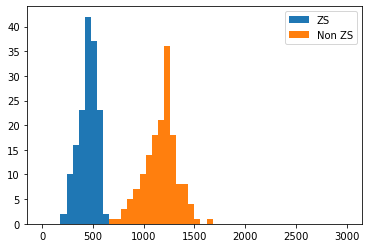

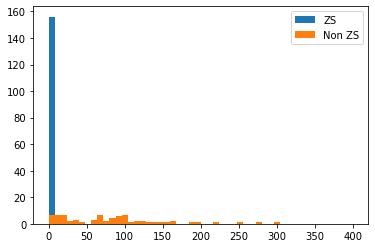

In [121]:
q_range = [0,3000]
plt.hist(zs_evts, bins=50, label='ZS', range=q_range)
plt.hist(nzs_evts-noise, bins=50, label='Non ZS', range=q_range)
plt.legend()
plt.show()

q_range = [0,400]
plt.hist(zs_outer, bins=50, label='ZS', range=q_range)
plt.hist(nzs_outer-noise, bins=50, label='Non ZS', range=q_range)
plt.legend()
plt.show()

In [117]:
def noise_func(m, b, w):
    m = (noise[-1] - noise[0]) / (window[-1] - window[0])
    b = 0
    return m*w + b

In [118]:
m = 124. # Found by fitting to noise given window
window = 10
noise = window*m

In [119]:
noise

1240.0

In [136]:
test_file = '/Users/taylorcontreras/Development/Research/nz_studies/data/trigger1/8088/test_nz/run_8088_0000_trigger1_waveforms.h5'
with tb.open_file(test_file, 'a') as file:
    print(file.root.RD.sipmrwf)
    file.create_array('/RD/', 'sipmrwf_zs', zs_sipm)
    
print('\nFinished amending\n')
    
with tb.open_file(test_file) as file:
    print(file)
    print(file.root.RD.sipmrwf)

/RD/sipmrwf (EArray(156, 1792, 1600), zlib(4)) ''

Finished amending

/Users/taylorcontreras/Development/Research/nz_studies/data/trigger1/8088/test_nz/run_8088_0000_trigger1_waveforms.h5 (File) ''
Last modif.: 'Thu Apr  6 13:27:39 2023'
Object Tree: 
/ (RootGroup) ''
/RD (Group) ''
/RD/pmtrwf (EArray(156, 12, 64000), zlib(4)) ''
/RD/sipmrwf (EArray(156, 1792, 1600), zlib(4)) ''
/RD/sipmrwf_zs (Array(156, 1790, 1600)) ''
/RD/test (Array(0,)) ''
/Run (Group) ''
/Run/events (Table(156,)) ''
/Run/runInfo (Table(1,)) ''
/Sensors (Group) ''
/Sensors/DataPMT (Table(12,)) ''
/Sensors/DataSiPM (Table(1792,)) ''
/Trigger (Group) ''
/Trigger/configuration (Table(22,)) ''
/Trigger/events (EArray(156, 12), zlib(4)) ''
/Trigger/trigger (Table(156,)) ''

/RD/sipmrwf (EArray(156, 1792, 1600), zlib(4)) ''


In [4]:
def GetRawWaveforms(run_number, file_name):
    # Load the data into events array
    i = 0
    events = []
    wfs = cp.wf_from_files([file_name], cp.WfType.rwf)
    try:
        while wfs:
            thisdata = next(wfs)
            events.append(thisdata['sipm'])
            i += 1
    except StopIteration:
        pass
    finally:
        del wfs
    events = np.array(events)
    print('Number of Events: '+str(len(events)))

    return events

def zero_suppress(A, thresh, n_presamples):
    
    baseline = np.mean(A)
    A = np.array(A) - baseline
    B = np.zeros(np.shape(A))
    print(B)
    print(baseline)
    above_thresh = False
    this_j = None
    this_k = None
    prev_peak = -999
    for i in range(len(A)-1):
        
        if A[i] + A[i+1] >= thresh:
            
            if above_thresh:
                this_k = i+1
            else:
                this_j = i
                this_k = i+1
                above_thresh = True
                
        elif above_thresh:
            this_j = max([0,this_j-n_presamples, prev_peak])
            this_k = min(this_k+n_presamples+1, len(A))
            B[this_j:this_k] = A[this_j:this_k]
            prev_peak = this_k
            above_thresh = False
            
    if above_thresh and this_j!=None and this_k!=None:
        this_j = max([0,this_j-n_presamples, prev_peak])
        B[this_j:] = A[this_j:]
    
    B += baseline # Add back in baseline
    B = (np.rint(B)).astype(int) # convert to integers
    return B

In [123]:
run_number = 8088
raw_wfs = GetRawWaveforms(run_number, file_name)

Number of Events: 156


In [18]:
e1s1 = raw_wfs[0][0]
thresh = 10
n_presamples = 50
test = zero_suppress(e1s1, thresh, n_presamples)

[0. 0. 0. ... 0. 0. 0.]
52.011875


In [19]:
test

array([49, 54, 50, ..., 57, 51, 49])

In [124]:
thresh = 10
n_presamples = 50
zs_wfs = np.array([[zero_suppress(sipm_i, thresh, n_presamples) for sipm_i in evt_i] for evt_i in raw_wfs])

Baseline = 52.011875
Added samples 410:512
Added samples 1502:1600
Baseline = 51.25375
Added samples 0:66
Added samples 736:838
Baseline = 51.431875
Added samples 1440:1542
Baseline = 51.7075
Added samples 373:475
Added samples 642:744
Added samples 836:939
Added samples 1088:1190
Added samples 1190:1205
Added samples 1242:1344
Added samples 1524:1600
Baseline = 49.600625
Added samples 91:193
Added samples 414:516
Added samples 725:827
Added samples 995:1097
Baseline = 49.603125
Added samples 540:642
Added samples 694:796
Added samples 796:830
Added samples 1387:1489
Baseline = 50.098125
Added samples 410:512
Baseline = 49.861875
Added samples 280:382
Added samples 948:1050
Baseline = 50.084375
Added samples 144:246
Added samples 823:925
Baseline = 49.608125
Added samples 1179:1281
Added samples 1281:1366
Baseline = 49.176875
Added samples 132:234
Added samples 679:781
Baseline = 50.114375
Added samples 0:73
Added samples 1204:1307
Baseline = 49.933125
Added samples 1004:1106
Added sam

Added samples 831:933
Added samples 1119:1221
Baseline = 50.24375
Added samples 134:236
Added samples 528:630
Added samples 679:782
Added samples 1249:1351
Baseline = 50.599375
Added samples 0:74
Added samples 74:123
Added samples 530:632
Added samples 632:700
Added samples 700:799
Added samples 854:956
Added samples 1136:1238
Baseline = 50.4075
Added samples 1431:1533
Baseline = 50.855625
Added samples 869:971
Added samples 971:1065
Baseline = 50.480625
Added samples 298:400
Added samples 753:855
Added samples 975:1077
Added samples 1225:1327
Added samples 1327:1348
Added samples 1496:1598
Baseline = 50.51625
Added samples 151:253
Added samples 1180:1282
Added samples 1282:1296
Baseline = 50.7975
Added samples 95:198
Added samples 282:385
Added samples 385:452
Added samples 600:703
Added samples 797:899
Added samples 1167:1269
Added samples 1457:1559
Baseline = 49.930625
Added samples 95:197
Added samples 371:473
Added samples 473:501
Baseline = 49.9175
Added samples 1500:1600
Baselin

Added samples 724:826
Added samples 926:1028
Added samples 1404:1506
Baseline = 50.279375
Added samples 338:440
Added samples 512:615
Added samples 615:695
Added samples 1061:1163
Added samples 1163:1221
Added samples 1221:1285
Added samples 1417:1519
Baseline = 50.74375
Added samples 444:546
Added samples 735:837
Added samples 837:880
Baseline = 50.7925
Added samples 0:89
Added samples 89:103
Added samples 131:233
Added samples 233:241
Added samples 695:797
Added samples 797:802
Added samples 949:1052
Added samples 1052:1116
Added samples 1116:1178
Baseline = 50.3525
Added samples 0:87
Added samples 496:598
Added samples 647:749
Added samples 751:854
Baseline = 50.55625
Added samples 204:306
Added samples 342:444
Added samples 751:853
Added samples 1084:1186
Added samples 1186:1252
Added samples 1252:1335
Baseline = 50.5475
Added samples 492:594
Added samples 942:1044
Added samples 1305:1408
Baseline = 51.098125
Baseline = 49.139375
Added samples 869:971
Added samples 1383:1485
Added 

Added samples 731:833
Added samples 873:975
Added samples 1166:1268
Added samples 1268:1290
Added samples 1333:1435
Added samples 1435:1495
Baseline = 50.203125
Added samples 73:175
Added samples 952:1054
Baseline = 50.631875
Added samples 0:85
Baseline = 50.129375
Added samples 750:852
Added samples 974:1076
Added samples 1121:1223
Baseline = 49.8125
Added samples 152:254
Added samples 254:318
Baseline = 49.82125
Added samples 821:923
Baseline = 50.164375
Added samples 1525:1600
Baseline = 51.313125
Added samples 0:81
Added samples 311:413
Baseline = 51.900625
Added samples 978:1080
Added samples 1112:1214
Baseline = 52.041875
Added samples 38:141
Added samples 523:625
Added samples 684:786
Added samples 1498:1600
Added samples 1600:1600
Baseline = 52.028125
Added samples 578:681
Added samples 681:726
Added samples 726:792
Added samples 792:869
Added samples 1015:1117
Baseline = 50.2175
Added samples 751:853
Added samples 926:1028
Added samples 1080:1182
Baseline = 50.088125
Added sam

Baseline = 49.8325
Added samples 884:986
Baseline = 49.371875
Added samples 498:600
Added samples 749:851
Added samples 1188:1290
Baseline = 49.274375
Added samples 88:190
Added samples 462:564
Baseline = 49.925625
Added samples 201:303
Added samples 303:387
Baseline = 50.185
Added samples 751:853
Baseline = 50.100625
Baseline = 50.084375
Added samples 98:201
Added samples 426:528
Added samples 893:995
Added samples 1349:1451
Baseline = 51.403125
Baseline = 51.0
Added samples 1330:1433
Baseline = 50.84625
Baseline = 50.376875
Added samples 315:417
Baseline = 48.751875
Added samples 31:133
Added samples 415:517
Added samples 517:605
Baseline = 49.51875
Added samples 98:200
Added samples 622:724
Added samples 724:742
Added samples 742:751
Added samples 1145:1247
Added samples 1247:1250
Added samples 1250:1320
Baseline = 49.901875
Added samples 192:294
Added samples 389:491
Added samples 559:662
Added samples 662:725
Added samples 1017:1119
Added samples 1137:1239
Added samples 1316:1418


Added samples 424:526
Added samples 854:956
Baseline = 52.306875
Added samples 0:54
Added samples 54:102
Added samples 855:957
Added samples 1192:1295
Baseline = 50.695625
Added samples 0:89
Added samples 89:190
Added samples 231:333
Added samples 333:337
Added samples 696:798
Added samples 1008:1110
Added samples 1110:1207
Baseline = 49.689375
Added samples 894:996
Added samples 996:1031
Baseline = 46.921875
Baseline = 47.935
Added samples 668:770
Added samples 1210:1312
Baseline = 45.35
Added samples 283:385
Baseline = 45.768125
Added samples 81:183
Added samples 320:422
Added samples 1023:1126
Baseline = 46.2775
Added samples 1266:1368
Baseline = 46.523125
Added samples 596:698
Added samples 713:815
Added samples 815:861
Added samples 861:954
Added samples 1520:1600
Baseline = 45.155625
Added samples 96:198
Added samples 391:493
Added samples 978:1080
Baseline = 45.3775
Added samples 1164:1266
Baseline = 47.0025
Added samples 16:118
Added samples 802:904
Baseline = 48.44625
Added sa

Baseline = 49.679375
Baseline = 50.17375
Added samples 750:852
Added samples 852:900
Added samples 1196:1298
Baseline = 49.51875
Added samples 174:276
Added samples 493:595
Added samples 1196:1298
Baseline = 51.15125
Added samples 124:226
Added samples 407:509
Added samples 509:587
Added samples 1366:1468
Baseline = 51.73
Added samples 443:545
Added samples 873:975
Baseline = 50.863125
Baseline = 50.994375
Added samples 983:1085
Added samples 1085:1184
Baseline = 48.433125
Added samples 1165:1267
Added samples 1498:1600
Baseline = 48.791875
Added samples 139:241
Baseline = 47.96
Added samples 605:707
Added samples 828:930
Baseline = 47.984375
Added samples 1110:1212
Baseline = 49.3325
Added samples 93:195
Added samples 195:264
Added samples 393:495
Added samples 688:790
Added samples 1004:1106
Added samples 1106:1154
Added samples 1395:1498
Baseline = 49.881875
Added samples 790:892
Added samples 1374:1476
Baseline = 49.820625
Added samples 843:945
Baseline = 50.059375
Added samples 21

Added samples 1495:1597
Baseline = 51.103125
Added samples 750:852
Baseline = 50.785625
Added samples 607:709
Baseline = 51.7675
Added samples 952:1054
Added samples 1226:1328
Added samples 1405:1507
Added samples 1536:1600
Baseline = 51.36
Added samples 110:212
Added samples 1126:1228
Baseline = 51.31125
Added samples 374:476
Added samples 476:546
Baseline = 50.83625
Added samples 348:450
Added samples 549:651
Added samples 1421:1523
Baseline = 51.129375
Added samples 297:399
Added samples 1031:1133
Baseline = 51.069375
Baseline = 50.91625
Added samples 367:469
Added samples 578:680
Added samples 1205:1307
Baseline = 51.141875
Added samples 428:530
Added samples 753:855
Baseline = 51.276875
Added samples 636:738
Added samples 856:958
Added samples 1237:1339
Baseline = 51.484375
Added samples 718:820
Baseline = 51.558125
Added samples 53:156
Added samples 387:489
Added samples 1498:1600
Baseline = 50.6
Added samples 887:989
Baseline = 49.67375
Added samples 150:252
Added samples 839:94

Added samples 1351:1453
Added samples 1453:1536
Baseline = 50.58375
Added samples 61:163
Added samples 1017:1119
Added samples 1119:1157
Added samples 1204:1306
Added samples 1323:1425
Added samples 1511:1600
Baseline = 50.070625
Baseline = 48.709375
Added samples 459:561
Added samples 590:692
Baseline = 50.860625
Added samples 1:103
Added samples 829:931
Baseline = 50.39375
Baseline = 50.53375
Added samples 482:584
Added samples 1336:1438
Baseline = 50.15875
Added samples 857:959
Added samples 1044:1146
Baseline = 50.913125
Baseline = 50.55375
Added samples 308:410
Baseline = 50.815
Added samples 1306:1408
Baseline = 50.23875
Added samples 1290:1392
Baseline = 47.38875
Baseline = 50.704375
Added samples 488:590
Baseline = 50.2775
Added samples 0:93
Added samples 826:928
Added samples 1306:1408
Added samples 1408:1468
Added samples 1509:1600
Baseline = 50.35375
Added samples 729:831
Added samples 1104:1206
Baseline = 50.658125
Baseline = 51.268125
Added samples 751:853
Added samples 95

Added samples 977:1079
Added samples 1179:1281
Baseline = 50.42625
Baseline = 50.896875
Added samples 882:985
Baseline = 50.498125
Added samples 612:714
Added samples 714:795
Baseline = 50.6175
Added samples 0:97
Added samples 616:718
Added samples 1241:1343
Baseline = 51.44
Added samples 668:771
Added samples 1006:1108
Baseline = 50.745
Added samples 686:788
Baseline = 51.17625
Added samples 148:250
Baseline = 52.586875
Added samples 629:731
Added samples 1270:1372
Added samples 1459:1561
Added samples 1561:1600
Baseline = 51.493125
Added samples 47:149
Added samples 963:1065
Added samples 1065:1146
Added samples 1239:1341
Baseline = 50.858125
Added samples 43:145
Added samples 145:207
Added samples 207:218
Added samples 259:361
Added samples 393:495
Added samples 805:907
Added samples 907:980
Added samples 1142:1245
Baseline = 50.418125
Added samples 710:812
Added samples 1321:1423
Added samples 1423:1498
Baseline = 51.375
Added samples 1265:1367
Added samples 1417:1519
Baseline = 51

Added samples 735:837
Added samples 1064:1166
Baseline = 51.29375
Added samples 223:325
Added samples 325:372
Added samples 372:397
Added samples 397:473
Baseline = 50.39875
Added samples 1054:1156
Baseline = 50.726875
Added samples 1043:1145
Baseline = 50.996875
Added samples 149:251
Added samples 251:273
Added samples 406:508
Added samples 508:533
Added samples 544:646
Added samples 646:680
Added samples 1055:1157
Baseline = 48.325
Added samples 55:157
Added samples 157:169
Added samples 216:318
Added samples 637:739
Baseline = 50.01
Added samples 607:709
Added samples 983:1085
Added samples 1470:1572
Baseline = 51.144375
Added samples 400:502
Baseline = 50.5875
Added samples 1529:1600
Baseline = 50.675625
Baseline = 50.654375
Added samples 1451:1553
Baseline = 50.94125
Added samples 417:519
Added samples 519:559
Added samples 1168:1270
Baseline = 50.8625
Added samples 0:75
Added samples 75:172
Added samples 301:403
Added samples 631:733
Added samples 928:1030
Added samples 1030:1060

Baseline = 49.32375
Added samples 5:107
Added samples 1332:1434
Baseline = 48.9775
Added samples 194:296
Added samples 296:344
Baseline = 49.8825
Added samples 1460:1563
Baseline = 49.760625
Added samples 0:66
Added samples 292:394
Added samples 1181:1283
Baseline = 49.94
Added samples 73:175
Added samples 1285:1387
Baseline = 49.76125
Added samples 101:203
Added samples 1226:1328
Added samples 1328:1348
Baseline = 50.73375
Added samples 55:157
Added samples 157:185
Added samples 408:510
Baseline = 50.360625
Added samples 88:190
Added samples 384:486
Added samples 486:519
Added samples 528:630
Added samples 1133:1235
Added samples 1235:1241
Added samples 1294:1396
Baseline = 52.325625
Added samples 229:331
Added samples 427:529
Added samples 529:584
Added samples 998:1100
Baseline = 52.55875
Added samples 128:230
Added samples 230:237
Added samples 435:537
Added samples 675:777
Added samples 1310:1412
Baseline = 53.1075
Added samples 0:57
Added samples 409:511
Added samples 751:853
Add

Baseline = 49.208125
Added samples 0:95
Baseline = 49.358125
Baseline = 49.795
Added samples 263:365
Added samples 1442:1544
Baseline = 50.343125
Added samples 59:162
Added samples 217:319
Added samples 885:987
Added samples 987:1036
Baseline = 50.059375
Added samples 885:987
Added samples 987:1043
Baseline = 49.219375
Baseline = 52.759375
Added samples 1307:1409
Baseline = 51.9675
Added samples 32:134
Baseline = 51.80375
Added samples 151:253
Added samples 541:643
Added samples 1050:1152
Added samples 1367:1469
Baseline = 52.410625
Added samples 543:645
Added samples 1172:1274
Added samples 1389:1491
Baseline = 49.709375
Added samples 106:208
Added samples 959:1061
Baseline = 49.355
Added samples 325:427
Added samples 427:431
Added samples 856:958
Added samples 958:1019
Added samples 1019:1080
Added samples 1400:1502
Added samples 1502:1531
Baseline = 49.48
Added samples 1200:1302
Added samples 1528:1600
Baseline = 50.22
Added samples 1232:1334
Baseline = 49.930625
Added samples 201:3

Baseline = 49.80875
Added samples 0:98
Added samples 98:173
Added samples 750:853
Added samples 853:916
Baseline = 49.741875
Baseline = 50.43125
Added samples 298:400
Added samples 400:458
Added samples 752:856
Added samples 999:1101
Added samples 1417:1519
Baseline = 50.366875
Added samples 2:104
Added samples 557:659
Baseline = 50.278125
Added samples 419:521
Added samples 958:1060
Added samples 1219:1321
Baseline = 50.081875
Added samples 372:474
Added samples 474:508
Added samples 1422:1524
Baseline = 49.659375
Added samples 1025:1127
Added samples 1127:1178
Baseline = 49.338125
Baseline = 50.200625
Added samples 1108:1210
Added samples 1407:1509
Baseline = 50.66125
Baseline = 50.565
Baseline = 50.089375
Added samples 37:139
Added samples 766:868
Baseline = 53.055625
Added samples 20:122
Added samples 745:847
Added samples 847:905
Added samples 1263:1365
Added samples 1365:1371
Added samples 1431:1533
Added samples 1533:1567
Baseline = 51.96125
Baseline = 51.901875
Added samples 11

Baseline = 51.095
Baseline = 50.615625
Added samples 1412:1514
Baseline = 51.140625
Added samples 1201:1304
Baseline = 51.525
Added samples 0:59
Added samples 200:302
Added samples 754:856
Baseline = 50.610625
Added samples 189:291
Added samples 702:804
Added samples 1088:1190
Added samples 1544:1600
Baseline = 50.47625
Added samples 600:702
Added samples 732:834
Added samples 974:1076
Added samples 1316:1418
Added samples 1485:1587
Baseline = 49.89375
Added samples 750:852
Baseline = 49.346875
Added samples 289:391
Added samples 636:738
Baseline = 48.241875
Added samples 359:461
Added samples 876:978
Added samples 1328:1430
Baseline = 48.558125
Added samples 22:124
Added samples 683:785
Baseline = 50.10625
Added samples 447:549
Added samples 600:702
Added samples 702:759
Added samples 966:1068
Added samples 1102:1204
Added samples 1497:1599
Baseline = 50.07875
Added samples 284:386
Added samples 601:703
Added samples 728:830
Added samples 1274:1376
Added samples 1376:1385
Added sample

Added samples 610:712
Added samples 854:956
Added samples 1222:1324
Baseline = 51.449375
Added samples 1373:1475
Baseline = 51.020625
Added samples 1268:1370
Baseline = 50.326875
Added samples 255:357
Baseline = 50.520625
Added samples 388:490
Added samples 740:842
Added samples 1074:1176
Added samples 1176:1187
Added samples 1244:1346
Added samples 1485:1587
Baseline = 51.338125
Added samples 1279:1381
Baseline = 50.961875
Added samples 171:273
Added samples 273:316
Baseline = 50.969375
Added samples 32:134
Baseline = 50.331875
Added samples 132:234
Added samples 234:298
Added samples 298:394
Added samples 823:925
Added samples 950:1052
Baseline = 48.905625
Added samples 415:517
Added samples 917:1019
Baseline = 50.955625
Added samples 231:333
Added samples 333:349
Added samples 581:683
Added samples 683:691
Baseline = 50.465
Added samples 541:643
Added samples 1049:1151
Added samples 1186:1288
Added samples 1288:1368
Baseline = 50.25125
Added samples 0:89
Added samples 231:333
Baseli

Added samples 1280:1382
Added samples 1382:1426
Baseline = 52.68375
Added samples 321:423
Baseline = 50.938125
Added samples 125:227
Added samples 282:384
Added samples 572:674
Added samples 787:889
Added samples 1002:1104
Baseline = 50.171875
Added samples 252:354
Baseline = 50.168125
Added samples 37:139
Added samples 439:541
Baseline = 50.838125
Added samples 741:843
Added samples 862:964
Added samples 1147:1249
Baseline = 50.70625
Added samples 119:221
Added samples 269:371
Added samples 371:432
Added samples 1201:1303
Added samples 1303:1390
Baseline = 51.749375
Added samples 131:233
Added samples 380:482
Added samples 754:856
Added samples 856:861
Added samples 861:943
Added samples 943:1003
Added samples 1003:1046
Baseline = 50.77125
Added samples 723:825
Added samples 955:1057
Added samples 1323:1425
Baseline = 50.5425
Added samples 255:357
Added samples 958:1060
Baseline = 50.88125
Added samples 171:273
Added samples 572:674
Added samples 918:1020
Added samples 1020:1087
Basel

Baseline = 50.308125
Added samples 983:1085
Baseline = 50.155
Added samples 1315:1417
Baseline = 50.278125
Added samples 1136:1238
Baseline = 51.6575
Added samples 128:230
Added samples 1541:1600
Baseline = 51.91625
Added samples 871:973
Baseline = 52.401875
Added samples 21:123
Added samples 396:498
Added samples 603:705
Added samples 1196:1298
Baseline = 51.846875
Added samples 756:858
Baseline = 50.76875
Added samples 359:461
Added samples 478:580
Baseline = 50.704375
Added samples 1024:1126
Baseline = 50.875
Added samples 414:516
Added samples 516:589
Baseline = 47.115
Added samples 149:251
Added samples 332:434
Added samples 561:663
Added samples 663:684
Added samples 1030:1132
Baseline = 50.10625
Added samples 1068:1170
Added samples 1188:1290
Added samples 1290:1303
Added samples 1423:1525
Added samples 1525:1549
Baseline = 50.5375
Added samples 307:409
Added samples 1451:1553
Baseline = 50.52625
Added samples 15:117
Added samples 485:587
Added samples 725:827
Added samples 989:

Baseline = 50.010625
Added samples 70:172
Baseline = 49.99
Added samples 752:854
Baseline = 50.166875
Added samples 486:588
Baseline = 49.515625
Added samples 161:263
Added samples 982:1084
Baseline = 50.156875
Added samples 0:53
Added samples 53:112
Added samples 175:277
Added samples 277:326
Added samples 326:405
Added samples 405:446
Added samples 446:509
Added samples 531:633
Added samples 674:776
Added samples 980:1082
Added samples 1120:1222
Added samples 1424:1526
Baseline = 50.1775
Added samples 1413:1515
Baseline = 50.703125
Added samples 0:89
Added samples 774:876
Added samples 1257:1359
Added samples 1438:1540
Baseline = 49.804375
Added samples 826:928
Added samples 1278:1382
Baseline = 49.7225
Added samples 147:249
Baseline = 49.806875
Added samples 1407:1509
Baseline = 50.144375
Added samples 176:278
Added samples 278:378
Added samples 957:1059
Baseline = 51.206875
Added samples 64:166
Baseline = 51.86
Added samples 431:533
Added samples 564:666
Added samples 666:672
Basel

Baseline = 50.315
Added samples 1140:1242
Baseline = 50.3875
Added samples 0:80
Added samples 242:344
Added samples 1245:1347
Added samples 1511:1600
Baseline = 50.321875
Added samples 499:601
Added samples 652:754
Added samples 965:1067
Added samples 1067:1102
Added samples 1420:1522
Baseline = 50.233125
Added samples 970:1072
Baseline = 51.454375
Added samples 1117:1219
Baseline = 51.245
Added samples 0:81
Added samples 81:165
Added samples 165:205
Added samples 767:869
Added samples 977:1079
Added samples 1145:1247
Baseline = 50.99
Added samples 888:990
Baseline = 50.34
Added samples 521:623
Baseline = 48.60375
Added samples 204:306
Added samples 306:344
Baseline = 49.4325
Added samples 205:308
Added samples 394:496
Added samples 496:503
Added samples 1166:1268
Baseline = 50.048125
Added samples 35:138
Added samples 308:411
Added samples 470:572
Added samples 1177:1279
Baseline = 49.5375
Added samples 726:828
Added samples 1015:1117
Baseline = 49.36125
Baseline = 49.411875
Added sam

Baseline = 50.413125
Added samples 30:132
Added samples 132:194
Baseline = 49.78625
Added samples 525:627
Added samples 1018:1120
Added samples 1186:1288
Added samples 1304:1406
Baseline = 46.9775
Added samples 1400:1502
Baseline = 47.805625
Added samples 896:998
Baseline = 45.3075
Added samples 896:998
Baseline = 45.5875
Added samples 516:618
Added samples 827:929
Added samples 1239:1341
Baseline = 46.438125
Added samples 150:252
Added samples 666:768
Added samples 1301:1403
Baseline = 46.45125
Added samples 660:762
Added samples 1190:1292
Baseline = 45.13
Added samples 700:802
Added samples 1216:1318
Added samples 1318:1360
Added samples 1360:1422
Baseline = 45.428125
Added samples 1053:1155
Baseline = 46.9675
Baseline = 48.605625
Added samples 58:160
Added samples 369:471
Added samples 471:515
Added samples 590:693
Added samples 840:942
Added samples 1034:1136
Baseline = 45.604375
Added samples 282:384
Added samples 450:552
Added samples 552:596
Added samples 686:788
Added samples 7

Baseline = 51.5075
Added samples 27:129
Baseline = 50.910625
Added samples 0:98
Added samples 219:321
Added samples 1546:1600
Baseline = 51.056875
Added samples 903:1005
Baseline = 48.681875
Added samples 465:567
Added samples 749:859
Added samples 897:999
Added samples 1201:1303
Baseline = 48.84125
Added samples 750:852
Added samples 1378:1480
Added samples 1480:1483
Added samples 1483:1495
Baseline = 47.96375
Added samples 154:257
Added samples 341:443
Added samples 443:545
Added samples 750:852
Added samples 852:856
Added samples 1127:1229
Baseline = 47.765
Added samples 1190:1292
Baseline = 49.545625
Added samples 34:136
Added samples 206:308
Added samples 382:484
Added samples 606:708
Added samples 803:905
Added samples 905:930
Added samples 930:939
Added samples 939:987
Added samples 1106:1209
Added samples 1209:1226
Baseline = 49.92875
Added samples 1149:1251
Baseline = 49.84125
Added samples 4:106
Baseline = 50.165
Added samples 649:751
Added samples 856:958
Added samples 1120:

Added samples 1539:1600
Baseline = 51.26875
Added samples 511:613
Added samples 824:926
Added samples 1153:1255
Added samples 1255:1315
Added samples 1535:1600
Baseline = 50.91375
Added samples 474:576
Baseline = 50.935625
Added samples 80:182
Added samples 1259:1361
Baseline = 51.155625
Baseline = 51.490625
Added samples 1274:1376
Baseline = 51.540625
Added samples 28:130
Added samples 257:359
Added samples 359:388
Added samples 735:837
Baseline = 50.626875
Added samples 90:192
Added samples 576:678
Added samples 834:936
Added samples 936:1009
Added samples 1172:1274
Baseline = 49.483125
Added samples 384:486
Added samples 663:765
Added samples 1218:1320
Baseline = 49.56625
Added samples 100:202
Added samples 254:356
Added samples 483:585
Baseline = 48.634375
Added samples 84:186
Added samples 256:358
Added samples 688:791
Added samples 1336:1438
Baseline = 49.64125
Added samples 1088:1190
Added samples 1463:1565
Baseline = 50.3
Baseline = 50.328125
Added samples 518:620
Added samples

Added samples 437:539
Baseline = 51.03
Added samples 180:283
Added samples 1024:1126
Baseline = 50.386875
Baseline = 47.5775
Added samples 126:228
Added samples 1294:1396
Baseline = 50.739375
Added samples 365:467
Added samples 744:846
Added samples 1236:1338
Baseline = 50.110625
Added samples 671:773
Added samples 809:911
Added samples 924:1026
Added samples 1026:1080
Added samples 1098:1200
Baseline = 50.410625
Added samples 48:150
Added samples 1338:1440
Added samples 1475:1577
Baseline = 50.554375
Added samples 113:215
Added samples 1112:1214
Baseline = 51.348125
Added samples 1431:1533
Added samples 1539:1600
Baseline = 50.676875
Added samples 383:485
Baseline = 51.054375
Added samples 1464:1566
Baseline = 49.7575
Added samples 104:206
Added samples 414:516
Added samples 859:961
Baseline = 50.254375
Baseline = 48.940625
Added samples 35:138
Added samples 917:1019
Baseline = 48.553125
Added samples 159:261
Added samples 1263:1365
Baseline = 50.2775
Added samples 127:229
Baseline = 

Baseline = 51.601875
Added samples 454:556
Baseline = 50.81125
Added samples 383:487
Added samples 487:516
Added samples 594:696
Added samples 997:1099
Added samples 1099:1150
Added samples 1432:1534
Baseline = 50.55125
Added samples 0:98
Baseline = 51.48
Added samples 0:94
Added samples 94:172
Baseline = 51.294375
Added samples 194:296
Added samples 456:558
Added samples 1263:1365
Baseline = 51.1775
Added samples 277:379
Added samples 656:758
Added samples 1539:1600
Baseline = 50.779375
Added samples 693:795
Added samples 809:911
Baseline = 50.9825
Added samples 427:529
Added samples 969:1071
Added samples 1078:1180
Baseline = 51.339375
Added samples 64:166
Added samples 166:208
Added samples 208:213
Added samples 213:219
Added samples 1075:1177
Baseline = 50.583125
Added samples 64:166
Added samples 1328:1430
Baseline = 50.246875
Added samples 612:714
Added samples 1482:1584
Baseline = 51.530625
Added samples 921:1023
Baseline = 51.75125
Added samples 22:124
Added samples 154:256
Add

Baseline = 50.53375
Added samples 94:196
Added samples 1063:1165
Baseline = 50.6675
Added samples 992:1094
Added samples 1094:1125
Baseline = 50.675
Added samples 689:791
Baseline = 51.00375
Added samples 248:350
Added samples 474:576
Added samples 1244:1346
Added samples 1346:1378
Added samples 1461:1563
Baseline = 50.88875
Added samples 117:219
Added samples 609:712
Baseline = 47.646875
Added samples 0:66
Added samples 441:543
Added samples 605:707
Added samples 750:852
Added samples 987:1089
Baseline = 47.018125
Added samples 256:358
Added samples 507:609
Added samples 1170:1272
Added samples 1480:1582
Baseline = 50.619375
Added samples 158:260
Added samples 750:852
Added samples 1192:1294
Added samples 1294:1322
Added samples 1483:1585
Baseline = 50.36625
Added samples 160:262
Added samples 1540:1600
Baseline = 50.16625
Added samples 0:62
Baseline = 50.86125
Added samples 15:117
Added samples 206:308
Added samples 440:542
Baseline = 51.2375
Added samples 440:542
Added samples 1377:

Baseline = 52.2875
Added samples 0:68
Added samples 346:448
Added samples 638:741
Added samples 975:1077
Added samples 1516:1600
Baseline = 52.9925
Added samples 20:122
Added samples 454:556
Added samples 1056:1158
Added samples 1379:1481
Added samples 1481:1548
Baseline = 53.060625
Added samples 217:319
Added samples 337:439
Added samples 1099:1201
Added samples 1202:1304
Added samples 1304:1355
Baseline = 50.374375
Added samples 677:779
Baseline = 50.47875
Added samples 107:209
Added samples 571:674
Added samples 1292:1394
Added samples 1394:1436
Added samples 1534:1600
Baseline = 50.651875
Added samples 1376:1478
Baseline = 50.311875
Added samples 117:219
Added samples 219:310
Baseline = 50.515625
Added samples 226:328
Added samples 631:733
Added samples 1409:1511
Baseline = 50.43875
Added samples 1253:1355
Baseline = 50.45375
Added samples 454:556
Baseline = 51.348125
Added samples 0:71
Added samples 172:274
Added samples 508:610
Added samples 1123:1225
Baseline = 50.646875
Added s

Added samples 410:512
Added samples 512:522
Added samples 1072:1174
Added samples 1320:1422
Baseline = 49.869375
Added samples 259:361
Added samples 756:859
Added samples 1473:1575
Baseline = 50.295
Added samples 958:1060
Added samples 1518:1600
Baseline = 50.005
Added samples 0:78
Added samples 112:214
Added samples 214:293
Added samples 1233:1335
Baseline = 50.698125
Added samples 626:728
Added samples 1049:1152
Baseline = 49.904375
Added samples 658:760
Added samples 1008:1110
Added samples 1201:1303
Added samples 1303:1319
Baseline = 52.355
Added samples 196:298
Added samples 298:364
Added samples 364:393
Added samples 905:1007
Added samples 1019:1121
Added samples 1288:1390
Baseline = 52.3525
Added samples 30:133
Added samples 133:188
Added samples 929:1031
Added samples 1345:1447
Baseline = 51.893125
Added samples 374:476
Added samples 670:772
Added samples 987:1089
Added samples 1120:1222
Added samples 1222:1323
Baseline = 52.134375
Added samples 0:80
Added samples 823:925
Basel

Baseline = 52.986875
Added samples 0:76
Added samples 76:124
Added samples 601:703
Added samples 847:949
Added samples 1277:1379
Added samples 1379:1469
Baseline = 52.185
Added samples 378:480
Added samples 480:535
Added samples 1512:1600
Baseline = 51.85875
Added samples 653:755
Added samples 900:1002
Added samples 1002:1010
Baseline = 51.83875
Added samples 483:585
Added samples 1133:1235
Baseline = 49.778125
Added samples 948:1050
Baseline = 50.29875
Added samples 0:65
Added samples 90:192
Added samples 342:444
Added samples 565:667
Added samples 667:723
Added samples 739:841
Added samples 1396:1498
Added samples 1498:1590
Baseline = 50.34625
Added samples 358:460
Added samples 460:465
Added samples 877:979
Added samples 1471:1573
Baseline = 49.903125
Added samples 356:458
Baseline = 49.93
Added samples 5:107
Added samples 126:228
Added samples 228:232
Added samples 232:268
Added samples 908:1010
Added samples 1010:1103
Baseline = 49.364375
Added samples 933:1035
Added samples 1035:

Added samples 1142:1244
Added samples 1401:1504
Added samples 1504:1522
Added samples 1522:1552
Baseline = 50.078125
Added samples 271:373
Added samples 539:641
Added samples 641:711
Added samples 1125:1228
Baseline = 50.32875
Added samples 67:169
Added samples 344:446
Added samples 446:495
Added samples 661:763
Added samples 913:1015
Baseline = 50.138125
Added samples 0:97
Added samples 1455:1557
Baseline = 49.723125
Baseline = 49.73875
Added samples 1023:1125
Added samples 1133:1235
Baseline = 50.02875
Added samples 146:249
Baseline = 49.950625
Added samples 52:154
Added samples 368:471
Added samples 471:556
Added samples 556:644
Added samples 1242:1344
Baseline = 49.445625
Added samples 330:432
Added samples 582:684
Added samples 1035:1137
Added samples 1458:1560
Baseline = 49.841875
Added samples 0:56
Added samples 416:518
Added samples 941:1043
Added samples 1045:1147
Added samples 1147:1152
Added samples 1255:1357
Baseline = 53.524375
Added samples 1018:1120
Added samples 1120:11

Added samples 889:991
Added samples 1162:1264
Added samples 1370:1472
Baseline = 49.465625
Added samples 523:625
Added samples 712:814
Baseline = 50.038125
Added samples 452:555
Baseline = 50.2075
Added samples 0:95
Added samples 184:287
Added samples 457:559
Added samples 736:838
Added samples 908:1010
Added samples 1292:1394
Added samples 1451:1554
Baseline = 50.073125
Added samples 122:224
Baseline = 50.14
Added samples 329:431
Added samples 474:576
Added samples 1303:1405
Baseline = 50.629375
Added samples 429:531
Added samples 667:769
Added samples 1202:1304
Added samples 1357:1459
Baseline = 50.189375
Added samples 937:1039
Baseline = 49.8275
Added samples 0:55
Added samples 249:351
Added samples 426:528
Added samples 528:612
Added samples 1225:1327
Added samples 1327:1340
Baseline = 49.390625
Added samples 1516:1600
Baseline = 49.63
Added samples 1020:1122
Baseline = 50.238125
Added samples 1021:1123
Baseline = 50.32625
Added samples 19:122
Baseline = 50.09625
Added samples 412:

Added samples 964:1066
Added samples 1233:1335
Added samples 1417:1519
Added samples 1519:1522
Baseline = 50.97625
Added samples 29:131
Added samples 246:348
Added samples 750:852
Added samples 852:888
Added samples 1038:1140
Added samples 1140:1224
Added samples 1285:1387
Baseline = 50.65375
Added samples 752:854
Added samples 1017:1119
Added samples 1539:1600
Baseline = 51.27625
Added samples 172:274
Added samples 421:523
Added samples 948:1050
Added samples 1050:1060
Added samples 1314:1418
Added samples 1418:1468
Added samples 1471:1573
Added samples 1573:1600
Baseline = 51.2425
Baseline = 50.79375
Added samples 1014:1116
Added samples 1116:1119
Baseline = 50.51
Added samples 683:785
Added samples 1448:1550
Baseline = 50.765
Baseline = 51.305
Added samples 580:682
Added samples 683:785
Added samples 1016:1119
Baseline = 50.963125
Added samples 0:65
Added samples 65:84
Added samples 254:356
Added samples 499:601
Added samples 714:816
Added samples 1227:1329
Added samples 1393:1495
B

Added samples 1018:1120
Added samples 1120:1189
Baseline = 50.6725
Added samples 0:65
Added samples 1103:1205
Added samples 1427:1529
Baseline = 50.73625
Baseline = 47.143125
Added samples 0:86
Added samples 86:123
Added samples 1051:1153
Added samples 1156:1258
Added samples 1258:1327
Added samples 1510:1600
Baseline = 50.12375
Added samples 315:417
Added samples 558:661
Added samples 733:835
Added samples 835:906
Baseline = 50.689375
Added samples 559:662
Added samples 662:749
Added samples 749:784
Added samples 789:891
Added samples 1014:1116
Baseline = 50.675625
Added samples 434:536
Added samples 536:544
Added samples 544:626
Added samples 734:836
Baseline = 50.14875
Added samples 675:777
Baseline = 50.470625
Added samples 463:565
Added samples 565:581
Added samples 835:937
Added samples 937:997
Added samples 997:1078
Added samples 1130:1232
Baseline = 50.47125
Added samples 6:108
Added samples 1089:1191
Added samples 1503:1600
Baseline = 51.071875
Added samples 178:280
Baseline =

Added samples 681:783
Baseline = 51.911875
Added samples 529:631
Added samples 819:922
Added samples 922:994
Added samples 994:1013
Added samples 1089:1191
Baseline = 51.68875
Added samples 0:54
Added samples 360:462
Added samples 462:472
Added samples 882:984
Added samples 1192:1294
Baseline = 51.9175
Added samples 442:545
Added samples 898:1000
Added samples 1015:1118
Baseline = 50.13625
Added samples 681:783
Added samples 783:793
Added samples 1362:1464
Baseline = 50.141875
Added samples 0:54
Added samples 238:340
Added samples 715:817
Added samples 1298:1400
Added samples 1400:1427
Added samples 1427:1493
Baseline = 51.004375
Added samples 98:200
Added samples 252:355
Added samples 736:838
Added samples 932:1034
Added samples 1259:1361
Added samples 1365:1467
Baseline = 49.556875
Added samples 0:99
Added samples 194:296
Added samples 449:551
Added samples 787:889
Added samples 1017:1119
Added samples 1351:1453
Baseline = 50.81875
Baseline = 50.560625
Added samples 101:203
Added sam

Added samples 476:578
Added samples 605:708
Added samples 708:757
Added samples 869:971
Added samples 990:1092
Baseline = 49.645625
Added samples 271:373
Added samples 735:837
Added samples 926:1028
Added samples 1028:1055
Added samples 1055:1119
Baseline = 49.53
Added samples 1428:1530
Baseline = 49.59375
Added samples 329:431
Added samples 898:1000
Baseline = 49.683125
Baseline = 49.68625
Baseline = 50.229375
Added samples 273:375
Added samples 375:402
Added samples 726:828
Added samples 828:879
Added samples 991:1093
Added samples 1093:1118
Added samples 1161:1263
Added samples 1406:1508
Added samples 1508:1530
Added samples 1532:1600
Baseline = 49.469375
Added samples 682:785
Added samples 785:866
Added samples 1489:1591
Baseline = 50.455625
Added samples 381:483
Added samples 1016:1119
Baseline = 50.3275
Added samples 719:821
Added samples 821:898
Added samples 1016:1118
Added samples 1502:1600
Baseline = 51.14375
Added samples 747:849
Added samples 1246:1348
Added samples 1490:15

Baseline = 48.585625
Added samples 0:94
Added samples 94:151
Added samples 151:242
Added samples 832:934
Added samples 1300:1402
Baseline = 45.638125
Added samples 608:710
Added samples 896:998
Added samples 1117:1219
Added samples 1224:1326
Added samples 1326:1369
Baseline = 46.635625
Added samples 0:86
Added samples 141:243
Added samples 339:441
Baseline = 46.883125
Baseline = 48.1325
Added samples 804:906
Baseline = 45.109375
Added samples 123:225
Added samples 385:487
Added samples 492:594
Added samples 594:599
Added samples 822:924
Added samples 938:1040
Added samples 1040:1075
Added samples 1480:1582
Baseline = 46.0675
Added samples 1123:1225
Baseline = 52.82375
Added samples 174:276
Added samples 419:521
Added samples 1409:1511
Added samples 1511:1584
Baseline = 52.503125
Added samples 41:143
Added samples 197:299
Added samples 696:798
Added samples 825:927
Added samples 1479:1581
Baseline = 52.2375
Baseline = 51.88
Added samples 72:174
Added samples 862:964
Added samples 1018:1

Baseline = 48.13625
Added samples 0:96
Added samples 271:373
Added samples 682:784
Added samples 1221:1323
Added samples 1323:1404
Added samples 1404:1487
Baseline = 48.0425
Added samples 55:157
Added samples 1013:1115
Added samples 1115:1119
Baseline = 49.645
Added samples 215:317
Added samples 372:475
Added samples 475:570
Added samples 570:596
Added samples 681:783
Added samples 951:1053
Added samples 1053:1119
Added samples 1119:1139
Added samples 1139:1180
Added samples 1228:1332
Added samples 1467:1569
Baseline = 49.888125
Added samples 682:784
Baseline = 49.770625
Added samples 1361:1463
Baseline = 50.124375
Added samples 341:443
Added samples 488:590
Added samples 590:609
Added samples 1011:1114
Added samples 1181:1283
Baseline = 48.965
Added samples 249:351
Added samples 395:497
Added samples 799:901
Added samples 901:937
Added samples 1015:1117
Added samples 1301:1403
Baseline = 49.565625
Added samples 395:497
Added samples 683:785
Added samples 1013:1115
Added samples 1115:1

Added samples 1375:1477
Added samples 1486:1588
Baseline = 49.45625
Added samples 0:66
Added samples 605:707
Added samples 707:782
Added samples 782:853
Added samples 853:936
Baseline = 49.89125
Added samples 27:129
Added samples 894:996
Added samples 996:1074
Baseline = 49.93
Added samples 483:585
Added samples 683:785
Added samples 848:950
Added samples 1014:1116
Baseline = 49.64125
Added samples 407:509
Added samples 1015:1119
Added samples 1412:1514
Baseline = 49.785625
Added samples 154:256
Added samples 682:784
Added samples 1012:1114
Added samples 1279:1381
Added samples 1467:1569
Baseline = 52.046875
Added samples 0:86
Added samples 86:96
Added samples 96:123
Added samples 123:133
Added samples 133:173
Added samples 173:187
Added samples 187:245
Added samples 245:293
Added samples 293:309
Added samples 309:332
Added samples 358:460
Added samples 460:472
Added samples 472:498
Added samples 498:565
Added samples 565:598
Added samples 598:675
Added samples 675:685
Added samples 68

Baseline = 50.534375
Added samples 117:219
Added samples 445:547
Added samples 547:571
Added samples 681:784
Baseline = 50.235
Added samples 587:689
Added samples 689:784
Baseline = 50.469375
Added samples 1395:1497
Baseline = 51.9675
Added samples 234:336
Added samples 411:513
Baseline = 51.175
Added samples 0:55
Added samples 219:321
Added samples 323:426
Added samples 682:785
Added samples 1098:1200
Baseline = 51.625625
Added samples 682:785
Added samples 906:1008
Baseline = 51.501875
Added samples 1473:1575
Baseline = 50.11125
Added samples 679:781
Added samples 1326:1428
Baseline = 50.03
Added samples 681:783
Added samples 944:1046
Baseline = 49.66625
Added samples 1001:1103
Added samples 1121:1223
Added samples 1223:1268
Baseline = 49.91375
Added samples 0:71
Added samples 104:206
Added samples 206:295
Added samples 1441:1543
Baseline = 49.6025
Added samples 10:112
Added samples 112:192
Added samples 769:871
Added samples 871:887
Added samples 887:908
Added samples 908:984
Added 

Added samples 1274:1376
Baseline = 49.684375
Added samples 279:381
Added samples 422:524
Added samples 1173:1275
Baseline = 49.804375
Added samples 954:1056
Added samples 1326:1428
Baseline = 49.910625
Added samples 76:178
Added samples 178:229
Added samples 1277:1379
Baseline = 49.79375
Added samples 1019:1121
Baseline = 50.33375
Added samples 39:141
Added samples 141:184
Added samples 1075:1177
Added samples 1390:1492
Baseline = 50.248125
Added samples 229:331
Added samples 470:573
Added samples 573:578
Added samples 578:593
Added samples 593:641
Baseline = 49.899375
Added samples 215:317
Baseline = 50.12375
Added samples 47:149
Added samples 819:921
Baseline = 49.905625
Added samples 682:784
Baseline = 50.19
Added samples 89:191
Added samples 455:557
Added samples 753:855
Baseline = 50.17875
Added samples 296:398
Added samples 1086:1188
Baseline = 50.11375
Added samples 59:161
Baseline = 52.07875
Added samples 419:521
Added samples 1017:1119
Added samples 1441:1543
Baseline = 51.566

Baseline = 51.550625
Added samples 653:755
Added samples 755:782
Added samples 782:835
Added samples 1064:1166
Baseline = 51.61
Added samples 179:281
Added samples 281:370
Added samples 434:536
Added samples 536:622
Added samples 622:676
Added samples 680:783
Added samples 783:826
Added samples 958:1060
Added samples 1060:1120
Added samples 1146:1248
Added samples 1303:1405
Added samples 1405:1451
Baseline = 51.1975
Added samples 261:363
Added samples 363:408
Added samples 408:490
Added samples 974:1076
Added samples 1235:1337
Added samples 1337:1429
Baseline = 50.33625
Added samples 278:380
Added samples 457:559
Added samples 737:839
Added samples 897:999
Added samples 1106:1208
Added samples 1545:1600
Baseline = 50.3725
Added samples 57:159
Added samples 1093:1195
Baseline = 49.248125
Added samples 435:537
Added samples 785:887
Added samples 887:899
Added samples 971:1073
Baseline = 49.64375
Baseline = 50.6
Added samples 0:60
Added samples 60:139
Added samples 139:182
Added samples 1

Added samples 0:81
Added samples 789:891
Added samples 891:959
Baseline = 50.661875
Added samples 0:71
Added samples 365:467
Baseline = 50.178125
Added samples 231:333
Added samples 415:517
Added samples 1238:1340
Added samples 1421:1523
Baseline = 50.53875
Added samples 56:158
Added samples 198:300
Added samples 662:764
Added samples 764:784
Added samples 906:1008
Baseline = 51.25125
Added samples 223:325
Added samples 434:536
Added samples 543:645
Added samples 1220:1323
Baseline = 50.926875
Added samples 434:536
Added samples 752:854
Baseline = 50.051875
Added samples 682:784
Added samples 1016:1118
Added samples 1256:1358
Baseline = 50.973125
Added samples 624:726
Added samples 726:786
Added samples 786:852
Added samples 957:1059
Added samples 1059:1119
Added samples 1257:1359
Added samples 1391:1493
Added samples 1502:1600
Added samples 1600:1600
Baseline = 47.574375
Added samples 239:341
Added samples 341:437
Added samples 586:688
Added samples 867:969
Added samples 969:1054
Base

Added samples 751:853
Baseline = 51.01375
Added samples 0:58
Added samples 605:707
Added samples 1099:1201
Baseline = 50.96
Added samples 568:670
Added samples 670:745
Added samples 745:784
Added samples 784:854
Added samples 1001:1103
Added samples 1153:1255
Added samples 1344:1446
Added samples 1446:1499
Baseline = 50.229375
Added samples 202:304
Added samples 304:365
Added samples 1082:1184
Baseline = 47.465625
Added samples 243:345
Added samples 1232:1334
Baseline = 45.92125
Added samples 665:767
Added samples 767:848
Added samples 1213:1315
Baseline = 50.55375
Baseline = 50.66
Added samples 833:935
Added samples 1224:1326
Baseline = 50.26625
Added samples 719:821
Added samples 1016:1118
Added samples 1118:1126
Baseline = 50.858125
Added samples 0:54
Added samples 751:853
Baseline = 51.058125
Added samples 1147:1249
Baseline = 50.549375
Baseline = 50.7225
Added samples 635:737
Added samples 1524:1600
Baseline = 51.271875
Added samples 149:251
Baseline = 51.164375
Added samples 310:

Added samples 749:851
Baseline = 50.99125
Added samples 168:270
Added samples 309:411
Added samples 411:448
Added samples 751:855
Added samples 1020:1122
Added samples 1122:1211
Added samples 1482:1584
Baseline = 50.755625
Added samples 65:167
Added samples 167:235
Added samples 628:730
Added samples 730:788
Baseline = 52.120625
Added samples 680:786
Added samples 786:852
Added samples 1073:1175
Added samples 1391:1493
Baseline = 52.535
Added samples 130:232
Added samples 362:464
Added samples 680:784
Added samples 784:855
Added samples 1002:1104
Added samples 1104:1119
Added samples 1298:1400
Added samples 1542:1600
Baseline = 52.8325
Added samples 681:784
Added samples 784:856
Added samples 856:891
Added samples 1466:1568
Added samples 1568:1600
Baseline = 52.1425
Added samples 544:646
Added samples 750:855
Baseline = 50.85625
Added samples 208:310
Added samples 319:421
Added samples 465:567
Added samples 574:676
Added samples 749:854
Added samples 1440:1542
Added samples 1542:1600
B

Added samples 245:347
Added samples 469:571
Added samples 681:786
Baseline = 50.434375
Added samples 681:786
Baseline = 49.91
Added samples 642:744
Added samples 744:787
Baseline = 50.3825
Added samples 681:786
Added samples 786:855
Added samples 1093:1195
Baseline = 53.00375
Added samples 419:521
Added samples 707:809
Baseline = 52.45
Added samples 34:136
Added samples 326:428
Added samples 1013:1115
Added samples 1115:1119
Added samples 1374:1476
Baseline = 52.69
Added samples 390:492
Added samples 747:849
Added samples 1018:1120
Added samples 1137:1239
Added samples 1381:1483
Added samples 1528:1600
Baseline = 52.859375
Added samples 39:141
Added samples 353:455
Added samples 577:680
Added samples 680:732
Added samples 1013:1117
Added samples 1303:1405
Added samples 1405:1478
Baseline = 49.705625
Added samples 679:781
Added samples 1016:1119
Baseline = 49.75375
Added samples 233:335
Added samples 335:367
Added samples 705:807
Added samples 807:833
Baseline = 50.431875
Added samples 

Added samples 809:911
Added samples 970:1072
Added samples 1072:1084
Baseline = 50.14375
Added samples 36:138
Added samples 278:380
Added samples 538:640
Added samples 640:672
Added samples 685:787
Added samples 1038:1140
Added samples 1140:1184
Added samples 1184:1222
Baseline = 50.241875
Added samples 1096:1198
Added samples 1198:1218
Baseline = 50.264375
Added samples 733:835
Added samples 1412:1514
Baseline = 49.51125
Added samples 0:68
Baseline = 49.3175
Added samples 344:446
Added samples 513:615
Added samples 1382:1484
Added samples 1484:1565
Baseline = 49.725
Added samples 547:649
Added samples 717:819
Baseline = 50.05375
Added samples 763:865
Added samples 916:1018
Added samples 1018:1062
Baseline = 49.579375
Added samples 260:362
Added samples 1118:1220
Baseline = 49.620625
Added samples 1527:1600
Baseline = 52.07875
Added samples 365:467
Added samples 564:666
Added samples 681:784
Added samples 1313:1415
Baseline = 52.239375
Added samples 109:211
Added samples 211:262
Added 

Baseline = 50.89875
Added samples 1371:1473
Baseline = 50.955
Added samples 623:725
Baseline = 51.00625
Added samples 176:278
Added samples 324:426
Added samples 689:791
Added samples 959:1061
Baseline = 50.868125
Added samples 0:89
Added samples 897:1000
Added samples 1445:1547
Baseline = 49.86375
Added samples 1156:1258
Baseline = 49.68625
Baseline = 49.035
Added samples 230:332
Added samples 477:579
Added samples 845:947
Added samples 1154:1257
Added samples 1500:1600
Baseline = 48.513125
Added samples 0:72
Baseline = 49.318125
Added samples 666:768
Baseline = 49.5525
Added samples 1069:1171
Added samples 1171:1179
Added samples 1244:1346
Added samples 1346:1383
Baseline = 48.591875
Added samples 96:198
Added samples 198:265
Added samples 265:331
Added samples 535:637
Added samples 1321:1423
Added samples 1423:1483
Baseline = 49.374375
Added samples 515:618
Added samples 1492:1594
Baseline = 50.35875
Added samples 99:201
Added samples 786:888
Added samples 913:1015
Added samples 124

Added samples 1293:1395
Baseline = 53.109375
Added samples 257:359
Added samples 359:441
Added samples 441:468
Added samples 615:717
Added samples 877:979
Added samples 979:1058
Added samples 1058:1109
Added samples 1275:1377
Baseline = 51.781875
Added samples 389:491
Added samples 790:892
Added samples 938:1040
Baseline = 51.960625
Added samples 436:538
Added samples 684:786
Added samples 786:869
Baseline = 51.604375
Added samples 1072:1174
Added samples 1505:1600
Baseline = 52.80125
Added samples 92:194
Added samples 1207:1309
Added samples 1477:1579
Baseline = 51.683125
Added samples 400:502
Added samples 637:739
Added samples 1363:1465
Baseline = 52.64875
Baseline = 50.709375
Added samples 721:823
Added samples 823:873
Baseline = 52.271875
Added samples 677:779
Added samples 1093:1195
Added samples 1195:1226
Added samples 1226:1311
Added samples 1325:1427
Baseline = 51.581875
Added samples 710:812
Added samples 961:1063
Baseline = 51.615625
Baseline = 50.963125
Added samples 145:24

Baseline = 49.873125
Baseline = 49.613125
Added samples 46:148
Added samples 303:405
Added samples 429:531
Added samples 1325:1427
Added samples 1443:1545
Baseline = 49.92875
Added samples 0:102
Added samples 102:142
Added samples 1168:1270
Added samples 1389:1491
Baseline = 50.09875
Added samples 11:113
Added samples 430:532
Added samples 617:719
Added samples 719:765
Added samples 906:1008
Baseline = 50.185625
Baseline = 49.931875
Added samples 1090:1192
Added samples 1192:1254
Added samples 1254:1304
Baseline = 50.029375
Added samples 314:416
Added samples 1133:1235
Baseline = 50.414375
Added samples 16:118
Added samples 1220:1322
Baseline = 49.8275
Added samples 591:693
Baseline = 49.805625
Added samples 185:287
Added samples 321:423
Added samples 559:661
Added samples 877:979
Added samples 979:1030
Added samples 1154:1256
Added samples 1294:1396
Added samples 1396:1496
Added samples 1496:1532
Baseline = 49.9725
Added samples 249:352
Added samples 352:357
Added samples 626:728
Adde

Baseline = 50.9275
Added samples 641:743
Baseline = 49.974375
Added samples 1029:1132
Added samples 1271:1373
Baseline = 50.140625
Added samples 0:69
Added samples 608:710
Added samples 813:915
Added samples 1037:1139
Added samples 1190:1292
Added samples 1399:1501
Added samples 1501:1532
Baseline = 50.09
Added samples 192:294
Added samples 532:634
Added samples 634:667
Baseline = 49.88875
Added samples 116:218
Added samples 218:268
Added samples 372:474
Added samples 965:1067
Added samples 1067:1080
Baseline = 49.711875
Added samples 1024:1126
Baseline = 49.27875
Added samples 1028:1131
Baseline = 50.231875
Added samples 658:760
Added samples 760:823
Added samples 1220:1322
Added samples 1364:1466
Added samples 1476:1578
Baseline = 50.23
Added samples 150:253
Added samples 1029:1131
Baseline = 49.795625
Added samples 1004:1106
Added samples 1106:1139
Added samples 1240:1342
Baseline = 49.79625
Added samples 105:207
Added samples 264:366
Added samples 366:417
Added samples 472:574
Adde

Added samples 1237:1339
Baseline = 49.363125
Added samples 0:97
Added samples 381:483
Added samples 981:1083
Baseline = 41.893125
Added samples 28:130
Added samples 314:416
Added samples 582:684
Baseline = 39.431875
Added samples 760:862
Baseline = 45.870625
Added samples 651:753
Added samples 789:891
Baseline = 43.984375
Added samples 1337:1439
Baseline = 43.134375
Added samples 106:208
Added samples 477:579
Added samples 580:682
Added samples 740:842
Added samples 963:1065
Added samples 1242:1344
Added samples 1525:1600
Baseline = 41.3
Added samples 1046:1148
Baseline = 46.598125
Added samples 0:59
Added samples 166:268
Added samples 428:530
Added samples 593:695
Added samples 1043:1145
Added samples 1145:1204
Added samples 1243:1345
Added samples 1345:1440
Added samples 1493:1595
Baseline = 44.73875
Added samples 926:1028
Added samples 1028:1115
Baseline = 41.53625
Baseline = 40.099375
Added samples 130:232
Added samples 643:745
Baseline = 45.02
Added samples 361:463
Added samples 8

Added samples 720:822
Added samples 822:918
Baseline = 49.715
Added samples 298:400
Added samples 673:775
Baseline = 52.956875
Added samples 1013:1115
Added samples 1115:1125
Baseline = 52.0
Baseline = 52.24125
Added samples 599:701
Added samples 1006:1108
Baseline = 52.315625
Baseline = 49.055
Baseline = 49.679375
Added samples 110:212
Added samples 305:407
Added samples 1304:1406
Baseline = 50.194375
Added samples 115:217
Added samples 217:234
Added samples 755:857
Baseline = 49.9625
Added samples 752:854
Added samples 882:984
Baseline = 50.41875
Added samples 1508:1600
Baseline = 4029.109375
Baseline = 51.19125
Added samples 82:184
Added samples 184:251
Added samples 568:670
Baseline = 50.625
Added samples 229:331
Added samples 607:709
Added samples 709:737
Baseline = 52.010625
Added samples 1298:1400
Baseline = 51.4875
Added samples 245:347
Added samples 1219:1321
Added samples 1545:1600
Baseline = 51.980625
Added samples 418:520
Added samples 578:680
Added samples 680:772
Baseline

Added samples 1533:1600
Baseline = 48.405
Added samples 118:220
Added samples 940:1042
Added samples 1284:1386
Baseline = 49.361875
Baseline = 49.785
Added samples 751:853
Added samples 884:986
Added samples 1453:1555
Baseline = 49.208125
Added samples 219:321
Added samples 1488:1590
Baseline = 49.661875
Added samples 613:715
Added samples 754:856
Added samples 856:901
Baseline = 49.7275
Added samples 608:710
Added samples 1327:1429
Added samples 1464:1566
Baseline = 50.65375
Added samples 256:358
Added samples 420:522
Added samples 522:584
Baseline = 49.0125
Baseline = 49.55625
Added samples 1514:1600
Added samples 1600:1600
Baseline = 50.013125
Added samples 184:286
Added samples 1270:1372
Baseline = 49.70875
Added samples 81:183
Added samples 370:472
Added samples 835:937
Added samples 1442:1544
Baseline = 50.01125
Added samples 468:570
Baseline = 49.14625
Added samples 278:381
Added samples 678:780
Baseline = 52.7325
Added samples 495:597
Added samples 597:619
Baseline = 52.315
Add

Added samples 1024:1126
Added samples 1126:1146
Baseline = 51.56875
Added samples 964:1066
Added samples 1252:1354
Baseline = 50.603125
Added samples 642:744
Added samples 1511:1600
Baseline = 50.373125
Added samples 230:332
Added samples 332:406
Baseline = 50.475
Added samples 238:340
Added samples 340:424
Added samples 1112:1214
Baseline = 51.6125
Baseline = 51.015625
Baseline = 51.5
Added samples 342:444
Added samples 670:772
Added samples 1017:1119
Baseline = 50.683125
Added samples 351:453
Added samples 629:731
Added samples 1051:1153
Added samples 1153:1247
Added samples 1352:1454
Baseline = 49.909375
Added samples 578:680
Baseline = 49.52375
Added samples 340:443
Added samples 690:792
Added samples 792:840
Baseline = 49.181875
Added samples 677:779
Added samples 812:914
Baseline = 49.233125
Added samples 0:57
Added samples 57:109
Baseline = 50.436875
Added samples 483:585
Added samples 787:889
Added samples 889:928
Added samples 928:982
Added samples 982:1018
Added samples 1434:

Added samples 1034:1136
Added samples 1202:1304
Added samples 1304:1341
Baseline = 50.463125
Baseline = 50.79125
Added samples 479:582
Baseline = 50.223125
Added samples 596:698
Added samples 964:1066
Added samples 1204:1307
Added samples 1514:1600
Baseline = 51.406875
Added samples 747:849
Added samples 1427:1529
Baseline = 51.12875
Added samples 119:221
Added samples 221:254
Added samples 336:439
Added samples 1263:1365
Baseline = 50.483125
Baseline = 50.696875
Added samples 559:661
Added samples 661:695
Added samples 787:889
Added samples 1252:1354
Added samples 1354:1379
Added samples 1379:1434
Baseline = 51.044375
Added samples 265:367
Added samples 951:1053
Added samples 1323:1425
Baseline = 50.5825
Added samples 515:617
Added samples 1259:1361
Baseline = 50.53875
Added samples 670:772
Baseline = 50.928125
Added samples 359:461
Added samples 461:481
Added samples 1018:1120
Added samples 1182:1284
Baseline = 49.27875
Baseline = 49.535625
Added samples 951:1053
Added samples 1163:1

Baseline = 50.659375
Added samples 143:245
Baseline = 51.168125
Added samples 261:363
Added samples 1073:1175
Baseline = 51.054375
Added samples 1488:1590
Baseline = 48.10875
Added samples 0:86
Added samples 216:318
Added samples 673:775
Added samples 999:1101
Baseline = 51.125
Added samples 172:274
Added samples 412:514
Added samples 1116:1218
Baseline = 51.03875
Added samples 127:230
Baseline = 50.158125
Added samples 1410:1512
Baseline = 51.978125
Added samples 0:90
Added samples 90:182
Added samples 607:709
Added samples 770:872
Added samples 880:983
Added samples 1114:1216
Added samples 1442:1544
Baseline = 51.871875
Added samples 0:63
Added samples 406:508
Added samples 585:687
Added samples 687:749
Baseline = 51.356875
Added samples 354:456
Added samples 1066:1168
Baseline = 51.340625
Added samples 231:333
Added samples 333:430
Baseline = 49.48375
Added samples 548:650
Added samples 650:692
Added samples 945:1047
Added samples 1265:1367
Baseline = 51.260625
Added samples 753:855

Baseline = 49.653125
Added samples 0:98
Added samples 828:930
Baseline = 50.51
Added samples 1079:1181
Added samples 1257:1359
Baseline = 50.06125
Added samples 2:104
Added samples 652:754
Added samples 754:781
Added samples 885:987
Baseline = 50.759375
Baseline = 50.975625
Added samples 293:395
Baseline = 50.69375
Added samples 383:485
Added samples 900:1002
Baseline = 50.991875
Added samples 89:191
Added samples 821:923
Added samples 1388:1490
Baseline = 49.283125
Added samples 27:129
Added samples 129:213
Added samples 431:533
Added samples 685:787
Added samples 787:854
Added samples 1074:1176
Baseline = 50.1575
Added samples 45:147
Added samples 248:350
Added samples 350:438
Added samples 1330:1432
Added samples 1548:
Baseline = 50.578125
Baseline = 50.27375
Added samples 32:134
Added samples 699:801
Added samples 826:928
Added samples 1259:1361
Baseline = 50.39375
Added samples 455:557
Added samples 557:580
Added samples 1121:1223
Added samples 1527:1600
Baseline = 51.34
Added sam

Baseline = 49.45
Added samples 991:1093
Added samples 1340:1442
Baseline = 50.02375
Added samples 624:726
Added samples 1466:1568
Added samples 1568:1600
Baseline = 50.4825
Baseline = 50.3725
Added samples 915:1017
Added samples 1247:1349
Added samples 1349:1420
Baseline = 52.04625
Added samples 314:416
Added samples 774:876
Baseline = 52.395
Added samples 753:855
Baseline = 52.5575
Added samples 213:315
Added samples 1062:1164
Added samples 1503:1600
Baseline = 52.7975
Added samples 875:977
Baseline = 50.12125
Added samples 154:256
Added samples 276:378
Baseline = 50.620625
Added samples 0:62
Added samples 828:931
Baseline = 51.406875
Added samples 50:152
Added samples 1154:1256
Baseline = 50.291875
Added samples 100:202
Baseline = 50.343125
Added samples 82:184
Baseline = 50.195
Added samples 573:675
Baseline = 50.65375
Added samples 221:323
Added samples 1023:1126
Added samples 1507:1600
Baseline = 50.963125
Added samples 182:284
Added samples 572:674
Added samples 751:854
Baseline 

Added samples 1295:1397
Added samples 1490:1592
Baseline = 49.9625
Added samples 369:471
Added samples 819:921
Baseline = 49.906875
Added samples 193:295
Added samples 506:608
Added samples 780:882
Added samples 928:1030
Added samples 1150:1252
Baseline = 50.1225
Added samples 752:854
Added samples 1046:1148
Baseline = 50.115
Added samples 752:855
Added samples 1155:1257
Added samples 1289:1391
Added samples 1453:1555
Baseline = 49.72375
Added samples 227:329
Added samples 329:347
Added samples 347:439
Added samples 752:854
Baseline = 49.924375
Added samples 698:800
Added samples 1119:1221
Added samples 1442:1544
Baseline = 50.290625
Added samples 191:293
Added samples 293:343
Added samples 962:1064
Added samples 1064:1080
Added samples 1080:1147
Added samples 1251:1353
Baseline = 49.805625
Baseline = 50.676875
Baseline = 50.55625
Added samples 14:116
Added samples 320:422
Added samples 737:839
Baseline = 52.1025
Added samples 750:855
Baseline = 52.629375
Added samples 46:148
Added sam

Added samples 651:753
Added samples 753:853
Added samples 959:1061
Baseline = 49.9025
Added samples 461:563
Added samples 684:786
Added samples 786:855
Added samples 1500:1600
Baseline = 53.135
Added samples 668:770
Baseline = 52.45875
Added samples 1514:1600
Baseline = 52.66625
Added samples 381:483
Added samples 724:826
Added samples 938:1040
Added samples 1233:1335
Added samples 1392:1494
Baseline = 52.62375
Added samples 978:1080
Baseline = 49.71875
Added samples 1144:1246
Added samples 1460:1562
Added samples 1562:1579
Baseline = 49.636875
Added samples 304:406
Added samples 1072:1174
Added samples 1432:1534
Baseline = 50.375625
Added samples 610:712
Added samples 1186:1288
Baseline = 49.599375
Added samples 508:611
Added samples 1106:1209
Added samples 1214:1316
Added samples 1316:1331
Added samples 1331:1386
Added samples 1386:1416
Baseline = 49.919375
Added samples 19:121
Added samples 677:779
Added samples 857:959
Added samples 959:971
Added samples 1201:1303
Added samples 135

Added samples 1211:1313
Baseline = 49.6325
Added samples 536:638
Baseline = 49.9975
Added samples 116:218
Added samples 480:582
Added samples 842:944
Baseline = 49.505
Added samples 426:528
Added samples 550:652
Added samples 1004:1106
Added samples 1128:1230
Baseline = 49.67
Added samples 1300:1402
Baseline = 52.15125
Added samples 0:86
Added samples 348:450
Baseline = 52.339375
Added samples 726:828
Added samples 1043:1145
Baseline = 52.013125
Baseline = 51.945
Baseline = 49.758125
Baseline = 49.96875
Added samples 307:409
Added samples 1199:1301
Baseline = 50.20125
Added samples 286:388
Added samples 388:397
Baseline = 49.95125
Added samples 984:1086
Baseline = 49.913125
Added samples 0:90
Added samples 779:881
Added samples 1296:1398
Baseline = 50.546875
Added samples 26:128
Added samples 752:854
Added samples 1047:1149
Added samples 1157:1259
Baseline = 50.199375
Baseline = 50.38375
Added samples 1263:1365
Baseline = 50.086875
Baseline = 50.083125
Baseline = 50.411875
Baseline = 4

Baseline = 49.590625
Added samples 681:783
Added samples 906:1008
Added samples 1099:1201
Baseline = 48.505625
Added samples 303:405
Added samples 405:475
Added samples 688:790
Baseline = 49.389375
Added samples 424:526
Added samples 526:614
Added samples 836:938
Baseline = 50.3025
Added samples 0:53
Added samples 94:196
Baseline = 51.15625
Added samples 0:99
Added samples 293:395
Added samples 395:418
Added samples 847:949
Baseline = 49.7125
Added samples 0:86
Added samples 90:192
Added samples 192:200
Added samples 306:408
Added samples 411:514
Added samples 514:588
Added samples 983:1086
Added samples 1237:1339
Added samples 1339:1362
Added samples 1385:1487
Baseline = 49.3375
Added samples 234:336
Added samples 1017:1119
Baseline = 49.68875
Baseline = 50.6275
Added samples 266:368
Added samples 1314:1416
Added samples 1416:1431
Baseline = 48.945625
Baseline = 49.58125
Added samples 47:149
Added samples 779:881
Added samples 1415:1517
Baseline = 52.956875
Added samples 673:775
Added

Added samples 1291:1393
Baseline = 49.970625
Added samples 0:73
Added samples 541:643
Added samples 651:753
Added samples 952:1054
Added samples 1054:1088
Added samples 1088:1100
Added samples 1108:1210
Added samples 1272:1374
Added samples 1374:1389
Added samples 1536:1600
Baseline = 50.925625
Baseline = 49.4925
Added samples 0:97
Baseline = 49.041875
Added samples 238:340
Added samples 352:454
Added samples 609:711
Added samples 711:779
Added samples 779:835
Added samples 1155:1258
Baseline = 51.2
Added samples 304:406
Added samples 477:579
Added samples 674:776
Baseline = 50.91875
Added samples 234:336
Added samples 1162:1264
Added samples 1264:1342
Added samples 1342:1431
Added samples 1477:1579
Baseline = 50.954375
Added samples 122:224
Added samples 280:382
Added samples 382:455
Baseline = 50.070625
Added samples 1145:1247
Baseline = 71.22875
Added samples 0:72
Added samples 72:77
Added samples 77:82
Added samples 82:88
Added samples 88:131
Added samples 131:134
Added samples 134

Added samples 312:414
Added samples 567:669
Added samples 749:851
Added samples 1181:1283
Baseline = 50.865625
Added samples 18:120
Added samples 419:521
Added samples 524:626
Added samples 664:766
Added samples 856:958
Added samples 1011:1113
Baseline = 50.874375
Added samples 0:72
Added samples 72:136
Added samples 136:233
Added samples 1399:1501
Baseline = 51.205625
Added samples 2:104
Added samples 290:392
Added samples 729:831
Added samples 1337:1439
Baseline = 52.51
Added samples 361:463
Baseline = 48.025
Baseline = 50.603125
Added samples 753:855
Baseline = 50.271875
Added samples 1115:1217
Baseline = 50.398125
Baseline = 51.584375
Added samples 393:495
Added samples 752:854
Added samples 1397:1499
Baseline = 50.749375
Added samples 1128:1230
Baseline = 50.876875
Added samples 756:858
Added samples 1049:1151
Added samples 1364:1466
Baseline = 50.253125
Added samples 325:427
Added samples 720:822
Added samples 822:854
Added samples 1078:1180
Baseline = 52.531875
Added samples 546

Baseline = 48.593125
Added samples 2:104
Added samples 1096:1198
Added samples 1198:1217
Added samples 1310:1412
Baseline = 50.25125
Added samples 129:231
Added samples 1273:1375
Added samples 1541:1600
Baseline = 50.325625
Added samples 603:705
Added samples 705:732
Baseline = 50.588125
Added samples 1189:1291
Added samples 1482:1584
Baseline = 50.719375
Added samples 140:242
Added samples 941:1044
Added samples 1432:1534
Baseline = 50.74125
Added samples 68:170
Added samples 170:245
Added samples 450:552
Added samples 552:572
Added samples 572:635
Added samples 635:733
Added samples 733:745
Added samples 801:903
Added samples 1113:1216
Added samples 1216:1310
Baseline = 50.5725
Added samples 423:525
Added samples 860:962
Added samples 1201:1303
Baseline = 50.98
Added samples 500:602
Added samples 602:629
Added samples 753:855
Added samples 1260:1362
Baseline = 49.86625
Baseline = 50.14625
Baseline = 50.370625
Added samples 174:276
Baseline = 50.158125
Added samples 1426:1528
Baseline

Added samples 1117:1219
Baseline = 55.593125
Baseline = 49.388125
Added samples 372:474
Added samples 641:743
Added samples 884:986
Baseline = 50.466875
Added samples 904:1006
Baseline = 53.17
Added samples 194:296
Added samples 1477:1579
Baseline = 52.331875
Added samples 291:393
Added samples 993:1095
Baseline = 46.466875
Added samples 11:113
Added samples 113:153
Added samples 153:223
Added samples 312:414
Added samples 775:877
Added samples 890:992
Added samples 1089:1191
Added samples 1349:1451
Baseline = 48.779375
Added samples 344:446
Added samples 612:714
Baseline = 50.834375
Added samples 0:64
Added samples 1237:1339
Baseline = 52.739375
Added samples 697:799
Added samples 799:857
Baseline = 50.47625
Added samples 107:209
Added samples 209:290
Added samples 688:790
Added samples 983:1085
Added samples 1279:1381
Baseline = 51.105625
Added samples 885:987
Added samples 1080:1182
Baseline = 51.96625
Added samples 316:418
Added samples 650:752
Added samples 958:1060
Added samples 

Added samples 931:1033
Added samples 1033:1130
Added samples 1203:1305
Baseline = 52.228125
Baseline = 51.65875
Added samples 1107:1209
Added samples 1209:1257
Baseline = 51.053125
Added samples 175:277
Added samples 277:341
Added samples 341:351
Added samples 755:857
Added samples 1032:1134
Baseline = 50.65125
Added samples 257:359
Added samples 648:750
Added samples 751:854
Added samples 854:858
Baseline = 51.400625
Added samples 752:854
Added samples 1434:1536
Added samples 1536:1598
Baseline = 49.415625
Added samples 0:59
Added samples 371:473
Added samples 531:633
Added samples 759:861
Added samples 993:1095
Added samples 1095:1152
Baseline = 50.57625
Added samples 519:621
Added samples 626:728
Added samples 751:853
Baseline = 51.28
Added samples 719:821
Added samples 879:981
Added samples 989:1091
Baseline = 51.601875
Added samples 787:889
Added samples 889:946
Added samples 1267:1369
Added samples 1547:1600
Baseline = 51.174375
Added samples 919:1021
Baseline = 52.789375
Added s

Baseline = 52.1175
Added samples 0:55
Added samples 55:89
Added samples 89:139
Added samples 139:164
Added samples 164:174
Added samples 174:215
Added samples 215:251
Added samples 285:387
Added samples 400:503
Added samples 503:572
Added samples 584:686
Added samples 686:708
Added samples 708:725
Added samples 725:788
Added samples 788:796
Added samples 796:806
Added samples 806:847
Added samples 847:924
Added samples 924:933
Added samples 933:947
Added samples 947:951
Added samples 951:1039
Added samples 1050:1152
Added samples 1152:1159
Added samples 1159:1240
Added samples 1240:1280
Added samples 1280:1298
Added samples 1298:1304
Added samples 1304:1308
Added samples 1308:1345
Added samples 1345:1350
Added samples 1350:1417
Added samples 1417:1455
Added samples 1455:1472
Added samples 1472:1543
Added samples 1543:1600
Baseline = 49.9775
Added samples 751:853
Baseline = 50.085
Added samples 101:203
Added samples 1165:1267
Baseline = 49.7025
Added samples 1272:1374
Baseline = 50.215


Added samples 296:398
Added samples 398:422
Added samples 574:676
Added samples 1159:1261
Baseline = 50.154375
Added samples 491:593
Added samples 952:1054
Added samples 1111:1213
Baseline = 49.89875
Added samples 280:382
Baseline = 49.7575
Added samples 245:347
Added samples 458:560
Baseline = 50.019375
Added samples 1093:1195
Baseline = 49.57375
Added samples 134:236
Added samples 401:503
Added samples 503:593
Added samples 593:679
Added samples 679:737
Added samples 849:951
Baseline = 49.43875
Added samples 201:303
Added samples 532:634
Added samples 634:701
Baseline = 49.524375
Added samples 88:190
Added samples 505:607
Added samples 1354:1456
Baseline = 49.435625
Added samples 11:113
Added samples 113:131
Added samples 675:777
Added samples 964:1066
Added samples 1124:1226
Added samples 1296:1398
Added samples 1498:1600
Baseline = 49.8675
Added samples 195:298
Added samples 362:464
Added samples 464:487
Added samples 818:920
Baseline = 50.243125
Added samples 1132:1234
Added sampl

Added samples 1082:1184
Baseline = 51.614375
Added samples 642:745
Added samples 745:766
Added samples 766:856
Baseline = 51.188125
Baseline = 51.6775
Added samples 258:360
Added samples 678:780
Added samples 1337:1439
Baseline = 50.1525
Baseline = 49.961875
Added samples 138:240
Added samples 240:264
Added samples 975:1077
Added samples 1108:1210
Baseline = 50.429375
Added samples 57:159
Baseline = 49.741875
Added samples 1258:1360
Baseline = 49.31875
Baseline = 49.308125
Baseline = 49.95625
Added samples 821:923
Added samples 1184:1286
Baseline = 49.881875
Baseline = 50.64
Baseline = 50.55875
Added samples 751:853
Added samples 890:992
Baseline = 50.936875
Added samples 76:178
Added samples 178:217
Added samples 1444:1546
Baseline = 50.544375
Added samples 280:382
Baseline = 52.303125
Added samples 69:171
Added samples 310:412
Added samples 412:480
Added samples 519:621
Added samples 621:635
Added samples 913:1016
Added samples 1016:1106
Added samples 1494:1596
Baseline = 52.108125
A

Baseline = 50.70125
Added samples 346:448
Added samples 1325:1427
Baseline = 50.82625
Added samples 582:684
Baseline = 49.80625
Added samples 173:275
Baseline = 50.3525
Added samples 63:165
Added samples 354:456
Added samples 635:738
Baseline = 49.495
Added samples 537:639
Added samples 738:840
Baseline = 49.915
Added samples 805:907
Baseline = 50.6325
Added samples 248:350
Added samples 1056:1158
Added samples 1384:1486
Added samples 1486:1518
Baseline = 50.675625
Added samples 108:211
Added samples 374:476
Added samples 1002:1104
Added samples 1104:1113
Added samples 1215:1317
Added samples 1395:1497
Added samples 1497:1523
Baseline = 50.4725
Added samples 38:140
Added samples 640:743
Added samples 1056:1158
Added samples 1414:1516
Baseline = 50.823125
Added samples 7:109
Added samples 109:139
Added samples 393:495
Added samples 495:528
Baseline = 52.98375
Added samples 450:552
Baseline = 51.965625
Added samples 249:351
Added samples 351:379
Baseline = 51.840625
Added samples 0:71
Ad

Baseline = 50.715
Added samples 504:606
Added samples 1434:1536
Baseline = 48.568125
Added samples 737:839
Baseline = 49.11875
Added samples 3:105
Added samples 105:159
Added samples 1481:1583
Baseline = 48.848125
Baseline = 48.785625
Added samples 0:55
Added samples 1390:1492
Baseline = 49.37875
Added samples 445:547
Added samples 547:590
Added samples 954:1056
Baseline = 49.679375
Baseline = 49.826875
Added samples 427:529
Added samples 529:626
Added samples 626:715
Added samples 1012:1114
Added samples 1298:1400
Baseline = 49.663125
Baseline = 50.3075
Added samples 362:464
Added samples 1114:1216
Baseline = 50.433125
Added samples 31:133
Added samples 1544:1600
Baseline = 49.303125
Added samples 835:937
Added samples 937:964
Baseline = 49.64
Added samples 1058:1160
Added samples 1389:1491
Added samples 1491:1536
Baseline = 49.384375
Added samples 139:241
Added samples 312:414
Added samples 724:826
Added samples 838:940
Baseline = 49.6475
Added samples 1475:1577
Baseline = 49.354375


Baseline = 51.018125
Added samples 147:249
Baseline = 50.64375
Added samples 1471:1573
Baseline = 51.325625
Added samples 53:155
Added samples 526:628
Added samples 751:853
Added samples 907:1009
Added samples 1057:1159
Added samples 1159:1236
Added samples 1392:1494
Baseline = 51.1
Added samples 654:756
Added samples 756:855
Added samples 855:952
Added samples 952:956
Added samples 1100:1202
Added samples 1293:1395
Baseline = 51.02375
Added samples 848:950
Baseline = 50.30875
Added samples 214:316
Added samples 334:436
Added samples 809:911
Baseline = 49.435
Added samples 1086:1188
Baseline = 49.42375
Added samples 380:482
Baseline = 49.283125
Added samples 482:584
Added samples 610:712
Added samples 712:805
Added samples 1431:1533
Added samples 1533:1600
Baseline = 48.17375
Added samples 104:206
Added samples 384:486
Added samples 763:865
Added samples 949:1051
Added samples 1051:1063
Added samples 1117:1219
Added samples 1320:1422
Added samples 1422:1451
Baseline = 49.595625
Added s

Added samples 307:409
Added samples 751:853
Added samples 1087:1189
Added samples 1189:1258
Added samples 1258:1290
Baseline = 51.56875
Added samples 886:988
Added samples 988:1060
Added samples 1060:1071
Added samples 1183:1285
Added samples 1285:1290
Added samples 1290:1374
Baseline = 50.794375
Added samples 1181:1283
Baseline = 50.640625
Added samples 605:707
Baseline = 51.45125
Added samples 610:712
Added samples 1301:1403
Baseline = 51.538125
Added samples 644:746
Added samples 746:806
Added samples 1074:1176
Added samples 1314:1416
Baseline = 50.98375
Added samples 41:143
Baseline = 50.480625
Added samples 885:987
Added samples 1153:1255
Baseline = 50.988125
Added samples 12:114
Added samples 985:1087
Baseline = 50.726875
Added samples 294:396
Added samples 1224:1326
Baseline = 50.6575
Baseline = 50.541875
Added samples 0:81
Added samples 448:550
Baseline = 51.108125
Added samples 614:716
Added samples 716:791
Added samples 858:960
Added samples 1150:1252
Added samples 1346:1448


Added samples 552:654
Added samples 1211:1313
Baseline = 50.549375
Added samples 192:294
Added samples 807:909
Baseline = 50.6975
Added samples 144:246
Added samples 588:690
Added samples 750:852
Added samples 1291:1393
Added samples 1393:1424
Added samples 1424:1470
Added samples 1534:1600
Baseline = 51.55375
Added samples 296:398
Added samples 1053:1155
Baseline = 50.625625
Added samples 303:405
Added samples 405:414
Added samples 572:674
Added samples 893:995
Added samples 1341:1443
Baseline = 51.233125
Added samples 1029:1131
Added samples 1306:1408
Baseline = 51.42625
Added samples 0:77
Added samples 77:142
Added samples 352:454
Added samples 467:569
Added samples 569:582
Added samples 719:821
Added samples 1337:1439
Baseline = 50.988125
Added samples 0:87
Added samples 205:307
Added samples 718:821
Added samples 821:855
Baseline = 46.49625
Added samples 762:864
Baseline = 50.60625
Added samples 873:975
Added samples 1297:1399
Added samples 1426:1528
Baseline = 49.713125
Baseline 

Baseline = 50.20875
Added samples 294:396
Added samples 427:529
Baseline = 49.864375
Added samples 534:636
Baseline = 51.2975
Baseline = 52.0425
Baseline = 51.9225
Added samples 11:113
Added samples 113:174
Added samples 248:350
Added samples 722:824
Added samples 824:925
Baseline = 51.51125
Baseline = 50.43
Added samples 249:351
Added samples 351:451
Added samples 579:681
Added samples 857:959
Baseline = 50.96
Added samples 420:522
Added samples 684:786
Added samples 976:1079
Baseline = 50.489375
Added samples 661:763
Added samples 1293:1395
Baseline = 50.299375
Added samples 507:609
Added samples 1318:1420
Baseline = 51.235
Added samples 0:88
Added samples 96:198
Added samples 1252:1354
Added samples 1475:1577
Baseline = 50.85625
Added samples 757:859
Baseline = 50.504375
Added samples 418:520
Baseline = 51.12375
Added samples 1293:1395
Baseline = 51.035
Added samples 1188:1290
Added samples 1290:1338
Baseline = 50.58
Added samples 875:977
Added samples 1428:1530
Baseline = 51.39125


Added samples 1061:1163
Baseline = 49.83625
Added samples 571:673
Added samples 673:686
Added samples 910:1012
Added samples 1212:1314
Added samples 1320:1422
Baseline = 49.9775
Added samples 536:638
Baseline = 50.194375
Added samples 407:509
Baseline = 50.899375
Added samples 116:218
Baseline = 50.35625
Added samples 689:791
Added samples 1142:1244
Baseline = 49.764375
Added samples 459:561
Added samples 561:583
Baseline = 50.465
Added samples 221:323
Baseline = 51.053125
Added samples 1144:1246
Baseline = 50.5825
Added samples 52:154
Added samples 154:194
Added samples 601:703
Added samples 1006:1108
Baseline = 52.086875
Added samples 1195:1297
Baseline = 52.488125
Added samples 116:218
Added samples 687:789
Added samples 1371:1473
Baseline = 51.70375
Added samples 195:297
Baseline = 52.38125
Added samples 465:567
Added samples 1510:1600
Baseline = 50.284375
Baseline = 50.62625
Added samples 0:87
Added samples 721:823
Baseline = 49.92625
Added samples 50:152
Added samples 152:226
Add

Added samples 805:853
Added samples 853:856
Added samples 856:861
Added samples 861:864
Added samples 864:867
Added samples 867:870
Added samples 870:927
Added samples 927:933
Added samples 933:936
Added samples 936:939
Added samples 939:942
Added samples 942:950
Added samples 950:979
Added samples 979:983
Added samples 983:990
Added samples 990:993
Added samples 993:996
Added samples 996:1007
Added samples 1007:1053
Added samples 1053:1061
Added samples 1061:1073
Added samples 1073:1077
Added samples 1077:1127
Added samples 1127:1136
Added samples 1136:1139
Added samples 1139:1182
Added samples 1182:1190
Added samples 1190:1193
Added samples 1193:1199
Added samples 1199:1207
Added samples 1207:1250
Added samples 1250:1256
Added samples 1256:1268
Added samples 1268:1273
Added samples 1273:1315
Added samples 1315:1322
Added samples 1322:1328
Added samples 1328:1333
Added samples 1333:1336
Added samples 1336:1339
Added samples 1339:1350
Added samples 1350:1382
Added samples 1382:1390
Add

Added samples 583:685
Baseline = 50.378125
Added samples 512:614
Baseline = 48.5025
Added samples 356:458
Added samples 730:832
Added samples 926:1028
Added samples 1172:1274
Baseline = 48.490625
Added samples 0:63
Added samples 63:138
Added samples 276:378
Added samples 607:709
Added samples 1262:1364
Baseline = 49.4775
Added samples 104:206
Added samples 283:385
Added samples 1006:1108
Added samples 1108:1139
Baseline = 49.456875
Added samples 674:776
Baseline = 50.15375
Added samples 100:202
Added samples 294:396
Added samples 961:1063
Baseline = 49.210625
Added samples 137:239
Added samples 1095:1197
Baseline = 49.8875
Added samples 366:468
Added samples 558:662
Added samples 871:973
Added samples 973:1010
Added samples 1010:1018
Baseline = 49.80875
Added samples 0:60
Added samples 60:159
Added samples 159:199
Added samples 199:220
Added samples 552:654
Added samples 731:833
Added samples 1037:1139
Added samples 1162:1264
Baseline = 51.826875
Added samples 1200:1302
Baseline = 53.0

Added samples 1232:1334
Added samples 1334:1426
Baseline = 49.835625
Added samples 922:1024
Baseline = 50.030625
Added samples 50:152
Added samples 175:277
Added samples 582:684
Added samples 701:803
Added samples 803:860
Added samples 860:945
Added samples 965:1067
Added samples 1067:1153
Added samples 1153:1197
Added samples 1197:1266
Added samples 1266:1323
Added samples 1349:1451
Added samples 1451:1543
Added samples 1543:1596
Baseline = 50.08
Baseline = 50.55375
Baseline = 50.211875
Added samples 541:643
Added samples 1016:1118
Baseline = 49.876875
Baseline = 51.9575
Added samples 0:53
Added samples 1122:1224
Baseline = 50.88125
Added samples 1333:1435
Baseline = 51.081875
Baseline = 51.06625
Added samples 571:673
Added samples 1254:1356
Baseline = 49.968125
Added samples 454:556
Added samples 779:881
Added samples 1329:1431
Baseline = 50.1375
Added samples 1115:1217
Added samples 1217:1265
Baseline = 50.01625
Added samples 0:66
Added samples 1424:1527
Baseline = 49.91375
Added sa

Added samples 837:939
Added samples 1022:1124
Added samples 1381:1483
Added samples 1483:1493
Baseline = 49.2825
Added samples 60:162
Added samples 191:293
Added samples 461:563
Added samples 663:765
Added samples 765:784
Added samples 1019:1121
Added samples 1222:1324
Added samples 1422:1524
Baseline = 49.575625
Added samples 129:231
Baseline = 49.55875
Added samples 205:307
Added samples 354:456
Added samples 1365:1467
Baseline = 50.445
Added samples 1196:1298
Added samples 1480:1582
Baseline = 49.468125
Added samples 90:193
Added samples 214:317
Added samples 1405:1508
Baseline = 49.143125
Added samples 1077:1179
Baseline = 49.560625
Added samples 1259:1361
Added samples 1375:1477
Added samples 1477:1520
Added samples 1526:1600
Baseline = 49.98875
Added samples 309:411
Added samples 514:616
Added samples 1118:1221
Added samples 1221:1243
Baseline = 50.180625
Added samples 400:502
Added samples 849:951
Added samples 1361:1463
Baseline = 49.086875
Baseline = 41.74375
Added samples 832

Baseline = 50.80625
Added samples 0:79
Added samples 588:691
Added samples 818:920
Added samples 1284:1386
Added samples 1499:1600
Added samples 1600:1600
Baseline = 50.6025
Baseline = 50.816875
Baseline = 51.006875
Added samples 1259:1361
Baseline = 50.775625
Baseline = 50.694375
Added samples 306:408
Added samples 433:537
Added samples 537:610
Added samples 1490:1592
Baseline = 49.83625
Added samples 2:105
Added samples 219:321
Added samples 451:553
Added samples 1001:1103
Added samples 1103:1150
Added samples 1150:1215
Added samples 1215:1257
Added samples 1257:1300
Added samples 1513:1600
Added samples 1600:1600
Baseline = 49.475
Added samples 900:1002
Baseline = 48.573125
Added samples 0:57
Added samples 57:130
Added samples 351:453
Added samples 675:777
Added samples 1133:1235
Added samples 1426:1528
Baseline = 48.11
Added samples 209:312
Added samples 570:672
Added samples 1017:1119
Baseline = 49.978125
Added samples 91:193
Added samples 508:610
Added samples 610:676
Added sampl

Added samples 1466:1568
Baseline = 50.888125
Added samples 21:123
Added samples 249:351
Added samples 519:621
Added samples 650:752
Added samples 937:1039
Added samples 1039:1094
Added samples 1128:1230
Added samples 1260:1362
Baseline = 51.100625
Added samples 271:373
Added samples 1153:1255
Baseline = 50.448125
Added samples 771:873
Added samples 1004:1106
Baseline = 49.938125
Added samples 938:1040
Added samples 1285:1387
Baseline = 51.153125
Added samples 440:542
Added samples 648:750
Added samples 812:915
Added samples 1149:1251
Added samples 1251:1337
Baseline = 50.8525
Added samples 220:322
Added samples 713:815
Added samples 815:856
Added samples 1057:1159
Baseline = 50.96875
Added samples 1425:1527
Added samples 1527:1557
Baseline = 51.51375
Added samples 62:164
Added samples 213:315
Added samples 834:936
Added samples 1044:1146
Added samples 1401:1504
Baseline = 51.296875
Baseline = 50.941875
Added samples 0:53
Added samples 53:149
Added samples 149:180
Added samples 314:416


Added samples 520:622
Added samples 630:732
Added samples 1304:1406
Added samples 1435:1537
Baseline = 50.373125
Baseline = 50.1325
Added samples 706:808
Added samples 808:831
Added samples 1282:1384
Baseline = 50.48
Added samples 644:746
Added samples 1002:1104
Baseline = 50.979375
Added samples 184:286
Added samples 563:665
Added samples 861:963
Baseline = 50.790625
Added samples 9:111
Added samples 354:456
Added samples 499:601
Added samples 636:738
Added samples 771:873
Added samples 887:989
Baseline = 50.869375
Added samples 0:79
Added samples 79:119
Added samples 119:132
Added samples 1170:1272
Baseline = 50.9425
Added samples 516:618
Baseline = 50.955625
Added samples 198:300
Added samples 1527:1600
Baseline = 48.158125
Added samples 866:968
Added samples 968:1001
Baseline = 50.826875
Added samples 853:955
Added samples 988:1090
Baseline = 50.678125
Added samples 0:96
Added samples 96:168
Added samples 646:748
Added samples 908:1010
Added samples 1138:1240
Added samples 1240:128

Baseline = 50.074375
Added samples 776:878
Added samples 878:965
Added samples 965:989
Baseline = 49.714375
Added samples 330:432
Added samples 1196:1299
Baseline = 50.325
Added samples 130:233
Added samples 679:781
Added samples 897:999
Added samples 1024:1127
Baseline = 49.498125
Added samples 722:824
Baseline = 49.966875
Added samples 148:250
Added samples 272:374
Added samples 666:768
Baseline = 50.345
Added samples 385:487
Baseline = 50.3125
Added samples 1146:1248
Added samples 1250:1352
Baseline = 50.410625
Added samples 191:293
Added samples 1068:1171
Baseline = 50.520625
Baseline = 47.606875
Added samples 376:478
Added samples 484:586
Added samples 744:846
Added samples 846:853
Added samples 853:908
Baseline = 47.543125
Added samples 0:64
Added samples 559:661
Added samples 823:925
Added samples 1025:1127
Baseline = 50.230625
Added samples 36:138
Added samples 192:294
Added samples 1048:1150
Baseline = 49.628125
Added samples 1157:1259
Baseline = 49.870625
Added samples 250:35

Added samples 1072:1174
Added samples 1331:1433
Added samples 1524:1600
Baseline = 50.266875
Added samples 882:984
Baseline = 50.80875
Added samples 601:703
Added samples 714:816
Added samples 839:941
Added samples 1205:1307
Added samples 1433:1535
Baseline = 50.73875
Added samples 989:1091
Added samples 1101:1203
Baseline = 50.56375
Added samples 816:918
Added samples 1058:1160
Added samples 1205:1307
Baseline = 50.3625
Added samples 527:629
Added samples 1312:1414
Baseline = 50.58875
Added samples 1060:1162
Baseline = 51.200625
Added samples 813:915
Added samples 1485:1587
Baseline = 50.9675
Added samples 290:392
Added samples 875:977
Added samples 1004:1106
Added samples 1106:1134
Added samples 1363:1465
Baseline = 47.96375
Baseline = 50.91
Added samples 1194:1296
Added samples 1427:1529
Baseline = 50.82875
Added samples 1216:1318
Baseline = 50.153125
Added samples 750:852
Baseline = 51.6425
Added samples 538:640
Added samples 640:672
Added samples 672:708
Added samples 1005:1107
Ad

Baseline = 49.77
Added samples 975:1077
Added samples 1126:1228
Added samples 1412:1514
Baseline = 49.93375
Added samples 215:317
Added samples 317:336
Added samples 1097:1199
Added samples 1199:1215
Added samples 1355:1457
Baseline = 49.275625
Baseline = 49.13
Added samples 171:273
Added samples 622:724
Added samples 965:1067
Added samples 1200:1302
Added samples 1302:1335
Added samples 1480:1582
Baseline = 49.174375
Added samples 141:243
Baseline = 49.07625
Added samples 1000:1102
Baseline = 49.75
Added samples 939:1041
Added samples 1119:1221
Baseline = 49.253125
Baseline = 50.305625
Added samples 1457:1559
Baseline = 49.73875
Added samples 579:681
Baseline = 52.90625
Added samples 282:384
Baseline = 53.055625
Added samples 36:138
Added samples 352:454
Baseline = 53.07875
Added samples 332:434
Added samples 603:705
Added samples 936:1038
Baseline = 53.604375
Added samples 154:256
Baseline = 50.468125
Added samples 671:773
Baseline = 51.04
Added samples 166:268
Added samples 268:274


Added samples 1090:1130
Added samples 1130:1139
Added samples 1447:1549
Baseline = 51.9325
Added samples 41:143
Added samples 143:183
Added samples 183:259
Added samples 259:265
Added samples 265:303
Added samples 303:391
Added samples 391:414
Added samples 414:438
Added samples 438:461
Added samples 461:474
Added samples 474:567
Added samples 567:572
Added samples 572:606
Added samples 606:661
Added samples 661:664
Added samples 664:730
Added samples 730:745
Added samples 777:879
Added samples 879:891
Added samples 891:914
Added samples 914:938
Added samples 982:1084
Added samples 1098:1200
Added samples 1200:1234
Added samples 1265:1370
Added samples 1374:1476
Added samples 1476:1512
Added samples 1512:1600
Added samples 1600:1600
Baseline = 51.77375
Baseline = 49.5325
Added samples 320:422
Added samples 840:942
Added samples 945:1047
Added samples 1072:1174
Added samples 1200:1302
Added samples 1349:1451
Baseline = 49.414375
Added samples 275:377
Added samples 377:458
Added samples 

Added samples 435:537
Added samples 1290:1392
Baseline = 50.13375
Added samples 1021:1123
Added samples 1170:1272
Baseline = 52.693125
Added samples 7:109
Added samples 601:703
Added samples 1299:1401
Baseline = 52.130625
Added samples 619:721
Added samples 721:788
Added samples 976:1078
Baseline = 52.069375
Baseline = 51.700625
Added samples 68:170
Added samples 253:355
Added samples 355:406
Added samples 743:845
Baseline = 49.6175
Added samples 0:102
Added samples 568:670
Added samples 1214:1316
Baseline = 50.459375
Added samples 357:459
Added samples 459:502
Baseline = 49.959375
Added samples 18:120
Added samples 1338:1440
Baseline = 49.994375
Added samples 286:388
Added samples 537:639
Added samples 639:725
Added samples 725:777
Added samples 906:1008
Added samples 1120:1222
Added samples 1376:1478
Baseline = 50.025625
Added samples 102:204
Added samples 1016:1118
Added samples 1118:1121
Added samples 1339:1441
Baseline = 50.175625
Added samples 4:106
Added samples 835:937
Added sa

Added samples 1144:1246
Added samples 1246:1304
Baseline = 50.1825
Baseline = 50.2775
Added samples 44:146
Baseline = 49.854375
Added samples 113:215
Added samples 215:287
Added samples 704:806
Added samples 1323:1425
Added samples 1474:1576
Baseline = 50.335625
Baseline = 50.120625
Added samples 234:336
Added samples 336:426
Added samples 515:617
Added samples 1415:1518
Baseline = 49.610625
Baseline = 49.48
Added samples 207:309
Added samples 791:893
Added samples 893:974
Added samples 1126:1228
Added samples 1355:1457
Added samples 1457:1531
Baseline = 49.615
Added samples 37:139
Added samples 340:442
Added samples 583:685
Baseline = 49.985625
Added samples 1190:1292
Baseline = 50.29625
Added samples 70:172
Added samples 902:1004
Added samples 1004:1027
Added samples 1027:1077
Baseline = 49.750625
Added samples 66:168
Added samples 477:579
Added samples 820:922
Added samples 945:1047
Added samples 1216:1318
Baseline = 50.036875
Added samples 296:398
Added samples 425:527
Added sample

Added samples 660:762
Baseline = 51.735625
Added samples 477:579
Added samples 1442:1544
Baseline = 50.9425
Added samples 378:480
Baseline = 50.638125
Added samples 400:502
Added samples 649:751
Added samples 822:924
Added samples 928:1030
Added samples 1318:1420
Baseline = 50.27625
Baseline = 48.93
Added samples 378:480
Baseline = 49.80375
Baseline = 49.495
Added samples 466:568
Added samples 1284:1386
Baseline = 48.711875
Baseline = 49.530625
Added samples 261:363
Added samples 439:541
Added samples 1223:1325
Baseline = 50.4525
Added samples 864:966
Added samples 1027:1129
Added samples 1240:1342
Baseline = 49.76
Added samples 175:277
Added samples 277:343
Added samples 382:484
Added samples 484:550
Added samples 550:587
Added samples 1201:1303
Baseline = 49.866875
Added samples 0:57
Added samples 374:476
Added samples 514:616
Added samples 616:712
Added samples 762:864
Baseline = 50.168125
Added samples 0:80
Added samples 343:445
Baseline = 50.036875
Added samples 533:635
Added samp

Baseline = 50.416875
Baseline = 50.544375
Added samples 98:200
Added samples 561:663
Added samples 822:924
Added samples 1099:1201
Added samples 1435:1537
Added samples 1537:1600
Baseline = 51.199375
Added samples 0:68
Added samples 1036:1138
Added samples 1202:1304
Baseline = 51.27
Added samples 0:81
Added samples 622:724
Baseline = 50.83125
Added samples 1205:1307
Baseline = 50.291875
Added samples 89:191
Added samples 876:978
Baseline = 51.54375
Added samples 615:717
Added samples 1256:1358
Baseline = 50.990625
Added samples 18:120
Added samples 387:489
Added samples 489:519
Added samples 933:1035
Added samples 1415:1517
Baseline = 51.41875
Added samples 1099:1201
Added samples 1201:1225
Baseline = 51.085
Added samples 0:78
Added samples 499:601
Added samples 980:1082
Added samples 1096:1198
Baseline = 51.038125
Added samples 671:773
Added samples 773:852
Added samples 1283:1385
Baseline = 51.06
Baseline = 51.008125
Added samples 972:1074
Added samples 1075:1177
Baseline = 50.88875


Baseline = 46.519375
Added samples 4:106
Added samples 1328:1430
Baseline = 48.895625
Added samples 449:551
Added samples 722:824
Baseline = 50.35125
Added samples 754:856
Added samples 1293:1395
Baseline = 49.893125
Added samples 0:87
Added samples 87:137
Baseline = 49.820625
Added samples 449:551
Added samples 632:734
Added samples 734:802
Added samples 802:891
Added samples 1029:1131
Baseline = 52.31
Added samples 346:448
Added samples 448:493
Added samples 528:630
Added samples 674:776
Added samples 932:1034
Added samples 1365:1467
Added samples 1478:1580
Baseline = 51.16625
Added samples 29:131
Added samples 1151:1253
Baseline = 51.09875
Added samples 377:479
Added samples 479:488
Baseline = 50.8675
Added samples 960:1062
Baseline = 52.2375
Added samples 160:262
Baseline = 50.865
Added samples 349:451
Baseline = 51.995625
Added samples 879:981
Added samples 1475:1577
Added samples 1577:1600
Baseline = 50.12125
Added samples 503:605
Added samples 1002:1104
Added samples 1104:1136
A

Added samples 316:418
Added samples 827:929
Added samples 935:1037
Added samples 1122:1224
Added samples 1503:1600
Added samples 1600:1600
Baseline = 50.875625
Added samples 444:546
Added samples 644:746
Added samples 1252:1354
Baseline = 50.52875
Added samples 158:260
Added samples 621:723
Added samples 1134:1237
Added samples 1546:1600
Baseline = 49.14125
Added samples 28:130
Added samples 245:347
Added samples 347:367
Added samples 668:770
Added samples 770:812
Added samples 1466:1568
Added samples 1568:1573
Baseline = 49.74375
Added samples 268:370
Added samples 370:379
Added samples 484:586
Added samples 1167:1269
Added samples 1269:1339
Added samples 1465:1567
Added samples 1567:1581
Baseline = 48.648125
Added samples 249:351
Added samples 1483:1585
Baseline = 49.280625
Added samples 0:93
Added samples 1372:1474
Baseline = 50.091875
Added samples 488:590
Added samples 590:692
Baseline = 49.75
Added samples 1027:1129
Baseline = 49.616875
Added samples 77:179
Added samples 310:412


Added samples 1192:1294
Baseline = 50.98875
Added samples 583:685
Baseline = 50.854375
Added samples 700:802
Added samples 904:1006
Added samples 1460:1562
Baseline = 50.68375
Added samples 321:423
Added samples 467:569
Added samples 569:636
Baseline = 50.87625
Added samples 182:284
Added samples 1004:1106
Added samples 1197:1299
Baseline = 50.968125
Added samples 950:1052
Added samples 1188:1290
Baseline = 50.999375
Added samples 335:437
Added samples 437:514
Baseline = 51.563125
Added samples 0:97
Added samples 347:449
Added samples 592:694
Added samples 907:1009
Added samples 1009:1013
Added samples 1020:1122
Baseline = 50.95
Added samples 276:379
Added samples 713:815
Added samples 1355:1457
Added samples 1457:1494
Baseline = 50.896875
Added samples 16:118
Added samples 400:502
Added samples 594:696
Baseline = 48.574375
Added samples 0:66
Added samples 66:133
Added samples 431:533
Added samples 981:1083
Added samples 1083:1166
Added samples 1166:1226
Added samples 1328:1430
Baselin

Added samples 771:873
Baseline = 50.508125
Added samples 142:244
Added samples 844:946
Added samples 1324:1426
Baseline = 50.673125
Added samples 480:582
Baseline = 50.819375
Added samples 554:656
Added samples 1518:1600
Baseline = 50.455
Added samples 889:991
Added samples 1120:1222
Baseline = 50.4225
Added samples 247:349
Added samples 506:608
Added samples 608:659
Added samples 659:752
Added samples 876:978
Baseline = 51.0125
Added samples 370:472
Baseline = 51.385625
Added samples 556:658
Added samples 726:828
Added samples 1297:1399
Baseline = 50.406875
Added samples 589:691
Added samples 742:844
Added samples 1118:1220
Baseline = 50.384375
Added samples 0:84
Added samples 155:257
Added samples 448:550
Added samples 1036:1138
Added samples 1225:1327
Baseline = 50.763125
Added samples 0:79
Added samples 302:404
Added samples 634:736
Added samples 736:825
Added samples 975:1077
Baseline = 50.025625
Added samples 652:754
Added samples 833:935
Added samples 1133:1235
Baseline = 49.937

Baseline = 49.986875
Added samples 21:123
Added samples 123:176
Added samples 483:585
Baseline = 49.741875
Added samples 1048:1150
Added samples 1426:1528
Baseline = 49.183125
Added samples 675:777
Added samples 1078:1180
Baseline = 50.03625
Added samples 0:65
Added samples 120:222
Added samples 335:437
Added samples 961:1063
Baseline = 49.635
Added samples 23:125
Baseline = 49.571875
Added samples 60:162
Added samples 1157:1259
Added samples 1502:1600
Baseline = 49.866875
Added samples 149:252
Added samples 310:412
Baseline = 49.85
Baseline = 52.1325
Added samples 1237:1339
Baseline = 51.8575
Added samples 921:1024
Added samples 1036:1138
Baseline = 52.364375
Baseline = 52.058125
Added samples 676:778
Added samples 778:808
Baseline = 49.95875
Added samples 970:1072
Baseline = 51.08
Added samples 463:565
Added samples 565:662
Added samples 905:1007
Baseline = 50.406875
Added samples 29:131
Added samples 1063:1165
Added samples 1225:1327
Baseline = 50.978125
Added samples 939:1041
Added

Added samples 1518:1600
Baseline = 49.69
Added samples 362:464
Added samples 464:518
Baseline = 52.61625
Added samples 427:529
Added samples 567:669
Baseline = 51.87625
Added samples 475:577
Added samples 783:885
Added samples 1317:1419
Baseline = 51.869375
Added samples 24:126
Added samples 1498:1600
Baseline = 51.909375
Added samples 131:233
Added samples 843:945
Added samples 1347:1449
Baseline = 50.026875
Added samples 209:311
Added samples 741:843
Added samples 843:915
Added samples 1222:1324
Baseline = 50.005625
Added samples 68:170
Baseline = 49.774375
Added samples 653:755
Added samples 1150:1252
Baseline = 50.560625
Added samples 956:1058
Added samples 1171:1273
Added samples 1273:1318
Added samples 1439:1541
Baseline = 49.354375
Added samples 193:295
Added samples 535:637
Added samples 1305:1407
Baseline = 49.576875
Added samples 666:768
Added samples 768:809
Added samples 809:850
Added samples 882:984
Added samples 1058:1160
Added samples 1209:1311
Baseline = 50.336875
Added

Added samples 1367:1469
Baseline = 50.13875
Added samples 0:70
Added samples 232:334
Added samples 684:788
Added samples 809:912
Added samples 1232:1334
Baseline = 49.288125
Added samples 26:128
Added samples 497:599
Baseline = 50.11625
Added samples 99:201
Added samples 453:555
Baseline = 52.33125
Added samples 0:60
Added samples 375:477
Added samples 530:632
Added samples 797:899
Added samples 969:1071
Added samples 1225:1327
Added samples 1485:1587
Added samples 1587:1600
Baseline = 51.625
Added samples 224:326
Added samples 525:627
Added samples 1076:1178
Baseline = 51.556875
Added samples 46:148
Added samples 339:441
Added samples 441:462
Added samples 568:670
Added samples 787:889
Added samples 1142:1244
Baseline = 51.599375
Added samples 205:307
Added samples 487:589
Added samples 787:889
Baseline = 49.93875
Added samples 772:874
Baseline = 49.843125
Added samples 180:282
Added samples 282:324
Added samples 324:412
Added samples 961:1063
Added samples 1129:1231
Baseline = 50.175

Added samples 1069:1172
Baseline = 49.039375
Added samples 163:265
Added samples 265:332
Added samples 896:998
Baseline = 48.705
Added samples 1120:1222
Baseline = 50.241875
Added samples 880:982
Baseline = 50.35
Added samples 305:407
Baseline = 50.46625
Baseline = 50.40875
Added samples 691:793
Added samples 793:803
Added samples 968:1070
Added samples 1213:1315
Baseline = 50.004375
Baseline = 49.91625
Added samples 243:345
Added samples 345:390
Added samples 488:591
Added samples 782:884
Added samples 957:1059
Added samples 1236:1338
Added samples 1346:1449
Added samples 1449:1504
Added samples 1504:1586
Baseline = 49.113125
Added samples 706:808
Baseline = 49.54
Added samples 399:501
Added samples 780:882
Added samples 1517:1600
Baseline = 50.119375
Added samples 617:719
Baseline = 50.25875
Baseline = 50.090625
Added samples 244:346
Added samples 346:374
Added samples 374:408
Added samples 408:415
Added samples 1034:1136
Added samples 1214:1316
Baseline = 50.545
Added samples 188:29

Added samples 1215:1317
Added samples 1375:1477
Added samples 1477:1524
Baseline = 50.683125
Added samples 809:911
Baseline = 49.720625
Added samples 0:63
Added samples 286:389
Added samples 534:636
Baseline = 49.653125
Added samples 490:592
Added samples 592:684
Added samples 1080:1182
Added samples 1485:1587
Added samples 1587:1600
Baseline = 49.018125
Added samples 538:640
Added samples 996:1098
Added samples 1526:1600
Baseline = 49.446875
Added samples 109:211
Added samples 235:337
Added samples 1541:1600
Baseline = 50.528125
Added samples 156:258
Added samples 925:1027
Added samples 1185:1287
Baseline = 50.233125
Added samples 652:754
Added samples 1402:1504
Baseline = 49.596875
Added samples 7:109
Added samples 194:296
Added samples 381:483
Added samples 1121:1223
Added samples 1223:1232
Added samples 1232:1269
Baseline = 50.54875
Added samples 113:215
Added samples 434:536
Baseline = 50.311875
Added samples 949:1051
Baseline = 50.22875
Added samples 185:287
Added samples 604:706

Added samples 754:857
Added samples 1212:1314
Added samples 1314:1413
Baseline = 51.0825
Added samples 99:201
Added samples 751:858
Baseline = 51.27375
Added samples 0:78
Added samples 751:858
Added samples 1477:1579
Added samples 1579:1600
Baseline = 50.62625
Added samples 411:513
Added samples 673:775
Added samples 775:857
Baseline = 51.276875
Added samples 0:99
Added samples 735:837
Added samples 837:854
Added samples 1543:1600
Baseline = 50.623125
Added samples 396:498
Added samples 498:513
Added samples 513:593
Added samples 785:887
Baseline = 51.36875
Added samples 688:790
Added samples 1129:1231
Added samples 1544:1600
Baseline = 51.013125
Added samples 46:148
Added samples 737:839
Added samples 839:893
Baseline = 49.6725
Added samples 0:67
Added samples 750:852
Added samples 852:858
Added samples 950:1053
Added samples 1220:1322
Added samples 1372:1474
Added samples 1474:1517
Baseline = 51.135625
Added samples 175:277
Added samples 277:307
Added samples 307:322
Added samples 32

Added samples 1199:1301
Added samples 1495:1597
Baseline = 49.89875
Added samples 614:716
Baseline = 50.68375
Added samples 372:474
Added samples 920:1022
Baseline = 50.841875
Added samples 745:847
Baseline = 50.485
Added samples 1177:1279
Baseline = 50.21
Added samples 39:141
Added samples 141:175
Added samples 175:186
Added samples 186:206
Added samples 418:520
Added samples 618:720
Added samples 879:981
Added samples 1204:1306
Baseline = 50.8075
Added samples 359:461
Added samples 1141:1243
Added samples 1243:1309
Baseline = 50.95125
Added samples 1371:1473
Baseline = 50.65
Added samples 88:190
Added samples 494:596
Added samples 1166:1268
Baseline = 50.1825
Baseline = 50.833125
Added samples 0:99
Added samples 187:289
Added samples 311:413
Added samples 413:467
Added samples 839:941
Added samples 941:1001
Added samples 1157:1259
Added samples 1509:1600
Baseline = 50.96875
Added samples 9:111
Added samples 174:276
Added samples 276:300
Added samples 300:338
Added samples 355:457
Add

Added samples 568:670
Baseline = 50.921875
Added samples 1187:1289
Added samples 1289:1321
Baseline = 50.765625
Added samples 506:608
Added samples 608:654
Added samples 654:722
Added samples 734:836
Added samples 879:981
Added samples 1013:1115
Added samples 1256:1358
Added samples 1401:1503
Baseline = 49.99125
Baseline = 51.326875
Added samples 479:581
Added samples 581:596
Baseline = 51.065625
Added samples 445:547
Added samples 925:1027
Added samples 1065:1167
Baseline = 50.665625
Added samples 459:561
Added samples 980:1082
Baseline = 50.315
Added samples 755:857
Added samples 890:992
Baseline = 51.21125
Added samples 17:119
Added samples 119:138
Added samples 870:973
Added samples 1259:1361
Baseline = 51.445
Added samples 1362:1464
Added samples 1464:1530
Baseline = 50.799375
Added samples 8:110
Added samples 110:149
Added samples 216:318
Added samples 733:836
Added samples 872:974
Baseline = 50.605
Added samples 396:498
Added samples 498:521
Added samples 568:670
Baseline = 50.4

Added samples 1274:1376
Added samples 1392:1494
Baseline = 52.1075
Added samples 173:275
Added samples 431:533
Added samples 1273:1375
Added samples 1490:1592
Baseline = 52.324375
Added samples 31:133
Added samples 197:299
Baseline = 52.15875
Added samples 168:270
Added samples 326:428
Added samples 690:792
Added samples 792:857
Added samples 857:889
Added samples 889:987
Added samples 1271:1373
Added samples 1467:1569
Baseline = 50.485
Added samples 590:692
Added samples 752:855
Added samples 876:978
Added samples 1177:1279
Added samples 1279:1325
Baseline = 50.26375
Baseline = 51.0925
Baseline = 49.3075
Baseline = 51.216875
Added samples 345:447
Baseline = 50.71125
Baseline = 50.7275
Added samples 165:267
Added samples 989:1091
Baseline = 50.441875
Added samples 757:859
Added samples 919:1021
Added samples 1021:1041
Baseline = 50.416875
Added samples 387:489
Baseline = 50.990625
Added samples 174:276
Added samples 752:854
Added samples 854:876
Added samples 936:1038
Added samples 133

Baseline = 50.44625
Added samples 1371:1473
Baseline = 49.91
Added samples 329:431
Added samples 924:1026
Added samples 1026:1060
Added samples 1279:1381
Baseline = 49.660625
Added samples 242:344
Added samples 881:983
Baseline = 49.96875
Added samples 41:143
Added samples 289:391
Added samples 1346:1448
Baseline = 49.334375
Added samples 40:142
Added samples 142:145
Baseline = 49.045625
Baseline = 49.81125
Added samples 354:456
Added samples 538:640
Baseline = 49.991875
Added samples 184:286
Added samples 1335:1437
Added samples 1437:1530
Baseline = 49.740625
Added samples 369:471
Baseline = 52.844375
Added samples 240:342
Added samples 426:529
Added samples 1218:1321
Baseline = 53.144375
Added samples 519:621
Added samples 621:705
Added samples 1237:1339
Baseline = 52.9525
Added samples 201:303
Added samples 725:827
Added samples 1294:1396
Baseline = 53.178125
Added samples 0:89
Added samples 379:481
Added samples 633:735
Added samples 914:1016
Added samples 1016:1113
Added samples 1

Baseline = 51.381875
Added samples 353:455
Added samples 794:896
Baseline = 51.3
Added samples 781:883
Added samples 1500:1600
Baseline = 49.64375
Added samples 420:522
Added samples 703:805
Added samples 1042:1144
Baseline = 49.373125
Added samples 54:156
Added samples 915:1017
Added samples 1017:1104
Added samples 1117:1219
Added samples 1273:1375
Baseline = 50.16125
Added samples 341:443
Added samples 945:1047
Added samples 1176:1278
Baseline = 49.856875
Added samples 163:265
Added samples 886:988
Added samples 1526:1600
Baseline = 50.079375
Added samples 1311:1413
Baseline = 49.544375
Baseline = 49.37
Added samples 0:70
Added samples 70:126
Added samples 126:159
Added samples 501:603
Added samples 963:1066
Added samples 1220:1322
Baseline = 50.08375
Added samples 0:90
Added samples 254:356
Added samples 468:570
Added samples 806:908
Added samples 1081:1183
Added samples 1183:1203
Baseline = 49.685625
Added samples 840:943
Added samples 1116:1218
Baseline = 49.70875
Baseline = 50.28

Added samples 1069:1171
Baseline = 50.0325
Baseline = 49.963125
Added samples 190:292
Added samples 885:987
Baseline = 54.565
Added samples 0:99
Added samples 204:306
Added samples 361:463
Added samples 463:470
Added samples 470:512
Added samples 1184:1286
Added samples 1286:1319
Baseline = 52.735625
Added samples 126:228
Added samples 228:300
Added samples 888:990
Added samples 996:1098
Added samples 1216:1318
Added samples 1318:1360
Baseline = 52.52125
Added samples 414:516
Baseline = 52.743125
Added samples 883:985
Added samples 985:1055
Added samples 1142:1244
Baseline = 50.081875
Added samples 786:888
Baseline = 49.824375
Added samples 125:227
Added samples 292:394
Added samples 758:860
Added samples 860:919
Added samples 919:1012
Added samples 1038:1140
Baseline = 50.984375
Baseline = 49.64125
Added samples 588:690
Added samples 690:712
Added samples 712:782
Added samples 782:877
Added samples 953:1055
Baseline = 49.85375
Added samples 29:131
Added samples 387:489
Baseline = 50.7

Added samples 1442:1544
Baseline = 50.21875
Baseline = 51.793125
Added samples 1110:1212
Added samples 1539:1600
Baseline = 51.92125
Added samples 245:347
Added samples 347:374
Added samples 475:577
Added samples 753:855
Added samples 1426:1529
Baseline = 52.235625
Added samples 750:852
Added samples 852:856
Added samples 1416:1518
Baseline = 51.95
Added samples 750:854
Baseline = 50.834375
Added samples 750:855
Baseline = 50.94125
Added samples 34:136
Added samples 751:854
Baseline = 50.91375
Added samples 96:198
Added samples 752:854
Added samples 1067:1169
Baseline = 47.1675
Added samples 722:824
Added samples 824:899
Added samples 1042:1144
Added samples 1266:1368
Baseline = 50.20125
Added samples 24:126
Added samples 126:174
Added samples 630:733
Added samples 733:787
Added samples 787:853
Added samples 853:856
Added samples 1216:1318
Baseline = 50.82625
Added samples 341:443
Added samples 648:750
Added samples 750:855
Baseline = 51.265
Added samples 0:74
Added samples 75:177
Adde

Added samples 884:986
Baseline = 49.831875
Added samples 881:983
Added samples 1335:1437
Added samples 1437:1506
Baseline = 49.27
Added samples 0:100
Added samples 134:236
Added samples 717:819
Added samples 890:992
Added samples 992:1073
Added samples 1073:1116
Baseline = 49.895
Added samples 0:74
Added samples 125:227
Added samples 918:1020
Baseline = 51.79625
Added samples 879:981
Added samples 1051:1153
Baseline = 51.176875
Added samples 171:273
Added samples 1400:1502
Baseline = 51.005625
Added samples 976:1078
Added samples 1102:1204
Baseline = 51.178125
Added samples 1417:1519
Baseline = 49.8875
Added samples 157:259
Added samples 259:332
Added samples 1127:1229
Baseline = 49.913125
Added samples 1114:1216
Baseline = 49.936875
Added samples 415:517
Added samples 553:655
Added samples 1502:1600
Baseline = 50.105
Added samples 799:901
Added samples 1055:1157
Baseline = 49.3875
Baseline = 49.8
Added samples 1:103
Added samples 227:329
Added samples 329:394
Added samples 394:458
Add

Baseline = 50.455
Added samples 203:305
Added samples 712:815
Added samples 1018:1120
Added samples 1120:1186
Added samples 1186:1234
Added samples 1234:1331
Baseline = 49.3225
Baseline = 50.165625
Baseline = 49.51875
Added samples 770:872
Added samples 1045:1147
Added samples 1476:1578
Baseline = 49.525625
Baseline = 50.18875
Added samples 962:1064
Added samples 1179:1281
Baseline = 50.38625
Added samples 820:923
Baseline = 50.405625
Added samples 171:273
Added samples 657:759
Added samples 1135:1237
Added samples 1439:1541
Baseline = 50.3225
Added samples 522:624
Baseline = 51.69625
Added samples 147:249
Added samples 287:389
Added samples 720:822
Baseline = 51.39
Added samples 200:302
Added samples 705:807
Added samples 1487:1589
Baseline = 51.18875
Baseline = 50.633125
Baseline = 49.00375
Added samples 492:594
Added samples 639:741
Added samples 935:1037
Added samples 1037:1089
Baseline = 49.821875
Added samples 430:532
Added samples 879:981
Added samples 1181:1283
Added samples 14

Baseline = 45.22
Baseline = 45.70375
Added samples 0:84
Baseline = 46.26375
Added samples 2:104
Added samples 304:406
Baseline = 46.49625
Added samples 38:140
Added samples 152:254
Added samples 386:488
Added samples 679:781
Added samples 908:1010
Added samples 1016:1118
Added samples 1147:1249
Baseline = 45.16875
Added samples 28:130
Added samples 339:441
Baseline = 45.305
Baseline = 47.00375
Added samples 1369:1471
Baseline = 48.596875
Added samples 110:212
Added samples 1212:1314
Added samples 1314:1333
Baseline = 45.5475
Added samples 188:290
Added samples 561:663
Added samples 681:783
Added samples 783:819
Added samples 894:996
Added samples 1151:1254
Added samples 1477:1579
Baseline = 46.48625
Added samples 903:1005
Added samples 1118:1220
Baseline = 46.773125
Added samples 475:577
Added samples 902:1004
Baseline = 47.92875
Added samples 1458:1560
Baseline = 45.081875
Added samples 114:216
Added samples 216:301
Added samples 301:339
Added samples 443:545
Added samples 630:732
Add

Baseline = 50.878125
Added samples 0:85
Added samples 972:1074
Added samples 1153:1255
Added samples 1499:1600
Baseline = 51.101875
Added samples 0:81
Added samples 983:1085
Added samples 1085:1130
Baseline = 48.523125
Added samples 304:406
Added samples 406:448
Baseline = 48.84125
Added samples 0:80
Added samples 507:609
Added samples 678:780
Added samples 947:1049
Added samples 1337:1439
Baseline = 47.889375
Added samples 652:754
Baseline = 47.921875
Added samples 111:213
Added samples 641:743
Added samples 1516:1600
Baseline = 49.24125
Added samples 433:535
Added samples 751:854
Added samples 1171:1273
Added samples 1405:1507
Baseline = 49.806875
Added samples 825:927
Baseline = 49.675
Added samples 1215:1317
Baseline = 50.0075
Added samples 74:176
Added samples 1125:1227
Added samples 1309:1411
Baseline = 48.933125
Added samples 86:188
Added samples 378:480
Added samples 587:689
Added samples 914:1016
Added samples 1198:1300
Baseline = 49.4125
Added samples 190:292
Baseline = 48.13

Baseline = 50.1
Added samples 15:117
Added samples 338:440
Added samples 1280:1382
Added samples 1533:1600
Baseline = 51.17875
Added samples 410:512
Added samples 1104:1207
Added samples 1409:1511
Baseline = 51.05875
Baseline = 50.8075
Added samples 401:503
Baseline = 51.580625
Added samples 198:300
Added samples 484:586
Baseline = 51.26
Added samples 171:273
Added samples 486:588
Added samples 588:658
Baseline = 51.220625
Added samples 6:108
Added samples 135:237
Added samples 505:607
Added samples 607:670
Added samples 1410:1512
Baseline = 50.71875
Added samples 270:372
Added samples 635:737
Baseline = 51.061875
Added samples 145:247
Added samples 532:634
Added samples 697:799
Added samples 1245:1347
Baseline = 51.183125
Added samples 471:573
Added samples 967:1069
Added samples 1303:1405
Baseline = 50.898125
Baseline = 50.971875
Added samples 590:692
Added samples 692:765
Added samples 1464:1566
Added samples 1566:1598
Baseline = 51.2525
Added samples 130:232
Added samples 390:492
A

Baseline = 49.68125
Added samples 108:210
Added samples 210:271
Added samples 338:440
Added samples 440:504
Added samples 852:954
Added samples 1158:1260
Baseline = 49.456875
Added samples 829:931
Added samples 1362:1464
Baseline = 49.5175
Added samples 1061:1163
Baseline = 49.47625
Added samples 330:432
Added samples 723:825
Added samples 1514:1600
Baseline = 49.889375
Added samples 95:197
Added samples 240:342
Added samples 826:928
Added samples 1063:1165
Added samples 1304:1406
Baseline = 50.22625
Baseline = 50.2875
Added samples 57:159
Added samples 231:333
Baseline = 50.406875
Added samples 385:487
Added samples 1057:1159
Baseline = 52.024375
Added samples 1342:1444
Baseline = 52.0325
Added samples 254:356
Added samples 1499:1600
Baseline = 53.09125
Added samples 0:88
Added samples 1112:1214
Added samples 1381:1483
Added samples 1483:1564
Baseline = 52.303125
Added samples 505:607
Added samples 607:641
Added samples 641:714
Added samples 1084:1186
Baseline = 50.189375
Added sample

Baseline = 51.67625
Added samples 647:750
Added samples 750:852
Added samples 1377:1479
Added samples 1491:1593
Baseline = 50.790625
Added samples 502:605
Added samples 605:657
Added samples 804:906
Baseline = 51.210625
Added samples 1292:1394
Baseline = 52.488125
Added samples 305:407
Added samples 407:479
Added samples 1043:1145
Baseline = 51.5
Added samples 256:358
Added samples 358:452
Baseline = 50.659375
Added samples 43:145
Added samples 296:398
Added samples 472:574
Added samples 1000:1102
Baseline = 50.48
Added samples 316:418
Added samples 850:952
Baseline = 51.42625
Added samples 1100:1204
Baseline = 51.094375
Added samples 504:606
Added samples 1059:1161
Baseline = 50.9025
Added samples 0:99
Baseline = 50.675
Added samples 46:148
Baseline = 51.180625
Added samples 357:459
Baseline = 51.514375
Added samples 0:81
Added samples 81:136
Added samples 176:278
Added samples 521:623
Added samples 623:686
Added samples 786:888
Added samples 1241:1343
Added samples 1343:1354
Baseline

Baseline = 50.58875
Baseline = 51.074375
Added samples 249:351
Added samples 367:469
Added samples 514:616
Added samples 759:861
Added samples 861:961
Added samples 1138:1240
Added samples 1263:1365
Added samples 1507:1600
Baseline = 48.1425
Added samples 410:512
Baseline = 49.988125
Added samples 576:678
Added samples 1091:1193
Added samples 1203:1305
Baseline = 51.028125
Added samples 267:369
Added samples 1059:1161
Added samples 1205:1307
Added samples 1307:1384
Baseline = 50.499375
Added samples 0:93
Added samples 143:245
Added samples 753:855
Baseline = 50.67125
Baseline = 50.786875
Added samples 603:705
Baseline = 50.87125
Added samples 11:113
Added samples 1143:1245
Baseline = 50.73375
Added samples 532:634
Added samples 634:648
Added samples 751:853
Added samples 983:1085
Added samples 1160:1262
Added samples 1262:1274
Added samples 1341:1443
Added samples 1443:1512
Baseline = 47.4775
Added samples 342:444
Baseline = 46.938125
Added samples 384:486
Added samples 1213:1315
Added

Added samples 1206:1308
Added samples 1308:1329
Baseline = 51.844375
Added samples 141:243
Baseline = 50.20125
Added samples 69:171
Added samples 171:272
Added samples 292:394
Added samples 984:1086
Added samples 1371:1473
Baseline = 50.194375
Added samples 31:133
Added samples 363:465
Added samples 1023:1125
Baseline = 50.369375
Added samples 678:780
Added samples 780:810
Added samples 810:828
Added samples 1177:1279
Baseline = 50.090625
Added samples 184:286
Added samples 286:303
Added samples 422:524
Added samples 836:938
Added samples 1029:1132
Baseline = 49.37375
Added samples 254:356
Added samples 481:583
Added samples 1189:1291
Baseline = 49.1625
Baseline = 49.940625
Added samples 1301:1403
Baseline = 49.805
Added samples 504:606
Added samples 627:729
Added samples 729:817
Baseline = 50.12125
Added samples 67:169
Added samples 420:522
Added samples 983:1085
Added samples 1221:1323
Baseline = 49.76125
Added samples 27:129
Added samples 264:366
Added samples 783:885
Added samples 

Added samples 1536:1600
Baseline = 49.846875
Added samples 147:249
Added samples 434:536
Added samples 1125:1227
Added samples 1227:1316
Baseline = 50.04
Added samples 571:673
Added samples 673:771
Added samples 1067:1169
Baseline = 49.146875
Added samples 184:286
Added samples 539:641
Baseline = 49.765625
Added samples 126:228
Added samples 268:370
Added samples 554:656
Added samples 1225:1327
Baseline = 50.1575
Baseline = 50.33125
Baseline = 49.4025
Added samples 548:650
Baseline = 49.325
Added samples 108:210
Baseline = 50.0075
Added samples 74:176
Added samples 550:652
Added samples 868:970
Added samples 1159:1261
Baseline = 50.295625
Added samples 36:138
Baseline = 50.266875
Added samples 323:425
Added samples 879:981
Added samples 981:1069
Added samples 1080:1182
Added samples 1544:1600
Baseline = 49.23875
Added samples 0:60
Baseline = 53.041875
Added samples 854:957
Baseline = 52.066875
Added samples 168:270
Added samples 304:406
Added samples 676:778
Added samples 778:868
Added

Added samples 476:578
Added samples 1451:1553
Baseline = 51.68875
Added samples 1146:1249
Added samples 1300:1402
Baseline = 49.676875
Added samples 819:921
Added samples 1009:1111
Added samples 1304:1406
Baseline = 49.996875
Added samples 754:856
Added samples 1444:1546
Baseline = 49.231875
Added samples 221:323
Added samples 323:414
Added samples 480:582
Added samples 1052:1154
Added samples 1500:1600
Baseline = 49.350625
Added samples 662:764
Baseline = 49.946875
Added samples 406:508
Added samples 1168:1270
Added samples 1283:1385
Added samples 1523:1600
Baseline = 49.919375
Added samples 17:119
Added samples 928:1032
Baseline = 50.439375
Added samples 751:853
Added samples 1481:1583
Baseline = 50.3225
Added samples 464:566
Added samples 1186:1288
Added samples 1337:1439
Baseline = 50.251875
Added samples 13:115
Added samples 115:161
Added samples 550:652
Baseline = 50.09375
Added samples 65:167
Added samples 167:172
Baseline = 49.750625
Added samples 357:459
Added samples 1532:160

Baseline = 51.1525
Added samples 60:162
Added samples 162:212
Added samples 756:859
Added samples 1100:1202
Added samples 1202:1293
Baseline = 51.339375
Added samples 0:72
Added samples 72:81
Added samples 367:469
Added samples 911:1013
Added samples 1013:1050
Added samples 1279:1381
Baseline = 46.413125
Added samples 332:434
Added samples 827:929
Added samples 929:985
Added samples 1038:1140
Added samples 1522:1600
Baseline = 50.65
Added samples 0:54
Added samples 1279:1381
Baseline = 49.800625
Added samples 379:481
Added samples 668:770
Added samples 1244:1346
Baseline = 49.51125
Added samples 267:369
Added samples 536:638
Added samples 1447:1549
Added samples 1549:1600
Baseline = 50.755625
Baseline = 50.519375
Added samples 0:84
Added samples 142:244
Added samples 1038:1140
Baseline = 49.875625
Added samples 404:506
Added samples 506:562
Added samples 562:622
Added samples 940:1042
Added samples 1445:1547
Baseline = 50.50875
Added samples 437:540
Added samples 1426:1528
Baseline = 5

Added samples 407:509
Baseline = 51.63
Added samples 79:181
Added samples 685:787
Baseline = 50.4275
Added samples 167:269
Added samples 269:320
Added samples 750:852
Added samples 852:952
Baseline = 50.8075
Added samples 827:929
Added samples 941:1043
Baseline = 50.404375
Baseline = 50.285
Added samples 807:909
Baseline = 51.243125
Added samples 1179:1281
Baseline = 51.020625
Added samples 608:710
Added samples 1184:1286
Baseline = 50.465625
Baseline = 51.3525
Added samples 0:83
Added samples 98:200
Added samples 658:760
Added samples 1133:1235
Added samples 1243:1345
Added samples 1403:1505
Baseline = 51.165
Added samples 1479:1582
Baseline = 50.62875
Added samples 866:968
Baseline = 51.359375
Added samples 796:898
Baseline = 47.271875
Added samples 439:541
Baseline = 51.705625
Added samples 0:94
Added samples 773:875
Added samples 875:957
Baseline = 51.16875
Added samples 66:168
Added samples 654:756
Added samples 756:854
Added samples 979:1081
Baseline = 50.26375
Added samples 620:

Added samples 1109:1211
Baseline = 50.455
Added samples 478:580
Added samples 714:816
Added samples 873:975
Added samples 1513:1600
Baseline = 52.229375
Added samples 769:871
Added samples 883:986
Baseline = 52.145
Added samples 205:307
Added samples 335:437
Added samples 1510:1600
Baseline = 51.421875
Added samples 1297:1399
Baseline = 52.310625
Added samples 248:350
Added samples 1239:1341
Added samples 1341:1350
Added samples 1421:1523
Baseline = 50.31375
Added samples 694:796
Added samples 884:986
Baseline = 50.39625
Added samples 802:904
Baseline = 49.646875
Added samples 216:318
Added samples 318:393
Added samples 393:439
Added samples 537:639
Added samples 639:713
Added samples 841:943
Added samples 1071:1173
Added samples 1386:1488
Baseline = 50.826875
Baseline = 50.409375
Added samples 0:74
Added samples 1004:1106
Added samples 1539:1600
Baseline = 50.83875
Added samples 1315:1417
Baseline = 50.750625
Added samples 92:194
Added samples 194:252
Added samples 397:499
Baseline = 

Added samples 270:372
Baseline = 50.868125
Added samples 990:1092
Added samples 1451:1553
Baseline = 49.52
Added samples 445:547
Added samples 736:838
Added samples 907:1009
Added samples 1255:1357
Added samples 1357:1397
Added samples 1397:1443
Baseline = 49.71625
Baseline = 50.04875
Added samples 613:715
Added samples 883:985
Added samples 1423:1525
Baseline = 49.444375
Added samples 1079:1181
Added samples 1181:1280
Baseline = 48.660625
Baseline = 48.724375
Baseline = 49.031875
Added samples 652:754
Baseline = 49.845
Added samples 0:55
Added samples 1464:1566
Added samples 1566:1579
Baseline = 49.94
Added samples 537:639
Added samples 800:902
Added samples 1108:1210
Baseline = 50.376875
Added samples 277:379
Added samples 379:413
Added samples 716:818
Baseline = 50.214375
Added samples 1454:1556
Baseline = 50.304375
Added samples 364:466
Added samples 467:569
Added samples 1371:1473
Baseline = 51.664375
Added samples 1350:1452
Baseline = 51.789375
Added samples 1466:1568
Added sampl

Baseline = 50.038125
Added samples 520:622
Added samples 1138:1240
Baseline = 50.24125
Added samples 453:555
Added samples 1064:1166
Baseline = 49.781875
Added samples 183:285
Baseline = 49.93875
Added samples 746:848
Added samples 848:921
Added samples 967:1069
Added samples 1290:1393
Baseline = 49.559375
Added samples 635:737
Added samples 737:798
Added samples 1017:1119
Added samples 1182:1284
Added samples 1344:1446
Baseline = 50.224375
Added samples 219:321
Added samples 321:348
Added samples 552:654
Added samples 703:805
Added samples 805:904
Added samples 1096:1198
Baseline = 49.453125
Added samples 544:646
Added samples 921:1023
Added samples 1109:1211
Added samples 1211:1310
Added samples 1324:1426
Added samples 1426:1520
Baseline = 50.24375
Added samples 1322:1424
Baseline = 51.67375
Added samples 612:714
Baseline = 51.05375
Added samples 636:738
Added samples 984:1086
Baseline = 51.108125
Added samples 331:433
Added samples 433:452
Added samples 936:1038
Added samples 1058:1

Added samples 673:775
Added samples 775:834
Added samples 881:983
Added samples 1155:1257
Added samples 1286:1388
Baseline = 48.785625
Added samples 109:211
Added samples 789:891
Added samples 1216:1318
Baseline = 51.435625
Added samples 6:108
Baseline = 51.11375
Added samples 925:1027
Baseline = 50.848125
Added samples 107:209
Baseline = 50.955625
Added samples 195:297
Added samples 348:450
Added samples 450:522
Added samples 951:1053
Baseline = 51.57
Added samples 439:541
Baseline = 51.390625
Baseline = 50.78
Added samples 331:433
Added samples 628:730
Added samples 1045:1147
Baseline = 49.453125
Added samples 10:112
Baseline = 50.296875
Added samples 78:180
Added samples 317:419
Added samples 957:1060
Added samples 1060:1135
Added samples 1214:1316
Added samples 1501:1600
Baseline = 49.73625
Added samples 139:241
Added samples 425:527
Added samples 721:823
Added samples 991:1093
Baseline = 49.041875
Baseline = 50.42375
Added samples 49:151
Added samples 260:362
Added samples 408:510

Added samples 894:960
Added samples 1195:1297
Added samples 1297:1355
Baseline = 49.775625
Added samples 0:55
Added samples 549:651
Added samples 906:1008
Baseline = 52.41375
Added samples 205:307
Added samples 307:329
Added samples 1308:1410
Baseline = 52.34875
Added samples 491:593
Added samples 593:663
Added samples 739:841
Added samples 847:949
Added samples 1264:1366
Added samples 1366:1452
Baseline = 50.568125
Added samples 247:349
Added samples 1351:1453
Baseline = 49.6725
Added samples 554:656
Added samples 1237:1339
Baseline = 46.894375
Added samples 7:109
Added samples 773:875
Baseline = 47.79875
Added samples 1158:1260
Added samples 1260:1345
Baseline = 45.178125
Added samples 930:1032
Baseline = 45.675625
Added samples 0:101
Added samples 583:685
Added samples 1024:1126
Baseline = 46.351875
Added samples 280:382
Added samples 446:548
Added samples 548:589
Added samples 930:1032
Added samples 1032:1104
Baseline = 46.56375
Added samples 22:124
Added samples 124:158
Added samp

Baseline = 48.1775
Added samples 0:82
Added samples 82:159
Added samples 1263:1365
Added samples 1387:1489
Added samples 1489:1546
Baseline = 48.451875
Added samples 276:379
Added samples 1362:1464
Baseline = 50.3075
Added samples 132:235
Added samples 557:659
Added samples 1030:1132
Baseline = 50.390625
Added samples 414:516
Added samples 1215:1317
Baseline = 49.27875
Added samples 667:769
Added samples 957:1059
Baseline = 49.70875
Added samples 686:788
Added samples 989:1091
Added samples 1510:1600
Baseline = 52.365625
Added samples 546:648
Baseline = 51.65625
Added samples 0:70
Added samples 487:589
Baseline = 51.815625
Added samples 98:200
Baseline = 51.9375
Added samples 441:543
Added samples 617:719
Added samples 836:938
Added samples 1254:1356
Added samples 1515:1600
Baseline = 50.049375
Added samples 386:488
Added samples 757:860
Added samples 863:965
Baseline = 50.240625
Added samples 689:791
Baseline = 49.53
Added samples 438:540
Added samples 540:558
Added samples 558:644
Ad

Baseline = 51.009375
Added samples 984:1086
Added samples 1198:1300
Baseline = 50.525625
Baseline = 50.821875
Added samples 794:896
Baseline = 50.973125
Added samples 675:777
Added samples 900:1002
Baseline = 50.751875
Added samples 66:168
Added samples 168:238
Added samples 829:931
Baseline = 50.10125
Added samples 324:426
Added samples 638:740
Baseline = 51.403125
Added samples 0:72
Added samples 659:761
Added samples 841:943
Added samples 1014:1116
Added samples 1219:1321
Added samples 1448:1550
Baseline = 51.155
Added samples 1305:1407
Added samples 1437:1539
Baseline = 50.829375
Baseline = 51.571875
Baseline = 51.466875
Added samples 726:828
Added samples 1377:1479
Baseline = 51.21125
Added samples 1536:1600
Baseline = 50.81375
Baseline = 51.056875
Added samples 774:876
Added samples 1143:1245
Added samples 1275:1377
Baseline = 51.101875
Added samples 0:94
Added samples 473:575
Added samples 1261:1363
Baseline = 50.974375
Added samples 127:229
Added samples 367:469
Added samples 7

Added samples 311:414
Added samples 1090:1192
Added samples 1243:1345
Baseline = 51.21625
Added samples 335:437
Added samples 1237:1339
Added samples 1416:1518
Added samples 1548:
Baseline = 50.7525
Baseline = 51.065625
Added samples 782:884
Baseline = 49.86875
Added samples 957:1059
Added samples 1384:1486
Baseline = 50.32625
Added samples 1036:1138
Baseline = 48.879375
Added samples 144:246
Baseline = 48.725625
Added samples 335:437
Added samples 720:822
Added samples 840:942
Baseline = 50.314375
Added samples 1391:1493
Added samples 1522:1600
Baseline = 50.213125
Added samples 380:482
Added samples 615:717
Added samples 950:1052
Baseline = 50.3775
Added samples 674:776
Added samples 896:998
Added samples 1305:1407
Baseline = 50.269375
Added samples 100:202
Added samples 889:991
Baseline = 50.13375
Added samples 126:228
Added samples 758:860
Added samples 1404:1506
Baseline = 49.716875
Added samples 139:241
Added samples 241:317
Added samples 371:473
Added samples 954:1056
Added samp

Added samples 987:1089
Added samples 1290:1392
Baseline = 51.125
Baseline = 49.69875
Added samples 296:398
Added samples 742:844
Added samples 1324:1426
Added samples 1544:1600
Baseline = 50.540625
Added samples 44:146
Added samples 1028:1130
Added samples 1443:1545
Baseline = 50.53
Added samples 104:206
Added samples 637:739
Baseline = 50.74
Added samples 521:623
Added samples 748:850
Added samples 1142:1244
Baseline = 50.401875
Added samples 402:504
Added samples 1456:1558
Baseline = 50.51125
Added samples 469:571
Added samples 1031:1133
Baseline = 51.345625
Added samples 648:750
Baseline = 50.92
Added samples 1319:1421
Baseline = 51.16625
Added samples 627:729
Added samples 729:804
Added samples 804:854
Baseline = 52.47625
Added samples 68:170
Added samples 170:225
Added samples 260:363
Added samples 363:379
Baseline = 51.5325
Added samples 188:290
Added samples 572:674
Baseline = 50.7025
Added samples 560:662
Added samples 1114:1216
Added samples 1467:1569
Baseline = 50.42
Added sa

Added samples 847:949
Added samples 990:1092
Baseline = 50.5425
Added samples 156:258
Baseline = 50.58375
Added samples 390:492
Baseline = 53.005625
Added samples 164:266
Baseline = 51.861875
Added samples 851:953
Added samples 953:1033
Baseline = 51.68375
Added samples 764:866
Added samples 866:903
Added samples 1115:1217
Added samples 1412:1514
Baseline = 51.5775
Added samples 157:259
Added samples 776:878
Added samples 878:967
Added samples 1336:1438
Baseline = 49.949375
Added samples 780:882
Baseline = 50.735625
Added samples 511:613
Added samples 687:789
Added samples 1347:1449
Baseline = 50.5
Added samples 861:963
Baseline = 50.02625
Added samples 482:584
Added samples 1407:1509
Baseline = 50.34875
Added samples 543:646
Baseline = 50.024375
Added samples 831:933
Baseline = 50.42375
Added samples 23:125
Added samples 1366:1468
Added samples 1468:1473
Baseline = 50.51375
Added samples 323:425
Added samples 719:821
Baseline = 50.529375
Added samples 0:63
Added samples 195:297
Added 

Added samples 1338:1440
Baseline = 49.96875
Added samples 637:739
Baseline = 49.54875
Added samples 601:703
Baseline = 49.223125
Added samples 505:607
Added samples 1229:1331
Baseline = 50.041875
Added samples 751:854
Baseline = 49.846875
Added samples 394:497
Added samples 718:820
Added samples 820:867
Added samples 867:874
Added samples 1443:1546
Baseline = 50.166875
Added samples 309:411
Added samples 435:537
Added samples 669:771
Added samples 830:933
Added samples 1155:1257
Baseline = 49.70375
Added samples 247:349
Added samples 1239:1341
Baseline = 50.99125
Added samples 1415:1517
Baseline = 50.446875
Added samples 473:575
Added samples 575:634
Added samples 840:942
Added samples 1103:1205
Baseline = 52.5125
Added samples 109:211
Added samples 426:528
Added samples 769:871
Added samples 1294:1396
Baseline = 52.6925
Added samples 144:246
Added samples 636:738
Added samples 871:974
Added samples 1365:1467
Baseline = 53.175
Added samples 368:470
Added samples 658:760
Added samples 1

Baseline = 49.191875
Added samples 254:356
Added samples 588:690
Added samples 961:1063
Baseline = 48.32625
Added samples 0:65
Added samples 126:229
Added samples 234:336
Added samples 410:512
Added samples 512:516
Added samples 682:784
Added samples 784:846
Added samples 848:950
Added samples 1319:1421
Baseline = 49.82875
Added samples 35:137
Added samples 142:245
Added samples 245:301
Added samples 387:489
Added samples 978:1080
Added samples 1348:1450
Baseline = 50.1525
Baseline = 49.27375
Added samples 1353:1455
Baseline = 49.75625
Added samples 687:789
Added samples 789:817
Baseline = 49.97
Baseline = 50.1425
Added samples 487:589
Added samples 1136:1238
Baseline = 49.308125
Added samples 1412:1514
Baseline = 49.308125
Added samples 307:409
Added samples 1121:1223
Baseline = 49.8725
Added samples 420:522
Added samples 1314:1416
Added samples 1416:1507
Added samples 1507:1524
Baseline = 50.34
Added samples 119:221
Added samples 528:630
Added samples 981:1083
Added samples 1099:1201

Added samples 1035:1137
Baseline = 51.023125
Added samples 626:728
Added samples 845:947
Added samples 962:1064
Added samples 1151:1254
Added samples 1254:1274
Added samples 1275:1377
Baseline = 50.8825
Baseline = 50.618125
Baseline = 50.611875
Added samples 223:325
Baseline = 51.1025
Added samples 467:569
Added samples 569:586
Added samples 903:1005
Added samples 1005:1065
Added samples 1069:1171
Added samples 1297:1399
Baseline = 51.055625
Added samples 0:63
Added samples 178:280
Added samples 363:465
Added samples 739:841
Added samples 1446:1548
Baseline = 51.21
Added samples 1220:1322
Added samples 1322:1422
Added samples 1517:1600
Baseline = 51.478125
Added samples 21:123
Added samples 744:847
Added samples 1470:1572
Baseline = 49.693125
Added samples 527:629
Added samples 1368:1470
Baseline = 50.058125
Added samples 754:856
Added samples 885:987
Added samples 987:1041
Baseline = 49.081875
Added samples 0:65
Added samples 659:761
Added samples 829:931
Added samples 1268:1370
Basel

Added samples 284:386
Added samples 401:503
Added samples 576:678
Added samples 688:790
Added samples 1415:1517
Added samples 1540:1600
Baseline = 51.271875
Added samples 513:615
Added samples 615:689
Added samples 853:955
Added samples 955:984
Added samples 1100:1202
Added samples 1202:1213
Baseline = 46.569375
Added samples 204:306
Added samples 306:390
Baseline = 50.53375
Baseline = 49.64
Added samples 197:299
Baseline = 49.541875
Added samples 21:123
Added samples 128:230
Added samples 614:716
Added samples 716:727
Added samples 1416:1518
Baseline = 50.769375
Added samples 1146:1248
Added samples 1248:1341
Baseline = 50.40625
Added samples 609:711
Baseline = 49.954375
Added samples 0:102
Added samples 583:685
Added samples 717:820
Added samples 1338:1440
Added samples 1537:1600
Baseline = 50.66875
Added samples 204:306
Added samples 801:903
Baseline = 50.46875
Added samples 132:234
Added samples 652:754
Added samples 754:801
Added samples 831:935
Added samples 1242:1344
Added sampl

Added samples 994:1096
Baseline = 49.659375
Added samples 620:722
Added samples 818:920
Baseline = 52.236875
Added samples 1070:1172
Added samples 1465:1567
Baseline = 52.41875
Added samples 308:410
Baseline = 52.00375
Baseline = 52.03875
Added samples 200:302
Added samples 369:471
Baseline = 49.764375
Added samples 18:120
Added samples 120:141
Added samples 246:348
Added samples 1241:1343
Baseline = 49.981875
Added samples 412:514
Added samples 514:553
Baseline = 50.175
Added samples 13:115
Added samples 892:994
Added samples 1503:1600
Baseline = 49.82125
Added samples 1101:1203
Added samples 1347:1449
Added samples 1449:1506
Baseline = 49.926875
Added samples 826:928
Added samples 1020:1122
Added samples 1122:1203
Added samples 1218:1320
Baseline = 50.4825
Added samples 530:632
Added samples 632:721
Added samples 876:978
Added samples 1051:1153
Added samples 1214:1316
Added samples 1417:1519
Baseline = 50.04625
Added samples 985:1087
Baseline = 50.553125
Added samples 937:1039
Added 

Added samples 290:392
Baseline = 49.8125
Added samples 1000:1102
Added samples 1434:1536
Baseline = 53.105
Added samples 34:137
Added samples 1247:1349
Added samples 1349:1425
Baseline = 52.355625
Added samples 750:852
Added samples 1221:1323
Baseline = 52.274375
Added samples 0:59
Added samples 248:350
Added samples 776:878
Added samples 1484:1586
Baseline = 52.10375
Added samples 517:619
Baseline = 49.920625
Added samples 31:133
Baseline = 49.950625
Added samples 563:665
Baseline = 50.115
Added samples 469:572
Added samples 1178:1280
Added samples 1364:1466
Baseline = 49.9375
Baseline = 50.009375
Baseline = 50.14
Added samples 387:489
Added samples 1307:1410
Baseline = 50.86875
Added samples 193:295
Added samples 804:906
Baseline = 50.519375
Added samples 392:494
Added samples 746:848
Added samples 848:943
Added samples 1027:1129
Baseline = 49.828125
Added samples 34:136
Added samples 1407:1509
Baseline = 50.635
Added samples 222:324
Added samples 429:531
Added samples 531:619
Added 

Baseline = 50.18
Added samples 386:488
Added samples 894:996
Added samples 1048:1150
Added samples 1299:1401
Added samples 1401:1451
Baseline = 51.5975
Added samples 506:608
Added samples 791:893
Baseline = 51.03375
Added samples 322:424
Baseline = 51.078125
Added samples 675:777
Added samples 778:880
Baseline = 50.398125
Added samples 223:325
Added samples 707:809
Baseline = 49.52625
Added samples 0:74
Added samples 74:134
Added samples 270:372
Added samples 752:854
Added samples 1338:1440
Added samples 1440:1487
Baseline = 50.608125
Baseline = 49.3825
Added samples 496:598
Added samples 1128:1230
Added samples 1230:1235
Added samples 1235:1298
Added samples 1298:1333
Baseline = 48.753125
Added samples 586:688
Added samples 829:931
Added samples 931:942
Added samples 942:1027
Added samples 1027:1063
Baseline = 51.029375
Added samples 404:506
Added samples 663:765
Added samples 765:814
Added samples 1136:1238
Added samples 1465:1567
Baseline = 50.734375
Added samples 0:58
Added samples

Baseline = 49.35375
Added samples 472:574
Added samples 985:1087
Added samples 1087:1096
Baseline = 50.24375
Added samples 283:385
Added samples 1110:1212
Baseline = 49.943125
Added samples 921:1023
Baseline = 49.5325
Baseline = 49.6575
Added samples 155:257
Added samples 900:1002
Baseline = 50.25625
Added samples 55:157
Added samples 157:164
Added samples 164:182
Added samples 405:507
Added samples 507:586
Added samples 586:627
Added samples 627:664
Added samples 1293:1395
Added samples 1395:1435
Baseline = 50.16
Added samples 380:482
Baseline = 49.9875
Added samples 32:134
Added samples 203:305
Added samples 489:591
Added samples 641:743
Added samples 743:816
Added samples 816:876
Added samples 877:979
Added samples 1401:1503
Added samples 1503:1535
Baseline = 49.84875
Baseline = 50.235
Added samples 970:1072
Baseline = 49.930625
Added samples 987:1089
Added samples 1161:1263
Baseline = 49.491875
Added samples 214:316
Added samples 316:347
Added samples 820:922
Added samples 1189:129

Baseline = 51.770625
Added samples 29:131
Added samples 134:236
Added samples 676:778
Added samples 829:931
Baseline = 50.885
Added samples 595:697
Added samples 697:768
Added samples 1406:1508
Baseline = 51.04
Added samples 55:157
Baseline = 50.795
Added samples 984:1086
Baseline = 50.0375
Added samples 1482:1584
Baseline = 50.0775
Added samples 372:475
Added samples 475:481
Baseline = 50.114375
Added samples 119:221
Added samples 1000:1102
Added samples 1235:1337
Added samples 1337:1435
Baseline = 49.818125
Baseline = 49.73375
Added samples 418:520
Added samples 520:556
Added samples 633:735
Baseline = 49.290625
Added samples 305:407
Baseline = 50.2975
Added samples 234:336
Added samples 336:365
Added samples 520:622
Added samples 952:1054
Added samples 1138:1240
Added samples 1471:1573
Baseline = 50.38875
Added samples 400:502
Added samples 605:707
Added samples 984:1086
Added samples 1184:1286
Added samples 1378:1480
Baseline = 49.828125
Added samples 1300:1402
Baseline = 49.84375


Added samples 742:844
Added samples 893:995
Added samples 995:1065
Added samples 1065:1079
Added samples 1230:1332
Baseline = 41.729375
Added samples 676:778
Added samples 781:883
Added samples 1047:1149
Added samples 1220:1322
Added samples 1422:1524
Baseline = 39.49375
Added samples 23:125
Added samples 125:208
Added samples 566:668
Baseline = 45.9
Added samples 77:179
Added samples 179:264
Baseline = 43.9675
Added samples 34:136
Added samples 431:533
Added samples 533:564
Baseline = 42.865625
Added samples 336:438
Added samples 438:457
Baseline = 41.27875
Added samples 1520:1600
Baseline = 46.615625
Added samples 23:125
Added samples 668:770
Baseline = 44.596875
Added samples 1104:1207
Added samples 1290:1393
Baseline = 41.53125
Added samples 791:893
Added samples 909:1011
Added samples 1453:1555
Baseline = 40.19125
Added samples 8:110
Added samples 797:899
Added samples 1205:1307
Added samples 1513:1600
Baseline = 44.930625
Added samples 458:560
Added samples 870:972
Baseline = 42.

Baseline = 50.875625
Added samples 1081:1183
Added samples 1275:1377
Added samples 1377:1473
Baseline = 51.06125
Added samples 0:75
Added samples 374:476
Added samples 1370:1472
Baseline = 50.8875
Added samples 380:482
Added samples 482:525
Added samples 1355:1458
Added samples 1458:1500
Baseline = 50.581875
Added samples 349:451
Added samples 626:728
Added samples 1075:1177
Added samples 1234:1336
Baseline = 49.649375
Added samples 614:716
Added samples 861:963
Baseline = 49.444375
Baseline = 48.605
Added samples 134:236
Added samples 469:571
Added samples 688:790
Added samples 1476:1578
Baseline = 48.065
Added samples 179:281
Added samples 572:674
Baseline = 49.90875
Added samples 0:71
Added samples 702:804
Added samples 1233:1335
Added samples 1336:1438
Baseline = 49.946875
Added samples 428:530
Added samples 559:661
Added samples 762:864
Baseline = 49.465
Added samples 373:475
Added samples 752:854
Added samples 854:889
Added samples 889:948
Baseline = 50.195
Baseline = 50.36625
Ad

Added samples 833:935
Added samples 1054:1156
Added samples 1156:1170
Added samples 1341:1443
Added samples 1443:1499
Added samples 1499:1584
Baseline = 50.785625
Added samples 627:729
Added samples 729:738
Added samples 785:887
Added samples 898:1000
Added samples 1000:1050
Added samples 1073:1175
Added samples 1205:1307
Baseline = 50.934375
Added samples 0:92
Added samples 374:476
Added samples 476:506
Added samples 1517:1600
Added samples 1600:1600
Baseline = 50.27375
Added samples 51:153
Added samples 827:930
Baseline = 49.950625
Added samples 13:115
Added samples 748:850
Added samples 850:931
Added samples 1323:1427
Baseline = 51.14875
Added samples 427:529
Added samples 1018:1120
Added samples 1121:1223
Added samples 1223:1311
Added samples 1472:1574
Baseline = 51.055
Added samples 736:838
Added samples 1062:1164
Added samples 1400:1502
Baseline = 51.04125
Added samples 381:483
Added samples 600:702
Added samples 872:974
Baseline = 51.40625
Added samples 0:84
Added samples 86:188

Added samples 409:511
Baseline = 52.35625
Added samples 1147:1249
Baseline = 52.7625
Added samples 753:855
Baseline = 51.75375
Added samples 95:197
Added samples 605:707
Added samples 753:855
Added samples 855:942
Added samples 942:974
Baseline = 50.610625
Added samples 41:143
Added samples 1048:1150
Baseline = 50.688125
Added samples 961:1063
Added samples 1239:1341
Added samples 1430:1532
Added samples 1532:1599
Baseline = 51.56375
Added samples 535:637
Added samples 677:779
Baseline = 50.511875
Added samples 566:668
Added samples 895:997
Added samples 997:1055
Baseline = 50.55
Added samples 1188:1290
Baseline = 50.330625
Added samples 217:319
Added samples 447:549
Added samples 549:559
Added samples 760:863
Added samples 1027:1129
Added samples 1348:1450
Added samples 1450:1550
Baseline = 50.579375
Added samples 377:479
Baseline = 51.103125
Added samples 695:797
Added samples 797:866
Added samples 1213:1315
Added samples 1500:1600
Baseline = 50.59375
Added samples 184:286
Added samp

Added samples 1053:1155
Added samples 1243:1345
Baseline = 52.269375
Baseline = 51.9525
Added samples 0:61
Added samples 403:505
Added samples 1151:1253
Baseline = 49.566875
Added samples 664:766
Added samples 1085:1187
Baseline = 51.049375
Added samples 341:443
Added samples 576:678
Added samples 1485:1587
Baseline = 50.050625
Added samples 122:224
Added samples 510:612
Added samples 1496:1598
Baseline = 49.650625
Added samples 793:895
Added samples 1278:1380
Added samples 1380:1432
Baseline = 50.3025
Added samples 426:528
Added samples 1109:1211
Added samples 1358:1461
Baseline = 49.723125
Added samples 183:285
Added samples 399:501
Added samples 696:798
Added samples 1072:1174
Baseline = 50.036875
Added samples 1464:1566
Baseline = 50.311875
Baseline = 50.354375
Added samples 716:818
Added samples 920:1022
Added samples 1185:1287
Added samples 1287:1313
Baseline = 50.399375
Added samples 8:110
Added samples 383:485
Added samples 1437:1539
Baseline = 50.595625
Added samples 194:296
A

Baseline = 49.7975
Added samples 342:444
Added samples 1516:1600
Baseline = 50.405
Added samples 720:822
Added samples 1526:1600
Baseline = 50.31875
Added samples 31:133
Added samples 133:189
Baseline = 50.089375
Baseline = 50.8075
Added samples 65:167
Added samples 371:473
Added samples 473:512
Added samples 646:748
Added samples 1459:1561
Baseline = 50.565
Added samples 511:613
Added samples 1403:1505
Baseline = 50.239375
Added samples 753:855
Added samples 1067:1169
Added samples 1519:1600
Baseline = 50.839375
Added samples 0:99
Added samples 181:283
Added samples 385:487
Added samples 1534:1600
Baseline = 51.73375
Added samples 720:822
Added samples 1071:1173
Added samples 1426:1529
Baseline = 51.28625
Added samples 92:194
Added samples 197:299
Added samples 1197:1300
Baseline = 51.385625
Added samples 136:238
Added samples 907:1009
Added samples 1268:1370
Baseline = 51.9825
Added samples 1071:1173
Added samples 1293:1395
Baseline = 50.751875
Added samples 937:1039
Added samples 11

Added samples 1293:1395
Baseline = 49.33875
Added samples 544:646
Added samples 751:854
Baseline = 50.02875
Added samples 80:183
Added samples 321:423
Added samples 423:462
Added samples 601:703
Added samples 1130:1232
Added samples 1261:1363
Added samples 1442:1544
Baseline = 50.5025
Baseline = 50.609375
Added samples 0:62
Added samples 62:92
Added samples 142:244
Added samples 244:265
Added samples 413:515
Added samples 608:710
Added samples 1322:1424
Added samples 1424:1428
Added samples 1428:1444
Added samples 1474:1576
Added samples 1576:1598
Baseline = 50.089375
Added samples 788:890
Baseline = 52.745
Added samples 329:431
Added samples 618:720
Added samples 1144:1246
Baseline = 51.67125
Added samples 57:159
Added samples 478:580
Added samples 928:1030
Baseline = 52.11
Added samples 742:844
Baseline = 52.1775
Added samples 165:267
Added samples 1426:1528
Baseline = 49.269375
Added samples 292:394
Added samples 394:467
Added samples 467:526
Added samples 844:946
Added samples 1196

Added samples 806:864
Added samples 909:1011
Added samples 1498:1600
Baseline = 49.28125
Added samples 380:482
Added samples 1473:1575
Baseline = 50.119375
Added samples 169:271
Added samples 427:529
Added samples 579:681
Added samples 863:965
Added samples 1445:1547
Baseline = 49.7225
Added samples 1490:1592
Baseline = 49.84375
Added samples 196:299
Added samples 299:339
Added samples 339:353
Added samples 984:1086
Added samples 1167:1269
Baseline = 49.764375
Baseline = 50.5825
Added samples 593:695
Baseline = 49.3975
Added samples 1050:1152
Added samples 1200:1302
Baseline = 49.671875
Added samples 521:623
Added samples 623:639
Added samples 1210:1312
Baseline = 49.985
Added samples 751:853
Added samples 1436:1538
Baseline = 50.155
Added samples 1179:1281
Baseline = 49.553125
Added samples 1003:1105
Added samples 1145:1247
Added samples 1525:1600
Baseline = 50.021875
Added samples 143:245
Baseline = 52.583125
Added samples 750:852
Added samples 1493:1595
Baseline = 52.03625
Added sam

Baseline = 50.9175
Added samples 1513:1600
Baseline = 50.566875
Added samples 736:838
Added samples 1076:1179
Added samples 1526:1600
Baseline = 50.373125
Added samples 864:966
Baseline = 51.2875
Added samples 102:204
Added samples 761:863
Added samples 879:981
Added samples 1389:1491
Baseline = 51.321875
Added samples 537:639
Baseline = 50.6825
Added samples 778:880
Added samples 1214:1316
Baseline = 50.4775
Baseline = 50.085625
Added samples 0:78
Added samples 254:356
Added samples 356:447
Added samples 494:596
Added samples 830:933
Baseline = 50.390625
Added samples 295:397
Added samples 523:625
Added samples 625:660
Added samples 694:796
Baseline = 50.058125
Added samples 1445:1547
Baseline = 50.2825
Baseline = 50.585
Added samples 248:350
Added samples 427:529
Added samples 1234:1336
Added samples 1520:1600
Baseline = 51.6025
Added samples 379:481
Added samples 753:856
Added samples 1102:1204
Added samples 1419:1521
Added samples 1531:1600
Baseline = 51.02
Added samples 403:505
Ba

Baseline = 50.683125
Added samples 526:628
Added samples 629:731
Added samples 961:1063
Added samples 1279:1381
Added samples 1381:1408
Added samples 1408:1430
Added samples 1447:1549
Baseline = 51.57625
Added samples 182:284
Added samples 568:670
Added samples 1517:1600
Baseline = 51.76875
Added samples 666:768
Added samples 768:846
Added samples 846:892
Added samples 892:939
Added samples 958:1060
Added samples 1287:1389
Added samples 1389:1444
Added samples 1444:1510
Baseline = 51.275
Added samples 355:457
Added samples 457:508
Added samples 875:977
Added samples 977:1063
Added samples 1063:1107
Added samples 1331:1433
Baseline = 50.578125
Baseline = 49.889375
Added samples 215:317
Added samples 317:343
Added samples 476:579
Added samples 931:1033
Added samples 1243:1345
Baseline = 51.4175
Added samples 0:79
Added samples 951:1053
Added samples 1239:1342
Baseline = 51.18
Added samples 702:804
Added samples 1383:1485
Baseline = 49.92375
Added samples 258:360
Added samples 1099:1201
B

Added samples 749:856
Added samples 1310:1412
Baseline = 53.2525
Added samples 674:776
Added samples 776:854
Added samples 921:1023
Added samples 1071:1173
Baseline = 52.961875
Added samples 49:151
Added samples 594:696
Added samples 750:853
Added samples 1009:1111
Added samples 1240:1342
Added samples 1472:1574
Baseline = 53.11625
Added samples 302:404
Added samples 753:855
Added samples 1117:1219
Baseline = 51.096875
Added samples 1402:1504
Baseline = 50.99125
Added samples 782:884
Added samples 892:994
Added samples 1019:1121
Added samples 1140:1242
Added samples 1340:1442
Added samples 1442:1459
Added samples 1459:1562
Baseline = 51.7275
Added samples 204:306
Added samples 306:367
Baseline = 51.308125
Added samples 103:205
Added samples 217:319
Added samples 319:372
Added samples 476:578
Baseline = 51.276875
Added samples 749:856
Baseline = 50.30375
Added samples 692:794
Added samples 794:855
Added samples 1189:1291
Added samples 1483:1585
Baseline = 50.57875
Added samples 160:262


Added samples 903:1005
Added samples 1120:1222
Baseline = 50.45625
Added samples 395:497
Baseline = 49.695625
Added samples 404:506
Baseline = 50.1125
Added samples 663:765
Added samples 765:853
Added samples 1085:1187
Added samples 1187:1243
Baseline = 51.81875
Added samples 1534:1600
Baseline = 51.133125
Baseline = 51.35
Added samples 217:319
Added samples 466:568
Added samples 1099:1201
Added samples 1537:1600
Baseline = 51.21
Added samples 6:108
Added samples 108:122
Added samples 1392:1494
Baseline = 49.583125
Added samples 560:662
Added samples 662:690
Added samples 690:762
Added samples 773:875
Added samples 909:1011
Added samples 1288:1390
Baseline = 49.468125
Added samples 199:301
Added samples 580:683
Added samples 1476:1578
Baseline = 50.091875
Added samples 694:796
Added samples 1532:1600
Baseline = 49.86875
Baseline = 50.116875
Added samples 396:498
Added samples 548:651
Added samples 867:969
Baseline = 49.52375
Added samples 259:361
Baseline = 49.144375
Added samples 43:1

Baseline = 50.2125
Added samples 346:448
Added samples 448:544
Added samples 545:647
Added samples 663:765
Added samples 765:856
Baseline = 50.18
Added samples 692:794
Baseline = 50.12875
Added samples 1080:1182
Baseline = 50.534375
Baseline = 50.19875
Added samples 676:778
Added samples 778:787
Added samples 787:856
Added samples 856:924
Added samples 924:995
Added samples 1107:1209
Added samples 1209:1222
Added samples 1222:1282
Added samples 1374:1476
Baseline = 50.36375
Added samples 70:172
Added samples 172:260
Added samples 755:857
Added samples 934:1036
Added samples 1347:1449
Baseline = 50.575625
Added samples 482:584
Added samples 1122:1224
Baseline = 49.779375
Added samples 758:860
Added samples 1320:1422
Added samples 1422:1463
Baseline = 49.769375
Added samples 133:235
Added samples 546:648
Added samples 1103:1205
Added samples 1263:1365
Baseline = 55.59125
Added samples 638:740
Added samples 897:999
Added samples 1332:1434
Baseline = 53.994375
Baseline = 53.959375
Added sa

Added samples 772:828
Added samples 985:1087
Added samples 1286:1388
Added samples 1400:1502
Baseline = 51.716875
Added samples 882:984
Baseline = 50.580625
Added samples 6:108
Added samples 320:422
Added samples 1230:1333
Added samples 1410:1512
Baseline = 51.956875
Added samples 476:578
Added samples 578:615
Added samples 795:897
Added samples 1298:1400
Baseline = 51.86125
Added samples 52:154
Added samples 604:706
Added samples 752:855
Added samples 855:891
Baseline = 50.675
Added samples 686:788
Added samples 886:988
Added samples 988:1011
Baseline = 51.260625
Added samples 234:336
Added samples 1038:1140
Added samples 1181:1283
Baseline = 50.92125
Added samples 482:584
Added samples 748:850
Added samples 1171:1273
Added samples 1370:1472
Baseline = 49.475625
Added samples 61:163
Added samples 163:172
Added samples 953:1055
Baseline = 49.905
Added samples 1455:1557
Baseline = 49.978125
Added samples 1067:1169
Baseline = 49.52
Added samples 578:680
Added samples 1207:1309
Baseline =

Added samples 873:975
Added samples 975:1048
Added samples 1048:1135
Baseline = 52.054375
Added samples 76:178
Added samples 303:405
Baseline = 51.4225
Added samples 87:190
Added samples 672:775
Baseline = 51.21375
Added samples 72:174
Added samples 250:352
Added samples 514:616
Baseline = 51.391875
Added samples 553:655
Added samples 1405:1507
Baseline = 49.879375
Added samples 126:228
Added samples 1164:1266
Baseline = 49.92375
Added samples 1359:1461
Baseline = 49.990625
Added samples 295:397
Added samples 784:886
Added samples 1366:1468
Baseline = 50.075625
Added samples 8:110
Added samples 1024:1126
Added samples 1447:1549
Baseline = 49.611875
Added samples 1138:1240
Added samples 1370:1472
Baseline = 49.75875
Baseline = 50.035625
Added samples 320:422
Added samples 574:676
Baseline = 50.554375
Added samples 793:895
Added samples 1045:1147
Baseline = 50.005625
Added samples 449:551
Baseline = 49.74875
Added samples 259:361
Baseline = 49.82
Added samples 119:221
Added samples 719:8

Added samples 1137:1239
Baseline = 50.463125
Added samples 51:153
Added samples 153:188
Added samples 259:361
Added samples 406:508
Added samples 544:646
Added samples 1037:1140
Added samples 1352:1454
Baseline = 49.864375
Added samples 81:183
Added samples 281:383
Added samples 383:448
Added samples 1135:1237
Baseline = 49.328125
Baseline = 50.473125
Added samples 138:241
Added samples 241:255
Added samples 544:646
Added samples 752:854
Added samples 854:893
Added samples 1003:1105
Baseline = 50.5275
Added samples 27:130
Added samples 130:135
Added samples 219:321
Added samples 322:424
Added samples 424:428
Added samples 428:475
Added samples 689:791
Added samples 1456:1558
Added samples 1558:1600
Baseline = 50.41
Added samples 0:95
Added samples 143:246
Added samples 1441:1543
Baseline = 50.4225
Added samples 91:193
Added samples 607:709
Added samples 709:778
Added samples 1028:1130
Added samples 1130:1161
Baseline = 49.513125
Added samples 722:824
Added samples 1545:1600
Baseline = 

Added samples 290:392
Added samples 494:596
Added samples 809:911
Added samples 1137:1239
Baseline = 45.674375
Added samples 596:698
Added samples 756:858
Added samples 886:988
Added samples 1014:1116
Added samples 1116:1124
Added samples 1124:1207
Added samples 1546:1600
Baseline = 46.59375
Added samples 355:457
Added samples 940:1042
Baseline = 46.910625
Baseline = 48.02875
Added samples 487:589
Baseline = 45.035625
Added samples 158:261
Added samples 778:880
Added samples 1057:1159
Added samples 1363:1465
Added samples 1508:1600
Baseline = 46.101875
Baseline = 52.685
Added samples 284:386
Added samples 500:602
Added samples 602:665
Added samples 1082:1184
Baseline = 52.251875
Added samples 674:776
Baseline = 52.225
Added samples 553:655
Baseline = 51.80875
Added samples 200:302
Added samples 392:494
Added samples 494:585
Added samples 1131:1233
Added samples 1233:1313
Baseline = 49.2075
Added samples 753:855
Baseline = 49.871875
Added samples 262:364
Added samples 870:972
Added samp

Added samples 219:321
Added samples 387:489
Added samples 782:884
Baseline = 52.71
Added samples 1355:1457
Added samples 1461:1563
Baseline = 51.916875
Added samples 293:395
Added samples 537:639
Added samples 951:1053
Added samples 1111:1213
Added samples 1472:1574
Baseline = 51.94875
Added samples 815:917
Added samples 917:925
Baseline = 52.099375
Added samples 471:573
Added samples 573:660
Added samples 1277:1379
Added samples 1379:1417
Baseline = 50.150625
Added samples 215:317
Baseline = 50.135
Added samples 0:92
Added samples 475:577
Baseline = 49.783125
Added samples 99:201
Added samples 555:657
Baseline = 50.46875
Added samples 0:68
Added samples 355:457
Added samples 961:1063
Baseline = 49.443125
Added samples 667:769
Added samples 816:918
Added samples 918:953
Added samples 1106:1208
Baseline = 49.87125
Added samples 17:119
Added samples 365:467
Added samples 1099:1201
Added samples 1420:1522
Baseline = 50.39625
Added samples 472:574
Added samples 586:688
Added samples 688:71

Added samples 685:787
Added samples 986:1088
Baseline = 50.84125
Added samples 40:142
Added samples 598:700
Baseline = 51.59375
Added samples 324:426
Added samples 438:540
Added samples 900:1002
Added samples 1002:1101
Added samples 1369:1471
Baseline = 51.269375
Added samples 87:189
Added samples 1166:1268
Added samples 1432:1534
Baseline = 51.09625
Added samples 807:909
Baseline = 50.729375
Added samples 1205:1307
Added samples 1307:1371
Baseline = 51.0125
Added samples 84:186
Added samples 1284:1387
Baseline = 51.07125
Added samples 309:411
Added samples 1534:1600
Baseline = 50.953125
Added samples 8:110
Added samples 466:568
Added samples 940:1042
Added samples 1343:1445
Baseline = 50.8225
Added samples 864:966
Added samples 1372:1474
Baseline = 51.1825
Added samples 829:931
Baseline = 51.501875
Added samples 836:938
Baseline = 51.548125
Added samples 81:183
Added samples 185:287
Added samples 1515:1600
Baseline = 50.55375
Added samples 1381:1483
Baseline = 49.376875
Added samples 

Baseline = 50.296875
Added samples 0:89
Added samples 89:162
Added samples 384:486
Added samples 533:635
Baseline = 50.333125
Added samples 717:819
Baseline = 50.795
Added samples 161:264
Added samples 305:407
Added samples 560:662
Added samples 838:940
Added samples 948:1050
Added samples 1066:1168
Added samples 1168:1257
Added samples 1257:1318
Baseline = 50.36625
Added samples 99:201
Added samples 201:277
Added samples 394:496
Added samples 1422:1524
Baseline = 50.560625
Added samples 525:627
Added samples 1383:1485
Baseline = 50.21
Added samples 77:179
Added samples 514:616
Added samples 616:708
Added samples 708:742
Baseline = 48.60875
Added samples 213:315
Baseline = 51.1225
Added samples 36:138
Added samples 138:190
Added samples 211:313
Added samples 734:836
Added samples 1001:1103
Added samples 1319:1421
Baseline = 50.66
Added samples 1095:1197
Baseline = 50.690625
Added samples 219:321
Baseline = 50.43875
Added samples 15:117
Added samples 169:271
Added samples 332:434
Added 

Added samples 961:1063
Added samples 1105:1207
Baseline = 52.7575
Added samples 475:577
Added samples 1300:1402
Baseline = 52.13
Added samples 730:832
Added samples 1509:1600
Baseline = 50.413125
Baseline = 50.375625
Baseline = 51.1275
Added samples 893:995
Baseline = 49.665
Added samples 182:284
Added samples 313:415
Added samples 1038:1141
Baseline = 50.351875
Added samples 394:496
Baseline = 50.4775
Added samples 165:268
Added samples 318:420
Baseline = 50.955
Added samples 297:400
Added samples 400:489
Added samples 1178:1280
Baseline = 50.49625
Added samples 1372:1474
Baseline = 50.6075
Added samples 1511:1600
Baseline = 51.51125
Added samples 43:145
Added samples 145:230
Added samples 353:455
Added samples 455:541
Added samples 547:649
Added samples 711:813
Added samples 813:886
Added samples 1424:1526
Baseline = 50.786875
Added samples 738:840
Baseline = 51.21125
Added samples 1096:1198
Baseline = 52.676875
Added samples 261:363
Added samples 674:776
Added samples 802:904
Added 

Added samples 1395:1497
Baseline = 50.029375
Added samples 455:557
Added samples 775:877
Baseline = 50.27
Added samples 977:1079
Added samples 1259:1361
Added samples 1361:1382
Baseline = 50.410625
Added samples 1204:1306
Baseline = 50.384375
Added samples 665:767
Added samples 987:1089
Added samples 1408:1510
Baseline = 49.9325
Added samples 513:615
Added samples 904:1006
Added samples 1056:1158
Added samples 1335:1437
Added samples 1483:1585
Baseline = 50.654375
Added samples 146:249
Added samples 298:400
Added samples 1077:1179
Baseline = 50.330625
Added samples 69:171
Added samples 171:256
Added samples 687:789
Added samples 928:1030
Added samples 1530:1600
Baseline = 52.263125
Added samples 185:287
Added samples 535:637
Added samples 806:908
Added samples 1121:1223
Baseline = 52.280625
Added samples 658:760
Added samples 929:1031
Added samples 1031:1111
Baseline = 52.268125
Added samples 158:260
Added samples 963:1065
Added samples 1065:1142
Added samples 1222:1324
Added samples 1

Added samples 807:909
Added samples 937:1039
Added samples 1395:1497
Baseline = 49.400625
Added samples 736:838
Added samples 1145:1247
Baseline = 49.56
Baseline = 52.73125
Added samples 147:249
Added samples 267:369
Baseline = 51.738125
Added samples 1085:1187
Baseline = 52.239375
Added samples 229:331
Added samples 938:1040
Baseline = 52.09125
Added samples 135:237
Added samples 967:1069
Baseline = 50.215
Added samples 281:383
Added samples 490:593
Added samples 611:713
Added samples 1448:1551
Baseline = 50.19125
Added samples 486:588
Baseline = 50.268125
Added samples 607:709
Added samples 781:883
Added samples 883:959
Added samples 959:1054
Baseline = 50.021875
Added samples 1257:1359
Baseline = 49.325
Added samples 885:987
Baseline = 49.140625
Added samples 572:674
Added samples 1040:1142
Added samples 1361:1463
Baseline = 49.97625
Added samples 238:340
Baseline = 50.04125
Added samples 719:821
Added samples 821:835
Added samples 1092:1194
Added samples 1546:1600
Baseline = 50.038

Added samples 490:592
Added samples 592:598
Added samples 674:776
Added samples 776:795
Added samples 843:945
Added samples 945:1009
Added samples 1053:1156
Added samples 1336:1438
Baseline = 50.0075
Added samples 316:418
Baseline = 49.314375
Added samples 1012:1114
Baseline = 49.434375
Added samples 770:872
Baseline = 50.2125
Baseline = 50.3975
Added samples 562:664
Added samples 1213:1315
Baseline = 49.37125
Added samples 543:645
Baseline = 49.421875
Added samples 411:513
Added samples 560:662
Added samples 662:670
Baseline = 49.981875
Added samples 19:121
Added samples 238:340
Added samples 569:671
Baseline = 50.253125
Added samples 92:194
Added samples 194:270
Added samples 797:899
Added samples 1076:1178
Added samples 1178:1272
Baseline = 50.27125
Added samples 66:168
Added samples 686:788
Added samples 1144:1246
Added samples 1246:1264
Added samples 1322:1424
Baseline = 49.394375
Added samples 126:228
Baseline = 53.02875
Added samples 0:64
Added samples 1473:1575
Baseline = 51.82

Added samples 1501:1600
Baseline = 51.19375
Added samples 277:379
Added samples 852:954
Added samples 1293:1395
Baseline = 50.385
Added samples 173:275
Added samples 552:654
Added samples 1305:1407
Baseline = 51.1875
Added samples 617:719
Baseline = 50.80625
Added samples 1305:1407
Baseline = 50.65875
Added samples 267:369
Baseline = 50.68
Added samples 861:963
Added samples 963:1015
Baseline = 51.019375
Added samples 1193:1296
Added samples 1345:1447
Added samples 1447:1504
Baseline = 51.13375
Added samples 212:314
Added samples 626:728
Added samples 1091:1193
Added samples 1374:1476
Baseline = 51.17
Added samples 143:245
Baseline = 51.605625
Added samples 768:870
Baseline = 49.675625
Added samples 296:398
Added samples 580:682
Added samples 845:947
Baseline = 50.085625
Added samples 215:317
Added samples 317:369
Added samples 394:496
Added samples 1011:1113
Added samples 1319:1421
Baseline = 49.123125
Added samples 275:377
Added samples 692:794
Added samples 1010:1112
Added samples 1

Added samples 1497:1599
Baseline = 51.083125
Added samples 1405:1507
Baseline = 51.140625
Added samples 111:213
Added samples 478:580
Added samples 1375:1477
Added samples 1485:1587
Added samples 1587:1600
Baseline = 51.2575
Added samples 669:771
Added samples 771:804
Added samples 928:1030
Added samples 1030:1035
Baseline = 46.608125
Added samples 88:190
Added samples 420:523
Baseline = 50.466875
Added samples 47:149
Added samples 586:688
Added samples 1269:1371
Baseline = 49.6825
Added samples 6:108
Baseline = 49.53625
Added samples 174:276
Added samples 389:491
Added samples 526:628
Added samples 953:1055
Added samples 1300:1402
Baseline = 50.615625
Added samples 1120:1222
Added samples 1373:1475
Baseline = 50.486875
Added samples 953:1055
Baseline = 49.69375
Added samples 56:158
Added samples 544:646
Added samples 729:831
Added samples 1086:1188
Added samples 1188:1198
Added samples 1198:1231
Baseline = 50.335
Added samples 500:602
Baseline = 50.19
Added samples 30:133
Added sample

Baseline = 50.848125
Added samples 36:138
Added samples 750:852
Baseline = 50.2775
Baseline = 50.371875
Added samples 0:65
Added samples 911:1013
Added samples 1104:1206
Added samples 1410:1512
Baseline = 51.08125
Baseline = 51.0275
Added samples 711:813
Baseline = 50.615625
Added samples 1063:1166
Baseline = 51.283125
Added samples 317:419
Added samples 664:766
Added samples 1137:1239
Added samples 1431:1533
Baseline = 51.261875
Added samples 1151:1253
Baseline = 50.626875
Baseline = 51.393125
Added samples 158:260
Added samples 1306:1408
Added samples 1408:1446
Added samples 1446:1463
Baseline = 47.334375
Added samples 1071:1173
Baseline = 51.63625
Added samples 758:860
Added samples 1071:1173
Added samples 1178:1280
Baseline = 51.18375
Baseline = 50.14125
Added samples 141:243
Added samples 953:1055
Baseline = 50.56
Added samples 526:628
Added samples 815:917
Added samples 1204:1306
Baseline = 51.4
Added samples 688:790
Added samples 790:856
Baseline = 51.070625
Added samples 1356:1

Added samples 889:991
Added samples 1138:1240
Added samples 1491:1593
Baseline = 50.460625
Added samples 479:581
Added samples 1119:1221
Added samples 1221:1224
Baseline = 52.16875
Added samples 9:111
Added samples 529:631
Baseline = 52.336875
Added samples 354:457
Added samples 804:906
Added samples 945:1047
Added samples 1390:1492
Baseline = 51.750625
Added samples 1257:1360
Baseline = 52.33375
Added samples 986:1088
Added samples 1416:1518
Added samples 1518:1549
Baseline = 50.2725
Baseline = 50.605
Baseline = 49.6625
Added samples 206:309
Added samples 1366:1468
Added samples 1491:1593
Baseline = 51.08375
Added samples 604:706
Added samples 749:851
Baseline = 50.50375
Added samples 171:273
Added samples 863:965
Added samples 1207:1310
Baseline = 50.879375
Added samples 83:185
Added samples 254:356
Added samples 1126:1228
Baseline = 50.638125
Added samples 1309:1411
Added samples 1529:1600
Baseline = 50.86375
Added samples 0:54
Added samples 54:147
Added samples 201:303
Added sample

Added samples 1428:1530
Added samples 1530:1600
Baseline = 51.15875
Added samples 514:616
Added samples 928:1030
Baseline = 49.754375
Added samples 273:375
Added samples 375:390
Added samples 779:881
Added samples 881:884
Added samples 884:901
Added samples 911:1013
Baseline = 49.24
Added samples 510:612
Added samples 752:854
Added samples 854:955
Added samples 955:1010
Added samples 1110:1212
Baseline = 51.189375
Added samples 361:463
Added samples 553:655
Added samples 809:911
Baseline = 51.060625
Added samples 249:351
Added samples 495:597
Added samples 1091:1193
Baseline = 51.174375
Added samples 141:243
Added samples 423:525
Added samples 715:817
Added samples 852:954
Baseline = 50.219375
Added samples 674:776
Baseline = 75.116875
Added samples 3:105
Added samples 105:116
Added samples 116:121
Added samples 121:173
Added samples 173:176
Added samples 176:182
Added samples 182:185
Added samples 185:191
Added samples 191:242
Added samples 242:245
Added samples 245:248
Added samples 

Added samples 227:321
Added samples 321:377
Added samples 377:421
Added samples 652:754
Added samples 754:788
Added samples 996:1098
Baseline = 52.1775
Added samples 35:137
Added samples 1008:1110
Added samples 1497:1599
Baseline = 51.30125
Added samples 853:955
Added samples 1352:1454
Baseline = 52.7325
Added samples 114:216
Added samples 216:304
Added samples 388:490
Added samples 813:915
Baseline = 52.5275
Added samples 81:183
Added samples 516:618
Added samples 618:640
Added samples 755:858
Added samples 1265:1367
Added samples 1367:1407
Baseline = 49.99875
Added samples 724:826
Added samples 1501:1600
Baseline = 49.3625
Added samples 157:259
Added samples 751:853
Baseline = 50.349375
Added samples 24:126
Added samples 427:529
Added samples 529:540
Added samples 818:920
Added samples 923:1025
Added samples 1191:1293
Added samples 1293:1358
Added samples 1441:1543
Baseline = 50.871875
Added samples 128:230
Added samples 260:362
Added samples 690:792
Added samples 1047:1149
Added sam

Baseline = 51.013125
Added samples 36:138
Added samples 753:857
Added samples 1515:1600
Baseline = 50.49625
Added samples 406:508
Added samples 508:513
Added samples 749:851
Added samples 851:856
Baseline = 51.239375
Added samples 151:253
Added samples 423:525
Added samples 750:857
Added samples 1066:1168
Baseline = 51.373125
Added samples 749:858
Added samples 858:907
Baseline = 51.52125
Added samples 372:474
Added samples 474:560
Added samples 710:812
Added samples 812:857
Added samples 857:890
Added samples 890:982
Baseline = 50.61875
Added samples 751:857
Added samples 1528:1600
Baseline = 49.8325
Added samples 681:783
Added samples 783:797
Added samples 797:889
Added samples 958:1060
Baseline = 50.19875
Added samples 1378:1480
Baseline = 49.22625
Added samples 48:150
Added samples 600:702
Added samples 1424:1526
Baseline = 49.570625
Added samples 752:858
Baseline = 50.6875
Added samples 750:860
Baseline = 51.215625
Added samples 314:416
Added samples 416:476
Added samples 485:587


Baseline = 50.453125
Added samples 298:400
Added samples 406:508
Added samples 803:905
Added samples 1167:1269
Baseline = 50.33
Added samples 157:259
Baseline = 50.946875
Added samples 1365:1467
Baseline = 51.51125
Added samples 409:511
Added samples 1026:1128
Added samples 1509:1600
Baseline = 50.438125
Added samples 99:201
Added samples 1147:1249
Added samples 1445:1547
Baseline = 50.491875
Added samples 955:1057
Added samples 1205:1308
Baseline = 50.88875
Added samples 390:492
Added samples 492:519
Added samples 553:655
Added samples 833:935
Added samples 1416:1518
Baseline = 50.29
Added samples 295:397
Added samples 397:487
Added samples 601:703
Added samples 944:1046
Added samples 1532:1600
Baseline = 50.051875
Added samples 192:294
Added samples 294:344
Added samples 344:347
Added samples 347:443
Added samples 499:601
Added samples 756:858
Baseline = 50.886875
Baseline = 51.04125
Added samples 0:89
Added samples 1491:1593
Baseline = 50.748125
Added samples 265:368
Added samples 3

Added samples 1520:1600
Baseline = 52.159375
Added samples 801:903
Added samples 1166:1268
Added samples 1412:1514
Baseline = 51.801875
Added samples 644:746
Baseline = 52.399375
Baseline = 52.189375
Added samples 367:469
Added samples 878:980
Baseline = 49.886875
Added samples 756:858
Added samples 1442:1544
Baseline = 50.910625
Added samples 294:396
Baseline = 50.24375
Baseline = 50.96375
Added samples 0:87
Added samples 112:214
Added samples 274:376
Added samples 376:402
Added samples 402:434
Added samples 460:562
Added samples 562:634
Added samples 797:899
Added samples 899:1000
Added samples 1139:1241
Baseline = 50.320625
Baseline = 50.595
Added samples 266:368
Added samples 752:854
Added samples 1501:1600
Baseline = 51.095
Added samples 200:302
Added samples 302:356
Added samples 356:379
Added samples 436:538
Added samples 998:1100
Baseline = 50.96
Added samples 983:1085
Baseline = 50.3525
Added samples 484:586
Baseline = 50.82125
Added samples 1520:1600
Baseline = 50.6
Added sam

Baseline = 49.58625
Added samples 295:397
Added samples 437:539
Added samples 859:961
Added samples 1089:1191
Baseline = 49.864375
Added samples 316:418
Added samples 418:463
Added samples 633:735
Added samples 783:885
Added samples 1042:1144
Baseline = 52.836875
Added samples 56:158
Added samples 500:602
Added samples 755:858
Added samples 1294:1396
Baseline = 52.00125
Added samples 110:212
Added samples 318:420
Added samples 896:998
Baseline = 52.12625
Added samples 232:334
Added samples 1137:1239
Baseline = 52.03875
Added samples 173:275
Added samples 352:454
Added samples 892:994
Baseline = 50.129375
Added samples 951:1053
Added samples 1156:1258
Added samples 1258:1312
Baseline = 50.10375
Added samples 46:149
Added samples 149:201
Added samples 1116:1218
Added samples 1218:1298
Baseline = 49.690625
Added samples 553:655
Added samples 1033:1135
Baseline = 50.665625
Added samples 63:166
Added samples 403:505
Added samples 602:704
Added samples 751:853
Added samples 853:858
Added sam

Added samples 729:832
Added samples 832:907
Added samples 1331:1433
Added samples 1433:1470
Added samples 1470:1530
Baseline = 50.524375
Added samples 35:137
Added samples 659:761
Added samples 761:860
Baseline = 49.425625
Added samples 165:267
Added samples 850:953
Added samples 1230:1332
Baseline = 49.651875
Added samples 0:98
Added samples 395:497
Added samples 838:940
Added samples 1089:1191
Added samples 1529:1600
Baseline = 48.52125
Added samples 472:574
Added samples 742:845
Added samples 1283:1385
Baseline = 49.73
Added samples 373:475
Added samples 1196:1298
Added samples 1298:1316
Baseline = 50.353125
Added samples 0:75
Baseline = 50.180625
Added samples 694:796
Baseline = 49.960625
Added samples 1:103
Added samples 825:927
Baseline = 50.358125
Added samples 45:147
Added samples 449:551
Added samples 551:554
Added samples 554:595
Added samples 1203:1305
Baseline = 50.37
Baseline = 50.0875
Baseline = 50.030625
Added samples 1254:1356
Added samples 1356:1360
Baseline = 49.75375

Baseline = 50.99125
Baseline = 50.44625
Added samples 584:686
Added samples 1393:1495
Baseline = 50.638125
Added samples 292:394
Added samples 601:703
Added samples 703:720
Added samples 1287:1390
Baseline = 50.301875
Added samples 258:360
Added samples 567:669
Baseline = 50.80875
Added samples 208:310
Added samples 762:864
Added samples 972:1074
Baseline = 50.460625
Baseline = 50.8625
Added samples 0:99
Added samples 983:1085
Baseline = 50.3575
Added samples 0:59
Added samples 978:1080
Baseline = 47.405
Baseline = 50.67625
Added samples 946:1048
Added samples 1048:1149
Baseline = 50.150625
Added samples 358:460
Baseline = 50.471875
Added samples 343:445
Added samples 505:608
Added samples 706:808
Added samples 1080:1182
Baseline = 50.586875
Added samples 197:300
Added samples 722:825
Added samples 1280:1382
Added samples 1430:1532
Added samples 1532:1544
Baseline = 51.355625
Added samples 0:59
Added samples 183:285
Added samples 285:315
Added samples 351:453
Added samples 516:618
Adde

Added samples 657:759
Added samples 798:900
Added samples 1107:1209
Added samples 1209:1226
Added samples 1226:1325
Added samples 1332:1434
Baseline = 50.459375
Added samples 739:841
Baseline = 50.555625
Added samples 213:315
Baseline = 50.899375
Added samples 233:335
Added samples 567:669
Added samples 961:1063
Added samples 1144:1246
Added samples 1246:1273
Added samples 1273:1290
Added samples 1303:1405
Baseline = 50.463125
Added samples 846:948
Baseline = 50.380625
Baseline = 51.411875
Added samples 1109:1211
Added samples 1287:1389
Added samples 1389:1434
Baseline = 50.748125
Added samples 636:738
Added samples 1272:1374
Baseline = 51.113125
Added samples 103:205
Added samples 205:231
Added samples 394:496
Added samples 792:894
Baseline = 52.321875
Added samples 238:340
Added samples 340:435
Added samples 1139:1241
Baseline = 51.5475
Added samples 22:124
Added samples 1213:1315
Baseline = 50.87625
Added samples 318:420
Added samples 420:434
Added samples 633:735
Added samples 1196

Added samples 380:482
Added samples 482:553
Added samples 1081:1183
Baseline = 50.230625
Baseline = 50.064375
Added samples 272:374
Added samples 1499:1600
Added samples 1600:1600
Baseline = 50.26125
Baseline = 50.566875
Added samples 39:141
Baseline = 50.556875
Added samples 292:394
Added samples 394:410
Added samples 410:419
Added samples 468:570
Added samples 629:731
Added samples 802:904
Added samples 942:1044
Added samples 1183:1285
Baseline = 49.905
Added samples 738:840
Added samples 1316:1418
Baseline = 50.614375
Added samples 377:479
Added samples 501:603
Baseline = 50.13875
Added samples 351:453
Added samples 922:1024
Baseline = 52.2825
Added samples 197:299
Baseline = 52.331875
Added samples 235:337
Added samples 753:855
Added samples 1263:1366
Baseline = 52.24625
Added samples 0:92
Added samples 320:422
Added samples 475:577
Added samples 577:647
Added samples 1267:1369
Baseline = 51.34
Added samples 985:1087
Baseline = 50.315
Added samples 942:1044
Baseline = 50.6975
Basel

Added samples 406:508
Added samples 1130:1232
Baseline = 49.115
Added samples 95:197
Added samples 538:640
Added samples 920:1022
Baseline = 49.578125
Added samples 1229:1331
Baseline = 49.2975
Added samples 298:400
Baseline = 49.64125
Baseline = 49.305
Added samples 118:220
Added samples 702:804
Baseline = 49.31
Added samples 753:855
Added samples 855:858
Added samples 858:936
Baseline = 52.6875
Added samples 943:1045
Baseline = 51.68625
Added samples 863:965
Added samples 1454:1556
Baseline = 52.14125
Added samples 196:298
Added samples 753:855
Added samples 1285:1387
Added samples 1387:1434
Added samples 1435:1537
Added samples 1537:1600
Added samples 1600:1600
Baseline = 51.9525
Added samples 249:351
Baseline = 50.095
Added samples 100:202
Added samples 202:206
Added samples 747:849
Baseline = 50.03
Added samples 466:568
Added samples 1221:1323
Baseline = 50.19125
Added samples 388:490
Added samples 811:913
Added samples 944:1046
Added samples 1123:1225
Added samples 1225:1305
Adde

Added samples 756:858
Added samples 1279:1381
Added samples 1381:1392
Baseline = 51.23125
Added samples 0:56
Added samples 647:749
Added samples 753:855
Added samples 1002:1104
Added samples 1242:1344
Added samples 1344:1373
Baseline = 50.919375
Added samples 727:829
Baseline = 50.3175
Added samples 0:63
Added samples 152:254
Added samples 254:336
Added samples 525:628
Added samples 628:644
Added samples 900:1002
Added samples 1002:1019
Added samples 1019:1086
Baseline = 49.42625
Added samples 747:849
Added samples 1512:1600
Baseline = 49.50875
Added samples 793:895
Baseline = 49.005
Added samples 1043:1145
Baseline = 48.385
Added samples 294:396
Added samples 413:515
Added samples 515:559
Added samples 596:699
Added samples 975:1077
Added samples 1123:1225
Added samples 1225:1315
Baseline = 49.919375
Added samples 192:295
Added samples 447:549
Added samples 727:829
Added samples 829:833
Added samples 833:851
Added samples 887:989
Added samples 989:1046
Added samples 1455:1557
Baseline

Baseline = 50.68
Added samples 216:318
Added samples 464:566
Added samples 841:943
Added samples 943:949
Added samples 949:961
Baseline = 50.43
Added samples 231:333
Added samples 333:371
Added samples 398:500
Added samples 544:646
Added samples 1314:1416
Added samples 1491:1593
Baseline = 51.255625
Added samples 270:372
Added samples 1213:1315
Baseline = 50.733125
Added samples 504:606
Added samples 1032:1134
Baseline = 50.400625
Added samples 200:302
Added samples 577:679
Added samples 1218:1320
Added samples 1390:1492
Baseline = 50.439375
Added samples 1250:1352
Baseline = 50.64625
Added samples 641:743
Baseline = 50.903125
Added samples 139:243
Baseline = 51.3425
Added samples 52:154
Added samples 1290:1392
Baseline = 51.03
Added samples 115:217
Added samples 305:407
Added samples 1272:1374
Baseline = 51.085625
Added samples 638:740
Added samples 1172:1274
Baseline = 50.82875
Added samples 341:443
Baseline = 51.305625
Added samples 239:341
Added samples 686:788
Added samples 819:92

Added samples 1055:1157
Added samples 1407:1509
Baseline = 49.5975
Added samples 696:798
Added samples 1495:1597
Baseline = 50.063125
Added samples 53:155
Added samples 562:664
Added samples 671:773
Added samples 944:1046
Added samples 1173:1275
Baseline = 49.706875
Added samples 896:998
Baseline = 49.976875
Baseline = 49.935
Added samples 255:357
Added samples 1430:1532
Baseline = 49.8125
Added samples 955:1057
Added samples 1247:1349
Baseline = 49.73125
Added samples 65:168
Added samples 689:791
Baseline = 50.969375
Added samples 18:120
Added samples 473:575
Added samples 813:915
Added samples 1298:1400
Added samples 1428:1530
Baseline = 50.158125
Added samples 73:175
Baseline = 53.234375
Added samples 1398:1500
Baseline = 52.708125
Added samples 272:374
Added samples 374:397
Added samples 739:842
Added samples 842:907
Baseline = 53.300625
Added samples 92:194
Added samples 435:537
Added samples 782:884
Added samples 884:960
Added samples 1005:1107
Added samples 1311:1413
Added sampl

Added samples 494:596
Added samples 863:965
Added samples 965:1019
Baseline = 50.376875
Added samples 423:525
Baseline = 50.6325
Added samples 0:56
Added samples 102:204
Added samples 204:221
Added samples 242:344
Added samples 344:417
Added samples 418:520
Added samples 561:663
Added samples 663:680
Added samples 1147:1249
Added samples 1523:1600
Baseline = 51.720625
Added samples 52:154
Added samples 1247:1349
Baseline = 50.87
Added samples 274:376
Added samples 1133:1235
Baseline = 50.630625
Baseline = 50.410625
Added samples 0:52
Added samples 52:66
Added samples 66:70
Added samples 476:578
Added samples 578:586
Added samples 735:837
Added samples 1133:1235
Added samples 1235:1273
Baseline = 48.925625
Baseline = 49.761875
Added samples 945:1047
Baseline = 49.325
Added samples 481:583
Added samples 583:682
Added samples 682:735
Added samples 1165:1267
Baseline = 48.764375
Baseline = 49.575
Added samples 640:742
Baseline = 50.3025
Added samples 1493:1595
Baseline = 49.799375
Added sa

Added samples 891:993
Baseline = 50.106875
Added samples 58:160
Added samples 268:370
Added samples 754:856
Added samples 856:877
Added samples 877:975
Added samples 986:1088
Added samples 1222:1324
Baseline = 49.685625
Added samples 637:739
Added samples 877:979
Baseline = 49.990625
Added samples 1117:1219
Baseline = 50.74
Added samples 456:558
Added samples 655:757
Added samples 775:877
Added samples 1462:1564
Baseline = 49.3375
Added samples 753:855
Added samples 855:899
Baseline = 49.860625
Added samples 354:456
Added samples 604:706
Added samples 1408:1510
Baseline = 52.986875
Added samples 1193:1295
Added samples 1465:1567
Baseline = 52.363125
Added samples 235:337
Added samples 498:600
Added samples 898:1000
Added samples 1000:1003
Added samples 1426:1528
Added samples 1528:1592
Baseline = 52.081875
Baseline = 52.1025
Added samples 84:188
Added samples 338:440
Baseline = 49.836875
Added samples 1439:1541
Baseline = 49.8425
Added samples 1102:1204
Baseline = 50.099375
Added sampl

Added samples 974:1076
Added samples 1324:1426
Baseline = 50.058125
Baseline = 49.12
Added samples 452:554
Added samples 592:694
Baseline = 50.5575
Added samples 837:939
Added samples 1262:1364
Added samples 1364:1373
Added samples 1373:1383
Baseline = 49.0125
Added samples 1021:1123
Added samples 1123:1215
Added samples 1364:1466
Added samples 1539:1600
Baseline = 48.60375
Added samples 11:113
Added samples 113:137
Added samples 137:180
Added samples 180:189
Added samples 471:574
Added samples 635:737
Added samples 737:805
Added samples 1435:1537
Baseline = 50.676875
Added samples 15:117
Added samples 151:253
Added samples 384:486
Baseline = 50.55125
Added samples 155:257
Added samples 629:732
Added samples 732:765
Added samples 765:813
Added samples 813:857
Added samples 954:1056
Added samples 1319:1421
Baseline = 50.61125
Added samples 1097:1199
Baseline = 49.624375
Added samples 224:326
Added samples 621:723
Added samples 1470:1572
Added samples 1572:1600
Baseline = 71.31125
Added 

Added samples 388:490
Added samples 1190:1292
Added samples 1292:1297
Baseline = 49.92125
Added samples 421:523
Added samples 782:884
Added samples 1501:1600
Baseline = 49.843125
Added samples 212:314
Baseline = 50.198125
Added samples 933:1035
Baseline = 49.82875
Added samples 141:243
Added samples 1340:1442
Added samples 1442:1523
Baseline = 49.67375
Added samples 104:206
Added samples 324:426
Added samples 984:1086
Added samples 1086:1135
Added samples 1435:1537
Baseline = 49.815625
Added samples 206:308
Added samples 308:374
Added samples 687:789
Added samples 995:1097
Added samples 1097:1109
Added samples 1109:1159
Added samples 1159:1167
Added samples 1324:1426
Added samples 1426:1480
Baseline = 52.368125
Added samples 166:268
Added samples 268:272
Added samples 353:455
Added samples 595:697
Added samples 697:754
Added samples 1033:1135
Added samples 1306:1408
Baseline = 51.246875
Added samples 90:192
Added samples 867:969
Added samples 1047:1149
Added samples 1332:1434
Baseline 

Baseline = 51.188125
Added samples 122:224
Added samples 259:361
Added samples 752:856
Added samples 1506:1600
Baseline = 51.16
Added samples 71:173
Added samples 566:668
Added samples 753:855
Baseline = 51.393125
Added samples 110:212
Added samples 230:332
Added samples 702:804
Added samples 1153:1257
Added samples 1257:1267
Added samples 1338:1440
Added samples 1440:1520
Baseline = 50.635
Added samples 363:465
Added samples 465:557
Added samples 752:854
Added samples 1271:1374
Added samples 1374:1447
Added samples 1527:1600
Baseline = 50.028125
Added samples 467:569
Added samples 751:859
Added samples 1450:1552
Baseline = 50.903125
Added samples 716:818
Added samples 818:858
Added samples 1457:1559
Baseline = 49.974375
Added samples 751:859
Baseline = 49.719375
Added samples 750:858
Added samples 858:885
Added samples 1244:1346
Added samples 1346:1403
Baseline = 50.36375
Added samples 0:63
Added samples 298:400
Added samples 441:543
Added samples 752:856
Added samples 856:859
Added s

Baseline = 50.655625
Added samples 296:398
Added samples 861:963
Added samples 1498:1600
Baseline = 50.4625
Added samples 26:128
Added samples 314:416
Added samples 416:514
Added samples 788:890
Added samples 1028:1130
Baseline = 50.44
Added samples 251:353
Added samples 897:999
Added samples 1026:1128
Added samples 1304:1406
Added samples 1523:1600
Baseline = 51.05875
Baseline = 51.34375
Added samples 7:109
Added samples 378:480
Added samples 856:958
Added samples 1134:1236
Added samples 1515:1600
Baseline = 50.36
Added samples 311:413
Baseline = 50.5175
Added samples 62:164
Added samples 232:334
Added samples 334:404
Added samples 620:722
Added samples 751:853
Added samples 871:973
Baseline = 50.85
Added samples 109:211
Added samples 330:432
Added samples 559:661
Added samples 792:894
Baseline = 50.068125
Added samples 527:629
Baseline = 50.100625
Added samples 24:126
Added samples 577:679
Added samples 679:708
Added samples 733:835
Added samples 1338:1440
Baseline = 50.815
Added sam

Added samples 428:530
Added samples 862:964
Baseline = 49.743125
Added samples 1310:1412
Baseline = 49.42875
Added samples 539:641
Added samples 1001:1103
Added samples 1323:1425
Baseline = 49.5475
Added samples 736:838
Added samples 1293:1395
Baseline = 49.789375
Added samples 1218:1320
Added samples 1320:1346
Baseline = 49.84
Added samples 1163:1265
Baseline = 52.1025
Baseline = 51.838125
Added samples 174:276
Added samples 753:855
Added samples 855:886
Added samples 1010:1112
Added samples 1156:1258
Added samples 1258:1283
Baseline = 52.40375
Baseline = 52.154375
Added samples 485:587
Baseline = 49.884375
Added samples 108:210
Added samples 210:296
Added samples 311:413
Added samples 454:556
Added samples 1015:1117
Baseline = 50.89
Added samples 356:458
Baseline = 50.386875
Added samples 776:878
Added samples 1195:1297
Added samples 1429:1531
Added samples 1531:1591
Baseline = 50.87125
Added samples 520:622
Added samples 722:824
Added samples 955:1057
Added samples 1057:1125
Added s

Added samples 1050:1152
Baseline = 52.01875
Baseline = 51.955
Added samples 1231:1333
Added samples 1363:1465
Added samples 1527:1600
Added samples 1600:1600
Baseline = 50.0975
Added samples 751:856
Baseline = 50.261875
Added samples 394:496
Added samples 752:859
Added samples 956:1058
Added samples 1058:1144
Added samples 1201:1303
Baseline = 49.99625
Added samples 33:136
Added samples 750:859
Added samples 859:944
Added samples 944:1045
Added samples 1045:1064
Baseline = 50.45125
Added samples 234:336
Added samples 753:857
Baseline = 49.576875
Added samples 0:94
Added samples 273:375
Added samples 433:535
Baseline = 49.765
Added samples 258:360
Added samples 467:569
Added samples 569:640
Added samples 640:704
Added samples 704:752
Added samples 753:855
Added samples 855:908
Added samples 1106:1208
Baseline = 50.348125
Added samples 117:219
Added samples 344:447
Added samples 447:497
Added samples 662:764
Baseline = 49.754375
Added samples 398:500
Added samples 863:965
Added samples 9

Added samples 805:907
Added samples 1116:1218
Added samples 1294:1396
Baseline = 51.481875
Added samples 92:194
Added samples 200:302
Baseline = 51.33375
Added samples 447:549
Added samples 1055:1157
Added samples 1198:1300
Baseline = 50.58
Baseline = 49.496875
Added samples 8:110
Added samples 305:407
Added samples 969:1071
Baseline = 49.483125
Added samples 1435:1537
Baseline = 48.5975
Added samples 615:717
Added samples 717:789
Added samples 1290:1392
Added samples 1392:1473
Baseline = 49.70125
Added samples 444:546
Added samples 554:656
Added samples 1369:1471
Baseline = 50.42375
Added samples 221:323
Baseline = 50.4225
Added samples 523:625
Added samples 1059:1161
Added samples 1517:1600
Baseline = 50.12625
Added samples 347:449
Baseline = 50.350625
Added samples 111:213
Added samples 330:432
Added samples 641:743
Added samples 1384:1486
Baseline = 50.663125
Added samples 239:341
Added samples 955:1057
Baseline = 50.204375
Added samples 925:1027
Baseline = 50.118125
Added samples 

Added samples 1254:1356
Baseline = 50.135
Added samples 1005:1107
Baseline = 48.7725
Added samples 484:586
Added samples 976:1078
Added samples 1533:1600
Baseline = 51.0775
Added samples 0:52
Added samples 523:625
Added samples 625:719
Added samples 910:1012
Added samples 1438:1540
Baseline = 50.42625
Added samples 594:696
Baseline = 50.57125
Added samples 645:747
Baseline = 50.19625
Added samples 83:185
Added samples 685:787
Baseline = 50.89
Added samples 696:798
Added samples 798:899
Added samples 1548:
Baseline = 50.5475
Added samples 534:636
Added samples 728:830
Added samples 1156:1258
Baseline = 50.7325
Added samples 0:79
Added samples 79:137
Baseline = 50.2375
Added samples 860:962
Baseline = 47.53
Baseline = 50.6875
Added samples 262:364
Added samples 1336:1438
Baseline = 50.241875
Added samples 180:282
Added samples 781:883
Added samples 1244:1346
Added samples 1501:1600
Baseline = 50.49125
Added samples 156:258
Added samples 307:409
Added samples 1019:1121
Added samples 1219:

Baseline = 50.5025
Added samples 933:1035
Added samples 1423:1526
Baseline = 50.509375
Added samples 670:772
Added samples 1063:1165
Baseline = 50.84
Added samples 929:1031
Added samples 1349:1451
Baseline = 50.43875
Baseline = 50.49375
Added samples 813:915
Added samples 980:1082
Baseline = 51.456875
Added samples 1468:1570
Baseline = 50.82
Added samples 1238:1340
Baseline = 51.146875
Baseline = 52.540625
Added samples 871:973
Added samples 1227:1329
Added samples 1329:1400
Baseline = 51.68
Added samples 439:541
Added samples 1356:1458
Baseline = 50.830625
Added samples 11:113
Added samples 192:294
Added samples 1247:1349
Baseline = 50.553125
Added samples 140:242
Added samples 326:428
Added samples 488:590
Added samples 700:802
Added samples 823:925
Added samples 952:1054
Baseline = 51.608125
Added samples 1424:1526
Baseline = 51.145
Added samples 785:887
Added samples 1189:1291
Baseline = 51.035625
Added samples 193:296
Added samples 1053:1155
Baseline = 50.806875
Added samples 0:86

Added samples 1535:1600
Baseline = 50.015
Added samples 77:179
Added samples 179:223
Added samples 263:365
Added samples 365:373
Added samples 649:751
Added samples 1531:1600
Baseline = 50.510625
Baseline = 50.134375
Added samples 1130:1232
Added samples 1293:1395
Baseline = 52.239375
Added samples 14:116
Added samples 1197:1299
Baseline = 52.264375
Baseline = 52.05375
Added samples 356:458
Added samples 830:932
Added samples 1109:1211
Baseline = 51.21
Added samples 559:661
Added samples 991:1093
Added samples 1093:1157
Added samples 1157:1170
Added samples 1319:1421
Baseline = 50.41625
Added samples 350:452
Added samples 452:550
Baseline = 50.6175
Baseline = 51.09125
Added samples 26:128
Added samples 247:349
Added samples 349:427
Added samples 680:782
Added samples 1231:1333
Added samples 1333:1434
Baseline = 48.248125
Added samples 692:794
Added samples 946:1048
Added samples 1388:1490
Added samples 1490:1574
Baseline = 50.26375
Added samples 106:208
Added samples 924:1026
Added sam

Baseline = 52.33125
Added samples 62:164
Added samples 515:617
Added samples 617:682
Added samples 722:824
Added samples 824:858
Added samples 876:978
Baseline = 52.309375
Added samples 583:685
Baseline = 50.266875
Added samples 295:397
Added samples 397:498
Added samples 688:790
Baseline = 50.225625
Baseline = 50.36625
Added samples 68:170
Added samples 913:1016
Added samples 1142:1244
Added samples 1325:1427
Baseline = 50.18625
Added samples 364:466
Baseline = 49.40625
Added samples 1113:1216
Baseline = 49.290625
Added samples 998:1100
Added samples 1167:1269
Baseline = 50.11125
Added samples 204:306
Added samples 350:452
Baseline = 49.93625
Added samples 623:725
Added samples 1346:1449
Added samples 1449:1511
Baseline = 50.345625
Added samples 15:117
Added samples 172:274
Added samples 568:670
Added samples 704:807
Added samples 1070:1172
Added samples 1208:1310
Baseline = 49.903125
Added samples 0:62
Added samples 62:157
Added samples 795:897
Added samples 1419:1521
Baseline = 50.9

Baseline = 50.34125
Added samples 534:636
Baseline = 49.403125
Added samples 0:90
Added samples 754:856
Added samples 1245:1347
Added samples 1474:1576
Baseline = 49.391875
Added samples 423:525
Added samples 943:1046
Baseline = 50.15875
Added samples 25:127
Added samples 202:304
Added samples 432:534
Added samples 545:647
Added samples 687:789
Added samples 1091:1194
Added samples 1252:1354
Baseline = 50.405625
Added samples 658:760
Added samples 1000:1102
Added samples 1124:1226
Added samples 1305:1408
Baseline = 50.153125
Added samples 856:958
Added samples 1002:1104
Baseline = 49.39125
Added samples 557:659
Added samples 894:996
Baseline = 52.765625
Added samples 348:450
Baseline = 51.81625
Added samples 0:57
Added samples 954:1056
Baseline = 51.71125
Added samples 1140:1242
Added samples 1379:1481
Baseline = 52.276875
Baseline = 49.935
Added samples 0:86
Added samples 86:177
Added samples 822:924
Added samples 1076:1178
Added samples 1178:1274
Added samples 1422:1524
Baseline = 49

Added samples 1290:1392
Baseline = 50.828125
Added samples 1514:1600
Baseline = 50.5325
Baseline = 50.620625
Added samples 0:52
Added samples 69:171
Added samples 1373:1475
Baseline = 51.1825
Added samples 31:133
Added samples 173:276
Added samples 281:383
Added samples 661:763
Added samples 1226:1328
Added samples 1447:1549
Baseline = 51.20875
Added samples 571:673
Baseline = 51.315
Baseline = 51.69
Added samples 92:194
Added samples 344:446
Added samples 531:633
Added samples 1287:1389
Added samples 1389:1490
Baseline = 49.76125
Added samples 0:57
Added samples 110:212
Added samples 488:590
Added samples 901:1003
Added samples 1003:1075
Added samples 1075:1099
Baseline = 49.998125
Added samples 1487:1589
Baseline = 49.131875
Added samples 0:79
Added samples 211:313
Added samples 637:739
Added samples 1170:1272
Baseline = 49.419375
Added samples 203:305
Added samples 360:462
Baseline = 49.8025
Added samples 86:188
Added samples 197:299
Added samples 342:444
Added samples 1236:1338
Bas

Added samples 692:794
Baseline = 51.340625
Added samples 614:716
Added samples 1324:1426
Baseline = 51.3175
Added samples 272:374
Added samples 374:384
Added samples 384:389
Added samples 464:566
Added samples 627:729
Added samples 875:977
Added samples 1137:1239
Added samples 1239:1311
Baseline = 51.128125
Added samples 158:260
Added samples 942:1044
Added samples 1044:1059
Baseline = 46.313125
Added samples 1094:1196
Baseline = 50.64
Added samples 714:816
Added samples 848:950
Added samples 1420:1522
Baseline = 49.851875
Added samples 16:118
Added samples 118:181
Added samples 754:856
Added samples 971:1073
Added samples 1222:1324
Baseline = 49.403125
Added samples 936:1038
Baseline = 50.743125
Added samples 433:535
Added samples 691:793
Added samples 1408:1510
Baseline = 50.4675
Added samples 2:104
Added samples 1002:1104
Added samples 1539:1600
Baseline = 49.840625
Added samples 287:389
Added samples 726:828
Added samples 828:900
Added samples 900:921
Added samples 921:1008
Added s

Added samples 76:178
Added samples 426:528
Added samples 901:1003
Baseline = 49.963125
Added samples 170:272
Added samples 298:400
Added samples 516:618
Baseline = 51.15375
Added samples 447:549
Added samples 687:789
Baseline = 51.988125
Added samples 607:709
Added samples 908:1010
Added samples 1106:1208
Baseline = 51.953125
Added samples 0:93
Added samples 93:165
Added samples 685:787
Added samples 1414:1516
Added samples 1525:1600
Baseline = 51.45625
Baseline = 50.33875
Baseline = 50.783125
Added samples 235:337
Added samples 371:473
Added samples 754:856
Baseline = 50.465
Baseline = 50.316875
Added samples 63:165
Baseline = 51.12375
Added samples 460:562
Added samples 562:605
Added samples 1284:1386
Added samples 1457:1559
Baseline = 50.901875
Baseline = 50.415
Added samples 650:752
Baseline = 51.335
Added samples 748:850
Baseline = 51.166875
Added samples 746:848
Baseline = 50.576875
Added samples 1069:1171
Baseline = 51.419375
Added samples 974:1076
Baseline = 47.115625
Baseline 

Added samples 825:927
Baseline = 49.019375
Added samples 219:321
Added samples 623:725
Added samples 751:854
Baseline = 49.530625
Added samples 87:189
Added samples 189:255
Added samples 876:978
Added samples 1135:1237
Added samples 1304:1406
Baseline = 52.903125
Added samples 688:791
Added samples 791:885
Baseline = 52.133125
Baseline = 52.0525
Added samples 1458:1560
Baseline = 51.993125
Added samples 137:239
Added samples 344:446
Added samples 1432:1534
Baseline = 49.879375
Added samples 343:445
Added samples 458:560
Added samples 912:1014
Added samples 1014:1089
Baseline = 49.585
Baseline = 49.80625
Baseline = 49.668125
Added samples 587:689
Added samples 689:781
Baseline = 49.66625
Added samples 324:426
Baseline = 49.793125
Added samples 68:170
Added samples 170:197
Added samples 461:563
Added samples 1182:1284
Added samples 1534:1600
Baseline = 50.62125
Baseline = 50.228125
Added samples 615:717
Added samples 776:878
Added samples 878:892
Added samples 1282:1385
Baseline = 49.598

Added samples 1379:1481
Baseline = 49.596875
Baseline = 48.758125
Added samples 127:229
Added samples 619:721
Added samples 791:893
Added samples 1462:1564
Baseline = 49.8175
Baseline = 48.6175
Added samples 0:66
Added samples 243:345
Added samples 345:430
Added samples 1294:1396
Added samples 1396:1478
Added samples 1504:1600
Baseline = 48.216875
Added samples 9:111
Added samples 111:202
Added samples 202:222
Added samples 222:282
Added samples 884:986
Added samples 1082:1184
Added samples 1279:1381
Added samples 1425:1527
Baseline = 50.155625
Added samples 508:610
Added samples 1043:1145
Baseline = 49.9575
Added samples 90:192
Added samples 803:905
Baseline = 50.100625
Added samples 63:165
Added samples 260:362
Added samples 1234:1336
Added samples 1413:1515
Added samples 1541:1600
Baseline = 49.143125
Added samples 870:972
Baseline = 75.09125
Added samples 0:54
Added samples 54:96
Added samples 96:103
Added samples 103:114
Added samples 114:117
Added samples 117:120
Added samples 12

Baseline = 54.391875
Added samples 590:692
Added samples 1455:1557
Baseline = 51.07375
Added samples 676:778
Added samples 778:828
Baseline = 50.65125
Added samples 539:641
Baseline = 51.434375
Added samples 752:855
Added samples 861:963
Baseline = 51.44875
Added samples 963:1065
Added samples 1185:1288
Baseline = 50.301875
Baseline = 50.39
Baseline = 51.15875
Added samples 751:853
Added samples 1039:1141
Baseline = 51.055625
Added samples 585:687
Added samples 1211:1314
Baseline = 50.941875
Added samples 352:454
Added samples 698:800
Added samples 1236:1338
Baseline = 50.908125
Added samples 750:854
Baseline = 51.540625
Added samples 553:655
Added samples 750:854
Added samples 1195:1297
Baseline = 52.725625
Added samples 749:855
Baseline = 47.673125
Added samples 87:189
Added samples 189:249
Added samples 1129:1231
Added samples 1231:1262
Added samples 1262:1323
Baseline = 50.426875
Added samples 1313:1415
Baseline = 50.081875
Added samples 994:1096
Added samples 1326:1428
Baseline = 

Baseline = 51.50375
Added samples 0:52
Added samples 820:922
Added samples 922:969
Baseline = 50.276875
Added samples 32:134
Added samples 644:746
Baseline = 50.133125
Added samples 938:1040
Baseline = 50.33375
Added samples 668:770
Baseline = 48.72125
Added samples 378:482
Added samples 508:610
Added samples 610:641
Added samples 641:703
Added samples 796:898
Added samples 1497:1599
Baseline = 50.36625
Added samples 975:1077
Baseline = 50.605625
Added samples 520:622
Baseline = 50.710625
Baseline = 50.800625
Baseline = 50.765
Added samples 1010:1112
Added samples 1190:1293
Added samples 1293:1363
Added samples 1363:1450
Baseline = 50.62625
Added samples 748:850
Added samples 850:855
Baseline = 50.930625
Added samples 550:652
Baseline = 50.10375
Added samples 348:450
Added samples 578:680
Baseline = 50.19875
Added samples 26:129
Added samples 328:430
Baseline = 50.12375
Added samples 170:272
Added samples 1287:1389
Baseline = 50.14
Added samples 355:457
Baseline = 50.900625
Added sampl

Baseline = 42.95625
Added samples 143:245
Added samples 347:449
Added samples 449:536
Added samples 954:1056
Added samples 1056:1110
Baseline = 46.848125
Added samples 140:242
Added samples 683:785
Added samples 1260:1362
Baseline = 46.420625
Added samples 1252:1354
Added samples 1419:1521
Baseline = 48.56875
Added samples 31:133
Added samples 695:797
Added samples 797:808
Added samples 808:831
Baseline = 47.855625
Baseline = 47.24375
Added samples 576:678
Added samples 1025:1127
Added samples 1127:1166
Added samples 1166:1184
Baseline = 51.830625
Added samples 243:345
Added samples 345:413
Baseline = 54.42625
Added samples 174:277
Added samples 753:855
Baseline = 55.405
Added samples 760:862
Baseline = 49.33
Baseline = 50.519375
Added samples 402:504
Added samples 972:1074
Added samples 1357:1459
Baseline = 52.9375
Added samples 803:905
Baseline = 52.333125
Added samples 1300:1402
Baseline = 46.426875
Added samples 848:950
Added samples 950:967
Added samples 1042:1144
Added samples 11

Added samples 901:1003
Baseline = 49.9425
Added samples 67:169
Added samples 972:1074
Added samples 1298:1400
Baseline = 49.65125
Added samples 1221:1323
Baseline = 49.81
Added samples 328:430
Added samples 751:853
Added samples 1130:1232
Added samples 1338:1440
Baseline = 52.941875
Added samples 1331:1433
Baseline = 52.033125
Added samples 538:640
Baseline = 52.161875
Added samples 235:337
Added samples 682:784
Added samples 1071:1173
Baseline = 52.205625
Added samples 750:852
Baseline = 49.21625
Baseline = 49.963125
Added samples 322:424
Added samples 439:541
Added samples 541:629
Added samples 1348:1451
Baseline = 50.145625
Added samples 76:178
Added samples 411:513
Added samples 668:770
Added samples 851:953
Baseline = 49.91375
Added samples 1157:1259
Added samples 1383:1485
Added samples 1528:1600
Baseline = 50.3375
Added samples 86:188
Added samples 188:214
Added samples 750:852
Added samples 1284:1386
Baseline = 4029.79625
Baseline = 51.25125
Added samples 283:385
Added samples 

Added samples 960:1062
Baseline = 48.71375
Added samples 1000:1102
Added samples 1173:1275
Added samples 1285:1387
Added samples 1387:1433
Baseline = 48.5375
Added samples 800:903
Baseline = 49.56625
Added samples 962:1065
Baseline = 49.955
Added samples 624:726
Added samples 1085:1187
Baseline = 49.28625
Added samples 63:165
Baseline = 49.640625
Added samples 131:234
Added samples 1172:1274
Baseline = 49.940625
Added samples 38:140
Added samples 140:229
Added samples 229:321
Added samples 839:941
Added samples 1229:1331
Added samples 1342:1444
Added samples 1444:1499
Added samples 1499:1525
Baseline = 50.82875
Added samples 1381:1483
Baseline = 49.07375
Added samples 0:59
Added samples 874:976
Added samples 1471:1573
Baseline = 49.461875
Baseline = 50.171875
Added samples 11:113
Added samples 983:1085
Baseline = 49.68875
Added samples 1362:1465
Baseline = 50.068125
Baseline = 49.325
Added samples 293:395
Added samples 860:962
Added samples 1421:1523
Baseline = 52.695625
Added samples 

Added samples 606:708
Baseline = 51.348125
Added samples 48:150
Added samples 694:796
Added samples 796:850
Added samples 867:969
Added samples 969:1043
Added samples 1396:1498
Added samples 1517:1600
Baseline = 50.74625
Added samples 34:136
Added samples 371:473
Added samples 985:1087
Added samples 1087:1095
Baseline = 50.93
Added samples 218:320
Baseline = 51.085625
Baseline = 51.11875
Added samples 721:823
Added samples 873:975
Added samples 1118:1220
Baseline = 48.05625
Baseline = 51.091875
Added samples 1088:1190
Added samples 1453:1555
Baseline = 50.404375
Added samples 198:300
Added samples 923:1025
Added samples 1025:1080
Baseline = 49.8675
Added samples 1432:1534
Baseline = 50.978125
Added samples 0:68
Added samples 205:307
Baseline = 50.71875
Added samples 83:185
Baseline = 50.748125
Baseline = 51.27375
Added samples 50:152
Added samples 227:329
Added samples 359:461
Added samples 542:644
Added samples 1178:1280
Added samples 1280:1369
Baseline = 51.569375
Baseline = 50.80937

Added samples 184:286
Added samples 287:390
Added samples 975:1077
Baseline = 50.105
Added samples 226:328
Added samples 411:513
Added samples 1087:1189
Added samples 1335:1437
Baseline = 50.815
Added samples 39:141
Added samples 318:420
Added samples 420:456
Added samples 545:648
Added samples 648:709
Added samples 709:805
Added samples 854:956
Added samples 956:991
Added samples 991:1037
Added samples 1319:1421
Baseline = 50.598125
Added samples 78:180
Added samples 1547:1600
Baseline = 50.860625
Added samples 461:563
Added samples 1007:1109
Added samples 1505:1600
Baseline = 50.48375
Added samples 1456:1558
Baseline = 51.556875
Added samples 284:386
Added samples 438:541
Added samples 1049:1151
Added samples 1436:1538
Added samples 1538:1556
Baseline = 51.149375
Baseline = 50.6825
Added samples 1512:1600
Baseline = 50.664375
Added samples 2:104
Added samples 967:1069
Added samples 1138:1240
Added samples 1240:1305
Added samples 1323:1425
Added samples 1512:1600
Baseline = 50.994375


Added samples 1380:1482
Added samples 1482:1563
Baseline = 50.293125
Baseline = 50.676875
Added samples 1284:1387
Baseline = 51.31375
Added samples 467:569
Added samples 1352:1454
Baseline = 50.94
Added samples 386:488
Added samples 647:749
Added samples 1088:1190
Added samples 1297:1399
Baseline = 48.069375
Baseline = 50.90625
Added samples 637:739
Baseline = 50.859375
Added samples 899:1001
Added samples 1314:1416
Baseline = 50.11
Baseline = 51.875
Added samples 145:247
Added samples 843:946
Added samples 987:1089
Added samples 1089:1146
Added samples 1146:1158
Added samples 1158:1167
Added samples 1197:1299
Baseline = 51.703125
Added samples 26:128
Added samples 683:785
Added samples 785:834
Added samples 834:908
Added samples 908:926
Added samples 926:965
Baseline = 51.313125
Added samples 1213:1315
Baseline = 51.2625
Added samples 320:422
Added samples 976:1078
Baseline = 49.55375
Baseline = 51.1125
Added samples 0:68
Added samples 274:376
Baseline = 50.528125
Added samples 429:53

Baseline = 49.315625
Added samples 55:157
Baseline = 49.626875
Added samples 488:590
Baseline = 50.470625
Baseline = 50.20125
Added samples 0:61
Added samples 1340:1442
Added samples 1442:1463
Baseline = 50.711875
Added samples 291:393
Baseline = 50.94875
Added samples 114:216
Added samples 1090:1192
Added samples 1468:1570
Baseline = 51.043125
Added samples 389:491
Added samples 1033:1135
Added samples 1300:1402
Baseline = 50.85125
Baseline = 49.17375
Added samples 71:173
Added samples 649:751
Added samples 820:922
Added samples 961:1063
Added samples 1115:1217
Added samples 1217:1248
Added samples 1260:1362
Added samples 1362:1440
Baseline = 50.155
Added samples 0:102
Added samples 102:158
Added samples 158:208
Added samples 208:253
Added samples 686:788
Added samples 788:813
Baseline = 50.7
Added samples 0:93
Added samples 137:239
Baseline = 50.056875
Added samples 231:333
Baseline = 50.621875
Added samples 85:187
Added samples 755:859
Added samples 1016:1118
Baseline = 51.394375
Ad

Baseline = 52.13625
Added samples 1329:1431
Baseline = 52.371875
Added samples 202:304
Added samples 1023:1125
Baseline = 52.46875
Added samples 492:594
Added samples 1400:1502
Baseline = 52.760625
Added samples 676:778
Baseline = 49.989375
Added samples 504:606
Added samples 632:735
Added samples 1151:1253
Baseline = 50.65
Added samples 92:194
Added samples 751:853
Added samples 1289:1392
Added samples 1505:1600
Baseline = 51.294375
Added samples 55:157
Added samples 208:310
Added samples 831:933
Added samples 1078:1180
Added samples 1232:1334
Baseline = 50.271875
Added samples 157:259
Added samples 688:790
Added samples 1205:1307
Baseline = 50.2675
Added samples 849:951
Added samples 1499:1600
Baseline = 50.273125
Baseline = 50.463125
Added samples 358:460
Added samples 771:873
Added samples 1001:1103
Baseline = 50.96875
Added samples 592:694
Added samples 980:1082
Added samples 1537:1600
Baseline = 50.745
Added samples 158:260
Added samples 661:763
Added samples 820:922
Added sample

Added samples 458:560
Added samples 573:675
Baseline = 49.973125
Added samples 434:536
Added samples 536:551
Added samples 662:764
Added samples 940:1042
Baseline = 50.28625
Baseline = 49.625625
Added samples 799:901
Baseline = 50.83625
Added samples 1016:1118
Added samples 1213:1315
Baseline = 50.680625
Added samples 887:989
Added samples 989:1013
Baseline = 51.979375
Added samples 1496:1598
Baseline = 52.619375
Added samples 235:337
Added samples 527:629
Added samples 629:657
Added samples 796:898
Added samples 1232:1334
Baseline = 52.67
Added samples 786:888
Baseline = 52.1125
Added samples 20:122
Added samples 122:170
Added samples 858:960
Baseline = 50.676875
Added samples 446:548
Added samples 813:915
Added samples 1013:1115
Added samples 1534:1600
Baseline = 50.42875
Added samples 311:413
Added samples 924:1026
Added samples 1170:1272
Baseline = 51.3925
Added samples 325:427
Added samples 527:629
Added samples 1202:1304
Added samples 1471:1573
Baseline = 50.9
Added samples 983:1

Baseline = 50.303125
Added samples 29:131
Added samples 992:1094
Added samples 1244:1346
Baseline = 49.781875
Baseline = 50.145
Added samples 0:71
Added samples 71:78
Added samples 78:119
Added samples 119:122
Added samples 122:147
Added samples 1484:1586
Baseline = 53.0075
Added samples 80:182
Added samples 376:478
Added samples 502:604
Added samples 1324:1426
Baseline = 52.24625
Added samples 1120:1222
Added samples 1396:1498
Baseline = 52.51625
Added samples 159:261
Added samples 309:411
Added samples 534:636
Added samples 646:748
Baseline = 52.59625
Added samples 717:819
Added samples 819:865
Added samples 946:1048
Baseline = 49.696875
Added samples 935:1037
Added samples 1037:1109
Added samples 1195:1297
Baseline = 49.51375
Added samples 704:806
Baseline = 50.28375
Added samples 53:156
Added samples 167:269
Added samples 751:853
Added samples 1342:1444
Baseline = 49.38
Added samples 24:126
Added samples 1425:1527
Baseline = 49.834375
Added samples 751:853
Added samples 882:984
Bas

Added samples 1326:1428
Added samples 1543:1600
Baseline = 50.649375
Added samples 121:223
Added samples 223:291
Added samples 296:398
Added samples 398:476
Added samples 1358:1460
Baseline = 51.870625
Added samples 90:193
Added samples 277:379
Added samples 379:410
Baseline = 51.076875
Added samples 249:351
Baseline = 50.815625
Added samples 375:477
Baseline = 50.391875
Added samples 0:83
Added samples 117:219
Baseline = 49.096875
Added samples 608:710
Added samples 1118:1220
Added samples 1220:1253
Added samples 1322:1424
Added samples 1424:1509
Baseline = 49.931875
Added samples 419:521
Baseline = 49.410625
Baseline = 48.9425
Added samples 0:78
Added samples 148:250
Added samples 492:594
Added samples 1260:1362
Baseline = 49.718125
Added samples 0:53
Added samples 486:588
Added samples 1086:1188
Baseline = 50.56
Added samples 526:628
Added samples 1064:1166
Baseline = 49.964375
Added samples 676:778
Added samples 1004:1108
Added samples 1108:1169
Added samples 1388:1490
Added sample

Baseline = 50.370625
Added samples 476:578
Added samples 578:603
Added samples 729:831
Added samples 855:957
Added samples 957:1022
Added samples 1022:1094
Added samples 1094:1177
Added samples 1508:1600
Baseline = 50.87875
Added samples 1120:1222
Baseline = 51.10875
Added samples 1110:1212
Added samples 1336:1438
Baseline = 50.8575
Added samples 685:787
Baseline = 50.250625
Baseline = 51.486875
Added samples 1150:1252
Baseline = 50.72875
Added samples 180:282
Added samples 1224:1326
Baseline = 51.41
Added samples 343:445
Baseline = 51.041875
Added samples 1230:1332
Baseline = 51.115625
Added samples 394:496
Added samples 709:811
Baseline = 50.989375
Baseline = 51.0325
Added samples 345:448
Added samples 448:504
Added samples 845:947
Added samples 964:1066
Added samples 1440:1542
Baseline = 51.005
Added samples 1307:1409
Baseline = 49.9925
Added samples 155:257
Baseline = 49.803125
Added samples 734:836
Added samples 836:851
Added samples 868:970
Added samples 1212:1314
Baseline = 49.2

Baseline = 50.315
Added samples 698:800
Added samples 845:947
Added samples 1008:1110
Baseline = 50.15625
Baseline = 51.799375
Added samples 157:259
Added samples 259:342
Added samples 404:506
Added samples 637:739
Added samples 924:1026
Baseline = 50.791875
Added samples 126:228
Added samples 318:420
Added samples 1129:1231
Added samples 1343:1445
Added samples 1445:1531
Baseline = 50.899375
Added samples 0:74
Added samples 154:256
Added samples 733:835
Added samples 976:1078
Added samples 1428:1530
Baseline = 50.275
Added samples 0:74
Added samples 74:147
Added samples 147:196
Added samples 196:234
Added samples 1257:1359
Baseline = 46.868125
Added samples 719:821
Added samples 1510:1600
Baseline = 49.075
Baseline = 50.509375
Added samples 75:177
Added samples 254:356
Added samples 465:567
Baseline = 50.06375
Baseline = 50.066875
Added samples 119:221
Added samples 302:404
Added samples 467:569
Added samples 569:604
Added samples 604:684
Added samples 697:799
Baseline = 52.47625
Adde

Added samples 501:594
Added samples 1436:1538
Baseline = 50.85125
Added samples 438:540
Added samples 880:982
Baseline = 50.606875
Added samples 144:246
Added samples 402:504
Added samples 1089:1191
Added samples 1191:1245
Added samples 1245:1326
Baseline = 49.154375
Added samples 52:154
Baseline = 49.6625
Added samples 173:275
Added samples 275:348
Added samples 774:876
Added samples 1450:1552
Baseline = 48.63375
Added samples 788:890
Added samples 1421:1523
Added samples 1523:1564
Baseline = 49.250625
Added samples 78:180
Added samples 836:938
Baseline = 50.093125
Added samples 761:863
Added samples 1018:1120
Baseline = 49.72375
Baseline = 49.4425
Added samples 699:801
Added samples 819:921
Baseline = 49.56625
Added samples 119:222
Added samples 252:354
Added samples 361:463
Added samples 963:1065
Baseline = 50.10625
Added samples 0:63
Added samples 199:301
Added samples 484:586
Added samples 604:707
Added samples 707:782
Added samples 782:799
Added samples 799:901
Added samples 1000

Added samples 909:1011
Baseline = 50.941875
Added samples 883:985
Added samples 1031:1133
Baseline = 50.94875
Added samples 284:386
Added samples 521:623
Added samples 920:1022
Added samples 1122:1224
Baseline = 50.835625
Added samples 473:575
Added samples 1357:1459
Baseline = 51.52125
Added samples 1494:1596
Added samples 1596:1600
Baseline = 50.7825
Added samples 668:770
Added samples 770:854
Baseline = 50.940625
Added samples 93:195
Added samples 643:745
Added samples 902:1004
Added samples 1004:1027
Added samples 1027:1107
Added samples 1243:1345
Baseline = 48.39
Added samples 847:949
Baseline = 50.736875
Added samples 750:852
Baseline = 51.323125
Added samples 91:193
Added samples 624:726
Added samples 808:910
Added samples 1129:1231
Baseline = 50.545
Added samples 207:309
Added samples 632:734
Baseline = 51.250625
Added samples 120:223
Added samples 1018:1120
Added samples 1151:1253
Added samples 1515:1600
Baseline = 50.974375
Baseline = 51.665
Added samples 76:178
Added samples

Added samples 1509:1600
Baseline = 49.784375
Added samples 225:327
Added samples 371:473
Added samples 618:720
Added samples 812:914
Added samples 1268:1370
Baseline = 49.551875
Added samples 467:569
Added samples 889:991
Baseline = 49.65375
Added samples 400:502
Added samples 856:958
Added samples 958:1027
Baseline = 49.838125
Added samples 1333:1435
Baseline = 49.7675
Added samples 1090:1192
Baseline = 50.423125
Added samples 97:199
Added samples 239:341
Added samples 589:691
Added samples 691:727
Added samples 912:1014
Added samples 1014:1050
Added samples 1132:1234
Baseline = 49.69875
Added samples 294:396
Added samples 460:562
Added samples 878:981
Added samples 981:1076
Added samples 1397:1499
Baseline = 50.565
Baseline = 50.42125
Added samples 59:162
Added samples 162:218
Added samples 459:561
Added samples 637:740
Baseline = 51.31625
Added samples 468:570
Added samples 830:932
Baseline = 51.47875
Baseline = 51.70375
Added samples 985:1087
Added samples 1113:1215
Baseline = 51.7

Added samples 0:102
Added samples 949:1051
Baseline = 46.549375
Added samples 30:132
Added samples 624:726
Added samples 801:903
Added samples 903:941
Added samples 985:1087
Added samples 1446:1548
Added samples 1548:1561
Baseline = 45.231875
Added samples 217:319
Added samples 1410:1513
Baseline = 45.4725
Added samples 1001:1103
Baseline = 47.099375
Added samples 888:990
Baseline = 48.589375
Added samples 27:129
Added samples 334:436
Added samples 1091:1194
Added samples 1404:1506
Baseline = 45.608125
Added samples 818:920
Added samples 961:1063
Added samples 1089:1191
Added samples 1191:1207
Added samples 1246:1348
Baseline = 46.530625
Added samples 504:606
Added samples 682:784
Baseline = 46.858125
Added samples 39:141
Baseline = 47.95125
Added samples 1538:1600
Baseline = 45.079375
Added samples 792:894
Added samples 899:1001
Added samples 1072:1174
Added samples 1333:1435
Baseline = 46.173125
Added samples 242:344
Added samples 1074:1176
Added samples 1399:1501
Added samples 1501:

Added samples 443:545
Added samples 937:1039
Baseline = 48.879375
Added samples 681:783
Baseline = 47.753125
Baseline = 48.04125
Added samples 0:93
Added samples 93:108
Added samples 218:320
Added samples 647:749
Added samples 1087:1189
Added samples 1373:1475
Baseline = 49.2575
Added samples 0:53
Added samples 53:63
Added samples 63:113
Added samples 506:608
Added samples 874:976
Added samples 981:1083
Added samples 1398:1500
Added samples 1545:1600
Baseline = 49.885625
Added samples 706:808
Added samples 884:986
Added samples 1427:1529
Baseline = 49.69125
Baseline = 49.945
Added samples 514:616
Added samples 1490:1592
Baseline = 48.88625
Added samples 237:339
Added samples 1144:1246
Baseline = 49.41125
Added samples 751:853
Baseline = 48.26125
Added samples 1128:1230
Baseline = 48.47
Baseline = 50.208125
Added samples 268:370
Added samples 975:1077
Baseline = 50.3175
Added samples 0:66
Baseline = 49.401875
Added samples 401:503
Added samples 751:853
Added samples 1521:1600
Baseline =

Baseline = 52.261875
Added samples 355:457
Baseline = 52.075
Baseline = 49.87875
Added samples 35:137
Added samples 1464:1566
Baseline = 50.38375
Baseline = 50.65375
Added samples 0:100
Added samples 519:621
Added samples 621:627
Added samples 862:964
Baseline = 51.733125
Baseline = 50.716875
Added samples 0:68
Added samples 721:823
Baseline = 50.839375
Baseline = 51.319375
Added samples 903:1005
Added samples 1377:1479
Added samples 1538:1600
Baseline = 51.070625
Added samples 254:356
Added samples 726:828
Baseline = 50.540625
Baseline = 50.8325
Added samples 239:341
Added samples 1106:1208
Baseline = 51.050625
Added samples 241:343
Added samples 1011:1113
Added samples 1113:1208
Added samples 1427:1529
Baseline = 50.88375
Added samples 224:326
Added samples 902:1004
Added samples 1543:1600
Baseline = 50.1125
Added samples 1235:1337
Baseline = 50.995
Added samples 422:524
Added samples 679:781
Added samples 781:880
Added samples 1227:1329
Added samples 1392:1494
Baseline = 51.0775
Add

Added samples 516:618
Added samples 912:1014
Baseline = 49.911875
Added samples 0:60
Added samples 60:146
Added samples 146:161
Added samples 161:220
Added samples 253:355
Added samples 355:446
Added samples 685:787
Added samples 837:939
Baseline = 49.909375
Added samples 226:328
Added samples 608:710
Added samples 710:787
Baseline = 49.3975
Added samples 219:321
Added samples 432:534
Added samples 577:679
Added samples 878:980
Added samples 1047:1149
Added samples 1149:1180
Added samples 1206:1308
Added samples 1390:1492
Baseline = 49.53375
Added samples 403:505
Baseline = 49.459375
Added samples 49:151
Baseline = 49.21625
Added samples 1099:1201
Baseline = 49.739375
Added samples 163:265
Added samples 288:390
Baseline = 50.144375
Baseline = 50.17875
Added samples 974:1076
Added samples 1076:1169
Added samples 1308:1410
Added samples 1503:1600
Baseline = 50.26
Baseline = 52.075625
Added samples 715:818
Baseline = 51.8475
Added samples 813:915
Baseline = 52.8275
Added samples 1056:1158

Baseline = 48.765
Added samples 639:741
Added samples 741:756
Added samples 1518:1600
Baseline = 49.650625
Added samples 659:761
Baseline = 49.608125
Baseline = 50.05375
Added samples 289:391
Added samples 552:654
Added samples 1204:1306
Baseline = 49.745625
Added samples 114:216
Added samples 216:237
Added samples 237:274
Added samples 944:1046
Added samples 1319:1421
Baseline = 50.4075
Added samples 445:547
Added samples 732:834
Added samples 834:857
Baseline = 50.1425
Added samples 1004:1106
Baseline = 49.989375
Added samples 652:754
Added samples 754:855
Added samples 956:1058
Added samples 1436:1538
Baseline = 50.1825
Added samples 40:142
Added samples 778:880
Added samples 880:924
Baseline = 49.66875
Added samples 842:944
Baseline = 50.208125
Added samples 496:598
Added samples 1278:1380
Baseline = 49.97625
Baseline = 50.17875
Added samples 351:453
Added samples 519:621
Added samples 751:853
Baseline = 52.060625
Added samples 396:498
Added samples 1196:1298
Added samples 1298:138

Added samples 78:118
Added samples 118:124
Added samples 431:533
Added samples 687:789
Added samples 951:1053
Added samples 1053:1102
Added samples 1205:1307
Baseline = 48.043125
Added samples 1004:1106
Baseline = 51.020625
Added samples 559:661
Added samples 953:1055
Baseline = 51.206875
Added samples 694:796
Added samples 1229:1331
Baseline = 50.268125
Added samples 164:266
Added samples 735:837
Baseline = 51.694375
Added samples 384:486
Added samples 708:811
Added samples 1218:1320
Baseline = 51.77
Added samples 604:706
Added samples 953:1055
Baseline = 51.265
Added samples 188:290
Added samples 856:958
Baseline = 51.185
Added samples 1087:1189
Baseline = 49.72625
Added samples 471:573
Added samples 1348:1450
Baseline = 51.3375
Added samples 36:139
Added samples 139:222
Added samples 931:1033
Baseline = 50.5575
Added samples 539:641
Baseline = 50.706875
Added samples 491:593
Added samples 1086:1188
Added samples 1393:1495
Baseline = 51.400625
Added samples 116:218
Added samples 239:

Added samples 1124:1226
Added samples 1390:1492
Baseline = 49.720625
Baseline = 49.224375
Added samples 327:429
Added samples 568:670
Added samples 882:984
Baseline = 50.25375
Added samples 881:983
Baseline = 49.77875
Added samples 444:546
Baseline = 52.958125
Added samples 307:409
Added samples 409:467
Baseline = 53.056875
Added samples 701:803
Baseline = 52.98125
Added samples 38:140
Added samples 380:482
Added samples 754:856
Added samples 1047:1149
Added samples 1200:1302
Baseline = 53.520625
Baseline = 50.37125
Added samples 201:303
Baseline = 51.10125
Added samples 855:957
Added samples 957:975
Added samples 975:1042
Added samples 1042:1131
Baseline = 50.836875
Added samples 0:94
Added samples 94:170
Added samples 243:345
Added samples 497:599
Added samples 609:712
Added samples 873:976
Added samples 1305:1407
Baseline = 49.419375
Added samples 0:72
Added samples 72:98
Added samples 164:266
Added samples 1315:1417
Baseline = 49.61375
Added samples 1004:1106
Added samples 1225:132

Added samples 713:815
Baseline = 49.891875
Added samples 381:483
Baseline = 50.190625
Added samples 192:294
Added samples 558:660
Added samples 953:1055
Baseline = 49.423125
Added samples 520:622
Baseline = 50.089375
Baseline = 52.916875
Added samples 453:555
Added samples 1067:1169
Added samples 1196:1298
Baseline = 51.89375
Added samples 721:823
Added samples 1363:1465
Added samples 1465:1543
Added samples 1543:1576
Baseline = 52.025
Added samples 15:118
Added samples 118:137
Added samples 137:149
Added samples 149:165
Added samples 181:283
Added samples 283:311
Added samples 311:387
Added samples 387:391
Added samples 391:415
Added samples 415:486
Added samples 486:494
Added samples 543:645
Added samples 645:651
Added samples 651:752
Added samples 752:819
Added samples 861:963
Added samples 963:998
Added samples 998:1005
Added samples 1005:1020
Added samples 1020:1117
Added samples 1117:1122
Added samples 1122:1146
Added samples 1146:1228
Added samples 1540:1600
Baseline = 51.93375


Added samples 1224:1326
Baseline = 51.341875
Added samples 155:257
Added samples 277:379
Added samples 379:418
Added samples 986:1088
Baseline = 51.469375
Baseline = 50.668125
Added samples 153:255
Baseline = 50.84625
Added samples 0:89
Added samples 303:405
Added samples 516:618
Added samples 685:787
Added samples 976:1078
Added samples 1376:1478
Baseline = 50.50125
Added samples 562:664
Added samples 977:1079
Added samples 1382:1484
Baseline = 50.363125
Added samples 463:565
Added samples 805:907
Baseline = 49.991875
Baseline = 50.36
Added samples 462:564
Added samples 564:640
Added samples 1479:1581
Baseline = 50.9625
Added samples 730:832
Added samples 936:1038
Added samples 1193:1295
Added samples 1491:1593
Added samples 1593:1600
Baseline = 51.6225
Added samples 497:599
Added samples 723:825
Added samples 876:978
Added samples 1247:1349
Added samples 1540:1600
Baseline = 51.344375
Added samples 1069:1171
Baseline = 50.95125
Added samples 1241:1343
Added samples 1541:1600
Baseline

Baseline = 50.70875
Added samples 757:859
Baseline = 51.2725
Added samples 0:69
Baseline = 50.999375
Added samples 210:312
Baseline = 50.81875
Added samples 19:121
Added samples 374:477
Added samples 774:876
Baseline = 49.546875
Added samples 58:160
Added samples 160:212
Added samples 276:378
Added samples 378:457
Added samples 799:901
Added samples 901:952
Added samples 952:980
Added samples 980:1074
Added samples 1074:1088
Added samples 1107:1209
Added samples 1375:1477
Added samples 1477:1486
Baseline = 49.92625
Baseline = 48.890625
Added samples 17:119
Added samples 320:422
Added samples 469:571
Added samples 571:630
Added samples 669:771
Added samples 771:873
Added samples 1315:1417
Baseline = 49.1925
Added samples 0:69
Added samples 126:228
Added samples 799:901
Added samples 1106:1208
Baseline = 50.105625
Added samples 367:469
Added samples 469:503
Baseline = 50.461875
Added samples 175:277
Added samples 277:339
Added samples 467:569
Added samples 1238:1340
Added samples 1380:14

Added samples 652:754
Added samples 811:913
Added samples 1017:1119
Added samples 1188:1291
Baseline = 51.066875
Added samples 1498:1600
Baseline = 50.858125
Added samples 1328:1430
Added samples 1430:1445
Added samples 1445:1503
Baseline = 51.885625
Added samples 0:55
Added samples 240:342
Added samples 342:346
Added samples 346:399
Added samples 410:512
Added samples 584:686
Added samples 686:704
Added samples 704:732
Added samples 817:920
Added samples 920:928
Added samples 1003:1105
Added samples 1280:1382
Added samples 1382:1398
Added samples 1398:1402
Baseline = 51.11875
Added samples 0:98
Added samples 452:554
Added samples 554:606
Added samples 606:675
Added samples 741:843
Baseline = 45.87
Added samples 312:414
Baseline = 48.6
Added samples 215:317
Added samples 317:386
Added samples 951:1053
Added samples 1080:1182
Baseline = 50.80625
Added samples 1407:1509
Baseline = 50.69125
Added samples 231:333
Added samples 434:536
Added samples 551:653
Added samples 1225:1327
Baseline 

Added samples 873:975
Baseline = 49.2975
Added samples 31:133
Added samples 517:619
Added samples 1349:1451
Baseline = 50.225625
Added samples 741:843
Added samples 1533:1600
Baseline = 50.706875
Baseline = 50.613125
Baseline = 51.249375
Added samples 169:271
Added samples 1381:1483
Baseline = 50.67
Added samples 475:578
Baseline = 50.668125
Added samples 0:54
Added samples 782:884
Added samples 1104:1206
Added samples 1244:1346
Baseline = 51.354375
Added samples 78:180
Added samples 1261:1363
Baseline = 49.98125
Baseline = 51.36625
Added samples 505:607
Added samples 1093:1195
Added samples 1526:1600
Baseline = 50.82625
Added samples 92:194
Added samples 194:202
Added samples 291:394
Added samples 751:853
Added samples 1330:1432
Baseline = 50.528125
Added samples 1464:1566
Baseline = 50.60375
Added samples 692:794
Added samples 794:876
Baseline = 51.225625
Added samples 132:234
Added samples 234:296
Added samples 626:728
Added samples 1238:1340
Added samples 1340:1351
Added samples 14

Added samples 603:705
Baseline = 50.021875
Baseline = 50.2275
Added samples 0:58
Baseline = 51.42
Added samples 368:470
Added samples 646:748
Baseline = 51.5925
Added samples 497:599
Added samples 1415:1517
Baseline = 50.75625
Added samples 244:346
Added samples 1338:1440
Baseline = 51.35625
Added samples 0:85
Added samples 85:150
Added samples 563:665
Added samples 1301:1403
Baseline = 50.771875
Baseline = 51.80375
Added samples 162:264
Added samples 323:425
Added samples 553:655
Added samples 703:805
Added samples 987:1089
Added samples 1124:1226
Added samples 1226:1229
Added samples 1229:1289
Added samples 1289:1391
Baseline = 51.36375
Added samples 673:775
Added samples 1402:1504
Baseline = 50.975
Added samples 326:428
Added samples 428:506
Added samples 848:950
Added samples 950:969
Added samples 969:1028
Baseline = 52.306875
Added samples 362:464
Added samples 718:820
Baseline = 51.926875
Added samples 686:788
Added samples 1338:1440
Added samples 1505:1600
Baseline = 52.68125
Ad

Added samples 1224:1326
Added samples 1341:1443
Baseline = 50.17125
Added samples 1503:1600
Baseline = 50.31125
Added samples 275:377
Added samples 1250:1352
Baseline = 51.72625
Added samples 469:571
Baseline = 51.819375
Baseline = 52.180625
Added samples 728:831
Added samples 904:1006
Baseline = 51.850625
Added samples 230:332
Added samples 353:455
Added samples 824:926
Baseline = 50.703125
Baseline = 50.86625
Added samples 541:643
Added samples 643:724
Baseline = 50.94375
Added samples 500:602
Added samples 1040:1142
Added samples 1142:1202
Added samples 1202:1293
Baseline = 47.228125
Added samples 880:983
Added samples 983:1011
Added samples 1036:1138
Added samples 1269:1371
Added samples 1518:1600
Baseline = 50.249375
Added samples 126:228
Added samples 228:232
Added samples 1162:1264
Added samples 1264:1334
Added samples 1334:1396
Baseline = 50.750625
Added samples 93:195
Added samples 1112:1214
Added samples 1218:1320
Added samples 1320:1349
Baseline = 50.664375
Added samples 750

Baseline = 49.78875
Baseline = 50.259375
Added samples 750:855
Added samples 1372:1474
Baseline = 50.52
Added samples 474:576
Added samples 579:681
Added samples 681:761
Added samples 761:843
Added samples 843:854
Added samples 1470:1572
Baseline = 50.913125
Added samples 748:856
Baseline = 51.010625
Added samples 749:856
Added samples 1501:1600
Baseline = 49.73
Added samples 242:344
Added samples 407:509
Added samples 571:673
Added samples 749:854
Baseline = 50.346875
Added samples 192:294
Added samples 294:361
Added samples 401:503
Added samples 514:616
Added samples 1007:1109
Added samples 1109:1160
Added samples 1213:1315
Added samples 1315:1334
Baseline = 49.51875
Added samples 259:361
Added samples 867:969
Added samples 969:1030
Added samples 1209:1311
Baseline = 50.22375
Added samples 1029:1131
Baseline = 51.9575
Added samples 1073:1175
Added samples 1234:1336
Baseline = 51.18625
Baseline = 51.273125
Added samples 37:139
Added samples 139:170
Added samples 1164:1266
Added sample

Added samples 806:908
Added samples 964:1066
Added samples 1066:1168
Added samples 1189:1291
Added samples 1291:1390
Baseline = 50.035
Baseline = 50.316875
Added samples 745:847
Added samples 847:853
Added samples 853:876
Baseline = 50.39
Added samples 78:180
Added samples 1066:1168
Added samples 1362:1464
Added samples 1464:1566
Baseline = 49.349375
Added samples 934:1036
Baseline = 50.250625
Added samples 825:927
Baseline = 49.37625
Added samples 707:810
Added samples 1489:1591
Baseline = 49.336875
Added samples 1446:1548
Baseline = 50.175625
Added samples 1170:1272
Added samples 1546:1600
Baseline = 50.39125
Added samples 114:216
Added samples 227:329
Added samples 875:977
Added samples 1120:1222
Added samples 1485:1587
Baseline = 50.3125
Added samples 149:251
Added samples 1319:1421
Added samples 1517:1600
Added samples 1600:1600
Baseline = 50.291875
Added samples 249:351
Baseline = 51.43375
Added samples 46:148
Added samples 479:581
Added samples 1037:1140
Added samples 1502:1600


Baseline = 47.036875
Added samples 751:853
Added samples 1468:1570
Added samples 1570:1592
Baseline = 47.8725
Added samples 279:381
Added samples 827:929
Added samples 929:955
Baseline = 45.30375
Baseline = 45.679375
Added samples 542:644
Added samples 719:821
Baseline = 46.3525
Added samples 556:658
Added samples 1036:1138
Baseline = 46.345625
Baseline = 45.09875
Added samples 62:164
Added samples 695:797
Baseline = 45.450625
Added samples 90:192
Added samples 194:296
Baseline = 47.049375
Baseline = 48.458125
Added samples 909:1011
Added samples 1011:1026
Added samples 1026:1056
Added samples 1534:1600
Baseline = 45.49125
Added samples 343:446
Added samples 1096:1198
Added samples 1198:1298
Baseline = 46.441875
Baseline = 46.88375
Baseline = 47.956875
Added samples 880:982
Added samples 1532:1600
Baseline = 44.950625
Baseline = 46.103125
Added samples 0:65
Added samples 65:75
Added samples 1399:1501
Baseline = 52.953125
Added samples 612:714
Added samples 750:853
Added samples 1099:12

Baseline = 52.214375
Added samples 109:211
Added samples 341:443
Added samples 973:1075
Added samples 1090:1192
Added samples 1192:1286
Added samples 1399:1501
Baseline = 50.839375
Added samples 132:234
Added samples 676:778
Added samples 778:852
Baseline = 50.765625
Added samples 448:550
Added samples 929:1031
Baseline = 50.6525
Added samples 589:691
Added samples 805:907
Added samples 967:1069
Added samples 1115:1217
Baseline = 49.52625
Added samples 340:442
Added samples 561:663
Added samples 1261:1363
Added samples 1387:1489
Baseline = 49.636875
Added samples 903:1005
Baseline = 49.99875
Added samples 0:83
Baseline = 49.484375
Added samples 786:888
Added samples 1133:1235
Added samples 1511:1600
Baseline = 50.9925
Added samples 360:462
Baseline = 51.48125
Baseline = 50.913125
Added samples 15:117
Baseline = 51.1075
Added samples 223:326
Added samples 754:856
Added samples 882:984
Baseline = 48.33625
Added samples 125:227
Added samples 622:724
Added samples 724:798
Added samples 103

Baseline = 52.331875
Added samples 830:932
Added samples 1182:1284
Added samples 1356:1458
Baseline = 51.845625
Baseline = 49.785625
Added samples 977:1080
Baseline = 50.360625
Added samples 167:269
Added samples 750:852
Added samples 994:1096
Added samples 1368:1470
Added samples 1498:1600
Baseline = 50.48375
Added samples 576:679
Added samples 679:766
Baseline = 51.81875
Added samples 0:66
Added samples 526:628
Baseline = 50.718125
Added samples 512:614
Added samples 1532:1600
Baseline = 51.006875
Added samples 410:512
Added samples 792:894
Baseline = 51.35875
Added samples 205:307
Added samples 307:313
Added samples 594:696
Added samples 750:852
Baseline = 51.04
Baseline = 50.67875
Added samples 383:485
Added samples 1252:1354
Baseline = 51.00875
Added samples 253:355
Added samples 986:1088
Baseline = 50.9575
Added samples 12:114
Added samples 963:1065
Added samples 1236:1338
Added samples 1486:1588
Baseline = 50.8175
Added samples 94:196
Baseline = 50.238125
Added samples 475:577
A

Added samples 983:1085
Added samples 1382:1484
Baseline = 50.053125
Baseline = 49.730625
Added samples 514:616
Added samples 1260:1362
Baseline = 49.85
Added samples 1345:1447
Added samples 1447:1478
Baseline = 49.543125
Added samples 1133:1235
Added samples 1534:1600
Baseline = 49.42125
Added samples 256:358
Added samples 945:1047
Added samples 1187:1289
Added samples 1289:1388
Baseline = 49.4175
Baseline = 49.31625
Added samples 70:172
Added samples 645:747
Added samples 747:770
Added samples 770:803
Baseline = 50.061875
Added samples 686:788
Added samples 934:1036
Added samples 1544:1600
Baseline = 50.221875
Added samples 122:224
Added samples 610:712
Added samples 1444:1546
Baseline = 50.239375
Added samples 99:201
Added samples 219:321
Added samples 959:1061
Added samples 1524:1600
Baseline = 50.11625
Baseline = 51.81625
Added samples 561:663
Added samples 719:821
Baseline = 51.938125
Added samples 169:272
Added samples 415:517
Added samples 618:720
Added samples 1244:1346
Baselin

Baseline = 48.870625
Added samples 338:440
Added samples 778:880
Added samples 1100:1202
Added samples 1202:1236
Added samples 1485:1587
Baseline = 49.744375
Baseline = 49.764375
Added samples 304:406
Baseline = 49.91375
Added samples 200:302
Added samples 368:471
Added samples 1472:1574
Baseline = 49.7925
Baseline = 50.498125
Added samples 92:194
Added samples 194:250
Added samples 589:691
Baseline = 50.076875
Added samples 295:397
Added samples 972:1074
Baseline = 49.815
Baseline = 50.06375
Added samples 924:1026
Added samples 1324:1426
Baseline = 49.85875
Added samples 427:529
Added samples 529:579
Baseline = 50.16125
Added samples 211:313
Added samples 443:545
Added samples 1313:1416
Added samples 1418:1520
Baseline = 50.08
Added samples 548:650
Added samples 1380:1482
Baseline = 50.125
Added samples 0:73
Added samples 1367:1469
Baseline = 51.85625
Added samples 217:319
Added samples 1002:1104
Added samples 1155:1257
Added samples 1460:1562
Baseline = 51.526875
Added samples 465:56

Added samples 985:1087
Baseline = 51.020625
Added samples 107:209
Added samples 1202:1304
Added samples 1304:1399
Baseline = 47.98875
Added samples 1160:1263
Baseline = 51.00875
Added samples 1288:1390
Added samples 1390:1402
Baseline = 50.8175
Added samples 0:54
Added samples 535:637
Added samples 660:762
Baseline = 50.04
Baseline = 51.628125
Added samples 132:234
Added samples 559:661
Added samples 740:842
Added samples 1543:1600
Baseline = 51.714375
Added samples 48:150
Added samples 363:465
Added samples 465:470
Added samples 965:1067
Added samples 1085:1187
Baseline = 51.158125
Baseline = 51.22125
Added samples 579:681
Added samples 890:992
Added samples 1201:1303
Baseline = 49.48
Added samples 698:800
Baseline = 51.215625
Added samples 97:199
Added samples 539:641
Baseline = 50.441875
Baseline = 50.675625
Added samples 972:1074
Added samples 1182:1284
Added samples 1284:1296
Baseline = 51.300625
Added samples 341:443
Added samples 443:509
Added samples 702:804
Added samples 1181:

Added samples 1383:1485
Baseline = 49.20625
Added samples 417:520
Baseline = 48.985
Added samples 138:240
Baseline = 49.82125
Baseline = 49.3475
Baseline = 50.34375
Baseline = 49.926875
Added samples 0:96
Added samples 96:157
Added samples 1523:1600
Baseline = 53.109375
Added samples 48:151
Added samples 457:559
Added samples 559:567
Added samples 708:810
Added samples 810:868
Added samples 933:1035
Added samples 1142:1244
Added samples 1368:1470
Added samples 1508:1600
Baseline = 53.12125
Added samples 453:555
Added samples 846:948
Baseline = 53.15625
Added samples 52:154
Added samples 154:170
Added samples 316:418
Added samples 418:446
Added samples 467:569
Added samples 689:791
Added samples 1062:1164
Added samples 1218:1320
Added samples 1320:1345
Baseline = 53.57
Added samples 263:365
Added samples 773:875
Added samples 1487:1589
Baseline = 50.456875
Added samples 16:118
Baseline = 50.96375
Baseline = 50.829375
Added samples 10:112
Added samples 343:445
Added samples 445:456
Added

Added samples 1256:1358
Baseline = 48.895625
Added samples 170:272
Added samples 272:354
Added samples 411:513
Added samples 513:592
Added samples 940:1043
Added samples 1043:1068
Added samples 1191:1293
Added samples 1293:1309
Added samples 1533:1600
Baseline = 49.30875
Added samples 303:406
Added samples 594:696
Added samples 1192:1294
Added samples 1444:1546
Baseline = 49.2525
Added samples 451:553
Added samples 654:756
Added samples 1132:1234
Baseline = 49.555
Added samples 342:444
Added samples 1465:1567
Baseline = 49.84875
Added samples 372:474
Baseline = 50.4375
Added samples 1107:1209
Baseline = 50.333125
Added samples 798:900
Baseline = 52.049375
Baseline = 52.233125
Baseline = 52.408125
Added samples 664:766
Added samples 1113:1215
Baseline = 52.66875
Baseline = 50.035625
Added samples 860:962
Added samples 1242:1344
Added samples 1441:1543
Added samples 1543:1600
Baseline = 50.541875
Added samples 226:328
Added samples 908:1010
Added samples 1087:1189
Added samples 1490:1592

Added samples 1346:1448
Baseline = 51.86875
Added samples 860:962
Added samples 962:1054
Added samples 1054:1148
Added samples 1148:1237
Added samples 1531:1600
Baseline = 49.703125
Added samples 438:540
Added samples 556:658
Added samples 749:852
Added samples 997:1099
Baseline = 50.445625
Added samples 902:1004
Added samples 1137:1239
Added samples 1239:1307
Added samples 1408:1510
Added samples 1540:1600
Baseline = 49.935625
Added samples 90:192
Added samples 192:267
Added samples 267:306
Added samples 880:982
Added samples 1509:1600
Baseline = 49.84625
Added samples 651:753
Added samples 1448:1550
Added samples 1550:1600
Baseline = 50.055625
Added samples 527:629
Added samples 1464:1566
Baseline = 50.26375
Baseline = 49.728125
Added samples 130:232
Added samples 501:603
Added samples 683:785
Added samples 1275:1377
Baseline = 49.989375
Added samples 646:749
Added samples 749:844
Added samples 1443:1545
Added samples 1545:1560
Baseline = 50.32875
Added samples 0:72
Added samples 583

Added samples 586:688
Baseline = 50.448125
Added samples 197:299
Added samples 849:951
Added samples 1196:1298
Baseline = 49.808125
Added samples 205:307
Added samples 554:656
Added samples 656:727
Added samples 881:983
Added samples 1472:1574
Baseline = 50.358125
Added samples 0:66
Added samples 839:941
Added samples 941:993
Added samples 1113:1215
Baseline = 52.981875
Added samples 1139:1241
Added samples 1440:1542
Baseline = 52.164375
Baseline = 52.596875
Added samples 3:105
Added samples 603:705
Added samples 788:890
Added samples 1146:1248
Added samples 1367:1469
Baseline = 52.681875
Added samples 289:391
Added samples 1263:1365
Added samples 1365:1377
Added samples 1377:1431
Baseline = 49.60625
Added samples 1173:1276
Baseline = 49.661875
Added samples 415:517
Added samples 636:738
Baseline = 50.24125
Added samples 414:516
Baseline = 49.499375
Added samples 190:292
Added samples 524:626
Added samples 626:724
Added samples 989:1091
Baseline = 50.030625
Added samples 566:668
Added 

Baseline = 50.855625
Added samples 1281:1383
Added samples 1383:1420
Baseline = 50.463125
Added samples 203:305
Added samples 759:861
Added samples 867:969
Added samples 1137:1239
Added samples 1519:1600
Baseline = 49.04
Baseline = 49.86625
Added samples 235:337
Added samples 1001:1104
Added samples 1421:1523
Baseline = 49.433125
Added samples 160:262
Added samples 262:318
Added samples 481:583
Added samples 1151:1253
Baseline = 48.841875
Baseline = 49.730625
Added samples 1258:1360
Added samples 1360:1428
Added samples 1428:1487
Baseline = 50.425
Added samples 518:620
Added samples 1201:1303
Baseline = 49.699375
Added samples 800:902
Baseline = 50.055625
Added samples 50:152
Added samples 389:491
Added samples 491:587
Added samples 932:1034
Added samples 1303:1405
Added samples 1484:1586
Added samples 1586:1600
Baseline = 50.380625
Added samples 430:532
Added samples 594:696
Added samples 708:810
Baseline = 50.123125
Added samples 310:412
Added samples 880:982
Added samples 1160:1262


Added samples 602:704
Added samples 704:725
Added samples 1334:1436
Baseline = 52.110625
Added samples 1262:1364
Added samples 1364:1466
Added samples 1480:1582
Baseline = 52.0325
Added samples 269:371
Added samples 998:1100
Added samples 1122:1224
Baseline = 49.913125
Added samples 631:733
Baseline = 49.65875
Baseline = 49.94875
Added samples 200:302
Added samples 1003:1105
Baseline = 50.051875
Added samples 309:411
Added samples 411:432
Added samples 691:793
Added samples 1299:1402
Baseline = 49.839375
Baseline = 49.87125
Added samples 1074:1176
Baseline = 50.809375
Added samples 369:471
Added samples 1345:1447
Baseline = 50.25125
Added samples 28:130
Added samples 216:318
Added samples 694:796
Added samples 852:954
Baseline = 49.76
Added samples 927:1029
Added samples 1029:1069
Added samples 1069:1132
Added samples 1132:1230
Baseline = 50.3425
Added samples 43:145
Added samples 1130:1232
Baseline = 50.5375
Added samples 551:653
Baseline = 50.51
Added samples 116:218
Added samples 29

Added samples 365:414
Added samples 1260:1362
Baseline = 50.426875
Added samples 1105:1207
Added samples 1388:1490
Baseline = 49.76
Added samples 169:271
Added samples 441:543
Added samples 1275:1377
Baseline = 49.825
Added samples 9:111
Added samples 111:164
Added samples 765:867
Added samples 868:970
Added samples 1080:1182
Baseline = 52.371875
Added samples 761:863
Added samples 863:874
Added samples 874:882
Added samples 882:919
Added samples 1084:1186
Added samples 1243:1345
Added samples 1469:1571
Added samples 1571:1600
Baseline = 51.124375
Added samples 716:818
Baseline = 51.123125
Added samples 651:753
Added samples 753:854
Baseline = 50.848125
Added samples 755:857
Added samples 903:1005
Added samples 1005:1071
Baseline = 52.296875
Added samples 1228:1330
Baseline = 50.858125
Added samples 1428:1530
Baseline = 51.890625
Baseline = 50.014375
Added samples 523:625
Added samples 1026:1128
Added samples 1275:1377
Baseline = 51.335
Added samples 641:743
Added samples 856:958
Added

Added samples 535:637
Added samples 668:770
Added samples 899:1001
Baseline = 49.93875
Added samples 113:215
Added samples 354:456
Added samples 760:862
Added samples 1423:1525
Baseline = 50.541875
Baseline = 50.061875
Added samples 1420:1522
Added samples 1522:1550
Added samples 1550:1600
Baseline = 49.42875
Added samples 389:491
Added samples 1084:1186
Baseline = 49.766875
Added samples 0:99
Added samples 99:146
Added samples 394:496
Added samples 828:930
Added samples 930:982
Added samples 1222:1324
Added samples 1324:1417
Baseline = 51.9975
Added samples 474:576
Added samples 849:951
Added samples 984:1087
Baseline = 51.13375
Added samples 1145:1247
Added samples 1528:1600
Baseline = 52.496875
Baseline = 52.2625
Added samples 0:95
Added samples 284:386
Added samples 420:522
Added samples 565:667
Baseline = 49.8075
Added samples 533:635
Added samples 1023:1125
Added samples 1230:1332
Baseline = 49.31375
Added samples 1397:1499
Added samples 1499:1528
Added samples 1528:1580
Baseline

Added samples 1296:1398
Added samples 1398:1461
Baseline = 51.504375
Added samples 147:249
Added samples 674:776
Baseline = 50.654375
Added samples 336:438
Added samples 546:648
Added samples 751:853
Baseline = 50.990625
Added samples 75:177
Added samples 857:959
Added samples 1297:1399
Added samples 1399:1486
Added samples 1486:1574
Added samples 1574:1600
Baseline = 48.27875
Added samples 0:80
Added samples 80:87
Baseline = 50.665
Added samples 260:362
Added samples 1056:1158
Added samples 1249:1351
Baseline = 51.108125
Added samples 295:397
Added samples 754:856
Added samples 856:890
Baseline = 50.4475
Added samples 5:107
Added samples 992:1094
Baseline = 51.08625
Added samples 0:56
Added samples 169:271
Added samples 799:901
Added samples 1433:1535
Baseline = 50.955625
Added samples 200:302
Added samples 302:367
Added samples 385:487
Added samples 1290:1392
Baseline = 51.655
Added samples 135:237
Added samples 891:993
Added samples 993:1029
Added samples 1029:1067
Added samples 117

Added samples 1191:1293
Added samples 1476:1578
Baseline = 50.52125
Added samples 540:642
Added samples 823:925
Added samples 1088:1190
Added samples 1271:1373
Added samples 1452:1554
Baseline = 50.77375
Added samples 288:390
Added samples 390:469
Baseline = 50.145625
Added samples 46:148
Added samples 375:477
Added samples 477:568
Added samples 1190:1292
Added samples 1305:1407
Baseline = 50.014375
Added samples 633:736
Added samples 1334:1436
Baseline = 50.77375
Baseline = 51.018125
Added samples 344:446
Baseline = 50.711875
Added samples 662:764
Added samples 885:987
Added samples 987:1050
Added samples 1231:1333
Added samples 1364:1467
Baseline = 50.26625
Added samples 1492:1594
Baseline = 51.911875
Added samples 372:474
Added samples 1024:1126
Added samples 1329:1431
Baseline = 50.81125
Added samples 24:126
Added samples 217:319
Baseline = 50.996875
Added samples 425:527
Added samples 604:706
Added samples 706:732
Added samples 1218:1320
Added samples 1320:1383
Baseline = 50.2075


Added samples 835:937
Added samples 1479:1581
Baseline = 49.819375
Added samples 429:531
Added samples 1326:1428
Baseline = 51.004375
Added samples 0:71
Added samples 421:523
Added samples 1265:1367
Baseline = 50.275
Added samples 1086:1188
Added samples 1309:1411
Baseline = 51.015625
Added samples 16:118
Added samples 118:173
Added samples 173:204
Added samples 204:288
Added samples 1148:1251
Added samples 1251:1268
Added samples 1283:1385
Added samples 1473:1575
Added samples 1575:1596
Baseline = 50.30375
Added samples 845:947
Added samples 1032:1134
Baseline = 50.791875
Added samples 355:457
Added samples 485:587
Added samples 1122:1224
Added samples 1230:1332
Added samples 1332:1390
Baseline = 51.044375
Added samples 215:317
Added samples 378:480
Added samples 1023:1125
Added samples 1393:1495
Baseline = 51.05875
Added samples 0:91
Added samples 209:311
Added samples 498:600
Added samples 685:787
Added samples 996:1098
Baseline = 50.410625
Added samples 256:358
Baseline = 50.939375

Added samples 401:504
Added samples 879:981
Added samples 1183:1285
Added samples 1307:1409
Added samples 1409:1489
Added samples 1489:1576
Baseline = 49.89875
Added samples 213:315
Baseline = 48.995
Added samples 27:129
Added samples 1062:1164
Baseline = 50.405625
Added samples 275:377
Baseline = 50.261875
Baseline = 52.675625
Added samples 280:382
Added samples 382:466
Added samples 637:739
Added samples 739:767
Added samples 990:1092
Baseline = 52.591875
Added samples 470:572
Baseline = 52.319375
Added samples 350:452
Added samples 507:609
Added samples 609:639
Added samples 874:976
Baseline = 52.78
Added samples 393:495
Baseline = 50.5
Added samples 1507:1600
Baseline = 51.111875
Added samples 621:723
Added samples 723:757
Added samples 863:965
Added samples 1118:1220
Added samples 1220:1241
Added samples 1479:1581
Added samples 1581:1599
Baseline = 50.963125
Added samples 689:791
Added samples 1189:1291
Baseline = 50.553125
Added samples 617:719
Added samples 974:1076
Baseline = 5

Added samples 1031:1133
Baseline = 51.600625
Added samples 107:209
Added samples 209:291
Added samples 532:634
Added samples 708:810
Added samples 810:821
Added samples 821:858
Added samples 1443:1545
Baseline = 51.748125
Added samples 0:101
Added samples 130:232
Added samples 232:245
Added samples 1007:1109
Baseline = 49.9125
Added samples 0:65
Baseline = 49.870625
Added samples 476:578
Baseline = 50.233125
Added samples 165:268
Added samples 476:578
Added samples 809:911
Baseline = 49.823125
Baseline = 49.633125
Added samples 53:155
Added samples 956:1058
Added samples 1179:1281
Added samples 1281:1305
Baseline = 50.305625
Added samples 612:714
Added samples 714:719
Added samples 719:767
Added samples 846:948
Added samples 1498:1600
Baseline = 50.110625
Baseline = 50.01125
Added samples 0:69
Added samples 69:77
Added samples 77:126
Added samples 126:159
Added samples 907:1009
Added samples 1333:1435
Baseline = 50.17125
Added samples 878:980
Added samples 980:996
Added samples 1033:11

Baseline = 49.969375
Added samples 621:723
Added samples 1004:1106
Baseline = 49.57
Added samples 207:310
Added samples 603:705
Added samples 896:999
Baseline = 48.88125
Added samples 204:306
Baseline = 48.99375
Added samples 107:209
Added samples 241:343
Added samples 1259:1361
Added samples 1491:1593
Baseline = 49.596875
Added samples 891:993
Baseline = 49.338125
Added samples 95:197
Added samples 1234:1337
Added samples 1431:1533
Baseline = 50.03125
Baseline = 50.235625
Added samples 775:877
Baseline = 49.849375
Added samples 553:655
Baseline = 49.88875
Added samples 251:353
Added samples 362:464
Added samples 982:1084
Added samples 1450:1552
Baseline = 51.8775
Baseline = 52.15
Added samples 155:257
Added samples 257:312
Added samples 392:494
Baseline = 52.223125
Baseline = 52.02
Added samples 167:269
Added samples 1501:1600
Baseline = 49.584375
Added samples 12:114
Baseline = 51.0375
Added samples 40:142
Added samples 812:914
Added samples 932:1034
Added samples 1132:1234
Added sam

Baseline = 49.83125
Added samples 175:277
Added samples 465:567
Baseline = 50.4525
Baseline = 49.5475
Added samples 0:88
Added samples 145:247
Added samples 319:421
Added samples 421:510
Added samples 744:846
Added samples 846:867
Baseline = 50.298125
Added samples 360:462
Added samples 588:690
Baseline = 52.213125
Baseline = 50.8525
Added samples 0:95
Added samples 977:1079
Added samples 1079:1133
Added samples 1380:1482
Added samples 1482:1534
Baseline = 51.63
Added samples 622:724
Added samples 816:918
Added samples 987:1089
Added samples 1304:1406
Added samples 1457:1559
Added samples 1559:1585
Baseline = 51.435
Added samples 233:335
Added samples 628:730
Added samples 1325:1427
Baseline = 50.053125
Added samples 656:758
Added samples 1371:1473
Baseline = 50.3275
Added samples 1153:1255
Added samples 1479:1581
Baseline = 50.23625
Added samples 417:519
Added samples 1082:1184
Added samples 1385:1487
Baseline = 49.705625
Added samples 825:927
Baseline = 49.88
Added samples 79:181
Add

Baseline = 51.2375
Added samples 470:572
Baseline = 50.57125
Added samples 85:187
Added samples 833:935
Baseline = 51.27625
Added samples 0:74
Added samples 678:780
Baseline = 50.805625
Added samples 688:790
Added samples 843:946
Added samples 950:1052
Added samples 1052:1103
Added samples 1149:1251
Baseline = 49.35
Baseline = 51.156875
Added samples 312:414
Added samples 414:507
Added samples 507:518
Added samples 518:567
Added samples 650:752
Added samples 795:899
Added samples 899:917
Added samples 1110:1212
Added samples 1212:1310
Added samples 1310:1382
Added samples 1539:1600
Baseline = 49.490625
Added samples 340:442
Added samples 845:947
Baseline = 49.680625
Added samples 658:760
Baseline = 50.470625
Added samples 1098:1200
Added samples 1255:1357
Added samples 1445:1548
Baseline = 50.369375
Added samples 320:422
Baseline = 50.5775
Added samples 150:252
Baseline = 51.36625
Baseline = 50.458125
Added samples 701:803
Baseline = 49.918125
Baseline = 50.2075
Added samples 328:430
B

Baseline = 50.074375
Added samples 38:140
Added samples 659:761
Added samples 1035:1137
Baseline = 50.7675
Added samples 754:856
Baseline = 51.05625
Added samples 205:307
Added samples 868:970
Added samples 1461:1563
Added samples 1563:1600
Baseline = 50.726875
Added samples 30:132
Added samples 1080:1182
Baseline = 50.208125
Added samples 50:152
Added samples 1234:1336
Baseline = 50.725625
Added samples 94:196
Added samples 196:294
Added samples 746:848
Added samples 953:1055
Added samples 1077:1179
Baseline = 51.0925
Added samples 402:504
Added samples 610:712
Added samples 809:911
Added samples 911:961
Added samples 1055:1157
Added samples 1157:1185
Baseline = 50.909375
Added samples 670:772
Baseline = 50.72625
Added samples 0:93
Baseline = 50.091875
Added samples 0:97
Added samples 1251:1353
Baseline = 50.28875
Added samples 47:149
Added samples 149:247
Added samples 622:724
Baseline = 49.458125
Added samples 1461:1563
Baseline = 49.645625
Added samples 56:158
Added samples 158:227

Baseline = 50.585625
Added samples 127:229
Added samples 569:671
Added samples 1404:1506
Added samples 1506:1554
Baseline = 50.780625
Added samples 226:328
Added samples 872:974
Added samples 974:984
Baseline = 50.555
Added samples 134:236
Added samples 236:338
Added samples 619:721
Added samples 754:856
Added samples 856:891
Added samples 960:1062
Added samples 1188:1290
Added samples 1458:1560
Added samples 1560:1586
Baseline = 50.255625
Added samples 0:63
Baseline = 50.3825
Added samples 752:854
Baseline = 50.985
Added samples 420:522
Added samples 562:664
Added samples 664:669
Added samples 669:767
Added samples 1162:1264
Added samples 1264:1301
Added samples 1301:1335
Baseline = 51.834375
Added samples 612:714
Added samples 714:813
Added samples 1251:1353
Baseline = 51.261875
Added samples 1205:1307
Baseline = 51.1125
Added samples 1052:1154
Baseline = 49.734375
Added samples 152:254
Added samples 254:343
Baseline = 49.8275
Added samples 18:120
Added samples 821:923
Added samples 

Added samples 764:866
Added samples 1195:1297
Added samples 1326:1428
Added samples 1540:1600
Baseline = 51.733125
Added samples 147:249
Added samples 917:1019
Added samples 1397:1499
Baseline = 51.79625
Added samples 140:242
Added samples 545:647
Added samples 1189:1291
Added samples 1397:1499
Baseline = 51.399375
Added samples 328:430
Added samples 578:680
Added samples 680:690
Added samples 1078:1180
Added samples 1446:1548
Baseline = 50.84125
Added samples 1285:1387
Added samples 1387:1394
Added samples 1394:1401
Baseline = 49.933125
Added samples 130:232
Added samples 232:270
Added samples 621:723
Added samples 723:766
Added samples 766:843
Added samples 1170:1272
Baseline = 51.4125
Added samples 675:777
Added samples 976:1078
Baseline = 51.315625
Added samples 1310:1412
Baseline = 50.188125
Added samples 675:777
Added samples 787:889
Baseline = 50.80625
Added samples 562:664
Baseline = 51.42125
Added samples 71:173
Baseline = 51.026875
Baseline = 50.800625
Added samples 420:522
A

Baseline = 51.03
Added samples 1251:1353
Baseline = 51.5575
Added samples 25:127
Added samples 127:180
Added samples 447:549
Added samples 549:608
Added samples 711:813
Added samples 813:871
Added samples 871:932
Added samples 932:998
Added samples 998:1072
Added samples 1246:1348
Added samples 1348:1405
Added samples 1405:1468
Added samples 1468:1547
Baseline = 51.279375
Added samples 363:465
Added samples 1214:1316
Added samples 1326:1428
Baseline = 45.991875
Added samples 412:514
Added samples 973:1075
Added samples 1494:1596
Baseline = 48.43625
Added samples 1466:1568
Baseline = 50.5625
Baseline = 50.405625
Added samples 72:174
Baseline = 50.000625
Added samples 790:892
Baseline = 51.4075
Added samples 313:415
Added samples 415:486
Baseline = 50.696875
Baseline = 50.64125
Added samples 780:882
Baseline = 50.64625
Added samples 0:71
Added samples 73:175
Added samples 175:275
Added samples 513:615
Baseline = 52.170625
Added samples 681:784
Added samples 939:1041
Added samples 1306:14

Baseline = 50.599375
Added samples 539:641
Added samples 720:822
Added samples 1196:1298
Baseline = 48.954375
Added samples 487:589
Added samples 1087:1189
Added samples 1189:1232
Baseline = 49.944375
Added samples 0:74
Added samples 753:855
Added samples 1064:1166
Baseline = 50.559375
Added samples 44:146
Added samples 260:362
Baseline = 50.6
Added samples 140:242
Added samples 255:357
Added samples 1150:1252
Baseline = 51.08875
Added samples 1244:1346
Added samples 1346:1364
Baseline = 50.580625
Baseline = 50.448125
Added samples 368:470
Baseline = 51.1775
Added samples 347:449
Added samples 690:792
Added samples 792:861
Added samples 1002:1104
Added samples 1134:1236
Added samples 1236:1256
Added samples 1301:1403
Baseline = 49.81375
Added samples 221:324
Added samples 324:335
Baseline = 51.226875
Added samples 775:877
Added samples 1024:1126
Added samples 1392:1494
Baseline = 50.6575
Added samples 18:120
Added samples 700:802
Added samples 802:836
Added samples 836:864
Added sample

Added samples 956:1058
Baseline = 51.34875
Added samples 51:153
Added samples 892:994
Added samples 1113:1215
Baseline = 52.021875
Added samples 1372:1474
Baseline = 51.425625
Added samples 0:70
Baseline = 52.37
Added samples 0:87
Added samples 87:153
Added samples 355:457
Added samples 599:701
Added samples 750:852
Added samples 972:1074
Added samples 1074:1156
Added samples 1209:1311
Added samples 1461:1563
Added samples 1563:1600
Baseline = 52.040625
Added samples 195:297
Added samples 715:817
Baseline = 51.735625
Added samples 662:764
Added samples 955:1057
Added samples 1057:1069
Baseline = 53.126875
Added samples 598:701
Added samples 1020:1123
Added samples 1290:1392
Added samples 1392:1478
Added samples 1478:1494
Baseline = 52.688125
Added samples 823:925
Added samples 1019:1121
Added samples 1428:1530
Added samples 1530:1600
Baseline = 53.42875
Added samples 374:476
Added samples 598:700
Added samples 1189:1291
Added samples 1291:1365
Baseline = 51.463125
Added samples 978:108

Added samples 674:776
Baseline = 52.215625
Added samples 233:335
Added samples 363:466
Added samples 813:915
Baseline = 51.739375
Added samples 544:646
Added samples 1105:1208
Baseline = 50.769375
Added samples 738:841
Baseline = 50.77875
Added samples 758:860
Baseline = 50.881875
Added samples 277:379
Baseline = 47.025
Added samples 887:989
Added samples 989:1003
Baseline = 50.179375
Added samples 40:142
Added samples 202:304
Added samples 710:812
Added samples 812:854
Added samples 854:864
Added samples 1077:1179
Added samples 1179:1280
Added samples 1280:1308
Added samples 1360:1462
Baseline = 50.7075
Added samples 313:416
Added samples 678:780
Baseline = 50.77625
Added samples 501:603
Added samples 603:636
Added samples 1125:1227
Baseline = 50.2
Added samples 656:758
Baseline = 50.480625
Added samples 427:529
Added samples 1178:1280
Added samples 1280:1297
Added samples 1297:1374
Baseline = 50.64
Added samples 674:776
Baseline = 51.1425
Added samples 646:748
Added samples 1469:1571

Added samples 1424:1526
Baseline = 50.536875
Added samples 333:435
Added samples 507:609
Baseline = 50.914375
Added samples 275:377
Added samples 513:615
Added samples 615:628
Added samples 628:678
Added samples 841:943
Added samples 1130:1232
Baseline = 50.81875
Added samples 956:1058
Added samples 1179:1282
Baseline = 50.831875
Added samples 0:70
Baseline = 51.58625
Added samples 47:149
Added samples 842:944
Baseline = 50.673125
Added samples 879:981
Baseline = 50.71375
Added samples 1101:1203
Added samples 1480:1582
Baseline = 48.15375
Added samples 939:1041
Baseline = 50.471875
Baseline = 50.876875
Added samples 0:53
Added samples 54:156
Added samples 156:209
Baseline = 50.249375
Added samples 876:978
Added samples 992:1094
Added samples 1265:1367
Added samples 1424:1526
Baseline = 51.22375
Added samples 83:185
Added samples 329:431
Added samples 518:621
Added samples 811:913
Added samples 1225:1327
Added samples 1444:1548
Baseline = 51.205
Added samples 753:855
Added samples 1220:

Added samples 716:818
Baseline = 51.4775
Added samples 212:314
Added samples 536:638
Added samples 652:754
Added samples 850:954
Baseline = 50.169375
Added samples 981:1083
Added samples 1083:1101
Baseline = 50.461875
Added samples 586:688
Added samples 688:710
Added samples 710:721
Added samples 908:1010
Added samples 1052:1155
Added samples 1302:1404
Baseline = 50.639375
Added samples 335:437
Baseline = 49.308125
Added samples 739:841
Added samples 1424:1526
Baseline = 50.476875
Added samples 163:265
Baseline = 50.356875
Added samples 6:108
Added samples 245:347
Baseline = 50.63875
Added samples 0:75
Added samples 186:288
Added samples 288:323
Added samples 1344:1446
Baseline = 50.21875
Added samples 49:151
Added samples 1282:1384
Added samples 1533:1600
Baseline = 50.2375
Added samples 474:576
Added samples 1143:1245
Added samples 1523:1600
Baseline = 50.96875
Added samples 71:173
Added samples 423:525
Added samples 658:760
Baseline = 51.24875
Added samples 464:566
Added samples 121

Baseline = 52.855625
Added samples 206:308
Added samples 1146:1248
Added samples 1285:1388
Added samples 1388:1455
Baseline = 52.42375
Added samples 942:1044
Baseline = 52.423125
Added samples 663:765
Added samples 848:950
Added samples 1121:1223
Added samples 1313:1415
Added samples 1415:1433
Added samples 1460:1562
Baseline = 51.696875
Added samples 475:577
Added samples 790:892
Added samples 1027:1129
Baseline = 49.200625
Added samples 1303:1405
Baseline = 49.944375
Added samples 459:561
Added samples 877:979
Baseline = 49.736875
Added samples 527:629
Added samples 1322:1425
Added samples 1528:1600
Baseline = 49.746875
Added samples 602:704
Added samples 704:716
Added samples 923:1025
Baseline = 49.956875
Added samples 59:161
Added samples 161:205
Added samples 847:949
Added samples 1281:1383
Added samples 1383:1451
Added samples 1477:1579
Baseline = 49.733125
Added samples 751:853
Added samples 1208:1310
Baseline = 49.076875
Added samples 777:879
Baseline = 50.01
Added samples 116:

Added samples 1439:1512
Baseline = 49.795625
Baseline = 49.07875
Added samples 865:967
Added samples 967:1047
Baseline = 50.4025
Added samples 1380:1482
Baseline = 50.324375
Added samples 179:281
Added samples 1064:1166
Added samples 1533:1600
Baseline = 52.695625
Added samples 60:162
Added samples 530:632
Baseline = 52.655625
Added samples 867:970
Baseline = 52.420625
Added samples 343:445
Added samples 542:644
Added samples 894:996
Baseline = 52.833125
Added samples 399:501
Added samples 518:620
Added samples 1412:1514
Baseline = 50.435625
Added samples 193:295
Added samples 1261:1363
Baseline = 50.931875
Added samples 0:103
Added samples 232:335
Added samples 1159:1261
Added samples 1364:1466
Baseline = 50.91375
Added samples 0:101
Added samples 101:180
Baseline = 50.55125
Added samples 568:670
Added samples 734:836
Added samples 836:869
Baseline = 50.163125
Added samples 754:856
Added samples 1090:1192
Baseline = 50.925
Added samples 0:86
Baseline = 50.595
Baseline = 50.90375
Added

Baseline = 49.765625
Added samples 466:568
Added samples 841:943
Baseline = 50.810625
Added samples 106:209
Added samples 1064:1166
Baseline = 50.056875
Added samples 297:399
Baseline = 49.356875
Added samples 0:93
Added samples 547:649
Added samples 963:1065
Added samples 1090:1192
Baseline = 50.036875
Added samples 0:59
Added samples 412:514
Baseline = 52.27
Added samples 427:529
Added samples 530:632
Added samples 902:1004
Added samples 1214:1318
Baseline = 51.555625
Added samples 76:178
Added samples 1013:1115
Added samples 1115:1156
Baseline = 51.54625
Added samples 0:100
Added samples 448:550
Added samples 550:561
Added samples 913:1015
Added samples 1388:1490
Baseline = 51.670625
Added samples 245:347
Added samples 347:422
Added samples 445:547
Added samples 547:554
Added samples 1051:1153
Baseline = 49.84125
Baseline = 49.848125
Added samples 315:417
Added samples 1014:1116
Baseline = 50.146875
Added samples 16:119
Added samples 506:608
Added samples 1042:1144
Baseline = 49.712

Added samples 872:974
Baseline = 51.431875
Added samples 258:360
Added samples 715:817
Baseline = 50.6725
Added samples 1489:1591
Baseline = 51.098125
Baseline = 49.661875
Added samples 37:139
Baseline = 50.42875
Added samples 328:430
Added samples 1040:1142
Baseline = 49.043125
Added samples 766:868
Added samples 1499:1600
Baseline = 48.749375
Added samples 0:90
Added samples 300:402
Baseline = 50.198125
Added samples 476:578
Added samples 839:941
Added samples 1413:1515
Baseline = 50.27625
Baseline = 50.38625
Added samples 473:575
Added samples 1021:1123
Baseline = 50.38625
Added samples 194:296
Added samples 456:558
Added samples 558:613
Added samples 694:796
Baseline = 50.176875
Added samples 341:443
Added samples 443:459
Added samples 1362:1464
Baseline = 49.693125
Added samples 236:338
Added samples 800:902
Added samples 902:934
Added samples 1145:1247
Baseline = 49.004375
Added samples 829:931
Baseline = 49.489375
Added samples 844:946
Added samples 1213:1315
Added samples 1427:

Added samples 688:790
Added samples 1266:1368
Added samples 1507:1600
Baseline = 50.5775
Added samples 228:330
Added samples 557:659
Added samples 1098:1200
Added samples 1242:1344
Baseline = 50.466875
Added samples 211:313
Added samples 1114:1216
Added samples 1355:1457
Baseline = 51.4
Added samples 277:379
Added samples 783:885
Baseline = 51.065625
Added samples 5:107
Baseline = 50.886875
Added samples 33:135
Added samples 164:266
Added samples 534:636
Added samples 673:775
Baseline = 50.693125
Baseline = 51.1525
Added samples 750:852
Baseline = 51.359375
Added samples 115:217
Added samples 391:493
Added samples 784:886
Added samples 886:963
Added samples 1538:1600
Baseline = 50.57375
Added samples 5:107
Baseline = 50.236875
Added samples 1093:1195
Added samples 1322:1424
Added samples 1539:1600
Baseline = 51.61
Added samples 1503:1600
Baseline = 51.4125
Added samples 52:154
Added samples 256:358
Added samples 358:369
Added samples 436:538
Added samples 659:761
Added samples 924:1026

Added samples 571:674
Added samples 753:855
Added samples 862:964
Added samples 1041:1143
Baseline = 50.681875
Added samples 73:175
Added samples 252:354
Baseline = 51.336875
Added samples 114:216
Added samples 1448:1550
Baseline = 50.89875
Added samples 6:108
Added samples 108:138
Added samples 473:575
Added samples 955:1057
Added samples 1468:1570
Baseline = 49.433125
Baseline = 51.306875
Added samples 186:288
Added samples 310:413
Added samples 413:496
Added samples 496:565
Added samples 1362:1464
Baseline = 49.559375
Added samples 754:856
Added samples 1196:1298
Baseline = 49.74625
Baseline = 50.4575
Added samples 444:546
Added samples 998:1100
Added samples 1100:1106
Added samples 1266:1369
Added samples 1526:1600
Baseline = 50.35875
Baseline = 50.531875
Added samples 665:767
Baseline = 51.436875
Added samples 906:1008
Baseline = 50.3025
Added samples 507:609
Added samples 1150:1252
Added samples 1457:1559
Baseline = 49.925
Baseline = 50.15
Added samples 682:784
Added samples 787:

Added samples 1518:1600
Baseline = 50.6275
Added samples 565:667
Baseline = 50.8275
Added samples 870:972
Baseline = 50.530625
Added samples 171:273
Added samples 890:992
Added samples 1519:1600
Baseline = 50.128125
Added samples 981:1083
Added samples 1083:1170
Baseline = 50.90125
Added samples 119:221
Added samples 409:511
Added samples 627:729
Added samples 1053:1155
Added samples 1155:1201
Added samples 1428:1530
Added samples 1530:1552
Baseline = 50.96
Baseline = 50.536875
Added samples 1076:1178
Baseline = 50.245
Baseline = 50.734375
Added samples 174:276
Added samples 306:408
Added samples 578:680
Added samples 680:690
Added samples 923:1025
Added samples 1144:1246
Added samples 1388:1490
Baseline = 51.185625
Added samples 3:105
Added samples 105:140
Added samples 430:532
Added samples 532:631
Added samples 652:754
Added samples 754:817
Added samples 1055:1157
Added samples 1313:1416
Baseline = 50.80625
Added samples 581:683
Added samples 683:770
Added samples 1006:1108
Added sa

Baseline = 50.900625
Added samples 487:589
Baseline = 50.878125
Added samples 396:498
Added samples 579:681
Added samples 947:1050
Baseline = 50.04875
Added samples 67:169
Added samples 497:599
Added samples 1150:1253
Baseline = 51.3675
Added samples 495:597
Added samples 1151:1253
Baseline = 50.940625
Added samples 1014:1116
Baseline = 50.565
Added samples 5:107
Added samples 190:292
Added samples 305:407
Added samples 706:808
Baseline = 50.27625
Baseline = 51.3825
Added samples 382:484
Added samples 484:504
Added samples 504:565
Added samples 565:607
Baseline = 51.38625
Baseline = 50.815
Added samples 375:477
Added samples 1315:1417
Baseline = 50.625625
Added samples 220:322
Added samples 888:990
Baseline = 50.506875
Added samples 38:140
Added samples 476:578
Added samples 982:1084
Baseline = 50.39625
Added samples 155:257
Added samples 432:534
Added samples 936:1038
Added samples 1415:1517
Baseline = 50.25875
Added samples 406:508
Added samples 1041:1143
Baseline = 50.4675
Added sam

Added samples 1492:1594
Baseline = 51.294375
Added samples 663:765
Added samples 765:850
Added samples 949:1051
Added samples 1230:1332
Added samples 1511:1600
Baseline = 50.718125
Added samples 1053:1155
Added samples 1155:1190
Baseline = 50.81875
Added samples 1157:1259
Baseline = 50.54375
Added samples 413:515
Added samples 658:760
Added samples 847:949
Added samples 1543:1600
Baseline = 50.318125
Added samples 529:631
Added samples 917:1019
Baseline = 51.050625
Added samples 113:215
Added samples 376:478
Added samples 519:622
Added samples 1189:1291
Added samples 1547:1600
Baseline = 51.13
Added samples 1150:1252
Baseline = 48.934375
Added samples 994:1096
Baseline = 48.195625
Added samples 24:126
Baseline = 50.964375
Baseline = 50.76125
Added samples 244:346
Baseline = 50.855625
Added samples 247:349
Added samples 349:397
Added samples 816:918
Added samples 1172:1274
Added samples 1274:1340
Added samples 1340:1405
Added samples 1506:1600
Baseline = 51.52625
Added samples 350:453
A

Added samples 264:366
Added samples 366:428
Baseline = 50.529375
Baseline = 50.15375
Added samples 435:537
Added samples 920:1023
Added samples 1064:1166
Added samples 1494:1596
Baseline = 50.450625
Baseline = 51.113125
Added samples 1269:1371
Baseline = 50.855
Baseline = 51.80875
Added samples 341:443
Added samples 443:539
Added samples 539:574
Added samples 574:591
Added samples 610:713
Added samples 713:730
Added samples 730:780
Added samples 780:802
Added samples 819:921
Added samples 921:971
Added samples 971:1027
Added samples 1027:1121
Added samples 1137:1239
Added samples 1239:1322
Added samples 1322:1393
Added samples 1393:1415
Added samples 1415:1437
Baseline = 51.13875
Added samples 44:146
Added samples 146:210
Added samples 593:695
Added samples 985:1087
Added samples 1420:1522
Added samples 1522:1571
Baseline = 45.86375
Baseline = 48.393125
Added samples 616:718
Added samples 1048:1150
Baseline = 50.72625
Baseline = 50.456875
Added samples 167:269
Added samples 514:616
Bas

Added samples 1535:1600
Baseline = 49.966875
Added samples 11:113
Added samples 222:324
Added samples 900:1002
Added samples 1267:1369
Baseline = 49.48125
Added samples 233:335
Added samples 335:366
Baseline = 49.1875
Added samples 344:446
Added samples 1486:1588
Baseline = 49.91625
Added samples 587:689
Baseline = 49.5575
Added samples 348:450
Added samples 1071:1173
Baseline = 49.73625
Added samples 230:332
Added samples 1489:1591
Baseline = 50.175
Added samples 261:363
Baseline = 50.516875
Added samples 553:655
Added samples 905:1007
Added samples 1352:1454
Baseline = 51.4725
Added samples 291:393
Added samples 1235:1337
Baseline = 52.32375
Added samples 59:161
Added samples 933:1036
Added samples 1036:1114
Added samples 1114:1216
Added samples 1216:1311
Added samples 1317:1419
Baseline = 52.54125
Added samples 464:566
Added samples 893:995
Added samples 1355:1458
Added samples 1497:1599
Baseline = 52.25375
Added samples 1127:1229
Baseline = 50.55875
Added samples 872:974
Baseline =

Added samples 845:947
Added samples 1486:1588
Added samples 1588:
Baseline = 52.755
Added samples 54:156
Baseline = 52.68625
Added samples 203:305
Added samples 602:704
Baseline = 50.284375
Baseline = 50.1325
Added samples 728:830
Added samples 1183:1285
Baseline = 51.155
Baseline = 49.8425
Added samples 34:136
Added samples 473:575
Baseline = 50.151875
Added samples 272:374
Added samples 745:847
Baseline = 50.719375
Added samples 585:687
Baseline = 51.290625
Added samples 110:212
Added samples 499:601
Baseline = 50.3925
Added samples 703:805
Added samples 1063:1165
Added samples 1318:1420
Baseline = 51.075
Added samples 864:966
Baseline = 50.643125
Added samples 823:925
Baseline = 51.553125
Added samples 104:206
Added samples 206:223
Added samples 341:443
Added samples 443:481
Added samples 612:714
Added samples 947:1049
Added samples 1425:1527
Baseline = 51.093125
Baseline = 50.891875
Added samples 664:766
Added samples 766:789
Added samples 789:888
Baseline = 52.1475
Added samples 5

Added samples 1160:1262
Baseline = 50.28125
Added samples 1216:1318
Baseline = 50.18125
Added samples 175:277
Added samples 919:1022
Baseline = 51.724375
Added samples 48:151
Added samples 419:521
Added samples 521:527
Added samples 1032:1135
Added samples 1520:1600
Baseline = 51.69875
Added samples 748:850
Added samples 1383:1485
Baseline = 52.061875
Added samples 147:249
Added samples 520:622
Added samples 654:756
Added samples 756:855
Baseline = 51.571875
Added samples 1218:1320
Added samples 1324:1426
Added samples 1426:1439
Baseline = 50.80875
Baseline = 50.74375
Added samples 1093:1195
Baseline = 50.85
Added samples 1453:1555
Baseline = 47.0875
Added samples 170:272
Added samples 514:616
Added samples 808:910
Added samples 1134:1237
Added samples 1364:1466
Baseline = 50.0525
Added samples 0:82
Added samples 210:312
Added samples 659:761
Added samples 1210:1312
Added samples 1325:1427
Baseline = 50.5625
Added samples 356:458
Added samples 527:629
Added samples 1074:1176
Baseline =

Added samples 1001:1103
Baseline = 52.028125
Baseline = 51.363125
Added samples 182:284
Added samples 284:351
Added samples 1169:1271
Baseline = 51.39125
Added samples 403:505
Added samples 1459:1561
Baseline = 51.463125
Added samples 1453:1555
Baseline = 50.1075
Added samples 677:779
Added samples 1463:1565
Baseline = 50.115
Added samples 80:182
Added samples 933:1035
Added samples 1477:1579
Baseline = 50.22
Added samples 918:1020
Baseline = 50.33375
Added samples 740:842
Added samples 842:855
Added samples 958:1060
Added samples 1060:1132
Added samples 1132:1177
Baseline = 49.66375
Added samples 485:587
Baseline = 49.901875
Added samples 418:520
Added samples 520:601
Added samples 601:654
Added samples 725:827
Added samples 1489:1591
Baseline = 50.20375
Baseline = 50.8125
Added samples 81:184
Added samples 613:715
Baseline = 50.05125
Added samples 254:356
Added samples 1082:1184
Baseline = 49.806875
Added samples 48:150
Baseline = 49.929375
Added samples 252:354
Added samples 749:852

Added samples 250:352
Added samples 352:393
Added samples 407:509
Added samples 1137:1239
Baseline = 49.98625
Baseline = 49.3525
Baseline = 49.466875
Added samples 168:270
Added samples 437:539
Added samples 715:817
Added samples 1001:1103
Baseline = 49.983125
Added samples 726:828
Added samples 828:883
Added samples 1067:1169
Added samples 1169:1239
Added samples 1520:1600
Baseline = 50.2625
Added samples 243:345
Added samples 345:422
Baseline = 50.143125
Added samples 737:839
Added samples 1168:1270
Added samples 1270:1289
Added samples 1481:1583
Baseline = 50.120625
Added samples 1324:1426
Baseline = 51.1075
Added samples 558:660
Added samples 660:751
Added samples 751:815
Baseline = 50.91125
Added samples 0:69
Added samples 144:246
Added samples 1276:1378
Baseline = 50.700625
Added samples 55:157
Baseline = 50.10125
Added samples 291:394
Baseline = 48.51375
Added samples 313:415
Added samples 564:666
Added samples 833:935
Added samples 965:1068
Baseline = 49.061875
Added samples 53

Added samples 1019:1121
Baseline = 47.69125
Added samples 264:366
Baseline = 45.090625
Baseline = 45.551875
Baseline = 46.07125
Baseline = 46.363125
Added samples 218:320
Added samples 918:1020
Baseline = 45.119375
Added samples 98:201
Added samples 440:542
Added samples 622:724
Added samples 851:953
Added samples 1281:1383
Added samples 1383:1403
Baseline = 45.23625
Added samples 47:149
Baseline = 47.046875
Baseline = 48.475625
Added samples 0:67
Baseline = 45.6475
Added samples 202:305
Added samples 305:384
Added samples 403:505
Added samples 505:548
Added samples 580:682
Added samples 700:802
Added samples 802:828
Added samples 1068:1170
Added samples 1170:1183
Added samples 1255:1357
Baseline = 46.5475
Added samples 0:68
Added samples 967:1069
Baseline = 46.828125
Added samples 1195:1297
Baseline = 47.826875
Added samples 310:412
Added samples 412:500
Baseline = 44.8475
Added samples 0:91
Added samples 1022:1124
Baseline = 45.968125
Added samples 416:518
Added samples 1445:1547
Bas

Added samples 899:1001
Added samples 1042:1144
Baseline = 50.116875
Added samples 215:317
Added samples 988:1090
Added samples 1431:1533
Baseline = 49.373125
Baseline = 51.035625
Added samples 598:700
Added samples 990:1092
Added samples 1092:1137
Baseline = 51.5825
Baseline = 50.729375
Baseline = 51.135
Added samples 251:354
Added samples 397:499
Baseline = 48.6125
Added samples 367:469
Added samples 1230:1332
Baseline = 48.76625
Added samples 0:65
Added samples 661:764
Added samples 1517:1600
Baseline = 47.933125
Added samples 315:417
Added samples 812:914
Baseline = 47.871875
Added samples 385:487
Added samples 1124:1226
Added samples 1226:1247
Baseline = 49.31625
Added samples 65:167
Added samples 314:416
Added samples 416:428
Added samples 462:564
Added samples 579:681
Added samples 864:966
Added samples 1237:1339
Baseline = 49.690625
Added samples 156:258
Baseline = 49.655625
Added samples 418:520
Baseline = 49.904375
Added samples 203:305
Added samples 370:472
Added samples 1089

Baseline = 51.09625
Added samples 92:194
Added samples 949:1051
Added samples 1482:1584
Baseline = 50.919375
Added samples 0:75
Baseline = 51.5025
Added samples 1260:1362
Added samples 1431:1533
Baseline = 51.35875
Added samples 1156:1258
Baseline = 51.11
Added samples 609:711
Baseline = 50.849375
Added samples 573:675
Added samples 675:709
Baseline = 51.116875
Added samples 122:224
Added samples 279:381
Baseline = 51.134375
Added samples 74:176
Added samples 881:983
Baseline = 50.8875
Added samples 691:793
Added samples 871:973
Added samples 1505:1600
Baseline = 50.92125
Added samples 287:389
Baseline = 51.279375
Added samples 1238:1340
Baseline = 51.5525
Baseline = 51.88
Added samples 222:324
Added samples 346:448
Added samples 448:482
Added samples 729:831
Added samples 831:869
Added samples 869:879
Added samples 970:1072
Added samples 1484:1586
Added samples 1586:1600
Added samples 1600:1600
Baseline = 50.6075
Added samples 229:331
Baseline = 49.72625
Added samples 112:214
Added sa

Baseline = 48.5125
Added samples 477:579
Added samples 579:595
Added samples 648:750
Baseline = 51.0525
Added samples 604:706
Added samples 923:1025
Baseline = 50.41875
Baseline = 50.58625
Added samples 70:172
Baseline = 50.226875
Added samples 597:699
Added samples 845:947
Added samples 947:960
Baseline = 50.85625
Added samples 538:640
Added samples 1064:1166
Baseline = 50.493125
Added samples 1450:1552
Baseline = 50.83
Added samples 169:271
Added samples 665:767
Added samples 876:978
Baseline = 50.343125
Added samples 327:429
Added samples 1050:1152
Baseline = 47.495625
Added samples 392:494
Baseline = 50.763125
Baseline = 50.0975
Added samples 0:99
Added samples 218:320
Added samples 320:392
Added samples 440:542
Added samples 994:1096
Added samples 1282:1384
Added samples 1384:1480
Baseline = 50.331875
Added samples 202:304
Added samples 362:464
Added samples 563:665
Added samples 762:864
Added samples 989:1091
Baseline = 50.55875
Added samples 1029:1131
Baseline = 51.430625
Added 

Added samples 752:854
Baseline = 52.6375
Added samples 25:127
Added samples 127:206
Added samples 313:415
Added samples 862:964
Baseline = 51.5625
Added samples 625:727
Added samples 1394:1496
Added samples 1496:1575
Baseline = 50.815625
Added samples 0:72
Added samples 72:93
Added samples 93:135
Added samples 623:725
Added samples 725:772
Added samples 940:1042
Added samples 1042:1065
Added samples 1307:1409
Baseline = 50.60875
Added samples 439:541
Baseline = 51.5725
Added samples 642:744
Added samples 1131:1233
Added samples 1233:1236
Added samples 1236:1260
Baseline = 51.25375
Added samples 272:374
Baseline = 51.10625
Added samples 246:348
Added samples 753:855
Added samples 1506:1600
Baseline = 50.6725
Added samples 1297:1399
Added samples 1399:1420
Baseline = 51.146875
Added samples 673:775
Added samples 1413:1515
Baseline = 51.476875
Added samples 198:300
Added samples 550:652
Added samples 754:856
Added samples 859:961
Added samples 1247:1349
Baseline = 50.5625
Added samples 11

Added samples 329:431
Baseline = 50.2075
Added samples 0:61
Added samples 323:425
Added samples 544:646
Baseline = 50.99875
Baseline = 50.608125
Added samples 151:253
Added samples 839:941
Added samples 1427:1529
Baseline = 50.65125
Baseline = 50.85375
Added samples 109:211
Added samples 1099:1201
Baseline = 51.056875
Added samples 0:57
Added samples 330:432
Added samples 432:440
Added samples 470:573
Added samples 806:908
Added samples 922:1024
Added samples 1256:1358
Added samples 1358:1368
Added samples 1532:1600
Baseline = 50.883125
Added samples 0:63
Added samples 63:124
Added samples 124:226
Added samples 227:330
Added samples 529:631
Added samples 807:909
Added samples 1042:1144
Added samples 1163:1265
Added samples 1274:1376
Added samples 1376:1448
Baseline = 47.70375
Added samples 480:582
Added samples 807:909
Added samples 909:955
Added samples 1251:1353
Added samples 1353:1361
Added samples 1361:1407
Baseline = 46.755
Added samples 753:855
Added samples 984:1086
Added sample

Added samples 506:608
Added samples 751:853
Baseline = 49.215625
Added samples 303:405
Added samples 720:822
Baseline = 49.11375
Baseline = 49.813125
Baseline = 49.95625
Added samples 380:482
Added samples 482:493
Added samples 584:686
Added samples 759:861
Added samples 1054:1156
Added samples 1482:1584
Baseline = 49.9275
Added samples 792:894
Added samples 1006:1108
Added samples 1108:1174
Added samples 1259:1361
Added samples 1407:1509
Baseline = 49.825625
Added samples 213:315
Baseline = 50.920625
Added samples 96:198
Added samples 864:966
Added samples 1027:1129
Baseline = 50.355625
Added samples 542:644
Added samples 644:699
Added samples 831:933
Added samples 933:1016
Added samples 1016:1084
Added samples 1182:1284
Added samples 1386:1488
Baseline = 52.256875
Added samples 145:247
Added samples 257:359
Added samples 463:565
Added samples 565:617
Added samples 626:728
Added samples 799:901
Added samples 985:1087
Added samples 1087:1103
Added samples 1337:1439
Added samples 1439:1

Baseline = 50.216875
Added samples 680:782
Baseline = 50.171875
Added samples 354:456
Added samples 456:471
Added samples 620:722
Baseline = 49.239375
Added samples 676:778
Added samples 826:928
Baseline = 49.493125
Added samples 481:583
Added samples 826:928
Added samples 1386:1488
Added samples 1544:1600
Baseline = 50.06625
Added samples 860:962
Added samples 1333:1435
Baseline = 50.284375
Added samples 671:773
Added samples 773:854
Added samples 854:863
Added samples 863:886
Baseline = 50.08875
Added samples 686:788
Added samples 788:810
Added samples 1482:1584
Baseline = 49.265625
Added samples 590:692
Baseline = 52.646875
Baseline = 51.808125
Added samples 271:374
Added samples 374:377
Added samples 426:528
Added samples 1180:1282
Added samples 1282:1315
Added samples 1315:1374
Baseline = 51.68875
Added samples 929:1031
Added samples 1126:1228
Added samples 1548:
Baseline = 52.100625
Added samples 1101:1204
Added samples 1204:1218
Baseline = 49.7525
Added samples 123:225
Baseline 

Baseline = 49.99
Added samples 323:425
Added samples 671:775
Baseline = 49.098125
Added samples 848:950
Added samples 1498:1600
Baseline = 49.354375
Baseline = 49.758125
Added samples 250:352
Added samples 536:638
Added samples 638:695
Baseline = 49.895625
Added samples 325:427
Added samples 451:553
Added samples 1418:1520
Baseline = 50.46
Added samples 474:576
Added samples 1065:1167
Baseline = 50.236875
Added samples 635:737
Baseline = 50.115
Baseline = 50.049375
Baseline = 49.744375
Added samples 282:384
Added samples 1330:1432
Baseline = 49.350625
Added samples 1330:1432
Baseline = 50.256875
Added samples 729:831
Added samples 831:867
Baseline = 50.691875
Baseline = 50.599375
Baseline = 50.188125
Added samples 1438:1540
Baseline = 53.22125
Added samples 189:292
Added samples 292:347
Added samples 392:494
Added samples 494:576
Added samples 910:1012
Added samples 1127:1229
Added samples 1318:1420
Baseline = 52.1475
Baseline = 51.9225
Added samples 234:336
Added samples 814:916
Added

Baseline = 51.541875
Added samples 513:615
Added samples 809:912
Baseline = 50.798125
Added samples 425:527
Added samples 802:904
Added samples 904:967
Added samples 1100:1202
Baseline = 50.57375
Added samples 838:940
Baseline = 49.881875
Baseline = 49.425
Added samples 124:226
Added samples 233:335
Added samples 919:1021
Baseline = 48.194375
Baseline = 48.84625
Added samples 106:208
Added samples 430:532
Added samples 534:636
Added samples 1106:1208
Baseline = 50.03375
Added samples 638:740
Baseline = 50.091875
Added samples 336:438
Added samples 593:695
Added samples 725:827
Added samples 896:998
Baseline = 49.173125
Added samples 48:150
Added samples 444:546
Added samples 546:627
Baseline = 49.910625
Added samples 852:954
Baseline = 50.25125
Added samples 127:229
Added samples 1116:1218
Baseline = 50.371875
Added samples 0:82
Added samples 206:308
Added samples 846:949
Added samples 1053:1155
Added samples 1155:1228
Added samples 1235:1337
Baseline = 49.82875
Added samples 240:342
A

Added samples 1236:1338
Baseline = 50.616875
Added samples 544:646
Added samples 1345:1447
Baseline = 51.473125
Added samples 916:1018
Added samples 1314:1416
Baseline = 50.87625
Added samples 198:300
Baseline = 50.66375
Added samples 1121:1223
Baseline = 50.524375
Added samples 652:754
Added samples 754:856
Added samples 856:930
Added samples 1309:1411
Baseline = 48.82625
Added samples 961:1063
Baseline = 51.000625
Added samples 310:412
Added samples 574:676
Baseline = 50.39375
Added samples 3:105
Added samples 353:455
Added samples 706:808
Added samples 1123:1225
Added samples 1444:1548
Added samples 1548:1589
Baseline = 50.286875
Added samples 944:1046
Added samples 1046:1105
Baseline = 51.000625
Added samples 594:696
Baseline = 51.638125
Added samples 0:96
Added samples 556:658
Added samples 658:698
Added samples 935:1037
Added samples 1037:1101
Baseline = 50.865
Added samples 172:274
Added samples 305:407
Baseline = 50.70125
Added samples 1179:1281
Added samples 1281:1346
Baseline

Baseline = 50.911875
Added samples 295:397
Added samples 1153:1255
Baseline = 50.799375
Baseline = 51.254375
Added samples 53:156
Added samples 249:351
Added samples 427:529
Added samples 529:569
Added samples 580:683
Added samples 683:758
Added samples 886:988
Added samples 988:1053
Added samples 1217:1319
Added samples 1319:1386
Baseline = 51.41625
Added samples 308:410
Added samples 819:921
Added samples 962:1064
Added samples 1188:1290
Added samples 1345:1448
Baseline = 51.17125
Baseline = 51.468125
Added samples 1006:1108
Added samples 1108:1184
Added samples 1195:1297
Added samples 1297:1335
Added samples 1532:1600
Baseline = 50.4375
Added samples 325:427
Baseline = 52.88
Added samples 313:415
Added samples 415:439
Added samples 815:917
Added samples 1194:1296
Baseline = 50.976875
Added samples 497:599
Added samples 643:746
Added samples 746:798
Added samples 1255:1357
Baseline = 50.221875
Baseline = 50.230625
Added samples 601:703
Baseline = 50.95375
Added samples 89:191
Added s

Added samples 425:527
Added samples 527:571
Baseline = 50.5975
Added samples 1300:1402
Baseline = 50.274375
Baseline = 50.334375
Added samples 1060:1162
Baseline = 51.77
Baseline = 52.026875
Baseline = 52.418125
Added samples 339:441
Added samples 533:635
Added samples 635:687
Added samples 688:790
Added samples 1350:1452
Baseline = 51.893125
Baseline = 51.0325
Added samples 1107:1209
Baseline = 50.81
Added samples 0:82
Baseline = 50.875625
Baseline = 47.233125
Added samples 90:194
Added samples 1333:1435
Baseline = 50.24
Added samples 258:360
Added samples 750:852
Added samples 852:870
Added samples 1077:1179
Added samples 1179:1204
Added samples 1360:1462
Baseline = 50.451875
Added samples 864:966
Added samples 1007:1109
Added samples 1109:1157
Added samples 1280:1382
Baseline = 50.891875
Added samples 30:132
Added samples 132:144
Added samples 175:277
Added samples 397:499
Added samples 499:590
Added samples 824:926
Added samples 999:1101
Added samples 1496:1598
Added samples 1598:1

Baseline = 51.6175
Added samples 32:135
Added samples 804:906
Added samples 1065:1167
Baseline = 51.4225
Added samples 241:343
Added samples 343:347
Added samples 640:742
Added samples 979:1081
Added samples 1246:1348
Added samples 1355:1457
Added samples 1457:1522
Baseline = 51.485625
Added samples 662:764
Added samples 764:852
Baseline = 50.04
Added samples 954:1056
Baseline = 49.974375
Added samples 384:486
Added samples 685:787
Added samples 985:1087
Baseline = 50.200625
Added samples 251:353
Added samples 545:647
Added samples 1494:1596
Baseline = 50.160625
Added samples 1371:1473
Added samples 1473:1506
Baseline = 49.74625
Added samples 1442:1544
Baseline = 50.218125
Added samples 44:146
Added samples 274:376
Added samples 692:794
Added samples 794:853
Added samples 853:856
Added samples 941:1043
Baseline = 50.20125
Added samples 486:588
Added samples 843:945
Baseline = 50.873125
Added samples 658:760
Added samples 760:852
Baseline = 50.18875
Added samples 517:619
Baseline = 49.9

Added samples 390:492
Added samples 583:685
Added samples 1278:1381
Added samples 1478:1581
Added samples 1581:1600
Baseline = 49.978125
Added samples 47:149
Added samples 588:691
Added samples 691:737
Added samples 737:756
Added samples 802:904
Baseline = 50.4525
Added samples 0:60
Added samples 359:461
Added samples 478:580
Added samples 1303:1405
Added samples 1405:1436
Baseline = 50.5825
Added samples 298:400
Added samples 848:950
Added samples 950:984
Baseline = 49.428125
Added samples 750:852
Added samples 1290:1393
Baseline = 50.206875
Baseline = 49.513125
Added samples 9:111
Added samples 111:122
Added samples 357:459
Added samples 750:852
Baseline = 49.49625
Added samples 391:493
Added samples 671:773
Added samples 773:788
Added samples 1361:1463
Baseline = 50.31
Added samples 1527:1600
Baseline = 50.348125
Added samples 863:965
Added samples 1360:1462
Baseline = 50.178125
Added samples 422:524
Added samples 1273:1375
Baseline = 50.37375
Added samples 650:752
Baseline = 51.217

Baseline = 49.7475
Added samples 290:392
Added samples 935:1037
Added samples 1327:1429
Added samples 1486:1588
Baseline = 49.02625
Baseline = 49.905625
Added samples 215:317
Added samples 1147:1249
Added samples 1364:1466
Baseline = 49.5525
Added samples 249:351
Added samples 952:1055
Baseline = 49.605
Added samples 285:387
Added samples 387:395
Added samples 445:547
Added samples 567:669
Added samples 807:909
Added samples 988:1090
Added samples 1090:1142
Added samples 1220:1322
Added samples 1322:1333
Baseline = 49.69875
Added samples 1177:1279
Added samples 1279:1288
Baseline = 49.78875
Added samples 1:103
Added samples 327:429
Added samples 604:706
Added samples 731:833
Added samples 1101:1203
Added samples 1228:1330
Added samples 1378:1480
Baseline = 52.259375
Added samples 392:494
Added samples 669:771
Added samples 771:867
Added samples 1202:1304
Baseline = 51.85375
Added samples 423:525
Added samples 658:760
Baseline = 52.348125
Baseline = 52.141875
Added samples 527:629
Added

Added samples 858:960
Baseline = 50.579375
Added samples 789:892
Added samples 1212:1314
Added samples 1314:1333
Added samples 1476:1578
Baseline = 50.459375
Added samples 272:374
Added samples 1062:1164
Added samples 1335:1437
Baseline = 49.491875
Added samples 214:316
Added samples 590:692
Added samples 1386:1488
Baseline = 49.706875
Added samples 29:131
Added samples 215:317
Added samples 356:458
Added samples 1349:1451
Added samples 1451:1506
Baseline = 52.5925
Added samples 258:360
Added samples 1013:1115
Baseline = 51.903125
Added samples 0:90
Added samples 90:159
Added samples 159:211
Added samples 414:516
Baseline = 51.9175
Added samples 1212:1314
Added samples 1355:1457
Baseline = 51.834375
Added samples 174:276
Added samples 292:394
Added samples 633:735
Added samples 1433:1535
Baseline = 50.1075
Added samples 494:596
Baseline = 49.9675
Added samples 0:79
Added samples 79:136
Added samples 170:272
Added samples 591:693
Added samples 750:852
Added samples 852:861
Added samples

Added samples 1231:1333
Baseline = 51.021875
Added samples 551:653
Baseline = 50.84
Added samples 593:695
Baseline = 51.57875
Baseline = 51.200625
Added samples 661:763
Baseline = 51.000625
Added samples 394:496
Added samples 496:583
Baseline = 50.735
Baseline = 50.946875
Added samples 295:397
Baseline = 51.179375
Added samples 51:153
Added samples 725:827
Added samples 887:989
Baseline = 50.8625
Added samples 141:243
Added samples 610:712
Baseline = 50.8675
Added samples 983:1085
Baseline = 51.164375
Added samples 887:989
Added samples 1364:1466
Added samples 1493:1595
Baseline = 51.548125
Baseline = 51.665
Added samples 480:582
Added samples 582:598
Added samples 931:1033
Added samples 1215:1317
Added samples 1365:1468
Added samples 1468:1496
Added samples 1496:1537
Added samples 1537:1577
Baseline = 50.574375
Added samples 186:288
Added samples 801:903
Baseline = 49.43375
Added samples 12:114
Added samples 770:872
Added samples 1284:1387
Baseline = 49.57875
Added samples 0:98
Added 

Baseline = 50.591875
Added samples 161:263
Baseline = 50.78875
Added samples 450:552
Baseline = 50.29875
Added samples 855:957
Added samples 1176:1278
Baseline = 47.43875
Added samples 540:642
Baseline = 50.66375
Added samples 150:252
Added samples 319:421
Baseline = 50.0625
Added samples 686:788
Added samples 1225:1327
Baseline = 50.3875
Added samples 463:565
Added samples 660:762
Added samples 762:852
Added samples 1034:1136
Added samples 1402:1505
Baseline = 50.685625
Added samples 113:215
Added samples 215:277
Added samples 300:402
Added samples 740:842
Added samples 995:1097
Baseline = 51.33625
Added samples 1:103
Added samples 525:627
Added samples 627:700
Added samples 710:812
Baseline = 50.74375
Baseline = 51.046875
Added samples 927:1029
Added samples 1181:1283
Added samples 1283:1384
Added samples 1384:1469
Baseline = 49.851875
Added samples 46:148
Added samples 262:364
Added samples 364:444
Added samples 503:605
Added samples 1142:1244
Baseline = 50.3625
Added samples 169:27

Baseline = 52.46625
Added samples 1053:1155
Added samples 1344:1446
Baseline = 51.4675
Added samples 116:218
Added samples 778:880
Added samples 880:956
Baseline = 50.614375
Added samples 174:276
Added samples 474:576
Added samples 743:845
Added samples 845:852
Added samples 951:1053
Added samples 1114:1216
Baseline = 50.3975
Added samples 1177:1279
Baseline = 51.43625
Added samples 697:799
Baseline = 51.10375
Added samples 0:78
Added samples 1500:1600
Baseline = 50.973125
Added samples 55:157
Added samples 369:471
Added samples 594:696
Added samples 1440:1542
Baseline = 50.786875
Added samples 750:852
Added samples 892:994
Added samples 1096:1198
Added samples 1430:1532
Baseline = 51.06875
Added samples 1134:1236
Baseline = 51.35875
Added samples 232:334
Added samples 334:415
Added samples 540:642
Added samples 646:748
Added samples 1215:1317
Added samples 1317:1335
Added samples 1335:1386
Baseline = 50.6075
Added samples 396:498
Added samples 1476:1578
Baseline = 50.211875
Added samp

Added samples 1249:1351
Baseline = 52.393125
Added samples 749:851
Added samples 990:1092
Baseline = 52.39375
Added samples 91:193
Baseline = 51.390625
Added samples 109:211
Added samples 275:377
Added samples 400:502
Added samples 961:1063
Added samples 1063:1111
Added samples 1111:1137
Added samples 1137:1221
Added samples 1335:1437
Added samples 1515:1600
Baseline = 50.27125
Baseline = 50.79
Added samples 202:304
Baseline = 51.056875
Added samples 322:424
Added samples 424:469
Added samples 562:664
Added samples 737:839
Added samples 893:996
Added samples 1201:1303
Baseline = 48.41375
Added samples 1258:1360
Baseline = 50.099375
Added samples 0:63
Added samples 798:900
Added samples 1156:1258
Added samples 1403:1505
Added samples 1505:1520
Baseline = 50.968125
Baseline = 50.644375
Added samples 163:265
Added samples 651:753
Added samples 1003:1105
Added samples 1105:1126
Added samples 1138:1240
Added samples 1287:1389
Added samples 1389:1415
Baseline = 50.7525
Added samples 1328:143

Added samples 1182:1284
Added samples 1284:1375
Added samples 1375:1384
Baseline = 49.19625
Added samples 184:286
Added samples 289:391
Added samples 1152:1254
Baseline = 49.5875
Added samples 1313:1415
Added samples 1415:1444
Added samples 1545:1600
Baseline = 49.469375
Added samples 46:148
Added samples 1287:1390
Added samples 1431:1533
Baseline = 49.633125
Added samples 1270:1372
Baseline = 49.3825
Added samples 1089:1191
Baseline = 49.64
Added samples 36:138
Added samples 138:162
Added samples 258:360
Added samples 360:446
Baseline = 52.6375
Added samples 11:113
Baseline = 51.650625
Baseline = 51.999375
Added samples 14:116
Added samples 125:227
Added samples 227:237
Added samples 237:261
Baseline = 51.974375
Added samples 1268:1370
Baseline = 50.205
Added samples 741:843
Added samples 1542:1600
Baseline = 50.0375
Added samples 0:98
Baseline = 50.191875
Added samples 0:72
Added samples 932:1034
Baseline = 49.904375
Added samples 544:646
Baseline = 49.226875
Added samples 774:876
Ad

Baseline = 49.416875
Baseline = 49.061875
Added samples 260:362
Added samples 394:496
Added samples 886:988
Added samples 988:1076
Added samples 1221:1323
Added samples 1323:1351
Added samples 1351:1371
Baseline = 48.221875
Added samples 0:80
Added samples 165:267
Added samples 416:518
Added samples 528:630
Added samples 639:741
Added samples 741:843
Added samples 1211:1313
Baseline = 49.93875
Added samples 308:410
Added samples 410:474
Added samples 474:494
Added samples 991:1093
Added samples 1093:1169
Added samples 1169:1224
Added samples 1294:1396
Baseline = 49.91125
Added samples 0:91
Added samples 1280:1382
Baseline = 49.240625
Added samples 1005:1108
Added samples 1163:1265
Baseline = 49.620625
Added samples 459:561
Baseline = 50.1725
Added samples 899:1001
Added samples 1367:1469
Baseline = 50.360625
Added samples 645:747
Added samples 1236:1338
Baseline = 49.409375
Added samples 0:73
Added samples 233:335
Baseline = 49.311875
Added samples 350:452
Added samples 723:825
Added s

Baseline = 50.806875
Added samples 150:252
Added samples 821:923
Added samples 1034:1136
Added samples 1241:1343
Added samples 1498:1600
Baseline = 50.548125
Baseline = 51.365
Baseline = 51.3975
Added samples 89:191
Baseline = 51.085
Added samples 751:853
Added samples 945:1047
Baseline = 50.415625
Added samples 378:480
Added samples 480:513
Added samples 619:721
Baseline = 51.179375
Added samples 60:162
Added samples 162:259
Added samples 1020:1122
Baseline = 50.78375
Baseline = 50.698125
Added samples 0:86
Baseline = 50.67625
Added samples 746:848
Added samples 848:942
Added samples 1146:1248
Added samples 1344:1446
Baseline = 51.0425
Added samples 686:788
Added samples 1362:1464
Added samples 1464:1484
Baseline = 51.0775
Added samples 943:1045
Added samples 1206:1308
Added samples 1462:1564
Added samples 1564:1600
Baseline = 51.201875
Added samples 316:418
Baseline = 51.50125
Baseline = 49.568125
Added samples 644:746
Added samples 746:824
Baseline = 49.76875
Added samples 330:432
A

Baseline = 49.889375
Baseline = 50.58125
Added samples 0:91
Added samples 530:632
Baseline = 50.650625
Added samples 77:179
Added samples 231:334
Added samples 334:347
Added samples 873:975
Added samples 975:1011
Baseline = 51.499375
Added samples 444:546
Added samples 799:901
Baseline = 50.58125
Added samples 567:669
Baseline = 51.155625
Added samples 112:214
Added samples 1248:1350
Baseline = 51.16875
Added samples 371:473
Added samples 473:490
Added samples 826:928
Added samples 954:1056
Added samples 1356:1458
Added samples 1458:1520
Baseline = 51.16125
Added samples 238:340
Added samples 1043:1146
Baseline = 46.39875
Added samples 894:996
Baseline = 50.63875
Added samples 3:105
Added samples 798:900
Added samples 900:930
Baseline = 50.01375
Added samples 547:649
Added samples 875:977
Added samples 977:1068
Added samples 1068:1157
Added samples 1157:1192
Baseline = 49.5875
Added samples 0:79
Added samples 408:510
Added samples 945:1047
Added samples 1180:1282
Baseline = 50.735
Base

Added samples 601:703
Added samples 849:951
Baseline = 50.168125
Added samples 1289:1391
Baseline = 50.2625
Added samples 799:901
Baseline = 50.116875
Added samples 1242:1346
Baseline = 50.081875
Added samples 489:591
Baseline = 50.505625
Added samples 0:82
Added samples 82:154
Added samples 1505:1600
Baseline = 49.860625
Baseline = 51.39
Added samples 1091:1193
Baseline = 51.995625
Added samples 1406:1509
Baseline = 51.87375
Added samples 1285:1387
Added samples 1387:1431
Baseline = 51.588125
Added samples 656:758
Baseline = 50.614375
Added samples 1002:1104
Added samples 1300:1402
Baseline = 50.865
Added samples 793:895
Added samples 1053:1155
Added samples 1339:1441
Added samples 1446:1548
Baseline = 50.325625
Baseline = 50.299375
Baseline = 51.32125
Baseline = 51.106875
Added samples 397:499
Added samples 1169:1271
Baseline = 50.676875
Added samples 163:265
Added samples 997:1099
Baseline = 51.48
Added samples 931:1033
Added samples 1096:1198
Added samples 1226:1328
Baseline = 51.1

Added samples 1085:1187
Added samples 1187:1203
Baseline = 52.325625
Added samples 134:236
Added samples 560:662
Added samples 1104:1206
Added samples 1276:1378
Baseline = 52.145625
Added samples 0:71
Added samples 116:218
Baseline = 52.168125
Added samples 0:74
Added samples 524:626
Added samples 730:832
Added samples 1338:1442
Baseline = 49.968125
Added samples 642:744
Added samples 744:828
Baseline = 49.79125
Added samples 1115:1217
Baseline = 49.914375
Added samples 1477:1579
Baseline = 49.849375
Added samples 1425:1527
Baseline = 49.863125
Baseline = 50.121875
Added samples 179:281
Added samples 281:352
Added samples 473:575
Added samples 790:892
Added samples 999:1101
Added samples 1283:1385
Added samples 1419:1521
Baseline = 50.81125
Added samples 16:118
Baseline = 50.42
Added samples 327:429
Baseline = 49.909375
Added samples 524:626
Added samples 712:814
Added samples 814:913
Added samples 1437:1539
Baseline = 50.579375
Added samples 119:221
Added samples 1192:1294
Baseline = 

Added samples 561:663
Added samples 748:852
Added samples 852:946
Added samples 950:1052
Added samples 1123:1225
Added samples 1348:1450
Added samples 1488:1590
Added samples 1590:1596
Baseline = 48.7025
Added samples 1175:1278
Baseline = 48.424375
Added samples 0:61
Added samples 72:174
Added samples 174:211
Added samples 1042:1144
Added samples 1439:1541
Baseline = 48.58125
Added samples 44:146
Added samples 225:327
Baseline = 47.471875
Added samples 1348:1450
Baseline = 74.2775
Added samples 0:94
Added samples 94:97
Added samples 97:108
Added samples 108:154
Added samples 154:165
Added samples 165:174
Added samples 174:180
Added samples 180:183
Added samples 183:191
Added samples 191:231
Added samples 231:234
Added samples 234:240
Added samples 240:294
Added samples 294:297
Added samples 297:300
Added samples 300:305
Added samples 305:308
Added samples 308:311
Added samples 311:362
Added samples 362:365
Added samples 365:368
Added samples 368:374
Added samples 374:380
Added samples 

Baseline = 48.866875
Added samples 750:852
Added samples 852:916
Baseline = 50.069375
Added samples 292:394
Added samples 1065:1167
Added samples 1454:1556
Added samples 1556:1595
Baseline = 50.326875
Added samples 207:309
Added samples 624:726
Added samples 992:1094
Added samples 1328:1430
Added samples 1435:1537
Baseline = 48.25
Added samples 1003:1105
Added samples 1529:1600
Baseline = 48.33
Added samples 119:221
Added samples 221:317
Added samples 317:400
Added samples 462:564
Added samples 1289:1391
Baseline = 49.28125
Added samples 924:1026
Added samples 1236:1338
Baseline = 49.301875
Added samples 0:58
Added samples 1081:1184
Added samples 1185:1287
Added samples 1287:1299
Baseline = 49.93625
Baseline = 49.065
Baseline = 49.644375
Added samples 109:211
Added samples 236:339
Added samples 339:397
Added samples 397:451
Added samples 655:757
Added samples 757:781
Added samples 827:929
Added samples 1119:1221
Baseline = 49.63625
Added samples 145:247
Added samples 358:460
Added samp

Added samples 1404:1506
Baseline = 50.468125
Added samples 217:320
Added samples 423:525
Added samples 525:607
Added samples 607:625
Added samples 625:679
Added samples 1019:1121
Added samples 1121:1156
Added samples 1156:1215
Added samples 1215:1281
Baseline = 50.598125
Added samples 120:222
Added samples 317:419
Added samples 419:505
Added samples 547:649
Added samples 755:857
Added samples 857:901
Added samples 1319:1421
Baseline = 49.885625
Added samples 572:674
Added samples 1276:1378
Baseline = 50.111875
Added samples 200:302
Added samples 434:536
Added samples 739:841
Added samples 892:994
Added samples 994:1049
Added samples 1049:1102
Added samples 1102:1152
Added samples 1241:1343
Baseline = 50.223125
Added samples 230:332
Added samples 548:650
Added samples 854:956
Added samples 956:1044
Added samples 1087:1189
Added samples 1189:1285
Baseline = 50.73375
Added samples 62:164
Added samples 371:473
Baseline = 50.1575
Added samples 257:359
Added samples 964:1066
Added samples 12

Baseline = 50.63875
Added samples 102:204
Baseline = 49.910625
Added samples 913:1015
Baseline = 49.9875
Added samples 203:305
Added samples 414:516
Baseline = 49.255625
Added samples 0:83
Added samples 131:233
Added samples 540:642
Added samples 752:854
Baseline = 49.0475
Added samples 417:519
Added samples 519:555
Added samples 555:622
Added samples 799:901
Added samples 1444:1546
Baseline = 50.185
Added samples 843:945
Added samples 945:1001
Added samples 1497:1599
Baseline = 49.90125
Added samples 264:366
Baseline = 49.283125
Added samples 702:804
Added samples 1180:1283
Baseline = 49.736875
Added samples 751:853
Baseline = 49.698125
Added samples 373:475
Added samples 618:720
Added samples 759:861
Baseline = 50.6925
Added samples 669:771
Added samples 997:1099
Added samples 1230:1333
Baseline = 49.6725
Added samples 965:1067
Added samples 1294:1396
Added samples 1536:1600
Added samples 1600:1600
Baseline = 49.358125
Baseline = 49.52375
Added samples 107:209
Added samples 1019:1122

Baseline = 51.065
Added samples 90:192
Added samples 482:584
Added samples 584:684
Added samples 1420:1522
Baseline = 50.92
Added samples 307:409
Added samples 1388:1490
Added samples 1490:1549
Baseline = 50.600625
Added samples 561:664
Added samples 909:1012
Added samples 1135:1237
Added samples 1237:1243
Added samples 1398:1501
Added samples 1501:1545
Baseline = 49.58
Added samples 382:484
Added samples 1116:1219
Added samples 1506:1600
Baseline = 49.515
Added samples 750:852
Added samples 1117:1219
Added samples 1219:1255
Baseline = 48.57
Added samples 518:620
Added samples 690:792
Added samples 792:836
Added samples 836:886
Baseline = 48.1225
Added samples 740:842
Baseline = 49.941875
Added samples 1015:1117
Added samples 1203:1305
Baseline = 49.983125
Added samples 1531:1600
Baseline = 49.554375
Baseline = 50.263125
Added samples 0:58
Baseline = 50.32875
Baseline = 50.344375
Added samples 534:636
Added samples 742:844
Added samples 1138:1240
Added samples 1389:1491
Baseline = 49.6

Added samples 1101:1203
Added samples 1203:1273
Baseline = 51.586875
Added samples 914:1016
Added samples 1016:1092
Baseline = 51.445625
Baseline = 51.289375
Added samples 93:195
Added samples 337:439
Added samples 688:790
Added samples 848:950
Added samples 1283:1385
Baseline = 51.064375
Added samples 751:853
Baseline = 51.123125
Added samples 147:249
Added samples 415:517
Added samples 517:587
Added samples 612:714
Added samples 1065:1168
Baseline = 49.580625
Added samples 253:355
Added samples 355:440
Added samples 831:933
Added samples 1299:1401
Added samples 1401:1422
Added samples 1423:1525
Baseline = 49.52875
Added samples 36:138
Added samples 784:886
Baseline = 48.6375
Added samples 0:64
Added samples 390:492
Added samples 704:806
Added samples 1011:1113
Added samples 1113:1183
Baseline = 48.588125
Baseline = 49.6525
Added samples 217:319
Added samples 1187:1289
Added samples 1289:1378
Added samples 1386:1488
Baseline = 49.98125
Added samples 372:475
Added samples 523:626
Basel

Added samples 1493:1595
Baseline = 50.933125
Added samples 132:234
Added samples 977:1080
Added samples 1080:1162
Added samples 1535:1600
Baseline = 50.70625
Baseline = 50.7475
Added samples 23:125
Added samples 691:793
Baseline = 51.1625
Added samples 689:791
Added samples 1083:1185
Added samples 1417:1519
Baseline = 51.67
Added samples 223:325
Baseline = 50.823125
Added samples 648:750
Baseline = 50.331875
Added samples 139:241
Added samples 570:672
Added samples 794:896
Added samples 1459:1561
Baseline = 50.726875
Added samples 326:428
Added samples 668:771
Baseline = 51.77
Added samples 55:157
Added samples 367:469
Added samples 1044:1146
Baseline = 50.994375
Added samples 427:529
Added samples 792:894
Added samples 1244:1347
Added samples 1347:1414
Baseline = 51.440625
Baseline = 50.728125
Added samples 367:469
Added samples 819:921
Added samples 1435:1537
Baseline = 50.02375
Added samples 134:236
Added samples 967:1069
Baseline = 49.51625
Added samples 596:698
Baseline = 49.27
Ad

Baseline = 49.693125
Added samples 0:97
Added samples 513:615
Baseline = 50.045625
Added samples 225:327
Added samples 1219:1321
Baseline = 50.965625
Added samples 71:173
Added samples 262:364
Added samples 386:488
Added samples 619:721
Added samples 721:750
Added samples 750:812
Added samples 812:857
Added samples 1131:1233
Baseline = 50.668125
Added samples 57:159
Added samples 359:461
Added samples 514:616
Added samples 751:854
Added samples 1060:1162
Added samples 1398:1500
Baseline = 50.83375
Added samples 342:444
Added samples 444:508
Added samples 827:929
Added samples 1096:1198
Added samples 1349:1452
Baseline = 50.27875
Added samples 434:536
Added samples 536:628
Baseline = 51.39375
Added samples 0:78
Added samples 520:623
Added samples 623:671
Added samples 1212:1314
Baseline = 51.318125
Added samples 51:153
Added samples 216:318
Added samples 646:748
Added samples 814:916
Added samples 916:937
Added samples 1143:1245
Added samples 1513:1600
Baseline = 50.72375
Added samples 

Added samples 749:855
Baseline = 51.150625
Added samples 682:785
Added samples 785:817
Added samples 817:854
Added samples 915:1017
Baseline = 51.246875
Added samples 458:560
Added samples 1341:1443
Baseline = 47.979375
Added samples 177:279
Added samples 1305:1407
Baseline = 51.01125
Added samples 750:854
Added samples 854:956
Baseline = 51.143125
Added samples 501:603
Added samples 750:854
Baseline = 50.34375
Added samples 311:413
Added samples 750:854
Added samples 1392:1494
Baseline = 52.053125
Added samples 0:94
Added samples 166:268
Added samples 750:855
Added samples 1431:1533
Baseline = 51.855
Added samples 750:854
Added samples 854:889
Added samples 1098:1201
Added samples 1444:1546
Baseline = 51.213125
Added samples 751:853
Baseline = 51.208125
Added samples 107:209
Baseline = 49.680625
Added samples 25:127
Added samples 221:323
Added samples 1229:1331
Baseline = 51.22125
Added samples 279:381
Added samples 751:853
Added samples 1483:1585
Baseline = 50.453125
Added samples 70

Added samples 268:370
Added samples 1411:1513
Baseline = 51.045
Added samples 242:344
Baseline = 48.9725
Added samples 20:123
Added samples 192:294
Added samples 456:558
Added samples 768:870
Added samples 893:995
Baseline = 50.14375
Added samples 59:161
Added samples 161:206
Added samples 304:406
Added samples 430:532
Added samples 675:777
Baseline = 50.58875
Added samples 52:154
Added samples 871:973
Baseline = 50.09125
Added samples 103:205
Added samples 566:668
Added samples 686:788
Baseline = 50.485
Added samples 558:660
Added samples 728:830
Added samples 873:975
Added samples 975:1059
Baseline = 51.4225
Added samples 435:537
Added samples 836:938
Added samples 1007:1109
Added samples 1457:1559
Baseline = 50.8875
Added samples 271:373
Added samples 446:548
Added samples 751:853
Added samples 1381:1483
Added samples 1520:1600
Baseline = 49.968125
Added samples 102:204
Added samples 282:384
Baseline = 50.660625
Added samples 431:533
Added samples 767:869
Added samples 1022:1124
Add

Baseline = 50.52125
Added samples 368:470
Added samples 750:852
Baseline = 51.30125
Added samples 0:79
Added samples 1259:1361
Baseline = 51.18
Added samples 1407:1509
Baseline = 50.855625
Added samples 0:102
Baseline = 50.66125
Added samples 739:841
Added samples 841:882
Baseline = 51.2275
Added samples 1267:1369
Baseline = 51.16
Added samples 564:666
Baseline = 50.94875
Added samples 353:455
Added samples 455:528
Baseline = 50.61
Added samples 286:389
Added samples 543:645
Added samples 993:1095
Baseline = 49.534375
Added samples 1064:1166
Baseline = 49.445
Added samples 1252:1355
Baseline = 49.128125
Added samples 417:519
Added samples 519:598
Added samples 706:808
Baseline = 48.17375
Added samples 60:162
Added samples 296:398
Added samples 398:465
Added samples 743:846
Added samples 846:915
Baseline = 49.95625
Added samples 15:117
Added samples 117:148
Added samples 366:468
Added samples 813:916
Added samples 916:960
Added samples 1128:1230
Added samples 1371:1473
Baseline = 49.993

Baseline = 50.2775
Added samples 581:683
Added samples 694:796
Added samples 905:1007
Baseline = 50.5825
Baseline = 50.60875
Added samples 552:654
Baseline = 50.08625
Added samples 189:291
Added samples 847:949
Added samples 949:967
Baseline = 53.04375
Added samples 670:772
Added samples 963:1065
Added samples 1065:1102
Baseline = 52.138125
Added samples 75:177
Added samples 751:853
Baseline = 51.720625
Added samples 901:1003
Baseline = 51.800625
Added samples 301:403
Added samples 1111:1213
Added samples 1284:1386
Baseline = 49.763125
Added samples 504:606
Added samples 751:853
Added samples 1046:1148
Added samples 1148:1235
Baseline = 50.23625
Added samples 397:499
Added samples 1260:1362
Added samples 1422:1524
Baseline = 50.1975
Baseline = 49.856875
Added samples 623:725
Baseline = 49.74
Added samples 927:1029
Baseline = 49.243125
Added samples 0:67
Added samples 543:645
Added samples 1419:1521
Baseline = 50.375
Added samples 1158:1260
Added samples 1452:1554
Baseline = 50.0225
Add

Added samples 890:992
Baseline = 50.475625
Added samples 70:172
Added samples 172:189
Added samples 189:273
Added samples 1474:1576
Baseline = 50.384375
Added samples 134:236
Added samples 294:396
Added samples 396:420
Added samples 617:719
Added samples 719:743
Added samples 768:871
Added samples 871:909
Added samples 939:1041
Baseline = 51.35
Added samples 348:450
Baseline = 51.214375
Added samples 608:710
Baseline = 50.71625
Added samples 296:398
Added samples 1544:1600
Baseline = 51.265625
Added samples 0:81
Added samples 778:880
Added samples 1023:1125
Baseline = 51.661875
Added samples 1324:1426
Baseline = 50.565625
Added samples 0:76
Added samples 766:868
Added samples 868:946
Added samples 1220:1322
Added samples 1421:1523
Baseline = 50.549375
Added samples 468:570
Added samples 1035:1137
Added samples 1137:1155
Added samples 1341:1443
Baseline = 49.90125
Added samples 1341:1443
Baseline = 49.210625
Added samples 792:894
Baseline = 48.226875
Added samples 1116:1218
Added sample

Added samples 809:911
Added samples 1153:1255
Baseline = 50.5
Added samples 120:222
Baseline = 51.376875
Added samples 440:542
Added samples 1524:1600
Baseline = 51.074375
Added samples 83:185
Added samples 295:397
Added samples 912:1014
Baseline = 50.661875
Added samples 521:623
Baseline = 50.36625
Added samples 218:320
Added samples 470:572
Added samples 672:774
Added samples 1166:1268
Baseline = 48.71
Added samples 1077:1179
Baseline = 51.0525
Added samples 68:170
Added samples 610:712
Baseline = 50.30875
Added samples 0:77
Added samples 629:731
Added samples 937:1039
Added samples 1039:1081
Added samples 1238:1340
Baseline = 50.38875
Added samples 688:790
Added samples 808:910
Added samples 910:972
Baseline = 51.186875
Added samples 61:163
Baseline = 51.495
Added samples 865:967
Added samples 967:975
Added samples 1404:1507
Baseline = 50.935
Added samples 1165:1267
Added samples 1464:1566
Baseline = 50.805
Added samples 381:483
Added samples 1161:1264
Added samples 1481:1583
Baseli

Added samples 894:996
Added samples 996:1046
Added samples 1046:1109
Added samples 1335:1437
Added samples 1469:1571
Added samples 1571:1600
Baseline = 49.753125
Added samples 420:522
Added samples 522:575
Added samples 837:939
Added samples 939:1006
Baseline = 51.020625
Added samples 575:677
Added samples 735:837
Baseline = 50.55875
Added samples 951:1053
Baseline = 50.83625
Added samples 137:239
Baseline = 50.78625
Baseline = 51.099375
Added samples 52:154
Added samples 224:326
Added samples 326:393
Added samples 570:673
Added samples 780:882
Added samples 1072:1174
Added samples 1174:1256
Added samples 1256:1275
Added samples 1275:1307
Added samples 1382:1484
Added samples 1545:1600
Baseline = 51.446875
Added samples 662:764
Added samples 764:782
Added samples 829:931
Added samples 974:1076
Baseline = 51.188125
Added samples 0:68
Baseline = 51.345625
Added samples 1048:1150
Added samples 1150:1153
Added samples 1153:1191
Added samples 1543:1600
Baseline = 50.3725
Added samples 11:11

Added samples 1117:1219
Baseline = 49.9675
Added samples 1507:1600
Baseline = 50.130625
Added samples 283:385
Baseline = 49.32625
Baseline = 48.73875
Added samples 27:129
Added samples 640:742
Baseline = 48.911875
Baseline = 49.175
Added samples 0:98
Added samples 579:681
Added samples 681:717
Baseline = 50.041875
Added samples 1358:1460
Baseline = 50.030625
Added samples 386:488
Added samples 1291:1393
Baseline = 50.47375
Baseline = 50.23375
Added samples 0:68
Added samples 545:647
Baseline = 50.2475
Added samples 946:1048
Added samples 1328:1430
Baseline = 51.46125
Added samples 0:76
Added samples 951:1053
Baseline = 51.886875
Added samples 1244:1346
Added samples 1414:1516
Added samples 1516:1592
Baseline = 52.186875
Added samples 191:293
Added samples 423:525
Added samples 525:597
Added samples 672:774
Added samples 774:860
Baseline = 51.590625
Added samples 802:904
Baseline = 50.75125
Added samples 1214:1317
Baseline = 50.655625
Added samples 535:637
Baseline = 50.7925
Added sampl

Baseline = 49.625
Added samples 307:409
Added samples 1122:1224
Added samples 1413:1515
Baseline = 48.080625
Added samples 608:710
Added samples 710:734
Added samples 840:942
Added samples 942:1023
Baseline = 48.49875
Added samples 1214:1316
Added samples 1316:1325
Added samples 1496:1598
Baseline = 49.224375
Added samples 93:195
Added samples 430:532
Added samples 532:535
Baseline = 49.731875
Added samples 750:852
Added samples 1041:1143
Added samples 1203:1306
Baseline = 48.7275
Added samples 1203:1305
Added samples 1389:1491
Baseline = 49.600625
Added samples 750:860
Baseline = 49.955
Added samples 2:104
Added samples 104:129
Added samples 712:814
Baseline = 50.03375
Added samples 36:138
Added samples 479:581
Added samples 581:604
Added samples 626:728
Added samples 808:910
Added samples 974:1076
Baseline = 49.62125
Baseline = 49.80875
Added samples 264:366
Added samples 366:374
Added samples 374:394
Added samples 394:409
Added samples 409:480
Added samples 523:625
Added samples 712

Baseline = 50.126875
Added samples 781:884
Added samples 1403:1505
Baseline = 50.113125
Added samples 1012:1114
Baseline = 50.053125
Added samples 331:433
Baseline = 49.96875
Baseline = 50.743125
Added samples 0:100
Added samples 781:883
Added samples 1108:1210
Added samples 1266:1368
Baseline = 50.460625
Added samples 802:904
Added samples 949:1051
Baseline = 51.035
Baseline = 50.435
Added samples 358:460
Added samples 485:587
Added samples 1213:1315
Baseline = 50.49125
Added samples 0:101
Added samples 227:329
Added samples 329:430
Added samples 484:586
Added samples 1103:1206
Added samples 1208:1312
Added samples 1328:1430
Baseline = 48.5675
Baseline = 51.10875
Added samples 720:822
Added samples 822:876
Added samples 929:1031
Added samples 1332:1434
Baseline = 50.88875
Baseline = 50.7825
Added samples 194:296
Added samples 745:847
Added samples 1005:1107
Added samples 1158:1260
Added samples 1395:1497
Added samples 1497:1551
Baseline = 50.993125
Added samples 50:152
Added samples 1

Added samples 73:175
Added samples 884:986
Added samples 1119:1221
Added samples 1221:1272
Added samples 1272:1315
Added samples 1326:1428
Baseline = 51.698125
Added samples 753:855
Baseline = 50.575
Added samples 1118:1220
Baseline = 49.75875
Added samples 230:332
Baseline = 52.514375
Added samples 193:296
Added samples 1034:1136
Baseline = 52.14125
Added samples 0:102
Added samples 974:1076
Added samples 1236:1338
Baseline = 50.408125
Added samples 1019:1121
Added samples 1273:1375
Baseline = 49.69125
Added samples 277:380
Added samples 524:626
Added samples 844:946
Added samples 946:1032
Added samples 1032:1097
Added samples 1537:1600
Baseline = 46.856875
Added samples 887:989
Baseline = 47.866875
Added samples 356:458
Added samples 1237:1339
Added samples 1339:1389
Baseline = 45.244375
Added samples 702:804
Added samples 997:1100
Baseline = 45.78
Added samples 171:273
Added samples 881:984
Baseline = 46.23875
Added samples 362:464
Added samples 1287:1389
Baseline = 46.380625
Added 

Baseline = 52.300625
Added samples 219:321
Added samples 911:1013
Added samples 1308:1410
Added samples 1470:1572
Added samples 1572:1600
Baseline = 52.10125
Added samples 237:339
Added samples 826:928
Added samples 1098:1200
Baseline = 52.673125
Added samples 207:309
Added samples 674:777
Added samples 948:1050
Baseline = 52.288125
Added samples 237:339
Added samples 1178:1280
Added samples 1280:1315
Baseline = 51.71375
Added samples 0:55
Added samples 738:840
Added samples 1517:1600
Baseline = 51.02625
Added samples 471:573
Added samples 573:609
Baseline = 50.5175
Added samples 22:124
Baseline = 51.41875
Added samples 1281:1383
Baseline = 49.8675
Added samples 1053:1155
Baseline = 50.655625
Added samples 1248:1350
Added samples 1441:1543
Added samples 1543:1600
Baseline = 51.4
Baseline = 51.518125
Added samples 0:83
Added samples 510:613
Added samples 891:993
Added samples 1540:1600
Baseline = 51.313125
Baseline = 52.843125
Added samples 180:282
Baseline = 52.88375
Added samples 860:

Baseline = 52.029375
Added samples 0:69
Added samples 69:165
Added samples 165:170
Added samples 170:176
Added samples 211:313
Added samples 313:339
Added samples 339:342
Added samples 342:349
Added samples 349:414
Added samples 414:433
Added samples 433:454
Added samples 454:479
Added samples 479:483
Added samples 483:492
Added samples 492:550
Added samples 550:565
Added samples 584:686
Added samples 686:700
Added samples 700:770
Added samples 770:799
Added samples 829:931
Added samples 931:942
Added samples 942:948
Added samples 948:954
Added samples 954:979
Added samples 979:1080
Added samples 1080:1130
Added samples 1130:1148
Added samples 1148:1172
Added samples 1172:1184
Added samples 1186:1290
Added samples 1290:1349
Added samples 1349:1439
Added samples 1439:1452
Added samples 1452:1473
Added samples 1473:1527
Added samples 1539:1600
Baseline = 49.919375
Added samples 591:693
Baseline = 50.14875
Added samples 90:192
Added samples 1301:1403
Baseline = 49.695
Added samples 979:10

Added samples 752:854
Added samples 911:1013
Baseline = 50.8475
Added samples 379:481
Added samples 481:491
Added samples 491:536
Added samples 536:571
Added samples 571:581
Added samples 773:875
Added samples 875:962
Added samples 962:1040
Baseline = 50.5475
Added samples 430:532
Added samples 1246:1348
Added samples 1494:1596
Baseline = 50.839375
Added samples 1312:1414
Baseline = 49.48625
Added samples 150:252
Added samples 591:693
Added samples 1098:1200
Added samples 1200:1224
Added samples 1224:1250
Added samples 1330:1432
Baseline = 49.950625
Added samples 247:349
Added samples 673:775
Baseline = 50.02
Added samples 622:724
Baseline = 50.56
Added samples 168:270
Added samples 314:417
Added samples 943:1045
Baseline = 50.2175
Baseline = 50.495625
Added samples 1294:1396
Baseline = 52.116875
Added samples 1252:1354
Added samples 1516:1600
Baseline = 51.214375
Added samples 391:493
Added samples 1213:1315
Added samples 1315:1414
Added samples 1457:1559
Baseline = 51.646875
Added sa

Added samples 1062:1164
Baseline = 51.235625
Added samples 5:107
Added samples 297:399
Added samples 909:1011
Added samples 1420:1522
Baseline = 50.748125
Added samples 509:611
Baseline = 50.50875
Added samples 79:181
Added samples 448:550
Added samples 1502:1600
Baseline = 51.125625
Added samples 297:399
Added samples 633:735
Added samples 1067:1169
Added samples 1213:1315
Baseline = 50.501875
Added samples 260:362
Baseline = 50.8325
Added samples 413:515
Added samples 668:770
Added samples 1220:1322
Added samples 1365:1468
Baseline = 51.064375
Added samples 59:161
Added samples 161:186
Added samples 186:209
Added samples 362:464
Added samples 464:490
Added samples 601:703
Added samples 703:805
Added samples 862:964
Added samples 1107:1209
Added samples 1541:1600
Baseline = 49.27625
Added samples 1018:1120
Baseline = 49.44625
Added samples 532:634
Added samples 634:673
Added samples 1434:1536
Added samples 1536:1600
Baseline = 49.1025
Added samples 473:575
Added samples 672:774
Added 

Added samples 1462:1564
Baseline = 50.841875
Added samples 114:216
Added samples 271:373
Added samples 542:644
Added samples 1037:1139
Added samples 1521:1600
Baseline = 50.865
Added samples 237:339
Added samples 858:960
Added samples 1199:1302
Baseline = 50.9175
Added samples 52:154
Added samples 600:702
Added samples 1355:1457
Added samples 1508:1600
Baseline = 49.81375
Added samples 676:778
Added samples 778:856
Added samples 1236:1338
Baseline = 50.444375
Added samples 362:464
Added samples 1454:1556
Baseline = 49.36375
Added samples 249:351
Added samples 630:732
Added samples 1367:1469
Baseline = 49.87375
Added samples 592:694
Added samples 800:902
Added samples 902:979
Added samples 1359:1461
Added samples 1529:1600
Baseline = 50.780625
Added samples 670:772
Baseline = 50.8025
Added samples 508:610
Added samples 883:985
Added samples 985:1042
Added samples 1089:1191
Added samples 1450:1552
Baseline = 50.629375
Added samples 39:141
Added samples 644:746
Baseline = 50.91375
Added s

Added samples 1211:1315
Baseline = 51.10375
Added samples 0:86
Added samples 633:735
Added samples 1209:1316
Baseline = 50.19875
Added samples 295:397
Added samples 722:824
Added samples 824:891
Added samples 1208:1317
Added samples 1405:1507
Baseline = 50.010625
Added samples 19:121
Added samples 393:495
Added samples 495:526
Added samples 853:955
Added samples 1350:1452
Baseline = 50.61625
Added samples 1330:1432
Baseline = 50.233125
Added samples 1020:1122
Baseline = 50.515
Added samples 56:158
Added samples 535:637
Added samples 1160:1262
Baseline = 51.356875
Added samples 1212:1314
Baseline = 50.863125
Added samples 756:858
Added samples 858:902
Added samples 1020:1122
Added samples 1212:1314
Baseline = 50.406875
Added samples 118:220
Added samples 655:757
Added samples 848:950
Added samples 1099:1201
Added samples 1210:1316
Baseline = 51.495
Added samples 678:781
Added samples 1098:1200
Added samples 1209:1317
Baseline = 47.61375
Added samples 74:176
Added samples 332:434
Added s

Baseline = 50.90125
Added samples 274:376
Added samples 728:830
Baseline = 50.8425
Added samples 107:209
Added samples 663:765
Added samples 765:807
Added samples 825:927
Added samples 927:971
Added samples 971:1038
Baseline = 51.13375
Added samples 4:106
Added samples 106:135
Added samples 135:165
Added samples 408:510
Added samples 510:544
Added samples 957:1059
Baseline = 50.500625
Added samples 11:113
Added samples 113:183
Added samples 289:391
Added samples 1355:1457
Added samples 1457:1520
Baseline = 47.545625
Added samples 480:582
Added samples 681:783
Baseline = 45.97875
Added samples 204:306
Added samples 669:771
Added samples 1030:1132
Added samples 1379:1481
Baseline = 50.546875
Added samples 0:101
Added samples 101:175
Added samples 321:423
Baseline = 50.559375
Added samples 37:139
Added samples 139:187
Added samples 187:257
Added samples 392:494
Added samples 706:808
Added samples 976:1078
Baseline = 50.033125
Added samples 360:462
Added samples 476:578
Baseline = 50.92125

Baseline = 52.23625
Added samples 754:856
Added samples 856:869
Added samples 922:1024
Baseline = 52.514375
Baseline = 52.05125
Added samples 29:131
Added samples 181:283
Added samples 575:677
Added samples 768:870
Added samples 1032:1134
Baseline = 50.786875
Added samples 235:337
Added samples 540:643
Added samples 781:883
Added samples 883:967
Added samples 1048:1150
Added samples 1150:1242
Added samples 1505:1600
Baseline = 50.425625
Added samples 1211:1313
Added samples 1313:1380
Baseline = 51.13875
Baseline = 50.8875
Added samples 704:806
Added samples 806:863
Added samples 882:984
Baseline = 50.47
Added samples 1491:1593
Baseline = 50.431875
Added samples 315:417
Added samples 781:883
Baseline = 50.659375
Baseline = 51.095
Added samples 1034:1136
Added samples 1511:1600
Baseline = 51.28625
Added samples 0:82
Baseline = 51.055625
Added samples 353:455
Added samples 1196:1298
Added samples 1298:1315
Added samples 1377:1479
Baseline = 51.126875
Added samples 196:298
Added samples 65

Baseline = 49.770625
Added samples 659:761
Added samples 761:797
Added samples 1052:1154
Baseline = 49.756875
Added samples 817:919
Baseline = 50.799375
Added samples 677:779
Baseline = 50.28375
Added samples 563:665
Added samples 678:780
Baseline = 53.428125
Added samples 120:222
Added samples 294:396
Baseline = 52.840625
Added samples 165:267
Added samples 387:489
Added samples 834:936
Added samples 936:1015
Added samples 1110:1212
Baseline = 53.130625
Added samples 0:58
Baseline = 52.155
Baseline = 50.616875
Added samples 50:152
Added samples 892:994
Added samples 999:1101
Added samples 1118:1220
Added samples 1437:1539
Added samples 1539:1600
Baseline = 50.71875
Baseline = 51.07
Added samples 190:292
Baseline = 48.840625
Added samples 863:965
Baseline = 49.96125
Added samples 1027:1129
Added samples 1469:1571
Baseline = 50.69
Added samples 112:214
Added samples 793:896
Added samples 896:971
Baseline = 50.665
Added samples 92:194
Added samples 194:262
Added samples 377:479
Added sam

Added samples 755:857
Added samples 857:913
Baseline = 49.88625
Added samples 324:426
Added samples 761:863
Added samples 880:982
Baseline = 50.04875
Added samples 1411:1513
Added samples 1547:1600
Baseline = 49.76
Added samples 426:528
Baseline = 49.768125
Added samples 0:76
Added samples 649:751
Added samples 751:764
Added samples 764:857
Added samples 1416:1518
Baseline = 50.364375
Added samples 1460:1562
Baseline = 50.02375
Added samples 115:217
Added samples 928:1030
Baseline = 50.286875
Added samples 67:169
Added samples 252:354
Added samples 354:381
Added samples 794:896
Baseline = 49.8625
Added samples 1213:1316
Baseline = 50.1275
Added samples 397:499
Added samples 932:1034
Added samples 1154:1256
Baseline = 50.185
Added samples 148:250
Added samples 762:865
Baseline = 49.905
Added samples 110:212
Added samples 932:1034
Added samples 1411:1513
Baseline = 51.286875
Added samples 711:813
Baseline = 51.97
Added samples 163:265
Added samples 1023:1126
Baseline = 51.901875
Added sa

Added samples 1495:1597
Baseline = 52.0825
Baseline = 49.94875
Added samples 306:408
Added samples 408:461
Added samples 461:508
Added samples 613:715
Added samples 903:1005
Added samples 1308:1410
Baseline = 49.76375
Added samples 169:271
Baseline = 50.094375
Added samples 93:195
Baseline = 49.82875
Added samples 291:393
Added samples 626:728
Added samples 981:1083
Added samples 1187:1289
Added samples 1512:1600
Baseline = 49.971875
Baseline = 50.07625
Added samples 614:716
Baseline = 50.82625
Added samples 148:250
Added samples 475:577
Added samples 800:902
Baseline = 50.35875
Added samples 662:765
Added samples 765:796
Baseline = 50.03125
Added samples 265:367
Baseline = 50.749375
Added samples 0:75
Added samples 678:780
Added samples 780:856
Added samples 1105:1207
Added samples 1479:1581
Baseline = 50.84375
Added samples 1052:1154
Baseline = 50.503125
Added samples 0:96
Added samples 140:242
Added samples 962:1064
Added samples 1181:1283
Baseline = 52.228125
Added samples 81:183
A

Added samples 1200:1302
Added samples 1323:1425
Added samples 1443:1545
Baseline = 52.30875
Added samples 171:273
Added samples 291:394
Added samples 1331:1433
Baseline = 50.168125
Added samples 583:685
Added samples 685:786
Added samples 786:859
Baseline = 52.455
Added samples 0:67
Added samples 67:138
Added samples 228:330
Added samples 330:384
Added samples 453:555
Added samples 620:722
Added samples 1048:1150
Added samples 1503:1600
Added samples 1600:1600
Baseline = 51.1175
Baseline = 50.264375
Added samples 352:454
Added samples 676:778
Added samples 1079:1181
Added samples 1181:1230
Added samples 1543:1600
Baseline = 51.648125
Added samples 102:204
Added samples 279:381
Added samples 682:784
Added samples 784:855
Baseline = 51.88375
Added samples 80:182
Added samples 1176:1278
Baseline = 50.591875
Added samples 36:138
Added samples 1107:1209
Baseline = 51.344375
Added samples 230:332
Added samples 938:1040
Added samples 1237:1339
Added samples 1380:1482
Baseline = 50.804375
Adde

Baseline = 50.88
Added samples 975:1078
Added samples 1119:1221
Added samples 1362:1464
Added samples 1464:1521
Added samples 1521:1585
Baseline = 48.92125
Baseline = 49.725625
Baseline = 47.943125
Added samples 605:707
Added samples 707:729
Added samples 729:773
Baseline = 48.545
Added samples 190:292
Baseline = 49.361875
Added samples 370:473
Baseline = 49.879375
Added samples 0:70
Added samples 70:149
Added samples 149:218
Added samples 868:970
Baseline = 48.915625
Added samples 489:591
Baseline = 49.624375
Added samples 999:1101
Added samples 1404:1506
Baseline = 50.05625
Added samples 537:639
Added samples 816:918
Added samples 1125:1227
Baseline = 50.208125
Added samples 115:217
Added samples 368:470
Added samples 470:520
Added samples 954:1056
Added samples 1526:1600
Baseline = 49.569375
Added samples 884:986
Baseline = 49.7525
Added samples 207:309
Added samples 1002:1104
Added samples 1140:1242
Added samples 1330:1432
Baseline = 49.468125
Added samples 449:551
Added samples 55

Added samples 1446:1548
Baseline = 51.013125
Added samples 687:789
Added samples 1509:1600
Baseline = 50.356875
Added samples 0:85
Baseline = 50.52375
Added samples 149:251
Added samples 307:409
Added samples 409:412
Added samples 511:613
Added samples 721:823
Added samples 830:932
Added samples 985:1087
Baseline = 48.614375
Added samples 1237:1339
Added samples 1339:1410
Baseline = 51.1775
Added samples 0:91
Baseline = 50.88125
Added samples 456:558
Added samples 592:694
Added samples 836:938
Added samples 1175:1278
Baseline = 50.64875
Added samples 713:815
Added samples 815:910
Baseline = 50.9675
Added samples 618:720
Added samples 720:807
Added samples 1007:1109
Added samples 1188:1290
Baseline = 51.301875
Added samples 820:922
Baseline = 51.365625
Added samples 1081:1183
Baseline = 50.626875
Baseline = 49.395625
Added samples 318:420
Added samples 420:440
Added samples 727:829
Baseline = 49.91375
Added samples 54:156
Added samples 156:211
Added samples 211:299
Added samples 616:718

Added samples 1146:1248
Added samples 1258:1360
Baseline = 51.166875
Baseline = 51.8175
Added samples 157:259
Added samples 273:375
Added samples 682:784
Added samples 997:1099
Added samples 1099:1147
Added samples 1147:1172
Baseline = 47.581875
Baseline = 48.7175
Added samples 454:556
Added samples 582:684
Added samples 1234:1336
Added samples 1336:1402
Added samples 1402:1436
Added samples 1531:1600
Baseline = 50.839375
Added samples 1221:1323
Baseline = 50.03125
Added samples 507:609
Added samples 995:1097
Baseline = 49.291875
Added samples 156:258
Added samples 1410:1513
Added samples 1513:1600
Baseline = 51.75
Added samples 241:343
Added samples 502:604
Added samples 604:663
Baseline = 51.180625
Added samples 73:175
Baseline = 49.308125
Baseline = 49.059375
Added samples 355:457
Baseline = 51.590625
Added samples 697:799
Added samples 810:912
Baseline = 51.860625
Added samples 1050:1152
Added samples 1438:1540
Baseline = 50.619375
Added samples 1066:1168
Baseline = 49.830625
Added

Added samples 1186:1288
Baseline = 52.15875
Added samples 706:808
Added samples 1383:1485
Baseline = 52.57
Added samples 285:387
Added samples 845:947
Added samples 1274:1376
Baseline = 52.22125
Added samples 749:852
Baseline = 51.880625
Added samples 983:1086
Added samples 1115:1218
Baseline = 50.911875
Added samples 317:419
Added samples 442:544
Added samples 637:739
Baseline = 50.55875
Added samples 1467:1569
Baseline = 51.36125
Baseline = 49.61875
Added samples 15:117
Added samples 128:230
Added samples 753:856
Baseline = 50.563125
Baseline = 51.456875
Added samples 786:888
Added samples 1290:1392
Baseline = 51.495
Added samples 5:107
Added samples 107:188
Added samples 437:539
Added samples 539:567
Added samples 1326:1428
Baseline = 51.313125
Added samples 0:82
Added samples 1428:1530
Baseline = 52.809375
Added samples 38:140
Added samples 1087:1189
Added samples 1478:1580
Baseline = 52.948125
Baseline = 52.74375
Added samples 728:830
Added samples 987:1090
Added samples 1094:1196

Added samples 1449:1551
Baseline = 51.6575
Added samples 62:164
Added samples 214:317
Added samples 699:801
Baseline = 50.74
Added samples 810:912
Added samples 1297:1399
Baseline = 50.8825
Added samples 746:848
Baseline = 51.256875
Added samples 0:64
Added samples 707:809
Added samples 866:968
Added samples 1385:1488
Baseline = 50.9875
Added samples 164:266
Added samples 1341:1443
Baseline = 50.644375
Added samples 187:289
Added samples 842:944
Baseline = 51.008125
Added samples 346:448
Added samples 910:1012
Baseline = 50.9125
Added samples 83:185
Baseline = 50.738125
Added samples 596:698
Added samples 1319:1421
Baseline = 50.15375
Added samples 508:610
Baseline = 51.253125
Added samples 15:117
Added samples 1216:1318
Baseline = 51.10125
Added samples 815:917
Baseline = 50.7475
Added samples 566:668
Added samples 955:1057
Baseline = 51.635625
Added samples 606:708
Baseline = 51.200625
Added samples 99:201
Added samples 240:342
Added samples 620:722
Added samples 966:1068
Added sampl

Added samples 1241:1343
Baseline = 50.78375
Baseline = 50.398125
Added samples 299:401
Added samples 605:707
Added samples 861:963
Baseline = 50.565
Added samples 166:268
Added samples 268:361
Added samples 574:676
Added samples 1103:1205
Added samples 1387:1489
Baseline = 50.2475
Added samples 0:80
Baseline = 50.851875
Baseline = 50.50875
Added samples 746:848
Baseline = 50.668125
Added samples 615:717
Added samples 1358:1460
Baseline = 50.2625
Added samples 0:99
Added samples 106:208
Added samples 784:886
Baseline = 47.361875
Baseline = 50.5275
Added samples 1383:1485
Baseline = 50.0575
Added samples 467:569
Added samples 577:679
Added samples 739:841
Added samples 917:1019
Baseline = 50.45
Added samples 584:686
Added samples 1318:1420
Added samples 1425:1527
Added samples 1527:1600
Baseline = 50.68625
Added samples 199:302
Added samples 1101:1203
Baseline = 51.30625
Added samples 303:406
Added samples 602:704
Added samples 932:1034
Added samples 1243:1345
Baseline = 50.703125
Baseli

Baseline = 49.92
Added samples 0:83
Added samples 783:885
Added samples 1231:1333
Baseline = 49.900625
Added samples 199:302
Added samples 1343:1445
Added samples 1543:1600
Baseline = 50.6775
Added samples 550:652
Added samples 1237:1339
Added samples 1351:1453
Baseline = 50.570625
Added samples 1065:1167
Baseline = 51.065625
Added samples 0:95
Added samples 312:414
Added samples 812:914
Added samples 1302:1404
Baseline = 50.58875
Added samples 627:729
Added samples 1457:1559
Baseline = 52.460625
Added samples 27:129
Added samples 340:442
Added samples 442:518
Added samples 738:840
Added samples 875:978
Added samples 1319:1421
Baseline = 52.214375
Added samples 11:113
Added samples 572:674
Added samples 758:860
Added samples 868:970
Added samples 1351:1453
Added samples 1453:1475
Added samples 1475:1517
Baseline = 52.78
Added samples 270:372
Added samples 372:474
Added samples 474:573
Added samples 752:854
Added samples 1254:1356
Baseline = 52.158125
Added samples 512:614
Added samples

Added samples 1265:1367
Baseline = 49.360625
Added samples 436:538
Added samples 538:589
Added samples 589:675
Added samples 901:1003
Added samples 1058:1160
Added samples 1191:1293
Added samples 1293:1325
Added samples 1325:1348
Added samples 1362:1464
Added samples 1464:1556
Baseline = 49.750625
Added samples 1347:1449
Baseline = 50.608125
Added samples 224:326
Added samples 396:498
Baseline = 50.84
Added samples 256:358
Added samples 752:854
Added samples 1023:1125
Baseline = 50.8
Added samples 449:551
Added samples 898:1000
Added samples 1103:1205
Added samples 1490:1592
Baseline = 50.814375
Added samples 1104:1206
Baseline = 49.841875
Added samples 1012:1114
Added samples 1181:1283
Added samples 1283:1305
Baseline = 50.486875
Added samples 703:806
Added samples 806:832
Added samples 1481:1583
Baseline = 49.820625
Added samples 220:322
Added samples 385:487
Added samples 687:789
Added samples 789:801
Added samples 801:901
Added samples 995:1097
Added samples 1300:1402
Added samples

Added samples 1360:1462
Baseline = 50.8575
Added samples 581:683
Added samples 1282:1385
Baseline = 48.781875
Added samples 517:619
Added samples 908:1010
Added samples 1139:1241
Added samples 1241:1312
Baseline = 48.941875
Added samples 112:214
Added samples 588:690
Baseline = 48.970625
Added samples 360:462
Added samples 559:661
Added samples 1022:1124
Baseline = 48.846875
Added samples 3:106
Added samples 412:514
Added samples 1279:1381
Added samples 1381:1410
Baseline = 49.516875
Added samples 136:238
Added samples 365:467
Added samples 1269:1371
Added samples 1371:1438
Added samples 1438:1522
Baseline = 49.76375
Added samples 26:128
Added samples 444:546
Added samples 546:622
Baseline = 49.91
Added samples 0:80
Added samples 673:775
Added samples 775:830
Added samples 974:1076
Added samples 1143:1245
Added samples 1338:1440
Baseline = 49.46
Added samples 1218:1320
Baseline = 50.3275
Baseline = 50.308125
Added samples 0:85
Added samples 473:575
Added samples 575:587
Added samples 9

Baseline = 52.471875
Added samples 93:195
Added samples 195:216
Added samples 400:502
Added samples 792:894
Baseline = 52.57625
Added samples 642:744
Baseline = 52.81125
Added samples 1467:1569
Baseline = 49.95625
Added samples 195:297
Added samples 341:443
Added samples 882:984
Added samples 984:1039
Baseline = 50.57375
Added samples 1423:1525
Added samples 1525:1553
Baseline = 51.343125
Added samples 7:109
Added samples 940:1042
Baseline = 50.32125
Added samples 478:581
Added samples 723:825
Added samples 887:989
Added samples 1352:1454
Added samples 1454:1515
Added samples 1515:1600
Baseline = 50.281875
Added samples 1539:1600
Baseline = 50.233125
Added samples 1513:1600
Baseline = 50.5575
Baseline = 50.838125
Added samples 801:903
Baseline = 50.858125
Added samples 55:157
Added samples 157:186
Added samples 200:302
Added samples 362:464
Added samples 1251:1354
Added samples 1354:1433
Baseline = 51.019375
Added samples 213:315
Added samples 421:523
Added samples 523:572
Added sample

Added samples 1413:1515
Baseline = 52.06125
Added samples 28:130
Added samples 1528:1600
Baseline = 50.450625
Added samples 35:137
Added samples 137:203
Baseline = 50.47
Added samples 1408:1511
Baseline = 51.22125
Added samples 117:219
Added samples 661:763
Added samples 843:945
Added samples 1333:1435
Baseline = 50.74875
Added samples 855:957
Baseline = 50.370625
Added samples 278:380
Added samples 546:648
Added samples 678:780
Baseline = 50.435
Added samples 220:322
Added samples 809:911
Baseline = 50.738125
Added samples 759:861
Added samples 1469:1571
Baseline = 50.98125
Added samples 149:251
Added samples 457:559
Added samples 1195:1298
Baseline = 51.19
Added samples 0:77
Added samples 77:159
Added samples 573:675
Baseline = 51.170625
Added samples 548:650
Added samples 650:678
Added samples 678:764
Baseline = 51.16
Added samples 834:936
Added samples 1384:1486
Added samples 1486:1489
Baseline = 51.105625
Added samples 166:268
Added samples 1155:1257
Added samples 1257:1284
Added 

Baseline = 51.008125
Added samples 22:124
Added samples 341:443
Baseline = 48.790625
Added samples 822:924
Baseline = 49.929375
Added samples 137:239
Added samples 239:339
Added samples 339:433
Baseline = 50.50875
Added samples 879:981
Baseline = 50.63
Added samples 0:81
Added samples 437:539
Baseline = 51.465625
Added samples 1472:1574
Added samples 1574:1595
Baseline = 50.575625
Added samples 843:945
Added samples 1320:1422
Baseline = 51.20625
Added samples 221:323
Added samples 1539:1600
Baseline = 51.305625
Added samples 180:282
Added samples 325:427
Added samples 427:528
Added samples 688:790
Added samples 790:857
Added samples 857:940
Added samples 940:960
Baseline = 51.0875
Added samples 854:956
Baseline = 46.324375
Added samples 162:265
Added samples 633:735
Added samples 1400:1503
Baseline = 50.544375
Added samples 1364:1467
Added samples 1467:1534
Baseline = 49.60375
Added samples 154:256
Added samples 950:1053
Added samples 1410:1512
Baseline = 49.5025
Added samples 0:52
Add

Baseline = 51.01375
Added samples 611:713
Added samples 1406:1508
Baseline = 50.4775
Added samples 125:227
Added samples 227:298
Baseline = 51.37625
Added samples 32:134
Added samples 134:175
Added samples 175:274
Added samples 607:709
Baseline = 51.106875
Baseline = 50.49625
Added samples 785:887
Baseline = 51.238125
Added samples 757:859
Added samples 859:955
Baseline = 47.13
Added samples 1044:1146
Baseline = 51.515
Baseline = 51.13
Baseline = 50.26375
Added samples 460:562
Baseline = 50.791875
Added samples 632:734
Added samples 1444:1546
Baseline = 51.333125
Added samples 1500:1600
Baseline = 50.989375
Added samples 487:589
Added samples 798:900
Baseline = 50.674375
Added samples 794:896
Baseline = 50.539375
Added samples 67:169
Added samples 233:335
Added samples 335:411
Added samples 656:758
Baseline = 48.940625
Added samples 233:335
Added samples 335:388
Added samples 430:532
Added samples 609:711
Added samples 959:1061
Baseline = 51.105
Baseline = 50.550625
Added samples 359:4

Added samples 1201:1303
Added samples 1446:1550
Baseline = 51.598125
Added samples 1007:1109
Added samples 1161:1263
Baseline = 52.170625
Added samples 271:373
Added samples 712:814
Added samples 1370:1472
Baseline = 50.2075
Added samples 500:602
Added samples 1407:1509
Baseline = 50.45875
Added samples 342:444
Added samples 544:646
Added samples 646:672
Added samples 672:757
Baseline = 49.626875
Added samples 353:455
Added samples 608:710
Added samples 710:747
Added samples 813:915
Added samples 1050:1152
Added samples 1152:1224
Added samples 1224:1267
Added samples 1267:1366
Baseline = 51.1075
Baseline = 50.360625
Added samples 505:607
Baseline = 50.749375
Added samples 51:153
Added samples 153:188
Added samples 188:267
Added samples 883:985
Baseline = 50.695
Added samples 846:948
Baseline = 50.99125
Added samples 0:53
Added samples 761:863
Added samples 865:967
Added samples 1238:1340
Added samples 1340:1358
Baseline = 51.199375
Added samples 544:646
Added samples 646:685
Added samp

Added samples 961:1063
Added samples 1116:1220
Added samples 1295:1397
Added samples 1397:1429
Baseline = 49.52125
Added samples 898:1000
Added samples 1000:1026
Baseline = 49.691875
Added samples 62:164
Added samples 307:409
Added samples 705:807
Baseline = 50.085
Added samples 12:114
Added samples 800:902
Baseline = 49.38625
Baseline = 48.8575
Added samples 207:309
Baseline = 48.964375
Baseline = 49.083125
Added samples 656:758
Baseline = 49.69625
Added samples 859:961
Added samples 961:1054
Baseline = 49.9625
Added samples 123:226
Added samples 772:874
Baseline = 50.441875
Baseline = 50.233125
Added samples 329:431
Added samples 723:825
Baseline = 50.238125
Added samples 1141:1244
Added samples 1244:1323
Baseline = 51.680625
Added samples 55:157
Added samples 199:301
Added samples 632:734
Added samples 734:782
Added samples 1249:1352
Baseline = 51.5975
Added samples 1406:1508
Baseline = 52.10375
Added samples 602:704
Added samples 1367:1469
Baseline = 51.72125
Added samples 363:465


Baseline = 49.593125
Added samples 185:287
Added samples 1176:1278
Added samples 1400:1502
Baseline = 48.158125
Added samples 24:126
Added samples 219:321
Added samples 338:440
Added samples 790:892
Added samples 892:968
Baseline = 48.54625
Added samples 416:518
Added samples 518:573
Added samples 656:758
Added samples 776:878
Added samples 1042:1144
Added samples 1491:1593
Baseline = 49.3975
Added samples 909:1011
Added samples 1321:1423
Added samples 1423:1503
Baseline = 49.78625
Added samples 110:212
Added samples 804:906
Added samples 912:1014
Added samples 1014:1087
Added samples 1087:1169
Baseline = 48.75625
Baseline = 49.43875
Added samples 709:811
Baseline = 50.08125
Added samples 1425:1527
Baseline = 50.1125
Added samples 1355:1457
Baseline = 49.665625
Added samples 419:521
Added samples 975:1077
Baseline = 49.783125
Added samples 1140:1242
Added samples 1306:1408
Baseline = 49.54375
Added samples 790:892
Added samples 1186:1288
Added samples 1520:1600
Baseline = 50.063125
Add

Added samples 904:1006
Added samples 1006:1027
Baseline = 51.019375
Added samples 0:93
Added samples 258:360
Added samples 842:944
Added samples 1452:1554
Baseline = 51.205
Added samples 208:310
Added samples 492:594
Added samples 649:751
Added samples 881:983
Added samples 1540:1600
Baseline = 51.635
Added samples 1027:1129
Added samples 1334:1436
Baseline = 51.546875
Added samples 541:643
Added samples 828:930
Added samples 971:1073
Added samples 1389:1491
Baseline = 50.846875
Added samples 635:737
Added samples 889:991
Added samples 1429:1531
Baseline = 49.59125
Added samples 773:875
Added samples 877:979
Added samples 1420:1522
Baseline = 50.131875
Added samples 0:58
Added samples 58:123
Added samples 303:405
Added samples 638:740
Added samples 1088:1190
Added samples 1247:1349
Added samples 1349:1357
Baseline = 49.864375
Added samples 470:572
Baseline = 49.29375
Added samples 657:759
Added samples 1131:1233
Added samples 1310:1412
Baseline = 50.649375
Added samples 327:429
Added s

Added samples 742:844
Baseline = 47.52625
Baseline = 48.61625
Added samples 0:73
Added samples 73:89
Added samples 336:438
Added samples 671:773
Added samples 1111:1213
Added samples 1213:1233
Added samples 1233:1278
Baseline = 50.8125
Added samples 1505:1600
Baseline = 50.09
Added samples 259:361
Added samples 661:763
Added samples 991:1093
Baseline = 49.194375
Added samples 1211:1313
Baseline = 51.7375
Added samples 1473:1575
Added samples 1575:1600
Baseline = 51.0875
Added samples 133:235
Added samples 235:284
Added samples 1115:1217
Added samples 1217:1254
Baseline = 49.164375
Baseline = 48.854375
Baseline = 51.391875
Added samples 128:230
Added samples 303:405
Added samples 983:1085
Added samples 1380:1482
Added samples 1482:1574
Baseline = 51.776875
Baseline = 50.38
Added samples 343:445
Baseline = 49.726875
Added samples 433:535
Added samples 1454:1556
Baseline = 52.418125
Baseline = 52.1525
Added samples 0:76
Added samples 146:249
Added samples 377:479
Added samples 480:582
Add

Added samples 753:855
Added samples 889:991
Added samples 1107:1209
Added samples 1332:1434
Added samples 1466:1568
Baseline = 51.97625
Baseline = 52.013125
Added samples 55:157
Added samples 229:331
Added samples 602:704
Added samples 1099:1201
Added samples 1432:1534
Added samples 1534:1600
Baseline = 52.421875
Added samples 259:362
Added samples 615:717
Added samples 1017:1119
Baseline = 52.849375
Added samples 494:596
Added samples 769:871
Added samples 871:908
Added samples 908:949
Added samples 1038:1140
Baseline = 52.32125
Added samples 503:605
Baseline = 51.881875
Added samples 30:132
Baseline = 50.998125
Added samples 332:434
Added samples 960:1062
Added samples 1110:1212
Baseline = 50.64875
Added samples 227:329
Baseline = 51.4975
Added samples 479:581
Added samples 1332:1434
Baseline = 49.67
Added samples 0:55
Added samples 1017:1119
Added samples 1420:1522
Baseline = 50.624375
Added samples 997:1099
Added samples 1315:1417
Baseline = 51.301875
Baseline = 51.585625
Added sam

Added samples 1395:1497
Baseline = 49.00125
Added samples 1249:1351
Baseline = 49.575
Added samples 838:940
Baseline = 50.09625
Added samples 2:104
Added samples 1095:1197
Added samples 1197:1275
Baseline = 49.590625
Added samples 1401:1503
Baseline = 50.125
Added samples 436:538
Added samples 1207:1309
Baseline = 49.36125
Added samples 1379:1481
Added samples 1481:1575
Baseline = 52.666875
Added samples 1288:1390
Baseline = 52.349375
Added samples 66:168
Added samples 488:590
Added samples 1287:1390
Added samples 1390:1415
Added samples 1442:1544
Added samples 1544:1593
Baseline = 52.391875
Baseline = 52.193125
Added samples 0:99
Added samples 359:461
Added samples 461:508
Added samples 772:874
Added samples 1163:1266
Baseline = 49.925625
Added samples 401:503
Added samples 972:1074
Added samples 1074:1156
Added samples 1168:1270
Baseline = 49.191875
Added samples 272:374
Added samples 753:855
Baseline = 50.03375
Added samples 131:234
Added samples 867:969
Added samples 997:1099
Basel

Added samples 826:928
Added samples 1241:1343
Added samples 1343:1405
Baseline = 51.05625
Added samples 550:652
Added samples 1325:1427
Added samples 1427:1509
Baseline = 51.4225
Added samples 1141:1243
Baseline = 50.661875
Added samples 1519:1600
Baseline = 49.93625
Baseline = 49.69875
Added samples 0:52
Added samples 52:148
Added samples 152:254
Added samples 640:742
Added samples 742:746
Baseline = 49.264375
Added samples 730:832
Added samples 850:952
Added samples 1098:1201
Added samples 1427:1529
Baseline = 49.190625
Baseline = 50.3575
Added samples 367:469
Added samples 656:759
Added samples 759:855
Added samples 1102:1204
Added samples 1204:1278
Added samples 1278:1284
Added samples 1371:1473
Added samples 1473:1532
Baseline = 49.961875
Added samples 1113:1215
Baseline = 49.313125
Added samples 458:560
Added samples 622:724
Added samples 818:920
Added samples 1131:1234
Baseline = 50.789375
Added samples 307:409
Added samples 719:821
Added samples 861:963
Added samples 1060:1163


Added samples 1126:1228
Baseline = 51.03125
Added samples 602:704
Added samples 1233:1335
Baseline = 50.5475
Baseline = 50.711875
Added samples 243:345
Added samples 934:1036
Baseline = 50.8725
Added samples 300:402
Added samples 402:461
Added samples 502:604
Added samples 1463:1565
Baseline = 49.311875
Added samples 222:324
Added samples 511:613
Added samples 919:1021
Added samples 1148:1250
Baseline = 49.47
Added samples 170:272
Added samples 272:354
Added samples 1337:1439
Added samples 1439:1501
Baseline = 49.096875
Added samples 220:322
Baseline = 48.749375
Added samples 227:329
Added samples 1248:1350
Added samples 1506:1600
Baseline = 49.695625
Added samples 374:476
Baseline = 49.8075
Baseline = 49.98625
Added samples 27:130
Added samples 485:587
Baseline = 49.7775
Added samples 0:78
Added samples 133:235
Added samples 591:693
Added samples 1079:1181
Baseline = 50.30875
Added samples 80:182
Baseline = 50.299375
Added samples 0:95
Added samples 250:352
Added samples 709:811
Added

Added samples 1166:1268
Added samples 1268:1308
Baseline = 50.9425
Added samples 184:286
Added samples 566:668
Added samples 668:674
Baseline = 50.885
Added samples 128:230
Added samples 465:567
Added samples 567:660
Baseline = 50.15
Added samples 305:407
Added samples 1460:1562
Baseline = 51.646875
Added samples 72:174
Added samples 608:710
Added samples 744:846
Added samples 846:903
Added samples 1028:1130
Added samples 1187:1289
Added samples 1446:1548
Baseline = 51.8475
Added samples 95:197
Added samples 197:294
Added samples 804:906
Added samples 938:1040
Added samples 1343:1445
Baseline = 51.231875
Added samples 457:559
Added samples 743:845
Baseline = 51.316875
Added samples 796:898
Added samples 1067:1169
Added samples 1386:1488
Baseline = 49.679375
Added samples 381:484
Added samples 484:536
Added samples 536:593
Added samples 891:993
Added samples 993:1007
Added samples 1155:1257
Baseline = 51.243125
Added samples 418:520
Added samples 663:766
Baseline = 50.55875
Added sample

Added samples 1321:1423
Baseline = 50.94
Added samples 268:370
Added samples 1194:1296
Added samples 1384:1486
Baseline = 50.803125
Added samples 375:477
Added samples 1538:1600
Baseline = 50.941875
Added samples 613:715
Added samples 749:851
Added samples 998:1100
Added samples 1213:1315
Added samples 1466:1568
Baseline = 49.350625
Added samples 397:499
Added samples 889:991
Added samples 1219:1321
Added samples 1321:1350
Added samples 1379:1481
Baseline = 50.068125
Added samples 1219:1321
Added samples 1321:1348
Baseline = 50.624375
Baseline = 50.115625
Baseline = 50.536875
Added samples 0:82
Added samples 82:135
Added samples 170:272
Added samples 473:575
Added samples 575:587
Added samples 1082:1184
Baseline = 51.3875
Baseline = 50.894375
Added samples 645:747
Added samples 1312:1414
Baseline = 50.005625
Added samples 351:453
Added samples 498:600
Added samples 1120:1222
Baseline = 50.85875
Added samples 38:140
Added samples 473:575
Added samples 659:761
Added samples 827:929
Basel

Added samples 1063:1165
Baseline = 52.02875
Added samples 583:685
Added samples 1143:1245
Baseline = 52.4275
Baseline = 52.4275
Added samples 873:975
Added samples 975:993
Baseline = 52.894375
Added samples 506:608
Added samples 753:855
Added samples 1122:1224
Added samples 1238:1340
Baseline = 49.930625
Added samples 212:314
Added samples 760:862
Added samples 1483:1585
Baseline = 50.50625
Added samples 1294:1396
Baseline = 51.323125
Added samples 452:554
Added samples 727:829
Added samples 1189:1291
Baseline = 50.435625
Added samples 30:132
Added samples 132:198
Added samples 293:395
Added samples 434:536
Added samples 552:654
Added samples 1340:1442
Added samples 1477:1579
Baseline = 50.263125
Added samples 754:856
Added samples 856:921
Baseline = 50.284375
Baseline = 50.615
Added samples 1091:1193
Baseline = 50.970625
Added samples 704:806
Added samples 1047:1149
Baseline = 50.694375
Added samples 17:119
Added samples 194:296
Added samples 402:504
Added samples 671:773
Added sample

Baseline = 50.59125
Added samples 131:233
Added samples 371:473
Added samples 1115:1218
Baseline = 49.963125
Added samples 966:1068
Baseline = 49.999375
Added samples 421:523
Added samples 523:577
Added samples 1001:1103
Added samples 1491:1593
Baseline = 49.9925
Added samples 305:407
Added samples 862:964
Baseline = 50.03125
Added samples 139:241
Added samples 334:436
Baseline = 49.815625
Added samples 305:407
Added samples 407:418
Added samples 710:812
Added samples 1057:1159
Baseline = 49.975625
Added samples 43:145
Added samples 254:356
Added samples 356:431
Added samples 431:455
Added samples 1532:1600
Baseline = 50.414375
Added samples 307:409
Added samples 409:460
Added samples 1217:1319
Baseline = 49.890625
Added samples 384:486
Added samples 864:966
Added samples 1239:1341
Baseline = 50.595625
Added samples 1292:1394
Baseline = 50.581875
Added samples 486:588
Baseline = 51.84375
Added samples 688:790
Baseline = 52.33625
Added samples 265:368
Added samples 545:647
Baseline = 52

Baseline = 50.343125
Added samples 1203:1305
Added samples 1431:1533
Added samples 1533:1564
Baseline = 49.73875
Added samples 166:268
Baseline = 49.9775
Added samples 290:392
Added samples 630:732
Added samples 1464:1566
Baseline = 53.03125
Added samples 270:372
Added samples 372:466
Added samples 840:942
Baseline = 52.275
Added samples 460:562
Added samples 860:962
Added samples 962:993
Added samples 993:1030
Added samples 1501:1600
Baseline = 52.32875
Added samples 1470:1572
Baseline = 52.688125
Added samples 196:298
Added samples 298:358
Added samples 358:457
Added samples 457:554
Baseline = 49.544375
Added samples 0:56
Added samples 163:265
Added samples 508:610
Added samples 610:688
Added samples 1124:1226
Added samples 1442:1544
Baseline = 49.65625
Added samples 284:386
Added samples 386:416
Added samples 640:742
Added samples 911:1013
Baseline = 50.249375
Added samples 555:658
Baseline = 49.35
Added samples 1147:1249
Baseline = 49.95125
Added samples 458:560
Added samples 953:1

Added samples 913:1015
Added samples 1015:1027
Added samples 1399:1501
Added samples 1501:1538
Baseline = 49.14
Added samples 674:776
Added samples 1526:1600
Baseline = 49.8425
Added samples 1293:1395
Baseline = 49.354375
Added samples 745:847
Baseline = 48.78875
Baseline = 49.8
Added samples 498:600
Added samples 1180:1283
Baseline = 50.37375
Added samples 6:108
Baseline = 49.89125
Added samples 521:623
Added samples 623:627
Added samples 627:700
Added samples 1214:1316
Added samples 1403:1505
Baseline = 49.981875
Added samples 0:60
Added samples 249:351
Added samples 351:365
Added samples 365:433
Added samples 433:489
Added samples 489:507
Added samples 576:678
Added samples 678:747
Added samples 747:820
Baseline = 50.271875
Added samples 0:55
Added samples 707:809
Added samples 1207:1309
Added samples 1309:1411
Added samples 1419:1521
Baseline = 50.2
Added samples 461:563
Added samples 600:702
Baseline = 49.415625
Added samples 877:979
Added samples 1460:1562
Added samples 1562:1600

Baseline = 50.995625
Added samples 59:161
Added samples 218:320
Added samples 632:734
Added samples 1198:1300
Baseline = 51.42
Added samples 513:615
Baseline = 51.3675
Added samples 411:513
Added samples 747:849
Added samples 919:1021
Baseline = 51.165
Added samples 806:908
Baseline = 51.1825
Added samples 738:840
Added samples 897:1000
Baseline = 51.276875
Added samples 401:503
Added samples 503:517
Added samples 1143:1245
Added samples 1385:1487
Baseline = 51.165
Baseline = 50.175
Added samples 386:488
Added samples 818:920
Added samples 958:1060
Added samples 1221:1323
Baseline = 50.0575
Added samples 23:125
Added samples 1260:1362
Added samples 1362:1386
Added samples 1396:1498
Baseline = 49.225
Added samples 401:503
Baseline = 48.824375
Baseline = 49.520625
Added samples 1488:1590
Baseline = 49.774375
Added samples 409:511
Added samples 1373:1475
Baseline = 48.849375
Added samples 3:105
Added samples 133:235
Added samples 680:782
Added samples 1351:1453
Baseline = 49.514375
Added 

Added samples 742:844
Baseline = 51.429375
Added samples 261:363
Added samples 821:923
Added samples 1051:1153
Baseline = 51.118125
Baseline = 52.724375
Added samples 253:355
Added samples 604:706
Baseline = 51.230625
Added samples 222:324
Baseline = 52.4575
Added samples 486:588
Added samples 588:665
Baseline = 50.578125
Added samples 745:847
Added samples 1146:1248
Baseline = 51.861875
Added samples 415:517
Added samples 517:540
Added samples 674:776
Added samples 1038:1140
Baseline = 51.28125
Added samples 1399:1501
Added samples 1501:1556
Baseline = 51.108125
Added samples 1412:1514
Baseline = 50.833125
Added samples 73:175
Added samples 752:854
Added samples 988:1090
Added samples 1090:1182
Added samples 1479:1581
Added samples 1581:1600
Baseline = 49.80625
Added samples 10:112
Added samples 112:194
Added samples 542:644
Added samples 800:903
Added samples 903:980
Added samples 1110:1212
Baseline = 50.861875
Baseline = 49.74625
Added samples 30:132
Added samples 154:256
Added samp

Added samples 361:463
Added samples 677:779
Added samples 847:949
Added samples 949:1005
Added samples 1055:1157
Added samples 1157:1236
Added samples 1236:1332
Baseline = 49.15625
Added samples 531:633
Baseline = 49.76125
Added samples 58:160
Added samples 431:533
Added samples 545:647
Added samples 1166:1268
Baseline = 48.75875
Added samples 359:461
Baseline = 49.493125
Added samples 17:119
Added samples 598:700
Added samples 700:722
Added samples 1491:1593
Baseline = 50.05375
Baseline = 49.840625
Added samples 115:217
Added samples 571:673
Added samples 693:795
Added samples 835:937
Added samples 1008:1110
Added samples 1321:1423
Added samples 1527:1600
Baseline = 49.4
Added samples 193:295
Added samples 585:687
Added samples 983:1085
Added samples 1404:1506
Baseline = 49.761875
Added samples 541:643
Added samples 905:1007
Added samples 1397:1499
Baseline = 50.164375
Added samples 299:401
Added samples 415:517
Baseline = 50.136875
Added samples 672:775
Added samples 1089:1191
Baseli

Added samples 479:581
Added samples 1100:1202
Baseline = 48.35125
Added samples 469:571
Added samples 717:819
Added samples 1151:1253
Added samples 1253:1355
Baseline = 50.691875
Baseline = 51.254375
Baseline = 50.558125
Added samples 647:749
Added samples 1301:1403
Baseline = 51.49
Added samples 143:245
Added samples 245:315
Added samples 458:560
Added samples 813:915
Added samples 973:1075
Added samples 1327:1429
Added samples 1429:1491
Added samples 1494:1597
Baseline = 51.194375
Added samples 332:434
Added samples 1336:1438
Baseline = 51.691875
Added samples 0:88
Added samples 248:350
Added samples 350:389
Added samples 389:399
Added samples 399:470
Added samples 545:647
Added samples 902:1004
Added samples 1121:1223
Baseline = 50.74625
Added samples 0:87
Baseline = 49.926875
Added samples 161:263
Added samples 263:343
Added samples 343:417
Baseline = 50.460625
Added samples 417:519
Added samples 1324:1426
Baseline = 49.201875
Added samples 132:234
Baseline = 49.55125
Baseline = 50

Baseline = 50.215625
Added samples 400:502
Added samples 672:774
Added samples 841:943
Baseline = 50.9675
Added samples 872:974
Added samples 1272:1375
Added samples 1464:1566
Baseline = 51.053125
Added samples 248:350
Baseline = 50.936875
Added samples 216:318
Added samples 1527:1600
Baseline = 50.27875
Added samples 217:319
Added samples 751:853
Added samples 853:885
Added samples 975:1077
Baseline = 51.988125
Added samples 1060:1162
Added samples 1162:1255
Baseline = 51.130625
Added samples 86:188
Added samples 472:574
Added samples 1114:1216
Baseline = 50.994375
Added samples 1371:1473
Baseline = 50.420625
Added samples 443:545
Added samples 550:652
Baseline = 50.1625
Baseline = 50.888125
Added samples 387:489
Added samples 1176:1278
Baseline = 50.73625
Added samples 0:82
Added samples 226:328
Added samples 346:448
Added samples 588:690
Baseline = 50.66375
Added samples 674:776
Added samples 931:1033
Baseline = 49.919375
Added samples 205:308
Added samples 1048:1150
Added samples 1

Baseline = 50.375
Added samples 282:384
Added samples 489:591
Baseline = 50.83
Baseline = 50.525625
Added samples 0:79
Added samples 131:233
Added samples 233:309
Added samples 451:553
Added samples 730:832
Added samples 905:1007
Added samples 1024:1126
Added samples 1126:1139
Added samples 1303:1405
Baseline = 50.734375
Added samples 945:1047
Added samples 1100:1202
Baseline = 46.795
Added samples 1317:1419
Baseline = 50.205
Baseline = 50.143125
Added samples 1304:1406
Added samples 1406:1436
Baseline = 49.721875
Added samples 1190:1292
Baseline = 51.105625
Added samples 361:463
Added samples 497:599
Added samples 950:1052
Added samples 1189:1291
Added samples 1390:1492
Added samples 1492:1516
Added samples 1516:1600
Baseline = 51.06875
Added samples 0:82
Added samples 84:186
Baseline = 50.72125
Added samples 626:728
Added samples 890:992
Added samples 1387:1489
Baseline = 50.1575
Added samples 41:143
Added samples 235:337
Added samples 984:1086
Added samples 1086:1100
Baseline = 45.8

Added samples 1149:1251
Added samples 1313:1415
Baseline = 50.525
Added samples 297:399
Added samples 461:563
Added samples 1480:1582
Baseline = 50.551875
Baseline = 51.440625
Added samples 39:141
Added samples 422:524
Added samples 524:545
Added samples 594:696
Added samples 930:1032
Added samples 1032:1091
Added samples 1091:1099
Added samples 1104:1206
Added samples 1206:1254
Baseline = 51.078125
Added samples 942:1044
Baseline = 51.65375
Added samples 352:454
Added samples 460:562
Added samples 581:683
Added samples 1086:1188
Baseline = 50.836875
Added samples 416:518
Added samples 1399:1501
Added samples 1501:1567
Baseline = 50.27875
Added samples 0:71
Added samples 338:440
Added samples 440:537
Added samples 618:720
Added samples 1337:1439
Baseline = 50.04
Added samples 143:245
Added samples 902:1004
Added samples 1239:1341
Baseline = 50.90625
Added samples 457:559
Added samples 559:569
Added samples 569:596
Added samples 596:621
Added samples 896:998
Added samples 998:1023
Added

Added samples 1133:1235
Added samples 1538:1600
Baseline = 50.550625
Added samples 1144:1246
Added samples 1246:1279
Baseline = 50.07875
Added samples 1217:1319
Baseline = 50.60375
Added samples 179:282
Baseline = 51.160625
Added samples 0:71
Added samples 992:1094
Added samples 1304:1406
Baseline = 50.735625
Added samples 0:54
Added samples 422:524
Added samples 646:748
Baseline = 50.91125
Baseline = 51.063125
Added samples 1306:1408
Baseline = 51.034375
Added samples 86:188
Added samples 359:461
Added samples 1412:1514
Baseline = 48.226875
Added samples 185:287
Added samples 297:399
Added samples 1104:1206
Added samples 1309:1411
Baseline = 50.96625
Added samples 434:536
Added samples 536:589
Added samples 1325:1427
Baseline = 50.7375
Added samples 779:881
Added samples 881:960
Added samples 1062:1165
Added samples 1396:1498
Baseline = 49.8175
Baseline = 50.77875
Added samples 586:688
Added samples 688:788
Baseline = 50.96625
Added samples 0:81
Added samples 195:297
Added samples 621

Added samples 977:1079
Baseline = 49.500625
Baseline = 50.98375
Added samples 66:168
Added samples 168:185
Added samples 714:816
Added samples 816:853
Added samples 853:915
Added samples 1060:1162
Added samples 1523:1600
Added samples 1600:1600
Baseline = 50.069375
Added samples 0:69
Added samples 235:337
Added samples 449:552
Added samples 757:859
Added samples 1014:1116
Added samples 1527:1600
Baseline = 49.61125
Added samples 340:442
Added samples 1377:1479
Added samples 1484:1586
Baseline = 50.285
Added samples 115:217
Added samples 941:1045
Added samples 1388:1491
Baseline = 49.638125
Added samples 296:398
Added samples 560:662
Added samples 1503:1600
Baseline = 50.1
Added samples 1267:1369
Baseline = 50.10375
Baseline = 50.181875
Added samples 692:794
Baseline = 50.246875
Added samples 1028:1130
Baseline = 50.5975
Added samples 793:895
Baseline = 47.61375
Added samples 680:782
Added samples 1153:1255
Added samples 1255:1338
Baseline = 47.524375
Added samples 257:359
Added samples

Added samples 756:858
Added samples 883:985
Added samples 985:1014
Added samples 1299:1401
Baseline = 51.776875
Added samples 395:497
Added samples 709:811
Baseline = 51.370625
Added samples 1493:1595
Added samples 1595:1600
Baseline = 51.429375
Added samples 117:220
Added samples 348:450
Added samples 460:562
Added samples 603:705
Added samples 898:1000
Baseline = 52.003125
Baseline = 50.815625
Added samples 334:436
Added samples 792:894
Baseline = 50.558125
Added samples 534:636
Added samples 1361:1463
Baseline = 50.4925
Baseline = 51.24875
Added samples 529:631
Added samples 1032:1134
Added samples 1440:1542
Added samples 1542:1570
Baseline = 50.234375
Added samples 338:440
Added samples 701:803
Baseline = 50.785
Added samples 22:124
Added samples 487:589
Added samples 1056:1158
Added samples 1345:1448
Added samples 1448:1455
Baseline = 50.813125
Added samples 820:922
Baseline = 50.7525
Added samples 286:388
Added samples 828:930
Added samples 930:1026
Added samples 1074:1176
Added 

Baseline = 51.956875
Added samples 263:365
Added samples 365:399
Added samples 816:918
Added samples 1073:1175
Added samples 1501:1600
Baseline = 49.223125
Added samples 643:745
Added samples 745:823
Added samples 992:1096
Added samples 1213:1315
Added samples 1451:1553
Added samples 1553:1600
Baseline = 49.369375
Baseline = 50.19125
Added samples 339:441
Added samples 519:622
Added samples 622:632
Added samples 641:743
Added samples 1175:1277
Added samples 1285:1387
Added samples 1387:1404
Added samples 1404:1460
Baseline = 49.966875
Added samples 653:755
Added samples 1198:1300
Baseline = 49.2875
Baseline = 49.145625
Added samples 0:78
Added samples 305:407
Added samples 777:879
Added samples 885:987
Added samples 1394:1496
Baseline = 49.21125
Baseline = 49.06
Baseline = 49.654375
Added samples 554:656
Added samples 656:747
Baseline = 49.3425
Baseline = 50.24625
Added samples 147:249
Baseline = 49.829375
Added samples 232:334
Baseline = 53.06
Added samples 174:276
Added samples 1185:

Baseline = 49.529375
Added samples 226:328
Added samples 1095:1197
Added samples 1273:1375
Added samples 1375:1384
Baseline = 50.05625
Added samples 248:351
Baseline = 50.08875
Added samples 840:942
Baseline = 49.47125
Added samples 207:309
Baseline = 50.10875
Added samples 237:339
Added samples 367:469
Added samples 757:859
Added samples 1147:1249
Added samples 1249:1333
Baseline = 52.716875
Added samples 300:402
Added samples 405:507
Baseline = 51.958125
Added samples 83:185
Added samples 278:380
Added samples 380:451
Added samples 669:771
Added samples 1112:1214
Added samples 1503:1600
Baseline = 52.244375
Added samples 0:92
Added samples 92:176
Added samples 176:195
Added samples 195:269
Added samples 310:412
Added samples 412:469
Added samples 469:526
Added samples 526:550
Added samples 550:610
Added samples 610:638
Added samples 638:681
Added samples 681:699
Added samples 699:717
Added samples 717:809
Added samples 809:834
Added samples 834:858
Added samples 858:900
Added samples

Added samples 268:370
Added samples 370:383
Added samples 383:475
Added samples 831:933
Added samples 1165:1267
Added samples 1471:1573
Baseline = 51.685
Added samples 45:147
Added samples 517:619
Baseline = 51.218125
Added samples 632:734
Added samples 1291:1393
Baseline = 50.9925
Added samples 793:895
Added samples 961:1063
Baseline = 49.86625
Added samples 752:856
Baseline = 49.620625
Added samples 416:518
Added samples 753:855
Baseline = 49.02125
Added samples 1246:1348
Added samples 1491:1593
Baseline = 49.28
Baseline = 50.06
Baseline = 50.275
Baseline = 49.97875
Added samples 303:405
Added samples 1141:1244
Added samples 1244:1284
Baseline = 50.353125
Added samples 372:474
Added samples 841:943
Baseline = 49.825625
Added samples 0:98
Added samples 132:234
Added samples 754:856
Added samples 856:859
Added samples 1124:1226
Added samples 1288:1390
Baseline = 49.75125
Added samples 369:471
Added samples 471:479
Added samples 479:535
Added samples 535:615
Added samples 1061:1164
Adde

Added samples 236:338
Added samples 1350:1452
Baseline = 51.999375
Added samples 284:386
Added samples 386:404
Added samples 464:566
Added samples 566:647
Added samples 647:655
Added samples 655:743
Added samples 1185:1287
Baseline = 51.4375
Added samples 796:898
Baseline = 50.905
Added samples 0:61
Added samples 798:900
Baseline = 49.9575
Added samples 889:991
Added samples 991:1067
Added samples 1176:1278
Baseline = 51.50375
Added samples 780:882
Added samples 1070:1172
Baseline = 51.326875
Added samples 831:933
Added samples 1177:1279
Baseline = 50.151875
Baseline = 50.84375
Added samples 22:124
Added samples 1291:1393
Baseline = 51.41375
Added samples 1542:1600
Baseline = 51.180625
Added samples 302:404
Added samples 753:855
Added samples 975:1077
Baseline = 50.746875
Added samples 105:207
Added samples 300:402
Added samples 482:584
Added samples 753:855
Baseline = 49.295
Added samples 435:537
Added samples 834:936
Added samples 1046:1148
Added samples 1193:1295
Baseline = 50.09062

Baseline = 50.504375
Added samples 1088:1190
Baseline = 49.985625
Added samples 989:1091
Added samples 1200:1302
Added samples 1302:1382
Baseline = 51.3525
Added samples 283:385
Added samples 385:393
Added samples 393:459
Added samples 1087:1189
Added samples 1375:1477
Added samples 1477:1518
Baseline = 50.691875
Baseline = 50.471875
Baseline = 50.5125
Added samples 774:876
Added samples 1373:1475
Added samples 1475:1529
Baseline = 52.08
Added samples 7:109
Baseline = 51.275
Added samples 60:162
Added samples 573:675
Added samples 1078:1180
Added samples 1205:1307
Added samples 1400:1502
Added samples 1502:1555
Baseline = 50.4025
Added samples 465:567
Added samples 859:961
Added samples 1091:1193
Added samples 1205:1308
Added samples 1425:1527
Baseline = 50.58625
Added samples 49:151
Added samples 364:466
Added samples 929:1031
Baseline = 51.71375
Added samples 52:154
Added samples 552:654
Baseline = 50.97625
Added samples 181:283
Added samples 599:701
Added samples 1214:1317
Added sam

Baseline = 50.399375
Baseline = 51.153125
Added samples 368:470
Added samples 1176:1278
Baseline = 50.539375
Added samples 1069:1171
Baseline = 50.45875
Added samples 899:1001
Baseline = 51.05375
Added samples 447:549
Baseline = 49.8625
Added samples 1313:1415
Baseline = 51.34875
Added samples 157:259
Added samples 754:856
Added samples 1383:1485
Baseline = 50.863125
Added samples 312:414
Added samples 508:610
Added samples 1167:1269
Baseline = 50.46
Baseline = 50.554375
Added samples 170:272
Added samples 272:286
Added samples 953:1055
Added samples 1055:1060
Added samples 1060:1071
Added samples 1134:1236
Added samples 1236:1245
Added samples 1245:1293
Added samples 1376:1478
Baseline = 51.16
Added samples 175:277
Added samples 429:531
Baseline = 51.45125
Added samples 447:549
Added samples 806:908
Added samples 1330:1432
Baseline = 50.900625
Baseline = 50.435625
Baseline = 51.638125
Added samples 19:121
Added samples 844:946
Added samples 1106:1208
Added samples 1347:1449
Added samp

Added samples 76:178
Added samples 355:457
Baseline = 50.363125
Added samples 722:824
Added samples 1463:1565
Baseline = 51.47
Added samples 452:554
Added samples 1086:1188
Baseline = 51.14
Added samples 279:381
Added samples 497:599
Added samples 957:1059
Added samples 1059:1072
Added samples 1506:1600
Baseline = 52.0575
Added samples 639:741
Added samples 1150:1252
Added samples 1331:1433
Baseline = 49.97875
Added samples 557:659
Added samples 751:853
Baseline = 50.646875
Added samples 441:543
Added samples 917:1019
Baseline = 50.794375
Added samples 6:109
Added samples 230:332
Added samples 332:405
Added samples 405:408
Added samples 609:712
Added samples 712:773
Added samples 773:797
Added samples 1184:1286
Baseline = 49.511875
Added samples 361:463
Baseline = 49.5275
Baseline = 49.90625
Added samples 17:119
Added samples 499:601
Added samples 834:936
Baseline = 49.55125
Added samples 1192:1294
Baseline = 51.07625
Added samples 340:442
Added samples 622:724
Added samples 790:892
Ba

Added samples 1354:1456
Added samples 1488:1590
Baseline = 50.725625
Added samples 0:60
Added samples 267:369
Added samples 379:481
Baseline = 51.1
Added samples 566:668
Baseline = 49.265
Added samples 213:315
Added samples 495:597
Added samples 597:662
Added samples 723:825
Added samples 1499:1600
Baseline = 50.266875
Added samples 1381:1483
Baseline = 50.7075
Added samples 357:459
Added samples 912:1014
Added samples 1354:1456
Baseline = 50.2175
Added samples 241:343
Added samples 349:451
Baseline = 49.855
Added samples 583:685
Added samples 730:832
Added samples 853:955
Added samples 1219:1321
Added samples 1321:1407
Baseline = 50.659375
Added samples 130:232
Added samples 330:432
Added samples 805:907
Baseline = 50.873125
Added samples 552:654
Baseline = 50.59375
Added samples 8:110
Added samples 159:261
Added samples 266:368
Added samples 754:856
Added samples 859:961
Baseline = 50.943125
Added samples 279:381
Added samples 588:690
Added samples 1423:1525
Baseline = 51.586875
Adde

Added samples 408:510
Added samples 1210:1312
Baseline = 50.618125
Added samples 1279:1381
Added samples 1406:1508
Baseline = 49.48125
Added samples 443:546
Added samples 961:1063
Baseline = 50.856875
Added samples 1407:1509
Baseline = 50.525625
Added samples 1167:1269
Baseline = 50.99625
Added samples 173:275
Baseline = 50.32125
Added samples 1022:1124
Baseline = 50.825
Added samples 152:254
Added samples 861:963
Added samples 1121:1223
Baseline = 50.724375
Added samples 141:243
Added samples 632:734
Baseline = 51.015625
Baseline = 50.734375
Added samples 530:632
Added samples 1299:1401
Baseline = 50.818125
Added samples 176:278
Added samples 1162:1264
Added samples 1264:1341
Added samples 1341:1346
Baseline = 50.68875
Added samples 93:195
Added samples 195:243
Added samples 654:756
Added samples 756:854
Added samples 854:888
Baseline = 50.955
Added samples 0:90
Added samples 852:954
Added samples 1313:1415
Baseline = 50.99
Added samples 0:77
Added samples 1323:1425
Baseline = 50.8587

Added samples 1394:1496
Baseline = 51.52625
Added samples 468:570
Baseline = 51.61125
Added samples 1381:1483
Baseline = 51.663125
Added samples 267:369
Added samples 394:496
Added samples 933:1035
Added samples 1501:1600
Baseline = 50.228125
Added samples 0:77
Added samples 663:765
Added samples 782:884
Baseline = 50.74125
Added samples 134:236
Added samples 292:394
Added samples 650:752
Added samples 1096:1198
Baseline = 50.766875
Baseline = 49.50625
Added samples 865:967
Baseline = 50.4525
Added samples 13:115
Added samples 360:462
Added samples 1063:1165
Baseline = 50.50125
Baseline = 50.679375
Added samples 915:1017
Added samples 1385:1487
Baseline = 50.42375
Added samples 886:988
Added samples 1470:1572
Baseline = 50.4275
Added samples 12:115
Added samples 874:976
Added samples 1202:1304
Added samples 1304:1356
Baseline = 50.813125
Baseline = 51.236875
Added samples 752:854
Baseline = 50.26375
Baseline = 50.244375
Added samples 69:171
Added samples 909:1011
Added samples 1011:105

Added samples 1238:1340
Added samples 1397:1499
Baseline = 49.76
Baseline = 50.0625
Added samples 0:72
Added samples 72:93
Added samples 529:631
Added samples 1132:1234
Baseline = 49.93375
Added samples 1369:1471
Baseline = 49.01625
Baseline = 50.0125
Added samples 346:448
Baseline = 49.50375
Added samples 1503:1600
Baseline = 49.57875
Added samples 353:455
Added samples 622:724
Added samples 860:962
Added samples 1374:1476
Added samples 1476:1515
Added samples 1535:1600
Baseline = 49.621875
Baseline = 49.636875
Added samples 1:103
Baseline = 52.15625
Added samples 1022:1124
Added samples 1210:1313
Baseline = 51.954375
Added samples 479:581
Added samples 1220:1322
Added samples 1322:1325
Added samples 1419:1521
Baseline = 52.40125
Added samples 304:406
Baseline = 52.12375
Added samples 129:231
Added samples 714:816
Added samples 968:1070
Added samples 1070:1102
Added samples 1102:1152
Baseline = 49.98625
Added samples 278:380
Added samples 420:522
Added samples 522:576
Baseline = 50.88

Baseline = 50.87375
Added samples 315:417
Baseline = 50.59375
Added samples 18:120
Added samples 191:294
Added samples 688:790
Baseline = 50.84
Added samples 0:55
Added samples 168:270
Added samples 546:648
Added samples 648:692
Added samples 692:771
Added samples 938:1040
Added samples 1402:1504
Baseline = 50.63625
Added samples 788:890
Added samples 1217:1320
Baseline = 50.60875
Added samples 0:85
Added samples 100:202
Added samples 202:266
Baseline = 51.13
Added samples 833:935
Added samples 935:1015
Added samples 1015:1070
Baseline = 51.064375
Added samples 246:349
Added samples 647:749
Added samples 1381:1483
Added samples 1483:1550
Baseline = 51.5225
Added samples 177:279
Added samples 458:560
Added samples 601:703
Baseline = 50.881875
Added samples 830:932
Baseline = 50.480625
Added samples 99:201
Added samples 460:562
Added samples 918:1020
Added samples 1439:1541
Baseline = 50.2275
Added samples 37:139
Added samples 391:493
Added samples 553:655
Added samples 995:1097
Baseline

Baseline = 49.83625
Added samples 552:654
Baseline = 49.85875
Added samples 160:262
Added samples 262:304
Added samples 1132:1234
Baseline = 50.1575
Added samples 278:380
Added samples 1363:1465
Baseline = 49.750625
Baseline = 49.725625
Added samples 464:566
Added samples 1086:1188
Added samples 1231:1333
Added samples 1379:1481
Added samples 1481:1517
Baseline = 50.24125
Added samples 514:616
Baseline = 50.09375
Baseline = 49.8625
Added samples 95:197
Added samples 197:220
Added samples 220:303
Added samples 303:313
Added samples 713:815
Added samples 1348:1450
Baseline = 50.121875
Added samples 251:353
Added samples 353:371
Baseline = 50.686875
Added samples 735:837
Added samples 975:1077
Added samples 1077:1143
Added samples 1143:1172
Baseline = 50.509375
Added samples 629:731
Baseline = 50.23125
Added samples 562:664
Added samples 664:683
Added samples 1314:1416
Added samples 1506:1600
Baseline = 52.1875
Added samples 718:820
Baseline = 52.346875
Baseline = 52.869375
Added samples 

Added samples 763:865
Baseline = 49.08
Added samples 641:743
Added samples 1251:1353
Added samples 1353:1427
Added samples 1540:1600
Baseline = 49.195
Added samples 446:548
Added samples 789:891
Added samples 1139:1241
Baseline = 49.575
Baseline = 49.39375
Added samples 427:529
Added samples 996:1098
Added samples 1234:1336
Baseline = 49.9225
Baseline = 50.289375
Added samples 37:139
Added samples 350:452
Added samples 526:628
Baseline = 49.931875
Added samples 104:206
Added samples 1472:1574
Baseline = 49.7925
Added samples 367:469
Added samples 469:487
Added samples 487:579
Added samples 579:664
Added samples 664:699
Added samples 758:862
Added samples 911:1013
Added samples 1015:1117
Added samples 1447:1549
Added samples 1549:1600
Baseline = 51.949375
Baseline = 52.330625
Added samples 78:180
Added samples 278:380
Added samples 380:437
Added samples 459:561
Added samples 885:987
Added samples 1093:1195
Baseline = 52.21625
Baseline = 51.95375
Added samples 358:460
Added samples 460:5

Added samples 1061:1163
Added samples 1431:1533
Baseline = 50.99125
Added samples 398:500
Added samples 617:719
Added samples 856:958
Added samples 975:1077
Added samples 1077:1171
Added samples 1300:1402
Baseline = 50.540625
Added samples 158:260
Added samples 398:500
Baseline = 50.576875
Added samples 1066:1168
Baseline = 51.215
Added samples 86:188
Added samples 188:251
Added samples 754:856
Added samples 856:868
Added samples 1253:1355
Baseline = 50.3825
Added samples 325:427
Added samples 1426:1528
Baseline = 50.955
Added samples 208:310
Added samples 489:591
Added samples 1200:1302
Baseline = 50.7975
Baseline = 50.61625
Added samples 257:359
Added samples 1315:1417
Baseline = 50.506875
Added samples 802:904
Baseline = 50.71
Added samples 1179:1281
Added samples 1325:1427
Baseline = 51.33375
Added samples 846:948
Added samples 959:1061
Added samples 1249:1351
Baseline = 51.074375
Added samples 440:542
Added samples 782:884
Added samples 1415:1517
Baseline = 47.940625
Added samples

Baseline = 48.988125
Added samples 443:545
Added samples 545:644
Added samples 872:974
Added samples 993:1095
Baseline = 49.226875
Added samples 898:1000
Baseline = 49.793125
Added samples 158:260
Added samples 324:426
Added samples 521:623
Added samples 655:757
Added samples 781:883
Added samples 1026:1130
Added samples 1130:1160
Added samples 1160:1197
Added samples 1197:1260
Added samples 1352:1455
Baseline = 49.863125
Added samples 18:120
Added samples 382:484
Added samples 825:927
Added samples 1312:1414
Added samples 1414:1500
Added samples 1500:1517
Added samples 1525:1600
Added samples 1600:1600
Baseline = 49.18125
Baseline = 49.00375
Added samples 514:616
Baseline = 49.265
Added samples 0:78
Added samples 1178:1280
Added samples 1280:1345
Added samples 1527:1600
Baseline = 49.06125
Added samples 756:858
Added samples 1332:1434
Baseline = 49.606875
Added samples 419:521
Baseline = 49.32625
Added samples 89:191
Added samples 493:595
Baseline = 50.198125
Baseline = 49.82125
Added

Baseline = 50.048125
Added samples 936:1038
Added samples 1505:1600
Baseline = 50.335
Baseline = 50.33625
Added samples 1099:1201
Added samples 1201:1232
Added samples 1476:1578
Baseline = 51.924375
Added samples 633:735
Baseline = 52.274375
Baseline = 52.550625
Added samples 0:73
Added samples 254:356
Added samples 837:939
Added samples 1147:1249
Baseline = 52.7425
Baseline = 49.9525
Added samples 224:326
Added samples 326:412
Added samples 850:952
Added samples 952:1038
Added samples 1325:1429
Baseline = 50.5625
Added samples 48:150
Added samples 195:297
Added samples 1062:1164
Baseline = 51.250625
Added samples 392:494
Added samples 1336:1438
Added samples 1438:1487
Baseline = 50.19625
Added samples 104:206
Added samples 461:563
Added samples 859:961
Baseline = 50.34875
Baseline = 50.13125
Added samples 696:798
Added samples 897:999
Baseline = 50.461875
Added samples 495:598
Added samples 1266:1368
Baseline = 50.88875
Added samples 422:524
Added samples 1017:1119
Added samples 1187:

Baseline = 51.941875
Baseline = 52.31125
Added samples 128:230
Added samples 963:1065
Added samples 1198:1300
Baseline = 52.460625
Added samples 325:427
Baseline = 52.111875
Added samples 180:283
Added samples 583:685
Added samples 753:855
Baseline = 50.584375
Added samples 266:368
Added samples 368:441
Baseline = 50.364375
Added samples 756:858
Added samples 1323:1425
Baseline = 51.221875
Added samples 857:959
Added samples 1484:1586
Baseline = 50.725625
Baseline = 50.49125
Added samples 382:484
Added samples 998:1100
Added samples 1530:1600
Baseline = 50.45
Added samples 803:905
Baseline = 50.6875
Baseline = 50.9
Added samples 0:88
Added samples 569:671
Added samples 1543:1600
Baseline = 51.38625
Added samples 1129:1231
Baseline = 51.08125
Added samples 1122:1224
Baseline = 51.260625
Added samples 1178:1280
Added samples 1439:1541
Baseline = 51.0325
Added samples 326:429
Added samples 1201:1303
Added samples 1303:1400
Baseline = 51.525625
Added samples 321:423
Added samples 523:625
A

Added samples 378:480
Added samples 544:646
Added samples 753:856
Added samples 921:1024
Added samples 1172:1274
Baseline = 51.38375
Added samples 1126:1228
Added samples 1228:1296
Baseline = 51.1925
Added samples 256:358
Added samples 1073:1175
Added samples 1200:1302
Added samples 1374:1476
Added samples 1476:1564
Baseline = 50.549375
Added samples 347:449
Added samples 520:623
Baseline = 51.218125
Added samples 325:427
Added samples 441:543
Added samples 755:857
Added samples 857:901
Baseline = 51.474375
Baseline = 50.703125
Added samples 674:776
Baseline = 50.58125
Added samples 596:698
Added samples 698:760
Added samples 1027:1129
Baseline = 49.923125
Added samples 1036:1138
Baseline = 49.409375
Added samples 527:629
Added samples 1062:1164
Added samples 1471:1573
Baseline = 48.278125
Baseline = 48.675625
Added samples 1247:1349
Baseline = 50.0675
Added samples 753:856
Added samples 856:914
Added samples 1180:1282
Baseline = 50.130625
Added samples 81:183
Added samples 206:308
Add

Added samples 1272:1374
Baseline = 47.07375
Added samples 1478:1580
Baseline = 51.51
Added samples 214:316
Baseline = 51.1225
Baseline = 50.2675
Added samples 204:308
Baseline = 50.674375
Added samples 85:187
Baseline = 51.3825
Baseline = 51.049375
Added samples 695:797
Baseline = 50.671875
Baseline = 50.474375
Added samples 140:242
Added samples 469:571
Added samples 1387:1489
Baseline = 48.805625
Added samples 276:378
Added samples 548:650
Added samples 848:950
Added samples 950:967
Baseline = 50.91375
Added samples 663:765
Added samples 793:895
Baseline = 50.419375
Added samples 21:123
Added samples 761:863
Added samples 912:1014
Added samples 1014:1046
Added samples 1046:1137
Added samples 1137:1187
Added samples 1434:1536
Baseline = 50.2175
Added samples 1057:1159
Baseline = 51.173125
Added samples 320:422
Baseline = 51.57375
Added samples 596:699
Baseline = 50.7875
Baseline = 50.554375
Added samples 1341:1443
Baseline = 49.640625
Added samples 5:107
Added samples 639:741
Added sa

Baseline = 52.090625
Added samples 69:171
Added samples 603:705
Added samples 1391:1493
Baseline = 50.236875
Added samples 251:354
Added samples 1104:1206
Added samples 1430:1532
Baseline = 50.31125
Added samples 693:795
Added samples 795:888
Baseline = 49.69875
Added samples 335:437
Added samples 437:523
Added samples 681:783
Added samples 783:838
Added samples 838:892
Added samples 937:1041
Added samples 1077:1179
Added samples 1522:1600
Baseline = 50.91375
Baseline = 50.23
Added samples 539:641
Added samples 728:830
Added samples 830:917
Baseline = 50.68375
Added samples 305:407
Added samples 463:565
Added samples 1110:1212
Baseline = 50.646875
Added samples 355:457
Added samples 457:498
Added samples 1216:1318
Added samples 1506:1600
Baseline = 50.656875
Added samples 633:735
Added samples 887:989
Added samples 1056:1158
Added samples 1158:1208
Added samples 1349:1451
Added samples 1541:1600
Baseline = 51.2075
Added samples 380:482
Added samples 1005:1107
Baseline = 50.995
Added sa

Baseline = 50.215625
Added samples 770:872
Baseline = 50.171875
Baseline = 51.67375
Baseline = 51.695
Added samples 841:943
Added samples 1065:1167
Added samples 1245:1347
Baseline = 52.215625
Baseline = 51.730625
Added samples 456:558
Added samples 558:624
Baseline = 50.8675
Added samples 77:179
Added samples 690:792
Baseline = 50.73625
Added samples 97:199
Added samples 274:376
Baseline = 50.875
Added samples 1242:1344
Added samples 1471:1573
Baseline = 47.10625
Added samples 386:488
Added samples 557:659
Added samples 1055:1157
Baseline = 50.185625
Added samples 318:420
Added samples 438:540
Added samples 540:590
Added samples 753:855
Added samples 1417:1519
Added samples 1519:1600
Added samples 1600:1600
Baseline = 50.59875
Added samples 350:452
Added samples 663:765
Added samples 767:869
Baseline = 50.644375
Added samples 126:228
Added samples 455:557
Added samples 639:741
Added samples 741:761
Added samples 990:1092
Added samples 1092:1155
Added samples 1155:1187
Added samples 12

Added samples 1399:1501
Baseline = 50.043125
Added samples 11:113
Baseline = 49.483125
Added samples 64:166
Baseline = 49.86125
Added samples 40:142
Added samples 149:251
Added samples 265:368
Added samples 993:1095
Added samples 1217:1319
Baseline = 50.049375
Added samples 1510:1600
Baseline = 50.500625
Baseline = 49.7275
Baseline = 49.8
Added samples 668:770
Added samples 808:910
Added samples 972:1075
Baseline = 49.77125
Baseline = 50.12125
Baseline = 51.1625
Added samples 1236:1338
Baseline = 51.845
Added samples 0:95
Baseline = 51.7675
Added samples 775:877
Added samples 924:1026
Added samples 1075:1177
Added samples 1318:1420
Added samples 1535:1600
Baseline = 51.844375
Added samples 293:396
Added samples 396:497
Added samples 826:928
Added samples 1347:1449
Added samples 1449:1478
Baseline = 50.068125
Added samples 161:263
Added samples 437:539
Added samples 563:665
Added samples 752:854
Added samples 1209:1311
Added samples 1442:1544
Baseline = 50.016875
Added samples 1016:1119

Baseline = 50.105
Baseline = 50.26125
Added samples 848:950
Added samples 990:1092
Baseline = 50.18875
Added samples 1107:1209
Added samples 1230:1332
Added samples 1366:1468
Baseline = 51.30375
Added samples 1507:1600
Baseline = 51.184375
Added samples 708:810
Added samples 810:845
Added samples 1254:1356
Baseline = 50.839375
Baseline = 50.25375
Added samples 24:126
Baseline = 48.519375
Added samples 0:57
Added samples 598:700
Added samples 1332:1434
Baseline = 49.333125
Added samples 64:166
Added samples 166:232
Added samples 354:456
Added samples 675:777
Added samples 1124:1226
Added samples 1274:1376
Baseline = 49.915625
Added samples 358:460
Added samples 516:618
Added samples 789:891
Baseline = 49.52
Added samples 1067:1170
Baseline = 49.245625
Baseline = 49.396875
Added samples 1314:1416
Baseline = 49.726875
Added samples 484:586
Added samples 1318:1420
Baseline = 49.564375
Added samples 803:905
Baseline = 49.933125
Added samples 101:203
Added samples 767:869
Added samples 878:9

Baseline = 45.450625
Added samples 773:875
Baseline = 47.05875
Added samples 751:853
Baseline = 48.544375
Added samples 373:475
Added samples 494:596
Baseline = 45.51375
Added samples 183:285
Added samples 729:831
Baseline = 46.763125
Added samples 422:524
Added samples 910:1012
Added samples 1369:1472
Baseline = 46.91125
Added samples 141:243
Added samples 575:677
Added samples 1162:1264
Added samples 1264:1313
Baseline = 48.095625
Added samples 104:206
Baseline = 45.01375
Added samples 0:97
Added samples 346:448
Added samples 637:739
Added samples 1103:1205
Baseline = 46.121875
Added samples 666:768
Added samples 1290:1392
Added samples 1445:1547
Baseline = 52.793125
Added samples 0:52
Added samples 371:473
Added samples 473:523
Added samples 539:641
Added samples 737:839
Added samples 1462:1564
Added samples 1564:1600
Baseline = 52.55875
Added samples 643:745
Added samples 1083:1185
Baseline = 52.301875
Added samples 97:200
Added samples 881:983
Added samples 983:1033
Added samples 

Added samples 748:856
Added samples 1308:1410
Baseline = 49.051875
Added samples 528:630
Added samples 749:856
Baseline = 49.385
Added samples 234:336
Added samples 336:361
Added samples 398:501
Added samples 750:854
Added samples 854:862
Added samples 1080:1182
Added samples 1262:1364
Added samples 1364:1421
Baseline = 49.974375
Added samples 499:601
Added samples 750:852
Added samples 852:855
Added samples 868:970
Added samples 1249:1351
Added samples 1351:1360
Baseline = 49.82875
Added samples 665:767
Added samples 767:789
Added samples 789:853
Baseline = 50.16875
Added samples 0:75
Added samples 752:854
Added samples 974:1076
Baseline = 49.016875
Added samples 645:747
Added samples 751:853
Baseline = 49.7275
Added samples 36:138
Added samples 193:295
Added samples 749:852
Added samples 1219:1321
Baseline = 48.27125
Added samples 750:854
Added samples 1114:1216
Baseline = 48.866875
Added samples 313:415
Added samples 415:474
Added samples 750:856
Baseline = 50.61
Added samples 595:6

Baseline = 50.905
Baseline = 51.266875
Added samples 685:787
Baseline = 51.49375
Baseline = 51.5875
Added samples 567:669
Added samples 740:842
Added samples 970:1072
Added samples 1072:1087
Baseline = 50.605
Added samples 460:562
Added samples 751:853
Added samples 853:907
Added samples 1291:1393
Added samples 1393:1436
Added samples 1436:1487
Baseline = 49.650625
Added samples 595:697
Added samples 1285:1387
Added samples 1387:1441
Added samples 1441:1489
Added samples 1489:1532
Baseline = 49.54
Added samples 0:85
Added samples 906:1008
Added samples 1430:1532
Baseline = 48.743125
Added samples 373:475
Added samples 1000:1102
Added samples 1527:1600
Baseline = 49.685625
Baseline = 50.45625
Added samples 815:917
Added samples 917:1010
Baseline = 50.41
Added samples 211:313
Added samples 494:596
Added samples 596:625
Added samples 1079:1181
Baseline = 50.050625
Added samples 540:642
Baseline = 50.34375
Added samples 588:690
Added samples 714:816
Baseline = 50.7
Added samples 8:110
Adde

Added samples 1342:1444
Baseline = 47.47125
Added samples 538:640
Added samples 1394:1496
Baseline = 50.83
Added samples 343:445
Added samples 874:976
Added samples 1380:1483
Baseline = 50.0075
Added samples 19:121
Baseline = 50.42875
Added samples 0:67
Added samples 80:182
Added samples 182:225
Added samples 278:380
Added samples 525:627
Baseline = 50.6325
Added samples 753:855
Added samples 933:1035
Baseline = 51.215625
Added samples 530:632
Added samples 632:668
Added samples 668:684
Added samples 871:974
Added samples 1490:1592
Baseline = 50.700625
Added samples 142:244
Added samples 715:817
Added samples 1381:1484
Baseline = 50.944375
Baseline = 49.825
Added samples 242:344
Added samples 552:654
Added samples 722:824
Added samples 910:1012
Added samples 1443:1545
Baseline = 50.39125
Added samples 28:130
Added samples 385:487
Added samples 743:845
Baseline = 48.983125
Added samples 292:394
Added samples 477:579
Added samples 860:962
Added samples 1444:1546
Baseline = 48.703125
Adde

Added samples 767:869
Added samples 1281:1383
Baseline = 50.49375
Added samples 776:878
Baseline = 50.38625
Baseline = 51.503125
Added samples 371:473
Added samples 621:723
Added samples 1243:1345
Baseline = 50.8625
Added samples 244:346
Added samples 346:393
Baseline = 51.0225
Added samples 173:275
Added samples 343:445
Baseline = 52.444375
Added samples 44:146
Added samples 1498:1600
Baseline = 51.448125
Added samples 757:859
Baseline = 50.898125
Added samples 112:214
Added samples 214:291
Added samples 291:308
Added samples 516:618
Added samples 691:793
Added samples 793:853
Added samples 1283:1385
Added samples 1481:1583
Added samples 1583:1600
Baseline = 50.478125
Added samples 128:230
Added samples 338:440
Baseline = 51.73
Added samples 550:652
Added samples 1170:1272
Added samples 1331:1433
Added samples 1433:1437
Baseline = 51.16125
Baseline = 51.121875
Added samples 115:217
Added samples 217:245
Added samples 1033:1135
Baseline = 50.78
Added samples 161:263
Baseline = 51.39187

Baseline = 50.806875
Added samples 842:944
Added samples 978:1080
Added samples 1080:1137
Added samples 1217:1319
Baseline = 50.9875
Added samples 12:114
Added samples 198:300
Added samples 374:476
Added samples 476:484
Added samples 528:630
Added samples 967:1069
Added samples 1442:1544
Baseline = 48.41125
Added samples 1223:1325
Baseline = 50.1375
Added samples 66:169
Added samples 354:456
Added samples 542:644
Added samples 748:850
Added samples 1152:1254
Baseline = 51.123125
Baseline = 50.515
Baseline = 50.693125
Baseline = 50.661875
Added samples 7:109
Added samples 1436:1538
Baseline = 51.02625
Added samples 0:84
Added samples 405:507
Added samples 921:1023
Added samples 1187:1289
Added samples 1289:1366
Baseline = 50.64375
Added samples 220:322
Added samples 606:710
Added samples 976:1078
Added samples 1136:1238
Added samples 1519:1600
Baseline = 47.54625
Added samples 15:117
Added samples 203:305
Added samples 1428:1530
Baseline = 46.865
Added samples 1087:1189
Added samples 11

Added samples 1532:1600
Baseline = 50.483125
Added samples 212:314
Added samples 819:921
Added samples 971:1073
Added samples 1504:1600
Baseline = 52.229375
Added samples 174:276
Added samples 512:614
Added samples 1159:1261
Added samples 1307:1409
Baseline = 52.408125
Added samples 314:416
Added samples 706:808
Added samples 912:1014
Added samples 1388:1490
Baseline = 53.37125
Added samples 113:215
Added samples 557:659
Added samples 764:866
Added samples 1019:1121
Added samples 1121:1173
Added samples 1357:1459
Added samples 1482:1584
Baseline = 53.069375
Added samples 946:1048
Added samples 1083:1185
Baseline = 50.591875
Added samples 383:485
Added samples 507:609
Added samples 1432:1534
Baseline = 50.5275
Added samples 351:453
Added samples 945:1047
Added samples 1074:1176
Added samples 1452:1554
Baseline = 50.713125
Added samples 490:592
Added samples 592:692
Added samples 901:1003
Baseline = 50.5775
Added samples 608:710
Added samples 1285:1388
Baseline = 50.5825
Added samples 27

Added samples 767:869
Added samples 1103:1206
Baseline = 50.145625
Added samples 60:162
Added samples 162:227
Baseline = 50.43625
Added samples 101:203
Added samples 1194:1296
Added samples 1358:1460
Added samples 1460:1527
Baseline = 50.150625
Added samples 65:167
Baseline = 49.440625
Added samples 780:882
Added samples 986:1089
Added samples 1190:1292
Baseline = 52.79625
Baseline = 51.926875
Added samples 791:893
Added samples 893:928
Added samples 928:955
Added samples 1474:1576
Baseline = 51.78625
Added samples 250:352
Baseline = 52.17125
Added samples 179:281
Added samples 849:951
Baseline = 49.9075
Added samples 480:582
Added samples 1148:1250
Added samples 1250:1292
Added samples 1382:1487
Baseline = 49.583125
Added samples 10:112
Added samples 178:280
Added samples 536:638
Added samples 817:919
Added samples 919:980
Added samples 980:989
Added samples 1057:1159
Added samples 1159:1253
Added samples 1253:1279
Baseline = 49.43375
Added samples 510:612
Added samples 1194:1297
Adde

Added samples 701:803
Added samples 803:859
Added samples 859:922
Baseline = 49.9525
Added samples 71:173
Added samples 585:687
Added samples 687:745
Added samples 838:940
Added samples 940:1007
Baseline = 49.200625
Added samples 115:217
Added samples 776:878
Added samples 1492:1594
Baseline = 49.401875
Added samples 358:460
Added samples 1477:1579
Added samples 1579:1600
Baseline = 49.786875
Added samples 248:350
Added samples 443:545
Added samples 877:979
Added samples 1136:1238
Added samples 1426:1528
Baseline = 49.923125
Added samples 99:201
Added samples 228:330
Added samples 363:465
Added samples 1264:1366
Added samples 1366:1408
Baseline = 50.540625
Added samples 155:257
Added samples 865:967
Baseline = 50.62375
Added samples 88:190
Added samples 393:495
Added samples 589:691
Added samples 691:718
Added samples 740:843
Added samples 930:1032
Added samples 1450:1553
Baseline = 50.44
Added samples 458:560
Added samples 697:799
Baseline = 50.090625
Added samples 1355:1458
Baseline 

Added samples 987:1089
Added samples 1102:1204
Added samples 1204:1260
Added samples 1260:1352
Baseline = 51.095
Baseline = 50.94625
Added samples 1315:1417
Added samples 1447:1549
Baseline = 50.63
Added samples 299:401
Added samples 583:685
Added samples 1303:1405
Added samples 1527:1600
Baseline = 51.120625
Added samples 0:88
Added samples 92:194
Added samples 433:535
Added samples 1508:1600
Baseline = 51.510625
Added samples 1068:1170
Added samples 1511:1600
Baseline = 50.606875
Added samples 270:372
Added samples 375:477
Added samples 834:936
Added samples 1127:1229
Added samples 1500:1600
Baseline = 50.365
Added samples 1005:1107
Added samples 1113:1215
Added samples 1395:1497
Baseline = 49.76
Added samples 476:578
Baseline = 49.131875
Added samples 1251:1353
Baseline = 47.99875
Baseline = 48.631875
Added samples 411:513
Added samples 513:599
Added samples 1403:1505
Baseline = 49.98
Added samples 1511:1600
Baseline = 49.775
Added samples 444:547
Added samples 1132:1234
Added sampl

Added samples 542:644
Baseline = 51.261875
Added samples 279:381
Baseline = 50.43
Added samples 456:558
Added samples 1133:1235
Added samples 1236:1338
Baseline = 50.6075
Added samples 76:178
Added samples 1184:1286
Baseline = 51.466875
Added samples 151:254
Added samples 1345:1448
Baseline = 51.07875
Added samples 1438:1540
Baseline = 50.71125
Added samples 369:471
Baseline = 50.538125
Added samples 461:563
Added samples 624:726
Added samples 726:758
Baseline = 48.86375
Added samples 265:367
Added samples 759:861
Added samples 1179:1282
Baseline = 51.059375
Added samples 838:940
Baseline = 50.30125
Added samples 45:147
Added samples 688:790
Added samples 1413:1515
Baseline = 50.373125
Added samples 516:618
Added samples 1290:1392
Added samples 1503:1600
Baseline = 51.14875
Baseline = 51.62
Added samples 194:296
Added samples 296:326
Added samples 727:830
Added samples 830:845
Added samples 1233:1335
Baseline = 50.89125
Added samples 400:502
Added samples 1257:1359
Baseline = 50.806875

Baseline = 49.896875
Added samples 0:82
Added samples 258:360
Added samples 473:575
Added samples 744:846
Added samples 959:1061
Added samples 1061:1160
Added samples 1411:1513
Added samples 1513:1518
Baseline = 50.994375
Baseline = 50.489375
Added samples 875:977
Baseline = 50.86875
Added samples 795:897
Added samples 930:1033
Added samples 1033:1123
Baseline = 50.92
Added samples 235:337
Added samples 337:357
Baseline = 51.028125
Added samples 90:192
Added samples 192:241
Added samples 241:286
Added samples 729:831
Added samples 877:979
Added samples 1506:1600
Baseline = 51.1325
Added samples 96:198
Added samples 953:1055
Baseline = 51.335625
Added samples 0:63
Added samples 408:510
Added samples 559:661
Added samples 1225:1327
Baseline = 51.264375
Added samples 495:597
Added samples 836:938
Baseline = 50.465
Baseline = 53.005
Added samples 279:381
Baseline = 51.028125
Added samples 952:1054
Added samples 1087:1189
Added samples 1260:1363
Baseline = 50.4375
Baseline = 50.35375
Added 

Baseline = 49.903125
Added samples 1045:1147
Baseline = 50.286875
Added samples 26:128
Added samples 344:447
Added samples 560:662
Baseline = 50.45125
Added samples 174:276
Baseline = 50.39125
Added samples 21:123
Added samples 1214:1316
Added samples 1316:1386
Added samples 1493:1595
Baseline = 50.30625
Baseline = 51.729375
Added samples 267:369
Added samples 958:1060
Added samples 1060:1098
Added samples 1422:1524
Baseline = 51.73375
Added samples 852:954
Baseline = 52.323125
Added samples 1049:1152
Added samples 1382:1484
Baseline = 51.766875
Added samples 351:453
Added samples 693:795
Baseline = 50.75875
Added samples 206:308
Added samples 429:531
Baseline = 50.735625
Baseline = 50.810625
Baseline = 47.096875
Added samples 254:356
Added samples 532:634
Added samples 634:640
Added samples 793:895
Baseline = 50.25
Added samples 814:916
Added samples 1258:1360
Baseline = 50.5275
Added samples 683:785
Added samples 785:792
Added samples 1011:1113
Baseline = 50.7325
Added samples 170:27

Baseline = 50.045
Added samples 769:871
Added samples 871:950
Added samples 1517:1600
Baseline = 50.273125
Added samples 122:224
Added samples 271:373
Added samples 616:719
Added samples 1164:1266
Added samples 1411:1513
Baseline = 50.2275
Added samples 259:361
Added samples 361:371
Added samples 389:491
Added samples 1062:1164
Baseline = 49.51
Baseline = 49.775
Added samples 413:515
Added samples 878:980
Added samples 980:1023
Added samples 1119:1221
Added samples 1306:1408
Added samples 1408:1496
Baseline = 49.99375
Added samples 237:340
Added samples 754:856
Baseline = 50.580625
Added samples 904:1006
Baseline = 49.99375
Added samples 339:441
Added samples 441:460
Added samples 513:615
Baseline = 49.841875
Added samples 449:551
Added samples 884:986
Baseline = 49.793125
Added samples 989:1091
Added samples 1529:1600
Baseline = 50.194375
Added samples 814:917
Baseline = 51.103125
Added samples 335:437
Baseline = 51.995625
Added samples 146:248
Added samples 385:487
Added samples 977:

Baseline = 50.093125
Added samples 583:685
Added samples 685:750
Added samples 1203:1305
Baseline = 51.39125
Added samples 837:939
Added samples 1438:1540
Baseline = 51.285
Added samples 0:71
Added samples 309:411
Added samples 411:454
Added samples 579:682
Added samples 682:764
Added samples 1213:1315
Baseline = 50.920625
Added samples 1324:1426
Baseline = 50.295625
Added samples 604:706
Added samples 706:735
Added samples 1414:1516
Baseline = 48.65625
Added samples 9:111
Added samples 485:587
Added samples 717:819
Added samples 832:934
Added samples 1418:1520
Baseline = 49.424375
Added samples 5:107
Added samples 175:277
Added samples 277:369
Added samples 555:657
Baseline = 50.005625
Added samples 609:711
Added samples 810:912
Baseline = 49.735
Added samples 0:58
Added samples 192:294
Added samples 1091:1193
Baseline = 49.4425
Added samples 189:292
Baseline = 49.531875
Baseline = 49.6575
Added samples 557:659
Baseline = 49.70875
Baseline = 50.30625
Added samples 98:201
Added samples

Added samples 200:277
Added samples 605:707
Added samples 1153:1255
Baseline = 48.4525
Added samples 603:705
Added samples 914:1016
Baseline = 45.57875
Added samples 0:53
Added samples 53:113
Added samples 113:128
Added samples 472:574
Added samples 574:641
Added samples 641:682
Added samples 682:732
Added samples 738:840
Baseline = 46.628125
Baseline = 46.82
Added samples 151:253
Added samples 328:430
Baseline = 47.9275
Baseline = 44.90125
Added samples 232:334
Added samples 1246:1348
Added samples 1348:1450
Added samples 1496:1598
Baseline = 46.043125
Added samples 125:227
Added samples 228:330
Added samples 355:457
Baseline = 52.820625
Added samples 0:70
Added samples 555:657
Added samples 657:736
Added samples 1117:1219
Baseline = 52.51125
Added samples 0:100
Added samples 547:649
Added samples 649:689
Added samples 1052:1154
Added samples 1312:1414
Baseline = 52.123125
Added samples 1005:1107
Baseline = 51.8275
Added samples 672:774
Added samples 987:1090
Added samples 1090:1127
A

Baseline = 50.9025
Added samples 1547:1600
Baseline = 51.0025
Added samples 457:559
Baseline = 48.639375
Added samples 117:219
Added samples 424:526
Added samples 532:634
Added samples 700:802
Added samples 929:1031
Added samples 1127:1229
Added samples 1514:1600
Baseline = 48.868125
Added samples 201:303
Added samples 572:674
Added samples 674:706
Baseline = 47.859375
Added samples 891:993
Baseline = 48.105
Added samples 22:124
Added samples 155:257
Added samples 714:816
Added samples 990:1092
Added samples 1129:1231
Baseline = 49.30125
Added samples 16:118
Added samples 146:248
Added samples 248:276
Added samples 555:657
Added samples 888:990
Added samples 1006:1108
Added samples 1532:1600
Baseline = 49.971875
Added samples 480:582
Added samples 582:632
Added samples 1497:1599
Baseline = 49.765
Added samples 1335:1437
Baseline = 50.060625
Added samples 35:137
Baseline = 48.88375
Added samples 754:856
Added samples 856:900
Baseline = 49.5025
Added samples 213:315
Baseline = 48.333125


Added samples 1265:1367
Added samples 1465:1567
Added samples 1567:1597
Added samples 1597:1600
Baseline = 50.32875
Added samples 854:956
Added samples 1483:1585
Baseline = 50.56875
Added samples 311:413
Baseline = 51.633125
Added samples 1318:1420
Added samples 1420:1488
Added samples 1488:1561
Baseline = 50.798125
Added samples 442:544
Baseline = 50.954375
Baseline = 51.17125
Added samples 105:207
Added samples 411:513
Added samples 1363:1465
Added samples 1465:1468
Baseline = 50.928125
Added samples 513:616
Baseline = 50.633125
Added samples 1388:1490
Baseline = 50.831875
Added samples 227:329
Added samples 329:365
Added samples 830:932
Baseline = 50.810625
Added samples 161:263
Added samples 501:603
Added samples 1030:1133
Baseline = 50.663125
Added samples 395:497
Added samples 652:754
Baseline = 50.079375
Added samples 1122:1224
Baseline = 51.16375
Added samples 588:690
Added samples 901:1004
Baseline = 51.2425
Added samples 1253:1355
Baseline = 50.7175
Added samples 225:327
Base

Added samples 558:660
Baseline = 51.5225
Added samples 247:349
Added samples 474:576
Added samples 1287:1389
Added samples 1435:1537
Baseline = 50.2575
Added samples 200:302
Added samples 726:828
Added samples 828:922
Baseline = 50.04375
Baseline = 49.799375
Added samples 1520:1600
Baseline = 49.924375
Added samples 1467:1569
Baseline = 49.8
Added samples 171:273
Added samples 488:590
Added samples 590:623
Baseline = 49.518125
Added samples 770:872
Added samples 1360:1462
Baseline = 49.540625
Added samples 327:429
Baseline = 49.400625
Added samples 786:888
Baseline = 49.963125
Added samples 228:330
Added samples 330:428
Added samples 488:590
Added samples 780:882
Added samples 1349:1451
Baseline = 50.249375
Baseline = 50.245625
Added samples 176:278
Added samples 710:812
Added samples 841:943
Added samples 968:1070
Added samples 1070:1103
Baseline = 50.294375
Added samples 87:189
Baseline = 52.08625
Added samples 157:259
Added samples 1431:1533
Baseline = 51.913125
Added samples 555:65

Added samples 649:751
Added samples 754:856
Baseline = 50.013125
Added samples 302:404
Added samples 752:854
Added samples 1153:1255
Baseline = 50.16
Added samples 1040:1142
Baseline = 52.086875
Added samples 473:575
Added samples 1026:1128
Baseline = 51.725625
Added samples 759:861
Added samples 879:981
Added samples 1090:1192
Added samples 1229:1331
Added samples 1331:1413
Baseline = 51.38
Added samples 37:139
Added samples 346:448
Added samples 600:702
Added samples 1275:1377
Baseline = 51.6475
Baseline = 50.110625
Added samples 448:550
Baseline = 49.914375
Added samples 0:59
Added samples 1372:1474
Baseline = 50.505625
Added samples 321:423
Added samples 679:781
Baseline = 49.669375
Added samples 1026:1128
Baseline = 49.22375
Added samples 57:159
Added samples 964:1066
Baseline = 49.180625
Added samples 282:384
Added samples 1161:1263
Baseline = 49.9775
Added samples 104:206
Added samples 301:403
Added samples 770:872
Added samples 1043:1145
Baseline = 49.815
Added samples 393:495


Added samples 1348:1450
Baseline = 50.59375
Added samples 587:689
Added samples 1121:1223
Added samples 1492:1594
Baseline = 50.015
Added samples 0:102
Added samples 334:436
Added samples 510:612
Added samples 612:708
Added samples 708:717
Baseline = 50.37
Added samples 913:1015
Baseline = 50.13375
Baseline = 50.4375
Added samples 166:268
Added samples 298:400
Added samples 447:549
Baseline = 50.67125
Added samples 120:222
Added samples 1509:1600
Baseline = 50.51
Added samples 96:198
Added samples 214:316
Added samples 1378:1482
Baseline = 50.181875
Added samples 534:636
Added samples 757:859
Added samples 1013:1115
Added samples 1223:1325
Added samples 1451:1553
Baseline = 50.646875
Added samples 467:569
Baseline = 50.29625
Added samples 375:477
Added samples 1168:1270
Added samples 1270:1324
Added samples 1459:1561
Added samples 1561:1595
Baseline = 52.459375
Added samples 247:349
Added samples 712:814
Added samples 814:860
Added samples 1053:1155
Baseline = 52.345625
Added samples 4

Baseline = 49.23125
Added samples 194:296
Added samples 360:462
Added samples 991:1093
Added samples 1093:1130
Added samples 1431:1533
Added samples 1543:1600
Baseline = 48.96125
Added samples 1020:1122
Baseline = 48.899375
Added samples 149:251
Added samples 498:600
Added samples 1275:1377
Baseline = 49.568125
Added samples 117:219
Added samples 219:250
Added samples 294:396
Added samples 748:850
Added samples 850:853
Added samples 853:857
Added samples 995:1097
Added samples 1097:1102
Added samples 1477:1580
Baseline = 49.845
Added samples 15:117
Added samples 117:195
Added samples 195:233
Added samples 422:524
Added samples 749:851
Added samples 851:855
Baseline = 49.90375
Added samples 279:382
Added samples 763:865
Added samples 1358:1460
Added samples 1460:1479
Baseline = 49.739375
Added samples 19:121
Added samples 499:601
Baseline = 50.188125
Added samples 1256:1358
Baseline = 50.479375
Added samples 255:357
Added samples 548:650
Added samples 1003:1105
Added samples 1384:1486
B

Added samples 1059:1161
Added samples 1347:1449
Added samples 1537:1600
Baseline = 51.006875
Baseline = 50.8075
Added samples 354:456
Added samples 456:507
Added samples 821:923
Added samples 923:1018
Baseline = 51.235
Added samples 265:367
Added samples 535:637
Added samples 1082:1184
Added samples 1195:1297
Added samples 1297:1335
Added samples 1544:1600
Baseline = 50.30375
Added samples 944:1046
Added samples 1320:1422
Baseline = 47.405625
Baseline = 45.965625
Added samples 0:54
Added samples 329:431
Added samples 1295:1397
Baseline = 50.403125
Added samples 399:501
Added samples 673:775
Added samples 775:854
Added samples 854:929
Baseline = 50.544375
Added samples 192:294
Added samples 294:342
Added samples 837:939
Added samples 1130:1232
Baseline = 50.069375
Baseline = 50.99375
Added samples 595:697
Baseline = 51.005625
Added samples 268:370
Added samples 449:551
Added samples 844:946
Baseline = 50.664375
Added samples 1089:1191
Baseline = 50.6275
Added samples 616:718
Baseline = 

Baseline = 49.545625
Added samples 636:738
Added samples 1405:1507
Baseline = 50.02375
Added samples 397:499
Baseline = 50.183125
Added samples 281:383
Added samples 714:816
Baseline = 49.685625
Baseline = 50.5775
Added samples 1385:1488
Added samples 1488:1549
Baseline = 50.555
Added samples 374:476
Added samples 1279:1381
Baseline = 51.97125
Added samples 751:854
Added samples 1385:1487
Baseline = 52.37
Added samples 79:181
Added samples 1182:1284
Baseline = 52.5625
Added samples 617:719
Added samples 921:1023
Added samples 1225:1329
Baseline = 52.25375
Added samples 751:853
Added samples 1504:1600
Added samples 1600:
Baseline = 50.6175
Added samples 0:83
Added samples 832:934
Added samples 934:1003
Added samples 1160:1262
Added samples 1277:1379
Added samples 1379:1421
Baseline = 50.415625
Added samples 30:132
Added samples 618:720
Added samples 1407:1509
Added samples 1536:1600
Baseline = 51.228125
Added samples 1335:1437
Added samples 1437:1447
Baseline = 50.755
Added samples 158:

Added samples 593:696
Baseline = 49.725
Added samples 177:279
Added samples 519:621
Baseline = 50.389375
Added samples 57:159
Added samples 371:473
Added samples 473:484
Added samples 484:550
Added samples 913:1015
Added samples 1538:1600
Baseline = 49.941875
Added samples 269:371
Baseline = 49.525625
Added samples 1162:1264
Baseline = 49.555625
Added samples 75:177
Added samples 816:918
Added samples 958:1060
Added samples 1060:1162
Added samples 1162:1185
Added samples 1185:1213
Baseline = 49.56125
Added samples 686:788
Baseline = 49.926875
Added samples 0:53
Added samples 261:363
Added samples 1432:1534
Baseline = 50.24
Added samples 2:104
Added samples 1035:1137
Baseline = 49.74375
Added samples 557:659
Baseline = 49.871875
Added samples 0:53
Added samples 570:672
Added samples 1361:1463
Baseline = 53.08375
Added samples 1086:1188
Added samples 1286:1388
Baseline = 52.31
Added samples 101:203
Added samples 238:340
Added samples 572:674
Added samples 953:1055
Added samples 1055:1061

Added samples 898:972
Added samples 1167:1269
Added samples 1403:1505
Added samples 1505:1528
Added samples 1528:1539
Baseline = 51.124375
Baseline = 50.86
Added samples 330:432
Added samples 432:462
Baseline = 51.54125
Added samples 0:102
Added samples 102:162
Added samples 162:182
Added samples 211:313
Added samples 367:469
Added samples 1049:1151
Added samples 1151:1161
Added samples 1161:1230
Added samples 1230:1289
Added samples 1289:1320
Added samples 1365:1467
Added samples 1539:1600
Baseline = 51.3325
Added samples 36:138
Added samples 138:239
Added samples 646:748
Added samples 941:1043
Added samples 1425:1527
Baseline = 45.908125
Added samples 388:490
Added samples 912:1014
Baseline = 48.57
Added samples 364:466
Added samples 480:582
Added samples 1165:1267
Baseline = 50.624375
Baseline = 50.313125
Baseline = 49.96
Added samples 0:67
Added samples 1070:1172
Baseline = 51.2525
Added samples 546:648
Added samples 648:702
Added samples 1219:1321
Baseline = 50.64
Added samples 26

Added samples 518:620
Added samples 1452:1554
Baseline = 50.870625
Added samples 721:823
Baseline = 51.521875
Added samples 47:149
Added samples 791:893
Added samples 1192:1294
Added samples 1294:1355
Added samples 1371:1473
Added samples 1473:1529
Baseline = 51.2375
Added samples 0:66
Added samples 480:582
Added samples 714:816
Added samples 1470:1572
Baseline = 51.193125
Added samples 457:560
Baseline = 51.406875
Added samples 283:385
Added samples 1042:1144
Added samples 1218:1320
Added samples 1378:1480
Added samples 1511:1600
Baseline = 51.144375
Added samples 173:275
Added samples 275:320
Added samples 1467:1569
Baseline = 51.160625
Added samples 798:900
Baseline = 50.2
Added samples 516:618
Added samples 623:725
Added samples 1278:1380
Baseline = 49.981875
Added samples 362:464
Baseline = 49.310625
Added samples 168:270
Added samples 961:1063
Baseline = 48.881875
Added samples 624:726
Added samples 909:1011
Baseline = 49.4675
Added samples 1303:1405
Baseline = 49.788125
Added sa

Added samples 715:817
Added samples 1166:1268
Baseline = 52.925625
Added samples 524:626
Added samples 662:764
Added samples 764:847
Added samples 1058:1160
Added samples 1495:1597
Baseline = 50.77625
Added samples 866:969
Baseline = 51.621875
Added samples 663:765
Added samples 1172:1274
Added samples 1278:1380
Baseline = 51.645
Added samples 0:92
Added samples 119:221
Added samples 237:339
Added samples 423:525
Added samples 1443:1545
Added samples 1545:1600
Baseline = 50.341875
Added samples 30:132
Baseline = 50.723125
Added samples 0:66
Added samples 189:291
Added samples 1022:1124
Baseline = 50.961875
Added samples 0:54
Added samples 54:57
Added samples 57:125
Added samples 127:229
Added samples 787:889
Baseline = 50.533125
Baseline = 52.121875
Added samples 0:87
Added samples 87:182
Added samples 621:723
Added samples 1381:1483
Added samples 1483:1517
Baseline = 51.1925
Added samples 87:189
Added samples 633:735
Added samples 797:899
Added samples 979:1081
Added samples 1117:1219

Added samples 241:331
Added samples 659:761
Added samples 761:784
Added samples 821:923
Added samples 1076:1178
Added samples 1210:1312
Added samples 1525:1600
Baseline = 50.138125
Added samples 1190:1292
Baseline = 50.461875
Added samples 361:463
Added samples 806:908
Baseline = 50.441875
Added samples 717:819
Baseline = 51.2875
Added samples 519:621
Added samples 1117:1219
Added samples 1219:1230
Added samples 1249:1351
Added samples 1351:1368
Baseline = 49.185625
Added samples 89:192
Added samples 587:689
Added samples 847:949
Baseline = 50.36875
Added samples 472:574
Baseline = 50.6225
Added samples 278:380
Added samples 513:615
Baseline = 50.506875
Added samples 283:385
Added samples 417:519
Added samples 1369:1471
Baseline = 49.758125
Added samples 533:635
Added samples 1104:1206
Baseline = 50.708125
Baseline = 51.011875
Added samples 608:710
Added samples 1046:1148
Added samples 1483:1585
Baseline = 50.731875
Added samples 1279:1381
Baseline = 51.193125
Added samples 8:110
Added

Added samples 1476:1578
Baseline = 51.125625
Added samples 63:165
Added samples 1227:1329
Baseline = 50.906875
Added samples 148:250
Added samples 1109:1211
Baseline = 51.788125
Added samples 54:156
Added samples 257:359
Added samples 665:767
Added samples 1051:1153
Added samples 1186:1288
Added samples 1432:1535
Added samples 1535:1575
Baseline = 51.031875
Added samples 0:76
Added samples 470:572
Added samples 1098:1201
Added samples 1201:1269
Baseline = 51.1175
Added samples 873:975
Added samples 1363:1465
Baseline = 48.390625
Added samples 152:254
Added samples 254:278
Added samples 310:412
Added samples 1043:1145
Baseline = 50.7525
Baseline = 51.230625
Added samples 53:155
Added samples 654:756
Added samples 1530:1600
Baseline = 50.445
Added samples 974:1076
Baseline = 51.435
Added samples 157:259
Added samples 353:455
Added samples 675:777
Added samples 777:845
Added samples 949:1051
Added samples 1252:1354
Baseline = 51.0325
Added samples 1226:1328
Added samples 1544:1600
Baselin

Baseline = 50.694375
Added samples 1505:1600
Baseline = 49.446875
Added samples 446:548
Added samples 860:962
Baseline = 50.46625
Added samples 752:855
Added samples 855:863
Added samples 1171:1273
Baseline = 50.68125
Added samples 0:75
Added samples 565:668
Added samples 752:854
Added samples 854:859
Baseline = 50.635
Added samples 397:499
Added samples 556:658
Added samples 1228:1330
Baseline = 50.654375
Added samples 750:858
Added samples 1376:1478
Added samples 1478:1543
Baseline = 50.376875
Added samples 750:854
Added samples 854:858
Added samples 858:878
Added samples 878:916
Added samples 1167:1269
Added samples 1318:1420
Baseline = 50.935
Added samples 140:242
Added samples 752:855
Added samples 855:858
Baseline = 51.481875
Added samples 19:121
Added samples 440:542
Added samples 800:902
Added samples 1021:1124
Added samples 1135:1237
Baseline = 50.351875
Added samples 759:861
Added samples 1157:1259
Baseline = 50.6625
Added samples 127:230
Added samples 230:248
Added samples 7

Added samples 315:417
Added samples 417:438
Added samples 544:646
Added samples 1306:1408
Baseline = 49.80375
Baseline = 49.889375
Added samples 232:334
Added samples 484:586
Added samples 586:593
Added samples 785:887
Added samples 958:1060
Added samples 1060:1089
Added samples 1356:1458
Added samples 1458:1525
Added samples 1547:
Baseline = 49.72375
Added samples 854:956
Baseline = 49.000625
Added samples 1294:1396
Baseline = 49.89
Added samples 254:356
Added samples 531:633
Added samples 1218:1320
Added samples 1320:1405
Added samples 1405:1428
Baseline = 49.396875
Added samples 128:230
Added samples 230:295
Added samples 1187:1289
Baseline = 49.445
Added samples 76:178
Added samples 187:289
Added samples 454:556
Added samples 854:956
Baseline = 49.64875
Added samples 385:487
Added samples 487:499
Baseline = 49.708125
Added samples 641:743
Added samples 743:829
Added samples 1301:1403
Baseline = 52.166875
Added samples 266:368
Baseline = 51.955625
Added samples 59:161
Added samples 

Baseline = 52.690625
Added samples 1155:1257
Baseline = 51.72375
Added samples 1488:1590
Baseline = 51.898125
Added samples 1410:1512
Baseline = 52.07375
Added samples 103:205
Added samples 915:1017
Added samples 1017:1088
Added samples 1088:1117
Baseline = 50.103125
Added samples 67:169
Added samples 884:986
Added samples 1068:1170
Baseline = 50.166875
Added samples 869:971
Added samples 1447:1549
Baseline = 49.664375
Added samples 0:57
Added samples 517:619
Baseline = 50.465625
Added samples 381:483
Added samples 483:521
Added samples 1149:1251
Baseline = 49.410625
Added samples 47:149
Added samples 149:234
Added samples 307:411
Added samples 1314:1416
Baseline = 49.549375
Added samples 872:974
Added samples 1203:1305
Added samples 1353:1455
Baseline = 50.375
Added samples 355:457
Added samples 457:556
Added samples 710:812
Added samples 1404:1506
Baseline = 49.801875
Added samples 288:391
Added samples 675:777
Added samples 1239:1341
Baseline = 49.74625
Added samples 732:834
Baselin

Added samples 1371:1473
Baseline = 50.5125
Added samples 150:252
Added samples 390:492
Added samples 1374:1476
Added samples 1476:1540
Baseline = 50.199375
Baseline = 49.95875
Added samples 374:476
Added samples 476:488
Added samples 1522:1600
Baseline = 49.751875
Added samples 1522:1600
Baseline = 50.8775
Added samples 371:473
Added samples 473:561
Added samples 750:852
Baseline = 50.0775
Added samples 184:286
Added samples 344:446
Added samples 1048:1150
Baseline = 49.354375
Added samples 140:242
Added samples 941:1043
Added samples 1043:1127
Added samples 1127:1177
Baseline = 50.2475
Baseline = 52.38625
Added samples 104:206
Added samples 417:520
Added samples 556:659
Added samples 808:910
Added samples 1225:1327
Baseline = 51.870625
Added samples 269:371
Added samples 709:811
Added samples 811:845
Added samples 1309:1411
Baseline = 51.58375
Added samples 56:158
Added samples 311:413
Added samples 413:505
Added samples 696:798
Added samples 1156:1258
Added samples 1258:1313
Added sa

Added samples 934:1036
Added samples 1217:1319
Added samples 1361:1463
Baseline = 48.988125
Added samples 158:260
Baseline = 48.75875
Added samples 1162:1264
Baseline = 50.346875
Added samples 1286:1388
Baseline = 50.5325
Added samples 256:358
Added samples 923:1025
Added samples 1455:1558
Baseline = 50.465
Added samples 1010:1112
Baseline = 50.4675
Added samples 667:769
Baseline = 50.063125
Added samples 129:231
Added samples 443:545
Baseline = 49.7525
Added samples 496:598
Added samples 1145:1247
Baseline = 49.10625
Added samples 1160:1262
Baseline = 49.59875
Added samples 444:546
Added samples 546:555
Added samples 555:600
Added samples 792:894
Baseline = 50.176875
Added samples 441:543
Added samples 1084:1186
Baseline = 50.256875
Baseline = 49.943125
Added samples 162:264
Added samples 427:529
Added samples 1261:1363
Baseline = 50.429375
Baseline = 51.89375
Baseline = 51.32375
Added samples 928:1030
Added samples 1484:1586
Baseline = 51.78
Added samples 255:357
Added samples 665:76

Added samples 477:579
Added samples 579:675
Added samples 675:744
Added samples 874:977
Added samples 1049:1151
Added samples 1185:1287
Baseline = 50.66
Baseline = 50.263125
Added samples 171:273
Added samples 273:337
Added samples 785:887
Baseline = 51.690625
Added samples 31:133
Added samples 520:622
Added samples 756:858
Added samples 1041:1143
Baseline = 51.540625
Added samples 688:790
Added samples 790:892
Added samples 1094:1196
Baseline = 50.77625
Baseline = 50.959375
Added samples 380:482
Added samples 738:840
Added samples 840:873
Added samples 873:932
Added samples 1095:1197
Baseline = 49.681875
Added samples 0:88
Added samples 744:846
Baseline = 49.833125
Added samples 151:253
Added samples 1229:1331
Baseline = 49.115625
Added samples 735:837
Added samples 1034:1136
Baseline = 49.4
Added samples 346:448
Added samples 668:770
Added samples 777:879
Added samples 1471:1573
Baseline = 50.63875
Added samples 131:233
Added samples 343:445
Added samples 663:765
Added samples 846:94

Added samples 1216:1318
Baseline = 50.82875
Added samples 389:491
Baseline = 51.306875
Added samples 362:464
Added samples 735:837
Added samples 902:1004
Baseline = 51.11375
Baseline = 51.41375
Added samples 670:772
Added samples 1515:1600
Baseline = 50.8575
Added samples 495:597
Added samples 950:1053
Added samples 1053:1099
Baseline = 51.0775
Added samples 329:431
Added samples 431:505
Added samples 821:923
Added samples 969:1071
Added samples 1452:1554
Baseline = 51.0875
Added samples 128:230
Added samples 230:326
Added samples 326:405
Added samples 503:605
Added samples 1437:1539
Baseline = 50.589375
Added samples 727:829
Baseline = 51.11875
Added samples 18:120
Added samples 120:222
Baseline = 50.729375
Added samples 0:72
Added samples 1531:1600
Baseline = 51.388125
Added samples 1287:1389
Added samples 1389:1408
Baseline = 50.97
Added samples 292:394
Added samples 474:576
Added samples 1306:1408
Baseline = 49.68375
Added samples 157:259
Added samples 657:759
Baseline = 50.909375


Baseline = 51.313125
Added samples 151:253
Added samples 335:437
Added samples 896:998
Added samples 1388:1490
Baseline = 50.504375
Baseline = 50.56375
Baseline = 50.68
Added samples 407:510
Baseline = 51.060625
Added samples 301:403
Added samples 1384:1486
Added samples 1486:1537
Baseline = 51.106875
Added samples 1278:1380
Baseline = 51.341875
Baseline = 51.220625
Added samples 460:562
Added samples 733:836
Added samples 1064:1166
Added samples 1166:1195
Baseline = 49.765625
Added samples 299:401
Added samples 752:854
Baseline = 50.615
Added samples 529:631
Baseline = 50.8475
Baseline = 50.48875
Added samples 0:61
Added samples 514:616
Added samples 640:742
Added samples 1281:1383
Added samples 1435:1537
Baseline = 49.87875
Added samples 0:84
Added samples 367:469
Added samples 1164:1266
Added samples 1266:1306
Baseline = 50.765
Added samples 752:854
Added samples 854:861
Baseline = 50.87125
Added samples 226:328
Baseline = 50.795
Added samples 242:344
Added samples 354:458
Added sam

Added samples 956:1058
Added samples 1076:1178
Baseline = 50.72
Added samples 1107:1209
Baseline = 50.918125
Added samples 159:261
Added samples 333:435
Added samples 777:879
Added samples 884:986
Baseline = 50.850625
Baseline = 50.961875
Baseline = 50.940625
Added samples 560:662
Added samples 662:738
Added samples 785:887
Added samples 890:992
Added samples 992:1056
Added samples 1503:1600
Baseline = 50.92
Added samples 112:214
Added samples 214:268
Added samples 382:484
Added samples 484:553
Added samples 1159:1262
Added samples 1397:1499
Baseline = 50.013125
Added samples 28:130
Added samples 215:317
Added samples 341:443
Added samples 505:607
Added samples 895:997
Added samples 997:1053
Added samples 1090:1192
Added samples 1364:1466
Baseline = 51.411875
Added samples 125:227
Added samples 772:874
Baseline = 51.075
Baseline = 50.72625
Added samples 693:795
Added samples 1421:1523
Baseline = 50.520625
Added samples 75:177
Added samples 1124:1227
Baseline = 51.3975
Added samples 591

Baseline = 51.2325
Baseline = 50.580625
Baseline = 50.87125
Added samples 654:756
Baseline = 50.325
Baseline = 50.409375
Baseline = 50.909375
Added samples 711:813
Added samples 1017:1119
Baseline = 51.2
Added samples 863:965
Baseline = 48.72875
Added samples 689:791
Baseline = 48.28125
Added samples 821:923
Baseline = 51.105625
Added samples 711:813
Baseline = 50.7125
Baseline = 50.818125
Added samples 777:879
Baseline = 51.714375
Added samples 0:91
Added samples 91:128
Added samples 565:667
Added samples 667:756
Added samples 1298:1400
Added samples 1519:1600
Baseline = 51.715
Added samples 302:404
Added samples 740:842
Added samples 842:892
Added samples 1330:1432
Baseline = 51.1
Added samples 338:440
Added samples 622:724
Added samples 724:745
Baseline = 50.85125
Added samples 56:158
Added samples 620:722
Added samples 1053:1156
Added samples 1332:1434
Baseline = 49.910625
Added samples 188:290
Added samples 290:306
Added samples 306:335
Added samples 496:598
Added samples 1005:110

Added samples 1260:1362
Baseline = 50.506875
Added samples 1154:1256
Added samples 1531:1600
Baseline = 50.165625
Added samples 547:649
Baseline = 50.62625
Added samples 0:86
Added samples 227:330
Added samples 330:397
Added samples 620:722
Added samples 1461:1563
Baseline = 51.17
Added samples 172:274
Added samples 327:429
Baseline = 50.958125
Added samples 373:475
Added samples 1346:1448
Baseline = 51.67375
Added samples 99:201
Added samples 201:221
Added samples 229:331
Added samples 331:393
Added samples 393:404
Added samples 404:428
Added samples 472:574
Added samples 668:770
Added samples 770:834
Added samples 896:998
Added samples 1000:1102
Added samples 1102:1127
Baseline = 51.29875
Added samples 316:418
Added samples 495:597
Added samples 597:666
Added samples 793:895
Added samples 895:962
Added samples 962:1021
Baseline = 45.97875
Added samples 30:132
Added samples 255:357
Added samples 753:855
Added samples 855:890
Added samples 890:945
Added samples 945:1040
Added samples 1

Baseline = 49.03
Added samples 39:143
Added samples 742:844
Baseline = 49.841875
Baseline = 49.690625
Added samples 171:273
Added samples 273:372
Added samples 723:825
Baseline = 49.730625
Added samples 973:1075
Added samples 1075:1096
Baseline = 50.258125
Added samples 1222:1324
Baseline = 50.541875
Added samples 0:94
Added samples 185:287
Added samples 350:452
Added samples 603:705
Added samples 705:789
Added samples 1328:1430
Baseline = 51.765625
Added samples 0:76
Added samples 153:255
Added samples 599:701
Added samples 973:1075
Baseline = 52.415
Added samples 254:356
Added samples 356:429
Added samples 475:577
Added samples 577:622
Added samples 1242:1344
Baseline = 52.253125
Added samples 673:775
Added samples 941:1043
Baseline = 52.243125
Added samples 822:924
Added samples 924:947
Baseline = 50.646875
Added samples 220:322
Baseline = 50.24375
Added samples 102:204
Baseline = 50.6075
Added samples 1208:1310
Added samples 1310:1363
Baseline = 49.009375
Added samples 75:177
Basel

Added samples 1218:1320
Added samples 1505:1600
Baseline = 52.716875
Added samples 68:170
Added samples 613:715
Added samples 756:859
Added samples 1296:1398
Baseline = 52.554375
Added samples 766:868
Baseline = 52.515
Added samples 417:519
Baseline = 49.920625
Baseline = 49.746875
Added samples 816:918
Added samples 924:1026
Added samples 1168:1270
Added samples 1270:1329
Added samples 1466:1568
Baseline = 50.8375
Baseline = 49.5775
Added samples 1366:1468
Added samples 1468:1508
Baseline = 49.63875
Baseline = 50.62125
Added samples 37:139
Added samples 254:356
Added samples 720:822
Baseline = 50.86
Baseline = 50.21375
Added samples 179:281
Added samples 523:625
Added samples 887:989
Added samples 1183:1285
Baseline = 50.869375
Added samples 87:189
Added samples 189:261
Added samples 1079:1181
Baseline = 50.24
Added samples 106:208
Added samples 1297:1399
Baseline = 51.171875
Added samples 425:527
Added samples 572:674
Added samples 1183:1285
Added samples 1285:1323
Added samples 1323

Baseline = 50.201875
Added samples 1327:1429
Baseline = 49.58125
Added samples 504:606
Added samples 606:630
Added samples 1495:1597
Baseline = 49.035
Added samples 784:886
Added samples 1121:1223
Baseline = 48.999375
Added samples 752:854
Added samples 1043:1145
Baseline = 49.215
Baseline = 50.015625
Added samples 1022:1124
Baseline = 50.17375
Added samples 658:760
Baseline = 50.4725
Baseline = 50.311875
Added samples 1:103
Added samples 1200:1302
Added samples 1302:1357
Baseline = 50.293125
Added samples 594:696
Added samples 711:813
Added samples 878:980
Baseline = 51.88125
Added samples 229:331
Added samples 744:846
Added samples 1126:1228
Baseline = 51.82125
Added samples 811:913
Added samples 1375:1477
Baseline = 52.399375
Added samples 1018:1120
Added samples 1157:1259
Added samples 1351:1453
Added samples 1546:1600
Baseline = 51.863125
Added samples 74:176
Added samples 234:336
Added samples 414:516
Added samples 922:1025
Baseline = 50.8575
Added samples 1003:1105
Baseline = 50

Baseline = 48.97375
Added samples 240:342
Added samples 414:516
Baseline = 49.88625
Added samples 183:285
Added samples 457:559
Added samples 984:1086
Baseline = 50.066875
Added samples 631:733
Added samples 1417:1519
Baseline = 50.249375
Added samples 153:255
Added samples 765:867
Added samples 1016:1118
Baseline = 49.735
Added samples 0:89
Baseline = 49.784375
Added samples 657:759
Added samples 994:1096
Added samples 1121:1223
Baseline = 49.675625
Added samples 563:665
Added samples 665:692
Added samples 1273:1375
Baseline = 50.22125
Added samples 935:1037
Added samples 1101:1203
Added samples 1203:1240
Added samples 1240:1322
Added samples 1322:1357
Baseline = 49.41
Added samples 325:428
Added samples 542:644
Added samples 771:873
Added samples 873:922
Added samples 1306:1408
Added samples 1408:1478
Baseline = 50.12375
Added samples 199:301
Added samples 402:504
Added samples 901:1003
Baseline = 52.093125
Added samples 119:221
Added samples 434:536
Added samples 1025:1127
Baseline 

Added samples 1200:1302
Baseline = 50.546875
Added samples 0:78
Added samples 78:95
Added samples 95:103
Added samples 452:554
Added samples 706:808
Baseline = 50.155
Added samples 366:468
Added samples 577:679
Added samples 964:1066
Added samples 1278:1380
Baseline = 50.368125
Added samples 16:118
Added samples 328:430
Added samples 512:614
Added samples 1488:1590
Baseline = 50.33625
Added samples 123:225
Added samples 951:1053
Added samples 1069:1171
Added samples 1414:1516
Baseline = 49.336875
Added samples 357:459
Baseline = 49.973125
Added samples 98:200
Baseline = 49.395
Added samples 336:438
Baseline = 49.44125
Added samples 679:781
Baseline = 50.21
Added samples 797:899
Added samples 1259:1361
Baseline = 50.28125
Added samples 404:506
Added samples 1459:1562
Baseline = 50.30625
Added samples 72:174
Added samples 1118:1220
Baseline = 50.21125
Baseline = 51.60125
Added samples 831:933
Baseline = 51.41875
Added samples 328:430
Added samples 430:480
Added samples 881:983
Added samp

Added samples 1204:1306
Added samples 1396:1498
Baseline = 51.615625
Added samples 899:1001
Baseline = 51.12875
Added samples 1291:1393
Added samples 1488:1591
Baseline = 49.263125
Added samples 192:294
Added samples 583:685
Added samples 999:1101
Baseline = 48.9725
Added samples 442:544
Baseline = 51.29125
Added samples 666:768
Added samples 768:801
Baseline = 51.78125
Added samples 49:151
Added samples 966:1068
Added samples 1068:1092
Added samples 1369:1471
Baseline = 50.548125
Added samples 10:112
Added samples 295:397
Baseline = 49.725625
Added samples 64:166
Added samples 685:787
Added samples 918:1020
Baseline = 52.35625
Added samples 1472:1574
Baseline = 52.113125
Added samples 1085:1187
Added samples 1335:1437
Baseline = 50.50875
Added samples 0:64
Added samples 1158:1260
Added samples 1507:1600
Baseline = 49.65125
Added samples 163:265
Added samples 485:587
Added samples 587:645
Added samples 757:859
Added samples 1351:1453
Baseline = 46.864375
Added samples 17:119
Added samp

Added samples 1537:1600
Baseline = 50.544375
Added samples 0:53
Added samples 725:827
Baseline = 51.4375
Added samples 244:346
Baseline = 49.49625
Baseline = 50.608125
Added samples 168:270
Baseline = 51.32625
Baseline = 51.38125
Added samples 750:852
Added samples 1276:1378
Baseline = 51.331875
Added samples 849:951
Added samples 1019:1121
Added samples 1358:1460
Added samples 1460:1520
Added samples 1520:1600
Baseline = 52.720625
Added samples 40:142
Baseline = 52.839375
Added samples 252:354
Baseline = 52.848125
Added samples 95:197
Added samples 570:672
Added samples 1327:1429
Baseline = 54.2475
Added samples 0:56
Baseline = 51.61625
Added samples 244:346
Added samples 466:568
Added samples 649:751
Baseline = 49.65375
Added samples 773:875
Added samples 1075:1177
Baseline = 49.47625
Added samples 844:946
Added samples 956:1058
Baseline = 49.05375
Baseline = 51.953125
Added samples 1096:1198
Added samples 1329:1431
Added samples 1463:1565
Baseline = 50.91375
Baseline = 50.41875
Adde

Added samples 237:339
Baseline = 52.224375
Added samples 0:73
Added samples 73:117
Added samples 117:140
Added samples 140:199
Added samples 199:241
Added samples 241:275
Added samples 275:282
Added samples 282:296
Added samples 296:305
Added samples 305:311
Added samples 347:450
Added samples 450:456
Added samples 456:479
Added samples 479:522
Added samples 522:557
Added samples 557:584
Added samples 584:603
Added samples 603:640
Added samples 640:689
Added samples 689:708
Added samples 708:742
Added samples 742:773
Added samples 773:805
Added samples 805:821
Added samples 821:854
Added samples 854:879
Added samples 879:887
Added samples 887:892
Added samples 892:912
Added samples 912:988
Added samples 1001:1104
Added samples 1104:1128
Added samples 1128:1162
Added samples 1162:1221
Added samples 1221:1289
Added samples 1289:1300
Added samples 1300:1311
Added samples 1462:1565
Added samples 1565:1598
Added samples 1598:1600
Added samples 1600:1600
Baseline = 49.7825
Baseline = 50.3018

Baseline = 50.87
Added samples 1252:1354
Baseline = 50.801875
Added samples 1392:1494
Baseline = 46.7075
Baseline = 51.095625
Added samples 157:259
Added samples 363:466
Added samples 1272:1375
Baseline = 50.5
Added samples 171:273
Added samples 510:612
Added samples 1067:1169
Added samples 1251:1353
Baseline = 50.38875
Baseline = 50.8575
Added samples 0:68
Added samples 447:549
Added samples 549:649
Added samples 680:782
Added samples 1392:1494
Baseline = 50.34875
Added samples 62:164
Added samples 164:170
Added samples 170:204
Added samples 512:614
Baseline = 50.669375
Added samples 722:824
Added samples 824:924
Added samples 1234:1336
Added samples 1410:1512
Baseline = 50.10375
Added samples 1246:1348
Baseline = 48.59375
Added samples 51:153
Added samples 280:382
Added samples 725:827
Added samples 1401:1503
Added samples 1503:1519
Baseline = 50.930625
Added samples 513:615
Added samples 1219:1321
Baseline = 50.434375
Added samples 0:90
Added samples 1325:1427
Added samples 1427:144

Added samples 876:978
Added samples 1035:1137
Added samples 1169:1271
Added samples 1404:1506
Baseline = 50.155
Baseline = 49.82875
Added samples 799:901
Added samples 1354:1456
Baseline = 50.401875
Added samples 849:951
Added samples 959:1061
Added samples 1061:1070
Added samples 1375:1477
Baseline = 49.560625
Added samples 785:887
Added samples 1281:1383
Baseline = 49.239375
Added samples 900:1003
Added samples 1234:1336
Baseline = 49.195
Baseline = 49.745
Added samples 47:149
Baseline = 49.86625
Added samples 1470:1572
Added samples 1572:1600
Added samples 1600:1600
Baseline = 50.639375
Added samples 788:890
Added samples 1023:1125
Baseline = 50.36625
Added samples 552:654
Added samples 844:946
Added samples 946:960
Baseline = 50.77625
Added samples 10:112
Added samples 459:561
Baseline = 50.485625
Added samples 647:749
Baseline = 52.231875
Added samples 205:307
Added samples 307:398
Added samples 844:946
Added samples 1016:1120
Added samples 1120:1155
Added samples 1339:1441
Baseli

Added samples 1335:1437
Baseline = 50.468125
Added samples 0:71
Added samples 248:350
Added samples 501:603
Baseline = 49.31625
Added samples 908:1010
Added samples 1081:1183
Added samples 1252:1354
Added samples 1354:1432
Added samples 1491:1593
Baseline = 49.818125
Added samples 28:130
Added samples 1149:1251
Baseline = 50.5925
Added samples 646:748
Baseline = 50.81625
Added samples 292:394
Added samples 601:703
Added samples 1174:1276
Baseline = 50.776875
Added samples 64:166
Added samples 166:256
Added samples 256:322
Added samples 673:775
Added samples 1229:1331
Baseline = 50.879375
Added samples 206:308
Added samples 526:628
Added samples 628:632
Added samples 1005:1107
Added samples 1107:1129
Baseline = 49.971875
Added samples 445:547
Added samples 1181:1283
Baseline = 50.46375
Added samples 500:602
Added samples 755:857
Baseline = 49.6075
Added samples 80:182
Baseline = 49.975
Added samples 240:342
Added samples 526:628
Baseline = 50.744375
Added samples 894:996
Baseline = 50.6

Added samples 1288:1390
Baseline = 49.5025
Added samples 0:81
Added samples 159:261
Added samples 408:510
Baseline = 49.54
Added samples 0:59
Added samples 354:456
Added samples 742:844
Added samples 1041:1143
Baseline = 50.5575
Added samples 301:403
Added samples 434:536
Added samples 536:554
Added samples 1466:1568
Baseline = 49.921875
Added samples 112:216
Added samples 216:302
Added samples 518:620
Added samples 1540:1600
Baseline = 50.64125
Added samples 249:351
Baseline = 50.830625
Added samples 305:407
Baseline = 50.55875
Added samples 1419:1521
Baseline = 50.881875
Added samples 217:319
Added samples 478:580
Baseline = 49.024375
Added samples 0:82
Added samples 324:426
Added samples 451:553
Added samples 1003:1105
Added samples 1105:1169
Added samples 1174:1276
Baseline = 50.003125
Added samples 237:339
Added samples 471:573
Added samples 713:815
Added samples 1007:1109
Added samples 1109:1143
Added samples 1143:1207
Baseline = 50.63125
Added samples 979:1081
Baseline = 50.0743

Added samples 748:850
Added samples 990:1093
Baseline = 49.4375
Added samples 1115:1217
Added samples 1497:1599
Baseline = 50.2675
Added samples 153:255
Added samples 257:359
Baseline = 52.8525
Added samples 203:305
Added samples 752:854
Added samples 854:857
Added samples 1093:1195
Added samples 1412:1514
Baseline = 51.965625
Added samples 46:148
Added samples 148:202
Added samples 626:728
Added samples 752:854
Added samples 854:857
Added samples 887:989
Added samples 989:1047
Added samples 1047:1079
Added samples 1156:1258
Added samples 1258:1310
Added samples 1310:1408
Baseline = 51.986875
Added samples 0:64
Added samples 64:68
Added samples 68:97
Added samples 147:249
Added samples 249:257
Added samples 257:267
Added samples 267:319
Added samples 319:361
Added samples 361:371
Added samples 371:438
Added samples 438:496
Added samples 496:586
Added samples 586:601
Added samples 601:626
Added samples 663:765
Added samples 765:788
Added samples 788:797
Added samples 837:940
Added sampl

Added samples 475:577
Added samples 664:766
Added samples 766:775
Added samples 775:855
Added samples 855:915
Baseline = 51.69
Added samples 855:957
Baseline = 51.316875
Added samples 584:686
Baseline = 50.97375
Added samples 183:285
Added samples 351:453
Added samples 746:848
Baseline = 49.898125
Added samples 752:855
Added samples 855:944
Added samples 1322:1424
Baseline = 49.65875
Added samples 160:262
Added samples 579:681
Added samples 857:960
Added samples 1394:1496
Added samples 1506:1600
Baseline = 49.084375
Added samples 237:339
Added samples 444:546
Added samples 752:854
Added samples 1218:1320
Baseline = 49.244375
Added samples 340:442
Added samples 749:852
Baseline = 50.03
Baseline = 50.281875
Added samples 341:443
Added samples 752:855
Added samples 870:972
Added samples 972:1056
Baseline = 49.843125
Added samples 938:1040
Baseline = 50.109375
Added samples 813:915
Baseline = 49.78375
Added samples 137:239
Added samples 490:592
Added samples 1226:1328
Baseline = 49.8075
Ad

Baseline = 50.599375
Baseline = 50.621875
Added samples 402:504
Added samples 504:511
Added samples 1041:1143
Baseline = 51.495625
Added samples 0:66
Added samples 1204:1306
Added samples 1537:1600
Baseline = 51.6175
Added samples 12:114
Added samples 786:888
Added samples 888:920
Added samples 1196:1298
Added samples 1518:1600
Baseline = 51.258125
Added samples 150:252
Added samples 802:904
Added samples 1399:1501
Added samples 1501:1525
Added samples 1525:1533
Baseline = 50.781875
Added samples 190:292
Added samples 292:305
Added samples 305:387
Baseline = 49.79375
Added samples 480:582
Added samples 653:755
Added samples 755:758
Added samples 758:771
Added samples 771:796
Added samples 796:808
Baseline = 51.4575
Added samples 1469:1571
Baseline = 51.275625
Added samples 495:597
Baseline = 50.27125
Added samples 979:1081
Added samples 1283:1385
Baseline = 50.8425
Added samples 0:55
Added samples 434:536
Baseline = 51.3825
Added samples 146:248
Baseline = 51.025
Added samples 140:242


Baseline = 50.525625
Added samples 1148:1250
Baseline = 50.10875
Added samples 707:809
Baseline = 50.739375
Added samples 0:59
Added samples 59:65
Added samples 246:348
Added samples 368:470
Added samples 470:560
Added samples 1122:1224
Added samples 1336:1438
Baseline = 51.10125
Added samples 427:529
Baseline = 50.98125
Added samples 811:913
Baseline = 51.696875
Added samples 244:347
Added samples 358:460
Added samples 460:546
Added samples 546:640
Added samples 640:729
Added samples 729:774
Added samples 774:853
Added samples 853:860
Added samples 918:1020
Added samples 1020:1108
Added samples 1108:1119
Added samples 1119:1206
Added samples 1206:1248
Added samples 1248:1257
Added samples 1348:1450
Added samples 1450:1453
Added samples 1453:1513
Added samples 1513:1558
Added samples 1558:1600
Baseline = 51.253125
Added samples 595:697
Added samples 938:1040
Added samples 1040:1138
Added samples 1410:1512
Baseline = 45.905625
Baseline = 48.365625
Added samples 1333:1435
Baseline = 50.8

Added samples 360:462
Added samples 1221:1323
Baseline = 50.0825
Added samples 1257:1359
Added samples 1487:1589
Baseline = 49.869375
Baseline = 49.9575
Added samples 89:191
Added samples 1283:1385
Baseline = 49.598125
Added samples 569:671
Added samples 1212:1314
Added samples 1314:1395
Added samples 1418:1520
Baseline = 49.26375
Added samples 4:106
Added samples 1075:1177
Added samples 1293:1395
Baseline = 50.008125
Added samples 62:164
Baseline = 49.771875
Added samples 0:82
Added samples 259:361
Added samples 361:377
Added samples 756:858
Added samples 1375:1477
Baseline = 49.8175
Added samples 138:240
Added samples 907:1009
Baseline = 50.11625
Added samples 325:427
Added samples 427:450
Baseline = 50.7025
Added samples 172:275
Added samples 275:316
Added samples 524:626
Added samples 778:880
Added samples 998:1101
Added samples 1132:1234
Added samples 1519:1600
Baseline = 51.795
Added samples 42:144
Added samples 938:1040
Added samples 1431:1533
Added samples 1547:1600
Baseline = 

Baseline = 50.370625
Added samples 1262:1364
Baseline = 49.7375
Added samples 22:124
Added samples 193:295
Added samples 622:724
Added samples 995:1097
Added samples 1213:1315
Added samples 1315:1365
Added samples 1365:1381
Baseline = 50.186875
Added samples 538:640
Added samples 751:853
Added samples 1127:1229
Added samples 1229:1271
Added samples 1477:1579
Baseline = 50.16
Added samples 726:828
Added samples 828:856
Added samples 1076:1178
Added samples 1491:1593
Baseline = 50.196875
Added samples 722:824
Added samples 962:1064
Added samples 1443:1545
Baseline = 50.40375
Added samples 440:542
Added samples 729:831
Baseline = 49.99125
Added samples 156:258
Added samples 390:492
Added samples 577:679
Added samples 702:804
Added samples 804:893
Added samples 1079:1181
Added samples 1357:1460
Added samples 1460:1472
Baseline = 50.32875
Added samples 1229:1331
Added samples 1408:1510
Added samples 1510:1572
Baseline = 50.69375
Added samples 452:555
Added samples 772:874
Added samples 874:

Added samples 636:739
Added samples 739:765
Added samples 853:955
Baseline = 50.40625
Added samples 0:55
Added samples 87:189
Added samples 350:452
Added samples 507:609
Added samples 1047:1149
Baseline = 49.42
Added samples 965:1067
Added samples 1166:1268
Added samples 1271:1373
Baseline = 50.7375
Added samples 239:341
Added samples 1125:1227
Baseline = 51.848125
Added samples 22:124
Baseline = 50.665625
Added samples 219:321
Added samples 321:329
Baseline = 51.52125
Added samples 101:203
Added samples 547:649
Added samples 649:720
Added samples 789:891
Added samples 1366:1468
Added samples 1477:1579
Baseline = 50.87375
Baseline = 49.501875
Added samples 751:853
Baseline = 49.951875
Baseline = 50.2125
Added samples 1212:1314
Added samples 1314:1395
Baseline = 49.604375
Added samples 542:644
Added samples 803:905
Added samples 1526:1600
Baseline = 49.04125
Added samples 751:853
Added samples 1191:1293
Added samples 1390:1492
Baseline = 48.98625
Baseline = 49.14
Added samples 958:1060


Baseline = 49.828125
Baseline = 48.20375
Added samples 166:268
Added samples 1121:1223
Added samples 1481:1583
Baseline = 48.66
Added samples 984:1086
Added samples 1391:1493
Baseline = 49.475
Added samples 24:126
Added samples 653:756
Baseline = 49.896875
Added samples 418:520
Added samples 520:576
Baseline = 49.096875
Added samples 63:165
Added samples 323:425
Added samples 1317:1419
Baseline = 49.750625
Added samples 268:370
Added samples 673:775
Added samples 1221:1323
Baseline = 50.404375
Added samples 101:203
Added samples 786:888
Added samples 888:910
Baseline = 50.403125
Added samples 0:62
Added samples 450:552
Added samples 697:799
Added samples 799:890
Added samples 926:1028
Baseline = 49.98
Added samples 169:271
Added samples 411:513
Added samples 1419:1521
Baseline = 50.045
Added samples 2:104
Added samples 226:328
Added samples 693:795
Baseline = 49.57125
Added samples 13:115
Added samples 115:151
Added samples 510:612
Baseline = 50.258125
Added samples 14:116
Added sample

Added samples 1271:1373
Added samples 1544:1600
Baseline = 51.16875
Added samples 0:70
Added samples 764:866
Baseline = 50.555
Added samples 396:498
Added samples 850:952
Baseline = 50.443125
Added samples 92:194
Added samples 516:618
Added samples 966:1068
Baseline = 48.59375
Added samples 1221:1323
Baseline = 51.320625
Baseline = 50.85
Added samples 155:257
Added samples 601:703
Added samples 752:854
Baseline = 50.77
Added samples 794:896
Baseline = 50.93125
Added samples 98:200
Added samples 898:1000
Added samples 1000:1014
Baseline = 51.3875
Added samples 90:192
Added samples 752:854
Baseline = 51.300625
Added samples 748:850
Baseline = 50.52625
Added samples 669:771
Baseline = 49.455
Baseline = 50.159375
Added samples 58:160
Added samples 198:300
Added samples 470:572
Added samples 1427:1529
Baseline = 49.765
Added samples 458:560
Added samples 560:615
Added samples 705:807
Added samples 807:893
Added samples 936:1038
Added samples 1255:1357
Added samples 1357:1401
Baseline = 49.1

Added samples 682:784
Added samples 1290:1392
Baseline = 52.831875
Baseline = 50.559375
Added samples 286:388
Added samples 412:514
Added samples 685:787
Added samples 1106:1208
Added samples 1439:1541
Baseline = 51.125625
Baseline = 51.803125
Added samples 870:972
Added samples 1521:1600
Baseline = 47.769375
Added samples 1037:1139
Added samples 1540:1600
Baseline = 48.58375
Added samples 289:391
Added samples 453:555
Added samples 555:653
Added samples 710:812
Added samples 812:861
Added samples 861:873
Added samples 873:897
Added samples 1099:1201
Added samples 1283:1385
Added samples 1385:1424
Added samples 1424:1494
Added samples 1494:1513
Baseline = 50.945
Added samples 660:762
Added samples 1226:1328
Added samples 1328:1357
Added samples 1357:1412
Baseline = 49.9375
Added samples 679:781
Baseline = 49.346875
Added samples 0:65
Added samples 904:1006
Added samples 1357:1459
Baseline = 51.795
Added samples 221:324
Added samples 542:644
Added samples 673:775
Added samples 1107:1209

Added samples 1222:1324
Added samples 1476:1578
Baseline = 52.155625
Added samples 40:142
Added samples 316:418
Added samples 429:531
Added samples 939:1041
Added samples 1255:1357
Added samples 1357:1378
Added samples 1378:1418
Added samples 1418:1493
Baseline = 52.66375
Added samples 662:765
Added samples 765:854
Baseline = 52.1975
Added samples 784:886
Baseline = 51.75
Added samples 1258:1360
Baseline = 51.024375
Added samples 618:720
Baseline = 50.6125
Added samples 288:390
Added samples 464:566
Added samples 903:1005
Baseline = 51.38
Added samples 1032:1134
Baseline = 49.764375
Added samples 74:176
Added samples 377:479
Added samples 524:627
Added samples 835:937
Added samples 955:1057
Added samples 1446:1549
Baseline = 50.701875
Added samples 266:368
Added samples 754:857
Baseline = 51.4475
Added samples 750:857
Baseline = 51.54875
Added samples 0:73
Added samples 750:854
Baseline = 51.111875
Added samples 660:762
Added samples 762:856
Added samples 1316:1418
Baseline = 52.70125


Added samples 1338:1440
Baseline = 52.285625
Added samples 154:256
Added samples 670:772
Added samples 1133:1235
Added samples 1274:1376
Baseline = 49.960625
Added samples 411:513
Added samples 545:647
Added samples 647:651
Added samples 998:1100
Added samples 1143:1245
Baseline = 49.2975
Added samples 608:710
Added samples 1545:1600
Baseline = 50.084375
Added samples 342:444
Added samples 839:941
Added samples 941:986
Added samples 1473:1575
Baseline = 49.915
Added samples 0:68
Added samples 282:384
Added samples 690:792
Added samples 1279:1381
Baseline = 49.883125
Added samples 63:165
Added samples 165:233
Added samples 293:395
Added samples 590:692
Added samples 705:807
Added samples 827:929
Added samples 929:942
Added samples 1064:1166
Added samples 1166:1208
Baseline = 49.781875
Added samples 282:384
Baseline = 52.1325
Added samples 0:53
Added samples 53:125
Added samples 125:168
Added samples 168:228
Added samples 228:319
Added samples 319:388
Added samples 388:479
Added samples 

Added samples 937:1039
Baseline = 49.328125
Added samples 752:854
Added samples 1037:1139
Added samples 1166:1268
Added samples 1539:1600
Baseline = 50.848125
Added samples 154:256
Added samples 679:781
Added samples 995:1097
Added samples 1383:1485
Baseline = 50.518125
Added samples 12:114
Added samples 449:551
Added samples 610:712
Added samples 712:786
Added samples 1523:1600
Baseline = 50.8575
Baseline = 49.6925
Added samples 132:235
Added samples 342:444
Added samples 727:830
Added samples 1278:1380
Baseline = 50.0575
Added samples 410:512
Baseline = 50.16125
Added samples 695:797
Added samples 1514:1600
Baseline = 50.484375
Baseline = 50.22625
Added samples 348:450
Baseline = 50.371875
Added samples 515:617
Added samples 1203:1305
Added samples 1305:1386
Baseline = 52.13375
Added samples 46:148
Baseline = 51.29375
Added samples 0:90
Added samples 931:1033
Added samples 1288:1390
Added samples 1390:1404
Baseline = 51.5925
Added samples 345:447
Added samples 642:744
Baseline = 51.4

Baseline = 50.56625
Added samples 1192:1294
Baseline = 50.46625
Added samples 1142:1244
Baseline = 51.051875
Added samples 752:854
Added samples 1013:1115
Baseline = 50.484375
Added samples 1084:1186
Baseline = 52.228125
Added samples 407:509
Added samples 921:1023
Added samples 1182:1284
Added samples 1516:1600
Baseline = 52.216875
Added samples 0:93
Added samples 106:208
Added samples 208:280
Added samples 346:449
Added samples 701:803
Added samples 803:835
Added samples 835:885
Added samples 1148:1250
Added samples 1250:1330
Added samples 1363:1465
Added samples 1465:1527
Added samples 1527:1554
Added samples 1554:1560
Baseline = 52.600625
Added samples 10:112
Added samples 301:403
Added samples 718:820
Added samples 820:853
Added samples 853:949
Added samples 949:1013
Baseline = 52.1475
Baseline = 50.496875
Added samples 344:446
Added samples 1027:1129
Baseline = 50.328125
Baseline = 50.92625
Added samples 502:604
Added samples 1190:1292
Baseline = 49.631875
Added samples 436:538
A

Baseline = 51.745625
Added samples 216:318
Added samples 360:462
Added samples 991:1093
Baseline = 51.57
Added samples 145:247
Added samples 493:595
Added samples 695:797
Added samples 797:896
Added samples 1531:1600
Baseline = 49.921875
Added samples 206:309
Added samples 754:856
Baseline = 50.710625
Added samples 0:102
Added samples 419:521
Added samples 1546:1600
Baseline = 50.35875
Added samples 1341:1443
Baseline = 50.00875
Added samples 418:520
Added samples 928:1030
Added samples 1122:1224
Added samples 1290:1392
Added samples 1392:1414
Baseline = 50.326875
Added samples 359:461
Added samples 1265:1367
Added samples 1407:1509
Baseline = 50.018125
Baseline = 50.38875
Added samples 253:355
Added samples 1012:1114
Added samples 1228:1330
Baseline = 50.599375
Added samples 0:60
Baseline = 50.48375
Added samples 4:106
Added samples 207:309
Added samples 688:790
Added samples 1501:1600
Baseline = 50.13
Added samples 407:509
Added samples 509:583
Added samples 583:656
Added samples 103

Baseline = 49.64625
Baseline = 50.278125
Added samples 247:349
Added samples 696:798
Baseline = 50.64125
Added samples 106:208
Added samples 217:319
Added samples 1301:1403
Added samples 1453:1555
Baseline = 49.031875
Baseline = 49.57625
Added samples 373:475
Added samples 928:1030
Added samples 1106:1208
Added samples 1385:1487
Baseline = 49.349375
Added samples 848:950
Added samples 1169:1271
Baseline = 49.494375
Baseline = 49.33
Added samples 246:348
Added samples 348:370
Baseline = 49.286875
Added samples 1181:1283
Baseline = 52.71125
Added samples 224:326
Baseline = 51.835
Added samples 78:180
Baseline = 52.025625
Added samples 371:473
Added samples 489:591
Added samples 603:705
Added samples 705:766
Added samples 771:873
Added samples 873:961
Baseline = 52.0
Added samples 830:932
Added samples 1369:1471
Baseline = 50.255
Added samples 264:366
Added samples 379:481
Added samples 628:731
Added samples 900:1002
Added samples 1002:1032
Added samples 1147:1249
Added samples 1306:1408


Added samples 293:395
Added samples 395:484
Added samples 981:1083
Baseline = 50.525625
Added samples 221:323
Added samples 539:641
Added samples 1153:1255
Added samples 1287:1389
Baseline = 50.86375
Added samples 568:670
Added samples 721:823
Added samples 825:927
Baseline = 50.84625
Added samples 135:237
Added samples 494:596
Added samples 1362:1464
Baseline = 50.9975
Added samples 659:762
Added samples 762:842
Added samples 1272:1375
Added samples 1411:1513
Added samples 1513:1600
Baseline = 50.245625
Added samples 197:299
Baseline = 47.51
Added samples 976:1078
Added samples 1205:1307
Baseline = 45.883125
Added samples 302:404
Baseline = 50.414375
Added samples 1080:1182
Baseline = 50.45125
Added samples 0:82
Added samples 82:118
Added samples 449:551
Added samples 1033:1135
Baseline = 50.104375
Added samples 413:515
Added samples 1285:1387
Baseline = 50.894375
Added samples 889:991
Added samples 1020:1122
Baseline = 51.095625
Added samples 169:271
Added samples 879:981
Baseline = 

Baseline = 51.1875
Added samples 0:72
Added samples 193:295
Added samples 295:373
Added samples 998:1100
Baseline = 50.78125
Added samples 683:785
Baseline = 50.283125
Added samples 654:756
Baseline = 50.485
Added samples 0:85
Added samples 396:498
Added samples 730:833
Added samples 917:1019
Baseline = 50.58
Added samples 100:202
Baseline = 51.01875
Added samples 21:123
Added samples 438:540
Added samples 1404:1506
Baseline = 51.379375
Added samples 0:53
Added samples 575:678
Added samples 956:1058
Baseline = 50.9325
Added samples 222:324
Baseline = 51.045
Added samples 312:414
Baseline = 51.1225
Added samples 246:348
Added samples 975:1077
Added samples 1077:1084
Added samples 1433:1535
Baseline = 51.416875
Added samples 365:467
Added samples 1349:1451
Baseline = 51.406875
Added samples 161:263
Added samples 895:997
Added samples 1206:1308
Added samples 1308:1311
Baseline = 50.786875
Added samples 0:79
Added samples 359:461
Added samples 725:827
Added samples 1372:1474
Baseline = 50.

Baseline = 49.958125
Baseline = 50.299375
Added samples 55:157
Baseline = 49.75875
Added samples 70:172
Baseline = 50.264375
Added samples 186:288
Added samples 881:983
Added samples 1128:1230
Baseline = 53.090625
Added samples 247:349
Added samples 1166:1268
Baseline = 52.384375
Added samples 783:885
Added samples 892:994
Baseline = 52.50625
Added samples 475:577
Added samples 938:1041
Added samples 1077:1179
Added samples 1179:1205
Added samples 1205:1229
Added samples 1446:1548
Baseline = 52.5875
Added samples 1482:1584
Baseline = 49.5225
Added samples 952:1054
Baseline = 49.6275
Added samples 859:961
Added samples 1160:1262
Added samples 1494:1596
Baseline = 50.325625
Added samples 1487:1589
Baseline = 49.54375
Added samples 312:414
Baseline = 49.946875
Added samples 587:689
Added samples 718:820
Added samples 848:950
Added samples 1312:1414
Baseline = 49.610625
Baseline = 50.031875
Added samples 159:261
Added samples 471:573
Baseline = 49.870625
Added samples 124:226
Baseline = 49

Added samples 559:661
Added samples 1053:1155
Baseline = 49.95625
Added samples 320:422
Added samples 829:931
Added samples 1543:1600
Baseline = 49.378125
Added samples 555:657
Baseline = 49.53375
Added samples 68:170
Added samples 180:282
Added samples 572:674
Added samples 968:1070
Added samples 1070:1120
Added samples 1124:1226
Baseline = 52.018125
Added samples 759:861
Added samples 861:865
Added samples 1301:1403
Baseline = 52.23625
Added samples 381:483
Baseline = 51.955625
Added samples 955:1057
Added samples 1187:1289
Baseline = 51.883125
Added samples 412:514
Added samples 891:993
Baseline = 49.67625
Added samples 458:560
Added samples 1009:1111
Added samples 1383:1485
Baseline = 49.9375
Added samples 46:148
Added samples 148:172
Added samples 1067:1169
Baseline = 50.03625
Added samples 267:370
Baseline = 49.853125
Added samples 2:104
Added samples 1284:1386
Baseline = 49.76
Added samples 1161:1263
Baseline = 50.4125
Added samples 97:199
Baseline = 50.1775
Added samples 406:50

Baseline = 51.05875
Baseline = 51.195
Added samples 128:230
Added samples 658:760
Added samples 814:916
Added samples 1406:1508
Baseline = 51.230625
Baseline = 51.095
Added samples 323:425
Added samples 789:891
Baseline = 51.12375
Added samples 0:73
Added samples 73:79
Added samples 428:530
Added samples 1291:1393
Baseline = 49.96875
Added samples 172:275
Added samples 877:979
Added samples 979:1029
Baseline = 49.80875
Added samples 345:447
Added samples 490:592
Baseline = 49.264375
Added samples 560:662
Added samples 785:887
Added samples 887:905
Added samples 1176:1278
Added samples 1328:1431
Added samples 1507:1600
Baseline = 48.976875
Added samples 405:507
Added samples 1045:1147
Added samples 1209:1311
Added samples 1387:1489
Baseline = 49.3875
Baseline = 49.84625
Added samples 898:1000
Added samples 1480:1582
Added samples 1582:1594
Baseline = 48.769375
Added samples 17:119
Added samples 1059:1161
Added samples 1161:1220
Baseline = 49.416875
Added samples 936:1038
Baseline = 50.5

Added samples 812:914
Baseline = 53.2875
Added samples 108:211
Added samples 211:298
Added samples 865:967
Added samples 1330:1432
Baseline = 52.14625
Added samples 0:56
Added samples 56:135
Added samples 1301:1403
Baseline = 52.179375
Added samples 510:612
Added samples 1420:1522
Baseline = 51.691875
Added samples 1043:1145
Added samples 1145:1241
Added samples 1308:1410
Baseline = 48.175
Added samples 0:60
Baseline = 50.501875
Added samples 168:270
Added samples 894:996
Added samples 1512:1600
Baseline = 51.99625
Added samples 408:510
Added samples 510:561
Added samples 561:609
Added samples 609:620
Added samples 663:765
Added samples 765:826
Baseline = 51.24
Added samples 1494:1596
Baseline = 51.55625
Added samples 302:404
Added samples 484:586
Added samples 705:807
Added samples 807:858
Added samples 977:1079
Added samples 1079:1091
Added samples 1198:1300
Baseline = 53.845
Added samples 178:280
Added samples 329:431
Added samples 431:476
Added samples 543:645
Added samples 645:665

Added samples 1099:1201
Baseline = 50.706875
Added samples 352:454
Added samples 454:465
Added samples 626:728
Added samples 1056:1158
Added samples 1158:1186
Baseline = 52.048125
Added samples 134:236
Added samples 1447:1549
Baseline = 51.73375
Added samples 260:362
Added samples 435:537
Added samples 616:718
Added samples 1044:1146
Added samples 1215:1317
Baseline = 49.495625
Added samples 1283:1385
Baseline = 48.83125
Added samples 765:867
Added samples 1333:1435
Added samples 1435:1498
Baseline = 49.836875
Added samples 30:132
Added samples 132:226
Added samples 278:380
Added samples 479:581
Added samples 581:590
Added samples 590:691
Added samples 845:947
Added samples 947:977
Added samples 977:1035
Added samples 1035:1060
Added samples 1410:1513
Baseline = 50.2625
Added samples 0:82
Baseline = 48.139375
Added samples 898:1000
Baseline = 48.061875
Added samples 638:740
Added samples 1257:1359
Baseline = 49.255625
Added samples 955:1057
Baseline = 49.136875
Added samples 760:862
Ad

Added samples 1102:1204
Baseline = 50.091875
Baseline = 50.534375
Added samples 267:369
Added samples 1194:1296
Baseline = 49.4075
Added samples 129:232
Added samples 1078:1180
Baseline = 49.61
Added samples 180:282
Added samples 355:457
Baseline = 50.38875
Added samples 2:104
Added samples 104:119
Added samples 601:703
Baseline = 50.34375
Added samples 1165:1267
Added samples 1447:1549
Baseline = 50.25125
Added samples 515:617
Added samples 762:864
Added samples 1169:1271
Baseline = 50.580625
Added samples 411:513
Added samples 624:726
Baseline = 50.438125
Added samples 183:285
Added samples 311:413
Added samples 413:439
Added samples 742:844
Added samples 1009:1111
Added samples 1401:1503
Added samples 1503:1564
Baseline = 50.53625
Added samples 155:257
Added samples 379:481
Added samples 481:523
Added samples 523:567
Added samples 1194:1296
Baseline = 49.88
Added samples 108:210
Added samples 210:294
Added samples 889:991
Added samples 1108:1210
Added samples 1463:1565
Baseline = 50

Added samples 263:365
Added samples 420:522
Baseline = 50.746875
Added samples 1305:1407
Baseline = 51.05875
Added samples 87:189
Added samples 189:202
Added samples 291:394
Added samples 1529:1600
Baseline = 50.478125
Added samples 162:264
Added samples 420:522
Added samples 522:547
Added samples 587:689
Added samples 777:879
Added samples 879:935
Added samples 1235:1337
Added samples 1337:1407
Baseline = 50.25125
Baseline = 50.990625
Baseline = 51.164375
Added samples 569:671
Baseline = 50.980625
Added samples 9:111
Added samples 401:503
Added samples 847:949
Added samples 949:994
Added samples 994:1031
Added samples 1031:1122
Baseline = 50.30375
Added samples 56:159
Added samples 325:427
Added samples 1220:1322
Baseline = 52.18875
Baseline = 51.11125
Baseline = 51.229375
Added samples 108:210
Baseline = 50.395625
Baseline = 50.326875
Added samples 1445:1547
Baseline = 51.005625
Added samples 736:838
Baseline = 50.82375
Added samples 194:296
Added samples 986:1088
Added samples 1312:

Baseline = 49.835625
Added samples 10:112
Added samples 112:145
Added samples 1320:1422
Baseline = 50.915
Added samples 0:52
Added samples 52:56
Added samples 56:121
Added samples 922:1024
Baseline = 50.363125
Added samples 617:719
Added samples 955:1057
Baseline = 50.84
Added samples 0:52
Added samples 79:181
Added samples 1061:1163
Added samples 1163:1202
Added samples 1234:1336
Added samples 1490:1592
Baseline = 50.223125
Baseline = 50.675
Added samples 854:956
Baseline = 51.264375
Added samples 308:410
Added samples 672:774
Added samples 774:854
Added samples 854:872
Added samples 1153:1255
Added samples 1547:1600
Baseline = 51.043125
Added samples 371:474
Added samples 1241:1343
Baseline = 50.330625
Added samples 332:434
Added samples 752:854
Added samples 1403:1505
Added samples 1505:1529
Added samples 1529:1578
Baseline = 50.81125
Added samples 267:369
Added samples 754:856
Baseline = 50.61625
Added samples 506:608
Added samples 608:632
Added samples 814:916
Added samples 916:10

Added samples 1188:1290
Added samples 1342:1444
Baseline = 49.765
Added samples 709:811
Added samples 811:909
Added samples 1101:1203
Baseline = 49.76625
Added samples 762:864
Baseline = 49.1475
Added samples 111:213
Added samples 233:335
Added samples 356:458
Added samples 618:720
Added samples 751:854
Added samples 879:981
Added samples 981:987
Added samples 1151:1253
Added samples 1442:1544
Baseline = 50.295
Baseline = 50.191875
Baseline = 52.560625
Added samples 754:856
Baseline = 52.560625
Added samples 24:126
Added samples 629:731
Added samples 755:857
Baseline = 52.324375
Added samples 504:606
Added samples 690:792
Added samples 792:854
Added samples 928:1030
Baseline = 52.79125
Added samples 91:193
Added samples 752:854
Added samples 854:880
Added samples 1174:1276
Added samples 1439:1541
Baseline = 50.515625
Added samples 0:98
Added samples 754:856
Added samples 891:993
Added samples 993:1070
Added samples 1070:1108
Added samples 1155:1257
Added samples 1270:1372
Baseline = 51

Baseline = 49.750625
Added samples 763:865
Baseline = 50.778125
Added samples 226:328
Added samples 608:710
Baseline = 50.0325
Baseline = 49.418125
Added samples 100:202
Added samples 814:916
Added samples 990:1092
Baseline = 49.978125
Added samples 267:369
Added samples 616:718
Baseline = 52.025
Added samples 451:553
Baseline = 51.470625
Added samples 917:1019
Baseline = 51.2825
Added samples 583:685
Added samples 685:766
Added samples 1088:1190
Added samples 1215:1318
Baseline = 51.495625
Added samples 378:480
Added samples 670:772
Added samples 982:1084
Added samples 1384:1486
Baseline = 49.85875
Baseline = 49.988125
Added samples 233:335
Added samples 335:391
Added samples 523:625
Added samples 963:1067
Added samples 1067:1093
Baseline = 50.203125
Added samples 441:543
Added samples 543:615
Added samples 750:852
Added samples 1216:1318
Baseline = 49.775
Added samples 195:297
Baseline = 49.539375
Added samples 58:160
Added samples 1118:1220
Baseline = 50.06
Added samples 580:682
Add

Baseline = 50.463125
Added samples 114:216
Added samples 216:271
Added samples 474:576
Added samples 1240:1342
Added samples 1439:1541
Added samples 1541:1600
Baseline = 50.7575
Added samples 668:770
Added samples 881:985
Added samples 985:1000
Added samples 1203:1305
Baseline = 51.393125
Added samples 167:269
Added samples 471:573
Added samples 862:964
Added samples 965:1067
Added samples 1363:1465
Baseline = 50.830625
Added samples 537:639
Added samples 1429:1531
Baseline = 50.986875
Added samples 1315:1417
Baseline = 49.826875
Added samples 0:72
Added samples 128:230
Added samples 1009:1111
Baseline = 50.249375
Added samples 1315:1417
Baseline = 48.954375
Added samples 1435:1537
Baseline = 48.769375
Added samples 65:167
Added samples 708:810
Added samples 1240:1342
Added samples 1342:1425
Baseline = 50.29
Added samples 0:83
Added samples 551:653
Added samples 775:877
Added samples 1011:1113
Baseline = 50.363125
Added samples 664:767
Added samples 1284:1386
Added samples 1386:1404
Ba

Baseline = 50.849375
Added samples 718:821
Added samples 1478:1580
Baseline = 50.443125
Baseline = 51.589375
Added samples 1233:1335
Added samples 1335:1414
Baseline = 51.204375
Baseline = 51.050625
Added samples 0:94
Baseline = 50.92125
Added samples 338:440
Baseline = 51.330625
Added samples 422:524
Added samples 544:646
Added samples 754:856
Added samples 856:956
Added samples 956:1052
Added samples 1276:1378
Added samples 1425:1527
Added samples 1527:1569
Baseline = 51.405625
Added samples 195:297
Added samples 637:739
Added samples 767:869
Added samples 1175:1277
Added samples 1277:1310
Baseline = 50.636875
Added samples 381:483
Added samples 761:863
Baseline = 50.3575
Added samples 396:498
Added samples 1511:1600
Baseline = 51.45875
Baseline = 51.446875
Added samples 84:186
Added samples 332:434
Added samples 434:483
Added samples 621:723
Added samples 787:889
Added samples 1197:1299
Baseline = 50.734375
Baseline = 50.770625
Added samples 340:443
Added samples 443:460
Added sampl

Added samples 1275:1377
Added samples 1377:1426
Added samples 1438:1540
Added samples 1543:1600
Baseline = 46.899375
Added samples 326:428
Baseline = 50.59375
Added samples 581:683
Added samples 1019:1121
Baseline = 50.508125
Baseline = 50.313125
Added samples 1231:1333
Added samples 1400:1502
Baseline = 50.7725
Baseline = 51.2575
Added samples 0:54
Added samples 749:851
Baseline = 51.175
Baseline = 51.240625
Added samples 173:275
Added samples 506:608
Added samples 608:709
Added samples 1021:1123
Baseline = 50.86625
Added samples 916:1018
Added samples 1034:1136
Added samples 1136:1147
Added samples 1345:1447
Added samples 1447:1455
Baseline = 51.08
Added samples 187:289
Added samples 289:367
Added samples 977:1079
Baseline = 51.088125
Added samples 675:777
Baseline = 50.634375
Baseline = 51.35875
Added samples 144:246
Added samples 249:351
Added samples 1415:1517
Baseline = 50.6
Added samples 601:703
Added samples 1172:1274
Baseline = 51.16375
Added samples 402:504
Baseline = 51.0093

Added samples 549:651
Added samples 1426:1528
Baseline = 50.508125
Added samples 858:960
Baseline = 50.696875
Added samples 423:525
Added samples 619:721
Added samples 1467:1569
Baseline = 50.905
Added samples 621:723
Added samples 797:899
Added samples 1031:1133
Added samples 1133:1180
Added samples 1224:1326
Added samples 1402:1504
Added samples 1534:1600
Baseline = 50.638125
Added samples 167:269
Added samples 938:1040
Added samples 1103:1205
Added samples 1220:1322
Added samples 1388:1490
Added samples 1495:1597
Baseline = 50.64625
Added samples 309:411
Added samples 1110:1212
Baseline = 50.56125
Baseline = 50.590625
Added samples 0:61
Added samples 321:423
Added samples 782:884
Added samples 1291:1393
Added samples 1530:1600
Baseline = 51.5775
Added samples 567:669
Added samples 669:718
Added samples 1465:1567
Baseline = 50.600625
Added samples 422:524
Added samples 1044:1146
Added samples 1146:1188
Added samples 1527:1600
Baseline = 50.5975
Added samples 398:500
Baseline = 50.843

Baseline = 49.328125
Added samples 535:637
Added samples 1089:1191
Baseline = 50.259375
Added samples 152:254
Added samples 502:604
Baseline = 50.05625
Added samples 961:1063
Added samples 1063:1087
Added samples 1483:1585
Baseline = 49.594375
Added samples 1323:1425
Added samples 1479:1581
Baseline = 50.35125
Added samples 164:266
Added samples 356:458
Added samples 750:852
Added samples 852:919
Added samples 1246:1348
Added samples 1378:1480
Baseline = 49.773125
Added samples 33:135
Added samples 789:891
Baseline = 50.03
Added samples 414:516
Added samples 516:553
Baseline = 49.925625
Added samples 992:1094
Added samples 1282:1384
Baseline = 50.41875
Added samples 752:854
Added samples 1118:1220
Added samples 1416:1518
Baseline = 49.8125
Added samples 300:402
Added samples 678:780
Added samples 1206:1308
Baseline = 52.355625
Added samples 92:194
Added samples 734:836
Added samples 905:1007
Added samples 1459:1561
Baseline = 52.115625
Added samples 0:81
Added samples 649:751
Added sam

Baseline = 49.68
Added samples 487:589
Added samples 589:625
Added samples 753:855
Added samples 1152:1254
Baseline = 49.27625
Added samples 874:976
Baseline = 50.314375
Added samples 333:435
Added samples 1463:1565
Baseline = 50.575
Baseline = 50.47
Added samples 107:209
Added samples 209:307
Baseline = 50.0575
Added samples 768:870
Added samples 1097:1199
Baseline = 53.101875
Added samples 251:353
Added samples 1020:1122
Added samples 1216:1319
Baseline = 52.11625
Added samples 1521:1600
Baseline = 51.97125
Added samples 202:304
Added samples 858:960
Added samples 960:1015
Added samples 1015:1061
Added samples 1196:1298
Baseline = 51.8225
Added samples 1261:1363
Baseline = 49.87375
Added samples 396:498
Added samples 941:1043
Baseline = 50.2525
Added samples 0:102
Added samples 354:456
Added samples 565:667
Added samples 1010:1112
Added samples 1112:1165
Added samples 1226:1328
Added samples 1524:1600
Baseline = 50.278125
Baseline = 49.87
Baseline = 49.899375
Added samples 333:435
Ad

Baseline = 49.825625
Added samples 170:272
Added samples 1380:1482
Baseline = 50.501875
Added samples 108:210
Added samples 353:456
Added samples 1210:1312
Baseline = 50.348125
Added samples 539:642
Added samples 1147:1250
Baseline = 51.300625
Added samples 1201:1303
Baseline = 51.166875
Added samples 350:452
Added samples 1415:1517
Baseline = 50.59875
Baseline = 51.281875
Added samples 885:987
Added samples 1355:1457
Added samples 1457:1505
Baseline = 51.593125
Added samples 1017:1119
Baseline = 50.635
Baseline = 50.4425
Added samples 123:225
Added samples 829:932
Added samples 967:1069
Baseline = 49.873125
Added samples 59:161
Added samples 941:1043
Added samples 1159:1261
Baseline = 49.460625
Added samples 211:313
Added samples 863:965
Added samples 1032:1134
Baseline = 48.190625
Baseline = 48.7125
Added samples 288:390
Added samples 1107:1210
Added samples 1371:1473
Added samples 1489:1591
Baseline = 49.9625
Added samples 137:239
Added samples 517:619
Baseline = 50.04875
Added samp

Added samples 1486:1588
Baseline = 50.98125
Added samples 210:312
Added samples 1221:1323
Baseline = 50.525
Added samples 1271:1373
Added samples 1384:1486
Baseline = 51.3025
Added samples 245:347
Added samples 426:528
Added samples 1244:1346
Baseline = 51.239375
Added samples 207:309
Added samples 992:1094
Baseline = 50.485
Added samples 796:898
Baseline = 51.22375
Added samples 1435:1537
Baseline = 47.108125
Added samples 754:856
Baseline = 51.50625
Added samples 547:649
Baseline = 51.01625
Added samples 1471:1573
Baseline = 50.28375
Added samples 1473:1575
Baseline = 50.4875
Added samples 22:124
Added samples 1359:1461
Baseline = 51.38625
Added samples 0:98
Added samples 514:616
Added samples 1388:1490
Baseline = 50.915625
Added samples 602:704
Baseline = 50.70875
Added samples 68:170
Baseline = 50.428125
Added samples 137:239
Added samples 241:343
Added samples 493:595
Added samples 1259:1361
Added samples 1533:1600
Baseline = 48.6475
Added samples 74:176
Added samples 176:256
Adde

Added samples 1128:1230
Added samples 1343:1445
Baseline = 50.535625
Added samples 317:419
Added samples 419:496
Added samples 794:897
Added samples 949:1051
Added samples 1120:1222
Baseline = 50.635625
Added samples 667:769
Added samples 1075:1177
Baseline = 50.646875
Added samples 87:189
Added samples 305:407
Added samples 598:700
Added samples 747:849
Added samples 1086:1189
Baseline = 52.17875
Added samples 1302:1404
Baseline = 52.19875
Baseline = 51.615625
Added samples 129:231
Added samples 232:334
Added samples 571:673
Baseline = 52.12625
Added samples 592:694
Added samples 888:990
Added samples 1100:1202
Baseline = 50.164375
Added samples 1004:1106
Added samples 1106:1129
Baseline = 50.44875
Added samples 5:107
Added samples 871:973
Added samples 1247:1349
Baseline = 49.663125
Added samples 207:309
Added samples 839:941
Baseline = 50.996875
Added samples 992:1094
Added samples 1168:1270
Baseline = 50.44375
Added samples 690:792
Added samples 1369:1471
Baseline = 50.8575
Baselin

Baseline = 49.74125
Added samples 329:431
Added samples 783:885
Added samples 885:956
Baseline = 48.66125
Added samples 0:96
Added samples 629:731
Baseline = 50.335
Added samples 796:898
Added samples 912:1015
Added samples 1197:1299
Added samples 1501:1600
Baseline = 51.801875
Added samples 110:212
Added samples 900:1002
Added samples 1002:1086
Baseline = 50.52125
Added samples 172:274
Added samples 682:785
Added samples 1107:1209
Baseline = 51.335
Added samples 546:648
Added samples 648:686
Added samples 1369:1471
Baseline = 50.7975
Added samples 703:805
Baseline = 49.93625
Added samples 423:525
Added samples 577:679
Added samples 679:718
Added samples 876:978
Added samples 1287:1389
Baseline = 49.9875
Added samples 415:517
Added samples 752:854
Added samples 1490:1592
Baseline = 50.09
Added samples 0:99
Baseline = 49.57
Baseline = 48.846875
Added samples 50:152
Added samples 152:232
Baseline = 48.880625
Added samples 142:244
Baseline = 49.205
Added samples 18:120
Added samples 227:3

Added samples 571:673
Added samples 1363:1465
Added samples 1476:1578
Baseline = 51.089375
Baseline = 51.0725
Added samples 817:919
Added samples 987:1089
Added samples 1440:1542
Baseline = 49.01875
Baseline = 49.81125
Baseline = 48.15
Added samples 480:582
Added samples 994:1096
Added samples 1279:1381
Baseline = 48.53375
Added samples 23:125
Added samples 125:208
Added samples 1045:1147
Baseline = 49.46125
Added samples 8:110
Added samples 175:278
Added samples 538:640
Added samples 731:833
Added samples 833:853
Added samples 1153:1255
Baseline = 49.810625
Baseline = 48.940625
Baseline = 49.605
Added samples 0:91
Added samples 586:688
Baseline = 50.15375
Added samples 850:952
Baseline = 50.125625
Added samples 326:428
Added samples 428:520
Added samples 520:527
Added samples 805:907
Added samples 1248:1350
Added samples 1350:1413
Baseline = 49.64875
Baseline = 49.921875
Added samples 558:660
Added samples 660:736
Added samples 1290:1392
Added samples 1472:1575
Baseline = 49.624375
Ad

Baseline = 50.354375
Added samples 157:259
Added samples 295:397
Added samples 397:487
Added samples 755:857
Added samples 857:885
Added samples 885:936
Added samples 1431:1533
Baseline = 50.13375
Added samples 601:703
Added samples 703:792
Baseline = 50.906875
Added samples 4:106
Added samples 106:149
Added samples 480:582
Added samples 1522:1600
Baseline = 50.743125
Added samples 151:253
Added samples 253:276
Added samples 384:486
Added samples 1045:1147
Added samples 1426:1528
Baseline = 51.114375
Added samples 628:730
Baseline = 50.545
Added samples 379:481
Added samples 741:843
Added samples 843:849
Added samples 885:988
Baseline = 50.510625
Added samples 622:724
Added samples 741:843
Added samples 1100:1202
Added samples 1202:1259
Baseline = 48.749375
Baseline = 51.36125
Added samples 536:638
Baseline = 50.938125
Added samples 646:749
Added samples 1111:1213
Baseline = 50.863125
Added samples 53:155
Added samples 822:924
Added samples 947:1049
Added samples 1510:1600
Baseline = 5

Added samples 1331:1433
Baseline = 53.1175
Baseline = 52.596875
Added samples 46:148
Added samples 813:915
Added samples 1008:1110
Baseline = 46.46375
Added samples 302:404
Added samples 457:559
Added samples 559:652
Added samples 936:1038
Added samples 1038:1108
Baseline = 48.736875
Added samples 16:118
Baseline = 50.88
Added samples 394:496
Added samples 643:745
Added samples 745:756
Added samples 930:1032
Added samples 1438:1540
Baseline = 52.775
Added samples 1430:1532
Baseline = 50.3875
Added samples 17:119
Added samples 119:137
Added samples 206:308
Added samples 319:421
Added samples 536:638
Added samples 753:855
Added samples 1041:1143
Added samples 1143:1224
Added samples 1224:1227
Baseline = 51.28
Added samples 237:339
Added samples 414:516
Added samples 1044:1146
Baseline = 52.070625
Added samples 21:123
Added samples 123:192
Added samples 241:343
Added samples 572:674
Added samples 712:814
Added samples 872:974
Added samples 1145:1247
Added samples 1288:1390
Added samples 1

Baseline = 50.3175
Added samples 52:154
Added samples 232:334
Added samples 368:470
Added samples 780:882
Added samples 1341:1443
Baseline = 4031.3775
Baseline = 51.07875
Added samples 1302:1404
Added samples 1404:1443
Baseline = 51.018125
Added samples 0:55
Added samples 404:506
Added samples 1352:1454
Added samples 1473:1575
Baseline = 51.87875
Added samples 195:297
Baseline = 51.7375
Added samples 0:100
Added samples 100:133
Added samples 848:950
Added samples 950:1035
Added samples 1117:1219
Added samples 1219:1292
Baseline = 51.8675
Added samples 135:237
Added samples 369:471
Added samples 908:1010
Baseline = 52.043125
Added samples 81:183
Added samples 982:1084
Added samples 1084:1161
Added samples 1443:1545
Added samples 1545:1600
Baseline = 52.11375
Added samples 37:139
Added samples 139:222
Added samples 385:487
Added samples 609:712
Added samples 1411:1513
Baseline = 52.501875
Baseline = 52.2275
Baseline = 51.796875
Added samples 1055:1157
Baseline = 50.93125
Added samples 0:

Added samples 1297:1399
Baseline = 49.790625
Added samples 0:89
Added samples 290:393
Baseline = 49.849375
Added samples 0:88
Added samples 287:389
Added samples 389:393
Added samples 736:838
Added samples 843:945
Added samples 1453:1555
Baseline = 50.865
Added samples 12:114
Added samples 300:402
Added samples 688:790
Added samples 890:992
Baseline = 49.32
Added samples 388:490
Added samples 496:598
Added samples 598:677
Added samples 925:1027
Added samples 1101:1203
Added samples 1337:1439
Baseline = 49.67375
Added samples 181:283
Added samples 283:356
Added samples 576:678
Added samples 1138:1240
Baseline = 50.19875
Added samples 173:275
Added samples 380:482
Added samples 563:665
Added samples 997:1099
Added samples 1445:1547
Baseline = 49.71375
Added samples 170:272
Added samples 1534:1600
Baseline = 50.219375
Added samples 1431:1533
Baseline = 49.29125
Added samples 659:761
Added samples 840:942
Added samples 1037:1139
Added samples 1500:1600
Baseline = 52.645625
Added samples 11

Added samples 265:367
Added samples 1391:1493
Baseline = 50.815625
Added samples 1396:1498
Baseline = 50.5525
Added samples 253:355
Added samples 576:678
Added samples 678:682
Added samples 1395:1497
Baseline = 50.54
Added samples 1471:1573
Baseline = 51.810625
Added samples 448:550
Added samples 550:630
Added samples 869:971
Baseline = 50.88125
Baseline = 51.438125
Baseline = 50.86625
Added samples 0:94
Added samples 525:627
Added samples 765:867
Added samples 867:873
Baseline = 49.8175
Added samples 130:232
Added samples 822:924
Baseline = 49.615625
Added samples 526:628
Baseline = 49.261875
Added samples 45:147
Baseline = 49.19375
Added samples 532:634
Added samples 806:908
Added samples 1238:1340
Added samples 1352:1455
Baseline = 50.425625
Added samples 118:220
Added samples 332:434
Added samples 470:572
Added samples 706:808
Added samples 830:932
Added samples 949:1051
Added samples 1172:1274
Baseline = 50.120625
Added samples 1428:1531
Baseline = 49.008125
Added samples 465:567


Baseline = 50.3375
Added samples 581:683
Added samples 1191:1293
Added samples 1500:1600
Baseline = 50.105625
Added samples 171:273
Baseline = 49.844375
Baseline = 50.073125
Added samples 533:635
Baseline = 49.7675
Added samples 362:464
Added samples 814:916
Added samples 1233:1335
Added samples 1443:1545
Baseline = 50.286875
Added samples 130:232
Added samples 232:241
Added samples 241:340
Added samples 1278:1380
Added samples 1439:1541
Baseline = 50.02375
Added samples 16:118
Added samples 270:372
Added samples 919:1021
Added samples 1302:1404
Baseline = 50.154375
Added samples 485:588
Baseline = 52.0525
Added samples 15:117
Added samples 1113:1215
Added samples 1226:1328
Baseline = 51.8125
Added samples 438:540
Added samples 540:640
Added samples 1211:1313
Baseline = 51.429375
Added samples 309:411
Added samples 1264:1366
Added samples 1429:1531
Baseline = 51.725625
Added samples 570:672
Baseline = 50.18375
Baseline = 49.99375
Added samples 1054:1156
Added samples 1490:1592
Baseline

Added samples 762:864
Added samples 864:877
Added samples 991:1093
Baseline = 51.32
Added samples 922:1024
Added samples 1095:1197
Added samples 1525:1600
Baseline = 51.50875
Added samples 754:856
Added samples 1226:1328
Baseline = 51.891875
Added samples 43:145
Added samples 197:299
Added samples 336:438
Added samples 438:497
Added samples 497:545
Added samples 545:614
Added samples 1005:1107
Added samples 1107:1195
Added samples 1211:1313
Added samples 1454:1556
Added samples 1556:1600
Baseline = 50.855
Added samples 210:312
Added samples 455:557
Added samples 900:1002
Added samples 1002:1101
Baseline = 50.328125
Added samples 958:1060
Added samples 1060:1117
Added samples 1361:1464
Added samples 1465:1567
Baseline = 50.406875
Added samples 579:681
Added samples 1124:1226
Baseline = 49.165
Added samples 228:330
Added samples 330:358
Added samples 361:463
Added samples 491:593
Added samples 642:744
Added samples 744:832
Added samples 1048:1150
Baseline = 49.820625
Added samples 79:181

Added samples 749:851
Added samples 851:871
Added samples 925:1027
Added samples 1135:1238
Added samples 1238:1285
Added samples 1302:1404
Added samples 1404:1455
Baseline = 50.033125
Added samples 387:489
Added samples 660:762
Added samples 805:907
Added samples 915:1017
Added samples 1017:1043
Added samples 1104:1206
Added samples 1206:1255
Added samples 1400:1502
Baseline = 50.515625
Baseline = 49.995
Added samples 246:348
Added samples 494:596
Baseline = 50.30375
Added samples 303:405
Added samples 405:420
Added samples 1071:1173
Baseline = 51.208125
Added samples 613:715
Baseline = 50.84125
Added samples 118:220
Added samples 812:915
Added samples 1479:1581
Baseline = 49.85375
Added samples 1005:1107
Added samples 1442:1544
Baseline = 50.661875
Added samples 0:77
Added samples 675:777
Added samples 961:1063
Added samples 1527:1600
Baseline = 47.6775
Added samples 267:369
Added samples 481:583
Added samples 735:837
Added samples 864:966
Added samples 1464:1566
Added samples 1566:15

Added samples 747:849
Added samples 951:1053
Baseline = 52.6425
Added samples 422:524
Baseline = 49.9425
Added samples 267:369
Added samples 709:811
Added samples 845:947
Baseline = 50.511875
Added samples 244:346
Baseline = 51.21875
Added samples 20:122
Added samples 1044:1146
Added samples 1146:1193
Baseline = 50.38
Added samples 140:242
Added samples 358:460
Added samples 489:591
Added samples 807:909
Baseline = 50.293125
Added samples 296:398
Added samples 726:829
Added samples 907:1009
Baseline = 50.306875
Baseline = 50.521875
Added samples 106:208
Added samples 381:483
Added samples 483:535
Added samples 1420:1522
Added samples 1526:1600
Baseline = 50.858125
Added samples 759:861
Added samples 870:972
Baseline = 50.899375
Added samples 190:292
Added samples 403:505
Added samples 662:764
Added samples 963:1065
Added samples 1372:1474
Baseline = 51.11625
Added samples 196:298
Added samples 813:915
Added samples 1468:1570
Added samples 1570:
Baseline = 50.31875
Added samples 441:543

Baseline = 49.935
Added samples 673:775
Added samples 1485:1587
Baseline = 50.024375
Added samples 204:307
Added samples 938:1040
Baseline = 49.520625
Added samples 0:88
Added samples 648:750
Added samples 750:850
Added samples 850:915
Added samples 1253:1355
Added samples 1470:1572
Baseline = 49.871875
Added samples 0:72
Added samples 721:823
Baseline = 50.1675
Added samples 185:287
Added samples 327:429
Added samples 751:853
Added samples 853:856
Added samples 1299:1401
Baseline = 49.721875
Added samples 106:208
Added samples 600:702
Added samples 702:785
Baseline = 50.6425
Added samples 1416:1518
Baseline = 50.56375
Added samples 328:430
Added samples 430:532
Baseline = 51.69625
Added samples 175:277
Baseline = 52.11625
Added samples 486:588
Baseline = 52.38125
Added samples 38:140
Added samples 1405:1507
Baseline = 51.845625
Added samples 123:225
Baseline = 50.4725
Added samples 301:403
Added samples 1485:1587
Baseline = 50.2925
Added samples 829:931
Baseline = 51.2225
Added sample

Baseline = 50.34
Baseline = 49.91
Added samples 1343:1445
Baseline = 50.165
Added samples 436:538
Added samples 538:585
Baseline = 53.045
Added samples 304:406
Added samples 410:512
Added samples 732:834
Added samples 1022:1124
Baseline = 52.129375
Added samples 1274:1376
Added samples 1376:1379
Baseline = 52.5125
Added samples 55:159
Added samples 649:751
Added samples 1114:1216
Baseline = 52.7075
Added samples 177:279
Added samples 333:435
Added samples 435:455
Added samples 824:926
Added samples 1029:1131
Baseline = 49.695
Added samples 121:223
Baseline = 49.7475
Added samples 750:852
Added samples 1112:1214
Baseline = 50.388125
Baseline = 49.419375
Added samples 229:331
Added samples 990:1092
Baseline = 49.831875
Added samples 255:357
Added samples 1412:1514
Baseline = 49.79
Added samples 750:852
Added samples 852:905
Added samples 905:925
Added samples 939:1041
Added samples 1261:1363
Baseline = 50.28
Added samples 291:393
Added samples 496:598
Added samples 1460:1562
Baseline = 4

Added samples 470:572
Baseline = 48.72375
Baseline = 49.560625
Added samples 39:141
Added samples 377:480
Baseline = 50.255625
Added samples 1454:1556
Baseline = 49.785
Added samples 25:127
Added samples 129:231
Added samples 570:672
Added samples 968:1070
Added samples 1070:1131
Added samples 1131:1231
Added samples 1360:1462
Baseline = 49.863125
Added samples 153:255
Added samples 316:419
Added samples 451:553
Added samples 963:1065
Added samples 1087:1189
Added samples 1244:1346
Added samples 1346:1435
Baseline = 50.1825
Added samples 222:324
Added samples 476:578
Added samples 1338:1440
Baseline = 50.183125
Added samples 0:72
Added samples 146:248
Added samples 437:539
Added samples 539:570
Added samples 1486:1588
Baseline = 49.368125
Added samples 585:687
Baseline = 49.135625
Added samples 68:170
Added samples 610:712
Added samples 746:848
Added samples 1066:1168
Added samples 1168:1197
Baseline = 49.58875
Added samples 42:144
Added samples 1480:1582
Baseline = 49.765
Added sample

Added samples 960:1062
Added samples 1063:1165
Added samples 1165:1177
Added samples 1290:1392
Added samples 1488:1590
Baseline = 49.65375
Added samples 388:490
Added samples 886:988
Added samples 1182:1284
Added samples 1514:1600
Baseline = 49.823125
Baseline = 50.075625
Added samples 336:438
Added samples 1091:1193
Baseline = 50.75
Added samples 349:451
Baseline = 50.2475
Added samples 349:451
Added samples 845:947
Added samples 997:1099
Added samples 1514:1600
Baseline = 49.65875
Added samples 90:192
Added samples 192:282
Added samples 710:812
Baseline = 50.430625
Added samples 0:60
Added samples 1053:1155
Baseline = 50.74625
Added samples 590:692
Added samples 692:703
Added samples 1074:1176
Added samples 1287:1389
Added samples 1451:1553
Baseline = 50.745
Added samples 88:190
Added samples 1003:1105
Added samples 1516:1600
Baseline = 52.04375
Added samples 211:313
Added samples 754:856
Baseline = 52.263125
Added samples 164:266
Added samples 792:894
Added samples 894:966
Added sam

Added samples 1024:1126
Added samples 1350:1452
Added samples 1452:1528
Baseline = 49.138125
Added samples 272:374
Baseline = 51.56625
Added samples 57:159
Added samples 159:175
Added samples 212:315
Added samples 490:592
Added samples 592:605
Added samples 605:623
Added samples 940:1043
Added samples 1043:1082
Added samples 1330:1432
Added samples 1432:1527
Added samples 1527:1540
Baseline = 50.061875
Added samples 719:821
Baseline = 49.11375
Added samples 0:95
Added samples 355:457
Added samples 1290:1392
Added samples 1392:1467
Baseline = 50.66125
Added samples 374:476
Added samples 476:570
Added samples 663:765
Added samples 765:773
Added samples 1055:1157
Added samples 1157:1191
Added samples 1425:1527
Baseline = 51.825625
Baseline = 50.62375
Added samples 435:537
Added samples 1386:1488
Baseline = 51.5025
Added samples 693:795
Added samples 871:973
Added samples 1157:1259
Added samples 1301:1404
Added samples 1543:1600
Baseline = 50.93
Added samples 1042:1144
Baseline = 49.6475
A

Added samples 1487:1589
Baseline = 50.883125
Added samples 337:439
Added samples 439:532
Added samples 753:855
Baseline = 51.688125
Added samples 884:986
Baseline = 51.356875
Added samples 1390:1492
Baseline = 50.87125
Added samples 0:91
Added samples 325:427
Added samples 564:666
Added samples 1197:1299
Baseline = 50.956875
Added samples 346:448
Added samples 448:518
Added samples 710:812
Baseline = 48.911875
Baseline = 49.670625
Baseline = 48.044375
Added samples 0:102
Added samples 1216:1318
Baseline = 48.475625
Added samples 0:71
Added samples 157:259
Added samples 380:482
Added samples 655:757
Added samples 1323:1425
Added samples 1425:1470
Baseline = 49.42125
Added samples 74:176
Added samples 833:936
Added samples 936:1018
Added samples 1256:1358
Added samples 1358:1398
Added samples 1515:1600
Baseline = 49.659375
Added samples 1220:1322
Baseline = 48.94125
Added samples 6:108
Added samples 1169:1271
Added samples 1271:1344
Baseline = 49.6625
Added samples 1053:1155
Baseline = 4

Baseline = 50.69
Baseline = 51.075625
Added samples 712:814
Baseline = 50.01625
Added samples 106:208
Added samples 1135:1237
Baseline = 50.355625
Added samples 119:221
Baseline = 50.274375
Added samples 367:469
Baseline = 50.12625
Added samples 0:65
Added samples 1494:1596
Baseline = 50.715
Added samples 1495:1597
Baseline = 50.778125
Added samples 719:821
Baseline = 51.22125
Baseline = 50.55125
Added samples 673:776
Baseline = 50.79625
Added samples 428:530
Added samples 672:774
Added samples 774:845
Added samples 1023:1125
Added samples 1138:1240
Added samples 1272:1374
Baseline = 48.704375
Added samples 357:459
Added samples 631:733
Added samples 1054:1157
Baseline = 51.363125
Added samples 329:431
Added samples 1066:1168
Baseline = 50.996875
Added samples 954:1056
Added samples 1544:1600
Baseline = 50.7425
Added samples 0:68
Added samples 153:255
Added samples 610:712
Added samples 1347:1449
Added samples 1495:1597
Baseline = 51.04375
Added samples 290:392
Added samples 461:563
Ad

Baseline = 55.398125
Added samples 695:797
Added samples 939:1041
Baseline = 49.27125
Added samples 0:64
Added samples 701:803
Added samples 965:1068
Baseline = 50.35625
Added samples 439:541
Baseline = 53.019375
Added samples 289:391
Added samples 391:454
Added samples 848:950
Baseline = 52.359375
Added samples 494:596
Baseline = 46.56
Added samples 219:321
Added samples 492:594
Baseline = 48.74375
Added samples 572:674
Added samples 1233:1335
Baseline = 50.77375
Added samples 229:331
Added samples 753:855
Added samples 1192:1294
Baseline = 52.73375
Added samples 0:71
Baseline = 50.266875
Added samples 641:743
Added samples 877:979
Added samples 1230:1332
Added samples 1452:1554
Baseline = 51.225
Added samples 107:210
Added samples 1464:1566
Baseline = 51.66625
Baseline = 47.673125
Baseline = 48.43375
Added samples 34:136
Added samples 227:329
Added samples 329:389
Added samples 659:761
Added samples 1381:1483
Baseline = 50.711875
Added samples 0:84
Added samples 84:129
Added samples 

Added samples 1369:1471
Baseline = 51.015
Added samples 528:630
Baseline = 51.58
Baseline = 50.95125
Added samples 120:222
Added samples 733:835
Added samples 1151:1253
Baseline = 51.03125
Baseline = 48.691875
Added samples 53:155
Added samples 929:1031
Added samples 1031:1039
Added samples 1039:1088
Added samples 1159:1261
Added samples 1319:1421
Baseline = 48.80375
Added samples 1161:1263
Baseline = 48.0425
Added samples 489:592
Added samples 1203:1305
Baseline = 47.890625
Added samples 761:863
Added samples 863:868
Added samples 959:1061
Baseline = 49.25125
Added samples 446:548
Added samples 715:817
Added samples 887:989
Baseline = 49.88875
Added samples 159:261
Added samples 618:720
Added samples 720:816
Added samples 1003:1105
Baseline = 49.809375
Added samples 1378:1480
Baseline = 50.105
Added samples 972:1074
Baseline = 48.959375
Added samples 318:420
Added samples 565:667
Added samples 1014:1116
Baseline = 49.7275
Added samples 46:148
Added samples 1505:1600
Baseline = 48.3081

Added samples 642:744
Baseline = 51.57125
Baseline = 50.79
Added samples 8:110
Added samples 257:359
Added samples 490:592
Baseline = 50.85375
Baseline = 51.05875
Added samples 198:300
Added samples 521:623
Added samples 623:637
Baseline = 51.014375
Added samples 866:968
Baseline = 50.55125
Added samples 1131:1233
Added samples 1376:1478
Baseline = 50.925625
Added samples 104:206
Added samples 1263:1365
Added samples 1386:1488
Added samples 1533:1600
Baseline = 50.85375
Added samples 0:64
Added samples 893:995
Baseline = 50.536875
Added samples 750:852
Baseline = 50.17625
Added samples 0:70
Added samples 267:369
Added samples 759:861
Baseline = 51.155625
Added samples 1021:1124
Added samples 1152:1254
Added samples 1254:1311
Added samples 1461:1563
Baseline = 51.033125
Added samples 1104:1206
Baseline = 50.785625
Added samples 156:258
Baseline = 51.369375
Baseline = 51.29375
Added samples 420:522
Added samples 522:587
Added samples 665:767
Added samples 866:969
Added samples 1045:1147


Baseline = 49.218125
Added samples 469:571
Added samples 974:1076
Baseline = 50.0675
Added samples 422:524
Added samples 972:1074
Baseline = 50.2125
Baseline = 50.708125
Added samples 99:201
Added samples 201:285
Added samples 387:489
Added samples 489:525
Added samples 525:540
Added samples 1380:1482
Baseline = 50.209375
Baseline = 52.10375
Added samples 67:169
Added samples 169:208
Added samples 548:650
Added samples 650:679
Added samples 913:1015
Added samples 1023:1125
Added samples 1202:1304
Baseline = 51.9275
Added samples 56:158
Added samples 158:186
Added samples 306:408
Added samples 755:857
Baseline = 52.930625
Added samples 495:597
Added samples 1535:1600
Baseline = 52.35375
Added samples 403:505
Added samples 871:973
Added samples 973:1036
Baseline = 50.141875
Added samples 747:849
Baseline = 50.880625
Added samples 68:171
Added samples 1264:1366
Baseline = 50.81
Added samples 444:546
Added samples 1124:1226
Baseline = 46.744375
Baseline = 51.208125
Added samples 0:54
Added

Baseline = 51.319375
Added samples 416:519
Added samples 885:987
Baseline = 51.70125
Added samples 1409:1511
Baseline = 50.24125
Baseline = 50.03875
Added samples 567:669
Added samples 1263:1365
Baseline = 50.6825
Added samples 415:517
Added samples 582:684
Added samples 742:844
Added samples 865:967
Added samples 1504:1600
Baseline = 49.660625
Added samples 913:1015
Baseline = 49.353125
Added samples 0:67
Added samples 107:210
Added samples 294:396
Added samples 770:872
Baseline = 49.226875
Baseline = 49.943125
Added samples 256:359
Added samples 1050:1152
Baseline = 50.00625
Added samples 0:65
Added samples 135:237
Added samples 753:855
Baseline = 50.615
Added samples 1229:1331
Baseline = 50.494375
Added samples 1258:1360
Added samples 1360:1394
Baseline = 51.05125
Added samples 0:60
Added samples 730:832
Added samples 1073:1175
Baseline = 50.595
Added samples 0:94
Added samples 449:551
Baseline = 52.139375
Added samples 185:287
Added samples 321:423
Added samples 714:816
Added sampl

Added samples 964:1066
Added samples 1083:1185
Added samples 1221:1323
Added samples 1470:1572
Baseline = 50.288125
Added samples 1274:1376
Baseline = 49.565
Added samples 97:199
Added samples 286:388
Added samples 737:840
Added samples 980:1082
Added samples 1112:1215
Baseline = 49.859375
Baseline = 50.621875
Added samples 0:89
Added samples 89:184
Added samples 759:861
Added samples 1203:1305
Added samples 1399:1501
Baseline = 50.558125
Added samples 251:353
Added samples 420:522
Added samples 522:585
Added samples 628:730
Added samples 988:1090
Baseline = 50.31875
Added samples 186:288
Added samples 1338:1440
Baseline = 50.78875
Added samples 553:655
Added samples 875:977
Added samples 1232:1334
Added samples 1410:1512
Baseline = 53.125
Added samples 604:706
Added samples 753:855
Added samples 873:975
Added samples 1319:1421
Baseline = 52.0225
Baseline = 51.818125
Added samples 66:168
Added samples 386:488
Added samples 488:497
Added samples 1339:1441
Baseline = 51.855
Added samples

Added samples 391:493
Added samples 770:872
Baseline = 51.0625
Added samples 482:584
Baseline = 50.4925
Added samples 973:1076
Added samples 1076:1172
Added samples 1172:1202
Added samples 1202:1279
Added samples 1325:1427
Baseline = 51.213125
Added samples 223:326
Baseline = 51.114375
Added samples 37:139
Added samples 1059:1161
Added samples 1250:1352
Baseline = 50.65375
Added samples 1379:1482
Baseline = 50.583125
Added samples 28:130
Added samples 981:1083
Baseline = 48.6425
Added samples 577:679
Added samples 699:801
Added samples 801:884
Added samples 1491:1593
Baseline = 49.051875
Added samples 322:424
Added samples 652:754
Added samples 790:892
Added samples 897:999
Baseline = 48.835
Added samples 566:668
Added samples 668:684
Baseline = 48.74375
Baseline = 49.361875
Added samples 182:284
Added samples 563:665
Added samples 665:706
Baseline = 49.675625
Baseline = 49.826875
Baseline = 49.523125
Added samples 25:127
Baseline = 50.275625
Baseline = 50.271875
Added samples 115:217


Added samples 1230:1332
Added samples 1439:1541
Added samples 1541:1600
Baseline = 51.0475
Added samples 0:76
Added samples 76:82
Added samples 547:649
Added samples 1070:1172
Baseline = 50.376875
Added samples 666:768
Baseline = 47.470625
Added samples 51:153
Added samples 749:851
Added samples 1168:1270
Baseline = 45.8925
Added samples 517:619
Added samples 1238:1341
Baseline = 50.3575
Added samples 454:556
Baseline = 50.505625
Added samples 188:290
Added samples 290:295
Added samples 1323:1425
Baseline = 50.099375
Added samples 212:314
Added samples 622:724
Added samples 892:994
Baseline = 50.78625
Added samples 1162:1264
Baseline = 50.818125
Baseline = 50.635625
Added samples 238:340
Baseline = 50.589375
Added samples 503:605
Baseline = 51.285
Added samples 298:400
Added samples 1175:1277
Baseline = 51.03125
Baseline = 51.0175
Added samples 766:868
Added samples 868:970
Baseline = 50.56375
Added samples 537:639
Baseline = 51.1625
Added samples 614:716
Added samples 750:854
Added sa

Added samples 1388:1490
Baseline = 52.268125
Added samples 939:1041
Added samples 1440:1542
Baseline = 52.51875
Added samples 0:63
Added samples 85:187
Added samples 319:421
Baseline = 51.9975
Added samples 66:168
Added samples 168:225
Added samples 299:401
Added samples 852:954
Added samples 954:1017
Added samples 1017:1100
Added samples 1100:1152
Added samples 1152:1177
Added samples 1355:1457
Baseline = 50.461875
Added samples 878:980
Baseline = 50.523125
Added samples 541:643
Added samples 945:1047
Added samples 1307:1409
Added samples 1508:1600
Baseline = 51.269375
Added samples 751:855
Added samples 855:858
Baseline = 50.81375
Added samples 442:544
Added samples 751:856
Baseline = 50.395
Added samples 596:698
Baseline = 50.4925
Added samples 60:162
Added samples 476:578
Added samples 754:856
Added samples 1379:1481
Baseline = 50.635625
Added samples 789:891
Added samples 1373:1475
Baseline = 51.095625
Added samples 0:77
Added samples 77:172
Added samples 275:377
Added samples 598

Added samples 434:537
Added samples 751:854
Added samples 1520:1600
Baseline = 49.70625
Added samples 389:491
Added samples 572:674
Added samples 687:789
Baseline = 50.099375
Added samples 276:378
Added samples 1160:1262
Baseline = 50.094375
Added samples 185:287
Added samples 1022:1124
Baseline = 49.943125
Added samples 266:368
Added samples 449:551
Added samples 622:724
Added samples 782:884
Added samples 990:1092
Added samples 1450:1552
Baseline = 49.748125
Added samples 333:435
Baseline = 50.81
Added samples 69:171
Added samples 284:386
Added samples 625:727
Baseline = 50.265625
Added samples 430:532
Added samples 841:943
Baseline = 53.361875
Added samples 0:52
Added samples 296:398
Added samples 795:897
Added samples 1320:1422
Baseline = 52.894375
Added samples 336:438
Added samples 520:622
Added samples 622:710
Added samples 760:862
Added samples 869:971
Added samples 1364:1467
Baseline = 53.265625
Added samples 1073:1175
Baseline = 52.395625
Added samples 648:751
Baseline = 50.5

Baseline = 49.87625
Added samples 281:383
Added samples 573:675
Added samples 887:989
Baseline = 49.95875
Added samples 615:717
Added samples 1089:1191
Added samples 1252:1354
Added samples 1445:1547
Baseline = 50.18625
Added samples 715:817
Added samples 1138:1240
Added samples 1240:1272
Baseline = 50.2575
Added samples 111:214
Added samples 600:702
Added samples 702:775
Added samples 1280:1382
Added samples 1382:1454
Baseline = 49.66125
Added samples 337:439
Added samples 1152:1254
Added samples 1254:1296
Baseline = 49.398125
Added samples 0:57
Added samples 141:243
Added samples 397:499
Added samples 499:504
Added samples 769:871
Added samples 1353:1455
Baseline = 49.6325
Added samples 1349:1451
Baseline = 49.9075
Added samples 116:218
Added samples 967:1069
Added samples 1360:1462
Baseline = 49.41125
Added samples 1207:1310
Added samples 1310:1348
Baseline = 49.685625
Added samples 106:208
Added samples 816:918
Baseline = 52.048125
Added samples 215:317
Added samples 317:386
Added 

Added samples 725:827
Added samples 827:839
Added samples 1008:1110
Added samples 1484:1586
Baseline = 51.27375
Baseline = 51.4175
Added samples 224:326
Added samples 326:346
Added samples 572:674
Baseline = 51.133125
Added samples 183:285
Added samples 403:505
Added samples 512:614
Added samples 614:674
Baseline = 50.505625
Added samples 554:656
Baseline = 51.909375
Added samples 9:111
Added samples 235:337
Added samples 337:360
Added samples 1198:1300
Baseline = 50.991875
Added samples 1181:1283
Baseline = 51.679375
Added samples 478:580
Added samples 581:683
Added samples 683:722
Added samples 1474:1576
Baseline = 51.386875
Added samples 280:382
Added samples 491:593
Added samples 966:1068
Added samples 1078:1180
Added samples 1180:1183
Baseline = 51.23375
Added samples 273:375
Added samples 1056:1158
Added samples 1447:1549
Baseline = 51.37625
Added samples 510:612
Added samples 1029:1131
Added samples 1131:1201
Added samples 1424:1526
Baseline = 51.371875
Added samples 91:193
Adde

Added samples 869:971
Baseline = 50.434375
Added samples 120:222
Baseline = 50.468125
Added samples 727:829
Added samples 829:908
Added samples 1108:1210
Added samples 1459:1561
Baseline = 49.131875
Added samples 979:1081
Added samples 1235:1337
Baseline = 49.354375
Baseline = 49.430625
Added samples 438:540
Added samples 597:699
Added samples 1131:1234
Added samples 1548:
Baseline = 49.344375
Baseline = 50.775625
Added samples 38:140
Added samples 274:376
Added samples 1000:1103
Added samples 1200:1302
Baseline = 49.883125
Added samples 946:1048
Added samples 1271:1373
Baseline = 49.9925
Added samples 46:148
Added samples 645:747
Added samples 1160:1262
Baseline = 49.613125
Added samples 337:439
Added samples 814:916
Added samples 1050:1152
Baseline = 45.771875
Added samples 863:965
Baseline = 48.2925
Added samples 48:150
Added samples 1115:1217
Added samples 1367:1470
Added samples 1470:1490
Added samples 1545:1600
Baseline = 49.7275
Added samples 1322:1424
Baseline = 49.140625
Added

Added samples 274:376
Added samples 376:387
Added samples 458:560
Added samples 659:761
Added samples 787:889
Added samples 1230:1332
Baseline = 49.92625
Added samples 752:854
Baseline = 51.024375
Added samples 263:365
Added samples 626:728
Added samples 728:825
Added samples 1081:1183
Baseline = 51.070625
Baseline = 50.634375
Added samples 683:785
Added samples 785:793
Added samples 932:1034
Baseline = 51.206875
Added samples 1104:1206
Baseline = 51.711875
Added samples 833:935
Baseline = 50.74375
Added samples 378:480
Added samples 697:799
Added samples 800:902
Added samples 902:920
Added samples 926:1028
Added samples 1368:1470
Baseline = 50.519375
Added samples 305:407
Baseline = 50.38625
Added samples 28:130
Added samples 130:185
Added samples 496:598
Added samples 953:1055
Baseline = 50.479375
Added samples 190:292
Added samples 360:462
Added samples 958:1060
Added samples 1396:1498
Added samples 1498:1538
Baseline = 51.501875
Added samples 235:337
Added samples 701:803
Added sam

Baseline = 50.585
Baseline = 49.816875
Added samples 136:238
Added samples 238:331
Baseline = 49.636875
Added samples 314:416
Baseline = 49.865625
Added samples 116:218
Added samples 1436:1538
Added samples 1538:1595
Baseline = 50.088125
Added samples 1088:1190
Added samples 1191:1293
Added samples 1370:1472
Baseline = 51.25625
Added samples 433:535
Added samples 752:854
Added samples 1084:1186
Baseline = 52.005
Added samples 108:210
Added samples 210:226
Added samples 546:648
Baseline = 51.863125
Added samples 46:148
Added samples 313:415
Added samples 589:691
Added samples 1102:1204
Baseline = 51.78
Added samples 87:189
Added samples 189:211
Baseline = 50.1
Added samples 349:451
Added samples 1103:1205
Added samples 1342:1444
Baseline = 50.021875
Added samples 490:592
Added samples 592:645
Added samples 763:865
Added samples 1009:1111
Baseline = 50.67625
Baseline = 49.526875
Added samples 902:1004
Added samples 1102:1204
Baseline = 50.8875
Added samples 828:930
Baseline = 50.595625
A

Added samples 1015:1117
Added samples 1336:1439
Baseline = 50.39875
Added samples 322:425
Added samples 425:457
Added samples 843:945
Added samples 945:986
Added samples 1028:1130
Added samples 1510:1600
Baseline = 49.275
Added samples 35:137
Added samples 750:853
Added samples 1012:1114
Baseline = 50.16875
Added samples 238:340
Added samples 499:601
Added samples 801:903
Baseline = 49.465625
Added samples 122:224
Added samples 224:266
Added samples 546:648
Added samples 1110:1212
Baseline = 49.370625
Added samples 705:807
Baseline = 50.161875
Baseline = 50.21625
Added samples 482:584
Added samples 842:944
Baseline = 50.335625
Added samples 0:90
Added samples 96:198
Added samples 797:899
Added samples 975:1077
Added samples 1277:1379
Baseline = 50.28125
Added samples 652:754
Added samples 756:858
Added samples 1000:1102
Baseline = 51.2475
Baseline = 50.886875
Added samples 262:364
Added samples 364:440
Added samples 667:770
Added samples 842:944
Added samples 944:955
Added samples 1341

Baseline = 48.96875
Added samples 0:91
Baseline = 51.54375
Added samples 0:58
Added samples 58:137
Added samples 498:600
Baseline = 51.835
Added samples 475:577
Added samples 1122:1224
Added samples 1528:1600
Baseline = 50.6
Added samples 3:105
Added samples 279:381
Added samples 831:933
Added samples 933:968
Added samples 968:1033
Added samples 1131:1233
Baseline = 49.8975
Added samples 240:342
Added samples 1093:1195
Added samples 1394:1496
Baseline = 52.49125
Added samples 169:272
Added samples 737:839
Baseline = 52.26875
Added samples 31:133
Added samples 512:614
Added samples 614:706
Added samples 792:894
Added samples 1073:1175
Added samples 1215:1318
Added samples 1391:1493
Baseline = 50.448125
Added samples 47:149
Added samples 199:301
Added samples 986:1088
Baseline = 49.480625
Added samples 308:411
Added samples 1327:1429
Baseline = 46.805
Added samples 458:560
Added samples 1335:1437
Baseline = 47.76
Added samples 50:152
Baseline = 45.300625
Added samples 71:173
Added sample

Added samples 1080:1144
Added samples 1168:1270
Added samples 1270:1294
Added samples 1294:1305
Added samples 1305:1394
Added samples 1408:1510
Added samples 1510:1521
Added samples 1521:1570
Baseline = 49.9875
Added samples 256:358
Baseline = 50.32
Added samples 544:646
Added samples 672:775
Baseline = 49.775625
Added samples 196:298
Added samples 802:904
Baseline = 50.305625
Added samples 190:292
Added samples 663:766
Added samples 1229:1331
Added samples 1460:1562
Baseline = 50.166875
Added samples 1443:1545
Baseline = 52.61625
Added samples 1129:1231
Added samples 1437:1539
Baseline = 52.315625
Added samples 48:150
Added samples 1294:1396
Baseline = 52.456875
Added samples 253:355
Added samples 549:651
Baseline = 52.175625
Added samples 836:938
Baseline = 50.025
Added samples 0:96
Added samples 543:645
Added samples 1437:1539
Added samples 1539:1586
Added samples 1586:1600
Baseline = 50.41625
Added samples 1189:1291
Baseline = 50.72375
Added samples 215:317
Added samples 317:418
Ad

Added samples 1431:1533
Baseline = 50.490625
Added samples 912:1014
Added samples 1053:1155
Added samples 1155:1185
Added samples 1529:1600
Baseline = 52.0825
Added samples 688:790
Baseline = 50.9975
Added samples 117:219
Added samples 617:719
Added samples 719:747
Baseline = 51.62625
Added samples 398:500
Added samples 939:1042
Baseline = 51.51875
Added samples 751:854
Added samples 854:921
Added samples 1258:1360
Baseline = 50.135
Added samples 1048:1150
Added samples 1150:1166
Added samples 1244:1346
Added samples 1383:1485
Baseline = 50.09625
Added samples 189:291
Added samples 614:716
Added samples 716:779
Baseline = 49.658125
Added samples 1365:1467
Baseline = 49.995625
Added samples 117:219
Added samples 660:763
Added samples 895:997
Added samples 1393:1495
Baseline = 49.68125
Added samples 151:253
Added samples 253:272
Added samples 377:479
Added samples 737:839
Added samples 955:1057
Added samples 1057:1080
Added samples 1080:1134
Added samples 1134:1194
Added samples 1299:140

Baseline = 49.82125
Added samples 1069:1171
Added samples 1402:1504
Baseline = 49.9325
Added samples 120:222
Added samples 788:891
Added samples 911:1013
Added samples 1512:1600
Baseline = 49.74
Baseline = 50.40375
Added samples 722:824
Added samples 1180:1282
Baseline = 50.128125
Added samples 1030:1132
Baseline = 49.909375
Added samples 0:62
Added samples 1417:1519
Baseline = 50.0125
Added samples 0:76
Baseline = 49.92375
Added samples 358:460
Added samples 460:484
Added samples 484:537
Baseline = 50.330625
Added samples 519:621
Added samples 621:664
Added samples 751:853
Added samples 897:999
Added samples 1363:1465
Baseline = 50.039375
Baseline = 50.1875
Added samples 1170:1272
Baseline = 52.361875
Added samples 531:633
Added samples 1181:1283
Baseline = 51.818125
Added samples 0:87
Added samples 534:636
Added samples 1059:1161
Baseline = 51.45625
Added samples 1105:1207
Added samples 1451:1553
Baseline = 52.01625
Added samples 1201:1303
Baseline = 50.229375
Added samples 638:740
B

Added samples 721:823
Added samples 862:964
Added samples 1152:1254
Baseline = 50.599375
Added samples 270:372
Added samples 588:690
Added samples 1106:1208
Baseline = 50.765
Added samples 582:684
Added samples 878:980
Added samples 980:1053
Added samples 1053:1089
Added samples 1096:1198
Added samples 1222:1324
Baseline = 53.085
Added samples 951:1053
Baseline = 51.9925
Baseline = 51.844375
Added samples 279:381
Added samples 518:621
Baseline = 51.8475
Added samples 279:381
Added samples 717:819
Added samples 874:976
Added samples 1094:1196
Added samples 1196:1228
Added samples 1228:1307
Added samples 1363:1465
Added samples 1465:1520
Added samples 1520:1568
Baseline = 49.7675
Added samples 713:815
Baseline = 50.72875
Added samples 427:529
Added samples 529:593
Added samples 1413:1515
Baseline = 50.5125
Added samples 49:151
Added samples 1341:1443
Added samples 1443:1486
Baseline = 49.90375
Added samples 286:388
Added samples 388:462
Baseline = 50.283125
Added samples 93:195
Added sam

Baseline = 50.09625
Added samples 341:443
Added samples 1088:1191
Baseline = 49.82125
Added samples 228:330
Added samples 347:449
Added samples 1437:1539
Added samples 1539:1586
Added samples 1586:1600
Baseline = 50.23
Added samples 0:95
Added samples 130:233
Added samples 384:486
Added samples 1108:1210
Added samples 1251:1353
Added samples 1355:1457
Added samples 1457:1488
Baseline = 49.805625
Added samples 378:480
Added samples 1158:1260
Added samples 1304:1406
Added samples 1517:1600
Baseline = 50.89625
Added samples 711:813
Added samples 921:1023
Added samples 1086:1188
Baseline = 50.37625
Added samples 77:179
Added samples 296:398
Added samples 577:679
Added samples 726:829
Added samples 1129:1231
Baseline = 52.5325
Added samples 618:721
Added samples 900:1002
Added samples 1166:1268
Added samples 1279:1381
Added samples 1381:1413
Baseline = 52.493125
Baseline = 53.311875
Added samples 718:820
Added samples 1091:1193
Added samples 1475:1577
Baseline = 52.9975
Added samples 20:122

Added samples 156:258
Added samples 258:269
Added samples 269:340
Baseline = 51.116875
Added samples 785:887
Added samples 1245:1347
Baseline = 50.2375
Added samples 159:261
Added samples 688:790
Added samples 828:930
Added samples 1136:1238
Added samples 1238:1266
Added samples 1350:1452
Added samples 1452:1496
Added samples 1496:1516
Baseline = 49.4975
Added samples 92:194
Added samples 1132:1234
Baseline = 49.48875
Added samples 382:484
Added samples 1012:1114
Added samples 1114:1198
Baseline = 49.020625
Added samples 860:962
Baseline = 48.095625
Added samples 364:466
Added samples 466:502
Added samples 587:689
Added samples 689:735
Added samples 735:751
Added samples 782:884
Added samples 892:994
Added samples 1056:1158
Added samples 1504:1600
Added samples 1600:1600
Baseline = 49.855
Added samples 0:89
Added samples 103:205
Added samples 360:462
Added samples 523:625
Added samples 655:757
Added samples 913:1015
Added samples 1105:1207
Added samples 1207:1287
Added samples 1339:144

Baseline = 50.52
Added samples 0:65
Added samples 495:597
Baseline = 50.793125
Added samples 754:856
Baseline = 51.015
Added samples 1248:1350
Baseline = 51.464375
Added samples 257:359
Baseline = 50.968125
Added samples 476:578
Added samples 750:856
Baseline = 51.268125
Added samples 749:855
Added samples 1373:1475
Baseline = 50.890625
Added samples 752:855
Added samples 952:1054
Added samples 1063:1165
Baseline = 51.51
Added samples 1405:1507
Baseline = 51.588125
Added samples 399:501
Added samples 750:852
Added samples 1204:1306
Baseline = 50.995
Added samples 12:114
Baseline = 50.54875
Added samples 560:662
Added samples 677:779
Added samples 779:797
Added samples 989:1091
Added samples 1545:1600
Baseline = 51.659375
Baseline = 51.63875
Added samples 71:173
Added samples 752:854
Added samples 904:1006
Added samples 1151:1253
Baseline = 51.210625
Added samples 1134:1236
Baseline = 50.58375
Added samples 751:853
Added samples 853:898
Added samples 898:929
Added samples 1043:1145
Adde

Added samples 1418:1520
Added samples 1520:1566
Baseline = 49.673125
Added samples 1063:1165
Added samples 1165:1205
Baseline = 50.35
Added samples 17:119
Added samples 347:449
Baseline = 49.504375
Added samples 205:307
Added samples 750:852
Added samples 1515:1600
Added samples 1600:1600
Baseline = 49.881875
Added samples 202:304
Added samples 1517:1600
Baseline = 49.508125
Baseline = 50.12125
Added samples 393:495
Baseline = 49.951875
Added samples 148:250
Added samples 1415:1517
Baseline = 49.858125
Added samples 254:356
Added samples 376:478
Added samples 1210:1312
Added samples 1312:1316
Added samples 1316:1385
Baseline = 49.870625
Added samples 516:618
Added samples 618:689
Baseline = 50.6425
Added samples 0:95
Added samples 1002:1104
Added samples 1111:1213
Added samples 1213:1218
Baseline = 50.20375
Baseline = 53.2525
Added samples 943:1045
Baseline = 52.93625
Added samples 750:852
Added samples 1035:1138
Added samples 1272:1374
Baseline = 53.329375
Added samples 73:175
Added s

Baseline = 48.849375
Added samples 103:205
Added samples 220:322
Added samples 1331:1433
Baseline = 49.6075
Added samples 981:1083
Baseline = 50.42625
Added samples 219:321
Added samples 498:600
Added samples 1079:1181
Baseline = 49.835625
Added samples 534:637
Added samples 637:719
Added samples 726:828
Added samples 982:1084
Added samples 1084:1160
Added samples 1172:1274
Baseline = 50.004375
Added samples 0:83
Added samples 228:330
Added samples 359:463
Added samples 471:573
Added samples 1070:1172
Added samples 1362:1464
Added samples 1464:1496
Added samples 1496:1537
Baseline = 50.2125
Added samples 294:396
Added samples 1201:1303
Baseline = 50.085
Added samples 44:147
Added samples 798:900
Added samples 936:1038
Baseline = 49.41
Added samples 885:987
Baseline = 49.263125
Added samples 0:98
Added samples 98:140
Added samples 541:643
Added samples 1093:1195
Added samples 1245:1347
Added samples 1479:1581
Baseline = 49.773125
Added samples 463:565
Added samples 930:1032
Added sample

Baseline = 49.325625
Added samples 1016:1118
Added samples 1367:1469
Baseline = 49.946875
Added samples 177:279
Added samples 596:698
Added samples 1499:1600
Added samples 1600:1600
Baseline = 52.91
Added samples 105:208
Added samples 480:582
Added samples 1061:1163
Added samples 1163:1211
Added samples 1211:1250
Added samples 1376:1478
Baseline = 52.619375
Added samples 1394:1496
Added samples 1496:1569
Baseline = 52.12375
Added samples 1544:1600
Baseline = 52.12875
Added samples 21:123
Added samples 278:380
Added samples 552:654
Baseline = 50.1275
Added samples 767:869
Added samples 1401:1503
Baseline = 49.9925
Baseline = 50.093125
Added samples 1483:1585
Baseline = 50.016875
Added samples 157:259
Added samples 259:294
Added samples 713:815
Added samples 848:950
Added samples 950:995
Added samples 1228:1330
Baseline = 49.998125
Added samples 274:376
Baseline = 50.21
Added samples 491:593
Added samples 823:925
Baseline = 50.9775
Added samples 1299:1401
Baseline = 50.5475
Added samples

Added samples 1465:1567
Added samples 1567:1594
Baseline = 49.4025
Added samples 1060:1162
Added samples 1162:1207
Added samples 1207:1296
Added samples 1296:1310
Added samples 1513:1600
Baseline = 50.873125
Added samples 117:219
Added samples 254:356
Added samples 495:597
Baseline = 50.361875
Added samples 86:188
Baseline = 50.313125
Added samples 992:1094
Baseline = 49.76875
Added samples 877:979
Added samples 1445:1548
Baseline = 48.77125
Added samples 79:181
Added samples 181:216
Added samples 235:337
Added samples 434:536
Added samples 821:923
Added samples 1123:1225
Added samples 1225:1312
Added samples 1335:1437
Added samples 1474:1576
Added samples 1576:1600
Baseline = 50.115
Added samples 55:157
Baseline = 48.47875
Added samples 1514:1600
Baseline = 48.138125
Added samples 0:89
Added samples 89:156
Added samples 301:403
Added samples 500:602
Added samples 927:1029
Added samples 1520:1600
Baseline = 50.315
Added samples 375:477
Added samples 633:735
Added samples 927:1029
Added

Added samples 680:782
Baseline = 48.333125
Added samples 882:984
Added samples 1445:1547
Baseline = 49.529375
Added samples 752:854
Added samples 1240:1342
Added samples 1342:1421
Baseline = 49.42375
Added samples 325:427
Added samples 623:725
Added samples 896:998
Added samples 1187:1289
Baseline = 50.125625
Added samples 971:1073
Baseline = 49.311875
Added samples 1236:1338
Baseline = 49.81
Added samples 105:207
Added samples 340:442
Added samples 458:560
Added samples 560:566
Added samples 920:1022
Added samples 1462:1564
Baseline = 49.761875
Added samples 170:272
Added samples 724:826
Baseline = 52.099375
Added samples 0:62
Added samples 164:266
Added samples 326:428
Added samples 1208:1310
Added samples 1310:1319
Baseline = 53.200625
Added samples 21:123
Added samples 1234:1336
Baseline = 53.83
Added samples 1521:1600
Baseline = 54.115
Baseline = 50.7925
Added samples 160:262
Added samples 431:533
Added samples 752:854
Added samples 896:998
Added samples 1400:1502
Baseline = 50.45

Added samples 510:577
Added samples 577:583
Added samples 752:854
Added samples 854:896
Added samples 896:909
Added samples 909:942
Added samples 942:978
Added samples 978:1010
Added samples 1075:1177
Added samples 1367:1469
Added samples 1469:1542
Added samples 1542:1556
Baseline = 50.181875
Added samples 1079:1181
Baseline = 50.571875
Added samples 1508:1600
Baseline = 50.16
Added samples 604:706
Baseline = 49.89
Baseline = 51.738125
Added samples 1485:1587
Baseline = 50.904375
Added samples 1099:1201
Baseline = 51.075
Added samples 1026:1128
Baseline = 51.063125
Added samples 403:505
Added samples 1011:1113
Added samples 1506:1600
Baseline = 49.9875
Added samples 1193:1295
Baseline = 50.051875
Added samples 0:88
Added samples 785:887
Added samples 887:988
Added samples 1043:1145
Added samples 1145:1218
Added samples 1442:1544
Added samples 1544:1600
Baseline = 50.095
Added samples 151:253
Added samples 952:1054
Added samples 1372:1475
Baseline = 49.85875
Baseline = 49.785
Added samp

Baseline = 50.945625
Added samples 37:139
Added samples 704:806
Added samples 877:979
Added samples 1181:1283
Baseline = 50.61625
Added samples 0:61
Baseline = 50.663125
Added samples 0:73
Added samples 766:868
Added samples 868:931
Baseline = 49.841875
Added samples 731:833
Added samples 1410:1512
Baseline = 50.221875
Added samples 253:355
Added samples 501:603
Added samples 1123:1225
Added samples 1225:1289
Baseline = 49.33125
Added samples 682:784
Added samples 915:1017
Added samples 1346:1448
Added samples 1448:1549
Added samples 1549:1600
Baseline = 49.001875
Added samples 779:881
Added samples 974:1076
Added samples 1197:1299
Baseline = 50.330625
Added samples 323:425
Added samples 720:823
Baseline = 49.99125
Added samples 463:565
Added samples 818:920
Added samples 989:1091
Baseline = 49.573125
Added samples 414:517
Added samples 689:791
Added samples 852:954
Added samples 1225:1327
Added samples 1327:1353
Added samples 1353:1440
Baseline = 49.588125
Added samples 1356:1458
Adde

Added samples 698:800
Added samples 1498:1600
Baseline = 50.388125
Added samples 735:837
Baseline = 50.82875
Added samples 752:854
Added samples 1037:1139
Added samples 1364:1466
Baseline = 50.6775
Added samples 110:212
Added samples 325:427
Added samples 484:586
Added samples 586:649
Added samples 750:852
Added samples 852:855
Added samples 855:913
Added samples 913:996
Added samples 996:1027
Added samples 1039:1142
Added samples 1142:1197
Added samples 1197:1277
Baseline = 50.90375
Added samples 622:724
Added samples 751:854
Added samples 1090:1192
Added samples 1295:1397
Baseline = 46.7975
Added samples 130:232
Added samples 693:795
Baseline = 50.08
Added samples 72:174
Added samples 230:332
Added samples 394:496
Added samples 914:1016
Baseline = 49.931875
Added samples 470:572
Added samples 741:843
Baseline = 49.69875
Added samples 1189:1291
Baseline = 50.984375
Added samples 612:714
Added samples 714:759
Added samples 975:1077
Added samples 1492:1594
Baseline = 51.106875
Added sam

Added samples 1483:1585
Baseline = 52.738125
Added samples 126:228
Added samples 488:590
Added samples 702:804
Baseline = 52.499375
Baseline = 52.35875
Added samples 306:408
Added samples 838:940
Baseline = 52.77
Added samples 367:470
Added samples 941:1043
Baseline = 50.62
Added samples 971:1073
Added samples 1073:1151
Baseline = 51.0675
Added samples 801:903
Added samples 910:1015
Added samples 1130:1232
Added samples 1242:1344
Added samples 1384:1486
Added samples 1510:1600
Baseline = 51.045
Added samples 1490:1592
Added samples 1592:1600
Baseline = 50.48125
Added samples 68:170
Baseline = 50.23625
Baseline = 50.98375
Added samples 1088:1190
Added samples 1190:1278
Baseline = 50.74
Added samples 114:216
Added samples 433:535
Added samples 535:562
Added samples 772:874
Added samples 973:1075
Baseline = 50.843125
Added samples 107:209
Added samples 367:469
Added samples 469:502
Added samples 808:910
Added samples 1508:1600
Added samples 1600:1600
Baseline = 50.6975
Added samples 279:3

Baseline = 51.099375
Baseline = 51.120625
Added samples 136:238
Added samples 238:256
Added samples 693:795
Added samples 1347:1449
Added samples 1449:1490
Baseline = 48.236875
Added samples 175:277
Added samples 1376:1478
Baseline = 51.20375
Added samples 162:264
Added samples 264:291
Added samples 1047:1149
Added samples 1149:1194
Added samples 1387:1489
Baseline = 50.621875
Added samples 226:328
Added samples 428:530
Added samples 1425:1527
Added samples 1527:1600
Baseline = 49.8525
Added samples 734:836
Added samples 883:985
Baseline = 50.868125
Added samples 802:905
Added samples 980:1083
Added samples 1083:1117
Added samples 1425:1527
Baseline = 50.940625
Added samples 3:105
Added samples 852:954
Baseline = 50.886875
Added samples 1038:1140
Added samples 1162:1264
Baseline = 51.34875
Added samples 116:218
Added samples 354:457
Added samples 457:546
Added samples 546:622
Added samples 622:675
Added samples 675:710
Added samples 954:1056
Added samples 1056:1074
Added samples 1191:1

Baseline = 52.180625
Added samples 1521:1600
Added samples 1600:1600
Baseline = 52.375
Added samples 158:260
Baseline = 52.17625
Added samples 403:505
Added samples 803:905
Baseline = 49.750625
Added samples 21:123
Baseline = 51.051875
Added samples 233:335
Added samples 728:830
Baseline = 50.088125
Added samples 66:168
Added samples 1518:1600
Baseline = 49.758125
Added samples 174:276
Baseline = 50.24
Added samples 94:196
Added samples 196:276
Added samples 1066:1168
Baseline = 49.650625
Added samples 282:384
Added samples 740:842
Added samples 842:879
Added samples 1286:1388
Added samples 1477:1579
Baseline = 50.045625
Baseline = 50.35375
Added samples 910:1012
Added samples 1080:1182
Baseline = 50.29125
Baseline = 50.4625
Added samples 356:458
Added samples 1192:1294
Baseline = 50.733125
Added samples 19:121
Added samples 357:459
Added samples 751:853
Added samples 897:999
Added samples 1227:1329
Baseline = 47.683125
Added samples 192:294
Added samples 370:472
Added samples 1248:135

Added samples 934:1036
Added samples 1154:1256
Added samples 1292:1394
Added samples 1394:1465
Baseline = 51.6075
Added samples 22:124
Added samples 124:156
Added samples 587:689
Added samples 1185:1287
Baseline = 51.405625
Baseline = 50.15875
Added samples 178:280
Added samples 1105:1207
Added samples 1293:1395
Baseline = 50.136875
Added samples 319:421
Added samples 421:475
Added samples 1166:1268
Baseline = 50.30875
Added samples 0:72
Added samples 130:232
Added samples 1334:1436
Baseline = 49.76625
Baseline = 49.811875
Added samples 810:912
Added samples 912:960
Added samples 960:1035
Baseline = 50.354375
Added samples 908:1010
Baseline = 50.3075
Added samples 1157:1259
Added samples 1537:1600
Baseline = 50.254375
Added samples 197:300
Added samples 453:555
Added samples 1507:1600
Baseline = 50.74875
Added samples 139:241
Baseline = 50.479375
Added samples 711:813
Baseline = 50.304375
Added samples 237:339
Added samples 422:524
Added samples 1324:1426
Baseline = 50.895
Added sample

Baseline = 49.508125
Added samples 365:467
Added samples 811:913
Baseline = 50.680625
Added samples 40:142
Added samples 142:240
Added samples 257:359
Added samples 593:695
Added samples 1204:1306
Baseline = 49.413125
Baseline = 49.8225
Added samples 750:852
Added samples 1048:1150
Baseline = 50.53125
Added samples 0:95
Added samples 1179:1281
Added samples 1334:1436
Baseline = 50.28625
Baseline = 50.514375
Added samples 870:972
Baseline = 51.44125
Added samples 640:742
Added samples 742:772
Baseline = 50.38625
Added samples 423:525
Added samples 525:623
Added samples 1074:1176
Added samples 1345:1447
Baseline = 49.969375
Added samples 0:65
Baseline = 50.17
Baseline = 49.490625
Added samples 174:276
Added samples 276:315
Added samples 872:974
Baseline = 49.926875
Added samples 963:1065
Added samples 1065:1107
Added samples 1132:1234
Added samples 1302:1404
Baseline = 50.471875
Baseline = 50.418125
Added samples 21:123
Added samples 281:383
Added samples 573:675
Added samples 675:754
Ad

Baseline = 50.56875
Added samples 554:656
Added samples 920:1022
Baseline = 50.065625
Added samples 0:56
Added samples 721:823
Added samples 823:876
Added samples 968:1070
Baseline = 50.789375
Added samples 23:125
Added samples 914:1016
Added samples 1016:1052
Baseline = 50.941875
Baseline = 50.66375
Added samples 622:724
Added samples 1229:1331
Baseline = 50.22375
Added samples 26:128
Added samples 287:389
Baseline = 50.808125
Added samples 363:465
Added samples 468:570
Added samples 918:1020
Added samples 1204:1306
Baseline = 51.28375
Added samples 0:88
Added samples 326:428
Added samples 511:613
Added samples 613:705
Added samples 750:852
Added samples 852:921
Added samples 921:1017
Added samples 1222:1324
Added samples 1433:1535
Baseline = 50.7575
Added samples 500:602
Added samples 1328:1431
Baseline = 50.653125
Baseline = 50.1725
Added samples 409:511
Added samples 1269:1371
Baseline = 50.33375
Added samples 0:88
Added samples 522:624
Added samples 725:827
Added samples 1056:1158

Added samples 1125:1227
Baseline = 51.048125
Added samples 0:56
Added samples 314:416
Added samples 533:635
Added samples 635:655
Added samples 1278:1380
Baseline = 49.8425
Added samples 868:970
Baseline = 51.38875
Added samples 323:425
Added samples 644:746
Baseline = 50.8975
Added samples 132:234
Added samples 657:759
Added samples 1123:1225
Baseline = 50.59875
Added samples 184:286
Added samples 872:974
Baseline = 50.268125
Baseline = 51.480625
Added samples 430:532
Added samples 1000:1102
Added samples 1258:1360
Baseline = 51.469375
Added samples 419:521
Baseline = 50.77875
Added samples 313:415
Added samples 942:1044
Added samples 1377:1479
Added samples 1544:1600
Baseline = 50.559375
Added samples 493:595
Baseline = 50.44
Added samples 553:655
Baseline = 50.428125
Added samples 169:271
Added samples 368:470
Added samples 979:1081
Added samples 1164:1266
Added samples 1346:1448
Baseline = 50.303125
Added samples 0:62
Added samples 743:845
Added samples 845:861
Added samples 1023:1

Added samples 593:695
Added samples 695:719
Added samples 903:1005
Baseline = 52.10625
Added samples 360:462
Added samples 483:585
Added samples 585:652
Baseline = 52.07875
Added samples 797:899
Baseline = 52.03875
Added samples 0:54
Added samples 518:620
Added samples 620:722
Added samples 1447:1549
Added samples 1549:1600
Baseline = 50.10875
Added samples 0:68
Added samples 113:215
Added samples 215:243
Added samples 1075:1178
Baseline = 50.22125
Added samples 616:718
Baseline = 51.015625
Added samples 58:160
Added samples 1007:1109
Added samples 1327:1429
Baseline = 49.249375
Added samples 306:408
Added samples 408:495
Added samples 996:1098
Baseline = 51.13
Added samples 653:755
Added samples 814:916
Added samples 1026:1128
Baseline = 50.54125
Added samples 309:411
Baseline = 50.62125
Added samples 1339:1441
Baseline = 50.254375
Added samples 705:807
Added samples 1250:1352
Added samples 1352:1441
Baseline = 50.27125
Added samples 1142:1244
Added samples 1244:1255
Baseline = 50.82


Added samples 1284:1386
Added samples 1417:1519
Baseline = 49.848125
Added samples 73:175
Added samples 569:671
Added samples 709:811
Added samples 921:1023
Added samples 1040:1142
Added samples 1142:1244
Added samples 1338:1440
Baseline = 50.331875
Added samples 0:81
Added samples 332:434
Added samples 434:468
Added samples 629:731
Baseline = 50.180625
Added samples 288:390
Added samples 740:842
Added samples 845:947
Added samples 947:992
Added samples 992:1079
Added samples 1079:1091
Added samples 1214:1316
Baseline = 49.615
Added samples 1443:1545
Baseline = 49.663125
Added samples 307:409
Added samples 409:483
Added samples 483:524
Added samples 615:717
Added samples 735:837
Added samples 837:875
Added samples 1025:1127
Added samples 1251:1353
Added samples 1353:1387
Baseline = 50.065625
Added samples 12:114
Added samples 197:299
Added samples 602:704
Added samples 1249:1351
Added samples 1496:1598
Baseline = 49.8575
Added samples 401:503
Added samples 695:797
Added samples 1405:15

Added samples 907:1009
Baseline = 50.9425
Added samples 491:593
Added samples 1365:1467
Baseline = 50.705625
Added samples 0:82
Added samples 704:806
Baseline = 49.485
Added samples 1096:1198
Baseline = 49.745
Added samples 62:164
Added samples 981:1083
Added samples 1167:1269
Added samples 1521:1600
Baseline = 49.4125
Added samples 65:167
Added samples 732:834
Added samples 1139:1241
Added samples 1380:1482
Baseline = 50.115625
Added samples 260:362
Added samples 362:404
Added samples 480:582
Added samples 1361:1463
Baseline = 50.100625
Baseline = 50.105625
Added samples 115:217
Added samples 898:1000
Baseline = 49.855
Added samples 191:293
Baseline = 50.588125
Added samples 720:822
Baseline = 49.959375
Added samples 442:544
Added samples 544:565
Added samples 681:784
Added samples 1359:1461
Added samples 1461:1502
Baseline = 49.988125
Added samples 114:216
Added samples 297:399
Added samples 465:567
Added samples 778:881
Added samples 886:988
Added samples 988:1046
Added samples 1046

Added samples 1352:1454
Baseline = 51.14375
Added samples 559:661
Added samples 907:1009
Added samples 1226:1328
Added samples 1354:1456
Added samples 1523:1600
Baseline = 50.16375
Baseline = 50.1325
Added samples 966:1068
Baseline = 50.73875
Added samples 332:434
Added samples 760:862
Baseline = 50.575
Added samples 156:259
Added samples 419:521
Added samples 521:567
Added samples 740:843
Added samples 878:980
Added samples 980:1000
Baseline = 51.349375
Added samples 324:426
Added samples 1469:1572
Baseline = 50.7725
Added samples 659:761
Added samples 761:769
Added samples 795:897
Baseline = 50.445625
Added samples 515:617
Baseline = 50.92125
Added samples 126:228
Added samples 228:268
Added samples 699:801
Added samples 1408:1510
Added samples 1510:1547
Baseline = 51.01
Baseline = 50.631875
Added samples 814:916
Added samples 1054:1156
Baseline = 50.32875
Added samples 826:928
Baseline = 50.703125
Added samples 0:63
Added samples 63:147
Added samples 728:830
Added samples 1039:1143


Added samples 1504:1600
Baseline = 50.18375
Added samples 229:331
Baseline = 50.138125
Added samples 1512:1600
Baseline = 51.6525
Added samples 333:435
Baseline = 51.753125
Added samples 713:815
Added samples 942:1044
Baseline = 52.151875
Added samples 738:840
Baseline = 51.669375
Added samples 137:239
Added samples 624:726
Baseline = 50.775
Added samples 140:242
Added samples 700:802
Baseline = 50.795
Baseline = 50.830625
Baseline = 47.105625
Added samples 0:64
Added samples 823:925
Added samples 1382:1484
Baseline = 50.02125
Added samples 356:458
Added samples 747:849
Added samples 963:1065
Added samples 1327:1429
Added samples 1429:1510
Baseline = 50.531875
Added samples 88:190
Added samples 455:557
Baseline = 50.816875
Added samples 378:480
Added samples 635:737
Added samples 775:877
Added samples 885:987
Added samples 1066:1168
Baseline = 50.171875
Added samples 829:931
Baseline = 50.418125
Added samples 77:179
Added samples 179:241
Added samples 326:428
Added samples 428:528
Adde

Added samples 894:996
Baseline = 50.088125
Baseline = 49.76625
Added samples 728:830
Added samples 1367:1470
Added samples 1470:1479
Added samples 1479:1488
Baseline = 49.735
Added samples 618:720
Added samples 720:781
Added samples 799:901
Added samples 967:1069
Added samples 1195:1297
Baseline = 49.523125
Added samples 1032:1134
Added samples 1147:1249
Added samples 1249:1275
Added samples 1376:1478
Baseline = 50.2175
Added samples 390:492
Added samples 492:586
Added samples 948:1050
Added samples 1333:1435
Baseline = 49.358125
Added samples 0:55
Added samples 612:714
Added samples 903:1005
Added samples 1194:1296
Added samples 1296:1337
Added samples 1489:1592
Added samples 1592:1597
Added samples 1597:1600
Baseline = 50.28625
Added samples 1006:1108
Baseline = 52.075
Added samples 869:971
Added samples 1118:1220
Baseline = 51.475625
Added samples 739:841
Added samples 1392:1494
Baseline = 51.156875
Baseline = 51.455
Baseline = 49.88125
Added samples 922:1024
Added samples 1024:1061

Added samples 507:609
Baseline = 50.7275
Added samples 139:241
Added samples 282:384
Added samples 516:618
Added samples 633:735
Added samples 1113:1215
Added samples 1216:1318
Baseline = 48.770625
Baseline = 51.4675
Added samples 22:124
Added samples 284:386
Added samples 560:662
Added samples 662:727
Added samples 1179:1281
Added samples 1430:1532
Baseline = 51.01
Added samples 30:132
Baseline = 51.0075
Added samples 181:283
Added samples 304:406
Added samples 1534:1600
Baseline = 51.029375
Added samples 0:76
Added samples 1365:1468
Added samples 1533:1600
Baseline = 51.51125
Added samples 736:838
Baseline = 51.433125
Added samples 257:359
Added samples 877:979
Added samples 1375:1477
Added samples 1525:1600
Baseline = 50.75625
Added samples 1107:1209
Added samples 1530:1600
Baseline = 49.556875
Added samples 264:366
Added samples 366:382
Added samples 1106:1208
Baseline = 50.348125
Added samples 50:152
Added samples 254:356
Added samples 724:826
Added samples 922:1024
Added samples 

Baseline = 52.51125
Added samples 9:111
Added samples 111:141
Added samples 777:879
Added samples 879:930
Baseline = 46.515625
Added samples 81:183
Added samples 183:257
Added samples 257:310
Added samples 1077:1179
Baseline = 48.623125
Baseline = 50.933125
Added samples 236:338
Added samples 769:871
Added samples 912:1014
Baseline = 52.670625
Added samples 158:260
Added samples 1219:1321
Baseline = 50.25
Added samples 112:214
Added samples 292:394
Added samples 394:401
Added samples 553:656
Baseline = 51.20625
Added samples 0:56
Added samples 347:449
Added samples 564:666
Added samples 1526:1600
Baseline = 51.721875
Baseline = 47.585625
Baseline = 48.4725
Added samples 134:236
Added samples 811:913
Baseline = 50.806875
Baseline = 50.069375
Added samples 211:313
Added samples 482:584
Added samples 880:982
Added samples 1400:1502
Baseline = 49.24125
Added samples 1:103
Added samples 433:535
Baseline = 51.814375
Added samples 208:310
Added samples 316:418
Added samples 587:689
Added samp

Added samples 333:435
Added samples 437:539
Added samples 1189:1291
Added samples 1303:1405
Added samples 1405:1456
Baseline = 52.10125
Added samples 419:521
Added samples 1455:1557
Baseline = 51.569375
Added samples 232:334
Added samples 756:858
Baseline = 51.99625
Added samples 179:281
Added samples 539:641
Added samples 1404:1506
Baseline = 51.90625
Added samples 77:179
Added samples 476:578
Added samples 806:908
Added samples 936:1038
Added samples 1254:1356
Baseline = 52.224375
Added samples 199:301
Added samples 772:874
Added samples 942:1044
Added samples 1187:1289
Baseline = 52.909375
Added samples 746:849
Added samples 849:921
Added samples 921:996
Added samples 1397:1500
Added samples 1500:1545
Baseline = 52.3
Added samples 237:339
Added samples 339:347
Baseline = 51.770625
Added samples 1299:1401
Baseline = 51.0975
Added samples 1009:1111
Added samples 1210:1312
Added samples 1312:1379
Baseline = 50.694375
Added samples 60:162
Added samples 1389:1491
Baseline = 51.54625
Adde

Baseline = 49.231875
Added samples 565:667
Added samples 1546:1600
Baseline = 52.859375
Added samples 430:532
Added samples 1088:1190
Added samples 1317:1419
Added samples 1419:1460
Baseline = 52.58375
Added samples 13:115
Added samples 389:491
Added samples 960:1062
Added samples 1418:1520
Added samples 1520:1597
Baseline = 52.450625
Added samples 934:1036
Baseline = 52.370625
Added samples 224:326
Added samples 365:467
Added samples 574:676
Added samples 1396:1498
Added samples 1498:1555
Baseline = 49.825625
Added samples 1022:1124
Baseline = 49.384375
Added samples 681:783
Added samples 864:966
Added samples 966:1026
Added samples 1062:1164
Baseline = 49.969375
Added samples 8:110
Added samples 354:456
Added samples 456:533
Added samples 656:758
Added samples 947:1049
Added samples 1049:1057
Added samples 1057:1130
Baseline = 49.84375
Baseline = 49.7275
Added samples 43:145
Added samples 420:522
Added samples 522:544
Added samples 841:943
Added samples 1353:1456
Added samples 1456:1

Added samples 265:367
Added samples 376:478
Added samples 627:729
Added samples 750:852
Added samples 1356:1458
Baseline = 49.095
Added samples 507:609
Added samples 1299:1401
Baseline = 49.136875
Added samples 354:456
Baseline = 50.34625
Added samples 0:56
Added samples 192:294
Added samples 726:828
Added samples 932:1034
Added samples 1068:1170
Added samples 1296:1398
Baseline = 50.003125
Added samples 1268:1370
Added samples 1370:1395
Baseline = 49.1975
Added samples 407:509
Added samples 670:772
Baseline = 50.8275
Added samples 165:267
Added samples 855:957
Added samples 957:970
Baseline = 50.4325
Added samples 0:76
Added samples 381:483
Added samples 483:568
Added samples 1130:1232
Added samples 1232:1329
Added samples 1457:1559
Baseline = 50.905625
Added samples 365:467
Added samples 624:726
Added samples 847:949
Baseline = 49.501875
Added samples 332:434
Added samples 1067:1169
Added samples 1546:1600
Baseline = 50.025625
Added samples 166:268
Added samples 268:340
Added samples

Added samples 133:235
Added samples 880:982
Added samples 1247:1349
Baseline = 51.285625
Added samples 0:89
Added samples 99:201
Added samples 201:288
Added samples 662:764
Added samples 1087:1190
Added samples 1190:1254
Baseline = 50.62
Added samples 233:335
Added samples 1038:1140
Baseline = 50.626875
Added samples 35:137
Baseline = 51.109375
Added samples 51:153
Added samples 556:658
Added samples 658:715
Added samples 715:731
Added samples 731:818
Added samples 818:900
Baseline = 50.739375
Added samples 141:243
Added samples 793:895
Baseline = 50.653125
Added samples 626:728
Added samples 1031:1133
Added samples 1338:1440
Baseline = 50.936875
Added samples 803:905
Baseline = 49.16625
Added samples 39:141
Baseline = 49.549375
Added samples 479:581
Added samples 765:867
Added samples 1472:1574
Baseline = 48.998125
Added samples 256:358
Added samples 816:918
Added samples 1264:1366
Baseline = 48.88
Baseline = 49.6
Added samples 237:339
Added samples 1076:1178
Added samples 1398:1500
B

Baseline = 50.8775
Added samples 0:80
Added samples 80:109
Added samples 368:470
Added samples 1025:1127
Added samples 1262:1364
Baseline = 50.779375
Added samples 359:461
Added samples 1388:1490
Baseline = 50.635
Added samples 0:69
Added samples 322:424
Added samples 1173:1275
Baseline = 50.444375
Baseline = 50.728125
Added samples 507:609
Added samples 609:660
Added samples 1220:1322
Baseline = 51.269375
Added samples 142:244
Baseline = 51.064375
Added samples 350:452
Baseline = 48.1425
Added samples 588:690
Added samples 1131:1233
Baseline = 50.96375
Added samples 51:153
Added samples 488:590
Added samples 1008:1110
Baseline = 51.05375
Added samples 229:331
Added samples 992:1094
Added samples 1542:1600
Baseline = 50.23
Added samples 795:897
Baseline = 52.0
Added samples 222:324
Added samples 324:378
Added samples 915:1017
Baseline = 51.53875
Added samples 290:392
Added samples 635:737
Added samples 1073:1175
Baseline = 51.20125
Added samples 330:432
Baseline = 51.21875
Added sample

Added samples 1323:1425
Added samples 1528:1600
Baseline = 49.184375
Baseline = 49.049375
Added samples 863:965
Added samples 1138:1240
Baseline = 49.686875
Added samples 494:596
Added samples 1484:1586
Baseline = 49.20375
Added samples 118:220
Baseline = 50.245
Added samples 293:395
Baseline = 49.768125
Added samples 1107:1209
Baseline = 52.849375
Added samples 69:171
Added samples 196:298
Added samples 298:393
Added samples 692:794
Added samples 873:975
Added samples 1172:1274
Baseline = 52.8975
Added samples 905:1008
Baseline = 53.064375
Added samples 774:876
Added samples 1241:1343
Added samples 1367:1469
Added samples 1511:1600
Baseline = 53.370625
Added samples 925:1027
Baseline = 50.2875
Added samples 789:891
Baseline = 50.953125
Added samples 61:163
Baseline = 50.6275
Added samples 215:317
Baseline = 49.44
Added samples 739:841
Added samples 1081:1183
Added samples 1277:1380
Added samples 1496:1598
Baseline = 49.62
Added samples 301:403
Added samples 792:894
Baseline = 50.34187

Added samples 218:320
Added samples 320:331
Added samples 331:400
Added samples 400:491
Added samples 491:553
Added samples 553:578
Added samples 578:601
Added samples 601:672
Added samples 672:675
Added samples 675:770
Added samples 770:783
Added samples 783:860
Added samples 886:988
Added samples 988:1031
Added samples 1031:1054
Added samples 1054:1064
Added samples 1081:1183
Added samples 1183:1233
Added samples 1233:1315
Added samples 1315:1396
Added samples 1396:1418
Added samples 1418:1430
Added samples 1430:1451
Added samples 1451:1517
Added samples 1517:1564
Added samples 1564:1600
Added samples 1600:1600
Baseline = 51.6875
Baseline = 49.5425
Added samples 1504:1600
Baseline = 49.281875
Added samples 889:991
Baseline = 49.741875
Added samples 0:92
Added samples 1224:1326
Baseline = 49.926875
Added samples 0:90
Added samples 555:657
Added samples 657:685
Added samples 693:795
Baseline = 49.476875
Added samples 223:325
Added samples 325:413
Added samples 413:490
Added samples 590

Added samples 1152:1254
Baseline = 49.341875
Added samples 132:234
Baseline = 50.120625
Baseline = 50.30375
Added samples 1243:1345
Baseline = 50.00625
Added samples 785:887
Added samples 893:995
Added samples 1493:1595
Baseline = 50.343125
Added samples 277:379
Added samples 615:717
Added samples 751:853
Added samples 1044:1146
Added samples 1367:1469
Baseline = 50.054375
Added samples 426:528
Added samples 915:1017
Baseline = 49.62875
Added samples 184:286
Added samples 414:516
Added samples 954:1056
Added samples 1056:1137
Added samples 1137:1169
Added samples 1450:1552
Added samples 1552:1600
Baseline = 49.730625
Added samples 81:183
Added samples 197:299
Added samples 1023:1125
Added samples 1453:1555
Baseline = 49.3125
Added samples 1406:1508
Baseline = 50.019375
Added samples 31:133
Added samples 750:852
Baseline = 50.14
Added samples 51:153
Added samples 655:757
Added samples 964:1066
Baseline = 50.313125
Baseline = 50.1075
Added samples 252:354
Added samples 773:875
Baseline =

Baseline = 51.484375
Added samples 88:190
Added samples 429:531
Added samples 1213:1315
Added samples 1480:1582
Baseline = 51.158125
Added samples 158:260
Added samples 938:1040
Added samples 1060:1162
Baseline = 49.998125
Baseline = 50.7575
Baseline = 51.311875
Baseline = 50.95875
Added samples 1048:1150
Baseline = 50.810625
Added samples 344:446
Added samples 496:598
Added samples 1284:1386
Added samples 1416:1518
Baseline = 49.14375
Added samples 0:70
Added samples 70:128
Added samples 188:290
Added samples 441:543
Added samples 543:554
Added samples 613:715
Added samples 715:793
Added samples 1295:1397
Baseline = 49.968125
Baseline = 48.955625
Added samples 473:575
Added samples 774:876
Added samples 876:921
Added samples 1263:1365
Baseline = 49.248125
Added samples 136:238
Added samples 996:1098
Baseline = 50.190625
Added samples 252:354
Baseline = 50.30875
Added samples 364:466
Added samples 510:612
Baseline = 50.015625
Added samples 154:256
Added samples 476:578
Added samples 78

Added samples 83:185
Added samples 185:210
Added samples 660:762
Added samples 1530:1600
Baseline = 50.1575
Baseline = 50.626875
Added samples 0:97
Added samples 97:157
Added samples 365:467
Added samples 880:982
Added samples 1351:1453
Added samples 1530:1600
Baseline = 51.094375
Added samples 322:424
Added samples 555:657
Added samples 920:1022
Added samples 1456:1558
Baseline = 50.93
Baseline = 51.94125
Added samples 107:209
Added samples 209:225
Added samples 284:386
Added samples 386:408
Added samples 419:522
Added samples 574:676
Added samples 758:861
Added samples 861:959
Added samples 959:1020
Added samples 1020:1054
Added samples 1075:1177
Added samples 1177:1206
Added samples 1211:1313
Added samples 1513:1600
Baseline = 51.319375
Added samples 147:250
Added samples 306:408
Added samples 504:606
Added samples 606:702
Baseline = 45.94375
Added samples 706:808
Baseline = 48.471875
Added samples 0:98
Added samples 341:443
Baseline = 50.76875
Added samples 492:594
Added samples 15

Baseline = 50.029375
Added samples 50:152
Added samples 510:612
Added samples 1275:1377
Added samples 1377:1473
Baseline = 49.665625
Added samples 1029:1131
Baseline = 49.693125
Added samples 275:377
Baseline = 50.17875
Added samples 4:107
Added samples 1115:1217
Baseline = 50.494375
Added samples 483:585
Added samples 904:1006
Added samples 1323:1425
Added samples 1455:1557
Baseline = 51.63625
Added samples 406:508
Added samples 508:595
Added samples 830:932
Added samples 1251:1353
Added samples 1353:1369
Added samples 1537:1600
Baseline = 52.205
Added samples 59:161
Added samples 1079:1181
Baseline = 52.41625
Baseline = 52.3975
Added samples 395:498
Added samples 859:961
Added samples 1160:1262
Added samples 1451:1553
Baseline = 50.691875
Added samples 0:101
Added samples 283:385
Added samples 472:574
Baseline = 50.06375
Added samples 339:441
Added samples 1111:1213
Added samples 1252:1354
Baseline = 50.793125
Added samples 459:561
Added samples 561:614
Added samples 614:664
Added sa

Baseline = 54.85625
Added samples 241:343
Added samples 343:348
Added samples 1453:1555
Baseline = 53.115
Baseline = 53.128125
Added samples 437:539
Baseline = 53.065625
Added samples 19:121
Added samples 124:226
Added samples 244:346
Added samples 503:605
Added samples 899:1002
Baseline = 50.514375
Added samples 143:245
Added samples 1126:1228
Baseline = 50.24125
Added samples 14:116
Added samples 173:276
Added samples 649:751
Added samples 1440:1542
Baseline = 51.520625
Baseline = 50.013125
Added samples 576:678
Added samples 922:1024
Added samples 1024:1045
Added samples 1353:1455
Baseline = 50.23375
Baseline = 51.233125
Added samples 509:611
Baseline = 51.6925
Added samples 1529:1600
Baseline = 50.665625
Added samples 189:291
Added samples 430:532
Baseline = 51.40375
Added samples 110:212
Added samples 451:553
Baseline = 50.789375
Added samples 1352:1454
Added samples 1454:1491
Baseline = 51.8
Added samples 347:449
Added samples 449:523
Added samples 523:617
Added samples 792:894
A

Added samples 632:734
Added samples 826:928
Baseline = 50.324375
Added samples 399:501
Baseline = 50.111875
Added samples 893:995
Baseline = 51.530625
Added samples 626:728
Baseline = 51.77875
Added samples 239:341
Added samples 1140:1242
Baseline = 52.264375
Added samples 48:150
Added samples 578:680
Baseline = 51.7275
Baseline = 50.81625
Baseline = 50.901875
Added samples 1001:1103
Baseline = 50.794375
Baseline = 47.2325
Added samples 45:147
Added samples 285:387
Added samples 832:934
Baseline = 50.1825
Added samples 53:155
Added samples 527:632
Added samples 632:645
Added samples 645:673
Added samples 792:894
Added samples 1067:1169
Added samples 1263:1365
Added samples 1379:1481
Added samples 1481:1531
Baseline = 50.679375
Added samples 477:579
Added samples 579:661
Added samples 749:851
Added samples 981:1083
Added samples 1491:1593
Baseline = 50.884375
Added samples 296:398
Added samples 500:602
Added samples 602:618
Added samples 1356:1458
Added samples 1458:1486
Added samples 1

Baseline = 51.2625
Added samples 357:459
Added samples 459:515
Added samples 515:542
Added samples 723:825
Baseline = 51.581875
Added samples 808:910
Baseline = 50.010625
Baseline = 50.20875
Added samples 533:635
Added samples 1057:1159
Added samples 1291:1393
Added samples 1409:1511
Baseline = 50.30875
Added samples 352:454
Added samples 454:464
Added samples 750:852
Added samples 852:855
Added samples 1434:1536
Baseline = 50.181875
Added samples 258:360
Added samples 745:847
Baseline = 49.61
Added samples 1396:1498
Baseline = 50.149375
Added samples 305:408
Added samples 482:584
Added samples 645:747
Added samples 820:922
Added samples 1047:1149
Added samples 1456:1558
Baseline = 50.208125
Added samples 890:992
Added samples 1454:1556
Baseline = 50.8275
Added samples 226:328
Added samples 502:604
Added samples 604:639
Baseline = 50.063125
Added samples 1058:1160
Added samples 1356:1458
Baseline = 49.9325
Added samples 296:398
Added samples 1291:1393
Baseline = 49.9325
Added samples 1

Baseline = 51.44
Added samples 889:991
Added samples 1425:1527
Baseline = 50.621875
Added samples 919:1021
Added samples 1309:1411
Baseline = 49.53125
Added samples 171:273
Baseline = 50.24625
Added samples 290:393
Added samples 491:593
Added samples 711:813
Added samples 998:1100
Added samples 1258:1360
Added samples 1368:1470
Baseline = 49.679375
Added samples 405:507
Added samples 616:718
Added samples 839:941
Added samples 941:960
Added samples 1098:1200
Baseline = 49.195
Added samples 12:114
Added samples 189:291
Added samples 295:397
Added samples 567:669
Baseline = 50.56625
Added samples 8:110
Added samples 554:656
Added samples 656:669
Added samples 708:810
Added samples 810:852
Added samples 1164:1266
Added samples 1266:1312
Added samples 1312:1409
Added samples 1409:1504
Baseline = 50.431875
Added samples 257:359
Added samples 359:365
Added samples 893:995
Baseline = 50.47375
Added samples 38:140
Added samples 140:202
Added samples 391:493
Added samples 762:864
Added samples 

Added samples 1369:1472
Baseline = 49.2175
Added samples 575:677
Baseline = 51.59625
Added samples 532:634
Added samples 652:754
Added samples 1148:1250
Added samples 1443:1545
Baseline = 50.853125
Added samples 1045:1147
Baseline = 48.99375
Baseline = 48.898125
Added samples 308:410
Added samples 410:466
Added samples 1291:1393
Baseline = 51.533125
Added samples 295:397
Added samples 1130:1232
Added samples 1505:1600
Baseline = 51.78125
Added samples 191:293
Added samples 293:310
Added samples 1363:1465
Baseline = 50.485
Baseline = 49.843125
Added samples 1508:1600
Baseline = 52.543125
Added samples 1214:1316
Baseline = 52.19
Added samples 214:316
Added samples 316:359
Added samples 359:409
Added samples 409:503
Added samples 912:1014
Added samples 1015:1117
Added samples 1213:1315
Added samples 1378:1480
Added samples 1519:1600
Baseline = 50.528125
Added samples 570:672
Added samples 1295:1399
Added samples 1409:1511
Baseline = 49.775
Added samples 82:185
Added samples 236:338
Added 

Baseline = 51.465
Added samples 941:1043
Added samples 1419:1521
Baseline = 51.14375
Added samples 474:576
Baseline = 52.655625
Added samples 571:673
Added samples 1330:1432
Baseline = 52.7425
Added samples 1310:1412
Baseline = 52.74875
Added samples 594:696
Added samples 1110:1212
Added samples 1212:1296
Baseline = 54.150625
Added samples 539:641
Added samples 1237:1339
Added samples 1386:1488
Added samples 1488:1565
Baseline = 51.486875
Baseline = 49.749375
Added samples 363:465
Added samples 995:1097
Baseline = 49.60375
Added samples 817:919
Added samples 1156:1258
Baseline = 49.151875
Added samples 119:221
Added samples 968:1070
Baseline = 51.984375
Added samples 77:179
Added samples 574:676
Added samples 1046:1148
Added samples 1310:1412
Baseline = 50.790625
Added samples 1188:1290
Baseline = 50.738125
Added samples 633:735
Added samples 936:1038
Baseline = 50.59625
Added samples 1406:1509
Baseline = 49.72
Added samples 361:463
Added samples 487:589
Added samples 602:704
Added sam

Baseline = 52.194375
Added samples 754:856
Baseline = 51.971875
Baseline = 49.873125
Added samples 317:419
Added samples 419:508
Added samples 707:810
Baseline = 50.410625
Baseline = 50.64125
Added samples 637:739
Added samples 1145:1247
Baseline = 51.66375
Added samples 729:831
Added samples 1153:1256
Added samples 1469:1571
Added samples 1571:1583
Baseline = 50.789375
Added samples 611:713
Added samples 1263:1365
Baseline = 50.94625
Added samples 345:447
Baseline = 51.293125
Added samples 508:611
Added samples 622:724
Added samples 906:1008
Added samples 1314:1416
Baseline = 51.14625
Added samples 943:1045
Added samples 1411:1513
Baseline = 50.5925
Baseline = 50.87375
Added samples 1124:1226
Baseline = 50.81625
Added samples 328:430
Added samples 451:553
Baseline = 50.67
Added samples 241:343
Added samples 355:457
Added samples 506:608
Baseline = 50.111875
Added samples 44:146
Added samples 500:602
Baseline = 51.25125
Added samples 529:632
Added samples 632:672
Added samples 1175:127

Baseline = 49.555625
Added samples 270:372
Added samples 1208:1310
Added samples 1310:1338
Baseline = 49.49125
Added samples 657:759
Baseline = 49.55375
Added samples 0:56
Added samples 468:570
Added samples 659:761
Baseline = 49.4075
Added samples 531:633
Baseline = 50.039375
Added samples 183:285
Added samples 285:380
Added samples 380:407
Added samples 637:740
Added samples 778:880
Added samples 929:1031
Added samples 1465:1567
Baseline = 50.218125
Baseline = 50.365625
Baseline = 50.21375
Baseline = 52.264375
Added samples 69:171
Added samples 260:362
Added samples 520:623
Added samples 623:680
Added samples 1278:1380
Added samples 1380:1415
Baseline = 51.89875
Added samples 0:54
Baseline = 53.035625
Added samples 1131:1233
Added samples 1358:1460
Baseline = 52.42
Added samples 756:858
Added samples 887:989
Added samples 1302:1404
Baseline = 50.14875
Added samples 323:425
Added samples 1370:1472
Baseline = 50.79
Added samples 263:365
Added samples 452:554
Baseline = 50.714375
Added 

Added samples 1441:1543
Baseline = 50.243125
Added samples 381:483
Added samples 1480:1582
Baseline = 52.17375
Added samples 0:89
Baseline = 51.83
Added samples 730:832
Added samples 932:1034
Baseline = 51.3875
Added samples 301:403
Added samples 1446:1548
Baseline = 51.85625
Added samples 1178:1280
Added samples 1314:1416
Added samples 1416:1503
Baseline = 50.28625
Added samples 788:890
Added samples 895:997
Baseline = 49.89
Added samples 1108:1210
Added samples 1210:1293
Added samples 1293:1328
Baseline = 50.29375
Added samples 521:623
Added samples 750:852
Added samples 1141:1244
Added samples 1244:1327
Added samples 1405:1507
Baseline = 49.70375
Baseline = 49.345
Added samples 701:803
Added samples 1274:1377
Baseline = 49.248125
Baseline = 49.883125
Added samples 131:233
Added samples 1282:1384
Baseline = 49.96
Added samples 1249:1352
Added samples 1352:1404
Baseline = 50.545625
Added samples 1018:1120
Baseline = 50.631875
Added samples 185:287
Added samples 438:540
Added samples 7

Added samples 423:525
Added samples 525:559
Added samples 1083:1185
Added samples 1185:1264
Added samples 1371:1473
Baseline = 50.733125
Added samples 249:351
Baseline = 50.765625
Added samples 113:215
Added samples 582:684
Added samples 1487:1589
Baseline = 50.6675
Added samples 117:219
Added samples 243:345
Added samples 541:643
Baseline = 49.7725
Baseline = 50.26375
Added samples 0:53
Added samples 547:649
Added samples 1347:1449
Baseline = 49.596875
Added samples 0:83
Added samples 401:503
Added samples 650:752
Added samples 752:801
Added samples 1353:1455
Baseline = 49.913125
Added samples 179:281
Added samples 411:513
Added samples 513:531
Added samples 1096:1198
Added samples 1209:1311
Added samples 1318:1420
Baseline = 50.543125
Added samples 956:1058
Baseline = 50.585
Added samples 499:601
Added samples 1205:1307
Baseline = 50.395625
Added samples 211:313
Added samples 750:852
Added samples 1379:1481
Baseline = 50.844375
Added samples 0:85
Added samples 85:136
Added samples 23

Baseline = 50.434375
Added samples 547:649
Added samples 1085:1187
Baseline = 51.26
Added samples 23:125
Added samples 203:305
Added samples 1137:1239
Baseline = 50.8975
Added samples 163:265
Added samples 656:758
Baseline = 50.07
Added samples 789:891
Added samples 911:1014
Added samples 1014:1062
Baseline = 50.8175
Added samples 32:134
Added samples 368:470
Added samples 736:838
Added samples 851:953
Baseline = 47.585625
Added samples 65:168
Added samples 204:306
Added samples 340:442
Added samples 733:835
Added samples 1033:1135
Added samples 1135:1226
Baseline = 50.94875
Added samples 435:537
Added samples 537:569
Added samples 773:875
Added samples 1189:1292
Baseline = 51.14375
Added samples 479:581
Baseline = 50.85375
Added samples 329:431
Added samples 436:538
Added samples 1150:1252
Added samples 1254:1356
Added samples 1356:1430
Baseline = 51.3575
Added samples 829:931
Baseline = 51.15125
Added samples 1067:1169
Baseline = 50.595
Added samples 856:958
Baseline = 50.761875
Adde

Added samples 750:852
Added samples 1147:1249
Baseline = 50.66375
Added samples 744:846
Added samples 1317:1419
Baseline = 50.888125
Added samples 397:499
Baseline = 50.93625
Added samples 0:63
Added samples 63:68
Added samples 139:241
Added samples 244:346
Added samples 346:424
Added samples 967:1069
Added samples 1191:1293
Added samples 1293:1312
Added samples 1368:1470
Added samples 1501:1600
Added samples 1600:1600
Baseline = 51.1425
Added samples 343:445
Added samples 814:917
Added samples 917:945
Added samples 945:982
Added samples 1022:1124
Added samples 1124:1181
Added samples 1181:1229
Baseline = 50.124375
Added samples 253:355
Added samples 1266:1368
Baseline = 47.7025
Added samples 1047:1149
Added samples 1475:1577
Baseline = 45.943125
Added samples 50:152
Added samples 153:255
Added samples 379:481
Baseline = 50.4675
Added samples 38:140
Added samples 678:780
Added samples 780:852
Added samples 1235:1337
Baseline = 50.74125
Added samples 0:75
Added samples 420:522
Added sam

Baseline = 50.3525
Added samples 0:98
Added samples 245:347
Baseline = 49.82125
Added samples 165:267
Baseline = 49.77875
Added samples 232:334
Added samples 334:366
Added samples 929:1031
Added samples 1123:1225
Added samples 1386:1488
Baseline = 49.918125
Added samples 71:173
Added samples 1201:1303
Baseline = 49.940625
Added samples 519:621
Added samples 621:636
Added samples 1400:1502
Baseline = 49.44375
Added samples 141:243
Added samples 668:770
Baseline = 49.96375
Added samples 266:369
Added samples 1110:1213
Added samples 1213:1298
Added samples 1506:1600
Baseline = 50.425625
Added samples 103:206
Added samples 274:376
Added samples 376:387
Added samples 799:901
Added samples 901:955
Added samples 1123:1225
Added samples 1248:1350
Baseline = 49.68
Added samples 186:288
Baseline = 50.5725
Added samples 1445:1547
Baseline = 50.545
Baseline = 51.83875
Added samples 175:277
Added samples 423:525
Added samples 1332:1434
Baseline = 52.411875
Added samples 194:297
Added samples 315:41

Baseline = 49.77625
Added samples 676:778
Added samples 1046:1148
Baseline = 50.389375
Baseline = 49.975625
Added samples 816:918
Baseline = 49.57875
Added samples 307:409
Baseline = 49.51625
Added samples 899:1001
Added samples 1036:1138
Added samples 1479:1581
Baseline = 49.674375
Added samples 113:215
Added samples 277:379
Added samples 663:765
Added samples 1087:1189
Baseline = 49.88875
Added samples 0:82
Added samples 164:266
Added samples 1511:1600
Added samples 1600:1600
Baseline = 50.28
Baseline = 49.779375
Baseline = 50.08875
Added samples 397:499
Added samples 635:737
Added samples 1295:1397
Baseline = 52.82625
Added samples 251:353
Added samples 442:544
Added samples 544:598
Added samples 750:852
Added samples 1496:1598
Baseline = 52.098125
Added samples 117:219
Added samples 750:852
Added samples 966:1068
Added samples 1117:1219
Baseline = 52.405625
Added samples 491:593
Added samples 614:716
Added samples 735:837
Added samples 896:998
Baseline = 52.450625
Added samples 877

Added samples 497:600
Added samples 624:726
Added samples 736:838
Added samples 1139:1241
Added samples 1524:1600
Baseline = 51.713125
Added samples 1239:1341
Baseline = 50.891875
Added samples 126:228
Added samples 266:368
Added samples 368:378
Added samples 919:1021
Baseline = 50.68
Added samples 732:834
Added samples 1517:1600
Baseline = 50.260625
Added samples 1245:1347
Baseline = 48.99375
Added samples 1090:1192
Added samples 1247:1349
Baseline = 49.75625
Added samples 1052:1154
Added samples 1312:1414
Baseline = 49.3325
Added samples 152:254
Added samples 634:736
Added samples 1045:1147
Baseline = 48.77125
Baseline = 49.49375
Added samples 271:373
Added samples 834:936
Baseline = 50.284375
Added samples 713:816
Added samples 1199:1301
Baseline = 49.6675
Added samples 600:702
Added samples 1436:1538
Baseline = 50.131875
Added samples 0:98
Added samples 173:275
Added samples 279:381
Added samples 626:728
Added samples 894:996
Added samples 996:1019
Added samples 1019:1064
Added sam

Baseline = 51.02375
Added samples 752:854
Added samples 1051:1153
Baseline = 50.471875
Baseline = 51.791875
Added samples 1436:1538
Baseline = 50.888125
Added samples 886:988
Added samples 1266:1368
Baseline = 51.64
Added samples 4:106
Added samples 1078:1180
Baseline = 51.14625
Added samples 465:567
Baseline = 51.285
Added samples 208:310
Added samples 803:905
Baseline = 51.269375
Baseline = 51.224375
Added samples 225:327
Added samples 339:441
Added samples 753:855
Added samples 860:962
Added samples 980:1082
Added samples 1139:1241
Added samples 1241:1249
Added samples 1442:1544
Added samples 1544:1600
Baseline = 51.154375
Added samples 499:601
Added samples 1320:1422
Baseline = 50.221875
Added samples 137:239
Added samples 634:736
Added samples 736:767
Baseline = 50.148125
Added samples 935:1037
Baseline = 49.359375
Added samples 134:236
Added samples 436:538
Added samples 538:584
Added samples 584:634
Added samples 1022:1124
Added samples 1157:1259
Baseline = 49.01375
Added sample

Baseline = 50.99875
Added samples 1151:1253
Added samples 1253:1322
Baseline = 50.8025
Added samples 835:937
Baseline = 52.47625
Added samples 185:287
Added samples 287:388
Added samples 676:778
Added samples 907:1009
Baseline = 51.341875
Added samples 300:402
Baseline = 51.588125
Added samples 690:792
Added samples 1442:1544
Baseline = 50.996875
Added samples 443:545
Added samples 1462:1564
Baseline = 47.5825
Added samples 97:199
Added samples 620:722
Baseline = 49.406875
Added samples 534:636
Added samples 636:704
Baseline = 51.09125
Added samples 29:131
Added samples 131:174
Added samples 286:388
Added samples 1036:1138
Baseline = 50.471875
Added samples 750:852
Baseline = 50.585625
Added samples 326:429
Added samples 429:504
Added samples 504:508
Added samples 644:746
Added samples 746:758
Added samples 809:911
Added samples 911:998
Added samples 998:1091
Added samples 1139:1241
Added samples 1241:1301
Added samples 1338:1440
Baseline = 52.86125
Added samples 456:558
Added samples 

Added samples 1342:1444
Added samples 1444:1499
Baseline = 51.295625
Added samples 572:674
Added samples 1234:1336
Baseline = 52.05875
Added samples 26:128
Added samples 452:554
Added samples 614:716
Added samples 716:757
Added samples 757:855
Baseline = 50.815
Added samples 48:150
Added samples 753:855
Added samples 855:951
Baseline = 50.569375
Added samples 6:108
Added samples 158:260
Added samples 260:305
Baseline = 50.368125
Added samples 164:266
Added samples 487:589
Baseline = 50.54375
Added samples 119:221
Added samples 665:767
Added samples 1478:1580
Baseline = 51.405625
Added samples 168:270
Added samples 382:484
Added samples 809:911
Added samples 911:1006
Added samples 1402:1504
Added samples 1540:1600
Baseline = 51.19375
Added samples 265:367
Added samples 574:676
Added samples 676:680
Added samples 680:714
Added samples 917:1019
Added samples 1027:1129
Added samples 1210:1312
Baseline = 50.699375
Added samples 0:59
Added samples 188:290
Added samples 669:771
Added samples 

Added samples 650:752
Added samples 752:816
Added samples 1281:1383
Added samples 1383:1454
Baseline = 51.34625
Added samples 0:77
Added samples 858:960
Baseline = 51.9625
Added samples 954:1056
Baseline = 51.81375
Added samples 492:594
Added samples 1040:1142
Added samples 1142:1242
Baseline = 51.86875
Added samples 1500:1600
Added samples 1600:1600
Baseline = 50.15375
Added samples 486:588
Added samples 655:757
Added samples 1066:1168
Baseline = 49.94875
Added samples 735:837
Added samples 837:848
Added samples 1002:1104
Added samples 1189:1291
Baseline = 50.9
Added samples 130:232
Added samples 734:836
Added samples 836:849
Added samples 1207:1309
Added samples 1367:1469
Added samples 1469:1557
Baseline = 49.389375
Added samples 98:200
Added samples 468:570
Added samples 1355:1457
Baseline = 50.924375
Added samples 579:682
Baseline = 50.559375
Added samples 303:405
Added samples 475:577
Added samples 697:799
Baseline = 51.07125
Added samples 23:125
Added samples 230:332
Baseline = 5

Added samples 970:1072
Added samples 1072:1102
Added samples 1535:1600
Baseline = 49.338125
Added samples 565:667
Added samples 667:675
Added samples 675:763
Added samples 1165:1267
Added samples 1267:1272
Added samples 1348:1450
Added samples 1455:1557
Baseline = 49.89375
Added samples 97:200
Added samples 454:556
Added samples 1508:1600
Baseline = 49.66875
Added samples 523:625
Added samples 1091:1193
Added samples 1256:1358
Baseline = 49.37625
Added samples 295:397
Baseline = 49.323125
Baseline = 49.749375
Added samples 739:841
Added samples 841:880
Added samples 880:884
Added samples 884:976
Added samples 1226:1328
Added samples 1437:1539
Baseline = 49.55125
Baseline = 50.35125
Added samples 237:339
Added samples 339:365
Added samples 380:482
Added samples 482:539
Added samples 564:666
Added samples 670:772
Added samples 772:795
Added samples 893:995
Added samples 995:1017
Added samples 1199:1301
Added samples 1301:1376
Baseline = 49.618125
Added samples 66:169
Added samples 169:21

Added samples 1139:1241
Added samples 1243:1345
Added samples 1395:1497
Baseline = 48.5925
Added samples 1338:1440
Baseline = 45.569375
Added samples 141:246
Added samples 246:315
Added samples 315:393
Added samples 393:402
Added samples 558:660
Added samples 694:796
Added samples 1076:1178
Baseline = 46.65625
Added samples 837:939
Baseline = 46.91125
Added samples 761:863
Added samples 863:931
Baseline = 48.115625
Added samples 0:53
Baseline = 45.0925
Added samples 278:381
Added samples 636:738
Added samples 1180:1282
Added samples 1384:1486
Added samples 1486:1551
Baseline = 46.043125
Added samples 735:837
Baseline = 52.635
Added samples 752:854
Added samples 854:880
Baseline = 52.61875
Added samples 295:397
Added samples 464:566
Added samples 587:689
Added samples 819:921
Baseline = 52.41625
Added samples 50:152
Added samples 271:373
Added samples 724:826
Added samples 826:855
Added samples 855:904
Baseline = 51.80625
Added samples 624:726
Added samples 750:852
Baseline = 49.296875


Added samples 713:815
Added samples 815:820
Added samples 997:1099
Added samples 1460:1562
Baseline = 48.868125
Added samples 1089:1191
Baseline = 47.933125
Added samples 468:570
Added samples 570:634
Added samples 773:875
Added samples 1023:1125
Added samples 1125:1210
Added samples 1395:1497
Baseline = 47.866875
Added samples 0:84
Added samples 1034:1136
Added samples 1178:1280
Added samples 1280:1288
Added samples 1441:1543
Baseline = 49.01125
Added samples 0:88
Added samples 283:385
Added samples 704:806
Added samples 816:918
Added samples 1177:1279
Baseline = 49.788125
Baseline = 49.701875
Added samples 697:799
Baseline = 50.1025
Added samples 140:242
Added samples 278:380
Added samples 1414:1516
Baseline = 48.816875
Added samples 1176:1278
Baseline = 49.52875
Added samples 120:222
Added samples 835:937
Baseline = 48.110625
Added samples 283:385
Added samples 565:667
Added samples 1014:1116
Baseline = 48.63375
Added samples 1230:1332
Added samples 1332:1358
Baseline = 50.406875
Ad

Baseline = 51.1875
Added samples 120:222
Added samples 222:260
Added samples 468:571
Added samples 789:891
Added samples 1406:1508
Baseline = 50.928125
Added samples 1098:1200
Added samples 1200:1211
Baseline = 50.62375
Added samples 213:315
Added samples 315:406
Added samples 406:466
Baseline = 50.88
Added samples 0:53
Added samples 592:695
Added samples 1116:1218
Baseline = 50.865625
Added samples 729:831
Baseline = 50.621875
Added samples 325:427
Added samples 1042:1144
Baseline = 50.12625
Added samples 4:106
Baseline = 51.25875
Added samples 207:311
Added samples 387:489
Added samples 625:727
Added samples 750:852
Added samples 1282:1384
Baseline = 51.079375
Added samples 1226:1328
Baseline = 50.91125
Added samples 664:766
Added samples 831:933
Added samples 1256:1358
Baseline = 51.503125
Added samples 369:471
Added samples 714:816
Added samples 816:902
Added samples 1193:1295
Baseline = 51.315625
Added samples 116:218
Added samples 402:504
Added samples 534:636
Added samples 781:8

Baseline = 50.241875
Added samples 23:125
Baseline = 50.385625
Added samples 758:860
Baseline = 50.210625
Added samples 990:1092
Added samples 1092:1115
Baseline = 52.100625
Added samples 173:275
Added samples 1136:1238
Baseline = 51.73875
Baseline = 52.95625
Added samples 116:218
Added samples 807:909
Added samples 1519:1600
Baseline = 52.089375
Added samples 612:714
Added samples 926:1028
Baseline = 50.153125
Added samples 629:731
Added samples 1105:1207
Added samples 1207:1298
Baseline = 50.83625
Added samples 483:585
Added samples 963:1065
Added samples 1489:1592
Baseline = 50.68875
Added samples 992:1094
Baseline = 46.74375
Baseline = 51.04375
Added samples 675:777
Added samples 790:892
Added samples 1345:1447
Added samples 1529:1600
Baseline = 50.3275
Added samples 210:312
Baseline = 50.389375
Added samples 1072:1174
Baseline = 50.719375
Added samples 998:1100
Baseline = 50.513125
Added samples 74:176
Added samples 560:662
Added samples 749:851
Added samples 1026:1128
Added sampl

Added samples 806:908
Added samples 995:1097
Added samples 1097:1134
Added samples 1465:1567
Baseline = 50.57375
Added samples 933:1035
Added samples 1208:1310
Baseline = 50.496875
Added samples 585:687
Baseline = 50.960625
Added samples 331:433
Added samples 557:659
Added samples 1024:1126
Added samples 1484:1586
Baseline = 50.48375
Added samples 133:235
Added samples 620:722
Baseline = 52.025625
Added samples 943:1045
Added samples 1045:1086
Added samples 1086:1140
Added samples 1298:1400
Added samples 1480:1582
Baseline = 52.19
Added samples 223:325
Added samples 325:366
Added samples 629:731
Added samples 1009:1111
Added samples 1111:1166
Added samples 1166:1183
Added samples 1183:1247
Added samples 1247:1308
Added samples 1308:1340
Added samples 1340:1349
Added samples 1349:1431
Added samples 1431:1532
Baseline = 52.570625
Added samples 942:1044
Added samples 1306:1408
Added samples 1408:1458
Baseline = 52.1125
Added samples 696:798
Added samples 1143:1245
Added samples 1245:1269


Added samples 1501:1600
Baseline = 50.58
Added samples 50:152
Added samples 731:833
Added samples 833:837
Baseline = 50.82375
Added samples 700:802
Added samples 1119:1221
Added samples 1221:1279
Added samples 1279:1301
Baseline = 49.684375
Added samples 444:546
Baseline = 50.343125
Added samples 254:356
Added samples 531:633
Added samples 875:977
Baseline = 49.546875
Added samples 547:652
Baseline = 49.955
Added samples 0:99
Added samples 920:1022
Baseline = 50.51625
Baseline = 50.576875
Added samples 740:842
Added samples 842:898
Added samples 1249:1351
Added samples 1421:1523
Baseline = 50.328125
Baseline = 50.783125
Added samples 56:158
Added samples 704:806
Added samples 806:838
Added samples 1183:1285
Added samples 1396:1498
Added samples 1538:1600
Baseline = 52.97875
Added samples 16:118
Added samples 673:775
Baseline = 51.9575
Added samples 1058:1160
Added samples 1160:1239
Baseline = 51.880625
Added samples 0:86
Added samples 464:566
Added samples 879:981
Baseline = 51.71875
A

Added samples 892:994
Added samples 1027:1129
Added samples 1129:1223
Added samples 1250:1353
Added samples 1403:1505
Baseline = 47.724375
Added samples 291:393
Added samples 1159:1261
Baseline = 50.976875
Baseline = 51.17125
Added samples 621:723
Baseline = 50.655625
Added samples 127:229
Added samples 259:361
Added samples 412:514
Added samples 643:745
Added samples 847:949
Added samples 1216:1318
Added samples 1318:1395
Baseline = 51.33625
Added samples 45:147
Added samples 1157:1259
Baseline = 51.206875
Added samples 30:132
Added samples 548:650
Added samples 1534:1600
Baseline = 50.579375
Added samples 307:409
Added samples 1386:1488
Baseline = 50.735625
Baseline = 48.69875
Baseline = 49.1425
Added samples 1018:1120
Added samples 1369:1471
Added samples 1533:1600
Baseline = 48.85375
Added samples 371:473
Added samples 798:900
Baseline = 48.848125
Added samples 336:438
Baseline = 49.61
Added samples 694:796
Added samples 1096:1198
Added samples 1198:1231
Added samples 1231:1304
Add

Added samples 1491:1593
Baseline = 52.605
Added samples 579:681
Added samples 1313:1415
Added samples 1477:1579
Baseline = 52.843125
Added samples 1473:1575
Baseline = 50.026875
Added samples 0:75
Added samples 319:421
Added samples 437:539
Added samples 563:665
Added samples 673:775
Added samples 1155:1257
Added samples 1304:1406
Baseline = 50.655
Added samples 0:99
Added samples 398:500
Added samples 1149:1251
Added samples 1442:1544
Baseline = 51.46625
Added samples 0:72
Added samples 450:552
Baseline = 50.368125
Added samples 71:173
Added samples 613:715
Added samples 715:774
Added samples 774:828
Added samples 828:892
Added samples 892:914
Added samples 914:990
Added samples 990:1076
Added samples 1209:1311
Added samples 1311:1400
Baseline = 50.2025
Added samples 1073:1175
Baseline = 50.246875
Baseline = 50.461875
Added samples 1347:1449
Baseline = 50.97875
Added samples 1528:1600
Baseline = 50.8025
Added samples 85:187
Added samples 187:205
Added samples 249:351
Added samples 125

Baseline = 50.380625
Added samples 289:391
Added samples 1217:1319
Baseline = 49.84875
Added samples 335:437
Added samples 699:801
Added samples 885:987
Added samples 1413:1515
Added samples 1515:1570
Baseline = 49.861875
Added samples 148:250
Added samples 308:410
Added samples 410:449
Added samples 449:544
Added samples 544:549
Added samples 549:598
Added samples 598:673
Added samples 673:695
Added samples 877:979
Added samples 1436:1538
Baseline = 49.8775
Added samples 691:793
Added samples 1261:1363
Baseline = 49.44625
Added samples 19:121
Added samples 461:564
Added samples 718:820
Added samples 866:968
Added samples 1246:1348
Added samples 1457:1559
Baseline = 50.034375
Added samples 162:264
Added samples 985:1087
Baseline = 50.185625
Baseline = 50.32375
Added samples 166:268
Baseline = 50.163125
Added samples 302:404
Added samples 757:859
Added samples 950:1052
Baseline = 52.8075
Added samples 0:76
Added samples 103:205
Added samples 205:268
Added samples 304:406
Added samples 4

Added samples 966:1068
Added samples 1473:1575
Baseline = 51.4425
Added samples 197:299
Added samples 570:672
Added samples 1234:1336
Added samples 1420:1522
Baseline = 51.120625
Added samples 412:514
Baseline = 49.9975
Added samples 1465:1567
Baseline = 50.725
Added samples 961:1063
Added samples 1063:1091
Added samples 1241:1343
Baseline = 51.30375
Baseline = 51.13875
Added samples 906:1008
Added samples 1008:1055
Baseline = 50.738125
Added samples 1051:1153
Baseline = 49.421875
Added samples 364:466
Added samples 491:593
Added samples 634:736
Added samples 823:925
Added samples 1075:1177
Added samples 1320:1422
Added samples 1422:1447
Added samples 1495:1597
Baseline = 50.011875
Baseline = 49.04875
Added samples 0:101
Added samples 176:278
Added samples 311:413
Added samples 427:530
Added samples 1269:1371
Baseline = 49.34125
Added samples 381:483
Added samples 499:601
Added samples 1377:1479
Baseline = 50.18125
Baseline = 50.483125
Added samples 465:567
Baseline = 49.915625
Added s

Added samples 680:782
Baseline = 52.890625
Added samples 106:208
Added samples 208:291
Added samples 373:475
Added samples 634:736
Added samples 1219:1321
Added samples 1482:1584
Baseline = 53.099375
Added samples 88:190
Added samples 337:439
Added samples 439:541
Added samples 541:587
Added samples 872:974
Added samples 1118:1220
Added samples 1227:1329
Baseline = 51.155
Added samples 1245:1347
Baseline = 51.116875
Added samples 46:148
Added samples 148:171
Added samples 805:907
Added samples 1053:1155
Added samples 1255:1357
Added samples 1357:1378
Added samples 1378:1387
Added samples 1387:1441
Baseline = 51.66625
Added samples 1401:1503
Baseline = 51.270625
Added samples 432:534
Baseline = 50.626875
Added samples 312:414
Added samples 653:755
Added samples 986:1088
Baseline = 50.050625
Added samples 116:218
Added samples 218:299
Added samples 923:1025
Baseline = 50.68
Added samples 232:334
Added samples 1065:1167
Added samples 1508:1600
Baseline = 51.1275
Added samples 642:744
Adde

Added samples 824:926
Added samples 1126:1228
Baseline = 49.53875
Added samples 392:494
Added samples 494:500
Added samples 586:688
Added samples 1419:1521
Baseline = 49.36
Added samples 759:862
Added samples 970:1072
Baseline = 50.119375
Added samples 0:56
Added samples 1079:1181
Added samples 1306:1408
Added samples 1466:1568
Baseline = 49.8325
Added samples 1312:1414
Baseline = 50.00875
Added samples 239:341
Added samples 554:656
Added samples 838:940
Added samples 1441:1543
Baseline = 49.53125
Added samples 615:717
Baseline = 49.203125
Added samples 382:484
Baseline = 49.889375
Added samples 1236:1338
Baseline = 49.526875
Baseline = 49.63
Added samples 1082:1184
Added samples 1457:1559
Baseline = 50.281875
Added samples 71:173
Added samples 557:659
Added samples 1358:1460
Added samples 1488:1590
Baseline = 50.67
Added samples 19:121
Added samples 373:475
Added samples 475:573
Added samples 656:758
Added samples 765:867
Added samples 1023:1125
Added samples 1127:1229
Baseline = 51.6

Added samples 795:897
Added samples 897:970
Added samples 1060:1162
Added samples 1162:1250
Baseline = 51.389375
Added samples 247:349
Added samples 1017:1119
Baseline = 50.891875
Added samples 750:853
Added samples 1225:1327
Added samples 1327:1408
Baseline = 50.389375
Baseline = 50.98875
Added samples 54:156
Added samples 195:297
Added samples 444:546
Added samples 1042:1144
Added samples 1323:1425
Baseline = 51.306875
Added samples 1387:1489
Added samples 1548:
Baseline = 50.995625
Added samples 0:52
Added samples 687:789
Added samples 789:870
Added samples 1203:1305
Added samples 1305:1379
Added samples 1444:1546
Baseline = 50.1075
Added samples 159:261
Added samples 721:823
Baseline = 50.2525
Baseline = 49.866875
Added samples 715:817
Added samples 1500:1600
Baseline = 49.803125
Added samples 1190:1292
Baseline = 50.151875
Added samples 563:665
Added samples 808:910
Added samples 910:989
Added samples 1473:1575
Baseline = 50.514375
Baseline = 49.87625
Added samples 274:376
Added s

Baseline = 51.97625
Added samples 1331:1433
Baseline = 52.265
Added samples 1440:1542
Added samples 1542:1600
Baseline = 51.915
Added samples 217:319
Added samples 493:596
Added samples 998:1100
Added samples 1394:1496
Baseline = 50.94125
Added samples 401:503
Baseline = 50.946875
Added samples 615:717
Added samples 746:848
Added samples 1407:1509
Baseline = 50.89375
Added samples 1269:1371
Baseline = 47.275625
Added samples 106:208
Added samples 208:244
Added samples 265:367
Added samples 1044:1146
Added samples 1463:1565
Baseline = 50.35625
Added samples 307:409
Added samples 409:475
Added samples 492:594
Added samples 783:885
Added samples 907:1009
Added samples 1153:1255
Added samples 1498:1600
Added samples 1600:1600
Baseline = 50.7825
Added samples 21:123
Added samples 123:169
Added samples 578:680
Added samples 751:853
Added samples 853:911
Added samples 1150:1252
Baseline = 50.78875
Added samples 164:267
Added samples 589:691
Added samples 691:793
Added samples 1334:1436
Added 

Added samples 286:388
Added samples 388:479
Baseline = 51.356875
Added samples 64:166
Added samples 592:694
Baseline = 51.413125
Added samples 611:714
Added samples 771:873
Added samples 873:887
Added samples 967:1069
Added samples 1505:1600
Baseline = 51.508125
Added samples 0:74
Added samples 1074:1176
Baseline = 49.9425
Added samples 30:132
Baseline = 50.126875
Added samples 261:363
Baseline = 50.255
Added samples 412:514
Added samples 660:762
Added samples 980:1082
Baseline = 50.181875
Added samples 221:323
Added samples 331:433
Added samples 521:623
Added samples 752:854
Added samples 1486:1588
Baseline = 49.574375
Added samples 1350:1452
Baseline = 49.903125
Added samples 45:147
Added samples 490:592
Added samples 671:773
Added samples 1119:1222
Added samples 1222:1261
Baseline = 50.140625
Added samples 540:642
Added samples 898:1000
Added samples 1000:1020
Baseline = 50.814375
Added samples 1100:1202
Added samples 1202:1265
Baseline = 49.929375
Added samples 13:115
Added samples

Added samples 537:640
Baseline = 50.754375
Added samples 1074:1176
Added samples 1259:1361
Added samples 1419:1521
Baseline = 49.529375
Added samples 1542:1600
Baseline = 50.02625
Added samples 24:126
Baseline = 49.7475
Added samples 36:138
Added samples 138:179
Added samples 597:699
Added samples 699:725
Added samples 725:742
Added samples 1271:1373
Added samples 1373:1383
Added samples 1455:1557
Added samples 1557:1595
Baseline = 49.099375
Added samples 754:856
Added samples 1012:1114
Baseline = 50.520625
Added samples 250:352
Added samples 696:798
Added samples 871:974
Added samples 1344:1447
Added samples 1455:1557
Baseline = 50.151875
Added samples 65:167
Added samples 479:581
Added samples 722:824
Baseline = 50.441875
Added samples 283:385
Added samples 385:452
Added samples 620:722
Baseline = 50.385
Baseline = 49.370625
Added samples 0:74
Added samples 384:486
Baseline = 50.338125
Added samples 0:78
Added samples 290:392
Added samples 443:545
Added samples 971:1073
Baseline = 49

Added samples 1270:1372
Baseline = 51.38125
Added samples 85:187
Added samples 955:1057
Added samples 1320:1422
Baseline = 51.8775
Added samples 682:784
Added samples 1088:1190
Added samples 1368:1470
Added samples 1517:1600
Baseline = 50.454375
Added samples 507:609
Added samples 680:782
Baseline = 49.841875
Added samples 278:380
Baseline = 52.480625
Added samples 94:196
Added samples 930:1032
Added samples 1446:1548
Baseline = 52.21
Added samples 1037:1139
Added samples 1362:1464
Baseline = 50.40875
Added samples 251:353
Added samples 395:497
Added samples 497:520
Added samples 774:876
Baseline = 49.54125
Added samples 25:127
Added samples 127:163
Added samples 199:301
Added samples 1059:1161
Added samples 1458:1560
Baseline = 46.850625
Baseline = 47.7
Added samples 802:904
Baseline = 45.229375
Added samples 265:367
Baseline = 45.664375
Baseline = 46.29125
Baseline = 46.509375
Added samples 401:503
Added samples 1519:1600
Baseline = 45.0175
Added samples 1537:1600
Baseline = 45.41875

Baseline = 51.969375
Added samples 699:801
Added samples 801:855
Added samples 1266:1368
Baseline = 51.215
Added samples 749:856
Added samples 1100:1202
Baseline = 50.96375
Added samples 749:855
Added samples 855:913
Baseline = 52.00375
Added samples 750:857
Baseline = 49.864375
Added samples 37:139
Added samples 139:200
Added samples 750:855
Added samples 855:872
Added samples 872:947
Added samples 1498:1600
Baseline = 50.738125
Added samples 142:244
Baseline = 51.383125
Added samples 0:64
Added samples 314:416
Added samples 624:726
Baseline = 51.595625
Added samples 432:534
Added samples 1348:1450
Baseline = 51.34375
Added samples 225:327
Added samples 973:1075
Added samples 1093:1195
Added samples 1195:1246
Baseline = 52.74625
Added samples 749:851
Added samples 851:855
Added samples 1178:1280
Baseline = 53.136875
Added samples 75:177
Added samples 223:325
Added samples 750:853
Added samples 853:856
Added samples 1049:1151
Added samples 1391:1493
Baseline = 52.699375
Added samples 7

Added samples 1468:1570
Baseline = 48.980625
Added samples 850:952
Added samples 974:1076
Added samples 1076:1095
Added samples 1095:1175
Added samples 1302:1404
Baseline = 49.86625
Added samples 146:248
Added samples 298:401
Added samples 401:424
Added samples 424:476
Added samples 476:497
Added samples 822:924
Added samples 1373:1475
Added samples 1497:1599
Added samples 1599:1600
Baseline = 49.679375
Added samples 700:802
Added samples 1008:1110
Baseline = 49.65
Added samples 49:151
Added samples 151:204
Added samples 259:361
Added samples 650:752
Added samples 825:928
Added samples 1266:1368
Added samples 1368:1466
Baseline = 49.570625
Added samples 425:527
Added samples 673:775
Added samples 934:1036
Baseline = 52.101875
Added samples 21:123
Added samples 123:127
Added samples 127:155
Added samples 155:164
Added samples 164:211
Added samples 211:225
Added samples 225:300
Added samples 300:313
Added samples 313:316
Added samples 316:341
Added samples 341:347
Added samples 347:372
A

Added samples 1517:1600
Baseline = 50.476875
Added samples 136:238
Added samples 415:517
Added samples 613:715
Added samples 715:796
Added samples 1167:1269
Baseline = 50.915625
Added samples 328:430
Added samples 909:1011
Added samples 1167:1269
Baseline = 49.535625
Added samples 227:329
Added samples 451:553
Added samples 898:1000
Added samples 1315:1417
Baseline = 50.065625
Added samples 172:274
Added samples 933:1035
Added samples 1181:1283
Baseline = 50.07875
Added samples 1187:1289
Added samples 1289:1350
Baseline = 50.490625
Baseline = 50.220625
Added samples 305:407
Added samples 751:853
Added samples 1071:1173
Added samples 1197:1299
Baseline = 50.490625
Baseline = 52.099375
Added samples 216:318
Added samples 1407:1509
Baseline = 51.2725
Added samples 78:180
Added samples 496:598
Baseline = 51.718125
Added samples 1232:1334
Baseline = 51.61125
Added samples 0:52
Added samples 428:530
Added samples 1218:1320
Baseline = 50.160625
Added samples 387:489
Added samples 1140:1242
Ba

Added samples 722:824
Baseline = 49.989375
Added samples 351:453
Added samples 571:673
Added samples 673:724
Added samples 733:835
Added samples 835:862
Added samples 1166:1268
Baseline = 50.62125
Added samples 1378:1480
Baseline = 50.4825
Added samples 1163:1265
Baseline = 50.929375
Added samples 0:64
Added samples 786:888
Baseline = 50.588125
Baseline = 52.23
Added samples 81:183
Added samples 316:418
Added samples 728:830
Added samples 960:1062
Added samples 1062:1160
Added samples 1470:1572
Added samples 1572:1575
Baseline = 52.249375
Added samples 69:171
Added samples 171:250
Added samples 331:433
Added samples 575:678
Added samples 678:698
Added samples 698:713
Added samples 713:787
Added samples 787:841
Added samples 841:880
Added samples 880:934
Added samples 1046:1148
Added samples 1148:1221
Added samples 1221:1234
Added samples 1234:1266
Added samples 1266:1292
Added samples 1351:1453
Added samples 1453:1465
Added samples 1500:1600
Baseline = 52.33875
Added samples 45:147
Add

Baseline = 50.72125
Added samples 141:243
Added samples 557:659
Baseline = 49.825
Added samples 678:780
Added samples 1085:1187
Added samples 1187:1209
Added samples 1209:1244
Baseline = 50.40375
Added samples 96:198
Baseline = 49.5925
Added samples 362:464
Added samples 464:495
Added samples 804:906
Added samples 1178:1280
Added samples 1280:1343
Baseline = 49.935625
Added samples 557:659
Added samples 752:854
Added samples 854:943
Added samples 1087:1189
Baseline = 50.591875
Added samples 411:513
Added samples 1166:1268
Baseline = 50.414375
Baseline = 50.364375
Added samples 336:438
Added samples 438:537
Added samples 1328:1430
Added samples 1430:1521
Baseline = 50.783125
Added samples 714:816
Baseline = 53.1075
Added samples 1060:1162
Baseline = 51.994375
Added samples 562:664
Baseline = 51.68625
Added samples 724:826
Added samples 1108:1210
Baseline = 51.72
Added samples 189:291
Added samples 513:615
Added samples 749:851
Added samples 991:1093
Added samples 1093:1111
Added samples

Added samples 1198:1300
Added samples 1430:1532
Added samples 1532:1592
Baseline = 50.7525
Added samples 1035:1137
Baseline = 50.159375
Added samples 984:1086
Baseline = 50.5925
Added samples 189:291
Added samples 291:369
Added samples 476:578
Baseline = 51.409375
Added samples 74:176
Added samples 176:196
Added samples 562:664
Added samples 1475:1578
Baseline = 51.029375
Added samples 512:614
Baseline = 50.114375
Added samples 479:581
Added samples 616:718
Added samples 1044:1146
Baseline = 50.9425
Added samples 0:97
Added samples 97:132
Added samples 1092:1194
Baseline = 47.67625
Added samples 54:156
Added samples 156:228
Added samples 301:403
Added samples 1523:1600
Baseline = 51.215625
Added samples 884:986
Baseline = 51.14375
Baseline = 50.730625
Added samples 594:697
Added samples 767:869
Baseline = 51.245625
Added samples 274:376
Baseline = 51.124375
Added samples 364:466
Baseline = 50.64625
Added samples 1434:1536
Added samples 1536:1600
Baseline = 50.81
Added samples 6:108
Add

Baseline = 52.511875
Added samples 742:844
Added samples 844:890
Added samples 937:1039
Added samples 1039:1061
Added samples 1182:1284
Baseline = 52.78625
Added samples 0:59
Baseline = 50.029375
Added samples 0:90
Baseline = 50.704375
Added samples 28:130
Added samples 449:551
Added samples 551:579
Baseline = 51.444375
Added samples 501:604
Added samples 1037:1139
Baseline = 50.415
Added samples 346:448
Added samples 448:485
Added samples 558:660
Added samples 903:1005
Added samples 1006:1108
Added samples 1174:1276
Added samples 1276:1375
Added samples 1466:1568
Baseline = 50.35375
Added samples 92:194
Added samples 196:298
Baseline = 50.280625
Baseline = 50.629375
Baseline = 50.92375
Added samples 11:113
Added samples 128:230
Added samples 978:1080
Baseline = 51.0425
Added samples 315:417
Added samples 909:1011
Added samples 1033:1136
Baseline = 51.105
Added samples 893:995
Added samples 995:1064
Added samples 1258:1360
Added samples 1360:1448
Added samples 1518:1600
Baseline = 50.3

Baseline = 50.08125
Added samples 599:701
Added samples 820:922
Added samples 1503:1600
Baseline = 50.071875
Added samples 247:349
Added samples 698:800
Baseline = 49.459375
Added samples 1310:1412
Baseline = 49.938125
Added samples 83:185
Added samples 964:1066
Added samples 1246:1348
Added samples 1348:1400
Added samples 1400:1458
Baseline = 50.50125
Added samples 238:340
Baseline = 49.84875
Added samples 737:839
Baseline = 50.805
Added samples 720:822
Added samples 1090:1192
Added samples 1499:1600
Baseline = 50.74375
Added samples 57:159
Added samples 336:438
Added samples 754:856
Added samples 981:1083
Baseline = 51.871875
Added samples 803:905
Baseline = 52.256875
Added samples 604:706
Added samples 782:884
Added samples 1267:1369
Added samples 1412:1514
Baseline = 52.42625
Added samples 1486:1588
Baseline = 52.059375
Added samples 395:497
Added samples 607:709
Added samples 1003:1105
Added samples 1162:1264
Added samples 1335:1437
Baseline = 50.59
Added samples 39:141
Added samp

Baseline = 53.199375
Added samples 878:980
Added samples 1076:1178
Baseline = 52.6975
Added samples 451:553
Added samples 781:883
Added samples 883:899
Added samples 1488:1590
Baseline = 53.05375
Added samples 0:69
Added samples 171:273
Added samples 273:301
Added samples 973:1075
Added samples 1080:1182
Added samples 1213:1315
Baseline = 52.399375
Added samples 751:854
Baseline = 50.404375
Baseline = 50.68625
Baseline = 50.986875
Added samples 363:465
Added samples 479:581
Added samples 1346:1448
Baseline = 48.83
Added samples 0:57
Added samples 1275:1377
Baseline = 50.01125
Added samples 285:387
Added samples 756:858
Added samples 904:1006
Added samples 1323:1425
Baseline = 50.751875
Baseline = 50.68
Added samples 95:197
Added samples 1010:1112
Added samples 1504:1600
Baseline = 51.5425
Added samples 1270:1372
Added samples 1372:1376
Added samples 1403:1505
Baseline = 50.683125
Added samples 82:184
Added samples 184:241
Added samples 676:778
Added samples 778:853
Added samples 996:10

Baseline = 49.67
Added samples 208:310
Added samples 380:482
Added samples 636:738
Added samples 1477:1579
Baseline = 49.88875
Added samples 38:140
Added samples 140:200
Added samples 360:462
Added samples 462:551
Added samples 838:940
Added samples 1450:1552
Baseline = 49.695
Added samples 34:136
Added samples 448:550
Added samples 550:649
Baseline = 49.666875
Added samples 280:382
Added samples 1058:1160
Baseline = 52.34375
Added samples 103:205
Added samples 205:293
Added samples 298:400
Added samples 631:733
Added samples 1076:1179
Baseline = 52.36625
Added samples 638:740
Added samples 740:786
Added samples 906:1008
Added samples 1008:1108
Baseline = 52.00375
Added samples 454:556
Baseline = 51.97375
Added samples 652:754
Added samples 1023:1125
Baseline = 49.75875
Added samples 1125:1227
Added samples 1453:1555
Baseline = 50.0525
Added samples 39:141
Added samples 398:500
Added samples 503:605
Added samples 979:1081
Added samples 1093:1195
Baseline = 50.1375
Added samples 99:202


Added samples 1389:1491
Baseline = 51.34125
Baseline = 51.11
Added samples 162:264
Added samples 826:928
Baseline = 51.1325
Added samples 145:247
Added samples 722:824
Added samples 846:948
Baseline = 51.13875
Added samples 166:268
Baseline = 51.203125
Added samples 511:613
Added samples 613:639
Added samples 1225:1327
Baseline = 51.024375
Added samples 1194:1296
Baseline = 50.03375
Added samples 532:634
Added samples 787:889
Added samples 1214:1316
Added samples 1517:1600
Baseline = 49.936875
Added samples 1210:1312
Added samples 1360:1462
Added samples 1478:1580
Baseline = 49.28125
Added samples 479:581
Added samples 581:606
Added samples 737:839
Added samples 839:876
Added samples 1186:1288
Added samples 1411:1513
Added samples 1513:1546
Baseline = 48.764375
Added samples 277:379
Added samples 784:886
Added samples 1239:1341
Added samples 1341:1369
Baseline = 49.5075
Baseline = 49.516875
Added samples 222:324
Added samples 495:597
Added samples 770:872
Added samples 872:889
Baseline

Baseline = 52.33625
Added samples 172:274
Added samples 793:895
Added samples 1353:1455
Baseline = 50.26375
Added samples 53:155
Added samples 155:249
Added samples 1285:1387
Baseline = 50.9925
Added samples 495:597
Added samples 741:843
Added samples 1377:1479
Baseline = 51.060625
Added samples 75:178
Baseline = 49.734375
Added samples 1495:1597
Baseline = 49.9825
Added samples 90:192
Added samples 615:717
Added samples 1173:1275
Baseline = 49.983125
Added samples 1393:1495
Added samples 1495:1587
Baseline = 49.89375
Added samples 544:646
Added samples 724:826
Baseline = 51.510625
Added samples 303:405
Baseline = 50.4325
Added samples 969:1071
Baseline = 50.671875
Baseline = 50.0375
Baseline = 46.5375
Added samples 840:942
Baseline = 48.476875
Baseline = 50.175
Added samples 917:1020
Added samples 1453:1555
Baseline = 49.58875
Added samples 1372:1474
Added samples 1545:1600
Baseline = 49.598125
Added samples 799:901
Added samples 901:937
Added samples 937:948
Added samples 948:1034
Ad

Baseline = 51.050625
Added samples 543:645
Baseline = 50.50375
Added samples 316:418
Added samples 771:873
Baseline = 49.90125
Baseline = 50.9775
Added samples 1106:1208
Baseline = 51.18
Added samples 1326:1428
Baseline = 50.815625
Added samples 0:74
Added samples 81:183
Added samples 1541:1600
Added samples 1600:1600
Baseline = 51.32
Added samples 1090:1192
Added samples 1208:1310
Baseline = 51.885625
Added samples 164:266
Added samples 1041:1143
Added samples 1172:1274
Baseline = 50.90625
Added samples 496:598
Added samples 598:674
Baseline = 50.721875
Baseline = 50.445
Added samples 31:133
Added samples 357:459
Baseline = 50.59875
Added samples 279:381
Added samples 381:450
Added samples 574:676
Added samples 1330:1432
Added samples 1432:1502
Baseline = 51.558125
Added samples 737:839
Added samples 1117:1219
Added samples 1286:1388
Added samples 1388:1430
Added samples 1430:1483
Baseline = 51.11125
Added samples 0:66
Added samples 401:503
Added samples 503:583
Added samples 718:820


Added samples 1258:1361
Added samples 1361:1454
Baseline = 51.18
Added samples 1073:1175
Baseline = 51.641875
Added samples 89:191
Added samples 218:320
Added samples 422:524
Added samples 585:687
Added samples 855:957
Added samples 1310:1412
Added samples 1507:1600
Baseline = 50.718125
Added samples 538:640
Added samples 1031:1133
Added samples 1331:1433
Added samples 1433:1463
Added samples 1521:1600
Baseline = 49.93375
Added samples 763:865
Baseline = 50.53
Baseline = 49.36875
Added samples 63:165
Baseline = 49.56125
Added samples 1116:1218
Added samples 1290:1392
Baseline = 50.295
Added samples 1324:1426
Baseline = 50.39125
Added samples 1110:1212
Baseline = 50.10125
Added samples 64:166
Added samples 658:760
Added samples 760:806
Baseline = 50.44875
Added samples 1376:1478
Added samples 1479:1581
Baseline = 50.351875
Added samples 97:199
Added samples 199:226
Added samples 226:282
Added samples 784:886
Baseline = 50.629375
Added samples 131:233
Added samples 348:451
Added samples 

Baseline = 50.3525
Added samples 528:630
Added samples 683:785
Added samples 1334:1436
Baseline = 50.8525
Baseline = 51.174375
Added samples 0:97
Added samples 97:188
Added samples 495:597
Added samples 1140:1242
Added samples 1528:1600
Baseline = 50.239375
Baseline = 50.43125
Added samples 226:328
Added samples 726:828
Added samples 828:860
Added samples 1021:1123
Baseline = 50.73625
Added samples 0:93
Added samples 388:490
Added samples 598:700
Added samples 786:888
Added samples 1144:1246
Added samples 1288:1390
Baseline = 50.0725
Added samples 485:587
Added samples 970:1072
Added samples 1131:1233
Added samples 1527:1600
Baseline = 49.931875
Added samples 586:688
Added samples 837:939
Baseline = 50.705
Added samples 0:67
Added samples 242:344
Baseline = 50.814375
Baseline = 50.7075
Added samples 15:117
Added samples 523:625
Added samples 625:659
Added samples 901:1003
Added samples 1285:1387
Added samples 1461:1563
Baseline = 50.070625
Added samples 270:372
Added samples 1178:1280


Added samples 1230:1332
Added samples 1533:1600
Baseline = 49.83
Added samples 188:290
Added samples 1175:1277
Added samples 1335:1437
Baseline = 48.97875
Added samples 1146:1248
Baseline = 49.94875
Added samples 335:437
Added samples 752:854
Added samples 1006:1108
Added samples 1171:1273
Added samples 1358:1460
Added samples 1460:1503
Baseline = 49.610625
Added samples 480:582
Added samples 582:591
Added samples 1015:1117
Baseline = 49.55875
Added samples 1110:1212
Added samples 1212:1234
Baseline = 49.7225
Added samples 645:747
Added samples 1230:1332
Added samples 1493:1596
Added samples 1596:1600
Baseline = 49.74625
Added samples 58:160
Added samples 160:252
Baseline = 52.23625
Added samples 547:649
Baseline = 51.831875
Added samples 1233:1335
Added samples 1335:1377
Added samples 1380:1482
Baseline = 52.39375
Baseline = 52.12625
Added samples 452:554
Baseline = 49.858125
Added samples 276:378
Added samples 415:517
Added samples 1355:1457
Baseline = 51.0075
Added samples 369:471
B

Baseline = 49.62125
Added samples 832:934
Baseline = 48.344375
Added samples 522:624
Added samples 727:829
Baseline = 48.470625
Baseline = 50.43875
Added samples 413:515
Added samples 1390:1492
Baseline = 50.485
Added samples 488:590
Added samples 752:855
Added samples 884:987
Added samples 988:1090
Baseline = 49.38
Added samples 1029:1131
Added samples 1521:1600
Baseline = 49.845625
Added samples 86:188
Added samples 228:330
Added samples 350:452
Added samples 728:830
Added samples 988:1090
Baseline = 52.484375
Added samples 870:972
Added samples 1036:1138
Baseline = 52.0175
Baseline = 51.92625
Added samples 1086:1188
Baseline = 52.121875
Added samples 47:149
Added samples 625:727
Added samples 1048:1150
Added samples 1268:1370
Added samples 1370:1433
Added samples 1433:1496
Added samples 1539:1600
Baseline = 50.1325
Added samples 1236:1338
Baseline = 49.955
Added samples 0:63
Added samples 71:173
Added samples 1078:1180
Added samples 1368:1470
Baseline = 49.6
Added samples 93:195
Add

Added samples 1355:1458
Baseline = 51.166875
Added samples 20:122
Added samples 122:204
Added samples 888:990
Added samples 990:1041
Added samples 1182:1284
Baseline = 50.893125
Added samples 754:856
Added samples 1115:1217
Added samples 1435:1537
Baseline = 51.478125
Added samples 36:138
Added samples 1498:1600
Baseline = 51.224375
Added samples 514:616
Added samples 695:798
Added samples 868:970
Added samples 970:1060
Added samples 1492:1594
Baseline = 51.170625
Added samples 1371:1473
Added samples 1530:1600
Baseline = 50.789375
Added samples 96:198
Added samples 328:430
Added samples 1214:1316
Baseline = 51.199375
Added samples 75:177
Added samples 264:366
Added samples 652:754
Added samples 754:852
Added samples 904:1006
Added samples 1006:1048
Added samples 1073:1175
Added samples 1298:1401
Added samples 1519:1600
Baseline = 51.2
Added samples 810:912
Added samples 912:992
Baseline = 50.828125
Baseline = 51.005
Added samples 1462:1564
Baseline = 51.23125
Added samples 573:675
Add

Baseline = 52.191875
Added samples 0:76
Added samples 216:318
Added samples 808:910
Added samples 1339:1442
Added samples 1442:1454
Baseline = 50.05625
Added samples 208:310
Baseline = 50.958125
Added samples 119:221
Added samples 1291:1394
Baseline = 50.6425
Added samples 488:590
Baseline = 46.831875
Added samples 214:316
Added samples 402:504
Added samples 961:1063
Added samples 1063:1165
Baseline = 51.010625
Added samples 0:72
Added samples 72:109
Added samples 441:543
Added samples 750:852
Added samples 1053:1155
Added samples 1203:1305
Added samples 1547:1600
Baseline = 50.114375
Baseline = 50.40625
Added samples 582:684
Added samples 862:964
Added samples 964:1051
Baseline = 50.7675
Added samples 0:80
Added samples 1232:1334
Added samples 1386:1488
Added samples 1498:1600
Baseline = 50.378125
Added samples 127:229
Added samples 1373:1476
Baseline = 50.54625
Added samples 122:224
Added samples 250:352
Added samples 612:714
Added samples 1026:1128
Added samples 1188:1290
Added samp

Baseline = 50.190625
Baseline = 49.949375
Added samples 726:828
Added samples 828:839
Baseline = 50.42125
Added samples 353:455
Added samples 669:771
Added samples 771:858
Added samples 863:966
Added samples 1276:1379
Added samples 1379:1475
Baseline = 49.57
Added samples 227:329
Baseline = 49.254375
Added samples 77:179
Added samples 898:1000
Added samples 1255:1357
Baseline = 49.316875
Added samples 73:175
Baseline = 49.82125
Added samples 437:539
Added samples 1149:1251
Baseline = 49.9475
Added samples 1074:1176
Added samples 1263:1365
Added samples 1365:1402
Baseline = 50.62125
Baseline = 50.484375
Added samples 313:415
Baseline = 50.878125
Baseline = 50.749375
Added samples 858:960
Baseline = 52.24875
Added samples 68:170
Added samples 563:666
Added samples 880:982
Added samples 982:1015
Baseline = 52.03875
Added samples 29:131
Added samples 131:218
Added samples 249:351
Added samples 369:471
Added samples 642:744
Added samples 744:806
Added samples 900:1002
Added samples 1127:122

Added samples 1305:1407
Baseline = 50.788125
Added samples 1:103
Added samples 593:695
Added samples 1069:1171
Baseline = 51.06125
Added samples 543:645
Added samples 645:681
Baseline = 49.864375
Baseline = 50.584375
Added samples 1393:1495
Baseline = 49.54125
Added samples 246:348
Added samples 459:561
Added samples 785:887
Baseline = 49.974375
Added samples 129:231
Added samples 402:504
Added samples 554:656
Added samples 730:832
Added samples 1141:1243
Baseline = 50.658125
Baseline = 50.88625
Added samples 24:126
Added samples 586:688
Added samples 793:895
Added samples 895:952
Added samples 1042:1145
Added samples 1204:1306
Baseline = 50.50125
Added samples 744:846
Added samples 894:996
Baseline = 50.745625
Added samples 39:141
Added samples 463:565
Added samples 565:640
Baseline = 52.97
Added samples 695:797
Added samples 1450:1552
Baseline = 51.9375
Added samples 0:86
Added samples 753:855
Baseline = 51.748125
Added samples 366:468
Added samples 728:830
Added samples 830:854
Base

Baseline = 48.985
Added samples 114:216
Added samples 232:334
Added samples 1097:1199
Added samples 1199:1293
Baseline = 50.09125
Added samples 47:149
Added samples 246:348
Added samples 454:556
Added samples 556:612
Added samples 612:634
Added samples 971:1073
Baseline = 50.56625
Added samples 84:186
Added samples 186:227
Baseline = 50.1
Added samples 119:221
Added samples 530:632
Baseline = 50.51125
Added samples 74:176
Added samples 176:269
Added samples 554:656
Added samples 1241:1343
Added samples 1343:1416
Baseline = 51.354375
Added samples 438:540
Added samples 1291:1393
Baseline = 50.8525
Added samples 36:138
Baseline = 50.07
Added samples 192:294
Added samples 480:582
Added samples 587:689
Added samples 1153:1255
Baseline = 50.82125
Added samples 883:985
Added samples 985:1048
Baseline = 47.60625
Added samples 412:514
Added samples 818:920
Baseline = 51.05625
Added samples 1386:1488
Baseline = 51.25375
Baseline = 50.751875
Added samples 55:157
Added samples 522:624
Added sampl

Baseline = 50.28375
Added samples 179:281
Added samples 907:1009
Baseline = 50.228125
Added samples 476:578
Added samples 784:886
Baseline = 50.443125
Added samples 16:118
Added samples 1121:1223
Baseline = 50.968125
Added samples 1289:1391
Baseline = 50.643125
Added samples 0:95
Added samples 95:135
Added samples 135:182
Added samples 515:617
Added samples 1217:1319
Baseline = 51.35125
Added samples 4:106
Added samples 106:162
Added samples 162:207
Added samples 218:320
Added samples 320:389
Added samples 389:425
Added samples 673:775
Added samples 775:870
Added samples 1416:1519
Added samples 1531:1600
Added samples 1600:1600
Baseline = 50.279375
Added samples 2:104
Added samples 873:975
Added samples 975:1020
Added samples 1395:1497
Added samples 1509:1600
Baseline = 47.55
Added samples 28:130
Added samples 551:653
Baseline = 45.784375
Added samples 1467:1569
Baseline = 50.37
Added samples 750:853
Added samples 853:896
Added samples 1075:1177
Baseline = 50.523125
Added samples 51:15

Baseline = 52.255
Added samples 0:59
Added samples 59:84
Added samples 459:561
Added samples 561:612
Baseline = 52.414375
Added samples 149:251
Baseline = 51.925
Added samples 54:156
Added samples 1269:1371
Baseline = 50.558125
Added samples 0:76
Added samples 76:127
Added samples 127:147
Added samples 179:281
Added samples 584:686
Added samples 1425:1527
Baseline = 50.306875
Added samples 117:219
Added samples 219:279
Added samples 360:462
Baseline = 51.274375
Added samples 886:988
Added samples 1521:1600
Baseline = 50.6475
Baseline = 50.500625
Added samples 200:302
Added samples 694:796
Added samples 1183:1285
Baseline = 50.39125
Baseline = 50.645
Added samples 966:1068
Baseline = 51.0325
Added samples 0:52
Added samples 52:84
Added samples 717:819
Added samples 819:851
Added samples 1144:1246
Baseline = 51.416875
Added samples 361:463
Added samples 463:486
Added samples 721:823
Baseline = 50.883125
Added samples 932:1034
Baseline = 51.113125
Added samples 1508:1600
Baseline = 50.831

Baseline = 49.714375
Added samples 1137:1239
Baseline = 50.665
Added samples 509:611
Baseline = 50.131875
Added samples 1017:1119
Baseline = 53.344375
Added samples 996:1098
Added samples 1154:1256
Added samples 1256:1335
Added samples 1335:1361
Added samples 1388:1490
Baseline = 52.73875
Added samples 0:63
Added samples 98:200
Added samples 200:241
Added samples 361:463
Baseline = 53.0925
Added samples 16:118
Added samples 302:404
Added samples 404:432
Added samples 661:763
Added samples 1442:1544
Baseline = 52.26
Added samples 0:94
Added samples 227:329
Added samples 941:1043
Baseline = 50.47125
Added samples 749:851
Added samples 853:955
Added samples 1410:1512
Baseline = 50.708125
Added samples 710:812
Added samples 1537:1600
Baseline = 50.9175
Added samples 800:902
Baseline = 48.906875
Added samples 0:81
Added samples 328:430
Added samples 660:762
Added samples 762:847
Added samples 876:978
Baseline = 50.083125
Added samples 0:91
Added samples 91:96
Added samples 182:284
Added sam

Added samples 1186:1288
Added samples 1421:1523
Baseline = 49.9875
Added samples 475:577
Added samples 947:1049
Added samples 1049:1062
Added samples 1279:1381
Baseline = 50.11625
Added samples 616:718
Added samples 1069:1171
Added samples 1547:1600
Baseline = 49.87125
Added samples 630:732
Baseline = 49.725
Added samples 680:782
Added samples 1047:1149
Baseline = 50.265625
Added samples 227:329
Added samples 714:816
Baseline = 50.079375
Added samples 148:250
Added samples 447:549
Added samples 1508:1600
Baseline = 50.420625
Added samples 847:949
Added samples 1126:1229
Added samples 1435:1537
Baseline = 50.155625
Added samples 384:486
Added samples 725:827
Added samples 1325:1427
Baseline = 49.9775
Baseline = 50.355
Added samples 294:396
Added samples 1425:1527
Baseline = 49.7375
Added samples 88:190
Added samples 837:939
Added samples 1308:1410
Baseline = 51.39
Added samples 1252:1354
Baseline = 51.990625
Added samples 42:144
Added samples 819:923
Baseline = 51.841875
Added samples 0

Baseline = 50.515625
Baseline = 49.104375
Added samples 786:888
Added samples 970:1072
Added samples 1160:1262
Baseline = 49.623125
Added samples 390:492
Added samples 1305:1407
Baseline = 52.853125
Added samples 571:673
Added samples 696:798
Added samples 921:1023
Added samples 1298:1402
Baseline = 52.34375
Added samples 0:64
Added samples 167:269
Added samples 786:888
Added samples 1232:1334
Baseline = 52.016875
Baseline = 52.11875
Added samples 1011:1113
Added samples 1134:1236
Added samples 1236:1317
Added samples 1317:1360
Baseline = 49.909375
Added samples 5:107
Added samples 662:764
Baseline = 49.65875
Baseline = 49.919375
Added samples 236:338
Baseline = 49.664375
Added samples 145:247
Added samples 596:698
Baseline = 49.811875
Added samples 267:369
Baseline = 50.039375
Added samples 73:175
Baseline = 50.64
Baseline = 50.39375
Added samples 0:75
Added samples 166:268
Added samples 515:617
Added samples 1124:1226
Baseline = 49.62625
Added samples 0:56
Baseline = 50.314375
Added 

Added samples 481:583
Added samples 1012:1114
Added samples 1181:1283
Added samples 1420:1522
Baseline = 51.08875
Added samples 793:895
Added samples 907:1009
Baseline = 50.820625
Added samples 233:335
Added samples 474:576
Added samples 576:592
Added samples 592:692
Added samples 845:947
Added samples 1059:1161
Baseline = 50.813125
Added samples 114:216
Baseline = 50.03625
Added samples 229:331
Added samples 331:367
Added samples 1052:1154
Baseline = 73.211875
Added samples 0:56
Added samples 56:62
Added samples 62:65
Added samples 65:97
Added samples 97:102
Added samples 102:108
Added samples 108:114
Added samples 114:122
Added samples 122:127
Added samples 127:173
Added samples 173:178
Added samples 178:185
Added samples 185:191
Added samples 191:196
Added samples 196:237
Added samples 237:244
Added samples 244:250
Added samples 250:256
Added samples 256:259
Added samples 259:262
Added samples 262:299
Added samples 299:302
Added samples 302:316
Added samples 316:324
Added samples 32

Added samples 1121:1223
Added samples 1223:1236
Added samples 1236:1257
Baseline = 49.610625
Added samples 16:118
Added samples 122:224
Added samples 271:373
Added samples 877:979
Added samples 979:1048
Added samples 1048:1053
Added samples 1212:1314
Baseline = 52.13125
Added samples 45:147
Added samples 404:507
Added samples 874:976
Added samples 1108:1210
Baseline = 51.225625
Added samples 30:132
Added samples 457:559
Added samples 587:689
Added samples 773:875
Added samples 951:1053
Baseline = 52.45375
Baseline = 52.41875
Added samples 0:96
Added samples 515:617
Added samples 1133:1235
Added samples 1235:1303
Added samples 1303:1342
Added samples 1342:1383
Added samples 1405:1507
Added samples 1507:1518
Baseline = 49.891875
Added samples 561:663
Added samples 663:710
Added samples 710:730
Added samples 1072:1174
Added samples 1245:1347
Baseline = 49.25625
Added samples 752:854
Added samples 1259:1361
Baseline = 50.46
Added samples 12:114
Added samples 705:807
Added samples 1013:1115

Added samples 1163:1265
Baseline = 49.676875
Added samples 0:70
Added samples 184:286
Added samples 1130:1232
Baseline = 49.939375
Added samples 0:77
Added samples 77:85
Added samples 85:167
Added samples 167:226
Added samples 226:271
Added samples 436:538
Added samples 669:772
Added samples 772:852
Added samples 996:1098
Added samples 1162:1265
Added samples 1265:1288
Added samples 1288:1328
Added samples 1419:1521
Added samples 1521:1537
Baseline = 50.209375
Added samples 78:180
Added samples 349:451
Added samples 917:1020
Added samples 1020:1065
Baseline = 50.50125
Added samples 876:978
Baseline = 50.115625
Added samples 152:254
Added samples 302:404
Added samples 979:1081
Added samples 1081:1118
Added samples 1470:1572
Baseline = 49.95
Baseline = 51.919375
Added samples 230:332
Added samples 1181:1283
Baseline = 50.930625
Added samples 86:188
Added samples 838:940
Added samples 1247:1349
Added samples 1356:1458
Baseline = 51.1775
Added samples 3:105
Added samples 1080:1182
Added sa

Added samples 1125:1227
Baseline = 50.560625
Added samples 583:685
Added samples 1195:1297
Baseline = 50.303125
Added samples 307:409
Added samples 466:568
Added samples 671:773
Added samples 1045:1147
Added samples 1147:1210
Baseline = 50.985625
Baseline = 51.56
Added samples 55:157
Added samples 157:187
Added samples 187:190
Added samples 237:339
Added samples 339:346
Added samples 346:436
Added samples 873:975
Added samples 1355:1457
Baseline = 50.3775
Added samples 107:209
Added samples 809:911
Added samples 1354:1456
Baseline = 50.37625
Added samples 25:127
Added samples 1489:1592
Baseline = 50.749375
Added samples 212:314
Added samples 1153:1255
Baseline = 50.02625
Added samples 0:53
Added samples 553:655
Baseline = 50.045625
Added samples 142:244
Added samples 890:992
Added samples 992:1063
Added samples 1371:1473
Added samples 1531:1600
Baseline = 50.744375
Added samples 988:1090
Added samples 1258:1360
Baseline = 51.056875
Added samples 220:322
Added samples 343:445
Added samp

Added samples 341:443
Added samples 443:539
Baseline = 52.54
Added samples 906:1008
Baseline = 52.12375
Added samples 1:103
Baseline = 49.795625
Added samples 360:462
Baseline = 50.99625
Added samples 402:504
Added samples 504:572
Added samples 753:855
Added samples 1004:1106
Baseline = 50.339375
Added samples 784:886
Added samples 1398:1500
Baseline = 50.771875
Added samples 444:546
Added samples 546:562
Added samples 562:604
Added samples 1167:1269
Baseline = 50.2825
Added samples 755:857
Baseline = 50.804375
Added samples 283:385
Added samples 385:415
Added samples 615:717
Added samples 1408:1510
Baseline = 51.12625
Added samples 498:600
Added samples 670:772
Added samples 1025:1127
Added samples 1186:1288
Added samples 1288:1335
Baseline = 51.055
Added samples 756:858
Added samples 858:939
Added samples 939:1012
Baseline = 50.296875
Baseline = 50.668125
Added samples 0:58
Baseline = 50.544375
Added samples 7:109
Added samples 109:135
Added samples 486:588
Added samples 588:616
Adde

Added samples 427:529
Added samples 1443:1545
Baseline = 48.9775
Added samples 187:289
Added samples 289:372
Added samples 446:548
Baseline = 50.254375
Baseline = 50.358125
Added samples 709:812
Baseline = 52.666875
Added samples 437:539
Added samples 655:757
Added samples 1454:1556
Baseline = 52.5425
Added samples 775:877
Baseline = 52.46875
Added samples 465:567
Added samples 567:643
Added samples 1246:1348
Baseline = 52.9225
Added samples 1515:1600
Baseline = 50.4175
Added samples 171:273
Baseline = 51.128125
Added samples 250:352
Added samples 352:450
Added samples 609:711
Added samples 809:911
Added samples 911:965
Added samples 1143:1245
Baseline = 51.058125
Added samples 402:504
Baseline = 50.595625
Added samples 991:1093
Added samples 1493:1596
Baseline = 50.26875
Added samples 633:736
Baseline = 50.9425
Baseline = 50.84
Added samples 83:185
Added samples 185:198
Added samples 337:439
Added samples 1026:1128
Baseline = 51.1075
Added samples 341:443
Added samples 536:639
Added s

Baseline = 51.813125
Added samples 76:179
Added samples 500:602
Baseline = 49.88875
Added samples 357:459
Added samples 459:535
Added samples 611:713
Added samples 1411:1513
Baseline = 49.800625
Added samples 964:1066
Baseline = 50.09625
Added samples 17:119
Added samples 1273:1375
Baseline = 49.74375
Added samples 1318:1420
Added samples 1420:1431
Baseline = 49.4775
Added samples 1220:1322
Baseline = 50.20875
Added samples 1541:1600
Baseline = 50.093125
Baseline = 49.911875
Added samples 179:281
Added samples 281:309
Added samples 440:542
Added samples 570:672
Added samples 751:853
Added samples 853:924
Added samples 1265:1367
Added samples 1367:1452
Baseline = 49.964375
Added samples 350:452
Added samples 493:595
Added samples 686:788
Baseline = 50.661875
Added samples 523:625
Added samples 625:703
Added samples 1056:1158
Added samples 1316:1418
Baseline = 50.500625
Added samples 742:844
Added samples 1034:1136
Baseline = 50.355
Added samples 565:667
Added samples 1487:1589
Baseline 

Added samples 962:1064
Baseline = 50.339375
Added samples 1:103
Added samples 1288:1390
Baseline = 50.378125
Added samples 261:363
Added samples 614:716
Baseline = 49.99875
Added samples 127:229
Added samples 351:453
Added samples 844:946
Baseline = 49.598125
Added samples 167:269
Added samples 477:579
Added samples 613:715
Added samples 751:853
Added samples 1195:1297
Baseline = 49.2025
Added samples 173:275
Added samples 1518:1600
Baseline = 49.4425
Added samples 243:345
Added samples 1351:1453
Added samples 1453:1549
Baseline = 50.140625
Added samples 5:107
Added samples 704:806
Baseline = 50.09
Baseline = 50.000625
Added samples 130:232
Added samples 486:588
Added samples 912:1014
Baseline = 50.489375
Added samples 361:463
Added samples 1307:1409
Baseline = 51.94375
Added samples 566:668
Baseline = 51.370625
Added samples 374:477
Added samples 628:730
Added samples 939:1041
Added samples 1041:1061
Baseline = 51.8525
Added samples 0:89
Added samples 1331:1433
Baseline = 51.63875
Add

Baseline = 50.790625
Added samples 26:128
Added samples 128:163
Added samples 170:273
Added samples 790:892
Added samples 1422:1524
Added samples 1524:1568
Added samples 1568:1600
Baseline = 49.671875
Baseline = 49.641875
Added samples 17:121
Added samples 717:819
Added samples 819:850
Added samples 1530:1600
Baseline = 48.950625
Added samples 279:381
Added samples 868:970
Baseline = 49.41625
Added samples 423:525
Added samples 1502:1600
Baseline = 50.416875
Added samples 495:597
Added samples 622:724
Added samples 1071:1173
Added samples 1365:1467
Added samples 1493:1595
Added samples 1595:1600
Baseline = 50.179375
Added samples 344:446
Baseline = 49.55875
Added samples 31:133
Added samples 529:631
Baseline = 50.58875
Added samples 170:272
Added samples 1128:1230
Added samples 1230:1254
Baseline = 50.174375
Added samples 835:937
Added samples 1433:1535
Baseline = 50.024375
Added samples 19:121
Baseline = 49.851875
Added samples 1313:1415
Baseline = 50.201875
Added samples 865:967
Adde

Added samples 1019:1121
Baseline = 51.30375
Added samples 155:257
Added samples 596:698
Added samples 1428:1530
Baseline = 50.643125
Added samples 292:395
Added samples 581:683
Added samples 683:725
Added samples 725:762
Added samples 831:933
Added samples 1423:1525
Added samples 1525:1556
Baseline = 50.96625
Added samples 197:299
Added samples 466:568
Added samples 574:676
Added samples 843:945
Added samples 1019:1122
Added samples 1373:1475
Baseline = 50.978125
Added samples 751:853
Added samples 1360:1462
Baseline = 50.4675
Baseline = 51.019375
Baseline = 50.609375
Added samples 633:735
Added samples 1381:1483
Baseline = 51.09375
Added samples 109:211
Baseline = 50.913125
Added samples 114:216
Baseline = 49.37375
Added samples 73:176
Added samples 176:190
Baseline = 50.751875
Added samples 336:438
Added samples 438:516
Added samples 516:618
Added samples 742:844
Added samples 844:892
Added samples 955:1057
Added samples 1090:1192
Added samples 1192:1266
Baseline = 49.431875
Added sa

Added samples 1048:1150
Baseline = 50.11125
Added samples 114:217
Added samples 868:970
Added samples 1300:1402
Added samples 1402:1492
Baseline = 50.916875
Added samples 37:139
Added samples 812:914
Added samples 914:1007
Added samples 1007:1031
Added samples 1257:1359
Baseline = 50.9725
Added samples 389:491
Baseline = 50.68875
Added samples 333:435
Added samples 435:519
Added samples 1082:1184
Added samples 1432:1534
Baseline = 50.218125
Added samples 211:313
Added samples 711:813
Added samples 1171:1273
Added samples 1273:1294
Added samples 1294:1322
Added samples 1322:1424
Baseline = 51.02125
Added samples 0:53
Added samples 446:548
Added samples 855:957
Baseline = 51.20375
Added samples 103:205
Added samples 784:886
Baseline = 50.781875
Added samples 1038:1140
Added samples 1162:1264
Added samples 1291:1393
Baseline = 50.49
Added samples 0:54
Added samples 359:461
Baseline = 50.7925
Added samples 80:182
Added samples 182:232
Added samples 605:707
Added samples 840:942
Added sampl

Baseline = 50.521875
Added samples 160:262
Added samples 262:343
Added samples 1002:1104
Added samples 1302:1404
Baseline = 50.68875
Added samples 56:158
Baseline = 50.87125
Added samples 620:722
Baseline = 50.694375
Added samples 1288:1390
Baseline = 50.765
Added samples 586:688
Baseline = 50.781875
Added samples 182:285
Added samples 700:802
Baseline = 50.88375
Baseline = 50.8025
Added samples 224:326
Added samples 456:558
Added samples 576:678
Added samples 834:936
Added samples 970:1072
Added samples 1508:1600
Baseline = 50.984375
Added samples 69:171
Added samples 171:207
Added samples 232:334
Added samples 936:1038
Added samples 1038:1069
Baseline = 49.904375
Added samples 22:124
Added samples 518:620
Added samples 1116:1218
Baseline = 51.365625
Added samples 1046:1148
Baseline = 50.976875
Added samples 576:678
Added samples 1009:1111
Baseline = 50.66625
Added samples 45:147
Added samples 147:165
Added samples 411:513
Added samples 652:754
Added samples 754:854
Added samples 857:

Baseline = 50.3225
Added samples 579:681
Baseline = 49.95375
Added samples 368:470
Added samples 1261:1363
Baseline = 50.264375
Added samples 249:351
Added samples 535:637
Added samples 637:717
Baseline = 49.7325
Added samples 88:190
Added samples 429:531
Baseline = 50.290625
Added samples 53:156
Added samples 589:691
Added samples 984:1086
Added samples 1321:1423
Added samples 1471:1573
Baseline = 49.961875
Added samples 434:536
Added samples 810:912
Added samples 912:996
Added samples 1244:1346
Added samples 1477:1579
Added samples 1579:1600
Baseline = 52.42125
Added samples 348:450
Added samples 450:526
Added samples 1142:1244
Added samples 1407:1509
Baseline = 52.100625
Added samples 239:341
Added samples 458:560
Baseline = 52.144375
Added samples 0:92
Added samples 112:214
Added samples 214:299
Added samples 299:305
Added samples 701:803
Added samples 1403:1505
Baseline = 52.12125
Added samples 108:210
Added samples 213:315
Added samples 542:644
Added samples 644:699
Added samples

Added samples 1445:1547
Baseline = 49.855
Baseline = 50.849375
Added samples 74:176
Baseline = 50.48375
Added samples 512:614
Baseline = 49.88125
Added samples 617:719
Added samples 750:852
Added samples 1164:1266
Baseline = 49.569375
Added samples 33:135
Baseline = 50.0025
Added samples 0:80
Added samples 122:224
Baseline = 48.97625
Added samples 148:250
Added samples 534:636
Baseline = 49.065
Added samples 353:455
Added samples 1323:1425
Baseline = 49.865
Added samples 339:441
Added samples 441:480
Added samples 1006:1108
Added samples 1324:1426
Baseline = 49.996875
Added samples 1396:1498
Baseline = 49.681875
Baseline = 52.895625
Added samples 60:162
Added samples 752:854
Added samples 1013:1115
Added samples 1115:1193
Added samples 1193:1254
Added samples 1387:1489
Baseline = 53.11125
Baseline = 52.69
Added samples 18:120
Added samples 158:260
Baseline = 53.20625
Added samples 424:526
Added samples 684:786
Added samples 1207:1309
Added samples 1443:1545
Baseline = 51.339375
Added s

Baseline = 50.17
Added samples 309:411
Baseline = 52.04375
Added samples 1505:1600
Baseline = 51.354375
Added samples 640:742
Added samples 1132:1234
Baseline = 51.410625
Added samples 195:297
Added samples 297:332
Added samples 390:492
Added samples 708:811
Baseline = 51.44625
Added samples 0:88
Added samples 88:164
Added samples 164:239
Added samples 377:480
Added samples 622:724
Added samples 732:834
Added samples 834:894
Added samples 894:930
Added samples 930:998
Added samples 998:1015
Added samples 1015:1047
Added samples 1186:1288
Added samples 1311:1413
Baseline = 49.64
Added samples 229:331
Added samples 667:769
Added samples 903:1005
Baseline = 49.459375
Added samples 349:451
Added samples 451:456
Added samples 456:460
Added samples 732:834
Added samples 1174:1276
Added samples 1386:1488
Added samples 1488:1504
Added samples 1504:1526
Baseline = 50.30125
Baseline = 49.910625
Baseline = 50.069375
Added samples 1027:1129
Baseline = 49.7575
Baseline = 49.336875
Added samples 187

Added samples 337:439
Baseline = 50.449375
Added samples 0:66
Added samples 66:136
Added samples 496:598
Added samples 685:787
Added samples 836:938
Added samples 1006:1109
Added samples 1186:1288
Added samples 1485:1587
Baseline = 50.294375
Baseline = 50.72625
Baseline = 50.16625
Added samples 0:66
Added samples 132:234
Added samples 234:301
Added samples 507:609
Added samples 888:990
Added samples 990:1083
Added samples 1210:1312
Added samples 1485:1587
Baseline = 50.6475
Added samples 1022:1124
Added samples 1264:1366
Baseline = 50.76125
Added samples 932:1034
Baseline = 50.06625
Added samples 62:164
Added samples 1188:1290
Baseline = 50.071875
Added samples 931:1033
Baseline = 54.85625
Added samples 354:456
Added samples 1243:1345
Baseline = 53.04375
Added samples 560:662
Added samples 1470:1572
Added samples 1572:1600
Baseline = 52.916875
Added samples 911:1013
Baseline = 52.9475
Added samples 1464:1566
Baseline = 50.62625
Added samples 1221:1323
Baseline = 50.399375
Added samples

Added samples 1181:1283
Baseline = 51.67625
Added samples 194:297
Added samples 384:486
Baseline = 50.465
Added samples 832:934
Baseline = 51.3125
Added samples 38:140
Added samples 369:472
Added samples 1168:1270
Baseline = 50.7475
Baseline = 49.5225
Added samples 716:818
Baseline = 49.931875
Added samples 571:673
Added samples 1352:1454
Added samples 1488:1590
Baseline = 50.049375
Added samples 545:647
Baseline = 49.553125
Added samples 676:778
Added samples 778:787
Added samples 884:986
Baseline = 48.925
Added samples 375:477
Added samples 767:869
Added samples 869:919
Added samples 1229:1331
Baseline = 48.874375
Added samples 330:432
Baseline = 49.11
Added samples 0:95
Baseline = 49.8275
Baseline = 50.000625
Added samples 501:603
Added samples 1011:1113
Baseline = 50.725625
Added samples 882:984
Added samples 997:1099
Added samples 1150:1252
Baseline = 50.225625
Added samples 1175:1277
Baseline = 50.375625
Added samples 370:472
Added samples 1351:1453
Baseline = 51.694375
Added sam

Baseline = 50.31375
Added samples 167:269
Added samples 313:415
Added samples 507:609
Added samples 1434:1537
Baseline = 49.7075
Added samples 718:820
Baseline = 49.7825
Added samples 104:206
Added samples 495:597
Baseline = 49.471875
Added samples 0:79
Added samples 798:900
Baseline = 50.223125
Added samples 220:322
Added samples 678:780
Baseline = 49.4825
Added samples 0:61
Added samples 651:753
Added samples 775:877
Added samples 877:934
Added samples 934:1024
Added samples 1205:1307
Added samples 1333:1435
Added samples 1435:1443
Baseline = 50.036875
Baseline = 51.8025
Added samples 795:897
Added samples 1539:1600
Baseline = 51.2575
Added samples 206:308
Added samples 502:604
Added samples 1414:1516
Baseline = 51.0675
Added samples 818:920
Baseline = 51.205625
Added samples 912:1014
Added samples 1095:1198
Baseline = 49.9475
Added samples 256:358
Added samples 377:479
Added samples 628:730
Added samples 730:797
Added samples 797:865
Baseline = 49.951875
Added samples 340:442
Baseli

Added samples 1210:1312
Added samples 1516:1600
Baseline = 49.730625
Added samples 311:413
Baseline = 49.27125
Added samples 94:196
Added samples 196:200
Added samples 869:971
Added samples 1093:1195
Added samples 1470:1572
Baseline = 50.57875
Added samples 91:193
Added samples 662:764
Added samples 764:863
Added samples 1021:1123
Added samples 1332:1434
Added samples 1502:1600
Baseline = 50.183125
Added samples 427:529
Added samples 674:776
Added samples 876:978
Added samples 1454:1556
Added samples 1556:1578
Baseline = 50.365625
Added samples 124:226
Added samples 1144:1246
Baseline = 50.425625
Added samples 500:602
Added samples 602:683
Added samples 1042:1144
Baseline = 49.416875
Added samples 639:741
Added samples 881:983
Added samples 1530:1600
Baseline = 50.246875
Added samples 696:798
Added samples 1296:1398
Baseline = 49.515625
Added samples 737:839
Added samples 852:954
Baseline = 49.485
Added samples 48:150
Added samples 150:227
Baseline = 50.29625
Added samples 259:361
Adde

Added samples 347:449
Added samples 508:610
Added samples 910:1012
Added samples 1012:1079
Added samples 1358:1460
Baseline = 49.92125
Added samples 1050:1152
Baseline = 52.41625
Added samples 255:357
Added samples 483:585
Baseline = 52.10375
Added samples 0:79
Added samples 361:463
Added samples 787:889
Added samples 1519:1600
Baseline = 50.596875
Added samples 665:767
Added samples 1273:1375
Baseline = 49.71625
Added samples 4:106
Added samples 137:239
Added samples 421:523
Baseline = 46.923125
Added samples 274:376
Added samples 945:1047
Added samples 1315:1417
Added samples 1458:1560
Baseline = 47.918125
Added samples 647:749
Baseline = 45.334375
Added samples 981:1083
Baseline = 45.6925
Added samples 490:592
Added samples 986:1088
Added samples 1088:1099
Added samples 1126:1228
Baseline = 46.421875
Added samples 239:341
Added samples 1215:1317
Added samples 1317:1357
Baseline = 46.599375
Added samples 502:604
Added samples 993:1095
Baseline = 45.21375
Added samples 0:84
Added samp

Added samples 782:885
Added samples 885:948
Added samples 948:953
Baseline = 50.599375
Added samples 1543:1600
Baseline = 49.455
Added samples 252:354
Added samples 472:574
Added samples 574:635
Added samples 989:1091
Added samples 1138:1240
Baseline = 49.71625
Added samples 379:481
Baseline = 50.091875
Added samples 321:423
Baseline = 49.47625
Added samples 506:608
Added samples 1147:1249
Added samples 1437:1539
Baseline = 51.093125
Added samples 1082:1184
Added samples 1335:1437
Baseline = 51.558125
Added samples 468:570
Added samples 1425:1527
Baseline = 50.95625
Added samples 0:88
Added samples 834:936
Added samples 936:1033
Baseline = 51.003125
Added samples 577:679
Added samples 1055:1157
Baseline = 48.560625
Added samples 444:546
Added samples 951:1053
Added samples 1282:1384
Added samples 1384:1417
Added samples 1516:1600
Baseline = 48.804375
Added samples 322:424
Added samples 817:919
Baseline = 47.904375
Added samples 377:479
Added samples 733:835
Added samples 1534:1600
Base

Baseline = 50.80625
Added samples 41:143
Baseline = 50.969375
Added samples 0:88
Added samples 1070:1172
Baseline = 50.94125
Baseline = 51.048125
Added samples 103:205
Added samples 253:355
Added samples 963:1065
Baseline = 50.2675
Added samples 316:418
Added samples 418:512
Added samples 646:748
Baseline = 51.35625
Added samples 0:77
Added samples 473:575
Added samples 889:991
Added samples 1543:1600
Baseline = 51.2525
Added samples 28:130
Added samples 465:567
Baseline = 50.950625
Added samples 752:854
Baseline = 51.664375
Added samples 429:531
Baseline = 51.618125
Added samples 219:321
Added samples 484:586
Added samples 586:591
Added samples 622:724
Added samples 724:815
Added samples 867:970
Added samples 1067:1169
Added samples 1196:1298
Added samples 1401:1503
Added samples 1515:1600
Baseline = 51.174375
Added samples 678:780
Added samples 1343:1445
Baseline = 50.873125
Added samples 313:415
Added samples 415:450
Added samples 1149:1252
Baseline = 51.090625
Added samples 1067:11

Added samples 1401:1503
Baseline = 50.30625
Added samples 478:580
Added samples 761:863
Baseline = 50.4925
Added samples 346:448
Added samples 1499:1600
Baseline = 50.74625
Added samples 13:115
Added samples 692:794
Added samples 794:846
Baseline = 50.413125
Added samples 49:151
Added samples 151:158
Added samples 518:620
Added samples 641:743
Added samples 834:936
Added samples 974:1076
Added samples 1320:1422
Added samples 1524:1600
Baseline = 50.6425
Added samples 1194:1297
Added samples 1297:1376
Added samples 1424:1526
Baseline = 50.15625
Added samples 50:152
Added samples 530:632
Baseline = 48.816875
Added samples 736:838
Added samples 1215:1317
Added samples 1385:1487
Baseline = 51.04
Added samples 163:265
Added samples 1191:1293
Baseline = 50.475625
Added samples 193:295
Added samples 295:343
Baseline = 50.71125
Added samples 1353:1455
Baseline = 50.3925
Added samples 285:387
Added samples 387:444
Added samples 1161:1263
Baseline = 50.965625
Added samples 283:385
Added samples 

Added samples 407:509
Added samples 622:724
Added samples 724:730
Added samples 777:879
Added samples 879:894
Added samples 1277:1379
Baseline = 52.53625
Added samples 504:606
Added samples 903:1005
Added samples 1005:1094
Baseline = 52.171875
Added samples 157:259
Added samples 612:714
Added samples 965:1067
Baseline = 50.538125
Baseline = 50.3775
Added samples 678:780
Baseline = 51.076875
Added samples 92:194
Baseline = 49.609375
Added samples 1:103
Added samples 1452:1554
Baseline = 50.395625
Added samples 1156:1259
Baseline = 50.574375
Added samples 949:1051
Baseline = 50.913125
Added samples 98:200
Added samples 200:278
Added samples 426:528
Added samples 1306:1408
Baseline = 50.469375
Baseline = 50.5025
Added samples 802:904
Baseline = 51.381875
Added samples 199:301
Added samples 720:822
Added samples 861:963
Baseline = 50.861875
Added samples 294:396
Added samples 1060:1162
Baseline = 51.1625
Added samples 0:65
Added samples 1481:1583
Baseline = 52.465625
Added samples 14:116
A

Baseline = 50.050625
Added samples 223:325
Added samples 1277:1379
Added samples 1469:1571
Baseline = 50.29
Added samples 1134:1236
Added samples 1367:1469
Baseline = 50.095
Baseline = 50.27
Baseline = 50.421875
Added samples 96:198
Baseline = 50.460625
Added samples 436:538
Added samples 1338:1440
Added samples 1526:1600
Baseline = 49.828125
Added samples 338:440
Added samples 520:623
Added samples 623:665
Added samples 665:682
Added samples 1142:1245
Added samples 1345:1447
Added samples 1450:1552
Baseline = 50.55
Added samples 318:420
Baseline = 50.23
Added samples 139:241
Added samples 1425:1527
Baseline = 52.225
Added samples 211:313
Added samples 539:641
Added samples 641:712
Added samples 1517:1600
Baseline = 52.311875
Added samples 55:157
Baseline = 52.434375
Added samples 942:1044
Added samples 1044:1116
Added samples 1116:1215
Added samples 1391:1493
Added samples 1535:1600
Baseline = 51.17625
Added samples 35:137
Added samples 137:187
Added samples 187:257
Added samples 383:

Baseline = 52.6725
Baseline = 51.66
Added samples 1315:1417
Baseline = 52.058125
Added samples 419:521
Added samples 1121:1223
Baseline = 52.018125
Added samples 1509:1600
Baseline = 50.066875
Added samples 301:403
Added samples 656:758
Added samples 793:895
Added samples 895:923
Added samples 923:999
Added samples 1159:1261
Baseline = 50.1425
Added samples 391:493
Added samples 1119:1221
Baseline = 50.3175
Added samples 170:272
Added samples 1099:1203
Added samples 1379:1482
Baseline = 50.144375
Added samples 407:509
Added samples 731:833
Added samples 846:948
Baseline = 49.21625
Baseline = 49.1625
Added samples 741:843
Added samples 1096:1198
Baseline = 49.935
Added samples 1062:1164
Added samples 1230:1332
Baseline = 49.874375
Added samples 454:556
Added samples 1449:1551
Baseline = 50.13875
Added samples 0:53
Added samples 71:173
Added samples 382:484
Added samples 484:546
Added samples 854:956
Baseline = 49.866875
Added samples 326:428
Added samples 966:1068
Added samples 1068:111

Added samples 362:464
Baseline = 49.3
Added samples 235:337
Added samples 1424:1526
Baseline = 49.448125
Added samples 589:691
Added samples 1375:1477
Baseline = 49.9725
Added samples 253:355
Added samples 850:952
Added samples 1429:1531
Baseline = 50.221875
Added samples 630:732
Added samples 732:765
Added samples 1513:1600
Baseline = 50.1425
Added samples 171:273
Added samples 331:433
Added samples 433:455
Added samples 591:693
Added samples 1358:1460
Baseline = 49.341875
Added samples 204:306
Added samples 850:952
Baseline = 52.758125
Added samples 1126:1228
Added samples 1389:1491
Added samples 1503:1600
Baseline = 51.75875
Added samples 133:236
Added samples 438:540
Added samples 789:891
Added samples 1012:1114
Added samples 1114:1138
Added samples 1233:1335
Baseline = 51.650625
Added samples 138:240
Added samples 797:899
Added samples 1090:1192
Baseline = 52.036875
Baseline = 49.818125
Added samples 570:672
Added samples 1125:1227
Baseline = 49.608125
Added samples 458:560
Added 

Baseline = 51.23875
Added samples 19:121
Added samples 564:666
Added samples 1542:1600
Baseline = 50.8575
Added samples 470:572
Added samples 915:1017
Added samples 1223:1325
Baseline = 50.750625
Added samples 277:379
Baseline = 50.6825
Added samples 182:284
Added samples 1459:1561
Baseline = 51.063125
Added samples 13:115
Added samples 246:348
Added samples 352:454
Added samples 966:1068
Added samples 1078:1180
Added samples 1180:1207
Added samples 1246:1348
Added samples 1472:1574
Baseline = 51.076875
Added samples 70:172
Baseline = 51.17375
Added samples 1535:1600
Baseline = 51.72625
Added samples 470:572
Added samples 819:921
Baseline = 49.68625
Added samples 122:224
Added samples 382:484
Added samples 1480:1582
Baseline = 50.004375
Baseline = 49.065
Added samples 129:231
Added samples 391:493
Added samples 938:1040
Added samples 1195:1297
Added samples 1397:1499
Added samples 1499:1533
Baseline = 49.325625
Added samples 1127:1229
Baseline = 49.908125
Added samples 232:334
Added sa

Baseline = 50.723125
Added samples 509:611
Added samples 611:656
Baseline = 50.459375
Added samples 1114:1216
Baseline = 49.81875
Added samples 134:236
Added samples 373:475
Added samples 595:697
Added samples 752:854
Added samples 1179:1281
Baseline = 50.3275
Added samples 344:446
Added samples 446:527
Added samples 1385:1487
Baseline = 50.02625
Added samples 250:352
Added samples 418:520
Added samples 776:878
Baseline = 51.274375
Added samples 586:688
Added samples 747:849
Added samples 1164:1266
Baseline = 50.935
Added samples 648:750
Added samples 750:853
Added samples 853:857
Added samples 1221:1323
Baseline = 50.66375
Added samples 202:304
Added samples 353:455
Added samples 481:583
Added samples 751:854
Added samples 1306:1408
Baseline = 51.191875
Added samples 310:412
Added samples 432:534
Added samples 534:591
Added samples 753:856
Baseline = 51.555625
Added samples 113:215
Added samples 674:776
Added samples 1178:1280
Baseline = 50.41125
Added samples 286:388
Added samples 44

Added samples 587:689
Added samples 1411:1513
Baseline = 50.168125
Added samples 674:776
Baseline = 51.17625
Added samples 276:378
Added samples 810:912
Baseline = 50.9375
Added samples 1440:1542
Baseline = 50.48125
Baseline = 51.163125
Added samples 583:685
Added samples 1299:1401
Baseline = 51.093125
Added samples 609:711
Added samples 1049:1151
Added samples 1166:1268
Baseline = 50.59125
Baseline = 51.15625
Added samples 666:768
Baseline = 47.03125
Baseline = 51.53375
Baseline = 51.09125
Added samples 794:896
Baseline = 50.360625
Added samples 104:206
Added samples 725:827
Added samples 1008:1110
Baseline = 50.69375
Added samples 20:122
Added samples 122:151
Added samples 312:414
Added samples 630:732
Baseline = 51.361875
Added samples 4:106
Added samples 924:1026
Added samples 1445:1547
Baseline = 51.12375
Added samples 693:795
Baseline = 50.6575
Added samples 471:573
Baseline = 50.304375
Added samples 104:206
Added samples 356:458
Added samples 497:599
Added samples 1269:1371
Adde

Baseline = 50.27125
Added samples 824:926
Added samples 988:1090
Baseline = 50.0175
Added samples 442:544
Added samples 636:738
Added samples 997:1099
Added samples 1324:1426
Added samples 1527:1600
Baseline = 50.44875
Added samples 576:678
Added samples 828:930
Added samples 1208:1310
Added samples 1310:1372
Baseline = 50.785625
Added samples 275:377
Added samples 377:389
Added samples 460:562
Added samples 562:660
Added samples 691:793
Added samples 793:892
Added samples 1520:1600
Baseline = 50.476875
Added samples 268:370
Added samples 1514:1600
Baseline = 52.155625
Added samples 401:503
Added samples 666:768
Added samples 861:963
Baseline = 52.405625
Added samples 564:667
Added samples 1010:1112
Added samples 1375:1477
Added samples 1477:1518
Added samples 1547:1600
Baseline = 51.674375
Added samples 1197:1299
Added samples 1299:1365
Added samples 1526:1600
Baseline = 52.1925
Baseline = 50.326875
Added samples 334:436
Added samples 1028:1130
Baseline = 50.655625
Added samples 0:97


Added samples 358:460
Added samples 812:914
Baseline = 50.809375
Added samples 507:609
Added samples 1157:1259
Added samples 1336:1438
Baseline = 51.741875
Added samples 94:196
Added samples 364:466
Added samples 1216:1318
Added samples 1318:1381
Added samples 1381:1436
Baseline = 51.054375
Baseline = 49.914375
Added samples 35:137
Added samples 137:204
Added samples 213:315
Added samples 496:598
Added samples 1099:1201
Added samples 1201:1281
Added samples 1281:1292
Added samples 1296:1398
Added samples 1450:1552
Added samples 1552:1600
Baseline = 50.02375
Added samples 56:158
Added samples 393:495
Added samples 948:1050
Added samples 1050:1149
Baseline = 50.21375
Added samples 194:296
Added samples 693:796
Baseline = 49.6125
Added samples 384:486
Baseline = 49.0475
Added samples 639:741
Added samples 866:968
Added samples 1191:1293
Baseline = 48.985
Baseline = 49.25
Baseline = 50.018125
Added samples 958:1060
Baseline = 50.188125
Added samples 952:1054
Added samples 1266:1368
Baselin

Added samples 771:873
Added samples 971:1073
Baseline = 50.081875
Added samples 46:148
Added samples 338:440
Added samples 678:780
Added samples 1198:1300
Baseline = 51.914375
Added samples 306:408
Added samples 408:502
Baseline = 51.410625
Added samples 81:183
Added samples 264:366
Added samples 389:491
Added samples 828:930
Added samples 1381:1483
Added samples 1483:1540
Baseline = 50.97125
Added samples 751:853
Baseline = 51.43625
Baseline = 50.0375
Added samples 267:369
Baseline = 50.0125
Added samples 1312:1414
Baseline = 50.3
Added samples 1236:1338
Added samples 1490:1592
Baseline = 50.156875
Added samples 759:861
Baseline = 49.631875
Baseline = 49.736875
Added samples 156:258
Added samples 258:308
Added samples 308:324
Added samples 648:750
Added samples 893:995
Added samples 1218:1321
Added samples 1524:1600
Baseline = 50.15375
Added samples 912:1014
Baseline = 50.603125
Baseline = 49.96375
Added samples 1273:1375
Baseline = 49.92125
Added samples 101:203
Added samples 488:590

Baseline = 50.4425
Added samples 172:274
Added samples 274:344
Added samples 840:942
Added samples 1151:1253
Baseline = 49.380625
Added samples 656:758
Added samples 1362:1464
Baseline = 50.05625
Added samples 1377:1479
Baseline = 49.496875
Added samples 951:1053
Added samples 1053:1068
Baseline = 49.38375
Added samples 464:566
Baseline = 50.195625
Baseline = 50.284375
Added samples 1114:1216
Baseline = 50.30125
Added samples 358:460
Added samples 750:852
Baseline = 50.369375
Added samples 1363:1465
Added samples 1497:1599
Baseline = 51.610625
Added samples 315:417
Added samples 556:658
Baseline = 51.515625
Added samples 145:247
Added samples 497:599
Added samples 599:635
Added samples 635:699
Added samples 1154:1256
Added samples 1256:1304
Baseline = 51.14125
Added samples 191:293
Added samples 424:526
Baseline = 50.61875
Added samples 588:691
Baseline = 48.71
Added samples 443:545
Added samples 1420:1522
Baseline = 49.515
Added samples 142:244
Added samples 719:821
Added samples 1519

Added samples 674:776
Added samples 1028:1130
Added samples 1392:1494
Baseline = 45.130625
Added samples 416:518
Added samples 1097:1199
Added samples 1268:1370
Baseline = 45.333125
Added samples 0:84
Added samples 294:396
Added samples 1047:1149
Baseline = 47.075625
Added samples 89:191
Added samples 1045:1148
Added samples 1246:1348
Baseline = 48.525
Added samples 23:125
Added samples 125:216
Added samples 216:285
Added samples 461:563
Added samples 563:599
Added samples 804:906
Baseline = 45.5325
Added samples 346:448
Added samples 1117:1219
Baseline = 46.66
Added samples 1173:1275
Baseline = 46.819375
Baseline = 47.88125
Baseline = 44.838125
Added samples 395:497
Added samples 704:806
Added samples 806:809
Added samples 936:1038
Added samples 1038:1076
Added samples 1076:1096
Baseline = 46.1175
Added samples 285:387
Added samples 813:915
Added samples 1157:1259
Baseline = 52.83
Added samples 0:71
Added samples 183:285
Added samples 301:403
Added samples 823:925
Baseline = 52.553125

Baseline = 49.884375
Added samples 0:95
Added samples 1314:1416
Baseline = 49.470625
Added samples 564:666
Added samples 872:974
Added samples 1440:1542
Added samples 1542:1576
Baseline = 51.004375
Baseline = 51.5775
Baseline = 50.92875
Added samples 280:382
Added samples 382:401
Baseline = 51.14
Added samples 9:111
Added samples 476:578
Added samples 893:995
Added samples 1135:1237
Baseline = 48.39375
Added samples 554:656
Added samples 1320:1422
Baseline = 48.888125
Added samples 766:868
Baseline = 47.914375
Added samples 384:486
Added samples 486:550
Added samples 618:720
Baseline = 47.900625
Added samples 524:626
Added samples 626:721
Added samples 1284:1386
Baseline = 49.3425
Added samples 0:85
Added samples 284:386
Added samples 534:636
Added samples 797:899
Added samples 992:1095
Added samples 1095:1187
Added samples 1390:1492
Added samples 1492:1569
Baseline = 49.909375
Added samples 108:210
Added samples 590:692
Added samples 756:858
Added samples 1198:1300
Baseline = 49.72625

Added samples 955:1057
Baseline = 51.563125
Added samples 1194:1296
Baseline = 51.22625
Added samples 0:84
Added samples 543:645
Baseline = 51.173125
Added samples 1290:1392
Baseline = 50.8
Added samples 77:179
Added samples 384:486
Added samples 827:929
Added samples 1450:1552
Baseline = 51.906875
Added samples 49:151
Added samples 286:388
Added samples 750:855
Baseline = 51.320625
Added samples 172:274
Added samples 558:660
Added samples 751:854
Baseline = 50.975625
Added samples 174:276
Added samples 276:338
Added samples 751:855
Baseline = 50.890625
Added samples 680:782
Baseline = 51.17625
Added samples 752:854
Added samples 976:1078
Baseline = 51.49625
Added samples 69:171
Added samples 666:768
Baseline = 51.701875
Added samples 0:93
Added samples 93:122
Added samples 177:279
Added samples 584:686
Added samples 686:752
Added samples 833:935
Added samples 935:966
Added samples 1436:1538
Added samples 1538:1600
Baseline = 50.43625
Added samples 169:271
Baseline = 51.59875
Added sam

Baseline = 50.363125
Added samples 183:285
Added samples 1176:1278
Added samples 1499:1600
Baseline = 50.34625
Added samples 256:358
Baseline = 50.759375
Added samples 756:858
Added samples 1411:1513
Baseline = 50.46625
Added samples 247:349
Added samples 514:616
Added samples 935:1037
Added samples 1104:1206
Added samples 1212:1314
Baseline = 50.555625
Added samples 687:789
Added samples 902:1004
Baseline = 50.09375
Added samples 0:63
Added samples 136:238
Added samples 942:1044
Added samples 1094:1196
Baseline = 48.6525
Added samples 642:744
Added samples 1031:1133
Added samples 1270:1372
Baseline = 51.078125
Added samples 768:870
Baseline = 50.51875
Added samples 19:121
Added samples 947:1049
Added samples 1102:1204
Baseline = 50.521875
Added samples 388:490
Added samples 602:704
Baseline = 50.18
Added samples 466:568
Added samples 568:666
Added samples 666:699
Baseline = 50.896875
Added samples 488:591
Added samples 950:1052
Added samples 1468:1570
Baseline = 50.455
Added samples 1

Baseline = 50.9325
Added samples 400:502
Added samples 502:519
Added samples 1390:1492
Baseline = 50.886875
Added samples 0:97
Added samples 581:683
Added samples 687:789
Added samples 1246:1348
Added samples 1417:1519
Baseline = 51.325
Added samples 1524:1600
Baseline = 51.2425
Added samples 7:109
Baseline = 50.63375
Added samples 262:364
Added samples 679:782
Added samples 791:893
Added samples 1056:1158
Added samples 1158:1240
Baseline = 50.260625
Added samples 2:104
Added samples 1009:1111
Baseline = 51.5825
Added samples 76:178
Baseline = 51.448125
Added samples 551:653
Added samples 941:1043
Added samples 1430:1532
Added samples 1532:1545
Added samples 1545:1600
Baseline = 50.733125
Added samples 27:129
Added samples 232:334
Added samples 968:1070
Baseline = 50.900625
Added samples 577:680
Added samples 798:900
Added samples 912:1015
Added samples 1015:1060
Added samples 1060:1066
Added samples 1136:1238
Added samples 1238:1304
Added samples 1304:1307
Baseline = 49.868125
Added s

Added samples 1452:1554
Baseline = 46.805625
Added samples 2:104
Added samples 104:118
Added samples 1111:1213
Baseline = 50.51625
Added samples 627:729
Added samples 751:853
Added samples 1053:1155
Baseline = 50.5925
Added samples 0:73
Added samples 683:785
Added samples 918:1020
Added samples 1042:1144
Added samples 1212:1314
Added samples 1473:1575
Baseline = 50.2875
Added samples 739:841
Added samples 847:949
Added samples 1317:1419
Baseline = 50.743125
Added samples 82:184
Baseline = 51.35375
Added samples 648:750
Added samples 1270:1372
Baseline = 51.028125
Added samples 1052:1154
Baseline = 51.314375
Added samples 56:158
Added samples 158:213
Added samples 241:343
Added samples 465:567
Added samples 807:909
Added samples 1133:1235
Added samples 1235:1287
Baseline = 50.900625
Added samples 341:443
Added samples 443:523
Added samples 750:853
Added samples 912:1014
Added samples 1044:1146
Added samples 1146:1158
Added samples 1158:1199
Added samples 1423:1525
Baseline = 51.183125
A

Baseline = 50.618125
Added samples 0:102
Added samples 558:660
Baseline = 50.385
Added samples 1521:1600
Baseline = 50.868125
Added samples 224:326
Added samples 1270:1372
Baseline = 50.656875
Added samples 129:231
Added samples 231:314
Added samples 314:339
Added samples 601:703
Added samples 873:975
Added samples 975:1072
Added samples 1164:1266
Baseline = 50.643125
Added samples 359:461
Added samples 1239:1341
Added samples 1532:1600
Baseline = 50.536875
Baseline = 50.699375
Added samples 610:712
Added samples 712:783
Added samples 894:996
Added samples 1544:1600
Baseline = 51.385625
Added samples 64:166
Added samples 166:205
Added samples 1296:1398
Baseline = 50.81
Added samples 0:54
Added samples 55:157
Added samples 1095:1197
Added samples 1341:1443
Added samples 1443:1516
Baseline = 50.609375
Added samples 224:326
Added samples 750:852
Added samples 852:876
Added samples 1422:1524
Baseline = 50.918125
Added samples 251:353
Added samples 492:595
Added samples 751:853
Added sample

Baseline = 50.056875
Added samples 59:161
Added samples 184:286
Added samples 547:649
Added samples 1222:1324
Baseline = 49.778125
Added samples 147:250
Added samples 490:592
Baseline = 50.0675
Added samples 643:745
Added samples 745:835
Baseline = 49.911875
Added samples 0:58
Baseline = 50.360625
Added samples 232:334
Added samples 537:639
Added samples 1203:1305
Added samples 1305:1324
Baseline = 49.85125
Added samples 1465:1567
Baseline = 52.133125
Added samples 816:918
Added samples 1056:1158
Added samples 1204:1306
Baseline = 52.4125
Added samples 118:220
Baseline = 51.99375
Added samples 461:563
Added samples 1043:1145
Added samples 1336:1438
Baseline = 52.235
Added samples 121:223
Added samples 409:511
Added samples 511:541
Added samples 553:655
Added samples 813:915
Added samples 1361:1463
Baseline = 50.27
Added samples 567:669
Added samples 986:1088
Baseline = 50.22125
Added samples 338:440
Added samples 1460:1562
Baseline = 50.6225
Added samples 284:386
Baseline = 50.731875
B

Baseline = 50.643125
Added samples 9:111
Added samples 256:358
Added samples 967:1069
Added samples 1242:1344
Baseline = 50.5775
Added samples 374:477
Baseline = 50.150625
Added samples 317:419
Added samples 486:588
Added samples 876:978
Baseline = 53.01
Added samples 315:417
Added samples 929:1031
Added samples 1414:1516
Baseline = 51.9725
Added samples 1217:1319
Baseline = 51.654375
Added samples 22:124
Added samples 394:496
Added samples 1416:1518
Baseline = 51.69
Added samples 1466:1568
Baseline = 49.655625
Added samples 606:708
Added samples 1469:1571
Baseline = 50.10625
Added samples 1057:1159
Added samples 1262:1364
Added samples 1364:1376
Baseline = 50.1325
Added samples 238:340
Added samples 1175:1277
Baseline = 49.79875
Added samples 884:986
Added samples 1521:1600
Baseline = 49.679375
Added samples 530:632
Added samples 1272:1374
Baseline = 48.99875
Added samples 345:447
Baseline = 50.291875
Added samples 650:752
Added samples 869:971
Baseline = 49.90625
Added samples 109:21

Baseline = 50.129375
Added samples 444:546
Added samples 834:937
Added samples 1003:1105
Added samples 1105:1111
Added samples 1262:1364
Baseline = 49.291875
Added samples 328:430
Added samples 494:596
Added samples 713:815
Added samples 957:1059
Added samples 1059:1145
Added samples 1407:1509
Added samples 1509:1532
Baseline = 50.0175
Added samples 243:346
Added samples 1205:1307
Added samples 1307:1316
Added samples 1491:1593
Baseline = 50.3425
Added samples 497:599
Added samples 599:652
Added samples 792:894
Added samples 1053:1155
Added samples 1159:1261
Baseline = 50.136875
Added samples 1479:1582
Baseline = 49.865625
Added samples 1376:1478
Baseline = 49.66375
Added samples 432:534
Added samples 539:641
Baseline = 50.116875
Added samples 1030:1132
Added samples 1395:1497
Added samples 1497:1593
Baseline = 49.949375
Added samples 23:126
Added samples 470:572
Added samples 579:681
Added samples 681:726
Added samples 848:950
Added samples 950:991
Baseline = 49.546875
Added samples 1

Baseline = 50.39
Added samples 123:225
Added samples 566:668
Added samples 756:858
Added samples 1267:1369
Baseline = 48.77125
Added samples 5:107
Added samples 107:174
Added samples 192:294
Added samples 624:726
Added samples 914:1016
Added samples 1375:1477
Baseline = 51.063125
Added samples 0:67
Added samples 124:226
Added samples 1321:1423
Baseline = 50.38125
Added samples 0:95
Added samples 95:181
Added samples 944:1046
Added samples 1051:1153
Added samples 1352:1454
Baseline = 50.325
Baseline = 51.223125
Added samples 152:254
Added samples 396:498
Added samples 1116:1218
Added samples 1365:1467
Baseline = 51.556875
Added samples 677:779
Added samples 779:831
Baseline = 50.92125
Added samples 847:949
Baseline = 50.75875
Added samples 1127:1229
Added samples 1496:1598
Baseline = 49.745625
Added samples 1256:1358
Baseline = 49.82
Added samples 129:231
Added samples 322:424
Added samples 645:747
Added samples 822:924
Added samples 1305:1407
Baseline = 49.405
Added samples 250:352
Add

Baseline = 50.54375
Added samples 428:530
Baseline = 53.005625
Added samples 196:298
Added samples 482:584
Added samples 699:801
Baseline = 51.113125
Added samples 707:809
Added samples 1254:1357
Added samples 1391:1493
Added samples 1493:1582
Baseline = 50.23625
Added samples 15:117
Baseline = 50.304375
Added samples 1471:1573
Baseline = 50.84625
Added samples 14:116
Added samples 226:328
Added samples 328:424
Baseline = 50.78625
Added samples 0:66
Added samples 90:192
Added samples 276:378
Added samples 496:598
Added samples 669:772
Added samples 772:854
Added samples 854:917
Added samples 934:1036
Added samples 1109:1211
Added samples 1364:1466
Added samples 1466:1484
Added samples 1484:1536
Added samples 1536:1600
Baseline = 51.865
Added samples 71:173
Added samples 306:408
Added samples 409:511
Added samples 533:635
Added samples 635:680
Added samples 792:894
Added samples 894:921
Added samples 1009:1111
Added samples 1452:1554
Baseline = 50.79125
Added samples 39:141
Added sample

Baseline = 50.90875
Added samples 518:620
Baseline = 47.1825
Added samples 86:189
Added samples 189:229
Added samples 423:527
Added samples 1262:1364
Baseline = 50.25625
Added samples 120:222
Added samples 257:359
Added samples 1055:1157
Added samples 1439:1541
Added samples 1541:1575
Baseline = 50.63875
Added samples 325:427
Added samples 608:710
Added samples 1460:1562
Baseline = 50.85625
Added samples 160:262
Added samples 288:390
Added samples 502:604
Added samples 629:731
Added samples 779:881
Added samples 926:1028
Added samples 1035:1137
Added samples 1451:1554
Baseline = 50.35125
Added samples 353:455
Added samples 455:536
Added samples 701:803
Added samples 900:1002
Baseline = 50.47375
Added samples 132:234
Added samples 1119:1221
Baseline = 50.6775
Added samples 520:622
Added samples 1409:1512
Baseline = 51.0625
Added samples 573:675
Added samples 1336:1438
Baseline = 49.265
Added samples 0:65
Added samples 65:75
Added samples 144:246
Added samples 274:376
Added samples 510:6

Added samples 941:1043
Baseline = 51.295625
Added samples 193:295
Added samples 295:347
Added samples 347:449
Added samples 449:541
Added samples 714:816
Added samples 816:880
Added samples 880:911
Added samples 1513:1600
Baseline = 51.474375
Added samples 621:723
Baseline = 49.865625
Added samples 1026:1128
Added samples 1242:1344
Baseline = 50.026875
Added samples 453:555
Added samples 1486:1588
Baseline = 50.28
Added samples 0:64
Added samples 285:387
Added samples 680:782
Added samples 1436:1538
Baseline = 50.18125
Added samples 0:71
Baseline = 49.74
Added samples 1177:1279
Added samples 1447:1549
Added samples 1549:1600
Baseline = 49.89
Added samples 102:204
Added samples 450:552
Added samples 552:641
Added samples 641:657
Added samples 657:726
Added samples 1353:1455
Baseline = 50.06375
Added samples 521:623
Baseline = 50.524375
Added samples 100:202
Baseline = 49.8975
Added samples 1159:1261
Added samples 1261:1313
Baseline = 49.88625
Added samples 385:488
Baseline = 49.825625
A

Added samples 1423:1525
Baseline = 49.44875
Added samples 1375:1477
Baseline = 50.156875
Added samples 110:212
Added samples 1098:1200
Added samples 1200:1271
Baseline = 50.15625
Added samples 694:796
Added samples 796:897
Baseline = 50.250625
Baseline = 50.080625
Added samples 509:611
Baseline = 51.45875
Added samples 497:599
Added samples 657:759
Added samples 759:818
Added samples 829:931
Baseline = 50.97625
Added samples 46:148
Added samples 1109:1211
Added samples 1301:1403
Baseline = 51.021875
Added samples 694:796
Added samples 1458:1560
Baseline = 50.309375
Added samples 1082:1184
Baseline = 48.639375
Added samples 798:900
Added samples 1040:1142
Added samples 1143:1245
Added samples 1483:1585
Baseline = 49.504375
Added samples 463:565
Added samples 672:775
Added samples 775:788
Added samples 788:850
Added samples 1030:1132
Added samples 1132:1166
Added samples 1205:1308
Added samples 1308:1373
Added samples 1404:1506
Baseline = 50.079375
Added samples 0:83
Added samples 475:57

Added samples 1453:1555
Baseline = 45.279375
Added samples 80:182
Added samples 1048:1150
Baseline = 45.401875
Added samples 515:617
Added samples 958:1060
Baseline = 47.219375
Added samples 915:1017
Baseline = 48.535
Added samples 617:719
Baseline = 45.560625
Added samples 274:376
Added samples 470:572
Added samples 598:700
Added samples 700:727
Added samples 806:908
Added samples 912:1014
Added samples 1014:1085
Added samples 1262:1364
Added samples 1391:1493
Baseline = 46.521875
Added samples 521:623
Added samples 1346:1448
Baseline = 46.84875
Added samples 272:374
Added samples 680:783
Added samples 783:820
Baseline = 47.925
Baseline = 44.980625
Added samples 266:368
Added samples 674:776
Baseline = 46.04125
Added samples 7:109
Added samples 109:201
Added samples 1494:1596
Baseline = 52.819375
Added samples 676:779
Added samples 1064:1166
Added samples 1166:1263
Baseline = 52.533125
Added samples 22:124
Added samples 853:955
Added samples 955:1056
Baseline = 52.366875
Baseline = 51

Added samples 563:665
Added samples 1454:1556
Added samples 1556:1581
Baseline = 47.735
Added samples 0:69
Added samples 377:479
Baseline = 49.15625
Added samples 196:298
Added samples 298:374
Added samples 378:480
Added samples 480:537
Added samples 1046:1150
Baseline = 49.763125
Added samples 239:341
Added samples 399:501
Baseline = 49.7275
Baseline = 50.103125
Added samples 343:445
Added samples 445:467
Baseline = 48.910625
Added samples 206:308
Baseline = 49.465625
Added samples 752:854
Added samples 916:1018
Added samples 1187:1289
Baseline = 48.324375
Added samples 26:128
Added samples 457:559
Added samples 1088:1190
Added samples 1199:1301
Baseline = 48.58125
Added samples 502:604
Added samples 1493:1595
Baseline = 50.415
Added samples 80:182
Added samples 556:658
Added samples 658:681
Added samples 1415:1517
Baseline = 50.234375
Baseline = 49.3075
Added samples 964:1066
Baseline = 49.698125
Added samples 831:933
Added samples 1516:1600
Baseline = 52.7375
Added samples 3:105
Add

Baseline = 50.735625
Added samples 530:632
Added samples 664:767
Added samples 851:953
Added samples 1109:1211
Added samples 1364:1466
Added samples 1532:1600
Baseline = 51.1725
Added samples 1136:1238
Added samples 1264:1366
Baseline = 50.954375
Added samples 789:891
Baseline = 50.999375
Added samples 1027:1129
Added samples 1534:1600
Baseline = 50.958125
Added samples 0:79
Added samples 1490:1592
Baseline = 51.380625
Added samples 577:680
Added samples 680:758
Baseline = 51.47875
Added samples 894:996
Baseline = 51.768125
Added samples 441:543
Added samples 593:695
Added samples 695:706
Added samples 706:769
Added samples 873:975
Added samples 975:1047
Added samples 1220:1322
Added samples 1398:1500
Baseline = 50.54
Added samples 751:855
Added samples 855:929
Baseline = 49.66375
Added samples 148:250
Added samples 534:636
Added samples 636:690
Added samples 1089:1191
Added samples 1228:1330
Added samples 1410:1512
Added samples 1512:1520
Baseline = 49.50875
Added samples 0:101
Added 

Added samples 641:743
Added samples 743:781
Added samples 1315:1417
Baseline = 50.5475
Added samples 90:192
Added samples 359:461
Added samples 467:569
Added samples 721:823
Added samples 1267:1369
Baseline = 50.015625
Added samples 745:847
Added samples 979:1081
Baseline = 48.6975
Added samples 63:165
Baseline = 51.038125
Added samples 376:478
Baseline = 50.46
Added samples 905:1007
Baseline = 50.581875
Added samples 170:272
Added samples 1168:1270
Baseline = 50.3075
Added samples 401:503
Added samples 635:737
Added samples 771:873
Added samples 873:925
Added samples 925:951
Baseline = 50.84
Added samples 981:1083
Baseline = 50.381875
Baseline = 50.850625
Added samples 36:138
Added samples 696:798
Added samples 798:896
Baseline = 50.28125
Added samples 885:987
Baseline = 47.45875
Added samples 1330:1432
Added samples 1432:1516
Baseline = 50.685
Added samples 207:309
Added samples 403:505
Baseline = 50.33125
Added samples 0:94
Added samples 94:192
Added samples 594:696
Added samples 69

Baseline = 50.855
Added samples 278:380
Added samples 618:720
Baseline = 50.48625
Baseline = 50.68125
Added samples 97:199
Added samples 387:489
Added samples 1216:1318
Baseline = 51.460625
Added samples 105:207
Added samples 207:239
Added samples 1181:1283
Added samples 1358:1460
Baseline = 50.90625
Added samples 1371:1473
Baseline = 51.125625
Added samples 167:270
Baseline = 52.35875
Added samples 1076:1178
Baseline = 51.6125
Added samples 224:326
Added samples 1484:1586
Baseline = 50.69375
Added samples 339:441
Added samples 761:863
Added samples 1213:1315
Baseline = 50.445
Added samples 1246:1348
Baseline = 51.491875
Added samples 378:480
Baseline = 51.22875
Baseline = 51.096875
Added samples 1148:1250
Added samples 1417:1519
Baseline = 50.9225
Added samples 168:270
Added samples 639:741
Added samples 974:1076
Added samples 1200:1302
Added samples 1302:1372
Baseline = 51.255625
Added samples 12:114
Added samples 1007:1109
Added samples 1369:1471
Baseline = 51.433125
Added samples 0

Added samples 923:1025
Baseline = 50.411875
Added samples 978:1080
Added samples 1451:1553
Baseline = 50.665625
Baseline = 50.73125
Added samples 81:183
Added samples 1455:1557
Baseline = 48.2625
Added samples 41:143
Added samples 754:856
Added samples 872:974
Added samples 974:980
Added samples 1194:1296
Baseline = 50.16375
Added samples 218:320
Added samples 320:412
Added samples 873:975
Added samples 975:1069
Added samples 1485:1587
Baseline = 50.99125
Baseline = 50.6675
Added samples 1495:1597
Baseline = 50.760625
Added samples 793:895
Baseline = 50.70875
Added samples 642:744
Added samples 838:940
Baseline = 51.0325
Added samples 199:301
Added samples 1161:1263
Added samples 1354:1456
Added samples 1489:1591
Baseline = 50.669375
Added samples 145:247
Added samples 247:287
Added samples 524:626
Baseline = 47.584375
Added samples 69:172
Added samples 259:361
Added samples 361:452
Added samples 689:791
Added samples 842:944
Added samples 944:1030
Added samples 1227:1329
Added samples

Added samples 837:939
Baseline = 49.74625
Added samples 313:415
Added samples 1295:1397
Added samples 1497:1599
Added samples 1599:1600
Baseline = 50.2175
Added samples 1443:1546
Baseline = 49.851875
Added samples 441:543
Added samples 1025:1127
Baseline = 50.823125
Added samples 1109:1211
Baseline = 50.54625
Added samples 418:520
Added samples 594:696
Added samples 742:844
Added samples 1147:1250
Baseline = 52.12125
Added samples 342:444
Added samples 605:707
Added samples 709:811
Added samples 1264:1366
Added samples 1456:1558
Baseline = 52.396875
Added samples 316:418
Added samples 864:967
Added samples 1205:1307
Added samples 1307:1315
Added samples 1350:1452
Baseline = 53.1075
Added samples 71:173
Added samples 704:806
Added samples 806:854
Added samples 918:1020
Added samples 1200:1302
Added samples 1302:1361
Baseline = 53.076875
Added samples 431:533
Added samples 1245:1347
Baseline = 50.51875
Added samples 85:187
Added samples 701:803
Added samples 1446:1548
Baseline = 50.43812

Baseline = 49.07125
Added samples 567:669
Added samples 854:956
Added samples 1004:1106
Baseline = 48.185
Added samples 402:504
Added samples 882:985
Added samples 1004:1106
Added samples 1248:1350
Added samples 1350:1428
Baseline = 49.63875
Added samples 84:186
Added samples 186:263
Added samples 456:558
Added samples 558:627
Added samples 800:902
Added samples 1082:1184
Baseline = 49.794375
Baseline = 49.2875
Added samples 524:626
Added samples 652:754
Added samples 1040:1142
Baseline = 49.629375
Added samples 34:136
Added samples 971:1073
Added samples 1073:1079
Baseline = 50.23625
Added samples 596:698
Baseline = 50.24375
Added samples 782:884
Added samples 890:992
Added samples 1541:1600
Baseline = 49.275625
Added samples 649:751
Baseline = 49.348125
Baseline = 49.95875
Added samples 330:432
Added samples 432:525
Added samples 525:604
Added samples 629:731
Added samples 1215:1317
Baseline = 50.156875
Added samples 817:919
Baseline = 49.99125
Added samples 0:82
Added samples 82:182

Baseline = 51.27375
Baseline = 51.508125
Added samples 243:345
Added samples 769:871
Added samples 1006:1108
Baseline = 49.7375
Added samples 798:900
Added samples 1013:1115
Added samples 1251:1353
Baseline = 50.010625
Added samples 0:100
Added samples 146:248
Added samples 659:761
Added samples 1538:1600
Baseline = 49.35
Added samples 478:580
Added samples 580:586
Added samples 586:678
Added samples 1021:1123
Added samples 1504:1600
Added samples 1600:1600
Baseline = 49.381875
Added samples 430:532
Added samples 877:979
Added samples 1391:1493
Baseline = 49.87
Added samples 61:163
Baseline = 49.94125
Baseline = 50.536875
Added samples 520:622
Added samples 622:686
Baseline = 50.3
Added samples 1304:1406
Baseline = 50.265
Added samples 0:98
Added samples 211:313
Added samples 313:397
Added samples 662:764
Added samples 1014:1116
Added samples 1252:1354
Baseline = 50.1125
Added samples 729:831
Added samples 1314:1416
Baseline = 49.704375
Added samples 134:236
Added samples 236:259
Added

Added samples 596:698
Added samples 698:703
Added samples 1301:1403
Added samples 1403:1452
Baseline = 50.1925
Added samples 69:171
Added samples 762:864
Added samples 993:1096
Added samples 1264:1366
Baseline = 51.3275
Added samples 642:744
Added samples 938:1040
Added samples 1217:1319
Baseline = 51.065625
Added samples 320:422
Added samples 790:892
Baseline = 50.5975
Added samples 433:535
Baseline = 51.228125
Added samples 890:992
Added samples 992:1068
Added samples 1068:1124
Added samples 1203:1305
Baseline = 51.44625
Added samples 799:901
Added samples 1034:1136
Baseline = 50.655
Added samples 187:289
Added samples 698:800
Added samples 987:1089
Added samples 1428:1530
Baseline = 50.500625
Added samples 403:505
Added samples 505:602
Added samples 882:984
Added samples 1040:1142
Baseline = 49.896875
Added samples 1043:1145
Baseline = 49.370625
Added samples 401:503
Added samples 1132:1234
Added samples 1370:1472
Baseline = 48.158125
Added samples 132:234
Baseline = 48.706875
Added

Baseline = 50.315
Added samples 882:984
Added samples 1486:1588
Baseline = 50.446875
Baseline = 51.45375
Added samples 48:150
Added samples 930:1032
Added samples 1511:1600
Baseline = 51.075625
Baseline = 50.81625
Added samples 235:337
Added samples 485:587
Added samples 978:1080
Baseline = 50.428125
Added samples 740:842
Added samples 1146:1248
Baseline = 48.935
Added samples 238:341
Added samples 460:562
Added samples 1088:1190
Added samples 1358:1460
Baseline = 51.0
Added samples 101:203
Added samples 384:487
Added samples 1150:1252
Added samples 1471:1574
Baseline = 50.35875
Added samples 25:127
Added samples 267:370
Added samples 1193:1295
Added samples 1402:1505
Baseline = 50.276875
Added samples 337:439
Added samples 530:632
Added samples 1016:1118
Baseline = 51.215625
Added samples 664:766
Baseline = 51.663125
Added samples 194:296
Added samples 402:504
Added samples 517:619
Added samples 1171:1273
Baseline = 50.86
Added samples 890:993
Baseline = 50.68625
Added samples 287:389

Baseline = 51.085
Baseline = 51.2225
Added samples 880:982
Added samples 1148:1250
Baseline = 50.509375
Added samples 1158:1260
Baseline = 52.805625
Added samples 942:1044
Added samples 1044:1103
Baseline = 51.06375
Added samples 276:378
Added samples 378:390
Added samples 602:704
Baseline = 50.21875
Added samples 288:390
Added samples 1137:1239
Baseline = 50.185
Baseline = 51.025
Added samples 259:361
Added samples 537:639
Added samples 1236:1338
Added samples 1376:1478
Baseline = 50.7925
Added samples 0:97
Added samples 189:291
Added samples 662:764
Added samples 764:778
Added samples 778:814
Added samples 1049:1151
Added samples 1235:1337
Baseline = 51.71375
Added samples 3:105
Added samples 224:326
Added samples 326:405
Added samples 467:569
Added samples 754:856
Added samples 1001:1103
Added samples 1103:1199
Baseline = 51.02125
Added samples 273:375
Baseline = 50.6175
Added samples 997:1101
Added samples 1181:1283
Baseline = 50.881875
Added samples 402:504
Added samples 504:556
B

Baseline = 50.859375
Added samples 984:1086
Added samples 1086:1089
Baseline = 47.181875
Added samples 209:312
Added samples 764:866
Added samples 866:958
Added samples 1159:1261
Baseline = 50.114375
Added samples 240:342
Added samples 345:447
Added samples 447:497
Added samples 507:609
Added samples 736:838
Added samples 1069:1171
Added samples 1171:1239
Baseline = 50.696875
Added samples 426:528
Added samples 528:582
Added samples 752:854
Added samples 1457:1560
Baseline = 50.838125
Added samples 154:256
Added samples 382:484
Added samples 484:529
Added samples 529:567
Added samples 567:642
Added samples 642:694
Added samples 708:810
Added samples 810:898
Added samples 1127:1229
Added samples 1281:1383
Added samples 1420:1522
Baseline = 50.181875
Added samples 536:638
Added samples 881:983
Baseline = 50.42125
Added samples 219:321
Added samples 783:885
Added samples 1499:1600
Baseline = 50.625
Added samples 336:438
Added samples 659:761
Added samples 1536:1600
Baseline = 51.178125
Ad

Added samples 297:399
Added samples 1073:1175
Added samples 1175:1233
Added samples 1318:1420
Added samples 1420:1515
Added samples 1515:1585
Baseline = 50.07625
Added samples 881:983
Baseline = 51.279375
Added samples 43:145
Added samples 145:234
Added samples 271:373
Added samples 470:572
Added samples 810:912
Baseline = 51.886875
Baseline = 51.998125
Added samples 80:182
Added samples 642:744
Added samples 751:853
Added samples 853:924
Added samples 1047:1149
Added samples 1149:1214
Added samples 1269:1371
Baseline = 51.989375
Added samples 278:380
Added samples 417:519
Added samples 913:1015
Added samples 1015:1099
Added samples 1099:1143
Added samples 1143:1164
Added samples 1540:1600
Baseline = 50.06
Baseline = 49.911875
Added samples 153:255
Added samples 916:1018
Added samples 1170:1272
Added samples 1462:1564
Baseline = 50.815
Added samples 190:292
Added samples 518:620
Added samples 639:741
Added samples 830:932
Added samples 1008:1110
Added samples 1113:1216
Added samples 13

Added samples 1257:1359
Added samples 1359:1401
Baseline = 51.38
Added samples 36:138
Baseline = 51.053125
Added samples 1027:1129
Added samples 1450:1552
Baseline = 50.925
Added samples 1393:1496
Baseline = 50.370625
Added samples 1482:1584
Baseline = 48.678125
Added samples 1208:1310
Added samples 1310:1386
Baseline = 49.374375
Added samples 49:151
Added samples 636:738
Added samples 738:741
Added samples 741:827
Added samples 1230:1332
Baseline = 49.998125
Added samples 297:399
Added samples 791:893
Added samples 893:984
Added samples 984:1059
Added samples 1059:1080
Added samples 1080:1119
Baseline = 49.765
Added samples 86:188
Added samples 826:929
Baseline = 49.265625
Added samples 424:526
Baseline = 49.47625
Added samples 1165:1267
Baseline = 49.76125
Added samples 219:321
Added samples 589:691
Baseline = 49.6725
Added samples 461:563
Baseline = 50.2025
Added samples 734:837
Added samples 840:942
Added samples 945:1047
Added samples 1055:1157
Baseline = 49.62875
Added samples 10

Added samples 1357:1459
Baseline = 46.64
Added samples 248:350
Baseline = 46.695625
Baseline = 47.988125
Added samples 926:1028
Added samples 1028:1109
Baseline = 45.128125
Added samples 0:62
Added samples 212:314
Added samples 1040:1142
Baseline = 45.945625
Added samples 477:580
Added samples 580:636
Added samples 636:706
Added samples 910:1012
Baseline = 52.72875
Added samples 336:438
Added samples 772:874
Added samples 1404:1506
Baseline = 52.466875
Added samples 0:101
Added samples 474:576
Added samples 747:849
Added samples 1498:1600
Baseline = 52.3025
Added samples 202:304
Added samples 433:535
Baseline = 51.93125
Added samples 930:1032
Added samples 1228:1330
Added samples 1330:1345
Baseline = 49.15375
Added samples 249:351
Added samples 393:495
Added samples 1456:1558
Baseline = 49.938125
Added samples 350:452
Added samples 752:854
Added samples 1082:1184
Added samples 1496:1598
Baseline = 49.92625
Added samples 320:422
Added samples 457:559
Added samples 559:575
Added samples 

Baseline = 47.91625
Added samples 450:552
Added samples 1117:1219
Added samples 1219:1224
Added samples 1229:1331
Added samples 1446:1548
Added samples 1548:1581
Baseline = 49.155625
Added samples 337:439
Added samples 444:546
Added samples 561:663
Added samples 1094:1196
Baseline = 49.83875
Baseline = 49.7975
Baseline = 50.11125
Added samples 0:77
Baseline = 48.91875
Added samples 0:92
Added samples 119:221
Added samples 277:379
Added samples 837:939
Added samples 989:1091
Baseline = 49.755
Added samples 890:992
Added samples 992:1060
Added samples 1060:1146
Baseline = 48.266875
Baseline = 48.628125
Added samples 71:173
Added samples 329:431
Added samples 1274:1376
Baseline = 50.790625
Added samples 128:230
Added samples 412:514
Added samples 682:784
Added samples 789:893
Added samples 893:916
Added samples 916:948
Added samples 966:1068
Added samples 1077:1179
Added samples 1179:1221
Added samples 1233:1336
Added samples 1336:1391
Added samples 1474:1576
Baseline = 50.304375
Baseline

Baseline = 51.53875
Added samples 141:243
Added samples 545:647
Added samples 737:839
Added samples 839:868
Added samples 1029:1131
Added samples 1422:1524
Baseline = 50.54
Added samples 203:305
Added samples 305:364
Baseline = 49.475
Added samples 146:248
Added samples 262:364
Added samples 1203:1305
Baseline = 49.691875
Added samples 457:559
Added samples 754:856
Added samples 1200:1304
Added samples 1510:1600
Added samples 1600:1600
Baseline = 48.681875
Added samples 681:783
Added samples 845:947
Added samples 1394:1496
Baseline = 49.64625
Added samples 92:194
Added samples 924:1026
Added samples 1316:1418
Baseline = 50.400625
Baseline = 50.291875
Added samples 489:591
Added samples 836:938
Baseline = 50.03625
Added samples 1345:1447
Baseline = 50.384375
Added samples 485:588
Added samples 1102:1204
Added samples 1204:1298
Added samples 1366:1468
Baseline = 50.64375
Added samples 73:175
Added samples 264:366
Added samples 550:652
Added samples 652:663
Added samples 663:758
Added sam

Added samples 958:1060
Baseline = 50.78125
Added samples 323:426
Added samples 1287:1389
Added samples 1389:1490
Added samples 1490:1512
Baseline = 50.4625
Baseline = 47.65125
Added samples 181:283
Added samples 867:969
Added samples 970:1072
Baseline = 50.83125
Added samples 0:64
Added samples 535:637
Baseline = 50.239375
Added samples 291:393
Added samples 700:802
Added samples 1196:1298
Baseline = 50.675
Added samples 47:149
Added samples 195:297
Added samples 392:494
Added samples 762:864
Added samples 948:1050
Added samples 1050:1081
Baseline = 50.623125
Added samples 440:542
Baseline = 51.370625
Added samples 284:386
Added samples 507:609
Added samples 760:862
Baseline = 50.929375
Added samples 258:360
Added samples 774:876
Added samples 876:934
Baseline = 51.006875
Baseline = 49.815
Added samples 1091:1193
Baseline = 50.469375
Added samples 684:786
Added samples 994:1096
Baseline = 49.020625
Added samples 240:342
Added samples 1100:1202
Added samples 1260:1362
Baseline = 48.6781

Added samples 744:846
Baseline = 51.365
Added samples 868:970
Added samples 1456:1559
Baseline = 51.203125
Baseline = 50.925
Added samples 1048:1150
Added samples 1477:1579
Baseline = 50.666875
Added samples 627:729
Baseline = 51.19375
Added samples 696:798
Added samples 798:889
Added samples 1314:1416
Added samples 1416:1445
Added samples 1445:1486
Baseline = 51.318125
Added samples 68:170
Added samples 896:998
Added samples 1295:1397
Baseline = 50.60875
Added samples 717:819
Added samples 1134:1236
Added samples 1236:1329
Baseline = 50.20875
Added samples 45:147
Baseline = 51.634375
Added samples 334:436
Added samples 436:493
Added samples 1286:1388
Baseline = 51.56
Added samples 180:282
Added samples 434:536
Added samples 536:605
Added samples 1326:1428
Baseline = 50.776875
Added samples 61:163
Added samples 299:401
Added samples 572:674
Added samples 685:787
Added samples 1150:1252
Baseline = 50.98
Added samples 200:303
Added samples 664:766
Added samples 935:1037
Added samples 103

Added samples 342:444
Added samples 957:1059
Baseline = 47.69
Added samples 123:225
Added samples 225:228
Added samples 401:503
Added samples 658:760
Added samples 760:848
Added samples 848:898
Added samples 1056:1158
Added samples 1158:1247
Baseline = 46.820625
Added samples 767:869
Baseline = 50.335
Added samples 86:188
Added samples 903:1005
Added samples 1135:1237
Baseline = 50.480625
Added samples 312:414
Added samples 1015:1117
Added samples 1117:1122
Baseline = 50.238125
Added samples 643:745
Added samples 767:869
Added samples 869:960
Added samples 1267:1369
Baseline = 50.805625
Added samples 1132:1234
Baseline = 51.325625
Added samples 455:557
Baseline = 51.071875
Added samples 755:857
Baseline = 51.220625
Added samples 551:653
Baseline = 50.654375
Added samples 364:466
Added samples 481:583
Added samples 810:912
Baseline = 51.12125
Added samples 19:122
Added samples 466:568
Added samples 661:763
Added samples 1204:1306
Added samples 1415:1517
Added samples 1531:1600
Baseline 

Added samples 164:266
Added samples 266:328
Added samples 363:465
Baseline = 50.594375
Added samples 24:126
Added samples 669:771
Added samples 1016:1118
Baseline = 50.785625
Added samples 838:940
Added samples 1158:1260
Added samples 1260:1275
Baseline = 51.088125
Added samples 59:161
Added samples 1341:1443
Baseline = 51.166875
Added samples 41:143
Added samples 182:284
Baseline = 51.508125
Added samples 0:57
Added samples 367:469
Added samples 469:513
Added samples 775:877
Added samples 1542:1600
Baseline = 51.185625
Added samples 1489:1591
Baseline = 50.066875
Added samples 999:1101
Baseline = 50.760625
Baseline = 50.9575
Added samples 496:598
Baseline = 50.529375
Added samples 366:468
Baseline = 50.108125
Added samples 386:488
Added samples 488:509
Added samples 1249:1351
Added samples 1351:1361
Added samples 1361:1411
Baseline = 50.82375
Added samples 160:262
Added samples 262:352
Baseline = 50.9525
Added samples 25:127
Added samples 521:623
Added samples 935:1037
Baseline = 50.8

Added samples 474:484
Added samples 563:665
Added samples 691:793
Added samples 1038:1140
Added samples 1175:1277
Added samples 1361:1463
Added samples 1463:1484
Added samples 1484:1495
Baseline = 51.915
Added samples 559:661
Added samples 672:774
Added samples 1113:1215
Added samples 1251:1353
Added samples 1353:1402
Added samples 1495:1597
Baseline = 49.998125
Added samples 81:183
Added samples 187:290
Added samples 1164:1266
Added samples 1365:1467
Baseline = 49.96
Baseline = 50.5975
Added samples 670:772
Added samples 1195:1297
Baseline = 50.685
Added samples 0:67
Added samples 407:509
Added samples 593:695
Added samples 1512:1600
Baseline = 50.890625
Added samples 225:327
Added samples 1156:1258
Baseline = 50.590625
Added samples 24:126
Added samples 243:345
Added samples 936:1038
Added samples 1038:1091
Added samples 1131:1233
Baseline = 50.81
Baseline = 50.725625
Added samples 289:391
Added samples 1256:1358
Baseline = 50.926875
Added samples 1349:1451
Baseline = 50.811875
Added

Baseline = 49.78875
Added samples 10:112
Added samples 488:590
Added samples 887:989
Baseline = 49.458125
Added samples 875:977
Added samples 1145:1247
Baseline = 50.419375
Added samples 51:153
Added samples 299:401
Added samples 1012:1114
Added samples 1205:1307
Added samples 1356:1458
Baseline = 49.97875
Added samples 1038:1140
Baseline = 50.1525
Added samples 0:80
Added samples 373:475
Added samples 764:866
Added samples 1248:1350
Baseline = 49.851875
Baseline = 50.529375
Added samples 282:384
Added samples 384:413
Added samples 650:752
Added samples 776:878
Added samples 989:1091
Added samples 1091:1110
Baseline = 50.09
Added samples 53:155
Added samples 156:258
Added samples 526:629
Added samples 629:684
Added samples 684:760
Baseline = 52.081875
Added samples 257:359
Baseline = 52.09
Added samples 0:59
Added samples 97:199
Added samples 1063:1165
Added samples 1313:1415
Baseline = 52.280625
Added samples 96:198
Added samples 461:563
Added samples 776:878
Added samples 996:1098
Ad

Added samples 1260:1362
Baseline = 49.6075
Added samples 103:205
Added samples 247:349
Added samples 378:480
Added samples 483:585
Added samples 834:936
Added samples 1164:1267
Baseline = 49.789375
Baseline = 50.73375
Added samples 21:123
Baseline = 50.440625
Baseline = 49.76875
Added samples 29:131
Added samples 352:454
Added samples 1270:1372
Added samples 1372:1382
Baseline = 49.453125
Added samples 666:768
Added samples 1151:1253
Added samples 1387:1489
Baseline = 49.890625
Added samples 537:639
Added samples 655:757
Added samples 1314:1416
Baseline = 49.061875
Added samples 525:627
Added samples 958:1060
Added samples 1060:1142
Baseline = 49.1375
Added samples 0:86
Added samples 215:317
Added samples 338:440
Baseline = 49.73125
Added samples 204:306
Added samples 328:430
Added samples 752:854
Baseline = 49.813125
Added samples 616:718
Baseline = 49.838125
Added samples 28:130
Added samples 828:930
Added samples 1129:1231
Baseline = 52.856875
Added samples 888:990
Baseline = 53.21


Added samples 259:361
Added samples 361:403
Added samples 623:725
Added samples 898:1000
Added samples 1086:1188
Added samples 1188:1223
Added samples 1255:1357
Added samples 1357:1423
Baseline = 49.150625
Added samples 55:157
Added samples 457:559
Added samples 584:686
Baseline = 49.4525
Baseline = 50.014375
Added samples 831:933
Baseline = 50.524375
Added samples 125:227
Added samples 279:381
Added samples 673:775
Baseline = 49.790625
Added samples 253:355
Added samples 501:604
Baseline = 50.2525
Baseline = 52.006875
Added samples 596:698
Added samples 1326:1428
Baseline = 51.37
Added samples 783:885
Baseline = 51.27125
Added samples 145:247
Added samples 728:830
Baseline = 51.3775
Added samples 0:54
Added samples 322:424
Added samples 842:944
Added samples 1102:1204
Baseline = 49.586875
Added samples 216:318
Added samples 318:379
Added samples 1056:1158
Baseline = 49.533125
Added samples 254:356
Added samples 356:419
Added samples 771:873
Added samples 873:941
Baseline = 50.17125
Ad

Baseline = 49.77625
Added samples 350:452
Added samples 582:684
Added samples 778:880
Added samples 988:1090
Added samples 1180:1282
Added samples 1521:1600
Baseline = 50.196875
Added samples 722:824
Added samples 1298:1400
Baseline = 49.664375
Added samples 188:290
Added samples 682:784
Added samples 1149:1251
Baseline = 49.68375
Added samples 556:658
Added samples 1500:1600
Baseline = 49.85875
Added samples 275:377
Added samples 1443:1545
Baseline = 50.39125
Added samples 579:681
Baseline = 49.55625
Added samples 139:241
Added samples 1541:1600
Baseline = 50.188125
Added samples 39:141
Added samples 608:710
Added samples 1021:1123
Baseline = 50.2025
Added samples 28:130
Added samples 130:200
Added samples 203:305
Added samples 305:370
Added samples 378:480
Added samples 889:992
Added samples 1275:1377
Baseline = 50.070625
Added samples 158:260
Added samples 1154:1256
Baseline = 50.493125
Baseline = 50.06375
Added samples 216:319
Added samples 376:478
Added samples 478:501
Added sampl

Baseline = 50.74375
Added samples 667:769
Added samples 1310:1413
Baseline = 51.3725
Added samples 41:143
Added samples 320:422
Added samples 685:787
Added samples 1047:1149
Baseline = 50.92375
Added samples 924:1026
Added samples 1051:1153
Added samples 1419:1521
Baseline = 49.74625
Added samples 968:1070
Added samples 1070:1110
Added samples 1281:1385
Baseline = 49.848125
Added samples 578:680
Added samples 972:1074
Added samples 1338:1440
Baseline = 50.225625
Added samples 211:313
Added samples 313:339
Added samples 522:624
Baseline = 49.48625
Added samples 531:633
Added samples 1240:1342
Baseline = 48.8775
Baseline = 48.790625
Added samples 372:474
Added samples 1310:1412
Baseline = 49.289375
Added samples 529:631
Added samples 1165:1267
Added samples 1317:1419
Baseline = 49.878125
Added samples 655:757
Added samples 1092:1194
Added samples 1511:1600
Baseline = 50.213125
Added samples 108:211
Added samples 806:908
Added samples 908:957
Added samples 1401:1504
Baseline = 50.46625
Ad

Added samples 1269:1371
Added samples 1486:1588
Baseline = 48.57875
Added samples 1360:1462
Baseline = 49.66625
Added samples 0:88
Added samples 121:223
Added samples 1300:1402
Added samples 1402:1501
Baseline = 49.875625
Added samples 568:670
Baseline = 48.986875
Added samples 1217:1320
Baseline = 49.759375
Added samples 954:1057
Baseline = 50.2375
Baseline = 50.40375
Added samples 30:132
Added samples 562:664
Added samples 1500:1600
Baseline = 49.835625
Added samples 767:869
Added samples 869:904
Baseline = 49.8775
Added samples 563:665
Added samples 914:1016
Added samples 1016:1114
Baseline = 49.53125
Added samples 418:520
Added samples 520:549
Added samples 1048:1150
Baseline = 50.3075
Added samples 211:313
Added samples 313:329
Added samples 351:453
Added samples 453:495
Added samples 664:766
Added samples 766:786
Added samples 872:974
Added samples 1331:1434
Baseline = 49.43625
Added samples 140:242
Added samples 242:329
Added samples 589:691
Added samples 1061:1163
Added samples

Baseline = 51.575
Added samples 1408:1510
Baseline = 51.50625
Added samples 345:448
Added samples 448:477
Added samples 970:1072
Baseline = 50.680625
Added samples 157:259
Added samples 915:1017
Added samples 1017:1078
Baseline = 49.575
Baseline = 50.3375
Added samples 0:81
Added samples 81:163
Baseline = 49.94
Added samples 0:59
Added samples 59:83
Added samples 83:94
Added samples 94:188
Added samples 188:218
Added samples 1439:1541
Baseline = 49.23625
Added samples 492:594
Baseline = 50.5925
Added samples 36:139
Added samples 141:243
Added samples 742:844
Added samples 887:989
Added samples 1032:1134
Added samples 1308:1410
Added samples 1410:1439
Baseline = 50.094375
Added samples 436:538
Added samples 636:738
Added samples 738:742
Added samples 742:828
Baseline = 50.415
Added samples 0:55
Added samples 151:253
Added samples 253:258
Added samples 324:426
Added samples 980:1082
Added samples 1082:1120
Baseline = 50.475
Added samples 507:609
Added samples 1333:1435
Added samples 1514

Added samples 395:497
Added samples 1338:1440
Added samples 1448:1550
Baseline = 51.61625
Added samples 79:181
Added samples 181:251
Added samples 451:553
Added samples 553:653
Added samples 653:700
Added samples 907:1009
Added samples 1052:1154
Added samples 1154:1205
Added samples 1205:1280
Added samples 1336:1438
Baseline = 51.80375
Added samples 703:805
Baseline = 50.643125
Added samples 92:194
Added samples 302:404
Added samples 404:461
Added samples 812:914
Added samples 1045:1147
Baseline = 49.93875
Added samples 0:91
Added samples 460:562
Added samples 576:678
Added samples 1320:1422
Baseline = 52.65875
Added samples 1351:1453
Baseline = 52.29625
Added samples 913:1015
Added samples 1129:1231
Added samples 1356:1459
Baseline = 50.478125
Added samples 421:523
Added samples 644:746
Added samples 1291:1393
Baseline = 49.681875
Added samples 290:392
Added samples 392:412
Added samples 412:495
Added samples 495:597
Added samples 1543:1600
Baseline = 46.975625
Added samples 285:387
A

Added samples 1466:1568
Baseline = 49.785
Added samples 85:187
Added samples 927:1029
Added samples 1146:1248
Added samples 1318:1420
Added samples 1420:1465
Baseline = 49.203125
Added samples 16:118
Added samples 636:738
Added samples 779:881
Baseline = 52.0825
Added samples 846:948
Added samples 967:1069
Added samples 1248:1350
Baseline = 50.884375
Added samples 903:1005
Baseline = 50.760625
Added samples 199:301
Added samples 409:511
Added samples 761:863
Added samples 863:905
Added samples 1408:1510
Baseline = 50.736875
Added samples 130:232
Added samples 239:341
Added samples 956:1058
Added samples 1058:1088
Added samples 1373:1475
Baseline = 49.488125
Added samples 7:109
Added samples 231:333
Added samples 333:372
Added samples 1302:1404
Baseline = 49.591875
Added samples 817:919
Added samples 1129:1231
Added samples 1454:1556
Baseline = 50.066875
Added samples 167:269
Added samples 514:616
Added samples 799:901
Added samples 1336:1438
Baseline = 49.3725
Added samples 171:273
Add

Added samples 1064:1166
Baseline = 50.90625
Added samples 28:130
Added samples 1194:1296
Baseline = 51.0375
Added samples 1385:1487
Added samples 1487:1495
Baseline = 50.9275
Baseline = 50.6325
Added samples 0:60
Added samples 70:172
Added samples 1180:1282
Baseline = 50.945625
Added samples 102:204
Added samples 1534:1600
Baseline = 50.829375
Added samples 68:170
Baseline = 50.66
Added samples 753:855
Baseline = 50.0675
Added samples 543:645
Baseline = 51.218125
Added samples 322:424
Added samples 424:427
Added samples 479:581
Added samples 670:772
Added samples 772:800
Added samples 1170:1272
Added samples 1397:1499
Baseline = 51.044375
Added samples 1279:1381
Baseline = 50.71125
Baseline = 51.478125
Baseline = 51.24875
Added samples 169:271
Added samples 285:387
Added samples 756:858
Added samples 858:880
Baseline = 50.935
Added samples 955:1057
Baseline = 50.79
Added samples 21:123
Added samples 123:156
Added samples 732:834
Added samples 930:1032
Added samples 1082:1184
Baseline =

Added samples 662:764
Added samples 1012:1114
Added samples 1346:1448
Added samples 1448:1469
Added samples 1469:1503
Baseline = 50.035
Baseline = 50.68125
Baseline = 50.6
Added samples 649:751
Baseline = 46.675
Added samples 1136:1238
Added samples 1314:1416
Baseline = 51.223125
Added samples 468:570
Added samples 751:853
Added samples 1108:1210
Added samples 1474:1576
Baseline = 50.2475
Baseline = 50.400625
Added samples 480:582
Added samples 867:969
Baseline = 50.781875
Added samples 67:169
Added samples 712:814
Added samples 966:1068
Baseline = 50.46
Added samples 172:274
Added samples 492:594
Added samples 950:1052
Added samples 1066:1168
Added samples 1504:1600
Baseline = 50.405
Added samples 0:69
Added samples 307:409
Baseline = 49.976875
Added samples 83:185
Baseline = 48.754375
Added samples 362:464
Added samples 464:528
Added samples 796:898
Added samples 1099:1201
Added samples 1395:1497
Baseline = 51.0225
Added samples 570:672
Added samples 672:737
Baseline = 50.46
Baseline

Baseline = 49.930625
Added samples 378:480
Added samples 907:1009
Added samples 1292:1394
Added samples 1439:1541
Baseline = 49.890625
Baseline = 50.680625
Baseline = 50.559375
Added samples 185:287
Added samples 287:318
Baseline = 51.069375
Added samples 75:177
Added samples 409:511
Added samples 1241:1343
Baseline = 50.623125
Added samples 36:138
Added samples 590:692
Added samples 757:859
Added samples 859:916
Added samples 1375:1477
Added samples 1477:1541
Baseline = 52.135
Added samples 63:165
Added samples 216:318
Added samples 318:385
Added samples 962:1064
Added samples 1064:1098
Added samples 1228:1330
Added samples 1442:1544
Baseline = 52.334375
Added samples 0:85
Added samples 103:205
Added samples 205:250
Added samples 337:439
Added samples 609:711
Added samples 817:919
Added samples 1108:1210
Added samples 1210:1244
Added samples 1244:1288
Added samples 1304:1407
Added samples 1453:1555
Baseline = 52.70875
Added samples 637:739
Added samples 1004:1106
Added samples 1267:13

Added samples 1484:1586
Baseline = 52.9875
Baseline = 52.008125
Baseline = 51.753125
Added samples 0:69
Added samples 69:141
Added samples 870:972
Baseline = 51.668125
Added samples 369:471
Added samples 747:849
Added samples 849:871
Added samples 1071:1173
Added samples 1339:1441
Baseline = 49.86125
Baseline = 50.8075
Added samples 533:635
Added samples 652:754
Added samples 1210:1312
Baseline = 50.575625
Added samples 140:242
Added samples 967:1069
Baseline = 49.875
Added samples 933:1035
Added samples 1161:1263
Baseline = 50.27875
Baseline = 49.910625
Added samples 326:428
Baseline = 50.34625
Added samples 714:816
Added samples 816:821
Added samples 1009:1111
Added samples 1111:1141
Added samples 1395:1497
Added samples 1517:1600
Baseline = 50.47
Added samples 350:452
Baseline = 50.326875
Added samples 21:123
Added samples 126:228
Added samples 1363:1465
Baseline = 50.03625
Added samples 536:638
Baseline = 50.588125
Added samples 42:144
Baseline = 50.161875
Added samples 844:946
Bas

Added samples 824:926
Added samples 1088:1190
Added samples 1461:1563
Baseline = 49.64375
Added samples 805:907
Baseline = 49.28125
Added samples 1097:1199
Baseline = 49.660625
Added samples 687:789
Baseline = 49.3225
Baseline = 49.5475
Added samples 259:361
Added samples 430:532
Added samples 698:801
Added samples 897:999
Added samples 1299:1401
Baseline = 52.66375
Added samples 1282:1384
Added samples 1469:1571
Baseline = 51.6575
Baseline = 52.095
Added samples 504:606
Added samples 613:715
Added samples 794:896
Added samples 947:1049
Added samples 1049:1092
Baseline = 52.099375
Added samples 33:135
Added samples 762:864
Added samples 864:944
Baseline = 50.0325
Added samples 1014:1116
Baseline = 50.054375
Added samples 204:307
Added samples 658:760
Added samples 1030:1132
Baseline = 50.258125
Added samples 477:579
Added samples 811:913
Added samples 913:966
Added samples 1188:1290
Baseline = 49.825625
Added samples 90:192
Baseline = 49.35
Added samples 155:257
Added samples 560:663
B

Baseline = 49.718125
Added samples 78:180
Added samples 180:266
Added samples 310:412
Added samples 412:444
Added samples 1295:1397
Added samples 1420:1522
Baseline = 50.030625
Added samples 225:327
Added samples 1028:1130
Baseline = 49.225
Added samples 740:842
Baseline = 49.54125
Added samples 785:887
Added samples 1188:1290
Baseline = 50.03375
Baseline = 50.313125
Added samples 823:925
Baseline = 49.4575
Added samples 0:76
Added samples 561:663
Added samples 1047:1149
Added samples 1517:1600
Baseline = 49.264375
Added samples 1511:1600
Baseline = 49.910625
Added samples 24:126
Added samples 130:232
Added samples 360:462
Added samples 1009:1111
Added samples 1230:1332
Added samples 1332:1381
Baseline = 50.2725
Added samples 212:314
Added samples 438:540
Added samples 811:913
Baseline = 50.04
Added samples 218:320
Added samples 1365:1467
Baseline = 49.44125
Added samples 339:441
Added samples 1099:1201
Baseline = 52.904375
Added samples 789:891
Added samples 891:931
Added samples 931:

Baseline = 51.07375
Added samples 564:666
Baseline = 51.724375
Added samples 319:421
Added samples 508:610
Added samples 662:764
Added samples 796:898
Added samples 1048:1150
Added samples 1150:1156
Added samples 1190:1292
Added samples 1292:1336
Added samples 1527:1600
Baseline = 49.589375
Added samples 366:468
Baseline = 49.7625
Baseline = 48.83875
Baseline = 49.19125
Added samples 602:704
Baseline = 49.69
Added samples 369:471
Added samples 588:690
Added samples 696:798
Added samples 1423:1525
Baseline = 49.686875
Baseline = 50.4875
Added samples 201:303
Added samples 303:342
Added samples 922:1024
Added samples 1121:1223
Added samples 1482:1584
Baseline = 50.240625
Added samples 0:78
Added samples 1017:1119
Baseline = 50.156875
Added samples 1159:1261
Added samples 1261:1332
Baseline = 50.216875
Added samples 750:852
Added samples 852:949
Baseline = 49.728125
Baseline = 49.335
Added samples 46:148
Added samples 542:644
Added samples 644:647
Added samples 1024:1126
Added samples 141

Added samples 1195:1297
Baseline = 50.6725
Added samples 209:311
Added samples 547:649
Added samples 888:990
Added samples 990:1073
Baseline = 49.90375
Added samples 59:161
Added samples 409:511
Added samples 751:853
Added samples 853:868
Added samples 905:1008
Added samples 1178:1280
Baseline = 50.599375
Added samples 171:273
Added samples 409:511
Added samples 745:847
Baseline = 50.315
Added samples 407:509
Added samples 897:999
Added samples 1041:1143
Added samples 1436:1538
Baseline = 51.421875
Added samples 163:265
Added samples 278:380
Baseline = 51.25625
Added samples 901:1003
Added samples 1003:1072
Added samples 1371:1473
Baseline = 50.67875
Added samples 648:750
Baseline = 51.240625
Added samples 159:261
Added samples 1013:1115
Added samples 1115:1193
Added samples 1311:1413
Baseline = 51.649375
Baseline = 50.836875
Added samples 632:734
Added samples 957:1059
Added samples 1485:1587
Baseline = 50.670625
Added samples 1122:1224
Added samples 1224:1314
Baseline = 49.99375
Adde

Added samples 1390:1492
Baseline = 51.6475
Added samples 700:802
Baseline = 51.2025
Added samples 277:379
Added samples 548:650
Added samples 1491:1593
Baseline = 50.4375
Added samples 82:184
Added samples 971:1073
Added samples 1349:1451
Baseline = 50.715625
Added samples 212:314
Added samples 625:727
Added samples 1001:1103
Baseline = 51.490625
Added samples 896:998
Baseline = 51.12375
Added samples 214:316
Added samples 683:785
Added samples 1193:1295
Added samples 1522:1600
Baseline = 50.9175
Baseline = 50.594375
Added samples 539:641
Added samples 641:663
Added samples 725:828
Baseline = 48.913125
Added samples 337:439
Added samples 809:911
Added samples 1045:1147
Added samples 1147:1155
Baseline = 50.98375
Baseline = 50.383125
Added samples 487:589
Added samples 795:897
Added samples 1048:1150
Baseline = 50.20875
Added samples 135:237
Added samples 1005:1107
Baseline = 51.18
Baseline = 51.32125
Added samples 432:534
Baseline = 50.99
Added samples 1158:1260
Baseline = 50.6575
Adde

Added samples 1446:1548
Baseline = 50.545625
Added samples 0:77
Added samples 212:314
Added samples 398:500
Baseline = 50.823125
Added samples 19:121
Added samples 121:138
Added samples 717:819
Added samples 1117:1219
Added samples 1219:1260
Added samples 1260:1282
Baseline = 50.800625
Added samples 633:735
Added samples 1156:1258
Added samples 1530:1600
Baseline = 50.960625
Added samples 63:166
Added samples 458:561
Added samples 758:860
Added samples 860:870
Added samples 870:921
Added samples 980:1082
Added samples 1082:1089
Baseline = 51.39
Added samples 142:244
Added samples 591:693
Added samples 970:1072
Added samples 1072:1079
Added samples 1079:1181
Added samples 1212:1314
Added samples 1432:1534
Baseline = 51.18875
Added samples 243:345
Added samples 940:1042
Added samples 1344:1446
Baseline = 51.36875
Added samples 443:545
Added samples 746:848
Added samples 1103:1206
Added samples 1287:1389
Baseline = 50.41
Added samples 1352:1454
Added samples 1454:1513
Baseline = 52.795625

Baseline = 49.289375
Added samples 63:165
Added samples 550:652
Added samples 678:780
Baseline = 49.9975
Added samples 47:149
Added samples 239:341
Added samples 1381:1483
Added samples 1483:1529
Added samples 1539:1600
Baseline = 50.134375
Added samples 102:204
Added samples 709:811
Added samples 1061:1163
Added samples 1381:1483
Baseline = 50.49875
Baseline = 50.2825
Added samples 40:142
Baseline = 50.21625
Added samples 247:349
Baseline = 52.05375
Added samples 221:323
Added samples 570:672
Added samples 1180:1282
Added samples 1282:1336
Added samples 1336:1421
Added samples 1421:1522
Baseline = 51.9925
Added samples 453:555
Baseline = 52.243125
Added samples 252:354
Added samples 983:1085
Added samples 1519:1600
Baseline = 51.97875
Added samples 302:404
Added samples 1044:1146
Added samples 1457:1559
Baseline = 50.92625
Added samples 1229:1331
Baseline = 50.8725
Added samples 777:879
Added samples 1061:1163
Baseline = 50.8925
Baseline = 47.04375
Added samples 434:536
Added samples 

Added samples 752:854
Added samples 945:1047
Baseline = 49.37
Added samples 233:335
Added samples 335:349
Added samples 450:552
Added samples 647:749
Added samples 948:1050
Added samples 1050:1109
Added samples 1130:1232
Added samples 1232:1260
Added samples 1260:1273
Added samples 1348:1450
Baseline = 50.04125
Added samples 402:504
Added samples 761:863
Added samples 1097:1199
Added samples 1199:1264
Baseline = 51.725
Added samples 1154:1256
Added samples 1475:1577
Added samples 1577:1600
Baseline = 51.159375
Added samples 530:632
Added samples 632:683
Added samples 746:848
Added samples 1023:1125
Baseline = 51.07875
Added samples 333:435
Added samples 778:880
Baseline = 51.216875
Baseline = 49.676875
Added samples 160:262
Baseline = 49.840625
Baseline = 50.05
Added samples 308:410
Baseline = 49.784375
Baseline = 49.324375
Added samples 309:411
Added samples 1321:1424
Baseline = 49.774375
Added samples 628:730
Added samples 1131:1233
Added samples 1253:1355
Added samples 1480:1582
Add

Added samples 1548:
Baseline = 49.12625
Baseline = 50.631875
Added samples 0:76
Added samples 76:124
Added samples 124:128
Added samples 128:221
Added samples 424:526
Added samples 526:593
Added samples 593:625
Added samples 907:1009
Added samples 1084:1186
Added samples 1186:1251
Added samples 1251:1318
Added samples 1543:1600
Baseline = 49.934375
Added samples 29:131
Added samples 1392:1495
Added samples 1495:1571
Baseline = 50.380625
Added samples 1071:1173
Baseline = 50.464375
Added samples 652:754
Added samples 754:796
Added samples 1265:1367
Baseline = 49.263125
Added samples 0:74
Added samples 209:311
Added samples 1104:1206
Baseline = 50.07625
Added samples 1122:1224
Added samples 1224:1279
Baseline = 49.430625
Added samples 430:532
Added samples 532:551
Added samples 737:839
Added samples 1100:1202
Added samples 1401:1503
Baseline = 49.39375
Added samples 669:771
Added samples 1298:1400
Baseline = 50.174375
Added samples 122:224
Added samples 644:746
Baseline = 50.176875
Added

Added samples 612:714
Added samples 746:848
Added samples 1091:1193
Added samples 1281:1383
Added samples 1416:1518
Added samples 1518:1597
Baseline = 50.408125
Added samples 0:98
Added samples 622:724
Added samples 808:910
Added samples 1080:1182
Added samples 1182:1283
Baseline = 49.56875
Added samples 483:585
Baseline = 46.685625
Added samples 1238:1340
Baseline = 47.585
Added samples 728:830
Baseline = 45.185625
Added samples 1311:1413
Baseline = 45.64875
Added samples 106:208
Added samples 208:214
Added samples 274:376
Added samples 499:601
Added samples 685:787
Baseline = 46.226875
Added samples 769:871
Added samples 1183:1285
Baseline = 46.34375
Added samples 717:819
Added samples 994:1096
Baseline = 45.00125
Added samples 24:126
Added samples 574:676
Added samples 1142:1244
Baseline = 45.283125
Added samples 123:225
Added samples 1525:1600
Baseline = 47.019375
Added samples 72:174
Baseline = 48.421875
Added samples 752:854
Added samples 865:967
Added samples 967:1063
Added samp

Baseline = 52.105
Added samples 645:747
Added samples 1036:1138
Added samples 1324:1426
Baseline = 50.985
Baseline = 50.831875
Added samples 376:478
Added samples 478:497
Added samples 680:782
Added samples 1086:1188
Added samples 1439:1541
Added samples 1541:1595
Baseline = 50.68375
Baseline = 49.5025
Added samples 43:145
Added samples 314:416
Added samples 416:473
Added samples 780:882
Added samples 982:1084
Baseline = 49.626875
Baseline = 50.05125
Added samples 0:60
Added samples 1330:1432
Baseline = 49.313125
Added samples 68:170
Added samples 345:447
Added samples 1254:1356
Baseline = 50.93
Added samples 924:1026
Added samples 1511:1600
Baseline = 51.59375
Baseline = 50.9
Added samples 1203:1305
Added samples 1517:1600
Baseline = 51.051875
Added samples 322:424
Added samples 873:975
Added samples 1223:1325
Baseline = 48.4525
Added samples 119:221
Added samples 312:414
Added samples 442:544
Added samples 1238:1341
Added samples 1539:1600
Baseline = 48.875625
Added samples 556:659
A

Added samples 493:595
Added samples 629:731
Added samples 731:783
Added samples 783:875
Added samples 897:999
Added samples 999:1005
Added samples 1005:1097
Added samples 1142:1244
Added samples 1424:1526
Baseline = 49.8525
Added samples 276:378
Added samples 378:401
Added samples 444:546
Added samples 840:942
Baseline = 49.844375
Added samples 0:72
Added samples 283:385
Added samples 595:697
Added samples 1225:1327
Baseline = 49.670625
Added samples 79:181
Added samples 558:660
Baseline = 52.10375
Added samples 49:151
Added samples 151:212
Added samples 212:236
Added samples 298:400
Added samples 400:429
Added samples 429:474
Added samples 474:490
Added samples 490:559
Added samples 561:663
Added samples 663:682
Added samples 682:700
Added samples 700:710
Added samples 710:745
Added samples 745:766
Added samples 766:773
Added samples 773:827
Added samples 827:868
Added samples 868:954
Added samples 954:1031
Added samples 1038:1140
Added samples 1148:1250
Added samples 1274:1376
Added 

Added samples 1396:1498
Baseline = 49.71
Added samples 1:103
Added samples 1124:1226
Baseline = 49.89875
Added samples 216:318
Added samples 318:387
Added samples 1505:1600
Baseline = 49.52375
Added samples 43:145
Added samples 1407:1509
Added samples 1509:1552
Baseline = 49.479375
Added samples 533:635
Baseline = 49.423125
Baseline = 49.381875
Added samples 944:1046
Added samples 1248:1350
Baseline = 49.835625
Added samples 458:560
Added samples 1332:1434
Added samples 1434:1499
Baseline = 50.19
Baseline = 50.288125
Added samples 270:372
Added samples 522:624
Added samples 704:806
Added samples 878:980
Added samples 1218:1320
Added samples 1361:1465
Baseline = 50.2725
Added samples 1070:1172
Baseline = 52.021875
Added samples 240:342
Added samples 590:692
Added samples 692:731
Baseline = 51.87
Baseline = 52.81875
Added samples 788:890
Added samples 1470:1572
Baseline = 52.05875
Added samples 355:457
Baseline = 50.191875
Added samples 50:152
Added samples 947:1049
Baseline = 50.819375


Baseline = 49.62125
Added samples 1458:1560
Baseline = 49.65125
Added samples 391:493
Added samples 508:610
Baseline = 49.820625
Added samples 93:195
Baseline = 49.773125
Added samples 267:369
Added samples 531:633
Baseline = 50.365625
Added samples 328:430
Added samples 753:855
Added samples 1081:1183
Added samples 1538:1600
Baseline = 50.166875
Added samples 1161:1263
Baseline = 49.7325
Added samples 520:622
Added samples 904:1006
Baseline = 50.0
Added samples 1245:1347
Baseline = 49.908125
Added samples 87:189
Added samples 651:753
Added samples 753:855
Added samples 1084:1186
Added samples 1186:1216
Added samples 1328:1430
Baseline = 50.405
Added samples 471:573
Added samples 975:1077
Added samples 1077:1100
Added samples 1432:1534
Baseline = 50.0025
Added samples 474:576
Added samples 799:901
Added samples 1145:1247
Baseline = 50.13
Added samples 908:1010
Baseline = 52.21125
Added samples 0:90
Added samples 90:137
Added samples 167:269
Added samples 881:983
Added samples 983:1033


Added samples 1081:1184
Baseline = 51.0475
Baseline = 50.425625
Added samples 1264:1366
Baseline = 50.59
Added samples 248:350
Added samples 585:687
Added samples 687:693
Added samples 948:1051
Added samples 1089:1191
Added samples 1373:1476
Baseline = 51.401875
Added samples 1369:1471
Baseline = 51.54125
Added samples 171:273
Added samples 278:380
Added samples 1366:1468
Baseline = 51.5
Added samples 397:499
Added samples 572:674
Added samples 734:836
Added samples 874:976
Added samples 1024:1126
Added samples 1126:1205
Baseline = 50.864375
Added samples 0:54
Added samples 1265:1367
Added samples 1367:1451
Baseline = 50.569375
Added samples 0:92
Added samples 128:232
Added samples 461:563
Added samples 749:851
Added samples 870:972
Added samples 1070:1172
Added samples 1300:1402
Baseline = 50.370625
Added samples 189:291
Baseline = 49.33125
Added samples 0:85
Added samples 343:445
Added samples 838:940
Added samples 940:993
Baseline = 49.81125
Added samples 111:213
Baseline = 50.58875

Added samples 1041:1143
Added samples 1202:1304
Added samples 1381:1483
Baseline = 53.601875
Added samples 795:897
Baseline = 50.420625
Added samples 1015:1117
Added samples 1167:1269
Added samples 1404:1506
Baseline = 51.056875
Added samples 420:522
Added samples 738:840
Added samples 848:950
Added samples 1106:1208
Baseline = 50.756875
Added samples 235:337
Added samples 337:406
Added samples 531:633
Added samples 668:770
Added samples 1187:1289
Added samples 1328:1430
Added samples 1430:1490
Baseline = 49.4425
Added samples 751:853
Added samples 856:958
Added samples 1386:1488
Baseline = 49.7725
Added samples 735:837
Baseline = 50.433125
Added samples 1160:1262
Baseline = 49.99375
Added samples 493:595
Added samples 965:1067
Added samples 1401:1503
Baseline = 50.78125
Added samples 1536:1600
Baseline = 50.984375
Added samples 146:248
Added samples 339:441
Added samples 653:755
Baseline = 50.759375
Added samples 0:90
Baseline = 50.915625
Added samples 897:999
Baseline = 49.1525
Added

Added samples 1439:1542
Added samples 1542:1595
Baseline = 51.830625
Added samples 79:181
Added samples 287:389
Added samples 389:447
Added samples 785:887
Added samples 933:1036
Added samples 1036:1043
Added samples 1162:1264
Baseline = 52.099375
Added samples 10:113
Added samples 113:150
Added samples 150:169
Added samples 169:211
Added samples 211:251
Added samples 262:364
Added samples 364:441
Added samples 441:472
Added samples 472:479
Added samples 479:492
Added samples 492:505
Added samples 505:537
Added samples 537:610
Added samples 678:780
Added samples 888:991
Added samples 991:1018
Added samples 1018:1083
Added samples 1083:1113
Added samples 1148:1250
Added samples 1250:1265
Added samples 1265:1330
Added samples 1330:1382
Added samples 1392:1494
Added samples 1494:1499
Added samples 1499:1527
Baseline = 51.8625
Added samples 758:860
Baseline = 49.386875
Added samples 448:550
Added samples 1205:1307
Added samples 1536:1600
Baseline = 49.358125
Added samples 367:469
Added sam

Added samples 752:854
Baseline = 50.704375
Added samples 1155:1257
Added samples 1356:1458
Added samples 1472:1575
Baseline = 50.621875
Added samples 1048:1150
Added samples 1179:1281
Baseline = 50.506875
Added samples 0:85
Added samples 85:144
Added samples 563:665
Added samples 760:862
Added samples 1234:1336
Added samples 1449:1552
Baseline = 50.38375
Added samples 458:560
Baseline = 50.42625
Added samples 981:1083
Baseline = 51.160625
Added samples 227:329
Added samples 1541:1600
Baseline = 51.833125
Added samples 788:892
Added samples 892:925
Added samples 925:1015
Added samples 1015:1044
Baseline = 51.2675
Baseline = 51.0625
Baseline = 49.795
Baseline = 49.7225
Added samples 891:993
Added samples 1163:1265
Baseline = 49.195
Added samples 64:166
Added samples 166:201
Added samples 850:952
Added samples 1191:1293
Added samples 1293:1312
Added samples 1406:1508
Baseline = 49.26875
Baseline = 50.234375
Baseline = 50.4075
Added samples 777:879
Baseline = 50.061875
Added samples 226:32

Baseline = 52.145
Added samples 141:243
Added samples 1392:1494
Baseline = 52.41625
Added samples 750:855
Added samples 1122:1224
Added samples 1462:1564
Baseline = 52.29625
Added samples 170:272
Added samples 307:409
Added samples 409:480
Added samples 747:858
Added samples 858:945
Baseline = 50.91125
Added samples 0:95
Added samples 304:406
Added samples 406:500
Added samples 517:619
Added samples 749:858
Added samples 886:988
Baseline = 50.855625
Added samples 750:858
Added samples 922:1024
Added samples 1202:1304
Baseline = 51.290625
Added samples 751:855
Baseline = 49.35625
Added samples 753:856
Baseline = 51.319375
Baseline = 50.645625
Baseline = 50.806875
Added samples 360:462
Added samples 1437:1539
Baseline = 50.76875
Added samples 750:858
Baseline = 51.179375
Added samples 748:858
Added samples 966:1068
Baseline = 51.664375
Added samples 588:690
Added samples 748:858
Added samples 996:1098
Added samples 1453:1555
Baseline = 51.215625
Added samples 749:856
Baseline = 48.884375

Added samples 1383:1485
Added samples 1529:1600
Baseline = 49.895625
Added samples 16:118
Added samples 118:195
Added samples 195:243
Added samples 477:579
Added samples 883:985
Baseline = 50.1575
Added samples 710:812
Added samples 917:1019
Added samples 1019:1045
Added samples 1275:1377
Baseline = 49.8075
Added samples 1341:1443
Baseline = 52.985
Added samples 29:131
Added samples 204:306
Added samples 443:545
Baseline = 53.1375
Added samples 0:61
Added samples 644:746
Added samples 746:782
Added samples 1330:1432
Added samples 1464:1566
Baseline = 52.831875
Added samples 0:92
Added samples 260:362
Added samples 362:419
Added samples 564:666
Added samples 811:913
Added samples 986:1088
Baseline = 53.075
Added samples 418:520
Baseline = 51.47875
Added samples 820:922
Added samples 922:962
Added samples 962:1052
Added samples 1243:1345
Added samples 1360:1462
Added samples 1536:1600
Baseline = 51.039375
Added samples 293:395
Added samples 395:467
Added samples 737:839
Added samples 897

Added samples 1482:1560
Baseline = 51.390625
Added samples 248:350
Added samples 496:598
Added samples 605:707
Added samples 884:987
Added samples 987:1076
Added samples 1394:1496
Baseline = 49.670625
Added samples 226:328
Added samples 1378:1480
Baseline = 49.59
Added samples 677:779
Added samples 955:1057
Added samples 1228:1330
Baseline = 50.435
Added samples 195:297
Added samples 856:958
Added samples 958:1027
Added samples 1304:1406
Added samples 1406:1491
Baseline = 49.96375
Baseline = 50.041875
Baseline = 49.614375
Baseline = 49.31125
Added samples 567:669
Added samples 1142:1244
Baseline = 49.995625
Added samples 388:490
Added samples 1340:1443
Baseline = 49.80625
Added samples 661:764
Added samples 860:962
Baseline = 49.8
Added samples 840:942
Baseline = 50.325
Added samples 601:703
Added samples 703:735
Added samples 735:802
Baseline = 50.575
Added samples 333:435
Added samples 569:671
Added samples 740:842
Added samples 920:1022
Baseline = 52.028125
Added samples 0:60
Added 

Added samples 343:445
Added samples 1135:1237
Added samples 1315:1417
Added samples 1417:1453
Baseline = 53.451875
Added samples 302:404
Added samples 760:862
Added samples 862:874
Baseline = 53.125625
Added samples 278:380
Added samples 747:849
Added samples 1395:1497
Baseline = 53.135
Added samples 498:600
Added samples 886:988
Added samples 1104:1206
Baseline = 50.811875
Added samples 1064:1166
Baseline = 50.446875
Baseline = 51.761875
Baseline = 50.3225
Added samples 377:479
Added samples 1156:1258
Baseline = 50.576875
Added samples 393:495
Added samples 1439:1541
Baseline = 51.38125
Added samples 241:343
Baseline = 51.84875
Added samples 239:341
Added samples 559:661
Added samples 1323:1425
Baseline = 50.966875
Added samples 203:305
Added samples 1043:1145
Baseline = 51.580625
Added samples 1292:1394
Baseline = 50.960625
Baseline = 52.131875
Added samples 466:568
Added samples 1534:1600
Baseline = 51.64
Added samples 1396:1498
Baseline = 51.3425
Added samples 48:150
Added samples 

Added samples 625:727
Added samples 1472:1574
Baseline = 49.969375
Added samples 1098:1200
Baseline = 50.130625
Added samples 752:854
Added samples 854:908
Added samples 1213:1315
Added samples 1383:1485
Added samples 1485:1539
Baseline = 50.4975
Added samples 102:204
Added samples 204:301
Baseline = 50.085625
Baseline = 50.0975
Added samples 368:470
Baseline = 51.78875
Added samples 97:199
Added samples 907:1009
Added samples 1030:1132
Baseline = 51.65125
Added samples 664:766
Baseline = 52.1425
Added samples 106:208
Added samples 208:308
Added samples 511:613
Added samples 613:664
Baseline = 51.57
Baseline = 50.70125
Baseline = 50.66625
Added samples 1177:1279
Added samples 1279:1315
Baseline = 50.931875
Added samples 106:208
Added samples 746:848
Added samples 1193:1295
Baseline = 47.09125
Added samples 0:86
Added samples 86:125
Added samples 510:612
Added samples 958:1060
Added samples 1234:1336
Baseline = 50.193125
Added samples 0:89
Added samples 89:156
Added samples 583:685
Adde

Added samples 371:473
Added samples 701:804
Added samples 1360:1462
Baseline = 49.999375
Baseline = 49.40375
Added samples 1191:1293
Baseline = 49.890625
Added samples 0:63
Added samples 351:453
Added samples 850:952
Added samples 952:995
Added samples 998:1100
Added samples 1338:1440
Baseline = 50.025625
Added samples 214:316
Added samples 637:739
Added samples 1186:1288
Baseline = 50.55
Added samples 301:403
Baseline = 49.720625
Added samples 782:884
Baseline = 49.638125
Added samples 520:622
Added samples 622:642
Baseline = 49.744375
Added samples 266:369
Added samples 688:790
Added samples 998:1100
Added samples 1173:1275
Baseline = 50.09125
Added samples 259:361
Added samples 361:382
Added samples 601:703
Baseline = 51.248125
Added samples 489:591
Added samples 664:766
Added samples 1099:1201
Baseline = 51.774375
Added samples 235:337
Added samples 580:682
Baseline = 51.7625
Added samples 293:395
Added samples 411:514
Added samples 514:522
Added samples 696:799
Added samples 799:8

Added samples 787:889
Added samples 1022:1124
Added samples 1214:1316
Baseline = 50.2275
Added samples 643:745
Added samples 1332:1434
Baseline = 50.3825
Added samples 250:352
Added samples 352:400
Added samples 503:605
Added samples 721:823
Added samples 823:922
Added samples 922:941
Baseline = 50.200625
Baseline = 50.14625
Added samples 646:748
Added samples 748:770
Added samples 1025:1128
Baseline = 51.4
Baseline = 51.0825
Added samples 0:96
Added samples 96:138
Added samples 253:355
Added samples 715:817
Added samples 1127:1229
Added samples 1530:1600
Baseline = 50.9875
Added samples 191:293
Added samples 453:555
Baseline = 50.2275
Baseline = 48.730625
Baseline = 49.303125
Added samples 648:750
Added samples 750:798
Added samples 901:1003
Added samples 1314:1416
Added samples 1416:1422
Baseline = 50.02375
Added samples 187:289
Added samples 753:855
Added samples 1360:1462
Baseline = 49.6725
Added samples 156:258
Added samples 752:857
Added samples 955:1057
Baseline = 49.340625
Adde

Added samples 1043:1145
Added samples 1145:1226
Baseline = 46.78375
Added samples 413:515
Baseline = 47.79
Added samples 497:599
Baseline = 45.331875
Baseline = 45.7225
Added samples 1054:1156
Baseline = 46.375
Added samples 36:138
Added samples 244:346
Baseline = 46.5925
Added samples 535:637
Added samples 697:799
Added samples 799:864
Added samples 1012:1114
Baseline = 45.169375
Added samples 791:893
Baseline = 45.559375
Added samples 194:296
Added samples 923:1025
Baseline = 47.078125
Added samples 647:749
Baseline = 48.4625
Added samples 0:52
Added samples 473:575
Added samples 960:1062
Added samples 1459:1561
Added samples 1561:1576
Baseline = 45.574375
Added samples 36:138
Added samples 138:210
Added samples 358:460
Added samples 903:1005
Added samples 1382:1484
Baseline = 46.55
Added samples 832:934
Added samples 1388:1490
Baseline = 46.86375
Baseline = 48.009375
Added samples 495:597
Baseline = 45.051875
Added samples 53:155
Added samples 220:322
Added samples 322:393
Added sam

Baseline = 50.015625
Added samples 456:558
Baseline = 50.074375
Added samples 473:575
Added samples 575:666
Added samples 1421:1523
Baseline = 49.72375
Added samples 30:132
Added samples 204:306
Added samples 430:532
Added samples 1512:1600
Baseline = 50.375625
Added samples 423:526
Added samples 1220:1322
Baseline = 49.2975
Added samples 663:765
Baseline = 49.594375
Added samples 282:384
Added samples 882:984
Added samples 984:1078
Added samples 1177:1279
Added samples 1344:1446
Added samples 1512:1600
Added samples 1600:1600
Baseline = 50.37125
Added samples 81:183
Added samples 547:649
Baseline = 49.78875
Added samples 1276:1378
Baseline = 49.83875
Added samples 0:58
Baseline = 49.113125
Added samples 52:154
Added samples 1074:1176
Baseline = 50.39125
Added samples 283:385
Added samples 413:515
Added samples 880:983
Added samples 1333:1435
Baseline = 50.209375
Baseline = 52.331875
Added samples 1450:1553
Baseline = 52.51625
Added samples 42:144
Added samples 467:569
Added samples 10

Baseline = 50.171875
Added samples 280:382
Added samples 889:991
Baseline = 49.48625
Added samples 833:935
Baseline = 50.205625
Baseline = 52.136875
Added samples 835:937
Added samples 937:1021
Added samples 1256:1358
Baseline = 51.655625
Added samples 373:475
Baseline = 51.405625
Added samples 248:350
Added samples 600:703
Added samples 862:964
Added samples 1043:1145
Added samples 1491:1593
Baseline = 51.665
Added samples 479:581
Added samples 605:707
Added samples 1152:1254
Added samples 1508:1600
Baseline = 49.8675
Added samples 739:841
Baseline = 49.828125
Added samples 89:191
Added samples 351:453
Baseline = 50.178125
Added samples 750:852
Added samples 1088:1190
Baseline = 49.755625
Added samples 854:956
Baseline = 49.54125
Added samples 755:857
Baseline = 50.336875
Added samples 224:326
Added samples 966:1068
Added samples 1068:1164
Added samples 1267:1369
Added samples 1408:1510
Baseline = 50.11375
Baseline = 49.885625
Added samples 29:131
Added samples 459:561
Added samples 7

Added samples 1440:1542
Baseline = 48.8625
Baseline = 48.720625
Added samples 302:404
Added samples 535:637
Baseline = 50.2375
Added samples 40:142
Added samples 1243:1345
Baseline = 50.328125
Added samples 1433:1535
Baseline = 50.4325
Added samples 0:70
Added samples 1079:1181
Baseline = 50.25
Added samples 442:544
Added samples 821:923
Added samples 923:972
Baseline = 50.0875
Added samples 62:164
Added samples 164:248
Added samples 1049:1151
Baseline = 49.6425
Added samples 376:478
Added samples 564:666
Added samples 851:953
Added samples 1151:1253
Added samples 1253:1284
Added samples 1491:1593
Baseline = 49.251875
Added samples 542:644
Added samples 1055:1157
Baseline = 49.5125
Added samples 237:339
Added samples 624:726
Added samples 1246:1348
Baseline = 50.163125
Added samples 73:175
Added samples 779:881
Baseline = 50.253125
Baseline = 50.136875
Added samples 418:520
Added samples 520:594
Added samples 777:879
Added samples 1362:1464
Baseline = 50.38875
Added samples 110:212
Bas

Added samples 639:741
Added samples 875:977
Added samples 1062:1165
Added samples 1192:1294
Added samples 1296:1398
Baseline = 50.750625
Added samples 975:1077
Baseline = 50.714375
Added samples 0:95
Added samples 215:317
Added samples 436:538
Added samples 709:811
Added samples 1292:1394
Baseline = 49.791875
Added samples 433:535
Added samples 667:770
Added samples 1081:1183
Added samples 1398:1500
Added samples 1538:1600
Baseline = 49.629375
Added samples 100:202
Added samples 638:740
Added samples 973:1075
Baseline = 49.065625
Added samples 1301:1403
Baseline = 49.445
Added samples 532:634
Baseline = 50.530625
Added samples 336:438
Added samples 438:491
Added samples 491:542
Added samples 816:919
Baseline = 50.156875
Baseline = 49.706875
Added samples 12:114
Added samples 415:517
Added samples 570:672
Added samples 985:1087
Added samples 1087:1145
Added samples 1157:1259
Baseline = 50.47
Added samples 917:1019
Added samples 1105:1207
Baseline = 50.215
Added samples 1136:1238
Baselin

Baseline = 50.926875
Added samples 158:260
Baseline = 51.275625
Added samples 1013:1116
Baseline = 50.783125
Added samples 459:562
Added samples 562:597
Added samples 673:775
Added samples 785:887
Added samples 887:980
Added samples 996:1098
Baseline = 50.968125
Added samples 439:541
Added samples 1425:1527
Baseline = 50.925
Added samples 330:432
Added samples 1006:1108
Baseline = 50.445625
Added samples 426:528
Baseline = 51.12
Added samples 337:439
Added samples 506:608
Baseline = 50.4675
Baseline = 51.303125
Added samples 117:219
Added samples 219:284
Added samples 632:734
Added samples 1105:1207
Baseline = 50.973125
Added samples 311:413
Added samples 1152:1254
Added samples 1369:1471
Baseline = 49.510625
Added samples 395:497
Added samples 627:729
Added samples 1451:1553
Baseline = 51.169375
Added samples 0:70
Added samples 578:680
Added samples 680:700
Added samples 773:876
Added samples 1116:1218
Added samples 1353:1455
Added samples 1455:1479
Baseline = 49.420625
Baseline = 49.

Added samples 998:1100
Added samples 1100:1159
Added samples 1310:1412
Added samples 1412:1456
Baseline = 49.891875
Added samples 729:831
Added samples 1203:1305
Baseline = 50.674375
Added samples 102:205
Added samples 397:499
Added samples 664:766
Added samples 1421:1523
Baseline = 50.675625
Baseline = 50.589375
Added samples 27:129
Baseline = 49.970625
Added samples 588:690
Added samples 748:850
Added samples 850:929
Added samples 929:983
Added samples 1055:1157
Added samples 1157:1184
Added samples 1239:1341
Added samples 1341:1346
Added samples 1406:1508
Added samples 1508:1528
Baseline = 50.703125
Added samples 526:628
Baseline = 50.83875
Added samples 121:223
Added samples 223:278
Baseline = 50.641875
Added samples 1370:1472
Baseline = 50.104375
Added samples 712:814
Baseline = 50.653125
Added samples 754:857
Added samples 1002:1104
Baseline = 50.83875
Added samples 387:489
Added samples 980:1082
Baseline = 50.84
Added samples 277:379
Added samples 574:676
Added samples 676:775
A

Baseline = 50.9075
Added samples 113:215
Added samples 463:565
Added samples 653:755
Added samples 827:929
Baseline = 50.71375
Added samples 740:842
Added samples 1190:1292
Baseline = 51.010625
Added samples 375:477
Added samples 544:646
Added samples 735:837
Added samples 837:869
Added samples 921:1023
Baseline = 50.836875
Added samples 365:467
Added samples 467:481
Baseline = 51.055625
Added samples 188:290
Added samples 684:786
Added samples 892:994
Baseline = 50.831875
Added samples 1269:1371
Baseline = 51.13875
Added samples 138:240
Added samples 267:369
Added samples 660:762
Added samples 762:812
Added samples 1160:1262
Added samples 1262:1267
Baseline = 50.04375
Added samples 488:590
Added samples 590:659
Added samples 659:754
Added samples 1243:1345
Added samples 1480:1582
Baseline = 51.44875
Added samples 1104:1206
Baseline = 51.063125
Baseline = 50.645625
Added samples 210:312
Added samples 317:419
Added samples 739:841
Added samples 928:1030
Added samples 1030:1115
Baseline 

Added samples 343:391
Added samples 585:687
Added samples 687:719
Added samples 863:965
Added samples 965:1003
Baseline = 52.1775
Added samples 625:727
Baseline = 52.434375
Added samples 178:280
Added samples 390:492
Added samples 865:967
Added samples 997:1099
Added samples 1225:1327
Added samples 1327:1346
Added samples 1455:1557
Baseline = 52.3075
Added samples 382:484
Added samples 976:1078
Added samples 1078:1155
Added samples 1188:1290
Added samples 1290:1363
Baseline = 50.4
Added samples 523:625
Baseline = 50.29125
Baseline = 51.17875
Baseline = 49.4175
Added samples 342:444
Added samples 594:696
Added samples 726:828
Baseline = 51.31875
Added samples 853:955
Baseline = 50.576875
Baseline = 50.868125
Added samples 658:760
Baseline = 50.385625
Added samples 818:920
Added samples 920:995
Baseline = 50.480625
Added samples 475:577
Baseline = 50.86875
Added samples 869:971
Baseline = 51.175625
Added samples 797:899
Added samples 1208:1310
Baseline = 48.906875
Added samples 30:132
Ad

Added samples 210:312
Baseline = 50.00875
Added samples 142:244
Added samples 648:750
Added samples 767:869
Added samples 1170:1272
Added samples 1272:1317
Added samples 1489:1591
Baseline = 48.99875
Added samples 342:444
Added samples 444:524
Added samples 1092:1194
Baseline = 49.006875
Added samples 0:59
Added samples 1419:1521
Baseline = 49.675
Added samples 402:504
Added samples 634:736
Added samples 968:1070
Baseline = 49.894375
Added samples 783:886
Added samples 1191:1293
Baseline = 49.756875
Added samples 0:102
Added samples 171:273
Added samples 408:510
Added samples 544:646
Added samples 1240:1342
Baseline = 52.993125
Added samples 786:888
Added samples 888:902
Baseline = 53.041875
Added samples 543:645
Baseline = 52.856875
Added samples 56:158
Added samples 495:597
Added samples 671:774
Added samples 1403:1505
Added samples 1505:1554
Added samples 1554:1591
Baseline = 53.163125
Added samples 114:216
Added samples 995:1097
Added samples 1342:1445
Baseline = 51.175625
Added sa

Added samples 514:616
Added samples 616:646
Baseline = 49.236875
Added samples 568:670
Added samples 693:795
Added samples 795:831
Baseline = 49.505
Added samples 299:401
Added samples 539:641
Baseline = 50.001875
Added samples 0:99
Added samples 808:910
Baseline = 50.54
Added samples 7:109
Added samples 329:431
Baseline = 49.7475
Added samples 330:432
Added samples 449:551
Baseline = 50.201875
Added samples 422:524
Added samples 524:561
Added samples 773:875
Added samples 1476:1578
Baseline = 51.903125
Added samples 86:188
Added samples 631:733
Baseline = 51.18125
Added samples 304:406
Added samples 670:772
Baseline = 51.2925
Added samples 174:276
Added samples 287:389
Added samples 1475:1577
Baseline = 51.315625
Added samples 0:60
Added samples 317:419
Added samples 419:463
Added samples 998:1100
Added samples 1100:1141
Added samples 1498:1600
Baseline = 49.63
Added samples 0:69
Added samples 69:95
Added samples 233:335
Added samples 446:548
Added samples 562:665
Added samples 944:10

Baseline = 50.2275
Added samples 212:314
Added samples 470:572
Added samples 572:581
Added samples 581:683
Added samples 1519:1600
Baseline = 50.255625
Added samples 987:1089
Baseline = 50.286875
Added samples 227:329
Added samples 329:423
Added samples 670:772
Added samples 998:1100
Added samples 1361:1463
Added samples 1540:1600
Baseline = 50.60875
Added samples 519:621
Added samples 689:791
Added samples 791:819
Baseline = 50.068125
Added samples 25:127
Added samples 127:225
Added samples 225:243
Added samples 488:590
Added samples 590:608
Added samples 635:737
Added samples 796:898
Added samples 903:1006
Added samples 1076:1178
Added samples 1364:1466
Baseline = 50.555
Added samples 187:289
Added samples 396:498
Added samples 752:854
Added samples 854:915
Baseline = 50.800625
Added samples 212:314
Added samples 427:529
Added samples 1049:1151
Baseline = 49.895625
Added samples 632:734
Baseline = 49.930625
Added samples 1406:1509
Baseline = 54.6875
Added samples 381:483
Added sample

Baseline = 50.12
Added samples 29:131
Added samples 683:785
Baseline = 49.430625
Baseline = 48.85125
Added samples 396:498
Baseline = 48.824375
Baseline = 49.250625
Added samples 92:194
Added samples 194:276
Added samples 276:362
Baseline = 49.845
Added samples 709:811
Added samples 811:842
Baseline = 50.019375
Added samples 0:65
Added samples 243:345
Added samples 1149:1251
Baseline = 50.449375
Added samples 0:57
Baseline = 50.18625
Added samples 836:938
Added samples 1356:1458
Baseline = 50.2475
Added samples 1155:1257
Added samples 1257:1282
Added samples 1441:1543
Baseline = 51.725625
Added samples 39:141
Added samples 474:576
Added samples 600:702
Added samples 853:955
Added samples 1318:1420
Baseline = 51.880625
Added samples 330:432
Added samples 897:999
Added samples 1073:1175
Baseline = 52.030625
Added samples 1144:1246
Baseline = 51.674375
Added samples 210:312
Added samples 791:893
Added samples 1346:1448
Baseline = 50.705625
Added samples 531:633
Added samples 1468:1570
Bas

Baseline = 50.245625
Added samples 719:821
Baseline = 50.375625
Added samples 0:100
Added samples 884:986
Added samples 1192:1294
Added samples 1294:1360
Baseline = 49.91125
Added samples 770:872
Baseline = 50.018125
Added samples 81:183
Added samples 245:347
Added samples 509:611
Added samples 730:832
Added samples 832:934
Added samples 995:1097
Added samples 1097:1187
Added samples 1261:1363
Added samples 1451:1553
Baseline = 49.776875
Added samples 123:225
Added samples 870:972
Added samples 1141:1243
Baseline = 50.31875
Added samples 415:518
Added samples 569:671
Added samples 671:771
Added samples 781:883
Baseline = 49.49125
Added samples 51:153
Added samples 237:340
Added samples 340:363
Added samples 643:745
Added samples 745:817
Added samples 817:906
Added samples 1534:1600
Baseline = 50.279375
Added samples 481:583
Added samples 896:998
Added samples 998:1038
Baseline = 52.088125
Added samples 94:196
Added samples 533:635
Added samples 1099:1201
Baseline = 51.50375
Added sampl

Baseline = 50.266875
Added samples 0:91
Added samples 91:96
Added samples 132:234
Added samples 234:274
Added samples 384:486
Added samples 561:663
Added samples 663:755
Added samples 755:807
Added samples 1466:1568
Baseline = 49.89875
Added samples 106:208
Added samples 208:234
Added samples 520:622
Added samples 684:786
Added samples 1277:1379
Baseline = 50.1775
Added samples 60:162
Added samples 788:890
Added samples 1274:1376
Baseline = 50.220625
Added samples 93:195
Added samples 601:703
Added samples 703:740
Added samples 1179:1281
Added samples 1466:1568
Baseline = 49.050625
Added samples 592:694
Added samples 1079:1181
Baseline = 49.894375
Added samples 1515:1600
Baseline = 49.169375
Added samples 851:953
Added samples 1196:1298
Baseline = 49.049375
Added samples 0:54
Baseline = 50.005
Added samples 0:82
Added samples 336:438
Baseline = 50.03375
Added samples 453:555
Baseline = 49.976875
Added samples 1366:1468
Added samples 1468:1547
Baseline = 49.90125
Baseline = 51.321875
Ad

Added samples 1435:1537
Baseline = 49.685625
Baseline = 52.413125
Added samples 265:367
Baseline = 52.1725
Added samples 587:689
Added samples 1178:1280
Added samples 1308:1410
Added samples 1456:1558
Added samples 1558:1600
Baseline = 50.625625
Added samples 5:107
Added samples 107:113
Added samples 537:640
Added samples 750:854
Added samples 978:1080
Baseline = 49.77
Added samples 98:200
Added samples 200:264
Added samples 358:460
Added samples 502:604
Added samples 604:702
Added samples 702:711
Added samples 732:834
Added samples 1165:1267
Baseline = 46.8775
Added samples 8:110
Added samples 1536:1600
Baseline = 47.658125
Added samples 853:955
Baseline = 45.235
Added samples 816:918
Added samples 1544:1600
Baseline = 45.741875
Added samples 1241:1343
Added samples 1502:1600
Baseline = 46.234375
Added samples 11:113
Added samples 113:180
Added samples 752:854
Baseline = 46.600625
Added samples 488:590
Added samples 1166:1268
Added samples 1536:1600
Baseline = 45.051875
Added samples 

Baseline = 49.2275
Added samples 135:237
Added samples 949:1051
Added samples 1214:1316
Baseline = 52.22
Added samples 415:517
Added samples 828:930
Added samples 1505:1600
Baseline = 51.030625
Added samples 533:635
Baseline = 50.925
Added samples 82:185
Added samples 185:225
Added samples 225:319
Added samples 319:325
Added samples 652:754
Added samples 1048:1150
Added samples 1202:1304
Added samples 1474:1576
Baseline = 50.66875
Added samples 598:700
Added samples 742:844
Added samples 1147:1249
Baseline = 49.551875
Added samples 47:149
Added samples 166:268
Added samples 453:556
Added samples 772:874
Added samples 1403:1505
Added samples 1505:1543
Baseline = 49.661875
Added samples 500:602
Added samples 1284:1386
Baseline = 50.15625
Added samples 407:510
Added samples 510:524
Added samples 699:801
Added samples 1020:1122
Added samples 1438:1540
Baseline = 49.4325
Added samples 1215:1318
Added samples 1318:1386
Baseline = 50.98
Added samples 0:79
Added samples 132:234
Added samples 6

Baseline = 51.530625
Added samples 0:56
Added samples 1106:1208
Added samples 1272:1374
Baseline = 50.661875
Added samples 198:300
Added samples 707:809
Baseline = 50.85625
Added samples 606:708
Added samples 1242:1344
Baseline = 50.965
Added samples 428:530
Added samples 666:768
Added samples 871:973
Added samples 1130:1232
Added samples 1348:1450
Added samples 1450:1509
Baseline = 50.911875
Added samples 425:527
Added samples 885:987
Baseline = 50.465625
Added samples 1403:1506
Baseline = 50.96625
Added samples 48:151
Added samples 1026:1128
Added samples 1128:1133
Added samples 1456:1558
Added samples 1558:1587
Baseline = 50.718125
Added samples 572:674
Added samples 1285:1387
Baseline = 50.69625
Added samples 198:300
Added samples 558:660
Added samples 1051:1153
Added samples 1244:1346
Added samples 1346:1365
Baseline = 50.225
Added samples 286:388
Added samples 407:509
Added samples 509:607
Added samples 810:912
Added samples 1069:1171
Added samples 1171:1196
Added samples 1430:15

Added samples 1391:1493
Baseline = 50.316875
Baseline = 52.02125
Added samples 540:642
Added samples 902:1004
Baseline = 51.9925
Added samples 749:854
Added samples 854:886
Baseline = 53.52875
Added samples 431:533
Added samples 749:855
Added samples 1223:1325
Baseline = 53.28875
Added samples 749:856
Added samples 935:1037
Added samples 1037:1120
Baseline = 50.46125
Added samples 87:189
Added samples 429:531
Added samples 749:855
Added samples 908:1010
Baseline = 50.96
Added samples 292:394
Added samples 750:854
Added samples 917:1019
Added samples 1039:1141
Baseline = 50.796875
Added samples 750:852
Baseline = 46.833125
Added samples 109:213
Added samples 943:1045
Added samples 1267:1369
Baseline = 51.288125
Added samples 162:264
Added samples 437:539
Added samples 750:852
Added samples 852:856
Added samples 1477:1579
Added samples 1579:1600
Baseline = 50.3025
Added samples 14:116
Added samples 768:870
Baseline = 50.655
Added samples 130:232
Added samples 749:856
Added samples 1081:1

Baseline = 51.503125
Added samples 1427:1530
Baseline = 50.130625
Added samples 923:1025
Baseline = 49.95375
Added samples 574:676
Added samples 676:686
Added samples 731:833
Added samples 1540:1600
Baseline = 50.23875
Added samples 244:346
Added samples 346:445
Added samples 608:710
Baseline = 49.72375
Added samples 57:159
Added samples 258:360
Added samples 1236:1338
Baseline = 49.306875
Added samples 36:138
Added samples 663:765
Added samples 1027:1129
Baseline = 49.348125
Added samples 140:242
Added samples 458:560
Baseline = 49.933125
Added samples 634:736
Added samples 1145:1247
Baseline = 49.87375
Added samples 0:77
Added samples 1315:1417
Added samples 1417:1445
Added samples 1537:1600
Baseline = 50.788125
Added samples 326:428
Added samples 1099:1201
Baseline = 50.47125
Added samples 132:234
Added samples 833:935
Added samples 994:1096
Baseline = 50.839375
Added samples 397:499
Added samples 1508:1600
Baseline = 50.383125
Baseline = 52.17125
Added samples 212:314
Added samples

Added samples 845:948
Added samples 1468:1570
Baseline = 49.8125
Added samples 101:203
Added samples 339:441
Added samples 839:941
Added samples 1371:1473
Added samples 1473:1530
Baseline = 50.373125
Added samples 58:160
Added samples 234:336
Added samples 936:1038
Baseline = 49.558125
Added samples 379:481
Added samples 1250:1352
Baseline = 49.874375
Added samples 51:153
Added samples 234:336
Added samples 1305:1407
Added samples 1475:1577
Baseline = 50.673125
Added samples 0:89
Added samples 528:630
Added samples 1161:1263
Baseline = 50.454375
Added samples 448:550
Added samples 550:564
Added samples 691:793
Added samples 793:811
Added samples 1515:1600
Baseline = 50.290625
Added samples 1198:1300
Baseline = 50.9
Added samples 370:472
Added samples 472:509
Added samples 769:871
Added samples 996:1098
Added samples 1102:1204
Baseline = 53.068125
Added samples 419:522
Added samples 1158:1260
Baseline = 52.099375
Added samples 0:99
Added samples 1220:1322
Baseline = 51.8225
Added sample

Added samples 1241:1343
Added samples 1343:1394
Added samples 1415:1518
Baseline = 51.259375
Added samples 98:200
Added samples 938:1040
Added samples 1482:1584
Baseline = 51.0525
Added samples 112:214
Added samples 270:372
Added samples 801:903
Baseline = 50.52625
Baseline = 50.665625
Added samples 309:411
Added samples 826:930
Baseline = 48.648125
Added samples 176:278
Baseline = 49.091875
Added samples 963:1065
Added samples 1065:1076
Baseline = 48.73625
Baseline = 48.633125
Added samples 132:234
Baseline = 49.523125
Added samples 88:190
Added samples 190:221
Added samples 367:469
Added samples 575:677
Added samples 732:834
Added samples 962:1064
Added samples 1148:1250
Added samples 1250:1327
Baseline = 49.74
Baseline = 49.689375
Baseline = 49.49125
Added samples 205:307
Baseline = 50.469375
Added samples 97:199
Added samples 199:263
Added samples 567:669
Added samples 669:743
Baseline = 50.42125
Added samples 132:234
Added samples 478:580
Added samples 580:661
Added samples 808:91

Baseline = 50.840625
Added samples 1262:1364
Baseline = 51.050625
Baseline = 50.664375
Added samples 876:979
Baseline = 50.615625
Added samples 395:497
Added samples 748:850
Baseline = 51.298125
Added samples 0:72
Baseline = 51.015
Added samples 319:421
Added samples 1298:1400
Baseline = 50.814375
Added samples 742:844
Added samples 1420:1522
Baseline = 50.549375
Added samples 851:953
Baseline = 51.115
Added samples 759:861
Added samples 861:946
Added samples 1080:1182
Baseline = 51.25
Added samples 320:422
Added samples 1208:1310
Added samples 1321:1423
Added samples 1506:1600
Baseline = 50.836875
Baseline = 50.475625
Added samples 29:131
Added samples 945:1047
Added samples 1047:1071
Added samples 1113:1215
Added samples 1215:1307
Added samples 1307:1352
Added samples 1352:1403
Added samples 1419:1521
Added samples 1521:1542
Baseline = 49.34625
Baseline = 49.413125
Added samples 663:765
Baseline = 49.13
Added samples 3:105
Added samples 105:141
Added samples 373:475
Added samples 119

Baseline = 51.12625
Added samples 20:122
Added samples 175:277
Added samples 984:1086
Added samples 1474:1576
Baseline = 51.1875
Added samples 538:640
Added samples 1392:1494
Baseline = 51.0675
Added samples 0:92
Added samples 92:140
Added samples 268:370
Added samples 370:471
Added samples 696:798
Added samples 798:872
Added samples 1316:1418
Added samples 1418:1428
Baseline = 51.464375
Added samples 0:70
Added samples 381:483
Added samples 489:591
Added samples 591:635
Added samples 928:1030
Added samples 1061:1163
Baseline = 51.479375
Added samples 284:386
Added samples 844:946
Added samples 946:954
Added samples 954:1000
Baseline = 51.004375
Added samples 1177:1279
Added samples 1342:1444
Baseline = 50.651875
Added samples 75:177
Added samples 1190:1293
Baseline = 51.67625
Added samples 478:581
Added samples 1332:1434
Baseline = 51.569375
Added samples 245:347
Added samples 374:476
Added samples 791:893
Added samples 893:983
Baseline = 51.07625
Added samples 1319:1421
Baseline = 50

Baseline = 50.068125
Added samples 925:1028
Added samples 1240:1342
Baseline = 50.695625
Added samples 79:181
Added samples 759:861
Added samples 1277:1379
Baseline = 50.7625
Baseline = 51.69375
Added samples 237:340
Added samples 734:836
Added samples 1511:1600
Baseline = 50.65
Added samples 97:199
Added samples 711:813
Baseline = 51.29625
Added samples 1490:1592
Baseline = 51.27
Added samples 373:475
Added samples 475:478
Added samples 507:609
Added samples 1428:1530
Baseline = 51.195
Added samples 396:498
Added samples 1103:1205
Baseline = 46.6525
Added samples 353:455
Added samples 1295:1397
Baseline = 50.595625
Baseline = 50.040625
Added samples 283:385
Added samples 1060:1162
Baseline = 49.605
Added samples 48:150
Added samples 1015:1117
Added samples 1413:1515
Added samples 1515:1537
Baseline = 50.885
Baseline = 50.65375
Added samples 313:415
Added samples 750:852
Added samples 884:986
Added samples 1226:1328
Baseline = 50.06125
Added samples 186:288
Added samples 836:938
Added 

Baseline = 52.01875
Added samples 1039:1141
Added samples 1141:1177
Baseline = 51.59875
Added samples 0:80
Added samples 266:368
Added samples 1463:1565
Baseline = 50.54
Added samples 130:232
Added samples 232:254
Added samples 1136:1238
Added samples 1238:1328
Baseline = 50.856875
Added samples 460:562
Added samples 1308:1410
Baseline = 50.510625
Baseline = 50.469375
Added samples 154:256
Added samples 952:1054
Baseline = 51.341875
Added samples 643:745
Added samples 841:943
Baseline = 51.135625
Added samples 190:292
Baseline = 50.5725
Baseline = 51.34375
Added samples 316:418
Added samples 1281:1383
Baseline = 51.13125
Added samples 893:995
Baseline = 50.816875
Added samples 1470:1572
Baseline = 51.355625
Added samples 466:568
Added samples 568:588
Added samples 939:1041
Added samples 1408:1510
Baseline = 47.29125
Baseline = 51.6375
Added samples 262:364
Added samples 1006:1109
Added samples 1351:1453
Baseline = 51.188125
Added samples 1026:1128
Baseline = 50.364375
Added samples 374

Baseline = 50.83125
Baseline = 50.479375
Added samples 498:600
Added samples 600:666
Added samples 950:1052
Added samples 1144:1246
Added samples 1418:1520
Baseline = 49.93875
Added samples 872:974
Added samples 1062:1165
Added samples 1165:1261
Added samples 1292:1394
Baseline = 50.5875
Added samples 389:491
Added samples 557:659
Added samples 659:709
Added samples 946:1048
Added samples 1048:1102
Added samples 1216:1318
Added samples 1318:1368
Baseline = 50.839375
Added samples 830:932
Added samples 1356:1458
Baseline = 50.7025
Added samples 1271:1373
Baseline = 52.186875
Added samples 168:270
Added samples 534:636
Added samples 636:663
Added samples 1039:1141
Added samples 1141:1193
Added samples 1193:1234
Added samples 1234:1285
Added samples 1285:1360
Baseline = 52.48375
Added samples 0:97
Added samples 131:233
Added samples 579:681
Added samples 950:1052
Added samples 1212:1314
Added samples 1314:1386
Added samples 1386:1402
Added samples 1547:1600
Baseline = 51.606875
Added samp

Baseline = 49.615
Added samples 291:393
Added samples 393:409
Added samples 409:427
Added samples 1025:1127
Baseline = 48.951875
Added samples 516:618
Baseline = 48.9175
Baseline = 49.180625
Added samples 1045:1147
Baseline = 49.893125
Baseline = 50.198125
Added samples 828:930
Added samples 979:1081
Added samples 1174:1276
Baseline = 50.505625
Added samples 147:249
Added samples 376:478
Added samples 478:556
Added samples 1532:1600
Baseline = 50.246875
Added samples 1143:1245
Baseline = 50.210625
Baseline = 51.79875
Added samples 181:283
Added samples 406:508
Baseline = 51.810625
Baseline = 52.04875
Added samples 103:205
Baseline = 51.845
Added samples 707:809
Added samples 983:1085
Added samples 1371:1473
Baseline = 50.79875
Baseline = 50.78375
Added samples 80:182
Added samples 182:230
Baseline = 50.906875
Added samples 314:416
Added samples 1010:1112
Baseline = 47.349375
Added samples 176:278
Added samples 293:395
Added samples 395:464
Added samples 1099:1201
Baseline = 50.0525
Add

Added samples 1256:1358
Baseline = 50.793125
Added samples 754:858
Baseline = 49.466875
Added samples 1293:1395
Added samples 1405:1507
Added samples 1507:1573
Baseline = 50.134375
Added samples 105:208
Added samples 1248:1350
Added samples 1403:1505
Baseline = 49.736875
Added samples 678:780
Added samples 780:824
Baseline = 49.03
Baseline = 50.486875
Added samples 125:227
Added samples 816:918
Added samples 1348:1450
Added samples 1450:1458
Baseline = 50.28
Added samples 370:472
Added samples 689:792
Added samples 792:853
Added samples 934:1036
Added samples 1036:1056
Added samples 1384:1486
Baseline = 50.400625
Added samples 138:240
Added samples 255:357
Added samples 752:855
Added samples 1441:1543
Baseline = 50.521875
Added samples 75:177
Added samples 177:268
Added samples 424:526
Added samples 526:547
Added samples 752:855
Added samples 855:858
Baseline = 49.521875
Added samples 6:108
Added samples 414:516
Added samples 1447:1549
Baseline = 50.106875
Added samples 377:479
Added s

Added samples 876:978
Baseline = 51.1525
Baseline = 49.3975
Added samples 331:433
Added samples 1506:1600
Baseline = 48.979375
Added samples 180:282
Added samples 1021:1123
Baseline = 51.320625
Baseline = 51.8825
Added samples 137:239
Baseline = 50.51125
Added samples 300:402
Added samples 430:532
Baseline = 49.800625
Added samples 82:184
Added samples 184:190
Added samples 678:780
Added samples 874:976
Added samples 1171:1273
Baseline = 52.5475
Added samples 0:91
Added samples 346:448
Added samples 622:724
Baseline = 52.213125
Added samples 1363:1465
Baseline = 50.510625
Added samples 953:1055
Baseline = 49.7025
Added samples 876:978
Added samples 1334:1436
Baseline = 46.90125
Added samples 0:97
Added samples 655:757
Baseline = 47.728125
Added samples 241:343
Added samples 732:834
Baseline = 45.293125
Added samples 731:833
Added samples 833:859
Added samples 1162:1264
Baseline = 45.803125
Added samples 28:130
Added samples 414:516
Added samples 600:702
Added samples 892:994
Added samp

Baseline = 49.561875
Added samples 257:359
Added samples 359:366
Added samples 688:790
Added samples 790:857
Baseline = 49.78875
Added samples 0:64
Baseline = 49.063125
Added samples 1475:1577
Baseline = 52.025625
Added samples 100:202
Added samples 484:586
Added samples 656:758
Added samples 979:1081
Added samples 1336:1438
Baseline = 50.914375
Baseline = 50.785
Added samples 125:227
Added samples 227:273
Added samples 975:1077
Added samples 1230:1332
Added samples 1439:1541
Added samples 1541:1600
Baseline = 50.685
Added samples 345:447
Added samples 739:841
Baseline = 49.559375
Added samples 450:552
Added samples 907:1009
Added samples 1084:1186
Baseline = 49.735
Added samples 1389:1491
Baseline = 50.206875
Added samples 775:877
Added samples 982:1084
Added samples 1354:1456
Added samples 1456:1518
Baseline = 49.57
Added samples 318:421
Added samples 619:721
Added samples 732:834
Added samples 1069:1171
Baseline = 51.0725
Added samples 592:694
Added samples 1484:1586
Baseline = 51.6

Added samples 1087:1189
Added samples 1279:1381
Baseline = 50.374375
Added samples 135:237
Added samples 420:522
Baseline = 50.4175
Baseline = 51.7225
Added samples 1286:1388
Baseline = 50.868125
Added samples 620:722
Baseline = 50.795625
Added samples 386:488
Baseline = 51.22625
Added samples 117:219
Added samples 420:522
Added samples 522:620
Added samples 620:685
Added samples 685:780
Added samples 780:831
Added samples 831:904
Baseline = 50.97875
Added samples 1180:1282
Added samples 1303:1405
Baseline = 50.678125
Added samples 246:349
Added samples 636:738
Baseline = 50.89125
Baseline = 50.9225
Added samples 283:385
Added samples 755:857
Added samples 1073:1175
Baseline = 50.571875
Added samples 753:855
Baseline = 50.17
Baseline = 51.35
Added samples 275:377
Added samples 503:605
Added samples 749:851
Added samples 913:1015
Added samples 1480:1582
Baseline = 50.965625
Added samples 381:483
Baseline = 50.88875
Baseline = 51.460625
Added samples 293:395
Baseline = 51.173125
Added sa

Baseline = 52.74375
Added samples 426:528
Added samples 753:856
Added samples 856:871
Added samples 972:1074
Baseline = 52.1725
Added samples 1:103
Added samples 502:604
Added samples 1077:1179
Added samples 1390:1492
Baseline = 50.105625
Added samples 280:382
Added samples 583:685
Added samples 1482:1584
Baseline = 50.719375
Added samples 1099:1201
Baseline = 50.585625
Baseline = 46.69
Added samples 350:452
Baseline = 51.200625
Added samples 35:137
Added samples 178:280
Added samples 531:633
Added samples 633:660
Added samples 660:674
Added samples 839:941
Added samples 1048:1150
Baseline = 50.065
Baseline = 50.294375
Added samples 0:61
Added samples 234:337
Baseline = 50.57375
Added samples 774:876
Added samples 876:884
Added samples 884:950
Added samples 950:969
Added samples 1331:1433
Baseline = 50.3675
Added samples 69:171
Added samples 171:249
Added samples 261:363
Added samples 363:416
Added samples 891:993
Added samples 1114:1216
Added samples 1216:1274
Added samples 1298:1400


Baseline = 49.281875
Baseline = 50.056875
Added samples 1317:1419
Baseline = 49.978125
Added samples 291:393
Added samples 564:667
Added samples 1255:1357
Baseline = 50.746875
Added samples 819:921
Added samples 1438:1540
Baseline = 50.536875
Baseline = 50.9875
Added samples 603:705
Added samples 955:1057
Added samples 1463:1565
Baseline = 50.628125
Added samples 605:707
Added samples 1301:1403
Baseline = 52.26375
Added samples 95:197
Added samples 248:350
Added samples 632:734
Added samples 915:1017
Added samples 1142:1244
Added samples 1416:1518
Baseline = 52.095
Added samples 48:150
Added samples 186:288
Added samples 288:350
Added samples 539:641
Added samples 641:677
Added samples 677:715
Added samples 715:817
Added samples 817:914
Added samples 914:920
Added samples 1043:1145
Added samples 1145:1189
Added samples 1236:1338
Added samples 1338:1346
Added samples 1366:1468
Baseline = 52.530625
Added samples 0:85
Baseline = 52.024375
Added samples 0:89
Baseline = 50.551875
Added samp

Added samples 335:437
Added samples 437:507
Added samples 1221:1323
Baseline = 50.62125
Added samples 26:128
Added samples 486:588
Added samples 1003:1105
Baseline = 50.5925
Baseline = 49.9475
Added samples 298:400
Baseline = 50.416875
Added samples 301:403
Added samples 753:855
Added samples 999:1101
Baseline = 50.11
Added samples 95:197
Added samples 482:586
Added samples 1370:1472
Baseline = 50.396875
Added samples 869:971
Added samples 971:1050
Baseline = 50.4925
Added samples 458:560
Baseline = 50.435625
Baseline = 49.963125
Added samples 90:192
Added samples 1125:1227
Added samples 1227:1266
Baseline = 50.60625
Baseline = 50.38875
Added samples 42:144
Added samples 835:937
Added samples 1082:1184
Added samples 1184:1234
Baseline = 52.301875
Added samples 616:719
Added samples 785:887
Added samples 1466:1568
Added samples 1568:1587
Baseline = 52.3075
Added samples 260:362
Added samples 568:670
Added samples 1023:1125
Added samples 1278:1380
Baseline = 52.3075
Added samples 381:483

Added samples 775:878
Added samples 927:1029
Added samples 1029:1120
Added samples 1120:1160
Added samples 1160:1242
Baseline = 49.425
Added samples 219:321
Added samples 426:528
Added samples 1181:1283
Added samples 1512:1600
Baseline = 49.59125
Added samples 710:812
Added samples 1510:1600
Baseline = 49.88
Added samples 1080:1182
Baseline = 49.481875
Baseline = 50.313125
Added samples 349:451
Added samples 688:790
Added samples 790:830
Baseline = 50.38625
Added samples 386:488
Added samples 575:677
Added samples 765:868
Added samples 1360:1462
Baseline = 49.206875
Added samples 48:150
Added samples 158:260
Added samples 1429:1531
Baseline = 49.53625
Added samples 578:680
Added samples 1239:1341
Baseline = 49.255
Added samples 899:1001
Baseline = 49.499375
Added samples 1054:1156
Baseline = 49.294375
Added samples 416:518
Baseline = 49.32375
Added samples 0:54
Added samples 485:587
Baseline = 52.734375
Baseline = 51.756875
Added samples 279:381
Added samples 899:1001
Baseline = 52.172

Baseline = 49.493125
Added samples 1530:1600
Baseline = 49.413125
Baseline = 49.031875
Added samples 67:169
Added samples 203:305
Added samples 892:994
Baseline = 48.36125
Added samples 71:173
Added samples 323:425
Added samples 425:487
Added samples 560:662
Added samples 662:702
Added samples 818:920
Added samples 920:989
Added samples 1484:1586
Added samples 1586:1600
Baseline = 49.666875
Added samples 59:161
Added samples 317:419
Added samples 546:648
Added samples 648:667
Added samples 667:744
Added samples 761:863
Added samples 1151:1253
Added samples 1302:1404
Added samples 1404:1432
Added samples 1432:1486
Baseline = 49.98
Added samples 11:113
Added samples 1414:1516
Baseline = 49.180625
Added samples 0:71
Added samples 805:907
Baseline = 49.625
Baseline = 50.095625
Added samples 840:942
Baseline = 50.29125
Added samples 610:712
Added samples 965:1067
Baseline = 49.37375
Added samples 267:369
Added samples 617:719
Baseline = 49.421875
Added samples 161:263
Baseline = 49.936875
A

Baseline = 50.736875
Baseline = 50.474375
Baseline = 50.615
Added samples 140:242
Added samples 610:712
Added samples 1518:1600
Baseline = 50.9775
Added samples 286:388
Added samples 461:563
Added samples 617:719
Added samples 832:934
Added samples 1144:1246
Added samples 1246:1290
Baseline = 50.975625
Added samples 430:532
Added samples 585:687
Added samples 1170:1272
Baseline = 51.20625
Added samples 462:564
Added samples 1495:1597
Baseline = 51.4575
Baseline = 49.4625
Added samples 947:1049
Added samples 1100:1202
Baseline = 49.841875
Added samples 287:389
Added samples 389:407
Added samples 407:494
Added samples 644:746
Baseline = 49.04625
Added samples 320:422
Added samples 422:499
Baseline = 49.28
Added samples 155:257
Added samples 257:312
Added samples 312:320
Added samples 930:1032
Added samples 1032:1072
Added samples 1328:1430
Baseline = 49.74
Added samples 166:268
Added samples 1241:1343
Added samples 1393:1495
Added samples 1495:1564
Baseline = 49.825625
Baseline = 50.2862

Baseline = 49.771875
Added samples 385:487
Added samples 487:558
Added samples 778:880
Added samples 1503:1600
Added samples 1600:1600
Baseline = 50.28875
Added samples 1372:1474
Baseline = 50.315
Added samples 198:300
Added samples 622:724
Added samples 920:1022
Added samples 1176:1278
Added samples 1548:
Baseline = 51.338125
Added samples 673:775
Added samples 1125:1227
Baseline = 51.248125
Added samples 266:368
Added samples 1064:1166
Baseline = 50.721875
Added samples 431:533
Baseline = 51.1525
Added samples 142:244
Added samples 281:383
Added samples 639:741
Baseline = 51.566875
Added samples 20:122
Added samples 563:665
Added samples 1050:1152
Baseline = 50.65375
Added samples 60:162
Added samples 807:909
Baseline = 50.460625
Added samples 666:769
Added samples 874:976
Added samples 1212:1314
Baseline = 49.918125
Added samples 1039:1141
Added samples 1249:1351
Baseline = 49.345
Added samples 357:459
Added samples 974:1076
Added samples 1534:1600
Baseline = 48.1375
Added samples 6

Added samples 1292:1394
Added samples 1394:1434
Baseline = 50.39625
Added samples 397:499
Added samples 1025:1127
Baseline = 50.265
Added samples 223:325
Baseline = 51.229375
Added samples 389:491
Added samples 577:679
Baseline = 51.011875
Added samples 781:883
Added samples 883:937
Baseline = 50.52
Baseline = 51.360625
Added samples 578:680
Baseline = 51.163125
Added samples 503:605
Added samples 1485:1587
Baseline = 50.61625
Added samples 1330:1432
Baseline = 51.259375
Added samples 650:752
Baseline = 47.269375
Baseline = 51.700625
Added samples 539:641
Added samples 641:704
Added samples 1127:1229
Added samples 1435:1537
Added samples 1537:1600
Baseline = 51.075
Added samples 163:265
Baseline = 50.17625
Added samples 31:133
Added samples 386:488
Added samples 601:703
Baseline = 50.55375
Added samples 633:735
Added samples 1072:1174
Added samples 1330:1432
Baseline = 51.50625
Added samples 49:151
Added samples 160:262
Baseline = 50.90375
Added samples 1421:1523
Baseline = 50.845
Adde

Added samples 631:734
Baseline = 50.479375
Added samples 337:439
Added samples 459:561
Added samples 737:839
Added samples 1406:1508
Baseline = 52.118125
Added samples 162:264
Added samples 1345:1447
Baseline = 52.37875
Added samples 12:114
Added samples 786:888
Added samples 961:1063
Baseline = 51.72125
Added samples 331:433
Added samples 806:908
Added samples 1052:1154
Baseline = 52.43125
Added samples 95:198
Added samples 853:955
Added samples 1140:1242
Baseline = 50.294375
Baseline = 50.544375
Added samples 262:364
Baseline = 49.72875
Added samples 0:98
Added samples 98:125
Added samples 125:193
Added samples 367:469
Added samples 469:489
Added samples 768:870
Added samples 1154:1256
Added samples 1256:1303
Baseline = 51.103125
Added samples 487:589
Added samples 1116:1218
Baseline = 50.409375
Added samples 761:863
Baseline = 50.771875
Baseline = 50.823125
Added samples 867:969
Added samples 1380:1483
Baseline = 51.07125
Added samples 330:432
Added samples 518:620
Added samples 620

Added samples 553:655
Added samples 655:659
Added samples 751:854
Added samples 854:859
Added samples 859:865
Baseline = 50.826875
Added samples 150:252
Added samples 252:259
Added samples 342:445
Added samples 602:704
Added samples 1331:1433
Baseline = 51.46625
Added samples 42:144
Added samples 588:691
Added samples 691:740
Added samples 754:857
Added samples 970:1072
Baseline = 50.943125
Baseline = 49.601875
Added samples 599:701
Added samples 753:855
Added samples 1091:1193
Baseline = 49.86375
Added samples 691:793
Added samples 1461:1564
Added samples 1564:1570
Baseline = 50.203125
Added samples 371:473
Added samples 541:643
Baseline = 49.4875
Added samples 152:254
Added samples 986:1088
Baseline = 49.158125
Added samples 404:506
Added samples 506:517
Added samples 517:596
Added samples 752:856
Added samples 856:861
Added samples 1199:1301
Baseline = 49.053125
Added samples 753:855
Added samples 859:961
Baseline = 49.148125
Added samples 0:52
Added samples 52:62
Added samples 534:

Added samples 1348:1450
Baseline = 49.149375
Added samples 751:853
Added samples 853:856
Baseline = 49.96125
Added samples 752:854
Added samples 854:857
Added samples 857:861
Added samples 1076:1178
Added samples 1292:1394
Added samples 1394:1426
Baseline = 50.0925
Added samples 1033:1135
Added samples 1361:1463
Baseline = 50.113125
Added samples 148:250
Added samples 570:672
Added samples 805:907
Added samples 1206:1308
Baseline = 49.85125
Added samples 426:528
Added samples 636:738
Added samples 806:909
Baseline = 49.903125
Added samples 25:127
Added samples 240:342
Added samples 648:750
Baseline = 49.65125
Added samples 497:599
Baseline = 50.089375
Added samples 1538:1600
Baseline = 49.46125
Added samples 287:389
Added samples 389:474
Added samples 578:682
Added samples 740:842
Added samples 1029:1131
Added samples 1134:1236
Baseline = 50.176875
Added samples 134:236
Added samples 261:363
Added samples 752:854
Baseline = 51.803125
Added samples 863:965
Baseline = 51.15
Added samples

Added samples 269:371
Added samples 891:993
Added samples 1526:1600
Baseline = 49.34625
Added samples 621:723
Added samples 822:924
Baseline = 50.09375
Added samples 366:468
Added samples 607:709
Added samples 930:1032
Added samples 1032:1116
Added samples 1359:1461
Baseline = 49.84
Added samples 69:171
Added samples 346:448
Added samples 693:795
Added samples 795:867
Added samples 867:966
Added samples 966:1063
Added samples 1063:1084
Added samples 1516:1600
Baseline = 49.09
Added samples 703:805
Added samples 958:1060
Baseline = 50.491875
Added samples 0:89
Added samples 407:509
Added samples 606:709
Added samples 768:870
Added samples 870:903
Added samples 1377:1479
Added samples 1486:1588
Added samples 1588:1593
Baseline = 50.063125
Added samples 0:60
Added samples 699:801
Added samples 866:968
Added samples 1000:1102
Added samples 1483:1585
Baseline = 50.3475
Added samples 0:86
Added samples 666:768
Added samples 768:842
Added samples 1165:1267
Baseline = 50.2175
Added samples 540

Added samples 1269:1371
Added samples 1419:1522
Added samples 1522:1600
Baseline = 49.075
Baseline = 51.604375
Added samples 547:649
Added samples 649:750
Baseline = 51.21875
Added samples 1186:1288
Added samples 1519:1600
Baseline = 49.211875
Added samples 321:423
Baseline = 48.89375
Added samples 675:777
Baseline = 51.445
Added samples 117:219
Added samples 298:400
Added samples 1344:1446
Baseline = 51.6675
Added samples 589:691
Baseline = 50.464375
Added samples 4:106
Added samples 196:298
Baseline = 49.716875
Added samples 718:820
Baseline = 52.49375
Added samples 527:629
Added samples 629:671
Added samples 1113:1215
Added samples 1460:1562
Baseline = 52.1625
Added samples 0:80
Added samples 1451:1553
Added samples 1553:1580
Baseline = 50.44125
Added samples 931:1033
Added samples 1195:1297
Added samples 1436:1538
Added samples 1538:1573
Baseline = 49.594375
Added samples 0:99
Added samples 99:137
Added samples 848:951
Added samples 1003:1105
Added samples 1467:1569
Added samples 1

Added samples 1002:1104
Added samples 1104:1144
Added samples 1318:1420
Baseline = 52.756875
Added samples 167:269
Added samples 844:946
Baseline = 52.81
Added samples 373:475
Added samples 1005:1108
Baseline = 52.994375
Added samples 46:148
Added samples 240:342
Added samples 342:365
Added samples 522:624
Added samples 683:786
Added samples 786:832
Added samples 993:1095
Added samples 1438:1540
Baseline = 54.379375
Added samples 71:173
Added samples 173:268
Added samples 707:809
Added samples 957:1059
Added samples 1263:1365
Added samples 1548:
Baseline = 51.41
Baseline = 49.618125
Added samples 808:910
Added samples 910:937
Added samples 1021:1123
Baseline = 49.6825
Added samples 606:708
Baseline = 49.04
Added samples 756:858
Baseline = 52.048125
Added samples 67:169
Added samples 169:173
Added samples 486:588
Added samples 617:719
Added samples 719:821
Baseline = 50.885625
Baseline = 50.705625
Baseline = 50.479375
Added samples 29:131
Added samples 495:597
Baseline = 49.525625
Added

Baseline = 51.66375
Added samples 136:238
Added samples 397:499
Added samples 499:588
Baseline = 50.735625
Added samples 1063:1165
Baseline = 50.945
Added samples 1025:1127
Baseline = 51.116875
Added samples 1439:1541
Baseline = 51.114375
Added samples 1389:1491
Baseline = 50.56125
Added samples 743:845
Baseline = 50.895625
Added samples 355:457
Added samples 857:959
Added samples 1025:1127
Added samples 1430:1532
Baseline = 50.868125
Added samples 158:260
Added samples 824:926
Baseline = 50.80125
Added samples 0:85
Baseline = 50.058125
Added samples 88:190
Added samples 190:284
Baseline = 51.3075
Added samples 62:164
Added samples 164:190
Added samples 533:635
Added samples 1032:1134
Added samples 1232:1334
Baseline = 50.97
Added samples 1109:1211
Added samples 1386:1488
Added samples 1514:1600
Baseline = 50.738125
Baseline = 51.529375
Baseline = 51.391875
Added samples 346:448
Added samples 701:803
Added samples 803:846
Added samples 1319:1421
Baseline = 51.02375
Added samples 54:156

Baseline = 52.25875
Added samples 71:173
Added samples 390:492
Added samples 767:869
Added samples 869:955
Added samples 1384:1486
Baseline = 50.1925
Added samples 0:91
Baseline = 50.720625
Baseline = 50.790625
Baseline = 46.784375
Baseline = 51.045625
Added samples 88:190
Added samples 369:471
Added samples 885:987
Added samples 1519:1600
Baseline = 50.369375
Added samples 849:951
Baseline = 50.38875
Baseline = 50.663125
Added samples 856:958
Baseline = 50.280625
Added samples 641:743
Added samples 911:1013
Added samples 1500:1600
Baseline = 50.714375
Added samples 99:202
Added samples 1310:1412
Added samples 1412:1507
Added samples 1507:1600
Baseline = 50.23375
Added samples 70:172
Baseline = 48.7
Added samples 61:164
Added samples 463:565
Added samples 1414:1516
Baseline = 51.016875
Added samples 1260:1363
Baseline = 50.4775
Added samples 716:818
Added samples 894:996
Baseline = 50.671875
Added samples 403:505
Baseline = 50.255
Added samples 716:818
Added samples 864:966
Baseline = 

Baseline = 49.9
Added samples 891:993
Added samples 993:1000
Baseline = 50.6075
Added samples 1176:1278
Baseline = 50.48625
Baseline = 50.87125
Added samples 289:391
Added samples 1094:1196
Added samples 1237:1339
Baseline = 50.681875
Added samples 31:133
Added samples 430:532
Added samples 640:742
Added samples 767:869
Baseline = 52.495625
Added samples 260:362
Added samples 1537:1600
Baseline = 52.413125
Added samples 130:232
Added samples 232:332
Added samples 373:475
Added samples 767:869
Added samples 869:916
Added samples 916:969
Added samples 1224:1326
Added samples 1326:1344
Added samples 1344:1418
Added samples 1418:1472
Added samples 1472:1491
Added samples 1491:1501
Added samples 1501:1586
Baseline = 52.58
Added samples 29:131
Added samples 566:668
Added samples 779:881
Baseline = 52.010625
Baseline = 50.50375
Added samples 272:374
Added samples 1360:1463
Baseline = 50.451875
Added samples 568:670
Added samples 1336:1438
Baseline = 50.9725
Baseline = 49.435
Added samples 431

Added samples 898:1000
Added samples 1000:1067
Added samples 1204:1306
Baseline = 52.020625
Baseline = 51.834375
Added samples 207:310
Added samples 489:591
Baseline = 51.8025
Added samples 337:439
Added samples 992:1094
Added samples 1226:1328
Added samples 1328:1403
Baseline = 49.969375
Added samples 527:629
Added samples 1505:1600
Baseline = 50.745
Added samples 208:310
Baseline = 50.553125
Added samples 0:85
Added samples 629:731
Added samples 1116:1218
Added samples 1492:1594
Baseline = 49.958125
Added samples 45:147
Added samples 1188:1290
Baseline = 50.370625
Added samples 871:973
Added samples 1018:1120
Added samples 1209:1311
Added samples 1534:1600
Baseline = 50.0575
Added samples 473:575
Added samples 651:753
Baseline = 50.334375
Added samples 123:225
Added samples 1176:1278
Added samples 1384:1486
Baseline = 50.66875
Added samples 134:236
Added samples 882:984
Added samples 1346:1448
Baseline = 50.42625
Added samples 413:515
Added samples 1048:1150
Baseline = 49.99125
Added

Baseline = 49.863125
Added samples 97:199
Added samples 699:801
Baseline = 49.5975
Added samples 1207:1309
Baseline = 50.28
Added samples 714:816
Baseline = 50.55125
Added samples 45:147
Added samples 976:1078
Added samples 1078:1116
Baseline = 49.140625
Added samples 395:497
Baseline = 49.68375
Baseline = 49.29125
Added samples 553:655
Added samples 655:733
Added samples 885:987
Added samples 1260:1362
Baseline = 49.4775
Baseline = 49.325
Added samples 756:858
Added samples 1366:1468
Baseline = 49.554375
Added samples 434:536
Added samples 546:648
Added samples 648:675
Added samples 782:884
Added samples 1180:1282
Baseline = 52.595
Baseline = 51.67625
Baseline = 52.126875
Added samples 163:265
Added samples 810:912
Baseline = 51.865
Added samples 88:190
Added samples 743:845
Added samples 845:878
Baseline = 50.1575
Added samples 86:188
Added samples 299:401
Baseline = 50.0525
Added samples 495:597
Added samples 967:1069
Baseline = 50.346875
Added samples 747:849
Added samples 1040:114

Baseline = 51.034375
Added samples 337:439
Baseline = 50.89875
Added samples 834:936
Baseline = 50.231875
Added samples 1468:1570
Added samples 1570:1584
Baseline = 49.409375
Added samples 350:452
Added samples 1008:1110
Added samples 1543:1600
Baseline = 49.464375
Added samples 981:1083
Added samples 1366:1468
Baseline = 48.965
Added samples 394:496
Added samples 1250:1352
Baseline = 48.064375
Added samples 218:320
Added samples 354:456
Added samples 697:799
Added samples 1115:1217
Added samples 1217:1226
Added samples 1226:1262
Baseline = 49.73875
Added samples 229:331
Added samples 753:855
Added samples 1042:1144
Added samples 1195:1297
Added samples 1439:1542
Baseline = 50.028125
Added samples 403:505
Baseline = 49.209375
Added samples 153:255
Added samples 386:488
Baseline = 49.596875
Added samples 358:460
Added samples 969:1071
Added samples 1071:1089
Baseline = 50.08625
Baseline = 50.165
Added samples 1278:1380
Added samples 1380:1436
Baseline = 49.290625
Added samples 448:551
B

Added samples 781:883
Added samples 1302:1404
Baseline = 51.393125
Baseline = 51.31125
Added samples 515:617
Added samples 647:749
Added samples 864:966
Baseline = 50.978125
Added samples 88:190
Added samples 1011:1113
Baseline = 50.399375
Added samples 668:771
Baseline = 50.89875
Added samples 40:142
Added samples 350:452
Added samples 536:638
Added samples 826:928
Baseline = 50.64375
Added samples 1317:1419
Baseline = 50.453125
Added samples 337:439
Added samples 1035:1137
Added samples 1137:1154
Added samples 1303:1405
Baseline = 50.445625
Added samples 1134:1236
Baseline = 50.94875
Added samples 634:736
Added samples 996:1098
Added samples 1098:1136
Added samples 1509:1600
Baseline = 50.99625
Added samples 93:195
Added samples 301:403
Added samples 1023:1125
Added samples 1535:1600
Baseline = 51.08875
Added samples 1316:1418
Baseline = 51.483125
Added samples 632:734
Added samples 734:743
Added samples 743:746
Added samples 746:814
Added samples 1386:1488
Added samples 1488:1496
Ad

Baseline = 51.203125
Added samples 717:819
Added samples 948:1050
Baseline = 51.155625
Added samples 51:153
Added samples 153:222
Added samples 497:599
Added samples 1095:1197
Baseline = 51.0425
Added samples 127:229
Added samples 229:246
Added samples 1297:1399
Added samples 1521:1600
Baseline = 46.459375
Added samples 303:405
Added samples 692:794
Added samples 1067:1169
Added samples 1211:1313
Baseline = 50.550625
Added samples 484:586
Added samples 904:1006
Baseline = 49.70375
Added samples 536:638
Added samples 638:719
Added samples 719:790
Added samples 790:875
Added samples 1238:1340
Baseline = 49.630625
Added samples 31:134
Added samples 464:566
Added samples 793:895
Added samples 1078:1180
Added samples 1230:1333
Added samples 1483:1585
Baseline = 50.651875
Baseline = 50.331875
Baseline = 49.775
Added samples 0:73
Added samples 85:187
Added samples 312:414
Added samples 414:464
Added samples 472:574
Added samples 611:713
Added samples 784:886
Added samples 1308:1410
Baseline =

Baseline = 50.43375
Added samples 832:934
Added samples 1063:1165
Added samples 1165:1172
Baseline = 50.73375
Added samples 803:905
Baseline = 50.35875
Baseline = 50.215625
Baseline = 51.258125
Added samples 639:741
Added samples 1012:1114
Baseline = 50.894375
Added samples 534:636
Added samples 753:855
Added samples 1402:1504
Baseline = 50.5025
Added samples 96:198
Added samples 1234:1336
Added samples 1433:1535
Baseline = 51.25375
Added samples 185:287
Added samples 770:872
Baseline = 51.095
Added samples 879:981
Baseline = 50.69125
Added samples 236:339
Added samples 544:646
Added samples 855:957
Baseline = 51.32375
Added samples 238:340
Added samples 1007:1109
Baseline = 47.155625
Baseline = 51.5375
Added samples 842:944
Added samples 1134:1236
Baseline = 50.926875
Baseline = 50.339375
Added samples 997:1099
Baseline = 50.501875
Added samples 1294:1396
Baseline = 51.503125
Added samples 551:653
Baseline = 50.991875
Added samples 1199:1301
Baseline = 50.81625
Added samples 1503:1600

Added samples 768:870
Added samples 932:1034
Added samples 1034:1065
Baseline = 50.87
Added samples 64:166
Added samples 874:976
Added samples 976:1000
Baseline = 50.566875
Added samples 1176:1278
Added samples 1460:1562
Baseline = 52.299375
Added samples 244:346
Added samples 346:372
Added samples 372:473
Added samples 752:854
Added samples 854:893
Added samples 950:1052
Added samples 1113:1215
Added samples 1371:1473
Added samples 1501:1600
Baseline = 52.3875
Added samples 346:448
Added samples 648:750
Added samples 750:826
Added samples 1129:1231
Added samples 1398:1500
Baseline = 51.600625
Added samples 0:73
Added samples 312:414
Added samples 1474:1577
Baseline = 52.460625
Added samples 367:470
Added samples 481:583
Added samples 583:587
Added samples 1121:1224
Added samples 1400:1502
Added samples 1502:1572
Added samples 1572:1594
Added samples 1594:1599
Baseline = 50.176875
Baseline = 50.513125
Added samples 244:346
Added samples 985:1088
Baseline = 49.721875
Added samples 523:6

Added samples 1439:1541
Baseline = 49.736875
Added samples 139:241
Added samples 241:271
Added samples 629:731
Added samples 846:948
Added samples 995:1097
Added samples 1097:1158
Baseline = 49.98875
Added samples 224:326
Added samples 512:614
Added samples 800:902
Added samples 1231:1333
Baseline = 50.14625
Added samples 218:320
Added samples 1281:1383
Baseline = 49.59875
Added samples 153:255
Added samples 348:450
Baseline = 48.849375
Added samples 862:964
Added samples 1192:1294
Baseline = 48.8625
Added samples 638:740
Added samples 740:795
Added samples 1007:1109
Baseline = 49.183125
Added samples 352:454
Added samples 735:837
Added samples 837:886
Baseline = 49.833125
Baseline = 50.14
Added samples 288:390
Added samples 857:959
Added samples 1303:1405
Added samples 1467:1569
Baseline = 50.396875
Added samples 216:318
Baseline = 50.183125
Added samples 678:780
Added samples 1217:1319
Baseline = 50.211875
Added samples 794:896
Added samples 1436:1538
Baseline = 51.52125
Added sample

Baseline = 50.1625
Added samples 149:251
Added samples 734:836
Added samples 952:1054
Added samples 1090:1192
Added samples 1192:1247
Baseline = 49.67375
Added samples 938:1040
Baseline = 49.83625
Baseline = 49.411875
Added samples 404:506
Added samples 592:694
Added samples 1131:1233
Baseline = 50.301875
Added samples 685:787
Added samples 922:1024
Baseline = 49.401875
Added samples 35:137
Added samples 320:422
Added samples 896:998
Baseline = 50.0475
Added samples 269:371
Baseline = 52.1025
Added samples 199:301
Baseline = 51.32125
Baseline = 51.123125
Added samples 318:420
Added samples 432:534
Added samples 1528:1600
Baseline = 51.390625
Added samples 1164:1266
Added samples 1462:1564
Baseline = 49.853125
Added samples 720:822
Added samples 912:1014
Added samples 1273:1375
Baseline = 50.0575
Added samples 158:260
Added samples 655:757
Added samples 1438:1540
Baseline = 50.16375
Baseline = 50.2225
Added samples 0:60
Baseline = 49.6575
Added samples 385:487
Added samples 741:843
Base

Added samples 549:651
Added samples 727:829
Added samples 1331:1433
Baseline = 50.55375
Baseline = 49.38375
Baseline = 50.178125
Baseline = 49.533125
Added samples 722:824
Baseline = 49.42375
Added samples 928:1030
Added samples 1228:1331
Added samples 1349:1451
Baseline = 50.295
Added samples 153:255
Added samples 807:909
Added samples 909:929
Added samples 1002:1104
Added samples 1104:1134
Baseline = 50.38125
Added samples 509:611
Added samples 784:886
Baseline = 50.343125
Added samples 7:109
Added samples 512:614
Added samples 658:760
Baseline = 50.3175
Added samples 1338:1440
Baseline = 51.38375
Baseline = 51.495625
Added samples 131:233
Added samples 948:1050
Added samples 1082:1184
Added samples 1436:1538
Baseline = 51.066875
Added samples 1082:1184
Added samples 1260:1362
Baseline = 50.385
Baseline = 48.92375
Added samples 532:634
Baseline = 49.605625
Added samples 383:485
Added samples 485:545
Added samples 902:1004
Added samples 1004:1069
Added samples 1134:1236
Added samples 

Added samples 751:854
Baseline = 49.74625
Added samples 493:595
Added samples 857:959
Baseline = 52.563125
Added samples 751:854
Baseline = 52.49625
Added samples 0:80
Added samples 145:247
Added samples 247:332
Added samples 408:510
Added samples 698:800
Added samples 800:821
Added samples 821:853
Added samples 1304:1406
Added samples 1512:1600
Baseline = 50.45625
Added samples 514:616
Baseline = 49.604375
Added samples 89:191
Added samples 658:760
Baseline = 46.8625
Added samples 310:412
Added samples 412:423
Added samples 751:853
Added samples 1519:1600
Baseline = 47.73875
Added samples 1355:1457
Baseline = 45.411875
Added samples 0:74
Added samples 750:853
Added samples 853:938
Baseline = 45.63125
Baseline = 46.39625
Added samples 675:777
Added samples 777:854
Added samples 1071:1173
Added samples 1173:1258
Baseline = 46.31125
Added samples 77:179
Baseline = 45.064375
Added samples 1087:1189
Baseline = 45.298125
Added samples 157:259
Added samples 982:1084
Added samples 1098:1200
B

Added samples 1514:1600
Baseline = 49.233125
Added samples 475:577
Added samples 1052:1155
Added samples 1514:1600
Baseline = 52.211875
Added samples 138:240
Added samples 825:927
Baseline = 50.920625
Added samples 47:149
Baseline = 50.6075
Added samples 32:134
Added samples 148:250
Added samples 952:1054
Added samples 1140:1242
Baseline = 50.675625
Added samples 336:440
Added samples 452:554
Added samples 1027:1129
Added samples 1129:1168
Added samples 1522:1600
Baseline = 49.494375
Added samples 18:120
Added samples 120:185
Added samples 185:274
Added samples 319:421
Baseline = 49.6675
Added samples 568:670
Added samples 670:749
Baseline = 50.191875
Added samples 41:143
Added samples 345:447
Baseline = 49.525625
Added samples 402:504
Baseline = 51.095625
Added samples 299:401
Added samples 751:853
Baseline = 51.524375
Added samples 573:675
Baseline = 50.9325
Added samples 237:339
Added samples 711:813
Added samples 1227:1329
Added samples 1507:1600
Baseline = 51.008125
Baseline = 48.

Added samples 1328:1430
Added samples 1430:1508
Baseline = 51.76875
Added samples 1329:1431
Added samples 1470:1572
Baseline = 50.64875
Added samples 1219:1321
Baseline = 50.8425
Added samples 1433:1535
Baseline = 51.336875
Added samples 219:321
Added samples 321:399
Added samples 781:883
Added samples 883:978
Added samples 1386:1488
Baseline = 50.994375
Added samples 1021:1123
Baseline = 50.57125
Added samples 89:191
Added samples 1262:1364
Baseline = 50.811875
Added samples 853:955
Baseline = 50.866875
Baseline = 50.839375
Added samples 1256:1358
Baseline = 50.11125
Added samples 309:411
Baseline = 51.26625
Added samples 433:535
Baseline = 51.01875
Added samples 1383:1485
Baseline = 50.73875
Added samples 108:210
Added samples 1230:1333
Added samples 1446:1548
Baseline = 51.79875
Added samples 19:121
Added samples 175:277
Added samples 277:289
Added samples 289:371
Added samples 392:494
Added samples 497:599
Added samples 599:671
Added samples 847:949
Added samples 1053:1155
Baseline

Added samples 1401:1504
Added samples 1509:1600
Baseline = 50.254375
Added samples 41:143
Added samples 518:620
Added samples 1481:1583
Baseline = 51.926875
Added samples 340:442
Added samples 743:845
Added samples 1524:1600
Added samples 1600:1600
Baseline = 51.79875
Added samples 788:890
Added samples 1244:1346
Baseline = 52.908125
Added samples 413:515
Added samples 515:579
Added samples 853:955
Added samples 1174:1276
Added samples 1476:1578
Baseline = 52.141875
Added samples 419:521
Added samples 521:561
Added samples 561:618
Added samples 784:886
Added samples 1163:1265
Added samples 1470:1572
Baseline = 50.088125
Added samples 244:346
Added samples 751:853
Added samples 1375:1477
Added samples 1477:1542
Baseline = 50.741875
Added samples 278:380
Added samples 559:661
Added samples 987:1089
Baseline = 50.733125
Added samples 1286:1388
Baseline = 46.72375
Added samples 82:184
Added samples 568:670
Added samples 751:853
Baseline = 50.975625
Added samples 0:91
Added samples 91:139
A

Baseline = 49.934375
Added samples 990:1092
Added samples 1092:1142
Added samples 1143:1246
Added samples 1246:1300
Baseline = 50.10375
Added samples 130:232
Added samples 316:418
Added samples 758:860
Added samples 1465:1567
Baseline = 50.655625
Added samples 1299:1401
Baseline = 50.51375
Added samples 556:658
Added samples 658:708
Added samples 708:761
Baseline = 51.0225
Added samples 242:344
Added samples 905:1007
Added samples 1156:1258
Added samples 1293:1395
Added samples 1395:1405
Added samples 1405:1421
Baseline = 50.52125
Added samples 26:128
Added samples 128:208
Added samples 972:1074
Baseline = 52.268125
Added samples 0:96
Added samples 96:142
Added samples 239:341
Added samples 494:596
Added samples 596:681
Added samples 809:911
Added samples 911:938
Added samples 1444:1546
Baseline = 51.97625
Added samples 18:120
Added samples 120:160
Added samples 318:421
Added samples 421:449
Added samples 466:568
Added samples 568:635
Added samples 635:710
Added samples 710:722
Added s

Added samples 868:970
Added samples 970:1036
Baseline = 50.57875
Added samples 234:336
Added samples 1074:1176
Baseline = 50.349375
Baseline = 50.75375
Added samples 0:89
Added samples 368:470
Added samples 638:740
Added samples 1250:1352
Added samples 1352:1451
Added samples 1496:1598
Baseline = 52.963125
Baseline = 51.966875
Baseline = 51.743125
Added samples 98:200
Added samples 459:561
Added samples 872:974
Baseline = 51.71125
Added samples 988:1090
Added samples 1196:1298
Baseline = 49.86125
Added samples 0:84
Baseline = 50.6575
Added samples 139:241
Added samples 1423:1525
Baseline = 50.56875
Added samples 0:79
Added samples 79:131
Added samples 131:207
Added samples 217:319
Added samples 651:753
Baseline = 49.895
Added samples 0:88
Added samples 88:92
Baseline = 50.31375
Added samples 202:304
Added samples 1027:1129
Baseline = 50.05625
Added samples 264:366
Added samples 663:765
Baseline = 50.390625
Added samples 13:115
Added samples 1524:1600
Baseline = 50.57375
Baseline = 50.3

Added samples 805:907
Added samples 907:945
Added samples 1069:1171
Added samples 1171:1183
Baseline = 49.1525
Added samples 1463:1565
Baseline = 49.71
Baseline = 49.3525
Baseline = 49.62
Added samples 864:966
Baseline = 49.209375
Added samples 1293:1395
Added samples 1395:1445
Baseline = 49.395
Added samples 0:75
Added samples 1037:1140
Baseline = 52.69875
Added samples 757:859
Added samples 859:937
Baseline = 51.801875
Added samples 1266:1368
Baseline = 52.06375
Added samples 1262:1364
Baseline = 52.011875
Added samples 414:516
Added samples 981:1083
Baseline = 50.306875
Added samples 736:838
Added samples 915:1017
Added samples 1089:1191
Added samples 1191:1240
Baseline = 50.076875
Added samples 516:618
Added samples 1539:1600
Baseline = 50.06125
Added samples 977:1079
Baseline = 49.97625
Added samples 627:729
Added samples 993:1095
Added samples 1335:1437
Baseline = 49.4525
Added samples 151:253
Added samples 325:427
Added samples 1345:1447
Added samples 1540:1600
Baseline = 49.034

Added samples 484:586
Added samples 822:924
Added samples 1084:1186
Baseline = 49.921875
Added samples 71:173
Added samples 566:668
Baseline = 49.230625
Added samples 0:74
Added samples 530:632
Added samples 749:851
Baseline = 49.71125
Added samples 279:381
Added samples 863:965
Baseline = 50.11375
Added samples 1480:1582
Baseline = 50.15625
Added samples 957:1059
Added samples 1370:1472
Baseline = 49.18
Baseline = 49.42
Added samples 525:627
Added samples 1065:1167
Added samples 1402:1504
Baseline = 49.86875
Added samples 369:471
Added samples 483:585
Added samples 1306:1408
Added samples 1518:1600
Baseline = 50.203125
Added samples 111:213
Added samples 388:490
Added samples 552:654
Added samples 1374:1476
Baseline = 49.989375
Added samples 942:1044
Added samples 1209:1311
Baseline = 49.430625
Added samples 159:261
Added samples 979:1081
Baseline = 52.891875
Added samples 1276:1378
Baseline = 51.93125
Added samples 302:404
Added samples 616:718
Added samples 797:899
Baseline = 51.762

Added samples 1095:1197
Added samples 1480:1582
Baseline = 50.88125
Added samples 1238:1340
Added samples 1456:1558
Baseline = 50.473125
Baseline = 50.745625
Added samples 109:211
Added samples 446:548
Added samples 853:955
Added samples 955:967
Baseline = 51.0625
Added samples 396:498
Added samples 527:629
Added samples 629:712
Added samples 817:919
Added samples 1043:1145
Added samples 1145:1158
Added samples 1158:1163
Added samples 1190:1292
Added samples 1333:1435
Added samples 1435:1519
Baseline = 51.120625
Added samples 332:434
Added samples 455:558
Added samples 935:1037
Added samples 1278:1380
Baseline = 51.1625
Baseline = 51.589375
Added samples 418:520
Added samples 563:665
Added samples 1333:1435
Baseline = 49.753125
Added samples 592:694
Added samples 711:813
Added samples 863:966
Added samples 966:1016
Added samples 1168:1270
Added samples 1327:1429
Added samples 1429:1435
Baseline = 49.9475
Added samples 218:320
Added samples 724:826
Added samples 826:925
Added samples 13

Added samples 246:348
Added samples 1361:1464
Added samples 1464:1509
Baseline = 49.665625
Added samples 344:446
Added samples 469:571
Added samples 818:920
Added samples 1040:1142
Added samples 1521:1600
Baseline = 50.8625
Added samples 502:604
Added samples 604:677
Added samples 997:1099
Added samples 1099:1107
Added samples 1351:1453
Baseline = 50.491875
Added samples 1183:1285
Added samples 1285:1372
Baseline = 50.013125
Added samples 287:389
Added samples 389:422
Added samples 422:460
Added samples 1402:1504
Baseline = 50.70125
Added samples 614:716
Added samples 1450:1552
Baseline = 50.468125
Added samples 0:57
Added samples 57:121
Added samples 317:419
Added samples 542:644
Added samples 822:924
Added samples 924:981
Added samples 1259:1361
Baseline = 51.389375
Baseline = 51.156875
Added samples 940:1042
Baseline = 50.709375
Added samples 601:703
Added samples 1054:1156
Baseline = 51.186875
Added samples 992:1094
Added samples 1536:1600
Baseline = 51.645
Added samples 1411:1513


Added samples 1112:1214
Baseline = 50.331875
Added samples 419:521
Added samples 609:711
Baseline = 50.738125
Added samples 1113:1215
Baseline = 50.604375
Added samples 0:62
Added samples 279:381
Added samples 413:515
Added samples 515:613
Added samples 948:1050
Baseline = 50.339375
Added samples 1518:1600
Baseline = 51.42125
Added samples 399:501
Added samples 957:1059
Baseline = 50.974375
Added samples 455:557
Baseline = 50.585
Baseline = 51.21375
Baseline = 51.225
Baseline = 50.7425
Added samples 268:370
Baseline = 51.25125
Added samples 439:541
Baseline = 47.279375
Baseline = 51.64875
Added samples 373:475
Added samples 1381:1483
Added samples 1483:1533
Baseline = 51.01625
Baseline = 50.258125
Added samples 130:232
Baseline = 50.460625
Added samples 293:395
Baseline = 51.47625
Added samples 100:202
Added samples 360:462
Added samples 555:657
Added samples 1119:1221
Baseline = 51.024375
Added samples 205:307
Baseline = 50.898125
Added samples 1484:1586
Baseline = 50.370625
Added sam

Added samples 1204:1306
Baseline = 52.11125
Added samples 423:525
Added samples 525:604
Baseline = 52.3525
Added samples 0:65
Added samples 65:137
Added samples 727:829
Added samples 829:895
Added samples 1504:1600
Baseline = 51.645
Added samples 657:759
Added samples 1292:1394
Baseline = 52.3575
Added samples 151:253
Added samples 285:387
Added samples 387:428
Added samples 428:431
Baseline = 50.37
Baseline = 50.6125
Added samples 335:437
Added samples 1005:1107
Baseline = 49.805
Added samples 0:79
Added samples 280:382
Added samples 382:477
Added samples 713:815
Added samples 905:1007
Added samples 1378:1480
Added samples 1480:1496
Added samples 1517:1600
Baseline = 51.006875
Baseline = 50.415625
Added samples 841:943
Added samples 1359:1461
Baseline = 50.891875
Added samples 727:829
Added samples 1082:1184
Baseline = 50.7875
Added samples 304:406
Baseline = 51.064375
Added samples 0:93
Added samples 591:693
Added samples 693:787
Added samples 787:865
Added samples 865:896
Added samp

Added samples 1026:1128
Baseline = 49.516875
Added samples 197:299
Added samples 673:775
Added samples 1160:1262
Baseline = 48.734375
Baseline = 48.97875
Added samples 193:295
Added samples 788:890
Added samples 928:1030
Added samples 1030:1106
Baseline = 49.081875
Baseline = 50.110625
Baseline = 50.070625
Added samples 1542:1600
Baseline = 50.344375
Baseline = 50.2475
Added samples 1199:1301
Baseline = 50.294375
Added samples 922:1024
Added samples 1249:1351
Baseline = 51.75125
Added samples 192:294
Added samples 430:532
Added samples 1010:1112
Baseline = 51.78625
Baseline = 52.07125
Added samples 650:752
Baseline = 51.67
Added samples 854:956
Baseline = 50.74
Added samples 848:950
Added samples 950:1013
Baseline = 50.761875
Added samples 1:103
Added samples 1300:1403
Baseline = 50.93
Added samples 1253:1355
Added samples 1400:1502
Baseline = 47.11125
Added samples 106:208
Added samples 542:644
Added samples 644:680
Baseline = 50.085625
Added samples 0:76
Added samples 539:641
Added s

Added samples 910:1012
Added samples 1012:1057
Baseline = 49.093125
Added samples 0:74
Added samples 74:139
Added samples 502:604
Added samples 1004:1106
Added samples 1106:1168
Baseline = 49.93125
Added samples 639:741
Added samples 1479:1582
Baseline = 51.986875
Added samples 327:429
Baseline = 51.494375
Added samples 148:250
Added samples 250:260
Added samples 878:980
Added samples 1431:1533
Baseline = 51.406875
Added samples 628:730
Added samples 914:1016
Added samples 1113:1215
Added samples 1495:1597
Baseline = 51.435625
Added samples 1544:1600
Baseline = 49.91375
Added samples 312:414
Added samples 1300:1402
Added samples 1402:1500
Baseline = 50.05
Added samples 989:1091
Added samples 1396:1498
Baseline = 50.160625
Added samples 55:157
Added samples 570:672
Added samples 723:825
Added samples 1029:1131
Baseline = 50.100625
Added samples 822:924
Baseline = 49.5725
Added samples 25:127
Added samples 267:369
Added samples 1480:1582
Baseline = 49.944375
Added samples 0:65
Added samp

Added samples 571:673
Added samples 673:757
Added samples 1168:1270
Added samples 1545:1600
Baseline = 50.21625
Added samples 406:508
Added samples 575:677
Added samples 677:770
Baseline = 49.27625
Added samples 282:384
Added samples 415:517
Added samples 590:692
Added samples 766:868
Added samples 1039:1141
Added samples 1438:1540
Added samples 1540:1600
Baseline = 49.838125
Baseline = 49.183125
Added samples 596:698
Baseline = 49.2775
Added samples 342:444
Added samples 826:928
Added samples 1503:1600
Baseline = 50.07125
Added samples 257:359
Added samples 359:417
Added samples 780:882
Baseline = 50.271875
Added samples 835:937
Baseline = 50.3175
Added samples 0:58
Added samples 94:196
Added samples 196:277
Added samples 304:406
Added samples 1429:1531
Baseline = 50.09
Added samples 231:333
Added samples 1480:1582
Baseline = 51.605625
Added samples 948:1050
Baseline = 51.18
Added samples 569:671
Baseline = 51.18
Baseline = 50.48875
Added samples 823:925
Baseline = 48.790625
Added sam

Added samples 562:664
Added samples 728:830
Added samples 1128:1230
Added samples 1527:1600
Baseline = 46.779375
Added samples 0:76
Added samples 264:366
Baseline = 47.72625
Added samples 561:663
Added samples 819:921
Added samples 1545:1600
Baseline = 45.12375
Baseline = 45.77875
Added samples 752:854
Added samples 854:906
Added samples 1333:1435
Baseline = 46.256875
Added samples 945:1047
Baseline = 46.45625
Added samples 416:518
Added samples 900:1002
Added samples 1002:1026
Baseline = 45.2575
Added samples 266:368
Added samples 677:779
Baseline = 45.365
Added samples 563:665
Added samples 1488:1590
Added samples 1590:1600
Baseline = 46.98
Added samples 155:257
Baseline = 48.49875
Added samples 220:322
Baseline = 45.61875
Added samples 27:129
Added samples 192:294
Added samples 534:636
Added samples 636:651
Added samples 651:687
Added samples 754:856
Added samples 1016:1118
Added samples 1120:1222
Added samples 1445:1547
Baseline = 46.675625
Added samples 2:104
Added samples 250:352

Added samples 1193:1295
Added samples 1295:1339
Baseline = 50.9525
Added samples 835:937
Baseline = 51.55625
Added samples 308:410
Baseline = 50.723125
Baseline = 50.9725
Added samples 24:126
Baseline = 48.4575
Added samples 198:300
Added samples 300:363
Added samples 363:399
Added samples 639:743
Added samples 753:855
Added samples 1380:1482
Added samples 1482:1498
Baseline = 48.7825
Added samples 309:411
Added samples 411:433
Added samples 730:832
Added samples 907:1009
Added samples 1145:1247
Baseline = 47.789375
Added samples 70:172
Baseline = 47.738125
Added samples 271:373
Added samples 431:533
Added samples 634:736
Added samples 736:768
Baseline = 49.239375
Added samples 171:273
Added samples 1076:1178
Added samples 1393:1496
Added samples 1496:1579
Baseline = 49.846875
Added samples 308:410
Added samples 1128:1230
Added samples 1230:1284
Baseline = 49.66125
Baseline = 49.900625
Added samples 623:725
Added samples 1378:1480
Baseline = 48.96125
Added samples 586:688
Baseline = 49

Added samples 1409:1511
Added samples 1527:1600
Baseline = 50.0325
Added samples 619:721
Added samples 753:855
Added samples 1028:1130
Added samples 1130:1142
Baseline = 51.143125
Added samples 529:631
Added samples 662:764
Added samples 860:962
Added samples 962:1010
Added samples 1010:1079
Added samples 1175:1277
Baseline = 50.8925
Baseline = 50.626875
Baseline = 51.411875
Added samples 167:269
Baseline = 51.345
Added samples 346:448
Added samples 448:550
Added samples 550:560
Added samples 751:853
Added samples 853:903
Added samples 916:1018
Baseline = 50.956875
Added samples 646:748
Added samples 1032:1134
Added samples 1248:1350
Added samples 1428:1530
Baseline = 50.6375
Added samples 1:103
Added samples 648:750
Baseline = 50.9125
Added samples 1184:1286
Baseline = 50.870625
Added samples 0:62
Added samples 195:297
Added samples 380:482
Added samples 1042:1144
Baseline = 50.8
Added samples 0:92
Added samples 548:650
Added samples 778:880
Added samples 1049:1151
Baseline = 50.77562

Added samples 1186:1288
Baseline = 50.265625
Baseline = 50.42875
Baseline = 50.723125
Added samples 14:116
Added samples 116:120
Added samples 120:207
Added samples 215:317
Added samples 340:442
Added samples 810:912
Added samples 1533:1600
Baseline = 50.338125
Added samples 435:537
Added samples 605:707
Added samples 902:1004
Added samples 1053:1155
Baseline = 50.616875
Added samples 0:89
Added samples 89:156
Added samples 156:230
Added samples 626:728
Added samples 818:920
Added samples 1174:1276
Added samples 1410:1512
Baseline = 50.166875
Added samples 15:117
Added samples 117:152
Added samples 575:677
Baseline = 48.651875
Added samples 611:713
Baseline = 50.97
Added samples 264:366
Added samples 1379:1481
Baseline = 50.32875
Added samples 752:854
Baseline = 50.59375
Added samples 0:98
Added samples 273:375
Added samples 1274:1376
Baseline = 50.305
Added samples 35:137
Added samples 766:868
Baseline = 50.821875
Added samples 424:526
Baseline = 50.385
Baseline = 50.748125
Added samp

Added samples 1420:1522
Baseline = 49.265
Added samples 1293:1395
Baseline = 49.98
Added samples 179:281
Added samples 281:366
Added samples 498:600
Added samples 1288:1390
Baseline = 49.796875
Added samples 815:917
Added samples 1472:1574
Baseline = 50.655
Added samples 0:80
Added samples 80:181
Added samples 181:232
Added samples 1460:1562
Baseline = 50.425625
Added samples 74:176
Added samples 793:895
Baseline = 50.9225
Added samples 147:249
Added samples 578:680
Added samples 680:706
Added samples 936:1038
Added samples 1173:1275
Baseline = 50.544375
Added samples 0:95
Baseline = 52.426875
Added samples 131:233
Added samples 267:369
Added samples 369:398
Added samples 398:421
Added samples 895:997
Added samples 1012:1114
Added samples 1114:1157
Added samples 1162:1264
Added samples 1441:1543
Baseline = 52.084375
Added samples 0:80
Added samples 80:85
Added samples 85:144
Added samples 144:184
Added samples 184:268
Added samples 268:284
Added samples 284:362
Added samples 391:493
Ad

Added samples 1515:1600
Baseline = 52.029375
Added samples 411:513
Added samples 513:582
Added samples 798:900
Added samples 1142:1244
Baseline = 51.7475
Added samples 852:954
Added samples 1196:1298
Baseline = 51.954375
Added samples 23:125
Added samples 263:365
Added samples 416:518
Added samples 518:540
Added samples 981:1083
Added samples 1135:1237
Added samples 1237:1306
Added samples 1407:1509
Baseline = 49.906875
Added samples 526:628
Baseline = 50.58375
Added samples 1457:1559
Baseline = 50.405625
Added samples 156:258
Baseline = 50.00375
Added samples 602:704
Baseline = 50.351875
Added samples 0:63
Added samples 397:499
Baseline = 49.954375
Baseline = 50.246875
Added samples 1375:1477
Baseline = 50.469375
Baseline = 50.39125
Added samples 1135:1237
Baseline = 49.925
Added samples 1033:1135
Added samples 1531:1600
Baseline = 50.590625
Added samples 619:721
Baseline = 50.14875
Added samples 461:563
Baseline = 52.41625
Added samples 737:839
Baseline = 52.258125
Added samples 227:

Added samples 411:513
Added samples 596:698
Added samples 698:752
Baseline = 49.7575
Added samples 129:231
Added samples 397:499
Added samples 903:1005
Added samples 1296:1398
Baseline = 49.98375
Added samples 886:988
Added samples 1410:1512
Baseline = 49.7825
Added samples 1158:1260
Baseline = 50.4375
Added samples 655:757
Baseline = 50.46375
Added samples 0:94
Added samples 355:457
Baseline = 49.2875
Added samples 1324:1426
Baseline = 49.77625
Added samples 95:197
Baseline = 49.37875
Added samples 228:330
Added samples 545:647
Added samples 1207:1309
Baseline = 49.68625
Added samples 1196:1298
Baseline = 49.235
Baseline = 49.42625
Added samples 471:573
Added samples 665:767
Added samples 1331:1433
Baseline = 52.62625
Added samples 797:899
Baseline = 51.6625
Added samples 93:195
Added samples 978:1080
Added samples 1302:1404
Baseline = 51.956875
Added samples 86:188
Added samples 318:420
Added samples 1022:1124
Added samples 1289:1391
Added samples 1452:1555
Baseline = 51.908125
Added

Added samples 601:703
Added samples 1338:1440
Baseline = 50.609375
Baseline = 51.316875
Added samples 527:629
Baseline = 51.064375
Baseline = 51.074375
Added samples 0:90
Added samples 915:1017
Baseline = 50.7975
Added samples 31:133
Added samples 305:407
Added samples 630:732
Added samples 863:965
Added samples 1361:1463
Baseline = 51.0925
Added samples 1004:1106
Added samples 1125:1227
Added samples 1463:1565
Baseline = 51.28375
Added samples 1019:1122
Added samples 1122:1143
Added samples 1410:1512
Baseline = 51.05375
Baseline = 50.388125
Added samples 232:334
Added samples 459:562
Added samples 562:581
Added samples 581:648
Added samples 722:824
Added samples 1000:1102
Added samples 1172:1274
Added samples 1274:1365
Added samples 1458:1560
Baseline = 49.39875
Added samples 35:137
Added samples 652:754
Added samples 789:891
Added samples 1290:1392
Added samples 1481:1583
Baseline = 49.395
Added samples 533:637
Baseline = 49.0275
Added samples 76:178
Added samples 629:731
Added sampl

Baseline = 51.489375
Added samples 283:385
Added samples 453:555
Added samples 1016:1118
Added samples 1118:1169
Added samples 1202:1304
Added samples 1304:1400
Baseline = 50.9175
Added samples 1211:1313
Added samples 1313:1375
Baseline = 50.45875
Added samples 221:323
Baseline = 50.644375
Added samples 327:429
Added samples 1153:1255
Added samples 1255:1294
Added samples 1345:1447
Baseline = 50.67625
Added samples 568:670
Added samples 1041:1143
Added samples 1221:1323
Baseline = 51.0625
Added samples 53:155
Added samples 155:223
Added samples 752:855
Baseline = 51.325
Added samples 754:856
Added samples 1433:1535
Baseline = 51.005625
Added samples 265:367
Added samples 1238:1340
Baseline = 51.16
Added samples 206:308
Added samples 308:333
Baseline = 51.081875
Added samples 90:192
Added samples 329:431
Added samples 1318:1420
Baseline = 51.533125
Added samples 306:408
Added samples 408:504
Added samples 504:540
Added samples 594:696
Added samples 696:717
Added samples 717:774
Added sa

Baseline = 49.744375
Added samples 145:247
Added samples 412:514
Baseline = 50.891875
Added samples 0:92
Added samples 92:108
Added samples 765:867
Added samples 1340:1442
Added samples 1442:1504
Baseline = 50.198125
Added samples 0:72
Added samples 1067:1169
Added samples 1169:1259
Baseline = 53.4575
Added samples 455:557
Baseline = 52.97625
Added samples 511:613
Added samples 1043:1145
Added samples 1321:1423
Baseline = 53.3525
Added samples 180:282
Added samples 741:843
Added samples 843:900
Added samples 968:1070
Added samples 1304:1406
Baseline = 52.683125
Added samples 645:747
Added samples 1131:1233
Baseline = 50.646875
Added samples 807:909
Baseline = 50.870625
Added samples 1270:1372
Baseline = 51.29625
Added samples 223:325
Added samples 388:490
Added samples 490:581
Added samples 937:1039
Added samples 1113:1215
Added samples 1221:1323
Added samples 1323:1373
Baseline = 48.9425
Added samples 757:859
Baseline = 50.036875
Added samples 630:732
Added samples 800:902
Added sampl

Baseline = 49.893125
Added samples 40:142
Added samples 367:469
Added samples 1103:1205
Baseline = 50.070625
Added samples 200:302
Baseline = 50.25125
Added samples 1246:1348
Baseline = 49.745625
Baseline = 49.59875
Added samples 1052:1154
Added samples 1304:1406
Baseline = 50.286875
Added samples 440:542
Added samples 551:653
Added samples 653:701
Added samples 1299:1401
Added samples 1424:1526
Baseline = 50.013125
Added samples 444:546
Added samples 1012:1114
Baseline = 50.46875
Added samples 164:266
Added samples 670:772
Added samples 772:811
Added samples 811:854
Baseline = 50.0475
Added samples 223:325
Baseline = 49.93375
Added samples 595:697
Added samples 1262:1364
Baseline = 50.185625
Added samples 974:1076
Baseline = 49.75875
Baseline = 51.328125
Added samples 681:783
Added samples 783:822
Added samples 822:864
Baseline = 52.183125
Added samples 1130:1232
Baseline = 51.855
Added samples 530:632
Baseline = 51.43625
Added samples 242:344
Baseline = 50.434375
Added samples 352:45

Baseline = 51.96875
Added samples 427:530
Added samples 891:994
Added samples 1479:1581
Baseline = 49.958125
Baseline = 49.699375
Added samples 143:245
Added samples 1003:1105
Baseline = 50.090625
Added samples 712:815
Baseline = 49.87375
Added samples 282:384
Added samples 512:614
Added samples 1163:1265
Added samples 1481:1584
Baseline = 49.82125
Baseline = 50.0775
Added samples 158:260
Added samples 260:343
Added samples 399:501
Added samples 575:677
Added samples 844:946
Baseline = 50.8625
Added samples 0:72
Added samples 200:302
Baseline = 50.394375
Added samples 85:187
Added samples 843:945
Added samples 1009:1111
Added samples 1111:1171
Baseline = 49.63625
Added samples 564:666
Added samples 1073:1175
Added samples 1175:1181
Added samples 1181:1263
Added samples 1263:1306
Baseline = 50.371875
Added samples 775:877
Added samples 1480:1582
Baseline = 50.74375
Added samples 39:141
Added samples 778:880
Baseline = 50.581875
Added samples 0:84
Added samples 432:534
Added samples 534:

Baseline = 51.313125
Added samples 143:245
Added samples 787:889
Added samples 1194:1296
Added samples 1296:1382
Baseline = 51.68
Added samples 407:509
Added samples 509:562
Added samples 1519:1600
Baseline = 50.5325
Added samples 150:252
Added samples 327:429
Added samples 429:495
Baseline = 51.253125
Added samples 858:960
Added samples 1349:1451
Baseline = 50.841875
Baseline = 49.8025
Added samples 276:378
Added samples 378:390
Added samples 390:399
Added samples 636:738
Baseline = 49.81375
Added samples 1168:1270
Baseline = 50.17875
Added samples 473:575
Baseline = 49.4225
Added samples 543:645
Baseline = 48.735
Added samples 47:149
Added samples 1548:
Baseline = 48.939375
Added samples 855:957
Baseline = 49.1425
Added samples 1044:1146
Added samples 1317:1419
Added samples 1423:1525
Baseline = 49.7575
Added samples 202:304
Added samples 1223:1325
Baseline = 49.93875
Added samples 242:344
Added samples 622:724
Added samples 1219:1321
Added samples 1321:1408
Added samples 1424:1526
B

Baseline = 49.370625
Added samples 99:201
Baseline = 49.884375
Added samples 763:865
Added samples 1353:1455
Baseline = 48.895625
Added samples 1217:1319
Added samples 1323:1425
Added samples 1425:1517
Baseline = 49.69
Baseline = 50.201875
Added samples 756:858
Baseline = 50.204375
Added samples 339:441
Added samples 863:965
Baseline = 49.715625
Added samples 1400:1502
Baseline = 49.750625
Added samples 228:330
Added samples 419:521
Added samples 521:564
Added samples 767:869
Added samples 1064:1166
Baseline = 49.391875
Added samples 157:259
Added samples 328:430
Added samples 526:628
Added samples 628:720
Baseline = 50.15
Added samples 35:137
Added samples 518:620
Added samples 1007:1109
Added samples 1220:1322
Added samples 1322:1331
Baseline = 49.409375
Added samples 459:562
Added samples 714:816
Added samples 1265:1367
Added samples 1394:1496
Added samples 1496:1590
Baseline = 49.958125
Added samples 773:875
Added samples 1098:1200
Added samples 1200:1281
Added samples 1281:1324
Ad

Added samples 1204:1306
Baseline = 51.388125
Added samples 208:310
Baseline = 51.33
Added samples 11:113
Added samples 493:595
Added samples 668:770
Added samples 783:885
Baseline = 50.665625
Added samples 0:74
Baseline = 49.439375
Added samples 16:118
Baseline = 50.069375
Added samples 84:186
Added samples 659:761
Added samples 761:775
Added samples 853:955
Added samples 1175:1277
Added samples 1277:1350
Baseline = 49.815
Added samples 130:232
Added samples 444:546
Baseline = 49.25125
Added samples 1449:1551
Added samples 1551:1600
Baseline = 50.4975
Added samples 0:90
Added samples 482:584
Added samples 715:817
Added samples 969:1071
Added samples 1176:1278
Added samples 1278:1317
Added samples 1346:1448
Added samples 1468:1570
Baseline = 49.995625
Added samples 836:938
Added samples 1453:1555
Baseline = 50.496875
Added samples 340:442
Added samples 560:662
Added samples 729:831
Added samples 1044:1146
Added samples 1146:1218
Baseline = 50.34125
Added samples 334:436
Added samples 71

Baseline = 49.793125
Added samples 891:993
Added samples 1265:1367
Baseline = 52.498125
Added samples 329:431
Baseline = 52.240625
Added samples 752:854
Added samples 854:938
Added samples 1083:1185
Added samples 1185:1246
Baseline = 50.54
Added samples 997:1099
Added samples 1119:1221
Baseline = 49.630625
Added samples 189:291
Added samples 291:309
Baseline = 46.863125
Added samples 750:852
Baseline = 47.633125
Added samples 1159:1261
Baseline = 45.411875
Baseline = 45.749375
Added samples 438:540
Added samples 1131:1233
Baseline = 46.28375
Baseline = 46.548125
Added samples 541:643
Added samples 643:650
Added samples 939:1041
Added samples 1261:1363
Baseline = 45.189375
Added samples 469:571
Added samples 571:606
Baseline = 45.485
Added samples 1000:1102
Added samples 1102:1192
Added samples 1364:1466
Baseline = 47.12125
Added samples 547:650
Added samples 731:833
Baseline = 48.458125
Added samples 796:898
Added samples 964:1066
Baseline = 45.60125
Added samples 0:60
Added samples 60

Baseline = 49.525625
Added samples 74:176
Added samples 502:604
Added samples 751:853
Added samples 853:948
Added samples 1117:1219
Baseline = 50.576875
Baseline = 51.450625
Added samples 707:809
Added samples 809:854
Added samples 1471:1574
Baseline = 51.521875
Added samples 397:499
Added samples 499:577
Added samples 766:868
Baseline = 51.251875
Added samples 1278:1380
Baseline = 52.823125
Added samples 739:841
Added samples 852:954
Baseline = 52.860625
Baseline = 52.651875
Added samples 400:502
Added samples 865:967
Baseline = 54.28
Added samples 521:623
Added samples 623:663
Added samples 663:765
Added samples 765:854
Added samples 1371:1473
Baseline = 51.531875
Added samples 177:279
Baseline = 49.6
Added samples 939:1041
Baseline = 49.73375
Added samples 159:261
Baseline = 49.20125
Added samples 580:682
Baseline = 51.97375
Added samples 267:369
Added samples 392:494
Added samples 494:575
Baseline = 50.991875
Added samples 441:543
Added samples 677:779
Added samples 912:1014
Baseli

Baseline = 52.208125
Added samples 1055:1157
Baseline = 52.391875
Added samples 398:500
Added samples 648:750
Added samples 794:896
Added samples 896:982
Added samples 1446:1548
Added samples 1548:1559
Baseline = 52.065
Baseline = 49.953125
Added samples 392:494
Added samples 494:547
Added samples 644:746
Added samples 820:922
Baseline = 50.38625
Baseline = 50.7
Added samples 0:92
Added samples 1031:1133
Added samples 1298:1400
Added samples 1477:1579
Baseline = 51.616875
Added samples 16:118
Baseline = 50.805625
Added samples 680:782
Added samples 1105:1207
Added samples 1275:1378
Added samples 1421:1523
Added samples 1523:1568
Baseline = 50.8725
Baseline = 51.11625
Added samples 625:728
Added samples 806:908
Added samples 1229:1331
Added samples 1331:1429
Baseline = 51.046875
Added samples 317:419
Baseline = 50.785625
Added samples 1342:1445
Baseline = 50.90375
Baseline = 50.96125
Added samples 468:570
Added samples 929:1031
Baseline = 50.729375
Added samples 622:724
Baseline = 50.00

Added samples 744:846
Added samples 914:1016
Baseline = 49.945625
Added samples 340:442
Added samples 939:1041
Added samples 1041:1066
Added samples 1066:1093
Baseline = 49.62875
Added samples 0:99
Added samples 99:116
Added samples 120:222
Added samples 265:367
Added samples 404:506
Added samples 792:894
Added samples 894:915
Added samples 915:951
Added samples 951:1006
Added samples 1319:1421
Baseline = 49.419375
Added samples 252:354
Added samples 377:479
Added samples 521:623
Added samples 1069:1172
Baseline = 49.4975
Added samples 1067:1169
Baseline = 49.286875
Added samples 761:863
Added samples 863:941
Added samples 1227:1330
Baseline = 49.93125
Added samples 622:724
Added samples 790:892
Added samples 892:931
Added samples 1424:1526
Added samples 1526:1600
Baseline = 50.2025
Added samples 210:312
Baseline = 50.29
Added samples 311:413
Added samples 1356:1458
Baseline = 50.158125
Baseline = 51.9375
Added samples 287:389
Added samples 558:660
Added samples 662:764
Added samples 9

Added samples 1333:1429
Added samples 1541:1600
Baseline = 52.724375
Added samples 750:859
Baseline = 52.219375
Added samples 18:120
Added samples 180:282
Added samples 518:620
Added samples 620:648
Added samples 752:854
Baseline = 50.70125
Added samples 753:855
Added samples 1080:1182
Added samples 1393:1495
Baseline = 50.356875
Added samples 1008:1110
Baseline = 51.0425
Added samples 555:657
Baseline = 49.481875
Added samples 296:398
Added samples 534:636
Added samples 1428:1530
Baseline = 51.1525
Added samples 86:188
Added samples 190:292
Added samples 292:326
Added samples 417:519
Added samples 749:857
Baseline = 51.775
Added samples 749:858
Baseline = 50.93625
Added samples 572:674
Added samples 750:856
Added samples 917:1019
Baseline = 50.466875
Added samples 753:856
Added samples 1144:1246
Baseline = 50.56125
Added samples 443:545
Added samples 961:1063
Added samples 1145:1247
Added samples 1247:1303
Baseline = 51.396875
Added samples 481:583
Added samples 813:915
Added samples 

Baseline = 50.348125
Added samples 1162:1264
Baseline = 50.810625
Added samples 0:85
Baseline = 50.878125
Added samples 126:228
Added samples 759:861
Added samples 1036:1138
Added samples 1138:1174
Baseline = 48.33125
Added samples 74:176
Added samples 552:654
Added samples 1001:1103
Baseline = 50.115
Added samples 1079:1181
Added samples 1421:1523
Baseline = 50.968125
Added samples 57:159
Added samples 1091:1193
Baseline = 50.55
Added samples 216:318
Added samples 318:396
Baseline = 50.83625
Added samples 68:170
Added samples 170:237
Baseline = 50.688125
Added samples 129:231
Baseline = 50.874375
Added samples 452:554
Added samples 618:720
Added samples 1515:1600
Baseline = 50.8725
Added samples 145:247
Added samples 297:399
Added samples 598:700
Added samples 700:720
Added samples 752:854
Added samples 1484:1587
Added samples 1587:1593
Baseline = 47.419375
Added samples 1547:
Baseline = 46.805625
Baseline = 50.361875
Added samples 351:453
Added samples 487:589
Baseline = 50.520625
Ad

Added samples 1342:1444
Baseline = 50.656875
Added samples 330:432
Added samples 520:622
Added samples 929:1031
Added samples 1319:1421
Baseline = 50.444375
Added samples 270:372
Added samples 1090:1192
Added samples 1546:1600
Baseline = 50.62625
Baseline = 50.569375
Added samples 605:707
Added samples 1380:1482
Baseline = 51.55625
Added samples 1548:
Baseline = 50.650625
Added samples 213:315
Added samples 315:399
Added samples 399:454
Added samples 1003:1105
Added samples 1196:1298
Baseline = 50.5625
Added samples 669:771
Added samples 771:789
Added samples 789:796
Baseline = 50.91375
Added samples 112:214
Added samples 310:412
Added samples 604:706
Added samples 902:1004
Baseline = 50.969375
Baseline = 51.11375
Added samples 269:371
Baseline = 51.59625
Added samples 0:92
Added samples 202:304
Added samples 504:606
Added samples 1484:1586
Baseline = 51.255625
Added samples 0:59
Added samples 477:579
Added samples 1216:1318
Baseline = 49.955625
Added samples 107:209
Added samples 209:

Added samples 1096:1198
Added samples 1293:1395
Added samples 1456:1558
Baseline = 51.69625
Added samples 324:426
Added samples 1203:1305
Baseline = 52.218125
Baseline = 49.763125
Added samples 216:318
Added samples 318:337
Added samples 337:354
Added samples 773:875
Added samples 1065:1167
Added samples 1548:
Baseline = 49.211875
Added samples 0:98
Added samples 98:171
Added samples 246:349
Added samples 349:358
Added samples 358:400
Added samples 879:981
Added samples 981:984
Baseline = 49.50125
Added samples 7:109
Added samples 280:382
Baseline = 50.1925
Added samples 51:153
Added samples 292:394
Added samples 394:436
Added samples 706:808
Added samples 943:1045
Baseline = 49.82375
Added samples 1418:1520
Added samples 1520:1599
Baseline = 49.480625
Baseline = 49.946875
Added samples 329:431
Baseline = 49.809375
Baseline = 49.976875
Added samples 224:326
Added samples 429:531
Baseline = 49.823125
Added samples 971:1073
Added samples 1079:1182
Baseline = 50.4075
Added samples 867:969

Added samples 342:444
Added samples 516:618
Added samples 1122:1224
Added samples 1411:1513
Baseline = 50.36125
Added samples 88:190
Added samples 631:733
Added samples 947:1049
Added samples 1049:1088
Added samples 1269:1371
Baseline = 50.406875
Added samples 0:64
Added samples 250:352
Added samples 1209:1311
Baseline = 49.98625
Added samples 552:654
Added samples 958:1060
Baseline = 49.796875
Added samples 272:374
Added samples 494:596
Added samples 937:1039
Added samples 1372:1474
Baseline = 49.366875
Added samples 59:162
Added samples 1310:1413
Baseline = 50.45625
Added samples 379:481
Added samples 1229:1331
Added samples 1418:1520
Baseline = 50.129375
Added samples 612:714
Added samples 1120:1222
Added samples 1333:1435
Baseline = 50.081875
Added samples 429:531
Baseline = 49.896875
Added samples 390:492
Baseline = 50.375625
Added samples 253:355
Added samples 628:730
Added samples 827:929
Added samples 929:943
Added samples 943:966
Added samples 1354:1456
Baseline = 49.9725
Adde

Baseline = 50.306875
Added samples 310:412
Added samples 526:628
Added samples 1142:1244
Added samples 1268:1370
Added samples 1445:1547
Baseline = 49.251875
Added samples 368:470
Added samples 470:518
Added samples 763:865
Added samples 1361:1463
Baseline = 50.051875
Added samples 770:872
Added samples 1170:1272
Baseline = 50.360625
Added samples 0:55
Added samples 245:347
Added samples 629:731
Added samples 825:927
Added samples 1446:1548
Baseline = 50.17125
Added samples 0:66
Added samples 633:736
Added samples 736:751
Added samples 1258:1360
Baseline = 49.7725
Added samples 373:475
Baseline = 49.6675
Added samples 287:389
Added samples 400:503
Baseline = 50.176875
Added samples 100:202
Added samples 202:266
Added samples 1153:1255
Added samples 1255:1315
Added samples 1398:1500
Baseline = 49.94875
Added samples 2:104
Added samples 282:384
Added samples 665:767
Added samples 844:946
Added samples 1459:1561
Baseline = 49.57375
Added samples 224:326
Baseline = 49.7675
Added samples 15

Added samples 1357:1459
Added samples 1459:1467
Baseline = 50.20375
Baseline = 49.896875
Baseline = 50.84
Added samples 0:88
Added samples 88:111
Added samples 146:248
Added samples 826:928
Baseline = 49.97
Added samples 140:242
Added samples 324:426
Added samples 426:469
Added samples 469:500
Added samples 628:730
Baseline = 50.0225
Added samples 146:248
Added samples 248:335
Added samples 783:885
Added samples 885:892
Added samples 976:1078
Added samples 1078:1133
Baseline = 49.260625
Added samples 0:81
Added samples 140:242
Added samples 1146:1248
Added samples 1335:1437
Baseline = 49.590625
Added samples 613:715
Added samples 853:955
Baseline = 50.214375
Added samples 710:812
Added samples 812:913
Added samples 1064:1166
Baseline = 50.408125
Baseline = 49.831875
Added samples 0:68
Baseline = 50.2025
Added samples 109:211
Added samples 345:447
Added samples 464:566
Baseline = 51.85375
Added samples 0:89
Added samples 258:360
Baseline = 51.131875
Added samples 811:913
Added samples 1

Baseline = 50.570625
Added samples 449:552
Baseline = 50.345
Baseline = 50.6825
Added samples 49:151
Added samples 303:405
Added samples 1088:1190
Added samples 1395:1497
Baseline = 51.039375
Baseline = 50.731875
Added samples 212:314
Added samples 563:665
Added samples 665:753
Added samples 753:806
Added samples 806:860
Baseline = 49.740625
Added samples 0:96
Added samples 96:150
Added samples 654:757
Added samples 1510:1600
Baseline = 50.04125
Added samples 875:977
Added samples 1294:1396
Added samples 1484:1586
Baseline = 49.588125
Baseline = 49.585625
Added samples 90:192
Added samples 1187:1289
Baseline = 49.775
Added samples 255:357
Added samples 397:499
Added samples 516:618
Added samples 1463:1565
Baseline = 50.18875
Added samples 817:919
Baseline = 49.62875
Baseline = 49.93375
Added samples 752:854
Added samples 1126:1228
Added samples 1228:1317
Baseline = 50.18375
Added samples 240:342
Added samples 376:478
Added samples 752:854
Baseline = 50.124375
Added samples 376:478
Adde

Added samples 1188:1290
Baseline = 50.72125
Baseline = 50.696875
Baseline = 50.854375
Added samples 0:93
Added samples 516:618
Added samples 1411:1513
Baseline = 47.146875
Added samples 754:856
Added samples 980:1082
Added samples 1176:1278
Baseline = 50.265
Added samples 44:146
Added samples 146:197
Added samples 500:602
Added samples 699:801
Added samples 851:953
Added samples 953:1013
Added samples 1321:1423
Added samples 1423:1514
Baseline = 50.644375
Added samples 0:56
Added samples 91:194
Added samples 570:672
Added samples 905:1007
Added samples 1036:1138
Baseline = 50.7325
Added samples 297:399
Added samples 399:424
Added samples 435:537
Added samples 537:624
Added samples 679:781
Added samples 792:895
Baseline = 50.151875
Added samples 263:365
Baseline = 50.4875
Added samples 318:420
Added samples 815:917
Added samples 989:1091
Added samples 1125:1227
Added samples 1522:1600
Baseline = 50.436875
Added samples 130:232
Baseline = 51.0575
Baseline = 49.10875
Added samples 82:184


Added samples 526:628
Added samples 1363:1465
Baseline = 50.824375
Added samples 758:860
Added samples 860:885
Baseline = 51.0475
Added samples 0:61
Added samples 620:722
Added samples 1482:1584
Added samples 1584:1590
Baseline = 50.948125
Added samples 0:58
Added samples 210:313
Added samples 422:524
Added samples 830:932
Added samples 975:1077
Added samples 1419:1522
Baseline = 50.976875
Added samples 12:114
Added samples 114:125
Added samples 125:191
Added samples 481:583
Added samples 1196:1298
Baseline = 50.555625
Added samples 356:458
Added samples 799:901
Added samples 1218:1320
Baseline = 50.8475
Added samples 66:168
Added samples 168:254
Added samples 562:664
Added samples 691:793
Baseline = 50.879375
Added samples 867:969
Added samples 969:1068
Added samples 1095:1197
Added samples 1410:1512
Baseline = 50.91875
Added samples 741:843
Baseline = 51.46125
Added samples 626:728
Added samples 728:788
Baseline = 50.66875
Baseline = 50.69625
Added samples 282:384
Added samples 707:8

Baseline = 50.2575
Added samples 565:667
Added samples 1150:1252
Baseline = 52.1325
Added samples 838:940
Baseline = 51.168125
Added samples 101:203
Added samples 833:935
Added samples 1229:1332
Baseline = 50.984375
Added samples 781:883
Added samples 927:1029
Added samples 1187:1290
Added samples 1437:1539
Baseline = 50.47625
Added samples 54:156
Baseline = 50.16125
Baseline = 50.99625
Added samples 631:733
Added samples 1190:1292
Baseline = 50.665
Baseline = 50.70125
Added samples 1082:1184
Added samples 1184:1204
Added samples 1204:1275
Baseline = 49.91625
Added samples 0:101
Added samples 142:244
Added samples 618:720
Added samples 889:991
Added samples 1359:1461
Added samples 1461:1497
Added samples 1497:1539
Baseline = 50.1275
Added samples 317:419
Added samples 461:563
Added samples 585:687
Added samples 707:809
Added samples 809:835
Added samples 959:1061
Added samples 1429:1531
Baseline = 49.2825
Baseline = 49.1
Added samples 411:513
Added samples 531:633
Added samples 633:728

Baseline = 50.950625
Added samples 260:362
Added samples 522:624
Baseline = 50.25125
Added samples 775:877
Added samples 1047:1149
Baseline = 50.99625
Added samples 257:359
Added samples 359:424
Added samples 805:907
Added samples 907:925
Added samples 925:1025
Added samples 1139:1241
Added samples 1241:1317
Added samples 1467:1569
Added samples 1569:1578
Baseline = 50.225
Added samples 208:310
Baseline = 50.86375
Added samples 74:176
Added samples 330:432
Added samples 432:458
Added samples 918:1020
Added samples 1136:1238
Baseline = 51.113125
Added samples 961:1063
Added samples 1076:1178
Added samples 1178:1185
Added samples 1418:1520
Baseline = 51.155625
Added samples 0:52
Added samples 187:289
Added samples 289:357
Added samples 452:554
Added samples 897:999
Baseline = 50.28125
Baseline = 50.838125
Added samples 512:614
Added samples 745:847
Added samples 973:1075
Baseline = 50.581875
Added samples 1:103
Added samples 103:205
Added samples 427:529
Added samples 529:616
Added sampl

Added samples 1287:1389
Baseline = 52.1475
Added samples 10:112
Added samples 358:460
Added samples 905:1007
Added samples 1439:1541
Added samples 1541:1553
Baseline = 52.0925
Added samples 925:1027
Added samples 1027:1116
Baseline = 50.13875
Added samples 77:179
Added samples 249:351
Added samples 402:504
Added samples 741:843
Baseline = 50.1575
Baseline = 49.74625
Added samples 883:985
Added samples 985:999
Added samples 999:1090
Added samples 1350:1452
Baseline = 50.526875
Added samples 765:867
Added samples 867:872
Added samples 872:883
Added samples 883:911
Baseline = 49.519375
Added samples 542:644
Added samples 744:846
Added samples 846:899
Added samples 899:966
Added samples 1019:1121
Added samples 1347:1450
Added samples 1459:1561
Baseline = 49.601875
Added samples 364:466
Added samples 525:627
Added samples 888:990
Added samples 1304:1406
Baseline = 50.489375
Added samples 415:517
Baseline = 50.01
Added samples 121:223
Added samples 294:396
Added samples 575:678
Added samples

Added samples 561:663
Added samples 757:859
Added samples 1231:1333
Added samples 1433:1535
Baseline = 49.705
Added samples 14:116
Added samples 711:814
Added samples 814:844
Added samples 1105:1207
Added samples 1256:1359
Baseline = 48.72375
Added samples 361:463
Added samples 1246:1349
Added samples 1349:1444
Baseline = 49.70125
Added samples 2:104
Added samples 104:178
Added samples 894:996
Added samples 1122:1224
Baseline = 50.356875
Baseline = 50.38
Added samples 449:551
Added samples 551:627
Added samples 999:1101
Baseline = 50.04625
Added samples 1532:1600
Baseline = 50.47
Added samples 27:129
Added samples 338:440
Added samples 877:979
Baseline = 50.504375
Added samples 239:341
Added samples 341:395
Added samples 395:403
Added samples 700:802
Added samples 802:851
Baseline = 50.200625
Baseline = 50.2075
Added samples 286:388
Added samples 388:457
Added samples 752:854
Added samples 1408:1510
Baseline = 49.914375
Added samples 785:887
Added samples 887:950
Baseline = 50.681875
A

Baseline = 49.56375
Added samples 143:245
Baseline = 50.256875
Added samples 589:691
Added samples 730:832
Baseline = 48.995625
Added samples 403:505
Added samples 510:612
Added samples 1248:1350
Baseline = 48.561875
Added samples 69:171
Baseline = 50.299375
Added samples 995:1097
Baseline = 50.221875
Added samples 1449:1551
Added samples 1551:1600
Added samples 1600:1600
Baseline = 50.23875
Baseline = 50.244375
Added samples 522:624
Added samples 791:893
Added samples 1190:1292
Baseline = 49.900625
Added samples 403:505
Added samples 572:674
Added samples 1148:1250
Baseline = 49.583125
Added samples 259:361
Added samples 495:597
Added samples 1336:1438
Baseline = 49.09875
Added samples 41:143
Added samples 1398:1500
Baseline = 49.415625
Added samples 236:338
Added samples 338:409
Added samples 886:988
Added samples 994:1096
Baseline = 50.06125
Baseline = 50.123125
Baseline = 49.905625
Added samples 263:365
Added samples 633:735
Added samples 871:973
Added samples 991:1093
Added sample

Baseline = 50.14
Added samples 24:126
Baseline = 50.413125
Added samples 77:179
Added samples 179:195
Added samples 255:357
Added samples 435:537
Added samples 537:586
Added samples 779:881
Added samples 896:998
Added samples 1333:1435
Baseline = 49.711875
Added samples 167:269
Added samples 1204:1306
Added samples 1306:1344
Baseline = 49.933125
Added samples 223:325
Added samples 354:456
Added samples 717:819
Added samples 819:830
Baseline = 50.1775
Added samples 1358:1460
Added samples 1477:1579
Baseline = 50.199375
Added samples 356:458
Added samples 1091:1193
Baseline = 50.180625
Added samples 8:110
Added samples 487:589
Added samples 1172:1274
Baseline = 50.795
Added samples 24:126
Added samples 327:429
Added samples 1266:1368
Added samples 1368:1412
Baseline = 50.583125
Added samples 0:64
Added samples 106:208
Added samples 670:772
Added samples 1135:1237
Added samples 1237:1277
Baseline = 50.159375
Added samples 308:410
Added samples 1244:1346
Baseline = 50.888125
Added samples 

Added samples 688:791
Baseline = 50.6375
Added samples 273:375
Added samples 375:423
Added samples 423:466
Added samples 551:653
Added samples 653:741
Added samples 1402:1504
Baseline = 49.454375
Added samples 753:855
Added samples 1286:1388
Baseline = 49.558125
Added samples 1371:1473
Baseline = 50.621875
Added samples 123:225
Added samples 958:1060
Added samples 1060:1147
Baseline = 50.401875
Added samples 830:932
Added samples 1243:1345
Added samples 1375:1477
Added samples 1477:1542
Baseline = 50.701875
Added samples 994:1096
Added samples 1409:1511
Baseline = 51.388125
Baseline = 50.3225
Added samples 497:600
Baseline = 50.109375
Added samples 313:415
Added samples 599:701
Added samples 1231:1333
Added samples 1481:1583
Baseline = 50.20375
Added samples 111:213
Added samples 632:734
Added samples 734:836
Added samples 1028:1131
Baseline = 49.271875
Added samples 1213:1315
Baseline = 49.8575
Added samples 423:525
Added samples 1183:1285
Added samples 1319:1421
Baseline = 50.494375


Added samples 84:186
Added samples 864:966
Added samples 966:1031
Added samples 1439:1541
Baseline = 49.601875
Added samples 128:230
Added samples 851:953
Added samples 1120:1222
Baseline = 50.009375
Added samples 282:384
Added samples 384:417
Baseline = 50.1025
Baseline = 49.431875
Baseline = 50.02875
Added samples 562:664
Added samples 853:955
Baseline = 52.811875
Added samples 18:120
Added samples 146:248
Added samples 360:462
Added samples 772:874
Added samples 874:922
Added samples 922:940
Added samples 1045:1147
Added samples 1195:1297
Added samples 1458:1560
Baseline = 52.11875
Added samples 560:662
Added samples 662:671
Added samples 847:949
Added samples 1012:1114
Added samples 1254:1356
Added samples 1412:1514
Added samples 1514:1546
Baseline = 52.13875
Added samples 0:83
Added samples 83:118
Added samples 118:177
Added samples 177:251
Added samples 251:265
Added samples 265:275
Added samples 275:295
Added samples 319:421
Added samples 421:502
Added samples 570:672
Added samp

Baseline = 51.033125
Added samples 784:886
Added samples 1104:1206
Baseline = 50.645
Added samples 172:274
Added samples 368:470
Added samples 1066:1168
Added samples 1174:1276
Baseline = 50.33625
Added samples 1347:1449
Baseline = 51.314375
Baseline = 51.4975
Baseline = 50.688125
Added samples 1239:1341
Baseline = 50.76
Added samples 0:93
Added samples 968:1070
Baseline = 50.1775
Added samples 92:194
Added samples 1395:1497
Baseline = 50.405625
Added samples 718:820
Added samples 820:866
Added samples 1324:1426
Added samples 1442:1544
Added samples 1544:1600
Baseline = 49.960625
Added samples 779:881
Baseline = 50.27625
Added samples 1080:1182
Baseline = 50.911875
Added samples 80:182
Added samples 182:249
Added samples 249:335
Added samples 959:1062
Added samples 1062:1158
Added samples 1166:1269
Added samples 1395:1497
Added samples 1497:1598
Baseline = 51.749375
Added samples 20:122
Added samples 580:682
Added samples 1151:1253
Added samples 1447:1550
Added samples 1550:1572
Baseli

Baseline = 49.409375
Added samples 363:465
Added samples 880:982
Baseline = 51.2575
Added samples 400:502
Added samples 502:603
Added samples 668:770
Added samples 821:923
Added samples 923:992
Baseline = 50.7075
Baseline = 50.74125
Added samples 0:88
Added samples 88:146
Added samples 381:483
Added samples 693:795
Added samples 795:817
Baseline = 50.40875
Baseline = 50.523125
Added samples 1267:1369
Baseline = 50.91125
Added samples 680:782
Added samples 1055:1157
Added samples 1279:1381
Baseline = 51.158125
Baseline = 48.7825
Added samples 194:296
Added samples 1281:1383
Baseline = 48.154375
Added samples 451:553
Added samples 1510:1600
Baseline = 50.951875
Added samples 108:210
Added samples 210:245
Added samples 245:340
Added samples 890:992
Baseline = 50.695
Baseline = 50.77625
Added samples 451:553
Added samples 713:815
Added samples 851:953
Added samples 1153:1255
Added samples 1454:1556
Added samples 1556:1600
Baseline = 51.654375
Added samples 195:297
Added samples 297:331
Add

Baseline = 49.78
Added samples 203:305
Added samples 305:402
Added samples 840:942
Added samples 1046:1148
Added samples 1256:1358
Baseline = 53.75125
Added samples 580:682
Added samples 910:1012
Added samples 1012:1042
Added samples 1042:1114
Added samples 1121:1223
Added samples 1457:1559
Baseline = 52.61
Added samples 30:132
Added samples 880:982
Added samples 982:1001
Baseline = 52.324375
Added samples 0:78
Added samples 78:117
Baseline = 51.69625
Baseline = 49.63875
Added samples 96:198
Added samples 692:794
Added samples 1254:1357
Baseline = 49.913125
Added samples 711:813
Added samples 1307:1409
Baseline = 51.008125
Baseline = 50.563125
Added samples 18:120
Added samples 1272:1374
Added samples 1389:1492
Baseline = 49.7925
Added samples 1376:1478
Baseline = 49.56375
Added samples 622:724
Added samples 1419:1521
Baseline = 49.928125
Added samples 210:312
Added samples 753:855
Added samples 855:926
Baseline = 49.09875
Added samples 0:90
Added samples 596:698
Added samples 817:919


Baseline = 50.295
Added samples 139:241
Added samples 352:454
Added samples 646:748
Added samples 1379:1481
Baseline = 51.055625
Baseline = 51.46625
Baseline = 50.744375
Added samples 38:140
Added samples 1223:1325
Baseline = 50.633125
Added samples 35:137
Added samples 268:370
Added samples 1446:1548
Baseline = 49.525
Added samples 793:895
Added samples 1301:1403
Baseline = 49.729375
Added samples 249:351
Added samples 1006:1108
Baseline = 49.38
Added samples 126:228
Added samples 258:360
Added samples 963:1065
Added samples 1065:1138
Added samples 1138:1192
Added samples 1500:1600
Baseline = 50.0875
Added samples 285:387
Added samples 620:722
Added samples 929:1031
Added samples 1270:1372
Baseline = 50.1875
Added samples 180:282
Added samples 282:294
Added samples 343:445
Added samples 802:904
Added samples 904:978
Added samples 1211:1313
Added samples 1313:1379
Baseline = 50.07875
Added samples 1143:1245
Added samples 1463:1565
Baseline = 50.005
Added samples 238:340
Added samples 3

Baseline = 51.0925
Added samples 0:101
Added samples 230:333
Added samples 333:354
Added samples 691:793
Added samples 879:981
Added samples 986:1088
Added samples 1088:1094
Added samples 1298:1400
Added samples 1451:1553
Added samples 1553:1578
Baseline = 51.384375
Added samples 129:231
Added samples 572:674
Added samples 696:798
Added samples 874:976
Added samples 1429:1531
Baseline = 51.421875
Added samples 215:317
Added samples 1424:1526
Baseline = 51.525
Added samples 21:123
Added samples 466:568
Added samples 1005:1107
Baseline = 50.615
Added samples 78:180
Added samples 1281:1383
Added samples 1383:1485
Baseline = 52.88375
Added samples 1049:1151
Baseline = 51.069375
Added samples 407:509
Added samples 509:596
Added samples 1239:1341
Added samples 1341:1434
Baseline = 50.296875
Added samples 558:660
Added samples 825:927
Baseline = 50.279375
Baseline = 51.121875
Added samples 96:198
Added samples 510:612
Added samples 1076:1178
Added samples 1274:1376
Baseline = 50.64625
Added s

Baseline = 49.11875
Baseline = 50.059375
Added samples 1092:1194
Added samples 1474:1576
Baseline = 50.05375
Added samples 143:245
Added samples 309:411
Added samples 429:531
Added samples 566:668
Added samples 668:754
Baseline = 50.663125
Added samples 1306:1408
Baseline = 50.2575
Added samples 921:1023
Added samples 1271:1373
Baseline = 50.19125
Added samples 212:314
Added samples 429:531
Baseline = 51.77125
Added samples 749:851
Added samples 1069:1171
Baseline = 51.801875
Added samples 18:120
Added samples 154:256
Baseline = 52.13375
Baseline = 51.875
Added samples 262:364
Added samples 364:406
Baseline = 50.76875
Added samples 432:534
Added samples 754:856
Added samples 856:908
Baseline = 50.640625
Baseline = 50.79375
Added samples 183:285
Baseline = 47.113125
Added samples 613:715
Added samples 760:862
Baseline = 50.17625
Added samples 544:646
Added samples 646:706
Added samples 706:770
Added samples 770:798
Added samples 798:854
Baseline = 50.784375
Added samples 91:193
Added sa

Added samples 740:842
Baseline = 51.081875
Added samples 588:690
Added samples 1185:1287
Added samples 1451:1553
Baseline = 49.5275
Added samples 254:356
Added samples 749:855
Added samples 1407:1509
Baseline = 49.84875
Added samples 749:855
Baseline = 48.255
Added samples 537:639
Added samples 677:779
Baseline = 48.805625
Added samples 592:694
Added samples 905:1007
Baseline = 49.549375
Added samples 160:262
Added samples 459:561
Baseline = 49.961875
Added samples 151:253
Baseline = 49.041875
Added samples 641:743
Baseline = 49.74125
Added samples 520:622
Baseline = 50.2975
Added samples 750:856
Added samples 1205:1307
Baseline = 50.371875
Added samples 349:451
Added samples 754:856
Added samples 932:1034
Added samples 1124:1226
Added samples 1280:1382
Baseline = 49.780625
Added samples 799:901
Baseline = 49.834375
Added samples 518:620
Added samples 909:1011
Added samples 1127:1230
Baseline = 49.6325
Added samples 511:613
Baseline = 50.061875
Added samples 249:351
Added samples 387:4

Baseline = 50.606875
Added samples 500:602
Added samples 602:678
Added samples 678:771
Added samples 771:856
Added samples 865:967
Added samples 1080:1182
Added samples 1186:1288
Added samples 1322:1424
Baseline = 50.27875
Added samples 89:192
Added samples 385:487
Added samples 713:815
Added samples 1169:1271
Baseline = 50.565
Added samples 783:886
Added samples 1411:1513
Baseline = 50.449375
Added samples 463:566
Added samples 1170:1272
Added samples 1272:1301
Baseline = 49.514375
Added samples 266:368
Added samples 574:676
Added samples 1145:1247
Baseline = 50.2725
Added samples 0:66
Baseline = 49.593125
Added samples 672:774
Added samples 994:1096
Baseline = 49.504375
Added samples 906:1008
Added samples 1273:1375
Baseline = 50.34
Added samples 1049:1151
Baseline = 50.284375
Added samples 1135:1237
Added samples 1456:1558
Baseline = 50.338125
Added samples 468:570
Baseline = 50.33875
Baseline = 51.37875
Baseline = 51.065625
Baseline = 50.975
Added samples 972:1074
Baseline = 50.281

Added samples 511:613
Baseline = 52.18125
Added samples 98:200
Baseline = 51.83875
Added samples 0:101
Added samples 998:1100
Added samples 1100:1149
Added samples 1363:1465
Added samples 1468:1570
Baseline = 52.326875
Baseline = 52.055
Baseline = 49.941875
Added samples 745:847
Baseline = 50.96625
Added samples 455:557
Added samples 557:633
Baseline = 50.325
Baseline = 50.88125
Added samples 375:477
Added samples 595:697
Added samples 848:950
Added samples 950:1038
Added samples 1505:1600
Baseline = 50.27875
Baseline = 50.721875
Added samples 737:840
Baseline = 51.106875
Added samples 941:1043
Added samples 1185:1287
Baseline = 50.911875
Baseline = 50.318125
Baseline = 50.759375
Added samples 451:553
Added samples 1247:1349
Baseline = 50.52375
Added samples 56:158
Added samples 346:448
Added samples 743:845
Added samples 845:863
Added samples 863:902
Added samples 1072:1174
Added samples 1198:1300
Added samples 1381:1483
Baseline = 50.743125
Baseline = 46.921875
Added samples 33:135
A

Added samples 935:1037
Baseline = 49.521875
Added samples 256:358
Added samples 515:617
Added samples 915:1017
Added samples 1128:1230
Added samples 1238:1340
Added samples 1455:1557
Baseline = 50.458125
Baseline = 49.655
Added samples 788:890
Added samples 1099:1201
Added samples 1410:1512
Baseline = 49.79625
Added samples 86:188
Added samples 949:1051
Baseline = 49.1025
Baseline = 50.3125
Added samples 0:84
Added samples 1180:1282
Baseline = 50.390625
Added samples 739:841
Added samples 841:853
Added samples 1042:1145
Added samples 1145:1165
Baseline = 52.455625
Added samples 585:687
Added samples 687:777
Added samples 1087:1189
Baseline = 52.499375
Added samples 79:181
Added samples 1083:1185
Baseline = 52.353125
Added samples 233:335
Added samples 335:386
Added samples 386:444
Added samples 444:533
Added samples 1211:1313
Baseline = 52.69625
Added samples 2:104
Added samples 492:594
Added samples 655:757
Added samples 904:1006
Added samples 1459:1561
Baseline = 50.324375
Added samp

Baseline = 49.54125
Added samples 0:74
Added samples 74:91
Added samples 958:1060
Baseline = 48.543125
Added samples 174:276
Added samples 309:411
Added samples 411:485
Baseline = 49.520625
Added samples 0:90
Baseline = 50.47125
Added samples 0:92
Added samples 999:1101
Baseline = 50.34875
Baseline = 50.0325
Added samples 651:753
Baseline = 50.20125
Added samples 455:557
Added samples 887:989
Added samples 1129:1231
Added samples 1231:1329
Added samples 1385:1487
Baseline = 50.54125
Added samples 582:684
Added samples 890:992
Added samples 1213:1315
Added samples 1315:1394
Baseline = 50.31625
Added samples 757:859
Baseline = 49.959375
Added samples 698:800
Added samples 800:856
Baseline = 49.869375
Added samples 322:424
Added samples 754:856
Added samples 1025:1127
Baseline = 50.659375
Added samples 555:657
Added samples 871:973
Added samples 1509:1600
Baseline = 50.085625
Added samples 963:1065
Baseline = 49.410625
Added samples 29:131
Added samples 131:206
Baseline = 50.0825
Added sa

Added samples 868:971
Added samples 997:1099
Added samples 1240:1342
Added samples 1430:1533
Baseline = 51.6125
Baseline = 51.393125
Added samples 0:60
Added samples 383:485
Added samples 632:734
Added samples 1279:1381
Added samples 1381:1457
Added samples 1457:1519
Baseline = 48.85
Baseline = 49.541875
Added samples 231:333
Added samples 660:762
Added samples 1444:1546
Baseline = 49.843125
Added samples 988:1090
Added samples 1090:1143
Baseline = 49.543125
Added samples 379:481
Added samples 868:970
Baseline = 48.875625
Added samples 1367:1469
Baseline = 49.045625
Added samples 461:563
Added samples 968:1070
Added samples 1150:1252
Baseline = 49.495625
Added samples 1363:1465
Baseline = 49.331875
Added samples 820:922
Added samples 1273:1375
Added samples 1375:1424
Baseline = 49.958125
Added samples 283:385
Baseline = 50.248125
Added samples 1084:1186
Baseline = 50.076875
Added samples 0:65
Added samples 325:427
Added samples 427:497
Added samples 1430:1532
Added samples 1532:1573
Ba

Baseline = 51.4725
Added samples 454:556
Added samples 588:690
Added samples 1474:1576
Baseline = 50.734375
Added samples 177:280
Added samples 290:392
Added samples 1228:1330
Added samples 1415:1517
Baseline = 50.656875
Added samples 0:67
Added samples 67:123
Baseline = 49.736875
Added samples 117:219
Added samples 937:1039
Added samples 1123:1225
Added samples 1430:1532
Added samples 1532:1561
Baseline = 49.978125
Added samples 329:431
Added samples 853:955
Added samples 1025:1127
Added samples 1127:1199
Added samples 1245:1347
Added samples 1347:1393
Baseline = 49.043125
Added samples 115:217
Added samples 217:223
Added samples 223:259
Added samples 937:1039
Baseline = 49.355625
Added samples 836:938
Added samples 1218:1320
Baseline = 50.37375
Added samples 237:339
Added samples 1121:1224
Added samples 1499:1600
Baseline = 50.083125
Added samples 121:223
Baseline = 49.5625
Added samples 0:79
Added samples 117:219
Added samples 232:334
Added samples 1050:1152
Baseline = 50.486875
Bas

Added samples 188:290
Baseline = 51.171875
Added samples 502:604
Baseline = 50.9825
Added samples 933:1035
Added samples 1035:1132
Added samples 1208:1310
Baseline = 51.335625
Added samples 0:62
Added samples 110:212
Added samples 275:377
Added samples 377:388
Added samples 936:1038
Added samples 1154:1256
Added samples 1256:1262
Added samples 1262:1339
Added samples 1339:1352
Baseline = 50.936875
Added samples 67:169
Added samples 223:325
Added samples 501:603
Added samples 623:725
Added samples 1052:1154
Added samples 1220:1322
Added samples 1363:1465
Baseline = 51.02125
Added samples 0:69
Added samples 69:156
Added samples 341:443
Baseline = 51.03375
Baseline = 50.625
Baseline = 51.103125
Added samples 282:384
Added samples 512:614
Added samples 1211:1313
Baseline = 50.65875
Added samples 266:368
Added samples 1022:1124
Added samples 1213:1315
Added samples 1537:1600
Baseline = 51.07875
Baseline = 50.92625
Added samples 105:207
Added samples 1076:1178
Baseline = 49.449375
Added samp

Added samples 1515:1600
Baseline = 50.955
Added samples 1123:1225
Added samples 1542:1600
Baseline = 51.035
Added samples 254:356
Baseline = 50.9575
Baseline = 51.44
Added samples 0:56
Added samples 119:221
Added samples 232:334
Added samples 334:435
Added samples 479:582
Added samples 643:745
Added samples 1128:1230
Added samples 1275:1377
Added samples 1377:1423
Baseline = 51.13625
Added samples 756:858
Added samples 1120:1222
Added samples 1222:1263
Added samples 1269:1371
Added samples 1518:1600
Baseline = 49.869375
Added samples 243:345
Added samples 355:457
Added samples 457:553
Added samples 1449:1551
Baseline = 50.65375
Added samples 650:752
Added samples 1388:1490
Baseline = 50.771875
Added samples 699:801
Baseline = 50.49125
Added samples 45:147
Added samples 147:209
Added samples 660:762
Added samples 764:866
Added samples 947:1049
Added samples 1165:1267
Baseline = 50.0225
Added samples 596:698
Added samples 849:951
Added samples 1056:1158
Added samples 1214:1316
Added samp

Baseline = 49.92375
Baseline = 50.42875
Added samples 261:363
Added samples 412:515
Added samples 632:734
Added samples 734:829
Added samples 829:903
Baseline = 49.741875
Baseline = 52.221875
Added samples 79:181
Added samples 1044:1146
Added samples 1440:1542
Baseline = 52.305625
Added samples 426:528
Added samples 528:531
Added samples 653:755
Added samples 755:852
Baseline = 51.8975
Added samples 1189:1291
Baseline = 52.0475
Added samples 102:204
Added samples 277:380
Added samples 380:438
Added samples 823:925
Added samples 1061:1163
Added samples 1352:1454
Baseline = 50.109375
Added samples 0:75
Added samples 277:379
Added samples 593:696
Baseline = 50.18625
Added samples 686:788
Baseline = 50.5925
Added samples 489:591
Added samples 673:775
Baseline = 50.7275
Added samples 139:241
Added samples 540:642
Baseline = 50.816875
Added samples 762:864
Baseline = 50.756875
Added samples 914:1016
Baseline = 50.985
Added samples 1232:1334
Added samples 1499:1600
Baseline = 50.866875
Baseli

Added samples 397:499
Baseline = 50.26125
Added samples 347:449
Baseline = 50.723125
Added samples 698:800
Added samples 1160:1262
Added samples 1526:1600
Baseline = 50.588125
Baseline = 50.1825
Added samples 751:853
Baseline = 53.136875
Added samples 119:221
Added samples 324:426
Added samples 878:980
Added samples 1175:1277
Baseline = 52.31875
Added samples 1063:1165
Baseline = 52.179375
Added samples 0:75
Added samples 75:80
Added samples 324:426
Added samples 530:632
Added samples 1255:1357
Added samples 1535:1600
Baseline = 52.09
Added samples 128:230
Added samples 1237:1339
Baseline = 49.66625
Added samples 75:177
Added samples 496:598
Baseline = 50.138125
Added samples 0:71
Added samples 71:163
Added samples 549:651
Added samples 651:712
Added samples 739:841
Added samples 872:974
Added samples 1024:1126
Added samples 1335:1437
Baseline = 50.241875
Added samples 221:323
Added samples 575:677
Added samples 1070:1173
Baseline = 49.786875
Added samples 225:327
Added samples 1489:15

Added samples 694:796
Added samples 1065:1167
Added samples 1167:1208
Baseline = 51.451875
Added samples 175:277
Baseline = 51.075625
Added samples 60:162
Added samples 304:406
Added samples 472:574
Added samples 574:668
Baseline = 50.675625
Baseline = 51.35125
Baseline = 51.580625
Baseline = 50.72375
Added samples 290:393
Added samples 393:463
Added samples 463:565
Baseline = 50.508125
Added samples 58:160
Added samples 352:454
Added samples 559:661
Baseline = 49.97125
Added samples 6:108
Added samples 108:209
Added samples 209:295
Added samples 295:360
Baseline = 49.383125
Added samples 159:262
Added samples 515:617
Added samples 712:814
Added samples 991:1093
Baseline = 48.30875
Added samples 807:909
Baseline = 48.6375
Added samples 781:883
Added samples 1326:1428
Baseline = 50.09125
Added samples 1367:1469
Baseline = 50.06375
Added samples 48:150
Added samples 341:443
Added samples 637:740
Added samples 945:1047
Added samples 1382:1484
Baseline = 49.310625
Added samples 89:191
Adde

Added samples 1064:1166
Baseline = 51.628125
Added samples 575:677
Added samples 1310:1412
Baseline = 51.159375
Added samples 66:168
Added samples 1095:1197
Baseline = 50.479375
Added samples 778:880
Added samples 1316:1418
Baseline = 50.596875
Added samples 385:487
Added samples 591:693
Added samples 1090:1192
Added samples 1192:1234
Baseline = 51.551875
Added samples 290:392
Added samples 406:508
Added samples 1466:1568
Baseline = 51.0025
Added samples 1403:1505
Baseline = 50.99
Added samples 820:922
Baseline = 50.3475
Added samples 233:335
Added samples 457:559
Added samples 559:638
Added samples 864:966
Baseline = 48.87875
Added samples 35:137
Added samples 157:259
Added samples 259:339
Added samples 339:408
Added samples 655:757
Added samples 873:975
Added samples 975:1019
Baseline = 51.039375
Added samples 729:831
Added samples 831:892
Added samples 1000:1102
Added samples 1102:1150
Baseline = 50.4975
Added samples 262:364
Added samples 1153:1255
Added samples 1322:1424
Baseline 

Added samples 1227:1283
Added samples 1283:1363
Added samples 1363:1429
Baseline = 51.1075
Added samples 0:52
Added samples 52:104
Baseline = 50.619375
Added samples 42:144
Added samples 1366:1468
Baseline = 50.995625
Added samples 282:384
Added samples 1250:1352
Baseline = 50.910625
Added samples 0:93
Added samples 884:986
Added samples 1333:1435
Baseline = 51.030625
Added samples 183:285
Added samples 537:639
Added samples 639:654
Added samples 654:719
Added samples 921:1024
Added samples 1156:1258
Added samples 1405:1507
Added samples 1507:1540
Baseline = 51.346875
Added samples 0:79
Added samples 79:125
Added samples 630:732
Added samples 1286:1388
Baseline = 51.3825
Added samples 3:105
Added samples 158:260
Baseline = 51.64875
Added samples 908:1011
Added samples 1080:1182
Added samples 1214:1316
Added samples 1316:1384
Added samples 1419:1521
Baseline = 50.4975
Added samples 791:894
Added samples 1290:1392
Baseline = 52.875
Added samples 452:554
Added samples 1192:1294
Added samp

Added samples 1106:1208
Baseline = 50.41125
Added samples 93:195
Added samples 300:402
Added samples 402:449
Added samples 772:874
Added samples 874:973
Baseline = 50.18125
Added samples 153:255
Added samples 1351:1453
Baseline = 50.285
Added samples 1471:1573
Baseline = 51.69375
Baseline = 51.650625
Baseline = 52.270625
Added samples 1164:1266
Added samples 1520:1600
Baseline = 51.845625
Added samples 11:113
Added samples 113:137
Added samples 1465:1567
Baseline = 50.845
Added samples 663:766
Baseline = 50.71625
Added samples 10:112
Added samples 1251:1354
Added samples 1354:1357
Baseline = 50.97375
Added samples 751:853
Added samples 1223:1325
Baseline = 47.06
Added samples 299:401
Added samples 417:519
Added samples 761:863
Added samples 1119:1221
Added samples 1506:1600
Baseline = 50.1225
Added samples 214:317
Added samples 317:391
Added samples 444:547
Added samples 547:602
Added samples 799:901
Added samples 956:1058
Added samples 1176:1278
Added samples 1333:1435
Added samples 1

Baseline = 51.470625
Added samples 441:543
Added samples 543:621
Added samples 981:1083
Added samples 1083:1109
Baseline = 51.449375
Added samples 1266:1368
Baseline = 50.0425
Added samples 565:667
Added samples 667:701
Added samples 1099:1201
Added samples 1398:1500
Baseline = 50.154375
Added samples 682:784
Baseline = 50.2075
Baseline = 50.251875
Added samples 910:1012
Baseline = 49.793125
Added samples 438:540
Added samples 1423:1525
Baseline = 49.894375
Added samples 110:212
Added samples 227:329
Added samples 551:653
Added samples 653:673
Added samples 673:683
Added samples 925:1027
Baseline = 50.281875
Baseline = 50.84875
Added samples 331:433
Added samples 876:978
Baseline = 49.94625
Added samples 53:155
Baseline = 49.944375
Added samples 622:724
Added samples 724:777
Added samples 1213:1315
Baseline = 49.984375
Baseline = 50.21375
Added samples 77:179
Added samples 1259:1361
Baseline = 51.3
Added samples 207:309
Added samples 309:316
Added samples 809:911
Baseline = 51.8825
Bas

Baseline = 50.46375
Added samples 751:857
Baseline = 50.173125
Added samples 750:858
Baseline = 49.956875
Added samples 750:857
Baseline = 50.37
Added samples 7:109
Added samples 171:273
Added samples 753:855
Added samples 1097:1199
Baseline = 50.40125
Added samples 59:161
Added samples 448:550
Added samples 550:610
Added samples 753:855
Added samples 855:886
Baseline = 50.35875
Added samples 128:230
Added samples 552:654
Added samples 1119:1221
Baseline = 50.339375
Added samples 423:525
Added samples 1210:1312
Baseline = 51.3925
Added samples 121:223
Added samples 428:530
Baseline = 51.06125
Added samples 530:632
Added samples 632:637
Added samples 974:1076
Baseline = 50.918125
Baseline = 50.288125
Added samples 564:666
Added samples 837:939
Added samples 939:1040
Baseline = 48.516875
Baseline = 49.508125
Added samples 127:229
Added samples 229:242
Added samples 242:316
Added samples 373:475
Added samples 857:959
Added samples 1213:1315
Added samples 1315:1413
Added samples 1437:1539


Baseline = 46.970625
Added samples 491:593
Added samples 593:688
Added samples 1262:1364
Baseline = 48.27375
Added samples 1001:1103
Added samples 1153:1255
Added samples 1358:1460
Baseline = 45.638125
Added samples 38:140
Added samples 470:572
Added samples 700:802
Added samples 802:857
Added samples 857:928
Added samples 928:951
Added samples 951:1000
Added samples 1265:1367
Added samples 1367:1395
Added samples 1395:1402
Added samples 1402:1484
Baseline = 46.49
Added samples 561:663
Baseline = 46.6725
Added samples 1408:1510
Baseline = 47.923125
Added samples 1319:1421
Baseline = 44.88375
Added samples 358:460
Added samples 1028:1130
Baseline = 46.0425
Baseline = 52.631875
Added samples 203:305
Added samples 497:599
Added samples 794:896
Added samples 1388:1490
Added samples 1490:1580
Baseline = 52.345
Baseline = 52.240625
Added samples 140:242
Baseline = 52.02625
Added samples 331:433
Added samples 433:475
Added samples 478:580
Added samples 689:791
Added samples 881:983
Added samp

Added samples 1022:1124
Baseline = 49.685
Added samples 14:116
Added samples 116:160
Added samples 372:474
Baseline = 52.83875
Added samples 746:848
Added samples 848:857
Baseline = 51.930625
Added samples 462:564
Added samples 668:770
Added samples 770:854
Baseline = 52.055625
Added samples 752:854
Added samples 1062:1164
Added samples 1164:1170
Added samples 1170:1183
Added samples 1269:1371
Baseline = 52.139375
Added samples 752:856
Added samples 856:922
Baseline = 50.063125
Baseline = 50.11
Added samples 0:68
Added samples 718:820
Added samples 820:856
Added samples 1378:1480
Baseline = 49.66875
Added samples 381:483
Added samples 634:736
Added samples 1157:1259
Added samples 1474:1576
Baseline = 50.465625
Added samples 85:187
Added samples 976:1078
Baseline = 49.3675
Added samples 0:55
Added samples 616:718
Added samples 718:767
Added samples 1480:1582
Baseline = 49.596875
Added samples 1145:1247
Added samples 1306:1408
Added samples 1408:1448
Baseline = 50.5
Added samples 406:508

Added samples 552:654
Added samples 1104:1206
Baseline = 51.494375
Added samples 753:856
Baseline = 51.54875
Added samples 201:303
Added samples 324:426
Added samples 426:465
Added samples 504:606
Added samples 606:703
Added samples 751:853
Baseline = 50.52125
Baseline = 49.41625
Added samples 87:189
Added samples 1001:1103
Added samples 1273:1376
Baseline = 49.530625
Added samples 0:82
Added samples 690:792
Added samples 801:903
Baseline = 48.518125
Baseline = 49.7025
Baseline = 50.25625
Added samples 583:685
Baseline = 50.250625
Added samples 751:853
Baseline = 49.998125
Added samples 598:700
Added samples 1000:1102
Added samples 1118:1220
Added samples 1340:1442
Baseline = 50.4375
Added samples 0:66
Added samples 243:345
Added samples 345:364
Added samples 703:805
Added samples 1138:1240
Baseline = 50.525
Added samples 647:749
Added samples 1119:1221
Added samples 1347:1449
Baseline = 50.09875
Added samples 688:790
Added samples 790:888
Added samples 888:969
Baseline = 50.19875
Adde

Baseline = 46.773125
Added samples 411:513
Added samples 775:877
Added samples 1334:1436
Baseline = 51.214375
Added samples 96:198
Added samples 463:565
Baseline = 50.328125
Added samples 1078:1180
Baseline = 50.40125
Added samples 287:389
Baseline = 50.903125
Added samples 0:85
Added samples 85:131
Added samples 274:376
Added samples 816:918
Added samples 918:956
Baseline = 50.601875
Added samples 474:576
Added samples 640:742
Added samples 763:865
Baseline = 50.735
Added samples 649:751
Added samples 1221:1323
Added samples 1449:1551
Baseline = 50.17
Added samples 475:577
Added samples 1432:1534
Added samples 1534:1544
Baseline = 48.681875
Added samples 564:666
Added samples 822:924
Baseline = 51.003125
Added samples 139:241
Added samples 1117:1219
Added samples 1300:1402
Baseline = 50.45125
Added samples 995:1097
Baseline = 50.654375
Added samples 661:763
Added samples 763:856
Added samples 1030:1132
Baseline = 50.365625
Added samples 277:379
Added samples 379:469
Added samples 550:

Baseline = 50.925625
Added samples 410:512
Added samples 512:553
Added samples 605:707
Added samples 707:764
Added samples 950:1052
Added samples 1201:1303
Added samples 1411:1513
Added samples 1513:1553
Baseline = 50.32
Added samples 0:70
Added samples 163:265
Baseline = 51.370625
Added samples 452:554
Baseline = 50.92
Added samples 593:695
Baseline = 50.856875
Added samples 0:80
Added samples 896:998
Baseline = 50.45875
Baseline = 51.0175
Added samples 416:518
Baseline = 51.181875
Added samples 441:543
Added samples 583:685
Baseline = 50.589375
Added samples 1280:1382
Baseline = 50.1175
Added samples 88:190
Added samples 560:662
Added samples 1066:1168
Added samples 1415:1517
Baseline = 51.41625
Baseline = 51.601875
Added samples 30:132
Added samples 197:300
Added samples 300:320
Added samples 670:772
Added samples 943:1045
Added samples 1045:1087
Added samples 1092:1194
Added samples 1229:1331
Baseline = 50.70875
Added samples 235:337
Added samples 694:796
Added samples 1100:1202
Ad

Added samples 1339:1441
Baseline = 50.303125
Baseline = 50.751875
Baseline = 50.95875
Added samples 163:265
Added samples 1075:1177
Added samples 1177:1238
Added samples 1238:1326
Added samples 1340:1442
Baseline = 48.4525
Added samples 0:54
Added samples 276:378
Baseline = 50.005
Added samples 246:348
Added samples 414:516
Added samples 531:633
Baseline = 51.1875
Added samples 806:908
Added samples 908:991
Added samples 1285:1387
Added samples 1387:1475
Added samples 1475:1525
Baseline = 50.553125
Added samples 467:570
Baseline = 50.665
Added samples 597:699
Added samples 721:823
Baseline = 50.6675
Baseline = 50.988125
Added samples 218:320
Added samples 615:717
Added samples 753:855
Added samples 855:955
Added samples 1341:1443
Added samples 1539:1600
Baseline = 50.715625
Added samples 12:114
Added samples 114:155
Added samples 155:175
Added samples 175:198
Added samples 201:303
Added samples 303:311
Added samples 1123:1225
Added samples 1347:1449
Baseline = 47.6075
Added samples 0:6

Added samples 1095:1197
Baseline = 51.963125
Added samples 622:724
Added samples 1163:1265
Baseline = 51.8675
Baseline = 50.135625
Added samples 1376:1478
Baseline = 49.904375
Added samples 1532:1600
Baseline = 50.295
Added samples 738:841
Added samples 1007:1109
Added samples 1109:1129
Added samples 1397:1499
Baseline = 49.908125
Added samples 0:63
Added samples 619:721
Baseline = 49.3
Added samples 846:948
Added samples 1431:1533
Baseline = 49.1675
Baseline = 49.93875
Added samples 860:962
Added samples 1252:1354
Added samples 1513:1600
Baseline = 49.59625
Added samples 9:111
Added samples 417:519
Baseline = 50.0875
Added samples 481:583
Added samples 660:762
Added samples 1542:1600
Baseline = 49.869375
Added samples 51:153
Added samples 153:161
Added samples 161:244
Added samples 347:449
Added samples 659:761
Added samples 1177:1279
Baseline = 50.833125
Baseline = 50.49125
Added samples 137:239
Added samples 778:880
Added samples 995:1097
Added samples 1097:1196
Added samples 1262:1

Baseline = 48.283125
Added samples 7:109
Added samples 109:146
Added samples 146:196
Added samples 196:260
Added samples 316:418
Added samples 480:582
Added samples 890:992
Added samples 1081:1183
Added samples 1312:1414
Baseline = 49.73875
Added samples 451:553
Added samples 1493:1595
Baseline = 49.946875
Added samples 531:633
Baseline = 49.1675
Added samples 290:392
Added samples 587:689
Baseline = 49.654375
Added samples 290:392
Baseline = 50.275625
Added samples 321:423
Added samples 521:623
Added samples 871:973
Baseline = 50.358125
Baseline = 49.329375
Added samples 1:103
Added samples 264:366
Baseline = 49.42625
Added samples 379:481
Baseline = 50.13375
Added samples 82:184
Added samples 296:398
Added samples 1030:1132
Baseline = 50.2575
Added samples 410:512
Added samples 753:855
Added samples 855:942
Added samples 1303:1405
Baseline = 49.918125
Added samples 0:81
Added samples 81:116
Baseline = 49.310625
Added samples 1538:1600
Baseline = 53.00375
Added samples 367:469
Added s

Baseline = 51.44375
Added samples 88:190
Added samples 359:461
Added samples 852:954
Added samples 1398:1500
Baseline = 51.459375
Added samples 913:1015
Added samples 1015:1038
Baseline = 50.96
Added samples 854:956
Added samples 1007:1109
Baseline = 50.53625
Added samples 824:926
Added samples 1224:1326
Baseline = 51.653125
Added samples 392:494
Baseline = 51.5125
Added samples 110:212
Added samples 1052:1154
Added samples 1384:1486
Baseline = 51.108125
Added samples 391:493
Added samples 1094:1196
Added samples 1378:1480
Baseline = 50.47875
Added samples 725:827
Added samples 1258:1360
Baseline = 51.084375
Added samples 0:92
Added samples 92:112
Added samples 613:715
Added samples 998:1100
Added samples 1314:1416
Baseline = 50.82
Added samples 1175:1277
Baseline = 50.626875
Added samples 1215:1317
Baseline = 50.4475
Added samples 583:685
Added samples 958:1061
Baseline = 51.02
Added samples 143:245
Added samples 745:847
Added samples 877:979
Added samples 1148:1251
Added samples 1510

Added samples 932:1034
Added samples 1452:1554
Baseline = 49.865625
Added samples 5:107
Added samples 1108:1210
Added samples 1269:1371
Added samples 1378:1480
Baseline = 49.276875
Added samples 248:350
Added samples 708:810
Added samples 810:846
Baseline = 48.096875
Baseline = 48.63
Added samples 102:205
Added samples 360:462
Added samples 462:470
Added samples 470:494
Baseline = 50.045
Added samples 0:73
Added samples 324:426
Added samples 426:471
Added samples 783:885
Added samples 1164:1266
Added samples 1393:1495
Baseline = 50.008125
Added samples 201:303
Added samples 303:324
Added samples 324:331
Added samples 1032:1134
Added samples 1134:1188
Baseline = 49.043125
Added samples 792:894
Added samples 1357:1459
Added samples 1459:1528
Baseline = 49.785625
Added samples 275:377
Added samples 400:502
Added samples 1371:1473
Baseline = 50.2875
Added samples 1269:1371
Added samples 1371:1419
Baseline = 50.255625
Added samples 241:343
Added samples 708:810
Added samples 877:979
Baselin

Baseline = 51.186875
Added samples 585:687
Baseline = 50.36375
Added samples 821:923
Baseline = 50.640625
Added samples 1339:1441
Baseline = 51.52125
Added samples 175:277
Added samples 477:579
Added samples 750:852
Added samples 1470:1573
Baseline = 51.115625
Added samples 0:60
Added samples 60:111
Added samples 132:234
Added samples 263:365
Added samples 365:447
Added samples 1052:1154
Added samples 1208:1310
Added samples 1536:1600
Baseline = 50.815
Added samples 501:603
Baseline = 50.441875
Added samples 115:217
Added samples 270:372
Added samples 687:789
Baseline = 48.91125
Added samples 85:187
Added samples 663:765
Added samples 816:918
Added samples 1206:1308
Added samples 1308:1338
Baseline = 51.03125
Added samples 195:297
Added samples 493:595
Baseline = 50.333125
Baseline = 50.35625
Added samples 17:119
Added samples 150:253
Added samples 744:846
Baseline = 51.206875
Added samples 209:311
Added samples 311:395
Added samples 549:651
Added samples 651:706
Baseline = 51.640625
A

Added samples 1161:1263
Added samples 1377:1479
Baseline = 51.198125
Added samples 419:521
Added samples 521:566
Added samples 652:754
Added samples 754:841
Added samples 841:858
Added samples 1031:1133
Added samples 1133:1191
Added samples 1191:1216
Added samples 1300:1402
Added samples 1402:1435
Added samples 1435:1468
Baseline = 51.33625
Added samples 497:599
Added samples 752:855
Added samples 1308:1411
Added samples 1411:1449
Baseline = 51.359375
Added samples 222:324
Added samples 738:840
Added samples 904:1006
Added samples 1537:1600
Baseline = 51.194375
Added samples 82:184
Added samples 623:725
Added samples 960:1062
Baseline = 50.386875
Added samples 653:755
Baseline = 53.276875
Added samples 751:856
Baseline = 52.040625
Added samples 749:857
Baseline = 50.92875
Added samples 473:575
Added samples 749:857
Baseline = 50.400625
Added samples 600:702
Added samples 751:855
Added samples 1124:1226
Baseline = 51.273125
Added samples 610:712
Added samples 712:761
Added samples 761:8

Added samples 663:765
Added samples 1140:1242
Added samples 1242:1315
Added samples 1315:1335
Baseline = 50.72625
Added samples 195:297
Baseline = 50.625625
Baseline = 50.751875
Added samples 430:532
Added samples 1330:1432
Baseline = 47.07125
Added samples 1485:1587
Baseline = 50.08375
Added samples 31:133
Added samples 472:574
Added samples 800:902
Added samples 1239:1341
Added samples 1341:1364
Added samples 1364:1376
Baseline = 50.525625
Added samples 13:115
Added samples 932:1034
Added samples 1034:1048
Added samples 1137:1239
Added samples 1482:1584
Baseline = 50.80125
Added samples 296:398
Added samples 626:728
Added samples 743:845
Added samples 1080:1182
Added samples 1250:1352
Added samples 1352:1434
Baseline = 50.081875
Added samples 1248:1350
Baseline = 50.408125
Added samples 755:857
Added samples 1085:1187
Added samples 1414:1516
Added samples 1516:1581
Baseline = 50.435625
Baseline = 51.07
Added samples 120:222
Added samples 866:968
Added samples 990:1092
Baseline = 49.0

Baseline = 50.21875
Baseline = 49.720625
Added samples 823:925
Added samples 976:1078
Added samples 1078:1103
Baseline = 50.065625
Added samples 47:150
Added samples 150:241
Added samples 430:532
Added samples 532:538
Added samples 538:636
Added samples 636:725
Added samples 725:822
Added samples 822:882
Added samples 1233:1335
Baseline = 50.27
Baseline = 50.823125
Added samples 1257:1359
Added samples 1506:1600
Baseline = 50.008125
Added samples 60:162
Baseline = 49.8425
Added samples 753:855
Baseline = 50.0725
Added samples 736:838
Added samples 838:852
Added samples 1230:1332
Baseline = 50.3175
Added samples 1026:1128
Added samples 1378:1480
Baseline = 51.211875
Baseline = 52.0275
Baseline = 51.96125
Added samples 67:169
Added samples 332:434
Added samples 636:738
Added samples 738:791
Added samples 791:803
Added samples 997:1099
Added samples 1301:1403
Added samples 1403:1480
Added samples 1492:1594
Baseline = 52.061875
Added samples 131:233
Added samples 261:363
Added samples 433:

Added samples 235:337
Baseline = 51.173125
Added samples 613:715
Added samples 1525:1600
Baseline = 50.94625
Added samples 51:153
Added samples 589:691
Added samples 1164:1266
Baseline = 50.7875
Added samples 1250:1352
Baseline = 50.11625
Added samples 0:84
Added samples 1106:1208
Added samples 1208:1239
Baseline = 48.401875
Baseline = 49.4025
Added samples 211:313
Added samples 357:460
Added samples 843:945
Added samples 1073:1175
Baseline = 49.725
Added samples 262:364
Baseline = 49.40125
Added samples 39:141
Added samples 217:319
Added samples 833:935
Baseline = 49.224375
Baseline = 49.268125
Baseline = 49.754375
Added samples 971:1073
Added samples 1306:1408
Baseline = 49.58875
Added samples 418:520
Added samples 688:790
Added samples 807:909
Baseline = 50.249375
Added samples 826:928
Added samples 944:1046
Added samples 1176:1278
Baseline = 49.38375
Added samples 28:130
Added samples 134:236
Added samples 236:308
Added samples 642:744
Added samples 803:905
Baseline = 50.149375
Add

Added samples 1358:1460
Baseline = 52.74375
Added samples 142:244
Added samples 244:296
Added samples 685:787
Added samples 787:853
Added samples 1046:1148
Baseline = 52.45625
Baseline = 52.251875
Added samples 154:256
Added samples 575:677
Baseline = 51.863125
Added samples 506:608
Added samples 752:854
Added samples 1355:1457
Baseline = 49.203125
Baseline = 50.04625
Added samples 479:581
Baseline = 49.861875
Added samples 766:868
Baseline = 49.89125
Added samples 536:638
Added samples 638:689
Added samples 1085:1187
Added samples 1244:1346
Baseline = 50.07875
Added samples 143:245
Added samples 351:453
Added samples 1528:1600
Baseline = 49.74625
Added samples 1180:1282
Baseline = 49.07375
Added samples 384:486
Added samples 1423:1525
Baseline = 49.816875
Added samples 898:1000
Baseline = 49.60625
Added samples 531:633
Added samples 894:996
Added samples 1186:1288
Baseline = 49.55375
Added samples 499:601
Added samples 1018:1120
Added samples 1188:1290
Added samples 1388:1490
Added sa

Baseline = 49.829375
Added samples 191:293
Added samples 427:529
Added samples 1130:1232
Added samples 1497:1599
Added samples 1599:1600
Baseline = 49.840625
Added samples 42:144
Added samples 432:534
Baseline = 50.05375
Added samples 947:1049
Baseline = 49.04625
Added samples 283:385
Added samples 703:805
Added samples 1149:1251
Baseline = 49.515625
Baseline = 48.365
Added samples 113:215
Added samples 225:327
Added samples 796:898
Baseline = 48.53125
Added samples 77:179
Added samples 1124:1226
Added samples 1548:
Baseline = 50.545
Added samples 33:135
Added samples 890:993
Added samples 993:1077
Baseline = 50.324375
Baseline = 49.43625
Added samples 414:516
Baseline = 49.700625
Added samples 117:219
Added samples 561:663
Added samples 865:967
Added samples 996:1098
Added samples 1119:1221
Baseline = 52.549375
Added samples 828:930
Baseline = 51.944375
Added samples 614:716
Added samples 1148:1250
Baseline = 51.898125
Added samples 963:1065
Baseline = 52.19875
Added samples 271:373
A

Baseline = 50.960625
Added samples 1066:1168
Baseline = 51.21125
Added samples 533:635
Baseline = 51.5375
Added samples 618:720
Baseline = 51.843125
Added samples 504:606
Added samples 752:854
Added samples 1124:1226
Added samples 1435:1537
Baseline = 50.48625
Added samples 1220:1322
Baseline = 49.505
Added samples 998:1100
Baseline = 49.858125
Added samples 676:778
Added samples 778:869
Added samples 1175:1278
Added samples 1278:1312
Added samples 1312:1315
Added samples 1315:1378
Added samples 1378:1468
Baseline = 48.55625
Added samples 455:557
Baseline = 49.660625
Added samples 857:959
Added samples 1410:1512
Baseline = 50.4825
Added samples 462:564
Added samples 564:656
Baseline = 50.3475
Baseline = 50.055
Added samples 1448:1550
Baseline = 50.3625
Added samples 755:858
Added samples 1045:1147
Added samples 1147:1229
Baseline = 50.559375
Added samples 306:408
Added samples 699:801
Added samples 801:897
Baseline = 50.24875
Added samples 128:230
Baseline = 50.135
Added samples 524:62

Baseline = 49.7125
Added samples 40:142
Added samples 142:174
Added samples 230:332
Added samples 701:803
Added samples 908:1010
Baseline = 49.210625
Added samples 1166:1268
Baseline = 49.52125
Added samples 1076:1178
Added samples 1425:1527
Baseline = 50.159375
Added samples 477:579
Baseline = 50.2225
Added samples 1062:1164
Baseline = 49.786875
Added samples 0:59
Added samples 144:246
Added samples 309:411
Added samples 1487:1589
Baseline = 50.525625
Added samples 990:1092
Added samples 1140:1242
Baseline = 51.8525
Added samples 771:873
Baseline = 51.150625
Added samples 0:90
Added samples 106:208
Added samples 224:326
Added samples 917:1019
Baseline = 51.723125
Added samples 779:881
Added samples 1034:1136
Baseline = 51.5975
Added samples 752:854
Added samples 854:919
Baseline = 48.66125
Added samples 1350:1452
Baseline = 49.584375
Added samples 847:950
Added samples 1035:1137
Baseline = 50.054375
Added samples 574:676
Added samples 949:1051
Baseline = 49.58625
Added samples 400:502

Baseline = 49.38
Added samples 86:188
Added samples 442:544
Added samples 1198:1300
Added samples 1347:1449
Baseline = 50.511875
Added samples 123:225
Added samples 692:794
Added samples 1079:1181
Added samples 1364:1466
Added samples 1466:1493
Baseline = 50.24875
Added samples 678:780
Baseline = 49.666875
Added samples 874:976
Added samples 976:1067
Baseline = 50.494375
Added samples 485:588
Added samples 684:786
Baseline = 50.449375
Baseline = 50.015625
Added samples 0:54
Added samples 750:852
Baseline = 50.00875
Baseline = 50.273125
Added samples 0:70
Added samples 980:1082
Baseline = 49.810625
Added samples 682:784
Baseline = 50.508125
Added samples 834:936
Added samples 980:1082
Added samples 1151:1253
Baseline = 49.64125
Added samples 10:112
Added samples 243:345
Added samples 373:475
Added samples 475:577
Added samples 577:619
Added samples 619:657
Added samples 657:686
Added samples 748:850
Added samples 1217:1319
Added samples 1319:1403
Added samples 1459:1561
Added samples 15

Added samples 970:1072
Added samples 1184:1286
Added samples 1535:1600
Baseline = 48.469375
Added samples 45:147
Added samples 147:193
Added samples 704:806
Added samples 1386:1488
Baseline = 49.974375
Added samples 176:278
Baseline = 51.1225
Added samples 687:789
Added samples 836:938
Baseline = 50.494375
Added samples 446:548
Baseline = 50.803125
Added samples 1285:1387
Baseline = 50.755625
Added samples 1245:1347
Baseline = 51.061875
Added samples 58:160
Added samples 1017:1119
Added samples 1426:1528
Baseline = 51.2325
Added samples 18:120
Added samples 344:447
Added samples 584:687
Added samples 744:846
Added samples 846:900
Added samples 1207:1309
Added samples 1309:1406
Added samples 1406:1436
Baseline = 47.795625
Added samples 31:133
Added samples 395:497
Added samples 506:608
Added samples 748:850
Baseline = 46.835
Added samples 153:255
Added samples 394:496
Added samples 845:947
Baseline = 50.3775
Added samples 34:136
Added samples 754:856
Baseline = 50.521875
Added samples 1

Added samples 1045:1147
Baseline = 49.1975
Added samples 181:283
Baseline = 49.913125
Baseline = 49.6575
Baseline = 50.235625
Added samples 578:680
Added samples 903:1005
Added samples 1234:1336
Baseline = 49.811875
Added samples 666:768
Added samples 1187:1289
Baseline = 50.915
Added samples 1301:1403
Added samples 1403:1411
Baseline = 50.555625
Added samples 69:171
Added samples 171:187
Added samples 955:1057
Added samples 1108:1210
Added samples 1210:1256
Added samples 1256:1308
Baseline = 52.176875
Added samples 407:509
Added samples 753:855
Added samples 1002:1105
Added samples 1431:1533
Baseline = 52.42125
Added samples 57:159
Added samples 295:397
Added samples 505:607
Added samples 739:841
Added samples 1191:1293
Added samples 1336:1438
Baseline = 53.00625
Added samples 65:167
Added samples 167:180
Added samples 180:249
Added samples 288:390
Added samples 581:683
Baseline = 53.126875
Added samples 247:349
Added samples 514:616
Baseline = 50.31875
Baseline = 50.494375
Added samp

Baseline = 50.2175
Added samples 297:399
Added samples 447:549
Added samples 740:842
Added samples 888:990
Baseline = 49.204375
Added samples 423:526
Baseline = 49.295625
Added samples 0:52
Added samples 69:171
Added samples 691:793
Baseline = 49.859375
Added samples 76:178
Added samples 554:657
Added samples 1475:1577
Baseline = 50.214375
Added samples 676:778
Added samples 1127:1229
Added samples 1543:1600
Baseline = 50.00625
Added samples 1190:1292
Added samples 1463:1565
Baseline = 49.306875
Added samples 550:652
Baseline = 52.884375
Added samples 1328:1430
Added samples 1430:1478
Baseline = 51.805625
Added samples 580:682
Added samples 1031:1133
Added samples 1200:1302
Baseline = 51.556875
Added samples 133:235
Added samples 313:415
Added samples 869:971
Baseline = 52.133125
Added samples 212:314
Added samples 319:421
Added samples 620:722
Added samples 949:1051
Baseline = 49.810625
Added samples 248:350
Added samples 570:672
Added samples 713:815
Added samples 1027:1130
Added sam

Added samples 489:591
Added samples 1177:1279
Baseline = 51.650625
Added samples 696:798
Added samples 1464:1566
Baseline = 51.55375
Added samples 185:287
Added samples 972:1074
Added samples 1302:1404
Baseline = 51.39125
Added samples 1085:1187
Added samples 1301:1403
Added samples 1403:1462
Baseline = 50.476875
Added samples 629:731
Added samples 1046:1148
Baseline = 50.961875
Added samples 547:649
Added samples 990:1092
Baseline = 50.731875
Added samples 4:106
Added samples 1240:1342
Baseline = 50.46
Added samples 985:1087
Baseline = 50.494375
Added samples 754:856
Added samples 858:960
Added samples 1236:1338
Baseline = 51.04
Added samples 325:427
Added samples 509:611
Added samples 611:655
Added samples 655:702
Added samples 1130:1232
Added samples 1333:1435
Added samples 1435:1489
Baseline = 51.02125
Added samples 751:853
Added samples 853:945
Baseline = 51.255625
Baseline = 51.699375
Added samples 501:603
Added samples 603:614
Added samples 614:626
Added samples 1074:1176
Added 

Added samples 867:969
Baseline = 51.573125
Added samples 189:291
Added samples 673:775
Added samples 938:1040
Added samples 1040:1052
Added samples 1344:1446
Baseline = 50.765625
Added samples 314:416
Added samples 416:510
Added samples 1039:1141
Added samples 1505:1600
Baseline = 50.478125
Added samples 418:520
Added samples 1353:1455
Baseline = 49.726875
Baseline = 49.2275
Added samples 0:90
Added samples 99:201
Added samples 437:539
Added samples 631:733
Baseline = 48.02125
Added samples 1482:1584
Baseline = 48.73
Added samples 605:708
Added samples 729:831
Added samples 1026:1128
Baseline = 49.889375
Added samples 104:206
Added samples 216:318
Baseline = 49.979375
Added samples 1073:1175
Baseline = 49.100625
Added samples 7:109
Added samples 398:500
Added samples 663:765
Added samples 774:876
Baseline = 49.8275
Added samples 338:440
Added samples 510:612
Added samples 966:1068
Baseline = 50.421875
Added samples 0:66
Added samples 1042:1144
Added samples 1287:1389
Baseline = 50.4281

Added samples 294:339
Added samples 500:602
Baseline = 51.1425
Added samples 1108:1210
Added samples 1327:1429
Baseline = 50.6025
Baseline = 51.338125
Added samples 588:690
Added samples 971:1073
Baseline = 47.16
Added samples 0:62
Added samples 752:854
Baseline = 51.49125
Added samples 299:401
Baseline = 51.098125
Added samples 43:145
Added samples 145:202
Added samples 732:834
Baseline = 50.243125
Added samples 306:409
Baseline = 50.4775
Added samples 118:220
Added samples 220:229
Added samples 269:371
Added samples 1031:1133
Added samples 1423:1525
Baseline = 51.393125
Added samples 158:260
Baseline = 50.991875
Added samples 226:328
Added samples 328:349
Baseline = 50.733125
Baseline = 50.326875
Added samples 1167:1269
Added samples 1435:1537
Baseline = 48.97625
Added samples 451:553
Added samples 1002:1104
Added samples 1104:1127
Added samples 1186:1288
Added samples 1431:1533
Added samples 1533:1592
Baseline = 50.946875
Baseline = 50.405625
Added samples 211:313
Baseline = 50.2725

Added samples 1009:1111
Baseline = 51.63875
Added samples 722:824
Added samples 1306:1408
Baseline = 52.28
Added samples 189:291
Added samples 878:980
Baseline = 50.22
Added samples 674:776
Added samples 1480:1582
Baseline = 50.435625
Added samples 535:637
Baseline = 49.83
Added samples 33:135
Added samples 135:192
Added samples 192:218
Added samples 1452:1554
Added samples 1554:1600
Baseline = 50.968125
Added samples 512:614
Baseline = 50.224375
Baseline = 50.58625
Added samples 374:476
Added samples 1128:1230
Baseline = 50.580625
Baseline = 50.8625
Added samples 698:800
Added samples 800:869
Added samples 1025:1127
Added samples 1127:1201
Added samples 1201:1223
Added samples 1223:1228
Added samples 1228:1243
Added samples 1412:1515
Baseline = 51.2925
Added samples 583:685
Added samples 929:1031
Baseline = 51.186875
Added samples 465:567
Added samples 1083:1185
Added samples 1185:1227
Baseline = 51.2225
Added samples 0:68
Added samples 390:492
Baseline = 50.28875
Added samples 999:11

Added samples 954:1056
Added samples 1056:1106
Added samples 1541:1600
Baseline = 49.9975
Added samples 764:866
Baseline = 47.751875
Added samples 0:65
Added samples 65:83
Added samples 269:371
Added samples 910:1013
Added samples 1378:1480
Added samples 1506:1600
Baseline = 50.02
Added samples 57:159
Added samples 200:302
Added samples 302:398
Added samples 398:465
Added samples 465:486
Added samples 650:752
Added samples 1045:1147
Added samples 1267:1369
Added samples 1369:1399
Added samples 1535:1600
Baseline = 48.73625
Added samples 666:768
Baseline = 47.521875
Added samples 1265:1367
Added samples 1453:1555
Baseline = 49.086875
Added samples 401:503
Added samples 503:537
Added samples 637:739
Added samples 863:966
Added samples 1333:1435
Baseline = 52.10875
Added samples 937:1039
Baseline = 50.686875
Added samples 1012:1114
Baseline = 51.515625
Added samples 5:107
Added samples 107:125
Added samples 125:151
Added samples 1236:1338
Added samples 1475:1577
Baseline = 51.001875
Added

Added samples 836:939
Added samples 1065:1167
Added samples 1418:1520
Baseline = 50.9225
Added samples 298:400
Added samples 531:633
Added samples 657:759
Added samples 1148:1250
Baseline = 51.08375
Added samples 0:94
Added samples 640:742
Baseline = 48.9575
Baseline = 49.799375
Added samples 330:432
Added samples 432:479
Baseline = 48.021875
Added samples 565:667
Added samples 1117:1219
Baseline = 48.60875
Added samples 390:492
Added samples 513:615
Added samples 1534:1600
Baseline = 49.495
Added samples 335:437
Baseline = 49.761875
Added samples 125:227
Baseline = 48.89125
Added samples 196:298
Added samples 417:519
Baseline = 49.79625
Added samples 372:474
Added samples 635:737
Added samples 894:996
Added samples 996:1017
Added samples 1097:1199
Baseline = 50.076875
Added samples 193:295
Added samples 828:930
Baseline = 50.15125
Added samples 153:255
Added samples 255:287
Added samples 504:606
Added samples 1271:1373
Baseline = 49.704375
Added samples 1032:1134
Baseline = 49.889375


Baseline = 50.420625
Added samples 120:222
Added samples 709:811
Baseline = 50.2125
Added samples 1119:1221
Baseline = 50.926875
Added samples 0:62
Added samples 183:285
Added samples 285:366
Baseline = 50.681875
Added samples 46:148
Added samples 148:175
Added samples 175:222
Added samples 841:943
Added samples 1145:1247
Added samples 1326:1428
Added samples 1428:1490
Added samples 1490:1565
Added samples 1565:1600
Baseline = 51.215625
Added samples 202:304
Added samples 1404:1506
Baseline = 50.585625
Added samples 552:654
Baseline = 50.584375
Added samples 392:494
Added samples 622:724
Added samples 724:781
Added samples 1347:1449
Added samples 1449:1492
Baseline = 48.75375
Added samples 998:1100
Added samples 1100:1131
Baseline = 51.32625
Added samples 183:285
Added samples 1238:1340
Baseline = 50.940625
Baseline = 50.750625
Added samples 0:92
Added samples 252:354
Baseline = 51.1625
Added samples 528:630
Added samples 1038:1140
Baseline = 51.563125
Baseline = 51.594375
Added sample

Baseline = 50.183125
Added samples 81:183
Added samples 183:244
Added samples 465:567
Added samples 830:933
Added samples 1396:1498
Baseline = 51.064375
Added samples 0:102
Added samples 672:774
Added samples 820:922
Baseline = 51.716875
Added samples 62:164
Added samples 189:291
Baseline = 47.68
Baseline = 48.49125
Added samples 0:74
Added samples 74:156
Added samples 940:1042
Added samples 1042:1065
Added samples 1296:1398
Added samples 1398:1433
Baseline = 50.69125
Added samples 188:290
Added samples 695:797
Added samples 1131:1233
Added samples 1292:1394
Baseline = 49.805625
Added samples 1007:1109
Added samples 1109:1192
Added samples 1393:1495
Baseline = 49.149375
Added samples 335:437
Added samples 841:943
Baseline = 51.721875
Added samples 620:722
Added samples 1257:1359
Baseline = 51.10375
Added samples 447:549
Baseline = 49.139375
Added samples 135:237
Added samples 1190:1292
Baseline = 48.93125
Added samples 549:651
Added samples 651:711
Added samples 711:795
Added samples 1

Baseline = 4031.646875
Baseline = 51.174375
Added samples 1051:1153
Added samples 1312:1414
Baseline = 51.0225
Added samples 313:415
Added samples 573:675
Added samples 947:1049
Added samples 1116:1218
Added samples 1218:1260
Added samples 1419:1521
Baseline = 51.97375
Added samples 166:268
Added samples 352:454
Baseline = 51.729375
Added samples 0:66
Added samples 213:315
Added samples 932:1034
Added samples 1175:1277
Added samples 1283:1385
Baseline = 51.894375
Added samples 1075:1177
Added samples 1256:1358
Added samples 1358:1440
Added samples 1440:1463
Baseline = 52.0825
Added samples 164:266
Added samples 351:453
Added samples 466:568
Added samples 756:858
Added samples 858:921
Added samples 1292:1394
Baseline = 52.2125
Added samples 381:483
Added samples 539:642
Added samples 652:754
Added samples 1088:1192
Baseline = 52.664375
Added samples 80:182
Added samples 291:393
Added samples 1253:1355
Added samples 1476:1578
Baseline = 52.29375
Baseline = 51.773125
Added samples 405:507

Baseline = 49.37
Added samples 384:487
Added samples 1152:1254
Added samples 1375:1477
Added samples 1477:1527
Added samples 1527:1564
Added samples 1564:1600
Baseline = 49.9075
Added samples 575:677
Added samples 1015:1117
Added samples 1117:1179
Baseline = 49.905625
Added samples 248:351
Added samples 1387:1489
Baseline = 49.674375
Added samples 636:738
Added samples 738:836
Added samples 836:853
Added samples 853:933
Added samples 1102:1204
Added samples 1514:1600
Added samples 1600:1600
Baseline = 49.938125
Added samples 0:98
Added samples 285:387
Added samples 586:688
Added samples 688:714
Added samples 923:1025
Added samples 1037:1139
Added samples 1279:1381
Added samples 1381:1417
Added samples 1498:1600
Baseline = 52.3125
Added samples 0:58
Added samples 58:67
Added samples 67:92
Added samples 92:146
Added samples 146:194
Added samples 194:202
Added samples 202:213
Added samples 213:233
Added samples 233:335
Added samples 400:502
Added samples 502:518
Added samples 518:544
Adde

Added samples 999:1101
Added samples 1101:1108
Baseline = 50.135
Baseline = 50.5275
Added samples 165:267
Added samples 971:1073
Baseline = 52.116875
Baseline = 51.228125
Added samples 0:73
Added samples 229:331
Added samples 661:763
Added samples 763:835
Added samples 1530:1600
Baseline = 51.62875
Added samples 10:112
Added samples 717:819
Added samples 972:1074
Baseline = 51.370625
Baseline = 50.059375
Added samples 792:894
Added samples 1313:1415
Added samples 1415:1456
Added samples 1456:1539
Baseline = 50.006875
Added samples 509:611
Added samples 992:1094
Baseline = 49.82875
Added samples 235:337
Added samples 869:971
Added samples 1311:1413
Baseline = 50.02375
Added samples 702:804
Baseline = 49.4725
Added samples 354:456
Added samples 1027:1129
Added samples 1129:1142
Added samples 1419:1521
Added samples 1521:1552
Baseline = 49.51375
Added samples 728:830
Added samples 1155:1257
Baseline = 49.62625
Added samples 152:254
Added samples 302:404
Baseline = 49.52
Added samples 403:

Added samples 575:677
Baseline = 49.998125
Added samples 124:226
Added samples 226:306
Added samples 379:481
Added samples 481:490
Added samples 1366:1468
Baseline = 50.1425
Added samples 1031:1133
Baseline = 49.9
Added samples 0:67
Added samples 283:385
Added samples 866:968
Added samples 1546:1600
Baseline = 50.205625
Added samples 0:91
Added samples 91:187
Added samples 556:658
Added samples 938:1040
Baseline = 50.05
Added samples 763:865
Added samples 1324:1426
Baseline = 50.19
Baseline = 52.26125
Added samples 940:1042
Added samples 1282:1384
Baseline = 51.775625
Baseline = 51.485
Added samples 201:303
Added samples 662:764
Baseline = 51.891875
Added samples 606:708
Added samples 708:798
Added samples 798:886
Added samples 894:996
Added samples 1383:1485
Baseline = 50.216875
Added samples 552:654
Baseline = 50.173125
Added samples 29:131
Added samples 300:402
Added samples 752:854
Added samples 908:1010
Added samples 1403:1505
Added samples 1505:1554
Baseline = 50.475
Added sample

Added samples 550:652
Added samples 732:835
Added samples 878:980
Added samples 1031:1133
Added samples 1247:1349
Added samples 1417:1519
Baseline = 50.331875
Added samples 784:886
Added samples 891:993
Baseline = 49.135
Added samples 0:97
Added samples 191:293
Added samples 299:401
Baseline = 49.775
Added samples 189:291
Added samples 1323:1425
Baseline = 50.595625
Added samples 844:946
Added samples 1111:1213
Added samples 1213:1269
Baseline = 50.819375
Added samples 77:179
Added samples 442:544
Added samples 736:838
Added samples 853:955
Baseline = 50.68875
Added samples 0:91
Added samples 390:492
Baseline = 50.733125
Added samples 168:270
Added samples 286:388
Baseline = 49.643125
Added samples 1107:1209
Added samples 1274:1376
Baseline = 50.225
Baseline = 49.516875
Added samples 170:272
Added samples 714:816
Added samples 1067:1169
Added samples 1170:1272
Added samples 1272:1310
Added samples 1310:1370
Added samples 1388:1490
Baseline = 49.8875
Added samples 85:187
Added samples 5

Baseline = 50.950625
Baseline = 49.954375
Added samples 321:423
Added samples 1490:1592
Baseline = 50.72625
Baseline = 47.63875
Added samples 197:299
Added samples 1375:1477
Baseline = 51.038125
Baseline = 51.246875
Added samples 69:171
Added samples 752:854
Baseline = 50.496875
Added samples 0:62
Added samples 62:131
Added samples 131:160
Added samples 1178:1280
Added samples 1394:1496
Baseline = 51.226875
Added samples 287:389
Added samples 433:535
Added samples 826:928
Baseline = 51.049375
Added samples 346:448
Baseline = 50.501875
Added samples 362:464
Added samples 618:720
Baseline = 50.69875
Added samples 85:187
Added samples 449:551
Baseline = 48.566875
Added samples 743:845
Baseline = 49.103125
Added samples 0:75
Baseline = 48.793125
Added samples 825:927
Baseline = 48.805625
Added samples 321:423
Added samples 897:999
Added samples 1317:1419
Added samples 1428:1530
Baseline = 49.31125
Added samples 195:297
Added samples 686:788
Added samples 1265:1367
Added samples 1478:1580
A

Baseline = 49.860625
Added samples 1493:1595
Baseline = 50.639375
Added samples 161:263
Added samples 364:466
Added samples 749:851
Added samples 1001:1103
Added samples 1468:1570
Baseline = 51.3625
Added samples 1066:1168
Baseline = 50.34125
Added samples 167:269
Added samples 969:1071
Added samples 1080:1182
Baseline = 50.294375
Added samples 715:817
Added samples 1137:1239
Baseline = 50.36625
Added samples 45:147
Added samples 659:761
Baseline = 50.40375
Added samples 1133:1235
Baseline = 50.928125
Added samples 1232:1335
Added samples 1335:1416
Baseline = 50.898125
Added samples 155:257
Added samples 257:302
Added samples 809:911
Added samples 1155:1257
Baseline = 51.02375
Added samples 0:81
Added samples 666:768
Added samples 1051:1153
Added samples 1427:1529
Baseline = 50.358125
Added samples 650:752
Baseline = 47.678125
Added samples 258:360
Added samples 942:1044
Baseline = 45.874375
Added samples 996:1098
Added samples 1389:1491
Added samples 1491:1589
Baseline = 50.33875
Base

Added samples 479:582
Added samples 879:981
Added samples 981:1061
Added samples 1061:1142
Added samples 1259:1361
Baseline = 49.913125
Added samples 0:78
Added samples 690:792
Added samples 1111:1213
Added samples 1213:1256
Added samples 1283:1385
Added samples 1385:1424
Added samples 1465:1567
Baseline = 49.846875
Added samples 0:72
Added samples 72:169
Added samples 211:313
Added samples 389:491
Added samples 491:584
Added samples 584:638
Added samples 653:755
Added samples 755:844
Added samples 844:921
Added samples 936:1038
Added samples 1367:1470
Baseline = 49.699375
Added samples 648:750
Added samples 899:1001
Added samples 1001:1098
Added samples 1143:1245
Added samples 1468:1570
Added samples 1570:1600
Baseline = 49.278125
Added samples 143:246
Added samples 246:282
Added samples 1319:1421
Baseline = 49.87
Added samples 213:315
Baseline = 50.120625
Baseline = 50.190625
Baseline = 49.95375
Baseline = 52.699375
Added samples 465:567
Added samples 855:957
Baseline = 52.035625
Add

Added samples 927:1029
Added samples 1029:1038
Baseline = 50.9925
Added samples 1130:1232
Added samples 1260:1362
Baseline = 51.155
Baseline = 48.785625
Added samples 0:95
Added samples 1380:1482
Baseline = 48.358125
Added samples 767:869
Added samples 1506:1600
Baseline = 50.95625
Added samples 1021:1123
Added samples 1123:1179
Baseline = 50.76125
Added samples 1176:1278
Baseline = 50.815625
Added samples 419:521
Added samples 705:807
Added samples 943:1045
Added samples 1045:1048
Added samples 1533:1600
Baseline = 51.610625
Added samples 838:940
Added samples 1478:1580
Baseline = 51.7225
Added samples 384:486
Added samples 486:530
Added samples 657:759
Added samples 1021:1123
Baseline = 51.426875
Added samples 58:160
Added samples 413:515
Added samples 515:613
Added samples 915:1018
Baseline = 50.808125
Added samples 49:151
Added samples 252:354
Added samples 471:573
Added samples 916:1018
Added samples 1402:1504
Baseline = 49.6975
Added samples 455:557
Added samples 756:858
Added sa

Baseline = 50.244375
Added samples 1251:1353
Baseline = 50.761875
Added samples 0:76
Added samples 228:330
Added samples 1059:1161
Added samples 1234:1336
Baseline = 51.163125
Added samples 460:562
Baseline = 50.805
Added samples 439:541
Added samples 1498:1600
Baseline = 51.824375
Added samples 186:288
Added samples 299:402
Added samples 402:418
Added samples 418:480
Added samples 480:522
Added samples 600:702
Added samples 743:845
Added samples 845:885
Added samples 885:923
Added samples 943:1045
Added samples 1045:1070
Added samples 1070:1112
Added samples 1115:1217
Baseline = 51.315625
Added samples 343:445
Added samples 445:461
Added samples 681:783
Added samples 1351:1453
Baseline = 46.01625
Added samples 1430:1532
Baseline = 48.6475
Baseline = 50.843125
Baseline = 50.65125
Added samples 135:237
Baseline = 50.1575
Added samples 804:906
Added samples 989:1091
Added samples 1091:1124
Baseline = 51.48125
Added samples 535:637
Added samples 1290:1392
Added samples 1392:1482
Baseline 

Added samples 1242:1344
Baseline = 50.345
Added samples 158:260
Added samples 310:412
Added samples 775:877
Added samples 877:912
Baseline = 51.045625
Added samples 4:106
Added samples 123:225
Added samples 248:350
Baseline = 51.2675
Added samples 0:52
Added samples 578:681
Baseline = 50.669375
Added samples 1077:1179
Baseline = 50.168125
Added samples 1433:1535
Baseline = 51.5075
Baseline = 51.0275
Added samples 1302:1404
Added samples 1404:1465
Baseline = 51.528125
Baseline = 51.32
Added samples 33:135
Added samples 746:848
Added samples 848:859
Baseline = 51.023125
Baseline = 51.070625
Added samples 964:1066
Added samples 1143:1245
Baseline = 51.139375
Added samples 337:439
Added samples 482:584
Added samples 806:908
Added samples 908:928
Added samples 1365:1467
Baseline = 50.864375
Added samples 799:901
Added samples 1382:1484
Baseline = 50.01875
Added samples 675:777
Baseline = 49.871875
Added samples 265:367
Added samples 529:631
Added samples 1325:1427
Baseline = 49.288125
Added

Baseline = 53.15625
Added samples 523:625
Added samples 712:814
Added samples 1227:1329
Added samples 1329:1363
Added samples 1481:1583
Baseline = 51.614375
Added samples 1348:1450
Baseline = 52.735
Added samples 798:900
Added samples 956:1058
Baseline = 50.7125
Baseline = 52.066875
Added samples 299:401
Added samples 1485:1587
Added samples 1587:1600
Baseline = 51.60625
Added samples 1361:1463
Baseline = 51.658125
Added samples 620:722
Baseline = 50.985
Added samples 104:207
Baseline = 50.01125
Added samples 80:182
Added samples 182:221
Added samples 1090:1192
Added samples 1192:1210
Added samples 1213:1316
Added samples 1318:1421
Baseline = 51.249375
Added samples 1295:1397
Baseline = 50.155
Added samples 80:182
Added samples 182:224
Added samples 1008:1110
Added samples 1110:1158
Added samples 1158:1175
Added samples 1291:1393
Added samples 1393:1409
Added samples 1522:1600
Baseline = 49.54375
Added samples 48:150
Added samples 458:560
Added samples 619:721
Added samples 721:736
Add

Baseline = 48.103125
Added samples 754:856
Added samples 1244:1346
Baseline = 49.201875
Added samples 344:447
Added samples 901:1003
Baseline = 49.13
Added samples 1075:1177
Added samples 1419:1521
Baseline = 49.85875
Added samples 653:755
Added samples 755:854
Baseline = 49.034375
Added samples 929:1031
Added samples 1534:1600
Baseline = 49.686875
Added samples 5:107
Added samples 128:230
Added samples 623:725
Added samples 867:970
Added samples 976:1078
Added samples 1078:1156
Added samples 1177:1279
Added samples 1279:1295
Added samples 1295:1337
Added samples 1337:1366
Added samples 1445:1547
Added samples 1547:1600
Baseline = 49.334375
Added samples 1035:1137
Baseline = 51.876875
Added samples 210:312
Added samples 312:337
Added samples 650:752
Baseline = 52.973125
Baseline = 53.581875
Added samples 538:640
Baseline = 53.84
Baseline = 50.468125
Added samples 66:168
Added samples 756:858
Baseline = 50.30625
Added samples 25:127
Added samples 948:1050
Baseline = 50.79375
Added sampl

Added samples 984:1086
Added samples 1086:1165
Added samples 1372:1474
Baseline = 50.5475
Added samples 705:807
Added samples 807:852
Added samples 1218:1320
Added samples 1375:1477
Baseline = 49.896875
Added samples 0:93
Added samples 356:458
Added samples 1472:1574
Baseline = 50.271875
Added samples 522:624
Added samples 624:631
Added samples 731:833
Added samples 948:1050
Added samples 1398:1500
Added samples 1532:1600
Baseline = 50.2975
Baseline = 50.74625
Baseline = 50.4325
Added samples 0:93
Added samples 98:200
Added samples 200:275
Added samples 275:369
Added samples 369:391
Added samples 702:804
Added samples 804:828
Added samples 1107:1209
Added samples 1409:1512
Added samples 1512:1589
Baseline = 50.11875
Added samples 1436:1538
Baseline = 51.6875
Baseline = 50.7875
Added samples 537:639
Added samples 1545:1600
Baseline = 51.07
Baseline = 50.93625
Baseline = 50.025625
Added samples 1114:1216
Added samples 1311:1413
Baseline = 50.128125
Added samples 523:625
Added samples 648

Added samples 167:269
Added samples 629:731
Added samples 823:925
Added samples 972:1074
Added samples 1136:1238
Baseline = 50.87375
Added samples 520:622
Baseline = 50.90625
Baseline = 50.648125
Added samples 599:701
Added samples 734:836
Added samples 836:875
Added samples 1021:1124
Baseline = 50.25375
Baseline = 51.959375
Added samples 95:197
Added samples 443:545
Added samples 1474:1576
Baseline = 50.8325
Baseline = 51.015625
Added samples 644:746
Added samples 746:773
Added samples 925:1027
Baseline = 50.31375
Added samples 450:552
Baseline = 50.090625
Added samples 977:1079
Baseline = 50.82375
Added samples 938:1040
Added samples 1040:1108
Baseline = 50.71375
Added samples 349:451
Baseline = 50.578125
Added samples 363:465
Added samples 991:1093
Baseline = 49.990625
Added samples 98:200
Added samples 1126:1228
Baseline = 50.054375
Added samples 452:554
Added samples 554:617
Added samples 617:702
Added samples 1197:1299
Baseline = 49.164375
Added samples 177:279
Added samples 290:

Added samples 755:857
Baseline = 52.098125
Baseline = 49.771875
Added samples 143:245
Added samples 622:724
Added samples 1479:1581
Baseline = 51.010625
Added samples 449:551
Added samples 615:717
Added samples 1275:1377
Baseline = 50.4775
Added samples 751:855
Added samples 1183:1285
Baseline = 51.15
Added samples 141:243
Added samples 486:588
Added samples 750:855
Added samples 950:1052
Added samples 1345:1447
Added samples 1447:1532
Baseline = 50.30875
Added samples 167:269
Added samples 1173:1275
Baseline = 50.81
Baseline = 51.08125
Baseline = 51.0125
Baseline = 50.391875
Added samples 1372:1474
Baseline = 50.943125
Added samples 186:288
Added samples 377:479
Added samples 738:840
Baseline = 50.604375
Added samples 303:405
Added samples 580:682
Added samples 751:855
Added samples 1165:1267
Added samples 1319:1421
Added samples 1421:1450
Baseline = 50.853125
Added samples 219:321
Added samples 751:856
Added samples 1080:1182
Added samples 1377:1479
Baseline = 46.756875
Added samples

Added samples 1183:1285
Baseline = 52.4625
Added samples 624:727
Added samples 1217:1319
Baseline = 52.333125
Added samples 1004:1106
Added samples 1160:1262
Baseline = 52.675625
Added samples 17:119
Added samples 881:983
Baseline = 50.424375
Added samples 1090:1192
Baseline = 51.084375
Added samples 235:337
Added samples 337:381
Added samples 453:555
Added samples 1088:1190
Added samples 1400:1502
Baseline = 50.959375
Baseline = 50.614375
Added samples 733:835
Baseline = 50.23
Baseline = 50.959375
Added samples 300:402
Baseline = 50.71375
Added samples 257:359
Added samples 774:876
Added samples 876:946
Baseline = 50.7875
Added samples 301:403
Added samples 1054:1156
Added samples 1282:1384
Baseline = 50.664375
Added samples 434:536
Added samples 773:875
Added samples 875:960
Added samples 960:981
Added samples 981:1024
Added samples 1079:1181
Added samples 1531:1600
Baseline = 50.534375
Baseline = 51.20125
Added samples 725:827
Added samples 957:1059
Added samples 1308:1410
Baseline 

Added samples 975:1077
Added samples 1077:1083
Added samples 1519:1600
Baseline = 49.235625
Baseline = 50.069375
Added samples 1076:1178
Baseline = 52.345
Added samples 38:140
Added samples 282:384
Added samples 614:716
Added samples 725:827
Added samples 1401:1503
Baseline = 51.784375
Added samples 784:886
Added samples 1502:1600
Baseline = 51.445625
Added samples 940:1042
Added samples 1312:1414
Baseline = 51.84625
Added samples 0:61
Added samples 381:483
Added samples 986:1088
Added samples 1165:1267
Added samples 1269:1371
Added samples 1514:1600
Baseline = 49.89625
Added samples 825:927
Baseline = 50.034375
Added samples 342:444
Added samples 632:734
Added samples 1201:1304
Added samples 1304:1386
Baseline = 50.353125
Added samples 1160:1262
Baseline = 49.77125
Baseline = 49.645
Added samples 0:79
Added samples 248:350
Added samples 714:816
Baseline = 50.153125
Added samples 748:850
Baseline = 50.086875
Baseline = 49.863125
Added samples 371:473
Added samples 1059:1161
Added sampl

Added samples 897:999
Added samples 999:1032
Added samples 1220:1324
Baseline = 49.76875
Added samples 65:167
Added samples 179:281
Added samples 768:870
Added samples 1326:1428
Added samples 1504:1600
Baseline = 49.07625
Baseline = 49.50375
Added samples 387:489
Added samples 489:547
Baseline = 50.1675
Added samples 173:275
Added samples 1102:1204
Added samples 1281:1383
Added samples 1422:1524
Baseline = 50.265625
Added samples 56:158
Added samples 910:1012
Baseline = 50.02625
Added samples 705:807
Added samples 807:820
Baseline = 50.520625
Added samples 220:322
Added samples 513:615
Baseline = 51.80625
Baseline = 51.243125
Added samples 653:755
Added samples 782:884
Added samples 884:910
Added samples 955:1057
Baseline = 51.623125
Added samples 120:222
Added samples 222:242
Added samples 242:290
Added samples 310:412
Added samples 836:938
Added samples 1201:1303
Baseline = 51.426875
Added samples 0:98
Added samples 1329:1431
Added samples 1497:1599
Added samples 1599:1600
Added samp

Added samples 1283:1385
Added samples 1487:1589
Baseline = 51.414375
Added samples 336:438
Added samples 508:610
Added samples 982:1084
Added samples 1313:1415
Baseline = 50.6075
Added samples 34:136
Added samples 635:737
Added samples 1448:1550
Baseline = 50.40875
Added samples 398:500
Added samples 752:854
Added samples 854:892
Added samples 1225:1327
Baseline = 51.639375
Added samples 258:360
Added samples 586:688
Added samples 793:895
Added samples 1448:1550
Added samples 1550:1600
Baseline = 51.585625
Added samples 229:332
Added samples 1261:1363
Added samples 1363:1391
Baseline = 50.804375
Baseline = 50.66
Added samples 228:330
Added samples 810:912
Baseline = 49.796875
Added samples 655:757
Added samples 955:1057
Added samples 1057:1154
Added samples 1273:1375
Added samples 1375:1460
Added samples 1486:1588
Baseline = 50.07375
Added samples 130:232
Added samples 656:758
Added samples 858:960
Added samples 1105:1207
Added samples 1296:1398
Added samples 1460:1562
Added samples 15

Baseline = 50.67625
Added samples 428:530
Added samples 530:581
Added samples 800:902
Added samples 902:915
Added samples 915:968
Added samples 968:996
Added samples 1240:1342
Added samples 1421:1523
Baseline = 47.77625
Added samples 1081:1183
Added samples 1227:1329
Added samples 1341:1443
Baseline = 46.954375
Added samples 448:550
Added samples 1150:1252
Baseline = 50.465625
Added samples 145:247
Added samples 289:391
Baseline = 50.50625
Added samples 0:92
Added samples 825:929
Added samples 1145:1247
Added samples 1486:1588
Added samples 1588:1591
Added samples 1591:1600
Baseline = 50.220625
Added samples 635:738
Added samples 738:801
Added samples 1039:1141
Added samples 1274:1376
Baseline = 50.789375
Added samples 1297:1399
Added samples 1399:1435
Baseline = 51.370625
Added samples 283:385
Added samples 508:610
Baseline = 51.114375
Baseline = 51.54375
Added samples 354:456
Added samples 456:525
Added samples 628:730
Added samples 826:928
Added samples 1294:1396
Baseline = 50.77187

Added samples 305:407
Added samples 853:955
Added samples 1104:1206
Baseline = 50.549375
Added samples 138:240
Added samples 240:310
Added samples 310:357
Added samples 405:507
Added samples 507:513
Added samples 513:540
Added samples 640:742
Added samples 850:952
Added samples 991:1093
Added samples 1093:1097
Added samples 1218:1320
Added samples 1320:1375
Baseline = 52.466875
Added samples 302:404
Baseline = 52.49375
Added samples 898:1000
Added samples 1000:1056
Baseline = 53.26875
Added samples 432:534
Added samples 534:619
Added samples 1170:1272
Added samples 1272:1306
Added samples 1316:1418
Baseline = 53.23
Added samples 1128:1230
Baseline = 50.614375
Added samples 783:885
Added samples 1359:1461
Baseline = 50.57125
Added samples 981:1083
Added samples 1379:1481
Baseline = 50.895625
Added samples 1146:1249
Added samples 1249:1332
Added samples 1332:1420
Baseline = 50.513125
Added samples 310:412
Added samples 1356:1458
Added samples 1480:1583
Added samples 1583:1588
Baseline = 

Added samples 1510:1600
Baseline = 49.28375
Added samples 230:332
Baseline = 49.516875
Added samples 420:522
Added samples 826:928
Added samples 1085:1187
Baseline = 49.986875
Added samples 0:76
Added samples 365:467
Added samples 478:580
Baseline = 50.29
Added samples 37:139
Added samples 406:509
Added samples 752:854
Added samples 1468:1570
Baseline = 49.919375
Added samples 367:469
Baseline = 49.4175
Added samples 326:428
Added samples 428:463
Added samples 492:594
Baseline = 52.63375
Added samples 940:1042
Baseline = 51.913125
Added samples 76:178
Added samples 410:514
Added samples 1021:1123
Added samples 1470:1572
Baseline = 51.70125
Added samples 133:235
Baseline = 52.180625
Added samples 1258:1360
Added samples 1371:1473
Baseline = 49.735
Added samples 328:430
Added samples 550:652
Added samples 1197:1299
Baseline = 49.56375
Added samples 4:106
Added samples 371:473
Added samples 551:653
Added samples 733:835
Added samples 835:870
Added samples 870:897
Added samples 1134:1236
A

Baseline = 50.0275
Baseline = 49.09
Added samples 325:427
Added samples 753:855
Added samples 1446:1548
Baseline = 49.45
Added samples 711:813
Baseline = 49.769375
Added samples 341:443
Added samples 619:721
Added samples 1547:1600
Baseline = 49.99625
Added samples 1144:1246
Baseline = 50.521875
Added samples 100:202
Added samples 661:763
Added samples 790:892
Added samples 1082:1184
Added samples 1283:1385
Baseline = 50.48875
Added samples 377:479
Added samples 712:814
Added samples 1373:1475
Added samples 1516:1600
Baseline = 50.33
Added samples 823:926
Added samples 1031:1133
Added samples 1394:1496
Baseline = 50.0775
Added samples 135:237
Added samples 1153:1255
Baseline = 49.845
Added samples 333:435
Added samples 461:563
Added samples 656:758
Baseline = 49.31875
Added samples 132:234
Baseline = 50.284375
Added samples 217:319
Added samples 319:391
Added samples 754:856
Added samples 856:891
Baseline = 50.518125
Baseline = 50.601875
Added samples 826:929
Baseline = 50.133125
Added

Added samples 1443:1545
Baseline = 50.44625
Added samples 367:469
Added samples 1308:1410
Added samples 1529:1600
Baseline = 49.935
Added samples 606:708
Added samples 1190:1292
Added samples 1292:1319
Added samples 1422:1524
Baseline = 49.414375
Added samples 0:78
Added samples 670:772
Added samples 1517:1600
Baseline = 48.30875
Baseline = 48.775
Added samples 44:146
Added samples 1315:1417
Added samples 1417:1517
Baseline = 50.0425
Baseline = 49.92625
Added samples 262:364
Added samples 609:711
Added samples 1147:1249
Baseline = 49.345625
Added samples 705:807
Added samples 971:1073
Added samples 1384:1486
Added samples 1486:1522
Baseline = 50.05375
Added samples 387:489
Added samples 849:951
Added samples 1043:1145
Baseline = 50.4175
Added samples 131:233
Added samples 532:634
Added samples 944:1046
Added samples 1156:1258
Added samples 1269:1371
Baseline = 50.116875
Added samples 183:285
Added samples 685:787
Baseline = 49.835
Added samples 579:681
Added samples 705:807
Added sampl

Added samples 1449:1551
Baseline = 51.324375
Baseline = 50.96125
Added samples 0:55
Added samples 706:808
Added samples 808:846
Added samples 1028:1130
Baseline = 50.593125
Added samples 453:555
Baseline = 51.48875
Added samples 816:918
Added samples 1401:1503
Baseline = 51.205
Added samples 896:998
Baseline = 50.59625
Baseline = 51.428125
Added samples 657:759
Added samples 759:851
Baseline = 47.174375
Baseline = 51.86125
Added samples 62:164
Added samples 426:528
Added samples 934:1036
Added samples 1036:1069
Added samples 1069:1141
Baseline = 51.331875
Added samples 26:128
Added samples 453:555
Added samples 669:771
Added samples 904:1006
Added samples 1006:1055
Added samples 1450:1552
Baseline = 50.395625
Added samples 387:489
Added samples 612:714
Baseline = 50.844375
Added samples 207:309
Added samples 309:338
Added samples 483:585
Added samples 1046:1148
Added samples 1251:1354
Baseline = 51.530625
Added samples 502:604
Added samples 964:1066
Added samples 1450:1552
Baseline = 5

Added samples 1161:1263
Baseline = 50.386875
Added samples 245:347
Added samples 703:805
Added samples 1363:1465
Baseline = 50.884375
Added samples 0:60
Added samples 60:159
Added samples 198:300
Added samples 300:330
Added samples 936:1038
Added samples 1136:1238
Baseline = 50.66
Added samples 134:236
Added samples 236:332
Added samples 332:404
Added samples 951:1053
Added samples 1156:1258
Baseline = 51.525
Added samples 77:180
Added samples 1283:1385
Added samples 1465:1568
Baseline = 50.921875
Added samples 705:807
Added samples 1141:1243
Baseline = 50.720625
Added samples 83:185
Added samples 622:724
Added samples 1418:1521
Added samples 1533:1600
Baseline = 50.96625
Added samples 292:395
Added samples 586:688
Added samples 688:707
Added samples 1213:1315
Baseline = 51.21375
Added samples 790:892
Baseline = 50.745625
Added samples 41:143
Added samples 606:708
Baseline = 50.53375
Added samples 320:422
Baseline = 50.78625
Added samples 375:477
Added samples 552:654
Baseline = 51.421

Baseline = 50.423125
Added samples 304:406
Added samples 1255:1357
Baseline = 50.128125
Added samples 983:1085
Baseline = 50.153125
Baseline = 51.761875
Added samples 1471:1573
Baseline = 51.780625
Baseline = 52.21625
Added samples 381:484
Added samples 1194:1296
Baseline = 51.835625
Added samples 391:493
Added samples 689:791
Baseline = 50.700625
Baseline = 50.605625
Baseline = 50.760625
Baseline = 46.82875
Baseline = 50.151875
Added samples 84:186
Added samples 498:600
Added samples 643:745
Added samples 962:1064
Added samples 1544:1600
Baseline = 50.6675
Added samples 15:117
Added samples 229:331
Added samples 331:379
Added samples 453:555
Added samples 555:578
Added samples 1428:1530
Baseline = 50.818125
Added samples 234:336
Added samples 478:580
Added samples 686:788
Added samples 788:850
Added samples 1024:1126
Added samples 1126:1172
Added samples 1172:1203
Baseline = 50.344375
Added samples 502:604
Added samples 604:675
Added samples 949:1051
Baseline = 50.485
Added samples 65

Added samples 1095:1197
Baseline = 50.719375
Added samples 0:74
Added samples 413:515
Added samples 687:789
Added samples 854:956
Added samples 1238:1340
Added samples 1340:1407
Baseline = 51.03
Added samples 555:657
Baseline = 50.50125
Added samples 29:131
Added samples 185:288
Added samples 296:398
Added samples 398:449
Added samples 967:1069
Baseline = 50.809375
Added samples 366:468
Added samples 505:607
Added samples 1111:1213
Baseline = 50.856875
Added samples 474:576
Added samples 879:981
Baseline = 51.1925
Added samples 491:593
Added samples 593:637
Added samples 749:851
Baseline = 51.058125
Added samples 14:117
Added samples 793:895
Baseline = 50.755
Added samples 302:404
Baseline = 50.64
Added samples 727:829
Added samples 1448:1550
Baseline = 50.92125
Added samples 267:369
Added samples 575:677
Added samples 677:711
Added samples 727:829
Added samples 1102:1204
Added samples 1204:1261
Added samples 1348:1450
Added samples 1450:1469
Baseline = 50.88875
Added samples 313:415
A

Added samples 827:929
Baseline = 50.879375
Added samples 805:907
Baseline = 51.280625
Added samples 114:216
Added samples 216:226
Added samples 681:783
Added samples 797:899
Added samples 1109:1211
Baseline = 50.275
Added samples 1485:1588
Baseline = 50.748125
Added samples 863:966
Added samples 1061:1163
Added samples 1163:1224
Added samples 1242:1344
Added samples 1395:1497
Baseline = 51.115
Added samples 178:280
Added samples 280:364
Added samples 663:765
Baseline = 50.414375
Added samples 497:599
Added samples 1488:1590
Baseline = 50.13125
Added samples 0:69
Baseline = 50.98375
Added samples 129:231
Baseline = 51.15875
Added samples 1120:1222
Baseline = 50.88875
Added samples 210:312
Added samples 509:611
Added samples 1289:1392
Added samples 1392:1431
Baseline = 50.485625
Added samples 598:700
Baseline = 52.146875
Added samples 149:251
Added samples 1024:1126
Added samples 1126:1134
Baseline = 51.063125
Baseline = 51.165
Added samples 360:462
Added samples 1491:1593
Baseline = 50.

Added samples 998:1100
Added samples 1241:1343
Added samples 1395:1497
Baseline = 50.33625
Added samples 537:639
Added samples 675:777
Added samples 917:1019
Added samples 1049:1151
Added samples 1369:1471
Baseline = 45.936875
Added samples 1317:1419
Baseline = 51.025625
Baseline = 51.005
Added samples 0:102
Added samples 561:663
Added samples 811:913
Added samples 968:1070
Added samples 1247:1349
Added samples 1349:1380
Baseline = 50.71875
Added samples 700:802
Added samples 1421:1523
Baseline = 50.885
Added samples 267:369
Added samples 442:544
Added samples 758:860
Added samples 1257:1359
Baseline = 51.0725
Added samples 1315:1417
Baseline = 50.968125
Added samples 1286:1388
Baseline = 50.543125
Added samples 755:857
Added samples 857:942
Added samples 942:976
Added samples 976:999
Added samples 1361:1463
Baseline = 49.5525
Added samples 26:128
Added samples 128:140
Added samples 657:760
Added samples 938:1040
Baseline = 49.485
Added samples 1541:1600
Baseline = 48.61125
Added sampl

Baseline = 50.998125
Added samples 164:266
Added samples 292:394
Added samples 630:732
Added samples 940:1042
Added samples 1042:1048
Added samples 1048:1075
Added samples 1084:1186
Baseline = 51.186875
Added samples 366:468
Added samples 718:820
Added samples 965:1067
Baseline = 50.995625
Added samples 114:216
Added samples 216:250
Added samples 250:306
Added samples 709:811
Added samples 962:1064
Added samples 1200:1302
Baseline = 49.74125
Added samples 87:189
Added samples 357:460
Added samples 460:555
Added samples 555:560
Added samples 560:656
Added samples 752:854
Baseline = 49.47875
Added samples 421:523
Added samples 721:823
Added samples 1269:1371
Added samples 1486:1588
Baseline = 48.77625
Added samples 711:813
Added samples 813:887
Added samples 1421:1524
Baseline = 48.72125
Added samples 183:285
Added samples 497:599
Added samples 599:636
Baseline = 49.73875
Added samples 810:912
Added samples 1182:1284
Added samples 1349:1451
Added samples 1486:1588
Baseline = 50.086875
Ad

Baseline = 51.34625
Added samples 241:343
Added samples 530:632
Added samples 726:829
Baseline = 48.206875
Added samples 399:501
Baseline = 51.056875
Added samples 173:275
Added samples 275:301
Added samples 466:568
Added samples 668:770
Added samples 770:783
Added samples 1366:1468
Added samples 1521:1600
Baseline = 50.5475
Added samples 76:178
Added samples 383:486
Added samples 486:526
Added samples 526:532
Added samples 822:924
Added samples 1526:1600
Baseline = 49.946875
Added samples 833:935
Added samples 963:1065
Added samples 1477:1579
Baseline = 50.84875
Added samples 230:332
Added samples 641:743
Added samples 754:856
Baseline = 50.8575
Added samples 820:922
Baseline = 50.776875
Added samples 470:572
Added samples 1308:1410
Baseline = 51.208125
Added samples 109:211
Added samples 211:289
Added samples 289:314
Added samples 444:546
Added samples 546:593
Added samples 593:612
Added samples 612:645
Added samples 645:714
Added samples 714:784
Added samples 1211:1313
Added samples

Baseline = 49.73375
Baseline = 49.029375
Added samples 1021:1123
Added samples 1123:1164
Added samples 1188:1290
Baseline = 49.10375
Added samples 282:384
Added samples 774:876
Added samples 1102:1204
Baseline = 49.526875
Baseline = 49.21875
Added samples 983:1085
Baseline = 50.018125
Baseline = 50.210625
Baseline = 50.02
Added samples 243:345
Added samples 575:677
Added samples 774:876
Baseline = 49.965625
Added samples 330:432
Added samples 432:445
Added samples 749:851
Added samples 1396:1498
Baseline = 51.988125
Baseline = 52.134375
Added samples 996:1098
Added samples 1318:1420
Baseline = 52.29375
Added samples 308:410
Added samples 447:549
Baseline = 52.015625
Baseline = 49.645
Added samples 50:152
Added samples 785:887
Baseline = 50.79625
Added samples 0:77
Added samples 229:331
Added samples 352:455
Added samples 455:527
Added samples 527:596
Baseline = 50.185625
Added samples 132:234
Added samples 520:622
Added samples 711:814
Added samples 814:908
Added samples 908:921
Added 

Baseline = 51.450625
Added samples 555:657
Added samples 771:873
Added samples 888:990
Baseline = 52.001875
Added samples 368:470
Baseline = 50.74
Added samples 754:856
Added samples 913:1015
Baseline = 50.65625
Added samples 1037:1139
Added samples 1139:1232
Baseline = 50.5025
Added samples 101:203
Baseline = 51.16125
Added samples 251:353
Added samples 409:511
Added samples 1130:1232
Added samples 1232:1310
Added samples 1310:1396
Baseline = 50.354375
Added samples 813:915
Baseline = 50.726875
Added samples 0:57
Added samples 1258:1360
Baseline = 50.9175
Added samples 931:1033
Added samples 1106:1208
Added samples 1227:1329
Added samples 1448:1550
Baseline = 50.645625
Added samples 801:903
Baseline = 50.4775
Baseline = 50.646875
Added samples 772:874
Added samples 1497:1599
Baseline = 51.179375
Added samples 1495:1597
Baseline = 51.061875
Added samples 73:176
Added samples 176:239
Added samples 967:1069
Added samples 1299:1401
Baseline = 48.08125
Baseline = 51.02125
Baseline = 51.003

Baseline = 52.079375
Added samples 180:282
Added samples 1180:1282
Baseline = 49.169375
Added samples 17:119
Added samples 194:296
Added samples 296:331
Added samples 703:805
Added samples 918:1020
Added samples 1131:1233
Added samples 1241:1343
Added samples 1399:1501
Added samples 1534:1600
Baseline = 49.409375
Baseline = 49.75875
Added samples 184:286
Added samples 523:625
Added samples 678:781
Added samples 1459:1561
Baseline = 49.77
Added samples 634:736
Baseline = 49.284375
Baseline = 49.056875
Added samples 249:351
Added samples 534:636
Added samples 792:894
Added samples 1430:1532
Baseline = 49.266875
Added samples 18:120
Added samples 950:1052
Added samples 1106:1208
Added samples 1402:1504
Baseline = 49.168125
Added samples 89:191
Added samples 1020:1122
Baseline = 49.79875
Baseline = 49.29875
Baseline = 50.425625
Added samples 0:78
Added samples 78:122
Baseline = 49.8675
Added samples 1447:1549
Baseline = 53.215625
Added samples 51:153
Added samples 328:430
Added samples 430

Baseline = 50.255625
Added samples 398:500
Added samples 823:925
Added samples 1467:1569
Baseline = 50.186875
Added samples 36:138
Added samples 622:724
Baseline = 49.555
Baseline = 49.4825
Added samples 63:165
Added samples 547:649
Added samples 718:820
Added samples 1056:1158
Baseline = 49.450625
Added samples 299:401
Added samples 401:461
Added samples 461:496
Added samples 629:731
Added samples 1207:1309
Baseline = 50.18875
Added samples 0:89
Added samples 1100:1202
Baseline = 49.75
Added samples 20:122
Baseline = 49.866875
Added samples 941:1043
Added samples 1264:1366
Baseline = 50.071875
Added samples 808:910
Baseline = 50.5725
Added samples 92:194
Added samples 1284:1386
Baseline = 49.449375
Added samples 92:195
Baseline = 49.685
Added samples 409:511
Added samples 752:854
Baseline = 50.04
Added samples 107:209
Added samples 1345:1447
Baseline = 50.23
Baseline = 49.631875
Added samples 93:196
Added samples 534:636
Added samples 1306:1408
Baseline = 50.17375
Added samples 1108:1

Added samples 255:357
Added samples 1240:1342
Baseline = 50.54875
Added samples 177:279
Added samples 525:627
Baseline = 50.560625
Added samples 541:643
Added samples 643:676
Added samples 1061:1164
Added samples 1164:1179
Added samples 1528:1600
Baseline = 50.5025
Added samples 581:683
Added samples 1017:1119
Added samples 1119:1177
Added samples 1177:1258
Added samples 1349:1451
Baseline = 50.311875
Baseline = 50.398125
Baseline = 50.736875
Added samples 83:185
Added samples 257:359
Baseline = 51.743125
Added samples 273:375
Added samples 940:1042
Added samples 1206:1308
Added samples 1308:1333
Baseline = 51.235625
Added samples 256:358
Baseline = 51.050625
Added samples 1245:1347
Baseline = 49.83875
Baseline = 49.6475
Added samples 784:886
Added samples 1416:1518
Baseline = 48.925
Added samples 10:112
Added samples 112:197
Added samples 594:696
Baseline = 49.4075
Added samples 130:232
Added samples 453:555
Added samples 752:854
Added samples 1396:1498
Baseline = 50.024375
Baseline =

Added samples 1269:1371
Baseline = 48.778125
Added samples 562:664
Baseline = 48.111875
Baseline = 50.81625
Added samples 1058:1160
Added samples 1278:1380
Baseline = 50.59375
Baseline = 50.5925
Added samples 386:488
Added samples 1000:1102
Added samples 1241:1343
Added samples 1343:1435
Added samples 1509:1600
Added samples 1600:1600
Baseline = 51.674375
Added samples 354:456
Added samples 620:722
Added samples 722:799
Added samples 1124:1226
Baseline = 51.62875
Added samples 1455:1557
Baseline = 51.39375
Added samples 78:180
Added samples 657:759
Added samples 1265:1367
Baseline = 50.621875
Added samples 141:243
Baseline = 49.718125
Added samples 257:359
Added samples 480:582
Added samples 1012:1114
Added samples 1114:1123
Added samples 1123:1156
Baseline = 51.501875
Added samples 647:750
Added samples 1432:1534
Baseline = 51.193125
Added samples 0:100
Baseline = 50.225625
Added samples 787:889
Added samples 1486:1588
Baseline = 50.709375
Added samples 748:850
Added samples 1024:1126

Added samples 248:350
Added samples 1095:1197
Added samples 1260:1362
Added samples 1362:1417
Added samples 1417:1429
Baseline = 49.075
Added samples 1456:1558
Baseline = 49.776875
Baseline = 49.976875
Added samples 0:97
Added samples 504:606
Added samples 652:754
Added samples 754:856
Added samples 996:1098
Added samples 1435:1537
Baseline = 49.83375
Added samples 496:598
Baseline = 52.691875
Added samples 1433:1535
Baseline = 53.151875
Added samples 522:624
Added samples 658:760
Added samples 1420:1522
Baseline = 52.805625
Added samples 1037:1140
Added samples 1140:1210
Added samples 1343:1446
Added samples 1446:1450
Baseline = 53.121875
Added samples 921:1023
Baseline = 51.435
Added samples 219:321
Added samples 416:518
Added samples 518:574
Added samples 574:616
Added samples 1455:1557
Baseline = 50.943125
Added samples 73:175
Added samples 228:330
Added samples 1289:1391
Baseline = 51.891875
Added samples 78:180
Added samples 482:584
Added samples 783:885
Added samples 1348:1451
B

Added samples 1519:1600
Baseline = 49.601875
Baseline = 49.29375
Added samples 752:854
Added samples 854:873
Added samples 873:961
Baseline = 50.198125
Added samples 788:890
Added samples 1326:1428
Added samples 1428:1431
Baseline = 49.7275
Added samples 961:1063
Added samples 1275:1377
Baseline = 49.823125
Added samples 1125:1227
Baseline = 50.386875
Added samples 771:873
Added samples 1442:1544
Baseline = 50.91375
Added samples 78:180
Added samples 371:473
Added samples 768:870
Added samples 1378:1480
Baseline = 51.821875
Added samples 249:351
Added samples 351:378
Added samples 938:1040
Added samples 1237:1339
Baseline = 52.56875
Added samples 0:73
Added samples 380:482
Added samples 482:512
Added samples 512:570
Added samples 638:740
Baseline = 52.6975
Added samples 74:176
Added samples 370:472
Added samples 958:1060
Added samples 1360:1462
Baseline = 52.529375
Added samples 232:334
Added samples 1028:1130
Baseline = 50.625
Added samples 727:829
Added samples 829:848
Added samples 

Added samples 509:579
Added samples 844:947
Added samples 959:1061
Baseline = 49.899375
Added samples 345:447
Baseline = 50.040625
Added samples 583:685
Added samples 1090:1192
Added samples 1192:1244
Baseline = 50.64375
Added samples 930:1032
Added samples 1072:1174
Added samples 1288:1390
Baseline = 49.890625
Added samples 469:571
Added samples 592:694
Added samples 694:727
Added samples 767:869
Added samples 869:928
Added samples 1153:1255
Added samples 1299:1401
Added samples 1414:1516
Added samples 1516:1579
Baseline = 50.399375
Added samples 28:130
Added samples 159:263
Added samples 296:398
Added samples 801:903
Added samples 1053:1155
Baseline = 50.493125
Added samples 1225:1327
Added samples 1327:1349
Added samples 1373:1475
Added samples 1508:1600
Baseline = 50.409375
Added samples 926:1028
Added samples 1114:1216
Baseline = 50.86125
Added samples 503:605
Added samples 1338:1440
Baseline = 50.245
Added samples 374:476
Added samples 1076:1178
Added samples 1277:1379
Baseline =

Added samples 1010:1112
Baseline = 50.2025
Added samples 227:329
Added samples 1010:1113
Added samples 1113:1190
Baseline = 50.58875
Added samples 30:132
Added samples 151:254
Added samples 445:547
Added samples 605:707
Baseline = 50.508125
Added samples 49:151
Added samples 179:281
Added samples 547:650
Added samples 750:852
Added samples 991:1093
Added samples 1093:1161
Baseline = 50.235625
Baseline = 50.448125
Added samples 95:197
Added samples 236:338
Added samples 338:419
Added samples 524:626
Added samples 1395:1497
Added samples 1497:1578
Baseline = 50.49
Baseline = 51.195625
Added samples 0:62
Added samples 132:234
Added samples 955:1057
Baseline = 49.14125
Added samples 395:497
Added samples 497:585
Added samples 836:938
Added samples 1197:1299
Added samples 1353:1455
Added samples 1455:1482
Baseline = 50.525625
Added samples 99:201
Added samples 417:519
Baseline = 50.735
Added samples 964:1066
Baseline = 50.52
Added samples 415:517
Added samples 1362:1464
Added samples 1473:1

Baseline = 50.699375
Added samples 541:643
Added samples 824:926
Added samples 935:1037
Added samples 1053:1155
Added samples 1194:1296
Baseline = 50.72375
Added samples 1036:1138
Added samples 1318:1420
Baseline = 50.698125
Added samples 106:209
Added samples 358:460
Added samples 507:609
Added samples 751:854
Baseline = 51.503125
Added samples 643:745
Baseline = 50.706875
Added samples 672:774
Added samples 1282:1384
Baseline = 50.72875
Added samples 628:730
Added samples 751:853
Added samples 853:860
Added samples 1023:1125
Baseline = 48.29125
Added samples 156:258
Added samples 998:1100
Added samples 1130:1232
Baseline = 50.586875
Added samples 1134:1236
Baseline = 50.9225
Baseline = 50.335
Added samples 0:83
Added samples 1019:1121
Baseline = 51.04
Added samples 442:544
Added samples 827:929
Added samples 1194:1296
Added samples 1296:1391
Baseline = 50.968125
Baseline = 51.386875
Added samples 508:610
Added samples 822:924
Added samples 1083:1185
Added samples 1185:1224
Added samp

Added samples 1502:1600
Added samples 1600:1600
Baseline = 50.24
Added samples 900:1002
Baseline = 51.98125
Added samples 1175:1278
Added samples 1541:1600
Baseline = 51.0225
Baseline = 50.949375
Added samples 136:238
Baseline = 50.400625
Added samples 206:308
Added samples 1111:1213
Baseline = 50.119375
Added samples 570:672
Baseline = 51.100625
Added samples 939:1041
Added samples 1080:1182
Baseline = 50.61875
Added samples 1481:1583
Baseline = 50.528125
Baseline = 49.833125
Added samples 496:598
Baseline = 50.130625
Added samples 135:238
Added samples 491:593
Added samples 1130:1232
Added samples 1444:1546
Baseline = 49.330625
Added samples 1119:1221
Baseline = 49.145625
Added samples 208:310
Added samples 614:716
Added samples 716:741
Added samples 1090:1192
Baseline = 50.1225
Added samples 1011:1113
Added samples 1113:1182
Added samples 1182:1186
Baseline = 50.03375
Added samples 1189:1291
Baseline = 49.4425
Added samples 307:409
Added samples 593:695
Added samples 766:868
Added s

Added samples 1392:1494
Baseline = 50.98875
Added samples 121:223
Added samples 223:244
Added samples 638:740
Baseline = 51.08375
Added samples 60:162
Added samples 495:597
Added samples 597:674
Added samples 810:912
Added samples 1006:1108
Added samples 1108:1144
Added samples 1144:1171
Added samples 1352:1454
Added samples 1454:1471
Baseline = 50.400625
Added samples 1049:1151
Added samples 1345:1447
Added samples 1474:1576
Baseline = 50.898125
Added samples 946:1048
Added samples 1333:1435
Baseline = 50.600625
Added samples 319:421
Added samples 421:438
Added samples 513:615
Added samples 615:703
Added samples 703:728
Added samples 954:1056
Baseline = 50.67
Added samples 455:557
Added samples 951:1053
Baseline = 46.755
Baseline = 50.22
Added samples 518:622
Added samples 752:854
Baseline = 50.07375
Baseline = 49.9175
Added samples 66:168
Added samples 695:797
Added samples 1247:1349
Added samples 1414:1516
Baseline = 50.9325
Added samples 146:248
Added samples 606:708
Added samples 

Baseline = 50.355625
Added samples 149:251
Added samples 1229:1331
Added samples 1345:1447
Baseline = 50.250625
Baseline = 52.503125
Added samples 460:562
Added samples 941:1043
Added samples 1210:1312
Baseline = 52.5
Added samples 1312:1414
Baseline = 52.36875
Added samples 964:1066
Added samples 1326:1428
Baseline = 52.740625
Added samples 1149:1251
Added samples 1251:1300
Added samples 1347:1449
Baseline = 50.449375
Added samples 293:395
Added samples 448:550
Added samples 776:878
Baseline = 51.235625
Added samples 11:113
Added samples 113:167
Added samples 614:716
Added samples 838:940
Added samples 1039:1141
Added samples 1222:1324
Added samples 1324:1350
Added samples 1350:1408
Baseline = 50.8975
Added samples 205:307
Baseline = 50.5775
Added samples 762:864
Baseline = 50.115625
Baseline = 50.919375
Added samples 1221:1323
Baseline = 50.5
Added samples 237:339
Added samples 772:874
Baseline = 50.679375
Added samples 268:370
Added samples 649:751
Added samples 927:1029
Added sampl

Added samples 424:526
Added samples 1020:1122
Added samples 1288:1390
Added samples 1393:1495
Baseline = 51.7425
Added samples 406:508
Added samples 508:529
Added samples 792:894
Added samples 1270:1372
Baseline = 51.509375
Added samples 80:182
Added samples 752:854
Added samples 948:1050
Added samples 1443:1545
Added samples 1545:1600
Added samples 1600:1600
Baseline = 51.795625
Added samples 47:149
Added samples 531:633
Added samples 633:693
Added samples 934:1036
Baseline = 49.86
Baseline = 49.77875
Added samples 267:369
Added samples 822:924
Added samples 1137:1239
Baseline = 50.253125
Added samples 134:236
Added samples 236:315
Added samples 351:453
Added samples 629:731
Added samples 906:1008
Added samples 1183:1285
Baseline = 49.713125
Added samples 527:629
Added samples 1396:1498
Baseline = 49.585
Added samples 1030:1132
Added samples 1185:1287
Baseline = 50.18375
Added samples 483:585
Added samples 834:936
Baseline = 50.08
Baseline = 49.85375
Added samples 298:401
Added sample

Baseline = 50.191875
Added samples 39:141
Added samples 1457:1559
Baseline = 50.324375
Added samples 1277:1379
Baseline = 50.28625
Added samples 340:442
Baseline = 50.323125
Added samples 514:616
Added samples 895:998
Added samples 1085:1187
Baseline = 50.08
Added samples 906:1008
Baseline = 49.64125
Added samples 28:130
Added samples 345:448
Added samples 448:521
Baseline = 49.014375
Baseline = 49.381875
Added samples 67:169
Added samples 169:263
Added samples 277:379
Added samples 536:638
Added samples 678:780
Baseline = 50.150625
Added samples 199:301
Added samples 605:707
Added samples 776:878
Baseline = 50.135
Added samples 313:415
Added samples 964:1066
Baseline = 49.943125
Added samples 0:54
Added samples 56:158
Added samples 158:228
Added samples 587:689
Added samples 689:712
Baseline = 50.440625
Added samples 1248:1350
Baseline = 51.9275
Added samples 334:436
Added samples 1065:1167
Added samples 1176:1278
Baseline = 51.15625
Added samples 69:171
Baseline = 51.75
Added samples

Added samples 585:688
Baseline = 50.873125
Added samples 132:234
Added samples 557:659
Added samples 659:751
Added samples 1301:1403
Added samples 1499:1600
Baseline = 51.13375
Added samples 264:366
Added samples 471:573
Baseline = 51.420625
Added samples 454:556
Added samples 655:757
Added samples 1057:1159
Added samples 1524:1600
Baseline = 50.631875
Added samples 1083:1185
Baseline = 50.348125
Added samples 41:143
Added samples 743:845
Added samples 845:893
Baseline = 51.6725
Added samples 163:265
Added samples 384:486
Added samples 531:633
Baseline = 51.480625
Added samples 395:497
Added samples 564:666
Added samples 1033:1135
Baseline = 50.628125
Added samples 1126:1228
Baseline = 50.85
Added samples 224:326
Added samples 572:674
Added samples 817:919
Added samples 919:971
Added samples 1544:1600
Baseline = 49.98625
Added samples 823:925
Added samples 976:1078
Added samples 1078:1152
Added samples 1293:1395
Added samples 1395:1400
Baseline = 49.803125
Added samples 384:487
Added s

Added samples 708:810
Added samples 830:932
Baseline = 50.66875
Added samples 1457:1560
Baseline = 50.273125
Added samples 285:387
Added samples 387:433
Added samples 433:501
Baseline = 52.245625
Added samples 50:152
Added samples 770:872
Baseline = 52.27875
Baseline = 52.258125
Added samples 130:232
Added samples 1546:1600
Baseline = 51.28125
Baseline = 50.510625
Added samples 670:772
Added samples 1008:1110
Added samples 1254:1357
Added samples 1357:1366
Added samples 1366:1397
Baseline = 50.711875
Added samples 0:67
Baseline = 50.96
Added samples 0:58
Added samples 135:237
Added samples 237:334
Added samples 334:345
Added samples 425:527
Added samples 708:810
Added samples 873:975
Added samples 975:981
Added samples 981:1043
Added samples 1239:1341
Added samples 1342:1444
Baseline = 48.44625
Added samples 409:511
Added samples 1191:1293
Baseline = 50.088125
Added samples 1254:1356
Added samples 1356:1443
Baseline = 51.13625
Added samples 361:463
Added samples 1053:1155
Baseline = 50

Baseline = 49.4925
Baseline = 50.265625
Added samples 923:1025
Baseline = 50.24
Added samples 26:128
Added samples 128:148
Added samples 148:152
Added samples 261:363
Added samples 363:460
Baseline = 49.17125
Added samples 0:59
Added samples 101:203
Added samples 1232:1334
Baseline = 49.5925
Added samples 150:252
Added samples 711:813
Baseline = 49.31875
Added samples 1073:1175
Added samples 1426:1528
Baseline = 49.486875
Added samples 1001:1103
Baseline = 49.273125
Added samples 1104:1206
Baseline = 49.388125
Added samples 1055:1157
Baseline = 52.64
Baseline = 51.68125
Baseline = 52.09125
Added samples 0:59
Added samples 815:917
Added samples 1092:1194
Baseline = 52.08
Added samples 53:155
Added samples 406:508
Added samples 890:992
Baseline = 50.1675
Added samples 45:147
Added samples 147:187
Added samples 228:330
Added samples 657:759
Baseline = 50.189375
Added samples 180:282
Added samples 290:392
Added samples 1262:1364
Added samples 1364:1428
Baseline = 50.329375
Added samples 53

Added samples 888:990
Baseline = 49.39625
Added samples 281:383
Added samples 717:819
Baseline = 49.53875
Added samples 0:65
Added samples 922:1024
Added samples 1188:1290
Baseline = 49.22625
Added samples 1542:1600
Baseline = 48.44125
Added samples 28:130
Added samples 370:473
Added samples 872:974
Added samples 974:1007
Added samples 1007:1055
Added samples 1055:1077
Added samples 1198:1300
Baseline = 49.78375
Added samples 128:230
Added samples 234:336
Added samples 336:342
Added samples 946:1048
Added samples 1055:1157
Baseline = 50.009375
Added samples 145:247
Baseline = 49.249375
Added samples 158:260
Added samples 273:375
Added samples 471:573
Added samples 1007:1109
Baseline = 49.705
Added samples 670:772
Added samples 954:1056
Added samples 1465:1567
Baseline = 50.125625
Baseline = 50.378125
Added samples 770:872
Added samples 905:1007
Added samples 1117:1219
Added samples 1219:1252
Added samples 1252:1260
Added samples 1260:1315
Baseline = 49.3425
Added samples 131:233
Baseli

Baseline = 52.325625
Added samples 1043:1145
Baseline = 51.96125
Added samples 752:855
Added samples 876:978
Added samples 978:1036
Added samples 1048:1150
Added samples 1150:1174
Added samples 1438:1540
Baseline = 50.97
Added samples 0:61
Added samples 749:855
Added samples 1366:1468
Added samples 1468:1476
Added samples 1492:1594
Baseline = 51.97625
Added samples 750:856
Baseline = 51.784375
Added samples 279:381
Added samples 750:857
Added samples 1256:1358
Added samples 1358:1413
Baseline = 50.816875
Added samples 752:855
Baseline = 50.38
Added samples 93:195
Added samples 1105:1207
Baseline = 50.49625
Added samples 125:227
Added samples 280:382
Added samples 520:622
Added samples 1167:1269
Added samples 1513:1600
Baseline = 50.6425
Added samples 0:55
Added samples 55:149
Added samples 378:480
Added samples 480:522
Added samples 622:724
Baseline = 50.923125
Baseline = 51.50375
Added samples 750:855
Added samples 979:1081
Added samples 1187:1289
Added samples 1512:1600
Baseline = 51

Added samples 930:1032
Baseline = 49.878125
Added samples 394:496
Added samples 496:505
Added samples 1066:1168
Added samples 1168:1267
Added samples 1267:1323
Added samples 1323:1380
Baseline = 49.620625
Added samples 1264:1366
Baseline = 50.498125
Added samples 1224:1326
Baseline = 49.674375
Added samples 1364:1466
Added samples 1466:1556
Baseline = 50.006875
Added samples 966:1068
Baseline = 49.650625
Added samples 625:727
Baseline = 50.1475
Added samples 0:78
Baseline = 49.996875
Added samples 448:550
Added samples 550:617
Baseline = 49.881875
Added samples 1000:1102
Added samples 1538:1600
Baseline = 49.9225
Added samples 626:728
Added samples 947:1049
Baseline = 50.868125
Added samples 239:341
Added samples 559:661
Added samples 1104:1206
Added samples 1262:1364
Baseline = 50.4175
Added samples 1341:1443
Baseline = 53.42
Added samples 629:731
Added samples 1290:1392
Baseline = 52.88125
Added samples 114:216
Added samples 239:341
Added samples 760:862
Added samples 862:916
Added s

Baseline = 50.03125
Added samples 527:629
Added samples 831:933
Added samples 933:943
Added samples 1233:1335
Baseline = 49.995625
Added samples 209:311
Added samples 397:499
Added samples 602:704
Added samples 704:785
Baseline = 50.136875
Baseline = 50.215625
Added samples 423:525
Added samples 1221:1323
Added samples 1440:1542
Baseline = 49.5775
Added samples 0:97
Added samples 247:349
Added samples 634:736
Added samples 736:804
Baseline = 49.38125
Added samples 0:87
Added samples 631:733
Added samples 995:1097
Baseline = 49.734375
Added samples 415:517
Added samples 721:823
Baseline = 49.935
Added samples 892:994
Added samples 994:1065
Added samples 1065:1070
Baseline = 49.4175
Added samples 0:63
Added samples 138:240
Baseline = 49.641875
Added samples 1274:1376
Added samples 1376:1451
Baseline = 52.138125
Added samples 311:413
Added samples 413:454
Added samples 454:476
Added samples 857:959
Added samples 1344:1446
Added samples 1446:1535
Baseline = 52.36375
Added samples 320:422
A

Added samples 714:816
Baseline = 50.21875
Added samples 1369:1471
Baseline = 50.02875
Added samples 0:61
Added samples 61:155
Baseline = 49.2425
Added samples 292:394
Added samples 486:588
Added samples 676:778
Baseline = 48.795
Baseline = 49.5425
Baseline = 49.7675
Baseline = 48.864375
Added samples 274:376
Added samples 918:1020
Added samples 1055:1157
Added samples 1359:1462
Baseline = 49.583125
Added samples 220:322
Added samples 381:483
Added samples 1013:1116
Baseline = 50.654375
Added samples 1222:1324
Added samples 1324:1379
Baseline = 51.460625
Added samples 22:124
Added samples 238:340
Added samples 898:1000
Added samples 1390:1492
Baseline = 49.95
Added samples 94:196
Added samples 196:261
Added samples 261:320
Added samples 378:480
Added samples 609:711
Added samples 1104:1206
Added samples 1255:1357
Added samples 1357:1366
Added samples 1402:1504
Added samples 1504:1531
Added samples 1540:1600
Baseline = 49.59125
Added samples 46:148
Added samples 1257:1359
Baseline = 50.0

Added samples 1247:1349
Added samples 1349:1436
Added samples 1471:1573
Baseline = 51.97375
Added samples 571:673
Added samples 681:783
Added samples 910:1012
Baseline = 52.628125
Added samples 722:824
Baseline = 52.548125
Added samples 187:289
Added samples 365:467
Added samples 882:984
Added samples 984:1045
Baseline = 51.485625
Added samples 404:506
Added samples 1470:1572
Baseline = 51.540625
Baseline = 51.74875
Added samples 277:379
Added samples 379:423
Added samples 423:454
Added samples 1122:1224
Baseline = 51.5975
Added samples 943:1045
Baseline = 53.284375
Added samples 849:951
Added samples 951:1051
Added samples 1121:1223
Baseline = 52.176875
Added samples 928:1030
Added samples 1277:1379
Baseline = 52.24625
Added samples 127:229
Added samples 229:251
Baseline = 51.694375
Added samples 513:615
Added samples 1119:1221
Baseline = 48.210625
Added samples 783:885
Added samples 970:1072
Added samples 1095:1197
Baseline = 50.606875
Added samples 587:689
Added samples 820:922
Base

Baseline = 50.3825
Added samples 0:86
Added samples 145:247
Added samples 247:343
Added samples 613:715
Added samples 715:799
Added samples 825:927
Added samples 1285:1387
Added samples 1387:1472
Added samples 1472:1514
Added samples 1514:1600
Baseline = 50.325
Added samples 50:152
Added samples 152:212
Added samples 587:689
Baseline = 50.005625
Added samples 227:329
Added samples 329:374
Added samples 934:1036
Added samples 1481:1583
Baseline = 49.890625
Added samples 604:706
Added samples 1326:1428
Added samples 1428:1482
Baseline = 50.261875
Added samples 272:374
Baseline = 49.89375
Added samples 415:517
Added samples 719:821
Added samples 1211:1313
Added samples 1393:1495
Baseline = 49.625
Added samples 515:618
Added samples 781:883
Added samples 883:929
Added samples 1011:1113
Added samples 1374:1476
Baseline = 49.890625
Added samples 0:63
Added samples 93:195
Added samples 195:282
Added samples 589:691
Added samples 775:877
Added samples 896:998
Added samples 1100:1202
Baseline =

Added samples 346:448
Added samples 715:817
Added samples 1355:1457
Added samples 1457:1525
Baseline = 49.985
Added samples 482:584
Added samples 605:707
Baseline = 50.094375
Added samples 140:242
Added samples 345:447
Added samples 447:500
Added samples 500:539
Added samples 673:775
Added samples 775:850
Added samples 930:1032
Added samples 1325:1427
Added samples 1427:1455
Added samples 1455:1538
Baseline = 50.099375
Baseline = 50.609375
Added samples 346:448
Added samples 776:878
Baseline = 50.164375
Added samples 90:192
Added samples 1021:1123
Baseline = 50.03875
Added samples 72:174
Baseline = 51.92
Added samples 1496:1598
Baseline = 50.9
Added samples 0:96
Added samples 178:280
Baseline = 51.130625
Added samples 473:575
Added samples 1413:1515
Baseline = 51.165
Added samples 0:82
Added samples 611:713
Added samples 926:1028
Baseline = 50.179375
Added samples 58:160
Added samples 164:266
Added samples 385:487
Added samples 691:793
Baseline = 50.315625
Added samples 780:882
Baselin

Added samples 995:1097
Added samples 1195:1297
Baseline = 50.87125
Baseline = 51.34125
Added samples 0:56
Added samples 153:255
Added samples 766:868
Added samples 983:1085
Baseline = 50.4475
Baseline = 50.354375
Added samples 873:975
Added samples 975:1058
Baseline = 50.74875
Added samples 259:361
Added samples 911:1013
Added samples 1411:1513
Baseline = 50.0875
Added samples 235:338
Added samples 693:795
Added samples 795:857
Added samples 857:868
Added samples 1015:1117
Added samples 1117:1164
Added samples 1173:1275
Added samples 1442:1544
Baseline = 50.04375
Added samples 1156:1258
Baseline = 50.715
Baseline = 50.90375
Added samples 560:662
Baseline = 50.621875
Added samples 798:900
Added samples 1393:1495
Baseline = 50.025
Added samples 0:93
Added samples 319:421
Baseline = 51.811875
Added samples 858:960
Added samples 1208:1310
Baseline = 50.868125
Baseline = 51.0425
Added samples 365:467
Added samples 762:864
Added samples 1334:1436
Baseline = 50.2325
Added samples 0:75
Baselin

Added samples 834:936
Baseline = 49.088125
Baseline = 49.910625
Added samples 415:517
Added samples 1001:1103
Baseline = 49.548125
Added samples 40:142
Added samples 387:489
Added samples 1081:1183
Baseline = 49.595
Added samples 803:905
Added samples 905:960
Baseline = 49.76875
Added samples 6:108
Added samples 108:193
Added samples 534:636
Added samples 636:713
Added samples 1248:1350
Added samples 1350:1443
Baseline = 49.771875
Baseline = 52.185
Added samples 56:158
Added samples 242:344
Baseline = 51.7625
Added samples 821:923
Baseline = 52.443125
Added samples 449:551
Baseline = 52.151875
Added samples 1193:1295
Baseline = 50.001875
Added samples 528:630
Added samples 630:636
Added samples 636:664
Added samples 664:719
Added samples 775:877
Baseline = 50.96
Added samples 779:881
Baseline = 50.465
Added samples 57:159
Added samples 159:237
Added samples 751:853
Added samples 1061:1163
Baseline = 50.933125
Added samples 126:228
Added samples 228:314
Added samples 452:554
Added sampl

Baseline = 50.4875
Added samples 25:127
Added samples 1135:1237
Added samples 1438:1540
Baseline = 49.465
Added samples 925:1027
Baseline = 49.510625
Added samples 570:672
Added samples 672:680
Added samples 849:951
Added samples 1111:1213
Added samples 1213:1219
Baseline = 50.434375
Added samples 1041:1143
Added samples 1416:1518
Added samples 1518:1586
Baseline = 49.7525
Added samples 242:344
Added samples 1083:1185
Baseline = 49.845
Added samples 329:432
Baseline = 49.211875
Added samples 0:61
Added samples 61:72
Added samples 298:400
Added samples 400:428
Added samples 428:458
Added samples 837:939
Added samples 1526:1600
Baseline = 50.456875
Added samples 61:163
Added samples 1255:1357
Baseline = 50.18625
Baseline = 52.68
Added samples 200:302
Added samples 405:507
Added samples 641:743
Added samples 932:1034
Added samples 1251:1353
Added samples 1380:1482
Baseline = 52.6
Added samples 446:548
Added samples 1118:1220
Baseline = 52.535625
Added samples 57:159
Added samples 159:218


Baseline = 49.926875
Added samples 695:798
Added samples 1283:1385
Baseline = 50.36875
Added samples 778:880
Added samples 1176:1278
Baseline = 49.71625
Added samples 311:413
Baseline = 49.56125
Baseline = 50.15875
Added samples 1229:1331
Baseline = 50.124375
Baseline = 49.66125
Baseline = 50.050625
Added samples 273:376
Baseline = 50.65375
Added samples 555:657
Added samples 1401:1503
Baseline = 50.58125
Added samples 1531:1600
Baseline = 50.191875
Added samples 527:629
Baseline = 52.0775
Added samples 0:58
Added samples 1300:1402
Baseline = 52.234375
Baseline = 52.845625
Added samples 46:148
Added samples 501:603
Added samples 718:820
Baseline = 51.65625
Added samples 304:406
Added samples 425:527
Added samples 548:651
Added samples 1001:1103
Added samples 1431:1533
Baseline = 50.69125
Baseline = 50.94625
Added samples 530:632
Baseline = 51.8375
Added samples 366:468
Added samples 468:517
Added samples 1108:1210
Added samples 1210:1298
Added samples 1298:1364
Baseline = 50.674375
Add

Added samples 568:670
Added samples 1401:1503
Baseline = 50.351875
Added samples 476:578
Added samples 892:994
Added samples 1311:1413
Baseline = 50.490625
Added samples 53:155
Added samples 155:175
Added samples 569:671
Added samples 671:764
Added samples 764:854
Added samples 958:1061
Added samples 1061:1159
Baseline = 50.625625
Baseline = 47.739375
Added samples 143:245
Added samples 245:291
Added samples 726:828
Baseline = 47.573125
Added samples 763:865
Added samples 928:1030
Baseline = 50.341875
Added samples 520:622
Added samples 1207:1309
Baseline = 49.76375
Added samples 293:395
Added samples 404:507
Added samples 507:583
Added samples 1124:1226
Baseline = 49.9425
Added samples 995:1097
Baseline = 50.958125
Added samples 361:463
Added samples 508:610
Added samples 622:724
Added samples 724:734
Added samples 734:786
Added samples 786:812
Added samples 997:1099
Added samples 1099:1129
Added samples 1129:1147
Added samples 1151:1254
Added samples 1305:1407
Added samples 1460:1562

Baseline = 50.42375
Added samples 87:189
Added samples 189:234
Added samples 587:689
Added samples 1116:1218
Added samples 1402:1505
Baseline = 50.305
Baseline = 50.27875
Added samples 153:255
Added samples 957:1059
Added samples 1314:1416
Added samples 1464:1566
Added samples 1566:1577
Baseline = 50.87875
Added samples 1363:1465
Added samples 1537:1600
Baseline = 50.47625
Added samples 51:153
Added samples 153:180
Added samples 250:352
Added samples 352:375
Added samples 900:1002
Added samples 1353:1455
Baseline = 49.9325
Baseline = 51.056875
Added samples 14:116
Added samples 427:529
Added samples 529:586
Added samples 693:795
Added samples 1168:1271
Added samples 1271:1353
Added samples 1353:1432
Added samples 1432:1506
Baseline = 51.668125
Baseline = 51.26625
Baseline = 51.36625
Added samples 545:648
Added samples 1075:1177
Baseline = 51.94875
Added samples 220:322
Baseline = 51.01
Added samples 224:326
Added samples 740:842
Added samples 842:910
Added samples 1097:1199
Added sampl

Added samples 630:732
Baseline = 50.61
Added samples 59:161
Baseline = 51.195
Added samples 1321:1423
Baseline = 50.655
Baseline = 51.251875
Added samples 1348:1450
Baseline = 51.0275
Added samples 280:382
Added samples 742:844
Added samples 849:951
Baseline = 49.60875
Added samples 1006:1108
Added samples 1418:1520
Baseline = 50.59
Added samples 130:232
Added samples 265:367
Added samples 482:584
Added samples 584:587
Added samples 594:696
Added samples 779:881
Added samples 881:917
Added samples 984:1086
Added samples 1484:1586
Added samples 1586:1600
Baseline = 49.46875
Baseline = 49.984375
Added samples 176:278
Added samples 721:823
Baseline = 50.504375
Added samples 96:199
Added samples 200:302
Added samples 1016:1118
Added samples 1457:1559
Added samples 1559:1584
Baseline = 50.41875
Added samples 1421:1523
Added samples 1523:1544
Baseline = 50.5725
Added samples 94:196
Baseline = 51.459375
Baseline = 50.36625
Added samples 273:375
Added samples 1215:1317
Baseline = 50.169375
Add

Added samples 317:419
Added samples 829:931
Added samples 1400:1502
Baseline = 50.630625
Added samples 609:711
Added samples 947:1049
Added samples 1049:1106
Baseline = 50.580625
Added samples 324:426
Added samples 1185:1287
Added samples 1287:1340
Baseline = 50.8325
Added samples 422:524
Added samples 524:563
Added samples 1522:1600
Baseline = 50.80875
Added samples 905:1007
Baseline = 50.940625
Baseline = 51.420625
Added samples 477:579
Added samples 615:717
Added samples 717:734
Added samples 1130:1232
Added samples 1232:1240
Added samples 1240:1307
Added samples 1464:1566
Baseline = 51.410625
Added samples 107:209
Added samples 209:269
Added samples 269:276
Added samples 276:342
Added samples 358:460
Added samples 460:468
Added samples 571:673
Added samples 1091:1193
Added samples 1193:1229
Added samples 1229:1292
Added samples 1405:1507
Added samples 1507:1558
Added samples 1558:1571
Baseline = 49.8425
Added samples 126:228
Baseline = 50.56875
Baseline = 50.78625
Added samples 58:

Baseline = 51.960625
Added samples 203:305
Added samples 327:429
Added samples 429:487
Added samples 1123:1225
Baseline = 50.21
Added samples 749:851
Added samples 851:876
Added samples 1490:1592
Baseline = 50.304375
Added samples 461:563
Added samples 752:857
Added samples 857:937
Baseline = 50.810625
Added samples 749:859
Added samples 1058:1160
Baseline = 50.85125
Added samples 719:822
Added samples 822:857
Baseline = 50.91625
Added samples 632:734
Added samples 734:824
Baseline = 50.633125
Added samples 697:799
Baseline = 50.903125
Added samples 1445:1547
Baseline = 50.886875
Baseline = 51.14125
Added samples 174:276
Added samples 751:858
Added samples 1450:1552
Baseline = 51.626875
Added samples 51:153
Added samples 316:418
Added samples 418:430
Added samples 430:531
Added samples 613:715
Added samples 749:859
Added samples 1244:1347
Added samples 1543:1600
Baseline = 51.84125
Added samples 748:860
Added samples 905:1007
Added samples 1418:1520
Baseline = 50.2975
Added samples 750

Added samples 669:771
Added samples 1227:1329
Added samples 1375:1477
Baseline = 49.854375
Added samples 135:237
Added samples 237:249
Added samples 427:529
Baseline = 49.826875
Added samples 217:319
Baseline = 49.445625
Added samples 871:973
Added samples 973:984
Baseline = 50.488125
Added samples 482:584
Added samples 859:961
Baseline = 49.99625
Baseline = 50.315625
Added samples 166:268
Added samples 725:827
Added samples 827:865
Baseline = 49.9675
Added samples 161:263
Added samples 996:1098
Baseline = 50.443125
Added samples 149:251
Added samples 500:602
Added samples 799:901
Added samples 1089:1191
Added samples 1234:1337
Baseline = 49.98125
Added samples 0:92
Added samples 666:768
Added samples 768:787
Added samples 787:871
Added samples 1320:1422
Baseline = 52.3275
Added samples 0:90
Added samples 310:412
Added samples 492:594
Baseline = 52.125625
Added samples 822:924
Added samples 924:1023
Added samples 1511:1600
Baseline = 52.19875
Added samples 31:133
Added samples 133:223


Baseline = 50.138125
Added samples 0:86
Added samples 142:244
Added samples 667:769
Added samples 776:878
Added samples 991:1093
Added samples 1307:1409
Baseline = 49.726875
Added samples 1048:1150
Baseline = 49.849375
Added samples 322:424
Added samples 811:913
Added samples 913:988
Added samples 1064:1166
Added samples 1282:1384
Added samples 1493:1595
Baseline = 49.970625
Added samples 395:497
Baseline = 49.986875
Added samples 124:226
Added samples 919:1022
Added samples 1022:1052
Added samples 1289:1391
Baseline = 49.5875
Added samples 277:380
Added samples 1505:1600
Baseline = 49.90625
Added samples 0:89
Added samples 1243:1346
Added samples 1448:1550
Baseline = 53.6925
Added samples 312:414
Added samples 691:793
Added samples 1397:1499
Added samples 1499:1559
Baseline = 52.726875
Added samples 298:400
Added samples 400:463
Added samples 688:790
Added samples 790:807
Added samples 807:836
Added samples 836:883
Added samples 893:995
Baseline = 52.313125
Added samples 479:581
Added

Added samples 267:369
Added samples 512:614
Added samples 823:925
Added samples 1535:1600
Baseline = 50.274375
Added samples 13:115
Baseline = 50.198125
Added samples 156:258
Added samples 299:401
Added samples 401:491
Added samples 584:686
Added samples 686:751
Baseline = 50.208125
Baseline = 49.896875
Added samples 525:627
Added samples 703:805
Baseline = 50.673125
Added samples 420:522
Added samples 967:1069
Added samples 1146:1248
Added samples 1264:1366
Added samples 1366:1398
Added samples 1398:1405
Baseline = 50.0925
Added samples 376:478
Added samples 478:549
Added samples 549:643
Added samples 658:760
Added samples 760:834
Added samples 1058:1160
Added samples 1221:1323
Added samples 1456:1558
Added samples 1558:1600
Baseline = 49.98625
Added samples 63:165
Added samples 546:648
Added samples 779:881
Added samples 881:937
Added samples 1122:1224
Baseline = 49.2175
Added samples 716:818
Baseline = 49.485625
Added samples 703:805
Baseline = 50.24375
Added samples 270:372
Added s

Added samples 834:936
Added samples 936:1016
Added samples 1221:1323
Baseline = 50.211875
Added samples 0:52
Added samples 52:91
Baseline = 50.310625
Added samples 875:977
Baseline = 50.909375
Added samples 130:232
Added samples 232:260
Added samples 901:1003
Added samples 1003:1011
Added samples 1071:1173
Added samples 1300:1402
Baseline = 50.728125
Added samples 105:207
Added samples 369:471
Added samples 499:601
Added samples 658:760
Added samples 1514:1600
Baseline = 51.515625
Added samples 25:127
Added samples 532:634
Added samples 915:1017
Added samples 1379:1481
Added samples 1481:1491
Baseline = 50.763125
Added samples 93:195
Added samples 626:728
Added samples 1223:1325
Baseline = 50.514375
Added samples 970:1072
Baseline = 50.989375
Added samples 0:57
Added samples 57:140
Added samples 429:531
Added samples 531:572
Added samples 836:938
Baseline = 51.165
Added samples 733:835
Baseline = 50.6725
Added samples 305:407
Baseline = 50.425625
Added samples 414:516
Added samples 516

Added samples 1536:1600
Baseline = 48.876875
Baseline = 48.85
Added samples 277:379
Added samples 767:869
Added samples 927:1029
Added samples 1363:1465
Added samples 1465:1565
Baseline = 49.148125
Added samples 266:368
Added samples 773:875
Baseline = 49.91375
Added samples 258:360
Added samples 665:767
Added samples 767:785
Baseline = 50.146875
Added samples 26:128
Added samples 523:625
Added samples 1129:1231
Added samples 1267:1369
Baseline = 50.506875
Added samples 132:234
Added samples 335:437
Baseline = 50.315625
Added samples 317:419
Added samples 780:883
Added samples 913:1015
Baseline = 50.190625
Added samples 161:263
Added samples 1034:1136
Baseline = 51.79625
Added samples 431:533
Added samples 533:607
Added samples 958:1060
Added samples 1450:1552
Baseline = 51.854375
Added samples 200:302
Baseline = 52.155625
Added samples 1093:1195
Added samples 1195:1289
Baseline = 51.80625
Added samples 816:918
Baseline = 50.759375
Added samples 1476:1578
Baseline = 50.675625
Added sam

Added samples 1290:1393
Baseline = 50.97
Added samples 176:278
Baseline = 49.05875
Baseline = 49.8675
Added samples 0:94
Baseline = 48.134375
Added samples 0:54
Added samples 1075:1177
Added samples 1265:1367
Added samples 1367:1371
Added samples 1480:1582
Baseline = 48.631875
Added samples 272:374
Baseline = 49.416875
Added samples 56:158
Added samples 158:221
Added samples 566:668
Added samples 1205:1307
Added samples 1307:1328
Added samples 1532:1600
Baseline = 49.9
Added samples 221:323
Added samples 448:550
Baseline = 48.89
Added samples 1138:1240
Baseline = 49.696875
Added samples 855:957
Baseline = 50.144375
Added samples 1361:1463
Added samples 1463:1523
Baseline = 50.173125
Added samples 353:455
Added samples 859:961
Added samples 961:1030
Added samples 1167:1269
Baseline = 49.76375
Added samples 56:158
Added samples 658:762
Added samples 762:856
Added samples 1260:1362
Baseline = 49.778125
Added samples 62:164
Added samples 889:991
Baseline = 49.59
Added samples 624:726
Basel

Added samples 1531:1600
Baseline = 50.779375
Added samples 474:576
Added samples 753:856
Added samples 1386:1488
Baseline = 50.8275
Added samples 133:235
Added samples 753:855
Added samples 1453:1555
Baseline = 50.97125
Added samples 1107:1209
Baseline = 50.825625
Added samples 26:128
Added samples 312:415
Added samples 415:497
Added samples 749:851
Added samples 994:1096
Added samples 1124:1226
Baseline = 50.840625
Added samples 10:112
Added samples 1129:1231
Added samples 1364:1466
Baseline = 51.08
Added samples 68:170
Added samples 170:182
Added samples 1309:1411
Baseline = 50.1025
Added samples 676:778
Baseline = 50.196875
Added samples 1016:1118
Baseline = 50.415
Added samples 710:812
Added samples 833:935
Added samples 935:1036
Added samples 1036:1118
Added samples 1118:1150
Added samples 1218:1320
Baseline = 50.205
Added samples 405:508
Baseline = 50.6575
Added samples 144:246
Added samples 597:699
Added samples 699:746
Added samples 749:851
Added samples 1287:1389
Baseline = 50

Baseline = 41.6125
Added samples 956:1058
Baseline = 40.165
Added samples 753:855
Baseline = 44.89125
Added samples 358:460
Added samples 518:620
Added samples 1440:1542
Baseline = 43.111875
Added samples 0:88
Added samples 224:326
Added samples 534:636
Added samples 744:846
Added samples 1422:1524
Baseline = 47.06875
Added samples 374:476
Added samples 1016:1118
Added samples 1517:1600
Baseline = 46.61375
Added samples 126:228
Baseline = 48.7175
Added samples 1412:1514
Added samples 1514:1600
Baseline = 47.96875
Added samples 523:626
Baseline = 47.418125
Added samples 384:486
Added samples 486:500
Baseline = 51.955
Added samples 601:703
Added samples 845:947
Baseline = 54.388125
Added samples 111:213
Added samples 222:324
Baseline = 55.585
Added samples 78:180
Added samples 438:540
Added samples 1319:1421
Baseline = 49.4575
Added samples 333:435
Added samples 651:753
Added samples 1177:1279
Baseline = 50.634375
Added samples 40:143
Added samples 724:826
Added samples 1087:1189
Baselin

Baseline = 49.410625
Added samples 456:558
Baseline = 48.608125
Added samples 60:162
Added samples 472:574
Added samples 1109:1211
Added samples 1238:1340
Added samples 1529:1600
Baseline = 48.295625
Added samples 136:238
Added samples 1203:1305
Added samples 1305:1347
Added samples 1347:1420
Baseline = 49.948125
Added samples 1112:1214
Baseline = 49.898125
Added samples 994:1096
Baseline = 49.47125
Added samples 718:820
Added samples 1279:1381
Baseline = 50.36875
Added samples 112:214
Baseline = 50.3825
Added samples 802:904
Added samples 1428:1530
Baseline = 50.325625
Added samples 508:610
Added samples 802:904
Added samples 923:1025
Added samples 1354:1456
Baseline = 49.61875
Added samples 218:320
Added samples 320:350
Added samples 906:1009
Baseline = 49.671875
Added samples 0:91
Added samples 184:286
Added samples 488:590
Added samples 590:685
Added samples 1064:1166
Added samples 1319:1421
Baseline = 50.213125
Baseline = 50.08
Added samples 309:411
Added samples 550:652
Added sam

Baseline = 50.681875
Added samples 449:551
Added samples 1072:1174
Added samples 1206:1308
Added samples 1344:1446
Baseline = 50.575625
Added samples 117:219
Added samples 334:436
Added samples 883:985
Baseline = 51.4425
Added samples 0:77
Added samples 168:270
Added samples 737:839
Added samples 1370:1472
Added samples 1472:1526
Added samples 1526:1544
Baseline = 51.3025
Added samples 693:795
Added samples 1503:1600
Baseline = 51.496875
Added samples 442:544
Baseline = 50.958125
Added samples 209:311
Baseline = 50.57
Added samples 581:683
Added samples 683:771
Added samples 1266:1368
Added samples 1388:1490
Added samples 1490:1528
Baseline = 50.171875
Added samples 270:373
Added samples 485:587
Added samples 772:874
Baseline = 50.9225
Added samples 101:203
Added samples 289:391
Added samples 897:999
Added samples 1008:1110
Added samples 1110:1133
Added samples 1336:1438
Baseline = 51.19125
Added samples 331:433
Added samples 778:880
Baseline = 50.675
Added samples 745:847
Baseline = 5

Added samples 675:777
Added samples 1020:1122
Baseline = 50.114375
Baseline = 50.130625
Added samples 0:98
Added samples 98:120
Added samples 123:225
Added samples 485:587
Added samples 619:721
Added samples 937:1039
Added samples 1039:1059
Added samples 1423:1525
Baseline = 49.951875
Added samples 306:408
Added samples 724:826
Baseline = 50.74625
Added samples 679:781
Added samples 781:857
Added samples 857:922
Added samples 1037:1139
Added samples 1459:1561
Baseline = 50.62625
Added samples 0:90
Added samples 185:287
Added samples 313:415
Added samples 556:659
Baseline = 50.374375
Added samples 684:786
Added samples 786:816
Added samples 1393:1495
Baseline = 52.355
Added samples 499:601
Added samples 641:743
Baseline = 52.35875
Baseline = 52.795625
Added samples 546:648
Added samples 1165:1267
Baseline = 51.7075
Added samples 204:306
Added samples 306:405
Added samples 820:922
Baseline = 50.67375
Baseline = 50.94125
Added samples 117:219
Added samples 829:931
Added samples 931:961
Ba

Added samples 637:739
Added samples 1308:1410
Baseline = 50.37875
Added samples 154:256
Added samples 1287:1389
Baseline = 50.0875
Baseline = 49.9
Added samples 10:112
Added samples 265:368
Added samples 586:688
Added samples 688:777
Added samples 777:803
Added samples 866:968
Added samples 968:1022
Added samples 1022:1079
Added samples 1080:1182
Baseline = 49.0925
Baseline = 49.49125
Added samples 436:538
Baseline = 49.9725
Added samples 952:1054
Baseline = 50.251875
Added samples 1441:1543
Baseline = 49.966875
Added samples 286:388
Added samples 388:477
Added samples 944:1046
Added samples 1260:1362
Added samples 1362:1450
Baseline = 50.431875
Added samples 334:436
Added samples 913:1015
Added samples 1254:1356
Baseline = 51.848125
Added samples 184:286
Added samples 752:854
Added samples 854:907
Baseline = 51.2725
Added samples 337:439
Added samples 464:566
Added samples 695:797
Baseline = 51.715
Added samples 15:117
Added samples 117:127
Added samples 127:161
Added samples 373:475


Baseline = 51.5075
Added samples 0:77
Added samples 652:754
Baseline = 51.11375
Added samples 843:945
Baseline = 51.0775
Added samples 251:353
Added samples 1177:1280
Baseline = 50.81625
Added samples 575:677
Added samples 1025:1127
Baseline = 51.213125
Added samples 926:1028
Baseline = 51.589375
Added samples 1093:1195
Added samples 1195:1271
Added samples 1538:1600
Baseline = 50.59875
Baseline = 50.351875
Added samples 178:280
Added samples 750:852
Baseline = 51.538125
Added samples 245:347
Added samples 974:1076
Baseline = 51.6675
Added samples 485:587
Added samples 1289:1391
Added samples 1391:1429
Added samples 1437:1539
Baseline = 50.6675
Added samples 158:260
Added samples 806:908
Baseline = 50.83125
Added samples 264:366
Added samples 366:389
Added samples 389:443
Added samples 443:490
Added samples 1435:1537
Baseline = 49.7725
Added samples 0:92
Added samples 1079:1181
Added samples 1435:1537
Baseline = 49.934375
Added samples 111:213
Added samples 367:469
Added samples 469:56

Added samples 489:591
Added samples 1378:1481
Added samples 1481:1575
Baseline = 51.04
Added samples 0:83
Added samples 147:249
Added samples 850:952
Baseline = 50.6
Added samples 1283:1385
Baseline = 50.6775
Added samples 755:857
Added samples 1318:1420
Baseline = 50.703125
Added samples 281:383
Added samples 1431:1533
Baseline = 50.919375
Added samples 70:172
Added samples 889:991
Added samples 1087:1190
Added samples 1445:1547
Baseline = 50.85125
Added samples 0:53
Added samples 53:91
Added samples 627:729
Added samples 764:866
Added samples 880:984
Added samples 1394:1496
Baseline = 47.706875
Added samples 87:189
Added samples 189:285
Added samples 574:676
Added samples 676:778
Added samples 778:814
Added samples 1382:1484
Baseline = 46.858125
Added samples 331:433
Added samples 698:800
Added samples 1113:1215
Baseline = 50.476875
Added samples 426:528
Added samples 1228:1330
Added samples 1422:1524
Baseline = 50.438125
Added samples 0:74
Added samples 320:422
Added samples 515:617

Baseline = 49.905625
Added samples 1137:1239
Baseline = 50.791875
Added samples 48:150
Added samples 1535:1600
Baseline = 50.5375
Added samples 416:518
Added samples 1360:1462
Baseline = 52.193125
Added samples 441:543
Added samples 1179:1281
Added samples 1364:1466
Baseline = 52.34625
Added samples 250:352
Added samples 361:463
Added samples 659:761
Added samples 874:976
Added samples 1473:1575
Added samples 1575:1600
Baseline = 53.101875
Added samples 500:602
Added samples 1246:1348
Baseline = 52.93875
Added samples 285:387
Added samples 692:794
Added samples 1047:1149
Baseline = 50.57625
Added samples 178:280
Added samples 545:647
Added samples 1255:1357
Baseline = 50.471875
Added samples 29:131
Added samples 669:771
Baseline = 50.975625
Added samples 201:303
Added samples 303:355
Added samples 687:790
Baseline = 50.521875
Added samples 125:227
Added samples 1063:1165
Added samples 1506:1600
Baseline = 50.693125
Added samples 176:278
Added samples 475:577
Added samples 1514:1600
Bas

Baseline = 49.155625
Added samples 93:195
Added samples 224:326
Added samples 367:469
Added samples 1456:1558
Baseline = 48.223125
Added samples 363:466
Added samples 817:919
Added samples 995:1097
Added samples 1507:1600
Baseline = 49.850625
Added samples 155:257
Added samples 474:576
Added samples 696:798
Added samples 998:1100
Added samples 1100:1137
Added samples 1215:1317
Added samples 1400:1502
Baseline = 50.154375
Added samples 235:337
Added samples 590:693
Baseline = 49.28125
Baseline = 49.6175
Added samples 1336:1438
Baseline = 50.351875
Added samples 136:238
Baseline = 50.215625
Added samples 391:493
Baseline = 49.3825
Added samples 194:296
Added samples 810:912
Added samples 912:942
Baseline = 49.298125
Added samples 471:573
Added samples 573:657
Baseline = 49.998125
Added samples 426:528
Added samples 1364:1466
Baseline = 50.235
Added samples 72:174
Added samples 1433:1535
Added samples 1535:1600
Baseline = 50.0175
Added samples 24:126
Baseline = 49.3325
Added samples 183:2

Added samples 242:344
Added samples 344:409
Added samples 887:989
Baseline = 51.37125
Added samples 787:889
Added samples 1302:1404
Added samples 1455:1557
Added samples 1557:1600
Baseline = 50.860625
Added samples 1148:1250
Baseline = 50.519375
Added samples 1101:1203
Added samples 1203:1206
Baseline = 51.475
Added samples 1511:1600
Baseline = 51.580625
Added samples 225:327
Added samples 327:411
Added samples 527:630
Added samples 1121:1223
Baseline = 51.15375
Added samples 933:1035
Added samples 1229:1331
Baseline = 50.518125
Added samples 444:546
Added samples 556:659
Added samples 1338:1440
Baseline = 51.160625
Added samples 362:464
Added samples 495:597
Added samples 777:879
Added samples 1197:1299
Added samples 1445:1547
Baseline = 50.69375
Added samples 537:639
Baseline = 50.643125
Added samples 1318:1420
Baseline = 50.645
Added samples 242:344
Added samples 512:614
Added samples 1496:1598
Baseline = 50.86
Added samples 527:629
Added samples 779:881
Added samples 881:898
Added 

Baseline = 49.67625
Added samples 1086:1188
Added samples 1188:1209
Added samples 1209:1302
Baseline = 49.8325
Added samples 243:345
Added samples 1419:1521
Baseline = 50.881875
Added samples 0:61
Added samples 242:344
Added samples 438:540
Added samples 871:973
Added samples 1453:1555
Baseline = 50.1575
Added samples 424:526
Added samples 526:539
Added samples 1196:1298
Baseline = 53.308125
Added samples 195:297
Added samples 297:345
Added samples 356:458
Added samples 1197:1299
Baseline = 52.8575
Added samples 0:93
Added samples 313:415
Added samples 686:788
Added samples 1178:1280
Added samples 1376:1478
Baseline = 53.033125
Added samples 0:70
Added samples 211:313
Added samples 487:589
Added samples 589:641
Added samples 641:693
Added samples 1486:1588
Added samples 1588:1600
Baseline = 52.209375
Added samples 358:460
Baseline = 50.51
Baseline = 50.6975
Added samples 111:213
Added samples 814:916
Baseline = 50.833125
Added samples 0:78
Added samples 843:945
Added samples 1080:1182


Added samples 240:342
Added samples 656:758
Baseline = 49.915
Added samples 981:1083
Added samples 1122:1225
Baseline = 50.2
Added samples 101:203
Added samples 1352:1454
Baseline = 49.760625
Baseline = 49.79
Added samples 496:598
Baseline = 50.4075
Added samples 13:115
Added samples 374:476
Added samples 543:645
Added samples 647:749
Added samples 1155:1257
Added samples 1332:1434
Baseline = 50.00125
Added samples 1108:1210
Baseline = 50.155625
Baseline = 49.89625
Added samples 592:694
Added samples 1341:1443
Baseline = 50.08875
Baseline = 50.1725
Added samples 185:287
Added samples 895:997
Added samples 1355:1457
Baseline = 49.824375
Added samples 691:793
Added samples 1035:1137
Baseline = 51.2275
Added samples 131:233
Added samples 1394:1496
Baseline = 51.96
Added samples 7:109
Baseline = 51.825625
Added samples 1523:1600
Baseline = 51.41875
Added samples 166:268
Baseline = 50.511875
Added samples 343:445
Added samples 1038:1140
Added samples 1386:1489
Baseline = 50.741875
Added sam

Baseline = 49.83875
Added samples 1080:1182
Baseline = 52.936875
Added samples 349:451
Added samples 813:915
Added samples 1227:1329
Added samples 1446:1549
Baseline = 52.285625
Added samples 0:99
Added samples 99:139
Added samples 185:287
Added samples 893:995
Added samples 1259:1361
Baseline = 52.10375
Added samples 92:194
Added samples 1066:1168
Baseline = 51.985
Added samples 1009:1111
Baseline = 49.846875
Added samples 352:454
Added samples 581:683
Added samples 1227:1329
Baseline = 49.796875
Added samples 294:396
Added samples 460:562
Added samples 1522:1600
Baseline = 50.0625
Added samples 7:110
Added samples 751:853
Added samples 1021:1123
Baseline = 49.829375
Added samples 257:359
Added samples 462:565
Added samples 736:838
Added samples 1404:1506
Baseline = 49.745
Added samples 1119:1221
Baseline = 49.93
Baseline = 50.638125
Added samples 1503:1600
Baseline = 50.411875
Added samples 419:521
Added samples 714:816
Added samples 816:851
Added samples 1087:1190
Added samples 1219

Added samples 360:462
Added samples 559:661
Added samples 661:739
Added samples 739:782
Added samples 829:931
Added samples 951:1053
Added samples 1113:1216
Baseline = 52.1775
Added samples 187:289
Added samples 325:427
Added samples 430:533
Added samples 1300:1402
Baseline = 51.81375
Added samples 2:104
Added samples 740:842
Added samples 842:871
Added samples 1228:1330
Baseline = 51.834375
Added samples 54:156
Baseline = 51.060625
Baseline = 73.7575
Added samples 0:94
Added samples 94:97
Added samples 97:105
Added samples 105:108
Added samples 108:113
Added samples 113:154
Added samples 154:167
Added samples 167:178
Added samples 178:226
Added samples 226:234
Added samples 234:237
Added samples 237:240
Added samples 240:243
Added samples 243:288
Added samples 288:294
Added samples 294:300
Added samples 300:305
Added samples 305:311
Added samples 311:362
Added samples 362:365
Added samples 365:368
Added samples 368:378
Added samples 378:431
Added samples 431:434
Added samples 434:437


Added samples 1052:1154
Added samples 1209:1311
Added samples 1311:1406
Added samples 1409:1511
Baseline = 50.00125
Added samples 10:112
Added samples 112:134
Added samples 272:375
Added samples 384:486
Added samples 855:957
Added samples 957:1018
Added samples 1018:1035
Added samples 1138:1240
Added samples 1345:1447
Added samples 1455:1557
Added samples 1557:1561
Baseline = 52.108125
Added samples 1060:1162
Added samples 1428:1531
Baseline = 51.150625
Added samples 43:145
Baseline = 52.680625
Added samples 1358:1460
Baseline = 52.1625
Added samples 23:125
Added samples 125:134
Added samples 191:293
Added samples 631:733
Added samples 999:1101
Added samples 1138:1240
Baseline = 49.67625
Baseline = 49.09875
Added samples 526:628
Added samples 1473:1575
Baseline = 50.545
Added samples 42:144
Added samples 334:436
Added samples 521:623
Added samples 623:648
Added samples 648:680
Added samples 682:784
Added samples 784:866
Added samples 866:869
Added samples 1015:1117
Added samples 1117:1

Added samples 1091:1193
Added samples 1291:1393
Baseline = 50.8
Added samples 130:232
Added samples 955:1057
Added samples 1428:1530
Baseline = 50.988125
Added samples 338:441
Added samples 511:613
Added samples 907:1009
Added samples 1251:1353
Added samples 1353:1392
Baseline = 48.45875
Added samples 767:869
Added samples 1285:1387
Baseline = 50.689375
Added samples 721:823
Added samples 1106:1208
Baseline = 51.145
Baseline = 50.623125
Added samples 0:71
Added samples 71:131
Added samples 544:646
Added samples 1127:1229
Added samples 1335:1437
Added samples 1469:1571
Baseline = 51.4775
Added samples 296:398
Added samples 398:416
Added samples 416:501
Baseline = 51.2075
Added samples 703:805
Added samples 1490:1592
Baseline = 51.51875
Added samples 247:349
Added samples 349:414
Added samples 525:628
Added samples 738:840
Added samples 1324:1426
Added samples 1426:1441
Baseline = 50.818125
Added samples 0:87
Added samples 87:100
Added samples 284:386
Added samples 448:550
Added samples 

Baseline = 50.17375
Added samples 292:394
Added samples 418:520
Added samples 570:672
Added samples 1306:1408
Added samples 1526:1600
Baseline = 51.139375
Added samples 468:570
Added samples 570:661
Baseline = 51.34125
Added samples 781:883
Baseline = 51.45625
Added samples 215:317
Added samples 642:744
Baseline = 51.771875
Added samples 337:439
Baseline = 50.216875
Added samples 59:161
Added samples 295:397
Added samples 927:1029
Baseline = 50.31125
Added samples 263:365
Baseline = 50.52875
Baseline = 49.376875
Added samples 31:133
Added samples 133:140
Added samples 1332:1434
Baseline = 50.309375
Baseline = 50.423125
Baseline = 50.696875
Added samples 295:397
Added samples 842:944
Added samples 1152:1254
Added samples 1254:1259
Added samples 1402:1504
Baseline = 50.369375
Added samples 494:596
Added samples 596:688
Added samples 720:822
Baseline = 50.243125
Added samples 46:148
Added samples 148:190
Added samples 470:572
Added samples 982:1084
Baseline = 50.79125
Added samples 1319:1

Baseline = 44.965625
Added samples 581:683
Added samples 683:686
Added samples 686:734
Baseline = 46.00375
Added samples 0:96
Added samples 243:345
Baseline = 52.62125
Added samples 876:978
Baseline = 52.22625
Added samples 926:1028
Added samples 1343:1445
Baseline = 52.40375
Added samples 4:106
Added samples 284:386
Added samples 386:424
Added samples 443:545
Baseline = 51.824375
Added samples 265:367
Baseline = 49.318125
Added samples 74:176
Added samples 176:181
Added samples 1287:1389
Added samples 1389:1404
Added samples 1548:
Baseline = 49.953125
Added samples 647:749
Baseline = 49.800625
Baseline = 49.7375
Added samples 1075:1177
Baseline = 49.849375
Added samples 806:908
Added samples 1018:1120
Added samples 1120:1158
Baseline = 49.655
Added samples 452:554
Baseline = 49.040625
Added samples 0:55
Baseline = 49.83875
Added samples 88:190
Added samples 224:326
Added samples 809:911
Added samples 1495:1597
Baseline = 49.575625
Added samples 126:228
Added samples 624:726
Added samp

Added samples 294:396
Added samples 560:662
Added samples 754:857
Added samples 1260:1362
Baseline = 50.248125
Added samples 657:759
Added samples 957:1059
Added samples 1203:1305
Added samples 1342:1444
Baseline = 49.81
Added samples 227:329
Added samples 934:1036
Added samples 1248:1350
Baseline = 49.780625
Added samples 374:476
Added samples 1410:1512
Baseline = 49.070625
Added samples 170:272
Added samples 463:565
Added samples 567:669
Added samples 1155:1257
Baseline = 50.27375
Baseline = 50.25375
Added samples 426:528
Added samples 1024:1126
Baseline = 52.520625
Added samples 70:172
Added samples 197:299
Added samples 1420:1522
Baseline = 52.561875
Added samples 512:614
Added samples 1294:1396
Added samples 1472:1574
Baseline = 52.39375
Added samples 1009:1111
Baseline = 52.805
Added samples 21:123
Added samples 562:664
Baseline = 50.48875
Added samples 631:733
Added samples 1158:1260
Baseline = 51.128125
Added samples 239:341
Added samples 648:750
Added samples 1248:1350
Added s

Added samples 1047:1149
Baseline = 49.576875
Added samples 0:61
Added samples 61:101
Added samples 101:167
Added samples 196:299
Added samples 1106:1208
Baseline = 50.23625
Added samples 1251:1353
Baseline = 50.285625
Added samples 73:175
Added samples 1051:1154
Baseline = 49.96
Added samples 1265:1367
Baseline = 50.379375
Added samples 1:103
Added samples 103:167
Added samples 167:201
Added samples 201:291
Added samples 291:314
Added samples 754:857
Added samples 857:916
Added samples 1186:1288
Added samples 1288:1314
Baseline = 50.5525
Added samples 142:245
Added samples 491:593
Added samples 649:751
Added samples 751:765
Added samples 1017:1119
Added samples 1535:1600
Baseline = 50.219375
Added samples 277:379
Baseline = 50.016875
Added samples 1220:1322
Baseline = 49.86125
Added samples 637:739
Added samples 1067:1170
Baseline = 50.573125
Added samples 0:72
Added samples 798:900
Baseline = 49.96625
Added samples 2:104
Baseline = 49.2975
Added samples 547:649
Added samples 811:913
B

Added samples 1113:1215
Added samples 1248:1350
Added samples 1350:1422
Added samples 1484:1586
Baseline = 50.623125
Added samples 97:199
Added samples 385:487
Added samples 688:790
Added samples 1433:1535
Baseline = 50.13
Added samples 101:203
Added samples 297:399
Added samples 454:556
Added samples 741:843
Baseline = 48.698125
Added samples 589:691
Added samples 719:821
Added samples 846:948
Added samples 948:1016
Baseline = 50.946875
Baseline = 50.483125
Added samples 732:834
Baseline = 50.710625
Added samples 0:85
Added samples 349:451
Baseline = 50.238125
Baseline = 50.838125
Added samples 1527:1600
Baseline = 50.55625
Added samples 595:697
Added samples 813:915
Added samples 1173:1275
Added samples 1328:1430
Baseline = 50.760625
Added samples 1033:1135
Baseline = 50.55625
Added samples 88:190
Added samples 288:390
Added samples 1188:1290
Added samples 1437:1539
Baseline = 47.66375
Baseline = 50.81625
Added samples 356:458
Added samples 518:620
Baseline = 50.039375
Added samples 

Added samples 690:792
Baseline = 50.2125
Added samples 0:75
Added samples 112:214
Added samples 214:231
Baseline = 51.620625
Added samples 0:59
Added samples 617:719
Baseline = 51.51875
Added samples 36:138
Added samples 188:292
Added samples 587:689
Added samples 840:942
Added samples 942:1000
Added samples 1142:1244
Added samples 1342:1444
Baseline = 50.64875
Added samples 429:531
Baseline = 50.7
Added samples 240:342
Added samples 379:481
Added samples 747:849
Added samples 901:1003
Added samples 1218:1320
Added samples 1365:1468
Added samples 1503:1600
Baseline = 49.5425
Added samples 128:230
Added samples 694:796
Added samples 1094:1196
Added samples 1382:1484
Added samples 1532:1600
Baseline = 49.76625
Added samples 0:61
Added samples 396:498
Added samples 587:689
Added samples 689:723
Added samples 723:821
Added samples 821:857
Added samples 979:1081
Added samples 1087:1189
Added samples 1307:1409
Added samples 1487:1589
Baseline = 48.95625
Added samples 413:515
Baseline = 49.30

Added samples 1532:1600
Baseline = 50.825625
Added samples 430:532
Added samples 532:560
Added samples 686:788
Added samples 788:855
Added samples 1316:1418
Added samples 1477:1580
Baseline = 47.843125
Added samples 739:841
Added samples 879:981
Added samples 981:1039
Added samples 1337:1439
Added samples 1545:1600
Baseline = 47.02
Added samples 49:151
Added samples 715:817
Baseline = 50.5725
Added samples 841:943
Added samples 1021:1123
Added samples 1246:1348
Added samples 1348:1437
Baseline = 50.433125
Added samples 1191:1293
Baseline = 50.416875
Added samples 662:764
Added samples 1304:1407
Baseline = 50.8325
Added samples 1158:1260
Baseline = 51.339375
Added samples 389:491
Added samples 819:921
Baseline = 51.14875
Baseline = 51.363125
Added samples 7:109
Added samples 643:745
Baseline = 50.898125
Added samples 628:731
Added samples 1390:1492
Added samples 1492:1523
Baseline = 51.049375
Added samples 329:431
Added samples 431:509
Baseline = 51.083125
Baseline = 50.646875
Added sam

Added samples 737:840
Baseline = 49.881875
Added samples 67:169
Added samples 211:314
Added samples 322:424
Added samples 676:778
Baseline = 50.06625
Added samples 348:450
Added samples 868:970
Baseline = 49.85
Added samples 1453:1555
Baseline = 50.645
Baseline = 50.400625
Added samples 0:80
Added samples 1470:1572
Baseline = 52.2125
Added samples 288:390
Added samples 390:436
Added samples 823:925
Added samples 1016:1118
Added samples 1256:1358
Added samples 1358:1450
Added samples 1450:1519
Added samples 1519:1580
Added samples 1580:1600
Baseline = 52.245625
Added samples 0:57
Added samples 352:454
Added samples 605:707
Added samples 735:837
Added samples 1179:1281
Baseline = 53.25375
Added samples 0:64
Added samples 1063:1165
Added samples 1165:1232
Baseline = 52.99875
Added samples 172:274
Added samples 429:531
Added samples 608:710
Added samples 1033:1135
Baseline = 50.53625
Added samples 603:705
Baseline = 50.418125
Added samples 306:408
Added samples 605:707
Added samples 806:90

Baseline = 49.571875
Added samples 1367:1469
Baseline = 49.12875
Added samples 694:796
Baseline = 48.22625
Added samples 111:213
Added samples 303:405
Added samples 405:453
Added samples 1057:1159
Added samples 1298:1400
Added samples 1400:1433
Added samples 1433:1443
Added samples 1520:1600
Baseline = 49.8825
Added samples 150:252
Added samples 252:318
Added samples 420:523
Added samples 572:674
Added samples 824:926
Added samples 1029:1131
Baseline = 49.948125
Added samples 1520:1600
Baseline = 49.274375
Added samples 149:251
Added samples 464:566
Baseline = 49.716875
Added samples 593:695
Added samples 753:855
Added samples 1199:1301
Baseline = 50.305625
Added samples 60:162
Baseline = 50.345
Added samples 368:470
Added samples 972:1074
Baseline = 49.445
Baseline = 49.509375
Added samples 791:893
Added samples 893:920
Baseline = 50.001875
Added samples 414:516
Baseline = 50.3825
Added samples 552:654
Added samples 1247:1349
Baseline = 50.123125
Added samples 360:462
Baseline = 49.49

Added samples 638:740
Added samples 1078:1180
Baseline = 51.579375
Added samples 909:1011
Baseline = 51.61625
Added samples 447:549
Added samples 698:800
Added samples 843:945
Added samples 1194:1296
Added samples 1296:1329
Baseline = 51.19625
Added samples 226:328
Added samples 353:455
Added samples 1456:1558
Baseline = 50.49
Added samples 314:416
Added samples 975:1077
Baseline = 51.08625
Added samples 859:961
Added samples 961:1025
Baseline = 50.891875
Added samples 429:531
Baseline = 50.575625
Baseline = 50.755
Added samples 242:344
Added samples 860:962
Added samples 1023:1125
Added samples 1125:1206
Added samples 1301:1403
Baseline = 51.22375
Added samples 56:158
Added samples 254:356
Added samples 356:413
Added samples 536:638
Added samples 716:818
Added samples 1222:1325
Added samples 1325:1343
Baseline = 51.245625
Added samples 955:1057
Baseline = 51.286875
Added samples 739:841
Added samples 973:1075
Baseline = 51.84375
Added samples 178:280
Added samples 524:626
Added sample

Added samples 1127:1229
Added samples 1347:1450
Added samples 1523:1600
Baseline = 50.630625
Baseline = 51.11
Added samples 138:240
Added samples 746:848
Added samples 976:1078
Added samples 1217:1319
Added samples 1319:1396
Baseline = 48.83
Added samples 10:112
Added samples 190:292
Added samples 1369:1471
Added samples 1471:1541
Baseline = 49.98625
Added samples 338:440
Added samples 559:661
Added samples 857:959
Baseline = 50.60125
Added samples 1371:1473
Baseline = 50.725625
Added samples 242:344
Added samples 667:769
Added samples 888:990
Baseline = 51.6625
Added samples 907:1009
Added samples 1352:1454
Added samples 1454:1502
Baseline = 50.59375
Added samples 1323:1425
Baseline = 51.280625
Added samples 199:302
Added samples 302:324
Baseline = 51.20125
Added samples 0:92
Added samples 92:106
Added samples 106:164
Added samples 305:408
Added samples 851:953
Added samples 963:1065
Baseline = 51.144375
Added samples 231:333
Added samples 735:837
Added samples 1213:1316
Added samples

Added samples 251:353
Added samples 512:614
Baseline = 50.04
Added samples 179:281
Added samples 742:844
Baseline = 49.430625
Added samples 773:875
Added samples 971:1073
Added samples 1073:1130
Baseline = 49.753125
Added samples 111:213
Added samples 229:331
Added samples 331:359
Added samples 934:1036
Baseline = 52.170625
Added samples 187:289
Added samples 289:346
Added samples 895:997
Added samples 1264:1366
Baseline = 52.294375
Added samples 404:506
Added samples 529:631
Added samples 631:649
Added samples 649:657
Baseline = 51.9675
Added samples 966:1068
Baseline = 51.9925
Added samples 143:245
Added samples 245:336
Baseline = 49.719375
Added samples 656:758
Added samples 1452:1554
Baseline = 49.971875
Added samples 0:62
Added samples 990:1092
Added samples 1092:1160
Added samples 1540:1600
Baseline = 50.108125
Added samples 1084:1186
Added samples 1412:1514
Baseline = 49.805625
Baseline = 49.71125
Added samples 113:215
Added samples 800:902
Added samples 1506:1600
Baseline = 50.

Baseline = 50.378125
Added samples 130:232
Added samples 241:343
Baseline = 51.668125
Added samples 0:94
Added samples 383:485
Added samples 849:951
Added samples 983:1085
Baseline = 50.881875
Added samples 184:286
Added samples 339:441
Added samples 1376:1478
Baseline = 51.5475
Added samples 207:309
Added samples 1027:1129
Added samples 1151:1253
Baseline = 51.196875
Added samples 818:920
Added samples 920:992
Added samples 1217:1319
Added samples 1425:1527
Baseline = 51.036875
Baseline = 51.226875
Added samples 87:189
Baseline = 51.1925
Added samples 59:162
Added samples 162:187
Added samples 879:981
Added samples 1395:1497
Added samples 1499:1600
Baseline = 50.943125
Added samples 406:508
Added samples 539:641
Added samples 743:845
Added samples 845:898
Baseline = 50.06
Added samples 294:396
Added samples 396:438
Added samples 1512:1600
Baseline = 49.975625
Baseline = 49.383125
Added samples 179:281
Added samples 322:424
Added samples 424:428
Added samples 428:492
Added samples 1531

Added samples 411:513
Added samples 1037:1139
Added samples 1211:1313
Baseline = 51.755
Added samples 53:155
Added samples 331:433
Added samples 612:714
Added samples 753:855
Added samples 894:996
Added samples 1338:1440
Added samples 1440:1473
Added samples 1473:1484
Baseline = 53.146875
Added samples 218:320
Added samples 631:733
Added samples 1318:1420
Baseline = 52.585625
Added samples 363:465
Added samples 472:574
Added samples 1206:1308
Added samples 1308:1365
Added samples 1368:1470
Added samples 1470:1503
Baseline = 53.385
Added samples 0:65
Added samples 412:514
Added samples 514:526
Added samples 629:731
Added samples 1022:1124
Added samples 1290:1392
Baseline = 51.498125
Added samples 490:592
Added samples 733:835
Added samples 835:904
Added samples 904:936
Baseline = 52.08375
Baseline = 52.299375
Added samples 0:71
Added samples 71:172
Added samples 567:669
Baseline = 50.8425
Baseline = 51.143125
Baseline = 51.389375
Added samples 0:57
Added samples 57:148
Added samples 288

Baseline = 51.1625
Added samples 25:127
Added samples 550:652
Added samples 793:895
Added samples 919:1021
Baseline = 51.861875
Added samples 472:574
Baseline = 50.720625
Added samples 288:390
Added samples 984:1086
Baseline = 50.63375
Added samples 283:385
Added samples 398:500
Baseline = 50.375625
Added samples 168:270
Added samples 1442:1544
Baseline = 50.69125
Added samples 365:467
Added samples 467:524
Added samples 1274:1376
Added samples 1376:1386
Baseline = 51.44375
Added samples 418:520
Added samples 601:703
Added samples 1153:1255
Added samples 1255:1328
Baseline = 51.04125
Added samples 0:102
Added samples 153:255
Added samples 679:781
Added samples 781:883
Baseline = 50.80375
Added samples 45:147
Added samples 154:256
Added samples 410:512
Added samples 921:1023
Added samples 1023:1028
Added samples 1028:1058
Baseline = 49.29125
Added samples 1485:1587
Baseline = 49.96375
Added samples 123:225
Added samples 443:545
Added samples 695:797
Added samples 1276:1378
Added samples

Added samples 890:992
Added samples 1056:1158
Baseline = 51.303125
Added samples 21:123
Added samples 267:369
Added samples 1088:1190
Baseline = 51.071875
Added samples 590:692
Baseline = 51.57875
Added samples 204:306
Added samples 469:571
Added samples 571:591
Added samples 619:721
Added samples 1270:1372
Added samples 1372:1417
Added samples 1526:1600
Baseline = 50.689375
Added samples 79:181
Added samples 763:865
Added samples 865:938
Added samples 1228:1330
Baseline = 49.76
Added samples 195:297
Added samples 297:340
Baseline = 50.35
Baseline = 49.07625
Added samples 189:292
Added samples 578:680
Added samples 1116:1218
Baseline = 49.44875
Added samples 420:522
Added samples 753:855
Baseline = 50.243125
Added samples 932:1034
Added samples 1061:1163
Baseline = 50.25125
Added samples 702:804
Added samples 1078:1180
Baseline = 50.016875
Added samples 830:933
Baseline = 50.364375
Added samples 697:799
Baseline = 50.37375
Added samples 0:57
Added samples 156:258
Added samples 1039:114

Baseline = 50.915625
Added samples 735:837
Added samples 837:852
Added samples 946:1048
Added samples 1531:1600
Baseline = 50.3125
Added samples 92:194
Baseline = 50.095625
Added samples 418:520
Added samples 996:1098
Baseline = 50.658125
Added samples 3:105
Added samples 494:596
Added samples 704:806
Baseline = 50.61625
Added samples 751:853
Baseline = 50.51125
Added samples 952:1054
Baseline = 49.71375
Added samples 720:822
Baseline = 49.91875
Added samples 795:898
Added samples 905:1008
Added samples 1133:1235
Added samples 1360:1462
Baseline = 48.955
Added samples 61:163
Added samples 1330:1432
Added samples 1432:1475
Added samples 1475:1480
Baseline = 49.003125
Added samples 0:84
Added samples 88:190
Added samples 1168:1270
Baseline = 50.14
Added samples 173:275
Added samples 275:375
Added samples 790:892
Added samples 968:1070
Added samples 1524:1600
Baseline = 49.87625
Added samples 32:134
Added samples 1182:1284
Added samples 1284:1296
Baseline = 49.171875
Added samples 0:65
Ad

Baseline = 46.169375
Added samples 154:256
Baseline = 51.170625
Added samples 62:164
Added samples 164:181
Added samples 777:879
Added samples 1112:1214
Baseline = 50.905625
Added samples 0:88
Added samples 321:423
Added samples 1370:1472
Baseline = 50.8575
Added samples 33:135
Added samples 135:153
Added samples 240:342
Baseline = 51.080625
Added samples 262:364
Added samples 791:893
Added samples 893:979
Baseline = 51.336875
Added samples 273:375
Added samples 748:850
Added samples 1031:1134
Baseline = 50.955625
Added samples 536:638
Added samples 1029:1131
Baseline = 50.908125
Added samples 0:71
Added samples 71:80
Added samples 97:199
Added samples 476:578
Added samples 808:910
Added samples 1328:1430
Added samples 1470:1573
Added samples 1573:1589
Baseline = 49.661875
Added samples 603:705
Added samples 879:981
Added samples 1094:1196
Added samples 1196:1265
Added samples 1483:1586
Baseline = 49.495625
Added samples 423:525
Added samples 1518:1600
Baseline = 48.705
Added samples 1

Baseline = 52.5275
Baseline = 52.466875
Added samples 77:179
Added samples 1113:1215
Added samples 1478:1580
Added samples 1580:1600
Baseline = 52.90625
Added samples 135:237
Added samples 644:746
Added samples 746:832
Added samples 866:968
Added samples 1305:1407
Added samples 1407:1471
Baseline = 50.58
Added samples 268:370
Added samples 414:516
Added samples 607:709
Baseline = 51.3275
Added samples 0:73
Added samples 191:293
Added samples 765:867
Added samples 867:937
Added samples 937:1001
Added samples 1290:1392
Added samples 1481:1583
Baseline = 50.97125
Baseline = 50.644375
Added samples 271:373
Baseline = 50.24875
Added samples 358:460
Baseline = 51.005625
Added samples 143:245
Added samples 820:922
Added samples 1150:1252
Added samples 1252:1272
Baseline = 50.679375
Added samples 863:965
Baseline = 50.921875
Added samples 256:358
Added samples 358:364
Added samples 759:861
Added samples 872:974
Added samples 1131:1233
Added samples 1465:1567
Added samples 1567:1600
Baseline = 

Added samples 752:854
Added samples 1034:1136
Baseline = 49.676875
Added samples 638:740
Baseline = 49.473125
Added samples 0:57
Added samples 307:409
Added samples 1176:1278
Baseline = 50.16375
Baseline = 50.064375
Baseline = 49.925
Added samples 165:267
Added samples 1039:1141
Added samples 1426:1528
Baseline = 50.17125
Added samples 462:564
Added samples 1093:1195
Baseline = 50.60125
Baseline = 50.606875
Added samples 214:316
Added samples 751:853
Baseline = 50.4475
Added samples 14:116
Added samples 518:620
Added samples 1005:1107
Baseline = 52.214375
Added samples 270:372
Baseline = 52.388125
Baseline = 52.79875
Added samples 0:92
Added samples 722:824
Baseline = 51.71
Added samples 196:298
Baseline = 50.64375
Baseline = 50.7225
Added samples 1310:1412
Baseline = 51.620625
Added samples 113:215
Added samples 215:294
Added samples 507:609
Added samples 818:920
Baseline = 50.605625
Added samples 502:604
Added samples 1080:1182
Baseline = 50.43375
Added samples 14:116
Added samples 2

Baseline = 51.87875
Baseline = 52.0575
Added samples 1339:1441
Baseline = 52.145625
Added samples 71:173
Added samples 446:548
Baseline = 51.979375
Added samples 1393:1495
Baseline = 49.643125
Added samples 729:832
Added samples 1209:1311
Baseline = 50.985
Added samples 30:132
Added samples 782:884
Added samples 884:890
Added samples 977:1079
Added samples 1119:1221
Added samples 1242:1344
Added samples 1410:1512
Added samples 1512:1544
Baseline = 49.9025
Added samples 129:231
Added samples 231:318
Added samples 318:341
Added samples 825:927
Added samples 968:1070
Baseline = 49.560625
Baseline = 50.256875
Added samples 358:460
Added samples 460:533
Added samples 533:553
Added samples 727:829
Added samples 894:996
Baseline = 49.46875
Added samples 288:390
Added samples 594:696
Added samples 999:1101
Added samples 1120:1222
Added samples 1245:1347
Baseline = 49.90625
Added samples 227:329
Baseline = 50.35375
Baseline = 50.263125
Added samples 245:347
Baseline = 50.33625
Added samples 783

Baseline = 51.37875
Added samples 0:77
Added samples 1096:1198
Baseline = 50.1275
Baseline = 50.174375
Added samples 681:784
Added samples 1427:1529
Baseline = 50.305
Added samples 158:260
Added samples 260:337
Added samples 828:930
Baseline = 49.81375
Added samples 1282:1384
Added samples 1507:1600
Baseline = 49.804375
Added samples 473:575
Added samples 723:825
Added samples 837:939
Added samples 1091:1193
Baseline = 50.2
Added samples 0:63
Added samples 634:736
Added samples 736:802
Added samples 802:857
Added samples 952:1054
Baseline = 50.21
Added samples 744:846
Added samples 1262:1364
Baseline = 50.039375
Baseline = 50.764375
Baseline = 50.47375
Added samples 146:248
Added samples 248:298
Added samples 487:589
Added samples 1162:1264
Baseline = 50.171875
Added samples 370:472
Baseline = 50.794375
Added samples 938:1040
Baseline = 51.833125
Added samples 749:851
Added samples 912:1014
Baseline = 51.4425
Baseline = 51.405
Added samples 42:144
Added samples 1146:1248
Added samples 

Added samples 1238:1340
Added samples 1498:1600
Baseline = 49.311875
Added samples 25:127
Added samples 261:363
Added samples 700:802
Baseline = 50.2625
Added samples 0:99
Added samples 740:843
Baseline = 49.779375
Added samples 750:852
Baseline = 53.154375
Added samples 135:237
Added samples 237:257
Added samples 726:828
Added samples 1418:1520
Baseline = 53.135
Added samples 176:278
Added samples 326:428
Added samples 720:822
Baseline = 53.22125
Added samples 450:552
Added samples 552:648
Added samples 648:720
Added samples 720:744
Baseline = 53.455
Added samples 1276:1378
Baseline = 50.41125
Added samples 413:515
Added samples 1425:1527
Baseline = 51.088125
Added samples 307:409
Added samples 512:614
Baseline = 50.64375
Added samples 140:242
Added samples 817:919
Added samples 1181:1283
Added samples 1386:1488
Baseline = 49.350625
Added samples 458:560
Added samples 1105:1207
Added samples 1318:1420
Baseline = 49.664375
Added samples 51:153
Added samples 832:934
Added samples 1302:1

Added samples 1511:1547
Added samples 1547:1564
Added samples 1564:1592
Added samples 1592:1600
Added samples 1600:1600
Baseline = 51.945
Added samples 708:810
Added samples 1421:1523
Added samples 1523:1590
Baseline = 49.61
Added samples 359:461
Added samples 507:609
Baseline = 49.360625
Added samples 398:500
Baseline = 49.858125
Added samples 1413:1515
Baseline = 50.090625
Added samples 616:718
Added samples 1456:1558
Baseline = 49.523125
Added samples 3:105
Added samples 105:166
Added samples 166:173
Added samples 173:246
Added samples 246:323
Added samples 344:446
Added samples 563:665
Added samples 665:670
Added samples 747:851
Added samples 851:856
Added samples 907:1009
Added samples 1009:1022
Added samples 1098:1200
Added samples 1296:1398
Added samples 1463:1565
Baseline = 48.88375
Added samples 0:68
Added samples 111:213
Added samples 357:459
Added samples 750:854
Added samples 937:1039
Added samples 1039:1090
Baseline = 49.47125
Added samples 52:155
Added samples 613:715
Add

Added samples 1376:1478
Baseline = 50.031875
Baseline = 50.29875
Added samples 929:1031
Added samples 1031:1065
Added samples 1113:1215
Baseline = 50.12625
Added samples 0:78
Added samples 130:232
Added samples 304:407
Added samples 525:627
Added samples 1163:1265
Added samples 1459:1561
Baseline = 50.1225
Added samples 1230:1332
Baseline = 49.844375
Added samples 858:960
Added samples 960:1024
Added samples 1024:1061
Added samples 1111:1213
Added samples 1361:1463
Baseline = 49.54
Added samples 66:168
Added samples 168:171
Added samples 399:501
Added samples 587:689
Added samples 689:727
Added samples 727:760
Added samples 889:991
Added samples 991:1077
Added samples 1077:1139
Added samples 1139:1209
Added samples 1295:1397
Added samples 1481:1583
Baseline = 49.65875
Added samples 147:249
Added samples 249:318
Added samples 318:361
Added samples 361:429
Added samples 577:679
Added samples 840:942
Added samples 1216:1318
Added samples 1335:1437
Baseline = 49.1675
Added samples 474:576


Added samples 1290:1392
Baseline = 51.43375
Baseline = 50.99
Added samples 564:666
Added samples 1049:1151
Baseline = 50.893125
Added samples 0:72
Added samples 332:434
Added samples 724:826
Added samples 1370:1472
Added samples 1472:1514
Baseline = 49.310625
Added samples 0:97
Added samples 174:276
Added samples 306:408
Added samples 434:536
Added samples 832:934
Added samples 1183:1285
Added samples 1323:1425
Added samples 1543:1600
Baseline = 50.026875
Baseline = 48.916875
Added samples 96:198
Added samples 199:301
Added samples 301:348
Baseline = 49.46625
Added samples 364:466
Added samples 1019:1121
Baseline = 50.253125
Added samples 1049:1151
Added samples 1244:1346
Baseline = 50.4525
Added samples 0:64
Added samples 451:553
Baseline = 49.8125
Added samples 426:528
Added samples 654:756
Added samples 1412:1514
Added samples 1514:1552
Baseline = 50.46125
Added samples 188:290
Baseline = 50.140625
Added samples 401:503
Added samples 1175:1277
Baseline = 49.63625
Baseline = 49.52562

Baseline = 50.675
Baseline = 50.6375
Added samples 1352:1454
Baseline = 50.7875
Added samples 48:150
Added samples 517:619
Added samples 1285:1387
Added samples 1413:1515
Added samples 1515:1561
Added samples 1561:1600
Baseline = 52.06125
Added samples 337:439
Added samples 563:665
Baseline = 51.51125
Added samples 380:482
Added samples 939:1041
Added samples 1041:1124
Added samples 1199:1301
Added samples 1301:1353
Baseline = 50.46125
Added samples 16:118
Added samples 118:167
Added samples 187:289
Added samples 570:672
Added samples 1281:1383
Baseline = 50.55125
Added samples 1211:1313
Added samples 1334:1436
Baseline = 51.64
Added samples 0:91
Added samples 918:1020
Baseline = 51.023125
Added samples 387:489
Added samples 1026:1128
Baseline = 50.70625
Added samples 484:586
Added samples 768:870
Added samples 1095:1197
Baseline = 50.363125
Added samples 119:221
Added samples 390:492
Added samples 1414:1516
Added samples 1516:1549
Baseline = 48.95
Added samples 411:513
Baseline = 49.7

Added samples 339:441
Added samples 930:1034
Added samples 1215:1317
Baseline = 51.099375
Baseline = 50.950625
Added samples 55:157
Added samples 174:276
Added samples 276:339
Added samples 425:529
Added samples 529:613
Added samples 613:668
Added samples 803:905
Added samples 922:1024
Added samples 1091:1193
Added samples 1282:1384
Added samples 1384:1458
Added samples 1458:1499
Baseline = 50.20875
Baseline = 50.506875
Added samples 30:132
Added samples 485:587
Added samples 587:675
Added samples 1094:1196
Added samples 1196:1259
Added samples 1503:1600
Baseline = 50.8625
Added samples 322:424
Added samples 501:603
Added samples 695:797
Added samples 1442:1544
Baseline = 51.031875
Baseline = 50.6275
Added samples 198:300
Added samples 903:1005
Baseline = 50.230625
Added samples 273:375
Added samples 1493:1595
Baseline = 51.41125
Added samples 0:55
Added samples 572:674
Baseline = 50.815625
Added samples 441:543
Added samples 543:612
Added samples 612:702
Added samples 751:854
Added sa

Added samples 268:309
Added samples 993:1095
Added samples 1292:1394
Baseline = 52.21125
Added samples 384:486
Added samples 624:726
Added samples 758:860
Added samples 1294:1396
Baseline = 52.45375
Added samples 1237:1339
Added samples 1431:1533
Added samples 1533:1596
Added samples 1596:1600
Baseline = 51.0575
Baseline = 51.169375
Baseline = 51.479375
Added samples 732:834
Baseline = 51.186875
Baseline = 52.905625
Added samples 741:844
Baseline = 51.738125
Added samples 769:871
Baseline = 51.864375
Added samples 447:549
Added samples 707:809
Added samples 1216:1318
Added samples 1418:1520
Baseline = 51.29875
Baseline = 47.87
Added samples 490:592
Added samples 904:1006
Baseline = 50.19625
Added samples 656:758
Added samples 758:787
Added samples 870:972
Added samples 1167:1269
Baseline = 51.608125
Added samples 567:669
Baseline = 51.100625
Added samples 503:605
Baseline = 51.05375
Added samples 553:655
Added samples 655:681
Added samples 681:725
Added samples 945:1047
Added samples 1

Added samples 952:1054
Baseline = 50.77875
Added samples 1049:1151
Baseline = 50.736875
Added samples 1345:1447
Added samples 1547:
Baseline = 49.9625
Added samples 582:684
Baseline = 50.933125
Added samples 944:1046
Baseline = 51.208125
Baseline = 51.00375
Added samples 59:161
Added samples 442:544
Added samples 1091:1193
Added samples 1193:1239
Baseline = 51.369375
Added samples 652:754
Baseline = 51.92375
Added samples 0:86
Baseline = 50.985625
Added samples 273:375
Added samples 375:420
Added samples 420:433
Added samples 1406:1509
Baseline = 50.78
Baseline = 50.54625
Added samples 122:224
Added samples 638:740
Added samples 1332:1434
Added samples 1507:1600
Baseline = 50.639375
Added samples 0:98
Added samples 631:733
Added samples 733:812
Baseline = 51.59375
Added samples 818:920
Added samples 1083:1185
Baseline = 51.049375
Added samples 493:595
Added samples 601:703
Added samples 969:1071
Baseline = 50.811875
Added samples 131:233
Added samples 233:259
Added samples 753:855
Adde

Baseline = 50.701875
Added samples 1269:1371
Baseline = 51.075625
Added samples 658:760
Added samples 761:863
Added samples 935:1037
Added samples 1037:1083
Added samples 1318:1420
Baseline = 50.796875
Added samples 77:179
Baseline = 50.841875
Added samples 282:384
Baseline = 50.540625
Added samples 593:695
Baseline = 50.929375
Added samples 808:910
Added samples 1168:1270
Added samples 1384:1486
Baseline = 50.820625
Added samples 753:855
Added samples 970:1072
Added samples 1080:1182
Baseline = 50.6775
Baseline = 51.58875
Added samples 694:796
Added samples 796:888
Added samples 1256:1358
Added samples 1358:1389
Added samples 1423:1525
Baseline = 50.793125
Added samples 839:941
Baseline = 50.749375
Added samples 1008:1110
Added samples 1154:1256
Baseline = 48.27375
Added samples 93:195
Added samples 954:1056
Baseline = 50.755625
Added samples 789:891
Baseline = 50.97375
Added samples 338:440
Added samples 559:661
Added samples 1002:1104
Added samples 1272:1374
Baseline = 50.411875
Add

Added samples 136:238
Added samples 674:776
Added samples 1005:1107
Added samples 1444:1546
Added samples 1546:1600
Baseline = 50.453125
Added samples 251:353
Added samples 524:627
Added samples 941:1043
Baseline = 50.804375
Added samples 556:659
Added samples 1182:1284
Baseline = 50.88875
Added samples 1210:1312
Baseline = 49.77
Added samples 0:65
Added samples 65:109
Added samples 109:168
Added samples 168:253
Added samples 853:955
Added samples 1019:1121
Added samples 1448:1550
Baseline = 50.5525
Added samples 360:462
Baseline = 50.791875
Added samples 189:291
Added samples 291:329
Baseline = 50.895
Added samples 585:687
Added samples 1070:1172
Baseline = 50.58
Added samples 405:507
Added samples 859:961
Baseline = 50.533125
Added samples 1046:1148
Added samples 1148:1189
Baseline = 51.009375
Added samples 1073:1175
Baseline = 51.49375
Added samples 36:138
Added samples 732:834
Added samples 1486:1588
Baseline = 50.62625
Added samples 353:455
Added samples 1046:1148
Baseline = 50.67

Baseline = 49.945
Added samples 236:338
Added samples 707:809
Added samples 1402:1504
Added samples 1516:1600
Baseline = 49.784375
Added samples 109:212
Added samples 408:510
Baseline = 49.03125
Baseline = 49.96375
Added samples 1101:1203
Baseline = 49.5975
Added samples 0:73
Added samples 887:989
Added samples 989:1047
Baseline = 49.723125
Added samples 316:418
Added samples 799:901
Baseline = 49.77125
Added samples 609:712
Added samples 1076:1178
Baseline = 49.78375
Added samples 7:110
Baseline = 52.11625
Added samples 923:1025
Baseline = 51.88
Added samples 1166:1268
Baseline = 52.410625
Baseline = 52.04875
Added samples 1214:1316
Baseline = 50.064375
Added samples 159:261
Added samples 754:856
Baseline = 50.93
Added samples 1149:1251
Baseline = 50.355
Added samples 689:791
Added samples 992:1094
Baseline = 51.0475
Added samples 688:790
Added samples 893:995
Added samples 995:1076
Added samples 1076:1137
Added samples 1360:1463
Baseline = 50.40875
Baseline = 50.873125
Added samples 

Baseline = 52.020625
Added samples 860:962
Added samples 1184:1286
Baseline = 50.230625
Added samples 753:857
Added samples 1099:1201
Added samples 1202:1304
Baseline = 50.045625
Added samples 31:133
Added samples 133:166
Added samples 166:176
Added samples 498:600
Added samples 1166:1268
Added samples 1433:1535
Baseline = 49.638125
Added samples 24:126
Added samples 136:238
Added samples 667:769
Added samples 925:1027
Baseline = 50.490625
Added samples 774:876
Added samples 982:1084
Baseline = 49.438125
Added samples 90:192
Added samples 301:403
Added samples 403:447
Added samples 447:548
Added samples 677:779
Baseline = 49.543125
Added samples 663:765
Added samples 765:816
Added samples 1094:1196
Added samples 1229:1331
Added samples 1378:1480
Added samples 1480:1510
Added samples 1510:1555
Added samples 1555:1600
Baseline = 50.41375
Added samples 604:706
Added samples 1248:1350
Baseline = 49.7875
Added samples 847:949
Added samples 1388:1490
Added samples 1490:1569
Baseline = 49.826

Baseline = 52.085
Added samples 155:257
Added samples 771:873
Added samples 1473:1575
Baseline = 51.68875
Added samples 1:103
Added samples 686:788
Added samples 819:921
Added samples 1014:1116
Baseline = 51.385
Added samples 97:199
Baseline = 51.594375
Added samples 178:280
Added samples 468:570
Added samples 570:658
Baseline = 49.93625
Added samples 605:707
Baseline = 49.84875
Added samples 753:855
Baseline = 50.313125
Added samples 41:143
Added samples 223:325
Added samples 1073:1175
Added samples 1328:1430
Added samples 1430:1473
Baseline = 49.690625
Baseline = 49.54625
Added samples 835:937
Baseline = 50.370625
Added samples 0:78
Added samples 324:426
Added samples 1081:1183
Baseline = 50.100625
Baseline = 49.858125
Added samples 0:57
Added samples 804:906
Added samples 950:1052
Added samples 1412:1514
Added samples 1514:1527
Baseline = 49.93
Added samples 215:317
Added samples 471:573
Added samples 798:900
Added samples 1026:1128
Baseline = 50.525625
Added samples 1:103
Added sam

Baseline = 50.12
Added samples 917:1019
Baseline = 49.81
Added samples 1151:1253
Added samples 1406:1508
Baseline = 49.1275
Added samples 821:923
Baseline = 49.585625
Added samples 396:498
Added samples 506:608
Added samples 608:685
Added samples 968:1070
Baseline = 50.160625
Added samples 1188:1290
Baseline = 50.363125
Added samples 258:360
Added samples 516:618
Added samples 1289:1391
Baseline = 49.861875
Added samples 55:157
Added samples 304:406
Added samples 713:815
Added samples 815:887
Baseline = 50.519375
Added samples 508:610
Added samples 636:738
Added samples 1492:1594
Added samples 1594:1600
Baseline = 51.89875
Added samples 658:760
Added samples 760:768
Baseline = 51.194375
Added samples 714:816
Added samples 1400:1502
Added samples 1502:1577
Baseline = 51.619375
Added samples 1137:1239
Baseline = 51.588125
Added samples 548:650
Added samples 1304:1406
Added samples 1406:1420
Added samples 1503:1600
Baseline = 48.8925
Added samples 286:388
Added samples 1357:1460
Baseline 

Baseline = 50.7475
Added samples 391:493
Baseline = 50.3725
Added samples 430:532
Added samples 629:731
Baseline = 51.6575
Added samples 172:274
Added samples 274:371
Added samples 711:813
Added samples 1486:1588
Baseline = 51.54
Added samples 45:147
Added samples 164:266
Added samples 266:319
Added samples 607:709
Added samples 730:832
Added samples 904:1006
Baseline = 50.671875
Added samples 519:621
Baseline = 50.8625
Added samples 0:65
Added samples 564:666
Added samples 1141:1243
Added samples 1243:1262
Baseline = 49.75875
Added samples 48:150
Added samples 226:328
Added samples 818:920
Added samples 1036:1138
Added samples 1138:1236
Added samples 1531:1600
Baseline = 49.668125
Added samples 602:704
Added samples 704:743
Added samples 1220:1322
Added samples 1502:1600
Added samples 1600:1600
Baseline = 49.088125
Added samples 1526:1600
Baseline = 49.37375
Added samples 237:339
Added samples 767:869
Added samples 1166:1268
Baseline = 50.540625
Added samples 11:113
Added samples 188:

Added samples 1516:1600
Baseline = 50.23
Added samples 704:806
Added samples 872:974
Added samples 1358:1460
Baseline = 51.004375
Added samples 78:180
Baseline = 51.253125
Added samples 238:340
Baseline = 50.974375
Added samples 117:219
Added samples 697:799
Baseline = 51.423125
Added samples 453:555
Added samples 949:1051
Added samples 1059:1161
Added samples 1161:1249
Added samples 1382:1485
Added samples 1485:1548
Baseline = 50.936875
Added samples 751:853
Added samples 853:865
Added samples 865:961
Added samples 1090:1192
Baseline = 51.114375
Added samples 478:580
Added samples 987:1089
Baseline = 51.038125
Added samples 257:359
Added samples 703:805
Added samples 824:926
Baseline = 50.646875
Baseline = 51.24875
Added samples 60:162
Added samples 435:537
Baseline = 50.620625
Added samples 315:417
Baseline = 51.238125
Added samples 354:456
Baseline = 50.9375
Added samples 575:677
Added samples 881:983
Baseline = 49.5975
Added samples 216:318
Added samples 1258:1360
Baseline = 50.606

Baseline = 49.978125
Added samples 565:667
Baseline = 49.723125
Added samples 314:416
Added samples 550:652
Added samples 699:801
Baseline = 50.079375
Added samples 358:460
Baseline = 49.78875
Added samples 286:388
Added samples 511:613
Added samples 613:687
Added samples 1073:1175
Baseline = 50.7875
Added samples 1103:1205
Added samples 1320:1422
Added samples 1517:1600
Baseline = 50.473125
Added samples 41:143
Added samples 733:835
Added samples 933:1035
Added samples 1107:1209
Baseline = 52.206875
Added samples 184:286
Added samples 286:366
Added samples 578:680
Added samples 704:806
Baseline = 52.344375
Added samples 0:58
Added samples 77:179
Added samples 293:395
Added samples 518:620
Added samples 848:950
Added samples 992:1094
Added samples 1186:1288
Added samples 1448:1550
Baseline = 53.07375
Added samples 277:379
Added samples 477:579
Baseline = 53.004375
Added samples 220:322
Added samples 602:704
Added samples 721:823
Baseline = 50.64375
Added samples 940:1042
Baseline = 50.

Baseline = 53.181875
Added samples 329:431
Baseline = 51.9975
Added samples 801:903
Added samples 903:916
Added samples 955:1057
Baseline = 51.921875
Added samples 41:143
Added samples 471:573
Added samples 573:608
Added samples 831:933
Baseline = 52.39625
Added samples 1196:1298
Added samples 1442:1544
Added samples 1544:1559
Baseline = 49.965625
Added samples 112:214
Added samples 214:220
Added samples 450:552
Added samples 990:1092
Added samples 1092:1118
Added samples 1322:1424
Added samples 1424:1431
Baseline = 49.4625
Added samples 247:349
Added samples 349:446
Added samples 747:850
Added samples 850:910
Added samples 1044:1146
Added samples 1163:1265
Added samples 1322:1425
Added samples 1428:1531
Baseline = 49.675
Added samples 318:420
Added samples 1098:1200
Baseline = 50.445625
Added samples 98:200
Added samples 226:328
Added samples 328:427
Added samples 593:695
Added samples 752:854
Added samples 1375:1477
Added samples 1536:1600
Baseline = 50.15
Added samples 0:58
Added sa

Baseline = 50.49375
Added samples 444:546
Added samples 546:592
Added samples 1210:1312
Baseline = 50.455625
Added samples 0:90
Added samples 90:180
Added samples 482:584
Added samples 820:922
Added samples 1065:1167
Baseline = 50.131875
Added samples 362:464
Added samples 1226:1328
Baseline = 49.7225
Added samples 91:193
Added samples 702:804
Added samples 934:1036
Baseline = 49.3875
Added samples 1026:1128
Added samples 1202:1304
Baseline = 50.403125
Added samples 1189:1291
Baseline = 50.791875
Added samples 520:622
Baseline = 50.668125
Baseline = 50.173125
Added samples 1032:1134
Added samples 1134:1181
Baseline = 53.218125
Added samples 98:200
Added samples 726:828
Baseline = 52.15625
Baseline = 51.989375
Added samples 144:246
Added samples 317:419
Added samples 538:640
Added samples 956:1058
Baseline = 52.06625
Added samples 443:545
Added samples 995:1097
Added samples 1097:1196
Baseline = 49.781875
Added samples 226:328
Added samples 590:692
Baseline = 50.175625
Added samples 457

Added samples 1465:1567
Baseline = 51.485625
Added samples 1447:1549
Baseline = 50.625625
Added samples 260:362
Added samples 362:381
Added samples 632:734
Added samples 1071:1173
Added samples 1315:1417
Baseline = 50.615625
Added samples 87:189
Added samples 402:504
Added samples 504:563
Added samples 1172:1274
Added samples 1312:1414
Baseline = 49.795625
Baseline = 49.2125
Added samples 186:288
Added samples 288:336
Added samples 1254:1356
Baseline = 48.163125
Added samples 775:877
Baseline = 48.8175
Added samples 209:311
Added samples 532:634
Baseline = 50.01625
Added samples 489:591
Added samples 998:1100
Baseline = 50.079375
Added samples 81:183
Added samples 183:232
Added samples 499:601
Added samples 601:607
Added samples 607:672
Added samples 745:847
Baseline = 49.05875
Added samples 602:704
Added samples 757:860
Added samples 1355:1457
Baseline = 49.94375
Added samples 326:428
Added samples 638:740
Baseline = 50.494375
Added samples 1469:1571
Baseline = 50.19625
Added samples 

Baseline = 51.03125
Added samples 0:90
Baseline = 50.871875
Baseline = 50.5
Added samples 546:648
Added samples 648:694
Added samples 694:765
Added samples 1019:1121
Added samples 1320:1422
Baseline = 48.96625
Added samples 60:162
Added samples 581:683
Added samples 689:791
Baseline = 51.114375
Added samples 463:565
Added samples 991:1093
Added samples 1338:1440
Baseline = 50.409375
Added samples 521:623
Added samples 623:665
Added samples 845:947
Added samples 1136:1238
Baseline = 50.45125
Added samples 111:213
Baseline = 51.251875
Added samples 1022:1124
Baseline = 51.7375
Added samples 447:550
Added samples 780:882
Added samples 1060:1162
Baseline = 50.996875
Baseline = 50.894375
Added samples 0:67
Added samples 68:170
Added samples 219:321
Baseline = 49.829375
Added samples 595:697
Added samples 1260:1363
Baseline = 49.955
Added samples 47:149
Added samples 1084:1186
Added samples 1205:1307
Added samples 1307:1334
Added samples 1334:1423
Added samples 1423:1478
Added samples 1478:1

Added samples 853:955
Baseline = 50.535
Added samples 417:519
Added samples 1184:1286
Added samples 1286:1291
Baseline = 50.834375
Baseline = 50.770625
Added samples 0:61
Baseline = 51.10875
Added samples 670:772
Added samples 904:1006
Added samples 1522:1600
Added samples 1600:1600
Baseline = 51.448125
Added samples 0:92
Added samples 1042:1144
Baseline = 51.38625
Added samples 212:314
Added samples 713:815
Added samples 907:1009
Added samples 1244:1347
Added samples 1416:1518
Baseline = 51.256875
Added samples 301:403
Added samples 643:746
Added samples 1059:1161
Added samples 1161:1227
Added samples 1355:1457
Baseline = 50.534375
Added samples 95:197
Added samples 1096:1198
Added samples 1243:1345
Added samples 1345:1373
Added samples 1432:1534
Baseline = 52.985625
Added samples 249:351
Added samples 602:704
Added samples 1288:1390
Baseline = 50.8375
Added samples 521:623
Added samples 1136:1238
Baseline = 50.27375
Added samples 913:1015
Baseline = 50.206875
Added samples 706:808
Ba

Baseline = 50.42875
Added samples 231:333
Added samples 626:728
Added samples 1185:1287
Added samples 1288:1390
Added samples 1406:1508
Baseline = 50.29125
Added samples 518:620
Baseline = 50.19
Baseline = 51.87875
Added samples 721:823
Added samples 1487:1589
Baseline = 51.9825
Added samples 266:368
Baseline = 52.143125
Baseline = 51.735
Baseline = 50.790625
Baseline = 50.87
Baseline = 50.949375
Added samples 109:211
Added samples 329:431
Baseline = 47.385
Added samples 0:74
Added samples 208:310
Added samples 310:366
Added samples 642:744
Added samples 751:853
Added samples 1106:1208
Added samples 1378:1480
Added samples 1480:1513
Baseline = 50.176875
Added samples 0:79
Added samples 79:123
Added samples 266:368
Added samples 1085:1187
Added samples 1236:1338
Baseline = 50.729375
Added samples 261:363
Added samples 723:825
Added samples 1079:1181
Baseline = 50.873125
Added samples 342:444
Added samples 444:537
Added samples 627:729
Added samples 729:782
Added samples 1312:1414
Baseli

Added samples 707:810
Baseline = 51.385
Added samples 367:469
Added samples 1199:1301
Baseline = 50.025625
Added samples 151:253
Added samples 589:691
Added samples 896:998
Baseline = 50.115
Added samples 759:861
Added samples 1356:1458
Baseline = 50.231875
Added samples 0:63
Added samples 93:195
Added samples 1164:1266
Baseline = 50.120625
Baseline = 49.561875
Baseline = 50.019375
Added samples 0:70
Added samples 85:187
Added samples 730:832
Added samples 996:1098
Added samples 1098:1165
Added samples 1289:1391
Baseline = 50.183125
Added samples 321:423
Added samples 968:1070
Baseline = 50.615
Added samples 404:506
Baseline = 50.061875
Added samples 543:645
Added samples 706:808
Added samples 1396:1498
Baseline = 49.82375
Added samples 735:838
Added samples 1515:1600
Baseline = 49.910625
Baseline = 50.20625
Added samples 175:277
Added samples 767:869
Added samples 1141:1243
Added samples 1352:1454
Baseline = 51.249375
Added samples 102:204
Added samples 558:660
Added samples 1110:1212

Added samples 434:536
Added samples 1450:1552
Baseline = 50.17
Added samples 854:956
Baseline = 51.37125
Baseline = 51.30625
Added samples 252:354
Added samples 986:1088
Added samples 1088:1186
Added samples 1186:1215
Added samples 1215:1313
Added samples 1323:1426
Baseline = 50.965
Baseline = 50.31
Added samples 605:707
Added samples 1172:1274
Baseline = 48.891875
Added samples 1065:1167
Baseline = 49.625
Added samples 414:516
Added samples 691:793
Added samples 1178:1280
Added samples 1280:1347
Baseline = 50.2275
Added samples 324:426
Added samples 426:436
Added samples 436:496
Added samples 496:527
Added samples 1087:1189
Baseline = 49.789375
Added samples 55:157
Added samples 157:202
Added samples 484:586
Added samples 1326:1428
Added samples 1428:1513
Baseline = 49.41875
Added samples 1012:1114
Added samples 1439:1541
Baseline = 49.451875
Baseline = 49.880625
Added samples 1:103
Added samples 103:112
Added samples 176:278
Baseline = 49.9175
Added samples 674:776
Added samples 1426

Baseline = 45.2725
Added samples 30:132
Baseline = 45.885625
Added samples 19:121
Added samples 883:985
Added samples 1361:1463
Baseline = 46.37875
Added samples 957:1059
Added samples 1059:1069
Baseline = 46.596875
Added samples 516:618
Baseline = 45.2225
Added samples 189:291
Added samples 776:878
Added samples 946:1048
Added samples 1219:1321
Added samples 1321:1342
Added samples 1422:1524
Added samples 1524:1580
Baseline = 45.445625
Added samples 657:759
Added samples 1059:1161
Baseline = 47.0375
Added samples 129:231
Added samples 1011:1113
Baseline = 48.641875
Added samples 1187:1289
Added samples 1420:1522
Baseline = 45.613125
Added samples 141:243
Added samples 326:428
Added samples 677:779
Added samples 898:1001
Added samples 1045:1147
Added samples 1160:1263
Baseline = 46.613125
Added samples 559:661
Added samples 661:746
Added samples 1137:1239
Added samples 1239:1338
Baseline = 46.818125
Added samples 562:664
Baseline = 48.0075
Baseline = 45.016875
Added samples 0:80
Added 

Added samples 719:821
Baseline = 48.78125
Added samples 192:294
Added samples 294:302
Added samples 468:570
Added samples 749:851
Added samples 1092:1194
Baseline = 47.80375
Added samples 975:1077
Added samples 1077:1138
Baseline = 48.014375
Added samples 724:826
Added samples 826:894
Added samples 1356:1458
Added samples 1458:1500
Baseline = 49.246875
Added samples 329:431
Added samples 433:536
Added samples 774:876
Added samples 876:938
Added samples 938:1012
Added samples 1316:1418
Baseline = 49.76
Added samples 1316:1418
Added samples 1418:1484
Added samples 1523:1600
Baseline = 49.820625
Baseline = 49.951875
Added samples 490:592
Added samples 614:716
Added samples 1171:1273
Baseline = 49.009375
Added samples 395:497
Added samples 550:652
Added samples 1331:1433
Baseline = 49.696875
Added samples 750:853
Added samples 930:1032
Baseline = 48.10375
Added samples 457:559
Added samples 751:853
Baseline = 48.5175
Added samples 751:853
Baseline = 50.6
Added samples 345:447
Added samples

Baseline = 50.7
Baseline = 51.60625
Added samples 2:104
Added samples 587:689
Added samples 689:731
Added samples 839:942
Added samples 1428:1530
Baseline = 51.456875
Added samples 562:664
Baseline = 51.0575
Added samples 91:193
Added samples 701:803
Added samples 1357:1459
Baseline = 50.661875
Added samples 477:579
Added samples 1239:1341
Baseline = 50.998125
Added samples 873:975
Baseline = 51.065625
Added samples 376:478
Added samples 1086:1188
Baseline = 50.970625
Added samples 28:130
Added samples 497:599
Added samples 1162:1264
Baseline = 50.82375
Baseline = 51.101875
Added samples 0:95
Baseline = 51.59375
Added samples 735:837
Added samples 1019:1121
Baseline = 51.689375
Added samples 203:305
Added samples 317:419
Added samples 561:663
Added samples 683:785
Added samples 1017:1119
Added samples 1160:1262
Added samples 1262:1310
Added samples 1310:1379
Baseline = 50.44125
Baseline = 49.455625
Added samples 1075:1177
Baseline = 49.5525
Added samples 163:267
Added samples 326:428
A

Baseline = 52.96125
Added samples 346:448
Added samples 623:725
Added samples 725:822
Added samples 1409:1511
Baseline = 52.099375
Added samples 318:420
Added samples 420:521
Added samples 538:640
Added samples 862:964
Added samples 1076:1178
Added samples 1178:1225
Added samples 1225:1311
Baseline = 50.1325
Added samples 190:292
Added samples 860:962
Added samples 1479:1581
Added samples 1581:1594
Baseline = 50.76
Added samples 1145:1247
Baseline = 50.669375
Baseline = 46.640625
Added samples 955:1057
Added samples 1061:1164
Added samples 1427:1529
Baseline = 51.121875
Added samples 600:702
Added samples 783:885
Added samples 984:1086
Added samples 1221:1324
Baseline = 50.2775
Added samples 459:561
Added samples 1127:1229
Added samples 1239:1341
Baseline = 50.223125
Added samples 483:585
Baseline = 50.5725
Added samples 0:64
Added samples 140:242
Added samples 855:957
Baseline = 50.489375
Added samples 69:171
Added samples 327:429
Added samples 429:517
Added samples 517:530
Added samp

Added samples 469:571
Added samples 814:916
Added samples 994:1096
Added samples 1096:1175
Added samples 1195:1297
Added samples 1297:1398
Baseline = 50.609375
Added samples 1226:1329
Added samples 1365:1467
Baseline = 52.37625
Added samples 129:231
Added samples 231:321
Added samples 321:398
Added samples 550:652
Added samples 652:670
Added samples 670:768
Added samples 768:853
Added samples 853:866
Added samples 866:907
Added samples 1037:1139
Baseline = 52.29125
Added samples 0:81
Added samples 151:253
Added samples 322:424
Added samples 461:563
Added samples 679:781
Added samples 781:837
Added samples 837:858
Added samples 871:973
Added samples 1255:1357
Added samples 1357:1413
Baseline = 53.195625
Added samples 17:119
Added samples 749:859
Added samples 1148:1250
Baseline = 52.573125
Added samples 0:83
Added samples 747:849
Added samples 849:859
Added samples 1200:1302
Baseline = 50.806875
Added samples 104:206
Added samples 254:356
Added samples 733:835
Added samples 835:859
Base

Added samples 547:649
Baseline = 50.83375
Added samples 418:520
Added samples 1226:1328
Added samples 1541:1600
Baseline = 50.546875
Added samples 417:519
Added samples 732:834
Baseline = 50.093125
Added samples 61:163
Added samples 364:466
Baseline = 50.239375
Baseline = 50.104375
Added samples 1369:1471
Baseline = 50.35
Added samples 303:405
Added samples 649:751
Added samples 860:962
Added samples 1073:1175
Added samples 1183:1285
Baseline = 50.631875
Added samples 856:958
Added samples 991:1093
Baseline = 50.44
Added samples 493:595
Added samples 990:1094
Baseline = 49.995625
Added samples 84:186
Added samples 235:338
Baseline = 50.621875
Added samples 1368:1470
Baseline = 50.199375
Added samples 1232:1334
Added samples 1392:1494
Baseline = 52.289375
Added samples 426:528
Added samples 528:618
Added samples 690:792
Baseline = 52.1875
Added samples 1289:1391
Baseline = 52.206875
Added samples 31:133
Added samples 295:397
Added samples 397:437
Added samples 584:686
Added samples 703:

Baseline = 51.913125
Added samples 1194:1296
Added samples 1319:1421
Baseline = 52.206875
Added samples 604:706
Added samples 1222:1324
Added samples 1518:1600
Baseline = 52.235
Added samples 85:187
Added samples 781:883
Added samples 1073:1175
Baseline = 50.28
Added samples 500:602
Added samples 1231:1333
Added samples 1333:1377
Baseline = 50.146875
Added samples 520:622
Added samples 1238:1340
Added samples 1340:1347
Baseline = 50.184375
Added samples 50:152
Added samples 1003:1105
Baseline = 50.015625
Added samples 803:905
Added samples 916:1018
Added samples 1338:1440
Baseline = 49.378125
Added samples 188:290
Added samples 890:992
Added samples 1189:1291
Baseline = 49.0875
Added samples 414:516
Added samples 809:911
Added samples 961:1063
Baseline = 50.035625
Added samples 570:672
Added samples 784:886
Added samples 1384:1486
Baseline = 49.786875
Added samples 758:860
Added samples 1200:1302
Baseline = 50.15625
Baseline = 49.71875
Added samples 519:621
Added samples 1223:1325
Base

Added samples 1228:1330
Added samples 1376:1478
Added samples 1478:1513
Baseline = 49.721875
Added samples 282:385
Added samples 744:846
Added samples 1091:1193
Added samples 1265:1367
Baseline = 50.0275
Added samples 340:442
Added samples 594:696
Added samples 816:918
Baseline = 49.13875
Added samples 1243:1345
Baseline = 49.67
Added samples 684:786
Added samples 912:1014
Added samples 1106:1208
Baseline = 50.123125
Added samples 0:66
Added samples 944:1046
Baseline = 50.16
Added samples 513:615
Added samples 944:1046
Added samples 1401:1503
Baseline = 49.220625
Added samples 862:964
Added samples 964:1046
Added samples 1506:1600
Baseline = 49.33
Added samples 549:651
Added samples 692:794
Added samples 944:1046
Baseline = 49.85125
Added samples 0:78
Added samples 813:915
Baseline = 50.118125
Added samples 282:384
Added samples 860:962
Added samples 1081:1183
Baseline = 49.92625
Added samples 55:157
Added samples 723:825
Added samples 1371:1473
Added samples 1473:1523
Added samples 15

Baseline = 50.6925
Added samples 0:84
Added samples 110:212
Added samples 1078:1180
Baseline = 51.21875
Added samples 60:162
Added samples 181:283
Added samples 753:855
Added samples 1247:1349
Baseline = 51.421875
Added samples 113:215
Added samples 215:245
Added samples 342:444
Baseline = 50.76
Added samples 349:451
Added samples 1203:1305
Baseline = 50.541875
Added samples 470:572
Baseline = 51.4275
Baseline = 51.519375
Added samples 224:326
Added samples 719:821
Added samples 821:829
Baseline = 51.06625
Baseline = 50.394375
Added samples 951:1053
Baseline = 51.13875
Added samples 365:467
Added samples 704:806
Added samples 1284:1386
Baseline = 50.68125
Baseline = 50.688125
Added samples 81:183
Added samples 591:693
Added samples 1275:1377
Added samples 1377:1406
Baseline = 50.605
Added samples 842:944
Added samples 1448:1550
Baseline = 51.09375
Added samples 766:868
Added samples 868:881
Added samples 889:991
Added samples 1001:1103
Added samples 1103:1203
Added samples 1203:1286
Ad

Added samples 1042:1144
Added samples 1144:1150
Added samples 1253:1355
Added samples 1437:1539
Baseline = 49.739375
Added samples 166:268
Added samples 268:330
Added samples 333:435
Added samples 444:546
Added samples 546:573
Added samples 748:850
Added samples 1083:1185
Added samples 1229:1331
Added samples 1331:1379
Added samples 1493:1595
Baseline = 49.676875
Added samples 0:75
Added samples 766:868
Baseline = 50.595
Added samples 710:812
Added samples 812:836
Baseline = 50.033125
Baseline = 53.26375
Added samples 341:443
Added samples 967:1069
Baseline = 52.82375
Added samples 170:273
Added samples 964:1066
Added samples 1158:1260
Baseline = 53.16375
Added samples 607:709
Added samples 939:1041
Added samples 1041:1076
Added samples 1110:1212
Baseline = 52.346875
Added samples 58:160
Added samples 468:570
Added samples 600:702
Added samples 860:962
Added samples 962:965
Added samples 965:1016
Added samples 1181:1283
Baseline = 50.55375
Added samples 284:387
Added samples 430:533
Ad

Added samples 1104:1207
Added samples 1497:1599
Baseline = 50.05125
Added samples 12:114
Added samples 213:315
Added samples 315:335
Added samples 377:479
Added samples 1055:1157
Added samples 1265:1367
Added samples 1418:1520
Baseline = 49.850625
Baseline = 50.1
Added samples 106:208
Added samples 398:500
Added samples 1126:1228
Added samples 1278:1380
Baseline = 49.105625
Added samples 87:189
Baseline = 49.141875
Added samples 42:144
Added samples 562:664
Added samples 704:806
Added samples 1147:1249
Baseline = 49.4175
Added samples 158:260
Added samples 519:621
Baseline = 49.76125
Added samples 852:954
Added samples 968:1071
Added samples 1094:1196
Added samples 1274:1376
Baseline = 49.29125
Added samples 166:268
Added samples 578:681
Added samples 681:767
Baseline = 49.3975
Added samples 457:559
Baseline = 52.1625
Added samples 198:301
Added samples 750:852
Added samples 932:1034
Baseline = 52.36375
Added samples 21:123
Added samples 211:313
Added samples 313:373
Added samples 1313

Baseline = 51.025
Added samples 1317:1419
Baseline = 51.0075
Added samples 396:498
Added samples 498:527
Added samples 527:590
Added samples 636:739
Added samples 899:1001
Added samples 1095:1197
Added samples 1197:1271
Baseline = 50.97875
Added samples 630:732
Added samples 732:829
Baseline = 50.0375
Added samples 178:280
Added samples 540:642
Baseline = 49.9375
Added samples 58:160
Added samples 452:554
Added samples 947:1049
Baseline = 49.098125
Added samples 0:57
Added samples 763:865
Added samples 923:1025
Baseline = 48.80375
Added samples 244:346
Added samples 429:531
Added samples 750:852
Added samples 1512:1600
Baseline = 49.3225
Added samples 727:829
Baseline = 49.765
Added samples 499:601
Added samples 1498:1600
Added samples 1600:1600
Baseline = 48.660625
Added samples 9:111
Added samples 829:931
Added samples 947:1049
Added samples 1207:1309
Baseline = 49.375
Added samples 728:830
Added samples 1309:1411
Baseline = 50.394375
Baseline = 51.38875
Added samples 0:60
Added samp

Added samples 1178:1280
Baseline = 50.630625
Baseline = 50.805
Added samples 481:583
Added samples 1192:1294
Added samples 1419:1521
Baseline = 50.7575
Added samples 115:217
Added samples 752:854
Baseline = 52.14375
Added samples 709:811
Added samples 811:815
Added samples 815:862
Baseline = 51.11875
Added samples 1402:1504
Baseline = 51.290625
Added samples 1325:1427
Baseline = 50.863125
Added samples 615:717
Baseline = 47.2475
Added samples 236:338
Baseline = 49.57375
Added samples 2:104
Added samples 1045:1147
Added samples 1426:1528
Baseline = 51.098125
Added samples 657:759
Added samples 1481:1583
Added samples 1583:1600
Baseline = 50.498125
Added samples 840:942
Baseline = 50.535625
Added samples 116:218
Added samples 218:282
Added samples 282:313
Added samples 427:529
Added samples 658:761
Added samples 761:787
Added samples 818:920
Baseline = 52.9
Added samples 186:288
Added samples 633:735
Added samples 741:843
Added samples 919:1021
Added samples 1273:1375
Added samples 1375:

Added samples 549:651
Added samples 651:679
Added samples 1257:1359
Added samples 1359:1426
Added samples 1426:1527
Baseline = 51.345625
Added samples 408:510
Added samples 990:1092
Added samples 1315:1417
Baseline = 51.729375
Baseline = 50.8775
Added samples 22:124
Added samples 124:203
Added samples 293:395
Added samples 731:833
Added samples 898:1000
Added samples 1052:1154
Added samples 1382:1484
Baseline = 50.77875
Baseline = 50.50625
Added samples 674:777
Added samples 959:1061
Baseline = 50.44625
Added samples 676:778
Added samples 1215:1317
Baseline = 51.425625
Added samples 166:268
Added samples 414:517
Added samples 1140:1242
Baseline = 51.069375
Added samples 10:112
Added samples 478:580
Added samples 581:683
Added samples 800:902
Added samples 962:1064
Added samples 1368:1470
Baseline = 50.714375
Added samples 883:985
Added samples 1220:1322
Baseline = 49.34
Added samples 409:511
Added samples 1054:1156
Baseline = 50.055625
Added samples 23:125
Added samples 136:238
Added s

Added samples 569:671
Added samples 671:714
Baseline = 50.7325
Added samples 336:438
Added samples 438:529
Added samples 745:847
Added samples 847:855
Baseline = 50.78
Added samples 254:356
Added samples 356:376
Added samples 376:433
Added samples 717:819
Added samples 819:856
Added samples 856:902
Added samples 976:1078
Added samples 1303:1405
Baseline = 51.265
Added samples 406:508
Added samples 750:857
Added samples 1457:1559
Baseline = 51.145625
Added samples 164:266
Added samples 565:667
Added samples 667:769
Added samples 769:856
Added samples 1398:1500
Baseline = 50.730625
Added samples 847:949
Baseline = 50.58875
Added samples 702:804
Baseline = 50.9575
Added samples 348:450
Added samples 499:601
Added samples 811:914
Baseline = 50.764375
Added samples 1246:1348
Added samples 1374:1476
Baseline = 50.825625
Added samples 752:854
Baseline = 51.489375
Added samples 750:852
Added samples 925:1027
Added samples 1191:1293
Baseline = 50.885625
Added samples 749:856
Added samples 856:9

Added samples 1283:1385
Baseline = 51.511875
Baseline = 51.795
Added samples 468:570
Added samples 879:981
Added samples 1360:1462
Baseline = 50.259375
Added samples 861:963
Added samples 1536:1600
Baseline = 50.543125
Added samples 1285:1387
Baseline = 50.685
Added samples 456:558
Added samples 751:854
Baseline = 49.4625
Added samples 29:131
Added samples 131:222
Added samples 222:228
Added samples 1190:1292
Baseline = 50.55
Added samples 0:99
Added samples 864:966
Baseline = 50.309375
Added samples 892:994
Baseline = 50.4875
Added samples 1127:1230
Added samples 1324:1426
Baseline = 50.418125
Added samples 124:226
Baseline = 50.19625
Added samples 69:171
Baseline = 50.865625
Added samples 154:256
Added samples 281:383
Baseline = 51.389375
Added samples 9:111
Added samples 1288:1390
Added samples 1390:1473
Baseline = 50.19
Added samples 330:432
Baseline = 50.848125
Added samples 89:192
Added samples 733:835
Added samples 900:1002
Added samples 1311:1413
Added samples 1535:1600
Baselin

Added samples 638:740
Added samples 1015:1117
Baseline = 49.815625
Added samples 547:649
Added samples 649:744
Added samples 913:1015
Added samples 1015:1091
Added samples 1228:1330
Baseline = 52.215625
Added samples 1283:1385
Baseline = 51.984375
Added samples 467:569
Added samples 596:698
Added samples 1474:1576
Baseline = 52.57125
Added samples 1247:1349
Added samples 1349:1436
Added samples 1534:1600
Baseline = 52.30125
Added samples 20:122
Added samples 997:1099
Added samples 1288:1390
Baseline = 49.8775
Added samples 84:186
Added samples 749:851
Added samples 1217:1319
Baseline = 51.0375
Added samples 807:909
Baseline = 50.3875
Added samples 823:925
Baseline = 50.8875
Added samples 126:228
Added samples 284:386
Added samples 999:1101
Added samples 1454:1556
Baseline = 50.251875
Added samples 528:630
Added samples 1061:1163
Baseline = 50.758125
Added samples 983:1085
Baseline = 51.055
Added samples 0:53
Added samples 53:117
Added samples 154:256
Added samples 1052:1154
Added sampl

Baseline = 50.174375
Added samples 143:245
Added samples 1285:1387
Baseline = 49.744375
Added samples 682:784
Baseline = 50.459375
Added samples 41:143
Added samples 195:297
Baseline = 49.41875
Added samples 1028:1130
Added samples 1130:1220
Added samples 1514:1600
Baseline = 49.58875
Added samples 153:255
Added samples 665:767
Added samples 796:898
Baseline = 50.353125
Added samples 306:408
Added samples 833:935
Added samples 1078:1180
Baseline = 49.70625
Added samples 939:1041
Baseline = 49.870625
Added samples 344:446
Baseline = 49.11375
Added samples 364:466
Added samples 587:689
Baseline = 50.42875
Added samples 224:326
Added samples 753:855
Added samples 855:954
Baseline = 50.38
Added samples 58:160
Added samples 694:796
Added samples 819:921
Added samples 1349:1451
Baseline = 52.6075
Added samples 0:86
Added samples 465:567
Baseline = 52.628125
Added samples 1028:1130
Added samples 1504:1600
Baseline = 52.438125
Added samples 943:1045
Baseline = 52.8125
Baseline = 50.57625
Added

Added samples 1539:1600
Added samples 1600:1600
Baseline = 49.848125
Added samples 776:878
Added samples 1094:1196
Added samples 1437:1539
Baseline = 50.675
Added samples 223:325
Baseline = 50.0725
Added samples 1161:1263
Baseline = 49.295625
Added samples 22:124
Added samples 919:1021
Baseline = 50.123125
Added samples 93:195
Added samples 1076:1178
Baseline = 52.349375
Added samples 1097:1199
Baseline = 51.79375
Added samples 361:463
Baseline = 51.529375
Added samples 0:98
Added samples 539:641
Added samples 733:835
Added samples 835:854
Added samples 1031:1133
Added samples 1251:1353
Baseline = 51.9325
Added samples 292:394
Added samples 407:509
Baseline = 49.93125
Added samples 735:837
Added samples 1404:1506
Baseline = 49.960625
Added samples 683:785
Baseline = 50.079375
Added samples 138:240
Baseline = 49.79625
Added samples 464:566
Baseline = 49.580625
Added samples 126:228
Added samples 1071:1173
Added samples 1435:1537
Baseline = 50.2525
Baseline = 50.098125
Baseline = 49.9656

Baseline = 49.04125
Added samples 441:543
Added samples 780:882
Baseline = 48.663125
Baseline = 50.3375
Added samples 124:226
Added samples 511:613
Added samples 820:922
Baseline = 50.31
Added samples 0:70
Added samples 269:371
Added samples 398:500
Added samples 1193:1295
Baseline = 50.360625
Added samples 1231:1333
Baseline = 50.505
Added samples 654:756
Added samples 756:822
Added samples 822:834
Added samples 1185:1287
Added samples 1287:1297
Baseline = 50.035
Added samples 0:78
Added samples 87:189
Added samples 286:389
Added samples 1258:1360
Baseline = 49.698125
Added samples 119:221
Added samples 309:411
Added samples 411:467
Added samples 467:490
Added samples 1167:1269
Baseline = 49.20875
Added samples 0:71
Added samples 1248:1350
Baseline = 49.505625
Baseline = 50.050625
Baseline = 50.141875
Baseline = 49.95
Added samples 330:432
Added samples 432:532
Added samples 616:718
Added samples 718:736
Added samples 985:1087
Added samples 1087:1137
Baseline = 50.449375
Added samples

Baseline = 50.17375
Added samples 305:407
Added samples 1022:1124
Baseline = 50.810625
Added samples 156:258
Added samples 643:745
Added samples 1330:1432
Baseline = 50.645
Added samples 371:473
Added samples 1060:1163
Added samples 1163:1201
Added samples 1526:1600
Baseline = 50.3075
Added samples 137:239
Added samples 552:654
Added samples 1163:1265
Baseline = 50.860625
Added samples 0:83
Added samples 575:677
Added samples 692:794
Added samples 1138:1240
Added samples 1471:1573
Added samples 1573:1600
Baseline = 51.650625
Added samples 1374:1476
Baseline = 51.31875
Baseline = 51.32125
Added samples 166:269
Added samples 892:994
Added samples 1261:1364
Added samples 1393:1495
Baseline = 52.09875
Baseline = 50.9325
Added samples 125:227
Added samples 285:387
Added samples 500:602
Added samples 602:692
Baseline = 50.585
Added samples 78:180
Added samples 217:319
Added samples 1096:1198
Baseline = 50.500625
Added samples 1248:1350
Baseline = 50.963125
Added samples 0:57
Added samples 57

Added samples 767:869
Baseline = 52.23375
Added samples 127:229
Baseline = 52.361875
Added samples 0:90
Added samples 746:848
Added samples 1028:1130
Added samples 1130:1153
Added samples 1441:1543
Added samples 1543:1600
Baseline = 49.238125
Added samples 114:216
Added samples 607:709
Added samples 709:719
Added samples 802:904
Added samples 1034:1136
Added samples 1179:1281
Added samples 1373:1475
Added samples 1475:1499
Baseline = 49.40125
Added samples 1284:1386
Baseline = 50.080625
Added samples 154:257
Added samples 802:904
Added samples 904:918
Added samples 1012:1114
Added samples 1274:1376
Added samples 1414:1516
Baseline = 49.986875
Added samples 693:795
Baseline = 49.440625
Baseline = 49.3125
Added samples 60:162
Added samples 598:700
Added samples 700:799
Added samples 799:900
Added samples 1096:1198
Added samples 1276:1378
Added samples 1378:1430
Added samples 1430:1499
Baseline = 49.435625
Added samples 212:314
Added samples 573:675
Added samples 675:749
Added samples 886

Added samples 1270:1372
Baseline = 50.578125
Added samples 970:1072
Added samples 1072:1143
Baseline = 49.43375
Added samples 36:138
Added samples 1365:1467
Baseline = 49.673125
Added samples 254:356
Added samples 1458:1560
Added samples 1560:1579
Baseline = 50.104375
Added samples 138:240
Baseline = 50.150625
Added samples 616:718
Added samples 1366:1468
Baseline = 49.575625
Added samples 318:420
Added samples 1493:1595
Baseline = 50.40375
Added samples 341:443
Added samples 544:646
Baseline = 52.9925
Added samples 176:278
Added samples 507:609
Added samples 609:637
Added samples 796:898
Added samples 915:1017
Added samples 1017:1058
Added samples 1262:1364
Added samples 1364:1414
Baseline = 52.00875
Added samples 30:132
Added samples 174:276
Added samples 276:344
Added samples 649:751
Added samples 751:825
Added samples 845:947
Added samples 1393:1496
Baseline = 52.53125
Added samples 0:69
Added samples 69:109
Added samples 109:157
Added samples 157:181
Added samples 181:204
Added sa

Baseline = 51.539375
Baseline = 50.965625
Added samples 32:135
Added samples 1173:1275
Baseline = 50.76375
Added samples 665:767
Added samples 1080:1182
Added samples 1454:1556
Baseline = 50.60625
Added samples 0:75
Added samples 496:598
Added samples 1059:1161
Added samples 1375:1477
Added samples 1477:1488
Baseline = 50.57625
Added samples 567:671
Added samples 675:777
Added samples 777:854
Added samples 866:969
Added samples 991:1093
Added samples 1093:1190
Added samples 1373:1476
Baseline = 50.218125
Added samples 0:66
Baseline = 50.343125
Added samples 504:606
Baseline = 50.854375
Added samples 84:186
Baseline = 51.813125
Added samples 417:519
Added samples 1225:1327
Baseline = 51.370625
Added samples 269:371
Added samples 824:926
Added samples 982:1084
Added samples 1338:1440
Added samples 1440:1473
Added samples 1473:1536
Baseline = 50.909375
Added samples 1049:1151
Baseline = 49.89125
Added samples 483:585
Added samples 585:642
Baseline = 49.688125
Baseline = 49.068125
Added sa

Baseline = 51.13125
Added samples 860:962
Baseline = 49.413125
Added samples 0:68
Added samples 150:252
Baseline = 51.313125
Added samples 102:204
Baseline = 50.596875
Added samples 1267:1369
Baseline = 50.858125
Added samples 185:287
Added samples 716:818
Added samples 820:922
Added samples 1400:1502
Baseline = 50.479375
Baseline = 50.433125
Added samples 750:852
Added samples 1059:1161
Baseline = 50.994375
Added samples 896:998
Added samples 998:1015
Baseline = 51.085625
Baseline = 48.828125
Added samples 262:364
Baseline = 48.3925
Baseline = 51.088125
Baseline = 50.83
Added samples 670:772
Added samples 1021:1124
Added samples 1182:1284
Baseline = 50.719375
Added samples 417:519
Added samples 958:1060
Baseline = 51.7025
Added samples 131:233
Added samples 562:664
Baseline = 51.76125
Added samples 423:525
Added samples 541:643
Added samples 669:771
Added samples 1538:1600
Added samples 1600:1600
Baseline = 51.190625
Baseline = 50.850625
Added samples 0:80
Added samples 248:350
Added 

Added samples 494:596
Added samples 596:656
Added samples 709:811
Added samples 879:982
Added samples 982:1064
Added samples 1110:1212
Added samples 1240:1342
Added samples 1424:1527
Baseline = 51.128125
Added samples 426:528
Added samples 882:984
Added samples 984:1012
Baseline = 45.92
Added samples 853:955
Baseline = 48.538125
Added samples 40:142
Added samples 1417:1519
Baseline = 50.775
Added samples 1467:1569
Baseline = 50.489375
Added samples 345:447
Added samples 447:465
Baseline = 50.00375
Added samples 349:451
Added samples 966:1068
Baseline = 51.35125
Added samples 591:693
Added samples 693:715
Added samples 803:905
Added samples 1260:1362
Baseline = 50.703125
Baseline = 50.6925
Added samples 861:963
Baseline = 50.504375
Added samples 165:267
Added samples 391:493
Baseline = 52.18875
Added samples 848:950
Baseline = 51.343125
Added samples 31:133
Added samples 882:984
Baseline = 50.43875
Added samples 340:442
Added samples 513:615
Added samples 1002:1104
Added samples 1104:11

Added samples 555:657
Added samples 657:732
Added samples 732:809
Added samples 809:910
Added samples 910:957
Added samples 1188:1290
Added samples 1339:1441
Added samples 1441:1487
Baseline = 50.410625
Baseline = 50.60625
Added samples 217:319
Added samples 372:474
Added samples 791:893
Added samples 1092:1194
Added samples 1368:1470
Baseline = 51.14
Added samples 44:146
Added samples 353:455
Baseline = 51.314375
Added samples 665:767
Added samples 801:903
Baseline = 50.88125
Added samples 392:494
Baseline = 50.39375
Added samples 0:95
Added samples 346:448
Added samples 747:849
Added samples 1141:1243
Added samples 1243:1253
Baseline = 51.57625
Added samples 0:102
Added samples 1213:1315
Baseline = 50.8175
Added samples 1437:1539
Added samples 1539:1552
Added samples 1552:1555
Added samples 1555:1600
Baseline = 51.36625
Baseline = 51.178125
Added samples 308:410
Added samples 477:579
Added samples 888:990
Added samples 990:1048
Baseline = 51.095625
Added samples 950:1052
Baseline = 5

Added samples 480:582
Added samples 950:1052
Baseline = 50.15125
Added samples 0:78
Added samples 647:750
Baseline = 50.109375
Added samples 928:1030
Baseline = 49.784375
Baseline = 46.0875
Added samples 192:294
Added samples 536:638
Added samples 638:724
Added samples 1040:1142
Added samples 1142:1223
Baseline = 48.31125
Added samples 1439:1541
Baseline = 49.854375
Added samples 1407:1509
Baseline = 49.2625
Baseline = 49.2325
Added samples 299:401
Added samples 744:846
Added samples 846:885
Added samples 1086:1189
Added samples 1189:1267
Added samples 1356:1458
Added samples 1462:1564
Baseline = 51.73875
Added samples 437:540
Added samples 616:718
Added samples 718:770
Added samples 993:1095
Added samples 1213:1315
Baseline = 50.641875
Added samples 46:148
Added samples 148:236
Added samples 1204:1306
Added samples 1362:1464
Added samples 1464:1542
Baseline = 50.69625
Added samples 74:176
Added samples 1447:1549
Baseline = 50.410625
Added samples 500:602
Added samples 1434:1536
Baseli

Added samples 533:635
Added samples 1031:1133
Added samples 1487:1589
Baseline = 51.9625
Baseline = 50.745
Added samples 525:627
Baseline = 50.586875
Added samples 332:434
Baseline = 50.505625
Added samples 432:534
Added samples 835:937
Added samples 1286:1389
Baseline = 50.7275
Added samples 0:100
Added samples 614:716
Added samples 716:811
Added samples 995:1097
Baseline = 51.473125
Added samples 405:507
Added samples 658:760
Added samples 810:912
Added samples 1267:1369
Baseline = 50.915625
Added samples 134:236
Added samples 1075:1177
Baseline = 50.74625
Added samples 255:358
Added samples 410:512
Added samples 512:517
Added samples 689:791
Added samples 853:955
Added samples 1011:1113
Baseline = 49.488125
Added samples 326:428
Added samples 428:463
Added samples 504:606
Added samples 1038:1140
Added samples 1398:1500
Added samples 1500:1585
Baseline = 49.97375
Added samples 1:104
Added samples 104:113
Added samples 117:219
Added samples 720:822
Baseline = 48.859375
Baseline = 49.3

Added samples 1515:1600
Baseline = 50.5625
Added samples 40:142
Added samples 167:269
Added samples 1158:1260
Baseline = 50.230625
Added samples 473:575
Added samples 678:780
Added samples 1407:1509
Baseline = 50.42125
Added samples 58:160
Added samples 952:1054
Baseline = 49.706875
Added samples 521:623
Baseline = 50.02
Added samples 17:119
Added samples 148:250
Added samples 250:333
Added samples 333:363
Added samples 363:431
Added samples 431:469
Added samples 557:659
Added samples 659:684
Added samples 684:768
Added samples 768:804
Added samples 958:1060
Added samples 1060:1107
Added samples 1228:1330
Added samples 1330:1384
Added samples 1384:1448
Added samples 1489:1591
Added samples 1591:1600
Baseline = 49.94375
Added samples 302:404
Added samples 404:423
Added samples 1465:1567
Baseline = 50.51875
Added samples 1270:1372
Baseline = 50.001875
Added samples 403:505
Added samples 921:1023
Baseline = 50.075
Added samples 664:766
Added samples 1402:1504
Baseline = 51.575625
Added sa

Added samples 1517:1600
Baseline = 50.681875
Added samples 0:60
Added samples 157:259
Added samples 1434:1536
Added samples 1536:1600
Baseline = 51.144375
Added samples 326:428
Added samples 805:907
Added samples 1520:1600
Baseline = 50.28
Added samples 1409:1511
Added samples 1519:1600
Baseline = 50.2925
Added samples 490:592
Added samples 592:612
Added samples 1299:1401
Baseline = 51.10625
Added samples 671:773
Baseline = 51.13875
Added samples 89:191
Added samples 325:427
Added samples 819:921
Added samples 1462:1564
Added samples 1564:1593
Baseline = 50.970625
Added samples 455:557
Baseline = 50.374375
Added samples 1145:1247
Baseline = 52.041875
Added samples 146:248
Added samples 821:923
Baseline = 51.061875
Baseline = 51.240625
Added samples 0:102
Baseline = 50.433125
Baseline = 50.270625
Baseline = 51.1075
Added samples 839:941
Baseline = 50.811875
Added samples 206:308
Added samples 1155:1257
Baseline = 50.69
Added samples 305:407
Added samples 761:863
Added samples 1500:1600


Added samples 856:958
Baseline = 52.0625
Baseline = 49.765
Added samples 478:580
Added samples 580:646
Added samples 787:889
Added samples 1408:1510
Baseline = 50.813125
Added samples 1013:1115
Added samples 1115:1168
Baseline = 50.238125
Added samples 732:834
Baseline = 50.69875
Added samples 640:742
Added samples 1089:1191
Added samples 1344:1446
Added samples 1446:1517
Baseline = 50.156875
Baseline = 50.55875
Added samples 13:115
Added samples 994:1096
Baseline = 50.90125
Added samples 275:377
Baseline = 50.96125
Added samples 153:255
Added samples 950:1052
Added samples 1171:1273
Added samples 1348:1450
Baseline = 50.2925
Baseline = 50.69
Added samples 433:535
Added samples 560:662
Added samples 681:783
Added samples 783:859
Baseline = 50.4925
Added samples 520:622
Added samples 622:644
Added samples 915:1017
Added samples 1048:1150
Added samples 1150:1155
Added samples 1243:1345
Baseline = 50.3525
Added samples 536:638
Added samples 1502:1600
Baseline = 46.85375
Added samples 0:70

Added samples 1391:1493
Added samples 1493:1508
Baseline = 49.7
Added samples 42:144
Added samples 144:184
Added samples 367:469
Added samples 1384:1486
Baseline = 49.82375
Added samples 110:212
Added samples 570:672
Baseline = 48.945
Added samples 280:382
Added samples 752:854
Added samples 916:1018
Baseline = 50.255
Added samples 604:706
Added samples 1463:1565
Baseline = 50.26875
Added samples 1498:1600
Baseline = 52.47625
Added samples 0:84
Added samples 751:853
Added samples 1208:1310
Added samples 1310:1327
Baseline = 52.41625
Added samples 168:270
Baseline = 52.30375
Added samples 517:619
Added samples 824:926
Baseline = 52.71375
Added samples 164:266
Baseline = 50.44875
Added samples 1380:1482
Baseline = 51.1575
Added samples 222:324
Added samples 329:431
Added samples 470:572
Added samples 572:589
Added samples 589:686
Added samples 804:906
Added samples 1325:1427
Added samples 1427:1448
Added samples 1448:1549
Baseline = 50.873125
Baseline = 50.535
Added samples 20:122
Added 

Added samples 802:900
Added samples 911:1013
Added samples 1143:1245
Added samples 1543:1600
Baseline = 49.84
Baseline = 49.8875
Added samples 373:475
Added samples 842:944
Added samples 1476:1578
Baseline = 50.241875
Added samples 278:380
Added samples 439:541
Added samples 1097:1199
Added samples 1340:1442
Added samples 1442:1542
Baseline = 49.83125
Added samples 0:84
Added samples 184:286
Added samples 534:636
Added samples 839:941
Added samples 1386:1488
Baseline = 49.6125
Added samples 958:1060
Added samples 1060:1133
Baseline = 50.39125
Added samples 406:508
Added samples 1332:1434
Added samples 1434:1462
Baseline = 50.074375
Baseline = 50.049375
Added samples 882:984
Added samples 990:1092
Added samples 1092:1099
Added samples 1261:1363
Added samples 1363:1407
Baseline = 50.04
Baseline = 50.774375
Added samples 190:292
Added samples 1085:1187
Baseline = 50.44375
Added samples 907:1009
Baseline = 50.51875
Added samples 117:219
Added samples 259:361
Added samples 556:658
Added sam

Baseline = 51.450625
Added samples 103:205
Added samples 247:349
Added samples 349:356
Added samples 388:490
Added samples 532:635
Added samples 710:812
Added samples 843:945
Added samples 995:1097
Added samples 1242:1346
Added samples 1346:1367
Added samples 1367:1468
Added samples 1515:1600
Baseline = 50.66
Baseline = 51.02625
Added samples 763:865
Baseline = 49.89
Added samples 28:130
Added samples 789:891
Added samples 1371:1473
Baseline = 50.32625
Added samples 261:363
Added samples 363:371
Added samples 1024:1126
Added samples 1126:1163
Added samples 1163:1263
Added samples 1341:1443
Added samples 1492:1594
Baseline = 48.9625
Added samples 24:126
Added samples 420:522
Added samples 1288:1390
Baseline = 48.6175
Baseline = 50.2075
Baseline = 50.2975
Added samples 293:395
Added samples 700:802
Added samples 1247:1349
Added samples 1349:1369
Baseline = 50.42625
Added samples 1026:1128
Added samples 1239:1341
Baseline = 50.285
Added samples 736:838
Added samples 1329:1431
Added sample

Added samples 1440:1542
Baseline = 50.50625
Baseline = 50.566875
Added samples 0:95
Added samples 466:568
Added samples 568:575
Added samples 1148:1250
Baseline = 51.38625
Added samples 1043:1145
Baseline = 50.77375
Added samples 105:207
Baseline = 51.203125
Added samples 1157:1259
Added samples 1259:1323
Baseline = 52.4125
Added samples 523:625
Added samples 768:871
Baseline = 51.45625
Added samples 571:673
Added samples 953:1055
Added samples 1138:1240
Baseline = 50.865
Added samples 0:66
Added samples 66:140
Added samples 144:246
Added samples 470:572
Added samples 1131:1233
Added samples 1233:1299
Added samples 1299:1319
Added samples 1407:1509
Added samples 1509:1597
Baseline = 50.478125
Added samples 115:217
Baseline = 51.485625
Added samples 0:92
Added samples 280:382
Added samples 426:528
Added samples 528:590
Baseline = 51.08
Baseline = 50.84875
Added samples 602:704
Added samples 1475:1577
Baseline = 50.724375
Added samples 462:564
Added samples 765:867
Baseline = 51.403125
A

Baseline = 52.233125
Added samples 92:194
Added samples 949:1051
Baseline = 52.263125
Added samples 262:364
Added samples 619:721
Added samples 721:793
Baseline = 52.35125
Added samples 39:141
Added samples 590:692
Added samples 1033:1135
Added samples 1428:1530
Baseline = 51.220625
Added samples 0:73
Added samples 579:681
Added samples 765:867
Added samples 1353:1455
Baseline = 50.368125
Baseline = 50.763125
Added samples 784:886
Baseline = 51.0675
Added samples 725:827
Added samples 1472:1574
Added samples 1574:1600
Baseline = 48.274375
Added samples 800:902
Baseline = 50.13625
Added samples 252:354
Added samples 354:439
Added samples 499:601
Added samples 670:772
Baseline = 50.994375
Added samples 455:557
Baseline = 50.58875
Baseline = 50.728125
Baseline = 50.755
Added samples 498:600
Added samples 1082:1184
Baseline = 51.03125
Added samples 344:446
Added samples 476:578
Added samples 578:646
Added samples 751:853
Added samples 894:996
Added samples 1101:1203
Added samples 1203:1231

Added samples 1481:1583
Baseline = 50.59125
Added samples 276:378
Added samples 392:494
Added samples 494:497
Added samples 497:566
Added samples 597:699
Added samples 907:1009
Added samples 1077:1179
Added samples 1179:1208
Added samples 1301:1403
Added samples 1403:1421
Added samples 1421:1441
Added samples 1539:1600
Baseline = 52.183125
Added samples 29:131
Added samples 314:416
Added samples 756:858
Added samples 1116:1218
Added samples 1331:1433
Baseline = 52.568125
Added samples 260:362
Added samples 362:420
Added samples 868:970
Added samples 970:982
Added samples 1087:1189
Added samples 1189:1289
Added samples 1350:1452
Added samples 1457:1559
Baseline = 53.13125
Added samples 719:821
Added samples 821:880
Baseline = 53.019375
Added samples 909:1012
Added samples 1230:1332
Baseline = 50.50125
Added samples 1432:1534
Baseline = 50.4325
Added samples 594:696
Added samples 1233:1335
Baseline = 50.73
Added samples 761:863
Baseline = 50.391875
Added samples 751:853
Added samples 870

Baseline = 50.27625
Added samples 1239:1341
Baseline = 49.1275
Added samples 180:282
Added samples 1361:1463
Baseline = 49.320625
Added samples 633:735
Baseline = 49.943125
Added samples 219:321
Added samples 696:798
Added samples 798:807
Added samples 807:867
Added samples 867:966
Added samples 966:982
Added samples 1129:1231
Baseline = 50.305
Added samples 857:959
Added samples 1454:1556
Added samples 1556:1598
Baseline = 49.993125
Added samples 712:814
Added samples 814:824
Added samples 1318:1420
Added samples 1420:1435
Baseline = 49.3175
Baseline = 52.969375
Added samples 143:245
Added samples 245:293
Added samples 676:778
Added samples 778:781
Added samples 1308:1410
Baseline = 51.904375
Added samples 76:178
Added samples 763:865
Added samples 999:1101
Baseline = 51.794375
Added samples 1:103
Added samples 108:210
Added samples 1394:1496
Baseline = 52.045
Added samples 817:919
Baseline = 49.929375
Added samples 323:425
Added samples 1106:1208
Added samples 1504:1600
Baseline = 49

Added samples 838:940
Added samples 940:1018
Baseline = 50.484375
Added samples 592:695
Baseline = 52.0725
Added samples 312:414
Added samples 750:856
Added samples 1015:1117
Baseline = 51.313125
Added samples 750:856
Added samples 1224:1326
Baseline = 50.80875
Added samples 370:472
Added samples 750:854
Added samples 854:946
Baseline = 50.67125
Added samples 751:854
Baseline = 51.124375
Added samples 70:172
Added samples 172:204
Added samples 204:303
Added samples 303:349
Added samples 448:550
Added samples 751:854
Added samples 979:1081
Added samples 1081:1175
Baseline = 51.09125
Added samples 1474:1576
Baseline = 51.261875
Added samples 738:840
Baseline = 51.6325
Baseline = 49.706875
Added samples 129:231
Added samples 521:623
Added samples 623:626
Added samples 750:854
Added samples 938:1040
Added samples 1040:1127
Baseline = 50.033125
Added samples 0:72
Added samples 751:855
Baseline = 49.0875
Added samples 0:96
Added samples 96:158
Added samples 173:275
Added samples 310:412
Adde

Added samples 929:1031
Added samples 1194:1296
Added samples 1308:1410
Added samples 1410:1504
Baseline = 50.16625
Added samples 342:444
Baseline = 53.364375
Added samples 311:413
Added samples 413:496
Added samples 496:511
Added samples 719:821
Added samples 876:978
Baseline = 53.024375
Added samples 0:59
Added samples 165:267
Added samples 267:289
Added samples 631:733
Added samples 1252:1354
Added samples 1354:1445
Baseline = 53.43875
Added samples 208:310
Added samples 933:1035
Added samples 1035:1077
Added samples 1077:1179
Added samples 1186:1288
Baseline = 52.5325
Added samples 344:446
Added samples 1144:1246
Added samples 1246:1343
Baseline = 50.568125
Baseline = 50.730625
Added samples 544:646
Baseline = 51.01125
Added samples 868:970
Baseline = 48.881875
Added samples 917:1019
Added samples 1443:1545
Baseline = 49.965
Added samples 21:123
Added samples 1139:1241
Added samples 1331:1433
Added samples 1464:1566
Baseline = 50.643125
Added samples 1251:1353
Baseline = 50.686875
A

Added samples 950:1052
Added samples 1419:1521
Baseline = 50.3725
Baseline = 49.976875
Added samples 187:289
Added samples 616:718
Added samples 1259:1361
Baseline = 49.86625
Added samples 91:193
Added samples 810:912
Added samples 912:1003
Added samples 1507:1600
Baseline = 50.245625
Added samples 1108:1210
Added samples 1245:1347
Baseline = 50.24625
Added samples 29:131
Added samples 165:268
Added samples 864:966
Added samples 1359:1461
Baseline = 49.59
Added samples 1371:1473
Added samples 1490:1593
Baseline = 49.3725
Added samples 394:496
Added samples 737:839
Added samples 839:934
Added samples 944:1046
Added samples 1313:1415
Baseline = 49.66875
Added samples 427:529
Added samples 1201:1303
Baseline = 49.97125
Added samples 0:80
Added samples 80:106
Added samples 159:261
Added samples 467:569
Added samples 724:826
Added samples 1133:1235
Added samples 1435:1537
Baseline = 49.478125
Added samples 961:1063
Baseline = 49.71375
Added samples 526:628
Added samples 1168:1270
Baseline =

Baseline = 51.903125
Added samples 32:134
Added samples 134:180
Added samples 712:814
Baseline = 49.815625
Added samples 280:382
Baseline = 49.868125
Added samples 0:76
Added samples 101:203
Baseline = 49.943125
Added samples 1296:1398
Baseline = 50.01875
Added samples 587:689
Added samples 1295:1397
Added samples 1397:1460
Baseline = 49.835
Baseline = 49.84875
Added samples 766:868
Added samples 966:1068
Added samples 1115:1217
Baseline = 50.804375
Added samples 277:379
Baseline = 50.389375
Added samples 468:570
Added samples 984:1086
Baseline = 49.764375
Added samples 0:64
Added samples 247:349
Added samples 396:498
Added samples 498:520
Added samples 1167:1269
Added samples 1517:1600
Baseline = 50.43375
Added samples 158:260
Added samples 260:266
Added samples 266:303
Added samples 479:581
Added samples 964:1067
Baseline = 50.506875
Added samples 1024:1126
Baseline = 50.52125
Added samples 0:59
Added samples 59:155
Added samples 497:599
Added samples 1049:1151
Baseline = 52.25
Added

Added samples 568:638
Added samples 912:1014
Added samples 1225:1327
Baseline = 52.009375
Added samples 1394:1496
Added samples 1533:1600
Baseline = 51.469375
Added samples 114:216
Added samples 343:445
Baseline = 51.56125
Baseline = 50.785625
Baseline = 50.09125
Added samples 0:54
Added samples 54:100
Added samples 644:746
Added samples 746:828
Added samples 828:855
Added samples 1295:1397
Baseline = 51.24375
Added samples 0:69
Added samples 1165:1267
Baseline = 49.804375
Added samples 525:627
Added samples 840:942
Added samples 1043:1145
Added samples 1145:1211
Added samples 1211:1276
Baseline = 49.516875
Added samples 73:175
Added samples 915:1017
Added samples 1017:1076
Added samples 1076:1108
Added samples 1115:1217
Added samples 1409:1511
Added samples 1523:1600
Baseline = 51.274375
Added samples 554:656
Added samples 1049:1151
Baseline = 51.33125
Added samples 66:168
Added samples 168:266
Added samples 371:473
Added samples 635:737
Added samples 751:853
Baseline = 51.224375
Adde

Added samples 848:950
Baseline = 50.89375
Added samples 274:376
Added samples 1378:1480
Baseline = 50.675625
Added samples 536:638
Added samples 751:853
Added samples 853:868
Added samples 868:879
Added samples 1162:1264
Added samples 1264:1296
Added samples 1504:1600
Baseline = 49.21
Added samples 625:727
Added samples 830:932
Added samples 997:1099
Baseline = 49.83125
Added samples 21:123
Added samples 575:677
Added samples 1079:1181
Added samples 1382:1484
Baseline = 48.64
Added samples 1170:1272
Added samples 1272:1318
Baseline = 49.52375
Added samples 253:355
Added samples 743:845
Added samples 845:932
Added samples 1148:1250
Baseline = 50.1725
Added samples 1092:1194
Baseline = 49.800625
Added samples 630:732
Added samples 1315:1417
Baseline = 49.4675
Added samples 121:223
Added samples 1147:1249
Baseline = 49.460625
Baseline = 49.9725
Added samples 40:142
Added samples 142:234
Added samples 234:305
Added samples 305:338
Added samples 338:397
Added samples 673:775
Added samples 8

Baseline = 51.363125
Added samples 232:334
Added samples 1147:1249
Baseline = 52.096875
Added samples 0:90
Added samples 1162:1264
Baseline = 51.92125
Added samples 0:69
Added samples 196:298
Added samples 437:539
Added samples 742:844
Added samples 844:907
Added samples 1319:1421
Baseline = 51.995625
Added samples 299:402
Added samples 474:576
Baseline = 50.134375
Added samples 232:334
Added samples 1463:1565
Baseline = 50.31125
Added samples 0:82
Added samples 82:129
Added samples 1057:1159
Added samples 1159:1261
Baseline = 50.9875
Added samples 276:378
Added samples 719:821
Added samples 821:920
Added samples 1548:
Baseline = 49.67
Added samples 443:545
Baseline = 50.985
Baseline = 50.71875
Added samples 399:501
Added samples 1315:1417
Baseline = 51.190625
Baseline = 50.56875
Added samples 485:587
Added samples 620:722
Added samples 722:799
Added samples 813:915
Baseline = 50.933125
Added samples 187:289
Added samples 505:607
Added samples 855:957
Added samples 979:1081
Added sampl

Baseline = 50.9525
Added samples 0:101
Added samples 518:620
Added samples 620:682
Baseline = 50.820625
Baseline = 50.17375
Added samples 385:487
Added samples 1497:1599
Baseline = 48.610625
Added samples 921:1023
Added samples 1310:1412
Added samples 1483:1585
Baseline = 49.298125
Added samples 373:475
Added samples 610:712
Added samples 712:763
Added samples 763:802
Added samples 1008:1110
Baseline = 49.75125
Added samples 1379:1481
Baseline = 49.56375
Added samples 764:866
Added samples 1026:1128
Baseline = 49.355
Added samples 271:373
Added samples 373:418
Added samples 621:723
Baseline = 49.301875
Added samples 318:420
Baseline = 49.644375
Added samples 0:78
Added samples 446:548
Added samples 1295:1397
Added samples 1397:1438
Added samples 1438:1527
Baseline = 49.506875
Baseline = 49.923125
Added samples 53:156
Added samples 742:844
Added samples 917:1019
Added samples 1223:1325
Added samples 1444:1546
Baseline = 49.606875
Added samples 182:284
Added samples 432:535
Added samples

Baseline = 50.293125
Added samples 177:279
Baseline = 49.571875
Added samples 185:287
Added samples 1416:1518
Baseline = 46.914375
Added samples 1501:1600
Added samples 1600:1600
Baseline = 47.6925
Added samples 321:423
Added samples 912:1014
Baseline = 45.211875
Added samples 627:729
Added samples 937:1039
Baseline = 45.73125
Added samples 808:910
Added samples 911:1013
Baseline = 46.27
Baseline = 46.408125
Added samples 928:1030
Added samples 1030:1074
Baseline = 45.064375
Added samples 671:773
Added samples 919:1021
Added samples 1289:1391
Baseline = 45.389375
Added samples 1073:1175
Added samples 1255:1357
Added samples 1357:1397
Baseline = 47.015625
Added samples 126:228
Baseline = 48.534375
Added samples 0:63
Added samples 63:129
Added samples 706:808
Added samples 808:823
Added samples 823:921
Baseline = 45.571875
Added samples 379:481
Added samples 481:579
Added samples 1107:1209
Added samples 1309:1411
Added samples 1418:1520
Baseline = 46.49375
Added samples 0:91
Added sample

Added samples 377:479
Added samples 681:783
Added samples 981:1083
Added samples 1362:1464
Baseline = 54.433125
Added samples 476:578
Added samples 712:814
Added samples 814:853
Added samples 1519:1600
Baseline = 51.4975
Added samples 0:60
Added samples 244:346
Baseline = 49.604375
Added samples 56:158
Added samples 158:203
Added samples 529:631
Added samples 636:738
Added samples 738:752
Added samples 809:911
Added samples 949:1051
Baseline = 49.75
Added samples 53:155
Added samples 426:528
Added samples 637:739
Added samples 1203:1305
Added samples 1527:1600
Baseline = 49.14
Added samples 426:528
Added samples 940:1042
Baseline = 52.25125
Added samples 534:636
Added samples 1152:1254
Added samples 1322:1424
Baseline = 50.975625
Added samples 676:778
Added samples 1075:1177
Baseline = 50.82875
Added samples 28:130
Added samples 166:268
Added samples 290:392
Added samples 469:571
Added samples 844:946
Added samples 946:1001
Added samples 1001:1024
Added samples 1094:1196
Baseline = 50.

Baseline = 52.528125
Added samples 1084:1187
Added samples 1417:1519
Baseline = 52.563125
Added samples 497:599
Added samples 649:751
Added samples 751:827
Added samples 1312:1414
Baseline = 52.185
Added samples 0:57
Added samples 57:124
Added samples 124:217
Added samples 595:697
Added samples 1405:1507
Baseline = 49.936875
Added samples 287:389
Added samples 751:853
Added samples 1532:1600
Added samples 1600:1600
Baseline = 49.34875
Added samples 399:501
Added samples 590:692
Added samples 979:1081
Added samples 1081:1140
Added samples 1140:1205
Added samples 1266:1368
Added samples 1378:1480
Baseline = 49.9
Added samples 413:515
Added samples 666:768
Added samples 768:813
Added samples 1070:1172
Added samples 1330:1432
Added samples 1522:1600
Baseline = 49.800625
Added samples 219:321
Added samples 730:832
Added samples 832:883
Added samples 1303:1405
Baseline = 49.939375
Added samples 24:126
Added samples 126:199
Added samples 199:277
Added samples 397:499
Added samples 824:926
Add

Baseline = 50.266875
Baseline = 52.00625
Baseline = 51.143125
Added samples 755:857
Added samples 943:1045
Added samples 1051:1153
Added samples 1374:1476
Baseline = 51.631875
Added samples 1189:1291
Baseline = 51.269375
Added samples 528:630
Baseline = 50.08625
Added samples 321:423
Added samples 665:767
Added samples 1105:1208
Baseline = 49.991875
Added samples 820:922
Baseline = 49.681875
Added samples 1021:1123
Added samples 1282:1384
Baseline = 49.840625
Baseline = 49.44625
Added samples 593:695
Added samples 994:1096
Added samples 1149:1251
Added samples 1446:1548
Baseline = 49.395
Baseline = 49.3525
Added samples 1121:1223
Baseline = 49.3675
Added samples 632:734
Added samples 1212:1314
Baseline = 50.04375
Added samples 202:304
Added samples 304:360
Added samples 446:548
Added samples 1351:1453
Added samples 1453:1525
Baseline = 50.26
Added samples 949:1051
Baseline = 50.271875
Added samples 589:691
Added samples 691:766
Added samples 887:989
Baseline = 50.185625
Baseline = 51.9

Baseline = 50.185625
Added samples 933:1035
Added samples 1080:1182
Added samples 1460:1562
Baseline = 49.82125
Added samples 104:206
Added samples 380:483
Added samples 742:844
Added samples 844:932
Added samples 1315:1417
Baseline = 50.1825
Baseline = 50.143125
Added samples 821:923
Added samples 923:982
Baseline = 50.226875
Added samples 616:718
Added samples 1153:1255
Baseline = 52.280625
Added samples 663:765
Added samples 765:839
Added samples 1259:1361
Added samples 1361:1397
Baseline = 51.79125
Added samples 49:151
Added samples 151:181
Added samples 624:726
Baseline = 51.556875
Added samples 85:187
Added samples 268:370
Added samples 644:746
Added samples 751:853
Added samples 1036:1138
Baseline = 51.74125
Added samples 1465:1567
Baseline = 50.06375
Added samples 648:750
Baseline = 49.948125
Added samples 0:98
Added samples 448:550
Added samples 562:664
Added samples 1031:1133
Added samples 1344:1446
Baseline = 50.249375
Added samples 802:904
Added samples 1286:1388
Baseline =

Added samples 1466:1568
Baseline = 50.82375
Added samples 539:641
Added samples 861:963
Added samples 963:1060
Baseline = 50.098125
Added samples 256:358
Added samples 363:465
Added samples 602:704
Added samples 1548:
Baseline = 50.365625
Baseline = 49.454375
Added samples 419:521
Added samples 1193:1295
Baseline = 50.059375
Added samples 537:639
Added samples 639:712
Added samples 728:830
Added samples 830:853
Baseline = 50.640625
Added samples 1042:1144
Added samples 1323:1425
Baseline = 50.52625
Added samples 598:700
Added samples 911:1013
Added samples 1173:1275
Added samples 1430:1532
Baseline = 50.34875
Added samples 1284:1386
Baseline = 50.79375
Added samples 0:82
Added samples 131:233
Added samples 844:946
Added samples 1169:1271
Baseline = 53.02
Added samples 897:999
Added samples 1530:1600
Baseline = 52.005
Added samples 113:215
Added samples 384:486
Baseline = 51.895625
Added samples 322:424
Added samples 713:815
Added samples 1202:1304
Baseline = 51.91875
Added samples 7:10

Added samples 749:851
Added samples 1241:1343
Added samples 1407:1509
Baseline = 50.926875
Added samples 0:62
Added samples 156:258
Added samples 754:856
Added samples 856:862
Baseline = 48.823125
Added samples 808:910
Added samples 922:1024
Baseline = 49.209375
Added samples 347:449
Added samples 732:834
Baseline = 48.883125
Added samples 1003:1105
Baseline = 48.788125
Added samples 1363:1465
Baseline = 49.44375
Added samples 446:548
Added samples 721:823
Added samples 823:830
Added samples 830:926
Added samples 1006:1108
Baseline = 49.750625
Added samples 1516:1600
Baseline = 49.994375
Added samples 540:642
Added samples 1069:1171
Added samples 1171:1251
Baseline = 49.67
Baseline = 50.38
Added samples 1017:1119
Baseline = 50.456875
Added samples 102:204
Added samples 528:630
Added samples 1538:1600
Baseline = 49.2375
Added samples 1483:1585
Baseline = 49.673125
Added samples 398:501
Added samples 1141:1243
Added samples 1243:1295
Baseline = 49.421875
Added samples 681:783
Baseline = 

Added samples 1151:1253
Baseline = 51.058125
Added samples 750:852
Baseline = 50.915625
Baseline = 50.67375
Added samples 582:684
Added samples 752:854
Added samples 870:972
Added samples 975:1077
Added samples 1077:1081
Added samples 1081:1144
Added samples 1144:1245
Baseline = 51.129375
Added samples 752:854
Baseline = 51.210625
Added samples 307:409
Added samples 409:430
Added samples 430:466
Added samples 466:531
Added samples 750:852
Added samples 926:1028
Added samples 1028:1045
Baseline = 50.889375
Added samples 290:392
Added samples 850:952
Baseline = 50.616875
Added samples 13:115
Added samples 115:182
Added samples 409:511
Added samples 861:963
Added samples 963:1064
Added samples 1165:1267
Added samples 1507:1600
Baseline = 49.395625
Added samples 264:366
Baseline = 49.35625
Added samples 198:300
Baseline = 49.11
Added samples 136:238
Added samples 751:854
Added samples 1244:1346
Baseline = 48.43125
Added samples 12:114
Added samples 114:162
Added samples 162:195
Added sampl

Baseline = 50.75625
Added samples 6:108
Added samples 299:401
Added samples 433:535
Added samples 795:897
Added samples 1224:1326
Baseline = 50.3675
Added samples 106:209
Added samples 783:885
Added samples 1057:1159
Added samples 1431:1533
Baseline = 51.38375
Added samples 594:696
Added samples 788:890
Added samples 1342:1444
Baseline = 50.74875
Added samples 496:598
Baseline = 50.42875
Added samples 221:323
Added samples 746:848
Added samples 848:852
Baseline = 50.4925
Added samples 0:76
Added samples 487:589
Added samples 589:662
Added samples 662:671
Added samples 671:767
Added samples 932:1034
Baseline = 50.691875
Added samples 930:1032
Baseline = 50.879375
Added samples 143:245
Added samples 1119:1221
Baseline = 51.33625
Added samples 136:238
Added samples 600:702
Added samples 702:797
Added samples 1296:1398
Baseline = 50.950625
Added samples 500:602
Added samples 794:896
Added samples 1405:1507
Baseline = 51.20875
Added samples 0:71
Added samples 1271:1373
Baseline = 50.83375
A

Added samples 1085:1187
Baseline = 52.99375
Added samples 0:93
Added samples 179:281
Added samples 403:506
Added samples 506:605
Added samples 838:940
Baseline = 52.224375
Added samples 0:67
Added samples 126:228
Added samples 402:504
Added samples 504:528
Added samples 951:1053
Baseline = 52.475625
Added samples 1326:1428
Added samples 1428:1482
Added samples 1531:1600
Baseline = 52.54125
Added samples 418:520
Added samples 520:563
Added samples 563:651
Added samples 651:672
Baseline = 49.626875
Added samples 751:853
Added samples 853:943
Added samples 1201:1303
Baseline = 49.63875
Added samples 235:337
Added samples 520:622
Added samples 1472:1575
Added samples 1575:1599
Baseline = 50.296875
Added samples 155:257
Added samples 746:848
Baseline = 49.42625
Added samples 55:157
Added samples 157:247
Added samples 371:473
Added samples 648:750
Added samples 1243:1345
Added samples 1488:1590
Baseline = 50.011875
Added samples 238:341
Added samples 341:420
Added samples 1285:1387
Baseline 

Baseline = 51.494375
Added samples 0:88
Added samples 1172:1274
Added samples 1274:1291
Added samples 1393:1495
Baseline = 50.59375
Added samples 100:202
Added samples 592:694
Added samples 694:747
Added samples 1187:1289
Baseline = 50.68
Added samples 447:549
Added samples 1294:1396
Baseline = 51.754375
Added samples 302:404
Added samples 751:853
Added samples 986:1088
Baseline = 51.1125
Added samples 520:622
Baseline = 50.71625
Baseline = 50.355625
Added samples 129:231
Added samples 417:519
Added samples 799:901
Baseline = 49.1
Added samples 388:490
Added samples 781:883
Baseline = 49.85125
Baseline = 49.474375
Added samples 34:136
Added samples 898:1000
Added samples 1214:1316
Added samples 1537:1600
Baseline = 48.859375
Added samples 646:748
Baseline = 49.78375
Added samples 50:152
Added samples 711:813
Added samples 943:1045
Baseline = 50.39375
Added samples 635:737
Added samples 1338:1440
Baseline = 49.923125
Added samples 953:1055
Baseline = 49.9475
Added samples 188:290
Added 

Baseline = 51.323125
Added samples 242:344
Baseline = 50.645625
Baseline = 50.68375
Added samples 136:238
Added samples 1315:1417
Baseline = 51.376875
Added samples 819:921
Added samples 1349:1451
Added samples 1513:1600
Baseline = 50.18
Added samples 1298:1400
Added samples 1402:1504
Baseline = 51.291875
Added samples 702:804
Added samples 1249:1351
Added samples 1351:1419
Added samples 1419:1426
Baseline = 50.776875
Added samples 128:230
Added samples 336:438
Added samples 868:970
Added samples 1354:1457
Added samples 1482:1585
Baseline = 50.415
Added samples 572:674
Added samples 965:1067
Baseline = 50.330625
Added samples 43:145
Added samples 145:169
Added samples 259:361
Added samples 373:475
Added samples 689:791
Added samples 1077:1179
Baseline = 51.0175
Added samples 0:101
Added samples 101:158
Added samples 729:831
Added samples 831:853
Baseline = 51.19625
Added samples 728:830
Added samples 1061:1163
Added samples 1165:1267
Baseline = 50.821875
Baseline = 50.296875
Added samp

Added samples 1353:1455
Baseline = 52.290625
Added samples 476:578
Added samples 1415:1517
Baseline = 49.69375
Added samples 1327:1429
Baseline = 49.394375
Added samples 73:175
Added samples 1128:1230
Baseline = 50.635625
Baseline = 49.271875
Added samples 1257:1360
Added samples 1517:1600
Baseline = 49.55125
Added samples 307:409
Added samples 946:1048
Baseline = 50.293125
Added samples 0:57
Added samples 450:552
Baseline = 50.683125
Added samples 192:294
Baseline = 49.885625
Added samples 0:83
Added samples 192:294
Baseline = 50.654375
Added samples 52:154
Added samples 316:418
Added samples 421:523
Added samples 1210:1312
Baseline = 50.160625
Added samples 0:85
Added samples 106:208
Added samples 208:273
Added samples 273:343
Added samples 642:745
Added samples 981:1083
Added samples 1083:1089
Baseline = 50.7925
Added samples 92:194
Added samples 194:262
Added samples 515:617
Added samples 617:673
Added samples 755:857
Added samples 857:870
Added samples 1433:1535
Added samples 1535

Added samples 1388:1490
Baseline = 50.5575
Added samples 408:510
Baseline = 50.340625
Added samples 491:593
Added samples 1226:1328
Baseline = 50.40125
Added samples 949:1051
Added samples 1210:1312
Added samples 1312:1360
Baseline = 51.851875
Added samples 32:134
Added samples 134:211
Added samples 944:1046
Baseline = 51.915625
Added samples 337:439
Added samples 575:677
Added samples 1493:1595
Baseline = 52.183125
Added samples 570:672
Added samples 682:784
Baseline = 51.82
Added samples 1230:1332
Baseline = 50.90125
Added samples 658:760
Baseline = 50.86875
Added samples 267:369
Added samples 789:891
Added samples 891:914
Added samples 1088:1190
Added samples 1190:1201
Baseline = 50.94125
Baseline = 47.316875
Added samples 452:554
Added samples 554:565
Added samples 786:888
Added samples 1019:1121
Baseline = 50.18
Added samples 10:112
Added samples 120:222
Added samples 1161:1263
Baseline = 50.88375
Added samples 170:272
Added samples 272:361
Added samples 401:503
Added samples 547:

Baseline = 52.2125
Added samples 67:169
Added samples 769:871
Baseline = 51.66
Added samples 402:504
Added samples 1091:1193
Added samples 1213:1315
Added samples 1315:1397
Baseline = 51.58625
Added samples 42:144
Added samples 458:560
Added samples 560:602
Added samples 602:673
Added samples 706:808
Added samples 1300:1402
Added samples 1402:1420
Baseline = 51.65375
Added samples 688:790
Added samples 1192:1294
Baseline = 50.0675
Added samples 289:391
Added samples 809:911
Added samples 975:1077
Baseline = 50.145
Added samples 1:103
Added samples 471:573
Added samples 1119:1221
Baseline = 50.22875
Added samples 491:593
Added samples 1394:1496
Added samples 1496:1525
Baseline = 50.263125
Baseline = 49.549375
Added samples 461:563
Added samples 1379:1481
Baseline = 50.214375
Added samples 353:455
Added samples 531:633
Added samples 770:873
Added samples 880:982
Added samples 1018:1120
Added samples 1209:1311
Added samples 1311:1354
Baseline = 50.304375
Baseline = 50.711875
Baseline = 50

Added samples 1369:1471
Baseline = 50.293125
Added samples 889:991
Added samples 1153:1255
Added samples 1513:1600
Baseline = 50.35125
Added samples 93:195
Added samples 432:534
Added samples 1298:1400
Baseline = 49.16875
Added samples 1515:1600
Baseline = 50.099375
Added samples 0:57
Baseline = 49.3775
Added samples 180:282
Added samples 1049:1151
Baseline = 49.30125
Baseline = 50.24375
Added samples 1:103
Added samples 557:659
Added samples 818:920
Baseline = 50.29875
Baseline = 50.146875
Added samples 274:376
Baseline = 50.12125
Baseline = 51.264375
Baseline = 51.0475
Added samples 502:604
Added samples 633:735
Added samples 1112:1214
Baseline = 50.906875
Added samples 318:420
Added samples 836:938
Added samples 943:1045
Baseline = 50.09375
Baseline = 48.495
Baseline = 49.21875
Added samples 42:144
Added samples 410:512
Added samples 558:660
Added samples 1307:1409
Added samples 1409:1428
Baseline = 49.795625
Added samples 974:1076
Added samples 1076:1162
Added samples 1254:1357
Add

Added samples 1320:1422
Baseline = 50.34
Baseline = 49.639375
Added samples 0:70
Added samples 457:559
Added samples 996:1098
Baseline = 46.846875
Baseline = 47.800625
Added samples 1474:1576
Baseline = 45.31875
Added samples 620:722
Added samples 759:861
Added samples 1354:1457
Added samples 1457:1558
Baseline = 45.76875
Added samples 539:641
Added samples 745:847
Added samples 943:1045
Added samples 1045:1054
Added samples 1121:1223
Added samples 1223:1271
Baseline = 46.26125
Added samples 417:519
Added samples 635:737
Baseline = 46.48875
Added samples 18:120
Added samples 1103:1205
Baseline = 44.956875
Baseline = 45.25125
Added samples 581:683
Added samples 818:920
Baseline = 46.90375
Baseline = 48.49
Added samples 193:295
Baseline = 45.626875
Added samples 169:271
Added samples 271:289
Added samples 289:307
Added samples 352:454
Added samples 454:536
Added samples 1002:1104
Added samples 1182:1284
Baseline = 46.625
Added samples 0:66
Added samples 539:641
Baseline = 46.890625
Added

Added samples 1165:1267
Added samples 1270:1372
Baseline = 50.9575
Added samples 249:351
Added samples 748:850
Added samples 850:859
Added samples 1093:1195
Added samples 1386:1488
Baseline = 50.679375
Added samples 692:794
Added samples 794:856
Added samples 856:859
Baseline = 49.46625
Added samples 773:875
Added samples 1533:1600
Baseline = 49.634375
Baseline = 50.15875
Added samples 100:202
Added samples 1521:1600
Baseline = 49.51125
Added samples 91:193
Added samples 776:878
Baseline = 50.95875
Added samples 120:222
Added samples 996:1099
Baseline = 51.66
Added samples 1246:1348
Baseline = 50.929375
Added samples 119:221
Added samples 756:858
Added samples 1204:1306
Baseline = 51.003125
Added samples 751:855
Added samples 855:938
Baseline = 48.37625
Added samples 42:144
Added samples 297:399
Added samples 399:475
Added samples 475:516
Added samples 516:555
Added samples 1325:1427
Added samples 1524:1600
Baseline = 48.8375
Added samples 1127:1229
Baseline = 47.85625
Added samples 27

Added samples 599:701
Baseline = 52.041875
Added samples 121:223
Baseline = 49.88125
Added samples 0:89
Added samples 89:103
Added samples 359:461
Added samples 514:616
Added samples 616:699
Added samples 907:1009
Added samples 1009:1071
Added samples 1432:1535
Baseline = 50.428125
Baseline = 50.67
Added samples 748:850
Added samples 1471:1573
Added samples 1573:1599
Baseline = 51.71
Added samples 48:150
Added samples 493:595
Baseline = 50.66625
Baseline = 50.930625
Added samples 485:587
Added samples 818:920
Added samples 1020:1122
Baseline = 51.21375
Added samples 647:749
Added samples 793:895
Added samples 895:903
Added samples 1030:1132
Added samples 1419:1521
Baseline = 51.025
Added samples 274:376
Added samples 1303:1405
Added samples 1405:1473
Baseline = 50.49875
Baseline = 50.795
Added samples 369:471
Baseline = 50.945625
Added samples 416:518
Added samples 1233:1335
Baseline = 50.6475
Baseline = 50.04
Added samples 1126:1228
Baseline = 51.393125
Added samples 138:241
Added sam

Added samples 1529:1600
Baseline = 49.933125
Added samples 299:401
Added samples 588:690
Added samples 762:864
Added samples 1275:1377
Baseline = 50.13125
Added samples 411:513
Baseline = 50.161875
Added samples 95:197
Added samples 379:481
Added samples 913:1015
Added samples 1369:1472
Baseline = 50.106875
Added samples 1433:1535
Baseline = 51.71875
Added samples 127:229
Added samples 338:440
Added samples 1122:1224
Baseline = 51.77
Baseline = 52.86
Added samples 635:737
Added samples 1157:1259
Baseline = 52.14
Added samples 674:776
Added samples 1362:1464
Added samples 1464:1494
Added samples 1494:1508
Added samples 1508:1584
Baseline = 50.1275
Added samples 962:1064
Added samples 1238:1340
Baseline = 50.761875
Added samples 927:1029
Baseline = 50.505625
Baseline = 46.73375
Added samples 527:629
Baseline = 51.0275
Added samples 821:923
Added samples 1315:1417
Added samples 1417:1494
Added samples 1494:1536
Baseline = 50.231875
Added samples 671:773
Baseline = 50.313125
Added samples 

Baseline = 52.285
Added samples 865:967
Baseline = 51.696875
Added samples 376:478
Added samples 665:767
Baseline = 51.6
Added samples 587:690
Added samples 690:761
Added samples 761:809
Added samples 809:843
Added samples 1028:1130
Added samples 1130:1225
Baseline = 51.898125
Added samples 29:131
Added samples 131:204
Added samples 485:587
Baseline = 50.139375
Baseline = 49.843125
Added samples 463:565
Added samples 633:735
Added samples 1199:1301
Added samples 1301:1317
Baseline = 50.545
Added samples 86:188
Added samples 188:231
Added samples 896:998
Added samples 998:1012
Baseline = 49.706875
Added samples 798:900
Added samples 946:1048
Added samples 1523:1600
Baseline = 49.188125
Baseline = 49.265
Added samples 431:533
Added samples 1224:1326
Added samples 1444:1546
Baseline = 49.85125
Added samples 996:1098
Added samples 1466:1569
Baseline = 49.819375
Added samples 149:251
Added samples 251:276
Added samples 837:939
Baseline = 50.63625
Baseline = 50.5575
Added samples 156:258
Add

Baseline = 50.739375
Added samples 35:137
Added samples 1284:1386
Added samples 1531:1600
Baseline = 50.463125
Added samples 0:55
Added samples 1047:1149
Added samples 1411:1513
Added samples 1513:1526
Baseline = 50.3525
Added samples 142:244
Baseline = 50.715
Added samples 285:387
Added samples 1055:1157
Added samples 1487:1589
Baseline = 52.9275
Added samples 1300:1402
Baseline = 51.961875
Added samples 1170:1272
Baseline = 51.761875
Added samples 63:166
Baseline = 51.570625
Added samples 230:332
Added samples 462:565
Added samples 973:1075
Added samples 1425:1527
Baseline = 49.870625
Added samples 933:1036
Added samples 1194:1296
Baseline = 50.83625
Added samples 148:250
Added samples 726:828
Baseline = 50.384375
Baseline = 49.93625
Added samples 239:341
Added samples 529:631
Added samples 850:952
Baseline = 50.315625
Baseline = 50.0725
Baseline = 50.4725
Added samples 764:867
Added samples 1135:1237
Baseline = 50.473125
Baseline = 50.36375
Added samples 620:722
Added samples 822:92

Added samples 1169:1271
Baseline = 50.501875
Added samples 1000:1102
Added samples 1102:1186
Added samples 1358:1460
Baseline = 50.935
Added samples 258:360
Added samples 797:900
Added samples 994:1096
Added samples 1443:1545
Added samples 1545:1600
Baseline = 48.625
Added samples 415:517
Baseline = 49.16125
Added samples 1303:1405
Baseline = 48.865
Added samples 743:845
Baseline = 48.846875
Baseline = 49.405625
Added samples 223:325
Added samples 325:362
Added samples 604:706
Added samples 919:1021
Added samples 1165:1267
Added samples 1347:1449
Baseline = 49.763125
Added samples 508:610
Baseline = 49.9175
Added samples 725:827
Baseline = 49.76875
Baseline = 50.365
Baseline = 50.27375
Added samples 1157:1259
Baseline = 49.25875
Baseline = 49.68
Added samples 0:54
Added samples 791:893
Baseline = 49.379375
Added samples 1433:1535
Baseline = 49.594375
Added samples 293:395
Added samples 754:857
Baseline = 49.365625
Baseline = 49.465
Added samples 486:588
Added samples 588:659
Added samp

Baseline = 49.975
Added samples 9:111
Added samples 1020:1122
Baseline = 50.925625
Added samples 212:314
Baseline = 50.9975
Added samples 115:217
Added samples 925:1027
Baseline = 50.644375
Added samples 814:916
Added samples 1486:1588
Baseline = 50.59625
Added samples 419:521
Added samples 696:798
Added samples 1288:1390
Baseline = 51.306875
Added samples 50:153
Added samples 153:160
Added samples 175:277
Added samples 277:312
Added samples 1023:1125
Added samples 1193:1295
Added samples 1447:1549
Baseline = 51.09125
Added samples 429:533
Added samples 634:736
Added samples 1060:1162
Baseline = 51.10875
Added samples 1246:1348
Baseline = 50.70875
Added samples 237:339
Added samples 1529:1600
Baseline = 51.20375
Added samples 322:424
Added samples 728:830
Added samples 873:975
Baseline = 51.29375
Added samples 33:135
Added samples 1008:1110
Added samples 1396:1498
Baseline = 51.03875
Added samples 0:86
Added samples 281:383
Baseline = 50.330625
Added samples 132:234
Added samples 234:2

Added samples 1153:1255
Baseline = 51.37375
Added samples 0:97
Added samples 586:689
Added samples 910:1012
Added samples 1384:1488
Baseline = 50.975
Baseline = 51.000625
Added samples 1309:1411
Baseline = 50.958125
Added samples 376:478
Added samples 491:593
Added samples 754:856
Added samples 940:1042
Added samples 1541:1600
Baseline = 51.291875
Added samples 123:225
Added samples 351:453
Added samples 623:725
Added samples 1081:1183
Baseline = 51.559375
Added samples 259:361
Baseline = 50.86
Added samples 547:649
Added samples 1368:1471
Baseline = 50.82125
Added samples 588:691
Added samples 691:694
Added samples 761:863
Added samples 1011:1114
Added samples 1378:1480
Baseline = 51.558125
Added samples 525:627
Baseline = 51.534375
Added samples 165:267
Added samples 333:435
Added samples 907:1009
Added samples 1009:1104
Added samples 1281:1383
Baseline = 51.070625
Baseline = 50.475625
Added samples 1215:1317
Added samples 1515:1600
Baseline = 51.06125
Added samples 252:354
Added sam

Added samples 397:499
Baseline = 50.01625
Baseline = 50.8425
Added samples 749:851
Added samples 1239:1341
Added samples 1341:1431
Baseline = 50.75125
Added samples 50:152
Added samples 339:441
Added samples 441:490
Added samples 754:856
Added samples 990:1092
Added samples 1232:1334
Added samples 1378:1480
Baseline = 51.81625
Added samples 476:578
Baseline = 50.699375
Added samples 1402:1504
Baseline = 51.314375
Added samples 645:747
Added samples 1436:1538
Baseline = 51.231875
Added samples 71:173
Added samples 295:397
Added samples 397:422
Added samples 422:463
Added samples 685:787
Added samples 787:799
Added samples 1397:1499
Baseline = 51.170625
Added samples 708:810
Added samples 1020:1122
Baseline = 46.581875
Added samples 70:172
Added samples 172:209
Added samples 209:250
Added samples 336:438
Added samples 438:486
Added samples 486:566
Baseline = 50.5125
Added samples 854:956
Baseline = 49.710625
Added samples 200:302
Added samples 796:899
Added samples 899:938
Added samples 

Baseline = 50.420625
Added samples 490:592
Added samples 1006:1108
Baseline = 49.854375
Added samples 1386:1488
Baseline = 51.524375
Added samples 405:507
Added samples 1327:1429
Baseline = 52.05875
Baseline = 52.164375
Added samples 763:865
Added samples 931:1033
Added samples 1396:1499
Baseline = 51.583125
Added samples 95:197
Added samples 197:220
Added samples 220:282
Added samples 318:420
Added samples 590:692
Baseline = 50.620625
Added samples 137:239
Added samples 239:255
Added samples 255:345
Added samples 345:374
Added samples 519:621
Added samples 790:892
Added samples 1111:1213
Baseline = 50.958125
Added samples 600:702
Added samples 868:970
Added samples 996:1098
Baseline = 50.4875
Added samples 664:766
Added samples 1472:1574
Baseline = 50.52125
Added samples 1002:1104
Added samples 1361:1463
Baseline = 51.48875
Added samples 366:468
Added samples 982:1084
Baseline = 51.006875
Added samples 1518:1600
Baseline = 50.64
Added samples 1325:1427
Baseline = 51.3725
Baseline = 51

Baseline = 50.839375
Added samples 237:339
Baseline = 50.30625
Added samples 104:206
Added samples 381:483
Added samples 573:675
Added samples 761:863
Added samples 916:1018
Baseline = 49.84125
Added samples 16:118
Added samples 527:630
Added samples 1052:1154
Added samples 1154:1255
Baseline = 50.498125
Added samples 50:152
Added samples 624:726
Added samples 804:906
Added samples 963:1066
Added samples 1371:1473
Added samples 1473:1573
Baseline = 50.79375
Added samples 272:374
Added samples 904:1006
Baseline = 50.4625
Added samples 279:381
Added samples 783:885
Added samples 1299:1401
Added samples 1493:1595
Baseline = 52.183125
Added samples 1049:1151
Baseline = 52.315
Added samples 0:89
Added samples 1210:1312
Baseline = 51.47625
Added samples 114:216
Added samples 310:412
Baseline = 52.240625
Added samples 5:108
Added samples 510:612
Added samples 809:911
Added samples 1272:1375
Baseline = 50.298125
Added samples 460:562
Added samples 562:636
Baseline = 50.40375
Added samples 590:

Baseline = 51.405625
Added samples 207:309
Added samples 1117:1219
Baseline = 50.985
Added samples 1543:1600
Baseline = 49.80375
Added samples 205:307
Added samples 307:378
Added samples 653:756
Added samples 900:1002
Added samples 1520:1600
Baseline = 49.899375
Baseline = 50.193125
Baseline = 49.525
Added samples 0:83
Added samples 1064:1166
Baseline = 48.93
Added samples 814:916
Added samples 1363:1465
Baseline = 48.9875
Added samples 327:429
Baseline = 49.210625
Baseline = 49.95
Added samples 110:212
Baseline = 50.245
Added samples 455:557
Added samples 1206:1308
Baseline = 50.53125
Added samples 268:371
Added samples 914:1016
Baseline = 50.273125
Added samples 71:173
Added samples 1201:1303
Baseline = 50.365
Added samples 240:342
Added samples 342:387
Added samples 775:877
Baseline = 51.72625
Added samples 332:434
Added samples 448:550
Added samples 1452:1554
Added samples 1554:1573
Added samples 1573:1600
Baseline = 51.894375
Baseline = 52.236875
Added samples 1283:1385
Baseline =

Baseline = 50.163125
Added samples 808:910
Baseline = 49.75625
Added samples 383:485
Added samples 748:850
Added samples 858:960
Baseline = 49.920625
Added samples 980:1082
Added samples 1204:1306
Added samples 1306:1346
Added samples 1346:1369
Baseline = 49.57875
Added samples 605:707
Added samples 1358:1460
Baseline = 50.219375
Added samples 618:720
Added samples 1428:1530
Baseline = 49.53
Added samples 43:145
Added samples 917:1019
Added samples 1133:1235
Added samples 1505:1600
Baseline = 50.1475
Added samples 815:917
Added samples 1078:1180
Added samples 1488:1590
Baseline = 52.0525
Added samples 210:312
Added samples 438:540
Added samples 569:671
Added samples 722:824
Baseline = 51.436875
Added samples 195:297
Added samples 333:435
Added samples 580:682
Added samples 1233:1335
Baseline = 51.229375
Added samples 163:265
Added samples 619:721
Added samples 1505:1600
Baseline = 51.459375
Added samples 421:523
Baseline = 49.985625
Added samples 462:564
Added samples 666:768
Added sam

Baseline = 50.26125
Added samples 0:74
Added samples 75:177
Added samples 313:415
Added samples 702:804
Added samples 804:901
Added samples 933:1035
Added samples 1035:1130
Added samples 1130:1164
Added samples 1164:1232
Baseline = 49.88875
Added samples 59:162
Added samples 356:458
Added samples 917:1019
Added samples 1019:1091
Added samples 1480:1582
Baseline = 49.17125
Added samples 1097:1199
Baseline = 50.2875
Added samples 0:84
Added samples 134:236
Added samples 290:392
Added samples 706:808
Added samples 903:1005
Baseline = 50.0925
Added samples 532:634
Added samples 634:678
Added samples 1079:1181
Baseline = 50.333125
Added samples 521:623
Added samples 848:950
Baseline = 50.500625
Added samples 148:250
Added samples 863:965
Added samples 965:1037
Added samples 1312:1414
Baseline = 49.24375
Added samples 999:1101
Baseline = 49.96625
Added samples 1154:1256
Baseline = 49.288125
Added samples 10:112
Baseline = 49.349375
Added samples 1159:1261
Added samples 1338:1440
Baseline = 5

Added samples 1138:1240
Added samples 1462:1564
Baseline = 48.53
Added samples 98:200
Added samples 334:436
Added samples 436:502
Added samples 502:540
Added samples 540:572
Added samples 919:1021
Added samples 1256:1359
Added samples 1438:1540
Baseline = 50.86875
Added samples 182:284
Added samples 638:740
Added samples 1434:1536
Baseline = 49.995
Added samples 525:627
Baseline = 49.14125
Added samples 499:601
Baseline = 51.786875
Added samples 115:217
Added samples 1337:1439
Baseline = 51.16
Added samples 1096:1198
Added samples 1412:1514
Baseline = 49.330625
Added samples 621:723
Added samples 956:1058
Baseline = 48.87125
Added samples 165:267
Added samples 1352:1454
Baseline = 51.289375
Added samples 1022:1125
Added samples 1309:1411
Added samples 1411:1483
Baseline = 51.631875
Added samples 173:275
Added samples 463:565
Added samples 1013:1115
Added samples 1536:1600
Baseline = 50.339375
Baseline = 49.559375
Added samples 689:791
Baseline = 52.315625
Added samples 1531:1600
Baseli

Added samples 1442:1544
Baseline = 52.854375
Added samples 129:231
Added samples 535:637
Added samples 874:976
Baseline = 52.89375
Added samples 1476:1578
Baseline = 52.711875
Added samples 1:103
Added samples 769:871
Added samples 871:901
Added samples 904:1006
Added samples 1523:1600
Baseline = 54.345625
Added samples 213:315
Added samples 315:325
Added samples 420:522
Added samples 676:778
Baseline = 51.475
Added samples 406:508
Added samples 1239:1341
Baseline = 49.8175
Added samples 644:746
Added samples 782:884
Added samples 1194:1296
Baseline = 49.870625
Added samples 335:437
Added samples 549:651
Added samples 947:1049
Baseline = 49.120625
Baseline = 52.251875
Added samples 990:1092
Added samples 1092:1167
Added samples 1232:1334
Added samples 1334:1338
Added samples 1338:1368
Added samples 1531:1600
Baseline = 51.02375
Added samples 382:484
Baseline = 50.6875
Added samples 75:177
Added samples 269:371
Added samples 583:685
Baseline = 50.8125
Added samples 319:421
Added samples

Baseline = 50.75375
Added samples 688:790
Baseline = 51.09125
Added samples 5:107
Baseline = 50.989375
Added samples 97:199
Baseline = 50.97125
Baseline = 50.534375
Baseline = 51.06125
Added samples 63:165
Added samples 388:490
Added samples 543:645
Added samples 920:1022
Baseline = 50.794375
Added samples 72:174
Baseline = 50.679375
Added samples 265:367
Added samples 725:827
Baseline = 50.030625
Added samples 223:325
Added samples 724:826
Baseline = 51.2
Baseline = 51.020625
Added samples 560:662
Added samples 814:916
Added samples 916:1011
Baseline = 50.708125
Baseline = 51.563125
Added samples 0:61
Added samples 304:406
Added samples 754:856
Added samples 1029:1131
Added samples 1131:1184
Baseline = 51.27125
Added samples 107:209
Added samples 782:884
Baseline = 51.26875
Added samples 86:188
Added samples 274:376
Added samples 376:385
Added samples 857:959
Added samples 966:1068
Added samples 1108:1210
Added samples 1210:1265
Added samples 1433:1535
Baseline = 50.87625
Added sample

Added samples 1524:1600
Baseline = 49.53
Added samples 576:678
Added samples 831:934
Baseline = 49.314375
Added samples 381:483
Baseline = 49.7925
Baseline = 50.199375
Added samples 444:546
Baseline = 50.195625
Added samples 119:221
Added samples 1006:1108
Added samples 1157:1259
Baseline = 50.18125
Added samples 761:863
Added samples 1143:1245
Baseline = 51.83875
Added samples 134:236
Added samples 517:619
Baseline = 51.8275
Added samples 733:835
Baseline = 52.78125
Baseline = 52.146875
Added samples 0:77
Added samples 90:192
Added samples 413:515
Added samples 515:520
Added samples 1309:1413
Baseline = 50.12375
Added samples 442:544
Added samples 757:859
Added samples 1287:1389
Added samples 1389:1394
Added samples 1503:1600
Baseline = 50.800625
Added samples 160:262
Baseline = 50.734375
Added samples 0:68
Baseline = 46.76375
Added samples 344:446
Baseline = 50.96
Added samples 216:318
Added samples 381:483
Added samples 483:537
Added samples 537:619
Added samples 960:1062
Added samp

Added samples 1484:1586
Baseline = 49.620625
Added samples 307:409
Baseline = 49.430625
Added samples 0:67
Added samples 1526:1600
Baseline = 49.301875
Added samples 625:727
Added samples 1380:1482
Baseline = 49.8275
Added samples 135:237
Added samples 495:597
Added samples 763:865
Added samples 938:1040
Added samples 1352:1454
Baseline = 50.004375
Added samples 454:556
Baseline = 50.615
Added samples 294:396
Baseline = 50.47875
Baseline = 50.879375
Added samples 1218:1320
Baseline = 50.59875
Added samples 137:239
Added samples 239:296
Added samples 296:318
Added samples 330:432
Added samples 624:726
Baseline = 52.043125
Added samples 96:200
Added samples 600:702
Added samples 702:778
Added samples 959:1061
Added samples 1436:1538
Baseline = 51.996875
Added samples 55:157
Added samples 157:206
Added samples 206:218
Added samples 320:422
Added samples 422:506
Added samples 506:592
Added samples 712:815
Added samples 827:929
Added samples 929:977
Added samples 977:1047
Added samples 1047

Baseline = 51.8525
Added samples 188:290
Added samples 473:575
Added samples 703:805
Added samples 1184:1286
Added samples 1286:1352
Baseline = 51.85375
Added samples 478:580
Added samples 580:611
Added samples 760:862
Added samples 1125:1227
Baseline = 49.92375
Baseline = 50.718125
Added samples 0:75
Added samples 185:287
Added samples 1181:1283
Added samples 1425:1527
Baseline = 50.425625
Baseline = 49.975
Added samples 153:255
Added samples 554:656
Added samples 730:832
Added samples 1174:1276
Added samples 1370:1472
Baseline = 50.344375
Added samples 209:312
Added samples 424:526
Baseline = 50.07125
Added samples 1277:1379
Baseline = 50.279375
Added samples 752:854
Added samples 889:991
Baseline = 50.46
Baseline = 50.6325
Added samples 1068:1170
Added samples 1455:1557
Added samples 1557:1569
Baseline = 49.95125
Added samples 45:147
Added samples 1196:1298
Baseline = 50.586875
Baseline = 50.23
Added samples 151:253
Added samples 804:906
Added samples 1262:1364
Baseline = 52.364375


Baseline = 50.42625
Added samples 264:366
Added samples 366:414
Added samples 665:767
Added samples 1223:1325
Added samples 1325:1409
Baseline = 49.255625
Added samples 539:641
Added samples 868:970
Baseline = 49.6275
Added samples 137:239
Added samples 239:322
Baseline = 49.274375
Added samples 801:903
Added samples 965:1067
Baseline = 49.625625
Added samples 525:627
Added samples 627:707
Added samples 918:1020
Baseline = 49.28625
Baseline = 49.401875
Added samples 1027:1129
Baseline = 52.7775
Added samples 0:56
Added samples 1056:1158
Baseline = 51.710625
Baseline = 52.09
Added samples 367:469
Added samples 983:1085
Baseline = 51.9975
Baseline = 50.110625
Added samples 270:372
Added samples 1105:1207
Added samples 1492:1594
Baseline = 50.16125
Added samples 137:239
Added samples 648:750
Baseline = 50.29
Added samples 27:129
Added samples 575:677
Added samples 796:898
Added samples 915:1017
Added samples 1017:1043
Added samples 1385:1488
Baseline = 49.835625
Added samples 1061:1163
Ba

Added samples 1410:1512
Baseline = 50.891875
Added samples 494:596
Added samples 620:722
Added samples 785:887
Added samples 1416:1519
Baseline = 50.424375
Added samples 234:336
Added samples 655:757
Added samples 765:867
Added samples 1220:1322
Added samples 1401:1504
Baseline = 49.5175
Baseline = 49.431875
Added samples 270:372
Baseline = 49.066875
Added samples 66:168
Added samples 429:531
Added samples 883:985
Baseline = 48.46375
Added samples 64:166
Added samples 166:177
Added samples 177:225
Added samples 225:257
Added samples 257:306
Added samples 306:383
Added samples 383:481
Added samples 803:905
Added samples 905:972
Added samples 972:980
Added samples 980:1018
Baseline = 49.575
Added samples 216:318
Added samples 658:760
Added samples 1221:1323
Added samples 1323:1342
Added samples 1386:1488
Baseline = 49.9975
Added samples 249:351
Added samples 1108:1210
Baseline = 49.22375
Added samples 855:957
Added samples 1139:1241
Baseline = 49.75375
Added samples 995:1097
Added sample

Baseline = 51.6075
Added samples 685:787
Added samples 803:905
Added samples 1138:1240
Added samples 1240:1253
Baseline = 50.960625
Added samples 360:462
Added samples 1001:1103
Added samples 1324:1426
Baseline = 50.430625
Added samples 504:606
Added samples 787:889
Added samples 1138:1240
Added samples 1479:1581
Baseline = 51.521875
Added samples 1049:1151
Baseline = 51.6075
Added samples 10:112
Added samples 269:371
Added samples 460:562
Added samples 725:827
Added samples 1214:1316
Added samples 1380:1482
Baseline = 51.065625
Added samples 1429:1531
Baseline = 50.448125
Added samples 45:147
Added samples 604:706
Added samples 1173:1275
Added samples 1281:1383
Baseline = 51.055625
Added samples 193:296
Added samples 966:1068
Baseline = 50.853125
Added samples 592:694
Added samples 1288:1390
Baseline = 50.644375
Baseline = 50.671875
Added samples 831:933
Added samples 1226:1328
Added samples 1418:1520
Baseline = 51.023125
Added samples 1064:1166
Baseline = 51.143125
Added samples 455:

Baseline = 50.60875
Added samples 480:582
Added samples 754:857
Baseline = 50.553125
Added samples 724:826
Added samples 1184:1286
Baseline = 51.5175
Added samples 1070:1172
Baseline = 50.571875
Added samples 683:785
Added samples 1490:1592
Baseline = 51.29
Added samples 321:424
Added samples 509:612
Baseline = 51.225
Added samples 135:237
Added samples 237:242
Added samples 715:817
Added samples 837:939
Added samples 1030:1132
Added samples 1132:1203
Added samples 1331:1433
Baseline = 51.01375
Added samples 146:249
Added samples 249:255
Added samples 624:726
Added samples 1177:1279
Baseline = 46.59
Added samples 194:296
Added samples 522:624
Added samples 624:680
Added samples 754:856
Added samples 856:944
Added samples 977:1079
Added samples 1141:1243
Baseline = 50.51125
Baseline = 49.914375
Added samples 235:337
Added samples 552:654
Added samples 654:744
Added samples 744:779
Added samples 1115:1217
Added samples 1291:1393
Added samples 1483:1585
Added samples 1585:1600
Baseline = 

Added samples 222:324
Added samples 1523:1600
Baseline = 52.273125
Added samples 0:85
Added samples 305:407
Added samples 407:440
Added samples 523:625
Baseline = 52.01625
Added samples 1019:1121
Baseline = 51.980625
Added samples 403:505
Baseline = 49.760625
Baseline = 49.92
Added samples 59:161
Added samples 659:761
Added samples 761:853
Added samples 853:927
Added samples 1114:1216
Added samples 1216:1302
Baseline = 50.065
Baseline = 49.854375
Baseline = 49.8925
Added samples 4:106
Added samples 308:410
Added samples 410:425
Added samples 666:768
Added samples 768:820
Added samples 820:891
Baseline = 50.3975
Added samples 410:512
Added samples 617:719
Baseline = 50.11
Added samples 1096:1198
Added samples 1198:1237
Baseline = 50.233125
Added samples 463:565
Added samples 869:971
Baseline = 49.980625
Added samples 1423:1526
Baseline = 50.045
Added samples 496:598
Added samples 1112:1214
Added samples 1214:1264
Added samples 1280:1382
Baseline = 50.423125
Added samples 599:701
Added s

Baseline = 49.850625
Added samples 875:977
Baseline = 50.03375
Added samples 521:623
Added samples 1201:1303
Baseline = 49.843125
Added samples 101:203
Added samples 224:326
Added samples 585:687
Added samples 1505:1600
Baseline = 49.885625
Baseline = 49.974375
Added samples 227:329
Added samples 547:649
Added samples 649:726
Baseline = 50.858125
Added samples 641:743
Baseline = 50.343125
Added samples 1280:1382
Baseline = 49.715625
Added samples 358:460
Added samples 619:721
Added samples 962:1064
Added samples 1154:1256
Added samples 1496:1598
Baseline = 50.44125
Added samples 388:490
Added samples 808:910
Added samples 1257:1359
Baseline = 50.71625
Added samples 0:59
Added samples 579:681
Baseline = 50.59
Added samples 0:88
Added samples 678:780
Baseline = 52.314375
Added samples 198:300
Added samples 300:386
Added samples 441:544
Added samples 750:852
Added samples 852:910
Added samples 1211:1313
Baseline = 52.583125
Added samples 175:277
Added samples 277:377
Added samples 419:521

Baseline = 50.9125
Added samples 659:761
Added samples 1130:1232
Added samples 1351:1453
Baseline = 51.254375
Added samples 825:927
Added samples 932:1035
Added samples 1035:1131
Added samples 1131:1155
Baseline = 48.895
Added samples 253:355
Added samples 356:458
Added samples 1084:1186
Baseline = 51.496875
Added samples 109:211
Added samples 236:338
Added samples 404:506
Added samples 506:581
Added samples 581:676
Added samples 853:955
Added samples 955:961
Added samples 961:1018
Added samples 1295:1397
Baseline = 49.92625
Added samples 1392:1494
Added samples 1494:1557
Baseline = 48.888125
Added samples 0:71
Added samples 71:112
Added samples 112:200
Added samples 782:884
Added samples 1111:1213
Added samples 1482:1584
Baseline = 50.531875
Added samples 284:386
Added samples 600:702
Added samples 991:1093
Added samples 1255:1357
Baseline = 52.024375
Added samples 144:246
Added samples 356:458
Added samples 799:901
Added samples 1315:1417
Added samples 1462:1564
Baseline = 50.776875


Added samples 879:981
Added samples 1533:1600
Baseline = 51.113125
Added samples 424:526
Added samples 871:973
Added samples 986:1088
Baseline = 49.0825
Baseline = 49.7875
Added samples 343:446
Added samples 1166:1268
Added samples 1511:1600
Baseline = 48.143125
Added samples 118:220
Added samples 220:229
Added samples 654:756
Added samples 756:804
Baseline = 48.599375
Added samples 363:465
Added samples 584:686
Added samples 1539:1600
Baseline = 49.4625
Added samples 85:187
Added samples 486:588
Baseline = 49.985
Added samples 827:929
Added samples 1012:1114
Added samples 1345:1447
Baseline = 48.95125
Added samples 795:897
Baseline = 49.695
Added samples 371:473
Added samples 717:819
Added samples 1134:1236
Baseline = 50.336875
Added samples 134:236
Added samples 1322:1424
Baseline = 50.439375
Added samples 116:218
Added samples 301:404
Added samples 529:631
Added samples 631:699
Added samples 843:945
Added samples 1006:1108
Baseline = 49.7275
Added samples 1172:1274
Baseline = 49.87


Added samples 1501:1600
Baseline = 50.781875
Added samples 15:117
Added samples 497:599
Added samples 717:819
Added samples 819:833
Added samples 965:1067
Added samples 1394:1496
Added samples 1524:1600
Baseline = 50.760625
Added samples 245:347
Added samples 1146:1248
Baseline = 50.94625
Added samples 256:358
Added samples 363:465
Added samples 889:991
Added samples 991:1053
Added samples 1053:1068
Added samples 1377:1479
Baseline = 49.944375
Added samples 532:634
Baseline = 50.088125
Added samples 500:602
Added samples 814:916
Baseline = 50.25625
Added samples 0:102
Added samples 304:406
Added samples 513:615
Added samples 753:855
Added samples 890:992
Added samples 992:1092
Added samples 1506:1600
Baseline = 50.05875
Added samples 160:262
Added samples 262:313
Added samples 736:838
Added samples 1239:1341
Baseline = 50.64
Added samples 294:396
Added samples 752:855
Baseline = 50.49625
Added samples 0:73
Added samples 73:141
Added samples 351:453
Added samples 820:923
Added samples 9

Added samples 1117:1219
Baseline = 47.458125
Added samples 77:179
Added samples 245:347
Added samples 862:964
Added samples 1437:1539
Baseline = 51.925625
Added samples 457:559
Added samples 884:986
Added samples 1021:1123
Baseline = 54.454375
Added samples 1453:1555
Baseline = 55.5525
Baseline = 49.535625
Added samples 311:413
Added samples 712:814
Added samples 814:915
Baseline = 50.476875
Added samples 122:224
Added samples 335:437
Added samples 555:657
Baseline = 53.063125
Added samples 86:188
Added samples 1132:1234
Baseline = 52.595
Added samples 637:739
Added samples 1329:1432
Baseline = 46.4925
Added samples 94:196
Added samples 572:674
Added samples 674:764
Baseline = 48.665
Added samples 150:252
Added samples 314:416
Added samples 833:935
Added samples 1387:1489
Baseline = 50.765625
Added samples 87:189
Added samples 861:963
Added samples 975:1077
Baseline = 52.813125
Added samples 1455:1557
Baseline = 50.285
Added samples 294:396
Added samples 555:657
Added samples 765:867
A

Baseline = 50.461875
Added samples 228:330
Added samples 638:740
Added samples 1432:1534
Baseline = 4031.689375
Baseline = 51.016875
Baseline = 50.904375
Added samples 372:474
Added samples 474:498
Added samples 498:508
Added samples 508:519
Added samples 529:631
Added samples 1213:1315
Added samples 1451:1553
Baseline = 52.01125
Baseline = 51.718125
Added samples 145:247
Added samples 594:696
Added samples 731:833
Baseline = 51.924375
Baseline = 51.91625
Added samples 520:622
Added samples 1242:1344
Baseline = 52.005
Added samples 1539:1600
Baseline = 52.751875
Added samples 705:807
Added samples 964:1066
Added samples 1503:1600
Baseline = 52.246875
Added samples 530:632
Baseline = 51.840625
Added samples 169:271
Added samples 939:1042
Added samples 1409:1511
Baseline = 50.866875
Added samples 74:176
Added samples 279:381
Baseline = 50.64875
Added samples 751:853
Added samples 914:1016
Added samples 1340:1442
Added samples 1442:1526
Baseline = 51.3575
Added samples 266:368
Added sampl

Baseline = 49.675625
Added samples 1056:1158
Baseline = 50.16
Added samples 335:437
Baseline = 49.323125
Added samples 255:357
Added samples 357:380
Baseline = 52.713125
Added samples 870:972
Baseline = 52.511875
Added samples 399:501
Added samples 752:854
Added samples 1233:1335
Baseline = 52.49125
Added samples 517:619
Baseline = 52.31125
Added samples 544:646
Added samples 646:731
Added samples 968:1070
Baseline = 49.809375
Added samples 1252:1354
Added samples 1511:1600
Baseline = 49.12625
Added samples 1161:1263
Baseline = 49.768125
Added samples 324:426
Added samples 426:521
Added samples 521:565
Added samples 1204:1306
Baseline = 49.6725
Added samples 533:635
Added samples 1259:1361
Baseline = 49.508125
Added samples 255:357
Added samples 675:777
Added samples 1053:1155
Baseline = 49.7125
Added samples 490:592
Added samples 1155:1257
Baseline = 52.49875
Added samples 0:93
Added samples 93:140
Added samples 140:146
Added samples 146:203
Added samples 203:238
Added samples 238:263

Added samples 748:857
Added samples 857:873
Baseline = 51.608125
Added samples 357:459
Added samples 507:609
Added samples 748:857
Baseline = 51.505
Added samples 748:853
Baseline = 50.904375
Added samples 0:63
Added samples 156:258
Added samples 429:531
Added samples 531:565
Added samples 672:774
Added samples 793:895
Added samples 1256:1358
Baseline = 49.84875
Baseline = 49.59
Added samples 753:856
Added samples 1206:1308
Baseline = 49.419375
Added samples 242:344
Added samples 750:854
Added samples 854:931
Added samples 1262:1364
Baseline = 49.55125
Added samples 749:856
Added samples 1265:1367
Baseline = 51.626875
Added samples 572:674
Added samples 709:811
Added samples 811:856
Added samples 1413:1516
Added samples 1516:1600
Baseline = 50.843125
Added samples 345:447
Added samples 739:841
Added samples 841:857
Added samples 1250:1352
Baseline = 49.39375
Added samples 750:854
Added samples 854:877
Added samples 1398:1500
Baseline = 50.660625
Added samples 203:305
Added samples 530:

Added samples 327:429
Added samples 664:766
Baseline = 50.510625
Added samples 0:97
Added samples 683:785
Added samples 794:896
Added samples 999:1101
Baseline = 50.908125
Added samples 684:786
Added samples 893:995
Baseline = 49.20375
Baseline = 49.588125
Added samples 0:81
Added samples 638:740
Baseline = 49.003125
Added samples 430:532
Added samples 639:741
Added samples 1159:1261
Added samples 1409:1511
Baseline = 48.726875
Added samples 870:972
Added samples 1113:1216
Added samples 1439:1541
Added samples 1541:1595
Baseline = 49.75
Added samples 69:171
Baseline = 49.7725
Added samples 423:525
Added samples 1158:1260
Baseline = 49.935
Added samples 1083:1185
Added samples 1185:1272
Baseline = 49.795625
Added samples 276:378
Baseline = 50.25
Added samples 387:489
Added samples 922:1024
Baseline = 50.18375
Added samples 307:409
Added samples 752:854
Added samples 1362:1464
Baseline = 49.92375
Added samples 412:514
Baseline = 50.07625
Added samples 370:472
Baseline = 49.806875
Added s

Added samples 1180:1282
Baseline = 50.57625
Added samples 505:607
Added samples 617:719
Added samples 1289:1391
Baseline = 51.12875
Added samples 205:307
Added samples 628:730
Added samples 1254:1356
Baseline = 50.995
Added samples 99:201
Added samples 334:436
Added samples 436:504
Added samples 529:631
Added samples 825:927
Added samples 1071:1173
Added samples 1173:1241
Added samples 1241:1247
Added samples 1299:1401
Added samples 1490:1592
Added samples 1592:1600
Baseline = 48.005
Baseline = 51.095625
Added samples 271:373
Added samples 777:879
Added samples 1046:1148
Baseline = 50.983125
Added samples 132:234
Added samples 234:321
Added samples 434:536
Added samples 620:722
Added samples 828:930
Added samples 1050:1152
Added samples 1193:1295
Added samples 1412:1514
Baseline = 50.0275
Added samples 398:500
Baseline = 51.726875
Added samples 156:258
Added samples 268:370
Added samples 416:518
Added samples 723:825
Added samples 825:840
Added samples 841:943
Added samples 1491:1593
B

Baseline = 49.060625
Baseline = 49.104375
Added samples 442:544
Added samples 752:856
Baseline = 49.706875
Added samples 752:854
Baseline = 49.35875
Added samples 29:131
Added samples 671:773
Added samples 773:853
Added samples 1224:1326
Baseline = 50.193125
Added samples 102:204
Added samples 376:478
Added samples 478:555
Added samples 937:1039
Baseline = 49.731875
Baseline = 52.869375
Added samples 1026:1128
Baseline = 52.96
Added samples 212:314
Added samples 701:803
Added samples 860:962
Baseline = 53.300625
Added samples 41:143
Added samples 683:785
Added samples 895:997
Added samples 1128:1230
Added samples 1230:1258
Added samples 1351:1453
Added samples 1484:1586
Baseline = 53.59625
Added samples 839:941
Added samples 1162:1264
Baseline = 50.380625
Added samples 672:774
Baseline = 51.096875
Added samples 349:451
Baseline = 50.70625
Added samples 197:299
Added samples 1310:1412
Added samples 1548:
Baseline = 49.40125
Added samples 403:505
Added samples 921:1023
Added samples 1245

Added samples 1091:1193
Baseline = 49.50125
Added samples 613:716
Added samples 749:851
Added samples 1445:1547
Baseline = 49.60375
Added samples 246:348
Added samples 1060:1163
Added samples 1163:1199
Baseline = 50.039375
Added samples 1313:1416
Baseline = 50.229375
Added samples 1012:1114
Baseline = 49.636875
Added samples 0:77
Added samples 917:1019
Added samples 1111:1213
Baseline = 50.12125
Added samples 1287:1389
Added samples 1507:1600
Baseline = 52.885625
Added samples 694:796
Added samples 1097:1199
Added samples 1284:1386
Added samples 1395:1498
Added samples 1546:1600
Baseline = 51.796875
Added samples 0:62
Added samples 960:1062
Added samples 1125:1227
Added samples 1274:1376
Added samples 1390:1492
Baseline = 52.2675
Added samples 90:192
Added samples 192:205
Added samples 205:298
Added samples 298:377
Added samples 377:410
Added samples 410:425
Added samples 462:564
Added samples 564:605
Added samples 605:651
Added samples 663:765
Added samples 765:781
Added samples 781:8

Added samples 938:1040
Added samples 1331:1433
Baseline = 50.541875
Added samples 1372:1474
Baseline = 50.355
Added samples 0:68
Added samples 68:123
Added samples 143:245
Added samples 1446:1548
Added samples 1548:1600
Baseline = 50.32
Added samples 511:613
Added samples 613:712
Added samples 1047:1149
Baseline = 50.361875
Baseline = 50.905
Added samples 0:68
Added samples 293:395
Added samples 395:405
Added samples 405:485
Added samples 642:744
Added samples 753:855
Added samples 855:950
Added samples 1108:1210
Baseline = 51.708125
Added samples 565:667
Added samples 667:679
Added samples 705:807
Baseline = 51.195625
Added samples 663:765
Baseline = 50.93875
Added samples 331:433
Baseline = 49.898125
Added samples 504:606
Added samples 1385:1487
Baseline = 49.651875
Added samples 390:492
Added samples 538:640
Baseline = 49.005
Added samples 198:300
Added samples 310:412
Added samples 477:579
Added samples 754:856
Added samples 1041:1143
Added samples 1417:1519
Baseline = 49.371875
Ad

Added samples 1028:1130
Baseline = 51.8925
Added samples 386:488
Added samples 1480:1582
Added samples 1582:1600
Baseline = 51.635625
Added samples 617:719
Added samples 719:772
Added samples 1322:1424
Added samples 1424:1435
Added samples 1486:1588
Baseline = 50.85375
Added samples 0:85
Added samples 85:185
Added samples 402:504
Added samples 718:820
Added samples 1036:1138
Added samples 1138:1209
Baseline = 50.036875
Added samples 0:66
Added samples 191:293
Added samples 558:660
Added samples 724:826
Added samples 826:834
Added samples 1148:1250
Added samples 1306:1408
Baseline = 51.45625
Added samples 900:1002
Baseline = 51.365
Added samples 1214:1316
Added samples 1450:1552
Baseline = 50.23625
Added samples 1408:1510
Added samples 1510:1529
Baseline = 50.903125
Added samples 175:277
Baseline = 51.52125
Added samples 483:585
Added samples 1252:1354
Added samples 1460:1562
Baseline = 51.0425
Added samples 304:406
Added samples 406:465
Baseline = 50.8725
Added samples 541:643
Added sa

Added samples 461:563
Added samples 563:612
Added samples 983:1085
Baseline = 51.839375
Added samples 0:78
Added samples 465:567
Added samples 1203:1305
Baseline = 51.375625
Added samples 97:199
Added samples 1460:1562
Baseline = 50.550625
Added samples 0:94
Added samples 969:1071
Baseline = 50.145625
Added samples 0:82
Added samples 1164:1266
Added samples 1360:1462
Baseline = 50.84875
Added samples 303:405
Baseline = 51.143125
Added samples 1426:1528
Baseline = 51.063125
Added samples 2:105
Added samples 171:273
Baseline = 51.816875
Added samples 35:137
Added samples 137:149
Added samples 149:189
Added samples 189:247
Added samples 268:370
Added samples 370:432
Added samples 432:497
Added samples 497:580
Added samples 580:621
Added samples 621:680
Added samples 735:838
Added samples 913:1015
Added samples 1015:1027
Added samples 1155:1257
Added samples 1257:1269
Added samples 1269:1352
Added samples 1352:1454
Added samples 1454:1465
Added samples 1465:1539
Added samples 1539:1589
Bas

Added samples 145:247
Added samples 887:989
Added samples 1161:1263
Baseline = 52.033125
Baseline = 52.22875
Added samples 10:112
Baseline = 52.208125
Added samples 1264:1366
Baseline = 50.709375
Added samples 620:722
Added samples 865:967
Added samples 967:997
Added samples 1192:1294
Baseline = 50.140625
Added samples 1278:1380
Baseline = 50.655625
Added samples 424:526
Added samples 727:829
Added samples 1147:1249
Baseline = 49.06375
Added samples 968:1070
Baseline = 50.09
Baseline = 50.498125
Added samples 927:1029
Baseline = 50.5675
Baseline = 51.43875
Added samples 883:985
Added samples 1401:1503
Added samples 1503:1531
Baseline = 50.516875
Baseline = 50.6075
Added samples 419:521
Added samples 523:626
Added samples 719:821
Added samples 881:983
Added samples 1000:1102
Added samples 1102:1155
Added samples 1496:1599
Baseline = 51.249375
Added samples 1138:1240
Baseline = 50.016875
Added samples 0:75
Added samples 873:975
Baseline = 51.38875
Added samples 88:190
Added samples 1099:

Baseline = 53.14875
Added samples 37:139
Added samples 139:171
Added samples 319:422
Added samples 1399:1501
Added samples 1501:1594
Baseline = 50.425
Added samples 6:108
Added samples 813:915
Baseline = 50.18625
Added samples 314:416
Added samples 700:802
Added samples 1413:1515
Added samples 1515:1541
Baseline = 51.423125
Added samples 1389:1491
Baseline = 50.064375
Added samples 459:561
Added samples 910:1012
Added samples 1076:1178
Added samples 1366:1468
Baseline = 50.249375
Added samples 534:636
Added samples 1238:1340
Added samples 1380:1482
Baseline = 51.063125
Baseline = 51.459375
Added samples 0:94
Added samples 413:515
Baseline = 50.61
Added samples 775:877
Added samples 877:967
Added samples 1233:1335
Baseline = 51.268125
Baseline = 50.615
Added samples 851:953
Baseline = 51.635
Added samples 0:100
Added samples 200:302
Added samples 353:455
Added samples 501:603
Added samples 676:778
Added samples 1210:1312
Added samples 1318:1420
Baseline = 51.22125
Added samples 478:580


Baseline = 52.4275
Added samples 495:597
Added samples 679:781
Added samples 895:997
Baseline = 52.001875
Baseline = 50.875625
Added samples 0:89
Added samples 225:327
Added samples 390:492
Added samples 689:791
Baseline = 50.808125
Added samples 0:68
Added samples 586:688
Added samples 688:753
Added samples 1416:1518
Baseline = 50.8775
Added samples 0:102
Added samples 1432:1534
Baseline = 47.191875
Added samples 208:310
Added samples 357:459
Baseline = 50.3625
Added samples 0:72
Added samples 157:259
Added samples 669:771
Added samples 771:783
Added samples 783:832
Added samples 937:1039
Added samples 1039:1130
Baseline = 50.68375
Added samples 749:851
Added samples 938:1040
Baseline = 51.004375
Added samples 32:134
Added samples 140:242
Added samples 271:373
Added samples 373:385
Added samples 642:744
Added samples 1344:1446
Baseline = 50.37875
Added samples 488:590
Added samples 602:704
Added samples 991:1093
Added samples 1171:1273
Added samples 1472:1574
Baseline = 50.645625
Adde

Added samples 769:871
Baseline = 50.038125
Added samples 83:185
Added samples 341:443
Added samples 791:893
Added samples 1189:1291
Added samples 1291:1322
Baseline = 50.03625
Added samples 841:943
Added samples 1031:1133
Baseline = 50.188125
Added samples 333:435
Added samples 468:570
Baseline = 49.555625
Added samples 1361:1463
Baseline = 49.7975
Added samples 211:313
Added samples 751:853
Added samples 853:870
Added samples 1011:1113
Added samples 1228:1330
Added samples 1500:1600
Added samples 1600:1600
Baseline = 50.005
Baseline = 50.6125
Added samples 53:155
Added samples 211:313
Added samples 313:332
Added samples 579:681
Added samples 1097:1199
Baseline = 49.945
Added samples 629:731
Added samples 850:952
Added samples 1011:1113
Added samples 1498:1600
Baseline = 49.72
Added samples 0:101
Added samples 960:1062
Baseline = 49.796875
Added samples 138:240
Added samples 868:970
Added samples 1396:1498
Baseline = 50.25125
Added samples 439:541
Added samples 541:592
Added samples 13

Baseline = 50.028125
Added samples 0:60
Added samples 170:272
Added samples 272:312
Added samples 639:741
Added samples 741:836
Added samples 836:848
Added samples 1397:1499
Baseline = 49.85
Added samples 125:227
Added samples 506:609
Added samples 983:1085
Baseline = 49.104375
Added samples 774:876
Added samples 1482:1584
Baseline = 50.5025
Added samples 0:86
Added samples 86:109
Added samples 109:160
Added samples 616:718
Added samples 1135:1237
Added samples 1273:1375
Added samples 1375:1434
Added samples 1462:1564
Added samples 1564:1592
Baseline = 50.216875
Added samples 354:456
Added samples 866:968
Added samples 1437:1539
Baseline = 50.32375
Added samples 811:913
Added samples 1116:1218
Added samples 1506:1600
Baseline = 50.3775
Added samples 360:462
Added samples 643:745
Added samples 753:855
Added samples 1314:1416
Baseline = 49.343125
Added samples 260:362
Added samples 377:479
Added samples 845:947
Added samples 1270:1372
Baseline = 50.36125
Added samples 183:285
Added sampl

Baseline = 46.390625
Baseline = 48.62625
Added samples 1032:1134
Baseline = 47.7975
Baseline = 47.304375
Baseline = 51.82125
Added samples 1387:1489
Baseline = 54.22375
Baseline = 55.485625
Added samples 221:323
Baseline = 49.32625
Added samples 416:518
Baseline = 50.440625
Added samples 677:779
Baseline = 53.06
Added samples 325:427
Baseline = 52.44375
Added samples 233:335
Added samples 335:417
Added samples 1481:1583
Baseline = 46.51875
Added samples 518:620
Added samples 1079:1181
Added samples 1181:1251
Added samples 1343:1445
Baseline = 48.673125
Added samples 778:880
Added samples 1161:1263
Added samples 1351:1453
Baseline = 50.74125
Added samples 198:300
Added samples 1251:1353
Baseline = 52.69
Added samples 63:165
Added samples 825:927
Baseline = 50.29625
Added samples 709:811
Added samples 818:920
Added samples 920:1009
Added samples 1505:1600
Baseline = 51.085
Added samples 0:100
Added samples 1041:1143
Baseline = 51.806875
Added samples 233:335
Added samples 732:834
Added s

Added samples 247:349
Added samples 1071:1173
Baseline = 50.238125
Added samples 117:219
Added samples 495:597
Added samples 629:731
Added samples 1109:1211
Added samples 1478:1580
Baseline = 49.671875
Added samples 0:98
Added samples 588:690
Baseline = 49.645625
Added samples 425:527
Added samples 628:730
Added samples 730:775
Added samples 1104:1207
Added samples 1316:1418
Baseline = 50.339375
Added samples 189:291
Added samples 480:582
Added samples 910:1012
Baseline = 49.895
Baseline = 49.686875
Added samples 1086:1188
Added samples 1215:1317
Baseline = 49.949375
Added samples 455:557
Added samples 795:897
Baseline = 52.8025
Baseline = 52.009375
Added samples 876:978
Added samples 978:989
Baseline = 52.154375
Added samples 382:484
Baseline = 52.343125
Added samples 538:640
Baseline = 49.29375
Added samples 346:448
Added samples 448:534
Added samples 685:787
Added samples 1198:1300
Baseline = 49.79625
Added samples 0:90
Added samples 391:493
Added samples 793:895
Baseline = 50.23562

Baseline = 50.079375
Added samples 323:425
Baseline = 49.418125
Added samples 1303:1405
Added samples 1409:1511
Baseline = 53.0775
Added samples 748:856
Added samples 1409:1511
Baseline = 52.41375
Added samples 751:854
Added samples 854:857
Baseline = 52.365
Added samples 749:851
Baseline = 52.29625
Added samples 493:595
Added samples 753:855
Added samples 855:898
Added samples 1202:1304
Added samples 1333:1435
Added samples 1435:1441
Added samples 1441:1510
Baseline = 49.769375
Added samples 754:856
Added samples 856:874
Baseline = 49.28
Added samples 968:1070
Added samples 1212:1314
Baseline = 49.8875
Added samples 0:100
Added samples 100:131
Added samples 171:273
Added samples 273:305
Added samples 305:378
Added samples 1179:1281
Added samples 1281:1364
Added samples 1528:1600
Baseline = 49.8025
Added samples 751:854
Added samples 1318:1420
Baseline = 49.99
Added samples 74:176
Added samples 232:334
Added samples 370:472
Added samples 472:527
Added samples 748:855
Added samples 1197

Baseline = 51.00125
Added samples 189:291
Baseline = 51.085
Added samples 0:84
Added samples 123:225
Added samples 580:682
Baseline = 48.218125
Added samples 144:246
Added samples 365:467
Added samples 1411:1513
Baseline = 50.918125
Added samples 575:677
Added samples 752:854
Added samples 964:1066
Baseline = 50.738125
Added samples 43:145
Added samples 220:322
Added samples 577:679
Added samples 1079:1181
Added samples 1276:1378
Added samples 1378:1480
Added samples 1485:1587
Added samples 1587:1600
Baseline = 49.825
Added samples 752:854
Baseline = 51.0
Added samples 468:570
Added samples 634:736
Added samples 736:810
Added samples 945:1047
Baseline = 50.793125
Added samples 1302:1404
Baseline = 50.805
Added samples 31:133
Added samples 1129:1231
Baseline = 51.141875
Added samples 0:82
Added samples 82:90
Added samples 123:225
Added samples 226:328
Added samples 522:624
Added samples 800:902
Added samples 1228:1330
Added samples 1542:1600
Baseline = 51.65625
Added samples 23:125
Adde

Baseline = 49.935625
Added samples 238:340
Added samples 406:508
Added samples 949:1051
Added samples 1059:1161
Added samples 1192:1294
Baseline = 49.68125
Added samples 694:796
Baseline = 50.17
Baseline = 49.488125
Added samples 410:512
Added samples 1134:1236
Baseline = 49.984375
Added samples 405:507
Baseline = 50.26625
Added samples 1432:1534
Added samples 1543:1600
Baseline = 50.3125
Added samples 609:711
Added samples 1049:1151
Baseline = 50.374375
Added samples 0:103
Added samples 285:387
Added samples 523:625
Added samples 660:762
Added samples 876:978
Baseline = 50.573125
Added samples 940:1042
Baseline = 47.606875
Added samples 1140:1242
Baseline = 47.49875
Added samples 925:1027
Added samples 1543:1600
Baseline = 50.296875
Added samples 229:331
Added samples 804:906
Added samples 1308:1410
Baseline = 49.706875
Baseline = 49.924375
Added samples 313:415
Added samples 815:917
Added samples 1373:1475
Added samples 1475:1555
Baseline = 50.886875
Added samples 18:120
Added sample

Added samples 970:1072
Baseline = 51.228125
Baseline = 49.505
Added samples 515:617
Added samples 617:684
Added samples 831:933
Added samples 1042:1144
Baseline = 51.21375
Added samples 1081:1183
Baseline = 50.46
Added samples 745:847
Baseline = 50.843125
Added samples 165:267
Added samples 583:685
Added samples 939:1041
Added samples 1041:1116
Baseline = 51.36125
Added samples 91:193
Added samples 850:952
Baseline = 51.64
Added samples 253:355
Added samples 387:489
Added samples 776:878
Added samples 1017:1119
Baseline = 51.506875
Added samples 606:708
Added samples 708:758
Added samples 1114:1216
Added samples 1216:1223
Added samples 1223:1294
Added samples 1294:1301
Baseline = 51.015625
Added samples 684:786
Added samples 786:823
Baseline = 50.41875
Added samples 89:191
Added samples 488:591
Added samples 765:867
Added samples 1084:1186
Added samples 1306:1408
Added samples 1417:1519
Baseline = 50.44375
Added samples 31:133
Added samples 1427:1529
Added samples 1529:1588
Baseline = 

Baseline = 50.934375
Added samples 1182:1284
Baseline = 50.80625
Added samples 65:168
Added samples 1074:1176
Baseline = 51.091875
Added samples 38:140
Added samples 221:323
Baseline = 49.31625
Added samples 0:101
Added samples 101:180
Added samples 361:463
Added samples 629:731
Added samples 1395:1498
Baseline = 50.211875
Added samples 4:106
Added samples 106:114
Added samples 114:215
Added samples 215:297
Added samples 484:586
Added samples 586:614
Added samples 892:994
Added samples 1258:1361
Baseline = 50.718125
Added samples 1220:1322
Baseline = 50.24875
Added samples 239:341
Added samples 341:430
Added samples 570:672
Added samples 672:767
Added samples 1152:1254
Baseline = 50.691875
Added samples 76:178
Added samples 751:853
Baseline = 51.35
Added samples 12:114
Baseline = 50.886875
Added samples 227:329
Added samples 603:705
Added samples 1163:1265
Added samples 1265:1330
Baseline = 50.1125
Added samples 0:90
Added samples 985:1087
Added samples 1536:1600
Baseline = 50.91625
Ad

Added samples 567:669
Added samples 669:710
Added samples 783:885
Added samples 981:1083
Added samples 1275:1378
Added samples 1470:1572
Baseline = 51.178125
Added samples 0:102
Added samples 144:246
Added samples 483:585
Added samples 689:792
Added samples 1128:1231
Added samples 1348:1450
Added samples 1450:1538
Added samples 1538:1562
Baseline = 50.345625
Added samples 466:568
Added samples 849:951
Added samples 1217:1319
Added samples 1469:1572
Baseline = 47.470625
Added samples 1351:1453
Baseline = 45.9725
Added samples 0:81
Added samples 1111:1213
Added samples 1213:1273
Added samples 1548:
Baseline = 50.426875
Added samples 6:108
Added samples 214:316
Added samples 1306:1408
Baseline = 50.53375
Added samples 107:209
Added samples 297:399
Added samples 678:780
Added samples 780:878
Added samples 1117:1219
Added samples 1331:1433
Baseline = 50.003125
Baseline = 50.859375
Added samples 1471:1573
Baseline = 51.0875
Added samples 627:729
Added samples 729:732
Added samples 1073:1175


Added samples 691:793
Baseline = 50.518125
Added samples 304:406
Added samples 788:890
Added samples 1509:1600
Baseline = 51.25
Added samples 915:1017
Added samples 1017:1036
Added samples 1071:1173
Added samples 1300:1402
Added samples 1527:1600
Baseline = 50.80875
Added samples 158:260
Added samples 751:853
Added samples 1253:1355
Baseline = 50.47375
Baseline = 50.5125
Added samples 1102:1204
Added samples 1278:1380
Baseline = 50.675625
Added samples 551:653
Baseline = 51.0475
Added samples 819:921
Added samples 1357:1459
Baseline = 51.269375
Added samples 184:286
Added samples 372:474
Added samples 618:720
Baseline = 50.955
Added samples 1069:1172
Added samples 1172:1242
Added samples 1439:1541
Added samples 1542:1600
Baseline = 51.1875
Added samples 449:551
Added samples 868:970
Baseline = 50.969375
Added samples 141:243
Added samples 259:361
Added samples 823:925
Added samples 925:936
Baseline = 51.631875
Added samples 70:172
Added samples 1382:1484
Added samples 1484:1537
Added s

Added samples 1394:1496
Added samples 1543:1600
Baseline = 50.795
Added samples 228:330
Added samples 567:669
Added samples 1395:1499
Baseline = 50.2225
Added samples 306:408
Added samples 814:916
Baseline = 53.326875
Added samples 29:131
Added samples 406:508
Added samples 752:854
Added samples 1315:1417
Baseline = 52.866875
Added samples 0:77
Added samples 77:93
Added samples 605:708
Added samples 959:1061
Added samples 1107:1209
Baseline = 53.22375
Added samples 210:312
Baseline = 52.33
Baseline = 50.62625
Added samples 347:449
Added samples 520:622
Baseline = 50.735
Added samples 79:181
Added samples 262:364
Baseline = 50.964375
Added samples 317:419
Added samples 505:608
Added samples 1047:1149
Baseline = 48.9675
Added samples 320:422
Added samples 423:527
Added samples 918:1020
Added samples 1240:1342
Baseline = 50.095
Added samples 246:348
Added samples 1176:1278
Added samples 1414:1516
Added samples 1547:1600
Baseline = 50.655625
Added samples 829:931
Baseline = 50.92625
Added 

Baseline = 50.193125
Added samples 386:488
Baseline = 50.20125
Added samples 1511:1600
Baseline = 50.145625
Added samples 0:85
Added samples 894:996
Added samples 1433:1535
Baseline = 50.1525
Added samples 183:285
Added samples 635:737
Added samples 1342:1444
Baseline = 50.244375
Baseline = 49.889375
Added samples 69:171
Added samples 507:609
Added samples 886:988
Added samples 1540:1600
Baseline = 51.33375
Added samples 498:600
Added samples 760:862
Added samples 1360:1462
Baseline = 52.1275
Added samples 3:105
Added samples 105:123
Added samples 123:130
Added samples 1054:1156
Added samples 1156:1250
Baseline = 51.913125
Added samples 505:607
Added samples 1116:1218
Added samples 1325:1427
Added samples 1427:1471
Baseline = 51.635625
Added samples 1057:1159
Baseline = 50.489375
Added samples 506:608
Added samples 608:687
Baseline = 50.839375
Added samples 337:439
Added samples 1306:1408
Baseline = 50.4825
Baseline = 50.405625
Added samples 1203:1305
Baseline = 51.15125
Added samples 

Added samples 1124:1226
Baseline = 49.621875
Added samples 1442:1544
Baseline = 52.89625
Added samples 776:878
Added samples 1169:1271
Baseline = 52.183125
Added samples 118:220
Added samples 820:922
Added samples 1291:1393
Baseline = 52.120625
Added samples 544:646
Baseline = 52.09625
Baseline = 49.895
Baseline = 49.81375
Baseline = 50.05875
Added samples 425:527
Added samples 527:540
Added samples 738:840
Baseline = 49.835625
Added samples 1076:1178
Added samples 1257:1360
Added samples 1374:1476
Added samples 1505:1600
Baseline = 49.985625
Baseline = 50.1125
Added samples 413:515
Baseline = 50.80625
Added samples 0:100
Baseline = 50.295
Added samples 234:336
Added samples 1303:1405
Baseline = 49.939375
Added samples 42:144
Added samples 225:327
Added samples 576:678
Added samples 678:691
Added samples 691:698
Added samples 1088:1190
Baseline = 50.5575
Added samples 1386:1489
Baseline = 50.780625
Added samples 775:877
Added samples 1092:1194
Added samples 1368:1470
Added samples 1515

Added samples 1096:1198
Added samples 1198:1251
Added samples 1262:1365
Added samples 1376:1478
Baseline = 51.363125
Baseline = 51.275625
Added samples 105:208
Added samples 1017:1119
Added samples 1190:1292
Baseline = 51.0325
Added samples 346:448
Added samples 642:745
Baseline = 50.213125
Baseline = 72.031875
Added samples 0:57
Added samples 57:63
Added samples 63:80
Added samples 80:105
Added samples 105:111
Added samples 111:116
Added samples 116:123
Added samples 123:169
Added samples 169:174
Added samples 174:177
Added samples 177:180
Added samples 180:191
Added samples 191:194
Added samples 194:237
Added samples 237:242
Added samples 242:245
Added samples 245:248
Added samples 248:254
Added samples 254:260
Added samples 260:312
Added samples 312:318
Added samples 318:323
Added samples 323:334
Added samples 334:360
Added samples 360:371
Added samples 371:377
Added samples 377:380
Added samples 380:388
Added samples 388:434
Added samples 434:440
Added samples 440:445
Added samples

Baseline = 49.64125
Added samples 51:153
Added samples 153:174
Added samples 277:379
Added samples 421:523
Added samples 557:659
Added samples 778:880
Added samples 934:1036
Added samples 1189:1291
Added samples 1291:1310
Added samples 1323:1425
Baseline = 49.948125
Added samples 337:439
Added samples 439:444
Added samples 478:580
Added samples 581:684
Added samples 684:734
Added samples 1012:1114
Added samples 1114:1166
Added samples 1166:1200
Added samples 1200:1242
Added samples 1325:1427
Added samples 1484:1586
Baseline = 51.844375
Added samples 0:64
Added samples 64:73
Added samples 533:635
Added samples 1058:1160
Added samples 1160:1232
Baseline = 50.924375
Baseline = 52.23375
Baseline = 52.11375
Added samples 274:376
Added samples 949:1052
Added samples 1463:1565
Baseline = 49.7375
Added samples 1027:1129
Added samples 1509:1600
Baseline = 49.060625
Added samples 719:821
Baseline = 50.1725
Added samples 289:391
Added samples 490:592
Added samples 677:779
Added samples 844:946
Ad

Added samples 578:680
Added samples 782:884
Baseline = 50.179375
Added samples 1120:1222
Added samples 1262:1364
Added samples 1364:1454
Baseline = 50.46875
Added samples 534:636
Baseline = 50.435625
Added samples 0:88
Added samples 486:588
Added samples 610:712
Added samples 737:839
Added samples 1114:1217
Baseline = 50.53375
Added samples 173:275
Added samples 660:762
Added samples 1517:1600
Baseline = 49.765625
Added samples 7:109
Added samples 675:777
Added samples 905:1007
Baseline = 50.2575
Added samples 2:104
Added samples 203:305
Added samples 305:337
Added samples 451:553
Added samples 553:631
Added samples 688:790
Added samples 790:836
Added samples 836:892
Added samples 892:925
Added samples 925:934
Added samples 1030:1132
Added samples 1132:1191
Added samples 1384:1486
Added samples 1486:1498
Added samples 1498:1518
Baseline = 50.269375
Added samples 460:562
Added samples 820:922
Added samples 950:1052
Baseline = 50.603125
Added samples 951:1053
Baseline = 50.051875
Added s

Added samples 691:793
Baseline = 49.845625
Added samples 277:379
Added samples 1106:1208
Baseline = 49.9775
Added samples 389:491
Added samples 491:507
Added samples 1136:1238
Added samples 1475:1577
Baseline = 49.384375
Added samples 183:285
Added samples 404:507
Added samples 599:701
Added samples 701:716
Baseline = 49.23
Added samples 2:104
Added samples 104:133
Added samples 133:214
Added samples 1503:1600
Baseline = 50.251875
Added samples 372:474
Added samples 660:762
Added samples 836:938
Added samples 1303:1405
Baseline = 50.04
Added samples 221:323
Added samples 323:352
Added samples 352:359
Added samples 1220:1322
Baseline = 49.509375
Added samples 0:69
Added samples 85:187
Added samples 240:342
Added samples 477:579
Added samples 579:597
Added samples 597:617
Added samples 1102:1204
Added samples 1204:1295
Baseline = 49.630625
Added samples 696:798
Baseline = 49.750625
Added samples 379:481
Added samples 561:663
Added samples 765:867
Baseline = 50.5575
Added samples 561:663


Added samples 1484:1523
Baseline = 50.8925
Added samples 18:120
Added samples 120:189
Added samples 1529:1600
Baseline = 50.773125
Added samples 38:140
Baseline = 50.894375
Added samples 2:104
Added samples 253:355
Added samples 355:359
Added samples 359:403
Added samples 517:619
Added samples 682:784
Added samples 1180:1282
Baseline = 51.08625
Added samples 0:55
Added samples 55:157
Added samples 892:994
Added samples 994:1074
Added samples 1286:1388
Baseline = 50.91625
Added samples 0:96
Baseline = 50.73125
Added samples 190:292
Added samples 292:357
Added samples 734:836
Added samples 957:1059
Added samples 1059:1117
Baseline = 49.79125
Added samples 81:183
Added samples 554:656
Added samples 1164:1266
Added samples 1266:1338
Baseline = 49.61125
Added samples 449:551
Added samples 570:672
Baseline = 48.8025
Added samples 212:314
Added samples 1393:1495
Baseline = 48.220625
Added samples 37:139
Added samples 1513:1600
Baseline = 50.14375
Added samples 1177:1279
Baseline = 50.001875
B

Added samples 1105:1207
Baseline = 50.934375
Added samples 286:389
Added samples 1447:1549
Added samples 1549:1570
Baseline = 50.624375
Added samples 439:541
Added samples 954:1056
Added samples 1187:1289
Added samples 1475:1577
Baseline = 50.556875
Added samples 45:147
Added samples 147:224
Added samples 750:852
Baseline = 51.324375
Added samples 262:365
Added samples 1273:1375
Baseline = 51.29375
Added samples 245:348
Added samples 1079:1181
Added samples 1366:1468
Baseline = 51.675
Added samples 0:88
Added samples 617:719
Added samples 1224:1326
Baseline = 50.818125
Added samples 1227:1329
Baseline = 50.3175
Added samples 0:74
Added samples 74:85
Added samples 186:288
Added samples 1096:1198
Added samples 1198:1268
Baseline = 50.073125
Added samples 55:157
Added samples 273:375
Added samples 602:704
Added samples 1253:1355
Baseline = 50.99375
Added samples 83:185
Added samples 523:625
Added samples 704:806
Added samples 1210:1312
Added samples 1380:1482
Added samples 1482:1535
Added

Added samples 954:1056
Baseline = 52.88
Baseline = 51.775
Added samples 361:464
Added samples 464:504
Added samples 557:659
Added samples 659:732
Added samples 1074:1176
Added samples 1510:1600
Baseline = 50.62625
Added samples 745:847
Baseline = 50.89
Added samples 701:803
Added samples 848:950
Added samples 954:1056
Added samples 1378:1480
Baseline = 51.6775
Added samples 389:491
Baseline = 50.429375
Added samples 425:527
Baseline = 50.56875
Added samples 388:490
Added samples 695:797
Added samples 977:1079
Added samples 1172:1274
Baseline = 50.34875
Added samples 1299:1401
Added samples 1401:1404
Added samples 1547:1600
Baseline = 50.621875
Added samples 0:56
Baseline = 51.010625
Added samples 920:1022
Added samples 1068:1170
Added samples 1522:1600
Baseline = 50.496875
Added samples 1013:1115
Added samples 1115:1141
Added samples 1141:1144
Added samples 1536:1600
Baseline = 50.94125
Added samples 1314:1416
Added samples 1443:1545
Baseline = 50.979375
Added samples 178:280
Added sam

Added samples 1346:1448
Baseline = 49.518125
Added samples 749:851
Added samples 878:980
Baseline = 50.001875
Added samples 160:262
Baseline = 49.7625
Added samples 423:525
Added samples 751:853
Added samples 885:987
Added samples 1105:1207
Added samples 1269:1372
Baseline = 48.921875
Added samples 380:482
Added samples 482:539
Added samples 805:908
Baseline = 49.104375
Added samples 679:781
Baseline = 49.57875
Added samples 28:130
Added samples 312:414
Baseline = 49.424375
Added samples 0:61
Added samples 61:93
Added samples 150:252
Added samples 1348:1450
Baseline = 49.985625
Added samples 496:598
Baseline = 50.109375
Baseline = 50.149375
Added samples 0:62
Added samples 62:113
Added samples 299:401
Added samples 527:629
Added samples 682:784
Added samples 784:789
Added samples 829:931
Added samples 931:1026
Baseline = 49.895625
Added samples 17:119
Added samples 419:521
Added samples 735:837
Added samples 967:1069
Baseline = 51.8875
Baseline = 52.0975
Added samples 491:593
Added sam

Added samples 1514:1600
Baseline = 50.65875
Added samples 263:365
Added samples 523:625
Added samples 625:666
Added samples 716:818
Added samples 1061:1163
Added samples 1204:1306
Added samples 1398:1500
Baseline = 50.27625
Baseline = 49.593125
Added samples 1259:1361
Baseline = 50.54125
Added samples 740:843
Added samples 1528:1600
Baseline = 50.31375
Added samples 1488:1590
Baseline = 50.01875
Added samples 827:929
Baseline = 50.081875
Added samples 180:282
Added samples 789:891
Added samples 1013:1115
Baseline = 50.133125
Added samples 291:393
Added samples 508:610
Added samples 682:784
Added samples 784:799
Added samples 1410:1512
Baseline = 49.896875
Baseline = 50.549375
Added samples 546:648
Added samples 876:978
Added samples 1024:1126
Added samples 1190:1292
Baseline = 49.59875
Added samples 119:221
Added samples 242:344
Added samples 874:976
Added samples 976:982
Added samples 982:1035
Added samples 1128:1230
Added samples 1393:1495
Added samples 1499:1600
Added samples 1600:1

Baseline = 51.341875
Baseline = 50.249375
Added samples 73:175
Baseline = 50.018125
Added samples 1529:1600
Baseline = 50.233125
Added samples 0:74
Added samples 926:1028
Baseline = 49.434375
Added samples 226:328
Added samples 328:362
Added samples 1153:1255
Baseline = 50.001875
Added samples 135:237
Added samples 237:296
Added samples 296:333
Added samples 333:392
Added samples 1129:1231
Baseline = 50.73125
Added samples 313:415
Added samples 415:480
Added samples 502:604
Added samples 604:645
Added samples 665:767
Added samples 1060:1163
Baseline = 50.606875
Added samples 43:145
Added samples 405:507
Added samples 1284:1386
Added samples 1386:1420
Added samples 1420:1443
Baseline = 50.13125
Baseline = 52.703125
Added samples 5:107
Added samples 547:649
Added samples 896:998
Baseline = 51.715625
Added samples 189:291
Added samples 621:724
Added samples 871:973
Added samples 1136:1238
Added samples 1278:1380
Baseline = 52.193125
Baseline = 51.959375
Baseline = 49.15
Added samples 544:

Baseline = 50.70125
Added samples 1141:1243
Added samples 1243:1322
Baseline = 51.196875
Added samples 138:241
Added samples 610:712
Added samples 897:999
Added samples 1006:1108
Added samples 1520:1600
Added samples 1600:1600
Baseline = 50.8275
Added samples 204:306
Added samples 1323:1425
Baseline = 50.9675
Added samples 910:1012
Added samples 1173:1275
Added samples 1519:1600
Baseline = 50.216875
Baseline = 50.328125
Added samples 476:578
Added samples 578:620
Added samples 636:738
Baseline = 49.608125
Added samples 0:55
Added samples 610:712
Baseline = 49.71625
Added samples 0:80
Added samples 80:151
Added samples 190:292
Added samples 302:404
Added samples 937:1039
Added samples 1039:1054
Added samples 1054:1127
Added samples 1127:1172
Added samples 1172:1256
Added samples 1256:1335
Baseline = 49.4525
Baseline = 50.189375
Added samples 356:458
Added samples 458:481
Added samples 1029:1131
Baseline = 49.998125
Added samples 13:115
Added samples 275:377
Added samples 563:666
Added s

Baseline = 50.97125
Added samples 232:334
Added samples 340:442
Added samples 1056:1158
Added samples 1158:1176
Added samples 1176:1238
Added samples 1238:1335
Baseline = 50.679375
Added samples 0:65
Added samples 893:995
Baseline = 50.868125
Added samples 750:852
Added samples 1361:1463
Baseline = 50.828125
Added samples 165:267
Added samples 879:981
Baseline = 50.886875
Added samples 678:780
Added samples 809:911
Baseline = 50.918125
Added samples 0:74
Added samples 1156:1258
Added samples 1258:1266
Baseline = 50.7725
Added samples 597:699
Added samples 699:767
Added samples 798:900
Added samples 900:960
Baseline = 49.77875
Added samples 0:75
Added samples 82:184
Added samples 823:925
Baseline = 51.32
Added samples 202:304
Added samples 1196:1298
Baseline = 50.965625
Added samples 118:221
Added samples 242:344
Added samples 1347:1449
Baseline = 50.72375
Added samples 48:150
Added samples 752:854
Added samples 854:899
Added samples 899:929
Added samples 1224:1326
Added samples 1436:15

Baseline = 49.88375
Baseline = 50.453125
Added samples 41:143
Added samples 392:494
Added samples 1209:1311
Added samples 1311:1320
Baseline = 50.04875
Added samples 770:872
Added samples 1143:1245
Baseline = 52.42375
Added samples 0:68
Added samples 491:593
Added samples 947:1049
Added samples 1153:1255
Added samples 1431:1533
Baseline = 52.100625
Added samples 688:790
Baseline = 52.2775
Added samples 410:512
Added samples 1045:1147
Added samples 1223:1325
Baseline = 52.22875
Added samples 113:215
Added samples 461:563
Added samples 832:934
Added samples 1249:1351
Added samples 1424:1526
Added samples 1526:1562
Baseline = 50.553125
Added samples 68:170
Added samples 554:656
Added samples 656:697
Added samples 939:1041
Added samples 1041:1108
Added samples 1142:1244
Added samples 1244:1265
Added samples 1415:1517
Added samples 1517:1555
Baseline = 50.465
Added samples 658:761
Added samples 761:855
Added samples 1271:1373
Baseline = 51.103125
Baseline = 49.36
Added samples 105:207
Basel

Added samples 1437:1539
Baseline = 50.26875
Added samples 160:262
Added samples 1287:1389
Baseline = 49.8275
Baseline = 49.714375
Added samples 440:542
Added samples 1059:1161
Baseline = 50.079375
Added samples 450:552
Added samples 690:792
Added samples 1047:1149
Added samples 1149:1171
Baseline = 49.908125
Added samples 161:263
Added samples 556:658
Added samples 1135:1237
Added samples 1237:1247
Baseline = 49.588125
Added samples 449:551
Added samples 725:827
Added samples 1051:1153
Baseline = 49.92625
Added samples 152:254
Added samples 643:745
Added samples 745:827
Added samples 892:994
Baseline = 53.449375
Added samples 348:450
Added samples 458:560
Added samples 841:943
Added samples 1043:1145
Added samples 1236:1338
Baseline = 52.69125
Added samples 146:248
Added samples 248:338
Added samples 751:853
Added samples 944:1046
Added samples 1331:1433
Baseline = 52.304375
Added samples 387:489
Added samples 831:933
Added samples 933:995
Added samples 1090:1192
Added samples 1257:135

Baseline = 50.3525
Added samples 0:73
Added samples 164:266
Added samples 747:849
Added samples 849:949
Added samples 1505:1600
Baseline = 50.355625
Added samples 677:779
Added samples 1211:1313
Baseline = 51.09
Added samples 365:467
Baseline = 51.684375
Added samples 0:95
Added samples 835:937
Added samples 999:1101
Added samples 1101:1193
Added samples 1323:1426
Baseline = 50.951875
Added samples 0:57
Added samples 966:1069
Baseline = 51.025625
Added samples 0:90
Added samples 250:352
Added samples 692:794
Added samples 1428:1530
Baseline = 49.775625
Added samples 996:1098
Added samples 1098:1159
Baseline = 49.825625
Added samples 417:519
Added samples 519:618
Added samples 761:863
Added samples 937:1039
Baseline = 49.57125
Added samples 475:578
Added samples 578:595
Added samples 1009:1111
Added samples 1400:1502
Baseline = 50.118125
Added samples 50:152
Baseline = 50.1625
Added samples 19:121
Added samples 180:282
Added samples 673:775
Added samples 811:913
Baseline = 50.225625
Bas

Added samples 677:780
Added samples 1416:1518
Baseline = 50.141875
Added samples 286:388
Added samples 504:606
Added samples 867:969
Added samples 1452:1554
Baseline = 50.219375
Baseline = 50.72125
Added samples 31:133
Added samples 157:259
Added samples 419:521
Added samples 885:987
Baseline = 50.430625
Added samples 185:287
Added samples 300:402
Added samples 1236:1338
Baseline = 51.390625
Added samples 762:864
Added samples 1246:1348
Added samples 1348:1399
Baseline = 50.578125
Added samples 1155:1257
Added samples 1351:1453
Baseline = 50.566875
Added samples 1057:1159
Baseline = 50.88125
Added samples 259:361
Added samples 403:505
Added samples 505:606
Added samples 667:769
Added samples 769:836
Added samples 957:1059
Added samples 1143:1245
Baseline = 51.02625
Added samples 1415:1517
Baseline = 50.540625
Baseline = 50.29875
Baseline = 50.604375
Added samples 100:202
Added samples 1073:1175
Baseline = 51.09
Added samples 422:524
Added samples 904:1006
Added samples 1483:1585
Baseli

Added samples 1422:1524
Baseline = 50.531875
Added samples 220:322
Added samples 804:906
Added samples 1534:1600
Baseline = 50.85375
Added samples 57:159
Added samples 159:260
Added samples 566:668
Added samples 668:746
Added samples 786:888
Added samples 919:1021
Added samples 1066:1168
Added samples 1168:1174
Baseline = 50.185
Added samples 147:249
Added samples 972:1074
Baseline = 50.355
Added samples 959:1061
Added samples 1207:1309
Baseline = 50.58125
Baseline = 51.023125
Baseline = 49.23625
Added samples 126:228
Added samples 495:597
Added samples 597:657
Added samples 657:666
Added samples 666:744
Added samples 775:877
Added samples 1046:1148
Added samples 1148:1216
Added samples 1305:1407
Added samples 1534:1600
Baseline = 50.5675
Added samples 1067:1169
Added samples 1209:1311
Baseline = 51.12125
Added samples 563:665
Added samples 833:936
Added samples 1316:1418
Added samples 1418:1494
Added samples 1494:1509
Baseline = 50.504375
Added samples 333:435
Baseline = 49.976875
Bas

Added samples 695:797
Added samples 797:817
Added samples 817:895
Added samples 895:925
Added samples 952:1054
Added samples 1104:1206
Added samples 1206:1225
Baseline = 50.25125
Added samples 563:665
Added samples 701:803
Baseline = 50.71
Added samples 1418:1520
Added samples 1520:1590
Baseline = 49.9775
Added samples 422:524
Added samples 524:607
Added samples 867:969
Added samples 969:1052
Added samples 1233:1335
Added samples 1335:1430
Baseline = 49.698125
Added samples 4:106
Added samples 106:166
Added samples 639:741
Baseline = 49.81125
Added samples 48:150
Added samples 398:500
Added samples 1412:1514
Baseline = 50.20375
Added samples 528:630
Added samples 897:999
Added samples 1121:1223
Baseline = 51.0825
Baseline = 52.0075
Added samples 95:197
Added samples 197:227
Added samples 1547:1600
Baseline = 51.93125
Added samples 167:269
Added samples 269:370
Added samples 504:606
Added samples 606:680
Added samples 1080:1182
Added samples 1182:1211
Added samples 1284:1386
Added sampl

Added samples 275:377
Added samples 651:753
Added samples 1360:1462
Baseline = 51.450625
Added samples 0:79
Baseline = 51.166875
Baseline = 50.48625
Added samples 0:101
Added samples 1145:1247
Baseline = 48.845
Added samples 136:238
Added samples 238:301
Added samples 371:473
Added samples 985:1087
Added samples 1126:1228
Added samples 1228:1267
Added samples 1267:1359
Baseline = 49.6275
Added samples 634:736
Added samples 736:758
Added samples 768:870
Added samples 1413:1515
Added samples 1515:1538
Baseline = 49.95125
Added samples 165:268
Added samples 282:384
Added samples 997:1099
Baseline = 49.86125
Added samples 197:299
Added samples 320:422
Added samples 983:1085
Baseline = 49.594375
Added samples 28:130
Added samples 1018:1120
Added samples 1176:1278
Baseline = 49.61
Added samples 1044:1146
Baseline = 49.903125
Added samples 97:199
Added samples 1109:1211
Added samples 1227:1329
Added samples 1329:1333
Baseline = 49.828125
Added samples 389:491
Added samples 590:693
Baseline = 

Added samples 1159:1261
Baseline = 52.77125
Baseline = 52.403125
Added samples 462:564
Added samples 734:836
Baseline = 52.346875
Added samples 378:480
Added samples 1290:1392
Added samples 1392:1402
Baseline = 51.844375
Added samples 504:607
Baseline = 49.245
Added samples 150:252
Added samples 730:832
Added samples 1375:1477
Added samples 1477:1531
Baseline = 49.813125
Added samples 251:353
Baseline = 49.765
Added samples 700:802
Baseline = 49.7475
Added samples 182:284
Added samples 435:537
Added samples 1519:1600
Baseline = 50.02
Added samples 566:668
Added samples 709:811
Baseline = 49.704375
Added samples 1125:1227
Added samples 1227:1313
Added samples 1491:1593
Baseline = 49.10875
Added samples 575:677
Added samples 787:889
Baseline = 49.864375
Added samples 808:910
Baseline = 49.48
Added samples 206:308
Added samples 656:758
Added samples 774:876
Added samples 1247:1349
Baseline = 49.449375
Added samples 79:181
Added samples 276:378
Added samples 764:866
Added samples 1107:1209

Added samples 1375:1478
Baseline = 49.7375
Added samples 297:399
Baseline = 50.04125
Added samples 1292:1394
Baseline = 49.08125
Added samples 269:371
Baseline = 49.455
Added samples 1037:1139
Added samples 1520:1600
Baseline = 48.289375
Added samples 481:583
Added samples 1251:1353
Added samples 1353:1381
Baseline = 48.524375
Baseline = 50.6525
Added samples 46:148
Added samples 148:203
Added samples 532:634
Added samples 665:767
Added samples 767:843
Added samples 1046:1148
Added samples 1360:1462
Added samples 1462:1503
Added samples 1503:1598
Baseline = 50.38375
Added samples 55:157
Baseline = 49.44625
Added samples 0:55
Added samples 108:210
Added samples 562:664
Baseline = 49.70125
Added samples 243:345
Added samples 792:894
Added samples 1152:1254
Baseline = 52.709375
Added samples 0:69
Baseline = 52.0225
Added samples 251:353
Added samples 490:592
Baseline = 52.074375
Added samples 753:855
Added samples 1215:1317
Baseline = 52.13
Added samples 795:897
Added samples 897:936
Adde

Added samples 335:437
Added samples 507:610
Added samples 1295:1397
Baseline = 51.06125
Added samples 357:459
Added samples 629:731
Baseline = 50.891875
Added samples 84:186
Added samples 186:246
Added samples 752:854
Baseline = 50.82
Added samples 275:377
Baseline = 51.13
Baseline = 51.46375
Added samples 639:741
Baseline = 51.460625
Added samples 101:203
Added samples 533:635
Added samples 855:957
Added samples 1249:1351
Added samples 1351:1356
Added samples 1356:1397
Added samples 1509:1600
Baseline = 50.525625
Added samples 538:640
Added samples 1526:1600
Baseline = 49.426875
Added samples 333:436
Added samples 537:639
Baseline = 49.553125
Added samples 158:260
Added samples 415:517
Added samples 1344:1446
Added samples 1446:1513
Baseline = 48.55125
Added samples 366:468
Added samples 468:556
Baseline = 49.558125
Added samples 754:856
Baseline = 50.22375
Baseline = 50.398125
Baseline = 50.0625
Added samples 145:247
Baseline = 50.285
Added samples 1363:1465
Baseline = 50.5475
Added 

Added samples 459:561
Added samples 1138:1240
Added samples 1548:
Baseline = 50.3675
Added samples 1379:1481
Baseline = 49.985
Added samples 181:283
Added samples 610:712
Baseline = 48.693125
Added samples 336:438
Added samples 438:449
Added samples 1006:1108
Added samples 1191:1293
Baseline = 50.7775
Added samples 213:315
Added samples 1013:1115
Added samples 1331:1433
Added samples 1433:1520
Baseline = 50.371875
Added samples 1335:1437
Baseline = 50.52375
Added samples 101:203
Added samples 253:355
Added samples 1010:1112
Added samples 1189:1291
Baseline = 50.186875
Added samples 492:594
Added samples 690:793
Added samples 1493:1595
Baseline = 50.7925
Added samples 0:73
Baseline = 50.3475
Baseline = 50.61625
Added samples 93:195
Baseline = 50.27125
Added samples 220:322
Added samples 392:494
Added samples 818:920
Baseline = 47.459375
Added samples 239:341
Added samples 341:405
Baseline = 50.675625
Added samples 381:483
Added samples 1243:1345
Added samples 1473:1575
Baseline = 50.206

Added samples 1191:1293
Added samples 1429:1531
Added samples 1531:1570
Baseline = 52.52
Added samples 51:153
Added samples 364:467
Added samples 736:838
Added samples 999:1101
Added samples 1143:1245
Baseline = 52.0275
Added samples 564:666
Added samples 1328:1430
Baseline = 50.57125
Added samples 455:557
Added samples 803:906
Baseline = 50.350625
Added samples 367:469
Baseline = 51.071875
Added samples 1104:1206
Baseline = 49.46
Added samples 339:441
Added samples 1034:1136
Added samples 1546:1600
Baseline = 50.476875
Added samples 1040:1142
Added samples 1292:1394
Baseline = 50.386875
Added samples 1222:1324
Added samples 1473:1575
Added samples 1575:1600
Baseline = 50.78625
Added samples 898:1000
Added samples 1367:1469
Baseline = 50.45
Added samples 0:83
Baseline = 50.581875
Added samples 434:536
Added samples 536:573
Added samples 838:940
Added samples 1265:1367
Baseline = 51.244375
Added samples 42:144
Added samples 701:803
Baseline = 50.66875
Added samples 1211:1313
Baseline = 

Baseline = 50.280625
Added samples 806:908
Baseline = 52.60125
Added samples 508:610
Added samples 631:733
Added samples 748:855
Baseline = 52.985625
Added samples 407:509
Added samples 698:800
Added samples 800:858
Baseline = 52.8
Added samples 39:141
Added samples 141:240
Added samples 750:860
Baseline = 51.3225
Added samples 27:129
Added samples 129:216
Added samples 748:850
Added samples 850:857
Added samples 857:860
Added samples 981:1083
Added samples 1083:1101
Added samples 1510:1600
Baseline = 50.34625
Added samples 139:241
Added samples 750:852
Baseline = 50.755625
Added samples 533:635
Added samples 1084:1186
Baseline = 51.14
Added samples 16:118
Added samples 132:234
Added samples 234:255
Added samples 255:314
Added samples 691:793
Added samples 948:1050
Added samples 1050:1091
Added samples 1147:1249
Added samples 1417:1520
Baseline = 48.423125
Added samples 385:487
Added samples 757:860
Baseline = 50.204375
Added samples 73:175
Added samples 749:856
Added samples 856:859
A

Baseline = 49.340625
Added samples 1179:1281
Baseline = 49.109375
Added samples 0:55
Added samples 261:363
Added samples 363:377
Added samples 900:1002
Added samples 1451:1553
Baseline = 49.813125
Added samples 0:100
Baseline = 49.699375
Added samples 42:144
Added samples 802:904
Added samples 1319:1421
Baseline = 50.1425
Added samples 737:840
Added samples 927:1029
Baseline = 49.601875
Added samples 542:644
Baseline = 50.95125
Added samples 818:920
Baseline = 50.345625
Added samples 451:553
Added samples 553:635
Added samples 635:662
Added samples 1136:1238
Baseline = 52.306875
Added samples 358:460
Added samples 460:519
Added samples 1347:1449
Baseline = 52.4675
Added samples 1139:1241
Added samples 1293:1395
Added samples 1395:1405
Baseline = 53.129375
Added samples 89:191
Added samples 191:243
Added samples 598:700
Added samples 814:916
Added samples 919:1021
Added samples 1321:1423
Baseline = 53.07875
Added samples 528:630
Added samples 987:1089
Added samples 1332:1434
Added sampl

Added samples 1019:1121
Added samples 1302:1404
Baseline = 52.756875
Added samples 1148:1250
Baseline = 51.9125
Added samples 0:78
Added samples 304:406
Added samples 455:557
Added samples 1047:1149
Added samples 1149:1190
Added samples 1356:1458
Baseline = 51.751875
Added samples 700:802
Baseline = 52.19375
Added samples 0:75
Added samples 1141:1243
Added samples 1396:1498
Baseline = 49.925625
Added samples 49:151
Added samples 926:1028
Added samples 1028:1100
Added samples 1150:1252
Added samples 1321:1423
Added samples 1423:1435
Added samples 1435:1514
Baseline = 49.3825
Added samples 161:263
Added samples 479:581
Added samples 592:694
Added samples 1025:1128
Added samples 1480:1582
Baseline = 49.421875
Added samples 405:507
Added samples 1090:1192
Added samples 1219:1321
Baseline = 50.174375
Added samples 485:587
Added samples 587:644
Added samples 644:715
Added samples 1351:1453
Baseline = 49.93375
Added samples 156:258
Added samples 263:365
Added samples 643:745
Baseline = 49.497

Added samples 983:1085
Baseline = 50.081875
Baseline = 49.973125
Added samples 898:1000
Added samples 1252:1354
Baseline = 49.5125
Added samples 199:302
Added samples 881:983
Added samples 1092:1194
Baseline = 49.32875
Added samples 329:431
Added samples 452:554
Added samples 554:613
Added samples 1074:1176
Baseline = 50.278125
Added samples 814:916
Added samples 916:941
Baseline = 50.533125
Added samples 1381:1483
Baseline = 50.634375
Added samples 0:96
Added samples 96:182
Added samples 313:415
Baseline = 50.1975
Added samples 7:109
Added samples 278:380
Added samples 568:670
Added samples 1495:1597
Baseline = 53.160625
Added samples 16:118
Added samples 411:513
Added samples 594:697
Added samples 755:857
Added samples 1258:1360
Baseline = 52.22125
Added samples 503:605
Baseline = 52.06375
Added samples 612:714
Added samples 714:719
Added samples 1021:1123
Baseline = 51.798125
Added samples 1122:1224
Added samples 1512:1600
Baseline = 49.918125
Added samples 197:299
Added samples 357

Added samples 1343:1445
Baseline = 50.04
Added samples 185:287
Added samples 298:400
Added samples 659:761
Added samples 1022:1124
Baseline = 49.135625
Added samples 375:477
Added samples 477:567
Added samples 595:697
Added samples 778:880
Added samples 1040:1142
Added samples 1142:1161
Added samples 1230:1332
Added samples 1332:1367
Baseline = 49.9
Added samples 256:358
Added samples 358:424
Added samples 670:772
Baseline = 50.3625
Added samples 403:505
Added samples 622:724
Added samples 1015:1117
Baseline = 50.186875
Added samples 317:419
Added samples 558:660
Added samples 1214:1316
Baseline = 49.82
Added samples 606:708
Baseline = 49.735625
Added samples 360:463
Added samples 983:1085
Baseline = 50.135
Added samples 22:124
Added samples 401:503
Added samples 1387:1489
Added samples 1502:1600
Baseline = 49.834375
Baseline = 49.48125
Added samples 228:330
Added samples 330:343
Added samples 1456:1558
Added samples 1558:1573
Baseline = 49.76875
Added samples 42:144
Added samples 396:

Baseline = 50.828125
Added samples 794:896
Added samples 1199:1301
Added samples 1377:1479
Added samples 1548:
Baseline = 50.39
Added samples 221:324
Added samples 1034:1137
Added samples 1155:1257
Added samples 1280:1382
Baseline = 50.1025
Added samples 266:368
Baseline = 51.16125
Added samples 615:717
Added samples 1323:1425
Baseline = 51.52375
Added samples 671:773
Baseline = 50.840625
Baseline = 50.5475
Added samples 365:467
Added samples 522:624
Added samples 718:820
Added samples 820:873
Added samples 1471:1573
Baseline = 49.56625
Added samples 1013:1115
Baseline = 49.93375
Added samples 29:131
Added samples 206:308
Added samples 328:430
Added samples 430:485
Added samples 609:711
Added samples 719:822
Added samples 1472:1574
Baseline = 49.2875
Added samples 85:187
Added samples 307:410
Added samples 698:800
Added samples 801:903
Baseline = 50.125
Added samples 239:341
Added samples 1020:1122
Baseline = 49.9325
Added samples 323:425
Added samples 1331:1434
Added samples 1436:1538

Added samples 1021:1123
Baseline = 50.340625
Baseline = 52.864375
Baseline = 51.16375
Added samples 614:716
Added samples 778:880
Added samples 930:1033
Added samples 1033:1054
Added samples 1423:1525
Baseline = 50.33
Added samples 696:798
Added samples 910:1012
Added samples 1024:1126
Baseline = 50.30875
Added samples 140:242
Added samples 386:488
Baseline = 51.033125
Added samples 931:1033
Added samples 1323:1425
Baseline = 50.649375
Added samples 126:228
Added samples 228:269
Added samples 269:321
Added samples 1107:1209
Added samples 1351:1453
Baseline = 51.40375
Added samples 1404:1506
Baseline = 50.9275
Added samples 1205:1307
Added samples 1323:1425
Added samples 1447:1549
Baseline = 50.398125
Baseline = 50.968125
Added samples 327:429
Added samples 888:990
Added samples 990:1085
Added samples 1085:1122
Added samples 1470:1572
Baseline = 51.22
Added samples 928:1030
Baseline = 50.568125
Added samples 0:71
Added samples 208:310
Baseline = 50.295625
Added samples 689:791
Baseline 

Added samples 859:961
Added samples 961:1062
Added samples 1062:1118
Added samples 1123:1225
Baseline = 50.565625
Added samples 500:602
Added samples 886:988
Added samples 1135:1237
Added samples 1237:1296
Baseline = 50.709375
Added samples 539:642
Added samples 642:703
Added samples 703:716
Added samples 1019:1121
Added samples 1327:1429
Baseline = 50.18
Added samples 1379:1481
Baseline = 50.52375
Added samples 307:409
Added samples 409:419
Added samples 446:548
Added samples 548:589
Added samples 647:749
Added samples 749:791
Added samples 1325:1427
Baseline = 50.4975
Added samples 226:328
Added samples 328:356
Added samples 1160:1262
Baseline = 51.146875
Added samples 537:639
Added samples 774:876
Baseline = 49.17625
Added samples 173:275
Added samples 275:340
Added samples 476:578
Added samples 721:823
Added samples 852:954
Added samples 1104:1207
Added samples 1467:1569
Baseline = 50.69375
Added samples 0:82
Added samples 82:90
Added samples 749:851
Baseline = 50.74125
Added sampl

Baseline = 50.2525
Added samples 78:180
Added samples 587:689
Added samples 769:871
Added samples 1343:1445
Added samples 1497:1599
Baseline = 51.311875
Added samples 612:714
Added samples 981:1083
Baseline = 51.998125
Added samples 0:54
Added samples 97:199
Added samples 258:360
Added samples 694:796
Added samples 894:996
Baseline = 52.085
Added samples 0:94
Added samples 335:437
Added samples 639:741
Added samples 1022:1124
Added samples 1158:1260
Added samples 1260:1335
Added samples 1477:1579
Baseline = 51.81125
Added samples 656:758
Added samples 836:938
Added samples 938:1004
Added samples 1004:1040
Baseline = 49.961875
Added samples 395:497
Baseline = 50.2075
Added samples 45:147
Added samples 751:853
Added samples 886:989
Added samples 989:1060
Added samples 1205:1307
Added samples 1307:1369
Baseline = 50.769375
Added samples 302:404
Added samples 417:519
Added samples 674:776
Added samples 929:1031
Baseline = 49.48375
Added samples 1278:1380
Baseline = 50.79125
Added samples 1

Baseline = 50.588125
Added samples 0:89
Added samples 136:238
Added samples 749:851
Added samples 1042:1145
Baseline = 50.111875
Added samples 104:206
Added samples 1015:1117
Added samples 1117:1165
Baseline = 50.3825
Baseline = 50.343125
Added samples 48:150
Added samples 786:888
Baseline = 49.413125
Added samples 255:357
Baseline = 50.171875
Added samples 1076:1178
Baseline = 49.555
Added samples 260:362
Added samples 362:417
Added samples 748:850
Added samples 1291:1393
Baseline = 49.4975
Added samples 1431:1533
Baseline = 50.27
Added samples 0:77
Added samples 139:241
Baseline = 50.389375
Added samples 713:815
Baseline = 50.4025
Added samples 370:472
Baseline = 50.21375
Added samples 61:163
Added samples 954:1056
Added samples 1536:1600
Baseline = 51.43875
Baseline = 51.208125
Added samples 57:159
Added samples 159:166
Added samples 166:232
Added samples 432:534
Added samples 605:707
Added samples 707:714
Added samples 955:1058
Baseline = 51.08625
Baseline = 50.29125
Added samples 

Added samples 717:819
Added samples 881:983
Baseline = 47.629375
Baseline = 48.515625
Added samples 104:206
Added samples 367:469
Added samples 1089:1191
Added samples 1283:1385
Added samples 1385:1406
Added samples 1406:1472
Added samples 1472:1552
Added samples 1552:1600
Baseline = 50.80375
Added samples 219:321
Baseline = 50.15875
Added samples 53:155
Added samples 216:318
Added samples 1083:1185
Added samples 1537:1600
Baseline = 49.37
Baseline = 51.755
Added samples 625:727
Added samples 1183:1285
Baseline = 51.24125
Added samples 0:95
Added samples 98:200
Baseline = 49.2775
Added samples 527:629
Added samples 664:766
Baseline = 49.0775
Added samples 214:316
Added samples 601:703
Added samples 813:915
Added samples 1198:1300
Baseline = 51.49
Added samples 286:388
Added samples 445:547
Added samples 816:918
Baseline = 51.779375
Baseline = 50.6775
Added samples 272:374
Added samples 1104:1206
Added samples 1206:1230
Added samples 1290:1392
Baseline = 49.805
Added samples 708:810
Add

Added samples 1013:1115
Baseline = 51.69
Added samples 460:562
Added samples 575:678
Added samples 762:864
Baseline = 50.94125
Baseline = 51.028125
Added samples 279:381
Baseline = 48.606875
Added samples 319:421
Added samples 421:512
Added samples 915:1017
Added samples 1017:1081
Added samples 1347:1449
Added samples 1449:1535
Baseline = 48.836875
Added samples 1008:1110
Added samples 1477:1579
Baseline = 47.971875
Added samples 126:228
Added samples 310:412
Added samples 475:577
Added samples 667:769
Added samples 769:855
Added samples 1120:1222
Baseline = 48.02625
Added samples 0:66
Added samples 708:810
Added samples 860:962
Added samples 962:998
Added samples 998:1073
Added samples 1073:1089
Added samples 1198:1300
Baseline = 49.265625
Added samples 646:748
Added samples 748:751
Added samples 804:906
Added samples 1154:1256
Added samples 1256:1307
Added samples 1420:1522
Added samples 1522:1530
Baseline = 50.00375
Added samples 243:345
Added samples 587:689
Added samples 1534:1600

Baseline = 50.08125
Added samples 753:855
Added samples 1283:1385
Added samples 1495:1597
Baseline = 51.058125
Added samples 454:556
Added samples 906:1009
Added samples 1405:1507
Baseline = 50.90875
Baseline = 50.8025
Added samples 687:789
Added samples 811:913
Baseline = 51.455625
Baseline = 51.396875
Added samples 0:83
Added samples 83:128
Added samples 128:140
Added samples 146:248
Added samples 490:592
Added samples 592:604
Added samples 604:678
Added samples 1498:1600
Baseline = 51.075625
Added samples 0:61
Added samples 1051:1153
Baseline = 50.6975
Added samples 437:539
Added samples 574:676
Added samples 748:850
Baseline = 51.055
Added samples 748:850
Baseline = 50.938125
Added samples 561:664
Added samples 1479:1581
Baseline = 50.913125
Added samples 267:369
Added samples 1034:1136
Baseline = 50.87625
Added samples 696:798
Baseline = 51.201875
Added samples 663:765
Added samples 1328:1430
Baseline = 51.525625
Baseline = 51.5575
Added samples 150:252
Added samples 252:287
Added

Added samples 1210:1312
Baseline = 50.238125
Added samples 202:304
Added samples 1312:1414
Added samples 1414:1417
Baseline = 50.92125
Added samples 819:921
Added samples 1407:1509
Baseline = 50.4725
Added samples 853:955
Baseline = 50.8125
Added samples 367:470
Added samples 545:647
Added samples 742:844
Baseline = 50.33125
Added samples 316:418
Added samples 418:485
Baseline = 47.43375
Added samples 801:903
Added samples 1132:1234
Baseline = 50.80625
Added samples 153:255
Added samples 266:368
Added samples 484:586
Baseline = 50.18625
Added samples 174:276
Added samples 439:541
Added samples 882:984
Added samples 1356:1458
Added samples 1492:1594
Baseline = 50.355
Added samples 31:133
Added samples 1064:1167
Baseline = 50.60875
Added samples 1534:1600
Baseline = 51.305625
Added samples 368:470
Added samples 472:574
Added samples 1204:1306
Baseline = 50.754375
Added samples 156:258
Added samples 312:414
Baseline = 50.9575
Added samples 975:1077
Baseline = 49.78
Added samples 595:697
A

Added samples 817:919
Baseline = 50.619375
Added samples 1202:1304
Baseline = 51.47875
Added samples 0:56
Added samples 288:390
Added samples 447:549
Added samples 1232:1334
Baseline = 50.833125
Added samples 249:351
Added samples 739:841
Added samples 841:858
Baseline = 51.22625
Added samples 349:451
Added samples 451:539
Baseline = 52.54125
Added samples 368:470
Added samples 1150:1252
Added samples 1455:1557
Baseline = 51.646875
Added samples 175:277
Added samples 277:286
Added samples 286:299
Added samples 299:371
Added samples 734:836
Baseline = 50.905
Added samples 2:104
Added samples 250:352
Added samples 709:811
Added samples 811:855
Added samples 1005:1107
Added samples 1469:1571
Baseline = 50.54
Added samples 44:146
Baseline = 51.55875
Added samples 1078:1180
Baseline = 51.266875
Added samples 463:565
Added samples 1115:1217
Baseline = 51.1125
Added samples 133:235
Baseline = 50.92
Added samples 689:791
Added samples 1368:1470
Baseline = 51.24625
Added samples 385:487
Baselin

Added samples 221:323
Added samples 429:531
Added samples 614:717
Baseline = 51.235625
Added samples 514:616
Added samples 616:632
Added samples 993:1095
Added samples 1095:1113
Added samples 1464:1566
Baseline = 50.339375
Added samples 897:999
Baseline = 50.714375
Baseline = 51.1325
Added samples 133:235
Added samples 235:256
Added samples 256:316
Baseline = 48.295625
Added samples 1415:1517
Baseline = 50.075625
Added samples 602:704
Added samples 704:762
Added samples 1055:1157
Added samples 1157:1162
Baseline = 51.22125
Added samples 179:281
Added samples 984:1086
Added samples 1286:1388
Baseline = 50.531875
Added samples 111:213
Added samples 839:941
Added samples 1376:1478
Baseline = 50.695625
Added samples 331:433
Baseline = 50.76375
Baseline = 50.9525
Added samples 7:109
Added samples 110:212
Added samples 325:427
Added samples 708:810
Added samples 810:908
Added samples 958:1060
Baseline = 50.799375
Added samples 33:135
Added samples 135:178
Added samples 483:585
Added samples 

Baseline = 49.555625
Added samples 948:1050
Added samples 1134:1236
Added samples 1374:1476
Baseline = 49.3275
Baseline = 49.55
Added samples 248:350
Added samples 871:973
Added samples 1307:1409
Baseline = 49.2725
Baseline = 49.5925
Added samples 149:251
Added samples 513:615
Added samples 646:748
Added samples 748:831
Added samples 994:1096
Added samples 1096:1114
Added samples 1496:1599
Baseline = 52.646875
Baseline = 51.66125
Baseline = 52.010625
Added samples 459:561
Added samples 744:846
Added samples 968:1070
Added samples 1081:1183
Baseline = 51.899375
Added samples 306:408
Added samples 743:845
Added samples 1444:1546
Baseline = 50.084375
Added samples 6:108
Added samples 985:1087
Added samples 1409:1511
Added samples 1511:1555
Baseline = 50.039375
Added samples 84:186
Added samples 1021:1123
Added samples 1238:1340
Baseline = 50.17375
Added samples 275:377
Added samples 377:433
Added samples 700:802
Added samples 934:1036
Added samples 1096:1198
Added samples 1221:1323
Baseli

Added samples 1116:1218
Added samples 1218:1307
Baseline = 50.24375
Added samples 0:52
Baseline = 50.603125
Added samples 752:854
Added samples 895:997
Baseline = 51.0225
Added samples 565:667
Added samples 1222:1324
Baseline = 50.845
Added samples 910:1012
Added samples 1012:1093
Baseline = 51.1825
Added samples 291:393
Added samples 435:537
Added samples 537:580
Added samples 743:845
Added samples 1275:1377
Added samples 1377:1478
Baseline = 50.270625
Added samples 253:356
Added samples 866:968
Baseline = 47.5925
Added samples 303:405
Added samples 1011:1113
Baseline = 45.91625
Added samples 1031:1133
Baseline = 50.53375
Added samples 757:859
Baseline = 50.465
Baseline = 50.04625
Baseline = 50.90375
Added samples 318:420
Added samples 420:439
Added samples 903:1005
Added samples 1203:1305
Added samples 1536:1600
Baseline = 50.996875
Added samples 400:502
Baseline = 50.54875
Added samples 629:731
Baseline = 50.605625
Added samples 0:59
Baseline = 51.47375
Added samples 24:126
Added sa

Added samples 1525:1600
Baseline = 49.875
Added samples 1046:1148
Added samples 1275:1378
Added samples 1378:1478
Baseline = 49.815625
Added samples 77:179
Added samples 750:852
Added samples 852:856
Added samples 856:886
Added samples 1156:1258
Baseline = 49.9675
Added samples 278:380
Added samples 1175:1277
Added samples 1545:1600
Baseline = 50.22625
Added samples 33:135
Added samples 135:207
Added samples 357:459
Added samples 690:792
Added samples 792:838
Added samples 838:872
Added samples 1046:1148
Baseline = 49.496875
Added samples 127:229
Added samples 229:241
Added samples 481:583
Baseline = 49.929375
Added samples 0:63
Added samples 103:205
Added samples 470:572
Added samples 572:615
Added samples 793:895
Added samples 1547:1600
Baseline = 50.289375
Added samples 796:898
Added samples 974:1076
Added samples 1101:1203
Baseline = 49.669375
Added samples 985:1087
Added samples 1087:1118
Baseline = 50.859375
Added samples 122:224
Added samples 706:808
Baseline = 50.708125
Added s

Baseline = 50.44625
Added samples 224:326
Added samples 450:552
Added samples 617:719
Added samples 1407:1509
Baseline = 49.810625
Added samples 731:833
Added samples 1396:1499
Baseline = 50.545
Added samples 482:584
Added samples 584:655
Added samples 757:859
Baseline = 50.141875
Added samples 1280:1382
Baseline = 49.70875
Added samples 447:549
Added samples 1133:1235
Baseline = 49.541875
Added samples 0:102
Baseline = 49.691875
Baseline = 50.0175
Added samples 279:382
Added samples 710:812
Baseline = 50.27375
Added samples 499:601
Added samples 754:856
Added samples 1461:1563
Baseline = 49.861875
Added samples 992:1094
Baseline = 50.15
Added samples 310:412
Added samples 842:944
Added samples 994:1096
Added samples 1168:1270
Baseline = 53.0025
Added samples 500:602
Added samples 669:771
Added samples 771:835
Added samples 835:876
Added samples 1235:1337
Baseline = 52.160625
Added samples 341:443
Added samples 593:695
Added samples 1329:1431
Added samples 1443:1545
Baseline = 52.57312

Added samples 1464:1566
Baseline = 51.75375
Added samples 29:131
Added samples 1245:1347
Baseline = 51.04375
Added samples 826:928
Added samples 928:945
Added samples 1176:1278
Baseline = 50.613125
Baseline = 50.375
Added samples 853:956
Added samples 956:990
Added samples 1244:1346
Added samples 1346:1405
Baseline = 49.165
Added samples 653:755
Added samples 1345:1448
Baseline = 49.87375
Added samples 796:898
Baseline = 49.65375
Added samples 19:121
Added samples 128:230
Added samples 339:441
Added samples 441:459
Added samples 693:795
Added samples 901:1003
Baseline = 48.81875
Added samples 775:877
Added samples 877:926
Added samples 926:947
Added samples 1266:1368
Baseline = 49.585625
Added samples 183:285
Added samples 391:493
Baseline = 50.38125
Added samples 1461:1563
Baseline = 49.656875
Added samples 421:523
Baseline = 50.069375
Added samples 749:851
Added samples 930:1032
Added samples 1056:1158
Added samples 1494:1596
Baseline = 50.280625
Added samples 828:930
Added samples 1

Baseline = 51.2725
Added samples 346:448
Added samples 729:831
Added samples 831:860
Added samples 860:874
Added samples 924:1026
Added samples 1101:1203
Added samples 1272:1374
Baseline = 49.95875
Added samples 539:641
Added samples 714:816
Baseline = 49.44875
Added samples 103:205
Baseline = 49.883125
Added samples 0:91
Added samples 368:470
Added samples 1034:1136
Baseline = 50.778125
Added samples 20:122
Added samples 122:184
Added samples 233:335
Baseline = 49.205
Added samples 996:1098
Added samples 1293:1396
Baseline = 49.681875
Added samples 255:357
Added samples 852:954
Baseline = 53.06625
Added samples 1:103
Added samples 103:180
Added samples 288:390
Added samples 811:913
Added samples 913:930
Added samples 1072:1175
Added samples 1543:1600
Baseline = 52.395
Added samples 594:696
Added samples 862:964
Added samples 1384:1486
Baseline = 52.15
Added samples 311:414
Baseline = 51.97375
Added samples 949:1051
Baseline = 49.944375
Added samples 303:405
Added samples 1374:1476
Bas

Baseline = 52.92875
Added samples 30:132
Added samples 132:172
Added samples 679:781
Added samples 1543:1600
Baseline = 51.440625
Added samples 1312:1414
Baseline = 52.5475
Added samples 932:1034
Added samples 1034:1114
Baseline = 50.711875
Added samples 0:86
Added samples 86:126
Added samples 126:174
Added samples 674:776
Added samples 1229:1331
Baseline = 52.114375
Added samples 84:186
Added samples 186:211
Added samples 222:324
Added samples 591:693
Baseline = 51.574375
Added samples 1369:1471
Added samples 1471:1474
Baseline = 51.561875
Baseline = 50.905
Added samples 614:716
Added samples 716:733
Baseline = 49.87875
Added samples 1337:1439
Added samples 1439:1533
Added samples 1533:1541
Added samples 1541:1575
Baseline = 51.20875
Added samples 388:490
Added samples 753:855
Added samples 1248:1350
Baseline = 49.770625
Added samples 96:199
Added samples 203:305
Added samples 593:695
Added samples 695:783
Added samples 1041:1143
Added samples 1285:1387
Baseline = 49.241875
Added samp

Added samples 1205:1307
Baseline = 50.214375
Added samples 687:789
Baseline = 49.87875
Added samples 846:948
Added samples 1344:1446
Baseline = 49.92375
Added samples 753:855
Baseline = 50.3375
Added samples 343:445
Added samples 615:717
Added samples 1410:1512
Baseline = 49.804375
Added samples 773:875
Added samples 1342:1444
Baseline = 49.726875
Added samples 2:104
Added samples 276:380
Added samples 855:957
Added samples 957:1054
Added samples 1054:1079
Added samples 1400:1502
Baseline = 49.87375
Added samples 12:114
Added samples 114:207
Added samples 207:226
Added samples 412:514
Added samples 514:550
Added samples 742:844
Added samples 844:876
Added samples 876:915
Added samples 1031:1133
Added samples 1133:1187
Added samples 1343:1445
Baseline = 51.989375
Added samples 230:332
Added samples 337:439
Added samples 659:761
Added samples 761:850
Added samples 905:1008
Added samples 1247:1349
Baseline = 51.0775
Added samples 0:74
Added samples 428:530
Added samples 561:663
Added samp

Baseline = 51.578125
Added samples 190:292
Added samples 687:789
Added samples 1075:1177
Baseline = 50.983125
Added samples 1410:1512
Baseline = 49.78375
Added samples 281:383
Baseline = 50.33125
Baseline = 49.253125
Added samples 1049:1151
Baseline = 49.554375
Added samples 316:418
Added samples 775:877
Added samples 1242:1344
Baseline = 50.23125
Added samples 53:155
Added samples 517:619
Added samples 1122:1224
Baseline = 50.10875
Added samples 320:422
Added samples 675:778
Added samples 1027:1129
Baseline = 50.078125
Added samples 685:787
Baseline = 50.34625
Added samples 0:74
Added samples 289:391
Added samples 778:880
Baseline = 50.350625
Added samples 227:329
Added samples 329:389
Added samples 645:747
Added samples 957:1059
Added samples 1119:1221
Added samples 1315:1417
Added samples 1438:1540
Baseline = 50.51375
Added samples 519:621
Added samples 702:804
Added samples 890:992
Added samples 992:999
Baseline = 49.736875
Added samples 69:171
Added samples 193:295
Added samples 3

Added samples 778:880
Baseline = 51.375625
Added samples 160:262
Added samples 613:715
Added samples 715:767
Added samples 880:982
Added samples 982:1079
Added samples 1347:1449
Added samples 1477:1579
Baseline = 50.47375
Added samples 551:653
Added samples 1253:1355
Added samples 1472:1574
Added samples 1574:1600
Baseline = 50.416875
Added samples 242:344
Added samples 587:689
Added samples 929:1031
Baseline = 51.03875
Added samples 538:640
Added samples 1076:1178
Added samples 1498:1600
Baseline = 50.15
Added samples 0:61
Added samples 226:328
Added samples 833:935
Added samples 1008:1110
Baseline = 49.9975
Added samples 336:438
Added samples 586:688
Added samples 1130:1233
Baseline = 50.800625
Added samples 588:690
Baseline = 50.925
Added samples 66:168
Added samples 196:298
Added samples 930:1032
Added samples 1413:1515
Baseline = 50.744375
Added samples 20:122
Added samples 336:438
Added samples 858:960
Added samples 960:990
Baseline = 50.093125
Baseline = 51.9625
Added samples 39

Added samples 309:411
Added samples 411:508
Added samples 1247:1349
Baseline = 50.138125
Added samples 554:656
Baseline = 50.4625
Added samples 240:342
Added samples 947:1049
Baseline = 51.04
Added samples 3:105
Added samples 309:411
Added samples 411:444
Added samples 444:450
Added samples 1031:1133
Added samples 1342:1444
Baseline = 50.929375
Added samples 139:241
Added samples 320:422
Added samples 422:488
Added samples 508:610
Added samples 1246:1348
Baseline = 50.151875
Baseline = 50.685
Added samples 1492:1594
Baseline = 50.4075
Added samples 229:331
Added samples 331:429
Added samples 567:669
Added samples 783:885
Added samples 954:1056
Added samples 1322:1424
Added samples 1446:1549
Baseline = 50.646875
Baseline = 46.83625
Baseline = 50.179375
Added samples 73:175
Added samples 175:194
Added samples 194:293
Added samples 1118:1220
Added samples 1220:1250
Added samples 1436:1538
Added samples 1538:1561
Baseline = 50.004375
Added samples 456:558
Added samples 789:891
Added sample

Added samples 1095:1197
Baseline = 49.469375
Added samples 231:333
Added samples 401:503
Baseline = 50.325625
Added samples 54:156
Added samples 156:223
Added samples 544:646
Added samples 860:962
Baseline = 49.7625
Added samples 149:251
Added samples 670:772
Added samples 772:802
Added samples 942:1044
Baseline = 49.818125
Added samples 677:779
Added samples 892:994
Baseline = 49.15875
Added samples 67:169
Added samples 169:182
Added samples 883:985
Added samples 1025:1127
Added samples 1127:1208
Added samples 1355:1458
Added samples 1519:1600
Baseline = 50.3
Added samples 491:593
Baseline = 50.401875
Added samples 127:229
Added samples 1086:1188
Baseline = 52.5475
Added samples 116:218
Baseline = 52.75625
Added samples 115:217
Added samples 994:1096
Baseline = 52.391875
Baseline = 53.05875
Added samples 222:324
Added samples 964:1066
Added samples 1197:1299
Baseline = 50.468125
Added samples 701:803
Added samples 1331:1433
Added samples 1540:1600
Baseline = 51.171875
Added samples 58

Added samples 786:831
Added samples 1039:1142
Added samples 1267:1369
Baseline = 50.248125
Added samples 190:292
Added samples 1131:1234
Added samples 1488:1590
Baseline = 50.06875
Added samples 14:116
Added samples 759:861
Added samples 1067:1169
Baseline = 49.819375
Added samples 377:479
Added samples 1079:1181
Added samples 1181:1261
Baseline = 50.55125
Baseline = 50.096875
Added samples 869:972
Added samples 1174:1276
Added samples 1288:1390
Added samples 1390:1487
Baseline = 49.361875
Added samples 385:487
Added samples 542:644
Added samples 959:1061
Added samples 1085:1187
Baseline = 50.061875
Added samples 1376:1478
Baseline = 52.349375
Added samples 28:130
Added samples 217:319
Added samples 319:403
Added samples 852:954
Added samples 977:1079
Baseline = 51.77875
Added samples 92:194
Added samples 194:230
Added samples 230:284
Added samples 368:470
Added samples 624:726
Baseline = 51.603125
Added samples 61:163
Added samples 1449:1551
Baseline = 51.789375
Added samples 158:260


Added samples 1384:1487
Baseline = 50.293125
Added samples 335:437
Added samples 753:855
Added samples 980:1082
Baseline = 47.52625
Added samples 681:783
Added samples 783:854
Baseline = 50.77375
Added samples 752:854
Added samples 1067:1170
Added samples 1420:1522
Baseline = 50.234375
Added samples 86:188
Added samples 479:581
Added samples 581:590
Added samples 590:650
Added samples 650:712
Added samples 752:854
Added samples 1372:1474
Baseline = 50.3325
Added samples 751:854
Added samples 1066:1168
Added samples 1420:1522
Baseline = 50.595
Added samples 668:770
Added samples 999:1101
Added samples 1205:1308
Added samples 1308:1358
Baseline = 51.269375
Added samples 292:394
Baseline = 50.705625
Added samples 1209:1311
Baseline = 50.984375
Added samples 840:942
Baseline = 50.101875
Added samples 748:855
Baseline = 50.39375
Added samples 707:809
Added samples 809:855
Added samples 921:1023
Added samples 1496:1598
Baseline = 48.95125
Added samples 285:387
Added samples 752:854
Baseline 

Baseline = 51.589375
Added samples 43:145
Added samples 524:626
Added samples 955:1057
Baseline = 51.470625
Added samples 192:294
Added samples 1192:1294
Baseline = 50.77125
Baseline = 50.754375
Added samples 0:63
Added samples 63:72
Added samples 318:420
Added samples 452:554
Added samples 848:950
Added samples 950:1017
Baseline = 49.7425
Added samples 602:704
Added samples 705:807
Added samples 807:868
Added samples 1014:1116
Added samples 1415:1517
Added samples 1517:1600
Baseline = 49.930625
Added samples 1:103
Added samples 476:578
Added samples 701:803
Added samples 803:905
Added samples 905:992
Added samples 992:1058
Added samples 1058:1106
Added samples 1225:1327
Baseline = 49.090625
Added samples 702:804
Added samples 1012:1114
Added samples 1387:1490
Added samples 1490:1591
Baseline = 49.393125
Baseline = 50.525625
Added samples 105:207
Added samples 207:300
Added samples 367:469
Added samples 469:493
Added samples 549:651
Added samples 651:742
Added samples 941:1043
Added sa

Baseline = 47.61625
Added samples 712:814
Baseline = 46.753125
Added samples 337:439
Baseline = 50.495625
Added samples 425:527
Added samples 794:896
Added samples 1521:1600
Baseline = 50.77875
Added samples 153:255
Added samples 365:467
Added samples 592:694
Added samples 694:743
Added samples 743:800
Added samples 1225:1327
Added samples 1327:1341
Added samples 1354:1456
Added samples 1544:1600
Baseline = 50.235
Added samples 130:232
Added samples 592:694
Baseline = 50.800625
Added samples 133:235
Added samples 1379:1481
Baseline = 51.231875
Added samples 1294:1396
Baseline = 51.15125
Added samples 905:1009
Added samples 1144:1246
Added samples 1438:1540
Added samples 1540:1600
Baseline = 51.215
Added samples 660:762
Baseline = 50.701875
Added samples 392:494
Added samples 1389:1491
Baseline = 50.991875
Added samples 125:227
Added samples 227:312
Added samples 1202:1304
Added samples 1542:1600
Baseline = 51.070625
Added samples 1212:1314
Baseline = 50.664375
Baseline = 51.168125
Adde

Added samples 1377:1479
Baseline = 50.763125
Added samples 286:388
Added samples 751:853
Baseline = 50.705625
Added samples 257:359
Added samples 844:946
Added samples 956:1058
Baseline = 50.838125
Added samples 77:179
Added samples 179:247
Added samples 285:387
Added samples 433:535
Added samples 604:706
Added samples 969:1072
Added samples 1287:1389
Added samples 1389:1393
Added samples 1516:1600
Baseline = 50.00875
Added samples 184:286
Added samples 928:1030
Added samples 1290:1392
Added samples 1392:1465
Baseline = 50.71875
Baseline = 50.86375
Baseline = 50.675
Added samples 565:667
Added samples 1387:1489
Baseline = 50.205625
Added samples 467:569
Added samples 890:992
Baseline = 50.659375
Added samples 389:491
Added samples 1029:1131
Added samples 1198:1300
Added samples 1300:1391
Baseline = 51.16625
Added samples 216:318
Added samples 546:648
Added samples 648:665
Added samples 774:876
Added samples 909:1011
Added samples 1011:1069
Added samples 1236:1338
Baseline = 50.806875
A

Baseline = 51.18375
Added samples 182:284
Added samples 525:627
Added samples 627:659
Added samples 1542:1600
Baseline = 50.654375
Added samples 240:342
Added samples 728:830
Added samples 1504:1600
Baseline = 50.84125
Added samples 751:853
Added samples 853:915
Baseline = 50.77875
Added samples 941:1043
Baseline = 50.90875
Added samples 171:273
Baseline = 50.970625
Added samples 97:199
Added samples 692:794
Added samples 806:908
Added samples 931:1033
Added samples 1523:1600
Baseline = 51.033125
Added samples 47:150
Added samples 267:369
Added samples 815:917
Added samples 1097:1200
Added samples 1208:1310
Added samples 1333:1435
Added samples 1435:1469
Added samples 1540:1600
Baseline = 49.90125
Added samples 626:728
Added samples 1027:1129
Added samples 1129:1217
Added samples 1301:1403
Baseline = 51.31125
Baseline = 50.950625
Added samples 1255:1357
Baseline = 50.591875
Added samples 116:218
Added samples 544:646
Added samples 712:814
Added samples 1215:1317
Added samples 1377:1479

Added samples 188:209
Added samples 415:517
Added samples 591:693
Added samples 839:941
Added samples 1239:1341
Added samples 1489:1591
Baseline = 50.048125
Added samples 0:60
Added samples 640:742
Added samples 742:788
Added samples 788:811
Added samples 856:958
Added samples 1240:1342
Added samples 1390:1492
Added samples 1492:1532
Baseline = 52.210625
Added samples 31:133
Added samples 258:360
Baseline = 52.0175
Added samples 583:685
Baseline = 52.24875
Added samples 20:122
Added samples 326:428
Added samples 428:446
Added samples 1268:1370
Added samples 1370:1407
Baseline = 52.06
Added samples 247:349
Added samples 778:880
Added samples 1143:1245
Baseline = 50.308125
Added samples 243:345
Added samples 350:452
Added samples 559:661
Added samples 679:782
Added samples 953:1055
Added samples 1055:1130
Baseline = 50.289375
Added samples 1387:1489
Baseline = 51.0825
Baseline = 49.2975
Baseline = 51.120625
Added samples 1297:1399
Baseline = 50.6275
Baseline = 50.69625
Added samples 25:1

Baseline = 51.600625
Added samples 802:904
Added samples 1056:1158
Baseline = 49.47125
Added samples 222:324
Added samples 496:598
Added samples 694:796
Added samples 796:838
Baseline = 49.771875
Added samples 802:904
Baseline = 51.035625
Added samples 707:809
Baseline = 50.4975
Baseline = 49.806875
Added samples 1111:1213
Baseline = 49.598125
Added samples 526:628
Added samples 628:723
Added samples 750:852
Baseline = 50.05625
Added samples 331:433
Added samples 510:612
Added samples 1013:1115
Added samples 1115:1173
Added samples 1198:1300
Added samples 1482:1584
Baseline = 49.17375
Added samples 45:147
Added samples 774:876
Added samples 880:982
Baseline = 49.033125
Added samples 534:636
Added samples 1373:1475
Baseline = 49.771875
Added samples 197:299
Added samples 612:714
Baseline = 49.98875
Baseline = 49.846875
Added samples 265:367
Added samples 574:676
Baseline = 52.6525
Baseline = 53.04625
Added samples 0:102
Baseline = 52.913125
Added samples 31:133
Added samples 734:836
Add

Baseline = 50.290625
Added samples 859:961
Added samples 974:1076
Added samples 1337:1439
Added samples 1439:1504
Added samples 1539:1600
Baseline = 50.645
Added samples 262:364
Added samples 559:661
Added samples 1169:1271
Baseline = 50.60375
Baseline = 51.379375
Added samples 695:797
Baseline = 50.728125
Added samples 799:901
Added samples 933:1035
Baseline = 50.501875
Baseline = 51.19125
Added samples 597:699
Added samples 881:983
Added samples 1228:1330
Added samples 1535:1600
Baseline = 50.065
Baseline = 51.101875
Added samples 133:235
Baseline = 50.65125
Added samples 29:131
Added samples 131:182
Added samples 323:425
Added samples 821:923
Added samples 1446:1548
Added samples 1548:1564
Baseline = 50.395625
Added samples 400:502
Baseline = 50.411875
Added samples 0:77
Added samples 77:127
Added samples 369:472
Added samples 828:930
Added samples 1255:1357
Added samples 1476:1578
Baseline = 50.910625
Baseline = 51.1875
Added samples 315:417
Added samples 417:518
Added samples 652:

Baseline = 50.969375
Added samples 289:391
Added samples 1045:1147
Baseline = 51.73375
Added samples 230:333
Baseline = 49.796875
Added samples 11:113
Added samples 1205:1307
Added samples 1538:1600
Baseline = 50.5275
Added samples 923:1026
Baseline = 50.531875
Added samples 1073:1175
Baseline = 49.34875
Added samples 392:494
Added samples 1171:1273
Baseline = 49.460625
Baseline = 49.499375
Added samples 52:154
Added samples 574:676
Added samples 695:797
Added samples 1097:1199
Added samples 1226:1328
Baseline = 49.448125
Baseline = 50.964375
Added samples 145:247
Added samples 320:422
Added samples 1392:1494
Added samples 1494:1521
Baseline = 50.064375
Added samples 649:751
Added samples 961:1063
Added samples 1295:1397
Baseline = 50.14875
Added samples 454:556
Baseline = 49.73375
Added samples 127:229
Added samples 372:474
Added samples 474:489
Added samples 489:564
Baseline = 45.946875
Added samples 19:122
Added samples 185:287
Added samples 523:625
Added samples 1479:1581
Added sam

Added samples 133:235
Added samples 347:449
Added samples 1137:1239
Baseline = 50.780625
Added samples 1061:1163
Baseline = 50.50625
Added samples 0:54
Added samples 929:1031
Added samples 1377:1479
Baseline = 49.925625
Added samples 980:1082
Baseline = 50.930625
Added samples 0:56
Added samples 647:749
Added samples 1532:1600
Baseline = 51.1575
Added samples 1233:1335
Baseline = 50.690625
Added samples 327:429
Added samples 925:1027
Added samples 1267:1369
Baseline = 51.408125
Added samples 1001:1103
Added samples 1409:1511
Added samples 1524:1600
Baseline = 51.821875
Added samples 935:1038
Added samples 1071:1173
Baseline = 50.90625
Added samples 84:186
Added samples 725:827
Added samples 873:975
Added samples 1149:1251
Baseline = 50.614375
Added samples 1331:1433
Added samples 1528:1600
Baseline = 50.5025
Added samples 218:321
Added samples 402:504
Added samples 1270:1372
Baseline = 50.523125
Added samples 203:305
Added samples 1414:1517
Baseline = 51.345
Added samples 155:257
Added

Baseline = 50.1925
Baseline = 50.671875
Baseline = 50.049375
Baseline = 49.99125
Added samples 552:654
Added samples 654:678
Added samples 678:711
Added samples 1268:1370
Baseline = 49.848125
Added samples 670:772
Baseline = 50.350625
Added samples 44:146
Added samples 623:725
Added samples 725:787
Added samples 953:1055
Baseline = 51.183125
Added samples 196:298
Baseline = 52.006875
Added samples 319:421
Baseline = 52.075
Added samples 76:178
Added samples 276:378
Added samples 378:415
Added samples 420:522
Added samples 522:589
Added samples 1250:1352
Added samples 1352:1369
Baseline = 51.945625
Added samples 506:608
Added samples 796:898
Added samples 975:1077
Baseline = 50.135625
Added samples 376:478
Added samples 1313:1415
Baseline = 50.038125
Added samples 606:708
Added samples 792:894
Added samples 894:902
Added samples 902:918
Baseline = 50.679375
Added samples 373:475
Added samples 1119:1221
Added samples 1387:1489
Baseline = 49.6525
Added samples 334:436
Added samples 506:60

Added samples 1203:1305
Added samples 1472:1574
Baseline = 50.276875
Added samples 754:856
Added samples 1394:1496
Baseline = 50.33125
Added samples 0:100
Added samples 830:932
Added samples 1399:1501
Baseline = 50.29625
Added samples 946:1048
Baseline = 51.34375
Baseline = 51.29
Added samples 442:544
Added samples 607:709
Added samples 1127:1230
Added samples 1326:1428
Baseline = 50.97375
Added samples 1057:1159
Baseline = 50.375
Added samples 12:114
Added samples 690:792
Added samples 792:836
Baseline = 48.740625
Added samples 443:545
Added samples 545:613
Added samples 783:885
Added samples 1403:1505
Baseline = 49.4525
Added samples 71:173
Added samples 470:572
Added samples 901:1003
Added samples 1489:1591
Baseline = 49.99125
Added samples 579:681
Added samples 1203:1305
Added samples 1305:1348
Added samples 1468:1570
Baseline = 49.759375
Added samples 737:839
Added samples 1196:1298
Added samples 1420:1523
Baseline = 49.46
Added samples 320:422
Baseline = 49.419375
Added samples 7

Baseline = 49.889375
Added samples 527:630
Added samples 630:721
Added samples 1102:1204
Added samples 1204:1257
Baseline = 52.435625
Baseline = 52.264375
Added samples 171:273
Added samples 1134:1236
Added samples 1236:1334
Added samples 1334:1363
Added samples 1363:1434
Baseline = 50.58125
Added samples 405:507
Baseline = 49.62625
Added samples 74:176
Added samples 240:342
Added samples 569:671
Added samples 839:941
Added samples 1142:1244
Baseline = 46.788125
Added samples 752:854
Baseline = 47.78625
Added samples 880:982
Baseline = 45.21125
Baseline = 45.7175
Added samples 1380:1482
Baseline = 46.30625
Added samples 845:947
Baseline = 46.35625
Added samples 86:188
Added samples 203:305
Added samples 1411:1513
Baseline = 45.0225
Baseline = 45.455625
Added samples 566:668
Added samples 1010:1112
Added samples 1172:1274
Baseline = 47.073125
Added samples 992:1094
Added samples 1224:1326
Baseline = 48.541875
Added samples 396:498
Added samples 1432:1534
Baseline = 45.621875
Added sampl

Baseline = 50.560625
Added samples 63:165
Added samples 358:460
Added samples 872:974
Added samples 1173:1275
Added samples 1275:1324
Baseline = 50.37625
Added samples 1175:1277
Baseline = 49.27625
Baseline = 49.703125
Added samples 8:110
Baseline = 52.7775
Baseline = 51.93
Added samples 905:1007
Added samples 1007:1021
Added samples 1346:1448
Added samples 1448:1537
Baseline = 52.003125
Baseline = 52.03
Added samples 1213:1315
Baseline = 50.07
Added samples 1069:1171
Baseline = 50.09375
Added samples 147:249
Baseline = 49.636875
Added samples 160:262
Added samples 501:603
Added samples 651:754
Added samples 775:877
Added samples 961:1063
Added samples 1063:1092
Added samples 1092:1179
Baseline = 50.5575
Added samples 10:112
Added samples 146:248
Added samples 248:329
Added samples 563:665
Added samples 1528:1600
Baseline = 49.38625
Added samples 183:286
Added samples 835:937
Added samples 1191:1293
Baseline = 49.55375
Added samples 428:530
Added samples 595:697
Added samples 697:746
A

Added samples 1164:1266
Added samples 1454:1556
Added samples 1556:1595
Baseline = 50.571875
Added samples 700:802
Added samples 1076:1178
Added samples 1178:1229
Added samples 1534:1600
Baseline = 49.55375
Added samples 354:456
Added samples 758:860
Added samples 1294:1396
Baseline = 49.64625
Added samples 613:715
Added samples 715:801
Added samples 801:892
Baseline = 48.636875
Added samples 82:184
Added samples 1291:1393
Baseline = 49.513125
Added samples 187:289
Baseline = 50.546875
Added samples 269:371
Baseline = 50.240625
Added samples 21:123
Baseline = 50.113125
Added samples 149:251
Added samples 852:954
Baseline = 50.418125
Baseline = 50.620625
Added samples 157:259
Added samples 920:1022
Added samples 1022:1086
Added samples 1231:1333
Baseline = 50.261875
Added samples 362:464
Added samples 787:889
Baseline = 50.25
Added samples 257:359
Added samples 945:1047
Baseline = 49.90125
Added samples 83:185
Added samples 538:640
Added samples 1026:1128
Added samples 1359:1461
Baselin

Added samples 903:1005
Added samples 1338:1440
Baseline = 50.589375
Added samples 705:807
Added samples 901:1004
Added samples 1019:1121
Added samples 1121:1139
Baseline = 50.226875
Added samples 187:289
Added samples 533:635
Added samples 784:886
Added samples 1196:1298
Added samples 1298:1373
Added samples 1373:1450
Baseline = 50.820625
Added samples 358:460
Added samples 806:908
Baseline = 50.49
Added samples 275:377
Added samples 1145:1247
Baseline = 50.816875
Added samples 171:273
Added samples 273:367
Added samples 961:1063
Baseline = 50.205
Added samples 382:484
Added samples 1330:1432
Added samples 1432:1480
Baseline = 47.534375
Baseline = 50.789375
Added samples 192:294
Added samples 344:446
Added samples 446:471
Added samples 725:827
Added samples 1153:1255
Added samples 1255:1271
Added samples 1380:1482
Added samples 1482:1550
Baseline = 50.07125
Added samples 389:491
Added samples 686:788
Added samples 1477:1579
Baseline = 50.2925
Added samples 361:463
Added samples 520:622

Baseline = 51.08875
Added samples 271:373
Added samples 764:866
Baseline = 49.681875
Added samples 6:108
Added samples 1428:1530
Baseline = 50.41875
Added samples 437:539
Baseline = 50.62375
Added samples 590:692
Added samples 1126:1228
Added samples 1228:1255
Baseline = 50.995
Added samples 298:400
Added samples 442:544
Added samples 544:559
Added samples 700:802
Added samples 1103:1205
Baseline = 50.664375
Added samples 692:794
Baseline = 50.6925
Added samples 1126:1228
Added samples 1228:1285
Baseline = 51.443125
Added samples 0:62
Added samples 309:411
Added samples 473:575
Added samples 679:781
Added samples 781:791
Added samples 1324:1426
Baseline = 50.92625
Added samples 121:223
Added samples 1139:1241
Baseline = 51.300625
Added samples 398:500
Baseline = 52.48375
Baseline = 51.645
Added samples 764:866
Added samples 1410:1512
Baseline = 50.743125
Added samples 355:457
Added samples 712:814
Added samples 814:857
Added samples 883:985
Added samples 1140:1242
Baseline = 50.4275
Ba

Added samples 1103:1205
Baseline = 51.823125
Added samples 1141:1243
Baseline = 51.938125
Added samples 242:344
Added samples 403:505
Added samples 505:606
Added samples 606:632
Added samples 1540:1600
Baseline = 49.983125
Added samples 1506:1600
Baseline = 50.72125
Added samples 127:229
Added samples 284:386
Added samples 386:414
Baseline = 50.5375
Baseline = 49.896875
Baseline = 50.3525
Added samples 1272:1374
Baseline = 50.10375
Added samples 271:373
Baseline = 50.32875
Added samples 326:428
Baseline = 50.571875
Baseline = 50.4275
Added samples 1329:1431
Added samples 1439:1542
Baseline = 49.953125
Added samples 0:72
Added samples 252:354
Added samples 453:555
Added samples 579:681
Added samples 681:761
Added samples 1009:1111
Added samples 1293:1395
Baseline = 50.650625
Added samples 1411:1513
Baseline = 50.16125
Added samples 254:356
Baseline = 52.301875
Added samples 361:463
Added samples 1066:1168
Baseline = 52.375625
Added samples 184:286
Added samples 482:584
Added samples 874

Added samples 549:651
Added samples 734:836
Added samples 1169:1271
Added samples 1508:1600
Baseline = 51.034375
Added samples 12:114
Added samples 114:208
Added samples 245:347
Added samples 347:358
Added samples 371:473
Added samples 587:689
Added samples 726:828
Added samples 828:878
Added samples 1317:1420
Added samples 1434:1536
Baseline = 50.365
Added samples 0:97
Added samples 348:450
Added samples 727:829
Added samples 829:916
Added samples 916:979
Added samples 985:1087
Baseline = 52.024375
Added samples 1263:1365
Added samples 1365:1424
Added samples 1500:1600
Baseline = 52.466875
Added samples 236:338
Added samples 402:504
Baseline = 53.193125
Added samples 0:56
Added samples 442:544
Added samples 711:813
Added samples 876:978
Added samples 1148:1250
Baseline = 53.023125
Baseline = 50.59625
Baseline = 50.598125
Added samples 849:951
Baseline = 50.935625
Added samples 90:192
Added samples 239:341
Added samples 707:809
Added samples 809:860
Added samples 916:1018
Added samples

Added samples 1241:1343
Baseline = 52.36375
Added samples 315:417
Added samples 566:668
Baseline = 49.835
Added samples 1361:1463
Baseline = 49.3875
Added samples 0:74
Added samples 106:208
Added samples 677:779
Added samples 779:841
Added samples 940:1042
Added samples 1042:1143
Baseline = 49.459375
Added samples 256:358
Added samples 358:413
Added samples 1375:1477
Baseline = 50.093125
Added samples 33:135
Baseline = 50.105625
Added samples 35:137
Added samples 137:176
Added samples 176:232
Added samples 336:438
Added samples 438:496
Added samples 496:519
Added samples 550:652
Added samples 716:818
Added samples 828:930
Added samples 1247:1349
Baseline = 49.680625
Added samples 419:521
Baseline = 50.158125
Added samples 0:69
Added samples 912:1014
Baseline = 49.70625
Added samples 1019:1121
Baseline = 50.01625
Added samples 0:93
Added samples 517:619
Added samples 939:1041
Baseline = 49.791875
Baseline = 50.46125
Added samples 89:191
Added samples 946:1048
Added samples 1048:1129
Add

Added samples 637:739
Added samples 1372:1474
Baseline = 49.445625
Added samples 502:604
Baseline = 50.31125
Baseline = 50.73125
Added samples 888:991
Added samples 1405:1507
Added samples 1507:1579
Baseline = 50.69
Added samples 1180:1282
Baseline = 50.239375
Added samples 0:84
Added samples 185:287
Added samples 760:862
Baseline = 53.059375
Added samples 291:393
Added samples 752:854
Added samples 1263:1365
Baseline = 51.998125
Added samples 155:257
Baseline = 51.761875
Added samples 74:176
Baseline = 51.811875
Added samples 239:341
Added samples 1515:1600
Baseline = 49.97625
Added samples 457:561
Added samples 607:709
Added samples 709:779
Added samples 779:788
Added samples 804:906
Added samples 1012:1114
Baseline = 50.0825
Added samples 327:429
Added samples 1141:1243
Added samples 1244:1346
Added samples 1507:1600
Baseline = 50.16875
Added samples 914:1016
Added samples 1062:1164
Baseline = 49.765
Added samples 488:590
Baseline = 49.720625
Added samples 188:291
Added samples 439:

Added samples 1530:1600
Baseline = 50.81875
Added samples 106:208
Baseline = 50.516875
Added samples 704:806
Baseline = 49.78625
Added samples 51:153
Baseline = 50.4075
Added samples 741:843
Added samples 843:853
Baseline = 50.475625
Added samples 426:528
Added samples 751:853
Added samples 853:888
Added samples 938:1040
Added samples 1062:1164
Added samples 1164:1187
Added samples 1425:1527
Added samples 1540:1600
Baseline = 51.3175
Added samples 894:996
Added samples 1316:1418
Baseline = 51.13375
Baseline = 50.639375
Added samples 1184:1286
Baseline = 51.196875
Added samples 84:186
Added samples 752:854
Added samples 1160:1262
Baseline = 51.6175
Added samples 165:267
Added samples 1264:1366
Added samples 1446:1548
Added samples 1548:1595
Baseline = 50.6975
Added samples 391:493
Added samples 607:709
Added samples 1372:1474
Baseline = 50.51375
Added samples 470:572
Added samples 655:757
Added samples 757:768
Added samples 1523:1600
Baseline = 49.824375
Baseline = 49.40625
Added sample

Baseline = 49.5625
Added samples 391:493
Baseline = 50.30375
Added samples 677:779
Added samples 1059:1161
Added samples 1349:1451
Baseline = 50.019375
Added samples 249:351
Added samples 351:420
Added samples 593:695
Added samples 856:958
Added samples 1373:1475
Baseline = 50.22
Added samples 23:126
Added samples 251:353
Baseline = 49.964375
Baseline = 50.05
Added samples 379:481
Added samples 1231:1333
Added samples 1387:1489
Baseline = 50.256875
Added samples 1420:1522
Baseline = 49.6675
Baseline = 51.164375
Added samples 856:958
Baseline = 52.076875
Added samples 746:848
Baseline = 51.945
Added samples 516:618
Added samples 1460:1562
Baseline = 51.378125
Added samples 1149:1251
Baseline = 50.27125
Added samples 76:178
Added samples 611:713
Baseline = 50.80875
Added samples 114:216
Added samples 850:952
Added samples 1221:1323
Added samples 1323:1332
Added samples 1332:1389
Baseline = 50.405625
Added samples 352:454
Baseline = 50.265625
Added samples 223:325
Baseline = 51.203125
Bas

Baseline = 49.81125
Baseline = 50.505
Added samples 474:576
Baseline = 49.100625
Added samples 740:842
Baseline = 49.726875
Added samples 1178:1280
Added samples 1291:1393
Baseline = 53.025
Added samples 314:416
Added samples 416:510
Added samples 693:795
Added samples 980:1083
Baseline = 52.37625
Added samples 544:646
Added samples 1453:1555
Baseline = 52.23625
Added samples 716:818
Added samples 1206:1308
Baseline = 52.213125
Added samples 282:384
Added samples 613:715
Added samples 759:861
Added samples 1242:1344
Baseline = 49.93
Baseline = 49.778125
Baseline = 50.034375
Added samples 0:66
Added samples 282:384
Added samples 384:467
Added samples 586:688
Baseline = 49.99625
Added samples 237:339
Added samples 339:402
Added samples 402:420
Added samples 420:486
Added samples 620:722
Added samples 722:785
Baseline = 49.98
Baseline = 50.25
Added samples 724:826
Added samples 905:1008
Added samples 1182:1284
Baseline = 50.87375
Baseline = 50.635625
Added samples 25:127
Added samples 127

Baseline = 50.785
Added samples 1046:1148
Baseline = 50.17625
Baseline = 49.404375
Added samples 0:89
Added samples 327:429
Added samples 432:534
Added samples 669:771
Added samples 771:846
Added samples 895:997
Added samples 997:1030
Added samples 1104:1206
Baseline = 50.46625
Baseline = 49.099375
Added samples 201:303
Added samples 451:553
Added samples 655:757
Added samples 1500:1600
Baseline = 48.4825
Added samples 0:70
Added samples 164:266
Added samples 280:382
Added samples 391:493
Added samples 504:606
Added samples 727:829
Added samples 829:881
Added samples 1427:1529
Added samples 1529:1573
Baseline = 50.695625
Added samples 528:630
Added samples 630:713
Added samples 1327:1429
Added samples 1499:1600
Baseline = 50.476875
Added samples 34:136
Added samples 136:178
Baseline = 50.535625
Added samples 21:123
Baseline = 49.6325
Added samples 741:843
Baseline = 69.27125
Added samples 0:71
Added samples 71:83
Added samples 83:89
Added samples 89:92
Added samples 92:100
Added sample

Baseline = 49.87375
Baseline = 49.849375
Added samples 126:228
Added samples 544:646
Added samples 699:801
Added samples 820:922
Added samples 922:944
Added samples 1339:1441
Added samples 1441:1532
Baseline = 50.29375
Added samples 753:856
Baseline = 49.8525
Added samples 15:118
Added samples 596:698
Added samples 747:849
Added samples 1238:1340
Added samples 1520:1600
Baseline = 49.398125
Added samples 465:567
Added samples 1241:1343
Added samples 1499:1600
Added samples 1600:
Baseline = 49.75625
Added samples 145:247
Added samples 424:526
Added samples 569:671
Added samples 893:995
Added samples 1044:1146
Added samples 1146:1203
Added samples 1203:1262
Added samples 1262:1323
Added samples 1323:1342
Added samples 1382:1484
Baseline = 52.169375
Added samples 0:87
Added samples 383:485
Added samples 485:522
Added samples 764:866
Added samples 1262:1364
Baseline = 51.29
Added samples 25:127
Added samples 1471:1573
Baseline = 52.60875
Added samples 929:1031
Added samples 1183:1285
Added

Baseline = 51.125
Added samples 208:310
Baseline = 50.495
Added samples 980:1082
Baseline = 51.261875
Added samples 591:693
Baseline = 51.011875
Added samples 1469:1571
Baseline = 51.70125
Added samples 219:321
Added samples 321:370
Added samples 752:854
Added samples 865:967
Added samples 967:977
Added samples 1320:1423
Added samples 1475:1577
Baseline = 50.87375
Added samples 1104:1206
Added samples 1395:1497
Added samples 1497:1553
Baseline = 49.74125
Added samples 354:456
Added samples 470:572
Baseline = 50.399375
Added samples 81:183
Added samples 1503:1600
Baseline = 49.330625
Added samples 434:536
Baseline = 49.539375
Added samples 832:934
Added samples 934:998
Baseline = 50.335625
Added samples 1359:1461
Baseline = 50.413125
Added samples 289:391
Added samples 896:998
Added samples 1095:1197
Added samples 1482:1584
Added samples 1584:1590
Baseline = 50.164375
Added samples 68:170
Added samples 427:529
Added samples 755:857
Added samples 857:930
Added samples 930:987
Added sampl

Added samples 475:579
Added samples 630:732
Added samples 1194:1296
Added samples 1296:1363
Baseline = 49.3675
Added samples 87:189
Added samples 189:204
Added samples 1223:1325
Baseline = 49.1025
Added samples 147:249
Added samples 791:893
Added samples 1108:1210
Baseline = 50.406875
Added samples 270:372
Added samples 372:389
Added samples 539:642
Added samples 835:937
Added samples 1071:1173
Added samples 1173:1210
Added samples 1210:1214
Added samples 1432:1534
Added samples 1534:1600
Baseline = 50.118125
Added samples 107:209
Added samples 209:282
Added samples 708:810
Baseline = 49.333125
Added samples 252:354
Added samples 366:468
Added samples 495:598
Added samples 598:609
Added samples 609:651
Added samples 918:1021
Added samples 1060:1162
Baseline = 49.7125
Added samples 373:476
Added samples 508:610
Added samples 742:844
Added samples 1524:1600
Baseline = 49.756875
Added samples 41:143
Added samples 309:411
Added samples 992:1094
Added samples 1094:1165
Baseline = 50.63375
A

Baseline = 50.749375
Added samples 0:58
Baseline = 50.930625
Added samples 116:218
Added samples 218:234
Added samples 557:659
Added samples 679:781
Added samples 781:831
Baseline = 51.0425
Added samples 438:540
Baseline = 50.810625
Added samples 1188:1290
Baseline = 50.636875
Added samples 268:370
Added samples 703:805
Added samples 952:1054
Added samples 1054:1124
Added samples 1124:1175
Baseline = 49.69875
Added samples 355:457
Added samples 457:546
Baseline = 49.494375
Added samples 148:250
Added samples 1210:1312
Baseline = 48.5125
Baseline = 48.27375
Added samples 736:838
Added samples 869:971
Added samples 971:992
Baseline = 50.0075
Added samples 387:489
Added samples 1176:1278
Baseline = 49.885
Added samples 984:1086
Baseline = 49.585
Baseline = 50.305
Added samples 50:152
Added samples 1129:1231
Baseline = 50.38875
Added samples 1051:1153
Baseline = 50.46375
Added samples 210:312
Added samples 312:392
Added samples 525:628
Added samples 628:659
Added samples 1033:1135
Added sa

Added samples 1281:1384
Baseline = 50.675
Added samples 609:711
Added samples 1053:1155
Added samples 1226:1329
Baseline = 50.885
Baseline = 50.30625
Added samples 0:76
Added samples 883:985
Baseline = 49.908125
Added samples 988:1090
Added samples 1090:1116
Baseline = 51.2975
Added samples 52:154
Added samples 209:311
Added samples 921:1023
Added samples 1023:1056
Baseline = 50.935625
Added samples 0:84
Added samples 836:938
Added samples 1382:1484
Added samples 1484:1505
Baseline = 51.180625
Added samples 547:649
Added samples 985:1087
Baseline = 51.678125
Added samples 60:162
Added samples 1468:1570
Baseline = 51.32
Added samples 624:726
Added samples 781:883
Added samples 1067:1169
Baseline = 50.765
Added samples 157:259
Added samples 548:650
Added samples 863:965
Added samples 1193:1295
Baseline = 50.846875
Baseline = 50.985625
Added samples 155:257
Added samples 397:499
Added samples 584:686
Added samples 749:851
Added samples 851:899
Baseline = 49.291875
Added samples 1452:1554


Added samples 1336:1439
Baseline = 52.431875
Added samples 918:1020
Added samples 1349:1451
Baseline = 52.858125
Baseline = 51.7075
Added samples 57:159
Added samples 887:989
Baseline = 50.60375
Added samples 524:626
Baseline = 50.9275
Added samples 554:656
Added samples 656:709
Baseline = 51.663125
Added samples 64:166
Added samples 1113:1216
Added samples 1338:1440
Baseline = 50.5825
Added samples 318:420
Added samples 1347:1449
Added samples 1464:1566
Baseline = 50.303125
Added samples 102:204
Baseline = 50.258125
Added samples 706:808
Baseline = 50.50125
Added samples 784:886
Added samples 1266:1368
Baseline = 51.165
Added samples 358:460
Added samples 1020:1122
Baseline = 50.723125
Baseline = 51.04875
Added samples 465:567
Baseline = 51.108125
Baseline = 50.93625
Added samples 492:594
Added samples 1086:1188
Baseline = 48.24
Baseline = 51.033125
Added samples 22:124
Added samples 124:188
Added samples 525:627
Added samples 1514:1600
Baseline = 50.568125
Added samples 832:934
Added

Added samples 1322:1379
Added samples 1536:1600
Baseline = 47.655
Added samples 5:107
Added samples 107:146
Added samples 812:914
Added samples 1353:1455
Baseline = 50.331875
Added samples 1317:1421
Added samples 1421:1520
Baseline = 49.735625
Added samples 753:855
Added samples 1173:1275
Added samples 1457:1559
Baseline = 50.090625
Added samples 747:849
Added samples 849:858
Added samples 858:946
Added samples 1143:1245
Baseline = 51.725625
Added samples 219:321
Added samples 484:586
Added samples 721:823
Added samples 823:858
Added samples 1066:1168
Added samples 1168:1268
Added samples 1357:1459
Added samples 1536:1600
Baseline = 51.496875
Added samples 160:262
Added samples 732:834
Added samples 834:859
Added samples 873:975
Added samples 1090:1192
Baseline = 51.215625
Added samples 201:303
Added samples 750:857
Added samples 857:874
Added samples 933:1035
Added samples 1416:1518
Added samples 1518:1527
Baseline = 50.415
Added samples 309:411
Added samples 752:854
Added samples 101

Baseline = 51.455
Added samples 274:376
Added samples 376:471
Added samples 985:1087
Added samples 1434:1536
Baseline = 52.111875
Added samples 358:460
Baseline = 50.81875
Added samples 0:86
Added samples 212:314
Added samples 314:412
Baseline = 50.37625
Added samples 424:526
Baseline = 50.424375
Added samples 475:577
Added samples 1259:1361
Baseline = 50.9375
Added samples 1385:1487
Baseline = 50.315625
Added samples 345:448
Added samples 915:1017
Added samples 1399:1501
Baseline = 50.966875
Added samples 140:243
Baseline = 50.68375
Added samples 744:846
Baseline = 50.660625
Added samples 173:275
Added samples 275:337
Added samples 337:372
Added samples 1194:1296
Added samples 1296:1308
Baseline = 50.415
Baseline = 50.565625
Added samples 933:1035
Added samples 1041:1144
Baseline = 51.178125
Added samples 401:503
Added samples 646:748
Added samples 964:1066
Added samples 1318:1420
Baseline = 50.986875
Added samples 4:106
Added samples 110:213
Added samples 546:648
Added samples 827:92

Added samples 561:663
Added samples 699:801
Added samples 929:1031
Added samples 1239:1341
Baseline = 50.036875
Added samples 594:697
Added samples 714:816
Baseline = 52.68375
Added samples 892:995
Baseline = 51.5675
Baseline = 52.229375
Baseline = 52.136875
Added samples 326:428
Added samples 770:872
Added samples 986:1088
Added samples 1088:1186
Added samples 1186:1237
Added samples 1448:1550
Baseline = 49.09625
Added samples 123:225
Added samples 263:365
Added samples 1107:1209
Added samples 1209:1253
Added samples 1253:1307
Added samples 1356:1458
Added samples 1476:1578
Baseline = 49.320625
Added samples 1437:1539
Baseline = 49.891875
Added samples 399:501
Added samples 501:507
Added samples 750:852
Added samples 852:868
Added samples 1412:1514
Baseline = 49.8475
Added samples 1364:1466
Baseline = 49.283125
Baseline = 49.084375
Added samples 38:140
Added samples 211:313
Added samples 459:561
Baseline = 49.359375
Added samples 37:139
Added samples 609:711
Added samples 1187:1289
Ad

Added samples 397:499
Added samples 499:539
Added samples 539:575
Added samples 658:760
Added samples 1371:1473
Baseline = 50.99125
Added samples 919:1021
Added samples 1135:1237
Baseline = 50.87875
Added samples 350:452
Added samples 452:502
Added samples 502:541
Added samples 541:546
Added samples 546:635
Added samples 1149:1251
Added samples 1251:1312
Baseline = 50.829375
Baseline = 50.15625
Baseline = 50.25
Added samples 887:989
Added samples 1027:1129
Added samples 1423:1525
Baseline = 49.36375
Added samples 504:606
Added samples 702:804
Added samples 819:921
Baseline = 49.71375
Added samples 154:256
Added samples 256:356
Added samples 356:432
Added samples 432:494
Added samples 494:545
Added samples 945:1047
Baseline = 49.22125
Added samples 660:762
Baseline = 50.24125
Added samples 350:452
Added samples 452:501
Added samples 759:861
Added samples 1095:1197
Added samples 1197:1261
Added samples 1294:1396
Added samples 1494:1596
Baseline = 49.70375
Added samples 342:444
Added samp

Added samples 1120:1222
Baseline = 51.15125
Added samples 409:511
Added samples 797:899
Baseline = 50.740625
Added samples 38:140
Added samples 230:332
Added samples 611:713
Added samples 1359:1461
Baseline = 50.50625
Added samples 884:986
Baseline = 51.508125
Added samples 31:133
Added samples 1398:1500
Baseline = 51.613125
Added samples 503:605
Added samples 914:1016
Added samples 1291:1393
Baseline = 51.028125
Added samples 223:326
Added samples 758:860
Baseline = 50.59
Added samples 586:688
Added samples 688:714
Added samples 1052:1154
Baseline = 50.503125
Added samples 651:753
Baseline = 50.4275
Added samples 187:289
Added samples 389:491
Added samples 780:882
Baseline = 50.30125
Added samples 141:243
Added samples 450:552
Added samples 734:836
Added samples 1116:1218
Added samples 1448:1550
Added samples 1550:1585
Baseline = 50.335625
Added samples 1142:1244
Added samples 1299:1401
Baseline = 50.895625
Added samples 353:455
Added samples 919:1021
Added samples 1194:1296
Added sam

Added samples 1063:1165
Baseline = 50.709375
Baseline = 50.2875
Added samples 152:254
Added samples 597:699
Baseline = 50.30125
Added samples 1249:1351
Added samples 1426:1528
Baseline = 50.81
Added samples 441:543
Added samples 543:632
Baseline = 50.993125
Baseline = 48.7575
Added samples 101:203
Added samples 203:219
Added samples 219:270
Added samples 1167:1269
Baseline = 48.29125
Baseline = 51.0775
Baseline = 50.73875
Added samples 0:74
Added samples 1466:1568
Baseline = 50.815
Added samples 32:134
Added samples 134:175
Added samples 175:271
Added samples 473:575
Added samples 718:820
Added samples 1114:1216
Baseline = 51.623125
Added samples 616:719
Added samples 719:736
Baseline = 51.5375
Added samples 1137:1239
Added samples 1546:1600
Baseline = 51.22625
Added samples 406:508
Added samples 547:649
Baseline = 50.765
Added samples 40:142
Added samples 442:544
Added samples 659:761
Added samples 761:786
Added samples 1404:1506
Baseline = 49.68875
Added samples 761:863
Baseline = 51

Baseline = 49.748125
Added samples 753:855
Added samples 1458:1560
Baseline = 52.81625
Added samples 894:996
Added samples 996:1046
Added samples 1369:1471
Baseline = 53.15625
Added samples 278:380
Added samples 1350:1452
Added samples 1466:1568
Baseline = 53.08
Added samples 54:156
Added samples 827:929
Added samples 1013:1115
Added samples 1335:1437
Added samples 1481:1583
Added samples 1583:1592
Added samples 1592:1600
Baseline = 53.138125
Added samples 8:110
Baseline = 51.19875
Added samples 239:341
Added samples 341:352
Baseline = 50.848125
Added samples 651:753
Added samples 957:1059
Added samples 1221:1323
Baseline = 51.695625
Added samples 484:586
Added samples 630:732
Added samples 1141:1243
Added samples 1274:1376
Baseline = 51.23875
Baseline = 50.540625
Baseline = 50.129375
Added samples 338:440
Added samples 1328:1430
Added samples 1541:1600
Baseline = 50.710625
Added samples 170:272
Added samples 1531:1600
Baseline = 51.0425
Baseline = 50.92875
Added samples 233:335
Added 

Added samples 388:490
Added samples 525:627
Added samples 1080:1182
Added samples 1449:1551
Baseline = 51.5325
Added samples 135:237
Added samples 334:436
Added samples 436:474
Added samples 474:544
Baseline = 49.610625
Added samples 182:284
Baseline = 49.4925
Added samples 182:284
Added samples 389:491
Added samples 491:587
Added samples 1330:1432
Added samples 1432:1470
Baseline = 50.1275
Added samples 172:274
Added samples 275:377
Added samples 576:678
Added samples 1167:1269
Added samples 1390:1492
Baseline = 49.84375
Added samples 458:560
Added samples 1130:1232
Baseline = 49.970625
Added samples 671:773
Added samples 837:939
Baseline = 49.71625
Added samples 902:1005
Added samples 1030:1132
Baseline = 49.248125
Added samples 22:124
Added samples 396:498
Added samples 611:713
Added samples 1197:1299
Baseline = 49.94875
Added samples 495:597
Added samples 966:1068
Added samples 1426:1528
Baseline = 49.569375
Added samples 236:338
Added samples 576:680
Added samples 1165:1267
Added 

Baseline = 49.7575
Added samples 279:381
Added samples 381:429
Added samples 706:808
Added samples 808:832
Baseline = 50.280625
Added samples 523:625
Added samples 1095:1197
Added samples 1275:1377
Baseline = 50.509375
Added samples 43:145
Added samples 254:356
Added samples 448:550
Added samples 1254:1356
Added samples 1371:1473
Added samples 1473:1514
Baseline = 50.385
Added samples 199:301
Added samples 655:757
Baseline = 50.715625
Added samples 894:996
Added samples 996:1085
Added samples 1085:1150
Added samples 1490:1592
Baseline = 50.231875
Added samples 0:86
Added samples 86:91
Added samples 246:348
Added samples 701:803
Added samples 803:847
Added samples 890:992
Added samples 999:1101
Added samples 1425:1527
Baseline = 50.48
Added samples 0:101
Added samples 568:670
Added samples 1327:1429
Added samples 1429:1459
Baseline = 50.850625
Baseline = 49.953125
Added samples 489:591
Added samples 762:864
Added samples 1014:1116
Added samples 1116:1165
Added samples 1344:1446
Baseline

Added samples 672:774
Added samples 774:803
Added samples 874:976
Added samples 976:984
Added samples 1323:1425
Baseline = 50.2875
Baseline = 50.64375
Added samples 869:971
Baseline = 50.186875
Baseline = 49.835625
Added samples 285:387
Baseline = 50.741875
Added samples 0:72
Added samples 428:530
Added samples 1402:1504
Added samples 1517:1600
Baseline = 51.06875
Added samples 1377:1479
Baseline = 50.6725
Added samples 496:598
Added samples 598:665
Baseline = 51.2
Added samples 457:559
Added samples 559:658
Added samples 806:908
Added samples 1303:1405
Baseline = 51.745
Added samples 1094:1196
Added samples 1245:1347
Baseline = 50.77
Added samples 3:105
Baseline = 50.5575
Added samples 1246:1348
Baseline = 50.486875
Added samples 843:945
Added samples 1256:1358
Baseline = 50.466875
Added samples 0:84
Added samples 197:299
Added samples 305:407
Added samples 476:578
Added samples 578:667
Added samples 667:758
Baseline = 51.379375
Added samples 621:723
Added samples 1092:1194
Added samp

Added samples 915:1017
Baseline = 51.953125
Added samples 0:61
Added samples 130:232
Added samples 918:1020
Baseline = 50.241875
Baseline = 50.165
Added samples 0:52
Added samples 52:99
Baseline = 50.855
Added samples 168:270
Added samples 1255:1357
Baseline = 49.585625
Added samples 782:884
Added samples 950:1052
Baseline = 50.9075
Baseline = 50.680625
Added samples 127:229
Added samples 1043:1146
Added samples 1146:1222
Added samples 1222:1244
Added samples 1277:1379
Baseline = 51.2075
Added samples 585:687
Added samples 835:937
Baseline = 50.361875
Added samples 1210:1312
Baseline = 50.91125
Added samples 106:208
Added samples 474:576
Added samples 753:855
Added samples 1218:1320
Baseline = 50.886875
Added samples 381:483
Added samples 595:697
Baseline = 51.205625
Added samples 668:770
Added samples 1205:1307
Baseline = 51.048125
Added samples 0:100
Added samples 751:854
Added samples 1145:1247
Baseline = 51.091875
Added samples 1359:1461
Added samples 1490:1592
Baseline = 50.705625

Baseline = 50.9375
Baseline = 50.373125
Added samples 288:390
Added samples 390:451
Added samples 1058:1160
Baseline = 48.676875
Baseline = 49.55
Added samples 0:75
Added samples 743:845
Added samples 845:871
Added samples 871:957
Added samples 1455:1557
Baseline = 49.906875
Added samples 17:119
Added samples 222:324
Added samples 507:610
Added samples 1185:1287
Baseline = 49.835
Added samples 221:323
Added samples 323:382
Added samples 382:468
Added samples 1252:1355
Added samples 1483:1585
Baseline = 49.53
Added samples 131:233
Added samples 411:513
Added samples 1341:1443
Baseline = 49.56125
Added samples 772:874
Added samples 1178:1280
Baseline = 49.696875
Baseline = 49.6175
Added samples 501:603
Added samples 603:689
Baseline = 50.27375
Added samples 319:421
Added samples 497:599
Added samples 646:748
Added samples 847:949
Added samples 971:1073
Added samples 1073:1136
Baseline = 49.5575
Added samples 339:441
Added samples 793:895
Added samples 1058:1160
Added samples 1288:1390
Ad

Baseline = 49.848125
Added samples 0:59
Added samples 142:244
Added samples 486:588
Added samples 888:990
Added samples 1276:1378
Added samples 1378:1459
Baseline = 47.05375
Added samples 1047:1150
Baseline = 47.768125
Added samples 354:456
Added samples 1132:1234
Baseline = 45.391875
Added samples 217:319
Added samples 319:365
Added samples 1465:1567
Baseline = 45.70875
Added samples 989:1091
Baseline = 46.489375
Added samples 9:111
Added samples 307:409
Added samples 650:752
Added samples 752:825
Added samples 825:864
Added samples 948:1050
Baseline = 46.488125
Added samples 204:306
Added samples 390:492
Added samples 1009:1111
Added samples 1111:1197
Added samples 1197:1226
Baseline = 45.153125
Added samples 314:416
Added samples 1052:1154
Baseline = 45.4525
Added samples 436:538
Baseline = 47.133125
Added samples 142:244
Added samples 1181:1283
Baseline = 48.708125
Added samples 624:726
Added samples 1047:1149
Added samples 1149:1186
Added samples 1339:1441
Baseline = 45.69875
Adde

Added samples 1027:1129
Baseline = 52.88125
Added samples 710:812
Added samples 1317:1419
Baseline = 52.80875
Added samples 297:399
Added samples 968:1070
Added samples 1136:1238
Added samples 1498:1600
Baseline = 54.104375
Added samples 6:108
Added samples 468:570
Added samples 731:833
Added samples 959:1061
Baseline = 51.488125
Baseline = 49.75375
Added samples 178:280
Added samples 1009:1111
Baseline = 49.72875
Added samples 337:439
Added samples 1194:1296
Added samples 1296:1315
Baseline = 49.33125
Added samples 201:304
Added samples 696:798
Added samples 819:921
Added samples 1010:1112
Added samples 1112:1196
Baseline = 52.165625
Added samples 129:231
Added samples 1092:1194
Added samples 1194:1274
Added samples 1483:1585
Baseline = 51.015625
Added samples 1159:1261
Baseline = 50.8825
Added samples 524:626
Added samples 1464:1566
Baseline = 50.69
Added samples 113:215
Added samples 981:1083
Added samples 1083:1185
Baseline = 49.296875
Added samples 2:104
Added samples 746:849
Adde

Added samples 442:544
Added samples 694:796
Added samples 856:958
Added samples 1262:1366
Baseline = 52.235
Added samples 337:439
Added samples 604:706
Baseline = 52.2525
Added samples 671:773
Added samples 773:837
Baseline = 51.898125
Added samples 463:565
Added samples 565:643
Added samples 1118:1220
Baseline = 49.961875
Added samples 0:99
Added samples 198:300
Added samples 1286:1388
Added samples 1435:1537
Baseline = 50.4225
Added samples 444:546
Added samples 576:678
Baseline = 50.455625
Added samples 428:530
Added samples 1357:1459
Baseline = 51.60625
Added samples 0:57
Added samples 187:289
Added samples 289:372
Added samples 1196:1298
Baseline = 50.813125
Baseline = 50.88625
Added samples 1033:1135
Added samples 1255:1357
Baseline = 51.041875
Added samples 0:61
Added samples 622:724
Added samples 1170:1272
Added samples 1399:1501
Added samples 1523:1600
Baseline = 51.075
Added samples 1123:1225
Baseline = 50.63375
Added samples 37:139
Added samples 375:477
Added samples 978:108

Baseline = 51.9175
Added samples 547:649
Added samples 664:766
Added samples 1298:1400
Baseline = 50.105
Added samples 160:262
Added samples 262:317
Added samples 317:381
Added samples 1342:1444
Added samples 1445:1547
Baseline = 50.685625
Added samples 176:278
Added samples 291:393
Added samples 419:521
Baseline = 50.629375
Baseline = 46.71625
Added samples 254:356
Added samples 678:780
Baseline = 50.940625
Added samples 0:75
Added samples 654:756
Added samples 960:1062
Baseline = 50.30625
Added samples 1023:1125
Baseline = 50.441875
Added samples 303:405
Added samples 924:1026
Added samples 1311:1413
Baseline = 50.53125
Added samples 0:65
Added samples 65:101
Added samples 695:797
Baseline = 50.386875
Added samples 102:204
Added samples 204:214
Baseline = 50.800625
Added samples 666:768
Added samples 807:910
Added samples 910:914
Baseline = 50.03625
Added samples 242:344
Added samples 1138:1240
Baseline = 48.643125
Added samples 582:685
Added samples 735:837
Added samples 837:858
Add

Added samples 1008:1110
Added samples 1482:1584
Baseline = 51.790625
Added samples 38:140
Added samples 1255:1357
Baseline = 50.2925
Added samples 454:556
Baseline = 49.91875
Added samples 405:507
Added samples 692:794
Baseline = 50.465625
Added samples 26:128
Added samples 128:216
Added samples 311:413
Added samples 519:621
Added samples 864:967
Added samples 1110:1212
Baseline = 49.715
Added samples 81:183
Added samples 198:300
Baseline = 49.26875
Added samples 155:257
Added samples 257:292
Added samples 1022:1124
Baseline = 49.275625
Baseline = 49.99375
Added samples 9:111
Added samples 1002:1104
Added samples 1484:1586
Baseline = 49.915625
Added samples 641:744
Added samples 871:973
Added samples 973:1059
Added samples 1407:1509
Added samples 1547:1600
Baseline = 50.745
Added samples 171:273
Added samples 753:855
Baseline = 50.58875
Added samples 0:69
Added samples 69:89
Added samples 1301:1403
Baseline = 50.959375
Baseline = 50.46875
Added samples 1274:1376
Baseline = 52.374375
Ad

Baseline = 50.596875
Added samples 369:471
Added samples 754:856
Baseline = 50.625
Added samples 259:361
Added samples 464:566
Added samples 1082:1184
Baseline = 50.391875
Added samples 85:187
Baseline = 50.765
Added samples 129:231
Added samples 619:721
Added samples 1018:1120
Added samples 1218:1320
Baseline = 52.94375
Added samples 360:462
Added samples 1011:1113
Added samples 1462:1564
Baseline = 51.953125
Added samples 713:815
Added samples 1277:1379
Baseline = 51.73875
Added samples 161:263
Added samples 423:525
Added samples 553:655
Added samples 747:849
Baseline = 51.674375
Added samples 184:286
Added samples 325:427
Added samples 1044:1146
Baseline = 49.87125
Baseline = 50.783125
Added samples 3:106
Added samples 261:363
Added samples 483:585
Added samples 661:763
Added samples 1052:1154
Baseline = 50.514375
Added samples 23:125
Added samples 511:613
Baseline = 50.0675
Added samples 150:252
Added samples 644:746
Added samples 1177:1279
Baseline = 50.31625
Added samples 26:128


Added samples 645:747
Added samples 1379:1481
Baseline = 50.486875
Added samples 58:160
Added samples 184:286
Added samples 853:955
Baseline = 49.198125
Added samples 231:333
Baseline = 49.661875
Added samples 755:857
Added samples 1543:1600
Baseline = 49.29875
Added samples 200:302
Added samples 302:341
Baseline = 49.765
Added samples 423:525
Added samples 525:618
Baseline = 49.3875
Added samples 320:422
Added samples 471:573
Added samples 782:884
Baseline = 49.42125
Added samples 251:353
Baseline = 52.873125
Baseline = 52.015625
Added samples 1519:1600
Baseline = 52.275
Added samples 736:838
Added samples 838:848
Added samples 1004:1106
Baseline = 52.111875
Added samples 400:502
Added samples 660:762
Baseline = 50.275625
Added samples 0:84
Added samples 605:707
Added samples 1334:1436
Added samples 1436:1451
Added samples 1451:1475
Baseline = 50.18125
Added samples 327:429
Added samples 1016:1118
Added samples 1165:1267
Baseline = 50.428125
Added samples 209:311
Added samples 311:366

Added samples 1335:1437
Added samples 1443:1545
Added samples 1545:1600
Baseline = 50.24625
Added samples 655:757
Added samples 1247:1349
Added samples 1349:1384
Added samples 1464:1566
Baseline = 49.895
Added samples 636:738
Added samples 750:858
Added samples 1466:1568
Baseline = 50.11
Added samples 750:861
Added samples 979:1081
Baseline = 49.136875
Added samples 752:859
Added samples 1430:1532
Added samples 1532:1600
Baseline = 48.153125
Added samples 146:248
Added samples 260:362
Added samples 440:542
Added samples 757:859
Added samples 894:996
Added samples 1052:1154
Added samples 1154:1231
Added samples 1410:1512
Baseline = 49.926875
Added samples 0:87
Added samples 127:229
Added samples 589:691
Added samples 691:714
Added samples 758:860
Added samples 896:998
Added samples 998:1094
Baseline = 50.043125
Added samples 221:323
Added samples 891:993
Added samples 1134:1236
Added samples 1236:1289
Baseline = 49.160625
Baseline = 49.654375
Added samples 589:691
Added samples 691:770


Added samples 738:840
Added samples 905:1007
Baseline = 51.196875
Added samples 812:914
Added samples 914:932
Added samples 1113:1216
Added samples 1216:1297
Baseline = 50.858125
Added samples 288:390
Added samples 1000:1102
Added samples 1488:1590
Baseline = 50.645625
Baseline = 50.638125
Added samples 85:187
Added samples 697:799
Baseline = 50.916875
Added samples 820:922
Baseline = 51.05875
Added samples 362:464
Added samples 566:668
Added samples 668:686
Added samples 686:722
Added samples 756:858
Baseline = 51.103125
Baseline = 51.728125
Added samples 536:638
Added samples 754:856
Added samples 856:912
Added samples 912:961
Added samples 1021:1123
Added samples 1123:1189
Baseline = 49.644375
Added samples 195:298
Added samples 852:954
Added samples 1328:1430
Baseline = 49.915
Added samples 199:301
Added samples 378:480
Added samples 704:806
Added samples 1046:1148
Baseline = 49.12625
Added samples 347:449
Added samples 449:480
Added samples 724:826
Added samples 826:857
Baseline =

Added samples 689:791
Baseline = 46.4225
Added samples 1515:1600
Baseline = 50.74375
Added samples 0:91
Added samples 100:202
Added samples 816:918
Added samples 1091:1193
Baseline = 49.949375
Added samples 235:337
Added samples 389:491
Added samples 671:773
Added samples 912:1014
Added samples 1147:1249
Baseline = 49.66
Added samples 0:72
Added samples 135:238
Added samples 478:580
Added samples 702:804
Added samples 832:934
Added samples 934:1015
Added samples 1015:1037
Added samples 1209:1311
Baseline = 50.776875
Added samples 1513:1600
Baseline = 50.680625
Added samples 365:467
Added samples 747:849
Baseline = 49.899375
Added samples 1108:1210
Baseline = 50.484375
Added samples 889:991
Added samples 1185:1287
Baseline = 50.403125
Added samples 49:151
Added samples 395:497
Added samples 740:842
Added samples 1241:1343
Added samples 1343:1359
Added samples 1359:1406
Added samples 1406:1416
Added samples 1416:1442
Baseline = 51.285
Baseline = 51.179375
Added samples 148:250
Added samp

Added samples 791:893
Added samples 1142:1244
Baseline = 51.28625
Added samples 545:647
Added samples 1524:1600
Added samples 1600:1600
Baseline = 47.24375
Added samples 917:1019
Added samples 1045:1147
Baseline = 51.685
Baseline = 51.199375
Added samples 1000:1102
Baseline = 50.35625
Added samples 231:333
Baseline = 50.66875
Added samples 317:419
Added samples 538:640
Added samples 952:1054
Baseline = 51.475625
Added samples 77:179
Added samples 179:200
Added samples 263:365
Added samples 441:544
Added samples 566:668
Added samples 1179:1281
Baseline = 51.064375
Added samples 2:104
Added samples 104:181
Added samples 271:373
Added samples 727:829
Added samples 890:992
Added samples 992:1056
Added samples 1108:1210
Baseline = 50.840625
Baseline = 50.478125
Added samples 380:482
Baseline = 48.86
Added samples 446:548
Added samples 548:597
Added samples 1001:1103
Added samples 1103:1161
Added samples 1181:1283
Baseline = 51.04375
Added samples 447:549
Baseline = 50.470625
Added samples 2

Added samples 1279:1381
Baseline = 51.546875
Added samples 0:57
Added samples 816:918
Added samples 1364:1466
Added samples 1544:1600
Baseline = 50.575
Baseline = 52.81625
Added samples 799:901
Added samples 1102:1204
Added samples 1508:1600
Baseline = 51.223125
Added samples 402:504
Added samples 911:1013
Baseline = 50.126875
Added samples 55:157
Baseline = 50.2225
Added samples 751:853
Baseline = 50.995
Added samples 458:561
Added samples 566:668
Added samples 864:966
Added samples 966:1006
Added samples 1006:1031
Added samples 1031:1098
Added samples 1500:1600
Baseline = 50.52125
Added samples 540:642
Added samples 897:999
Added samples 999:1047
Added samples 1047:1078
Added samples 1242:1344
Baseline = 51.625
Added samples 276:378
Added samples 728:833
Added samples 1173:1275
Added samples 1324:1426
Baseline = 50.82125
Added samples 138:240
Baseline = 50.5975
Added samples 486:588
Added samples 588:593
Added samples 1200:1302
Baseline = 50.864375
Added samples 894:996
Baseline = 51

Baseline = 49.12625
Added samples 1030:1133
Added samples 1271:1373
Added samples 1373:1462
Baseline = 49.00375
Added samples 1091:1193
Baseline = 49.206875
Added samples 30:132
Added samples 911:1013
Added samples 1149:1251
Baseline = 50.05375
Added samples 1128:1230
Added samples 1420:1522
Baseline = 50.251875
Added samples 920:1022
Added samples 1449:1551
Baseline = 50.61
Added samples 1492:1594
Baseline = 50.34875
Added samples 18:120
Added samples 247:349
Added samples 725:827
Added samples 865:967
Added samples 967:992
Added samples 992:1010
Baseline = 50.33
Added samples 215:317
Added samples 1506:1600
Baseline = 51.94625
Added samples 459:561
Added samples 836:938
Baseline = 51.986875
Added samples 1066:1168
Baseline = 52.306875
Added samples 380:482
Added samples 802:904
Baseline = 52.131875
Added samples 1492:1594
Added samples 1594:1600
Baseline = 50.890625
Added samples 252:354
Baseline = 50.810625
Baseline = 51.0225
Baseline = 47.38
Added samples 33:135
Added samples 450:5

Baseline = 51.3175
Added samples 587:689
Added samples 689:734
Added samples 1141:1243
Baseline = 52.1175
Baseline = 52.006875
Added samples 235:337
Added samples 550:652
Added samples 652:680
Added samples 784:886
Added samples 1547:1600
Baseline = 52.00625
Added samples 973:1075
Added samples 1075:1113
Added samples 1490:1592
Baseline = 50.183125
Added samples 1223:1325
Baseline = 50.25375
Added samples 4:106
Added samples 551:653
Added samples 1364:1466
Added samples 1466:1518
Baseline = 50.9525
Added samples 134:236
Added samples 1369:1471
Baseline = 49.558125
Added samples 1242:1344
Added samples 1476:1578
Baseline = 50.9025
Baseline = 50.713125
Added samples 389:491
Added samples 572:674
Added samples 712:814
Baseline = 51.025
Added samples 119:221
Baseline = 50.5175
Added samples 998:1100
Added samples 1100:1135
Added samples 1377:1480
Baseline = 51.120625
Added samples 0:65
Added samples 65:77
Added samples 139:241
Added samples 505:607
Added samples 868:970
Added samples 1139:

Added samples 238:340
Added samples 1051:1153
Baseline = 49.65875
Added samples 9:111
Added samples 111:182
Added samples 247:349
Added samples 1055:1157
Added samples 1342:1444
Baseline = 50.480625
Added samples 781:883
Added samples 883:960
Added samples 960:982
Baseline = 50.35375
Added samples 280:383
Added samples 383:426
Added samples 451:553
Added samples 1429:1531
Baseline = 51.190625
Added samples 414:516
Baseline = 51.391875
Added samples 95:197
Added samples 731:833
Added samples 1375:1477
Baseline = 51.59375
Added samples 1229:1331
Baseline = 51.823125
Added samples 1:103
Added samples 154:257
Added samples 422:524
Added samples 977:1079
Added samples 1119:1221
Added samples 1319:1421
Added samples 1421:1427
Added samples 1427:1437
Added samples 1495:1597
Baseline = 50.214375
Added samples 537:639
Added samples 1424:1526
Baseline = 50.358125
Added samples 0:67
Added samples 461:563
Baseline = 50.701875
Added samples 400:502
Added samples 580:682
Baseline = 49.53
Added sampl

Baseline = 49.098125
Baseline = 49.91625
Added samples 358:460
Added samples 971:1073
Added samples 1439:1541
Baseline = 49.5025
Added samples 364:466
Baseline = 49.49125
Added samples 0:102
Added samples 759:861
Added samples 861:927
Added samples 1101:1203
Added samples 1371:1473
Baseline = 49.61875
Baseline = 49.665
Added samples 1214:1316
Baseline = 52.17375
Baseline = 51.840625
Added samples 1323:1425
Baseline = 52.37
Added samples 1156:1258
Added samples 1456:1558
Baseline = 52.008125
Added samples 95:197
Baseline = 49.85875
Added samples 234:338
Added samples 672:774
Added samples 854:956
Baseline = 50.85875
Added samples 185:287
Added samples 762:864
Added samples 990:1092
Baseline = 50.1875
Added samples 773:875
Baseline = 50.795
Added samples 169:271
Added samples 1275:1377
Added samples 1377:1465
Baseline = 50.31125
Added samples 129:231
Baseline = 50.85
Added samples 156:258
Added samples 752:854
Added samples 1001:1104
Added samples 1104:1191
Added samples 1191:1196
Added 

Added samples 383:485
Added samples 737:839
Added samples 839:921
Added samples 1055:1157
Added samples 1239:1341
Added samples 1341:1411
Added samples 1540:1600
Baseline = 49.876875
Added samples 111:213
Added samples 400:502
Added samples 502:512
Baseline = 49.249375
Added samples 243:345
Added samples 854:956
Added samples 956:1032
Added samples 1378:1480
Baseline = 50.4
Added samples 190:292
Added samples 649:751
Baseline = 50.316875
Baseline = 52.5425
Added samples 178:280
Added samples 373:475
Added samples 587:689
Added samples 790:892
Baseline = 52.64875
Baseline = 52.450625
Added samples 203:305
Added samples 307:409
Added samples 1486:1588
Baseline = 52.8875
Baseline = 50.49625
Added samples 560:662
Added samples 877:979
Added samples 1302:1404
Baseline = 51.26125
Added samples 126:228
Added samples 228:237
Added samples 311:413
Added samples 777:879
Added samples 1028:1130
Added samples 1228:1330
Added samples 1393:1495
Baseline = 50.973125
Added samples 240:343
Baseline = 5

Added samples 892:994
Added samples 994:1015
Baseline = 49.249375
Baseline = 50.0975
Added samples 490:592
Baseline = 52.22
Added samples 4:106
Added samples 560:662
Added samples 1169:1271
Baseline = 51.61375
Added samples 205:307
Added samples 691:793
Added samples 1167:1269
Added samples 1269:1298
Baseline = 51.4625
Added samples 0:64
Added samples 64:111
Added samples 286:388
Added samples 486:589
Added samples 724:827
Added samples 827:854
Baseline = 51.67375
Added samples 171:273
Added samples 436:538
Added samples 602:705
Added samples 734:836
Baseline = 49.895625
Baseline = 49.869375
Added samples 656:759
Baseline = 50.126875
Added samples 55:157
Added samples 1117:1219
Baseline = 49.67875
Added samples 1040:1142
Baseline = 49.680625
Added samples 968:1070
Baseline = 50.18
Baseline = 50.050625
Baseline = 49.703125
Added samples 230:332
Added samples 586:688
Added samples 810:912
Added samples 1168:1270
Baseline = 49.955625
Added samples 984:1086
Baseline = 50.765
Added samples 

Added samples 1364:1466
Baseline = 50.42875
Added samples 0:60
Added samples 85:187
Baseline = 50.103125
Added samples 26:128
Added samples 264:366
Added samples 826:928
Added samples 1312:1414
Baseline = 49.778125
Added samples 224:326
Added samples 473:575
Added samples 810:912
Baseline = 48.935625
Added samples 23:125
Added samples 1469:1571
Baseline = 49.465625
Added samples 28:130
Added samples 959:1061
Added samples 1135:1237
Added samples 1297:1399
Baseline = 49.999375
Baseline = 50.16875
Baseline = 49.9125
Added samples 318:420
Added samples 420:441
Added samples 441:490
Added samples 1022:1124
Added samples 1273:1375
Added samples 1375:1405
Added samples 1405:1478
Baseline = 50.5
Added samples 136:238
Added samples 945:1047
Added samples 1047:1143
Baseline = 51.865
Baseline = 51.421875
Added samples 681:783
Added samples 1267:1369
Added samples 1412:1514
Added samples 1514:1522
Baseline = 51.869375
Added samples 1366:1468
Baseline = 51.66875
Added samples 1:103
Added samples 4

Added samples 1277:1379
Added samples 1379:1394
Baseline = 51.344375
Added samples 204:306
Added samples 379:481
Added samples 969:1071
Baseline = 50.739375
Added samples 0:95
Added samples 525:627
Added samples 1288:1390
Baseline = 50.835625
Added samples 643:745
Added samples 745:798
Added samples 798:862
Added samples 991:1093
Baseline = 49.7525
Added samples 272:374
Added samples 650:752
Added samples 1532:1600
Baseline = 49.69625
Added samples 40:142
Added samples 476:578
Added samples 698:800
Added samples 800:808
Added samples 1083:1185
Added samples 1280:1382
Added samples 1469:1571
Baseline = 49.09125
Added samples 717:819
Added samples 859:961
Added samples 964:1066
Baseline = 49.311875
Added samples 922:1024
Baseline = 50.57875
Added samples 121:223
Added samples 268:370
Added samples 1259:1361
Added samples 1361:1435
Added samples 1435:1459
Added samples 1459:1552
Baseline = 50.150625
Baseline = 49.528125
Added samples 372:474
Added samples 785:887
Added samples 1133:1235
B

Added samples 998:1100
Added samples 1372:1474
Baseline = 50.555
Added samples 933:1035
Added samples 1151:1253
Added samples 1341:1443
Baseline = 47.608125
Added samples 513:615
Added samples 1218:1320
Added samples 1418:1520
Added samples 1520:1592
Added samples 1592:1600
Baseline = 46.81625
Baseline = 50.5425
Added samples 1271:1373
Baseline = 50.451875
Added samples 101:203
Added samples 203:247
Added samples 247:303
Added samples 376:478
Baseline = 50.195
Added samples 883:985
Added samples 1080:1182
Added samples 1182:1186
Baseline = 50.800625
Added samples 733:835
Added samples 835:931
Added samples 931:949
Added samples 1201:1303
Baseline = 51.2125
Baseline = 51.076875
Baseline = 51.44
Added samples 0:83
Added samples 325:427
Added samples 1093:1195
Baseline = 50.67125
Added samples 863:965
Added samples 1190:1292
Baseline = 50.936875
Added samples 0:83
Added samples 223:325
Added samples 767:869
Added samples 1154:1256
Added samples 1334:1437
Baseline = 50.931875
Baseline = 50

Added samples 395:497
Baseline = 50.8975
Added samples 775:877
Added samples 960:1062
Added samples 1062:1097
Baseline = 50.42625
Added samples 1198:1300
Added samples 1413:1515
Baseline = 52.276875
Added samples 343:445
Added samples 732:834
Added samples 1309:1411
Baseline = 52.435
Added samples 579:681
Baseline = 53.10125
Added samples 659:761
Added samples 761:855
Added samples 866:968
Added samples 981:1083
Baseline = 52.925625
Added samples 680:782
Added samples 850:952
Added samples 959:1061
Added samples 1061:1128
Baseline = 50.561875
Added samples 380:482
Added samples 891:993
Baseline = 50.5525
Added samples 165:267
Baseline = 50.85375
Added samples 76:178
Added samples 232:334
Added samples 390:492
Added samples 1397:1499
Added samples 1499:1588
Baseline = 50.454375
Added samples 531:633
Added samples 1115:1217
Added samples 1286:1389
Baseline = 50.616875
Added samples 230:333
Added samples 751:853
Added samples 1536:1600
Baseline = 50.4525
Baseline = 50.5875
Added samples 4

Added samples 1063:1165
Baseline = 49.981875
Added samples 375:477
Added samples 627:729
Added samples 729:803
Added samples 831:933
Added samples 933:961
Added samples 961:1041
Added samples 1086:1188
Baseline = 49.246875
Baseline = 52.866875
Added samples 432:534
Baseline = 51.84375
Baseline = 51.786875
Added samples 1010:1112
Added samples 1290:1392
Baseline = 52.099375
Added samples 0:85
Added samples 1438:1540
Baseline = 49.9425
Added samples 313:415
Added samples 605:707
Added samples 760:862
Added samples 1011:1113
Added samples 1142:1245
Baseline = 49.359375
Added samples 212:314
Added samples 712:814
Added samples 814:891
Added samples 891:949
Added samples 1027:1129
Baseline = 49.495625
Added samples 49:151
Added samples 373:475
Added samples 481:583
Baseline = 50.105
Added samples 1093:1195
Baseline = 50.0775
Added samples 522:624
Added samples 1056:1159
Added samples 1264:1366
Added samples 1411:1513
Added samples 1513:1572
Baseline = 49.731875
Added samples 191:293
Added s

Added samples 400:502
Baseline = 51.824375
Added samples 1427:1529
Baseline = 49.945625
Added samples 306:408
Added samples 497:599
Added samples 599:681
Added samples 1220:1322
Baseline = 50.070625
Added samples 119:221
Added samples 435:537
Added samples 554:656
Baseline = 50.410625
Added samples 0:101
Added samples 460:562
Added samples 1208:1310
Added samples 1473:1575
Baseline = 49.775625
Added samples 1230:1332
Baseline = 49.83125
Added samples 72:174
Added samples 215:317
Baseline = 49.4325
Added samples 156:258
Added samples 421:523
Added samples 523:537
Added samples 786:888
Added samples 1230:1332
Added samples 1332:1390
Baseline = 50.335
Added samples 0:63
Added samples 1269:1371
Baseline = 50.025
Added samples 0:54
Added samples 54:109
Added samples 970:1072
Baseline = 50.16125
Baseline = 49.88875
Added samples 332:434
Added samples 1215:1317
Added samples 1397:1499
Baseline = 50.439375
Added samples 102:204
Added samples 358:460
Added samples 460:513
Added samples 513:585


Baseline = 49.938125
Added samples 668:770
Added samples 770:796
Added samples 1388:1490
Baseline = 49.315625
Added samples 616:718
Baseline = 48.150625
Added samples 1429:1531
Baseline = 48.6975
Added samples 185:287
Added samples 538:640
Added samples 1248:1350
Added samples 1405:1507
Baseline = 50.15125
Added samples 643:745
Baseline = 50.135
Added samples 298:400
Added samples 501:603
Added samples 645:747
Added samples 813:915
Added samples 915:920
Baseline = 49.3575
Added samples 767:869
Added samples 1007:1109
Added samples 1320:1422
Added samples 1422:1513
Added samples 1513:1590
Baseline = 50.00375
Added samples 1190:1292
Added samples 1360:1462
Baseline = 50.4925
Added samples 546:648
Added samples 1253:1356
Added samples 1427:1529
Baseline = 50.30875
Added samples 384:486
Added samples 486:579
Added samples 579:680
Added samples 1130:1232
Added samples 1329:1431
Baseline = 49.798125
Added samples 238:340
Baseline = 49.873125
Added samples 316:419
Added samples 419:442
Added 

Added samples 1424:1526
Baseline = 48.74
Added samples 689:791
Added samples 883:985
Added samples 996:1098
Baseline = 50.985
Added samples 0:82
Added samples 158:260
Added samples 438:540
Added samples 860:962
Added samples 1406:1508
Baseline = 50.516875
Added samples 88:190
Added samples 254:356
Added samples 356:370
Added samples 860:962
Added samples 1354:1456
Added samples 1456:1525
Added samples 1525:1568
Added samples 1568:1594
Baseline = 50.2225
Added samples 315:417
Added samples 1327:1429
Baseline = 51.1475
Added samples 492:594
Baseline = 51.49875
Added samples 705:807
Added samples 1044:1146
Added samples 1278:1380
Baseline = 51.025625
Added samples 70:172
Added samples 1225:1327
Added samples 1330:1433
Baseline = 50.878125
Added samples 0:98
Added samples 533:635
Added samples 635:666
Added samples 812:914
Added samples 1034:1137
Added samples 1137:1186
Added samples 1266:1368
Baseline = 49.58875
Added samples 203:305
Added samples 1403:1505
Baseline = 49.9525
Added sample

Added samples 271:373
Added samples 373:450
Added samples 776:878
Added samples 878:978
Added samples 1505:1600
Baseline = 51.374375
Added samples 418:521
Added samples 704:806
Baseline = 51.459375
Added samples 0:68
Added samples 68:151
Added samples 205:307
Added samples 307:310
Added samples 383:485
Added samples 662:764
Baseline = 50.601875
Baseline = 52.85875
Added samples 0:61
Added samples 159:261
Baseline = 50.968125
Added samples 1:103
Added samples 486:589
Added samples 611:713
Baseline = 50.26
Added samples 464:566
Added samples 1297:1399
Baseline = 50.338125
Added samples 400:502
Added samples 519:621
Baseline = 50.925625
Added samples 1078:1180
Baseline = 50.716875
Added samples 63:165
Added samples 519:621
Added samples 621:697
Added samples 697:761
Added samples 905:1007
Added samples 1408:1510
Baseline = 51.7825
Added samples 28:130
Added samples 321:423
Added samples 472:574
Added samples 574:617
Added samples 888:991
Added samples 991:1092
Added samples 1299:1401
Base

Baseline = 48.88875
Added samples 281:383
Baseline = 48.8325
Added samples 403:505
Added samples 753:855
Baseline = 49.1075
Added samples 1334:1436
Baseline = 50.005
Added samples 256:358
Added samples 456:558
Baseline = 50.166875
Added samples 36:138
Added samples 471:573
Added samples 686:788
Added samples 1527:1600
Baseline = 50.359375
Added samples 348:450
Added samples 698:800
Added samples 881:983
Added samples 1270:1372
Baseline = 50.125
Baseline = 50.045625
Added samples 1053:1155
Baseline = 51.691875
Added samples 252:355
Added samples 1415:1517
Baseline = 51.7025
Baseline = 52.174375
Added samples 111:213
Added samples 1533:1600
Baseline = 51.758125
Added samples 202:304
Added samples 304:370
Added samples 1313:1415
Baseline = 50.863125
Added samples 340:443
Added samples 443:511
Baseline = 50.735
Added samples 1484:1586
Baseline = 50.795
Added samples 631:733
Added samples 813:915
Baseline = 47.05875
Added samples 914:1016
Added samples 1156:1258
Added samples 1276:1378
Adde

Baseline = 51.601875
Added samples 118:220
Added samples 565:667
Added samples 802:904
Added samples 993:1095
Added samples 1199:1301
Baseline = 51.315
Added samples 310:412
Added samples 412:442
Added samples 1043:1145
Added samples 1145:1192
Baseline = 51.506875
Added samples 71:173
Baseline = 49.931875
Added samples 0:60
Added samples 608:710
Added samples 1240:1342
Baseline = 50.06125
Added samples 411:513
Baseline = 50.079375
Added samples 161:263
Added samples 463:565
Added samples 1361:1463
Baseline = 50.17125
Baseline = 49.728125
Added samples 1309:1411
Added samples 1465:1567
Baseline = 50.125625
Added samples 0:78
Added samples 223:325
Added samples 394:496
Added samples 604:706
Added samples 817:919
Added samples 1121:1223
Added samples 1223:1258
Added samples 1376:1478
Added samples 1493:1595
Baseline = 50.164375
Added samples 718:820
Baseline = 50.674375
Added samples 1213:1315
Baseline = 50.154375
Added samples 96:198
Added samples 315:417
Added samples 614:716
Baseline =

Baseline = 49.32125
Added samples 253:355
Baseline = 50.20125
Added samples 591:693
Baseline = 49.515625
Baseline = 49.39625
Added samples 402:504
Baseline = 50.275625
Added samples 246:348
Added samples 1302:1404
Added samples 1546:1600
Baseline = 50.3075
Added samples 0:55
Added samples 557:659
Baseline = 50.35625
Added samples 0:81
Baseline = 50.201875
Added samples 0:89
Baseline = 51.18875
Baseline = 51.07
Added samples 40:142
Added samples 271:373
Added samples 373:388
Added samples 492:595
Added samples 1230:1332
Baseline = 50.956875
Added samples 1020:1122
Baseline = 50.235
Added samples 627:729
Baseline = 48.50125
Added samples 109:211
Added samples 717:819
Added samples 1066:1168
Added samples 1168:1264
Added samples 1264:1315
Added samples 1315:1359
Baseline = 49.23125
Added samples 1082:1184
Baseline = 50.054375
Added samples 377:479
Added samples 479:540
Added samples 556:659
Added samples 844:946
Added samples 1048:1150
Added samples 1181:1283
Baseline = 49.578125
Added sa

Baseline = 46.601875
Added samples 752:854
Baseline = 45.354375
Added samples 651:753
Baseline = 45.680625
Added samples 104:206
Added samples 1158:1260
Baseline = 47.083125
Added samples 2:104
Added samples 368:470
Added samples 1522:1600
Baseline = 48.406875
Added samples 171:273
Added samples 1283:1385
Added samples 1385:1483
Baseline = 45.56125
Added samples 0:61
Added samples 61:102
Added samples 212:314
Added samples 665:767
Added samples 767:799
Added samples 1033:1135
Added samples 1203:1305
Baseline = 46.53625
Added samples 213:315
Baseline = 47.02625
Added samples 1057:1159
Added samples 1255:1357
Added samples 1357:1425
Baseline = 48.103125
Added samples 835:937
Added samples 1060:1162
Baseline = 45.064375
Added samples 240:342
Baseline = 46.0875
Added samples 1090:1192
Added samples 1358:1460
Baseline = 52.794375
Added samples 13:115
Added samples 115:200
Added samples 232:334
Added samples 1414:1516
Baseline = 52.526875
Added samples 760:862
Baseline = 52.385625
Added samp

Added samples 366:468
Added samples 468:563
Added samples 563:636
Added samples 1197:1299
Added samples 1373:1475
Baseline = 48.878125
Added samples 222:324
Added samples 1088:1190
Baseline = 47.9175
Added samples 742:844
Baseline = 47.975625
Added samples 891:993
Added samples 993:1092
Added samples 1092:1168
Added samples 1231:1333
Baseline = 49.160625
Added samples 313:415
Added samples 880:982
Added samples 1266:1368
Baseline = 50.015625
Added samples 750:857
Added samples 1007:1109
Baseline = 50.0075
Added samples 749:857
Added samples 1337:1439
Baseline = 50.154375
Added samples 273:375
Added samples 751:857
Baseline = 49.094375
Added samples 100:202
Added samples 382:484
Added samples 1002:1104
Baseline = 49.568125
Added samples 521:623
Added samples 1515:1600
Baseline = 48.229375
Added samples 1429:1531
Baseline = 48.579375
Added samples 750:853
Baseline = 50.798125
Added samples 0:55
Added samples 532:636
Added samples 636:656
Added samples 726:828
Added samples 828:856
Added 

Added samples 1340:1442
Added samples 1484:1586
Baseline = 50.93125
Added samples 540:642
Added samples 943:1045
Added samples 1280:1382
Baseline = 50.9575
Added samples 0:70
Added samples 95:197
Baseline = 51.164375
Added samples 1419:1521
Baseline = 51.60625
Added samples 335:437
Added samples 554:656
Baseline = 51.81625
Added samples 43:145
Added samples 145:178
Added samples 227:329
Added samples 443:545
Added samples 545:571
Added samples 664:766
Baseline = 50.6225
Added samples 674:776
Added samples 776:788
Added samples 1502:1600
Baseline = 49.57
Added samples 647:749
Added samples 1102:1204
Added samples 1280:1382
Added samples 1385:1487
Baseline = 49.670625
Added samples 930:1032
Added samples 1298:1400
Baseline = 48.605625
Baseline = 49.688125
Added samples 296:398
Added samples 873:975
Baseline = 50.380625
Baseline = 50.33875
Added samples 1113:1215
Added samples 1527:1600
Baseline = 50.2175
Added samples 588:690
Added samples 1420:1522
Baseline = 50.316875
Added samples 474

Added samples 1523:1600
Baseline = 50.42
Added samples 171:273
Added samples 323:425
Added samples 927:1029
Added samples 1029:1086
Added samples 1308:1410
Added samples 1515:1600
Baseline = 50.98875
Baseline = 50.576875
Added samples 139:241
Added samples 764:866
Added samples 1251:1353
Baseline = 50.864375
Added samples 37:139
Added samples 516:618
Added samples 618:693
Added samples 866:968
Baseline = 50.32875
Added samples 22:124
Added samples 1501:1600
Baseline = 47.535
Added samples 610:712
Baseline = 50.6775
Added samples 35:138
Added samples 966:1068
Added samples 1068:1120
Added samples 1120:1212
Added samples 1212:1301
Added samples 1517:1600
Baseline = 50.21125
Added samples 1190:1292
Baseline = 50.40875
Added samples 644:746
Added samples 754:856
Baseline = 50.705
Added samples 219:321
Added samples 1253:1355
Baseline = 51.449375
Added samples 185:287
Added samples 536:638
Added samples 835:937
Baseline = 50.76875
Added samples 372:474
Added samples 1217:1319
Baseline = 50.

Added samples 737:839
Baseline = 52.49875
Added samples 351:453
Added samples 820:922
Baseline = 51.445625
Added samples 1173:1275
Baseline = 50.945625
Added samples 0:80
Added samples 80:145
Added samples 189:291
Added samples 361:463
Added samples 875:978
Added samples 978:995
Added samples 995:1034
Added samples 1247:1349
Added samples 1349:1414
Added samples 1447:1549
Added samples 1549:1600
Baseline = 50.4075
Baseline = 51.564375
Added samples 477:579
Added samples 1450:1552
Baseline = 51.24875
Added samples 350:452
Baseline = 51.024375
Added samples 21:123
Added samples 131:233
Added samples 233:264
Added samples 350:452
Added samples 452:520
Added samples 520:571
Added samples 1198:1300
Baseline = 50.7875
Added samples 145:247
Added samples 538:640
Added samples 640:714
Added samples 751:854
Baseline = 51.1875
Added samples 138:240
Added samples 660:762
Baseline = 51.43125
Added samples 0:66
Added samples 66:137
Added samples 1232:1334
Baseline = 50.648125
Added samples 1138:124

Added samples 154:256
Added samples 1221:1323
Added samples 1334:1436
Baseline = 51.120625
Added samples 205:307
Added samples 307:319
Added samples 319:377
Baseline = 50.436875
Added samples 103:205
Baseline = 50.705
Added samples 0:76
Added samples 164:266
Added samples 714:816
Added samples 931:1033
Baseline = 50.73125
Added samples 1215:1317
Baseline = 50.97625
Added samples 99:201
Added samples 201:215
Added samples 355:457
Added samples 1008:1110
Added samples 1110:1176
Added samples 1308:1410
Baseline = 50.698125
Added samples 733:835
Added samples 835:910
Added samples 935:1037
Added samples 1464:1566
Added samples 1566:1600
Baseline = 47.59
Added samples 819:921
Added samples 962:1065
Added samples 1284:1386
Baseline = 46.796875
Added samples 0:77
Added samples 1147:1249
Baseline = 50.4825
Added samples 257:359
Added samples 1154:1256
Added samples 1256:1264
Added samples 1264:1337
Baseline = 50.435
Added samples 1034:1136
Baseline = 50.245625
Added samples 309:411
Added sampl

Added samples 764:866
Added samples 866:913
Baseline = 50.01125
Added samples 0:97
Added samples 754:856
Baseline = 49.395
Added samples 318:420
Added samples 438:540
Added samples 540:569
Baseline = 49.204375
Added samples 504:608
Added samples 680:782
Baseline = 49.965
Added samples 1234:1336
Added samples 1336:1349
Baseline = 49.7675
Added samples 504:606
Added samples 606:699
Added samples 827:929
Added samples 929:1012
Added samples 1458:1560
Added samples 1560:1600
Baseline = 50.19875
Added samples 481:584
Added samples 884:986
Added samples 1112:1214
Baseline = 49.86
Added samples 290:392
Added samples 758:860
Added samples 973:1075
Added samples 1144:1246
Added samples 1338:1440
Baseline = 51.0325
Added samples 368:470
Added samples 474:576
Baseline = 50.59375
Added samples 432:534
Added samples 713:815
Added samples 957:1059
Added samples 1130:1232
Added samples 1232:1248
Added samples 1248:1271
Added samples 1271:1274
Added samples 1274:1304
Baseline = 52.225625
Added samples

Baseline = 49.1425
Added samples 10:112
Added samples 1173:1275
Added samples 1547:1600
Baseline = 48.605625
Added samples 0:88
Added samples 88:111
Added samples 136:238
Added samples 238:297
Added samples 328:430
Added samples 518:620
Added samples 644:746
Added samples 975:1077
Added samples 1077:1169
Added samples 1169:1181
Added samples 1183:1285
Added samples 1285:1327
Added samples 1327:1390
Added samples 1496:1598
Baseline = 49.744375
Added samples 0:88
Added samples 624:726
Added samples 755:857
Baseline = 50.21875
Added samples 178:280
Added samples 779:881
Baseline = 49.258125
Added samples 428:530
Added samples 1401:1503
Baseline = 49.810625
Added samples 215:317
Added samples 1136:1238
Baseline = 50.07375
Added samples 705:807
Baseline = 50.190625
Added samples 64:166
Added samples 1179:1281
Added samples 1281:1290
Baseline = 49.1075
Added samples 588:690
Baseline = 49.39
Added samples 463:565
Added samples 616:718
Added samples 865:967
Baseline = 49.998125
Added samples 5

Added samples 374:476
Baseline = 50.854375
Added samples 110:212
Added samples 792:894
Baseline = 50.855
Added samples 244:347
Added samples 390:492
Added samples 856:958
Added samples 1036:1139
Baseline = 50.969375
Added samples 0:83
Added samples 83:152
Added samples 575:677
Added samples 692:794
Added samples 794:855
Added samples 888:990
Baseline = 51.115
Added samples 645:747
Added samples 1250:1352
Baseline = 51.325
Baseline = 51.88
Added samples 71:174
Added samples 194:296
Added samples 508:610
Added samples 634:736
Added samples 806:908
Added samples 908:936
Added samples 1171:1273
Baseline = 49.71625
Added samples 956:1058
Baseline = 50.13125
Added samples 705:807
Added samples 846:948
Added samples 1282:1384
Added samples 1431:1533
Baseline = 49.146875
Added samples 33:135
Added samples 135:230
Added samples 285:387
Added samples 509:611
Added samples 611:670
Added samples 1266:1368
Baseline = 49.358125
Added samples 217:319
Added samples 548:650
Added samples 1310:1412
Base

Added samples 331:433
Added samples 878:980
Baseline = 51.751875
Baseline = 50.64
Added samples 377:479
Added samples 1117:1219
Baseline = 51.3325
Added samples 1287:1389
Added samples 1389:1436
Baseline = 51.259375
Added samples 36:138
Added samples 415:517
Added samples 517:553
Added samples 803:905
Added samples 905:939
Added samples 965:1067
Added samples 1095:1197
Added samples 1293:1395
Baseline = 51.1575
Added samples 137:239
Baseline = 46.5825
Added samples 156:258
Added samples 462:564
Added samples 1231:1333
Baseline = 50.673125
Added samples 149:251
Added samples 1200:1302
Baseline = 49.66
Added samples 569:671
Added samples 671:698
Baseline = 49.46875
Added samples 393:495
Added samples 495:577
Baseline = 50.766875
Added samples 130:232
Added samples 521:623
Added samples 1385:1487
Baseline = 50.5875
Added samples 392:494
Added samples 499:601
Added samples 789:891
Added samples 1187:1289
Baseline = 49.831875
Added samples 393:495
Added samples 1401:1503
Baseline = 50.59562

Baseline = 50.203125
Baseline = 50.26875
Added samples 262:364
Added samples 701:803
Baseline = 50.188125
Added samples 250:352
Baseline = 50.055625
Added samples 875:977
Baseline = 50.40375
Added samples 0:74
Added samples 200:303
Added samples 724:826
Added samples 826:905
Added samples 1041:1143
Baseline = 49.860625
Added samples 600:702
Added samples 1264:1366
Added samples 1416:1518
Baseline = 51.43
Added samples 891:993
Added samples 1509:1600
Baseline = 52.0475
Added samples 119:221
Added samples 627:729
Added samples 1498:1600
Baseline = 52.00875
Added samples 339:441
Added samples 441:512
Added samples 590:692
Added samples 865:967
Added samples 1465:1567
Baseline = 51.70625
Added samples 36:138
Added samples 1318:1420
Baseline = 50.554375
Baseline = 50.941875
Added samples 1272:1374
Added samples 1486:1588
Baseline = 50.510625
Baseline = 50.33375
Baseline = 51.313125
Added samples 444:546
Baseline = 51.076875
Added samples 11:113
Baseline = 50.688125
Added samples 1228:1330
A

Added samples 387:489
Added samples 681:783
Added samples 928:1030
Added samples 1030:1043
Added samples 1156:1258
Baseline = 51.01875
Added samples 750:852
Added samples 1178:1280
Baseline = 50.53125
Added samples 892:994
Baseline = 50.8775
Added samples 572:674
Baseline = 50.856875
Added samples 59:161
Added samples 527:629
Added samples 632:734
Baseline = 51.16125
Added samples 19:121
Added samples 121:132
Added samples 221:323
Added samples 523:625
Added samples 686:788
Added samples 788:835
Added samples 946:1048
Added samples 1228:1330
Added samples 1354:1456
Added samples 1456:1481
Added samples 1481:1550
Added samples 1550:1600
Baseline = 51.556875
Added samples 0:88
Baseline = 51.153125
Added samples 646:748
Baseline = 51.579375
Added samples 49:151
Added samples 289:391
Added samples 616:718
Added samples 758:860
Added samples 989:1091
Added samples 1194:1296
Added samples 1296:1372
Baseline = 50.43125
Added samples 119:221
Baseline = 52.9175
Added samples 354:456
Added sampl

Baseline = 50.190625
Added samples 360:462
Added samples 1356:1458
Baseline = 50.458125
Added samples 199:301
Added samples 887:989
Baseline = 50.369375
Added samples 234:336
Added samples 395:497
Baseline = 50.224375
Added samples 380:482
Added samples 901:1003
Baseline = 51.67875
Added samples 79:181
Added samples 181:199
Added samples 373:475
Baseline = 52.006875
Added samples 460:562
Added samples 861:963
Baseline = 52.1925
Added samples 108:210
Added samples 210:300
Baseline = 51.73
Baseline = 50.743125
Baseline = 50.795625
Added samples 617:719
Added samples 758:860
Added samples 1118:1220
Baseline = 50.98125
Added samples 323:425
Added samples 607:709
Added samples 1268:1370
Baseline = 47.224375
Added samples 188:290
Added samples 548:650
Added samples 687:789
Added samples 1151:1253
Added samples 1253:1271
Added samples 1430:1532
Baseline = 49.95
Added samples 558:660
Added samples 717:819
Added samples 1500:1600
Baseline = 50.719375
Added samples 542:644
Added samples 781:883


Added samples 630:732
Added samples 732:738
Added samples 947:1049
Added samples 1215:1318
Added samples 1538:1600
Baseline = 49.72625
Baseline = 50.253125
Added samples 304:409
Added samples 931:1033
Added samples 1382:1484
Baseline = 49.204375
Added samples 726:829
Baseline = 50.071875
Added samples 357:459
Baseline = 51.975625
Baseline = 51.46625
Added samples 710:813
Baseline = 51.193125
Added samples 277:379
Added samples 402:504
Added samples 1419:1521
Baseline = 51.52375
Added samples 960:1062
Baseline = 49.975
Added samples 96:198
Added samples 979:1081
Added samples 1345:1447
Added samples 1454:1556
Baseline = 50.114375
Added samples 752:854
Baseline = 50.24125
Added samples 741:843
Baseline = 50.09875
Baseline = 49.57875
Added samples 230:332
Added samples 644:746
Baseline = 50.05625
Added samples 0:73
Added samples 119:221
Added samples 221:229
Added samples 744:846
Added samples 895:997
Added samples 1084:1186
Added samples 1323:1425
Added samples 1425:1458
Added samples 14

Baseline = 50.6975
Added samples 222:324
Added samples 581:684
Added samples 947:1049
Baseline = 50.70625
Added samples 0:100
Added samples 322:424
Added samples 765:867
Added samples 1042:1144
Added samples 1456:1558
Added samples 1558:1592
Added samples 1592:1599
Added samples 1599:1600
Baseline = 48.79375
Baseline = 51.468125
Added samples 797:899
Baseline = 51.038125
Added samples 1513:1600
Baseline = 50.8925
Added samples 40:142
Added samples 404:508
Added samples 1333:1435
Added samples 1435:1528
Added samples 1528:1597
Added samples 1597:1600
Baseline = 51.11625
Added samples 259:362
Added samples 367:469
Baseline = 51.48625
Baseline = 51.468125
Added samples 638:740
Baseline = 50.7125
Baseline = 49.48
Baseline = 50.410625
Added samples 0:98
Added samples 130:232
Added samples 297:399
Added samples 483:585
Added samples 585:596
Added samples 676:778
Added samples 778:861
Added samples 1116:1218
Added samples 1503:1600
Baseline = 49.808125
Added samples 82:184
Added samples 529:6

Added samples 1450:1553
Baseline = 47.67
Added samples 479:581
Added samples 715:817
Baseline = 48.38375
Added samples 315:417
Added samples 674:776
Added samples 884:986
Added samples 986:990
Added samples 1342:1444
Added samples 1444:1448
Added samples 1448:1510
Added samples 1510:1520
Added samples 1520:1600
Baseline = 50.834375
Added samples 43:145
Added samples 206:308
Added samples 343:445
Added samples 445:463
Baseline = 49.899375
Added samples 465:567
Added samples 1354:1456
Added samples 1535:1600
Baseline = 49.186875
Added samples 796:898
Added samples 898:975
Added samples 1190:1292
Baseline = 51.774375
Added samples 438:540
Added samples 696:798
Added samples 1326:1428
Added samples 1495:1597
Baseline = 51.005
Baseline = 49.261875
Added samples 508:610
Added samples 1234:1336
Baseline = 48.93
Added samples 662:764
Baseline = 51.4075
Added samples 37:139
Added samples 185:287
Added samples 661:763
Added samples 1224:1326
Baseline = 51.59875
Added samples 508:610
Baseline = 5

Added samples 368:470
Baseline = 51.081875
Added samples 23:125
Added samples 1030:1132
Added samples 1245:1347
Baseline = 50.825
Added samples 13:115
Added samples 115:131
Added samples 751:853
Baseline = 51.536875
Added samples 272:374
Baseline = 49.686875
Added samples 523:625
Added samples 1014:1116
Baseline = 50.73125
Added samples 752:854
Added samples 1201:1303
Baseline = 51.491875
Added samples 615:717
Baseline = 51.501875
Added samples 12:114
Added samples 424:526
Added samples 753:855
Added samples 970:1072
Added samples 1072:1172
Baseline = 51.3675
Added samples 339:441
Baseline = 52.978125
Added samples 434:536
Added samples 732:834
Added samples 895:997
Baseline = 53.103125
Baseline = 52.903125
Added samples 494:596
Added samples 751:853
Added samples 1064:1166
Baseline = 54.350625
Added samples 1082:1184
Baseline = 51.671875
Added samples 146:248
Added samples 750:854
Baseline = 49.77125
Added samples 549:651
Added samples 753:856
Added samples 1541:1600
Baseline = 49.985

Added samples 555:657
Baseline = 49.46375
Added samples 310:412
Added samples 923:1025
Added samples 1235:1337
Baseline = 49.77
Added samples 197:299
Added samples 374:476
Added samples 731:833
Added samples 1254:1356
Added samples 1356:1445
Baseline = 52.783125
Added samples 0:61
Added samples 61:106
Added samples 106:196
Added samples 196:236
Added samples 236:248
Added samples 248:255
Added samples 255:275
Added samples 275:306
Added samples 306:309
Added samples 309:355
Added samples 355:370
Added samples 370:376
Added samples 376:408
Added samples 432:535
Added samples 535:593
Added samples 593:609
Added samples 609:617
Added samples 617:633
Added samples 633:650
Added samples 650:680
Added samples 680:702
Added samples 702:715
Added samples 715:720
Added samples 720:730
Added samples 730:756
Added samples 756:767
Added samples 767:782
Added samples 782:790
Added samples 790:809
Added samples 809:835
Added samples 835:842
Added samples 842:846
Added samples 846:861
Added samples 8

Added samples 1155:1257
Added samples 1257:1285
Baseline = 50.47
Added samples 1:103
Added samples 1539:1600
Baseline = 50.88125
Added samples 639:741
Baseline = 49.58875
Added samples 3:105
Added samples 151:253
Added samples 728:830
Baseline = 49.974375
Added samples 153:255
Added samples 255:307
Added samples 403:505
Added samples 527:629
Added samples 1383:1485
Baseline = 50.061875
Baseline = 50.393125
Added samples 664:766
Baseline = 50.37125
Added samples 44:146
Added samples 236:338
Added samples 1518:1600
Added samples 1600:1600
Baseline = 50.434375
Added samples 1017:1119
Added samples 1208:1310
Added samples 1527:1600
Baseline = 52.123125
Baseline = 51.161875
Added samples 1476:1578
Baseline = 51.6075
Added samples 839:941
Baseline = 51.391875
Baseline = 50.11875
Added samples 710:812
Added samples 1323:1425
Added samples 1501:1600
Baseline = 50.085625
Added samples 293:395
Added samples 413:515
Added samples 883:985
Added samples 1400:1502
Added samples 1502:1588
Baseline = 

Baseline = 50.935625
Added samples 468:570
Added samples 570:626
Added samples 1084:1186
Baseline = 49.38
Added samples 332:434
Added samples 499:601
Added samples 617:719
Baseline = 49.478125
Added samples 513:615
Added samples 970:1072
Baseline = 49.189375
Added samples 358:460
Added samples 1129:1231
Added samples 1444:1546
Baseline = 48.765
Added samples 884:986
Added samples 1017:1119
Baseline = 49.86375
Added samples 101:203
Added samples 203:257
Added samples 276:378
Added samples 435:537
Added samples 1082:1184
Added samples 1535:1600
Baseline = 49.865625
Added samples 803:905
Added samples 1213:1315
Baseline = 49.93625
Added samples 540:642
Added samples 815:918
Added samples 918:1016
Added samples 1016:1096
Added samples 1258:1360
Baseline = 49.786875
Added samples 347:449
Baseline = 50.345625
Added samples 715:817
Baseline = 50.176875
Added samples 876:978
Added samples 978:1028
Baseline = 49.79
Added samples 462:564
Baseline = 50.09375
Added samples 159:261
Added samples 32

Added samples 1187:1289
Baseline = 51.005
Baseline = 50.8175
Added samples 119:221
Added samples 1123:1225
Baseline = 50.23
Added samples 1323:1425
Baseline = 51.85125
Added samples 0:59
Added samples 640:742
Added samples 995:1097
Added samples 1155:1257
Added samples 1257:1308
Baseline = 51.6125
Added samples 0:78
Added samples 403:505
Added samples 826:928
Baseline = 51.2375
Baseline = 51.3525
Added samples 0:87
Added samples 504:606
Added samples 656:758
Added samples 758:793
Added samples 1173:1275
Baseline = 49.556875
Added samples 1297:1399
Baseline = 51.255
Added samples 0:75
Added samples 75:117
Added samples 726:828
Added samples 967:1069
Added samples 1163:1265
Baseline = 50.531875
Baseline = 50.695625
Added samples 2:104
Added samples 219:323
Added samples 494:596
Added samples 780:882
Added samples 967:1069
Added samples 1069:1157
Added samples 1471:1573
Baseline = 51.331875
Added samples 6:108
Added samples 650:752
Baseline = 51.5625
Added samples 1382:1484
Added samples 

Added samples 1183:1285
Baseline = 53.145625
Added samples 467:569
Added samples 1357:1459
Baseline = 53.24125
Added samples 217:319
Baseline = 53.7225
Baseline = 50.516875
Added samples 1273:1375
Baseline = 51.061875
Added samples 772:874
Added samples 1425:1527
Baseline = 50.95375
Added samples 0:84
Added samples 528:630
Baseline = 49.54
Added samples 279:381
Added samples 452:555
Added samples 729:831
Added samples 1007:1109
Added samples 1402:1504
Baseline = 49.825
Added samples 133:235
Added samples 909:1011
Added samples 1082:1184
Baseline = 50.541875
Added samples 530:632
Added samples 790:892
Added samples 892:905
Baseline = 50.123125
Added samples 240:342
Added samples 384:486
Added samples 486:498
Added samples 920:1023
Added samples 1105:1207
Baseline = 50.680625
Added samples 986:1088
Baseline = 50.9675
Added samples 844:946
Added samples 1524:1600
Baseline = 50.91875
Added samples 0:61
Added samples 509:611
Baseline = 50.9425
Added samples 1403:1505
Baseline = 49.070625
Ad

Added samples 1276:1378
Baseline = 49.794375
Added samples 1100:1202
Baseline = 50.023125
Added samples 899:1001
Added samples 1420:1522
Baseline = 49.205
Added samples 76:178
Added samples 188:290
Added samples 323:425
Added samples 515:617
Added samples 617:629
Added samples 750:852
Added samples 1054:1156
Added samples 1156:1184
Added samples 1356:1458
Added samples 1458:1530
Added samples 1531:1600
Baseline = 48.7975
Added samples 0:72
Added samples 353:455
Added samples 741:843
Baseline = 49.4975
Added samples 191:293
Added samples 648:750
Added samples 1097:1199
Added samples 1199:1263
Baseline = 49.424375
Added samples 601:703
Added samples 1215:1317
Baseline = 49.5775
Added samples 1507:1600
Baseline = 50.155625
Added samples 45:147
Added samples 596:698
Added samples 824:926
Added samples 1306:1408
Baseline = 50.596875
Added samples 108:210
Added samples 901:1003
Baseline = 50.46875
Added samples 270:372
Added samples 372:453
Added samples 529:631
Added samples 1204:1306
Basel

Added samples 1473:1575
Baseline = 50.33875
Added samples 501:603
Baseline = 50.063125
Baseline = 50.321875
Added samples 1205:1307
Baseline = 49.93
Added samples 140:242
Added samples 242:302
Added samples 467:569
Added samples 955:1057
Added samples 1068:1170
Baseline = 49.839375
Added samples 13:115
Added samples 115:149
Added samples 149:225
Added samples 580:682
Added samples 695:797
Added samples 797:864
Added samples 987:1089
Added samples 1089:1106
Added samples 1106:1109
Added samples 1109:1189
Added samples 1380:1482
Added samples 1496:1599
Baseline = 49.713125
Added samples 140:242
Added samples 242:332
Added samples 337:439
Added samples 439:520
Added samples 1068:1170
Baseline = 49.25375
Added samples 336:438
Added samples 578:680
Baseline = 50.035
Baseline = 50.301875
Baseline = 50.386875
Added samples 441:543
Added samples 1177:1279
Added samples 1495:1597
Baseline = 50.115625
Baseline = 52.87125
Added samples 452:555
Added samples 555:610
Added samples 987:1089
Added sa

Added samples 1271:1374
Baseline = 50.781875
Added samples 647:749
Added samples 851:953
Added samples 1141:1243
Baseline = 49.243125
Added samples 563:665
Added samples 689:791
Added samples 1134:1236
Baseline = 50.070625
Baseline = 49.055625
Added samples 249:351
Added samples 351:364
Added samples 1364:1466
Added samples 1466:1471
Baseline = 49.32125
Baseline = 50.445625
Added samples 780:882
Baseline = 50.433125
Added samples 196:298
Added samples 347:449
Added samples 611:713
Added samples 1115:1217
Baseline = 49.9975
Added samples 23:125
Added samples 1109:1211
Added samples 1340:1442
Added samples 1442:1459
Baseline = 50.6225
Added samples 23:125
Added samples 125:146
Added samples 375:477
Added samples 477:497
Added samples 497:565
Added samples 616:718
Added samples 829:932
Baseline = 50.206875
Added samples 417:519
Added samples 519:538
Added samples 937:1039
Added samples 1295:1397
Added samples 1531:1600
Baseline = 49.69375
Added samples 368:470
Baseline = 49.411875
Added s

Added samples 1267:1369
Added samples 1369:1384
Added samples 1385:1487
Baseline = 51.093125
Baseline = 50.94875
Added samples 17:119
Added samples 751:853
Added samples 947:1049
Added samples 1090:1192
Baseline = 51.555
Added samples 55:158
Added samples 158:229
Added samples 229:310
Added samples 487:589
Added samples 598:700
Added samples 968:1070
Added samples 1114:1216
Added samples 1216:1232
Added samples 1267:1369
Added samples 1369:1430
Added samples 1430:1444
Added samples 1444:1522
Added samples 1522:1533
Added samples 1533:1553
Baseline = 51.299375
Added samples 843:945
Added samples 945:966
Added samples 1249:1351
Baseline = 45.90125
Added samples 343:445
Added samples 1351:1453
Baseline = 48.5075
Added samples 149:251
Added samples 508:610
Baseline = 50.714375
Added samples 319:421
Added samples 508:610
Baseline = 50.438125
Baseline = 50.055
Baseline = 51.33875
Added samples 509:611
Added samples 1280:1382
Baseline = 50.67375
Baseline = 50.62
Added samples 587:689
Baseline

Added samples 1309:1411
Added samples 1411:1484
Added samples 1484:1546
Baseline = 52.4825
Added samples 0:81
Added samples 440:542
Added samples 657:759
Added samples 918:1020
Baseline = 52.48125
Added samples 246:348
Added samples 414:516
Added samples 1324:1426
Baseline = 52.4475
Added samples 218:320
Baseline = 50.5375
Added samples 530:632
Added samples 1396:1498
Baseline = 50.11375
Added samples 700:802
Baseline = 50.81125
Added samples 2:104
Added samples 236:338
Added samples 338:412
Added samples 412:442
Added samples 1338:1440
Baseline = 49.040625
Added samples 425:527
Baseline = 50.103125
Added samples 88:190
Added samples 1061:1163
Added samples 1163:1194
Baseline = 50.66125
Added samples 280:382
Added samples 406:508
Added samples 577:679
Added samples 1108:1210
Baseline = 50.56875
Added samples 1192:1294
Baseline = 51.391875
Added samples 24:126
Added samples 436:538
Baseline = 50.51875
Added samples 731:833
Added samples 1315:1417
Baseline = 50.544375
Baseline = 51.37937

Added samples 775:877
Added samples 918:1020
Added samples 1020:1033
Added samples 1364:1466
Baseline = 49.203125
Added samples 215:317
Added samples 912:1014
Baseline = 50.06875
Added samples 1322:1424
Baseline = 50.450625
Added samples 934:1036
Added samples 1168:1270
Added samples 1270:1311
Baseline = 49.644375
Added samples 1161:1263
Added samples 1263:1355
Added samples 1511:1600
Baseline = 50.3275
Added samples 887:989
Added samples 1296:1398
Baseline = 49.66125
Baseline = 50.760625
Added samples 160:262
Added samples 469:571
Added samples 571:642
Added samples 738:840
Added samples 1486:1589
Added samples 1589:1600
Baseline = 50.404375
Added samples 792:894
Baseline = 50.148125
Added samples 540:642
Baseline = 51.400625
Added samples 590:692
Added samples 1345:1447
Baseline = 50.946875
Added samples 306:408
Added samples 465:567
Added samples 806:908
Added samples 909:1011
Added samples 1076:1178
Added samples 1178:1264
Baseline = 51.80375
Added samples 358:460
Added samples 905

Added samples 1499:1600
Baseline = 50.15625
Added samples 72:174
Added samples 193:295
Added samples 425:527
Added samples 527:548
Added samples 579:681
Added samples 1512:1600
Baseline = 50.7275
Added samples 19:121
Added samples 121:220
Added samples 220:318
Added samples 834:936
Added samples 1094:1196
Added samples 1347:1449
Baseline = 50.76375
Added samples 49:152
Added samples 152:180
Added samples 304:406
Added samples 584:686
Added samples 717:819
Added samples 819:835
Added samples 893:995
Baseline = 50.34125
Added samples 62:164
Added samples 608:710
Added samples 1440:1542
Baseline = 50.643125
Added samples 359:462
Added samples 832:934
Added samples 1120:1222
Added samples 1222:1312
Baseline = 50.46
Baseline = 51.00875
Baseline = 49.194375
Added samples 0:76
Added samples 99:201
Added samples 1076:1178
Added samples 1178:1219
Added samples 1307:1409
Baseline = 50.643125
Added samples 130:232
Added samples 767:869
Added samples 931:1033
Added samples 1153:1255
Baseline = 50.

Baseline = 51.875
Added samples 294:396
Added samples 544:646
Added samples 698:800
Added samples 800:857
Added samples 1139:1241
Baseline = 51.953125
Added samples 0:73
Added samples 442:544
Added samples 627:729
Baseline = 50.04875
Added samples 0:98
Added samples 200:302
Baseline = 49.980625
Added samples 416:518
Added samples 518:535
Added samples 535:575
Baseline = 50.9775
Added samples 104:206
Added samples 369:472
Added samples 985:1087
Added samples 1087:1133
Added samples 1244:1346
Added samples 1522:1600
Baseline = 49.390625
Added samples 1413:1515
Baseline = 50.834375
Added samples 24:126
Added samples 210:312
Added samples 686:788
Added samples 788:867
Baseline = 50.56
Added samples 475:577
Added samples 615:717
Added samples 1005:1107
Added samples 1197:1300
Added samples 1453:1555
Baseline = 51.10875
Added samples 281:383
Added samples 383:451
Added samples 629:731
Added samples 731:810
Added samples 1020:1122
Baseline = 50.349375
Added samples 0:86
Added samples 850:952


Added samples 1436:1538
Baseline = 50.3075
Added samples 0:95
Added samples 531:633
Added samples 916:1018
Added samples 1062:1164
Added samples 1360:1462
Baseline = 49.69875
Added samples 180:282
Added samples 757:859
Added samples 1317:1419
Baseline = 49.636875
Added samples 1143:1245
Added samples 1410:1512
Baseline = 49.656875
Added samples 0:79
Added samples 303:405
Added samples 449:551
Added samples 1073:1175
Baseline = 50.0225
Added samples 143:245
Baseline = 49.820625
Baseline = 50.236875
Added samples 148:250
Added samples 250:327
Added samples 784:886
Added samples 886:935
Baseline = 49.8675
Added samples 46:148
Added samples 658:760
Added samples 824:927
Added samples 1116:1218
Baseline = 50.56
Added samples 213:315
Baseline = 50.561875
Added samples 197:299
Added samples 388:490
Added samples 490:577
Added samples 787:889
Added samples 1230:1332
Added samples 1516:1600
Baseline = 51.211875
Baseline = 51.528125
Baseline = 51.59
Baseline = 51.7475
Added samples 285:387
Added

Baseline = 46.78375
Baseline = 47.95125
Added samples 6:108
Baseline = 44.95
Added samples 1047:1149
Added samples 1520:1600
Baseline = 46.165
Added samples 804:906
Added samples 933:1035
Added samples 1528:1600
Baseline = 52.774375
Added samples 853:955
Added samples 961:1063
Baseline = 52.385625
Added samples 103:205
Added samples 568:670
Added samples 1033:1135
Added samples 1147:1249
Baseline = 52.290625
Added samples 964:1066
Baseline = 51.805625
Baseline = 49.1375
Baseline = 49.944375
Added samples 202:304
Added samples 413:515
Added samples 599:701
Added samples 1142:1244
Baseline = 49.713125
Added samples 1275:1377
Baseline = 49.63
Added samples 310:412
Added samples 810:912
Added samples 912:964
Baseline = 49.805625
Added samples 0:92
Added samples 92:179
Added samples 179:213
Added samples 475:577
Added samples 754:856
Baseline = 49.715625
Added samples 642:744
Added samples 1487:1589
Baseline = 48.86875
Baseline = 49.8225
Added samples 0:72
Added samples 215:317
Added sample

Added samples 1303:1405
Baseline = 47.975
Added samples 588:690
Added samples 755:857
Added samples 857:930
Baseline = 47.715625
Added samples 257:359
Added samples 548:650
Added samples 966:1068
Added samples 1070:1172
Baseline = 49.0675
Added samples 441:543
Added samples 932:1034
Added samples 1054:1157
Added samples 1214:1316
Added samples 1378:1480
Added samples 1480:1581
Baseline = 49.80125
Added samples 1069:1171
Added samples 1269:1371
Baseline = 49.81875
Added samples 63:165
Added samples 1243:1345
Baseline = 49.93875
Added samples 466:568
Added samples 620:722
Added samples 804:906
Added samples 1004:1106
Baseline = 49.058125
Added samples 152:254
Baseline = 49.565625
Added samples 0:69
Added samples 356:458
Added samples 921:1023
Added samples 1120:1222
Baseline = 48.194375
Added samples 687:789
Added samples 971:1073
Baseline = 48.465625
Added samples 873:975
Added samples 975:1016
Added samples 1244:1346
Baseline = 50.641875
Added samples 417:519
Added samples 548:650
Adde

Added samples 1320:1422
Baseline = 51.4225
Added samples 29:131
Added samples 543:645
Added samples 958:1060
Added samples 1060:1144
Added samples 1290:1392
Added samples 1469:1571
Baseline = 51.09875
Added samples 109:211
Added samples 1357:1459
Baseline = 50.805625
Added samples 96:198
Added samples 357:459
Added samples 945:1047
Baseline = 51.088125
Added samples 649:751
Baseline = 51.2125
Added samples 749:851
Added samples 851:854
Baseline = 50.925625
Added samples 38:141
Added samples 751:853
Added samples 1208:1310
Added samples 1310:1369
Baseline = 51.045
Added samples 0:99
Added samples 385:487
Added samples 679:781
Added samples 1350:1452
Baseline = 51.290625
Added samples 753:857
Added samples 1485:1587
Baseline = 51.69125
Added samples 383:485
Added samples 1331:1433
Baseline = 51.44375
Added samples 0:58
Added samples 865:967
Added samples 1293:1395
Added samples 1420:1522
Baseline = 50.53625
Baseline = 49.5
Added samples 274:376
Added samples 750:853
Added samples 951:105

Added samples 1425:1527
Baseline = 51.1075
Added samples 0:81
Added samples 189:291
Added samples 400:502
Added samples 624:726
Added samples 768:870
Added samples 870:962
Added samples 962:1058
Added samples 1321:1423
Baseline = 50.343125
Added samples 271:373
Added samples 1129:1231
Added samples 1422:1524
Baseline = 50.37
Added samples 272:374
Added samples 950:1052
Baseline = 50.65
Added samples 0:74
Added samples 307:409
Added samples 655:757
Added samples 1113:1215
Added samples 1217:1319
Baseline = 50.42875
Added samples 0:53
Added samples 462:564
Added samples 564:655
Added samples 722:824
Added samples 824:857
Added samples 1268:1370
Baseline = 50.735625
Added samples 560:663
Baseline = 50.1875
Added samples 377:479
Added samples 792:894
Added samples 1473:1575
Baseline = 48.658125
Added samples 0:71
Added samples 987:1090
Added samples 1199:1301
Added samples 1301:1326
Baseline = 50.9225
Added samples 1128:1230
Baseline = 50.424375
Baseline = 50.5725
Added samples 1:103
Added

Baseline = 49.909375
Added samples 193:295
Added samples 295:306
Added samples 708:810
Added samples 1261:1363
Baseline = 49.893125
Added samples 56:158
Added samples 233:335
Added samples 530:632
Added samples 632:699
Added samples 744:846
Baseline = 50.689375
Added samples 723:825
Added samples 885:987
Added samples 1369:1471
Added samples 1483:1585
Baseline = 50.56875
Added samples 0:74
Added samples 85:187
Added samples 1233:1335
Baseline = 50.8325
Added samples 476:578
Added samples 1540:1600
Baseline = 50.520625
Added samples 0:102
Added samples 214:316
Baseline = 52.355
Added samples 0:69
Added samples 88:190
Added samples 420:522
Added samples 522:603
Added samples 603:680
Added samples 680:688
Added samples 753:855
Added samples 1301:1403
Baseline = 52.08
Added samples 699:801
Added samples 886:988
Added samples 988:1052
Added samples 1052:1120
Added samples 1120:1192
Added samples 1192:1200
Added samples 1298:1400
Added samples 1400:1429
Baseline = 52.71875
Added samples 36:1

Added samples 753:856
Added samples 1293:1395
Baseline = 49.976875
Added samples 411:513
Baseline = 50.40125
Added samples 754:856
Baseline = 50.161875
Added samples 749:851
Added samples 851:856
Baseline = 50.5075
Added samples 278:380
Added samples 380:465
Added samples 751:859
Added samples 1044:1146
Added samples 1146:1202
Added samples 1202:1298
Baseline = 50.734375
Added samples 251:353
Added samples 749:858
Added samples 1248:1350
Baseline = 50.581875
Added samples 263:365
Added samples 749:855
Baseline = 49.958125
Added samples 108:210
Added samples 222:324
Added samples 1317:1419
Baseline = 50.584375
Added samples 0:60
Baseline = 50.459375
Added samples 0:90
Added samples 438:540
Added samples 1154:1256
Baseline = 52.465
Added samples 386:488
Added samples 613:715
Added samples 752:854
Added samples 854:858
Added samples 1108:1210
Added samples 1210:1261
Baseline = 52.29375
Added samples 19:121
Added samples 767:869
Baseline = 52.234375
Added samples 538:640
Added samples 750:

Added samples 704:806
Added samples 857:959
Baseline = 49.71875
Added samples 913:1015
Baseline = 50.22125
Added samples 61:163
Added samples 968:1070
Added samples 1365:1467
Baseline = 50.385
Added samples 315:417
Added samples 469:571
Added samples 571:590
Added samples 1255:1357
Baseline = 49.12375
Added samples 798:900
Added samples 1124:1226
Baseline = 49.561875
Added samples 7:109
Added samples 558:660
Baseline = 49.224375
Added samples 146:248
Added samples 753:855
Added samples 1176:1278
Baseline = 49.4575
Baseline = 49.250625
Baseline = 49.4275
Added samples 343:445
Added samples 1336:1438
Baseline = 52.90375
Baseline = 51.9
Added samples 0:84
Added samples 760:862
Added samples 1312:1414
Added samples 1512:1600
Baseline = 52.26375
Added samples 410:512
Added samples 654:756
Added samples 1342:1444
Added samples 1536:1600
Baseline = 52.226875
Added samples 2:104
Baseline = 50.051875
Added samples 452:554
Added samples 554:577
Added samples 810:912
Baseline = 50.176875
Added sa

Added samples 531:633
Added samples 1104:1206
Added samples 1409:1511
Baseline = 46.04375
Added samples 364:466
Added samples 466:498
Added samples 498:587
Added samples 703:805
Added samples 868:970
Added samples 970:1009
Baseline = 50.460625
Added samples 387:489
Baseline = 50.560625
Added samples 19:121
Added samples 121:148
Added samples 364:466
Added samples 483:585
Added samples 603:705
Added samples 705:763
Added samples 1388:1490
Baseline = 50.27375
Added samples 302:404
Added samples 755:857
Baseline = 50.901875
Added samples 669:771
Baseline = 50.99375
Added samples 766:868
Added samples 868:913
Baseline = 50.699375
Added samples 1218:1320
Baseline = 50.594375
Added samples 0:62
Added samples 246:348
Added samples 1424:1526
Baseline = 51.318125
Added samples 811:914
Added samples 1389:1492
Baseline = 51.045
Added samples 1330:1433
Baseline = 50.98125
Added samples 365:467
Added samples 578:680
Baseline = 50.5625
Added samples 1112:1214
Baseline = 51.041875
Added samples 618:7

Baseline = 50.88
Added samples 277:379
Baseline = 51.4225
Added samples 266:368
Added samples 380:482
Added samples 482:526
Added samples 656:758
Added samples 810:912
Added samples 912:1008
Baseline = 51.53125
Added samples 0:97
Added samples 515:617
Added samples 860:962
Added samples 1184:1286
Added samples 1286:1358
Baseline = 50.836875
Added samples 219:321
Added samples 760:862
Added samples 890:992
Added samples 1204:1306
Baseline = 50.5925
Added samples 638:740
Added samples 1055:1157
Added samples 1452:1554
Baseline = 51.469375
Added samples 939:1041
Baseline = 51.4575
Added samples 515:617
Added samples 617:718
Added samples 883:985
Baseline = 51.07
Added samples 609:711
Added samples 1084:1186
Added samples 1411:1513
Baseline = 50.248125
Baseline = 51.129375
Added samples 225:327
Added samples 365:467
Added samples 467:484
Added samples 663:765
Added samples 909:1011
Baseline = 50.8575
Baseline = 50.61125
Added samples 182:284
Added samples 753:855
Baseline = 50.581875
Added

Baseline = 49.940625
Added samples 1387:1489
Baseline = 50.73
Baseline = 50.829375
Added samples 859:961
Added samples 961:1053
Added samples 1179:1281
Added samples 1441:1543
Added samples 1543:1600
Added samples 1600:1600
Baseline = 51.63875
Added samples 751:853
Added samples 1383:1485
Baseline = 50.719375
Baseline = 51.28625
Added samples 574:676
Added samples 768:870
Added samples 1051:1153
Baseline = 51.41
Added samples 256:358
Added samples 358:456
Added samples 456:508
Added samples 1160:1262
Added samples 1341:1443
Added samples 1443:1497
Baseline = 51.1575
Added samples 354:456
Added samples 1159:1261
Added samples 1472:1574
Baseline = 46.498125
Added samples 521:623
Baseline = 50.693125
Added samples 0:56
Added samples 56:119
Added samples 420:522
Added samples 898:1000
Baseline = 50.004375
Added samples 164:266
Added samples 266:316
Added samples 316:357
Added samples 367:469
Added samples 568:671
Added samples 739:841
Added samples 1114:1216
Baseline = 49.569375
Added samp

Baseline = 49.79
Added samples 175:277
Added samples 547:649
Added samples 851:953
Added samples 1131:1233
Baseline = 50.29625
Added samples 214:316
Added samples 754:856
Added samples 1277:1379
Added samples 1394:1496
Baseline = 50.124375
Added samples 656:758
Added samples 1528:1600
Baseline = 50.375
Added samples 480:582
Added samples 618:720
Added samples 808:910
Added samples 1218:1320
Baseline = 50.19
Added samples 288:390
Added samples 390:418
Added samples 418:515
Added samples 763:865
Baseline = 50.056875
Added samples 26:128
Added samples 333:435
Baseline = 50.30125
Added samples 481:583
Baseline = 49.754375
Added samples 1520:1600
Baseline = 51.39
Added samples 596:698
Added samples 1403:1505
Baseline = 51.954375
Added samples 577:679
Added samples 679:739
Baseline = 51.843125
Added samples 802:904
Added samples 1340:1442
Baseline = 51.5
Added samples 344:446
Baseline = 50.604375
Added samples 604:706
Added samples 1073:1175
Baseline = 50.790625
Added samples 142:244
Baselin

Added samples 1022:1124
Added samples 1124:1158
Added samples 1417:1519
Baseline = 52.14375
Added samples 1541:1600
Baseline = 52.28875
Added samples 136:238
Added samples 1235:1337
Baseline = 50.08
Added samples 159:261
Added samples 1541:1600
Baseline = 49.925
Added samples 276:378
Baseline = 50.193125
Added samples 1370:1472
Added samples 1499:1600
Baseline = 49.811875
Added samples 100:202
Added samples 1279:1381
Added samples 1511:1600
Baseline = 50.078125
Added samples 486:588
Baseline = 50.171875
Added samples 53:155
Baseline = 50.951875
Added samples 344:446
Baseline = 50.57875
Added samples 6:108
Added samples 285:387
Added samples 701:803
Baseline = 49.7125
Added samples 1391:1493
Baseline = 50.580625
Added samples 169:271
Added samples 344:446
Added samples 587:689
Added samples 1012:1114
Added samples 1493:1596
Baseline = 50.8425
Added samples 753:855
Baseline = 50.6125
Added samples 83:185
Added samples 737:839
Added samples 839:939
Added samples 1042:1144
Baseline = 52.47

Added samples 989:1091
Baseline = 49.981875
Baseline = 52.51625
Added samples 52:154
Added samples 154:225
Added samples 225:234
Added samples 234:320
Added samples 342:444
Added samples 444:543
Added samples 586:688
Added samples 851:953
Baseline = 51.08125
Added samples 685:787
Added samples 916:1018
Baseline = 50.161875
Added samples 129:231
Added samples 356:458
Added samples 805:907
Added samples 907:973
Added samples 1015:1117
Added samples 1464:1566
Baseline = 51.3975
Added samples 140:242
Added samples 242:271
Added samples 366:468
Baseline = 51.93
Added samples 1050:1152
Added samples 1444:1546
Baseline = 50.843125
Added samples 82:184
Added samples 1009:1111
Added samples 1165:1267
Added samples 1271:1373
Baseline = 51.465625
Added samples 1040:1142
Added samples 1499:1600
Baseline = 51.171875
Added samples 798:900
Added samples 1169:1271
Added samples 1446:1548
Baseline = 49.769375
Added samples 160:262
Added samples 458:560
Added samples 606:708
Added samples 1179:1281
Adde

Added samples 1326:1428
Added samples 1428:1470
Baseline = 48.9975
Added samples 823:925
Added samples 1215:1317
Baseline = 49.799375
Added samples 1227:1329
Baseline = 48.05875
Added samples 342:444
Added samples 444:540
Baseline = 48.5675
Added samples 642:744
Added samples 1237:1339
Baseline = 49.26
Added samples 1151:1253
Baseline = 49.77375
Added samples 1420:1522
Added samples 1522:1561
Added samples 1561:1595
Baseline = 48.834375
Added samples 1496:1598
Baseline = 49.56625
Added samples 227:329
Added samples 1351:1453
Baseline = 50.09375
Baseline = 50.284375
Added samples 579:681
Added samples 684:786
Baseline = 49.69375
Added samples 59:161
Added samples 664:766
Added samples 768:870
Added samples 870:920
Baseline = 49.855625
Added samples 192:294
Added samples 294:382
Added samples 783:885
Added samples 1267:1369
Baseline = 49.50875
Added samples 894:996
Added samples 1141:1243
Baseline = 50.095
Added samples 233:335
Added samples 365:467
Added samples 477:579
Added samples 90

Added samples 1533:1600
Baseline = 50.9025
Baseline = 50.7675
Added samples 235:337
Added samples 448:550
Added samples 664:766
Added samples 1078:1180
Baseline = 50.908125
Added samples 610:712
Added samples 1491:1593
Baseline = 51.459375
Added samples 142:244
Added samples 1468:1570
Baseline = 51.480625
Added samples 575:677
Added samples 810:912
Added samples 1033:1135
Baseline = 50.590625
Added samples 751:853
Added samples 1050:1152
Baseline = 49.404375
Added samples 415:517
Added samples 806:908
Added samples 940:1042
Baseline = 50.159375
Added samples 0:100
Added samples 100:152
Added samples 349:451
Added samples 1336:1438
Baseline = 49.66375
Added samples 752:854
Added samples 1006:1109
Added samples 1109:1119
Added samples 1281:1383
Baseline = 49.22625
Added samples 301:403
Baseline = 50.594375
Added samples 277:379
Added samples 777:879
Added samples 879:886
Added samples 886:949
Baseline = 50.14125
Added samples 258:360
Added samples 537:640
Added samples 878:980
Added samp

Added samples 111:213
Baseline = 50.94375
Added samples 0:68
Added samples 76:178
Added samples 178:202
Added samples 286:388
Added samples 481:583
Added samples 678:780
Baseline = 52.846875
Added samples 52:155
Added samples 1333:1435
Baseline = 50.261875
Added samples 97:199
Added samples 199:263
Added samples 425:527
Added samples 915:1017
Added samples 1108:1210
Added samples 1303:1405
Baseline = 51.195625
Added samples 1002:1104
Added samples 1327:1429
Added samples 1476:1578
Baseline = 51.71375
Added samples 1010:1112
Baseline = 47.686875
Added samples 1232:1334
Added samples 1485:1587
Baseline = 48.266875
Added samples 258:360
Added samples 884:986
Added samples 1286:1388
Baseline = 50.780625
Baseline = 50.005
Added samples 225:327
Baseline = 49.1975
Added samples 71:174
Added samples 625:728
Baseline = 51.690625
Added samples 1278:1380
Baseline = 51.15875
Added samples 303:405
Added samples 1014:1116
Baseline = 49.26125
Baseline = 49.023125
Added samples 141:243
Baseline = 51.3

Added samples 1438:1540
Baseline = 51.994375
Added samples 469:571
Added samples 571:595
Added samples 809:911
Added samples 1002:1104
Baseline = 50.985
Added samples 1476:1578
Baseline = 50.841875
Added samples 186:288
Added samples 289:391
Added samples 1153:1255
Baseline = 51.460625
Added samples 1219:1321
Added samples 1464:1566
Baseline = 49.7075
Added samples 94:196
Added samples 361:463
Added samples 463:528
Added samples 674:776
Added samples 924:1026
Added samples 1284:1386
Baseline = 50.47125
Baseline = 51.44125
Baseline = 51.634375
Added samples 411:513
Added samples 513:524
Added samples 524:571
Added samples 703:805
Added samples 863:965
Added samples 1186:1288
Baseline = 51.344375
Baseline = 52.853125
Added samples 0:86
Added samples 350:452
Added samples 625:727
Added samples 1472:1574
Baseline = 52.968125
Baseline = 52.855
Added samples 16:118
Added samples 404:507
Added samples 654:756
Added samples 756:817
Added samples 1273:1375
Added samples 1482:1584
Baseline = 54.

Baseline = 50.785
Added samples 398:500
Baseline = 51.0725
Added samples 281:383
Added samples 1181:1283
Added samples 1283:1319
Baseline = 50.875
Added samples 350:452
Added samples 951:1053
Baseline = 50.383125
Added samples 209:311
Added samples 623:725
Baseline = 50.743125
Baseline = 50.729375
Added samples 1357:1459
Added samples 1459:1548
Baseline = 50.61875
Added samples 50:152
Added samples 373:475
Added samples 600:702
Baseline = 49.93625
Baseline = 51.00125
Added samples 525:627
Added samples 1170:1272
Added samples 1461:1563
Added samples 1563:1600
Baseline = 50.83125
Added samples 1253:1355
Baseline = 50.6875
Added samples 1119:1221
Baseline = 51.509375
Added samples 808:910
Added samples 1235:1337
Added samples 1337:1352
Baseline = 51.25875
Added samples 129:231
Added samples 378:480
Added samples 1172:1274
Added samples 1296:1398
Added samples 1398:1456
Baseline = 50.891875
Added samples 451:553
Added samples 1296:1398
Baseline = 50.489375
Baseline = 50.92875
Added sample

Added samples 798:900
Baseline = 50.1875
Added samples 325:427
Added samples 916:1018
Added samples 1083:1185
Added samples 1185:1230
Baseline = 50.43
Added samples 70:172
Added samples 406:508
Added samples 846:948
Added samples 1197:1299
Added samples 1299:1368
Added samples 1482:1584
Baseline = 50.131875
Baseline = 52.10375
Added samples 135:237
Added samples 642:744
Added samples 1112:1214
Baseline = 51.903125
Added samples 895:997
Baseline = 52.983125
Added samples 0:89
Added samples 964:1066
Baseline = 52.2
Added samples 218:320
Added samples 627:729
Added samples 940:1042
Baseline = 50.18625
Added samples 227:329
Added samples 694:796
Baseline = 50.941875
Added samples 176:278
Added samples 278:379
Baseline = 50.729375
Added samples 34:136
Added samples 1012:1114
Baseline = 46.811875
Baseline = 50.995
Added samples 600:702
Added samples 1521:1600
Baseline = 50.29375
Added samples 888:990
Added samples 1426:1528
Baseline = 50.319375
Baseline = 50.80125
Added samples 292:394
Added

Added samples 355:457
Added samples 775:877
Added samples 1350:1452
Added samples 1496:1598
Baseline = 49.73625
Added samples 204:306
Added samples 445:547
Added samples 573:675
Added samples 953:1055
Added samples 1055:1061
Added samples 1406:1508
Baseline = 49.378125
Added samples 1229:1331
Added samples 1331:1366
Baseline = 49.23375
Added samples 151:253
Baseline = 49.83
Added samples 1464:1566
Baseline = 49.7775
Baseline = 50.7125
Added samples 937:1039
Added samples 1207:1309
Baseline = 50.3825
Baseline = 50.92625
Added samples 303:405
Added samples 491:593
Added samples 674:776
Added samples 776:852
Baseline = 50.58125
Baseline = 52.130625
Added samples 21:123
Added samples 499:601
Added samples 980:1084
Added samples 1193:1295
Added samples 1295:1336
Added samples 1336:1408
Added samples 1512:1600
Baseline = 52.08
Added samples 39:141
Added samples 141:168
Added samples 168:183
Added samples 674:776
Added samples 927:1030
Added samples 1169:1271
Added samples 1271:1323
Added sam

Added samples 621:723
Baseline = 51.920625
Baseline = 51.6575
Added samples 558:660
Added samples 660:689
Added samples 796:898
Baseline = 51.6975
Added samples 187:289
Added samples 436:538
Added samples 1213:1315
Baseline = 49.74125
Added samples 689:791
Added samples 1330:1432
Baseline = 50.606875
Baseline = 50.280625
Baseline = 49.88125
Added samples 200:302
Added samples 828:930
Baseline = 50.29375
Added samples 119:221
Added samples 368:470
Added samples 1122:1224
Added samples 1456:1558
Baseline = 49.976875
Added samples 927:1029
Added samples 1428:1530
Baseline = 50.40875
Added samples 51:153
Added samples 504:606
Added samples 1117:1219
Added samples 1219:1249
Added samples 1249:1286
Baseline = 50.5625
Added samples 283:385
Added samples 1222:1324
Added samples 1426:1528
Baseline = 50.3275
Added samples 190:292
Added samples 360:462
Baseline = 49.928125
Added samples 122:224
Added samples 291:393
Baseline = 50.694375
Baseline = 50.285625
Added samples 101:203
Added samples 816

Baseline = 49.023125
Added samples 152:254
Added samples 1127:1229
Added samples 1369:1471
Baseline = 48.86875
Added samples 826:928
Added samples 1128:1231
Baseline = 48.87375
Added samples 384:486
Added samples 536:638
Added samples 1191:1293
Added samples 1485:1587
Baseline = 49.494375
Added samples 25:127
Added samples 182:284
Added samples 588:690
Added samples 718:820
Added samples 1048:1150
Added samples 1228:1330
Baseline = 49.723125
Added samples 15:117
Added samples 287:389
Added samples 887:989
Added samples 1067:1169
Baseline = 49.92
Added samples 985:1087
Added samples 1087:1091
Baseline = 49.71125
Added samples 395:497
Baseline = 50.385625
Added samples 575:677
Added samples 871:973
Added samples 1148:1250
Added samples 1250:1294
Added samples 1511:1600
Baseline = 50.380625
Added samples 298:400
Added samples 400:424
Added samples 632:735
Added samples 1413:1515
Baseline = 49.205625
Baseline = 49.570625
Added samples 0:70
Added samples 86:188
Added samples 188:226
Added s

Baseline = 52.49625
Added samples 440:542
Added samples 552:654
Baseline = 52.728125
Added samples 56:158
Added samples 450:552
Baseline = 49.970625
Added samples 907:1009
Added samples 1009:1075
Added samples 1096:1198
Baseline = 50.455
Added samples 379:481
Added samples 556:658
Added samples 1038:1140
Added samples 1140:1163
Baseline = 51.270625
Added samples 478:580
Added samples 811:913
Added samples 913:1009
Added samples 1218:1320
Baseline = 50.11
Baseline = 50.2775
Added samples 299:401
Baseline = 50.140625
Baseline = 50.565
Added samples 704:806
Added samples 1346:1448
Baseline = 50.8525
Added samples 409:511
Added samples 1256:1358
Baseline = 50.94
Added samples 238:340
Added samples 594:696
Added samples 701:805
Added samples 805:855
Added samples 855:937
Baseline = 51.07375
Added samples 719:821
Added samples 934:1037
Added samples 1346:1448
Baseline = 50.375625
Added samples 197:299
Added samples 438:540
Added samples 1154:1256
Baseline = 47.610625
Added samples 26:128
Add

Added samples 1218:1320
Added samples 1336:1438
Baseline = 50.1225
Added samples 81:183
Added samples 386:488
Added samples 755:857
Added samples 960:1062
Baseline = 49.97
Added samples 0:91
Added samples 107:209
Added samples 209:306
Added samples 446:548
Added samples 605:707
Added samples 961:1063
Added samples 1063:1151
Added samples 1151:1241
Added samples 1241:1288
Added samples 1288:1319
Added samples 1319:1385
Added samples 1385:1446
Added samples 1446:1449
Baseline = 49.880625
Added samples 489:591
Added samples 1194:1296
Added samples 1512:1600
Baseline = 49.446875
Baseline = 49.98375
Added samples 368:470
Added samples 470:520
Baseline = 50.311875
Added samples 823:925
Baseline = 50.32625
Added samples 1038:1140
Added samples 1140:1202
Baseline = 50.200625
Added samples 753:855
Baseline = 52.8475
Added samples 295:397
Added samples 397:429
Added samples 818:920
Added samples 920:1008
Added samples 1433:1535
Baseline = 52.103125
Baseline = 52.045
Added samples 121:223
Added s

Added samples 699:801
Added samples 1300:1402
Added samples 1514:1600
Baseline = 51.276875
Baseline = 51.259375
Added samples 915:1017
Baseline = 50.029375
Added samples 871:973
Baseline = 50.728125
Baseline = 51.275625
Added samples 1124:1226
Baseline = 51.070625
Added samples 1417:1519
Baseline = 50.75125
Added samples 316:418
Added samples 793:895
Added samples 1388:1490
Baseline = 49.29125
Added samples 54:156
Added samples 226:328
Added samples 349:451
Added samples 451:494
Added samples 959:1061
Added samples 1061:1130
Added samples 1392:1494
Baseline = 49.920625
Baseline = 48.861875
Added samples 117:219
Added samples 1056:1158
Baseline = 49.393125
Added samples 570:673
Added samples 815:919
Added samples 982:1084
Added samples 1434:1536
Baseline = 50.15
Added samples 449:551
Added samples 645:747
Baseline = 50.3025
Baseline = 49.8325
Added samples 92:194
Added samples 214:316
Added samples 1073:1175
Added samples 1413:1515
Added samples 1515:1564
Baseline = 50.308125
Added samp

Added samples 1004:1106
Added samples 1106:1208
Added samples 1208:1235
Added samples 1235:1262
Added samples 1379:1481
Added samples 1481:1524
Baseline = 45.998125
Added samples 664:766
Added samples 766:854
Added samples 1120:1222
Baseline = 48.445
Added samples 755:857
Baseline = 50.73375
Added samples 0:86
Added samples 1085:1187
Baseline = 50.473125
Added samples 1004:1106
Baseline = 50.024375
Added samples 306:408
Baseline = 51.454375
Added samples 372:474
Baseline = 50.670625
Added samples 159:261
Added samples 1449:1551
Baseline = 50.62375
Added samples 241:343
Added samples 884:986
Baseline = 50.630625
Added samples 357:459
Added samples 538:640
Added samples 973:1075
Baseline = 52.2025
Added samples 5:107
Baseline = 51.580625
Added samples 603:705
Added samples 705:752
Added samples 753:855
Added samples 1010:1112
Added samples 1524:1600
Baseline = 50.52875
Added samples 71:173
Added samples 547:649
Added samples 1093:1195
Baseline = 50.64875
Added samples 484:586
Added sampl

Baseline = 50.528125
Added samples 41:143
Added samples 429:531
Added samples 1159:1261
Added samples 1437:1539
Baseline = 51.7475
Added samples 399:501
Added samples 501:566
Added samples 778:880
Baseline = 52.3
Added samples 0:85
Added samples 286:388
Added samples 446:548
Baseline = 52.305
Added samples 819:921
Added samples 958:1060
Added samples 1416:1518
Baseline = 52.275625
Added samples 1010:1113
Baseline = 50.46625
Baseline = 50.140625
Added samples 468:570
Added samples 1378:1480
Baseline = 50.7175
Added samples 0:90
Added samples 772:874
Added samples 962:1064
Added samples 1506:1600
Baseline = 49.0725
Added samples 2:104
Added samples 575:677
Added samples 1323:1425
Baseline = 49.918125
Added samples 442:544
Baseline = 50.556875
Added samples 0:73
Added samples 629:731
Baseline = 50.636875
Added samples 251:353
Added samples 353:412
Added samples 930:1032
Baseline = 51.353125
Added samples 566:668
Added samples 668:761
Added samples 838:940
Baseline = 50.55625
Baseline = 50

Added samples 783:885
Added samples 905:1007
Added samples 1315:1417
Added samples 1417:1424
Added samples 1424:1458
Added samples 1458:1528
Added samples 1528:1537
Added samples 1537:1573
Baseline = 50.491875
Added samples 41:143
Added samples 286:388
Added samples 952:1054
Baseline = 50.754375
Added samples 64:166
Added samples 1047:1149
Baseline = 49.885
Added samples 249:353
Baseline = 49.78875
Baseline = 56.233125
Added samples 30:132
Added samples 562:664
Added samples 664:676
Added samples 875:977
Added samples 977:1017
Added samples 1200:1303
Added samples 1303:1338
Baseline = 54.711875
Added samples 68:170
Added samples 360:462
Added samples 1047:1150
Baseline = 54.591875
Added samples 213:315
Added samples 808:910
Added samples 1052:1154
Added samples 1519:1600
Baseline = 54.7525
Added samples 268:370
Added samples 1476:1578
Baseline = 52.06625
Added samples 500:602
Baseline = 51.931875
Added samples 188:290
Added samples 294:396
Baseline = 53.020625
Baseline = 51.699375
Adde

Baseline = 50.03125
Added samples 1399:1501
Baseline = 49.405625
Added samples 131:233
Added samples 253:355
Baseline = 48.789375
Added samples 680:782
Baseline = 48.98
Added samples 34:136
Added samples 1139:1241
Baseline = 49.061875
Added samples 113:215
Baseline = 49.853125
Added samples 322:424
Baseline = 50.091875
Added samples 271:373
Added samples 1184:1286
Baseline = 50.460625
Baseline = 50.306875
Added samples 343:445
Added samples 535:637
Added samples 637:674
Added samples 816:918
Baseline = 50.203125
Added samples 165:267
Baseline = 51.734375
Added samples 597:699
Baseline = 51.689375
Added samples 303:405
Baseline = 52.16
Added samples 401:503
Added samples 1005:1107
Added samples 1338:1440
Baseline = 51.704375
Added samples 820:922
Baseline = 50.888125
Added samples 135:237
Added samples 609:711
Added samples 908:1010
Baseline = 50.74875
Added samples 173:275
Added samples 317:419
Baseline = 50.839375
Added samples 15:117
Added samples 123:225
Added samples 715:817
Baseli

Baseline = 49.921875
Added samples 72:174
Added samples 1106:1208
Added samples 1236:1338
Baseline = 49.684375
Added samples 203:305
Added samples 305:345
Added samples 448:550
Baseline = 49.634375
Added samples 171:273
Added samples 824:926
Added samples 1046:1148
Added samples 1471:1573
Baseline = 49.479375
Added samples 0:64
Added samples 64:150
Added samples 518:620
Added samples 1338:1440
Baseline = 49.963125
Added samples 536:638
Added samples 722:824
Added samples 891:993
Baseline = 49.343125
Added samples 442:544
Added samples 910:1013
Added samples 1244:1346
Baseline = 49.945625
Added samples 289:391
Added samples 391:459
Added samples 897:1000
Added samples 1112:1214
Baseline = 51.838125
Added samples 869:971
Baseline = 51.144375
Added samples 287:389
Added samples 1434:1536
Baseline = 51.149375
Added samples 355:457
Added samples 497:599
Added samples 1259:1361
Added samples 1492:1594
Added samples 1594:1600
Baseline = 51.225
Baseline = 49.9225
Baseline = 50.005625
Added sam

Added samples 712:814
Added samples 814:825
Added samples 855:957
Added samples 960:1062
Baseline = 50.221875
Added samples 122:224
Added samples 1254:1357
Added samples 1357:1390
Baseline = 50.33125
Added samples 193:295
Added samples 588:690
Baseline = 50.390625
Added samples 144:246
Added samples 1023:1125
Baseline = 49.185
Added samples 134:236
Added samples 366:468
Baseline = 50.125
Baseline = 49.4325
Added samples 193:295
Added samples 487:589
Baseline = 49.4825
Added samples 133:235
Added samples 278:380
Added samples 822:924
Added samples 1260:1362
Baseline = 50.2475
Added samples 257:359
Added samples 1031:1133
Added samples 1211:1313
Baseline = 50.385625
Added samples 0:54
Added samples 341:443
Baseline = 50.144375
Added samples 311:413
Baseline = 50.119375
Added samples 731:833
Added samples 833:918
Added samples 1232:1334
Added samples 1463:1566
Baseline = 51.324375
Added samples 881:983
Baseline = 50.985625
Added samples 387:489
Added samples 489:561
Added samples 1068:117

Baseline = 50.00375
Added samples 1397:1499
Baseline = 49.4225
Added samples 489:592
Added samples 832:934
Added samples 1508:1600
Baseline = 51.75375
Added samples 1357:1459
Baseline = 51.164375
Added samples 135:237
Added samples 267:369
Added samples 1108:1210
Baseline = 49.278125
Added samples 485:587
Added samples 795:897
Added samples 1112:1214
Baseline = 49.01125
Added samples 382:484
Added samples 647:749
Added samples 807:909
Baseline = 51.515625
Added samples 208:310
Added samples 921:1023
Added samples 1095:1197
Baseline = 51.911875
Added samples 1068:1170
Added samples 1177:1279
Baseline = 50.69875
Added samples 27:129
Added samples 283:385
Baseline = 49.769375
Added samples 827:929
Added samples 1016:1118
Baseline = 52.514375
Added samples 235:337
Added samples 1417:1519
Baseline = 52.26625
Added samples 685:787
Added samples 923:1025
Added samples 1025:1029
Added samples 1527:1600
Baseline = 50.435625
Added samples 36:138
Added samples 287:389
Baseline = 49.699375
Added s

Added samples 727:829
Baseline = 51.0525
Added samples 112:214
Added samples 214:308
Added samples 972:1074
Baseline = 50.608125
Added samples 891:993
Added samples 1090:1192
Baseline = 51.438125
Added samples 1437:1539
Baseline = 49.84125
Added samples 158:260
Added samples 771:873
Added samples 931:1033
Added samples 1516:1600
Added samples 1600:1600
Baseline = 50.615
Added samples 310:412
Added samples 968:1070
Added samples 1172:1274
Baseline = 51.35375
Added samples 734:836
Baseline = 51.489375
Added samples 1177:1279
Baseline = 51.245
Baseline = 52.74625
Added samples 0:60
Added samples 60:70
Added samples 254:356
Added samples 1129:1231
Baseline = 52.883125
Added samples 1151:1253
Added samples 1253:1296
Baseline = 52.88625
Added samples 422:524
Added samples 595:697
Added samples 697:778
Added samples 1089:1191
Baseline = 54.064375
Added samples 53:156
Added samples 712:814
Added samples 985:1087
Baseline = 51.590625
Baseline = 49.728125
Added samples 449:551
Added samples 551:

Added samples 684:786
Added samples 1484:1586
Baseline = 50.403125
Added samples 18:122
Added samples 394:496
Added samples 752:854
Added samples 1471:1573
Baseline = 49.765625
Baseline = 50.196875
Baseline = 50.17
Added samples 259:361
Added samples 1009:1111
Added samples 1203:1305
Baseline = 52.53125
Baseline = 52.11375
Added samples 191:293
Added samples 1482:1584
Baseline = 52.50125
Added samples 28:130
Added samples 753:857
Added samples 1069:1172
Added samples 1172:1218
Added samples 1365:1468
Added samples 1518:1600
Baseline = 52.085
Added samples 119:221
Added samples 270:372
Added samples 584:686
Added samples 686:754
Added samples 754:852
Added samples 1314:1416
Baseline = 49.9375
Added samples 0:64
Added samples 196:298
Added samples 298:309
Added samples 330:432
Added samples 480:584
Added samples 584:683
Added samples 1204:1306
Added samples 1306:1394
Baseline = 50.365
Baseline = 50.6375
Added samples 467:569
Added samples 812:914
Added samples 915:1017
Added samples 1312

Added samples 750:852
Added samples 852:855
Added samples 1346:1448
Baseline = 49.586875
Added samples 568:670
Added samples 750:858
Added samples 858:920
Added samples 1162:1264
Added samples 1522:1600
Baseline = 51.658125
Added samples 3:105
Added samples 749:858
Added samples 863:965
Added samples 1070:1172
Added samples 1271:1373
Added samples 1373:1441
Baseline = 50.529375
Added samples 115:217
Added samples 217:316
Added samples 862:964
Added samples 964:1011
Added samples 1035:1137
Added samples 1355:1457
Added samples 1457:1501
Baseline = 50.89
Added samples 260:362
Added samples 947:1049
Added samples 1049:1112
Baseline = 49.603125
Added samples 70:172
Added samples 725:828
Added samples 892:994
Added samples 994:1037
Baseline = 49.938125
Added samples 149:251
Baseline = 50.11625
Baseline = 50.69625
Added samples 751:855
Added samples 1319:1421
Baseline = 50.49625
Added samples 750:857
Added samples 1535:1600
Baseline = 50.816875
Added samples 750:859
Baseline = 52.043125
Adde

Baseline = 50.775
Added samples 12:114
Added samples 498:600
Added samples 1264:1366
Baseline = 50.320625
Added samples 282:384
Added samples 665:767
Added samples 1111:1213
Added samples 1420:1522
Added samples 1522:1588
Baseline = 51.1925
Baseline = 51.265
Added samples 557:659
Added samples 1519:1600
Baseline = 50.556875
Baseline = 50.720625
Added samples 36:139
Added samples 484:586
Added samples 586:671
Added samples 838:940
Added samples 1171:1273
Added samples 1294:1396
Added samples 1472:1575
Baseline = 51.2225
Added samples 828:930
Added samples 930:984
Added samples 1069:1171
Added samples 1290:1392
Added samples 1392:1491
Baseline = 50.73625
Added samples 266:368
Baseline = 50.62875
Added samples 420:522
Added samples 702:804
Added samples 1166:1268
Added samples 1282:1384
Added samples 1384:1404
Added samples 1534:1600
Baseline = 50.93875
Added samples 504:606
Added samples 606:670
Added samples 1504:1600
Baseline = 49.3225
Added samples 716:818
Added samples 945:1047
Added

Added samples 191:293
Added samples 1085:1187
Baseline = 50.14625
Added samples 821:923
Baseline = 50.8425
Added samples 261:364
Added samples 1071:1173
Added samples 1243:1345
Baseline = 51.589375
Added samples 756:858
Baseline = 51.195
Added samples 104:206
Baseline = 51.145625
Added samples 285:387
Added samples 953:1055
Added samples 1254:1356
Baseline = 51.94625
Added samples 1053:1155
Added samples 1281:1383
Baseline = 50.724375
Added samples 0:96
Added samples 282:384
Added samples 753:855
Added samples 1158:1260
Baseline = 50.54125
Added samples 195:297
Added samples 981:1083
Baseline = 50.47
Added samples 934:1036
Added samples 1255:1357
Baseline = 51.09125
Added samples 231:333
Added samples 773:875
Added samples 1031:1133
Baseline = 50.386875
Added samples 3:105
Added samples 211:313
Added samples 526:628
Baseline = 50.913125
Added samples 470:572
Added samples 622:724
Added samples 724:789
Added samples 789:810
Added samples 875:977
Added samples 977:992
Added samples 1330:

Added samples 1404:1506
Baseline = 51.613125
Added samples 0:69
Added samples 83:185
Added samples 360:462
Added samples 462:500
Added samples 1083:1185
Baseline = 52.09125
Added samples 520:622
Baseline = 51.9425
Added samples 190:292
Added samples 585:687
Added samples 753:855
Added samples 867:969
Baseline = 49.0375
Added samples 730:832
Added samples 836:938
Added samples 1404:1506
Baseline = 49.456875
Baseline = 49.97875
Added samples 260:362
Added samples 752:857
Added samples 1164:1266
Added samples 1356:1458
Baseline = 49.87125
Added samples 0:101
Added samples 751:856
Baseline = 49.34875
Baseline = 49.061875
Added samples 389:491
Added samples 508:610
Added samples 1065:1167
Added samples 1176:1278
Baseline = 49.4375
Added samples 610:712
Added samples 908:1010
Added samples 1231:1334
Added samples 1417:1519
Baseline = 49.089375
Baseline = 49.64875
Added samples 764:866
Baseline = 49.44375
Added samples 632:734
Baseline = 50.353125
Added samples 831:933
Added samples 1087:1189

Baseline = 50.72375
Added samples 0:91
Added samples 430:532
Added samples 597:700
Added samples 700:725
Added samples 725:759
Added samples 1211:1314
Added samples 1316:1418
Added samples 1418:1433
Baseline = 51.3225
Added samples 204:306
Added samples 435:537
Added samples 683:785
Added samples 785:806
Added samples 866:968
Added samples 1154:1256
Added samples 1256:1329
Added samples 1397:1499
Added samples 1499:1519
Added samples 1519:1567
Added samples 1567:1575
Added samples 1575:1594
Baseline = 51.0325
Added samples 488:590
Added samples 837:939
Added samples 1153:1255
Baseline = 50.825
Added samples 512:614
Baseline = 50.27
Added samples 109:211
Added samples 909:1011
Added samples 1305:1407
Baseline = 50.155625
Baseline = 49.400625
Added samples 1076:1178
Baseline = 49.564375
Added samples 71:174
Added samples 241:343
Added samples 380:482
Added samples 482:568
Added samples 1186:1288
Baseline = 49.34
Added samples 274:376
Added samples 1017:1120
Baseline = 50.1875
Added sampl

Baseline = 50.57875
Added samples 20:122
Added samples 332:434
Baseline = 50.3425
Added samples 947:1049
Baseline = 51.52125
Added samples 213:315
Added samples 664:766
Added samples 1336:1438
Baseline = 51.488125
Added samples 38:140
Added samples 211:313
Added samples 1189:1291
Baseline = 50.93375
Added samples 694:796
Added samples 846:948
Added samples 1200:1302
Baseline = 50.641875
Added samples 430:532
Baseline = 50.521875
Baseline = 50.658125
Added samples 137:240
Added samples 240:272
Added samples 666:768
Added samples 768:844
Added samples 945:1047
Added samples 1255:1357
Added samples 1357:1425
Baseline = 50.331875
Added samples 224:326
Added samples 529:631
Baseline = 50.505
Added samples 284:386
Baseline = 50.736875
Added samples 1097:1199
Added samples 1443:1545
Baseline = 51.69125
Added samples 902:1005
Added samples 1084:1186
Added samples 1250:1352
Baseline = 51.28875
Added samples 1338:1440
Baseline = 50.95875
Added samples 849:951
Added samples 989:1091
Added samples

Added samples 1453:1555
Baseline = 50.8725
Added samples 0:93
Added samples 1107:1209
Baseline = 51.02375
Added samples 226:328
Added samples 1425:1527
Baseline = 48.845
Added samples 320:422
Added samples 422:448
Added samples 1322:1424
Added samples 1424:1494
Baseline = 48.356875
Added samples 717:819
Baseline = 51.01875
Added samples 579:681
Added samples 681:725
Added samples 725:769
Baseline = 50.758125
Added samples 186:288
Baseline = 50.693125
Added samples 1290:1392
Baseline = 51.543125
Added samples 0:54
Added samples 1011:1113
Added samples 1188:1290
Added samples 1426:1528
Baseline = 51.6575
Added samples 216:318
Added samples 950:1052
Added samples 1307:1410
Baseline = 51.22625
Added samples 169:271
Added samples 710:812
Added samples 1193:1295
Baseline = 50.5525
Baseline = 49.775
Added samples 418:521
Added samples 854:956
Baseline = 51.215
Added samples 874:976
Baseline = 51.226875
Added samples 1471:1573
Baseline = 50.17125
Added samples 584:686
Added samples 930:1032
Ba

Added samples 1448:1550
Baseline = 50.00875
Added samples 311:413
Baseline = 49.19
Added samples 45:147
Added samples 367:469
Baseline = 48.97
Added samples 322:424
Baseline = 49.8125
Added samples 732:834
Baseline = 49.99625
Added samples 231:334
Added samples 540:642
Added samples 831:933
Added samples 1420:1522
Baseline = 49.851875
Added samples 843:946
Added samples 1175:1277
Baseline = 52.719375
Added samples 36:138
Added samples 399:501
Baseline = 53.180625
Added samples 476:578
Added samples 578:599
Added samples 1346:1448
Baseline = 52.6075
Added samples 16:119
Added samples 428:530
Added samples 551:653
Added samples 653:705
Added samples 1312:1415
Baseline = 53.27625
Added samples 345:447
Added samples 447:542
Added samples 1009:1111
Added samples 1472:1574
Baseline = 51.215
Added samples 622:724
Added samples 1027:1129
Added samples 1162:1265
Baseline = 50.874375
Added samples 0:102
Added samples 146:248
Added samples 764:867
Added samples 987:1089
Added samples 1112:1214
Ad

Baseline = 49.87375
Added samples 190:292
Added samples 307:409
Added samples 699:801
Added samples 801:837
Baseline = 49.368125
Added samples 477:579
Baseline = 49.54625
Added samples 819:921
Added samples 943:1045
Baseline = 50.47375
Added samples 162:264
Added samples 1447:1549
Added samples 1549:1598
Baseline = 50.540625
Added samples 658:760
Added samples 1196:1298
Baseline = 50.123125
Baseline = 50.330625
Added samples 597:699
Added samples 926:1028
Baseline = 51.806875
Added samples 1265:1367
Baseline = 51.035625
Baseline = 51.13125
Added samples 995:1097
Added samples 1097:1141
Added samples 1314:1416
Added samples 1416:1506
Baseline = 51.324375
Added samples 0:60
Added samples 1030:1132
Added samples 1132:1216
Baseline = 49.43375
Added samples 497:599
Added samples 720:822
Added samples 1325:1427
Added samples 1427:1514
Baseline = 49.46
Added samples 544:646
Added samples 1064:1166
Baseline = 50.0575
Added samples 575:677
Baseline = 49.750625
Baseline = 49.949375
Added samples

Added samples 1065:1167
Added samples 1520:1600
Baseline = 50.845
Added samples 166:268
Added samples 268:362
Added samples 858:960
Added samples 976:1078
Added samples 1427:1529
Baseline = 50.45375
Added samples 126:228
Added samples 228:248
Added samples 634:736
Added samples 842:944
Added samples 1004:1106
Baseline = 51.056875
Added samples 26:128
Added samples 717:820
Added samples 820:864
Added samples 1318:1420
Baseline = 51.25875
Added samples 27:129
Added samples 289:391
Added samples 1301:1403
Baseline = 50.653125
Added samples 497:599
Added samples 1260:1362
Baseline = 50.3925
Added samples 298:400
Baseline = 50.93125
Added samples 0:80
Added samples 80:83
Added samples 302:405
Added samples 405:490
Added samples 490:560
Baseline = 51.165
Added samples 1110:1212
Baseline = 50.765625
Added samples 24:126
Added samples 223:325
Added samples 325:425
Added samples 750:853
Added samples 860:962
Added samples 962:991
Added samples 1024:1126
Added samples 1250:1352
Baseline = 49.852

Added samples 1317:1378
Added samples 1378:1382
Added samples 1382:1387
Added samples 1387:1392
Added samples 1392:1395
Added samples 1395:1433
Added samples 1433:1440
Added samples 1440:1446
Added samples 1446:1449
Added samples 1449:1452
Added samples 1452:1457
Added samples 1457:1509
Added samples 1509:1517
Added samples 1517:1520
Added samples 1520:1566
Added samples 1566:1579
Added samples 1579:1584
Added samples 1584:1600
Added samples 1600:1600
Baseline = 53.2375
Added samples 339:441
Added samples 441:491
Added samples 491:592
Added samples 592:692
Added samples 1044:1146
Baseline = 53.38875
Added samples 0:79
Added samples 79:99
Added samples 99:156
Added samples 979:1081
Baseline = 51.12375
Added samples 145:247
Baseline = 53.370625
Added samples 483:585
Added samples 629:731
Added samples 1006:1108
Added samples 1108:1131
Added samples 1141:1244
Added samples 1350:1452
Added samples 1452:1457
Added samples 1515:1600
Baseline = 52.1325
Baseline = 51.330625
Added samples 0:97


Baseline = 50.770625
Added samples 542:644
Added samples 680:782
Added samples 826:928
Added samples 1126:1228
Baseline = 50.879375
Added samples 833:935
Baseline = 48.83375
Added samples 433:535
Added samples 931:1034
Baseline = 49.531875
Added samples 212:314
Added samples 423:525
Baseline = 48.045625
Added samples 1004:1107
Added samples 1107:1201
Added samples 1201:1283
Baseline = 48.438125
Added samples 227:329
Added samples 441:543
Added samples 1312:1414
Baseline = 49.28125
Added samples 0:88
Added samples 648:750
Added samples 974:1076
Baseline = 49.76125
Added samples 429:531
Baseline = 48.768125
Baseline = 49.581875
Added samples 488:590
Added samples 590:642
Added samples 745:847
Baseline = 50.11875
Added samples 1215:1317
Baseline = 50.19625
Added samples 487:589
Added samples 1176:1278
Added samples 1278:1348
Added samples 1354:1456
Added samples 1456:1467
Baseline = 49.634375
Baseline = 49.88375
Added samples 132:234
Added samples 234:250
Added samples 250:314
Added sampl

Baseline = 51.029375
Added samples 200:302
Added samples 1352:1454
Baseline = 49.965
Added samples 1139:1241
Baseline = 50.20375
Added samples 134:236
Added samples 1130:1232
Added samples 1319:1421
Baseline = 50.3725
Added samples 772:874
Added samples 874:884
Added samples 884:950
Added samples 1236:1338
Baseline = 50.121875
Added samples 484:586
Added samples 681:783
Added samples 869:971
Baseline = 50.788125
Added samples 857:959
Added samples 1138:1240
Baseline = 50.67875
Added samples 765:867
Added samples 871:973
Added samples 973:1009
Baseline = 51.006875
Baseline = 50.5025
Added samples 289:391
Added samples 1085:1187
Baseline = 50.64
Added samples 108:210
Added samples 331:433
Added samples 433:483
Added samples 611:713
Added samples 1120:1222
Baseline = 48.565625
Added samples 214:316
Added samples 1170:1272
Baseline = 51.139375
Added samples 816:919
Baseline = 50.86375
Added samples 0:71
Added samples 277:379
Baseline = 50.858125
Added samples 228:330
Added samples 750:852


Baseline = 49.68375
Added samples 455:557
Added samples 1467:1569
Baseline = 50.49625
Baseline = 53.285625
Added samples 51:153
Added samples 882:984
Baseline = 52.53125
Added samples 747:849
Added samples 1046:1148
Baseline = 46.578125
Added samples 78:180
Added samples 754:856
Added samples 856:886
Added samples 992:1094
Added samples 1094:1196
Baseline = 48.815
Baseline = 50.93
Added samples 114:216
Added samples 247:349
Added samples 422:524
Added samples 547:649
Added samples 691:793
Baseline = 52.785625
Added samples 497:599
Baseline = 50.455625
Added samples 102:204
Added samples 251:353
Added samples 727:829
Added samples 1294:1396
Added samples 1528:1600
Baseline = 51.135625
Baseline = 51.803125
Baseline = 47.773125
Baseline = 48.62125
Added samples 0:98
Added samples 133:235
Added samples 376:478
Added samples 569:671
Added samples 1171:1273
Added samples 1273:1324
Baseline = 50.819375
Added samples 61:163
Baseline = 50.03375
Added samples 245:347
Added samples 1293:1395
Base

Added samples 409:511
Added samples 992:1094
Added samples 1419:1521
Added samples 1521:1600
Baseline = 4032.181875
Baseline = 51.030625
Added samples 241:343
Added samples 664:767
Added samples 1280:1382
Baseline = 50.92625
Added samples 452:554
Added samples 653:755
Added samples 851:953
Added samples 1113:1215
Baseline = 51.92375
Baseline = 51.528125
Added samples 110:212
Added samples 212:262
Added samples 324:426
Added samples 610:712
Baseline = 51.878125
Added samples 750:852
Baseline = 52.046875
Added samples 61:163
Added samples 207:309
Added samples 507:609
Added samples 786:888
Added samples 922:1024
Added samples 1470:1572
Baseline = 52.1275
Added samples 53:155
Added samples 659:761
Baseline = 52.708125
Added samples 350:452
Added samples 1385:1487
Baseline = 52.328125
Baseline = 51.78125
Added samples 535:637
Baseline = 50.9675
Added samples 449:551
Added samples 640:742
Added samples 750:852
Added samples 885:987
Baseline = 50.74625
Added samples 174:276
Added samples 276

Baseline = 51.036875
Added samples 172:274
Added samples 597:699
Added samples 699:707
Added samples 852:954
Added samples 954:997
Added samples 997:1069
Added samples 1098:1200
Added samples 1318:1420
Added samples 1421:1523
Baseline = 48.985
Baseline = 49.458125
Added samples 159:261
Added samples 667:769
Added samples 1338:1440
Baseline = 50.125
Added samples 1386:1488
Baseline = 49.603125
Baseline = 49.923125
Added samples 411:513
Baseline = 49.28
Added samples 0:73
Added samples 309:411
Added samples 497:599
Added samples 824:926
Added samples 926:988
Added samples 988:1029
Added samples 1270:1372
Baseline = 52.664375
Added samples 920:1022
Baseline = 52.376875
Baseline = 52.51
Added samples 221:325
Added samples 616:718
Added samples 746:848
Added samples 848:851
Added samples 898:1000
Baseline = 52.253125
Added samples 363:465
Added samples 465:506
Added samples 506:528
Added samples 682:785
Added samples 805:907
Added samples 1059:1161
Added samples 1161:1224
Added samples 1224

Added samples 758:860
Added samples 996:1098
Baseline = 50.54125
Added samples 529:632
Added samples 632:702
Baseline = 51.705
Baseline = 50.825625
Added samples 1315:1417
Baseline = 51.394375
Baseline = 50.8175
Added samples 1235:1337
Added samples 1337:1363
Added samples 1453:1555
Baseline = 49.873125
Added samples 0:61
Added samples 61:116
Added samples 783:885
Baseline = 49.620625
Added samples 143:245
Added samples 295:397
Baseline = 49.108125
Baseline = 49.24125
Added samples 628:730
Added samples 750:852
Added samples 1267:1369
Baseline = 50.478125
Added samples 21:123
Added samples 145:247
Added samples 328:430
Added samples 585:687
Added samples 687:693
Added samples 916:1018
Added samples 1203:1305
Added samples 1305:1328
Added samples 1328:1429
Added samples 1472:1574
Baseline = 50.16625
Added samples 230:332
Added samples 332:420
Baseline = 49.19375
Added samples 998:1100
Added samples 1115:1218
Added samples 1218:1249
Baseline = 50.89125
Added samples 41:143
Added samples 

Baseline = 50.948125
Added samples 869:971
Added samples 1142:1244
Added samples 1244:1312
Baseline = 50.41375
Added samples 0:85
Added samples 128:230
Added samples 528:630
Added samples 630:666
Added samples 925:1027
Added samples 1359:1461
Baseline = 51.473125
Added samples 597:699
Added samples 872:975
Baseline = 51.21
Added samples 0:88
Added samples 1356:1458
Added samples 1458:1481
Baseline = 50.67125
Added samples 1281:1383
Added samples 1383:1484
Baseline = 50.615625
Added samples 142:244
Added samples 284:386
Added samples 469:571
Added samples 865:967
Baseline = 51.07375
Added samples 142:244
Added samples 1136:1238
Added samples 1335:1437
Baseline = 50.68625
Added samples 1191:1293
Baseline = 50.5925
Added samples 184:286
Added samples 339:441
Baseline = 50.933125
Added samples 212:314
Added samples 682:784
Added samples 1061:1163
Baseline = 49.25125
Added samples 998:1100
Added samples 1306:1408
Baseline = 49.576875
Added samples 1202:1304
Added samples 1322:1424
Baseline 

Added samples 587:689
Added samples 1044:1146
Added samples 1389:1491
Added samples 1491:1536
Baseline = 50.080625
Added samples 144:246
Baseline = 51.64625
Added samples 26:128
Added samples 760:862
Added samples 862:960
Added samples 1167:1269
Added samples 1362:1465
Baseline = 51.623125
Added samples 0:95
Added samples 95:159
Added samples 168:271
Added samples 711:813
Baseline = 51.11125
Baseline = 51.085
Added samples 1346:1448
Baseline = 49.643125
Added samples 0:65
Added samples 65:131
Added samples 274:376
Added samples 508:610
Baseline = 51.1675
Added samples 56:158
Added samples 565:667
Added samples 867:969
Added samples 1028:1130
Baseline = 50.694375
Added samples 408:510
Baseline = 50.561875
Added samples 1284:1386
Baseline = 51.381875
Added samples 28:130
Added samples 130:181
Added samples 358:460
Added samples 534:636
Added samples 636:680
Added samples 1378:1480
Added samples 1508:1600
Baseline = 51.468125
Added samples 392:494
Baseline = 51.563125
Added samples 0:81
A

Baseline = 50.770625
Added samples 395:497
Added samples 497:569
Added samples 639:741
Added samples 785:887
Added samples 887:972
Added samples 1213:1315
Baseline = 49.325625
Baseline = 49.780625
Added samples 110:212
Added samples 840:942
Added samples 1245:1347
Added samples 1357:1459
Baseline = 50.47
Added samples 1512:1600
Baseline = 50.17625
Added samples 0:88
Added samples 374:476
Baseline = 50.720625
Baseline = 51.15125
Added samples 195:297
Added samples 952:1054
Baseline = 50.849375
Added samples 254:356
Added samples 1224:1326
Added samples 1326:1399
Baseline = 51.06375
Added samples 1011:1113
Baseline = 49.41625
Added samples 51:153
Added samples 208:310
Added samples 374:476
Added samples 504:606
Added samples 712:814
Added samples 814:899
Added samples 992:1094
Added samples 1094:1167
Added samples 1167:1183
Added samples 1214:1316
Added samples 1316:1375
Added samples 1467:1569
Added samples 1569:1600
Baseline = 49.995
Added samples 324:426
Added samples 1052:1154
Baseli

Baseline = 49.283125
Baseline = 49.526875
Added samples 499:601
Baseline = 50.00375
Added samples 1483:1585
Baseline = 50.606875
Added samples 1342:1444
Baseline = 50.2975
Baseline = 52.206875
Added samples 0:100
Baseline = 52.489375
Added samples 322:424
Added samples 1359:1461
Baseline = 52.67125
Added samples 105:207
Added samples 1449:1551
Baseline = 52.800625
Baseline = 50.024375
Added samples 166:268
Added samples 490:592
Added samples 988:1090
Baseline = 50.60625
Baseline = 51.485625
Added samples 0:100
Baseline = 50.494375
Added samples 739:841
Added samples 841:888
Added samples 888:911
Added samples 1375:1477
Added samples 1541:1600
Baseline = 50.3375
Added samples 136:238
Baseline = 50.415
Added samples 515:617
Added samples 699:801
Added samples 1348:1450
Baseline = 50.511875
Baseline = 50.996875
Added samples 242:344
Added samples 344:380
Added samples 909:1011
Added samples 1011:1061
Added samples 1447:1549
Added samples 1549:1600
Baseline = 50.90625
Added samples 174:276

Added samples 952:1054
Baseline = 50.14
Added samples 1453:1555
Baseline = 50.309375
Added samples 58:160
Added samples 588:690
Added samples 1401:1503
Baseline = 49.990625
Added samples 458:560
Baseline = 52.869375
Added samples 0:75
Added samples 75:122
Added samples 458:560
Added samples 791:893
Added samples 893:992
Added samples 992:1021
Added samples 1021:1043
Added samples 1043:1118
Added samples 1246:1348
Baseline = 52.284375
Added samples 417:519
Baseline = 51.986875
Added samples 233:335
Added samples 667:769
Added samples 846:948
Added samples 948:1049
Added samples 1264:1366
Baseline = 51.734375
Added samples 135:237
Added samples 464:566
Added samples 566:649
Added samples 1306:1408
Baseline = 49.710625
Added samples 476:578
Added samples 782:884
Baseline = 50.511875
Added samples 270:372
Added samples 527:629
Added samples 906:1008
Baseline = 50.023125
Added samples 169:271
Added samples 541:643
Added samples 675:777
Baseline = 50.0425
Added samples 184:286
Added samples 

Added samples 306:408
Added samples 408:490
Added samples 490:514
Added samples 750:852
Added samples 1197:1299
Baseline = 50.0475
Added samples 242:344
Added samples 857:959
Added samples 1147:1249
Baseline = 49.530625
Added samples 975:1077
Added samples 1106:1208
Baseline = 49.368125
Baseline = 49.571875
Added samples 424:526
Added samples 1351:1453
Added samples 1502:1600
Baseline = 49.9675
Added samples 145:247
Added samples 941:1043
Added samples 1331:1433
Baseline = 50.226875
Added samples 525:627
Added samples 627:708
Baseline = 49.73
Added samples 687:789
Added samples 1398:1500
Baseline = 49.9525
Added samples 932:1034
Baseline = 52.993125
Added samples 468:570
Added samples 664:766
Added samples 1086:1188
Added samples 1188:1284
Baseline = 52.141875
Added samples 287:389
Added samples 655:757
Added samples 1030:1132
Baseline = 52.400625
Added samples 1030:1132
Added samples 1301:1403
Baseline = 52.57625
Added samples 58:160
Added samples 167:269
Added samples 1015:1117
Added

Added samples 811:913
Added samples 913:948
Added samples 1089:1191
Added samples 1334:1436
Baseline = 49.145625
Added samples 51:153
Added samples 487:589
Added samples 1049:1151
Added samples 1353:1455
Baseline = 49.80875
Baseline = 49.561875
Added samples 0:64
Added samples 64:150
Added samples 790:892
Added samples 1057:1159
Baseline = 48.838125
Baseline = 49.766875
Added samples 0:66
Baseline = 50.353125
Baseline = 50.055625
Added samples 571:673
Added samples 1137:1239
Baseline = 50.07
Added samples 528:630
Added samples 873:975
Added samples 1116:1218
Baseline = 50.26375
Baseline = 50.28375
Added samples 1071:1173
Added samples 1409:1511
Baseline = 49.53625
Added samples 830:933
Added samples 1023:1125
Added samples 1125:1128
Baseline = 49.3575
Added samples 604:706
Added samples 825:927
Added samples 1016:1118
Added samples 1256:1359
Baseline = 49.763125
Added samples 1033:1135
Added samples 1474:1577
Baseline = 49.9275
Baseline = 49.66625
Added samples 0:96
Added samples 96:11

Baseline = 51.3375
Added samples 692:795
Added samples 795:809
Baseline = 51.28125
Added samples 338:441
Added samples 1098:1200
Baseline = 51.230625
Added samples 0:98
Added samples 192:294
Added samples 1231:1333
Baseline = 51.1275
Added samples 458:560
Baseline = 50.22
Added samples 1470:1572
Baseline = 50.159375
Added samples 31:133
Added samples 453:555
Added samples 1271:1373
Baseline = 49.228125
Added samples 297:399
Baseline = 49.179375
Added samples 0:91
Added samples 91:120
Added samples 936:1038
Added samples 1038:1127
Added samples 1127:1200
Baseline = 49.68375
Added samples 1372:1474
Added samples 1474:1561
Added samples 1561:1586
Baseline = 49.748125
Added samples 735:837
Baseline = 48.97875
Added samples 34:136
Added samples 157:259
Added samples 373:475
Added samples 1013:1115
Added samples 1175:1277
Added samples 1413:1516
Baseline = 49.466875
Added samples 558:660
Added samples 763:865
Added samples 1530:1600
Baseline = 50.74875
Added samples 122:224
Added samples 363

Baseline = 51.443125
Added samples 1062:1164
Baseline = 53.088125
Added samples 906:1008
Added samples 1397:1499
Baseline = 52.35875
Added samples 512:614
Added samples 1173:1275
Baseline = 52.2775
Added samples 931:1033
Baseline = 51.704375
Baseline = 51.07
Added samples 57:159
Added samples 183:285
Added samples 1129:1231
Added samples 1238:1340
Baseline = 52.083125
Added samples 196:298
Added samples 349:451
Added samples 451:471
Added samples 471:482
Added samples 909:1011
Added samples 1447:1549
Baseline = 50.674375
Added samples 459:562
Added samples 1333:1435
Baseline = 50.159375
Added samples 0:92
Added samples 546:648
Added samples 801:903
Added samples 952:1054
Added samples 1313:1415
Added samples 1415:1442
Baseline = 52.3725
Added samples 0:92
Added samples 861:963
Added samples 1395:1497
Baseline = 51.981875
Added samples 0:100
Added samples 509:611
Added samples 1220:1322
Added samples 1322:1366
Baseline = 52.205625
Added samples 1015:1117
Added samples 1310:1412
Baseline

Added samples 400:502
Added samples 713:815
Baseline = 49.78875
Added samples 66:168
Added samples 438:540
Added samples 1437:1539
Baseline = 49.714375
Baseline = 50.195
Added samples 146:248
Baseline = 49.72125
Added samples 3:105
Added samples 854:956
Added samples 1226:1328
Baseline = 49.364375
Added samples 139:241
Added samples 1153:1255
Added samples 1398:1500
Baseline = 49.64625
Added samples 181:283
Added samples 570:672
Added samples 777:879
Added samples 963:1065
Added samples 1209:1311
Added samples 1481:1583
Baseline = 51.85875
Added samples 751:853
Added samples 853:861
Added samples 861:941
Added samples 1031:1133
Added samples 1272:1374
Baseline = 50.986875
Added samples 103:205
Added samples 619:721
Added samples 1119:1221
Baseline = 52.354375
Added samples 36:138
Added samples 752:854
Baseline = 52.04875
Added samples 117:219
Added samples 343:445
Added samples 516:618
Added samples 618:634
Added samples 812:914
Baseline = 49.764375
Added samples 762:864
Added samples 

Added samples 752:854
Added samples 854:899
Added samples 1133:1235
Baseline = 50.424375
Added samples 261:363
Added samples 865:967
Added samples 1542:1600
Baseline = 50.58625
Added samples 68:170
Added samples 170:189
Added samples 189:249
Added samples 249:254
Added samples 683:785
Added samples 812:914
Added samples 1061:1163
Added samples 1163:1266
Added samples 1372:1474
Baseline = 50.783125
Added samples 0:97
Added samples 256:358
Added samples 1435:1537
Baseline = 49.85875
Added samples 147:249
Added samples 249:350
Added samples 470:572
Added samples 572:620
Added samples 620:688
Added samples 1083:1185
Added samples 1485:1587
Baseline = 49.833125
Added samples 86:188
Added samples 188:254
Added samples 254:326
Added samples 326:415
Added samples 481:584
Added samples 584:685
Added samples 685:753
Added samples 1023:1125
Added samples 1125:1141
Added samples 1527:1600
Baseline = 50.136875
Added samples 266:368
Baseline = 50.61
Baseline = 50.2325
Added samples 474:576
Added sam

Added samples 1050:1152
Added samples 1441:1543
Baseline = 49.26375
Added samples 522:624
Added samples 684:786
Added samples 841:943
Baseline = 49.1375
Added samples 62:164
Added samples 296:399
Added samples 399:492
Added samples 520:622
Added samples 895:998
Added samples 1183:1285
Added samples 1294:1396
Added samples 1396:1476
Baseline = 50.20875
Added samples 1371:1473
Baseline = 49.873125
Added samples 302:404
Added samples 404:450
Baseline = 49.384375
Added samples 332:434
Added samples 434:494
Added samples 588:690
Added samples 699:802
Added samples 802:884
Added samples 884:930
Added samples 1278:1380
Added samples 1450:1552
Baseline = 49.594375
Added samples 443:545
Added samples 1236:1338
Added samples 1525:1600
Baseline = 49.5675
Added samples 594:696
Added samples 753:855
Added samples 1313:1415
Added samples 1493:1595
Baseline = 50.34875
Added samples 200:302
Added samples 302:371
Added samples 922:1024
Added samples 1233:1335
Added samples 1363:1465
Baseline = 49.57187

Baseline = 45.955625
Added samples 786:888
Added samples 888:894
Baseline = 51.250625
Added samples 448:550
Added samples 550:575
Added samples 980:1082
Baseline = 50.891875
Added samples 1027:1129
Added samples 1333:1435
Baseline = 50.854375
Added samples 0:84
Added samples 604:706
Added samples 706:714
Added samples 714:814
Baseline = 50.94125
Added samples 268:370
Added samples 464:566
Added samples 566:572
Baseline = 51.161875
Added samples 0:89
Added samples 223:325
Added samples 479:581
Added samples 652:754
Added samples 1272:1374
Added samples 1374:1450
Added samples 1471:1573
Baseline = 50.89625
Added samples 1307:1409
Baseline = 50.63625
Added samples 408:510
Added samples 510:561
Added samples 1024:1126
Added samples 1483:1585
Baseline = 49.69125
Added samples 211:313
Added samples 442:544
Added samples 562:664
Added samples 723:825
Added samples 946:1048
Baseline = 49.344375
Added samples 1034:1136
Baseline = 48.603125
Added samples 12:114
Added samples 999:1101
Added sampl

Baseline = 50.85875
Added samples 558:660
Added samples 660:693
Added samples 693:717
Added samples 751:855
Added samples 1382:1484
Added samples 1484:1511
Added samples 1511:1516
Baseline = 50.469375
Added samples 232:334
Added samples 528:630
Added samples 668:770
Added samples 770:854
Added samples 892:995
Added samples 1050:1152
Baseline = 50.113125
Added samples 177:279
Added samples 279:315
Added samples 1179:1281
Added samples 1302:1404
Added samples 1543:1600
Baseline = 50.779375
Added samples 235:337
Added samples 773:875
Added samples 1250:1352
Added samples 1352:1434
Added samples 1434:1510
Added samples 1510:1555
Baseline = 50.845625
Added samples 39:141
Added samples 713:815
Baseline = 50.59
Added samples 77:179
Baseline = 50.184375
Added samples 7:109
Added samples 520:622
Added samples 762:864
Added samples 1412:1514
Baseline = 51.13375
Added samples 12:114
Added samples 736:838
Added samples 838:854
Added samples 1207:1309
Baseline = 51.043125
Added samples 622:724
Adde

Added samples 1425:1527
Baseline = 50.89875
Added samples 452:554
Added samples 864:966
Added samples 1024:1126
Baseline = 51.813125
Added samples 218:320
Added samples 453:555
Added samples 555:629
Added samples 900:1002
Added samples 1528:1600
Baseline = 50.5275
Added samples 194:296
Added samples 403:505
Added samples 715:817
Added samples 817:855
Baseline = 50.564375
Added samples 217:319
Added samples 483:585
Added samples 1225:1327
Added samples 1327:1410
Added samples 1410:1415
Baseline = 50.243125
Added samples 939:1041
Baseline = 50.49125
Baseline = 51.11
Added samples 703:805
Baseline = 50.62
Added samples 184:286
Added samples 388:490
Added samples 490:546
Baseline = 51.059375
Added samples 182:284
Added samples 284:371
Baseline = 50.95125
Baseline = 50.861875
Added samples 680:782
Baseline = 48.17625
Added samples 0:102
Added samples 213:315
Baseline = 50.956875
Added samples 749:851
Added samples 1004:1106
Added samples 1265:1367
Baseline = 50.5975
Added samples 64:166
Add

Baseline = 50.80375
Added samples 570:672
Added samples 672:735
Baseline = 50.263125
Added samples 406:508
Added samples 559:661
Added samples 661:741
Added samples 1493:1595
Baseline = 51.520625
Added samples 11:113
Added samples 343:445
Added samples 1023:1125
Added samples 1349:1451
Baseline = 51.133125
Added samples 544:646
Baseline = 50.538125
Added samples 637:739
Baseline = 50.48875
Added samples 1303:1405
Baseline = 51.000625
Added samples 77:179
Added samples 577:679
Added samples 1269:1371
Baseline = 50.60875
Added samples 751:854
Added samples 1037:1139
Baseline = 50.7175
Added samples 716:818
Added samples 1464:1566
Baseline = 50.876875
Added samples 557:659
Added samples 659:678
Added samples 1171:1273
Added samples 1273:1342
Added samples 1349:1451
Baseline = 49.225625
Added samples 370:472
Added samples 1241:1343
Baseline = 49.398125
Added samples 148:251
Baseline = 49.1075
Added samples 1346:1448
Baseline = 49.079375
Added samples 90:192
Added samples 192:212
Added samp

Added samples 716:818
Baseline = 50.696875
Added samples 182:284
Added samples 284:338
Baseline = 50.928125
Added samples 1474:1576
Added samples 1576:1600
Baseline = 50.73875
Added samples 95:197
Added samples 475:577
Added samples 599:701
Added samples 1242:1344
Baseline = 50.416875
Baseline = 50.65125
Added samples 564:666
Added samples 786:888
Baseline = 51.374375
Added samples 491:593
Added samples 593:690
Added samples 758:860
Added samples 860:887
Baseline = 51.134375
Added samples 420:522
Added samples 787:889
Added samples 1346:1448
Baseline = 48.003125
Added samples 638:740
Baseline = 50.934375
Added samples 645:747
Added samples 788:890
Added samples 890:904
Baseline = 50.96
Added samples 1211:1313
Added samples 1357:1459
Baseline = 50.135
Added samples 560:662
Baseline = 51.795
Added samples 813:915
Added samples 943:1046
Added samples 1225:1327
Added samples 1373:1475
Added samples 1526:1600
Baseline = 51.56625
Added samples 162:264
Added samples 326:428
Added samples 752:

Baseline = 49.713125
Added samples 69:171
Baseline = 49.188125
Baseline = 50.280625
Added samples 673:775
Added samples 775:830
Added samples 1100:1202
Baseline = 49.884375
Added samples 1048:1150
Added samples 1206:1308
Baseline = 53.029375
Added samples 0:83
Added samples 83:147
Added samples 238:340
Added samples 1011:1113
Added samples 1147:1249
Added samples 1360:1462
Added samples 1462:1507
Baseline = 53.048125
Baseline = 53.325
Added samples 374:476
Added samples 500:602
Added samples 735:837
Added samples 838:940
Added samples 1100:1202
Added samples 1537:1600
Baseline = 53.456875
Baseline = 50.366875
Baseline = 51.1175
Added samples 2:104
Baseline = 50.861875
Added samples 607:709
Added samples 709:781
Added samples 781:808
Added samples 808:853
Added samples 853:887
Added samples 1046:1148
Baseline = 49.43
Added samples 293:395
Added samples 544:647
Added samples 1307:1409
Added samples 1444:1546
Baseline = 49.93875
Added samples 37:139
Added samples 763:865
Added samples 118

Added samples 534:636
Added samples 1049:1151
Baseline = 52.584375
Added samples 1383:1485
Baseline = 51.88875
Added samples 254:356
Added samples 356:413
Added samples 413:421
Added samples 421:491
Added samples 491:542
Added samples 605:707
Added samples 928:1030
Added samples 1030:1041
Added samples 1454:1556
Baseline = 52.030625
Added samples 27:129
Added samples 129:215
Added samples 215:220
Added samples 220:249
Added samples 249:316
Added samples 316:323
Added samples 323:332
Added samples 337:439
Added samples 439:461
Added samples 461:474
Added samples 474:485
Added samples 485:517
Added samples 747:849
Added samples 849:886
Added samples 886:919
Added samples 919:1006
Added samples 1006:1021
Added samples 1021:1062
Added samples 1062:1077
Added samples 1077:1166
Added samples 1185:1287
Added samples 1287:1352
Added samples 1521:1600
Baseline = 51.769375
Added samples 0:72
Added samples 751:854
Baseline = 49.475
Added samples 627:729
Added samples 729:757
Added samples 757:857

Baseline = 49.328125
Added samples 340:442
Added samples 1215:1317
Baseline = 50.17875
Added samples 117:219
Baseline = 50.255
Added samples 399:501
Added samples 864:966
Added samples 1158:1260
Baseline = 50.00125
Baseline = 50.450625
Added samples 0:70
Added samples 498:600
Added samples 600:604
Added samples 683:786
Added samples 786:854
Added samples 1440:1542
Baseline = 49.89875
Added samples 959:1061
Added samples 1067:1169
Baseline = 49.98375
Added samples 206:308
Added samples 308:337
Added samples 387:489
Added samples 489:551
Added samples 551:620
Added samples 640:742
Added samples 742:777
Added samples 822:924
Added samples 995:1097
Added samples 1389:1491
Baseline = 49.730625
Added samples 75:177
Added samples 177:263
Added samples 561:663
Added samples 741:843
Added samples 956:1058
Baseline = 49.276875
Added samples 487:589
Added samples 838:940
Added samples 1239:1343
Baseline = 49.91375
Added samples 458:560
Baseline = 50.223125
Added samples 1031:1133
Baseline = 50.26

Baseline = 50.77375
Added samples 134:236
Added samples 456:558
Added samples 558:585
Added samples 1225:1327
Added samples 1327:1399
Baseline = 51.834375
Added samples 242:344
Added samples 430:532
Added samples 949:1051
Added samples 1269:1371
Added samples 1395:1497
Baseline = 51.64375
Added samples 28:130
Added samples 568:670
Added samples 1045:1147
Added samples 1232:1334
Baseline = 51.354375
Added samples 283:385
Added samples 827:929
Added samples 1373:1475
Baseline = 50.71
Added samples 265:367
Baseline = 49.80125
Added samples 692:794
Added samples 1318:1420
Baseline = 51.395
Added samples 699:801
Baseline = 51.19
Baseline = 50.076875
Added samples 0:67
Added samples 130:232
Added samples 261:363
Added samples 544:646
Baseline = 50.9025
Added samples 777:879
Added samples 955:1057
Baseline = 51.28625
Baseline = 51.125625
Added samples 1324:1426
Baseline = 50.863125
Added samples 302:404
Baseline = 49.313125
Added samples 34:136
Added samples 336:438
Added samples 987:1089
Add

Baseline = 51.003125
Baseline = 51.589375
Added samples 18:120
Added samples 341:443
Added samples 443:495
Added samples 595:698
Added samples 698:710
Added samples 747:849
Added samples 956:1058
Added samples 1058:1157
Added samples 1157:1229
Added samples 1229:1289
Added samples 1289:1308
Baseline = 51.283125
Added samples 537:639
Added samples 700:802
Added samples 853:955
Added samples 1107:1209
Added samples 1209:1274
Baseline = 46.0
Added samples 792:894
Added samples 1363:1465
Added samples 1465:1506
Baseline = 48.4525
Added samples 954:1056
Added samples 1056:1147
Baseline = 50.77875
Baseline = 50.431875
Added samples 0:93
Baseline = 50.1275
Added samples 307:409
Added samples 701:803
Baseline = 51.334375
Added samples 240:342
Added samples 370:472
Baseline = 50.698125
Added samples 71:173
Added samples 920:1022
Baseline = 50.579375
Added samples 270:372
Baseline = 50.531875
Added samples 421:524
Added samples 717:819
Added samples 1242:1344
Baseline = 52.253125
Added samples 8

Baseline = 52.541875
Added samples 101:203
Added samples 203:292
Baseline = 52.1325
Baseline = 50.59
Added samples 448:550
Added samples 1264:1366
Baseline = 50.28875
Added samples 761:863
Baseline = 50.8675
Added samples 198:300
Added samples 843:945
Added samples 1353:1455
Added samples 1513:1600
Baseline = 49.360625
Added samples 1151:1253
Baseline = 50.199375
Added samples 0:79
Added samples 334:436
Added samples 586:688
Baseline = 50.629375
Added samples 1296:1398
Baseline = 50.64375
Baseline = 51.41
Added samples 0:61
Added samples 868:970
Added samples 1074:1176
Added samples 1489:1591
Baseline = 50.83375
Added samples 146:248
Added samples 741:843
Baseline = 50.619375
Added samples 1426:1528
Baseline = 51.496875
Added samples 179:281
Added samples 1202:1304
Added samples 1304:1360
Baseline = 49.95375
Baseline = 51.420625
Added samples 702:804
Added samples 1188:1290
Added samples 1295:1397
Baseline = 50.89875
Added samples 747:849
Added samples 849:898
Added samples 931:1033
Ad

Added samples 702:804
Added samples 1438:1540
Baseline = 49.90875
Added samples 178:280
Added samples 779:881
Added samples 1114:1216
Baseline = 51.051875
Added samples 27:129
Added samples 328:430
Added samples 430:437
Added samples 686:788
Added samples 1365:1467
Added samples 1467:1496
Added samples 1496:1575
Baseline = 50.64875
Added samples 179:281
Added samples 663:765
Added samples 1168:1270
Baseline = 50.3825
Added samples 793:895
Added samples 995:1097
Baseline = 51.50875
Baseline = 51.176875
Added samples 211:313
Added samples 332:434
Added samples 663:765
Added samples 1365:1467
Baseline = 52.130625
Added samples 241:344
Added samples 913:1015
Added samples 1154:1256
Baseline = 49.890625
Added samples 173:275
Added samples 940:1042
Added samples 1282:1384
Added samples 1384:1396
Added samples 1396:1456
Baseline = 50.62625
Added samples 792:894
Added samples 1072:1174
Baseline = 50.605
Added samples 102:204
Added samples 1514:1600
Added samples 1600:1600
Baseline = 49.414375


Added samples 1105:1207
Added samples 1452:1554
Baseline = 52.206875
Added samples 777:879
Baseline = 51.798125
Added samples 72:174
Added samples 544:646
Baseline = 50.720625
Added samples 454:556
Added samples 1392:1494
Baseline = 50.695625
Added samples 394:496
Baseline = 50.87125
Added samples 990:1092
Added samples 1092:1131
Baseline = 47.05875
Added samples 111:213
Added samples 876:978
Baseline = 50.198125
Added samples 241:343
Added samples 469:571
Added samples 616:718
Added samples 798:900
Added samples 1305:1407
Added samples 1515:1600
Baseline = 50.51
Added samples 462:564
Added samples 564:608
Added samples 624:726
Added samples 1074:1177
Baseline = 50.738125
Added samples 173:275
Added samples 342:444
Added samples 444:532
Added samples 778:880
Added samples 880:924
Baseline = 50.141875
Baseline = 50.381875
Added samples 752:854
Added samples 1045:1147
Baseline = 50.475625
Baseline = 50.939375
Added samples 855:957
Added samples 1138:1240
Baseline = 49.29875
Added samples

Added samples 956:1058
Baseline = 49.878125
Added samples 752:854
Added samples 1004:1106
Baseline = 49.885
Added samples 0:79
Added samples 740:842
Added samples 891:993
Baseline = 50.016875
Baseline = 50.043125
Added samples 19:121
Added samples 519:621
Added samples 1366:1468
Baseline = 49.469375
Added samples 110:212
Added samples 904:1006
Added samples 1006:1099
Added samples 1099:1177
Baseline = 49.92625
Added samples 0:102
Added samples 102:184
Added samples 184:222
Added samples 326:428
Added samples 489:591
Added samples 821:923
Added samples 923:932
Added samples 932:986
Added samples 1409:1511
Added samples 1511:1600
Added samples 1600:1600
Baseline = 50.081875
Added samples 126:228
Added samples 477:579
Added samples 1474:1576
Baseline = 50.626875
Added samples 61:163
Baseline = 49.86
Added samples 176:278
Added samples 278:295
Added samples 295:379
Added samples 649:751
Added samples 1407:1509
Baseline = 49.7775
Added samples 14:116
Baseline = 49.721875
Added samples 754:8

Added samples 1041:1143
Added samples 1158:1260
Added samples 1260:1300
Added samples 1450:1552
Baseline = 50.101875
Added samples 239:341
Added samples 377:479
Added samples 748:850
Added samples 850:900
Added samples 1408:1511
Baseline = 50.570625
Added samples 903:1005
Baseline = 50.598125
Added samples 1001:1103
Added samples 1373:1475
Added samples 1475:1503
Baseline = 49.416875
Added samples 1458:1561
Baseline = 50.00875
Baseline = 49.55125
Added samples 468:570
Added samples 765:867
Added samples 1270:1372
Added samples 1499:1600
Baseline = 49.491875
Added samples 786:888
Added samples 952:1054
Baseline = 50.245625
Added samples 73:175
Added samples 753:855
Added samples 855:913
Baseline = 50.28375
Added samples 221:323
Added samples 323:374
Added samples 956:1058
Added samples 1168:1270
Added samples 1270:1339
Baseline = 50.26625
Added samples 421:523
Baseline = 50.104375
Added samples 900:1002
Added samples 1335:1437
Baseline = 51.48375
Baseline = 51.179375
Added samples 495:5

Baseline = 51.3925
Added samples 855:957
Baseline = 51.813125
Added samples 1126:1228
Baseline = 50.666875
Added samples 661:763
Added samples 945:1047
Baseline = 49.895
Added samples 361:463
Added samples 463:493
Added samples 777:879
Baseline = 52.4975
Added samples 1305:1407
Added samples 1495:1597
Baseline = 52.261875
Added samples 1328:1430
Baseline = 50.615625
Added samples 550:652
Added samples 958:1060
Added samples 1215:1317
Baseline = 49.600625
Added samples 706:808
Baseline = 46.754375
Added samples 1055:1157
Baseline = 47.70125
Baseline = 45.3
Baseline = 45.663125
Added samples 995:1097
Baseline = 46.356875
Added samples 86:189
Added samples 977:1079
Baseline = 46.41625
Added samples 917:1019
Baseline = 45.10875
Baseline = 45.498125
Added samples 595:697
Added samples 1025:1127
Baseline = 46.94125
Added samples 70:172
Baseline = 48.66625
Added samples 0:57
Added samples 1235:1337
Added samples 1377:1480
Baseline = 45.630625
Added samples 655:757
Added samples 757:786
Added 

Added samples 1438:1540
Baseline = 52.816875
Added samples 444:546
Added samples 546:621
Added samples 728:830
Baseline = 54.351875
Added samples 285:387
Added samples 387:399
Added samples 399:493
Added samples 1474:1576
Baseline = 51.565625
Added samples 177:279
Added samples 1091:1193
Baseline = 49.70375
Added samples 953:1055
Added samples 1055:1140
Baseline = 49.803125
Added samples 188:290
Baseline = 49.251875
Added samples 0:71
Added samples 917:1019
Baseline = 52.095
Added samples 659:761
Added samples 761:855
Baseline = 50.92625
Added samples 0:70
Added samples 622:724
Baseline = 50.789375
Added samples 92:194
Added samples 194:236
Added samples 483:585
Added samples 750:852
Added samples 852:921
Baseline = 50.63875
Added samples 308:411
Baseline = 49.605
Added samples 11:115
Added samples 115:120
Added samples 120:123
Added samples 417:519
Added samples 529:631
Added samples 767:869
Added samples 869:910
Baseline = 49.550625
Baseline = 50.113125
Added samples 0:72
Added sampl

Added samples 1266:1368
Added samples 1368:1390
Baseline = 52.0425
Added samples 0:83
Added samples 83:96
Added samples 96:161
Added samples 161:261
Added samples 261:275
Added samples 275:281
Added samples 281:284
Added samples 284:298
Added samples 319:421
Added samples 421:456
Added samples 456:476
Added samples 476:511
Added samples 511:574
Added samples 574:582
Added samples 582:613
Added samples 613:616
Added samples 616:626
Added samples 626:721
Added samples 721:730
Added samples 730:762
Added samples 762:840
Added samples 926:1028
Added samples 1056:1158
Added samples 1158:1169
Added samples 1169:1191
Added samples 1191:1194
Added samples 1194:1226
Added samples 1226:1246
Added samples 1246:1259
Added samples 1259:1271
Added samples 1271:1277
Added samples 1277:1280
Added samples 1280:1287
Added samples 1287:1298
Added samples 1298:1331
Added samples 1331:1352
Added samples 1352:1382
Added samples 1382:1455
Added samples 1455:1536
Added samples 1536:1542
Added samples 1542:160

Added samples 1171:1273
Added samples 1352:1454
Baseline = 49.75875
Added samples 903:1005
Baseline = 49.890625
Added samples 1148:1250
Baseline = 49.649375
Added samples 364:466
Added samples 466:537
Added samples 900:1002
Added samples 1005:1108
Added samples 1108:1206
Added samples 1279:1381
Baseline = 49.626875
Added samples 715:817
Added samples 908:1010
Added samples 1061:1163
Baseline = 49.46625
Added samples 725:827
Added samples 936:1038
Baseline = 49.37625
Added samples 215:317
Added samples 931:1033
Added samples 1124:1226
Added samples 1296:1399
Baseline = 49.890625
Added samples 73:175
Added samples 853:955
Added samples 955:1034
Added samples 1034:1039
Baseline = 50.2325
Added samples 669:771
Baseline = 50.364375
Added samples 362:464
Baseline = 50.37125
Added samples 45:147
Baseline = 52.119375
Added samples 44:146
Added samples 531:633
Added samples 1309:1411
Baseline = 51.82625
Baseline = 52.950625
Added samples 232:334
Added samples 561:663
Added samples 1292:1394
Add

Added samples 1410:1512
Baseline = 50.36
Baseline = 50.171875
Added samples 830:932
Baseline = 50.029375
Added samples 273:375
Added samples 751:854
Added samples 1183:1285
Baseline = 50.0525
Baseline = 49.793125
Baseline = 50.28625
Added samples 440:542
Added samples 580:682
Added samples 1415:1517
Baseline = 50.16625
Baseline = 50.124375
Added samples 551:653
Baseline = 52.173125
Added samples 484:586
Baseline = 51.830625
Added samples 243:345
Added samples 345:390
Added samples 429:531
Baseline = 51.5325
Added samples 496:598
Added samples 1171:1273
Added samples 1533:1600
Baseline = 51.844375
Added samples 217:319
Added samples 1111:1213
Baseline = 50.2325
Baseline = 50.154375
Added samples 329:431
Added samples 431:507
Added samples 507:609
Added samples 1005:1107
Added samples 1431:1533
Baseline = 50.465
Added samples 27:129
Added samples 588:690
Added samples 753:855
Added samples 933:1035
Added samples 1041:1143
Added samples 1314:1416
Baseline = 49.6925
Baseline = 49.485625
Ad

Baseline = 51.599375
Added samples 292:394
Added samples 611:713
Added samples 908:1010
Added samples 1015:1117
Added samples 1322:1424
Added samples 1444:1546
Baseline = 51.743125
Added samples 406:508
Added samples 885:987
Added samples 1084:1186
Added samples 1186:1283
Baseline = 51.110625
Added samples 854:956
Baseline = 51.121875
Added samples 122:224
Baseline = 49.61875
Added samples 158:260
Baseline = 51.1975
Added samples 0:89
Added samples 1356:1458
Baseline = 50.479375
Added samples 752:854
Baseline = 50.70375
Baseline = 51.3325
Added samples 286:389
Added samples 724:826
Baseline = 51.49625
Added samples 286:388
Added samples 418:520
Added samples 754:856
Added samples 856:939
Added samples 1228:1330
Baseline = 51.69
Added samples 7:109
Added samples 109:112
Added samples 202:305
Added samples 489:591
Added samples 730:832
Added samples 1176:1278
Added samples 1278:1361
Baseline = 50.889375
Added samples 988:1090
Baseline = 50.12375
Added samples 175:277
Added samples 280:38

Baseline = 50.40875
Added samples 43:145
Added samples 181:283
Added samples 706:808
Added samples 1000:1102
Added samples 1102:1131
Added samples 1131:1143
Added samples 1166:1268
Baseline = 51.3575
Added samples 620:722
Added samples 1170:1272
Added samples 1272:1336
Baseline = 50.9325
Added samples 0:75
Added samples 854:956
Baseline = 49.98625
Added samples 1131:1233
Baseline = 50.79625
Added samples 853:955
Baseline = 47.704375
Added samples 153:255
Added samples 323:425
Added samples 451:553
Added samples 897:999
Added samples 1396:1498
Baseline = 51.018125
Added samples 220:322
Added samples 1056:1158
Baseline = 51.131875
Added samples 814:916
Baseline = 50.5125
Added samples 0:100
Added samples 934:1036
Added samples 1304:1406
Added samples 1532:1600
Baseline = 51.365625
Added samples 232:334
Added samples 545:647
Added samples 647:733
Added samples 988:1090
Added samples 1533:1600
Baseline = 50.985625
Added samples 267:369
Added samples 400:502
Added samples 1315:1417
Baseline

Baseline = 49.450625
Added samples 754:857
Added samples 1369:1471
Added samples 1546:1600
Baseline = 49.193125
Added samples 1036:1139
Baseline = 49.856875
Added samples 368:470
Baseline = 49.849375
Added samples 293:395
Added samples 750:852
Baseline = 49.2675
Added samples 0:64
Added samples 64:136
Added samples 136:231
Added samples 231:236
Added samples 482:584
Added samples 610:712
Added samples 712:775
Added samples 1042:1144
Added samples 1144:1230
Added samples 1230:1245
Added samples 1245:1301
Added samples 1301:1359
Added samples 1359:1398
Baseline = 48.76125
Added samples 260:362
Added samples 362:380
Added samples 886:988
Added samples 1417:1519
Added samples 1519:1600
Baseline = 49.19
Added samples 1080:1182
Baseline = 49.2425
Added samples 732:834
Added samples 1230:1332
Baseline = 49.640625
Added samples 94:196
Added samples 440:542
Added samples 878:980
Baseline = 49.949375
Added samples 1041:1143
Baseline = 50.294375
Added samples 116:218
Added samples 591:693
Added s

Baseline = 51.365
Added samples 704:806
Added samples 817:919
Baseline = 51.071875
Added samples 93:195
Added samples 1372:1474
Baseline = 49.860625
Added samples 55:157
Added samples 1044:1146
Added samples 1178:1280
Baseline = 49.623125
Baseline = 49.0025
Added samples 605:707
Added samples 996:1098
Added samples 1176:1278
Baseline = 49.35375
Added samples 693:795
Added samples 1305:1407
Added samples 1407:1422
Added samples 1518:1600
Baseline = 49.939375
Baseline = 50.318125
Added samples 238:340
Added samples 976:1078
Baseline = 49.940625
Added samples 33:135
Added samples 1032:1134
Added samples 1337:1439
Baseline = 50.219375
Added samples 774:876
Added samples 876:913
Baseline = 50.0
Added samples 63:165
Added samples 578:680
Added samples 742:845
Added samples 985:1087
Added samples 1087:1134
Baseline = 49.97
Added samples 63:165
Added samples 192:296
Added samples 296:395
Added samples 395:467
Added samples 475:577
Added samples 577:644
Added samples 644:682
Added samples 682:7

Baseline = 50.341875
Added samples 62:164
Added samples 455:557
Added samples 1071:1173
Baseline = 50.09125
Baseline = 49.695
Added samples 486:588
Added samples 898:1000
Added samples 1000:1010
Baseline = 49.64125
Added samples 298:400
Added samples 1459:1561
Baseline = 49.621875
Baseline = 49.944375
Added samples 921:1023
Baseline = 50.21625
Baseline = 49.705
Added samples 950:1052
Baseline = 50.33375
Added samples 197:299
Added samples 304:406
Added samples 745:848
Added samples 911:1013
Added samples 1089:1191
Added samples 1500:1600
Baseline = 53.0825
Added samples 0:70
Added samples 444:546
Added samples 756:858
Added samples 1074:1176
Baseline = 52.18125
Added samples 3:105
Added samples 105:131
Added samples 407:509
Added samples 952:1054
Baseline = 52.59
Added samples 407:509
Added samples 1032:1134
Baseline = 52.669375
Added samples 1105:1207
Baseline = 49.5
Added samples 751:853
Baseline = 49.536875
Added samples 119:221
Added samples 221:322
Added samples 322:372
Added samp

Baseline = 49.544375
Added samples 540:642
Added samples 1298:1400
Added samples 1441:1543
Added samples 1543:1600
Baseline = 49.23875
Added samples 466:568
Added samples 685:788
Added samples 817:919
Baseline = 49.704375
Added samples 427:529
Baseline = 49.97625
Added samples 31:133
Added samples 305:407
Added samples 922:1024
Added samples 1051:1153
Baseline = 49.49875
Added samples 31:133
Added samples 133:171
Added samples 651:754
Added samples 1093:1195
Baseline = 49.725625
Added samples 62:164
Added samples 1002:1104
Added samples 1157:1260
Baseline = 52.11625
Added samples 1516:1600
Baseline = 52.240625
Added samples 331:433
Added samples 433:533
Added samples 636:738
Baseline = 52.075
Added samples 0:55
Baseline = 52.028125
Added samples 0:87
Added samples 388:491
Added samples 811:913
Baseline = 49.7525
Added samples 358:460
Baseline = 50.02625
Added samples 675:777
Added samples 1374:1476
Baseline = 50.125
Added samples 107:209
Added samples 705:807
Baseline = 49.881875
Added

Added samples 915:1017
Baseline = 49.87375
Added samples 0:65
Added samples 65:88
Added samples 384:486
Baseline = 49.93375
Added samples 8:110
Added samples 110:185
Added samples 487:589
Added samples 589:631
Added samples 631:698
Added samples 1172:1275
Added samples 1493:1595
Baseline = 49.700625
Baseline = 49.991875
Added samples 0:86
Added samples 86:163
Added samples 464:566
Added samples 1083:1186
Added samples 1347:1449
Added samples 1452:1554
Baseline = 50.76625
Baseline = 50.13875
Added samples 2:104
Added samples 762:864
Baseline = 49.715625
Added samples 706:808
Added samples 808:872
Added samples 1460:1562
Baseline = 50.313125
Added samples 744:846
Added samples 929:1031
Added samples 1031:1055
Baseline = 50.624375
Added samples 233:335
Added samples 335:353
Baseline = 50.370625
Added samples 0:54
Added samples 94:196
Added samples 573:675
Added samples 891:993
Added samples 1076:1178
Added samples 1530:1600
Baseline = 51.9525
Added samples 141:243
Added samples 262:365
Ad

Added samples 409:512
Added samples 990:1092
Added samples 1295:1397
Baseline = 49.17875
Added samples 378:481
Baseline = 51.395625
Added samples 89:191
Added samples 191:269
Added samples 416:518
Added samples 854:956
Added samples 956:995
Added samples 1157:1259
Added samples 1259:1335
Baseline = 50.13125
Baseline = 49.1625
Added samples 0:84
Added samples 128:230
Added samples 230:236
Added samples 364:467
Added samples 1288:1390
Added samples 1390:1399
Added samples 1509:1600
Baseline = 50.42875
Added samples 0:74
Added samples 338:440
Added samples 642:744
Added samples 744:813
Added samples 1250:1352
Baseline = 51.826875
Added samples 963:1065
Baseline = 50.536875
Added samples 709:811
Added samples 1136:1238
Baseline = 51.35125
Added samples 36:138
Added samples 173:275
Added samples 275:375
Added samples 773:875
Added samples 875:923
Added samples 946:1048
Baseline = 50.91125
Added samples 74:176
Added samples 176:205
Added samples 1383:1485
Baseline = 49.565625
Added samples 2

Added samples 689:791
Added samples 1065:1167
Baseline = 50.775625
Added samples 280:382
Added samples 401:503
Added samples 1196:1298
Added samples 1473:1575
Baseline = 50.78125
Added samples 958:1060
Added samples 1096:1198
Baseline = 48.98875
Added samples 600:702
Added samples 1509:1600
Baseline = 49.830625
Added samples 244:346
Baseline = 48.05
Added samples 504:606
Baseline = 48.49375
Added samples 0:81
Added samples 184:286
Added samples 1221:1323
Baseline = 49.2975
Added samples 106:208
Added samples 979:1081
Added samples 1081:1128
Added samples 1148:1250
Baseline = 49.755
Baseline = 48.84625
Added samples 135:237
Added samples 1100:1202
Added samples 1202:1223
Added samples 1223:1300
Baseline = 49.681875
Added samples 721:823
Added samples 1013:1115
Baseline = 50.299375
Added samples 1094:1196
Added samples 1196:1246
Added samples 1252:1354
Added samples 1484:1586
Baseline = 50.256875
Added samples 0:76
Added samples 385:487
Added samples 487:530
Added samples 530:606
Added s

Baseline = 51.526875
Added samples 156:258
Added samples 283:385
Baseline = 50.9825
Baseline = 50.870625
Added samples 477:579
Added samples 579:621
Added samples 1186:1288
Baseline = 51.030625
Added samples 1077:1179
Baseline = 51.65875
Added samples 753:855
Added samples 1118:1220
Baseline = 51.49
Added samples 88:190
Added samples 190:251
Added samples 536:638
Added samples 703:805
Baseline = 50.586875
Added samples 1219:1321
Baseline = 49.701875
Added samples 289:391
Baseline = 50.421875
Added samples 241:343
Added samples 343:377
Added samples 377:410
Added samples 410:509
Added samples 857:959
Added samples 959:967
Added samples 1294:1396
Baseline = 50.1225
Added samples 266:368
Added samples 368:421
Added samples 441:543
Added samples 1065:1167
Added samples 1167:1183
Added samples 1397:1499
Baseline = 49.39375
Added samples 755:857
Baseline = 50.45
Added samples 0:66
Added samples 66:125
Added samples 241:343
Added samples 573:675
Added samples 791:894
Added samples 1360:1462
B

Added samples 213:301
Added samples 1243:1345
Baseline = 49.02
Added samples 274:376
Added samples 1460:1562
Baseline = 51.485625
Added samples 1099:1201
Added samples 1486:1588
Baseline = 51.929375
Added samples 49:151
Added samples 261:363
Added samples 397:499
Baseline = 50.78
Added samples 570:672
Baseline = 49.92
Added samples 236:338
Added samples 374:476
Added samples 807:909
Added samples 909:918
Added samples 1055:1157
Baseline = 52.619375
Added samples 1203:1305
Baseline = 52.255
Added samples 314:416
Added samples 416:480
Added samples 736:838
Added samples 1128:1230
Added samples 1231:1333
Added samples 1476:1578
Baseline = 50.634375
Added samples 658:761
Added samples 1004:1106
Added samples 1141:1243
Added samples 1515:1600
Baseline = 49.784375
Added samples 25:128
Added samples 588:690
Added samples 1334:1436
Baseline = 46.94125
Added samples 276:378
Added samples 861:963
Added samples 1253:1355
Baseline = 47.885
Added samples 704:806
Added samples 1174:1276
Baseline = 4

Added samples 595:697
Added samples 813:915
Baseline = 50.6525
Added samples 382:484
Added samples 541:643
Added samples 650:753
Added samples 1037:1139
Baseline = 51.33625
Added samples 1162:1264
Added samples 1356:1458
Baseline = 51.320625
Added samples 159:261
Added samples 274:376
Added samples 376:408
Baseline = 51.200625
Added samples 457:559
Added samples 593:695
Added samples 695:754
Added samples 1365:1467
Baseline = 52.770625
Baseline = 52.804375
Added samples 270:372
Baseline = 52.6625
Added samples 173:275
Added samples 321:423
Added samples 656:758
Added samples 1184:1287
Added samples 1287:1336
Added samples 1346:1448
Baseline = 54.33375
Added samples 80:182
Added samples 182:260
Added samples 421:523
Added samples 536:638
Baseline = 51.49
Added samples 70:172
Added samples 657:759
Baseline = 49.611875
Added samples 76:178
Added samples 725:827
Baseline = 49.723125
Added samples 102:204
Added samples 209:311
Added samples 813:915
Added samples 1285:1387
Baseline = 49.34
A

Baseline = 51.046875
Added samples 79:181
Added samples 830:932
Added samples 1160:1262
Baseline = 51.174375
Added samples 1161:1263
Added samples 1263:1311
Added samples 1311:1346
Baseline = 50.998125
Added samples 186:288
Added samples 662:764
Baseline = 51.04
Added samples 735:837
Added samples 1193:1295
Baseline = 51.145625
Added samples 92:194
Added samples 423:525
Added samples 1543:1600
Baseline = 51.56375
Added samples 61:163
Baseline = 51.65
Added samples 313:415
Added samples 415:471
Added samples 486:590
Added samples 1326:1428
Baseline = 50.615
Added samples 1543:1600
Baseline = 49.475625
Added samples 648:750
Added samples 750:775
Added samples 775:855
Baseline = 49.571875
Added samples 355:457
Added samples 1317:1419
Added samples 1419:1462
Baseline = 48.550625
Added samples 1351:1453
Added samples 1467:1569
Baseline = 49.508125
Baseline = 50.30125
Added samples 41:143
Baseline = 50.325
Added samples 111:213
Added samples 337:439
Baseline = 50.143125
Added samples 0:61
Ad

Added samples 963:1065
Added samples 1077:1179
Added samples 1432:1535
Baseline = 50.526875
Added samples 1200:1302
Baseline = 50.725
Added samples 1154:1256
Added samples 1317:1419
Baseline = 50.213125
Added samples 131:233
Added samples 233:335
Baseline = 50.914375
Added samples 120:223
Added samples 1355:1457
Baseline = 50.589375
Added samples 43:145
Added samples 1028:1130
Baseline = 50.794375
Added samples 794:896
Added samples 1452:1554
Baseline = 50.315625
Added samples 925:1027
Added samples 1027:1118
Baseline = 47.665625
Added samples 1360:1462
Baseline = 50.786875
Added samples 137:239
Added samples 699:801
Added samples 841:943
Baseline = 50.17625
Added samples 201:303
Baseline = 50.41375
Added samples 350:452
Added samples 1401:1503
Baseline = 50.629375
Baseline = 51.229375
Added samples 173:275
Added samples 275:330
Added samples 1525:1600
Baseline = 50.774375
Added samples 266:368
Added samples 723:825
Added samples 1178:1280
Baseline = 51.1775
Added samples 436:538
Added

Added samples 404:506
Added samples 1313:1415
Baseline = 50.58875
Added samples 679:781
Added samples 1478:1580
Baseline = 51.55
Added samples 116:218
Added samples 484:586
Added samples 887:989
Added samples 1355:1457
Baseline = 50.75375
Added samples 167:270
Added samples 1106:1208
Baseline = 51.116875
Added samples 0:80
Added samples 1046:1148
Baseline = 52.5675
Added samples 10:112
Added samples 112:139
Added samples 437:539
Added samples 1497:1599
Baseline = 51.45375
Added samples 515:617
Added samples 771:873
Added samples 1407:1509
Baseline = 50.623125
Added samples 379:481
Added samples 481:562
Added samples 977:1079
Added samples 1499:1600
Baseline = 50.425
Added samples 1029:1131
Added samples 1531:1600
Baseline = 51.4675
Added samples 430:532
Added samples 705:807
Baseline = 51.26375
Added samples 895:997
Baseline = 50.931875
Added samples 391:493
Added samples 561:663
Baseline = 50.64125
Added samples 0:62
Added samples 639:741
Added samples 1102:1205
Baseline = 51.31125
Ad

Added samples 1045:1147
Baseline = 51.096875
Added samples 601:703
Added samples 843:945
Added samples 964:1066
Baseline = 48.39
Added samples 1301:1403
Baseline = 50.3125
Added samples 0:95
Baseline = 51.169375
Added samples 20:122
Added samples 751:853
Added samples 949:1051
Baseline = 50.628125
Added samples 280:382
Baseline = 50.606875
Baseline = 50.81375
Baseline = 51.09125
Added samples 216:318
Added samples 858:960
Added samples 1244:1346
Added samples 1482:1584
Baseline = 50.77125
Added samples 16:118
Added samples 135:237
Added samples 490:592
Added samples 762:864
Added samples 864:931
Added samples 931:981
Added samples 991:1093
Added samples 1093:1138
Added samples 1444:1546
Added samples 1546:1600
Baseline = 47.6875
Added samples 1144:1246
Added samples 1490:1592
Baseline = 46.80125
Added samples 193:295
Added samples 326:428
Added samples 698:800
Added samples 1268:1371
Baseline = 50.47375
Added samples 445:547
Added samples 1190:1292
Baseline = 50.434375
Added samples 75

Baseline = 50.70125
Added samples 523:626
Added samples 626:643
Added samples 643:660
Baseline = 50.769375
Added samples 0:61
Added samples 78:180
Added samples 524:626
Added samples 1197:1299
Added samples 1347:1449
Baseline = 50.73625
Added samples 0:73
Added samples 73:110
Added samples 215:317
Added samples 721:823
Added samples 921:1023
Added samples 1463:1565
Added samples 1565:1583
Baseline = 50.43625
Added samples 68:170
Added samples 887:989
Baseline = 50.58
Added samples 422:524
Baseline = 50.501875
Added samples 300:402
Added samples 1404:1506
Baseline = 51.439375
Added samples 763:865
Added samples 1070:1172
Added samples 1350:1452
Baseline = 50.766875
Added samples 138:240
Added samples 616:718
Added samples 900:1002
Added samples 1248:1350
Baseline = 50.5125
Baseline = 50.84
Added samples 14:116
Added samples 648:750
Added samples 750:832
Added samples 1003:1105
Added samples 1197:1299
Baseline = 51.083125
Baseline = 51.051875
Baseline = 51.34875
Added samples 319:421
Add

Added samples 408:510
Added samples 510:576
Added samples 828:930
Baseline = 52.15375
Added samples 657:759
Added samples 1216:1318
Baseline = 49.954375
Added samples 2:104
Added samples 435:537
Added samples 661:763
Added samples 763:842
Added samples 947:1049
Added samples 1049:1106
Added samples 1155:1257
Baseline = 49.485625
Added samples 45:147
Added samples 181:283
Added samples 299:401
Added samples 639:741
Added samples 741:794
Added samples 794:879
Added samples 879:958
Added samples 958:1058
Baseline = 49.470625
Added samples 187:289
Added samples 534:636
Added samples 1250:1352
Baseline = 50.090625
Added samples 577:679
Baseline = 49.861875
Added samples 1199:1301
Baseline = 49.621875
Added samples 633:735
Baseline = 49.994375
Added samples 1163:1265
Added samples 1265:1341
Baseline = 49.719375
Added samples 1052:1154
Baseline = 49.9825
Added samples 370:472
Added samples 472:556
Added samples 1470:1572
Baseline = 49.871875
Added samples 203:305
Added samples 523:625
Added s

Added samples 1475:1577
Baseline = 49.86625
Added samples 17:119
Added samples 524:626
Added samples 626:689
Added samples 689:734
Added samples 754:856
Baseline = 49.87
Added samples 857:959
Baseline = 50.46125
Added samples 215:317
Added samples 856:958
Added samples 1358:1460
Baseline = 50.14
Added samples 129:231
Added samples 713:815
Added samples 815:899
Baseline = 50.23625
Added samples 450:552
Baseline = 50.115
Added samples 365:467
Added samples 963:1066
Baseline = 49.64875
Added samples 1199:1301
Baseline = 49.36625
Baseline = 50.254375
Added samples 1022:1124
Added samples 1326:1428
Baseline = 50.64625
Added samples 0:66
Added samples 1086:1188
Baseline = 50.62375
Added samples 531:633
Added samples 1518:1600
Added samples 1600:1600
Baseline = 50.15125
Added samples 673:775
Added samples 907:1009
Added samples 1199:1301
Baseline = 53.184375
Added samples 289:391
Added samples 522:625
Added samples 1088:1190
Added samples 1486:1588
Baseline = 52.180625
Added samples 1090:1192

Baseline = 51.726875
Added samples 3:105
Added samples 432:534
Added samples 1189:1291
Added samples 1446:1548
Baseline = 50.74
Added samples 153:255
Baseline = 50.575625
Added samples 0:58
Added samples 208:310
Added samples 310:329
Added samples 580:682
Added samples 1101:1203
Added samples 1388:1490
Baseline = 50.11125
Added samples 0:83
Added samples 817:919
Added samples 1000:1102
Added samples 1342:1444
Baseline = 49.561875
Added samples 200:302
Added samples 414:516
Added samples 1053:1155
Added samples 1159:1261
Baseline = 48.405625
Added samples 672:774
Added samples 797:899
Added samples 1544:1600
Baseline = 48.893125
Added samples 336:438
Added samples 1421:1523
Baseline = 50.205
Added samples 0:70
Added samples 70:100
Added samples 432:534
Added samples 584:686
Baseline = 50.410625
Added samples 656:758
Added samples 820:922
Added samples 971:1073
Added samples 1428:1530
Baseline = 49.47
Added samples 91:193
Added samples 705:807
Added samples 818:920
Added samples 920:1009

Added samples 187:289
Added samples 689:791
Added samples 791:814
Added samples 897:999
Added samples 1316:1418
Added samples 1418:1520
Baseline = 50.13125
Added samples 568:670
Added samples 670:694
Added samples 720:822
Added samples 822:854
Added samples 854:868
Added samples 897:999
Added samples 1097:1199
Added samples 1321:1423
Added samples 1469:1571
Baseline = 49.14125
Added samples 798:900
Added samples 1330:1432
Baseline = 49.55875
Added samples 1520:1600
Baseline = 50.055
Added samples 183:285
Baseline = 50.604375
Baseline = 49.781875
Baseline = 50.100625
Baseline = 51.740625
Added samples 367:469
Added samples 773:875
Added samples 1272:1374
Baseline = 51.12
Added samples 0:91
Added samples 1142:1244
Added samples 1302:1404
Baseline = 51.285625
Added samples 0:66
Baseline = 51.245
Added samples 804:906
Added samples 1177:1279
Baseline = 49.509375
Added samples 522:624
Added samples 789:891
Added samples 962:1064
Baseline = 49.364375
Added samples 0:52
Added samples 52:109
A

Baseline = 50.803125
Added samples 786:888
Added samples 1286:1388
Baseline = 50.525
Added samples 1442:1544
Baseline = 50.834375
Added samples 31:133
Added samples 752:854
Added samples 854:917
Baseline = 51.263125
Added samples 270:372
Added samples 630:733
Baseline = 50.980625
Added samples 161:263
Added samples 708:810
Added samples 810:818
Added samples 843:945
Added samples 985:1087
Added samples 1332:1434
Baseline = 49.92125
Added samples 282:384
Added samples 738:840
Added samples 840:854
Baseline = 50.35125
Added samples 35:137
Added samples 137:142
Added samples 1538:1600
Baseline = 49.886875
Added samples 122:224
Baseline = 49.8475
Added samples 0:88
Added samples 1499:1600
Baseline = 50.165625
Added samples 130:232
Added samples 544:646
Added samples 1165:1267
Added samples 1267:1276
Baseline = 50.4475
Added samples 215:317
Added samples 718:820
Baseline = 49.734375
Added samples 193:295
Added samples 295:315
Added samples 1459:1561
Baseline = 50.234375
Added samples 388:49

Added samples 1367:1415
Added samples 1415:1421
Added samples 1421:1478
Added samples 1478:1483
Added samples 1483:1486
Added samples 1486:1489
Added samples 1489:1495
Added samples 1495:1500
Added samples 1500:1549
Added samples 1549:1554
Added samples 1554:1600
Added samples 1600:1600
Added samples 1600:1600
Added samples 1600:1600
Baseline = 50.036875
Added samples 136:238
Added samples 634:736
Added samples 736:814
Added samples 814:854
Added samples 1092:1194
Added samples 1526:1600
Baseline = 50.17375
Added samples 625:727
Added samples 727:798
Baseline = 47.954375
Added samples 74:176
Added samples 176:183
Added samples 752:855
Baseline = 50.963125
Added samples 749:857
Added samples 1108:1210
Added samples 1273:1375
Added samples 1375:1384
Baseline = 50.10875
Added samples 749:857
Baseline = 48.54375
Added samples 0:92
Added samples 92:177
Added samples 177:248
Added samples 285:387
Added samples 751:857
Added samples 976:1078
Baseline = 49.555
Added samples 201:303
Added sampl

Added samples 752:854
Added samples 1475:1577
Baseline = 50.345
Added samples 252:354
Added samples 354:400
Added samples 403:505
Added samples 505:559
Added samples 681:783
Added samples 1190:1292
Baseline = 49.49125
Added samples 602:704
Added samples 1451:1553
Added samples 1553:1600
Baseline = 50.34125
Added samples 916:1018
Baseline = 52.06625
Added samples 266:368
Baseline = 51.47875
Added samples 1037:1140
Baseline = 51.06375
Added samples 52:154
Added samples 154:215
Added samples 539:641
Added samples 1455:1557
Baseline = 51.2775
Baseline = 50.0225
Added samples 443:545
Added samples 1118:1220
Added samples 1307:1409
Baseline = 50.11125
Added samples 679:781
Added samples 833:935
Baseline = 50.136875
Added samples 764:866
Baseline = 50.099375
Added samples 733:835
Added samples 835:908
Added samples 1400:1502
Baseline = 49.62
Added samples 259:361
Added samples 750:853
Baseline = 49.83625
Added samples 29:131
Added samples 402:504
Added samples 504:544
Added samples 706:809
Ad

Added samples 903:1005
Added samples 1219:1321
Added samples 1535:1600
Baseline = 50.40125
Added samples 1037:1139
Added samples 1139:1218
Baseline = 51.159375
Added samples 0:82
Added samples 82:164
Added samples 270:372
Added samples 1385:1487
Baseline = 50.854375
Added samples 911:1013
Baseline = 51.381875
Added samples 690:793
Baseline = 50.84625
Added samples 296:398
Added samples 751:854
Added samples 932:1034
Added samples 1034:1135
Added samples 1236:1338
Baseline = 50.913125
Added samples 231:333
Added samples 333:342
Added samples 750:852
Added samples 897:999
Added samples 1201:1303
Added samples 1459:1561
Baseline = 48.981875
Baseline = 51.5625
Baseline = 51.081875
Baseline = 51.09625
Added samples 766:868
Added samples 868:903
Added samples 1413:1516
Baseline = 51.346875
Added samples 410:513
Added samples 750:852
Added samples 1054:1156
Added samples 1295:1397
Baseline = 51.7225
Added samples 292:395
Added samples 867:969
Added samples 1452:1554
Baseline = 51.626875
Added

Added samples 751:853
Added samples 936:1038
Added samples 1061:1163
Baseline = 47.4175
Added samples 613:715
Added samples 1070:1173
Baseline = 51.9025
Added samples 953:1055
Baseline = 54.46625
Added samples 0:64
Baseline = 55.64375
Added samples 0:71
Baseline = 49.510625
Added samples 664:766
Added samples 766:824
Baseline = 50.578125
Added samples 843:945
Baseline = 53.126875
Baseline = 52.368125
Added samples 1063:1165
Baseline = 46.67125
Added samples 101:203
Added samples 438:540
Added samples 907:1009
Added samples 1014:1116
Added samples 1327:1429
Baseline = 48.781875
Added samples 76:178
Added samples 1288:1390
Baseline = 50.854375
Added samples 40:142
Added samples 920:1022
Added samples 1374:1476
Baseline = 52.85
Added samples 15:117
Added samples 622:724
Added samples 1125:1227
Baseline = 50.513125
Added samples 341:443
Added samples 675:777
Added samples 1043:1145
Added samples 1145:1199
Added samples 1201:1303
Added samples 1317:1419
Added samples 1524:1600
Baseline = 51

Added samples 402:504
Baseline = 52.314375
Baseline = 49.1325
Baseline = 49.870625
Added samples 43:145
Added samples 577:679
Added samples 776:878
Added samples 1265:1367
Added samples 1537:1600
Baseline = 50.1725
Added samples 642:744
Added samples 827:929
Added samples 1068:1170
Added samples 1275:1377
Baseline = 50.10625
Added samples 226:328
Added samples 386:488
Added samples 785:887
Baseline = 50.43375
Added samples 52:154
Added samples 234:336
Added samples 660:762
Added samples 869:971
Added samples 1155:1257
Baseline = 4031.790625
Baseline = 51.075625
Baseline = 50.70375
Added samples 637:740
Baseline = 52.051875
Added samples 352:454
Added samples 776:878
Baseline = 51.49625
Added samples 509:612
Added samples 842:944
Baseline = 51.99625
Added samples 264:366
Added samples 366:374
Added samples 1380:1482
Baseline = 51.981875
Added samples 869:971
Added samples 1030:1132
Added samples 1431:1533
Baseline = 52.046875
Added samples 869:971
Added samples 1258:1360
Added samples 1

Added samples 645:747
Added samples 747:818
Added samples 1259:1361
Baseline = 52.344375
Baseline = 52.4125
Added samples 198:300
Added samples 1074:1177
Added samples 1431:1533
Baseline = 52.225
Added samples 47:149
Added samples 173:275
Added samples 484:586
Added samples 586:642
Added samples 686:788
Added samples 788:851
Added samples 1173:1275
Added samples 1409:1511
Baseline = 49.89875
Added samples 627:729
Baseline = 49.260625
Added samples 136:238
Added samples 508:610
Added samples 1501:1600
Baseline = 50.246875
Added samples 0:79
Added samples 230:332
Added samples 498:600
Added samples 789:891
Added samples 1096:1198
Added samples 1406:1508
Added samples 1508:1541
Baseline = 49.928125
Added samples 190:292
Added samples 544:646
Added samples 1487:1589
Baseline = 49.903125
Added samples 239:341
Added samples 419:521
Added samples 521:528
Added samples 589:691
Baseline = 49.896875
Added samples 360:462
Added samples 817:919
Added samples 919:986
Baseline = 52.086875
Added samp

Added samples 866:968
Added samples 1169:1271
Added samples 1362:1464
Added samples 1464:1545
Added samples 1545:1600
Baseline = 50.46375
Added samples 101:203
Baseline = 50.575
Added samples 281:383
Added samples 482:584
Added samples 584:595
Added samples 749:851
Added samples 1077:1179
Added samples 1179:1209
Added samples 1322:1424
Added samples 1424:1460
Baseline = 50.961875
Added samples 0:90
Added samples 90:121
Baseline = 49.45
Added samples 265:367
Added samples 367:378
Added samples 1294:1396
Baseline = 49.995625
Added samples 497:599
Added samples 1048:1150
Added samples 1279:1381
Baseline = 50.091875
Added samples 26:128
Baseline = 50.5175
Added samples 526:628
Added samples 628:703
Added samples 1394:1496
Baseline = 50.17625
Added samples 817:919
Added samples 1110:1212
Baseline = 50.56625
Added samples 35:137
Added samples 137:220
Added samples 891:993
Added samples 1382:1484
Baseline = 52.145625
Added samples 898:1000
Baseline = 51.160625
Added samples 292:394
Baseline =

Baseline = 50.120625
Added samples 871:973
Baseline = 49.831875
Added samples 401:503
Baseline = 50.130625
Baseline = 49.755625
Baseline = 50.22625
Added samples 474:576
Baseline = 50.17125
Added samples 0:92
Baseline = 50.1725
Added samples 572:674
Added samples 981:1083
Added samples 1339:1441
Baseline = 52.223125
Added samples 1058:1160
Baseline = 51.446875
Added samples 1243:1345
Baseline = 51.18375
Added samples 364:466
Added samples 597:699
Added samples 751:853
Added samples 1351:1453
Baseline = 51.590625
Added samples 91:193
Baseline = 50.18125
Baseline = 49.883125
Added samples 402:504
Added samples 982:1084
Added samples 1297:1399
Added samples 1399:1449
Baseline = 50.618125
Added samples 158:260
Baseline = 49.659375
Added samples 50:152
Added samples 1483:1585
Baseline = 49.326875
Added samples 41:143
Added samples 955:1057
Added samples 1139:1241
Baseline = 49.311875
Added samples 79:181
Added samples 790:892
Added samples 972:1074
Baseline = 49.700625
Added samples 1407:15

Added samples 1320:1422
Added samples 1422:1459
Baseline = 49.69125
Added samples 923:1025
Added samples 1425:1527
Baseline = 50.628125
Added samples 575:677
Added samples 1099:1201
Added samples 1397:1499
Baseline = 50.920625
Added samples 381:483
Added samples 770:872
Added samples 1132:1234
Baseline = 50.765625
Added samples 382:484
Added samples 756:858
Added samples 858:862
Added samples 1008:1110
Added samples 1236:1338
Added samples 1338:1360
Baseline = 50.7925
Added samples 216:319
Added samples 1437:1539
Baseline = 49.83625
Added samples 575:677
Baseline = 50.308125
Added samples 1009:1112
Baseline = 49.510625
Added samples 40:142
Added samples 178:280
Added samples 526:628
Added samples 628:695
Added samples 842:944
Added samples 1078:1180
Added samples 1275:1377
Added samples 1377:1437
Added samples 1452:1554
Baseline = 49.97625
Added samples 390:493
Added samples 870:972
Added samples 994:1096
Baseline = 50.5725
Added samples 1546:1600
Baseline = 50.45
Added samples 405:507

Added samples 1537:1549
Baseline = 51.376875
Added samples 397:499
Added samples 499:535
Added samples 581:683
Added samples 683:773
Added samples 773:812
Baseline = 51.105625
Added samples 1397:1499
Baseline = 50.41875
Added samples 1327:1429
Baseline = 50.705
Added samples 177:279
Added samples 279:362
Added samples 382:484
Baseline = 48.685
Baseline = 49.294375
Added samples 70:172
Added samples 292:394
Baseline = 48.818125
Baseline = 48.834375
Added samples 678:780
Added samples 883:985
Added samples 985:1079
Added samples 1416:1518
Baseline = 49.5025
Added samples 727:829
Added samples 1055:1157
Added samples 1381:1483
Baseline = 49.675
Added samples 0:53
Added samples 723:825
Added samples 1267:1369
Baseline = 49.915625
Added samples 538:640
Added samples 1121:1223
Added samples 1223:1305
Baseline = 49.633125
Added samples 0:85
Added samples 1019:1121
Baseline = 50.275625
Added samples 550:652
Added samples 1495:1597
Baseline = 50.373125
Added samples 484:586
Added samples 662:76

Baseline = 51.091875
Added samples 270:372
Baseline = 50.651875
Added samples 321:423
Added samples 1184:1286
Added samples 1484:1586
Baseline = 50.62
Added samples 84:186
Added samples 301:403
Added samples 639:741
Added samples 1238:1340
Baseline = 51.315
Added samples 1530:1600
Baseline = 51.155
Added samples 1303:1405
Baseline = 51.075625
Added samples 861:963
Baseline = 50.86375
Added samples 0:75
Added samples 631:733
Added samples 849:951
Baseline = 51.223125
Added samples 0:102
Added samples 1310:1412
Baseline = 51.245
Added samples 271:373
Added samples 384:486
Added samples 605:707
Added samples 769:871
Added samples 898:1000
Added samples 1236:1338
Baseline = 51.128125
Added samples 0:77
Added samples 573:675
Baseline = 50.6125
Added samples 14:116
Added samples 156:258
Added samples 848:950
Baseline = 49.46125
Added samples 406:508
Baseline = 49.385625
Baseline = 48.996875
Added samples 754:856
Baseline = 47.996875
Added samples 126:228
Added samples 228:326
Added samples 3

Added samples 292:394
Added samples 753:855
Added samples 855:935
Added samples 1367:1469
Baseline = 50.9625
Added samples 92:194
Baseline = 50.72125
Added samples 1007:1109
Added samples 1325:1427
Added samples 1533:1600
Baseline = 51.526875
Added samples 988:1090
Baseline = 51.631875
Added samples 202:305
Baseline = 51.201875
Added samples 290:392
Added samples 785:887
Added samples 887:958
Added samples 1123:1225
Baseline = 50.491875
Added samples 251:353
Added samples 861:963
Added samples 1282:1384
Baseline = 50.969375
Added samples 104:206
Added samples 729:831
Added samples 1505:1600
Baseline = 50.764375
Added samples 112:214
Baseline = 50.6525
Added samples 0:87
Added samples 558:660
Added samples 1122:1224
Baseline = 50.604375
Added samples 32:134
Added samples 369:471
Baseline = 51.045
Added samples 199:301
Added samples 901:1003
Added samples 1134:1236
Added samples 1527:1600
Baseline = 51.141875
Added samples 225:327
Added samples 333:435
Added samples 944:1046
Added sample

Baseline = 52.306875
Added samples 510:612
Added samples 1491:1593
Baseline = 50.411875
Added samples 361:463
Added samples 1418:1520
Added samples 1520:1600
Baseline = 50.64125
Added samples 1167:1269
Baseline = 50.938125
Added samples 407:509
Added samples 592:694
Added samples 1243:1345
Added samples 1360:1462
Baseline = 48.8275
Added samples 617:719
Baseline = 49.93
Added samples 460:562
Added samples 562:629
Added samples 629:708
Added samples 708:805
Added samples 805:845
Added samples 845:849
Added samples 1363:1465
Baseline = 50.640625
Added samples 902:1004
Added samples 1201:1303
Baseline = 50.788125
Added samples 85:187
Added samples 833:935
Added samples 1271:1373
Added samples 1373:1471
Baseline = 51.441875
Added samples 1308:1410
Baseline = 50.615
Added samples 734:836
Baseline = 51.100625
Added samples 1208:1310
Baseline = 51.236875
Added samples 100:202
Added samples 215:317
Added samples 1041:1143
Added samples 1418:1520
Baseline = 51.03
Added samples 1014:1116
Added s

Baseline = 49.36625
Added samples 1478:1580
Baseline = 49.6025
Added samples 525:627
Added samples 627:655
Added samples 655:745
Added samples 829:931
Baseline = 52.188125
Added samples 576:678
Added samples 1524:1600
Baseline = 52.378125
Added samples 0:77
Added samples 235:337
Added samples 564:666
Added samples 1125:1227
Added samples 1243:1345
Baseline = 52.0975
Baseline = 52.06875
Added samples 690:792
Added samples 1291:1394
Added samples 1394:1452
Added samples 1485:1587
Baseline = 49.765625
Added samples 423:525
Added samples 1069:1171
Added samples 1542:1600
Baseline = 49.9175
Added samples 281:383
Baseline = 50.120625
Added samples 798:900
Baseline = 49.94
Added samples 262:364
Added samples 1069:1171
Baseline = 49.824375
Added samples 3:105
Added samples 523:625
Added samples 625:691
Added samples 1537:1600
Baseline = 50.42625
Added samples 1169:1271
Added samples 1454:1557
Baseline = 50.164375
Added samples 973:1075
Added samples 1515:1600
Baseline = 50.245625
Added samples

Baseline = 52.241875
Added samples 501:603
Added samples 1183:1285
Baseline = 52.131875
Added samples 182:284
Baseline = 52.08125
Added samples 1112:1214
Baseline = 50.0275
Added samples 0:85
Baseline = 49.8175
Added samples 776:878
Added samples 1087:1189
Baseline = 50.075
Baseline = 49.95
Added samples 26:128
Added samples 128:221
Added samples 221:253
Added samples 308:410
Added samples 489:591
Added samples 1091:1193
Baseline = 50.00625
Added samples 781:883
Added samples 1119:1221
Baseline = 50.2
Added samples 0:60
Added samples 60:96
Added samples 457:559
Added samples 1037:1139
Added samples 1319:1421
Baseline = 50.95875
Baseline = 50.3475
Added samples 328:430
Added samples 1136:1238
Baseline = 49.98625
Added samples 525:627
Added samples 825:929
Added samples 1157:1259
Added samples 1378:1480
Baseline = 50.388125
Added samples 727:829
Added samples 829:843
Added samples 1256:1358
Baseline = 50.98125
Added samples 58:160
Added samples 217:319
Added samples 895:997
Baseline = 50

Added samples 25:127
Added samples 351:453
Added samples 453:511
Added samples 1525:1600
Baseline = 51.586875
Added samples 127:229
Added samples 360:462
Added samples 549:651
Baseline = 49.249375
Added samples 1429:1531
Added samples 1531:1600
Baseline = 51.72
Added samples 0:60
Added samples 60:118
Added samples 118:187
Added samples 452:554
Added samples 554:591
Added samples 681:784
Added samples 822:924
Added samples 1003:1105
Added samples 1155:1257
Added samples 1278:1380
Baseline = 50.18125
Added samples 638:740
Added samples 837:940
Baseline = 49.15375
Added samples 594:696
Added samples 776:878
Added samples 1299:1401
Added samples 1401:1423
Baseline = 50.545625
Added samples 504:606
Added samples 1159:1261
Baseline = 51.7375
Added samples 0:61
Added samples 333:435
Added samples 608:710
Added samples 1111:1213
Added samples 1277:1379
Added samples 1451:1553
Baseline = 50.525
Added samples 702:804
Added samples 1012:1114
Added samples 1297:1399
Baseline = 51.16375
Baseline = 

Added samples 1355:1457
Baseline = 51.218125
Added samples 76:178
Added samples 178:204
Baseline = 50.969375
Added samples 221:323
Baseline = 50.758125
Baseline = 51.476875
Added samples 508:610
Baseline = 51.401875
Added samples 420:522
Added samples 580:682
Added samples 682:774
Added samples 789:891
Added samples 891:923
Baseline = 50.70875
Baseline = 50.658125
Added samples 60:162
Baseline = 48.9475
Added samples 1535:1600
Baseline = 49.5575
Baseline = 47.913125
Added samples 724:826
Added samples 917:1019
Added samples 1019:1106
Added samples 1190:1293
Added samples 1454:1556
Baseline = 48.513125
Added samples 38:140
Added samples 422:524
Added samples 849:951
Added samples 1120:1222
Baseline = 49.29375
Added samples 1005:1107
Added samples 1445:1547
Baseline = 49.721875
Added samples 342:444
Added samples 444:505
Added samples 737:839
Baseline = 48.815
Added samples 750:852
Added samples 1245:1347
Baseline = 49.6875
Added samples 0:67
Added samples 134:236
Added samples 657:759
B

Added samples 1148:1250
Baseline = 50.11625
Added samples 1160:1262
Baseline = 50.410625
Added samples 147:249
Added samples 1183:1285
Added samples 1285:1363
Baseline = 50.085625
Added samples 0:89
Added samples 89:124
Baseline = 50.620625
Added samples 366:468
Added samples 864:966
Baseline = 50.691875
Added samples 118:220
Added samples 683:785
Added samples 1176:1278
Added samples 1278:1299
Added samples 1299:1375
Added samples 1431:1533
Baseline = 51.03875
Baseline = 50.45125
Baseline = 50.516875
Added samples 0:79
Added samples 134:236
Added samples 973:1075
Baseline = 48.655
Added samples 951:1053
Added samples 1057:1159
Baseline = 51.3225
Added samples 511:613
Added samples 1249:1351
Added samples 1469:1571
Baseline = 50.948125
Added samples 1193:1295
Baseline = 50.76125
Added samples 485:587
Baseline = 50.843125
Added samples 116:218
Added samples 218:271
Added samples 304:406
Added samples 568:670
Added samples 719:821
Baseline = 51.44875
Added samples 837:939
Added samples 1

Baseline = 48.84375
Added samples 464:567
Added samples 567:656
Added samples 932:1034
Added samples 1069:1171
Added samples 1313:1415
Baseline = 50.71375
Added samples 171:273
Added samples 406:509
Added samples 1465:1567
Baseline = 52.764375
Baseline = 50.189375
Added samples 96:198
Added samples 869:971
Added samples 1303:1405
Added samples 1497:1599
Baseline = 51.07625
Added samples 1498:1600
Baseline = 51.864375
Added samples 68:170
Added samples 469:571
Added samples 571:672
Added samples 672:691
Added samples 962:1064
Added samples 1064:1150
Added samples 1150:1156
Baseline = 47.70875
Added samples 379:481
Baseline = 48.285625
Added samples 0:56
Added samples 200:302
Added samples 932:1034
Baseline = 50.88375
Added samples 0:68
Added samples 196:298
Added samples 734:836
Added samples 836:926
Added samples 1132:1234
Baseline = 50.005625
Added samples 1047:1149
Baseline = 49.23125
Added samples 350:452
Baseline = 51.67875
Added samples 432:534
Added samples 1427:1530
Baseline = 5

Baseline = 51.019375
Added samples 780:882
Added samples 1129:1231
Added samples 1434:1536
Baseline = 50.860625
Added samples 95:197
Added samples 197:227
Added samples 754:856
Added samples 1112:1214
Added samples 1425:1527
Baseline = 51.888125
Added samples 1361:1463
Baseline = 51.508125
Added samples 60:162
Added samples 575:677
Added samples 1361:1463
Baseline = 52.020625
Added samples 281:383
Baseline = 51.95625
Added samples 714:816
Added samples 947:1049
Added samples 1275:1377
Added samples 1448:1550
Baseline = 52.149375
Added samples 48:150
Added samples 150:180
Added samples 261:363
Added samples 1375:1477
Baseline = 52.61625
Added samples 1442:1544
Added samples 1544:1580
Baseline = 52.275625
Added samples 1105:1207
Baseline = 51.766875
Added samples 1344:1446
Added samples 1511:1600
Baseline = 50.94375
Added samples 779:881
Added samples 881:968
Added samples 1237:1339
Baseline = 50.5925
Added samples 29:131
Added samples 150:252
Added samples 252:261
Added samples 913:1015

Baseline = 50.833125
Added samples 424:526
Added samples 1207:1309
Baseline = 49.10125
Added samples 251:353
Added samples 545:647
Added samples 771:873
Baseline = 49.585625
Added samples 1397:1499
Added samples 1529:1600
Baseline = 50.300625
Added samples 310:412
Baseline = 49.71
Added samples 158:260
Added samples 1067:1169
Baseline = 50.22875
Added samples 446:548
Added samples 653:755
Added samples 1213:1315
Baseline = 49.319375
Added samples 384:486
Added samples 1023:1125
Added samples 1222:1324
Baseline = 52.859375
Added samples 0:58
Added samples 261:363
Added samples 1118:1220
Baseline = 52.574375
Added samples 276:378
Added samples 644:746
Added samples 754:856
Added samples 1457:1559
Baseline = 52.508125
Added samples 688:790
Added samples 790:810
Added samples 1075:1177
Baseline = 52.3025
Added samples 187:289
Added samples 508:610
Added samples 684:786
Added samples 786:842
Added samples 899:1001
Added samples 1083:1185
Added samples 1293:1395
Baseline = 49.894375
Added sa

Added samples 1344:1446
Baseline = 48.15625
Baseline = 50.98875
Added samples 163:265
Added samples 282:384
Added samples 384:420
Added samples 928:1030
Added samples 1112:1214
Added samples 1259:1361
Baseline = 50.75125
Added samples 416:518
Added samples 592:694
Added samples 694:720
Added samples 802:904
Added samples 904:931
Added samples 1530:1600
Baseline = 49.795625
Added samples 41:143
Added samples 187:289
Added samples 887:989
Added samples 1056:1158
Baseline = 50.915625
Added samples 102:204
Added samples 385:487
Added samples 487:554
Added samples 554:627
Added samples 673:775
Added samples 934:1036
Added samples 1247:1349
Baseline = 50.750625
Baseline = 50.646875
Added samples 435:537
Added samples 537:607
Baseline = 50.8975
Added samples 0:94
Added samples 626:728
Added samples 787:889
Added samples 889:898
Added samples 898:919
Baseline = 51.62
Added samples 619:721
Added samples 1166:1268
Baseline = 50.838125
Added samples 774:876
Baseline = 50.50125
Added samples 39:14

Added samples 667:769
Baseline = 51.875625
Baseline = 49.5675
Baseline = 50.935625
Added samples 159:261
Added samples 414:516
Added samples 1035:1137
Added samples 1250:1352
Added samples 1369:1471
Baseline = 49.78125
Added samples 71:174
Added samples 420:522
Added samples 949:1051
Added samples 1051:1102
Added samples 1449:1551
Baseline = 49.450625
Baseline = 50.133125
Added samples 757:859
Added samples 859:897
Baseline = 49.54625
Added samples 0:82
Added samples 392:494
Added samples 792:894
Added samples 894:956
Added samples 1112:1214
Added samples 1214:1283
Added samples 1283:1368
Baseline = 49.971875
Added samples 1103:1205
Baseline = 50.203125
Added samples 359:461
Added samples 732:834
Baseline = 50.18375
Baseline = 50.39875
Added samples 61:163
Added samples 163:243
Added samples 671:773
Added samples 1008:1110
Added samples 1331:1434
Baseline = 50.479375
Added samples 1403:1505
Baseline = 47.56375
Baseline = 47.51
Added samples 452:554
Added samples 632:734
Baseline = 50.2

Added samples 433:535
Added samples 535:540
Added samples 540:555
Added samples 603:705
Added samples 705:715
Added samples 725:827
Added samples 827:899
Added samples 899:988
Added samples 988:1006
Added samples 1176:1278
Added samples 1278:1371
Added samples 1371:1399
Added samples 1413:1515
Baseline = 50.2775
Added samples 950:1052
Baseline = 52.374375
Added samples 462:564
Baseline = 50.68375
Added samples 137:239
Added samples 664:766
Added samples 766:787
Added samples 1239:1341
Baseline = 51.404375
Added samples 673:775
Added samples 902:1004
Added samples 1004:1058
Added samples 1058:1152
Added samples 1255:1357
Added samples 1357:1416
Baseline = 51.364375
Added samples 42:144
Added samples 144:245
Baseline = 50.225625
Baseline = 50.320625
Baseline = 50.22
Added samples 34:137
Added samples 439:541
Added samples 622:724
Added samples 1070:1172
Added samples 1172:1192
Added samples 1192:1294
Baseline = 49.941875
Added samples 44:148
Added samples 313:415
Added samples 439:541
Ba

Baseline = 52.103125
Added samples 190:292
Added samples 751:855
Added samples 1062:1164
Baseline = 51.92
Added samples 217:319
Added samples 573:675
Added samples 751:855
Added samples 1124:1226
Baseline = 49.04875
Added samples 29:131
Added samples 252:354
Added samples 354:391
Added samples 697:799
Added samples 799:856
Added samples 1019:1121
Added samples 1121:1161
Added samples 1251:1353
Added samples 1353:1405
Baseline = 49.451875
Added samples 628:730
Added samples 747:853
Added samples 853:857
Added samples 1177:1279
Baseline = 49.938125
Added samples 0:91
Added samples 453:555
Added samples 555:565
Added samples 751:853
Added samples 949:1051
Added samples 1065:1167
Added samples 1167:1252
Added samples 1252:1350
Added samples 1350:1373
Baseline = 49.7025
Added samples 279:381
Added samples 690:792
Added samples 792:860
Baseline = 49.233125
Added samples 356:458
Baseline = 49.2675
Added samples 157:259
Added samples 259:262
Added samples 748:850
Added samples 850:857
Added sa

Added samples 875:977
Baseline = 50.119375
Added samples 164:266
Added samples 500:602
Added samples 732:834
Baseline = 52.8275
Added samples 265:368
Added samples 482:584
Added samples 584:656
Added samples 656:675
Added samples 834:936
Added samples 1007:1109
Baseline = 52.095
Added samples 77:179
Added samples 343:445
Added samples 445:503
Added samples 806:908
Added samples 952:1054
Added samples 1054:1132
Added samples 1422:1525
Added samples 1525:1543
Baseline = 51.994375
Added samples 14:118
Added samples 118:128
Added samples 128:163
Added samples 163:176
Added samples 176:199
Added samples 199:211
Added samples 211:223
Added samples 223:246
Added samples 246:252
Added samples 252:298
Added samples 298:303
Added samples 303:323
Added samples 323:335
Added samples 335:348
Added samples 348:374
Added samples 374:476
Added samples 476:542
Added samples 542:548
Added samples 548:555
Added samples 555:613
Added samples 613:618
Added samples 618:664
Added samples 664:723
Added sample

Baseline = 50.0675
Added samples 225:327
Added samples 354:456
Baseline = 50.02875
Baseline = 52.89375
Added samples 33:135
Added samples 135:202
Added samples 261:363
Added samples 363:430
Added samples 585:687
Added samples 687:778
Added samples 778:785
Added samples 1075:1177
Added samples 1177:1262
Baseline = 52.175
Added samples 758:860
Added samples 1026:1128
Baseline = 52.141875
Added samples 403:505
Added samples 547:649
Added samples 649:663
Added samples 679:781
Baseline = 51.755625
Added samples 1177:1279
Baseline = 49.550625
Added samples 671:773
Added samples 1370:1472
Baseline = 50.34875
Added samples 409:511
Added samples 857:959
Baseline = 49.910625
Baseline = 49.94625
Added samples 83:185
Baseline = 50.07
Added samples 1407:1509
Baseline = 50.123125
Added samples 162:264
Added samples 434:536
Added samples 860:962
Baseline = 49.5675
Added samples 726:828
Added samples 1013:1115
Baseline = 49.93625
Added samples 0:95
Added samples 457:559
Added samples 876:978
Added sam

Baseline = 49.630625
Added samples 0:97
Added samples 373:475
Added samples 782:884
Added samples 1094:1196
Added samples 1196:1210
Added samples 1541:1600
Baseline = 49.6575
Baseline = 50.025625
Baseline = 50.320625
Added samples 1169:1271
Added samples 1393:1495
Baseline = 49.814375
Added samples 16:118
Added samples 288:390
Added samples 486:588
Baseline = 50.054375
Added samples 0:100
Added samples 245:347
Added samples 430:532
Added samples 532:595
Added samples 1548:
Baseline = 53.03375
Baseline = 52.348125
Added samples 132:234
Added samples 234:318
Added samples 376:478
Added samples 478:494
Added samples 494:510
Added samples 733:835
Added samples 1369:1471
Baseline = 52.635
Added samples 51:154
Added samples 381:483
Added samples 693:795
Added samples 795:835
Added samples 1267:1369
Added samples 1393:1495
Baseline = 52.630625
Added samples 0:73
Added samples 627:729
Added samples 729:779
Added samples 779:865
Added samples 1011:1115
Baseline = 49.61625
Added samples 470:572


Added samples 844:946
Added samples 946:973
Added samples 1510:1600
Baseline = 51.115625
Added samples 1014:1116
Added samples 1230:1332
Added samples 1332:1384
Baseline = 50.68125
Added samples 342:444
Added samples 1249:1351
Baseline = 50.256875
Added samples 360:462
Added samples 462:514
Added samples 514:537
Baseline = 49.10875
Added samples 1259:1362
Baseline = 49.8875
Added samples 717:819
Added samples 1435:1537
Added samples 1537:1597
Baseline = 49.4025
Added samples 0:53
Added samples 440:542
Added samples 1113:1215
Baseline = 48.725625
Added samples 1490:1592
Baseline = 49.5725
Added samples 998:1100
Added samples 1100:1129
Baseline = 50.41375
Added samples 1378:1480
Added samples 1480:1522
Baseline = 49.761875
Added samples 976:1078
Added samples 1131:1233
Added samples 1233:1283
Added samples 1421:1523
Baseline = 50.1
Added samples 311:413
Added samples 413:469
Added samples 746:849
Added samples 890:992
Added samples 1295:1397
Added samples 1397:1402
Baseline = 50.2075
Bas

Added samples 1247:1349
Baseline = 51.44875
Added samples 0:92
Added samples 639:741
Baseline = 51.1675
Added samples 267:369
Added samples 386:488
Added samples 809:911
Added samples 1396:1498
Baseline = 51.145625
Baseline = 51.139375
Added samples 121:223
Baseline = 51.049375
Added samples 0:65
Added samples 142:244
Added samples 580:682
Added samples 867:969
Added samples 969:1007
Added samples 1500:1600
Baseline = 51.029375
Added samples 680:782
Baseline = 50.1525
Added samples 268:370
Added samples 936:1038
Added samples 1131:1233
Added samples 1437:1539
Baseline = 49.858125
Added samples 585:688
Added samples 1189:1291
Baseline = 49.36875
Added samples 557:659
Added samples 659:673
Added samples 673:680
Added samples 680:740
Added samples 982:1084
Added samples 1084:1104
Added samples 1531:1600
Baseline = 48.8425
Added samples 380:482
Added samples 806:908
Added samples 982:1084
Baseline = 49.479375
Added samples 441:543
Added samples 1109:1211
Baseline = 49.938125
Added samples 

Added samples 256:358
Added samples 756:858
Baseline = 51.759375
Added samples 564:666
Baseline = 51.47125
Added samples 35:137
Baseline = 52.889375
Added samples 734:836
Baseline = 51.48375
Added samples 263:365
Added samples 754:857
Added samples 1094:1196
Baseline = 52.616875
Added samples 286:388
Added samples 491:593
Added samples 593:658
Added samples 1335:1437
Added samples 1437:1493
Added samples 1543:1600
Baseline = 50.74625
Added samples 931:1033
Baseline = 51.936875
Added samples 526:628
Baseline = 51.55875
Added samples 1352:1454
Added samples 1487:1589
Baseline = 51.38375
Added samples 385:487
Baseline = 50.803125
Added samples 1188:1290
Baseline = 50.01
Added samples 105:207
Added samples 269:371
Added samples 1153:1255
Added samples 1446:1548
Baseline = 51.151875
Added samples 259:361
Added samples 537:639
Added samples 977:1079
Added samples 1166:1268
Added samples 1268:1298
Baseline = 49.845625
Added samples 359:462
Added samples 532:634
Added samples 635:737
Added sam

Baseline = 49.844375
Added samples 303:405
Added samples 689:791
Added samples 1129:1231
Added samples 1311:1413
Baseline = 50.340625
Added samples 112:214
Added samples 214:220
Added samples 298:400
Added samples 422:524
Added samples 524:532
Added samples 532:632
Added samples 1502:1600
Baseline = 50.12625
Baseline = 49.9425
Added samples 25:127
Added samples 1005:1107
Baseline = 49.851875
Added samples 1179:1281
Added samples 1449:1551
Baseline = 50.20375
Added samples 155:257
Baseline = 49.778125
Added samples 1130:1232
Added samples 1538:1600
Baseline = 49.4025
Added samples 681:783
Added samples 783:835
Baseline = 49.658125
Added samples 0:64
Added samples 146:248
Added samples 248:254
Added samples 254:307
Added samples 307:343
Added samples 459:561
Added samples 740:842
Added samples 870:972
Added samples 1138:1240
Added samples 1270:1373
Added samples 1481:1583
Added samples 1583:1600
Baseline = 51.698125
Added samples 482:585
Added samples 765:867
Added samples 1216:1318
Adde

Added samples 1242:1344
Added samples 1446:1548
Baseline = 50.588125
Added samples 240:342
Added samples 342:379
Added samples 1240:1342
Added samples 1413:1516
Added samples 1516:1557
Baseline = 49.82875
Added samples 193:296
Added samples 1173:1275
Baseline = 50.3625
Baseline = 49.17125
Added samples 83:185
Added samples 264:366
Baseline = 49.47875
Added samples 138:240
Added samples 343:445
Added samples 483:585
Added samples 679:781
Added samples 1040:1142
Baseline = 50.27375
Added samples 0:100
Added samples 100:138
Added samples 863:965
Added samples 1155:1257
Added samples 1257:1356
Baseline = 50.16875
Added samples 421:523
Added samples 539:641
Added samples 641:726
Added samples 726:733
Added samples 759:861
Baseline = 50.075625
Added samples 364:466
Baseline = 50.388125
Added samples 721:823
Added samples 1490:1592
Baseline = 50.306875
Added samples 0:98
Added samples 98:120
Added samples 120:140
Added samples 1026:1128
Added samples 1266:1368
Added samples 1431:1533
Baseline

Baseline = 50.93875
Added samples 1481:1584
Baseline = 50.946875
Added samples 124:226
Added samples 547:650
Added samples 739:841
Added samples 841:894
Added samples 1184:1286
Baseline = 50.33
Baseline = 50.321875
Baseline = 51.04125
Added samples 775:877
Added samples 1170:1272
Baseline = 50.95625
Added samples 60:162
Added samples 752:854
Added samples 962:1064
Added samples 1089:1192
Added samples 1192:1281
Baseline = 50.661875
Added samples 438:540
Added samples 750:854
Baseline = 49.85875
Added samples 39:141
Added samples 184:286
Added samples 997:1099
Added samples 1212:1314
Baseline = 50.184375
Added samples 804:906
Added samples 997:1099
Added samples 1343:1445
Added samples 1445:1491
Baseline = 49.510625
Added samples 444:546
Added samples 1121:1223
Added samples 1223:1314
Baseline = 49.00375
Added samples 1373:1475
Added samples 1475:1498
Added samples 1535:1600
Baseline = 50.460625
Added samples 432:534
Added samples 573:676
Added samples 676:718
Added samples 754:858
Adde

Added samples 1199:1301
Baseline = 51.27375
Added samples 0:64
Added samples 658:760
Baseline = 50.799375
Added samples 618:720
Baseline = 50.283125
Added samples 423:525
Added samples 1124:1226
Added samples 1226:1250
Baseline = 45.96625
Added samples 66:168
Added samples 785:887
Added samples 1542:1600
Baseline = 51.075625
Added samples 151:253
Added samples 376:478
Added samples 478:562
Added samples 562:634
Added samples 634:716
Added samples 1393:1495
Baseline = 50.85125
Added samples 133:235
Added samples 1232:1334
Added samples 1353:1455
Baseline = 50.686875
Baseline = 50.973125
Added samples 0:69
Added samples 136:238
Added samples 753:855
Added samples 855:875
Added samples 875:953
Baseline = 50.975625
Added samples 90:192
Baseline = 50.9275
Baseline = 50.455625
Added samples 170:272
Added samples 1082:1184
Baseline = 49.641875
Added samples 445:547
Added samples 1458:1560
Baseline = 49.513125
Added samples 754:856
Baseline = 48.665625
Added samples 666:769
Added samples 1048:

Added samples 1453:1555
Added samples 1555:1600
Added samples 1600:1600
Baseline = 49.99375
Added samples 591:693
Added samples 827:929
Added samples 1099:1201
Baseline = 50.6375
Added samples 0:98
Baseline = 50.640625
Added samples 294:396
Baseline = 50.346875
Added samples 64:166
Baseline = 52.071875
Baseline = 52.533125
Added samples 422:524
Baseline = 52.72875
Baseline = 51.605
Added samples 835:937
Added samples 1250:1352
Baseline = 50.745625
Added samples 0:75
Added samples 108:210
Added samples 1025:1127
Added samples 1264:1366
Baseline = 51.00125
Added samples 0:54
Added samples 54:60
Added samples 389:491
Added samples 974:1076
Baseline = 51.635625
Baseline = 50.55125
Baseline = 50.4775
Added samples 536:639
Added samples 639:668
Added samples 812:914
Added samples 1282:1384
Added samples 1433:1535
Baseline = 50.3725
Added samples 170:272
Added samples 272:287
Added samples 340:442
Added samples 1029:1131
Baseline = 50.466875
Added samples 605:707
Baseline = 51.34
Added sample

Baseline = 49.64625
Added samples 762:864
Baseline = 50.015
Added samples 1528:1600
Baseline = 49.629375
Baseline = 48.931875
Added samples 406:508
Added samples 508:518
Added samples 1242:1344
Baseline = 49.19
Added samples 387:489
Added samples 659:762
Baseline = 49.706875
Added samples 10:112
Added samples 452:554
Baseline = 49.23125
Added samples 0:95
Baseline = 49.950625
Added samples 562:664
Baseline = 50.118125
Added samples 885:988
Baseline = 49.861875
Added samples 162:264
Added samples 1169:1271
Added samples 1271:1324
Added samples 1488:1590
Baseline = 49.816875
Added samples 69:171
Added samples 239:341
Added samples 1113:1215
Added samples 1471:1573
Baseline = 51.956875
Baseline = 52.205625
Added samples 314:416
Added samples 416:509
Added samples 589:691
Baseline = 52.254375
Baseline = 51.876875
Added samples 763:865
Added samples 1531:1600
Baseline = 49.703125
Added samples 718:820
Added samples 1398:1500
Baseline = 51.08375
Added samples 232:334
Added samples 357:459
Ad

Added samples 337:439
Baseline = 49.878125
Added samples 0:82
Added samples 82:105
Added samples 420:523
Added samples 523:612
Added samples 612:673
Added samples 860:962
Added samples 962:1006
Added samples 1006:1042
Added samples 1120:1222
Added samples 1222:1254
Added samples 1315:1417
Added samples 1489:1591
Baseline = 50.36
Added samples 466:568
Added samples 1269:1371
Baseline = 52.32375
Added samples 1281:1383
Added samples 1383:1454
Baseline = 50.820625
Added samples 0:73
Added samples 195:298
Added samples 383:485
Added samples 762:864
Added samples 1530:1600
Baseline = 51.58125
Added samples 527:629
Added samples 707:809
Baseline = 51.3475
Added samples 518:620
Baseline = 50.1275
Baseline = 50.31
Added samples 0:75
Added samples 342:444
Baseline = 50.235625
Added samples 139:241
Added samples 712:814
Added samples 854:956
Baseline = 49.898125
Added samples 249:351
Added samples 513:615
Added samples 862:964
Added samples 1012:1114
Added samples 1330:1432
Baseline = 49.893125


Added samples 366:374
Added samples 1390:1492
Added samples 1523:1600
Baseline = 50.469375
Added samples 233:336
Added samples 336:341
Added samples 540:642
Added samples 678:780
Added samples 883:985
Added samples 1310:1412
Baseline = 50.63625
Added samples 650:752
Added samples 855:957
Added samples 1050:1152
Baseline = 51.30375
Added samples 1265:1367
Baseline = 50.316875
Added samples 441:543
Baseline = 49.988125
Baseline = 50.26125
Added samples 1352:1454
Added samples 1524:1600
Baseline = 49.363125
Added samples 135:237
Added samples 555:657
Added samples 662:764
Added samples 819:921
Baseline = 49.95375
Added samples 0:96
Added samples 262:364
Added samples 364:384
Added samples 642:744
Added samples 744:822
Added samples 1303:1405
Added samples 1410:1512
Baseline = 50.451875
Added samples 1126:1228
Baseline = 50.273125
Added samples 71:173
Added samples 268:370
Added samples 507:609
Added samples 609:644
Added samples 699:801
Added samples 1145:1247
Added samples 1247:1343
Adde

Added samples 1097:1199
Added samples 1523:1600
Baseline = 50.665625
Added samples 228:330
Baseline = 50.211875
Added samples 1249:1351
Baseline = 50.598125
Added samples 26:128
Added samples 945:1047
Added samples 1098:1200
Baseline = 51.025625
Added samples 287:390
Added samples 465:567
Added samples 567:617
Added samples 617:717
Added samples 818:920
Added samples 920:953
Added samples 953:989
Added samples 1273:1375
Added samples 1491:1593
Baseline = 51.065625
Added samples 273:375
Added samples 591:693
Added samples 1083:1185
Baseline = 50.803125
Added samples 110:212
Baseline = 50.163125
Baseline = 50.140625
Baseline = 49.28125
Baseline = 49.688125
Added samples 257:359
Added samples 880:982
Added samples 1062:1164
Added samples 1187:1289
Added samples 1378:1480
Baseline = 49.351875
Added samples 333:435
Added samples 505:607
Baseline = 50.086875
Added samples 78:180
Added samples 371:473
Added samples 1106:1208
Baseline = 49.70625
Added samples 631:733
Added samples 961:1064
Bas

Baseline = 50.12875
Added samples 1418:1520
Added samples 1520:1581
Baseline = 50.20125
Baseline = 50.5625
Added samples 80:182
Added samples 443:545
Added samples 1018:1120
Baseline = 50.8275
Baseline = 50.934375
Added samples 0:94
Added samples 1406:1508
Baseline = 50.699375
Added samples 80:182
Baseline = 50.845625
Added samples 172:274
Baseline = 50.776875
Added samples 9:111
Baseline = 50.90875
Added samples 308:410
Added samples 487:589
Baseline = 51.14125
Added samples 352:454
Added samples 484:586
Added samples 701:803
Added samples 820:923
Added samples 1534:1600
Baseline = 50.931875
Added samples 0:55
Added samples 128:230
Added samples 230:304
Added samples 931:1033
Added samples 1033:1036
Added samples 1055:1157
Added samples 1157:1179
Added samples 1343:1445
Added samples 1445:1506
Baseline = 50.009375
Added samples 972:1074
Added samples 1330:1432
Baseline = 51.354375
Added samples 168:270
Added samples 752:854
Baseline = 51.004375
Added samples 1071:1174
Added samples 13

Baseline = 49.3175
Added samples 0:92
Added samples 133:235
Added samples 1246:1348
Baseline = 51.2
Added samples 292:394
Added samples 752:854
Added samples 854:922
Added samples 1027:1129
Baseline = 50.71625
Added samples 366:469
Added samples 1481:1583
Baseline = 50.8425
Added samples 1049:1152
Baseline = 50.336875
Added samples 434:536
Added samples 550:652
Baseline = 50.406875
Added samples 92:194
Baseline = 50.853125
Added samples 19:121
Added samples 309:411
Added samples 710:812
Added samples 812:828
Baseline = 51.1
Added samples 30:132
Baseline = 48.74625
Added samples 276:378
Added samples 1302:1404
Added samples 1506:1600
Baseline = 48.135625
Added samples 868:971
Added samples 1473:1575
Baseline = 50.900625
Added samples 108:210
Added samples 351:453
Baseline = 50.57125
Baseline = 50.59
Added samples 954:1056
Added samples 1440:1542
Baseline = 51.663125
Added samples 1026:1129
Baseline = 51.58625
Added samples 413:515
Added samples 515:589
Added samples 1020:1122
Added samp

Added samples 1334:1436
Added samples 1436:1520
Baseline = 53.270625
Added samples 90:192
Baseline = 52.995
Added samples 288:391
Added samples 391:459
Added samples 507:609
Added samples 795:897
Added samples 1003:1105
Added samples 1163:1265
Baseline = 53.16625
Added samples 1444:1547
Baseline = 51.36125
Added samples 104:206
Added samples 324:426
Added samples 426:470
Added samples 470:571
Added samples 571:649
Added samples 649:660
Added samples 709:811
Added samples 977:1079
Baseline = 51.173125
Added samples 448:550
Added samples 802:904
Added samples 904:937
Added samples 1068:1170
Baseline = 51.97875
Added samples 101:203
Added samples 225:327
Added samples 327:412
Added samples 511:613
Added samples 1251:1353
Baseline = 51.5875
Added samples 703:805
Added samples 1003:1105
Added samples 1452:1554
Baseline = 50.59875
Baseline = 50.298125
Added samples 648:750
Added samples 750:756
Added samples 881:983
Baseline = 50.87125
Added samples 220:322
Added samples 464:566
Added sample

Baseline = 49.673125
Added samples 675:777
Added samples 783:885
Baseline = 50.235625
Added samples 625:727
Added samples 1060:1162
Baseline = 50.6825
Added samples 3:105
Added samples 169:271
Added samples 975:1077
Added samples 1100:1202
Added samples 1521:1600
Baseline = 51.7475
Added samples 357:459
Added samples 459:494
Added samples 494:569
Added samples 710:812
Baseline = 52.425625
Added samples 335:437
Added samples 865:967
Baseline = 52.453125
Added samples 864:966
Baseline = 52.528125
Added samples 1248:1350
Added samples 1350:1359
Baseline = 50.670625
Added samples 344:446
Added samples 1143:1245
Baseline = 50.125
Added samples 71:173
Baseline = 50.709375
Added samples 116:218
Added samples 218:231
Baseline = 49.130625
Added samples 207:309
Added samples 443:545
Added samples 1175:1277
Baseline = 50.19375
Added samples 124:226
Added samples 512:614
Added samples 627:729
Added samples 879:981
Baseline = 50.616875
Baseline = 50.615625
Baseline = 51.126875
Baseline = 50.57375
A

Added samples 791:893
Added samples 1124:1226
Baseline = 52.324375
Added samples 124:226
Added samples 226:293
Added samples 412:514
Added samples 580:682
Added samples 682:696
Added samples 696:767
Added samples 911:1013
Added samples 1126:1228
Added samples 1407:1509
Baseline = 51.75
Added samples 339:441
Baseline = 51.561875
Added samples 23:125
Added samples 125:183
Added samples 272:374
Added samples 374:474
Added samples 673:775
Added samples 1088:1190
Baseline = 52.860625
Added samples 321:423
Baseline = 52.559375
Added samples 0:72
Added samples 651:753
Added samples 753:784
Added samples 784:851
Added samples 1061:1163
Added samples 1420:1522
Baseline = 53.25125
Added samples 20:122
Added samples 1031:1133
Added samples 1363:1465
Baseline = 51.374375
Added samples 144:246
Baseline = 51.93125
Added samples 578:680
Baseline = 52.03
Added samples 40:142
Added samples 791:893
Added samples 1546:1600
Baseline = 50.799375
Baseline = 50.92125
Added samples 1537:1600
Baseline = 51.141

Added samples 680:782
Baseline = 47.18625
Added samples 259:361
Added samples 1131:1233
Added samples 1233:1322
Added samples 1322:1425
Added samples 1425:1499
Baseline = 49.870625
Added samples 507:609
Added samples 609:642
Added samples 1512:1600
Baseline = 50.605
Added samples 391:494
Added samples 494:503
Added samples 665:767
Baseline = 50.673125
Added samples 158:260
Added samples 379:481
Added samples 706:809
Added samples 809:887
Added samples 900:1002
Added samples 1327:1429
Added samples 1456:1559
Baseline = 50.079375
Added samples 1186:1288
Baseline = 50.679375
Added samples 196:298
Added samples 298:323
Added samples 911:1013
Added samples 1226:1328
Baseline = 50.41
Baseline = 51.049375
Added samples 811:913
Added samples 1345:1447
Added samples 1498:1600
Baseline = 49.328125
Added samples 80:182
Added samples 182:190
Added samples 201:303
Added samples 303:335
Added samples 343:445
Added samples 445:484
Added samples 521:623
Added samples 678:780
Added samples 780:844
Adde

Added samples 447:549
Added samples 919:1021
Baseline = 50.199375
Added samples 206:308
Added samples 751:853
Baseline = 51.250625
Added samples 460:562
Added samples 1248:1350
Baseline = 52.034375
Added samples 545:647
Added samples 647:686
Added samples 1153:1255
Baseline = 51.8375
Added samples 0:94
Added samples 94:131
Added samples 140:242
Added samples 242:317
Baseline = 52.156875
Added samples 408:510
Added samples 554:656
Added samples 656:736
Added samples 913:1015
Baseline = 50.13125
Baseline = 50.0275
Added samples 328:430
Added samples 463:565
Baseline = 50.8325
Added samples 36:138
Added samples 642:744
Added samples 1062:1164
Baseline = 49.525625
Added samples 766:868
Added samples 1284:1386
Baseline = 50.915625
Added samples 667:769
Added samples 991:1093
Added samples 1251:1353
Added samples 1440:1542
Baseline = 50.66125
Added samples 574:676
Added samples 832:934
Added samples 934:1012
Added samples 1337:1439
Baseline = 51.14375
Added samples 60:162
Added samples 961:1

Baseline = 49.4525
Added samples 309:411
Added samples 411:484
Added samples 525:627
Added samples 627:651
Added samples 725:827
Added samples 1026:1128
Baseline = 50.038125
Added samples 200:302
Added samples 1006:1108
Baseline = 49.573125
Added samples 106:208
Added samples 408:510
Added samples 923:1025
Added samples 1025:1064
Added samples 1178:1280
Baseline = 49.465625
Added samples 674:776
Added samples 953:1055
Baseline = 49.528125
Added samples 595:697
Baseline = 49.823125
Added samples 112:214
Added samples 230:333
Added samples 1002:1104
Added samples 1371:1473
Baseline = 49.76875
Added samples 308:410
Baseline = 50.3475
Added samples 208:310
Added samples 310:412
Added samples 477:579
Added samples 856:958
Added samples 1037:1139
Added samples 1156:1258
Added samples 1440:1542
Baseline = 49.880625
Added samples 49:151
Added samples 151:177
Added samples 177:187
Added samples 187:194
Added samples 214:316
Added samples 316:328
Added samples 328:372
Added samples 374:476
Added

Baseline = 46.800625
Added samples 392:494
Baseline = 47.92625
Added samples 256:358
Added samples 888:990
Added samples 1396:1498
Baseline = 44.919375
Added samples 806:908
Added samples 959:1061
Added samples 1493:1595
Baseline = 46.109375
Added samples 505:607
Added samples 644:747
Baseline = 52.708125
Added samples 1071:1173
Added samples 1179:1281
Baseline = 52.435
Added samples 1032:1134
Baseline = 52.30625
Added samples 955:1057
Added samples 1057:1140
Baseline = 51.84
Added samples 901:1003
Baseline = 49.349375
Added samples 32:134
Added samples 950:1052
Baseline = 50.02625
Added samples 980:1082
Added samples 1210:1312
Added samples 1409:1511
Baseline = 49.859375
Added samples 170:272
Added samples 341:443
Added samples 815:917
Added samples 1379:1481
Added samples 1481:1571
Baseline = 49.69625
Added samples 124:226
Added samples 257:359
Baseline = 50.004375
Added samples 239:342
Added samples 342:400
Added samples 1116:1218
Added samples 1242:1344
Added samples 1344:1424
Base

Baseline = 47.865625
Added samples 245:347
Added samples 585:687
Added samples 883:985
Baseline = 48.020625
Added samples 482:584
Added samples 925:1027
Baseline = 49.44375
Added samples 0:77
Added samples 524:626
Added samples 626:696
Added samples 696:778
Added samples 778:839
Added samples 848:950
Added samples 1412:1514
Added samples 1514:1550
Baseline = 49.803125
Added samples 164:266
Added samples 1130:1232
Baseline = 49.828125
Baseline = 49.88
Added samples 1115:1217
Baseline = 49.1275
Added samples 1163:1265
Added samples 1387:1489
Baseline = 49.5325
Added samples 37:139
Added samples 457:559
Added samples 1446:1548
Added samples 1548:1558
Baseline = 48.28875
Added samples 198:300
Added samples 1422:1524
Baseline = 48.506875
Added samples 1351:1453
Baseline = 50.488125
Added samples 623:725
Added samples 866:968
Added samples 1116:1219
Added samples 1219:1318
Baseline = 50.254375
Added samples 548:650
Baseline = 49.339375
Added samples 529:631
Added samples 898:1000
Added sampl

Baseline = 51.204375
Added samples 235:337
Added samples 607:709
Baseline = 51.104375
Added samples 569:671
Added samples 671:707
Added samples 1235:1337
Added samples 1540:1600
Baseline = 50.769375
Added samples 57:159
Added samples 180:282
Added samples 1167:1269
Added samples 1346:1448
Baseline = 50.95
Added samples 475:577
Added samples 589:691
Baseline = 51.121875
Added samples 1196:1298
Baseline = 50.953125
Added samples 635:737
Baseline = 50.85375
Added samples 769:871
Added samples 905:1007
Baseline = 51.140625
Added samples 0:69
Added samples 489:591
Added samples 870:972
Baseline = 51.61875
Added samples 36:139
Baseline = 51.604375
Added samples 0:53
Added samples 167:269
Added samples 574:676
Added samples 676:753
Added samples 1305:1407
Added samples 1407:1443
Added samples 1450:1552
Baseline = 50.604375
Baseline = 49.504375
Added samples 417:519
Added samples 539:641
Baseline = 49.60125
Added samples 230:332
Added samples 982:1085
Added samples 1085:1128
Added samples 1128

Added samples 1430:1532
Baseline = 50.32375
Added samples 6:108
Added samples 642:744
Added samples 879:981
Baseline = 50.40875
Added samples 490:592
Added samples 751:853
Baseline = 50.630625
Added samples 51:153
Added samples 353:455
Added samples 455:551
Added samples 551:600
Added samples 600:607
Baseline = 50.443125
Added samples 809:911
Added samples 1373:1476
Baseline = 50.68375
Added samples 42:145
Added samples 267:369
Added samples 571:673
Added samples 809:911
Added samples 1016:1118
Added samples 1118:1150
Added samples 1286:1389
Added samples 1408:1510
Baseline = 50.03375
Added samples 540:642
Added samples 1213:1315
Added samples 1442:1544
Baseline = 48.754375
Added samples 63:165
Added samples 231:333
Added samples 477:579
Added samples 901:1003
Added samples 1239:1341
Baseline = 50.965
Added samples 563:665
Baseline = 50.354375
Baseline = 50.4975
Added samples 626:728
Baseline = 50.440625
Added samples 613:715
Added samples 1271:1373
Added samples 1477:1579
Added sample

Baseline = 52.308125
Added samples 466:568
Added samples 1149:1251
Added samples 1369:1471
Baseline = 51.8875
Added samples 849:951
Baseline = 51.33875
Added samples 1473:1575
Baseline = 51.820625
Added samples 141:243
Added samples 632:734
Baseline = 50.303125
Added samples 867:969
Baseline = 49.980625
Added samples 667:769
Added samples 769:824
Baseline = 50.483125
Added samples 0:95
Added samples 531:633
Added samples 633:641
Added samples 801:903
Baseline = 49.724375
Added samples 1202:1304
Added samples 1398:1500
Baseline = 49.324375
Added samples 203:305
Baseline = 49.24
Baseline = 49.920625
Added samples 0:83
Added samples 83:104
Added samples 751:853
Added samples 1057:1159
Added samples 1492:1594
Baseline = 49.838125
Added samples 663:765
Added samples 765:789
Added samples 789:854
Baseline = 50.659375
Added samples 734:836
Added samples 1525:1600
Baseline = 50.6575
Added samples 1207:1310
Added samples 1310:1329
Added samples 1329:1385
Baseline = 50.925625
Added samples 312:4

Added samples 567:669
Added samples 1338:1440
Baseline = 50.633125
Added samples 200:303
Added samples 550:652
Added samples 652:728
Added samples 1235:1337
Baseline = 50.719375
Baseline = 50.799375
Added samples 40:142
Added samples 962:1064
Added samples 1409:1511
Added samples 1529:1600
Baseline = 50.779375
Added samples 0:80
Added samples 427:529
Added samples 678:780
Added samples 941:1043
Added samples 1044:1146
Added samples 1505:1600
Baseline = 49.803125
Added samples 527:629
Added samples 629:684
Baseline = 50.448125
Added samples 27:129
Added samples 129:170
Added samples 1082:1184
Added samples 1500:1600
Baseline = 49.6175
Added samples 114:216
Added samples 420:522
Added samples 552:654
Added samples 708:810
Added samples 810:907
Added samples 1041:1143
Added samples 1143:1186
Added samples 1369:1472
Baseline = 50.045
Added samples 967:1069
Added samples 1069:1092
Added samples 1092:1097
Added samples 1097:1125
Baseline = 50.58625
Added samples 1031:1133
Baseline = 50.5925


Added samples 1269:1371
Added samples 1387:1489
Added samples 1489:1555
Baseline = 51.39875
Added samples 248:350
Added samples 390:492
Added samples 1052:1154
Added samples 1509:1600
Added samples 1600:1600
Baseline = 51.1425
Added samples 1476:1578
Baseline = 50.44375
Added samples 571:673
Added samples 905:1007
Baseline = 50.735625
Added samples 531:633
Baseline = 48.661875
Baseline = 49.155
Added samples 651:753
Added samples 1162:1264
Added samples 1350:1452
Added samples 1452:1495
Baseline = 48.87125
Baseline = 48.861875
Added samples 370:472
Added samples 1107:1209
Baseline = 49.424375
Added samples 502:606
Added samples 666:768
Added samples 1343:1445
Baseline = 49.730625
Added samples 180:282
Added samples 1017:1119
Added samples 1261:1363
Baseline = 49.806875
Baseline = 49.74125
Added samples 81:183
Added samples 818:920
Added samples 1416:1518
Baseline = 50.30625
Baseline = 50.494375
Added samples 164:266
Added samples 588:690
Baseline = 49.365
Added samples 630:732
Added sa

Added samples 753:855
Baseline = 46.009375
Added samples 1522:1600
Baseline = 50.505
Added samples 253:355
Baseline = 50.786875
Added samples 26:128
Added samples 536:639
Added samples 975:1077
Added samples 1077:1119
Added samples 1394:1496
Added samples 1496:1511
Baseline = 50.136875
Added samples 1446:1548
Baseline = 50.98
Baseline = 51.125625
Added samples 631:733
Baseline = 50.958125
Added samples 374:476
Added samples 732:834
Added samples 834:855
Added samples 1463:1565
Baseline = 50.664375
Added samples 196:298
Added samples 532:634
Added samples 634:664
Added samples 862:964
Added samples 1294:1396
Baseline = 51.085
Added samples 584:686
Baseline = 51.034375
Baseline = 50.938125
Baseline = 50.808125
Added samples 295:397
Added samples 946:1048
Added samples 1228:1330
Baseline = 51.185625
Added samples 861:963
Added samples 963:1056
Added samples 1120:1222
Baseline = 51.224375
Added samples 174:276
Added samples 305:407
Added samples 816:918
Added samples 1369:1471
Baseline = 5

Baseline = 51.03625
Added samples 891:993
Added samples 993:1022
Baseline = 51.261875
Baseline = 50.9625
Added samples 23:125
Added samples 125:205
Added samples 613:715
Added samples 1013:1115
Added samples 1548:
Baseline = 50.99625
Added samples 244:346
Added samples 752:854
Baseline = 50.7675
Added samples 1126:1228
Baseline = 51.20625
Added samples 296:398
Added samples 691:793
Added samples 1348:1450
Added samples 1450:1515
Baseline = 51.4025
Added samples 1308:1410
Baseline = 50.804375
Added samples 148:250
Added samples 813:915
Added samples 1444:1546
Baseline = 50.601875
Added samples 35:137
Added samples 581:683
Added samples 798:900
Added samples 900:967
Added samples 967:1024
Added samples 1209:1311
Added samples 1531:1600
Baseline = 51.36625
Added samples 1083:1185
Added samples 1454:1556
Baseline = 51.460625
Added samples 1092:1194
Added samples 1373:1475
Baseline = 50.95125
Baseline = 50.47625
Baseline = 51.105
Added samples 1018:1120
Added samples 1120:1169
Added samples

Added samples 771:873
Added samples 1011:1113
Added samples 1143:1245
Baseline = 49.960625
Added samples 362:464
Baseline = 50.576875
Added samples 92:194
Added samples 627:729
Added samples 729:741
Added samples 1329:1431
Baseline = 50.5725
Added samples 228:330
Baseline = 51.623125
Added samples 937:1039
Added samples 1188:1290
Added samples 1290:1376
Baseline = 50.656875
Added samples 55:158
Added samples 328:431
Added samples 1041:1143
Added samples 1415:1517
Baseline = 51.246875
Added samples 987:1089
Baseline = 51.386875
Added samples 59:161
Added samples 713:816
Added samples 816:832
Added samples 951:1053
Added samples 1053:1151
Added samples 1367:1469
Added samples 1469:1541
Baseline = 51.001875
Baseline = 46.523125
Added samples 31:133
Added samples 412:514
Added samples 514:532
Added samples 753:855
Baseline = 50.530625
Added samples 319:421
Added samples 755:857
Added samples 1043:1145
Baseline = 49.721875
Added samples 678:780
Added samples 829:931
Added samples 1265:1367


Added samples 926:1028
Baseline = 51.38375
Added samples 55:157
Added samples 954:1056
Added samples 1421:1523
Baseline = 50.759375
Added samples 604:706
Added samples 1172:1274
Baseline = 51.336875
Added samples 441:543
Baseline = 47.353125
Added samples 437:539
Added samples 708:810
Added samples 1230:1332
Baseline = 51.59875
Added samples 1370:1472
Baseline = 51.028125
Added samples 154:256
Added samples 325:427
Baseline = 50.460625
Added samples 185:287
Added samples 287:344
Added samples 393:495
Added samples 1347:1449
Baseline = 50.48375
Added samples 512:614
Added samples 871:973
Baseline = 51.575
Added samples 0:79
Added samples 1232:1334
Baseline = 51.03625
Added samples 251:353
Added samples 819:921
Added samples 1504:1600
Baseline = 51.04375
Added samples 304:406
Added samples 408:510
Baseline = 50.38125
Added samples 595:697
Added samples 955:1057
Added samples 1389:1491
Baseline = 48.6525
Added samples 631:733
Added samples 909:1011
Baseline = 50.95125
Added samples 304:40

Added samples 1188:1290
Baseline = 52.02
Added samples 1152:1254
Baseline = 51.754375
Added samples 146:248
Baseline = 49.86625
Added samples 0:102
Added samples 1418:1520
Baseline = 49.72625
Baseline = 49.984375
Added samples 315:417
Baseline = 49.72375
Added samples 409:511
Added samples 1299:1401
Added samples 1401:1453
Added samples 1498:1600
Baseline = 49.80875
Baseline = 50.04625
Added samples 898:1000
Added samples 1314:1417
Added samples 1417:1450
Baseline = 50.81875
Baseline = 50.500625
Added samples 864:966
Added samples 966:972
Added samples 1435:1537
Baseline = 49.6725
Added samples 251:355
Added samples 390:492
Added samples 776:878
Baseline = 50.323125
Added samples 1149:1251
Added samples 1251:1310
Baseline = 50.6825
Added samples 255:357
Added samples 862:964
Added samples 1347:1449
Added samples 1458:1560
Baseline = 50.53125
Added samples 135:237
Added samples 545:647
Added samples 647:738
Added samples 1324:1426
Baseline = 52.169375
Added samples 92:194
Added samples 

Baseline = 50.173125
Baseline = 49.071875
Added samples 387:489
Added samples 538:640
Baseline = 50.51875
Added samples 0:95
Added samples 1130:1232
Baseline = 51.783125
Added samples 519:621
Added samples 758:860
Added samples 988:1090
Baseline = 50.6225
Baseline = 51.29875
Added samples 116:218
Added samples 1537:1600
Baseline = 50.895
Added samples 850:952
Added samples 952:1022
Baseline = 49.6
Added samples 123:225
Added samples 319:421
Added samples 1131:1233
Added samples 1510:1600
Baseline = 49.78125
Added samples 179:281
Added samples 332:434
Added samples 1383:1485
Baseline = 50.12625
Added samples 1156:1258
Baseline = 49.484375
Added samples 1544:1600
Baseline = 48.801875
Added samples 59:161
Added samples 161:177
Added samples 317:419
Added samples 419:481
Added samples 481:522
Baseline = 48.79875
Baseline = 49.115625
Added samples 1343:1445
Baseline = 49.77125
Added samples 414:516
Added samples 648:750
Baseline = 50.095625
Added samples 0:54
Added samples 1117:1219
Baselin

Added samples 782:885
Added samples 1348:1450
Added samples 1450:1462
Baseline = 51.268125
Baseline = 50.068125
Added samples 150:252
Added samples 752:855
Baseline = 50.16625
Added samples 210:312
Added samples 737:839
Added samples 839:850
Added samples 850:858
Baseline = 50.55
Added samples 591:693
Added samples 749:858
Added samples 1320:1422
Baseline = 50.300625
Added samples 495:597
Added samples 646:748
Added samples 749:855
Baseline = 49.536875
Baseline = 49.98375
Added samples 187:289
Added samples 295:397
Added samples 524:626
Added samples 707:809
Added samples 979:1081
Added samples 1133:1235
Added samples 1293:1395
Added samples 1395:1497
Added samples 1497:1568
Baseline = 50.255625
Added samples 556:658
Added samples 677:779
Added samples 779:854
Added samples 1238:1340
Baseline = 50.71
Added samples 755:857
Added samples 958:1060
Baseline = 50.0225
Added samples 0:61
Added samples 752:854
Added samples 1452:1554
Baseline = 49.865
Added samples 632:734
Added samples 751:8

Baseline = 50.415
Added samples 395:497
Added samples 1268:1370
Added samples 1370:1450
Added samples 1450:1469
Added samples 1469:1479
Baseline = 50.21
Added samples 1025:1127
Baseline = 49.305
Added samples 427:529
Baseline = 50.06
Added samples 1035:1137
Baseline = 49.42625
Added samples 53:155
Baseline = 49.420625
Added samples 836:938
Baseline = 50.216875
Added samples 871:973
Added samples 1309:1411
Added samples 1411:1482
Baseline = 50.244375
Baseline = 50.269375
Added samples 65:167
Added samples 731:833
Added samples 1354:1456
Baseline = 50.088125
Added samples 916:1018
Baseline = 51.385625
Added samples 875:977
Baseline = 51.375
Added samples 113:215
Added samples 518:620
Added samples 719:821
Baseline = 51.09875
Added samples 64:166
Added samples 588:690
Added samples 743:845
Baseline = 50.575
Added samples 778:880
Added samples 880:969
Baseline = 48.775
Baseline = 49.470625
Added samples 130:232
Added samples 232:307
Added samples 781:883
Added samples 1130:1232
Added sampl

Baseline = 50.55625
Added samples 295:397
Added samples 703:805
Added samples 870:972
Added samples 972:1043
Added samples 1043:1061
Added samples 1320:1423
Baseline = 49.591875
Added samples 0:59
Added samples 1040:1143
Added samples 1213:1315
Added samples 1484:1587
Baseline = 46.855625
Added samples 363:465
Added samples 767:869
Added samples 869:908
Added samples 908:941
Added samples 1108:1210
Baseline = 47.829375
Added samples 0:71
Added samples 443:545
Baseline = 45.270625
Added samples 268:370
Baseline = 45.725625
Added samples 507:609
Added samples 621:723
Added samples 1436:1538
Baseline = 46.230625
Added samples 1206:1308
Added samples 1536:1600
Baseline = 46.50875
Added samples 0:53
Added samples 590:692
Added samples 698:800
Added samples 949:1051
Added samples 1301:1403
Baseline = 45.1175
Added samples 1041:1143
Added samples 1174:1276
Baseline = 45.330625
Added samples 1453:1555
Baseline = 46.91125
Baseline = 48.50375
Added samples 29:131
Added samples 131:213
Added samp

Baseline = 51.551875
Added samples 294:396
Added samples 1166:1268
Baseline = 50.9525
Baseline = 51.10625
Added samples 183:285
Added samples 285:376
Added samples 882:984
Baseline = 48.56125
Added samples 175:277
Added samples 813:915
Added samples 915:970
Added samples 997:1099
Added samples 1099:1135
Added samples 1135:1148
Baseline = 48.9325
Added samples 158:260
Added samples 581:683
Added samples 1035:1137
Added samples 1187:1289
Added samples 1313:1415
Baseline = 48.0125
Added samples 1388:1490
Baseline = 47.96
Added samples 547:649
Added samples 912:1014
Added samples 1433:1535
Baseline = 49.29625
Added samples 408:510
Baseline = 49.771875
Added samples 704:806
Added samples 1252:1354
Baseline = 49.791875
Baseline = 50.089375
Added samples 215:317
Baseline = 49.036875
Added samples 505:607
Added samples 935:1037
Added samples 1232:1334
Added samples 1334:1382
Baseline = 49.48375
Baseline = 48.26125
Added samples 472:574
Added samples 649:751
Baseline = 48.49125
Baseline = 50.42

Added samples 276:378
Added samples 1445:1547
Baseline = 50.794375
Added samples 149:251
Baseline = 50.938125
Added samples 121:223
Added samples 1088:1190
Baseline = 51.261875
Added samples 0:67
Added samples 116:218
Added samples 231:333
Added samples 333:370
Added samples 1449:1551
Baseline = 51.070625
Added samples 750:852
Baseline = 50.629375
Baseline = 50.995625
Added samples 396:498
Added samples 735:837
Added samples 1006:1108
Added samples 1467:1569
Baseline = 50.951875
Added samples 0:59
Added samples 163:265
Added samples 381:483
Added samples 1022:1124
Added samples 1253:1355
Baseline = 50.911875
Added samples 561:663
Added samples 663:747
Added samples 1363:1465
Added samples 1465:1552
Baseline = 49.960625
Added samples 807:909
Added samples 928:1030
Baseline = 51.25875
Added samples 27:129
Added samples 230:332
Added samples 332:341
Baseline = 50.905
Added samples 72:174
Added samples 743:845
Baseline = 50.79875
Added samples 490:592
Added samples 1180:1282
Baseline = 51.

Added samples 1229:1331
Baseline = 50.015
Added samples 816:918
Added samples 1029:1131
Added samples 1131:1141
Added samples 1498:1600
Baseline = 50.140625
Baseline = 50.38625
Added samples 494:596
Added samples 869:971
Added samples 971:999
Baseline = 50.213125
Added samples 342:444
Added samples 1282:1384
Baseline = 51.9675
Added samples 1090:1192
Added samples 1233:1335
Baseline = 51.974375
Added samples 1322:1424
Baseline = 53.044375
Added samples 232:334
Baseline = 52.2525
Added samples 279:381
Added samples 479:581
Added samples 1540:1600
Baseline = 50.154375
Added samples 332:434
Added samples 451:553
Added samples 812:914
Added samples 1374:1476
Baseline = 50.971875
Added samples 23:125
Added samples 143:245
Added samples 245:326
Added samples 567:669
Added samples 669:716
Added samples 942:1044
Added samples 1087:1189
Baseline = 50.850625
Added samples 591:693
Baseline = 46.735625
Baseline = 51.151875
Added samples 174:276
Added samples 550:652
Added samples 652:701
Added sam

Baseline = 49.83
Added samples 268:370
Added samples 1206:1308
Added samples 1308:1346
Baseline = 50.138125
Added samples 607:709
Added samples 1179:1281
Added samples 1281:1365
Baseline = 50.025
Added samples 1348:1450
Baseline = 50.095
Added samples 833:935
Baseline = 52.174375
Added samples 603:705
Added samples 761:863
Added samples 1283:1385
Baseline = 51.81
Added samples 1251:1353
Added samples 1353:1436
Added samples 1529:1600
Baseline = 51.373125
Baseline = 51.68875
Added samples 203:305
Added samples 1534:1600
Baseline = 50.12625
Baseline = 49.823125
Added samples 96:198
Added samples 1283:1385
Baseline = 50.285625
Baseline = 49.656875
Added samples 722:824
Baseline = 49.334375
Baseline = 49.173125
Baseline = 49.74125
Added samples 79:181
Added samples 592:694
Added samples 754:856
Added samples 1383:1485
Baseline = 49.85
Added samples 35:137
Added samples 693:795
Baseline = 50.56625
Added samples 1077:1179
Baseline = 50.45125
Added samples 734:836
Baseline = 50.916875
Added s

Added samples 1485:1587
Baseline = 50.64
Added samples 197:299
Added samples 611:713
Added samples 937:1039
Added samples 1499:1600
Baseline = 51.463125
Added samples 267:369
Added samples 654:756
Added samples 1101:1203
Added samples 1235:1337
Added samples 1548:
Baseline = 51.71125
Added samples 224:326
Added samples 494:596
Added samples 596:610
Added samples 610:647
Added samples 1124:1226
Added samples 1263:1365
Baseline = 51.698125
Added samples 18:120
Added samples 627:729
Added samples 729:824
Added samples 847:949
Added samples 985:1087
Added samples 1087:1151
Baseline = 50.9575
Added samples 732:834
Baseline = 50.393125
Added samples 45:147
Added samples 149:251
Added samples 499:601
Added samples 601:605
Added samples 1283:1385
Added samples 1508:1600
Baseline = 50.47875
Added samples 1294:1396
Baseline = 49.475625
Added samples 313:415
Added samples 753:855
Added samples 860:962
Added samples 1330:1432
Baseline = 49.789375
Added samples 1238:1340
Baseline = 50.73
Added samp

Baseline = 51.076875
Added samples 927:1029
Added samples 1467:1569
Baseline = 49.28375
Added samples 67:169
Added samples 292:394
Added samples 647:749
Added samples 749:843
Added samples 843:863
Added samples 1061:1163
Added samples 1213:1315
Added samples 1315:1355
Added samples 1355:1404
Added samples 1404:1434
Added samples 1434:1471
Added samples 1484:1586
Baseline = 50.124375
Added samples 0:53
Added samples 178:280
Added samples 280:285
Added samples 644:746
Added samples 746:755
Baseline = 50.684375
Added samples 64:166
Added samples 1232:1334
Baseline = 50.278125
Added samples 209:312
Added samples 1400:1502
Added samples 1502:1552
Baseline = 50.319375
Added samples 1480:1582
Baseline = 51.383125
Added samples 444:546
Added samples 546:616
Added samples 825:927
Added samples 927:1010
Added samples 1331:1433
Baseline = 50.91375
Added samples 707:809
Added samples 837:939
Baseline = 50.223125
Added samples 171:273
Added samples 848:950
Added samples 1270:1372
Baseline = 50.7775

Baseline = 51.3825
Added samples 362:464
Added samples 699:801
Baseline = 50.386875
Added samples 1265:1368
Added samples 1368:1448
Baseline = 50.179375
Baseline = 50.22625
Added samples 1125:1227
Baseline = 50.51125
Added samples 752:854
Added samples 854:939
Added samples 1093:1195
Added samples 1210:1312
Baseline = 50.974375
Added samples 1027:1129
Added samples 1177:1279
Baseline = 50.6525
Added samples 402:504
Added samples 504:552
Baseline = 51.153125
Added samples 519:621
Added samples 1209:1312
Baseline = 50.3475
Added samples 0:80
Added samples 80:146
Added samples 721:823
Added samples 896:998
Baseline = 47.63375
Added samples 664:767
Added samples 869:971
Added samples 1282:1384
Baseline = 46.000625
Added samples 1199:1301
Baseline = 50.370625
Added samples 112:214
Added samples 1522:1600
Baseline = 50.46625
Added samples 816:918
Baseline = 50.07625
Added samples 0:66
Baseline = 51.02625
Added samples 752:854
Baseline = 51.055
Added samples 273:375
Added samples 494:596
Adde

Added samples 1025:1127
Added samples 1150:1252
Added samples 1274:1376
Baseline = 50.36875
Added samples 449:551
Added samples 1356:1458
Baseline = 49.915625
Added samples 318:420
Baseline = 49.876875
Added samples 206:308
Added samples 593:695
Added samples 695:719
Added samples 747:849
Baseline = 50.115625
Added samples 20:122
Added samples 391:493
Added samples 884:986
Added samples 1392:1494
Baseline = 50.09375
Added samples 254:356
Baseline = 49.560625
Added samples 214:316
Baseline = 50.07
Added samples 404:507
Added samples 507:566
Added samples 566:616
Added samples 680:782
Added samples 782:796
Added samples 796:854
Added samples 1138:1240
Added samples 1240:1312
Added samples 1334:1436
Baseline = 50.2075
Added samples 171:273
Added samples 717:819
Added samples 976:1078
Added samples 1347:1449
Baseline = 49.669375
Added samples 16:118
Added samples 1001:1103
Added samples 1454:1557
Baseline = 50.519375
Added samples 407:509
Baseline = 50.71125
Added samples 147:249
Baseline 

Baseline = 50.29125
Added samples 382:484
Added samples 1031:1133
Baseline = 49.5825
Baseline = 50.075625
Added samples 0:83
Added samples 410:512
Added samples 755:857
Baseline = 52.92375
Added samples 26:128
Added samples 182:284
Baseline = 52.29125
Added samples 437:539
Added samples 1362:1464
Baseline = 52.641875
Added samples 221:323
Added samples 568:670
Added samples 670:717
Baseline = 52.60375
Added samples 87:189
Added samples 189:226
Added samples 812:914
Added samples 914:990
Added samples 1110:1212
Baseline = 49.643125
Added samples 0:71
Added samples 874:976
Baseline = 49.65125
Added samples 64:166
Added samples 581:683
Added samples 795:897
Added samples 984:1086
Added samples 1086:1158
Baseline = 50.169375
Added samples 1315:1417
Baseline = 49.663125
Added samples 163:265
Added samples 325:427
Added samples 996:1098
Added samples 1424:1526
Baseline = 50.06875
Added samples 258:360
Added samples 741:843
Added samples 897:999
Added samples 1509:1600
Baseline = 49.596875
Ad

Added samples 1297:1399
Added samples 1440:1542
Baseline = 50.143125
Baseline = 49.96
Added samples 556:658
Added samples 1333:1435
Baseline = 49.804375
Added samples 640:742
Added samples 765:867
Added samples 1129:1231
Added samples 1231:1257
Baseline = 50.68875
Added samples 135:237
Added samples 345:447
Added samples 447:499
Added samples 499:587
Added samples 587:665
Added samples 1458:1560
Baseline = 50.02125
Added samples 1272:1374
Baseline = 50.75375
Added samples 697:799
Added samples 836:938
Added samples 1475:1577
Added samples 1577:
Baseline = 50.18
Added samples 40:142
Added samples 867:969
Added samples 1037:1139
Added samples 1139:1205
Baseline = 50.0975
Baseline = 50.47125
Added samples 73:175
Added samples 175:206
Added samples 519:621
Added samples 1122:1224
Added samples 1224:1260
Added samples 1491:1593
Baseline = 49.855
Added samples 726:828
Added samples 1140:1242
Baseline = 51.436875
Added samples 750:852
Added samples 1099:1201
Baseline = 52.230625
Added samples

Added samples 1486:1588
Baseline = 50.59625
Added samples 0:63
Added samples 63:69
Added samples 69:151
Added samples 151:204
Added samples 920:1022
Added samples 1022:1088
Added samples 1352:1455
Baseline = 49.599375
Added samples 58:160
Added samples 160:168
Added samples 416:518
Added samples 586:689
Added samples 849:951
Added samples 1545:1600
Baseline = 50.984375
Added samples 1462:1564
Baseline = 50.355625
Added samples 819:921
Baseline = 50.76625
Added samples 38:140
Added samples 1133:1235
Baseline = 50.7525
Added samples 75:177
Added samples 1519:1600
Baseline = 51.015625
Added samples 154:256
Added samples 1075:1177
Added samples 1185:1287
Added samples 1287:1380
Baseline = 51.1675
Baseline = 51.2025
Added samples 754:856
Added samples 856:874
Baseline = 51.36125
Added samples 55:157
Added samples 157:243
Added samples 243:305
Added samples 305:348
Added samples 468:570
Added samples 954:1056
Baseline = 50.360625
Baseline = 52.844375
Added samples 1385:1487
Baseline = 50.966

Added samples 1022:1124
Baseline = 50.2125
Added samples 1195:1297
Baseline = 49.4625
Added samples 1422:1524
Baseline = 48.895
Added samples 1510:1600
Baseline = 48.971875
Added samples 1055:1157
Added samples 1186:1288
Added samples 1288:1311
Baseline = 49.07
Added samples 163:265
Added samples 904:1006
Baseline = 49.926875
Baseline = 50.316875
Added samples 25:127
Added samples 224:327
Added samples 552:654
Added samples 654:721
Added samples 728:830
Added samples 906:1008
Added samples 1008:1079
Added samples 1079:1113
Baseline = 50.578125
Baseline = 50.20875
Baseline = 50.3375
Added samples 955:1057
Baseline = 51.61
Baseline = 51.82375
Added samples 75:177
Added samples 732:834
Baseline = 52.15375
Added samples 139:241
Added samples 638:740
Added samples 1475:1577
Baseline = 51.689375
Baseline = 50.699375
Baseline = 50.625
Baseline = 50.77875
Baseline = 47.255
Added samples 200:302
Added samples 364:466
Added samples 466:498
Added samples 815:917
Baseline = 50.321875
Added samples

Added samples 1191:1293
Baseline = 49.930625
Added samples 512:614
Added samples 1030:1132
Added samples 1132:1183
Baseline = 49.850625
Added samples 758:860
Added samples 1360:1462
Baseline = 50.115
Baseline = 49.975625
Added samples 82:184
Baseline = 49.434375
Baseline = 49.83375
Added samples 116:218
Added samples 263:365
Added samples 511:613
Added samples 710:812
Added samples 869:971
Added samples 1303:1405
Added samples 1405:1468
Baseline = 49.9475
Baseline = 50.441875
Added samples 582:684
Added samples 756:858
Added samples 1111:1214
Baseline = 49.875625
Added samples 470:572
Added samples 820:922
Baseline = 49.6275
Added samples 1302:1404
Baseline = 49.621875
Baseline = 50.22125
Added samples 43:145
Added samples 981:1083
Added samples 1226:1329
Baseline = 50.96875
Baseline = 51.778125
Added samples 298:400
Added samples 400:419
Added samples 565:667
Added samples 1339:1441
Baseline = 51.814375
Added samples 60:163
Added samples 889:992
Added samples 1354:1456
Baseline = 51.7

Baseline = 50.408125
Added samples 500:602
Baseline = 53.075
Added samples 0:63
Added samples 561:663
Added samples 1042:1144
Baseline = 52.485625
Added samples 0:62
Added samples 62:100
Added samples 927:1029
Added samples 1029:1062
Baseline = 46.60375
Added samples 92:194
Added samples 229:331
Added samples 461:564
Added samples 564:660
Added samples 660:743
Added samples 743:773
Added samples 773:865
Added samples 1051:1153
Added samples 1153:1252
Baseline = 48.655
Added samples 78:180
Added samples 447:549
Added samples 552:654
Baseline = 50.835625
Added samples 23:125
Added samples 345:447
Added samples 952:1054
Baseline = 52.685
Baseline = 50.23
Added samples 132:234
Added samples 234:278
Added samples 375:478
Added samples 783:885
Added samples 1356:1459
Baseline = 51.104375
Added samples 1291:1393
Baseline = 51.96375
Added samples 521:623
Added samples 689:791
Added samples 918:1020
Added samples 1263:1365
Baseline = 47.715625
Added samples 0:52
Added samples 802:904
Baseline =

Baseline = 51.150625
Added samples 27:129
Added samples 465:567
Added samples 1305:1407
Baseline = 50.955
Added samples 92:194
Added samples 294:396
Added samples 520:622
Added samples 622:659
Baseline = 51.975625
Added samples 299:401
Added samples 595:697
Baseline = 51.493125
Added samples 283:385
Added samples 1083:1185
Baseline = 52.1125
Added samples 354:456
Added samples 1028:1130
Added samples 1271:1374
Baseline = 51.994375
Added samples 361:463
Added samples 755:857
Added samples 988:1090
Added samples 1220:1322
Baseline = 52.1225
Added samples 0:72
Added samples 162:264
Added samples 416:518
Added samples 1450:1552
Baseline = 52.8125
Added samples 0:54
Added samples 768:870
Added samples 996:1099
Added samples 1112:1215
Baseline = 52.278125
Added samples 555:657
Added samples 1429:1531
Baseline = 51.7125
Added samples 544:646
Added samples 1537:1600
Baseline = 50.933125
Added samples 412:514
Added samples 1546:1600
Baseline = 50.5575
Added samples 741:843
Baseline = 51.510625


Baseline = 52.75
Baseline = 52.50625
Added samples 1146:1248
Added samples 1368:1470
Added samples 1470:1507
Baseline = 52.619375
Added samples 357:459
Added samples 1349:1451
Baseline = 52.44125
Added samples 133:235
Added samples 316:419
Added samples 419:433
Added samples 810:912
Added samples 912:928
Added samples 928:1001
Added samples 1423:1525
Added samples 1527:1600
Baseline = 49.9925
Baseline = 49.370625
Added samples 150:252
Added samples 479:581
Added samples 626:728
Added samples 1358:1460
Added samples 1460:1552
Added samples 1552:1586
Baseline = 49.935625
Added samples 205:307
Added samples 538:640
Added samples 640:646
Added samples 646:666
Added samples 1021:1123
Added samples 1123:1127
Added samples 1168:1271
Added samples 1271:1336
Baseline = 49.87125
Added samples 207:310
Baseline = 49.779375
Added samples 201:303
Added samples 303:363
Added samples 657:759
Added samples 952:1054
Added samples 1073:1175
Added samples 1440:1542
Added samples 1542:1586
Added samples 15

Added samples 599:701
Added samples 1388:1490
Baseline = 50.946875
Added samples 347:449
Added samples 1254:1356
Baseline = 51.4775
Added samples 0:77
Baseline = 51.236875
Baseline = 50.116875
Added samples 978:1081
Added samples 1161:1264
Added samples 1492:1594
Baseline = 49.84125
Baseline = 49.609375
Added samples 12:114
Added samples 1438:1541
Baseline = 49.94
Added samples 115:217
Added samples 488:590
Added samples 590:669
Added samples 735:837
Added samples 1080:1182
Baseline = 49.620625
Added samples 209:311
Added samples 311:322
Added samples 455:557
Added samples 557:611
Added samples 858:960
Added samples 1154:1256
Added samples 1325:1427
Baseline = 49.42625
Added samples 1352:1454
Baseline = 49.43375
Baseline = 49.45625
Added samples 1065:1167
Added samples 1365:1467
Baseline = 50.01375
Added samples 405:507
Added samples 914:1016
Baseline = 50.23
Added samples 132:234
Added samples 241:343
Baseline = 50.413125
Added samples 1404:1506
Added samples 1544:1600
Baseline = 50.1

Added samples 1225:1327
Baseline = 49.985625
Added samples 375:477
Added samples 477:499
Added samples 499:566
Added samples 1060:1162
Baseline = 49.8025
Added samples 775:877
Added samples 877:897
Added samples 897:904
Baseline = 50.303125
Baseline = 50.129375
Added samples 552:654
Added samples 1334:1436
Added samples 1436:1500
Baseline = 49.74625
Added samples 755:857
Baseline = 50.104375
Added samples 13:115
Added samples 296:398
Added samples 959:1061
Added samples 1099:1201
Baseline = 49.93125
Added samples 158:260
Added samples 918:1020
Added samples 1020:1035
Added samples 1173:1275
Baseline = 50.34375
Added samples 177:279
Added samples 408:510
Baseline = 49.956875
Added samples 0:71
Added samples 1536:1600
Baseline = 50.161875
Added samples 1327:1430
Baseline = 52.44625
Added samples 625:727
Added samples 744:846
Added samples 1037:1139
Baseline = 51.996875
Added samples 50:153
Baseline = 51.75625
Added samples 59:161
Added samples 161:217
Baseline = 51.82875
Added samples 32

Baseline = 49.3925
Added samples 559:661
Added samples 718:820
Added samples 820:855
Added samples 1072:1174
Baseline = 49.843125
Added samples 0:76
Added samples 741:843
Added samples 1028:1130
Added samples 1194:1296
Baseline = 50.603125
Added samples 142:244
Added samples 540:642
Added samples 817:919
Added samples 1537:1600
Baseline = 50.745625
Added samples 443:546
Baseline = 51.02625
Added samples 0:76
Added samples 310:413
Added samples 997:1099
Baseline = 50.875625
Added samples 218:320
Added samples 1178:1280
Added samples 1357:1459
Added samples 1459:1474
Baseline = 49.728125
Added samples 564:666
Added samples 955:1057
Baseline = 50.41875
Added samples 0:92
Added samples 123:225
Added samples 866:968
Baseline = 49.83875
Added samples 0:92
Added samples 232:334
Added samples 334:371
Added samples 413:515
Added samples 515:597
Added samples 1006:1108
Baseline = 49.990625
Added samples 17:119
Added samples 873:975
Added samples 978:1080
Added samples 1254:1356
Baseline = 50.672

Baseline = 50.488125
Added samples 615:717
Added samples 1334:1436
Baseline = 50.69375
Added samples 205:307
Baseline = 48.698125
Added samples 703:805
Baseline = 49.145625
Added samples 515:617
Baseline = 48.835625
Added samples 662:764
Added samples 764:816
Baseline = 48.765625
Added samples 88:190
Added samples 370:472
Added samples 518:620
Added samples 703:805
Added samples 953:1055
Baseline = 49.45375
Added samples 282:384
Added samples 956:1058
Added samples 1065:1167
Added samples 1180:1282
Added samples 1437:1539
Baseline = 49.7875
Added samples 133:235
Added samples 235:316
Added samples 1063:1165
Added samples 1190:1292
Baseline = 49.861875
Baseline = 49.633125
Added samples 1141:1243
Added samples 1243:1270
Baseline = 50.308125
Added samples 1197:1299
Baseline = 50.46125
Added samples 158:260
Added samples 265:367
Added samples 1031:1133
Added samples 1321:1423
Baseline = 49.144375
Added samples 102:204
Added samples 650:752
Added samples 916:1018
Baseline = 49.504375
Added

Baseline = 51.381875
Added samples 94:196
Added samples 316:418
Added samples 589:691
Added samples 1066:1168
Added samples 1430:1532
Baseline = 50.976875
Added samples 516:618
Added samples 618:621
Added samples 662:764
Baseline = 51.1175
Added samples 991:1093
Baseline = 50.664375
Added samples 865:967
Baseline = 51.213125
Baseline = 51.22875
Added samples 115:217
Added samples 410:513
Added samples 674:776
Added samples 910:1012
Added samples 1020:1122
Added samples 1143:1245
Added samples 1245:1294
Added samples 1446:1548
Baseline = 50.999375
Added samples 1461:1563
Baseline = 50.548125
Added samples 0:58
Added samples 58:155
Added samples 155:225
Added samples 309:411
Added samples 776:878
Added samples 1056:1158
Added samples 1158:1246
Added samples 1246:1323
Baseline = 49.433125
Added samples 408:511
Added samples 511:599
Added samples 969:1071
Baseline = 49.47375
Added samples 470:572
Baseline = 49.1975
Added samples 787:889
Added samples 1021:1123
Baseline = 48.438125
Added sa

Baseline = 50.836875
Added samples 1065:1168
Added samples 1472:1574
Added samples 1574:1600
Baseline = 51.213125
Added samples 0:98
Added samples 399:501
Added samples 681:784
Added samples 784:803
Added samples 984:1086
Added samples 1137:1239
Added samples 1239:1304
Added samples 1481:1584
Baseline = 51.303125
Added samples 1508:1600
Baseline = 50.69125
Added samples 494:596
Added samples 775:877
Baseline = 50.325625
Added samples 687:789
Added samples 1177:1279
Baseline = 51.416875
Added samples 311:413
Baseline = 51.505
Baseline = 50.99
Added samples 251:353
Added samples 1027:1129
Baseline = 50.371875
Added samples 427:529
Added samples 1213:1315
Added samples 1357:1459
Baseline = 51.128125
Added samples 363:465
Added samples 465:487
Added samples 948:1050
Added samples 1052:1154
Added samples 1229:1331
Baseline = 50.781875
Baseline = 50.588125
Added samples 499:602
Added samples 1330:1432
Baseline = 50.469375
Added samples 1063:1166
Baseline = 50.911875
Added samples 105:207
Add

Baseline = 51.14875
Added samples 77:179
Baseline = 46.685625
Added samples 311:413
Added samples 465:567
Added samples 798:900
Added samples 1073:1175
Added samples 1283:1385
Added samples 1387:1489
Baseline = 50.495625
Added samples 164:266
Baseline = 49.865625
Added samples 0:63
Added samples 63:82
Added samples 142:244
Added samples 244:301
Baseline = 49.619375
Added samples 77:179
Added samples 179:221
Added samples 795:897
Added samples 1021:1123
Added samples 1180:1282
Added samples 1301:1403
Baseline = 50.860625
Added samples 227:329
Baseline = 50.421875
Added samples 517:619
Added samples 619:648
Baseline = 49.86625
Added samples 180:282
Added samples 412:514
Added samples 685:787
Baseline = 50.461875
Added samples 325:428
Added samples 686:788
Added samples 995:1097
Baseline = 50.29375
Added samples 866:968
Added samples 1327:1429
Baseline = 51.33125
Added samples 538:640
Added samples 709:811
Baseline = 51.1625
Added samples 769:871
Added samples 1300:1402
Baseline = 50.7131

Baseline = 50.65
Added samples 0:103
Baseline = 51.390625
Added samples 0:96
Added samples 881:983
Baseline = 47.27
Added samples 283:385
Added samples 1121:1223
Baseline = 51.7175
Added samples 1288:1390
Baseline = 51.11875
Added samples 0:56
Added samples 651:753
Baseline = 50.36
Added samples 39:141
Added samples 284:386
Added samples 1263:1365
Baseline = 50.630625
Added samples 756:858
Added samples 858:881
Added samples 1476:1578
Baseline = 51.630625
Added samples 698:800
Baseline = 51.001875
Added samples 333:435
Added samples 435:470
Baseline = 50.848125
Baseline = 50.38625
Added samples 162:264
Added samples 691:793
Added samples 1326:1428
Baseline = 48.935
Added samples 419:521
Added samples 521:580
Added samples 1188:1290
Baseline = 50.91375
Baseline = 50.450625
Added samples 509:611
Added samples 611:681
Added samples 752:854
Added samples 926:1028
Added samples 1150:1252
Added samples 1252:1328
Added samples 1449:1551
Baseline = 50.295
Baseline = 51.226875
Added samples 68:

Baseline = 50.745
Added samples 244:346
Added samples 425:527
Added samples 1165:1267
Baseline = 50.73875
Added samples 117:219
Added samples 1196:1298
Added samples 1494:1596
Baseline = 51.074375
Added samples 211:313
Added samples 546:648
Added samples 763:865
Added samples 883:985
Added samples 985:1001
Added samples 1048:1150
Added samples 1150:1180
Added samples 1330:1432
Baseline = 51.3825
Added samples 1056:1158
Baseline = 51.27125
Added samples 558:660
Added samples 1186:1288
Baseline = 51.388125
Added samples 391:494
Added samples 712:814
Added samples 1206:1308
Baseline = 50.33375
Added samples 157:259
Added samples 302:404
Added samples 475:577
Baseline = 52.89125
Added samples 806:908
Added samples 908:1008
Added samples 1127:1229
Added samples 1414:1517
Baseline = 50.87375
Added samples 415:517
Added samples 955:1057
Added samples 1057:1060
Baseline = 50.250625
Added samples 851:953
Baseline = 50.145
Baseline = 50.95875
Added samples 0:100
Added samples 816:919
Added sampl

Baseline = 50.05375
Added samples 480:582
Baseline = 50.2075
Added samples 217:319
Added samples 423:525
Added samples 1208:1310
Baseline = 50.638125
Added samples 0:62
Added samples 449:551
Added samples 845:947
Baseline = 50.44
Added samples 8:110
Added samples 498:600
Added samples 749:851
Added samples 1208:1310
Added samples 1310:1410
Baseline = 50.3175
Added samples 673:775
Baseline = 51.919375
Added samples 47:150
Added samples 209:311
Added samples 311:321
Added samples 401:503
Added samples 597:699
Added samples 699:762
Added samples 762:851
Added samples 894:996
Baseline = 51.94625
Added samples 305:407
Added samples 1225:1327
Baseline = 52.23875
Added samples 27:129
Added samples 448:550
Added samples 630:732
Added samples 732:763
Baseline = 51.87
Added samples 311:413
Added samples 1316:1418
Baseline = 50.881875
Added samples 52:154
Added samples 750:852
Baseline = 50.886875
Added samples 751:853
Added samples 1328:1430
Baseline = 50.875625
Added samples 324:426
Added sampl

Added samples 536:638
Added samples 638:716
Added samples 724:826
Added samples 826:830
Added samples 830:862
Added samples 945:1047
Added samples 1265:1367
Added samples 1367:1379
Added samples 1379:1456
Added samples 1514:1600
Baseline = 50.03625
Added samples 1498:1600
Baseline = 50.524375
Added samples 763:865
Baseline = 49.676875
Added samples 364:466
Baseline = 49.631875
Added samples 275:377
Added samples 1437:1539
Baseline = 49.683125
Added samples 334:436
Added samples 436:445
Added samples 445:456
Added samples 747:849
Added samples 1159:1261
Added samples 1497:1599
Baseline = 49.956875
Added samples 65:167
Added samples 1126:1228
Baseline = 51.115
Added samples 916:1018
Added samples 1018:1052
Added samples 1513:1600
Baseline = 51.746875
Added samples 1107:1209
Added samples 1277:1379
Added samples 1541:1600
Baseline = 51.730625
Added samples 427:529
Added samples 529:572
Added samples 607:709
Added samples 709:801
Added samples 992:1094
Added samples 1094:1143
Added samples

Added samples 532:634
Added samples 634:693
Added samples 693:793
Added samples 793:868
Added samples 868:905
Added samples 905:982
Added samples 1157:1259
Added samples 1275:1377
Added samples 1407:1509
Baseline = 49.50625
Added samples 405:507
Added samples 962:1064
Added samples 1136:1238
Added samples 1292:1394
Baseline = 49.516875
Added samples 47:149
Added samples 1339:1441
Baseline = 50.0225
Added samples 81:183
Added samples 749:851
Added samples 1538:1600
Baseline = 49.89125
Added samples 102:204
Added samples 1424:1526
Added samples 1526:1552
Baseline = 50.40375
Added samples 216:318
Added samples 399:501
Added samples 501:514
Added samples 567:669
Added samples 1253:1355
Baseline = 49.85
Added samples 97:199
Added samples 236:338
Added samples 558:660
Added samples 844:946
Added samples 946:970
Added samples 970:1022
Added samples 1022:1056
Baseline = 50.57375
Added samples 845:947
Added samples 947:1020
Baseline = 50.45625
Added samples 89:191
Added samples 191:273
Added sa

Added samples 1454:1556
Added samples 1556:1600
Baseline = 49.8475
Added samples 750:852
Added samples 1170:1272
Added samples 1272:1321
Baseline = 49.721875
Added samples 588:690
Added samples 1065:1167
Added samples 1366:1468
Added samples 1485:1587
Baseline = 49.93
Added samples 426:528
Added samples 566:668
Added samples 668:759
Added samples 759:768
Added samples 806:909
Added samples 1075:1177
Added samples 1238:1340
Baseline = 49.566875
Added samples 953:1055
Added samples 1515:1600
Baseline = 49.081875
Added samples 1477:1579
Baseline = 49.8625
Added samples 301:403
Added samples 728:830
Added samples 830:908
Added samples 1178:1280
Baseline = 49.4425
Added samples 1321:1423
Added samples 1494:1596
Baseline = 49.62375
Added samples 339:441
Added samples 1180:1282
Added samples 1282:1357
Baseline = 49.61875
Baseline = 49.7275
Added samples 749:852
Added samples 852:921
Baseline = 52.235625
Added samples 0:96
Baseline = 51.879375
Baseline = 52.345625
Added samples 66:168
Added sa

Added samples 1252:1354
Baseline = 49.6975
Added samples 1421:1523
Baseline = 50.048125
Added samples 1088:1190
Baseline = 48.931875
Baseline = 49.5
Added samples 0:60
Added samples 517:619
Baseline = 48.283125
Added samples 1009:1111
Baseline = 48.7
Added samples 1220:1323
Added samples 1395:1497
Baseline = 50.545
Added samples 71:173
Added samples 1085:1187
Added samples 1187:1240
Added samples 1240:1279
Added samples 1390:1492
Baseline = 50.345
Added samples 323:425
Added samples 880:982
Baseline = 49.40375
Added samples 20:122
Added samples 170:272
Added samples 875:977
Added samples 1457:1559
Baseline = 49.83375
Added samples 194:296
Added samples 1138:1240
Added samples 1240:1328
Baseline = 52.681875
Added samples 1195:1297
Added samples 1414:1516
Baseline = 51.814375
Baseline = 51.97375
Added samples 266:368
Baseline = 51.93
Added samples 105:208
Added samples 1108:1210
Added samples 1313:1416
Baseline = 49.875625
Baseline = 49.91375
Added samples 375:477
Added samples 1019:1121

Added samples 512:614
Added samples 614:669
Added samples 877:979
Baseline = 51.114375
Added samples 1004:1106
Baseline = 51.254375
Added samples 940:1042
Baseline = 51.54625
Added samples 450:552
Baseline = 51.588125
Added samples 511:613
Added samples 1112:1214
Added samples 1214:1300
Added samples 1300:1309
Added samples 1309:1329
Baseline = 50.588125
Added samples 491:593
Added samples 687:789
Baseline = 49.63375
Added samples 25:127
Baseline = 49.6375
Added samples 0:72
Added samples 72:134
Added samples 560:662
Added samples 759:861
Baseline = 48.783125
Added samples 418:520
Added samples 1021:1123
Baseline = 49.691875
Added samples 628:731
Baseline = 50.439375
Added samples 254:356
Baseline = 50.453125
Added samples 0:94
Added samples 886:988
Added samples 988:1087
Baseline = 50.13125
Baseline = 50.606875
Added samples 151:253
Added samples 744:846
Added samples 1315:1417
Added samples 1417:1443
Added samples 1443:1493
Added samples 1511:1600
Baseline = 50.558125
Added samples 0

Added samples 580:682
Added samples 957:1059
Added samples 1171:1273
Added samples 1273:1281
Baseline = 50.105625
Added samples 1092:1195
Added samples 1430:1533
Baseline = 50.324375
Added samples 739:841
Added samples 1236:1338
Added samples 1338:1404
Baseline = 50.6075
Added samples 0:64
Baseline = 51.2075
Added samples 375:477
Added samples 682:784
Added samples 842:944
Added samples 1535:1600
Baseline = 50.7075
Added samples 38:140
Baseline = 50.96875
Added samples 1304:1406
Added samples 1543:1600
Baseline = 49.735
Added samples 38:140
Added samples 429:531
Baseline = 50.32375
Added samples 0:75
Added samples 563:665
Baseline = 48.815625
Added samples 1280:1382
Baseline = 48.648125
Added samples 0:63
Added samples 481:583
Added samples 1103:1205
Baseline = 50.13625
Added samples 904:1006
Baseline = 50.405
Added samples 29:131
Baseline = 50.22125
Baseline = 50.144375
Baseline = 49.905
Added samples 44:146
Added samples 1202:1304
Baseline = 49.67625
Added samples 873:975
Added sampl

Baseline = 50.38625
Added samples 807:909
Added samples 909:940
Added samples 940:1016
Baseline = 51.656875
Added samples 355:459
Added samples 459:511
Added samples 1219:1321
Baseline = 51.64375
Added samples 17:119
Added samples 440:542
Added samples 542:625
Added samples 625:641
Added samples 773:875
Added samples 1268:1370
Baseline = 50.691875
Added samples 644:747
Added samples 983:1085
Added samples 1482:1584
Baseline = 50.798125
Added samples 1222:1325
Added samples 1431:1533
Baseline = 49.5175
Added samples 102:204
Added samples 571:673
Added samples 745:847
Added samples 1042:1144
Baseline = 49.835625
Added samples 746:848
Added samples 1264:1366
Added samples 1399:1501
Added samples 1501:1535
Baseline = 48.960625
Added samples 283:385
Baseline = 49.443125
Added samples 645:747
Added samples 1322:1424
Baseline = 50.39
Added samples 0:62
Added samples 79:181
Added samples 221:323
Added samples 575:677
Added samples 681:783
Added samples 783:883
Added samples 1500:1600
Baseline 

Added samples 1172:1274
Added samples 1274:1303
Baseline = 51.249375
Added samples 254:356
Added samples 965:1067
Baseline = 51.193125
Added samples 1055:1158
Added samples 1451:1553
Baseline = 50.669375
Added samples 750:852
Baseline = 51.276875
Added samples 174:276
Added samples 708:810
Added samples 1132:1234
Added samples 1511:1600
Baseline = 50.7225
Added samples 241:343
Added samples 994:1096
Added samples 1146:1248
Baseline = 51.17875
Added samples 17:119
Added samples 559:661
Added samples 1317:1419
Baseline = 51.04125
Added samples 1140:1242
Baseline = 49.64375
Added samples 1264:1366
Baseline = 51.569375
Added samples 0:80
Added samples 100:202
Added samples 379:481
Added samples 583:685
Added samples 685:777
Added samples 828:930
Added samples 1019:1121
Added samples 1121:1178
Added samples 1366:1469
Baseline = 49.55625
Added samples 236:338
Added samples 492:594
Added samples 768:870
Baseline = 49.85125
Added samples 196:298
Added samples 1008:1110
Baseline = 50.5075
Added

Baseline = 50.58
Added samples 236:338
Added samples 357:459
Added samples 662:764
Added samples 822:924
Baseline = 49.938125
Added samples 0:76
Added samples 1253:1355
Added samples 1355:1363
Baseline = 50.705
Added samples 16:118
Added samples 181:283
Added samples 338:440
Added samples 1173:1275
Baseline = 50.8075
Added samples 0:86
Baseline = 50.63
Added samples 276:378
Added samples 1219:1321
Added samples 1423:1525
Baseline = 50.18125
Added samples 146:248
Added samples 1317:1419
Added samples 1420:1522
Baseline = 50.619375
Added samples 75:177
Added samples 864:966
Added samples 1344:1446
Added samples 1522:1600
Baseline = 50.77625
Added samples 458:560
Added samples 560:578
Added samples 803:906
Added samples 906:926
Added samples 957:1059
Added samples 1068:1170
Added samples 1310:1412
Added samples 1412:1489
Added samples 1489:1497
Baseline = 50.905625
Added samples 544:646
Added samples 1230:1332
Added samples 1332:1367
Added samples 1367:1396
Baseline = 50.719375
Added samp

Baseline = 50.7275
Added samples 125:227
Added samples 227:259
Added samples 1506:1600
Baseline = 50.90125
Added samples 640:742
Added samples 834:936
Added samples 1014:1116
Baseline = 50.6725
Added samples 72:174
Added samples 589:691
Added samples 920:1022
Added samples 1047:1149
Added samples 1496:1598
Baseline = 51.009375
Added samples 277:379
Added samples 1349:1452
Added samples 1452:1516
Baseline = 50.756875
Added samples 471:573
Added samples 1398:1500
Baseline = 50.9025
Baseline = 50.825625
Added samples 721:823
Added samples 1389:1491
Baseline = 51.029375
Added samples 0:80
Added samples 333:435
Added samples 491:593
Added samples 593:601
Added samples 601:623
Added samples 690:792
Added samples 792:838
Added samples 877:979
Baseline = 49.913125
Added samples 100:202
Added samples 258:360
Added samples 360:433
Added samples 433:457
Added samples 561:663
Added samples 746:848
Added samples 848:891
Added samples 1142:1244
Baseline = 51.3075
Baseline = 51.0725
Baseline = 50.758

Added samples 1502:1600
Baseline = 52.053125
Added samples 359:461
Added samples 461:473
Added samples 891:993
Added samples 1108:1210
Baseline = 52.049375
Added samples 181:283
Added samples 554:656
Added samples 656:744
Added samples 1544:1600
Baseline = 50.33125
Added samples 0:75
Added samples 622:724
Added samples 1205:1307
Baseline = 50.245625
Added samples 768:870
Added samples 1517:1600
Baseline = 51.04375
Baseline = 49.393125
Added samples 0:96
Added samples 257:359
Added samples 514:616
Added samples 962:1064
Added samples 1064:1081
Baseline = 50.93125
Added samples 98:200
Baseline = 50.46375
Added samples 363:465
Baseline = 50.588125
Baseline = 50.38
Added samples 145:248
Added samples 329:431
Baseline = 50.238125
Added samples 1483:1585
Baseline = 50.69625
Added samples 0:80
Added samples 1034:1136
Baseline = 51.085
Baseline = 48.774375
Added samples 0:87
Added samples 627:729
Added samples 869:971
Added samples 971:994
Baseline = 48.108125
Baseline = 51.085
Added samples 1

Added samples 1229:1331
Baseline = 49.865
Added samples 38:140
Added samples 293:395
Added samples 395:420
Added samples 648:750
Added samples 1026:1128
Added samples 1353:1455
Baseline = 49.45
Added samples 0:99
Added samples 1217:1319
Baseline = 49.951875
Added samples 1178:1280
Baseline = 49.10625
Added samples 133:235
Added samples 235:329
Added samples 329:424
Added samples 459:561
Added samples 561:565
Added samples 1425:1527
Baseline = 49.05125
Added samples 0:57
Added samples 677:779
Added samples 1079:1181
Baseline = 49.7775
Added samples 624:726
Added samples 1320:1422
Added samples 1422:1515
Added samples 1515:1600
Baseline = 49.839375
Added samples 137:240
Added samples 240:289
Added samples 662:764
Added samples 764:780
Added samples 1455:1557
Baseline = 49.66125
Added samples 8:110
Added samples 629:731
Added samples 879:981
Added samples 1419:1522
Baseline = 52.65875
Added samples 636:738
Added samples 811:913
Baseline = 53.094375
Added samples 542:644
Added samples 1323

Added samples 1484:1586
Baseline = 49.578125
Added samples 831:933
Added samples 1438:1540
Added samples 1540:1571
Baseline = 50.233125
Baseline = 49.99
Added samples 694:796
Added samples 1073:1175
Baseline = 49.956875
Added samples 104:206
Added samples 206:215
Added samples 512:614
Added samples 1238:1340
Baseline = 49.61125
Added samples 450:552
Added samples 1148:1250
Baseline = 49.356875
Added samples 9:111
Added samples 179:281
Added samples 1092:1194
Added samples 1382:1484
Baseline = 50.115
Added samples 189:291
Baseline = 49.765
Added samples 8:110
Added samples 231:333
Added samples 988:1090
Added samples 1390:1492
Added samples 1492:1510
Baseline = 49.8575
Added samples 226:328
Added samples 1388:1490
Baseline = 50.300625
Baseline = 50.661875
Added samples 752:854
Added samples 1008:1110
Baseline = 51.853125
Added samples 0:60
Added samples 60:79
Added samples 219:321
Added samples 833:935
Added samples 1102:1204
Added samples 1204:1243
Added samples 1405:1507
Baseline = 52

Baseline = 53.5025
Added samples 94:196
Added samples 246:349
Added samples 502:605
Added samples 1184:1286
Added samples 1472:1574
Baseline = 50.844375
Added samples 486:588
Baseline = 50.71625
Added samples 178:280
Added samples 1498:1600
Baseline = 52.01
Added samples 191:293
Added samples 1063:1165
Baseline = 50.505625
Added samples 106:208
Added samples 208:295
Added samples 1515:1600
Baseline = 50.714375
Added samples 0:97
Added samples 716:818
Baseline = 51.699375
Baseline = 51.98875
Added samples 342:444
Baseline = 51.146875
Added samples 520:622
Baseline = 51.96
Added samples 568:670
Added samples 691:793
Baseline = 51.3575
Baseline = 52.1175
Added samples 3:105
Added samples 887:989
Baseline = 51.596875
Added samples 231:333
Baseline = 51.6525
Added samples 25:128
Added samples 382:484
Added samples 599:701
Added samples 725:827
Added samples 903:1005
Baseline = 52.72125
Added samples 1107:1209
Baseline = 52.358125
Added samples 235:337
Added samples 1018:1120
Added samples 1

Baseline = 51.776875
Added samples 248:350
Added samples 430:532
Baseline = 50.786875
Baseline = 50.816875
Added samples 1:103
Added samples 739:841
Added samples 879:981
Added samples 1496:1599
Baseline = 50.963125
Added samples 1149:1251
Baseline = 47.194375
Added samples 379:481
Baseline = 50.15625
Added samples 47:149
Added samples 149:235
Added samples 1194:1296
Added samples 1439:1541
Baseline = 50.91
Added samples 21:124
Added samples 347:450
Added samples 624:726
Added samples 1027:1129
Added samples 1283:1385
Baseline = 51.0075
Added samples 685:787
Added samples 787:857
Added samples 1104:1206
Added samples 1206:1228
Baseline = 50.32375
Baseline = 50.578125
Baseline = 50.485
Baseline = 51.07375
Added samples 1384:1486
Baseline = 49.260625
Added samples 99:201
Added samples 201:267
Added samples 424:526
Added samples 544:646
Added samples 753:855
Added samples 900:1002
Baseline = 50.503125
Baseline = 50.818125
Added samples 207:309
Added samples 352:454
Added samples 454:532
A

Added samples 1182:1284
Added samples 1284:1315
Added samples 1525:1600
Baseline = 50.09875
Baseline = 50.651875
Baseline = 49.965
Added samples 200:302
Added samples 810:912
Added samples 919:1021
Added samples 1457:1559
Baseline = 49.7475
Added samples 110:212
Added samples 729:831
Baseline = 49.689375
Baseline = 50.135625
Added samples 562:664
Added samples 664:678
Added samples 678:733
Added samples 792:894
Baseline = 51.114375
Added samples 803:905
Added samples 1352:1454
Added samples 1454:1521
Baseline = 51.849375
Added samples 138:240
Baseline = 52.033125
Added samples 344:446
Added samples 672:774
Added samples 842:944
Added samples 1041:1143
Added samples 1143:1241
Added samples 1445:1547
Added samples 1547:1570
Baseline = 51.965625
Added samples 106:208
Added samples 1184:1286
Added samples 1379:1481
Baseline = 49.93125
Added samples 1256:1358
Baseline = 50.015625
Added samples 623:725
Added samples 1023:1125
Baseline = 50.88375
Added samples 315:417
Added samples 567:669
Ad

Added samples 223:325
Baseline = 49.664375
Added samples 633:735
Added samples 809:911
Added samples 919:1021
Added samples 1321:1423
Added samples 1423:1507
Baseline = 49.93375
Baseline = 49.931875
Baseline = 50.50875
Added samples 25:127
Added samples 184:286
Added samples 443:545
Added samples 668:770
Added samples 770:830
Added samples 1081:1183
Added samples 1183:1204
Added samples 1521:1600
Baseline = 50.01875
Added samples 0:102
Added samples 102:133
Added samples 159:261
Added samples 315:417
Added samples 417:438
Added samples 438:449
Added samples 463:565
Added samples 661:763
Added samples 816:918
Added samples 952:1054
Added samples 1054:1127
Added samples 1155:1257
Added samples 1445:1547
Added samples 1547:1600
Baseline = 50.68
Baseline = 50.401875
Added samples 189:291
Added samples 1049:1151
Added samples 1381:1483
Added samples 1483:1552
Baseline = 51.381875
Baseline = 51.53375
Added samples 644:746
Added samples 746:803
Added samples 1241:1343
Added samples 1343:1352


Baseline = 46.130625
Baseline = 52.76125
Added samples 894:996
Baseline = 52.67125
Added samples 143:245
Added samples 298:400
Added samples 1027:1129
Added samples 1380:1482
Baseline = 52.270625
Baseline = 51.910625
Added samples 538:640
Baseline = 49.230625
Added samples 503:605
Added samples 1080:1182
Baseline = 49.915625
Baseline = 49.824375
Added samples 579:681
Added samples 703:805
Added samples 888:990
Added samples 1396:1498
Baseline = 49.81375
Added samples 437:539
Added samples 539:578
Added samples 674:776
Baseline = 49.993125
Added samples 152:254
Added samples 491:593
Added samples 704:806
Added samples 806:853
Added samples 931:1033
Baseline = 49.66625
Baseline = 49.094375
Added samples 643:745
Baseline = 50.115625
Added samples 39:141
Added samples 199:301
Added samples 399:501
Added samples 1409:1511
Added samples 1511:1598
Baseline = 49.599375
Added samples 333:435
Added samples 1302:1404
Added samples 1523:1600
Baseline = 49.66
Added samples 74:176
Added samples 176:

Baseline = 49.9575
Added samples 240:342
Added samples 1064:1166
Added samples 1547:1600
Baseline = 48.911875
Added samples 348:450
Baseline = 49.585
Added samples 232:334
Added samples 761:863
Added samples 863:900
Added samples 1058:1160
Baseline = 48.166875
Baseline = 48.59875
Added samples 28:130
Baseline = 50.449375
Added samples 288:390
Added samples 390:431
Added samples 431:484
Added samples 484:501
Added samples 838:940
Baseline = 50.2675
Added samples 973:1075
Added samples 1319:1421
Baseline = 49.3
Added samples 690:792
Baseline = 49.8075
Added samples 38:141
Added samples 1304:1406
Added samples 1406:1442
Added samples 1547:
Baseline = 52.60375
Added samples 232:335
Baseline = 51.94375
Added samples 711:813
Added samples 908:1010
Added samples 1010:1067
Baseline = 52.041875
Added samples 751:853
Added samples 1433:1535
Baseline = 51.905
Added samples 426:529
Added samples 529:592
Added samples 1176:1278
Added samples 1330:1432
Added samples 1520:1600
Baseline = 50.13375
Add

Added samples 351:453
Added samples 841:943
Baseline = 49.68875
Added samples 29:132
Added samples 310:412
Added samples 416:518
Added samples 667:769
Added samples 961:1063
Added samples 1063:1138
Added samples 1138:1201
Added samples 1288:1390
Baseline = 48.549375
Added samples 317:419
Added samples 419:515
Added samples 751:853
Baseline = 49.639375
Added samples 652:754
Added samples 857:959
Baseline = 50.3675
Baseline = 50.3775
Added samples 1271:1374
Baseline = 50.135
Added samples 179:281
Baseline = 50.535
Added samples 152:255
Added samples 307:409
Added samples 573:675
Baseline = 50.505625
Added samples 35:137
Added samples 354:456
Added samples 880:982
Added samples 982:991
Baseline = 50.328125
Added samples 506:608
Baseline = 50.153125
Added samples 296:398
Added samples 828:930
Added samples 930:1013
Baseline = 49.92625
Added samples 176:278
Added samples 411:513
Added samples 1378:1480
Added samples 1480:1559
Baseline = 50.716875
Added samples 164:266
Added samples 449:551


Added samples 1126:1228
Baseline = 51.348125
Added samples 21:123
Added samples 1118:1220
Baseline = 50.831875
Added samples 287:389
Baseline = 51.075
Added samples 830:932
Baseline = 49.73625
Added samples 496:598
Baseline = 50.24125
Baseline = 48.90125
Added samples 952:1054
Baseline = 48.744375
Added samples 1397:1499
Added samples 1499:1590
Baseline = 50.25875
Added samples 482:584
Added samples 1197:1299
Baseline = 50.239375
Baseline = 50.36
Added samples 172:274
Baseline = 50.364375
Added samples 724:826
Baseline = 50.180625
Added samples 263:365
Baseline = 49.78
Added samples 331:433
Added samples 688:790
Added samples 790:813
Added samples 848:950
Baseline = 49.030625
Added samples 328:430
Baseline = 49.5225
Added samples 254:356
Added samples 783:885
Added samples 1451:1553
Baseline = 50.07125
Baseline = 50.21
Added samples 39:141
Baseline = 49.915
Added samples 23:125
Added samples 540:642
Added samples 677:779
Added samples 883:985
Added samples 1253:1355
Baseline = 50.52562

Added samples 1388:1490
Added samples 1490:1519
Baseline = 50.75375
Added samples 21:123
Baseline = 51.226875
Added samples 907:1009
Baseline = 51.238125
Added samples 324:426
Added samples 445:547
Added samples 1097:1199
Baseline = 50.615
Added samples 504:606
Added samples 857:959
Baseline = 50.3175
Added samples 972:1074
Baseline = 51.723125
Added samples 42:144
Added samples 272:374
Added samples 579:681
Added samples 1112:1214
Added samples 1315:1417
Baseline = 51.6075
Added samples 340:442
Added samples 972:1074
Added samples 1115:1217
Added samples 1274:1376
Added samples 1501:1600
Baseline = 50.776875
Baseline = 50.795625
Added samples 18:120
Added samples 524:626
Added samples 626:678
Added samples 711:813
Added samples 1423:1526
Baseline = 49.86625
Added samples 604:707
Added samples 1016:1118
Added samples 1118:1122
Baseline = 49.883125
Added samples 146:248
Added samples 1278:1380
Baseline = 49.169375
Baseline = 49.64
Added samples 53:155
Added samples 309:411
Added samples

Baseline = 51.095625
Added samples 750:853
Baseline = 51.485625
Added samples 205:308
Added samples 540:642
Added samples 642:713
Added samples 750:854
Added samples 1362:1464
Baseline = 50.701875
Added samples 1012:1114
Added samples 1114:1138
Added samples 1388:1490
Added samples 1490:1508
Baseline = 51.065
Added samples 528:630
Added samples 782:884
Added samples 1002:1104
Baseline = 51.055
Baseline = 50.64
Added samples 1096:1198
Baseline = 51.2675
Added samples 179:281
Added samples 372:474
Baseline = 50.7175
Added samples 750:853
Baseline = 51.774375
Added samples 178:280
Added samples 750:854
Added samples 973:1075
Added samples 1486:1588
Baseline = 52.6625
Added samples 749:855
Added samples 1173:1275
Added samples 1492:1594
Baseline = 49.424375
Added samples 509:611
Baseline = 51.049375
Added samples 0:90
Added samples 147:249
Added samples 321:423
Added samples 423:492
Added samples 492:496
Added samples 571:673
Added samples 673:691
Added samples 691:783
Added samples 783:79

Baseline = 50.78125
Added samples 1530:1600
Baseline = 50.909375
Added samples 84:186
Added samples 887:989
Added samples 1002:1104
Baseline = 51.109375
Added samples 303:405
Added samples 924:1026
Baseline = 51.1875
Added samples 690:792
Baseline = 51.488125
Added samples 0:65
Added samples 277:380
Added samples 677:779
Added samples 784:886
Added samples 1312:1414
Added samples 1414:1424
Added samples 1424:1482
Baseline = 51.263125
Added samples 1321:1423
Baseline = 49.894375
Baseline = 50.76625
Added samples 405:507
Baseline = 50.878125
Baseline = 50.63
Added samples 221:323
Added samples 359:461
Added samples 1034:1136
Baseline = 50.09375
Added samples 9:111
Added samples 111:171
Added samples 708:810
Added samples 1271:1373
Added samples 1373:1430
Baseline = 50.8775
Added samples 781:883
Added samples 1034:1136
Added samples 1195:1297
Baseline = 51.076875
Added samples 536:638
Baseline = 50.67125
Added samples 83:185
Added samples 213:315
Added samples 447:549
Added samples 930:10

Added samples 630:732
Added samples 1388:1490
Baseline = 50.874375
Added samples 302:404
Baseline = 50.910625
Added samples 194:296
Baseline = 50.9875
Added samples 845:947
Baseline = 50.868125
Added samples 285:387
Added samples 647:749
Added samples 1459:1561
Added samples 1561:1592
Baseline = 50.058125
Added samples 270:372
Added samples 461:563
Added samples 563:661
Added samples 664:766
Added samples 842:944
Added samples 1359:1461
Baseline = 51.41625
Baseline = 51.035
Added samples 311:413
Added samples 1055:1157
Baseline = 50.763125
Added samples 722:824
Added samples 946:1048
Baseline = 50.40125
Added samples 637:739
Baseline = 51.5725
Added samples 317:419
Added samples 838:940
Added samples 1025:1127
Added samples 1271:1373
Added samples 1445:1547
Added samples 1547:1600
Baseline = 51.59125
Baseline = 51.19375
Added samples 0:60
Added samples 1210:1312
Added samples 1406:1508
Added samples 1537:1600
Baseline = 50.609375
Added samples 100:202
Added samples 363:465
Baseline = 5

Added samples 1320:1422
Added samples 1422:1505
Baseline = 52.214375
Added samples 373:475
Added samples 521:623
Added samples 717:819
Added samples 819:876
Added samples 876:950
Added samples 1174:1276
Baseline = 52.416875
Added samples 0:80
Added samples 324:426
Added samples 426:493
Added samples 558:660
Added samples 660:681
Added samples 681:755
Added samples 1066:1168
Added samples 1243:1345
Added samples 1345:1360
Baseline = 50.325625
Added samples 278:380
Added samples 672:774
Added samples 774:798
Added samples 798:889
Added samples 889:947
Added samples 1215:1317
Added samples 1361:1463
Baseline = 50.335625
Added samples 561:663
Baseline = 51.021875
Baseline = 49.283125
Baseline = 51.07625
Added samples 1358:1460
Baseline = 50.526875
Added samples 1290:1392
Baseline = 50.801875
Added samples 456:558
Added samples 1264:1366
Added samples 1403:1505
Baseline = 50.38125
Added samples 57:159
Added samples 281:383
Baseline = 50.3325
Baseline = 50.98
Added samples 0:94
Baseline = 51

Baseline = 49.841875
Added samples 517:619
Added samples 1446:1548
Baseline = 49.45625
Baseline = 49.929375
Added samples 0:82
Added samples 142:244
Added samples 418:520
Added samples 520:528
Baseline = 48.995625
Added samples 712:814
Added samples 1481:1583
Baseline = 48.968125
Added samples 43:145
Added samples 145:238
Added samples 717:819
Added samples 1233:1335
Added samples 1335:1409
Baseline = 49.84375
Added samples 44:146
Added samples 1091:1193
Baseline = 49.870625
Added samples 199:301
Baseline = 49.8425
Added samples 576:678
Added samples 1229:1331
Baseline = 52.764375
Added samples 198:301
Added samples 424:527
Added samples 1054:1156
Baseline = 52.981875
Added samples 648:750
Added samples 1328:1430
Baseline = 52.75
Added samples 450:552
Added samples 985:1087
Added samples 1449:1551
Added samples 1551:1587
Baseline = 53.04125
Added samples 130:233
Added samples 375:477
Baseline = 51.274375
Added samples 1149:1252
Baseline = 50.8675
Added samples 72:174
Added samples 174:

Baseline = 50.235
Added samples 1513:1600
Baseline = 49.84125
Added samples 1426:1528
Baseline = 50.08625
Added samples 215:317
Added samples 346:448
Added samples 993:1095
Baseline = 49.52875
Added samples 973:1075
Baseline = 49.13875
Added samples 223:325
Added samples 977:1079
Added samples 1079:1093
Added samples 1389:1491
Added samples 1541:1600
Baseline = 50.053125
Added samples 209:311
Added samples 913:1015
Baseline = 49.623125
Added samples 1194:1296
Baseline = 49.7475
Baseline = 50.23375
Added samples 140:242
Added samples 937:1039
Baseline = 50.426875
Added samples 1051:1153
Added samples 1153:1238
Baseline = 51.765625
Added samples 0:72
Added samples 332:434
Added samples 801:903
Baseline = 52.2725
Added samples 259:361
Added samples 838:940
Added samples 1031:1133
Baseline = 52.473125
Added samples 317:419
Added samples 875:977
Baseline = 52.33875
Added samples 473:575
Added samples 679:781
Baseline = 50.67625
Added samples 438:540
Added samples 958:1060
Added samples 1243

Added samples 1240:1343
Added samples 1389:1491
Baseline = 50.775
Added samples 551:653
Added samples 1471:1574
Baseline = 50.096875
Added samples 589:691
Added samples 979:1081
Added samples 1267:1369
Baseline = 50.639375
Added samples 514:616
Added samples 799:901
Baseline = 49.92125
Added samples 926:1028
Added samples 1114:1216
Added samples 1221:1323
Added samples 1336:1439
Baseline = 50.895625
Added samples 233:335
Added samples 335:385
Added samples 645:747
Added samples 747:805
Added samples 805:833
Added samples 833:849
Added samples 955:1057
Added samples 1278:1380
Baseline = 50.554375
Added samples 1470:1572
Baseline = 50.281875
Added samples 193:295
Added samples 571:673
Added samples 673:719
Added samples 1220:1322
Added samples 1322:1353
Baseline = 51.58
Added samples 569:671
Added samples 671:754
Added samples 1172:1274
Baseline = 51.18625
Added samples 349:452
Added samples 1219:1321
Added samples 1400:1502
Added samples 1502:1542
Baseline = 52.065625
Added samples 108:

Baseline = 51.81625
Added samples 876:978
Baseline = 52.130625
Baseline = 51.9025
Added samples 9:111
Added samples 216:318
Added samples 789:891
Added samples 891:967
Added samples 979:1081
Baseline = 50.711875
Added samples 500:602
Added samples 631:733
Baseline = 50.68125
Baseline = 50.836875
Added samples 518:620
Added samples 1538:1600
Baseline = 47.069375
Added samples 688:790
Added samples 1413:1515
Added samples 1538:1600
Baseline = 49.911875
Added samples 15:117
Added samples 131:233
Added samples 233:274
Added samples 652:754
Added samples 754:820
Added samples 879:982
Added samples 1019:1121
Added samples 1268:1370
Added samples 1432:1534
Baseline = 50.5475
Added samples 830:932
Added samples 936:1038
Added samples 1250:1353
Added samples 1453:1555
Baseline = 50.975625
Added samples 0:80
Added samples 627:730
Added samples 730:759
Added samples 759:840
Added samples 840:857
Added samples 1217:1319
Added samples 1319:1420
Added samples 1420:1484
Baseline = 50.1725
Added sampl

Baseline = 50.108125
Added samples 303:405
Added samples 1007:1109
Added samples 1536:1600
Baseline = 50.1625
Added samples 732:835
Baseline = 49.51875
Added samples 178:280
Added samples 961:1063
Added samples 1400:1502
Baseline = 49.974375
Added samples 0:86
Added samples 326:428
Added samples 428:472
Added samples 750:852
Added samples 998:1100
Added samples 1194:1296
Added samples 1462:1564
Baseline = 50.04625
Added samples 0:54
Added samples 1201:1303
Baseline = 50.679375
Baseline = 49.90625
Added samples 666:768
Added samples 868:970
Baseline = 49.82875
Added samples 0:92
Added samples 561:663
Baseline = 49.92125
Added samples 675:777
Added samples 939:1041
Added samples 1360:1462
Baseline = 50.365
Added samples 108:210
Added samples 439:541
Added samples 541:582
Added samples 1326:1428
Added samples 1436:1538
Baseline = 51.150625
Added samples 240:342
Added samples 1321:1423
Baseline = 51.920625
Added samples 911:1013
Baseline = 51.94375
Added samples 671:773
Added samples 773:8

Added samples 455:557
Added samples 689:791
Added samples 1202:1304
Baseline = 50.15
Baseline = 51.19875
Baseline = 51.18875
Added samples 192:294
Added samples 453:555
Added samples 555:576
Added samples 805:908
Added samples 908:953
Added samples 1028:1130
Baseline = 50.87125
Added samples 453:555
Added samples 588:690
Added samples 741:843
Baseline = 50.27
Added samples 769:871
Baseline = 48.54
Added samples 17:119
Added samples 119:135
Added samples 204:306
Added samples 581:683
Added samples 880:982
Added samples 1403:1505
Baseline = 49.3525
Added samples 354:457
Added samples 457:539
Added samples 998:1100
Added samples 1129:1231
Added samples 1307:1409
Added samples 1433:1536
Baseline = 49.99375
Added samples 33:135
Added samples 678:780
Added samples 780:840
Added samples 840:894
Added samples 1067:1169
Added samples 1169:1257
Added samples 1311:1413
Baseline = 49.66375
Added samples 36:138
Added samples 1331:1434
Added samples 1493:1595
Baseline = 49.411875
Added samples 171:2

Added samples 1207:1309
Added samples 1498:1600
Baseline = 52.345625
Added samples 397:499
Added samples 576:679
Added samples 679:705
Added samples 705:780
Added samples 1223:1325
Added samples 1325:1400
Added samples 1400:1428
Baseline = 50.5275
Added samples 60:162
Added samples 162:259
Added samples 461:563
Added samples 1042:1144
Added samples 1144:1243
Added samples 1317:1419
Added samples 1419:1444
Added samples 1467:1569
Baseline = 49.649375
Added samples 18:120
Baseline = 47.055
Added samples 499:602
Added samples 1212:1314
Added samples 1373:1475
Baseline = 47.81
Added samples 150:252
Baseline = 45.33375
Baseline = 45.686875
Added samples 103:205
Baseline = 46.33375
Added samples 453:555
Baseline = 46.530625
Added samples 32:134
Baseline = 45.19625
Added samples 177:279
Added samples 399:501
Added samples 1022:1124
Added samples 1124:1158
Baseline = 45.36375
Baseline = 47.085625
Added samples 0:65
Added samples 1388:1490
Baseline = 48.569375
Added samples 1351:1453
Baseline =

Added samples 199:301
Added samples 301:388
Added samples 449:551
Added samples 665:767
Baseline = 51.133125
Added samples 1209:1311
Baseline = 51.485
Baseline = 50.985625
Added samples 1140:1242
Baseline = 51.179375
Added samples 0:92
Added samples 92:160
Added samples 160:254
Added samples 572:674
Added samples 884:986
Baseline = 48.3775
Added samples 134:236
Added samples 484:586
Added samples 1031:1133
Added samples 1158:1260
Added samples 1464:1566
Baseline = 48.854375
Added samples 0:70
Baseline = 47.7875
Added samples 1138:1240
Added samples 1425:1527
Baseline = 47.898125
Added samples 113:215
Added samples 933:1035
Added samples 1035:1083
Added samples 1442:1544
Baseline = 49.23375
Added samples 0:89
Added samples 110:212
Added samples 260:362
Added samples 977:1079
Added samples 1211:1313
Added samples 1330:1432
Added samples 1475:1577
Baseline = 49.756875
Baseline = 49.7525
Added samples 738:840
Baseline = 50.0125
Added samples 1257:1359
Baseline = 49.054375
Added samples 119

Baseline = 51.166875
Added samples 250:352
Added samples 1171:1273
Baseline = 51.05
Added samples 749:852
Added samples 1197:1299
Baseline = 50.683125
Added samples 584:686
Added samples 836:939
Baseline = 50.980625
Added samples 118:220
Added samples 220:265
Added samples 427:529
Added samples 1041:1143
Baseline = 51.109375
Added samples 999:1101
Added samples 1148:1250
Baseline = 50.86375
Added samples 501:603
Added samples 603:653
Added samples 1392:1494
Baseline = 50.845
Baseline = 51.130625
Baseline = 51.59875
Added samples 23:125
Added samples 674:776
Baseline = 51.554375
Added samples 308:410
Added samples 410:471
Added samples 471:487
Added samples 965:1067
Added samples 1237:1339
Added samples 1339:1378
Baseline = 50.4925
Baseline = 49.485625
Added samples 243:345
Added samples 396:498
Added samples 501:603
Baseline = 49.504375
Added samples 360:462
Added samples 587:690
Added samples 1502:1600
Baseline = 48.611875
Added samples 1237:1339
Added samples 1513:1600
Baseline = 49.

Added samples 1331:1433
Baseline = 50.303125
Added samples 20:122
Added samples 220:323
Added samples 370:472
Baseline = 50.458125
Added samples 1271:1373
Baseline = 50.466875
Added samples 115:217
Added samples 217:239
Added samples 1031:1133
Added samples 1133:1145
Added samples 1145:1175
Baseline = 50.32625
Added samples 106:208
Added samples 1545:1600
Baseline = 50.010625
Added samples 881:983
Added samples 1222:1324
Added samples 1405:1507
Baseline = 49.7325
Added samples 35:137
Added samples 137:214
Added samples 600:702
Added samples 1059:1161
Added samples 1385:1487
Baseline = 49.16625
Added samples 138:240
Added samples 336:438
Baseline = 49.536875
Added samples 0:85
Added samples 85:132
Added samples 187:290
Added samples 410:512
Added samples 677:779
Added samples 1483:1585
Baseline = 50.013125
Added samples 849:951
Baseline = 50.189375
Added samples 1414:1516
Baseline = 49.913125
Added samples 0:92
Added samples 303:405
Added samples 405:439
Added samples 623:725
Added samp

Added samples 1362:1465
Baseline = 50.8125
Baseline = 50.535625
Added samples 414:517
Baseline = 50.5225
Added samples 666:768
Baseline = 51.435
Added samples 176:279
Added samples 625:727
Added samples 727:819
Added samples 819:855
Added samples 1495:1597
Baseline = 50.664375
Added samples 0:86
Baseline = 50.995
Added samples 963:1065
Baseline = 52.46875
Added samples 275:377
Added samples 645:747
Added samples 747:788
Added samples 788:880
Added samples 983:1085
Baseline = 51.511875
Added samples 1340:1442
Added samples 1502:1600
Baseline = 50.64875
Added samples 157:259
Added samples 1188:1290
Baseline = 50.550625
Added samples 1302:1404
Baseline = 51.46875
Added samples 401:503
Added samples 1512:1600
Baseline = 51.153125
Added samples 975:1077
Added samples 1466:1568
Baseline = 51.009375
Baseline = 50.825625
Added samples 299:401
Added samples 613:715
Added samples 882:984
Added samples 1241:1343
Baseline = 51.098125
Added samples 221:324
Added samples 466:568
Added samples 945:10

Added samples 641:743
Added samples 784:886
Added samples 1014:1116
Baseline = 50.41375
Added samples 32:134
Added samples 571:674
Added samples 751:853
Baseline = 50.626875
Added samples 412:514
Added samples 764:866
Added samples 1350:1452
Baseline = 53.04
Added samples 254:356
Added samples 356:454
Added samples 944:1046
Baseline = 52.115625
Added samples 180:282
Baseline = 51.915
Added samples 219:321
Added samples 611:713
Added samples 785:887
Added samples 926:1028
Baseline = 51.75
Added samples 2:104
Baseline = 49.840625
Added samples 13:115
Added samples 642:744
Added samples 829:931
Baseline = 50.609375
Added samples 793:895
Baseline = 50.494375
Added samples 749:851
Added samples 851:921
Added samples 1271:1373
Baseline = 50.045625
Added samples 751:853
Baseline = 50.47875
Added samples 473:575
Baseline = 50.118125
Added samples 503:605
Baseline = 50.509375
Added samples 57:159
Added samples 307:409
Added samples 845:947
Added samples 986:1088
Baseline = 50.569375
Added sampl

Baseline = 50.54875
Added samples 648:750
Added samples 860:962
Baseline = 51.341875
Added samples 602:704
Added samples 1204:1306
Added samples 1470:1572
Baseline = 50.98875
Added samples 1142:1244
Added samples 1416:1518
Baseline = 50.44875
Added samples 853:955
Baseline = 50.730625
Added samples 88:190
Added samples 190:287
Added samples 528:630
Baseline = 48.6925
Added samples 547:650
Added samples 650:691
Added samples 1277:1379
Baseline = 49.1175
Added samples 685:787
Added samples 1001:1103
Baseline = 48.863125
Added samples 1166:1268
Baseline = 48.731875
Added samples 1072:1174
Baseline = 49.475625
Added samples 198:300
Added samples 907:1009
Added samples 1248:1350
Baseline = 49.821875
Added samples 511:613
Added samples 708:810
Added samples 1373:1475
Added samples 1528:1600
Baseline = 49.764375
Baseline = 49.64625
Added samples 132:234
Baseline = 50.2925
Added samples 571:673
Added samples 1274:1376
Added samples 1376:1430
Baseline = 50.4225
Added samples 672:774
Added sampl

Added samples 1441:1543
Baseline = 50.62125
Added samples 1040:1142
Baseline = 50.53375
Added samples 0:96
Added samples 837:939
Added samples 939:961
Baseline = 50.235
Added samples 606:708
Baseline = 50.8625
Added samples 1388:1490
Baseline = 51.091875
Baseline = 50.669375
Baseline = 50.680625
Added samples 532:634
Added samples 937:1039
Added samples 1499:1600
Baseline = 51.3575
Added samples 0:68
Added samples 68:85
Added samples 1239:1341
Baseline = 51.1275
Added samples 854:956
Baseline = 51.046875
Added samples 1535:1600
Baseline = 50.7225
Added samples 47:149
Added samples 272:374
Added samples 1005:1107
Baseline = 51.188125
Added samples 309:411
Added samples 1086:1188
Baseline = 51.375
Added samples 0:87
Added samples 171:273
Added samples 545:647
Added samples 647:732
Added samples 732:790
Added samples 790:829
Added samples 1491:1593
Baseline = 51.069375
Added samples 1174:1276
Added samples 1394:1496
Baseline = 50.613125
Added samples 318:420
Added samples 770:872
Added sa

Added samples 565:667
Added samples 746:848
Added samples 848:884
Added samples 957:1059
Added samples 1323:1425
Baseline = 51.084375
Baseline = 51.171875
Baseline = 51.136875
Added samples 218:320
Added samples 526:628
Added samples 875:977
Added samples 1253:1355
Added samples 1516:1600
Baseline = 51.549375
Added samples 96:198
Added samples 707:809
Added samples 869:971
Added samples 1214:1316
Baseline = 51.571875
Added samples 431:533
Added samples 1540:1600
Baseline = 50.83125
Baseline = 50.68625
Added samples 250:352
Added samples 1145:1247
Added samples 1401:1503
Baseline = 51.67375
Added samples 104:206
Baseline = 51.623125
Added samples 1057:1159
Added samples 1159:1259
Baseline = 51.26
Added samples 177:279
Added samples 436:538
Added samples 1095:1197
Added samples 1202:1304
Baseline = 50.635
Added samples 0:73
Added samples 511:613
Added samples 1044:1146
Added samples 1182:1284
Baseline = 51.119375
Added samples 99:201
Added samples 494:596
Baseline = 50.898125
Added sampl

Added samples 324:426
Baseline = 50.14625
Added samples 370:472
Added samples 1114:1216
Baseline = 49.90625
Added samples 19:121
Added samples 467:570
Added samples 866:968
Baseline = 50.185
Added samples 7:109
Added samples 751:853
Added samples 1247:1349
Baseline = 51.0075
Added samples 365:467
Added samples 879:981
Added samples 1090:1192
Added samples 1287:1389
Baseline = 50.36375
Added samples 248:350
Added samples 718:820
Baseline = 53.524375
Added samples 152:254
Added samples 523:625
Added samples 686:788
Added samples 1200:1302
Added samples 1304:1406
Baseline = 52.999375
Added samples 181:283
Added samples 558:660
Added samples 660:729
Added samples 858:960
Added samples 960:965
Added samples 1297:1399
Baseline = 53.270625
Added samples 142:244
Added samples 453:555
Added samples 555:600
Added samples 1346:1448
Added samples 1448:1462
Added samples 1462:1562
Baseline = 52.335625
Added samples 232:334
Baseline = 50.5825
Added samples 430:532
Added samples 840:942
Baseline = 50

Added samples 418:520
Baseline = 52.175625
Added samples 40:142
Added samples 319:421
Baseline = 49.93875
Added samples 468:570
Added samples 987:1089
Added samples 1164:1266
Baseline = 49.853125
Added samples 17:119
Added samples 1412:1514
Added samples 1514:1600
Baseline = 50.165625
Added samples 46:148
Added samples 692:794
Added samples 794:852
Added samples 1055:1157
Baseline = 49.899375
Baseline = 49.85125
Added samples 186:288
Added samples 846:948
Added samples 1391:1493
Baseline = 50.476875
Added samples 440:542
Added samples 980:1082
Baseline = 50.009375
Added samples 1113:1215
Baseline = 50.37875
Baseline = 50.175
Added samples 121:223
Baseline = 50.025
Baseline = 50.375625
Added samples 648:750
Added samples 1277:1379
Baseline = 49.87375
Added samples 714:816
Baseline = 51.416875
Baseline = 52.16
Added samples 1236:1338
Baseline = 51.98125
Added samples 1206:1308
Baseline = 51.598125
Added samples 212:314
Added samples 335:437
Added samples 800:902
Added samples 1071:1173
B

Added samples 1141:1243
Added samples 1243:1321
Baseline = 52.169375
Added samples 303:405
Added samples 405:486
Added samples 537:640
Added samples 1206:1308
Added samples 1308:1396
Baseline = 52.26
Added samples 172:274
Added samples 501:603
Added samples 807:909
Added samples 993:1095
Added samples 1095:1121
Added samples 1121:1166
Added samples 1166:1211
Added samples 1399:1501
Baseline = 51.624375
Added samples 1019:1121
Added samples 1189:1291
Baseline = 52.273125
Added samples 1096:1198
Added samples 1466:1568
Baseline = 50.220625
Added samples 1191:1293
Baseline = 50.333125
Added samples 185:287
Added samples 1313:1415
Baseline = 49.7675
Added samples 98:200
Added samples 284:386
Added samples 428:530
Added samples 530:561
Added samples 646:748
Added samples 930:1032
Added samples 1081:1183
Baseline = 50.98125
Added samples 26:128
Added samples 412:514
Added samples 1143:1245
Baseline = 50.505625
Added samples 342:444
Added samples 1113:1215
Added samples 1385:1487
Baseline = 5

Baseline = 51.98
Added samples 40:142
Added samples 306:408
Added samples 671:773
Added samples 891:993
Added samples 1382:1484
Added samples 1484:1491
Baseline = 50.6825
Added samples 33:135
Added samples 280:382
Added samples 390:492
Added samples 724:826
Added samples 979:1081
Added samples 1404:1506
Baseline = 50.059375
Added samples 0:101
Added samples 283:385
Added samples 385:478
Added samples 816:918
Added samples 1382:1484
Added samples 1484:1522
Added samples 1522:1547
Added samples 1547:1555
Baseline = 52.360625
Added samples 375:477
Added samples 477:544
Added samples 544:565
Added samples 641:743
Added samples 1216:1318
Baseline = 51.966875
Added samples 0:92
Added samples 92:130
Added samples 641:744
Added samples 1140:1242
Added samples 1303:1405
Added samples 1515:1600
Baseline = 51.921875
Added samples 759:861
Added samples 861:901
Added samples 1033:1135
Baseline = 51.050625
Baseline = 70.04375
Added samples 0:57
Added samples 57:63
Added samples 63:103
Added samples 

Added samples 452:554
Added samples 559:661
Added samples 661:665
Added samples 804:906
Added samples 906:967
Added samples 1091:1193
Added samples 1193:1217
Baseline = 50.165625
Added samples 214:316
Added samples 589:691
Added samples 912:1014
Baseline = 49.82
Added samples 1548:
Baseline = 49.80625
Added samples 605:707
Baseline = 50.11125
Added samples 1388:1490
Baseline = 49.804375
Added samples 69:171
Added samples 751:853
Added samples 1001:1103
Added samples 1103:1159
Baseline = 49.2675
Added samples 103:205
Added samples 632:734
Added samples 812:914
Added samples 1007:1109
Added samples 1109:1173
Added samples 1173:1183
Added samples 1263:1365
Added samples 1397:1500
Baseline = 49.565
Added samples 0:64
Added samples 479:581
Added samples 778:880
Added samples 1435:1537
Added samples 1537:1600
Baseline = 52.150625
Added samples 251:353
Added samples 426:528
Added samples 892:994
Added samples 1149:1251
Added samples 1411:1513
Added samples 1513:1588
Baseline = 51.355
Added sa

Added samples 948:1051
Added samples 1051:1121
Baseline = 50.66375
Added samples 1430:1532
Added samples 1541:1600
Baseline = 50.761875
Added samples 99:201
Added samples 201:220
Added samples 220:308
Added samples 899:1001
Baseline = 48.43875
Added samples 334:436
Baseline = 50.64375
Added samples 288:390
Baseline = 51.28625
Added samples 755:857
Added samples 1027:1129
Added samples 1129:1211
Added samples 1407:1509
Baseline = 50.489375
Added samples 124:226
Added samples 334:436
Baseline = 51.328125
Added samples 3:105
Added samples 363:465
Added samples 465:540
Added samples 602:704
Added samples 990:1092
Added samples 1184:1286
Added samples 1489:1591
Baseline = 51.139375
Baseline = 51.626875
Added samples 68:170
Added samples 418:520
Added samples 520:528
Added samples 783:885
Added samples 920:1022
Added samples 1022:1102
Added samples 1403:1505
Added samples 1505:1573
Baseline = 50.641875
Added samples 56:158
Added samples 1096:1198
Added samples 1198:1277
Added samples 1396:14

Added samples 279:381
Baseline = 51.32125
Added samples 318:420
Added samples 799:901
Added samples 901:962
Added samples 1299:1401
Added samples 1408:1510
Baseline = 50.219375
Baseline = 50.5725
Added samples 13:115
Added samples 907:1009
Baseline = 51.146875
Added samples 357:459
Baseline = 50.465625
Added samples 640:742
Added samples 742:821
Added samples 821:863
Added samples 863:962
Added samples 962:1013
Baseline = 50.066875
Baseline = 51.06875
Added samples 518:620
Added samples 1412:1514
Baseline = 51.124375
Added samples 683:786
Baseline = 50.891875
Added samples 432:534
Added samples 875:977
Added samples 1120:1222
Added samples 1222:1324
Added samples 1474:1576
Added samples 1576:1588
Baseline = 50.21125
Added samples 243:345
Added samples 1336:1438
Baseline = 52.103125
Added samples 15:117
Baseline = 51.191875
Baseline = 51.208125
Added samples 17:119
Added samples 1462:1564
Baseline = 50.41375
Added samples 1186:1288
Baseline = 50.32625
Added samples 570:672
Added samples

Baseline = 50.69375
Added samples 215:317
Added samples 891:993
Added samples 1230:1332
Baseline = 51.188125
Added samples 142:244
Added samples 244:338
Added samples 615:717
Added samples 942:1044
Added samples 1069:1171
Added samples 1171:1185
Added samples 1185:1212
Added samples 1323:1425
Baseline = 51.046875
Added samples 539:641
Added samples 753:855
Added samples 855:953
Added samples 1004:1106
Added samples 1455:1557
Baseline = 50.363125
Added samples 49:151
Added samples 505:607
Baseline = 50.82625
Added samples 47:149
Added samples 1479:1581
Baseline = 50.746875
Added samples 55:157
Added samples 157:259
Added samples 288:390
Added samples 390:403
Added samples 403:423
Added samples 703:805
Added samples 906:1008
Added samples 1008:1087
Added samples 1231:1333
Baseline = 50.759375
Added samples 153:255
Added samples 752:854
Added samples 1365:1467
Baseline = 46.92375
Added samples 20:122
Added samples 122:185
Added samples 1075:1177
Baseline = 50.288125
Added samples 1077:117

Added samples 1104:1206
Baseline = 52.4125
Added samples 1:103
Added samples 459:561
Added samples 772:874
Baseline = 52.779375
Added samples 179:281
Added samples 613:716
Added samples 755:857
Added samples 893:995
Added samples 1032:1134
Baseline = 50.42875
Baseline = 51.030625
Added samples 628:730
Added samples 1061:1163
Baseline = 50.94625
Added samples 0:99
Added samples 1214:1316
Baseline = 50.553125
Added samples 313:416
Added samples 907:1009
Added samples 1284:1386
Baseline = 50.0925
Added samples 589:691
Added samples 1216:1318
Baseline = 50.829375
Added samples 924:1026
Baseline = 50.576875
Added samples 335:437
Added samples 437:458
Added samples 458:499
Baseline = 50.856875
Added samples 56:158
Added samples 158:257
Added samples 500:602
Added samples 1041:1143
Added samples 1143:1224
Baseline = 50.475625
Added samples 119:221
Added samples 298:400
Added samples 1099:1201
Added samples 1201:1227
Baseline = 50.490625
Added samples 1202:1304
Baseline = 51.205
Added samples 

Added samples 1391:1493
Baseline = 49.403125
Added samples 781:883
Added samples 1156:1258
Baseline = 50.1825
Added samples 855:957
Baseline = 52.130625
Added samples 343:445
Added samples 523:626
Baseline = 51.655
Baseline = 51.464375
Added samples 0:93
Added samples 522:624
Added samples 1253:1355
Baseline = 51.6625
Added samples 544:646
Added samples 676:778
Added samples 1404:1507
Baseline = 49.85125
Baseline = 49.83625
Added samples 347:449
Added samples 535:638
Added samples 1038:1140
Added samples 1369:1471
Baseline = 49.994375
Added samples 339:441
Added samples 1503:1600
Baseline = 49.721875
Added samples 890:992
Baseline = 49.621875
Added samples 77:179
Added samples 179:248
Added samples 1370:1472
Baseline = 50.228125
Added samples 362:464
Baseline = 50.076875
Baseline = 49.913125
Added samples 538:641
Added samples 941:1044
Added samples 1392:1494
Baseline = 49.953125
Added samples 285:388
Added samples 852:955
Baseline = 50.52375
Added samples 499:601
Added samples 1353:14

Added samples 1249:1352
Added samples 1454:1557
Baseline = 50.883125
Added samples 0:71
Added samples 293:395
Added samples 761:863
Added samples 863:935
Added samples 989:1091
Added samples 1139:1241
Baseline = 50.426875
Added samples 1143:1245
Baseline = 50.709375
Added samples 0:88
Added samples 207:309
Added samples 490:592
Added samples 680:782
Baseline = 50.164375
Added samples 1462:1564
Baseline = 47.37375
Baseline = 50.58875
Added samples 235:337
Added samples 654:756
Added samples 896:998
Added samples 1318:1420
Baseline = 50.13375
Added samples 473:575
Added samples 1030:1132
Baseline = 50.269375
Added samples 66:168
Added samples 730:832
Added samples 1056:1158
Baseline = 50.543125
Added samples 1090:1192
Baseline = 51.265
Added samples 687:790
Added samples 915:1017
Added samples 1017:1084
Baseline = 50.7
Added samples 38:140
Added samples 1005:1107
Added samples 1116:1218
Baseline = 51.015625
Baseline = 49.783125
Added samples 352:454
Added samples 470:572
Baseline = 50.39

Added samples 676:778
Added samples 1157:1259
Added samples 1372:1474
Baseline = 50.578125
Added samples 1271:1374
Added samples 1462:1564
Baseline = 50.1675
Added samples 188:290
Added samples 959:1061
Baseline = 49.6525
Added samples 470:572
Added samples 1252:1354
Baseline = 50.401875
Added samples 85:187
Baseline = 50.333125
Added samples 792:894
Added samples 1469:1571
Baseline = 50.001875
Baseline = 50.214375
Added samples 177:279
Added samples 760:862
Added samples 1335:1437
Baseline = 50.28875
Added samples 29:131
Added samples 732:834
Added samples 834:866
Added samples 906:1009
Added samples 1207:1309
Baseline = 49.851875
Added samples 561:663
Added samples 740:842
Added samples 1534:1600
Baseline = 50.309375
Added samples 329:431
Added samples 462:564
Baseline = 49.773125
Added samples 0:61
Added samples 61:136
Added samples 136:143
Added samples 143:175
Added samples 185:287
Added samples 287:302
Added samples 315:417
Added samples 417:484
Added samples 595:697
Added sample

Added samples 1459:1561
Added samples 1561:1600
Baseline = 50.840625
Added samples 406:508
Added samples 774:876
Added samples 876:972
Added samples 1394:1496
Baseline = 49.625625
Added samples 390:492
Added samples 896:998
Added samples 998:1023
Added samples 1023:1048
Added samples 1401:1503
Baseline = 50.668125
Added samples 53:155
Added samples 158:260
Added samples 470:572
Added samples 808:910
Added samples 1040:1142
Added samples 1385:1487
Added samples 1545:1600
Baseline = 49.50875
Baseline = 49.920625
Added samples 284:386
Added samples 465:567
Added samples 567:607
Added samples 743:845
Baseline = 50.49125
Added samples 551:654
Added samples 708:810
Added samples 1023:1125
Added samples 1127:1229
Baseline = 50.376875
Added samples 33:135
Added samples 1019:1121
Baseline = 50.501875
Added samples 119:221
Added samples 1015:1117
Added samples 1360:1462
Baseline = 51.365625
Added samples 1172:1274
Added samples 1519:1600
Baseline = 50.355625
Added samples 278:380
Added samples 3

Baseline = 50.74875
Added samples 20:122
Added samples 122:211
Added samples 843:945
Baseline = 50.686875
Added samples 494:596
Added samples 1241:1343
Baseline = 50.795625
Added samples 17:119
Added samples 454:556
Added samples 847:949
Added samples 1480:1582
Baseline = 51.2225
Added samples 1189:1291
Baseline = 51.2225
Added samples 0:61
Added samples 857:959
Added samples 1381:1483
Baseline = 51.53125
Added samples 31:133
Added samples 233:335
Added samples 585:687
Added samples 928:1030
Baseline = 51.28125
Added samples 364:466
Added samples 466:498
Added samples 769:871
Added samples 1384:1486
Baseline = 50.035
Added samples 0:78
Added samples 314:416
Baseline = 50.8175
Added samples 355:457
Added samples 829:931
Baseline = 50.864375
Baseline = 50.45875
Baseline = 50.0175
Added samples 186:288
Added samples 288:318
Added samples 318:338
Added samples 896:998
Baseline = 50.89
Added samples 440:542
Added samples 730:833
Added samples 999:1101
Added samples 1101:1117
Added samples 1

Added samples 909:1012
Baseline = 52.035625
Added samples 4:106
Added samples 212:314
Added samples 629:731
Baseline = 51.954375
Added samples 185:287
Added samples 387:489
Added samples 518:620
Added samples 620:701
Added samples 701:771
Added samples 815:917
Added samples 1035:1137
Baseline = 51.830625
Added samples 0:57
Added samples 530:633
Added samples 633:678
Added samples 723:825
Baseline = 50.04625
Added samples 1500:1600
Baseline = 50.203125
Added samples 847:949
Added samples 1253:1355
Baseline = 50.5225
Added samples 786:888
Added samples 1463:1565
Baseline = 50.549375
Baseline = 50.97
Added samples 719:821
Added samples 935:1037
Added samples 1166:1268
Added samples 1268:1335
Baseline = 50.6875
Added samples 38:140
Baseline = 50.853125
Added samples 0:65
Baseline = 51.019375
Added samples 482:584
Added samples 1333:1435
Baseline = 50.89
Added samples 1501:1600
Baseline = 50.855
Added samples 981:1083
Added samples 1083:1161
Added samples 1161:1259
Baseline = 51.034375
Adde

Baseline = 50.605
Added samples 181:283
Baseline = 50.795625
Added samples 438:540
Baseline = 50.063125
Added samples 1468:1570
Baseline = 53.34125
Added samples 0:86
Added samples 627:729
Added samples 964:1066
Added samples 1066:1107
Added samples 1347:1449
Added samples 1543:1600
Baseline = 52.274375
Added samples 184:286
Added samples 691:793
Added samples 856:958
Baseline = 52.011875
Added samples 612:714
Added samples 879:981
Baseline = 52.006875
Baseline = 49.94125
Added samples 254:356
Added samples 559:661
Added samples 754:856
Added samples 1127:1229
Baseline = 50.279375
Added samples 686:788
Added samples 788:874
Added samples 939:1041
Added samples 1041:1071
Added samples 1488:1590
Baseline = 50.443125
Added samples 103:205
Added samples 1505:1600
Baseline = 49.973125
Added samples 319:421
Added samples 1116:1218
Baseline = 49.938125
Added samples 97:199
Added samples 1401:1504
Baseline = 49.335
Added samples 1054:1156
Baseline = 50.689375
Added samples 79:181
Added samples

Baseline = 50.084375
Added samples 32:134
Added samples 161:263
Added samples 263:320
Added samples 657:759
Added samples 759:815
Baseline = 50.338125
Added samples 0:97
Added samples 272:374
Added samples 1472:1574
Baseline = 50.00375
Added samples 1305:1407
Baseline = 49.72375
Added samples 129:231
Added samples 1437:1539
Baseline = 49.6475
Added samples 286:388
Added samples 388:459
Added samples 652:754
Added samples 769:871
Added samples 989:1091
Added samples 1091:1108
Baseline = 50.235625
Added samples 0:55
Added samples 184:286
Added samples 1042:1144
Baseline = 50.024375
Added samples 463:565
Added samples 728:830
Added samples 830:922
Added samples 1423:1525
Added samples 1545:1600
Baseline = 49.60375
Added samples 827:929
Baseline = 50.014375
Added samples 169:271
Added samples 271:278
Added samples 547:649
Added samples 678:780
Added samples 1115:1217
Baseline = 53.486875
Added samples 94:196
Added samples 610:712
Added samples 712:763
Added samples 763:796
Added samples 11

Added samples 1175:1277
Added samples 1296:1398
Baseline = 50.106875
Added samples 0:97
Added samples 122:224
Added samples 224:234
Baseline = 50.20875
Added samples 1102:1204
Added samples 1475:1577
Baseline = 50.0275
Added samples 868:970
Baseline = 50.715625
Added samples 810:912
Added samples 1381:1483
Baseline = 50.170625
Added samples 241:343
Added samples 343:401
Added samples 690:792
Added samples 792:842
Added samples 1350:1452
Baseline = 49.948125
Added samples 185:287
Added samples 287:337
Added samples 399:501
Added samples 501:507
Added samples 721:823
Added samples 823:866
Added samples 1172:1274
Added samples 1361:1463
Added samples 1463:1507
Added samples 1507:1572
Baseline = 49.33875
Baseline = 49.668125
Added samples 205:307
Added samples 605:707
Added samples 1377:1479
Baseline = 50.134375
Added samples 262:364
Baseline = 50.59375
Added samples 654:756
Added samples 842:944
Added samples 1001:1103
Baseline = 50.005625
Added samples 733:835
Baseline = 50.179375
Added 

Added samples 636:738
Added samples 753:855
Added samples 981:1083
Added samples 1120:1222
Added samples 1222:1259
Baseline = 50.44625
Added samples 16:118
Added samples 193:295
Added samples 812:914
Baseline = 49.98375
Added samples 395:497
Added samples 497:520
Added samples 520:605
Added samples 605:611
Added samples 752:854
Added samples 1085:1187
Added samples 1234:1336
Added samples 1337:1439
Baseline = 50.335625
Added samples 1237:1339
Baseline = 50.68875
Added samples 253:355
Added samples 355:376
Added samples 1050:1152
Added samples 1152:1180
Added samples 1231:1333
Baseline = 49.738125
Added samples 988:1090
Baseline = 49.694375
Added samples 755:857
Added samples 857:861
Baseline = 54.86625
Added samples 789:891
Added samples 1095:1197
Baseline = 53.28625
Added samples 84:186
Added samples 414:517
Added samples 691:793
Baseline = 53.253125
Added samples 524:626
Baseline = 53.224375
Added samples 226:328
Added samples 754:856
Baseline = 50.735625
Added samples 701:803
Added 

Added samples 1538:1600
Baseline = 51.084375
Added samples 6:108
Baseline = 52.0
Added samples 364:466
Added samples 466:544
Added samples 1050:1152
Added samples 1230:1332
Baseline = 51.71375
Added samples 290:392
Added samples 607:709
Added samples 709:753
Added samples 1124:1226
Baseline = 50.938125
Added samples 0:62
Added samples 62:122
Added samples 636:738
Baseline = 51.033125
Added samples 755:857
Baseline = 49.7575
Added samples 750:861
Baseline = 50.6925
Added samples 749:861
Baseline = 48.6775
Added samples 126:228
Added samples 471:573
Added samples 751:860
Added samples 1257:1359
Added samples 1445:1547
Baseline = 48.789375
Added samples 150:252
Added samples 750:856
Added samples 1313:1415
Baseline = 49.514375
Added samples 499:601
Baseline = 50.068125
Added samples 621:723
Added samples 753:855
Baseline = 49.144375
Baseline = 49.938125
Added samples 97:199
Added samples 324:426
Added samples 495:597
Added samples 1270:1372
Added samples 1390:1492
Added samples 1492:1560


Added samples 296:398
Added samples 398:445
Added samples 939:1041
Baseline = 50.7875
Added samples 243:345
Added samples 417:519
Added samples 723:825
Baseline = 50.559375
Added samples 21:123
Added samples 178:280
Added samples 280:329
Added samples 676:778
Added samples 795:897
Added samples 964:1066
Added samples 1329:1431
Added samples 1514:1600
Baseline = 50.653125
Added samples 695:798
Added samples 1090:1193
Baseline = 51.013125
Added samples 0:66
Added samples 466:568
Added samples 771:874
Added samples 874:921
Added samples 921:966
Added samples 1464:1566
Baseline = 49.9525
Added samples 377:479
Added samples 479:490
Added samples 568:670
Added samples 1470:1573
Baseline = 50.094375
Added samples 153:255
Added samples 654:756
Added samples 953:1055
Baseline = 50.109375
Added samples 76:178
Added samples 218:320
Added samples 1389:1491
Baseline = 50.195625
Added samples 1371:1473
Baseline = 50.706875
Added samples 45:147
Added samples 685:787
Added samples 932:1034
Baseline = 

Added samples 1156:1258
Added samples 1275:1377
Baseline = 42.894375
Added samples 295:397
Added samples 715:817
Baseline = 46.751875
Baseline = 46.370625
Baseline = 48.683125
Added samples 761:863
Added samples 1388:1490
Baseline = 47.949375
Added samples 1329:1431
Baseline = 47.099375
Added samples 324:426
Added samples 1333:1435
Baseline = 51.71375
Added samples 416:518
Added samples 1536:1600
Baseline = 54.3025
Added samples 903:1005
Added samples 1314:1416
Baseline = 55.41625
Added samples 705:808
Baseline = 49.46125
Added samples 864:966
Baseline = 50.5475
Added samples 0:94
Added samples 516:618
Added samples 618:713
Added samples 713:801
Added samples 1299:1401
Baseline = 53.02875
Baseline = 52.500625
Added samples 233:335
Added samples 503:605
Added samples 1164:1266
Added samples 1460:1562
Added samples 1562:1600
Added samples 1600:1600
Baseline = 46.54375
Added samples 385:487
Added samples 598:700
Added samples 700:743
Added samples 948:1051
Added samples 1051:1113
Added sa

Added samples 967:1069
Added samples 1503:1600
Baseline = 49.63875
Added samples 68:170
Added samples 1487:1589
Baseline = 49.92375
Added samples 701:803
Added samples 1250:1352
Baseline = 52.8925
Added samples 345:447
Added samples 1101:1203
Baseline = 51.95125
Added samples 129:231
Baseline = 52.18125
Added samples 933:1035
Baseline = 52.34375
Added samples 749:851
Added samples 851:858
Baseline = 49.51125
Added samples 749:859
Baseline = 50.15375
Added samples 335:437
Added samples 746:848
Added samples 848:857
Added samples 857:922
Added samples 1020:1122
Baseline = 50.39625
Added samples 750:860
Added samples 1526:1600
Baseline = 49.946875
Added samples 938:1040
Baseline = 50.356875
Added samples 263:365
Added samples 604:706
Added samples 908:1010
Baseline = 4031.7875
Baseline = 51.03625
Added samples 594:696
Added samples 696:707
Added samples 1530:1600
Baseline = 50.791875
Added samples 86:188
Added samples 445:547
Baseline = 51.988125
Added samples 316:418
Added samples 754:85

Added samples 1493:1595
Baseline = 49.07
Added samples 442:544
Baseline = 49.480625
Added samples 10:112
Added samples 254:356
Added samples 854:956
Baseline = 50.16
Added samples 30:132
Added samples 253:355
Added samples 355:413
Baseline = 49.61375
Added samples 1253:1355
Baseline = 50.02875
Added samples 1067:1169
Baseline = 49.209375
Added samples 615:717
Added samples 921:1023
Added samples 1040:1142
Baseline = 52.749375
Added samples 1387:1489
Baseline = 52.368125
Added samples 898:1000
Baseline = 52.440625
Baseline = 52.001875
Added samples 986:1088
Baseline = 49.828125
Baseline = 49.309375
Added samples 12:114
Added samples 213:315
Added samples 395:497
Added samples 505:607
Added samples 1159:1261
Added samples 1261:1308
Baseline = 50.043125
Added samples 17:119
Added samples 303:406
Added samples 586:688
Added samples 688:756
Baseline = 49.7875
Added samples 1148:1250
Added samples 1314:1416
Added samples 1451:1553
Added samples 1553:1561
Baseline = 49.715
Added samples 661:7

Added samples 1525:1600
Baseline = 51.655
Added samples 129:231
Baseline = 50.865625
Added samples 963:1065
Baseline = 51.46375
Added samples 349:451
Baseline = 50.6725
Added samples 68:170
Added samples 170:247
Added samples 929:1031
Added samples 1064:1166
Added samples 1418:1520
Baseline = 49.86
Added samples 1040:1142
Baseline = 49.638125
Added samples 0:84
Baseline = 49.27
Added samples 48:150
Added samples 1520:1600
Added samples 1600:1600
Baseline = 48.98875
Added samples 10:112
Baseline = 50.24625
Added samples 0:64
Added samples 64:123
Added samples 123:211
Added samples 384:486
Added samples 1340:1442
Added samples 1451:1553
Baseline = 50.0625
Added samples 399:501
Added samples 883:985
Added samples 1106:1208
Baseline = 49.276875
Added samples 0:57
Added samples 57:69
Added samples 1208:1310
Baseline = 50.665
Added samples 0:94
Added samples 282:384
Added samples 1234:1336
Added samples 1431:1533
Baseline = 50.545625
Added samples 0:54
Added samples 263:365
Added samples 857

Baseline = 50.56875
Added samples 128:230
Baseline = 50.63
Added samples 534:636
Added samples 1391:1493
Baseline = 51.081875
Added samples 469:571
Baseline = 49.14
Added samples 1261:1363
Baseline = 49.465625
Added samples 1123:1225
Baseline = 49.199375
Added samples 0:58
Added samples 81:183
Added samples 335:437
Added samples 1379:1481
Added samples 1481:1545
Baseline = 48.740625
Added samples 480:582
Added samples 1245:1347
Baseline = 49.665625
Added samples 1035:1137
Added samples 1210:1312
Baseline = 49.761875
Added samples 1305:1407
Baseline = 49.855
Added samples 266:368
Added samples 1461:1563
Baseline = 49.695
Added samples 139:241
Added samples 948:1050
Baseline = 50.525
Added samples 436:538
Added samples 542:644
Added samples 938:1040
Added samples 1341:1443
Added samples 1450:1552
Baseline = 50.20375
Added samples 798:900
Added samples 900:915
Baseline = 49.9225
Added samples 683:785
Added samples 785:794
Baseline = 50.206875
Added samples 1431:1533
Added samples 1533:156

Added samples 292:394
Added samples 697:799
Added samples 802:904
Added samples 957:1059
Baseline = 47.9175
Baseline = 50.9575
Added samples 409:511
Added samples 1063:1165
Baseline = 50.945
Added samples 395:497
Added samples 498:600
Added samples 624:726
Added samples 726:788
Baseline = 50.18125
Added samples 0:64
Added samples 1489:1591
Added samples 1591:1600
Baseline = 51.75875
Added samples 395:497
Added samples 497:502
Added samples 715:818
Added samples 941:1043
Added samples 1161:1263
Baseline = 51.668125
Added samples 381:483
Added samples 560:662
Added samples 1160:1262
Baseline = 51.26125
Added samples 0:79
Baseline = 51.240625
Added samples 585:687
Added samples 858:960
Baseline = 49.49
Added samples 124:226
Added samples 390:492
Added samples 1456:1558
Baseline = 50.966875
Added samples 149:251
Added samples 1148:1250
Baseline = 50.44875
Added samples 149:251
Baseline = 50.571875
Added samples 1500:1600
Added samples 1600:1600
Baseline = 51.264375
Added samples 481:583
Ad

Added samples 858:960
Baseline = 50.2375
Added samples 96:198
Added samples 1282:1384
Baseline = 49.74
Added samples 1421:1523
Added samples 1523:1556
Baseline = 52.933125
Added samples 558:660
Added samples 660:723
Added samples 1153:1255
Baseline = 53.154375
Added samples 950:1052
Baseline = 53.368125
Added samples 30:132
Added samples 190:292
Added samples 697:799
Added samples 953:1055
Added samples 1080:1182
Added samples 1182:1221
Added samples 1221:1254
Added samples 1508:1600
Baseline = 53.580625
Added samples 91:193
Added samples 420:522
Added samples 905:1007
Baseline = 50.4075
Added samples 744:846
Baseline = 51.166875
Added samples 187:289
Added samples 289:359
Added samples 564:666
Added samples 1256:1358
Baseline = 50.838125
Added samples 0:86
Added samples 185:287
Added samples 750:852
Added samples 918:1020
Added samples 1234:1336
Baseline = 49.425625
Added samples 1323:1426
Baseline = 49.79375
Added samples 19:121
Added samples 492:594
Added samples 594:616
Added sampl

Baseline = 50.08125
Added samples 1130:1232
Added samples 1377:1479
Baseline = 49.340625
Added samples 547:650
Added samples 650:746
Added samples 746:847
Added samples 847:935
Added samples 1108:1211
Added samples 1211:1231
Added samples 1519:1600
Baseline = 48.80625
Added samples 338:440
Added samples 440:497
Added samples 906:1008
Added samples 1135:1237
Added samples 1237:1315
Baseline = 49.395625
Added samples 0:55
Added samples 569:671
Added samples 714:816
Added samples 1082:1184
Added samples 1184:1213
Baseline = 49.28625
Baseline = 49.549375
Added samples 661:763
Added samples 1241:1343
Added samples 1343:1440
Baseline = 50.00375
Added samples 752:855
Baseline = 50.584375
Added samples 834:936
Baseline = 50.3175
Added samples 91:193
Added samples 415:517
Added samples 973:1075
Added samples 1416:1518
Baseline = 52.1675
Added samples 548:650
Added samples 1312:1414
Added samples 1414:1510
Baseline = 52.50875
Added samples 248:350
Added samples 625:727
Added samples 1169:1271
Ba

Added samples 347:449
Added samples 922:1024
Added samples 1142:1244
Added samples 1485:1588
Baseline = 52.08
Added samples 0:61
Added samples 309:411
Added samples 683:785
Added samples 921:1023
Baseline = 51.933125
Added samples 163:265
Added samples 265:306
Added samples 341:443
Added samples 934:1036
Added samples 1214:1317
Baseline = 51.863125
Added samples 33:135
Added samples 1210:1312
Baseline = 49.66625
Added samples 1194:1296
Baseline = 50.375
Baseline = 50.01875
Added samples 841:943
Baseline = 49.89625
Added samples 44:146
Added samples 246:348
Added samples 921:1023
Added samples 1149:1251
Added samples 1491:1593
Baseline = 50.016875
Baseline = 50.226875
Added samples 755:857
Baseline = 49.69125
Added samples 42:144
Added samples 778:880
Added samples 1125:1227
Added samples 1231:1333
Added samples 1333:1416
Baseline = 50.02875
Added samples 607:709
Added samples 1378:1480
Added samples 1537:1600
Baseline = 50.4575
Added samples 303:406
Added samples 614:716
Added samples 

Added samples 228:330
Added samples 1007:1109
Baseline = 50.358125
Added samples 0:95
Added samples 795:897
Added samples 1152:1254
Added samples 1368:1470
Baseline = 49.805625
Added samples 1230:1332
Baseline = 50.333125
Added samples 487:589
Added samples 1114:1216
Added samples 1515:1600
Baseline = 49.956875
Added samples 72:174
Baseline = 49.649375
Added samples 677:780
Added samples 780:822
Added samples 1495:1597
Baseline = 49.53625
Added samples 138:240
Added samples 1036:1138
Added samples 1467:1569
Baseline = 49.67
Added samples 124:226
Added samples 238:340
Added samples 655:757
Added samples 757:800
Baseline = 49.930625
Added samples 156:258
Added samples 1257:1359
Baseline = 50.26875
Added samples 1427:1529
Baseline = 49.696875
Added samples 984:1086
Baseline = 50.16125
Added samples 387:489
Added samples 568:670
Added samples 1113:1215
Added samples 1311:1413
Added samples 1441:1543
Added samples 1543:1600
Baseline = 53.15
Added samples 60:162
Added samples 1495:1597
Basel

Baseline = 51.425625
Added samples 825:927
Added samples 1356:1458
Added samples 1458:1494
Added samples 1529:1600
Baseline = 50.650625
Added samples 141:243
Added samples 1303:1405
Baseline = 50.563125
Added samples 860:962
Baseline = 50.578125
Added samples 145:247
Added samples 247:263
Added samples 918:1020
Baseline = 52.17625
Added samples 747:849
Baseline = 51.31625
Added samples 284:386
Added samples 392:494
Added samples 523:625
Added samples 722:824
Added samples 946:1048
Added samples 1224:1326
Added samples 1422:1524
Added samples 1543:1600
Baseline = 50.455625
Added samples 361:463
Added samples 663:765
Added samples 1068:1170
Added samples 1170:1225
Baseline = 50.698125
Added samples 120:222
Added samples 1182:1284
Added samples 1503:1600
Baseline = 51.5375
Added samples 338:440
Added samples 813:915
Baseline = 51.07625
Added samples 724:826
Added samples 1309:1411
Baseline = 50.625625
Added samples 1011:1113
Added samples 1114:1216
Baseline = 50.11
Baseline = 49.1225
Base

Added samples 1470:1572
Baseline = 50.064375
Baseline = 50.710625
Added samples 0:63
Added samples 1247:1349
Added samples 1510:1600
Baseline = 49.0775
Added samples 810:912
Added samples 953:1055
Baseline = 50.239375
Added samples 293:395
Added samples 758:860
Added samples 996:1098
Added samples 1099:1201
Baseline = 50.6125
Added samples 392:494
Added samples 718:820
Added samples 1020:1122
Added samples 1170:1272
Baseline = 50.67875
Added samples 906:1008
Baseline = 51.28625
Added samples 432:534
Added samples 773:875
Added samples 939:1041
Added samples 1423:1525
Baseline = 50.623125
Added samples 0:102
Added samples 540:642
Added samples 642:737
Baseline = 50.555625
Added samples 904:1006
Added samples 1248:1350
Baseline = 51.206875
Added samples 41:143
Added samples 1100:1202
Baseline = 50.01875
Baseline = 51.2525
Added samples 660:762
Added samples 1516:1600
Baseline = 50.835
Added samples 48:150
Added samples 150:208
Added samples 1349:1451
Added samples 1451:1523
Added samples

Added samples 845:947
Baseline = 54.2475
Added samples 455:557
Added samples 909:1011
Added samples 1289:1391
Added samples 1485:1587
Baseline = 52.573125
Added samples 892:994
Added samples 1024:1126
Added samples 1126:1222
Baseline = 52.505
Added samples 502:604
Added samples 1125:1227
Baseline = 52.36625
Baseline = 49.938125
Baseline = 49.745
Added samples 89:191
Added samples 740:842
Baseline = 50.91625
Baseline = 49.52375
Added samples 983:1085
Added samples 1085:1183
Added samples 1183:1259
Baseline = 49.85125
Baseline = 50.615625
Added samples 1462:1564
Baseline = 51.015
Baseline = 50.06
Added samples 1075:1177
Added samples 1177:1276
Added samples 1276:1315
Baseline = 50.92375
Added samples 366:468
Added samples 572:674
Added samples 1054:1156
Baseline = 50.168125
Added samples 895:997
Baseline = 51.174375
Added samples 0:101
Added samples 101:183
Added samples 644:746
Added samples 872:974
Added samples 993:1095
Added samples 1095:1149
Added samples 1341:1443
Added samples 144

Added samples 1440:1543
Added samples 1543:1561
Baseline = 48.844375
Baseline = 49.10625
Added samples 865:967
Baseline = 49.969375
Added samples 704:806
Added samples 833:935
Added samples 935:1003
Added samples 1170:1272
Baseline = 49.93375
Added samples 440:542
Added samples 1538:1600
Baseline = 50.59625
Added samples 1315:1417
Baseline = 50.29125
Baseline = 50.129375
Added samples 674:776
Added samples 1032:1134
Added samples 1253:1356
Added samples 1546:1600
Baseline = 51.66125
Added samples 263:365
Added samples 899:1001
Added samples 1068:1170
Added samples 1304:1406
Baseline = 51.8275
Added samples 1155:1257
Added samples 1466:1568
Baseline = 52.21375
Added samples 320:422
Added samples 1141:1244
Baseline = 51.7625
Added samples 63:165
Added samples 165:220
Added samples 372:474
Added samples 1310:1412
Baseline = 50.665625
Added samples 317:419
Baseline = 50.68125
Added samples 255:357
Added samples 645:747
Added samples 796:898
Added samples 1281:1383
Baseline = 50.805625
Adde

Added samples 788:890
Added samples 890:958
Added samples 1032:1134
Added samples 1134:1163
Baseline = 49.721875
Added samples 37:139
Added samples 139:224
Added samples 1056:1158
Baseline = 49.9725
Added samples 126:228
Added samples 730:832
Added samples 946:1048
Added samples 1407:1509
Baseline = 49.5175
Added samples 1309:1411
Baseline = 50.364375
Added samples 175:277
Added samples 515:617
Added samples 652:754
Added samples 817:919
Added samples 919:984
Added samples 1204:1307
Baseline = 49.465625
Added samples 146:248
Added samples 248:304
Added samples 454:556
Added samples 556:640
Added samples 744:846
Added samples 897:999
Baseline = 50.080625
Baseline = 51.806875
Baseline = 51.331875
Added samples 604:706
Baseline = 51.015
Added samples 1120:1222
Baseline = 51.266875
Baseline = 49.70625
Added samples 634:736
Baseline = 49.855625
Added samples 1094:1196
Added samples 1362:1464
Baseline = 49.945
Added samples 1210:1312
Added samples 1312:1339
Baseline = 49.85625
Added samples 

Added samples 1027:1129
Added samples 1332:1434
Added samples 1434:1479
Added samples 1479:1501
Baseline = 49.3825
Added samples 467:569
Added samples 786:889
Baseline = 50.15125
Added samples 1466:1568
Baseline = 49.514375
Added samples 0:95
Added samples 685:787
Added samples 917:1019
Added samples 1190:1292
Added samples 1310:1412
Added samples 1412:1446
Baseline = 49.411875
Baseline = 50.29125
Added samples 119:221
Added samples 614:716
Added samples 716:733
Added samples 840:942
Added samples 942:959
Baseline = 50.33125
Added samples 406:508
Added samples 796:898
Baseline = 50.23
Added samples 567:669
Baseline = 50.149375
Added samples 52:154
Baseline = 51.30625
Added samples 262:364
Added samples 977:1079
Added samples 1079:1171
Baseline = 51.135
Added samples 411:515
Added samples 794:896
Added samples 926:1028
Added samples 1044:1146
Baseline = 50.790625
Added samples 323:425
Added samples 1074:1176
Baseline = 50.1825
Added samples 733:835
Added samples 1288:1390
Baseline = 48.

Baseline = 52.13875
Added samples 147:249
Added samples 290:392
Added samples 456:558
Added samples 864:966
Added samples 1198:1300
Baseline = 50.536875
Added samples 406:508
Added samples 722:824
Baseline = 49.773125
Added samples 375:477
Baseline = 46.91875
Baseline = 47.82625
Added samples 180:282
Added samples 491:594
Added samples 1137:1239
Baseline = 45.3325
Added samples 564:666
Added samples 1048:1150
Baseline = 45.788125
Added samples 651:753
Baseline = 46.308125
Added samples 0:66
Added samples 72:174
Added samples 432:534
Baseline = 46.4175
Added samples 141:243
Added samples 711:813
Added samples 813:888
Added samples 888:955
Added samples 1080:1182
Baseline = 45.16
Added samples 0:60
Added samples 958:1060
Added samples 1060:1099
Baseline = 45.464375
Added samples 557:659
Added samples 1133:1235
Baseline = 46.99
Added samples 0:99
Baseline = 48.506875
Added samples 961:1063
Added samples 1148:1250
Baseline = 45.529375
Added samples 204:306
Added samples 972:1075
Added samp

Added samples 1095:1197
Baseline = 48.55375
Added samples 0:60
Added samples 248:350
Added samples 1260:1362
Baseline = 50.42875
Added samples 1104:1206
Baseline = 50.4725
Added samples 660:762
Added samples 1156:1258
Baseline = 49.429375
Added samples 0:90
Added samples 196:298
Added samples 496:598
Added samples 702:804
Added samples 804:833
Baseline = 49.706875
Added samples 208:310
Added samples 1479:1581
Baseline = 52.8875
Added samples 0:72
Added samples 670:772
Added samples 1304:1406
Baseline = 52.020625
Added samples 272:374
Added samples 968:1070
Added samples 1122:1224
Baseline = 51.965625
Added samples 476:578
Baseline = 52.15125
Added samples 450:552
Added samples 846:948
Added samples 1315:1417
Baseline = 50.123125
Added samples 1126:1228
Baseline = 50.08
Added samples 479:581
Added samples 1200:1302
Added samples 1383:1485
Baseline = 49.7825
Added samples 0:59
Added samples 862:964
Added samples 964:1028
Added samples 1105:1207
Added samples 1380:1482
Added samples 1515:

Added samples 1010:1112
Baseline = 50.89
Added samples 92:194
Added samples 377:479
Baseline = 50.04625
Added samples 98:200
Added samples 603:705
Baseline = 51.4825
Added samples 210:312
Added samples 599:701
Added samples 1009:1111
Added samples 1179:1281
Added samples 1288:1391
Baseline = 51.231875
Added samples 755:858
Baseline = 50.875625
Added samples 60:162
Baseline = 51.74375
Added samples 551:653
Baseline = 51.25875
Added samples 129:231
Added samples 1079:1181
Added samples 1355:1457
Baseline = 51.165625
Added samples 776:878
Baseline = 50.74625
Added samples 70:172
Added samples 660:762
Added samples 1039:1141
Baseline = 51.06625
Baseline = 51.151875
Added samples 1310:1412
Added samples 1412:1428
Added samples 1433:1535
Baseline = 50.92625
Added samples 166:268
Added samples 448:550
Baseline = 50.95
Baseline = 51.291875
Added samples 761:864
Added samples 1524:1600
Baseline = 51.55125
Baseline = 51.75
Added samples 0:88
Added samples 240:342
Added samples 342:410
Added samp

Added samples 225:327
Added samples 327:362
Added samples 542:644
Added samples 644:650
Baseline = 50.475
Added samples 76:178
Added samples 731:833
Added samples 1387:1489
Added samples 1489:1580
Baseline = 50.385
Added samples 750:853
Baseline = 50.315625
Added samples 0:66
Added samples 746:848
Baseline = 50.0925
Added samples 14:116
Added samples 157:259
Added samples 497:600
Baseline = 49.809375
Added samples 430:532
Added samples 613:715
Added samples 715:753
Added samples 1086:1188
Added samples 1468:1570
Baseline = 49.065
Added samples 753:855
Added samples 1039:1141
Added samples 1141:1216
Added samples 1381:1483
Baseline = 49.671875
Added samples 0:100
Added samples 457:559
Added samples 559:562
Added samples 562:632
Added samples 1382:1484
Baseline = 50.1575
Baseline = 50.378125
Added samples 1117:1220
Baseline = 50.18125
Added samples 384:486
Added samples 531:633
Added samples 749:851
Added samples 900:1002
Added samples 1212:1314
Baseline = 50.41875
Added samples 538:640


Added samples 192:288
Added samples 621:723
Added samples 756:858
Added samples 860:962
Baseline = 49.730625
Added samples 43:145
Added samples 152:254
Added samples 809:911
Added samples 1132:1234
Added samples 1234:1319
Added samples 1319:1377
Added samples 1413:1515
Baseline = 49.10375
Added samples 1268:1370
Baseline = 49.5075
Added samples 100:202
Added samples 878:980
Added samples 1071:1173
Added samples 1442:1544
Baseline = 50.551875
Added samples 167:269
Added samples 280:382
Added samples 382:480
Added samples 736:838
Added samples 838:872
Added samples 988:1091
Added samples 1091:1107
Added samples 1305:1407
Baseline = 50.224375
Added samples 628:730
Baseline = 49.76875
Added samples 458:560
Added samples 572:674
Added samples 674:737
Added samples 812:914
Added samples 1500:1600
Baseline = 50.4975
Added samples 0:62
Baseline = 50.358125
Baseline = 50.120625
Added samples 601:703
Added samples 1182:1284
Baseline = 50.16
Added samples 240:342
Added samples 435:537
Added sampl

Added samples 1123:1225
Added samples 1225:1287
Added samples 1287:1324
Baseline = 47.53875
Added samples 1170:1272
Added samples 1435:1537
Baseline = 46.851875
Added samples 737:839
Added samples 1082:1184
Added samples 1333:1435
Baseline = 50.44625
Added samples 241:343
Added samples 587:689
Added samples 1087:1189
Added samples 1298:1400
Baseline = 50.49625
Added samples 586:688
Added samples 688:750
Added samples 992:1094
Added samples 1288:1390
Added samples 1544:1600
Baseline = 50.086875
Added samples 352:454
Baseline = 50.7725
Added samples 1432:1534
Baseline = 51.2025
Added samples 123:225
Added samples 586:688
Added samples 1347:1449
Baseline = 50.949375
Added samples 649:751
Added samples 1428:1530
Baseline = 51.280625
Added samples 75:177
Added samples 352:454
Added samples 473:575
Added samples 575:662
Added samples 662:678
Added samples 1191:1293
Added samples 1368:1470
Baseline = 50.689375
Added samples 34:136
Added samples 574:676
Added samples 965:1067
Added samples 110

Added samples 1115:1217
Baseline = 50.014375
Added samples 156:258
Baseline = 49.8325
Added samples 72:174
Added samples 886:988
Added samples 1316:1418
Baseline = 50.06
Added samples 58:160
Added samples 160:190
Added samples 769:871
Added samples 977:1079
Baseline = 49.861875
Added samples 153:255
Added samples 505:608
Added samples 1151:1253
Added samples 1365:1467
Baseline = 51.0375
Added samples 0:102
Added samples 282:384
Added samples 623:725
Baseline = 50.514375
Added samples 20:122
Added samples 122:178
Added samples 244:346
Added samples 467:569
Added samples 569:645
Added samples 645:679
Added samples 834:936
Added samples 936:978
Added samples 1127:1229
Added samples 1229:1306
Added samples 1397:1499
Baseline = 52.21375
Added samples 575:677
Added samples 839:941
Added samples 941:967
Added samples 1320:1422
Added samples 1468:1570
Baseline = 52.42375
Added samples 826:928
Added samples 949:1051
Added samples 1430:1532
Baseline = 53.140625
Added samples 752:854
Baseline = 5

Added samples 1356:1458
Added samples 1458:1531
Baseline = 49.919375
Added samples 203:306
Added samples 321:423
Baseline = 49.349375
Added samples 379:481
Added samples 481:505
Added samples 825:927
Added samples 1089:1191
Added samples 1191:1261
Baseline = 49.33375
Added samples 495:598
Baseline = 50.100625
Added samples 755:857
Added samples 1065:1167
Added samples 1290:1392
Added samples 1536:1600
Baseline = 49.86875
Added samples 46:148
Added samples 752:856
Added samples 856:952
Baseline = 49.62875
Added samples 86:188
Added samples 782:884
Added samples 1128:1230
Baseline = 49.920625
Added samples 0:53
Added samples 565:667
Added samples 752:854
Added samples 918:1020
Added samples 1181:1283
Baseline = 49.671875
Added samples 1307:1409
Baseline = 49.92
Added samples 950:1052
Baseline = 49.853125
Added samples 664:766
Added samples 1047:1149
Added samples 1364:1466
Baseline = 50.416875
Added samples 304:407
Added samples 407:477
Added samples 808:910
Added samples 1433:1535
Basel

Added samples 1084:1186
Added samples 1186:1212
Added samples 1445:1547
Baseline = 49.49375
Added samples 181:283
Added samples 753:856
Added samples 1031:1133
Baseline = 49.9475
Added samples 83:185
Added samples 185:270
Added samples 872:974
Added samples 1015:1117
Added samples 1117:1130
Added samples 1216:1319
Baseline = 49.906875
Added samples 162:264
Added samples 753:855
Baseline = 50.400625
Added samples 684:787
Baseline = 50.438125
Added samples 1192:1294
Baseline = 50.283125
Added samples 980:1083
Added samples 1083:1173
Baseline = 50.15875
Added samples 750:852
Baseline = 49.730625
Added samples 179:281
Added samples 354:457
Added samples 750:852
Baseline = 49.374375
Baseline = 50.2875
Added samples 383:485
Added samples 742:844
Baseline = 50.705
Added samples 666:768
Baseline = 50.6475
Baseline = 50.334375
Added samples 112:214
Added samples 608:710
Added samples 751:853
Added samples 1353:1455
Added samples 1517:1600
Baseline = 53.019375
Added samples 1163:1265
Added sampl

Added samples 379:481
Added samples 1285:1388
Added samples 1388:1423
Baseline = 50.55875
Added samples 238:340
Added samples 340:367
Added samples 406:508
Added samples 508:529
Added samples 529:553
Added samples 717:819
Added samples 819:866
Added samples 1129:1231
Added samples 1231:1320
Added samples 1320:1417
Baseline = 51.535625
Added samples 1133:1235
Added samples 1235:1275
Baseline = 51.288125
Added samples 1147:1249
Added samples 1390:1492
Baseline = 50.813125
Added samples 707:809
Added samples 1215:1317
Baseline = 51.1825
Baseline = 51.77
Added samples 47:149
Baseline = 50.72375
Added samples 157:259
Added samples 568:671
Added samples 1198:1300
Baseline = 50.60875
Added samples 374:476
Added samples 1292:1394
Added samples 1394:1398
Added samples 1398:1466
Baseline = 49.9925
Added samples 16:118
Added samples 209:311
Baseline = 49.28875
Added samples 8:110
Added samples 116:218
Added samples 893:995
Baseline = 48.189375
Added samples 367:469
Baseline = 48.828125
Added samp

Added samples 701:803
Baseline = 51.02625
Added samples 1035:1138
Baseline = 50.465625
Added samples 543:645
Baseline = 51.046875
Added samples 1103:1205
Baseline = 47.02125
Baseline = 51.57375
Added samples 272:374
Baseline = 51.141875
Added samples 219:321
Baseline = 50.25625
Added samples 29:131
Added samples 1347:1449
Baseline = 50.616875
Added samples 380:482
Added samples 482:550
Added samples 869:971
Added samples 1261:1363
Baseline = 51.494375
Added samples 464:566
Added samples 909:1012
Added samples 1053:1155
Added samples 1503:1600
Baseline = 50.9125
Added samples 551:653
Baseline = 50.699375
Added samples 753:855
Baseline = 50.549375
Added samples 0:89
Added samples 89:156
Added samples 649:751
Added samples 1399:1501
Baseline = 48.746875
Added samples 65:167
Added samples 222:324
Added samples 382:484
Added samples 511:613
Added samples 1265:1367
Baseline = 50.885625
Added samples 1437:1539
Baseline = 50.3575
Added samples 760:862
Added samples 958:1060
Added samples 1144:

Added samples 565:667
Added samples 1351:1453
Baseline = 51.664375
Added samples 114:216
Added samples 343:445
Baseline = 52.355625
Added samples 1016:1118
Baseline = 50.43625
Added samples 5:107
Added samples 109:211
Added samples 648:750
Added samples 750:793
Added samples 1121:1223
Baseline = 50.76
Added samples 184:286
Baseline = 49.850625
Added samples 76:178
Added samples 178:201
Added samples 201:244
Added samples 1031:1133
Added samples 1133:1139
Baseline = 51.1
Added samples 315:417
Added samples 563:665
Baseline = 50.576875
Added samples 471:573
Baseline = 50.820625
Added samples 397:499
Added samples 839:941
Added samples 1046:1148
Baseline = 50.89125
Added samples 79:181
Added samples 1530:1600
Baseline = 51.2375
Added samples 35:137
Added samples 137:182
Added samples 182:217
Added samples 217:307
Added samples 307:381
Added samples 426:528
Added samples 528:563
Added samples 638:740
Added samples 740:745
Added samples 745:792
Added samples 1460:1562
Added samples 1562:157

Baseline = 50.19125
Added samples 828:930
Baseline = 51.5525
Added samples 945:1047
Added samples 1403:1505
Baseline = 51.724375
Added samples 1103:1205
Added samples 1205:1259
Baseline = 52.041875
Added samples 629:731
Baseline = 51.648125
Added samples 1058:1160
Added samples 1272:1374
Baseline = 50.6125
Added samples 413:515
Added samples 1538:1600
Baseline = 50.68
Added samples 353:455
Added samples 455:496
Added samples 594:696
Added samples 696:727
Added samples 1381:1483
Baseline = 50.695
Added samples 680:782
Added samples 782:873
Added samples 1525:1600
Baseline = 47.013125
Added samples 794:896
Baseline = 49.98
Added samples 144:246
Added samples 1082:1184
Added samples 1340:1443
Baseline = 50.554375
Added samples 617:719
Added samples 719:766
Added samples 766:832
Added samples 1105:1207
Added samples 1343:1445
Baseline = 50.733125
Added samples 392:494
Added samples 581:683
Added samples 753:855
Added samples 855:860
Added samples 860:888
Added samples 1364:1466
Added sampl

Baseline = 50.045625
Added samples 129:231
Added samples 710:812
Added samples 902:1004
Added samples 1082:1184
Added samples 1184:1206
Added samples 1478:1580
Added samples 1580:1600
Baseline = 50.001875
Added samples 317:419
Added samples 472:574
Baseline = 50.635
Added samples 383:485
Baseline = 49.671875
Baseline = 49.738125
Added samples 1483:1585
Baseline = 49.78625
Added samples 936:1038
Baseline = 50.13125
Added samples 86:188
Added samples 223:325
Added samples 709:811
Baseline = 51.156875
Added samples 885:987
Baseline = 52.166875
Added samples 797:899
Baseline = 51.79625
Added samples 126:228
Added samples 352:454
Added samples 639:741
Baseline = 51.98125
Added samples 272:374
Added samples 377:479
Added samples 479:522
Added samples 1139:1241
Added samples 1241:1279
Baseline = 49.91375
Baseline = 50.135625
Added samples 77:179
Added samples 739:841
Added samples 1017:1119
Baseline = 50.74375
Added samples 163:265
Added samples 358:460
Added samples 562:664
Added samples 664

Added samples 1495:1597
Added samples 1597:1600
Baseline = 49.659375
Added samples 256:358
Added samples 358:452
Added samples 697:800
Added samples 905:1007
Added samples 1148:1250
Baseline = 50.3075
Added samples 323:425
Added samples 425:435
Baseline = 50.436875
Added samples 53:155
Added samples 1210:1312
Baseline = 50.379375
Added samples 1015:1117
Baseline = 50.341875
Added samples 111:213
Added samples 270:372
Added samples 1146:1248
Baseline = 51.305
Added samples 142:244
Added samples 1393:1495
Baseline = 51.0525
Added samples 64:166
Added samples 1168:1270
Baseline = 50.979375
Added samples 304:406
Added samples 1435:1537
Baseline = 50.375
Added samples 0:90
Baseline = 48.579375
Added samples 359:461
Added samples 600:702
Baseline = 49.30875
Added samples 579:681
Added samples 681:698
Added samples 698:732
Added samples 884:986
Added samples 986:1067
Added samples 1312:1414
Added samples 1414:1451
Baseline = 49.86125
Added samples 8:110
Added samples 856:958
Added samples 958

Added samples 957:1059
Added samples 1444:1546
Baseline = 46.8675
Added samples 534:636
Added samples 741:843
Added samples 907:1010
Baseline = 47.6375
Added samples 559:661
Added samples 750:852
Baseline = 45.26625
Added samples 60:162
Added samples 653:755
Added samples 825:927
Added samples 1412:1514
Baseline = 45.77375
Added samples 157:259
Added samples 750:853
Added samples 1389:1491
Baseline = 46.295
Added samples 570:672
Added samples 1057:1159
Baseline = 46.451875
Added samples 602:704
Added samples 750:852
Added samples 898:1000
Added samples 1005:1107
Added samples 1375:1477
Baseline = 45.248125
Added samples 268:370
Added samples 783:885
Added samples 932:1034
Added samples 1483:1585
Baseline = 45.32375
Added samples 71:173
Baseline = 47.04125
Added samples 975:1077
Added samples 1077:1145
Baseline = 48.491875
Added samples 770:872
Added samples 1074:1177
Added samples 1177:1193
Added samples 1193:1239
Baseline = 45.649375
Added samples 122:224
Added samples 266:368
Added s

Baseline = 49.816875
Added samples 171:273
Added samples 590:692
Baseline = 49.32125
Added samples 263:365
Added samples 365:458
Added samples 961:1063
Baseline = 52.07
Added samples 467:569
Added samples 883:985
Added samples 1502:1600
Baseline = 50.9725
Added samples 407:509
Added samples 1160:1262
Baseline = 50.863125
Added samples 0:58
Added samples 95:197
Added samples 642:744
Added samples 974:1076
Added samples 1082:1184
Added samples 1439:1541
Baseline = 50.685625
Baseline = 49.543125
Added samples 518:620
Added samples 620:665
Baseline = 49.669375
Added samples 237:339
Added samples 1006:1108
Baseline = 50.23
Added samples 509:611
Added samples 732:834
Baseline = 49.470625
Added samples 342:444
Added samples 1127:1229
Baseline = 50.99
Added samples 1500:1600
Baseline = 51.45
Baseline = 50.983125
Added samples 48:150
Added samples 243:345
Added samples 662:764
Baseline = 51.02125
Baseline = 48.46875
Added samples 185:287
Added samples 364:466
Added samples 466:568
Added samples

Added samples 405:508
Baseline = 50.886875
Added samples 101:203
Added samples 1176:1278
Baseline = 50.86375
Added samples 379:481
Baseline = 51.131875
Added samples 102:204
Added samples 494:596
Baseline = 51.1275
Added samples 732:834
Added samples 1465:1567
Baseline = 50.55125
Added samples 239:341
Baseline = 50.941875
Added samples 239:341
Added samples 403:505
Added samples 513:616
Added samples 895:998
Added samples 998:1093
Added samples 1546:1600
Baseline = 50.796875
Baseline = 50.754375
Added samples 448:550
Added samples 1070:1172
Added samples 1401:1503
Added samples 1510:1600
Baseline = 50.0675
Baseline = 51.276875
Added samples 46:148
Added samples 1050:1152
Added samples 1226:1328
Added samples 1328:1423
Added samples 1507:1600
Baseline = 50.940625
Baseline = 50.7475
Baseline = 51.614375
Added samples 93:195
Added samples 1520:1600
Baseline = 51.278125
Added samples 319:421
Added samples 431:533
Added samples 553:655
Added samples 935:1037
Baseline = 51.11625
Added sample

Baseline = 50.91375
Added samples 749:853
Baseline = 46.816875
Added samples 383:487
Added samples 750:852
Baseline = 51.01875
Added samples 291:393
Added samples 393:494
Added samples 777:879
Added samples 1017:1119
Baseline = 50.42625
Added samples 221:323
Added samples 750:852
Added samples 852:904
Baseline = 50.3875
Added samples 410:512
Baseline = 51.0325
Added samples 750:853
Added samples 971:1073
Added samples 1493:1595
Baseline = 50.700625
Added samples 103:205
Added samples 749:853
Added samples 853:935
Added samples 1369:1471
Added samples 1496:1598
Baseline = 50.824375
Added samples 0:79
Added samples 749:853
Baseline = 50.085625
Baseline = 48.6175
Added samples 147:249
Added samples 307:409
Added samples 508:610
Added samples 666:768
Baseline = 50.9675
Added samples 42:144
Added samples 509:611
Baseline = 50.520625
Added samples 95:197
Added samples 750:852
Added samples 1489:1591
Baseline = 50.694375
Added samples 0:86
Added samples 618:720
Added samples 750:853
Baseline 

Added samples 1454:1556
Added samples 1556:1600
Baseline = 50.910625
Added samples 292:394
Added samples 1435:1538
Added samples 1538:1600
Baseline = 50.57125
Added samples 40:142
Added samples 423:525
Baseline = 52.1325
Added samples 101:203
Added samples 418:520
Added samples 725:827
Added samples 827:865
Added samples 1323:1425
Baseline = 51.865
Added samples 0:52
Added samples 52:79
Added samples 79:172
Added samples 368:471
Added samples 977:1079
Added samples 1528:1600
Baseline = 52.391875
Added samples 161:263
Added samples 495:597
Added samples 663:765
Added samples 1492:1594
Baseline = 52.045625
Added samples 811:913
Added samples 913:982
Added samples 1168:1270
Added samples 1308:1410
Baseline = 50.494375
Added samples 268:370
Baseline = 50.3625
Added samples 864:966
Baseline = 51.061875
Added samples 41:143
Baseline = 49.5725
Added samples 412:514
Baseline = 50.289375
Added samples 571:673
Added samples 1099:1201
Baseline = 50.35125
Added samples 1040:1142
Baseline = 50.7618

Added samples 1181:1283
Added samples 1283:1306
Added samples 1410:1512
Baseline = 50.52625
Added samples 202:304
Baseline = 50.378125
Added samples 442:544
Added samples 713:816
Baseline = 49.943125
Added samples 150:252
Added samples 830:932
Baseline = 50.620625
Added samples 106:208
Baseline = 50.175
Added samples 193:296
Baseline = 52.2975
Baseline = 52.269375
Added samples 98:200
Added samples 439:541
Added samples 541:592
Added samples 1111:1213
Baseline = 52.3125
Baseline = 51.07
Added samples 3:105
Added samples 399:501
Added samples 921:1023
Added samples 1271:1373
Added samples 1373:1409
Baseline = 50.348125
Baseline = 50.775
Added samples 1535:1600
Baseline = 50.994375
Added samples 234:336
Added samples 696:798
Added samples 865:967
Added samples 1200:1302
Added samples 1491:1593
Baseline = 48.355
Added samples 138:240
Added samples 759:861
Added samples 1186:1288
Added samples 1288:1333
Baseline = 50.17625
Added samples 133:235
Added samples 446:548
Added samples 936:1038


Baseline = 49.2975
Added samples 62:165
Baseline = 49.5375
Added samples 320:424
Added samples 505:607
Baseline = 52.6275
Baseline = 51.763125
Baseline = 52.07875
Added samples 393:495
Added samples 538:640
Added samples 640:701
Added samples 935:1037
Added samples 1120:1222
Baseline = 52.08
Added samples 284:387
Baseline = 50.153125
Added samples 306:408
Added samples 580:682
Added samples 761:863
Baseline = 49.961875
Added samples 450:552
Added samples 601:703
Baseline = 50.24375
Added samples 705:807
Added samples 852:954
Added samples 954:1037
Added samples 1364:1466
Baseline = 49.865625
Added samples 169:271
Added samples 1017:1119
Baseline = 49.23
Baseline = 49.045625
Added samples 280:382
Baseline = 49.894375
Added samples 96:198
Added samples 1268:1370
Added samples 1376:1478
Baseline = 49.670625
Baseline = 50.1175
Added samples 490:592
Added samples 731:833
Added samples 833:839
Added samples 839:940
Added samples 1061:1163
Added samples 1491:1594
Baseline = 49.728125
Added sa

Added samples 967:1069
Baseline = 50.99625
Added samples 1168:1270
Baseline = 50.928125
Added samples 52:154
Added samples 734:836
Added samples 836:853
Baseline = 50.529375
Baseline = 51.08125
Added samples 0:101
Added samples 359:461
Added samples 1436:1538
Baseline = 51.19125
Added samples 0:66
Added samples 582:685
Added samples 901:1003
Baseline = 50.960625
Baseline = 50.429375
Added samples 100:202
Added samples 429:531
Added samples 553:655
Added samples 755:857
Added samples 872:974
Added samples 974:1022
Baseline = 49.404375
Added samples 1005:1107
Baseline = 49.478125
Added samples 757:859
Added samples 1401:1503
Baseline = 49.2675
Added samples 91:193
Added samples 376:478
Added samples 478:525
Added samples 559:661
Added samples 670:772
Added samples 1189:1291
Baseline = 48.22375
Added samples 0:52
Added samples 108:210
Added samples 211:313
Added samples 313:338
Added samples 764:866
Added samples 1130:1232
Baseline = 49.81375
Added samples 234:336
Added samples 359:461
Ad

Added samples 662:764
Added samples 1474:1576
Baseline = 51.76625
Added samples 572:674
Added samples 674:718
Added samples 781:883
Added samples 1132:1234
Baseline = 49.781875
Added samples 18:120
Baseline = 50.02625
Added samples 291:393
Added samples 477:579
Added samples 1248:1350
Baseline = 49.346875
Added samples 356:458
Added samples 765:867
Added samples 1117:1219
Added samples 1230:1332
Baseline = 49.444375
Baseline = 49.831875
Added samples 542:644
Added samples 644:679
Added samples 814:916
Added samples 1474:1576
Baseline = 50.075
Added samples 1219:1321
Added samples 1379:1481
Baseline = 50.43
Added samples 279:381
Added samples 763:865
Baseline = 50.4675
Added samples 760:862
Added samples 890:992
Added samples 1379:1481
Baseline = 50.265625
Baseline = 49.958125
Baseline = 49.77
Baseline = 49.380625
Baseline = 50.358125
Baseline = 50.751875
Baseline = 50.676875
Baseline = 50.061875
Baseline = 53.0025
Added samples 0:93
Added samples 325:427
Added samples 427:448
Added sam

Added samples 948:1050
Added samples 1050:1123
Baseline = 49.85375
Added samples 1266:1368
Baseline = 50.44875
Added samples 267:369
Added samples 941:1043
Added samples 1043:1113
Baseline = 50.35125
Added samples 0:95
Added samples 539:641
Added samples 723:825
Added samples 1044:1146
Baseline = 51.438125
Added samples 33:135
Added samples 1059:1161
Added samples 1420:1522
Baseline = 51.063125
Added samples 302:404
Added samples 1377:1479
Baseline = 50.68
Added samples 1449:1551
Baseline = 51.281875
Added samples 0:66
Added samples 742:844
Baseline = 51.58375
Added samples 819:921
Added samples 1387:1489
Baseline = 50.671875
Added samples 910:1012
Baseline = 50.498125
Added samples 671:773
Added samples 937:1039
Baseline = 50.0425
Added samples 1153:1255
Added samples 1255:1354
Baseline = 49.4075
Added samples 395:497
Added samples 859:961
Added samples 1500:1600
Baseline = 48.193125
Added samples 283:385
Baseline = 48.721875
Added samples 528:630
Baseline = 49.923125
Baseline = 50.00

Added samples 739:841
Added samples 1170:1272
Baseline = 51.50875
Added samples 620:722
Baseline = 50.39625
Added samples 494:596
Added samples 992:1094
Baseline = 50.7875
Added samples 186:288
Added samples 820:922
Added samples 922:937
Added samples 1039:1141
Added samples 1141:1166
Added samples 1512:1600
Baseline = 50.4625
Added samples 326:428
Added samples 1142:1244
Baseline = 50.274375
Added samples 615:717
Added samples 1037:1139
Baseline = 51.03875
Added samples 1314:1416
Baseline = 51.081875
Added samples 219:321
Added samples 765:867
Added samples 867:943
Added samples 1066:1168
Added samples 1168:1179
Baseline = 50.448125
Baseline = 51.290625
Added samples 998:1101
Baseline = 51.193125
Added samples 627:729
Baseline = 50.5525
Added samples 0:72
Added samples 851:953
Baseline = 51.270625
Added samples 39:141
Added samples 141:218
Added samples 574:676
Added samples 1480:1582
Added samples 1582:1600
Baseline = 47.18375
Added samples 919:1021
Added samples 1021:1116
Added samp

Added samples 942:1044
Baseline = 52.07625
Added samples 405:507
Baseline = 50.045625
Added samples 288:390
Added samples 1282:1384
Added samples 1445:1547
Baseline = 49.72875
Baseline = 49.9725
Added samples 430:532
Added samples 666:768
Baseline = 49.658125
Added samples 469:571
Added samples 1007:1109
Baseline = 49.87375
Added samples 294:396
Baseline = 50.1175
Added samples 0:93
Added samples 705:808
Baseline = 50.7175
Added samples 300:402
Baseline = 50.53375
Added samples 0:56
Baseline = 49.756875
Added samples 21:123
Added samples 222:324
Added samples 1287:1389
Added samples 1413:1515
Baseline = 50.53
Added samples 43:145
Added samples 218:320
Added samples 518:620
Added samples 861:963
Baseline = 50.790625
Added samples 643:745
Added samples 1351:1453
Baseline = 50.6625
Added samples 172:274
Added samples 493:597
Added samples 970:1072
Added samples 1072:1146
Baseline = 52.15625
Added samples 663:765
Added samples 791:893
Baseline = 52.491875
Added samples 495:597
Added sample

Added samples 216:318
Added samples 1107:1209
Baseline = 69.239375
Added samples 0:52
Added samples 52:95
Added samples 95:101
Added samples 101:106
Added samples 106:109
Added samples 109:112
Added samples 112:117
Added samples 117:166
Added samples 166:169
Added samples 169:185
Added samples 185:223
Added samples 223:236
Added samples 236:240
Added samples 240:246
Added samples 246:249
Added samples 249:252
Added samples 252:295
Added samples 295:303
Added samples 303:306
Added samples 306:309
Added samples 309:315
Added samples 315:320
Added samples 320:349
Added samples 349:363
Added samples 363:366
Added samples 366:369
Added samples 369:375
Added samples 375:382
Added samples 382:417
Added samples 417:430
Added samples 430:437
Added samples 437:442
Added samples 442:449
Added samples 449:452
Added samples 452:503
Added samples 503:517
Added samples 517:563
Added samples 563:566
Added samples 566:571
Added samples 571:582
Added samples 582:585
Added samples 585:631
Added samples 6

Baseline = 49.7675
Added samples 42:144
Added samples 144:224
Added samples 800:902
Baseline = 49.120625
Added samples 0:100
Baseline = 50.48125
Added samples 176:279
Added samples 279:315
Added samples 510:612
Added samples 1101:1203
Added samples 1272:1374
Added samples 1512:1600
Baseline = 50.449375
Baseline = 48.414375
Added samples 686:788
Added samples 980:1082
Baseline = 48.401875
Baseline = 49.610625
Added samples 0:90
Added samples 982:1084
Added samples 1438:1540
Baseline = 49.478125
Added samples 216:318
Added samples 318:343
Added samples 343:401
Added samples 1007:1109
Baseline = 50.245625
Added samples 844:946
Added samples 1337:1439
Baseline = 49.42625
Added samples 0:80
Baseline = 49.753125
Added samples 687:789
Added samples 789:855
Added samples 855:894
Added samples 1540:1600
Baseline = 49.9425
Added samples 0:58
Added samples 465:567
Added samples 699:801
Added samples 956:1058
Added samples 1438:1540
Baseline = 52.166875
Added samples 78:180
Added samples 760:862
B

Added samples 1369:1471
Baseline = 50.005625
Added samples 393:495
Added samples 1428:1530
Baseline = 51.676875
Baseline = 50.835
Added samples 205:307
Added samples 1326:1428
Baseline = 50.974375
Added samples 178:280
Added samples 836:938
Added samples 938:1015
Baseline = 50.84125
Baseline = 49.959375
Added samples 1504:1600
Baseline = 50.113125
Added samples 0:100
Added samples 1012:1114
Added samples 1210:1312
Added samples 1323:1425
Baseline = 49.813125
Added samples 310:412
Added samples 1434:1536
Baseline = 49.816875
Baseline = 49.6075
Added samples 147:249
Added samples 1287:1389
Baseline = 49.225
Added samples 688:791
Baseline = 50.09375
Added samples 168:270
Added samples 308:410
Baseline = 50.169375
Added samples 404:506
Added samples 506:582
Added samples 1005:1107
Added samples 1229:1331
Added samples 1351:1453
Added samples 1519:1600
Baseline = 49.8475
Baseline = 50.050625
Added samples 93:195
Added samples 195:214
Added samples 566:668
Added samples 668:675
Added samples

Added samples 133:235
Added samples 1075:1177
Baseline = 49.615
Added samples 604:706
Baseline = 50.11125
Added samples 1059:1161
Added samples 1161:1186
Added samples 1518:1600
Baseline = 50.305
Baseline = 49.243125
Added samples 555:657
Added samples 1049:1152
Baseline = 41.72875
Added samples 0:57
Added samples 438:540
Added samples 602:704
Baseline = 39.415625
Added samples 179:281
Baseline = 45.91
Added samples 1017:1119
Added samples 1157:1259
Added samples 1361:1463
Baseline = 44.043125
Added samples 530:632
Added samples 1359:1461
Baseline = 43.0725
Added samples 112:214
Added samples 760:862
Added samples 1238:1340
Added samples 1340:1385
Baseline = 41.3375
Added samples 1202:1304
Baseline = 46.405625
Added samples 213:315
Added samples 315:347
Added samples 500:602
Added samples 609:711
Added samples 711:772
Added samples 1430:1532
Baseline = 44.72125
Added samples 1469:1571
Baseline = 41.503125
Baseline = 40.2025
Added samples 14:116
Added samples 243:345
Added samples 1050:

Baseline = 49.168125
Added samples 184:286
Added samples 558:660
Baseline = 49.84625
Added samples 0:78
Added samples 78:175
Added samples 1164:1266
Added samples 1266:1281
Baseline = 50.115625
Baseline = 50.075625
Baseline = 50.390625
Added samples 256:358
Added samples 358:435
Added samples 844:947
Baseline = 4032.033125
Baseline = 51.1975
Added samples 1089:1191
Added samples 1191:1195
Baseline = 51.0675
Added samples 333:435
Added samples 553:655
Added samples 857:959
Added samples 1155:1257
Baseline = 51.8525
Added samples 1433:1535
Baseline = 51.51125
Added samples 724:826
Added samples 886:988
Added samples 1322:1424
Added samples 1450:1553
Baseline = 51.83125
Added samples 1234:1336
Added samples 1401:1503
Baseline = 51.95875
Added samples 132:234
Added samples 234:240
Added samples 408:510
Added samples 510:559
Added samples 646:748
Added samples 769:871
Baseline = 52.095625
Added samples 128:230
Added samples 230:276
Added samples 483:585
Added samples 585:623
Added samples 7

Baseline = 49.3075
Added samples 175:277
Added samples 667:769
Added samples 954:1056
Baseline = 48.58
Added samples 0:57
Added samples 877:979
Added samples 1106:1208
Added samples 1240:1342
Added samples 1343:1445
Baseline = 48.579375
Baseline = 49.555625
Added samples 1:103
Added samples 370:472
Added samples 789:891
Added samples 891:895
Baseline = 50.14
Added samples 371:474
Added samples 928:1030
Added samples 1068:1170
Added samples 1482:1584
Baseline = 49.30375
Added samples 464:566
Added samples 710:812
Added samples 812:852
Added samples 1273:1375
Added samples 1528:1600
Baseline = 49.695
Baseline = 49.76
Added samples 0:100
Added samples 393:495
Added samples 855:958
Added samples 958:967
Baseline = 50.804375
Added samples 106:208
Added samples 208:217
Added samples 292:394
Added samples 541:643
Added samples 876:978
Baseline = 49.195
Added samples 0:86
Added samples 196:298
Added samples 1001:1103
Added samples 1220:1322
Added samples 1508:1600
Baseline = 49.52875
Added sam

Baseline = 51.01125
Added samples 751:853
Baseline = 51.0175
Added samples 220:322
Added samples 424:526
Added samples 752:854
Added samples 890:992
Added samples 1064:1166
Added samples 1308:1410
Baseline = 48.0875
Added samples 759:862
Baseline = 51.025
Added samples 240:342
Added samples 367:469
Added samples 802:904
Baseline = 50.538125
Added samples 0:82
Added samples 82:98
Added samples 603:705
Added samples 705:752
Added samples 1102:1204
Baseline = 49.694375
Added samples 316:418
Baseline = 50.8225
Added samples 0:92
Added samples 636:738
Added samples 1375:1477
Baseline = 50.839375
Added samples 166:268
Added samples 415:517
Added samples 879:981
Baseline = 50.833125
Added samples 753:855
Added samples 985:1087
Baseline = 51.174375
Added samples 600:702
Added samples 702:758
Added samples 918:1020
Baseline = 51.688125
Added samples 582:684
Baseline = 50.881875
Added samples 396:498
Baseline = 50.526875
Added samples 138:240
Added samples 1456:1558
Baseline = 50.6525
Added samp

Added samples 1510:1600
Baseline = 50.616875
Added samples 920:1022
Added samples 1183:1285
Added samples 1533:1600
Baseline = 50.82875
Added samples 336:438
Added samples 1224:1326
Added samples 1424:1526
Added samples 1526:1573
Baseline = 50.215
Added samples 673:775
Baseline = 51.505625
Added samples 474:577
Added samples 577:662
Added samples 1278:1380
Baseline = 51.153125
Added samples 0:83
Added samples 253:355
Added samples 355:413
Added samples 622:724
Added samples 1269:1371
Baseline = 50.665625
Baseline = 50.589375
Added samples 15:117
Added samples 527:629
Added samples 629:670
Added samples 1093:1195
Baseline = 50.8275
Added samples 793:895
Baseline = 50.68625
Added samples 276:378
Added samples 378:426
Baseline = 50.780625
Added samples 560:662
Added samples 1014:1117
Added samples 1117:1204
Added samples 1232:1334
Added samples 1334:1393
Baseline = 50.88
Added samples 0:60
Added samples 1094:1197
Added samples 1308:1410
Baseline = 49.20125
Added samples 673:775
Added samp

Baseline = 50.619375
Added samples 1089:1192
Added samples 1192:1234
Added samples 1310:1412
Added samples 1412:1485
Baseline = 50.319375
Added samples 13:115
Added samples 115:140
Added samples 528:630
Baseline = 51.086875
Added samples 822:924
Added samples 1202:1304
Baseline = 51.80375
Added samples 409:511
Added samples 1543:1600
Baseline = 51.39125
Added samples 1370:1473
Added samples 1473:1534
Baseline = 51.41
Added samples 107:209
Added samples 209:296
Added samples 362:464
Added samples 604:706
Baseline = 52.111875
Baseline = 50.940625
Added samples 481:584
Added samples 1158:1260
Added samples 1321:1423
Added samples 1436:1538
Baseline = 50.6725
Added samples 598:700
Added samples 1381:1483
Baseline = 50.490625
Added samples 362:464
Baseline = 51.1175
Added samples 1470:1572
Baseline = 50.355
Baseline = 50.83
Added samples 94:196
Added samples 604:706
Added samples 753:855
Added samples 920:1022
Added samples 1220:1322
Added samples 1322:1336
Baseline = 50.835
Added samples 9

Added samples 1150:1252
Baseline = 50.978125
Added samples 1039:1141
Added samples 1266:1369
Baseline = 51.00875
Added samples 412:514
Added samples 751:853
Added samples 1169:1271
Baseline = 50.554375
Added samples 751:853
Baseline = 51.2025
Added samples 562:664
Added samples 784:886
Added samples 1498:1600
Baseline = 50.58125
Baseline = 51.233125
Added samples 795:897
Baseline = 51.003125
Added samples 59:162
Baseline = 49.623125
Added samples 241:343
Added samples 1057:1159
Baseline = 50.58
Added samples 353:455
Added samples 455:525
Added samples 1063:1165
Added samples 1351:1453
Baseline = 49.52125
Added samples 1004:1107
Added samples 1107:1185
Added samples 1352:1454
Added samples 1454:1484
Baseline = 49.790625
Added samples 64:166
Added samples 502:604
Added samples 1118:1220
Added samples 1323:1426
Baseline = 50.483125
Added samples 516:618
Added samples 753:855
Added samples 855:932
Added samples 1353:1455
Baseline = 50.403125
Added samples 328:430
Added samples 1252:1354
Ba

Baseline = 49.94125
Added samples 324:426
Added samples 806:908
Added samples 1440:1542
Baseline = 49.655625
Added samples 0:72
Added samples 72:133
Added samples 305:407
Added samples 605:707
Baseline = 50.108125
Added samples 442:544
Added samples 784:886
Added samples 1396:1499
Baseline = 49.745625
Added samples 50:152
Added samples 152:172
Added samples 172:216
Baseline = 50.99375
Added samples 390:492
Added samples 753:855
Added samples 855:874
Added samples 880:982
Added samples 1136:1239
Baseline = 50.478125
Added samples 285:387
Added samples 387:412
Added samples 569:671
Added samples 671:761
Added samples 925:1028
Baseline = 52.115
Added samples 78:181
Added samples 256:358
Added samples 748:851
Added samples 851:909
Added samples 1150:1252
Baseline = 52.33375
Added samples 676:778
Added samples 799:901
Baseline = 53.094375
Added samples 0:92
Added samples 92:121
Added samples 557:659
Added samples 765:867
Added samples 1213:1315
Baseline = 52.88625
Added samples 940:1042
Bas

Baseline = 51.055625
Baseline = 51.0475
Added samples 305:407
Added samples 513:615
Added samples 1075:1177
Baseline = 50.7025
Added samples 223:325
Added samples 1044:1146
Baseline = 51.04375
Baseline = 51.276875
Added samples 0:74
Added samples 565:667
Added samples 667:743
Added samples 1118:1220
Added samples 1220:1251
Added samples 1366:1468
Added samples 1468:1517
Added samples 1544:1600
Baseline = 51.043125
Added samples 1035:1137
Baseline = 50.2275
Added samples 34:136
Added samples 566:668
Added samples 859:961
Added samples 961:1063
Baseline = 49.3675
Baseline = 49.34
Added samples 754:856
Baseline = 48.950625
Added samples 28:130
Added samples 130:157
Added samples 186:288
Baseline = 48.13625
Added samples 97:199
Added samples 271:373
Added samples 916:1018
Added samples 1309:1412
Baseline = 49.569375
Added samples 204:306
Added samples 306:387
Baseline = 49.988125
Added samples 473:575
Added samples 704:806
Added samples 1268:1370
Added samples 1409:1511
Baseline = 49.25
Ad

Baseline = 50.5175
Added samples 479:581
Added samples 597:699
Baseline = 49.696875
Added samples 942:1044
Baseline = 50.795625
Added samples 175:277
Added samples 598:700
Baseline = 50.559375
Added samples 233:335
Added samples 422:524
Baseline = 51.84625
Added samples 1282:1384
Baseline = 52.34
Baseline = 52.5125
Added samples 1391:1493
Added samples 1499:1600
Baseline = 52.01375
Added samples 16:118
Added samples 268:370
Added samples 1308:1410
Added samples 1437:1539
Baseline = 50.546875
Added samples 220:322
Added samples 322:407
Added samples 875:977
Baseline = 50.465625
Added samples 79:181
Added samples 430:532
Added samples 1135:1237
Baseline = 51.26625
Added samples 0:64
Added samples 309:411
Added samples 714:816
Added samples 1053:1155
Added samples 1291:1393
Added samples 1393:1399
Added samples 1497:1599
Baseline = 50.72375
Baseline = 50.54125
Added samples 192:294
Added samples 394:496
Added samples 1014:1116
Baseline = 50.645625
Added samples 170:272
Added samples 470:5

Added samples 1182:1284
Baseline = 53.439375
Added samples 271:373
Added samples 822:924
Added samples 1014:1116
Added samples 1116:1119
Added samples 1431:1533
Added samples 1533:1600
Baseline = 52.380625
Added samples 1275:1377
Baseline = 50.61125
Added samples 821:923
Added samples 924:1026
Added samples 1342:1445
Baseline = 50.8275
Added samples 55:157
Added samples 632:734
Baseline = 51.0225
Added samples 895:997
Added samples 1220:1322
Added samples 1410:1512
Baseline = 48.8525
Added samples 1091:1193
Baseline = 49.99375
Added samples 175:277
Added samples 759:861
Baseline = 50.63625
Added samples 138:240
Added samples 240:280
Added samples 280:348
Added samples 614:716
Added samples 1539:1600
Baseline = 50.765
Added samples 435:537
Added samples 970:1073
Added samples 1083:1185
Added samples 1240:1342
Added samples 1345:1447
Added samples 1447:1502
Added samples 1515:1600
Baseline = 51.460625
Added samples 8:110
Added samples 753:855
Baseline = 50.64
Added samples 1180:1282
Base

Added samples 944:1046
Baseline = 52.176875
Added samples 599:701
Added samples 725:827
Added samples 1073:1175
Baseline = 51.766875
Added samples 685:787
Added samples 1341:1443
Baseline = 51.78375
Added samples 39:141
Added samples 141:208
Added samples 250:352
Added samples 818:920
Baseline = 49.695625
Added samples 362:464
Baseline = 49.90875
Added samples 509:611
Added samples 814:916
Added samples 916:1007
Added samples 1140:1242
Added samples 1391:1493
Baseline = 49.92375
Baseline = 49.911875
Added samples 493:595
Added samples 651:753
Added samples 753:771
Added samples 1014:1116
Baseline = 49.63125
Baseline = 50.280625
Added samples 124:226
Added samples 519:621
Added samples 1204:1306
Added samples 1348:1450
Added samples 1450:1539
Baseline = 50.094375
Added samples 556:658
Added samples 895:997
Baseline = 50.15375
Baseline = 49.985
Added samples 52:154
Added samples 1417:1519
Baseline = 50.075
Added samples 362:464
Added samples 464:526
Baseline = 50.211875
Baseline = 49.777

Added samples 750:852
Baseline = 49.3025
Baseline = 49.614375
Added samples 1007:1109
Added samples 1271:1373
Added samples 1387:1489
Added samples 1489:1562
Baseline = 48.615625
Added samples 0:63
Added samples 727:829
Added samples 829:908
Added samples 1446:1548
Added samples 1548:1583
Baseline = 49.286875
Added samples 1374:1476
Baseline = 50.320625
Added samples 49:151
Added samples 1326:1428
Added samples 1428:1514
Baseline = 50.87625
Added samples 0:53
Added samples 475:577
Added samples 676:778
Added samples 778:819
Baseline = 49.784375
Added samples 157:259
Added samples 408:510
Added samples 644:746
Added samples 746:783
Added samples 811:913
Added samples 959:1061
Added samples 1095:1197
Added samples 1466:1568
Baseline = 49.19125
Added samples 388:490
Baseline = 49.759375
Added samples 0:62
Added samples 540:642
Baseline = 50.47875
Added samples 905:1007
Added samples 1067:1169
Baseline = 49.191875
Added samples 297:399
Added samples 532:634
Added samples 857:959
Baseline =

Added samples 683:785
Added samples 1267:1369
Added samples 1457:1559
Added samples 1559:1595
Baseline = 51.141875
Baseline = 51.085625
Added samples 105:207
Baseline = 50.5375
Baseline = 49.595
Added samples 438:540
Added samples 819:921
Added samples 921:1018
Added samples 1383:1486
Added samples 1486:1538
Added samples 1538:1600
Baseline = 50.9175
Added samples 885:987
Added samples 987:1057
Added samples 1308:1410
Added samples 1522:1600
Baseline = 49.411875
Added samples 315:417
Added samples 417:473
Added samples 740:842
Added samples 1218:1320
Baseline = 48.865
Added samples 257:359
Added samples 390:494
Added samples 494:592
Added samples 626:728
Added samples 789:891
Added samples 891:976
Added samples 976:991
Added samples 1034:1136
Baseline = 51.145
Added samples 436:538
Added samples 605:707
Added samples 1204:1306
Added samples 1355:1457
Added samples 1496:1598
Baseline = 50.78875
Added samples 466:568
Added samples 648:750
Added samples 1291:1393
Baseline = 50.896875
Adde

Baseline = 50.92375
Added samples 749:854
Baseline = 50.484375
Added samples 277:379
Added samples 749:854
Baseline = 49.880625
Added samples 749:853
Added samples 1276:1378
Baseline = 50.286875
Added samples 750:853
Added samples 925:1027
Baseline = 49.95
Added samples 96:198
Added samples 746:848
Added samples 848:852
Added samples 868:970
Added samples 1052:1154
Baseline = 49.6975
Added samples 127:229
Added samples 405:507
Added samples 602:704
Added samples 900:1002
Added samples 1002:1032
Added samples 1062:1164
Baseline = 49.595
Added samples 312:415
Added samples 415:437
Added samples 437:512
Added samples 584:686
Added samples 1068:1170
Added samples 1170:1236
Added samples 1446:1548
Baseline = 52.019375
Added samples 28:130
Added samples 1061:1163
Added samples 1163:1205
Added samples 1456:1558
Baseline = 51.086875
Added samples 1464:1566
Baseline = 52.4275
Added samples 275:377
Added samples 796:898
Added samples 898:984
Baseline = 52.146875
Added samples 243:346
Added sampl

Added samples 1122:1224
Added samples 1232:1335
Baseline = 50.18875
Added samples 126:228
Added samples 228:246
Added samples 761:863
Added samples 863:952
Added samples 1107:1209
Baseline = 50.616875
Added samples 424:526
Added samples 592:694
Added samples 901:1003
Added samples 1202:1304
Added samples 1490:1592
Baseline = 50.235
Added samples 38:140
Added samples 140:154
Added samples 182:284
Added samples 286:388
Added samples 484:586
Added samples 784:886
Added samples 1062:1164
Baseline = 50.595
Added samples 224:326
Added samples 786:888
Added samples 943:1045
Added samples 1107:1209
Added samples 1373:1475
Baseline = 49.609375
Added samples 0:63
Baseline = 50.16875
Added samples 0:97
Added samples 291:393
Added samples 393:438
Added samples 438:446
Added samples 446:495
Added samples 495:547
Added samples 547:556
Added samples 605:707
Added samples 707:742
Added samples 742:787
Added samples 1062:1164
Added samples 1250:1352
Added samples 1352:1399
Added samples 1399:1429
Added

Added samples 261:364
Added samples 441:543
Added samples 543:550
Added samples 977:1079
Added samples 1387:1489
Baseline = 50.09875
Added samples 324:426
Added samples 512:614
Added samples 1314:1416
Baseline = 50.968125
Baseline = 51.1025
Added samples 563:665
Added samples 684:786
Added samples 786:819
Baseline = 50.795625
Added samples 6:108
Added samples 156:258
Added samples 258:281
Added samples 281:317
Added samples 484:586
Added samples 1164:1266
Added samples 1393:1495
Added samples 1529:1600
Baseline = 50.26875
Added samples 1392:1494
Baseline = 52.16625
Added samples 211:313
Added samples 313:368
Added samples 628:730
Added samples 1208:1310
Added samples 1411:1513
Baseline = 51.07875
Baseline = 51.16
Added samples 249:351
Added samples 377:479
Added samples 479:535
Added samples 546:648
Added samples 1026:1128
Baseline = 50.3725
Added samples 957:1059
Baseline = 50.160625
Added samples 332:434
Baseline = 51.025625
Added samples 0:90
Baseline = 50.73125
Added samples 52:154

Baseline = 51.819375
Added samples 228:330
Added samples 330:339
Added samples 353:455
Baseline = 52.620625
Added samples 1371:1473
Baseline = 52.175
Added samples 1175:1277
Baseline = 49.981875
Added samples 314:416
Baseline = 51.00375
Added samples 750:852
Added samples 1138:1240
Baseline = 50.42375
Added samples 351:453
Added samples 453:493
Added samples 750:852
Baseline = 50.918125
Added samples 404:506
Added samples 750:853
Added samples 1134:1236
Baseline = 50.324375
Added samples 851:953
Baseline = 50.746875
Added samples 398:500
Added samples 886:988
Added samples 1187:1289
Baseline = 51.17
Added samples 163:265
Added samples 750:852
Added samples 1223:1325
Added samples 1474:1576
Baseline = 51.104375
Added samples 43:145
Added samples 543:645
Baseline = 50.351875
Added samples 750:852
Baseline = 50.78375
Baseline = 50.671875
Added samples 342:444
Added samples 444:528
Added samples 528:607
Added samples 749:853
Added samples 853:890
Added samples 890:979
Added samples 1286:13

Added samples 211:313
Added samples 961:1063
Baseline = 52.238125
Added samples 198:300
Added samples 524:626
Added samples 746:848
Added samples 1435:1537
Baseline = 50.094375
Added samples 1182:1284
Baseline = 50.15125
Added samples 132:234
Added samples 447:549
Added samples 1332:1434
Added samples 1438:1540
Baseline = 49.678125
Added samples 70:172
Added samples 1328:1430
Baseline = 50.608125
Added samples 1158:1260
Added samples 1260:1344
Added samples 1344:1441
Added samples 1471:1573
Baseline = 49.525
Added samples 457:559
Added samples 640:742
Added samples 1178:1280
Added samples 1509:1600
Baseline = 49.64875
Added samples 200:302
Added samples 360:462
Added samples 932:1034
Added samples 1447:1550
Baseline = 50.60875
Added samples 15:117
Added samples 117:121
Added samples 121:142
Added samples 142:234
Added samples 1216:1318
Baseline = 50.0225
Added samples 590:692
Added samples 883:986
Added samples 986:998
Added samples 1158:1260
Baseline = 49.885
Added samples 1252:1354
B

Baseline = 48.669375
Added samples 165:267
Baseline = 49.705625
Added samples 575:677
Added samples 1351:1453
Added samples 1511:1600
Baseline = 50.324375
Added samples 799:901
Baseline = 50.291875
Baseline = 50.0775
Added samples 417:519
Added samples 956:1058
Added samples 1127:1229
Baseline = 50.30625
Added samples 194:296
Added samples 468:570
Added samples 808:910
Added samples 1520:1600
Baseline = 50.576875
Added samples 0:64
Added samples 541:643
Baseline = 50.189375
Baseline = 49.980625
Added samples 953:1055
Added samples 1467:1569
Baseline = 49.748125
Added samples 1094:1196
Baseline = 50.76625
Baseline = 50.130625
Added samples 473:575
Added samples 874:976
Baseline = 49.239375
Baseline = 50.0325
Added samples 92:195
Added samples 196:298
Added samples 492:594
Added samples 901:1003
Added samples 1331:1433
Baseline = 52.2275
Added samples 588:690
Added samples 798:900
Added samples 1224:1326
Added samples 1417:1519
Added samples 1519:1600
Baseline = 51.725625
Added samples 7

Baseline = 47.65
Added samples 77:179
Added samples 393:495
Added samples 1202:1304
Baseline = 50.8175
Added samples 1272:1374
Added samples 1374:1410
Added samples 1453:1555
Baseline = 50.254375
Added samples 612:714
Added samples 1077:1179
Baseline = 50.473125
Added samples 1037:1139
Added samples 1332:1434
Baseline = 50.845
Added samples 342:444
Added samples 495:598
Added samples 1356:1458
Baseline = 51.38875
Added samples 64:166
Added samples 740:842
Added samples 985:1087
Added samples 1307:1409
Added samples 1518:1600
Baseline = 50.768125
Added samples 256:358
Added samples 358:407
Baseline = 51.231875
Added samples 80:182
Baseline = 49.851875
Added samples 406:508
Added samples 654:756
Added samples 918:1020
Baseline = 50.331875
Added samples 113:215
Added samples 673:775
Added samples 775:820
Baseline = 48.9525
Added samples 139:241
Added samples 1304:1406
Baseline = 48.730625
Baseline = 50.35875
Baseline = 50.425625
Added samples 963:1065
Baseline = 50.421875
Added samples 56

Baseline = 50.604375
Added samples 958:1060
Added samples 1074:1176
Baseline = 51.5225
Added samples 181:283
Added samples 389:491
Added samples 1056:1158
Added samples 1290:1392
Baseline = 51.171875
Added samples 651:753
Added samples 1014:1116
Added samples 1187:1289
Baseline = 51.129375
Added samples 135:237
Added samples 390:492
Added samples 627:729
Added samples 866:968
Baseline = 50.6425
Added samples 999:1101
Baseline = 51.184375
Added samples 109:211
Added samples 265:367
Added samples 398:500
Added samples 982:1084
Added samples 1250:1352
Baseline = 51.46625
Added samples 311:413
Added samples 534:636
Added samples 717:819
Added samples 1185:1287
Added samples 1294:1396
Added samples 1534:1600
Baseline = 50.643125
Added samples 114:216
Baseline = 50.355
Added samples 25:127
Added samples 127:211
Added samples 284:386
Baseline = 51.674375
Added samples 1000:1102
Added samples 1424:1526
Baseline = 51.36375
Added samples 291:393
Added samples 647:749
Added samples 1028:1130
Base

Baseline = 50.605
Added samples 0:89
Added samples 208:310
Added samples 604:706
Baseline = 50.45875
Baseline = 50.308125
Baseline = 50.124375
Added samples 0:84
Added samples 388:490
Added samples 1017:1119
Added samples 1119:1215
Baseline = 50.68625
Added samples 1139:1241
Baseline = 50.31625
Added samples 505:607
Added samples 658:760
Added samples 918:1020
Added samples 1020:1080
Added samples 1080:1161
Baseline = 52.275
Added samples 65:167
Added samples 580:682
Added samples 1431:1533
Baseline = 52.219375
Added samples 1211:1313
Baseline = 52.441875
Added samples 28:130
Added samples 130:223
Added samples 1290:1392
Baseline = 51.281875
Added samples 750:852
Added samples 1176:1278
Added samples 1300:1402
Added samples 1528:1600
Baseline = 50.368125
Baseline = 50.856875
Added samples 70:173
Added samples 1103:1205
Added samples 1360:1462
Baseline = 51.040625
Added samples 0:73
Added samples 73:138
Added samples 844:946
Added samples 1373:1475
Baseline = 48.3475
Added samples 822:9

Added samples 810:912
Added samples 912:919
Baseline = 49.340625
Added samples 1094:1196
Baseline = 49.551875
Added samples 841:943
Added samples 1122:1224
Added samples 1224:1264
Added samples 1348:1450
Added samples 1450:1531
Baseline = 52.486875
Baseline = 51.715
Added samples 315:417
Added samples 469:571
Added samples 1123:1225
Baseline = 51.95625
Added samples 28:130
Added samples 857:959
Added samples 1305:1407
Baseline = 51.884375
Added samples 1005:1107
Added samples 1358:1460
Added samples 1507:1600
Baseline = 50.010625
Added samples 813:916
Baseline = 50.1325
Added samples 433:535
Added samples 535:593
Added samples 855:957
Added samples 982:1084
Added samples 1249:1352
Baseline = 50.236875
Added samples 0:64
Added samples 108:210
Added samples 210:301
Baseline = 49.87875
Added samples 252:354
Added samples 508:610
Added samples 668:770
Added samples 1503:1600
Baseline = 49.285625
Added samples 1294:1396
Baseline = 49.11375
Added samples 96:198
Added samples 726:828
Added sa

Baseline = 49.395
Baseline = 50.036875
Added samples 0:54
Added samples 237:339
Added samples 666:768
Added samples 963:1065
Baseline = 50.256875
Added samples 17:119
Added samples 690:792
Added samples 1073:1175
Baseline = 50.1825
Added samples 257:360
Added samples 432:534
Added samples 1095:1197
Added samples 1312:1414
Added samples 1546:1600
Baseline = 49.381875
Baseline = 53.026875
Baseline = 51.95625
Added samples 39:142
Added samples 649:751
Added samples 1102:1204
Baseline = 51.854375
Added samples 732:834
Added samples 834:932
Added samples 932:987
Baseline = 52.1975
Added samples 500:602
Added samples 774:876
Added samples 1195:1297
Baseline = 49.875625
Added samples 139:241
Added samples 710:813
Added samples 989:1091
Baseline = 49.411875
Added samples 36:138
Added samples 389:491
Added samples 648:750
Added samples 1093:1195
Added samples 1195:1209
Baseline = 49.570625
Added samples 1048:1150
Baseline = 50.393125
Added samples 75:177
Added samples 354:456
Added samples 983:

Baseline = 51.21625
Added samples 524:626
Added samples 626:650
Added samples 1264:1366
Baseline = 51.27125
Baseline = 51.395
Added samples 0:87
Added samples 1485:1587
Baseline = 49.659375
Added samples 0:82
Added samples 890:992
Added samples 1271:1373
Baseline = 50.1375
Added samples 374:477
Added samples 477:523
Baseline = 49.0925
Added samples 0:96
Added samples 136:238
Added samples 238:338
Added samples 338:425
Added samples 547:649
Added samples 765:867
Baseline = 49.456875
Added samples 1335:1438
Baseline = 49.783125
Added samples 149:251
Added samples 720:823
Added samples 1051:1153
Added samples 1416:1518
Baseline = 50.000625
Added samples 17:119
Added samples 891:993
Added samples 1503:1600
Baseline = 50.503125
Added samples 612:714
Added samples 714:800
Added samples 1031:1133
Added samples 1133:1193
Baseline = 50.36125
Added samples 245:347
Added samples 1436:1538
Baseline = 50.356875
Added samples 855:957
Baseline = 50.12875
Added samples 0:95
Added samples 325:427
Basel

Added samples 1470:1572
Baseline = 50.54375
Added samples 404:508
Added samples 776:878
Added samples 1528:1600
Baseline = 49.995
Added samples 204:306
Added samples 526:628
Added samples 628:652
Added samples 1269:1371
Added samples 1447:1549
Baseline = 50.589375
Added samples 875:978
Baseline = 50.381875
Added samples 0:64
Added samples 536:638
Added samples 693:795
Baseline = 51.439375
Added samples 0:64
Added samples 1286:1388
Added samples 1443:1545
Baseline = 51.116875
Added samples 1080:1182
Baseline = 50.675
Added samples 817:919
Added samples 1464:1566
Baseline = 51.3075
Baseline = 51.605625
Added samples 5:107
Added samples 1074:1176
Baseline = 50.75875
Added samples 1464:1566
Baseline = 50.398125
Added samples 112:214
Added samples 229:331
Added samples 878:980
Baseline = 49.9225
Added samples 939:1042
Added samples 1042:1101
Added samples 1463:1565
Baseline = 49.4775
Added samples 0:96
Added samples 909:1011
Added samples 1180:1282
Added samples 1300:1402
Baseline = 48.21
A

Added samples 786:888
Added samples 888:944
Added samples 1362:1464
Baseline = 51.63875
Added samples 1007:1110
Baseline = 51.125625
Baseline = 50.354375
Added samples 1041:1143
Baseline = 50.640625
Added samples 347:449
Added samples 554:656
Added samples 685:787
Added samples 1371:1473
Added samples 1473:1535
Baseline = 51.426875
Baseline = 50.940625
Added samples 848:950
Added samples 1065:1167
Baseline = 50.8125
Added samples 531:633
Added samples 1003:1105
Baseline = 50.43375
Added samples 0:88
Baseline = 48.784375
Added samples 430:532
Added samples 1412:1514
Baseline = 50.928125
Added samples 982:1084
Added samples 1144:1246
Added samples 1246:1298
Baseline = 50.428125
Added samples 55:157
Added samples 197:299
Baseline = 50.308125
Added samples 1059:1161
Baseline = 51.23625
Baseline = 51.695625
Added samples 756:858
Added samples 1144:1246
Added samples 1312:1414
Added samples 1414:1489
Added samples 1489:1519
Baseline = 51.02625
Added samples 39:141
Added samples 795:897
Added

Added samples 271:373
Added samples 390:492
Added samples 492:502
Added samples 502:524
Added samples 524:537
Added samples 537:621
Added samples 790:892
Added samples 1319:1422
Baseline = 50.41875
Added samples 643:745
Baseline = 50.353125
Added samples 0:90
Added samples 601:703
Added samples 1041:1143
Baseline = 50.98875
Added samples 224:326
Added samples 644:746
Added samples 829:931
Baseline = 50.723125
Added samples 362:464
Added samples 690:792
Added samples 1114:1216
Added samples 1216:1269
Baseline = 51.6725
Added samples 109:212
Added samples 212:221
Added samples 221:301
Added samples 496:600
Added samples 793:895
Added samples 895:948
Added samples 1116:1218
Baseline = 50.890625
Added samples 979:1081
Added samples 1153:1255
Baseline = 50.62125
Added samples 1039:1141
Baseline = 50.959375
Added samples 496:598
Added samples 773:875
Added samples 915:1017
Baseline = 51.298125
Added samples 1181:1283
Baseline = 50.73625
Added samples 35:137
Added samples 896:998
Baseline = 5

Added samples 359:461
Added samples 1429:1531
Baseline = 50.248125
Added samples 389:491
Added samples 619:721
Added samples 783:885
Added samples 1138:1240
Baseline = 50.271875
Baseline = 50.994375
Added samples 1210:1312
Added samples 1312:1343
Added samples 1346:1448
Baseline = 48.845
Added samples 206:308
Added samples 308:323
Added samples 715:817
Added samples 944:1046
Added samples 1046:1101
Added samples 1101:1147
Added samples 1473:1575
Baseline = 50.375625
Added samples 0:72
Added samples 423:525
Added samples 1480:1582
Baseline = 50.703125
Added samples 0:90
Added samples 137:239
Added samples 627:729
Added samples 1087:1189
Added samples 1191:1293
Added samples 1300:1402
Baseline = 50.468125
Added samples 517:620
Added samples 934:1036
Baseline = 49.78875
Added samples 0:58
Added samples 189:291
Baseline = 50.823125
Added samples 66:168
Added samples 1427:1529
Baseline = 51.08125
Baseline = 50.6175
Added samples 106:208
Added samples 212:314
Added samples 314:368
Added samp

Baseline = 50.03
Added samples 161:263
Baseline = 49.474375
Added samples 314:416
Baseline = 49.720625
Added samples 0:64
Added samples 76:178
Added samples 976:1078
Baseline = 49.92375
Baseline = 50.573125
Added samples 106:208
Added samples 222:324
Baseline = 49.80125
Added samples 714:816
Baseline = 49.746875
Added samples 1047:1149
Baseline = 49.654375
Baseline = 50.14875
Added samples 939:1041
Baseline = 51.105625
Added samples 972:1074
Added samples 1358:1460
Baseline = 51.95125
Added samples 94:196
Added samples 196:260
Added samples 389:491
Added samples 826:928
Added samples 1231:1333
Baseline = 51.82125
Added samples 607:709
Added samples 762:864
Added samples 909:1011
Added samples 1015:1117
Baseline = 51.875625
Added samples 67:169
Added samples 169:258
Added samples 1174:1277
Added samples 1277:1375
Added samples 1375:1464
Baseline = 49.98125
Added samples 1273:1375
Baseline = 50.019375
Added samples 571:673
Added samples 673:717
Added samples 1548:
Baseline = 50.709375
Ad

Baseline = 50.47875
Added samples 581:683
Baseline = 50.304375
Added samples 655:757
Baseline = 51.031875
Baseline = 51.010625
Added samples 239:341
Added samples 553:655
Added samples 1206:1308
Added samples 1308:1366
Added samples 1390:1492
Baseline = 50.725625
Baseline = 50.066875
Added samples 307:409
Baseline = 48.415625
Added samples 103:206
Added samples 262:364
Added samples 681:783
Added samples 1532:1600
Baseline = 49.185
Added samples 174:276
Baseline = 49.726875
Added samples 788:890
Added samples 890:922
Added samples 1260:1362
Added samples 1365:1467
Added samples 1467:1498
Baseline = 49.38625
Added samples 1191:1293
Baseline = 49.145625
Baseline = 49.240625
Baseline = 49.7525
Added samples 696:798
Added samples 1335:1437
Added samples 1523:1600
Baseline = 49.41
Added samples 498:600
Baseline = 50.066875
Added samples 151:253
Added samples 664:766
Added samples 766:811
Added samples 1054:1156
Added samples 1348:1450
Baseline = 49.38625
Added samples 0:52
Added samples 266

Added samples 899:1001
Baseline = 46.745
Added samples 14:116
Added samples 170:272
Added samples 556:658
Added samples 881:983
Baseline = 46.880625
Baseline = 48.000625
Added samples 1028:1131
Baseline = 45.060625
Added samples 129:231
Added samples 1244:1346
Added samples 1393:1495
Baseline = 46.17
Added samples 0:63
Added samples 338:440
Added samples 930:1032
Baseline = 52.67875
Baseline = 52.57125
Added samples 324:426
Added samples 527:629
Added samples 672:774
Added samples 774:787
Added samples 1142:1244
Added samples 1315:1417
Baseline = 52.18125
Added samples 273:375
Added samples 809:911
Added samples 1301:1403
Added samples 1453:1555
Baseline = 51.855
Added samples 74:176
Added samples 176:200
Added samples 916:1018
Added samples 1028:1130
Baseline = 49.23375
Added samples 78:180
Baseline = 49.951875
Baseline = 49.865
Added samples 221:323
Added samples 453:555
Added samples 786:888
Added samples 888:941
Added samples 1065:1168
Baseline = 49.74625
Added samples 1329:1431
Ba

Added samples 7:109
Added samples 687:789
Added samples 1125:1227
Baseline = 49.505
Added samples 112:214
Added samples 707:809
Added samples 887:989
Added samples 1364:1466
Baseline = 50.165
Added samples 407:509
Added samples 509:606
Added samples 1052:1154
Baseline = 49.68625
Added samples 250:352
Added samples 665:767
Added samples 767:771
Added samples 771:872
Added samples 903:1005
Baseline = 49.73375
Baseline = 48.998125
Added samples 123:225
Added samples 225:320
Added samples 895:997
Baseline = 50.29875
Added samples 95:197
Added samples 1403:1505
Baseline = 50.245625
Added samples 39:141
Added samples 633:735
Added samples 1160:1262
Baseline = 52.3875
Added samples 33:135
Added samples 135:147
Added samples 553:655
Added samples 916:1018
Added samples 1385:1487
Added samples 1496:1598
Baseline = 52.57625
Added samples 648:750
Added samples 908:1010
Baseline = 52.1325
Added samples 2:104
Added samples 1300:1402
Baseline = 52.574375
Baseline = 50.383125
Added samples 231:333
Ba

Added samples 891:993
Baseline = 49.943125
Added samples 285:387
Baseline = 50.635625
Added samples 146:248
Added samples 341:443
Added samples 443:532
Added samples 985:1087
Baseline = 50.13125
Added samples 1166:1268
Added samples 1298:1400
Baseline = 49.255625
Added samples 46:148
Added samples 1150:1252
Baseline = 50.088125
Added samples 97:199
Baseline = 52.2875
Added samples 876:978
Added samples 1429:1531
Added samples 1531:1600
Baseline = 51.510625
Baseline = 51.561875
Added samples 185:287
Added samples 544:648
Added samples 648:660
Added samples 988:1090
Added samples 1498:1600
Baseline = 51.78
Added samples 345:447
Added samples 447:498
Added samples 1262:1365
Baseline = 49.810625
Baseline = 49.935625
Added samples 71:173
Added samples 479:581
Added samples 723:825
Added samples 825:911
Baseline = 50.208125
Added samples 110:212
Added samples 491:593
Added samples 625:727
Added samples 1527:1600
Baseline = 49.789375
Baseline = 49.603125
Added samples 1:103
Added samples 287:

Added samples 941:1043
Baseline = 49.66875
Added samples 562:664
Added samples 664:692
Added samples 805:907
Added samples 907:919
Added samples 1248:1350
Added samples 1350:1363
Baseline = 49.006875
Added samples 675:777
Added samples 777:824
Added samples 1464:1566
Baseline = 49.653125
Added samples 249:351
Added samples 351:362
Baseline = 50.040625
Baseline = 50.218125
Baseline = 49.98625
Added samples 54:156
Added samples 156:232
Added samples 235:338
Added samples 822:924
Added samples 924:931
Added samples 1111:1213
Added samples 1255:1357
Added samples 1357:1404
Baseline = 50.491875
Added samples 226:328
Added samples 356:458
Added samples 599:702
Added samples 1417:1519
Baseline = 51.856875
Added samples 1213:1315
Baseline = 51.27375
Added samples 5:108
Added samples 108:116
Added samples 1438:1540
Added samples 1540:1600
Baseline = 51.705
Added samples 296:398
Added samples 1021:1123
Baseline = 51.473125
Added samples 361:463
Added samples 707:809
Added samples 809:905
Added s

Baseline = 49.555
Added samples 281:383
Added samples 1348:1450
Added samples 1458:1560
Baseline = 50.544375
Added samples 331:433
Added samples 514:616
Added samples 879:981
Added samples 1244:1347
Added samples 1536:1600
Baseline = 50.044375
Baseline = 49.580625
Baseline = 50.4775
Added samples 0:55
Added samples 257:359
Baseline = 50.235625
Added samples 795:897
Added samples 1512:1600
Baseline = 49.950625
Added samples 369:471
Added samples 758:860
Baseline = 49.95
Added samples 369:471
Baseline = 50.23
Added samples 0:70
Added samples 70:141
Baseline = 49.796875
Baseline = 50.39625
Added samples 347:449
Added samples 635:738
Added samples 1307:1409
Baseline = 49.74625
Added samples 72:174
Added samples 174:184
Added samples 184:266
Added samples 266:274
Added samples 403:505
Added samples 629:731
Added samples 770:872
Added samples 872:887
Added samples 887:938
Added samples 979:1081
Added samples 1090:1192
Added samples 1212:1314
Added samples 1423:1525
Added samples 1525:1586
Ba

Baseline = 51.001875
Baseline = 50.658125
Added samples 751:853
Added samples 1183:1285
Added samples 1458:1560
Baseline = 51.080625
Added samples 62:164
Baseline = 50.6125
Added samples 82:184
Baseline = 51.388125
Added samples 845:947
Added samples 1236:1338
Added samples 1511:1600
Baseline = 51.085
Added samples 384:486
Added samples 586:688
Added samples 890:992
Added samples 992:1054
Added samples 1153:1255
Added samples 1420:1522
Added samples 1522:1551
Baseline = 49.4025
Added samples 170:273
Added samples 559:661
Added samples 661:694
Added samples 885:987
Baseline = 50.785
Added samples 0:81
Added samples 287:389
Added samples 582:684
Added samples 684:688
Added samples 688:720
Added samples 813:915
Added samples 915:985
Added samples 1168:1270
Baseline = 49.489375
Added samples 170:272
Baseline = 49.760625
Added samples 580:682
Added samples 733:835
Added samples 1250:1353
Added samples 1353:1387
Baseline = 50.485
Added samples 577:679
Added samples 679:773
Added samples 1169

Added samples 755:857
Added samples 957:1059
Added samples 1059:1076
Baseline = 50.873125
Baseline = 50.64
Added samples 118:220
Added samples 685:787
Baseline = 50.24625
Added samples 1472:1574
Baseline = 50.695
Added samples 661:763
Added samples 982:1084
Added samples 1247:1349
Baseline = 50.964375
Added samples 421:523
Added samples 618:720
Added samples 762:864
Added samples 1294:1396
Baseline = 51.033125
Added samples 27:129
Added samples 151:253
Added samples 534:636
Added samples 1161:1263
Added samples 1325:1427
Baseline = 50.903125
Baseline = 50.1575
Added samples 914:1016
Baseline = 50.2
Added samples 1225:1327
Baseline = 49.35625
Added samples 652:754
Baseline = 49.695
Added samples 423:525
Added samples 647:749
Added samples 825:927
Added samples 1020:1122
Added samples 1123:1225
Added samples 1236:1338
Baseline = 49.319375
Added samples 0:81
Added samples 292:394
Added samples 1076:1179
Added samples 1179:1243
Baseline = 50.0925
Added samples 554:656
Added samples 714:816

Added samples 345:447
Added samples 447:484
Added samples 581:683
Added samples 683:719
Added samples 750:858
Added samples 905:1007
Baseline = 50.993125
Added samples 98:200
Added samples 753:857
Added samples 1163:1265
Baseline = 50.845
Added samples 178:280
Added samples 383:486
Added samples 659:761
Added samples 777:879
Added samples 1067:1169
Added samples 1169:1222
Baseline = 50.12625
Added samples 143:245
Added samples 245:314
Added samples 314:327
Added samples 589:691
Added samples 692:794
Added samples 1067:1169
Added samples 1169:1246
Baseline = 51.465625
Added samples 751:857
Added samples 947:1049
Added samples 1049:1077
Baseline = 51.27875
Added samples 751:860
Added samples 1026:1128
Baseline = 51.269375
Added samples 698:800
Added samples 800:828
Added samples 828:861
Added samples 1327:1429
Added samples 1430:1532
Baseline = 51.081875
Added samples 750:860
Baseline = 51.70875
Added samples 175:277
Added samples 747:849
Added samples 849:858
Added samples 858:945
Added

Added samples 796:898
Baseline = 50.634375
Added samples 693:795
Baseline = 50.733125
Baseline = 50.35125
Added samples 237:339
Added samples 836:938
Baseline = 50.3175
Added samples 52:154
Added samples 641:743
Baseline = 50.69875
Baseline = 51.21375
Added samples 56:158
Baseline = 48.778125
Added samples 168:271
Added samples 396:498
Baseline = 48.130625
Added samples 1235:1337
Baseline = 51.08
Added samples 803:905
Baseline = 50.609375
Added samples 90:192
Baseline = 50.66875
Added samples 560:662
Added samples 757:859
Added samples 896:998
Added samples 998:1016
Added samples 1016:1066
Added samples 1066:1115
Baseline = 51.66
Added samples 861:963
Added samples 1328:1430
Added samples 1430:1511
Added samples 1511:1558
Baseline = 51.65375
Added samples 544:647
Added samples 904:1006
Baseline = 51.07875
Added samples 1115:1218
Added samples 1370:1472
Added samples 1475:1578
Baseline = 50.7375
Added samples 199:301
Added samples 301:309
Added samples 707:809
Added samples 860:962
Adde

Added samples 1345:1447
Added samples 1447:1517
Baseline = 53.23
Added samples 679:781
Baseline = 51.3325
Added samples 147:249
Added samples 249:340
Added samples 514:616
Added samples 713:815
Added samples 1196:1298
Baseline = 51.02375
Added samples 201:303
Added samples 303:386
Added samples 860:962
Baseline = 51.78625
Added samples 0:96
Added samples 593:695
Added samples 886:988
Added samples 1150:1252
Added samples 1353:1455
Baseline = 51.370625
Added samples 904:1006
Added samples 1006:1094
Added samples 1094:1131
Baseline = 50.551875
Added samples 345:447
Added samples 447:515
Added samples 815:917
Baseline = 50.111875
Added samples 0:77
Added samples 298:400
Added samples 1225:1327
Baseline = 50.550625
Added samples 753:855
Added samples 1034:1136
Added samples 1301:1403
Added samples 1468:1570
Added samples 1570:1600
Baseline = 51.078125
Added samples 1000:1102
Baseline = 51.046875
Added samples 47:149
Added samples 465:567
Added samples 1017:1119
Baseline = 51.478125
Added s

Added samples 262:365
Baseline = 49.8075
Added samples 718:820
Added samples 1018:1120
Added samples 1466:1568
Baseline = 50.360625
Added samples 157:259
Added samples 482:584
Added samples 1278:1380
Baseline = 50.848125
Added samples 0:95
Added samples 502:604
Added samples 604:645
Added samples 911:1013
Added samples 1115:1217
Baseline = 51.53875
Added samples 104:206
Added samples 1085:1188
Added samples 1192:1295
Baseline = 52.28125
Added samples 154:256
Added samples 469:571
Added samples 607:709
Added samples 709:756
Added samples 900:1002
Baseline = 52.516875
Added samples 413:515
Added samples 659:761
Added samples 1189:1291
Baseline = 52.306875
Added samples 417:519
Added samples 571:673
Baseline = 50.680625
Baseline = 50.068125
Baseline = 50.786875
Added samples 0:72
Added samples 305:407
Added samples 707:809
Baseline = 49.20375
Baseline = 50.14625
Added samples 343:445
Added samples 1545:1600
Baseline = 50.669375
Added samples 57:159
Added samples 1251:1353
Baseline = 50.67

Added samples 994:1096
Baseline = 50.7825
Added samples 195:297
Added samples 1331:1433
Baseline = 50.05625
Added samples 918:1020
Baseline = 50.76875
Added samples 263:365
Added samples 568:670
Added samples 1139:1241
Added samples 1241:1261
Baseline = 50.24
Added samples 486:588
Baseline = 51.110625
Added samples 0:77
Added samples 77:166
Added samples 186:288
Added samples 487:589
Added samples 971:1073
Added samples 1170:1272
Added samples 1364:1466
Baseline = 50.67375
Baseline = 50.58875
Added samples 177:279
Added samples 279:368
Added samples 530:632
Added samples 632:639
Added samples 639:673
Added samples 829:933
Added samples 1237:1339
Baseline = 51.771875
Added samples 959:1061
Baseline = 51.21125
Added samples 125:227
Added samples 227:237
Added samples 237:329
Added samples 1130:1232
Baseline = 52.08125
Baseline = 50.32375
Added samples 0:92
Added samples 414:516
Added samples 876:978
Added samples 978:984
Added samples 1110:1213
Baseline = 50.876875
Added samples 176:278


Baseline = 50.550625
Added samples 1409:1511
Baseline = 51.0975
Baseline = 49.108125
Added samples 0:95
Added samples 902:1004
Baseline = 50.65625
Added samples 241:343
Added samples 343:402
Added samples 729:831
Baseline = 50.95375
Added samples 505:607
Added samples 607:658
Added samples 743:845
Added samples 1453:1555
Baseline = 50.5075
Added samples 611:713
Added samples 753:855
Baseline = 49.9775
Added samples 45:147
Added samples 147:164
Added samples 1395:1497
Baseline = 50.98125
Added samples 1376:1478
Baseline = 51.16875
Baseline = 50.916875
Added samples 31:133
Added samples 536:638
Added samples 1193:1295
Added samples 1426:1528
Baseline = 51.34875
Added samples 769:871
Added samples 1217:1319
Baseline = 52.00625
Added samples 48:151
Added samples 1020:1122
Added samples 1160:1262
Baseline = 51.073125
Added samples 0:67
Added samples 141:243
Added samples 417:519
Added samples 969:1071
Added samples 1071:1137
Baseline = 50.814375
Added samples 478:580
Baseline = 50.68375
Add

Added samples 1384:1486
Baseline = 50.995
Baseline = 50.60625
Added samples 178:280
Added samples 605:707
Added samples 1138:1240
Baseline = 51.106875
Added samples 388:490
Added samples 504:606
Added samples 612:714
Added samples 752:854
Added samples 1090:1192
Added samples 1410:1512
Baseline = 50.490625
Added samples 0:75
Added samples 752:854
Added samples 854:875
Added samples 1086:1188
Baseline = 50.838125
Added samples 1366:1468
Baseline = 50.96625
Baseline = 51.1525
Added samples 561:663
Baseline = 50.918125
Added samples 556:658
Added samples 1051:1153
Baseline = 50.97625
Added samples 613:715
Added samples 799:901
Added samples 1161:1263
Baseline = 50.7925
Added samples 0:62
Baseline = 51.163125
Added samples 196:298
Added samples 334:436
Added samples 436:518
Added samples 1019:1121
Baseline = 50.869375
Added samples 652:754
Baseline = 51.0375
Added samples 0:63
Added samples 91:193
Added samples 193:242
Added samples 1297:1399
Baseline = 51.72875
Added samples 261:363
Added

Baseline = 50.5875
Added samples 434:536
Added samples 1295:1397
Baseline = 50.6425
Added samples 496:598
Added samples 745:847
Baseline = 50.575625
Added samples 286:388
Added samples 388:471
Added samples 1157:1259
Baseline = 50.39
Added samples 1254:1357
Baseline = 50.368125
Added samples 0:68
Added samples 349:451
Added samples 891:993
Baseline = 50.860625
Added samples 867:969
Baseline = 51.309375
Added samples 47:149
Added samples 149:225
Added samples 299:401
Added samples 484:586
Added samples 846:948
Baseline = 50.251875
Baseline = 50.4825
Added samples 0:97
Added samples 212:314
Added samples 314:389
Added samples 804:906
Baseline = 50.88875
Added samples 0:71
Added samples 1085:1187
Added samples 1187:1268
Added samples 1429:1531
Baseline = 50.16375
Added samples 105:207
Added samples 794:896
Added samples 1363:1465
Added samples 1542:1600
Baseline = 50.005625
Added samples 359:461
Added samples 1127:1229
Baseline = 50.983125
Added samples 92:194
Added samples 1434:1536
Base

Baseline = 50.916875
Added samples 1219:1321
Baseline = 50.389375
Added samples 1226:1328
Added samples 1328:1427
Added samples 1431:1533
Baseline = 50.869375
Added samples 729:831
Added samples 971:1073
Added samples 1084:1186
Added samples 1344:1447
Baseline = 50.25
Added samples 1201:1303
Added samples 1327:1429
Baseline = 50.625625
Added samples 969:1071
Baseline = 50.9925
Added samples 1056:1158
Baseline = 51.04
Added samples 1148:1250
Added samples 1250:1342
Baseline = 50.316875
Added samples 966:1068
Added samples 1150:1252
Baseline = 50.831875
Added samples 77:179
Baseline = 50.70375
Added samples 523:625
Added samples 891:993
Added samples 993:1020
Added samples 1020:1074
Added samples 1074:1104
Added samples 1182:1284
Added samples 1284:1294
Added samples 1294:1331
Baseline = 50.609375
Added samples 1265:1367
Baseline = 46.93
Added samples 574:676
Added samples 676:769
Added samples 794:896
Added samples 969:1071
Baseline = 50.23125
Added samples 133:235
Added samples 989:109

Added samples 419:521
Baseline = 51.105
Added samples 185:287
Added samples 287:348
Added samples 1492:1594
Baseline = 50.91
Baseline = 50.5725
Added samples 265:367
Added samples 637:739
Added samples 1033:1135
Added samples 1135:1220
Added samples 1220:1256
Baseline = 50.22375
Added samples 405:507
Added samples 1124:1226
Added samples 1226:1290
Baseline = 50.9175
Baseline = 50.674375
Added samples 23:125
Added samples 552:654
Added samples 854:956
Baseline = 50.93
Added samples 3:105
Added samples 556:658
Added samples 999:1101
Added samples 1336:1438
Baseline = 50.611875
Added samples 159:262
Added samples 262:300
Added samples 794:896
Added samples 988:1090
Baseline = 50.5125
Added samples 47:149
Added samples 1080:1182
Added samples 1466:1568
Baseline = 51.29625
Added samples 172:274
Added samples 604:706
Added samples 1109:1211
Added samples 1211:1222
Baseline = 51.308125
Added samples 296:398
Added samples 1206:1308
Baseline = 51.620625
Added samples 451:553
Added samples 1224:

Added samples 805:907
Added samples 907:933
Added samples 1176:1278
Baseline = 49.31625
Added samples 569:671
Baseline = 50.08375
Added samples 85:187
Added samples 641:743
Baseline = 52.22375
Added samples 367:469
Added samples 601:703
Added samples 703:773
Added samples 773:830
Baseline = 51.70125
Added samples 1170:1272
Baseline = 51.566875
Added samples 245:347
Added samples 469:571
Added samples 683:785
Added samples 788:890
Added samples 1062:1164
Added samples 1232:1334
Added samples 1334:1378
Baseline = 51.806875
Added samples 164:266
Added samples 324:426
Added samples 426:515
Added samples 1022:1124
Added samples 1130:1232
Added samples 1232:1317
Added samples 1461:1563
Baseline = 50.01125
Added samples 438:540
Added samples 1275:1377
Baseline = 49.87125
Added samples 0:102
Baseline = 50.06375
Baseline = 49.656875
Baseline = 49.624375
Added samples 421:523
Added samples 997:1099
Baseline = 50.159375
Added samples 1215:1317
Baseline = 50.06625
Baseline = 49.899375
Added sample

Added samples 743:845
Added samples 1352:1454
Baseline = 50.124375
Added samples 190:292
Added samples 467:569
Added samples 625:727
Added samples 823:926
Baseline = 49.728125
Added samples 150:252
Added samples 964:1066
Baseline = 49.129375
Added samples 613:715
Added samples 715:806
Baseline = 49.53375
Added samples 459:561
Added samples 561:618
Added samples 881:983
Baseline = 50.15
Added samples 567:669
Baseline = 50.141875
Added samples 521:623
Baseline = 49.926875
Added samples 534:636
Added samples 636:711
Added samples 750:852
Added samples 910:1012
Added samples 1151:1253
Added samples 1497:1599
Baseline = 50.485625
Baseline = 51.94125
Added samples 1368:1470
Baseline = 51.300625
Added samples 0:76
Added samples 239:341
Added samples 341:355
Added samples 882:984
Added samples 1266:1368
Baseline = 51.98125
Added samples 104:206
Added samples 206:269
Added samples 356:458
Added samples 639:741
Added samples 741:761
Baseline = 51.57625
Added samples 654:756
Baseline = 48.87625
B

Baseline = 49.70125
Added samples 73:175
Added samples 695:797
Added samples 797:886
Added samples 999:1101
Added samples 1497:1599
Baseline = 49.015625
Added samples 1414:1516
Added samples 1516:1558
Baseline = 49.433125
Added samples 541:643
Added samples 1212:1314
Added samples 1466:1568
Baseline = 50.305625
Added samples 1400:1502
Baseline = 50.13
Baseline = 49.630625
Added samples 192:294
Added samples 843:945
Added samples 945:1037
Added samples 1057:1159
Added samples 1200:1303
Baseline = 50.4
Added samples 0:79
Added samples 91:193
Added samples 406:508
Added samples 508:535
Added samples 535:599
Added samples 1295:1397
Baseline = 50.39
Added samples 796:898
Baseline = 50.0625
Baseline = 50.164375
Added samples 59:161
Added samples 161:177
Added samples 310:412
Added samples 480:582
Added samples 1518:1600
Baseline = 50.315625
Added samples 476:578
Added samples 596:698
Baseline = 49.828125
Added samples 1235:1337
Baseline = 50.326875
Added samples 164:266
Added samples 1401:15

Added samples 1200:1302
Added samples 1302:1391
Added samples 1391:1428
Added samples 1491:1593
Baseline = 51.159375
Added samples 274:376
Added samples 840:943
Added samples 1081:1183
Baseline = 51.009375
Baseline = 50.570625
Added samples 942:1044
Added samples 1044:1112
Baseline = 51.298125
Added samples 801:903
Added samples 903:974
Added samples 1156:1258
Added samples 1258:1342
Added samples 1543:1600
Baseline = 50.694375
Added samples 422:524
Baseline = 51.335625
Added samples 474:576
Baseline = 51.03875
Added samples 640:742
Added samples 828:930
Added samples 977:1079
Baseline = 49.42
Added samples 550:652
Added samples 1173:1275
Baseline = 51.409375
Added samples 185:287
Added samples 287:322
Added samples 364:466
Added samples 466:539
Added samples 702:804
Added samples 830:932
Added samples 932:988
Added samples 996:1098
Added samples 1098:1120
Added samples 1120:1210
Added samples 1348:1450
Added samples 1450:1534
Baseline = 49.678125
Added samples 135:237
Baseline = 49.78

Baseline = 50.809375
Added samples 438:540
Added samples 540:638
Added samples 1113:1215
Baseline = 50.68375
Baseline = 50.66375
Added samples 4:106
Added samples 743:845
Added samples 1190:1292
Added samples 1318:1420
Baseline = 50.009375
Added samples 439:541
Added samples 1136:1238
Baseline = 50.788125
Added samples 26:128
Added samples 414:516
Added samples 770:873
Added samples 873:907
Added samples 934:1036
Added samples 1354:1456
Baseline = 50.9625
Added samples 95:197
Added samples 197:216
Added samples 216:244
Added samples 341:443
Added samples 443:523
Added samples 763:865
Added samples 887:989
Added samples 989:994
Added samples 1043:1146
Added samples 1146:1220
Baseline = 50.71625
Added samples 1376:1478
Baseline = 50.584375
Added samples 1021:1123
Baseline = 50.02625
Added samples 1487:1589
Added samples 1589:1600
Baseline = 50.26875
Added samples 325:427
Baseline = 49.339375
Added samples 102:204
Added samples 1367:1469
Baseline = 49.735625
Added samples 0:58
Added sampl

Added samples 1507:1600
Baseline = 51.4075
Added samples 802:904
Baseline = 50.723125
Added samples 973:1075
Added samples 1286:1388
Added samples 1477:1579
Baseline = 50.711875
Added samples 524:626
Added samples 1003:1105
Added samples 1536:1600
Baseline = 50.40375
Added samples 297:399
Added samples 710:812
Baseline = 50.4675
Added samples 233:335
Added samples 463:566
Added samples 1168:1270
Added samples 1478:1580
Baseline = 50.124375
Added samples 409:511
Added samples 1225:1327
Baseline = 50.129375
Added samples 600:702
Baseline = 50.879375
Added samples 0:62
Added samples 114:216
Added samples 216:289
Added samples 450:552
Added samples 1163:1265
Baseline = 51.709375
Added samples 524:626
Added samples 977:1079
Added samples 1109:1211
Added samples 1211:1298
Added samples 1343:1445
Baseline = 51.238125
Baseline = 50.916875
Added samples 243:345
Added samples 412:514
Added samples 1477:1579
Baseline = 49.805
Added samples 61:163
Baseline = 49.66
Added samples 279:381
Added sampl

Baseline = 51.273125
Added samples 118:220
Added samples 572:674
Baseline = 50.63375
Added samples 646:748
Added samples 748:792
Baseline = 50.775
Added samples 703:805
Baseline = 50.373125
Baseline = 50.4925
Added samples 634:736
Added samples 742:844
Added samples 844:935
Baseline = 50.95125
Added samples 369:471
Added samples 1124:1226
Added samples 1305:1407
Baseline = 51.205
Added samples 729:831
Added samples 1061:1163
Baseline = 48.854375
Added samples 714:816
Added samples 1102:1204
Baseline = 48.22125
Baseline = 51.05
Added samples 448:550
Baseline = 50.75875
Baseline = 50.95875
Added samples 178:280
Added samples 419:522
Added samples 770:872
Added samples 1271:1374
Added samples 1429:1531
Baseline = 51.618125
Added samples 221:323
Added samples 323:353
Added samples 507:609
Added samples 609:707
Added samples 707:760
Added samples 863:965
Baseline = 51.5575
Added samples 179:281
Added samples 1122:1224
Baseline = 51.365
Added samples 41:143
Added samples 986:1088
Baseline = 

Baseline = 49.506875
Added samples 1478:1580
Baseline = 49.92375
Added samples 407:509
Added samples 1445:1547
Baseline = 49.139375
Added samples 291:393
Added samples 653:756
Added samples 1001:1103
Baseline = 49.065625
Added samples 117:219
Added samples 960:1062
Baseline = 49.80375
Added samples 1078:1180
Added samples 1180:1219
Added samples 1219:1281
Added samples 1520:1600
Baseline = 50.106875
Added samples 47:149
Added samples 149:176
Added samples 366:468
Added samples 670:772
Added samples 772:870
Baseline = 49.766875
Added samples 0:65
Added samples 65:80
Baseline = 52.774375
Baseline = 53.156875
Added samples 225:327
Added samples 973:1075
Baseline = 52.709375
Added samples 0:62
Added samples 62:72
Added samples 690:792
Added samples 803:905
Added samples 1106:1208
Added samples 1397:1499
Baseline = 53.14
Added samples 586:688
Added samples 688:698
Added samples 1009:1111
Baseline = 51.293125
Added samples 1480:1583
Baseline = 51.064375
Added samples 107:209
Added samples 24

Baseline = 50.708125
Added samples 176:278
Added samples 1153:1255
Baseline = 50.313125
Added samples 112:214
Added samples 225:327
Added samples 327:378
Added samples 644:746
Added samples 834:936
Baseline = 50.840625
Added samples 163:265
Added samples 520:622
Added samples 772:874
Baseline = 49.338125
Added samples 553:655
Added samples 655:701
Baseline = 50.14625
Added samples 755:857
Added samples 1531:1600
Baseline = 50.4675
Baseline = 50.62625
Added samples 273:375
Baseline = 51.37625
Added samples 487:589
Added samples 752:854
Baseline = 50.615625
Baseline = 50.53
Added samples 417:519
Added samples 1401:1503
Baseline = 51.27875
Added samples 261:363
Added samples 1095:1197
Added samples 1492:1594
Baseline = 50.063125
Added samples 0:98
Added samples 262:364
Added samples 1289:1391
Baseline = 51.41375
Added samples 648:750
Added samples 818:920
Baseline = 50.7875
Added samples 287:389
Added samples 656:758
Added samples 894:996
Added samples 1273:1375
Added samples 1534:1600
Ba

Baseline = 48.801875
Added samples 211:313
Added samples 971:1073
Added samples 1073:1136
Added samples 1289:1391
Baseline = 48.966875
Baseline = 50.030625
Added samples 484:586
Added samples 974:1076
Baseline = 50.295625
Added samples 594:696
Added samples 1434:1536
Baseline = 49.5675
Added samples 1478:1580
Baseline = 50.16375
Added samples 1410:1512
Baseline = 49.6125
Added samples 907:1009
Baseline = 50.66
Added samples 311:413
Added samples 413:476
Added samples 689:791
Added samples 791:892
Added samples 936:1038
Added samples 1301:1403
Added samples 1529:1600
Baseline = 50.0775
Baseline = 49.885
Added samples 42:144
Added samples 203:305
Added samples 610:712
Added samples 1335:1437
Added samples 1437:1449
Baseline = 51.065
Added samples 34:136
Added samples 405:507
Baseline = 50.751875
Added samples 559:661
Added samples 661:726
Added samples 784:886
Added samples 1112:1214
Added samples 1247:1349
Added samples 1397:1499
Baseline = 51.67625
Added samples 0:77
Added samples 390:

Added samples 797:900
Baseline = 50.099375
Added samples 0:91
Added samples 91:164
Added samples 223:325
Added samples 378:480
Baseline = 50.67625
Added samples 26:128
Added samples 264:366
Added samples 779:881
Added samples 1497:1599
Baseline = 50.804375
Added samples 241:343
Added samples 343:387
Added samples 972:1074
Added samples 1268:1370
Added samples 1370:1471
Baseline = 50.2625
Added samples 613:715
Added samples 726:828
Baseline = 50.453125
Added samples 813:915
Added samples 1396:1498
Baseline = 50.451875
Added samples 534:636
Baseline = 51.110625
Added samples 169:271
Baseline = 49.20875
Added samples 151:253
Added samples 253:320
Added samples 344:446
Added samples 446:486
Added samples 681:783
Added samples 1419:1521
Added samples 1521:1600
Baseline = 50.516875
Added samples 512:614
Baseline = 50.839375
Added samples 203:305
Added samples 548:650
Added samples 968:1070
Baseline = 50.54
Added samples 263:365
Added samples 446:548
Added samples 548:578
Added samples 804:90

Added samples 960:1062
Baseline = 49.91125
Added samples 244:346
Added samples 423:525
Added samples 801:903
Added samples 943:1045
Added samples 1132:1234
Baseline = 49.851875
Added samples 254:356
Added samples 491:593
Added samples 593:625
Baseline = 49.8675
Added samples 65:167
Added samples 378:480
Baseline = 50.37375
Added samples 121:223
Added samples 267:369
Added samples 369:470
Added samples 1364:1466
Baseline = 51.333125
Added samples 135:237
Added samples 240:342
Added samples 342:397
Added samples 561:663
Added samples 1012:1114
Baseline = 52.149375
Added samples 118:220
Added samples 745:847
Added samples 935:1037
Baseline = 51.83875
Added samples 0:84
Added samples 174:276
Added samples 297:399
Added samples 525:627
Added samples 859:961
Added samples 961:974
Baseline = 52.040625
Added samples 823:925
Baseline = 50.2225
Added samples 424:526
Added samples 588:690
Baseline = 50.126875
Added samples 545:647
Added samples 854:956
Baseline = 50.9625
Added samples 268:370
Add

Added samples 1039:1141
Baseline = 50.1075
Added samples 350:452
Added samples 560:662
Added samples 1103:1205
Added samples 1205:1257
Added samples 1257:1303
Added samples 1303:1319
Added samples 1319:1352
Added samples 1449:1552
Baseline = 49.4675
Added samples 865:967
Added samples 996:1098
Added samples 1100:1202
Added samples 1202:1276
Added samples 1383:1485
Baseline = 50.205
Added samples 49:151
Added samples 151:222
Baseline = 50.20625
Added samples 0:87
Added samples 271:373
Added samples 468:570
Added samples 603:705
Added samples 705:803
Added samples 1409:1511
Added samples 1520:1600
Baseline = 50.909375
Added samples 467:569
Added samples 569:670
Baseline = 51.240625
Baseline = 51.294375
Baseline = 51.780625
Added samples 24:126
Added samples 126:192
Added samples 192:276
Added samples 290:392
Added samples 392:419
Added samples 437:539
Added samples 816:918
Added samples 1172:1274
Added samples 1274:1350
Added samples 1390:1492
Added samples 1492:1513
Added samples 1513:1

Baseline = 52.38875
Added samples 120:222
Added samples 222:252
Added samples 263:365
Added samples 662:764
Added samples 813:915
Added samples 1176:1279
Baseline = 51.915
Added samples 586:688
Added samples 1046:1148
Added samples 1249:1351
Baseline = 49.151875
Added samples 879:981
Baseline = 49.99
Added samples 0:90
Added samples 403:505
Added samples 589:691
Added samples 761:863
Added samples 1417:1519
Baseline = 49.949375
Added samples 587:689
Added samples 1528:1600
Baseline = 49.709375
Added samples 263:365
Added samples 616:718
Added samples 753:855
Baseline = 49.7575
Added samples 1283:1385
Added samples 1418:1521
Baseline = 49.714375
Added samples 30:132
Baseline = 49.15
Added samples 162:264
Baseline = 50.061875
Added samples 179:281
Added samples 470:572
Added samples 1214:1316
Added samples 1316:1359
Baseline = 49.500625
Added samples 1176:1278
Baseline = 49.6375
Added samples 149:251
Added samples 494:596
Added samples 1245:1348
Baseline = 49.659375
Added samples 312:414

Added samples 662:764
Added samples 764:813
Added samples 887:989
Baseline = 52.46625
Added samples 828:930
Baseline = 51.84625
Added samples 217:319
Added samples 389:491
Baseline = 51.8675
Added samples 118:220
Added samples 220:298
Added samples 522:624
Baseline = 51.955625
Added samples 191:293
Added samples 293:299
Added samples 302:404
Added samples 1085:1187
Baseline = 50.00875
Added samples 753:855
Added samples 1085:1187
Added samples 1187:1275
Baseline = 50.038125
Added samples 208:310
Added samples 715:817
Baseline = 49.678125
Added samples 361:463
Added samples 1199:1301
Added samples 1301:1392
Baseline = 50.32125
Added samples 100:202
Added samples 745:847
Baseline = 49.409375
Added samples 0:54
Added samples 54:133
Added samples 133:184
Added samples 448:550
Added samples 661:763
Added samples 966:1068
Added samples 1153:1255
Added samples 1255:1353
Baseline = 49.52875
Added samples 78:180
Added samples 206:308
Added samples 1044:1146
Added samples 1394:1496
Baseline = 50

Added samples 191:293
Added samples 539:641
Added samples 955:1057
Baseline = 48.6625
Added samples 436:538
Added samples 937:1039
Added samples 1221:1323
Baseline = 49.715
Added samples 1026:1128
Baseline = 50.464375
Added samples 795:897
Added samples 1303:1405
Baseline = 50.3125
Baseline = 50.061875
Added samples 601:703
Baseline = 50.4875
Added samples 647:749
Added samples 998:1100
Added samples 1149:1251
Added samples 1302:1404
Added samples 1404:1501
Baseline = 50.463125
Added samples 293:395
Added samples 550:652
Added samples 905:1007
Added samples 1029:1131
Added samples 1131:1229
Baseline = 50.3325
Added samples 453:555
Baseline = 50.095
Added samples 213:315
Added samples 394:496
Baseline = 50.00875
Added samples 239:341
Added samples 341:413
Added samples 779:881
Added samples 1334:1436
Baseline = 50.794375
Added samples 775:877
Baseline = 50.22625
Added samples 739:841
Added samples 1267:1369
Baseline = 49.611875
Baseline = 50.3175
Added samples 3:106
Added samples 128:23

Baseline = 47.5925
Added samples 513:615
Baseline = 50.690625
Added samples 1265:1367
Baseline = 50.1875
Added samples 240:342
Baseline = 50.48625
Added samples 163:265
Added samples 265:351
Added samples 1133:1235
Baseline = 50.818125
Added samples 0:71
Added samples 881:983
Added samples 983:994
Added samples 994:1056
Added samples 1056:1155
Baseline = 51.449375
Added samples 58:160
Added samples 410:512
Added samples 512:523
Added samples 529:631
Added samples 809:911
Added samples 1290:1392
Added samples 1486:1588
Baseline = 50.823125
Added samples 476:578
Baseline = 51.04125
Baseline = 49.745625
Added samples 156:258
Baseline = 50.435625
Added samples 128:230
Added samples 241:343
Added samples 1232:1334
Baseline = 48.98875
Added samples 1271:1373
Baseline = 48.703125
Added samples 625:727
Added samples 878:980
Added samples 1061:1163
Added samples 1464:1566
Baseline = 50.29875
Added samples 0:89
Added samples 620:722
Baseline = 50.26875
Added samples 831:933
Baseline = 50.390625


Added samples 605:707
Added samples 778:880
Added samples 946:1048
Added samples 1177:1279
Added samples 1279:1297
Baseline = 52.673125
Added samples 59:161
Added samples 488:590
Added samples 658:760
Added samples 806:908
Added samples 908:922
Added samples 1500:1600
Baseline = 52.238125
Added samples 84:186
Added samples 195:297
Added samples 593:695
Added samples 695:730
Added samples 752:854
Baseline = 50.4925
Added samples 141:243
Added samples 1257:1359
Baseline = 50.4225
Added samples 734:836
Baseline = 51.0225
Added samples 1456:1558
Baseline = 49.546875
Added samples 298:401
Added samples 401:502
Added samples 812:914
Added samples 916:1018
Added samples 1220:1322
Baseline = 50.320625
Added samples 818:920
Baseline = 50.486875
Added samples 313:415
Added samples 463:565
Baseline = 50.89
Added samples 192:294
Added samples 769:871
Baseline = 50.579375
Added samples 1130:1232
Baseline = 50.66875
Added samples 707:809
Added samples 1013:1115
Added samples 1368:1470
Added samples 

Baseline = 50.495
Added samples 775:877
Added samples 877:924
Baseline = 50.710625
Added samples 375:477
Added samples 753:855
Added samples 855:858
Added samples 1383:1485
Baseline = 50.34
Baseline = 50.7675
Added samples 446:548
Added samples 548:577
Added samples 577:621
Added samples 663:765
Added samples 909:1011
Added samples 1011:1038
Added samples 1122:1224
Added samples 1224:1236
Added samples 1520:1600
Baseline = 53.025625
Added samples 190:292
Baseline = 52.171875
Added samples 396:498
Added samples 498:590
Baseline = 51.790625
Added samples 1501:1600
Baseline = 51.7475
Added samples 256:358
Added samples 425:527
Added samples 687:789
Added samples 789:854
Baseline = 49.9375
Added samples 90:192
Added samples 488:590
Added samples 590:593
Baseline = 50.631875
Added samples 73:175
Added samples 175:238
Added samples 274:376
Baseline = 50.425
Added samples 731:833
Baseline = 50.05875
Added samples 517:619
Added samples 681:783
Added samples 1038:1140
Added samples 1480:1582
Ba

Baseline = 48.78
Added samples 208:310
Baseline = 48.881875
Added samples 354:456
Baseline = 49.36
Added samples 400:502
Baseline = 49.829375
Added samples 2:104
Added samples 450:552
Added samples 792:894
Added samples 1024:1126
Added samples 1317:1419
Added samples 1431:1533
Baseline = 49.830625
Added samples 770:873
Baseline = 49.505
Added samples 713:815
Baseline = 50.3
Added samples 195:297
Added samples 1237:1339
Baseline = 50.47
Added samples 1456:1558
Added samples 1558:1598
Baseline = 49.26625
Added samples 215:317
Added samples 1228:1330
Baseline = 49.579375
Added samples 250:352
Added samples 527:629
Added samples 1512:1600
Baseline = 49.281875
Added samples 1317:1419
Baseline = 49.655
Baseline = 49.286875
Baseline = 49.44875
Added samples 36:138
Added samples 644:746
Baseline = 52.773125
Baseline = 51.8775
Added samples 1014:1116
Added samples 1230:1332
Baseline = 52.085
Added samples 1344:1446
Added samples 1531:1600
Baseline = 52.088125
Added samples 580:682
Added samples

Added samples 1245:1347
Added samples 1512:1600
Baseline = 46.011875
Added samples 154:256
Added samples 352:454
Added samples 463:565
Added samples 565:667
Added samples 1233:1335
Baseline = 50.44625
Added samples 905:1007
Baseline = 50.63625
Added samples 96:198
Added samples 565:667
Added samples 749:852
Added samples 852:943
Added samples 1438:1540
Baseline = 50.145
Added samples 7:109
Added samples 109:130
Added samples 515:617
Added samples 968:1070
Baseline = 50.759375
Baseline = 51.07875
Baseline = 50.703125
Added samples 0:73
Added samples 824:926
Added samples 1013:1115
Baseline = 50.540625
Added samples 1510:1600
Baseline = 51.29375
Added samples 122:224
Baseline = 51.148125
Baseline = 51.223125
Added samples 778:880
Added samples 1365:1467
Baseline = 50.688125
Added samples 212:314
Added samples 468:570
Added samples 570:603
Added samples 619:721
Baseline = 51.358125
Added samples 750:852
Added samples 852:935
Added samples 1254:1356
Added samples 1356:1380
Baseline = 51.24

Added samples 1247:1349
Baseline = 50.49125
Baseline = 51.86125
Added samples 81:183
Baseline = 52.341875
Added samples 120:222
Added samples 1431:1533
Baseline = 52.57125
Added samples 3:105
Added samples 612:714
Added samples 726:828
Baseline = 52.0475
Added samples 1137:1240
Added samples 1268:1370
Baseline = 50.791875
Added samples 0:78
Added samples 167:269
Added samples 306:408
Added samples 615:717
Added samples 815:917
Added samples 917:950
Added samples 950:1006
Added samples 1109:1211
Added samples 1517:1600
Baseline = 50.325625
Added samples 616:718
Added samples 718:805
Added samples 1246:1348
Baseline = 51.378125
Added samples 368:471
Added samples 751:853
Added samples 1515:1600
Baseline = 50.840625
Added samples 248:350
Added samples 1238:1340
Added samples 1372:1474
Baseline = 50.484375
Added samples 1507:1600
Baseline = 50.4475
Added samples 105:207
Added samples 1432:1534
Baseline = 50.76125
Added samples 1508:1600
Baseline = 51.0
Added samples 69:171
Added samples 34

Added samples 416:518
Added samples 518:613
Added samples 681:783
Added samples 785:887
Added samples 912:1014
Added samples 1014:1090
Baseline = 52.493125
Added samples 231:333
Added samples 333:372
Added samples 488:590
Added samples 673:775
Added samples 803:905
Added samples 1077:1179
Added samples 1269:1371
Baseline = 52.50875
Added samples 259:361
Added samples 941:1043
Added samples 1096:1198
Baseline = 49.735625
Added samples 166:270
Added samples 1342:1444
Baseline = 49.505625
Added samples 161:263
Added samples 1046:1148
Added samples 1321:1423
Added samples 1423:1510
Baseline = 50.323125
Added samples 0:58
Added samples 737:839
Added samples 1104:1206
Baseline = 49.479375
Added samples 390:492
Added samples 763:865
Added samples 878:980
Added samples 1435:1537
Baseline = 49.863125
Added samples 323:425
Added samples 1278:1380
Baseline = 49.651875
Added samples 778:881
Baseline = 50.048125
Added samples 0:91
Baseline = 49.925625
Added samples 752:854
Baseline = 49.79625
Added

Added samples 607:709
Added samples 955:1057
Added samples 1424:1526
Baseline = 50.38125
Added samples 246:348
Added samples 403:505
Baseline = 49.7125
Added samples 1373:1475
Baseline = 49.943125
Added samples 606:708
Added samples 836:939
Added samples 1197:1299
Added samples 1299:1341
Baseline = 50.1025
Added samples 1024:1126
Added samples 1201:1303
Baseline = 49.986875
Added samples 1456:1558
Baseline = 49.4075
Added samples 179:281
Added samples 496:598
Added samples 906:1008
Baseline = 49.245625
Added samples 357:459
Added samples 1288:1390
Baseline = 49.63125
Baseline = 49.96375
Added samples 0:54
Added samples 442:544
Added samples 544:616
Added samples 616:660
Added samples 1145:1247
Added samples 1247:1280
Baseline = 49.494375
Added samples 46:148
Added samples 155:257
Added samples 307:409
Added samples 409:487
Added samples 1450:1552
Baseline = 49.7125
Added samples 342:445
Added samples 922:1024
Baseline = 52.179375
Added samples 252:354
Added samples 643:747
Added sample

Baseline = 49.310625
Added samples 496:598
Added samples 598:698
Added samples 1130:1232
Added samples 1374:1476
Added samples 1476:1484
Added samples 1513:1600
Baseline = 48.95625
Added samples 0:95
Added samples 95:123
Added samples 749:851
Added samples 851:915
Added samples 915:921
Added samples 1475:1577
Baseline = 49.4875
Added samples 111:213
Added samples 467:569
Added samples 618:720
Added samples 1011:1113
Added samples 1380:1482
Baseline = 49.878125
Added samples 0:81
Added samples 626:728
Added samples 1212:1314
Added samples 1390:1492
Added samples 1496:1598
Baseline = 48.819375
Added samples 85:187
Added samples 375:478
Added samples 1275:1377
Added samples 1377:1437
Baseline = 49.366875
Added samples 1299:1401
Baseline = 50.614375
Added samples 1100:1202
Added samples 1368:1470
Baseline = 51.309375
Added samples 323:425
Added samples 509:611
Added samples 611:693
Added samples 700:802
Added samples 802:899
Added samples 899:963
Added samples 1130:1232
Baseline = 50.0025


Added samples 1542:1600
Baseline = 53.09125
Added samples 788:890
Added samples 923:1025
Added samples 1048:1150
Added samples 1150:1215
Baseline = 51.939375
Added samples 752:854
Added samples 854:890
Baseline = 52.07625
Added samples 414:516
Added samples 725:827
Baseline = 51.6625
Added samples 986:1088
Added samples 1284:1386
Baseline = 53.231875
Added samples 1361:1463
Baseline = 51.658125
Baseline = 52.915625
Added samples 415:517
Added samples 1142:1245
Baseline = 51.081875
Added samples 406:508
Added samples 1189:1291
Baseline = 52.305625
Added samples 0:101
Added samples 1244:1346
Added samples 1496:1598
Baseline = 51.775
Baseline = 51.91375
Added samples 26:128
Baseline = 51.02125
Added samples 42:144
Added samples 517:619
Baseline = 50.174375
Added samples 432:535
Added samples 588:690
Added samples 690:693
Added samples 849:951
Added samples 951:1010
Added samples 1098:1200
Added samples 1200:1228
Added samples 1229:1331
Baseline = 51.229375
Added samples 274:377
Baseline =

Added samples 1399:1501
Baseline = 49.450625
Added samples 1532:1600
Baseline = 50.09875
Baseline = 50.02125
Added samples 709:811
Baseline = 49.754375
Added samples 160:262
Added samples 395:498
Added samples 1093:1196
Baseline = 49.738125
Added samples 0:91
Added samples 935:1037
Baseline = 50.520625
Added samples 236:338
Added samples 338:341
Added samples 448:550
Added samples 787:889
Added samples 1108:1210
Added samples 1321:1424
Baseline = 50.30375
Added samples 959:1061
Baseline = 49.815
Added samples 0:71
Added samples 280:382
Added samples 461:563
Added samples 1311:1413
Added samples 1413:1498
Baseline = 49.98125
Added samples 1084:1186
Baseline = 50.403125
Added samples 1476:1578
Baseline = 49.876875
Added samples 0:67
Added samples 750:852
Added samples 918:1020
Added samples 1020:1071
Added samples 1167:1269
Baseline = 49.611875
Added samples 87:189
Added samples 588:690
Added samples 1288:1390
Baseline = 49.913125
Added samples 0:93
Added samples 603:705
Added samples 70

Added samples 1273:1375
Baseline = 51.07625
Added samples 11:113
Added samples 741:843
Added samples 1181:1283
Baseline = 51.61625
Added samples 41:143
Added samples 195:297
Added samples 297:364
Added samples 485:587
Added samples 587:645
Added samples 951:1053
Added samples 1138:1240
Added samples 1240:1276
Added samples 1286:1388
Added samples 1388:1487
Added samples 1487:1505
Added samples 1523:1600
Baseline = 50.661875
Added samples 287:389
Added samples 576:678
Added samples 711:813
Added samples 1176:1278
Added samples 1435:1538
Baseline = 49.96375
Added samples 186:288
Added samples 848:951
Added samples 1370:1472
Baseline = 50.291875
Added samples 626:728
Added samples 1141:1243
Baseline = 49.1125
Added samples 1345:1447
Baseline = 49.321875
Added samples 54:156
Added samples 269:371
Baseline = 50.175
Baseline = 50.199375
Added samples 1435:1539
Baseline = 49.9775
Added samples 754:856
Added samples 1390:1492
Baseline = 50.47625
Added samples 86:188
Added samples 1017:1119
Add

Added samples 145:247
Added samples 641:743
Added samples 1112:1214
Baseline = 50.325625
Baseline = 50.11625
Added samples 240:342
Baseline = 51.011875
Added samples 0:72
Added samples 717:819
Baseline = 50.648125
Added samples 0:81
Added samples 276:378
Added samples 670:772
Added samples 808:910
Baseline = 50.541875
Added samples 1373:1475
Baseline = 49.93875
Baseline = 50.1275
Added samples 89:191
Added samples 300:402
Added samples 404:506
Added samples 506:564
Baseline = 49.536875
Added samples 0:53
Added samples 53:135
Added samples 238:340
Baseline = 49.25
Added samples 15:118
Added samples 254:356
Added samples 731:833
Baseline = 50.249375
Added samples 0:90
Added samples 858:960
Added samples 1482:1584
Baseline = 49.946875
Added samples 529:631
Added samples 1242:1344
Baseline = 49.565
Added samples 30:132
Added samples 168:270
Added samples 281:383
Added samples 383:395
Added samples 419:521
Added samples 521:568
Added samples 1089:1191
Added samples 1362:1464
Added samples 1

Baseline = 50.015
Added samples 321:423
Added samples 518:620
Added samples 620:700
Added samples 969:1071
Added samples 1071:1109
Added samples 1366:1468
Baseline = 51.071875
Added samples 307:409
Added samples 1076:1178
Added samples 1318:1420
Baseline = 50.521875
Added samples 244:346
Added samples 437:539
Added samples 539:543
Added samples 747:849
Added samples 1030:1132
Baseline = 50.991875
Added samples 46:148
Added samples 148:158
Added samples 230:332
Added samples 583:685
Added samples 1114:1216
Added samples 1216:1251
Baseline = 50.330625
Added samples 1406:1508
Baseline = 50.644375
Added samples 54:156
Added samples 190:292
Added samples 608:710
Added samples 1205:1307
Added samples 1313:1415
Baseline = 50.949375
Added samples 461:563
Baseline = 51.001875
Added samples 197:299
Added samples 604:706
Added samples 881:983
Added samples 983:1077
Added samples 1077:1141
Added samples 1141:1232
Baseline = 50.333125
Baseline = 50.826875
Added samples 622:725
Added samples 831:933

Baseline = 50.5075
Added samples 66:168
Added samples 645:747
Baseline = 50.198125
Added samples 122:224
Added samples 767:869
Baseline = 50.981875
Added samples 48:150
Added samples 150:228
Added samples 1276:1378
Added samples 1517:1600
Baseline = 50.63375
Added samples 357:459
Added samples 459:527
Added samples 555:657
Added samples 1132:1234
Baseline = 50.880625
Added samples 0:79
Added samples 295:398
Added samples 402:504
Added samples 763:865
Added samples 865:947
Added samples 947:970
Added samples 1418:1520
Baseline = 50.615625
Added samples 568:670
Added samples 670:772
Baseline = 50.54625
Added samples 47:149
Added samples 793:895
Baseline = 51.208125
Added samples 319:421
Added samples 1499:1600
Baseline = 51.131875
Added samples 609:711
Added samples 711:805
Added samples 816:918
Added samples 1117:1219
Baseline = 51.5
Added samples 1356:1458
Baseline = 50.8025
Added samples 55:157
Added samples 221:323
Added samples 323:326
Baseline = 50.4625
Added samples 22:124
Added s

Added samples 1294:1396
Baseline = 49.9525
Baseline = 52.178125
Added samples 333:435
Added samples 501:603
Baseline = 51.584375
Added samples 1468:1570
Baseline = 51.445
Added samples 452:554
Added samples 1088:1190
Baseline = 51.625
Added samples 1112:1214
Added samples 1286:1388
Added samples 1388:1485
Baseline = 49.7875
Baseline = 49.8975
Added samples 670:772
Added samples 1453:1555
Added samples 1555:1560
Baseline = 50.315
Added samples 8:110
Added samples 286:388
Added samples 395:497
Added samples 1450:1552
Added samples 1552:1600
Baseline = 49.664375
Added samples 165:267
Added samples 1168:1270
Baseline = 49.70125
Added samples 230:332
Baseline = 50.169375
Added samples 80:182
Added samples 1043:1145
Added samples 1470:1572
Baseline = 50.129375
Baseline = 49.99
Added samples 0:99
Added samples 99:140
Added samples 140:223
Added samples 223:265
Added samples 470:572
Added samples 797:899
Added samples 1065:1167
Added samples 1167:1262
Added samples 1386:1488
Added samples 1488

Added samples 754:856
Added samples 1114:1216
Baseline = 49.090625
Added samples 429:531
Added samples 866:968
Baseline = 49.6
Added samples 63:165
Added samples 297:399
Added samples 753:855
Added samples 999:1101
Added samples 1518:1600
Baseline = 50.058125
Added samples 253:355
Added samples 1475:1577
Baseline = 50.115
Added samples 266:368
Added samples 751:853
Baseline = 49.916875
Added samples 323:425
Added samples 430:532
Added samples 747:849
Added samples 1087:1189
Baseline = 50.3325
Baseline = 51.969375
Added samples 878:980
Baseline = 51.3375
Added samples 387:490
Added samples 1075:1177
Added samples 1259:1361
Added samples 1361:1387
Baseline = 51.6875
Added samples 374:476
Baseline = 51.65
Added samples 819:921
Added samples 921:964
Added samples 1454:1556
Baseline = 48.77
Added samples 1297:1399
Baseline = 49.584375
Added samples 559:661
Added samples 1073:1175
Added samples 1368:1470
Baseline = 49.950625
Added samples 597:699
Baseline = 49.594375
Added samples 375:477
Ad

Baseline = 50.673125
Added samples 421:523
Added samples 583:685
Baseline = 49.726875
Added samples 194:296
Added samples 1301:1403
Baseline = 49.913125
Added samples 44:147
Added samples 226:328
Added samples 496:598
Added samples 970:1072
Added samples 1529:1600
Baseline = 49.1075
Added samples 55:157
Added samples 472:574
Added samples 1013:1115
Added samples 1115:1142
Baseline = 49.46
Added samples 67:169
Baseline = 50.6325
Added samples 118:220
Added samples 461:563
Added samples 702:804
Added samples 1324:1426
Added samples 1502:1600
Baseline = 50.2875
Added samples 546:648
Added samples 648:652
Added samples 834:936
Added samples 1429:1531
Added samples 1531:1534
Baseline = 49.621875
Baseline = 50.485625
Added samples 433:535
Baseline = 50.1225
Added samples 124:226
Baseline = 49.9125
Added samples 469:571
Added samples 673:776
Added samples 965:1067
Added samples 1498:1600
Baseline = 50.07125
Added samples 37:139
Added samples 998:1100
Baseline = 50.130625
Added samples 208:310

Added samples 1331:1433
Baseline = 50.8025
Added samples 281:383
Added samples 776:878
Added samples 878:891
Baseline = 51.13375
Added samples 103:205
Added samples 1092:1194
Baseline = 51.05875
Added samples 369:471
Baseline = 51.2175
Added samples 662:764
Baseline = 50.874375
Added samples 270:372
Added samples 559:662
Added samples 836:938
Added samples 1333:1435
Baseline = 50.963125
Added samples 634:736
Baseline = 51.05875
Added samples 782:884
Baseline = 50.665625
Added samples 1412:1514
Baseline = 51.315625
Added samples 952:1054
Added samples 1538:1600
Baseline = 50.65
Added samples 673:775
Added samples 1413:1515
Baseline = 51.2925
Baseline = 50.77375
Baseline = 49.535625
Added samples 315:417
Added samples 846:948
Added samples 1536:1600
Baseline = 50.335625
Added samples 0:100
Added samples 279:381
Added samples 381:433
Added samples 552:654
Added samples 654:708
Added samples 856:958
Added samples 958:988
Added samples 988:1023
Added samples 1023:1084
Added samples 1084:115

Baseline = 52.17375
Added samples 55:157
Added samples 157:256
Added samples 256:261
Added samples 477:579
Added samples 650:752
Added samples 752:854
Added samples 958:1060
Added samples 1331:1434
Baseline = 52.560625
Added samples 380:482
Added samples 507:609
Added samples 647:749
Added samples 752:858
Added samples 1445:1547
Added samples 1547:1551
Baseline = 53.67625
Added samples 0:90
Added samples 284:386
Added samples 386:486
Added samples 486:497
Added samples 551:653
Added samples 750:859
Added samples 1056:1159
Added samples 1159:1197
Baseline = 53.488125
Added samples 407:509
Added samples 509:580
Added samples 751:861
Added samples 1040:1142
Baseline = 50.835625
Added samples 639:741
Added samples 750:858
Baseline = 50.64625
Added samples 424:526
Added samples 750:857
Baseline = 50.904375
Added samples 375:477
Added samples 481:583
Added samples 583:638
Added samples 753:856
Added samples 856:913
Added samples 943:1045
Added samples 1436:1538
Baseline = 50.575625
Added sam

Baseline = 52.175625
Baseline = 49.98375
Added samples 659:761
Added samples 999:1101
Added samples 1232:1334
Added samples 1465:1567
Added samples 1567:1595
Baseline = 49.32375
Added samples 243:345
Added samples 345:368
Added samples 792:894
Added samples 894:933
Baseline = 49.466875
Added samples 370:472
Added samples 552:654
Added samples 735:837
Added samples 1515:1600
Baseline = 50.186875
Added samples 466:568
Added samples 626:729
Added samples 1417:1519
Added samples 1519:1600
Baseline = 49.85125
Added samples 1477:1579
Baseline = 49.475
Baseline = 50.11625
Added samples 183:285
Added samples 1434:1536
Baseline = 49.7975
Added samples 1548:
Baseline = 49.94125
Baseline = 49.98625
Added samples 286:388
Added samples 460:562
Added samples 1395:1497
Baseline = 50.248125
Added samples 0:86
Added samples 813:915
Added samples 1298:1400
Added samples 1521:1600
Baseline = 49.72875
Baseline = 52.2475
Added samples 132:234
Added samples 260:362
Added samples 602:704
Added samples 1367:1

Baseline = 50.32875
Added samples 904:1006
Added samples 1030:1132
Baseline = 50.6875
Added samples 73:175
Added samples 220:322
Added samples 1417:1519
Baseline = 50.6275
Added samples 1156:1258
Baseline = 50.1975
Added samples 1165:1267
Added samples 1365:1467
Added samples 1467:1473
Added samples 1473:1522
Baseline = 53.20125
Added samples 187:289
Added samples 397:499
Added samples 791:893
Added samples 1160:1262
Added samples 1310:1412
Added samples 1498:1600
Baseline = 52.25125
Added samples 530:632
Baseline = 51.855
Added samples 414:516
Baseline = 52.0575
Added samples 83:185
Added samples 206:308
Baseline = 49.90125
Added samples 980:1082
Baseline = 50.35875
Added samples 235:337
Added samples 356:458
Added samples 581:683
Added samples 1127:1230
Added samples 1264:1366
Added samples 1381:1483
Added samples 1483:1582
Baseline = 50.4425
Added samples 214:316
Added samples 316:346
Added samples 770:872
Baseline = 49.99375
Added samples 1162:1264
Baseline = 50.086875
Added sample

Baseline = 48.165
Added samples 432:534
Added samples 534:545
Baseline = 48.57125
Added samples 993:1095
Baseline = 49.945
Added samples 463:565
Added samples 958:1061
Added samples 1281:1383
Baseline = 49.871875
Added samples 563:665
Added samples 878:980
Added samples 1242:1344
Added samples 1344:1360
Added samples 1422:1524
Added samples 1524:1600
Baseline = 49.06
Added samples 379:481
Added samples 1021:1123
Baseline = 49.854375
Added samples 1045:1147
Baseline = 50.4275
Added samples 231:333
Added samples 456:558
Added samples 1145:1247
Baseline = 50.124375
Added samples 98:200
Added samples 587:689
Added samples 880:982
Added samples 1056:1158
Added samples 1189:1291
Baseline = 49.71375
Added samples 364:466
Baseline = 49.700625
Added samples 649:751
Added samples 751:814
Baseline = 50.135625
Added samples 64:166
Added samples 166:213
Added samples 535:638
Added samples 689:791
Added samples 1013:1115
Added samples 1292:1394
Baseline = 49.7575
Added samples 426:528
Added samples 

Baseline = 51.611875
Added samples 0:61
Added samples 347:449
Added samples 776:878
Added samples 928:1030
Added samples 1030:1125
Baseline = 50.8375
Baseline = 50.774375
Added samples 84:186
Added samples 1097:1199
Added samples 1199:1265
Baseline = 49.644375
Baseline = 49.676875
Added samples 577:679
Baseline = 49.53375
Added samples 91:193
Added samples 203:305
Added samples 305:322
Added samples 322:333
Added samples 500:602
Added samples 924:1026
Added samples 1026:1111
Added samples 1390:1492
Baseline = 50.10125
Baseline = 50.1275
Added samples 1017:1119
Added samples 1119:1200
Added samples 1247:1349
Baseline = 50.215625
Added samples 1430:1532
Baseline = 50.014375
Added samples 404:506
Added samples 1347:1449
Baseline = 50.533125
Added samples 493:595
Added samples 825:927
Added samples 1089:1191
Baseline = 50.221875
Added samples 106:208
Added samples 208:310
Added samples 696:798
Added samples 812:914
Added samples 1212:1314
Added samples 1314:1416
Baseline = 49.84125
Added s

Added samples 1449:1551
Baseline = 51.0925
Added samples 373:475
Added samples 1427:1529
Baseline = 50.61125
Added samples 95:197
Added samples 200:302
Added samples 1295:1397
Baseline = 49.81625
Added samples 1085:1187
Baseline = 50.176875
Added samples 108:210
Added samples 433:535
Added samples 788:890
Added samples 1009:1111
Baseline = 49.63125
Added samples 863:965
Added samples 1418:1520
Baseline = 49.58375
Added samples 938:1040
Added samples 1254:1356
Baseline = 49.84875
Added samples 63:165
Added samples 165:210
Baseline = 50.49375
Baseline = 49.708125
Added samples 0:66
Added samples 151:253
Added samples 253:274
Added samples 308:410
Added samples 410:500
Added samples 538:640
Added samples 1118:1220
Added samples 1477:1579
Baseline = 50.125625
Added samples 1441:1543
Baseline = 50.265625
Added samples 0:55
Added samples 61:163
Added samples 163:223
Added samples 294:396
Added samples 396:403
Added samples 416:518
Added samples 915:1017
Added samples 1017:1033
Added samples 

Baseline = 50.600625
Added samples 50:152
Baseline = 50.5125
Added samples 56:158
Added samples 158:244
Added samples 881:983
Baseline = 49.83875
Added samples 984:1086
Added samples 1086:1099
Added samples 1538:1600
Baseline = 50.9475
Added samples 412:514
Added samples 535:637
Added samples 1232:1335
Baseline = 51.0925
Added samples 214:316
Baseline = 50.871875
Added samples 573:675
Added samples 785:887
Added samples 1176:1278
Added samples 1436:1538
Baseline = 51.229375
Added samples 1363:1466
Baseline = 51.82875
Baseline = 50.683125
Added samples 230:332
Added samples 1412:1514
Added samples 1514:1559
Baseline = 50.7225
Added samples 930:1033
Added samples 1190:1292
Baseline = 50.31125
Baseline = 50.481875
Added samples 50:152
Added samples 164:266
Added samples 266:272
Added samples 272:302
Baseline = 51.375
Added samples 166:268
Added samples 319:421
Added samples 468:570
Added samples 570:668
Added samples 1526:1600
Baseline = 50.8525
Added samples 113:215
Added samples 781:883

Added samples 817:919
Baseline = 50.926875
Added samples 555:657
Added samples 890:992
Baseline = 51.44
Added samples 566:668
Baseline = 50.749375
Added samples 920:1022
Added samples 1124:1226
Added samples 1226:1235
Baseline = 50.7725
Added samples 959:1061
Baseline = 48.315625
Baseline = 50.748125
Baseline = 51.15625
Added samples 752:854
Added samples 1371:1473
Baseline = 50.523125
Added samples 591:693
Added samples 867:969
Added samples 1148:1250
Added samples 1409:1511
Baseline = 51.10875
Added samples 440:542
Added samples 705:807
Added samples 1381:1483
Baseline = 51.10625
Baseline = 51.576875
Added samples 6:108
Added samples 132:234
Added samples 593:695
Added samples 899:1001
Added samples 1201:1303
Baseline = 50.544375
Baseline = 49.81625
Added samples 288:390
Added samples 566:668
Added samples 968:1070
Baseline = 50.271875
Added samples 187:289
Added samples 735:837
Baseline = 49.19
Added samples 398:500
Added samples 559:661
Added samples 829:931
Added samples 1236:1338

Baseline = 50.5275
Added samples 619:721
Added samples 807:909
Baseline = 50.3975
Added samples 37:139
Added samples 139:184
Added samples 345:447
Added samples 447:547
Added samples 726:828
Baseline = 51.149375
Baseline = 51.29375
Added samples 746:848
Added samples 848:931
Baseline = 51.443125
Added samples 0:75
Added samples 879:981
Baseline = 51.393125
Baseline = 50.35
Added samples 490:592
Added samples 1299:1402
Added samples 1402:1422
Baseline = 50.52625
Added samples 37:139
Added samples 587:689
Added samples 1088:1190
Added samples 1430:1533
Baseline = 50.835625
Added samples 1014:1116
Added samples 1404:1506
Baseline = 49.53375
Added samples 45:147
Added samples 147:236
Baseline = 50.535625
Added samples 775:877
Baseline = 50.681875
Added samples 1375:1477
Baseline = 50.58625
Baseline = 50.278125
Added samples 982:1084
Added samples 1234:1336
Baseline = 50.58875
Added samples 120:223
Added samples 277:379
Added samples 609:711
Added samples 801:903
Added samples 903:1002
Base

Baseline = 52.69
Added samples 104:206
Added samples 254:356
Added samples 480:582
Added samples 1279:1381
Baseline = 52.513125
Added samples 340:442
Added samples 1384:1486
Baseline = 52.18625
Added samples 1141:1243
Baseline = 51.788125
Baseline = 49.275625
Baseline = 49.995625
Added samples 166:268
Added samples 586:688
Added samples 1315:1417
Baseline = 49.929375
Added samples 233:335
Added samples 1041:1143
Baseline = 49.799375
Added samples 94:196
Added samples 196:298
Added samples 1425:1527
Baseline = 49.825
Added samples 146:248
Added samples 752:855
Added samples 1097:1199
Added samples 1199:1235
Added samples 1340:1442
Baseline = 49.738125
Added samples 325:427
Added samples 434:536
Added samples 1109:1211
Added samples 1541:1600
Baseline = 49.1175
Added samples 66:168
Baseline = 49.880625
Added samples 88:190
Added samples 386:488
Added samples 534:636
Baseline = 49.646875
Added samples 32:135
Added samples 792:894
Added samples 894:899
Added samples 1395:1498
Baseline = 49

Added samples 1260:1362
Baseline = 50.3725
Added samples 7:109
Added samples 748:857
Baseline = 49.133125
Added samples 347:449
Added samples 746:848
Added samples 1330:1432
Added samples 1432:1468
Added samples 1532:1600
Baseline = 49.54875
Baseline = 48.17375
Added samples 394:496
Added samples 675:778
Baseline = 48.473125
Added samples 183:285
Added samples 1108:1210
Baseline = 50.61125
Added samples 61:163
Added samples 211:313
Added samples 442:544
Added samples 544:617
Added samples 617:622
Added samples 622:675
Added samples 975:1077
Added samples 1246:1348
Added samples 1405:1507
Baseline = 50.495
Added samples 631:733
Added samples 753:855
Added samples 1019:1121
Baseline = 49.600625
Added samples 512:615
Added samples 641:743
Added samples 743:796
Baseline = 49.964375
Added samples 750:857
Added samples 1092:1194
Added samples 1194:1244
Added samples 1277:1379
Added samples 1379:1414
Baseline = 52.49125
Added samples 1535:1600
Baseline = 51.819375
Added samples 667:769
Added 

Baseline = 50.81875
Added samples 213:315
Added samples 984:1086
Baseline = 51.016875
Added samples 258:360
Added samples 492:594
Added samples 594:656
Added samples 821:923
Added samples 1419:1521
Baseline = 51.11
Baseline = 50.94125
Added samples 1428:1530
Baseline = 50.79625
Added samples 416:518
Baseline = 51.135625
Added samples 250:352
Baseline = 51.54125
Added samples 133:235
Added samples 878:980
Baseline = 51.62375
Added samples 180:283
Added samples 349:451
Added samples 526:628
Added samples 698:800
Added samples 851:953
Added samples 953:1047
Added samples 1109:1211
Added samples 1211:1312
Added samples 1312:1359
Added samples 1395:1497
Baseline = 50.52
Added samples 225:327
Added samples 751:853
Baseline = 49.7025
Added samples 132:234
Added samples 539:641
Added samples 1163:1265
Added samples 1265:1276
Added samples 1345:1447
Added samples 1506:1600
Baseline = 49.554375
Added samples 325:427
Added samples 486:588
Baseline = 48.63
Added samples 0:88
Added samples 1129:123

Added samples 752:854
Baseline = 50.535
Added samples 303:405
Added samples 1219:1321
Baseline = 50.13625
Added samples 0:60
Added samples 773:875
Baseline = 50.864375
Added samples 0:60
Added samples 458:560
Added samples 603:705
Baseline = 50.444375
Added samples 528:630
Baseline = 50.776875
Added samples 512:614
Added samples 630:732
Added samples 1085:1187
Added samples 1187:1193
Added samples 1353:1455
Added samples 1455:1542
Baseline = 50.366875
Added samples 970:1072
Added samples 1072:1095
Baseline = 47.50375
Added samples 623:725
Baseline = 50.72
Added samples 149:251
Added samples 737:840
Added samples 1141:1243
Baseline = 50.198125
Added samples 523:625
Added samples 757:860
Baseline = 50.37875
Added samples 360:462
Added samples 462:473
Added samples 607:709
Added samples 825:928
Baseline = 50.688125
Added samples 1369:1471
Added samples 1471:1497
Baseline = 51.408125
Added samples 437:539
Baseline = 50.804375
Added samples 381:483
Added samples 888:991
Baseline = 50.999375

Baseline = 50.78625
Baseline = 50.505625
Added samples 876:978
Baseline = 50.588125
Added samples 0:68
Added samples 380:482
Added samples 552:655
Added samples 1223:1325
Baseline = 51.39
Added samples 173:275
Added samples 275:371
Added samples 903:1005
Added samples 1159:1261
Baseline = 50.784375
Added samples 250:352
Baseline = 51.07375
Added samples 779:881
Baseline = 52.56375
Added samples 220:322
Added samples 691:793
Added samples 1260:1362
Added samples 1478:1580
Baseline = 51.59
Added samples 452:554
Added samples 746:848
Added samples 849:951
Baseline = 50.899375
Added samples 0:69
Added samples 482:584
Added samples 584:630
Added samples 1332:1434
Added samples 1546:1600
Baseline = 50.63125
Added samples 1328:1430
Baseline = 51.4875
Added samples 748:850
Added samples 1439:1541
Baseline = 51.06
Baseline = 51.00125
Added samples 389:491
Baseline = 50.6925
Added samples 73:175
Added samples 1318:1420
Baseline = 51.27375
Added samples 83:185
Added samples 308:410
Added samples 

Added samples 1199:1301
Added samples 1314:1416
Baseline = 50.17125
Added samples 196:298
Added samples 657:759
Added samples 880:982
Added samples 1109:1211
Added samples 1404:1506
Baseline = 51.19
Added samples 571:673
Added samples 721:823
Added samples 861:963
Baseline = 50.645
Added samples 176:278
Added samples 559:661
Added samples 1348:1450
Baseline = 50.765
Added samples 151:253
Added samples 1012:1114
Baseline = 50.701875
Baseline = 51.103125
Added samples 230:332
Added samples 595:697
Added samples 1107:1209
Added samples 1255:1357
Added samples 1357:1368
Baseline = 50.77
Added samples 311:413
Added samples 827:929
Added samples 929:968
Added samples 1129:1232
Added samples 1347:1449
Added samples 1449:1479
Baseline = 47.70125
Added samples 590:692
Added samples 692:769
Baseline = 47.02375
Added samples 109:211
Added samples 250:352
Added samples 801:903
Added samples 1325:1427
Baseline = 50.58125
Added samples 1475:1577
Baseline = 50.483125
Added samples 0:100
Added samples

Baseline = 50.28625
Added samples 440:543
Added samples 1100:1202
Added samples 1290:1392
Baseline = 52.18625
Added samples 0:95
Added samples 95:178
Added samples 355:457
Added samples 457:466
Added samples 814:916
Added samples 1186:1288
Added samples 1288:1359
Added samples 1359:1403
Added samples 1466:1568
Added samples 1568:1600
Baseline = 52.499375
Added samples 230:332
Added samples 950:1052
Added samples 1332:1434
Added samples 1532:1600
Baseline = 53.116875
Added samples 124:226
Added samples 1233:1335
Added samples 1335:1409
Baseline = 53.0575
Added samples 317:419
Added samples 620:724
Added samples 798:900
Baseline = 50.515
Added samples 420:522
Baseline = 50.56125
Added samples 1299:1401
Baseline = 50.968125
Added samples 0:98
Added samples 192:294
Added samples 600:702
Added samples 999:1101
Added samples 1214:1316
Added samples 1316:1360
Added samples 1415:1517
Baseline = 50.4675
Added samples 50:152
Added samples 610:712
Added samples 712:757
Baseline = 50.449375
Added 

Added samples 519:621
Added samples 700:802
Added samples 802:852
Baseline = 49.78625
Added samples 240:342
Added samples 342:437
Added samples 1330:1432
Baseline = 49.995
Added samples 709:811
Baseline = 49.7625
Added samples 615:717
Baseline = 50.5675
Added samples 127:229
Added samples 477:579
Added samples 579:584
Added samples 1130:1232
Baseline = 49.73375
Added samples 381:483
Baseline = 52.2075
Added samples 784:886
Added samples 887:989
Added samples 989:1044
Added samples 1062:1164
Baseline = 52.224375
Added samples 71:173
Added samples 1461:1563
Baseline = 51.90125
Added samples 70:172
Added samples 345:447
Added samples 634:736
Added samples 1143:1245
Baseline = 51.846875
Added samples 558:661
Added samples 752:854
Added samples 1134:1236
Added samples 1282:1384
Baseline = 50.03625
Added samples 586:689
Added samples 1159:1261
Added samples 1261:1300
Added samples 1538:1600
Baseline = 49.993125
Added samples 460:562
Added samples 1538:1600
Baseline = 50.473125
Added samples 

Baseline = 50.004375
Added samples 239:341
Added samples 1137:1239
Added samples 1239:1323
Added samples 1497:1599
Baseline = 49.1925
Added samples 202:304
Added samples 304:346
Added samples 446:548
Baseline = 50.290625
Added samples 398:500
Added samples 776:879
Added samples 879:886
Baseline = 50.1475
Added samples 1379:1481
Baseline = 50.17875
Added samples 1370:1472
Baseline = 49.795625
Added samples 117:219
Added samples 1402:1504
Baseline = 50.42625
Added samples 0:56
Added samples 56:112
Added samples 112:159
Added samples 159:245
Added samples 245:338
Added samples 383:486
Added samples 557:659
Added samples 1223:1327
Added samples 1327:1343
Added samples 1343:1392
Added samples 1392:1445
Added samples 1445:1514
Baseline = 49.949375
Added samples 375:477
Added samples 743:845
Added samples 845:894
Added samples 1359:1461
Added samples 1461:1484
Baseline = 52.39125
Added samples 373:475
Added samples 870:972
Added samples 1276:1378
Added samples 1378:1424
Added samples 1545:160

Baseline = 49.531875
Baseline = 50.030625
Added samples 300:402
Added samples 525:627
Added samples 757:859
Added samples 859:952
Baseline = 49.223125
Added samples 0:102
Added samples 396:498
Baseline = 49.009375
Baseline = 49.86
Added samples 306:408
Added samples 1063:1165
Baseline = 49.79
Added samples 786:888
Baseline = 49.75
Added samples 54:156
Added samples 1241:1343
Baseline = 52.805625
Added samples 190:292
Added samples 1306:1408
Baseline = 53.05
Added samples 210:312
Added samples 1064:1166
Baseline = 52.9575
Added samples 275:377
Added samples 377:469
Added samples 469:540
Added samples 820:922
Added samples 922:964
Added samples 1394:1496
Added samples 1496:1539
Baseline = 53.116875
Added samples 1275:1377
Baseline = 51.225
Baseline = 50.89875
Added samples 51:153
Added samples 153:191
Added samples 441:543
Added samples 543:641
Added samples 814:916
Baseline = 51.8625
Added samples 280:382
Added samples 494:596
Added samples 925:1027
Added samples 1027:1049
Added samples

Added samples 307:409
Added samples 747:849
Added samples 1186:1288
Baseline = 51.405
Added samples 210:312
Added samples 312:331
Added samples 768:870
Added samples 870:884
Added samples 908:1010
Added samples 1010:1047
Added samples 1148:1250
Added samples 1481:1583
Baseline = 49.665625
Added samples 0:79
Added samples 353:455
Added samples 667:769
Added samples 1353:1455
Baseline = 49.523125
Added samples 25:127
Added samples 342:444
Baseline = 50.2025
Added samples 10:112
Baseline = 49.87125
Added samples 1460:1562
Baseline = 50.01875
Added samples 501:603
Added samples 631:733
Added samples 769:871
Baseline = 49.519375
Added samples 1129:1231
Baseline = 49.35
Added samples 477:579
Added samples 1036:1138
Added samples 1288:1390
Baseline = 49.89375
Baseline = 49.82625
Added samples 105:208
Baseline = 49.6775
Added samples 554:656
Baseline = 50.3425
Added samples 0:84
Added samples 544:646
Added samples 1002:1104
Baseline = 50.693125
Added samples 943:1045
Baseline = 51.703125
Added

Added samples 1020:1122
Baseline = 49.35375
Added samples 554:656
Added samples 746:848
Added samples 848:893
Added samples 1098:1200
Baseline = 49.613125
Added samples 1096:1198
Baseline = 49.75
Added samples 591:693
Added samples 693:745
Added samples 1065:1167
Baseline = 49.639375
Baseline = 51.29
Added samples 940:1042
Baseline = 50.06875
Added samples 1189:1291
Baseline = 50.303125
Added samples 0:87
Added samples 159:261
Baseline = 49.733125
Added samples 384:486
Baseline = 46.425625
Added samples 307:409
Added samples 1030:1132
Added samples 1229:1331
Added samples 1335:1437
Added samples 1490:1592
Baseline = 48.530625
Added samples 647:749
Added samples 840:943
Added samples 1523:1600
Baseline = 49.875
Added samples 0:98
Added samples 342:444
Added samples 561:663
Added samples 954:1056
Added samples 1414:1516
Baseline = 49.349375
Added samples 160:262
Added samples 1522:1600
Baseline = 49.724375
Added samples 162:264
Added samples 341:443
Added samples 497:599
Added samples 59

Added samples 1013:1115
Added samples 1115:1185
Added samples 1185:1208
Added samples 1526:1600
Baseline = 50.466875
Added samples 936:1038
Baseline = 50.639375
Added samples 502:604
Added samples 604:680
Added samples 801:904
Baseline = 50.399375
Added samples 381:483
Added samples 1450:1552
Baseline = 49.739375
Baseline = 50.9325
Added samples 1368:1470
Baseline = 51.06375
Baseline = 50.6675
Baseline = 51.2325
Added samples 1377:1479
Baseline = 51.775625
Added samples 143:245
Added samples 820:922
Added samples 961:1063
Baseline = 50.70625
Added samples 159:261
Baseline = 50.535625
Baseline = 50.25625
Added samples 145:247
Added samples 247:279
Added samples 279:346
Added samples 346:398
Baseline = 50.525
Added samples 941:1043
Added samples 1157:1259
Added samples 1528:1600
Baseline = 51.418125
Added samples 107:209
Added samples 430:533
Added samples 533:615
Baseline = 50.945
Added samples 45:147
Added samples 1115:1217
Baseline = 50.6625
Added samples 1162:1264
Added samples 1298:

Baseline = 50.31125
Added samples 64:166
Added samples 475:577
Added samples 1155:1257
Added samples 1352:1454
Baseline = 49.688125
Added samples 0:60
Added samples 60:120
Added samples 760:862
Baseline = 50.0425
Added samples 142:244
Added samples 266:368
Added samples 445:547
Added samples 547:613
Added samples 826:929
Added samples 1046:1148
Added samples 1148:1242
Added samples 1242:1287
Added samples 1287:1319
Added samples 1335:1437
Added samples 1500:1600
Baseline = 50.0775
Added samples 313:415
Added samples 517:619
Added samples 619:696
Added samples 1090:1192
Baseline = 50.669375
Added samples 0:71
Added samples 646:748
Added samples 825:927
Baseline = 50.060625
Added samples 474:576
Baseline = 49.804375
Added samples 660:762
Added samples 1074:1176
Added samples 1236:1338
Added samples 1338:1381
Baseline = 49.991875
Added samples 265:367
Added samples 682:784
Added samples 1221:1323
Baseline = 50.388125
Added samples 136:238
Added samples 648:750
Added samples 750:778
Added 

Added samples 867:970
Added samples 1143:1245
Baseline = 49.71
Added samples 253:356
Added samples 464:566
Added samples 571:673
Added samples 1219:1321
Added samples 1321:1334
Baseline = 49.0075
Added samples 555:657
Added samples 895:997
Added samples 1354:1456
Baseline = 50.479375
Added samples 125:227
Added samples 316:418
Added samples 885:987
Added samples 987:1053
Added samples 1053:1079
Baseline = 49.890625
Added samples 859:961
Added samples 1303:1405
Baseline = 50.1975
Added samples 40:142
Added samples 352:454
Baseline = 50.35625
Added samples 98:200
Added samples 200:250
Added samples 480:582
Added samples 1490:1592
Baseline = 49.115625
Added samples 355:457
Added samples 757:859
Added samples 1321:1423
Baseline = 50.150625
Added samples 396:498
Added samples 873:975
Added samples 1187:1289
Baseline = 49.394375
Added samples 68:170
Baseline = 49.340625
Added samples 482:584
Baseline = 49.98125
Added samples 885:987
Baseline = 50.231875
Added samples 231:334
Added samples 12

Added samples 433:535
Added samples 750:854
Added samples 1519:1600
Baseline = 52.313125
Added samples 0:90
Added samples 727:829
Added samples 972:1074
Added samples 1074:1176
Added samples 1176:1275
Baseline = 50.3875
Added samples 331:434
Baseline = 49.7275
Added samples 48:151
Added samples 151:240
Added samples 817:920
Added samples 935:1037
Added samples 1058:1160
Baseline = 47.055625
Added samples 749:858
Added samples 858:861
Baseline = 48.644375
Added samples 77:179
Added samples 215:317
Added samples 447:549
Added samples 549:611
Added samples 611:704
Added samples 745:859
Baseline = 45.7575
Added samples 26:128
Added samples 494:596
Added samples 748:859
Added samples 1347:1449
Baseline = 45.8175
Added samples 747:857
Added samples 873:975
Added samples 1458:1560
Baseline = 46.431875
Added samples 601:703
Added samples 750:853
Baseline = 46.45125
Added samples 202:304
Added samples 307:409
Added samples 613:715
Added samples 737:839
Added samples 1501:1600
Added samples 1600

Added samples 623:725
Added samples 754:856
Baseline = 51.054375
Baseline = 51.5925
Added samples 828:930
Baseline = 50.88625
Added samples 31:133
Baseline = 51.026875
Added samples 380:482
Added samples 482:495
Added samples 772:874
Added samples 874:877
Baseline = 48.4475
Added samples 878:980
Added samples 980:1023
Added samples 1338:1441
Added samples 1508:1600
Baseline = 48.87625
Added samples 326:428
Added samples 565:667
Added samples 745:847
Added samples 885:987
Added samples 1301:1403
Baseline = 47.915625
Baseline = 47.863125
Added samples 410:512
Added samples 512:586
Added samples 586:616
Added samples 629:731
Added samples 975:1077
Added samples 1077:1095
Added samples 1538:1600
Baseline = 49.191875
Added samples 147:249
Added samples 249:331
Added samples 1112:1214
Added samples 1360:1462
Baseline = 49.7325
Added samples 521:623
Added samples 1115:1217
Baseline = 49.7975
Baseline = 50.068125
Baseline = 48.949375
Added samples 350:452
Added samples 547:650
Baseline = 49.53

Added samples 413:516
Baseline = 51.01125
Added samples 516:618
Baseline = 50.75
Added samples 95:197
Added samples 197:287
Added samples 737:839
Added samples 1392:1494
Baseline = 50.978125
Added samples 577:679
Added samples 759:861
Baseline = 51.0725
Added samples 179:281
Baseline = 50.88
Added samples 484:586
Added samples 841:943
Baseline = 50.82625
Added samples 1108:1210
Baseline = 51.02625
Added samples 1457:1559
Added samples 1559:1600
Added samples 1600:1600
Baseline = 51.34875
Baseline = 51.520625
Added samples 0:72
Added samples 643:745
Added samples 861:963
Added samples 1017:1120
Added samples 1120:1196
Added samples 1240:1342
Baseline = 50.438125
Added samples 294:396
Added samples 580:682
Added samples 682:756
Added samples 756:766
Added samples 1142:1244
Baseline = 49.6425
Added samples 492:594
Added samples 738:840
Added samples 840:880
Added samples 880:971
Baseline = 49.53625
Added samples 550:652
Added samples 1292:1394
Added samples 1427:1529
Baseline = 48.5175
Ad

Added samples 405:507
Added samples 588:690
Added samples 690:703
Added samples 990:1092
Added samples 1441:1544
Baseline = 50.4225
Added samples 0:96
Added samples 525:627
Added samples 627:679
Added samples 985:1087
Added samples 1211:1313
Baseline = 50.60625
Added samples 950:1052
Added samples 1158:1260
Added samples 1260:1359
Added samples 1509:1600
Baseline = 50.1575
Added samples 529:631
Baseline = 48.633125
Added samples 661:763
Added samples 781:883
Added samples 1203:1305
Added samples 1305:1349
Baseline = 50.95125
Added samples 53:155
Added samples 155:212
Added samples 582:684
Added samples 1195:1297
Baseline = 50.5
Baseline = 50.56375
Added samples 162:264
Added samples 606:708
Baseline = 50.290625
Added samples 0:61
Added samples 61:135
Added samples 1535:1600
Baseline = 50.87375
Added samples 284:386
Baseline = 50.55125
Added samples 816:919
Added samples 1224:1326
Added samples 1344:1446
Baseline = 50.76625
Added samples 45:147
Added samples 580:682
Added samples 798:90

Added samples 640:742
Added samples 960:1062
Added samples 1062:1129
Baseline = 50.975
Added samples 847:949
Baseline = 52.48625
Added samples 306:408
Added samples 1392:1494
Added samples 1494:1569
Baseline = 51.58125
Added samples 0:82
Baseline = 50.8025
Added samples 277:379
Added samples 716:818
Added samples 1049:1151
Baseline = 50.401875
Baseline = 51.53875
Baseline = 51.095
Baseline = 50.91375
Baseline = 50.71125
Added samples 277:379
Baseline = 51.095625
Added samples 255:357
Added samples 1246:1348
Baseline = 51.30625
Added samples 633:736
Added samples 859:961
Added samples 1120:1222
Added samples 1222:1319
Added samples 1319:1400
Baseline = 50.65
Added samples 994:1096
Baseline = 50.214375
Added samples 523:625
Added samples 1106:1208
Baseline = 51.564375
Baseline = 51.58125
Added samples 158:260
Added samples 260:357
Added samples 830:932
Added samples 932:958
Added samples 1089:1191
Added samples 1191:1293
Added samples 1298:1400
Baseline = 50.61125
Added samples 1005:1107

Added samples 1110:1212
Baseline = 47.54625
Added samples 348:450
Added samples 455:557
Added samples 1494:1596
Baseline = 46.858125
Added samples 909:1011
Added samples 1043:1145
Added samples 1223:1325
Baseline = 50.51625
Added samples 1259:1361
Baseline = 50.5525
Added samples 35:137
Added samples 778:880
Added samples 1146:1248
Baseline = 50.2475
Added samples 1149:1251
Baseline = 50.915
Added samples 650:752
Added samples 1231:1333
Baseline = 51.189375
Added samples 1231:1333
Added samples 1333:1349
Baseline = 51.165
Added samples 730:832
Baseline = 51.169375
Baseline = 51.06125
Added samples 181:285
Added samples 285:358
Added samples 451:553
Added samples 964:1066
Added samples 1066:1145
Added samples 1188:1291
Added samples 1314:1416
Added samples 1416:1457
Added samples 1491:1593
Baseline = 51.25375
Added samples 93:195
Added samples 366:468
Added samples 843:945
Added samples 992:1094
Added samples 1539:1600
Baseline = 51.1575
Added samples 94:196
Added samples 707:809
Added 

Added samples 721:823
Baseline = 53.09375
Added samples 756:858
Added samples 1452:1554
Baseline = 50.4175
Added samples 407:509
Baseline = 50.483125
Baseline = 50.84875
Added samples 96:198
Added samples 198:289
Added samples 289:292
Added samples 466:568
Added samples 642:744
Added samples 1160:1262
Baseline = 50.41625
Added samples 376:478
Added samples 881:983
Added samples 1413:1515
Baseline = 50.545
Baseline = 50.7575
Added samples 0:73
Added samples 361:463
Added samples 719:821
Added samples 821:861
Added samples 861:950
Baseline = 50.3575
Added samples 1543:1600
Baseline = 51.333125
Added samples 344:446
Baseline = 50.599375
Added samples 372:474
Added samples 931:1033
Added samples 1075:1177
Added samples 1463:1565
Baseline = 50.501875
Added samples 1307:1409
Baseline = 50.736875
Added samples 435:537
Added samples 586:688
Added samples 1010:1112
Baseline = 50.95375
Added samples 0:94
Added samples 1060:1162
Added samples 1162:1257
Baseline = 50.899375
Baseline = 51.324375
Ad

Baseline = 50.025625
Added samples 379:481
Added samples 481:569
Baseline = 50.150625
Added samples 110:212
Baseline = 50.5325
Added samples 297:399
Added samples 468:570
Added samples 853:955
Baseline = 50.794375
Added samples 699:801
Baseline = 51.050625
Added samples 220:322
Added samples 322:409
Added samples 545:647
Added samples 1525:1600
Baseline = 50.710625
Added samples 758:860
Added samples 860:909
Baseline = 50.905625
Baseline = 50.851875
Added samples 162:264
Added samples 305:407
Added samples 953:1055
Baseline = 50.984375
Added samples 424:526
Added samples 1266:1368
Baseline = 50.875
Added samples 233:335
Added samples 531:633
Added samples 989:1091
Baseline = 51.0525
Added samples 243:345
Added samples 345:443
Added samples 730:832
Added samples 832:899
Added samples 1255:1357
Added samples 1508:1600
Baseline = 49.95375
Added samples 48:150
Added samples 620:722
Added samples 722:734
Added samples 1432:1534
Baseline = 51.3325
Added samples 8:110
Added samples 728:830
Ad

Added samples 619:721
Added samples 721:790
Added samples 790:830
Added samples 848:950
Added samples 950:1002
Added samples 1002:1022
Added samples 1038:1140
Added samples 1140:1184
Baseline = 50.05875
Added samples 217:319
Added samples 595:697
Baseline = 52.358125
Added samples 484:586
Added samples 1298:1400
Baseline = 52.091875
Added samples 602:704
Added samples 926:1028
Baseline = 52.515625
Added samples 648:750
Added samples 1174:1276
Baseline = 52.324375
Added samples 142:244
Added samples 404:506
Added samples 1032:1134
Added samples 1248:1350
Added samples 1388:1490
Baseline = 50.429375
Added samples 132:234
Added samples 407:509
Added samples 1057:1159
Added samples 1325:1427
Baseline = 50.401875
Baseline = 51.355625
Added samples 851:953
Added samples 1126:1228
Added samples 1360:1462
Baseline = 49.374375
Added samples 255:357
Added samples 1171:1273
Baseline = 51.18625
Added samples 961:1063
Baseline = 50.599375
Added samples 762:864
Baseline = 50.855625
Added samples 13:

Added samples 1202:1304
Baseline = 53.13
Added samples 1066:1168
Added samples 1335:1437
Added samples 1519:1600
Baseline = 51.32125
Added samples 368:470
Added samples 1066:1168
Added samples 1168:1191
Baseline = 51.290625
Added samples 301:403
Added samples 801:903
Added samples 903:954
Added samples 1191:1293
Added samples 1393:1495
Baseline = 51.945
Added samples 63:166
Added samples 527:629
Added samples 1223:1325
Baseline = 51.5425
Added samples 449:551
Added samples 551:582
Added samples 1142:1244
Added samples 1284:1386
Added samples 1445:1548
Baseline = 50.589375
Added samples 0:96
Added samples 308:410
Added samples 599:701
Added samples 956:1058
Added samples 1266:1368
Baseline = 50.298125
Added samples 167:269
Added samples 616:718
Added samples 718:800
Baseline = 50.829375
Added samples 0:101
Added samples 101:139
Added samples 349:452
Added samples 781:883
Added samples 883:924
Added samples 924:1004
Added samples 1004:1037
Added samples 1496:1599
Baseline = 51.18375
Adde

Added samples 1045:1147
Added samples 1147:1175
Added samples 1481:1583
Baseline = 50.569375
Added samples 290:392
Added samples 392:431
Added samples 431:500
Added samples 671:774
Added samples 1288:1390
Baseline = 51.968125
Added samples 0:69
Added samples 69:164
Added samples 288:390
Added samples 842:944
Added samples 944:1003
Added samples 1034:1136
Added samples 1136:1173
Baseline = 52.591875
Added samples 292:394
Added samples 621:723
Added samples 1198:1300
Added samples 1343:1445
Added samples 1445:1471
Baseline = 52.624375
Added samples 107:209
Added samples 791:893
Added samples 893:968
Baseline = 52.5825
Added samples 279:381
Added samples 381:441
Baseline = 50.6375
Added samples 752:854
Added samples 1106:1208
Baseline = 50.243125
Baseline = 50.93125
Added samples 1298:1400
Added samples 1434:1536
Baseline = 49.1625
Added samples 2:104
Added samples 376:478
Baseline = 50.230625
Added samples 139:241
Added samples 1041:1143
Added samples 1143:1183
Baseline = 50.701875
Added

Baseline = 51.811875
Added samples 270:372
Baseline = 51.443125
Baseline = 52.268125
Added samples 249:351
Added samples 704:806
Added samples 1016:1118
Added samples 1175:1277
Baseline = 51.825
Baseline = 51.54625
Added samples 0:77
Added samples 225:327
Added samples 327:360
Added samples 400:502
Added samples 1268:1370
Baseline = 52.725
Added samples 540:642
Added samples 800:902
Baseline = 52.310625
Added samples 712:814
Added samples 814:847
Added samples 847:928
Added samples 1363:1465
Added samples 1465:1475
Added samples 1475:1487
Baseline = 53.056875
Added samples 551:653
Added samples 712:814
Baseline = 51.465625
Added samples 0:65
Added samples 605:707
Added samples 707:751
Added samples 995:1097
Added samples 1355:1457
Added samples 1487:1589
Added samples 1589:1600
Baseline = 51.95375
Added samples 1038:1140
Added samples 1187:1289
Baseline = 51.98125
Added samples 152:254
Added samples 590:693
Added samples 728:830
Added samples 830:919
Added samples 919:995
Added samples

Added samples 639:741
Baseline = 51.18375
Added samples 1253:1355
Added samples 1546:1600
Baseline = 48.925625
Added samples 416:518
Added samples 518:539
Baseline = 50.549375
Added samples 53:155
Added samples 546:648
Added samples 1060:1162
Baseline = 50.939375
Added samples 1516:1600
Added samples 1600:1600
Baseline = 50.44875
Baseline = 49.926875
Added samples 406:508
Added samples 508:523
Added samples 779:881
Added samples 1462:1564
Baseline = 50.88875
Added samples 29:131
Added samples 987:1089
Added samples 1428:1530
Added samples 1530:1587
Baseline = 51.0175
Added samples 1395:1497
Baseline = 50.714375
Added samples 125:227
Added samples 750:852
Added samples 852:881
Baseline = 51.074375
Added samples 614:716
Baseline = 51.785
Added samples 315:417
Added samples 519:621
Baseline = 50.714375
Added samples 900:1002
Added samples 1057:1159
Baseline = 50.629375
Added samples 148:250
Added samples 558:660
Added samples 667:769
Added samples 1095:1197
Baseline = 50.255625
Added samp

Baseline = 52.281875
Added samples 433:535
Added samples 754:856
Added samples 856:865
Added samples 865:887
Added samples 887:978
Added samples 978:1007
Added samples 1070:1172
Baseline = 52.04625
Added samples 1:103
Added samples 1030:1132
Baseline = 52.099375
Added samples 1382:1484
Baseline = 50.1525
Added samples 568:670
Baseline = 50.039375
Added samples 478:580
Added samples 624:726
Baseline = 51.14125
Added samples 18:120
Added samples 389:491
Added samples 752:854
Added samples 1052:1154
Baseline = 49.494375
Added samples 62:164
Added samples 635:737
Baseline = 50.9675
Added samples 952:1054
Baseline = 50.71625
Added samples 10:113
Added samples 182:284
Added samples 718:820
Added samples 1109:1211
Baseline = 51.13375
Baseline = 50.56875
Added samples 793:895
Baseline = 50.894375
Added samples 406:508
Added samples 508:521
Added samples 945:1048
Added samples 1332:1434
Baseline = 50.800625
Added samples 1232:1334
Baseline = 51.1825
Baseline = 51.083125
Added samples 0:56
Added

Baseline = 49.835
Baseline = 49.78875
Added samples 140:242
Added samples 271:373
Added samples 569:671
Baseline = 50.328125
Added samples 464:566
Added samples 908:1010
Added samples 1238:1340
Added samples 1340:1403
Added samples 1403:1465
Added samples 1465:1537
Baseline = 49.67125
Added samples 280:382
Added samples 382:413
Added samples 647:749
Added samples 880:982
Added samples 1185:1287
Baseline = 50.54
Added samples 135:237
Baseline = 50.383125
Added samples 274:376
Added samples 417:519
Added samples 519:620
Baseline = 51.14625
Baseline = 51.364375
Added samples 535:637
Added samples 1059:1161
Added samples 1204:1306
Baseline = 51.4775
Added samples 752:854
Baseline = 51.59625
Added samples 280:382
Added samples 467:569
Added samples 707:809
Added samples 809:816
Added samples 918:1020
Baseline = 50.294375
Added samples 106:208
Added samples 209:312
Added samples 383:485
Added samples 485:511
Added samples 1385:1487
Baseline = 50.41
Added samples 713:815
Added samples 815:854

Baseline = 49.374375
Added samples 301:403
Baseline = 49.963125
Added samples 1523:1600
Baseline = 49.975625
Added samples 586:688
Added samples 688:698
Added samples 1020:1122
Baseline = 49.864375
Added samples 123:226
Added samples 445:547
Added samples 634:736
Baseline = 50.128125
Added samples 227:329
Added samples 453:555
Added samples 752:855
Added samples 936:1038
Added samples 1038:1112
Added samples 1112:1143
Added samples 1270:1372
Added samples 1441:1543
Added samples 1547:
Baseline = 49.84375
Added samples 752:854
Added samples 1030:1132
Added samples 1431:1533
Baseline = 49.125
Added samples 653:755
Added samples 1407:1509
Baseline = 49.880625
Added samples 153:255
Added samples 1142:1244
Baseline = 49.695625
Added samples 246:348
Added samples 1093:1195
Added samples 1195:1265
Baseline = 49.554375
Added samples 513:615
Added samples 1039:1141
Added samples 1439:1541
Baseline = 49.696875
Added samples 755:857
Baseline = 49.766875
Added samples 609:711
Added samples 714:816

Baseline = 48.5975
Added samples 1166:1268
Added samples 1530:1600
Baseline = 50.551875
Added samples 111:214
Added samples 1197:1299
Baseline = 50.3575
Baseline = 49.676875
Added samples 281:383
Added samples 383:390
Added samples 390:403
Added samples 403:422
Added samples 485:587
Added samples 982:1084
Added samples 1106:1208
Added samples 1336:1439
Added samples 1439:1523
Added samples 1523:1540
Baseline = 49.8075
Added samples 0:78
Added samples 751:853
Added samples 1103:1205
Baseline = 52.519375
Added samples 190:292
Baseline = 51.815
Added samples 463:565
Baseline = 52.01625
Added samples 739:841
Added samples 1535:1600
Baseline = 51.885
Added samples 1:103
Added samples 581:683
Added samples 1133:1235
Added samples 1542:1600
Baseline = 49.954375
Added samples 1429:1531
Baseline = 50.1
Added samples 1238:1340
Added samples 1340:1377
Baseline = 49.75125
Added samples 257:359
Added samples 1099:1201
Added samples 1201:1250
Added samples 1399:1501
Added samples 1501:1526
Baseline 

Baseline = 49.548125
Added samples 824:926
Added samples 926:945
Added samples 1410:1512
Baseline = 50.41375
Added samples 397:499
Added samples 1109:1211
Baseline = 50.38125
Added samples 473:575
Baseline = 49.98625
Baseline = 50.394375
Added samples 182:284
Added samples 866:968
Added samples 1049:1151
Baseline = 50.576875
Added samples 0:52
Added samples 324:426
Added samples 426:522
Added samples 740:842
Baseline = 50.29875
Baseline = 50.20875
Added samples 0:70
Added samples 191:293
Added samples 432:535
Added samples 1322:1424
Added samples 1424:1476
Baseline = 49.825
Baseline = 50.79625
Added samples 208:310
Added samples 345:447
Added samples 447:485
Baseline = 50.2025
Added samples 454:556
Added samples 556:596
Added samples 1239:1341
Added samples 1436:1538
Baseline = 49.34
Added samples 599:701
Added samples 900:1002
Baseline = 50.260625
Baseline = 52.38
Added samples 408:510
Added samples 575:677
Added samples 1414:1516
Baseline = 51.62375
Added samples 871:973
Baseline = 5

Added samples 1339:1441
Added samples 1441:1462
Baseline = 50.203125
Added samples 559:661
Added samples 920:1022
Added samples 1022:1050
Baseline = 50.405
Added samples 344:446
Added samples 1414:1516
Baseline = 50.396875
Added samples 710:812
Added samples 975:1077
Baseline = 50.411875
Added samples 1439:1541
Baseline = 50.0725
Added samples 1377:1479
Added samples 1479:1544
Added samples 1544:1600
Baseline = 49.804375
Added samples 0:87
Added samples 496:598
Added samples 598:673
Added samples 1031:1133
Added samples 1358:1460
Added samples 1499:1600
Baseline = 49.19375
Added samples 247:349
Baseline = 49.73875
Added samples 0:95
Added samples 345:447
Added samples 748:850
Added samples 1080:1182
Added samples 1182:1284
Baseline = 50.124375
Baseline = 50.18875
Baseline = 50.065625
Added samples 728:830
Baseline = 50.434375
Added samples 66:168
Added samples 424:526
Baseline = 51.825
Added samples 534:636
Added samples 1230:1332
Added samples 1379:1481
Baseline = 51.038125
Added samp

Added samples 1526:1600
Baseline = 49.165
Baseline = 49.58875
Added samples 0:75
Added samples 75:86
Added samples 485:587
Added samples 587:627
Baseline = 50.4375
Added samples 1455:1557
Baseline = 50.249375
Added samples 842:944
Baseline = 49.769375
Added samples 830:932
Added samples 1051:1153
Added samples 1153:1158
Baseline = 50.56125
Added samples 753:856
Baseline = 50.276875
Baseline = 50.05625
Baseline = 49.986875
Added samples 621:723
Added samples 1477:1579
Baseline = 50.2075
Added samples 112:214
Added samples 214:249
Added samples 335:437
Added samples 775:877
Baseline = 49.89375
Added samples 209:311
Added samples 311:375
Added samples 657:759
Baseline = 50.57
Added samples 731:833
Added samples 1315:1417
Added samples 1417:1480
Baseline = 49.480625
Added samples 110:212
Added samples 273:375
Added samples 375:394
Added samples 483:585
Added samples 585:651
Added samples 780:882
Added samples 882:904
Added samples 904:1003
Added samples 1003:1007
Added samples 1007:1060
Ad

Added samples 1516:1600
Baseline = 51.044375
Added samples 0:88
Added samples 284:386
Added samples 961:1063
Added samples 1429:1531
Added samples 1531:1545
Added samples 1545:1572
Baseline = 51.07875
Added samples 11:113
Added samples 394:496
Added samples 1479:1581
Baseline = 50.53125
Added samples 1315:1417
Baseline = 51.276875
Added samples 0:97
Added samples 97:117
Added samples 1047:1149
Baseline = 50.645
Added samples 0:63
Baseline = 51.34
Added samples 754:856
Added samples 856:876
Baseline = 50.93875
Added samples 76:178
Added samples 432:534
Added samples 1408:1510
Baseline = 49.49125
Added samples 100:202
Added samples 654:756
Baseline = 50.80125
Added samples 0:56
Added samples 512:614
Added samples 764:868
Added samples 1528:1600
Baseline = 49.57625
Added samples 409:511
Added samples 511:572
Baseline = 49.84875
Added samples 0:86
Added samples 656:758
Added samples 1395:1497
Baseline = 50.489375
Added samples 1545:1600
Baseline = 50.4775
Added samples 351:453
Added sample

Baseline = 50.67625
Added samples 357:459
Added samples 687:789
Added samples 789:799
Added samples 799:895
Added samples 895:922
Added samples 1180:1282
Added samples 1448:1550
Baseline = 49.99375
Added samples 373:475
Added samples 475:496
Added samples 496:588
Baseline = 50.859375
Added samples 396:498
Added samples 498:573
Added samples 1232:1334
Added samples 1509:1600
Baseline = 50.885625
Added samples 518:621
Added samples 1097:1199
Added samples 1468:1570
Baseline = 50.705
Added samples 438:540
Added samples 951:1053
Baseline = 50.16125
Added samples 1450:1553
Added samples 1553:1597
Baseline = 50.586875
Baseline = 50.998125
Added samples 403:505
Added samples 768:870
Added samples 870:898
Added samples 1023:1125
Added samples 1148:1250
Added samples 1250:1259
Added samples 1259:1331
Added samples 1532:1600
Baseline = 51.0075
Added samples 15:117
Added samples 1259:1361
Added samples 1361:1411
Baseline = 50.761875
Added samples 299:401
Added samples 483:585
Baseline = 50.020625

Added samples 149:243
Added samples 1015:1117
Added samples 1128:1230
Baseline = 51.366875
Added samples 769:871
Baseline = 50.888125
Baseline = 50.5575
Added samples 1049:1151
Added samples 1163:1265
Added samples 1489:1591
Baseline = 50.334375
Baseline = 51.355
Added samples 63:165
Added samples 550:652
Added samples 1115:1217
Baseline = 51.51
Baseline = 50.824375
Added samples 420:522
Added samples 748:850
Baseline = 50.53125
Added samples 780:882
Added samples 1181:1283
Baseline = 50.330625
Added samples 129:231
Baseline = 50.4525
Added samples 0:78
Added samples 334:436
Added samples 436:490
Added samples 1284:1386
Baseline = 50.119375
Added samples 480:582
Added samples 751:853
Added samples 853:906
Added samples 1006:1108
Baseline = 50.2425
Baseline = 50.8225
Added samples 169:271
Added samples 271:345
Added samples 350:452
Added samples 577:680
Added samples 680:708
Added samples 1213:1315
Added samples 1434:1536
Baseline = 51.608125
Added samples 203:305
Added samples 371:474


Added samples 1428:1530
Added samples 1530:1600
Baseline = 51.194375
Added samples 1309:1411
Added samples 1508:1600
Baseline = 49.44
Added samples 135:237
Added samples 254:356
Added samples 580:682
Baseline = 51.285625
Added samples 0:65
Added samples 691:793
Baseline = 50.60625
Baseline = 50.815625
Added samples 1138:1240
Baseline = 50.38375
Added samples 1193:1296
Baseline = 50.471875
Added samples 645:747
Baseline = 50.80375
Baseline = 51.314375
Added samples 234:336
Added samples 1043:1145
Baseline = 48.8275
Added samples 653:755
Added samples 1096:1198
Added samples 1198:1218
Baseline = 48.471875
Added samples 307:409
Added samples 531:633
Baseline = 51.179375
Added samples 440:542
Added samples 542:585
Added samples 1298:1400
Baseline = 50.810625
Baseline = 50.89875
Added samples 212:314
Added samples 643:745
Added samples 1276:1378
Added samples 1429:1531
Added samples 1531:1600
Baseline = 51.743125
Added samples 214:316
Baseline = 51.82125
Added samples 0:65
Added samples 545

Added samples 1424:1526
Baseline = 51.30125
Baseline = 50.43375
Added samples 494:596
Baseline = 50.1625
Added samples 499:601
Baseline = 50.624375
Added samples 93:195
Added samples 307:409
Added samples 655:757
Added samples 1154:1256
Baseline = 51.025
Added samples 193:295
Baseline = 51.035
Added samples 270:372
Added samples 1030:1132
Added samples 1288:1390
Added samples 1497:1599
Baseline = 51.454375
Added samples 28:130
Added samples 130:206
Added samples 614:716
Added samples 716:815
Added samples 943:1045
Added samples 1045:1143
Added samples 1143:1146
Added samples 1178:1281
Added samples 1281:1325
Added samples 1325:1405
Added samples 1425:1527
Baseline = 51.11
Added samples 528:630
Added samples 630:713
Added samples 1229:1332
Baseline = 45.853125
Added samples 171:273
Added samples 273:316
Added samples 1164:1266
Added samples 1325:1427
Baseline = 48.554375
Added samples 873:975
Baseline = 50.613125
Baseline = 50.534375
Added samples 1303:1405
Baseline = 50.139375
Added sa

Baseline = 49.6375
Baseline = 49.874375
Added samples 1245:1347
Added samples 1396:1498
Baseline = 50.341875
Added samples 1267:1369
Baseline = 50.555
Added samples 1321:1423
Baseline = 51.773125
Added samples 389:491
Added samples 820:922
Added samples 922:1019
Added samples 1498:1600
Baseline = 52.413125
Added samples 167:269
Added samples 296:398
Added samples 834:936
Added samples 1255:1357
Baseline = 52.51
Baseline = 52.468125
Added samples 631:733
Added samples 733:790
Added samples 1013:1115
Baseline = 50.713125
Added samples 307:409
Added samples 1278:1380
Added samples 1473:1575
Baseline = 50.295625
Added samples 0:86
Baseline = 50.87
Added samples 170:272
Added samples 308:410
Baseline = 49.363125
Added samples 577:679
Added samples 835:937
Added samples 1044:1146
Baseline = 50.281875
Added samples 89:191
Added samples 248:350
Added samples 669:771
Added samples 771:840
Baseline = 50.76
Added samples 784:886
Baseline = 50.75375
Added samples 688:790
Added samples 927:1029
Bas

Baseline = 49.515625
Added samples 1291:1393
Baseline = 50.458125
Added samples 182:284
Added samples 284:369
Added samples 369:429
Added samples 1335:1437
Baseline = 50.8075
Added samples 494:596
Baseline = 49.875
Added samples 0:70
Added samples 93:195
Added samples 195:251
Added samples 1024:1126
Added samples 1406:1508
Added samples 1508:1591
Baseline = 50.67
Added samples 909:1012
Baseline = 49.985625
Baseline = 51.104375
Added samples 335:437
Added samples 449:551
Added samples 605:707
Added samples 894:996
Added samples 996:1034
Added samples 1047:1149
Added samples 1149:1250
Added samples 1284:1386
Added samples 1448:1550
Added samples 1550:1573
Added samples 1573:1600
Baseline = 50.623125
Added samples 948:1050
Baseline = 50.284375
Added samples 13:115
Added samples 115:139
Added samples 607:709
Added samples 709:725
Added samples 949:1051
Added samples 1051:1103
Baseline = 51.60625
Added samples 910:1012
Baseline = 51.268125
Added samples 85:187
Added samples 187:253
Added sa

Added samples 823:925
Baseline = 51.26
Added samples 634:736
Added samples 922:1024
Baseline = 49.19375
Added samples 344:446
Added samples 446:535
Added samples 840:942
Added samples 946:1048
Added samples 1160:1263
Added samples 1307:1409
Baseline = 50.5825
Added samples 587:689
Baseline = 50.855
Added samples 522:624
Added samples 1265:1367
Baseline = 50.585
Added samples 147:249
Added samples 1002:1104
Added samples 1423:1525
Baseline = 49.945625
Added samples 0:73
Added samples 73:170
Added samples 1037:1139
Added samples 1372:1474
Baseline = 50.825
Added samples 1140:1242
Baseline = 51.166875
Added samples 114:216
Added samples 1040:1143
Added samples 1206:1308
Baseline = 50.850625
Added samples 729:831
Added samples 1412:1514
Added samples 1514:1561
Baseline = 51.27625
Baseline = 51.865
Added samples 494:596
Added samples 596:686
Added samples 686:720
Baseline = 51.044375
Added samples 100:202
Added samples 568:670
Added samples 835:937
Added samples 937:950
Added samples 1115:1

Added samples 789:891
Added samples 1067:1169
Added samples 1409:1511
Baseline = 49.610625
Added samples 469:571
Added samples 778:880
Added samples 1063:1165
Added samples 1372:1474
Baseline = 51.12625
Added samples 616:718
Added samples 718:745
Baseline = 50.57375
Baseline = 51.076875
Added samples 0:57
Baseline = 50.51375
Added samples 279:381
Added samples 1228:1330
Baseline = 50.915
Added samples 195:297
Added samples 297:378
Added samples 410:512
Added samples 1075:1177
Added samples 1181:1283
Added samples 1283:1340
Added samples 1340:1349
Added samples 1349:1432
Baseline = 51.01375
Added samples 700:803
Added samples 803:853
Added samples 1409:1511
Baseline = 51.251875
Added samples 0:73
Baseline = 51.105625
Added samples 287:389
Added samples 580:682
Baseline = 50.79
Added samples 115:217
Added samples 267:369
Baseline = 50.735625
Added samples 591:694
Added samples 1065:1167
Added samples 1512:1600
Baseline = 50.89125
Added samples 1050:1152
Added samples 1445:1547
Baseline =

Added samples 1255:1357
Baseline = 50.6925
Added samples 1166:1268
Baseline = 49.339375
Added samples 503:605
Added samples 756:858
Baseline = 50.47625
Added samples 992:1094
Added samples 1375:1477
Added samples 1510:1600
Baseline = 50.6075
Baseline = 50.646875
Added samples 1:103
Added samples 422:525
Added samples 881:983
Added samples 983:1028
Baseline = 50.40125
Added samples 25:127
Added samples 567:669
Added samples 825:927
Baseline = 50.3125
Added samples 52:154
Added samples 218:320
Added samples 1086:1188
Baseline = 50.904375
Baseline = 51.310625
Added samples 349:451
Added samples 542:645
Added samples 645:694
Added samples 694:791
Added samples 791:891
Added samples 1083:1185
Baseline = 50.386875
Added samples 808:910
Baseline = 50.655
Added samples 901:1003
Added samples 1252:1354
Added samples 1472:1574
Baseline = 51.0825
Baseline = 50.4
Added samples 186:288
Added samples 361:463
Added samples 623:725
Added samples 1490:1592
Baseline = 50.36875
Added samples 242:344
Adde

Added samples 216:318
Baseline = 49.983125
Baseline = 50.968125
Added samples 239:341
Added samples 341:386
Added samples 1437:1539
Baseline = 50.38125
Added samples 0:98
Added samples 512:614
Added samples 614:683
Added samples 719:821
Added samples 1237:1339
Added samples 1339:1395
Baseline = 50.93
Added samples 147:249
Added samples 731:833
Added samples 1290:1392
Baseline = 50.28875
Baseline = 50.67
Added samples 135:237
Added samples 342:444
Baseline = 51.2325
Added samples 878:980
Added samples 1098:1200
Added samples 1235:1337
Added samples 1337:1388
Added samples 1388:1462
Baseline = 50.97375
Added samples 0:59
Added samples 723:825
Added samples 895:997
Added samples 1300:1402
Baseline = 50.38
Added samples 509:611
Added samples 752:854
Baseline = 50.731875
Added samples 1194:1296
Baseline = 50.420625
Added samples 196:298
Added samples 298:365
Added samples 711:813
Added samples 958:1060
Added samples 1060:1126
Added samples 1178:1280
Added samples 1280:1356
Added samples 143

Added samples 345:447
Added samples 447:501
Added samples 668:770
Added samples 770:815
Added samples 1175:1277
Baseline = 50.97625
Added samples 339:441
Added samples 1031:1133
Baseline = 50.600625
Added samples 41:143
Added samples 779:881
Added samples 1422:1524
Baseline = 50.30625
Added samples 339:441
Added samples 1176:1278
Added samples 1464:1566
Baseline = 50.93875
Added samples 23:125
Added samples 321:423
Added samples 437:539
Added samples 539:551
Added samples 1323:1425
Baseline = 50.63875
Added samples 110:212
Added samples 355:457
Added samples 983:1085
Added samples 1440:1542
Baseline = 50.795625
Added samples 1518:1600
Baseline = 50.545625
Added samples 1200:1302
Added samples 1302:1314
Baseline = 50.4025
Added samples 764:866
Baseline = 51.276875
Added samples 1537:1600
Baseline = 51.125
Added samples 203:305
Added samples 305:311
Added samples 564:666
Added samples 722:824
Added samples 1505:1600
Baseline = 51.5175
Added samples 717:819
Added samples 1135:1237
Baselin

Baseline = 50.07
Baseline = 49.770625
Added samples 223:325
Added samples 880:982
Added samples 1008:1110
Added samples 1206:1308
Added samples 1407:1510
Added samples 1510:1600
Baseline = 50.005
Added samples 11:113
Baseline = 50.70625
Added samples 385:487
Added samples 514:616
Added samples 931:1033
Baseline = 50.62625
Added samples 247:349
Added samples 641:743
Added samples 850:952
Added samples 952:1010
Added samples 1250:1352
Baseline = 50.1825
Added samples 86:188
Added samples 420:522
Added samples 1472:1574
Baseline = 52.23625
Added samples 69:171
Baseline = 52.474375
Added samples 214:316
Added samples 909:1011
Baseline = 52.765
Added samples 681:783
Baseline = 51.72875
Added samples 44:147
Added samples 893:995
Added samples 1402:1504
Added samples 1504:1556
Baseline = 50.62375
Added samples 1467:1569
Baseline = 50.950625
Added samples 321:423
Added samples 449:551
Added samples 551:611
Added samples 611:682
Added samples 682:750
Added samples 1303:1405
Baseline = 51.55125


Baseline = 49.01
Added samples 131:233
Added samples 405:507
Added samples 846:949
Added samples 1524:1600
Baseline = 49.116875
Added samples 216:318
Added samples 322:424
Baseline = 49.57625
Added samples 1098:1200
Baseline = 49.3425
Added samples 453:555
Added samples 684:786
Added samples 1006:1108
Added samples 1537:1600
Baseline = 49.980625
Baseline = 50.225
Added samples 137:239
Added samples 423:525
Baseline = 50.1
Added samples 128:230
Added samples 592:694
Added samples 757:860
Added samples 860:919
Added samples 919:979
Baseline = 49.84
Added samples 54:156
Added samples 591:693
Added samples 765:867
Added samples 1274:1377
Added samples 1377:1463
Baseline = 51.95625
Baseline = 52.143125
Added samples 704:806
Baseline = 52.335
Baseline = 52.136875
Baseline = 49.601875
Added samples 524:626
Baseline = 50.814375
Added samples 561:663
Baseline = 50.04
Added samples 7:109
Added samples 529:631
Added samples 631:718
Added samples 1297:1399
Baseline = 49.55625
Added samples 749:851

Baseline = 49.794375
Added samples 405:507
Added samples 622:724
Added samples 889:992
Baseline = 50.08375
Baseline = 50.150625
Added samples 605:707
Baseline = 50.15
Added samples 259:361
Added samples 397:499
Added samples 1520:1600
Baseline = 50.846875
Added samples 96:198
Added samples 558:660
Added samples 1265:1367
Baseline = 50.64125
Added samples 116:218
Added samples 1161:1264
Added samples 1452:1554
Baseline = 50.176875
Added samples 0:65
Added samples 394:496
Added samples 496:595
Added samples 595:625
Baseline = 50.881875
Added samples 20:122
Added samples 595:697
Added samples 707:810
Baseline = 51.7025
Added samples 240:342
Added samples 615:717
Added samples 1437:1539
Baseline = 51.313125
Added samples 102:204
Added samples 1182:1284
Baseline = 51.285625
Added samples 6:108
Added samples 295:397
Added samples 1019:1121
Baseline = 51.935625
Added samples 1228:1330
Baseline = 50.748125
Added samples 273:375
Added samples 375:440
Added samples 1292:1394
Added samples 1405:1

Baseline = 49.2
Baseline = 49.134375
Added samples 158:260
Added samples 365:467
Added samples 592:694
Added samples 748:850
Added samples 1320:1422
Added samples 1422:1487
Baseline = 49.205
Baseline = 49.09125
Added samples 325:427
Added samples 898:1000
Baseline = 49.878125
Added samples 646:748
Added samples 1487:1589
Baseline = 49.40125
Added samples 801:903
Baseline = 50.18625
Added samples 1396:1499
Baseline = 50.006875
Added samples 0:71
Added samples 862:964
Baseline = 52.97625
Added samples 206:309
Added samples 391:493
Baseline = 53.015625
Added samples 783:885
Baseline = 53.1975
Added samples 7:109
Added samples 440:542
Added samples 542:616
Added samples 913:1015
Added samples 1166:1268
Added samples 1371:1473
Added samples 1497:1599
Baseline = 53.4925
Baseline = 50.481875
Added samples 349:452
Added samples 481:583
Added samples 812:914
Baseline = 50.974375
Added samples 26:128
Added samples 586:688
Baseline = 50.685
Added samples 501:603
Added samples 684:786
Added sample

Added samples 673:775
Baseline = 50.714375
Added samples 208:310
Added samples 1196:1298
Baseline = 49.63375
Added samples 404:506
Added samples 1153:1255
Added samples 1363:1466
Added samples 1466:1514
Baseline = 49.690625
Added samples 266:368
Added samples 677:779
Baseline = 49.884375
Baseline = 50.089375
Baseline = 49.395
Added samples 29:131
Baseline = 50.11125
Added samples 490:592
Added samples 592:660
Added samples 815:917
Added samples 972:1074
Baseline = 52.7825
Added samples 425:527
Added samples 695:797
Added samples 865:967
Added samples 1095:1197
Added samples 1292:1394
Added samples 1439:1541
Baseline = 51.814375
Added samples 43:145
Added samples 153:255
Added samples 255:308
Added samples 308:353
Added samples 415:517
Added samples 1210:1312
Added samples 1312:1327
Added samples 1349:1451
Added samples 1524:1600
Baseline = 51.868125
Added samples 0:58
Added samples 58:79
Added samples 79:117
Added samples 117:189
Added samples 189:192
Added samples 192:232
Added sample

Added samples 1382:1484
Baseline = 51.861875
Added samples 226:328
Added samples 1237:1339
Added samples 1422:1524
Baseline = 51.23
Added samples 67:169
Added samples 905:1007
Baseline = 51.19875
Added samples 356:458
Baseline = 49.856875
Added samples 0:96
Added samples 562:664
Added samples 815:917
Added samples 917:1014
Baseline = 49.66125
Added samples 755:857
Added samples 1209:1311
Added samples 1356:1458
Baseline = 48.898125
Added samples 22:124
Added samples 717:819
Added samples 819:878
Baseline = 49.253125
Added samples 1013:1115
Added samples 1307:1409
Added samples 1517:1600
Baseline = 50.078125
Added samples 1208:1310
Baseline = 50.13
Baseline = 49.834375
Added samples 749:851
Added samples 924:1026
Baseline = 50.359375
Added samples 0:69
Added samples 501:603
Added samples 796:898
Added samples 1083:1185
Baseline = 49.874375
Added samples 93:195
Added samples 621:723
Added samples 1153:1255
Added samples 1325:1427
Added samples 1495:1597
Baseline = 49.7025
Added samples 5

Added samples 715:817
Added samples 1450:1552
Baseline = 50.67625
Baseline = 50.84375
Added samples 754:856
Baseline = 50.5025
Added samples 6:108
Added samples 108:134
Baseline = 50.63
Added samples 0:94
Added samples 335:437
Baseline = 50.96125
Added samples 600:702
Baseline = 51.19375
Added samples 122:224
Added samples 268:370
Added samples 370:470
Baseline = 48.90625
Baseline = 48.2275
Added samples 1352:1454
Baseline = 51.12875
Added samples 823:925
Baseline = 50.82625
Added samples 1199:1301
Baseline = 50.665
Added samples 437:539
Baseline = 51.689375
Added samples 1001:1103
Baseline = 51.7425
Added samples 556:658
Added samples 938:1040
Added samples 1107:1209
Baseline = 51.385
Added samples 165:267
Added samples 345:447
Added samples 1382:1484
Baseline = 50.738125
Added samples 703:805
Added samples 874:976
Added samples 1008:1110
Added samples 1447:1549
Baseline = 49.8625
Added samples 84:186
Added samples 342:444
Added samples 706:808
Added samples 808:882
Added samples 882:

Added samples 682:784
Added samples 1118:1220
Baseline = 49.55375
Added samples 922:1024
Added samples 1058:1160
Baseline = 49.9475
Baseline = 49.165
Added samples 426:528
Added samples 844:946
Baseline = 49.120625
Added samples 171:273
Added samples 585:687
Added samples 729:831
Added samples 1432:1534
Baseline = 49.854375
Added samples 124:226
Added samples 881:983
Added samples 983:1023
Added samples 1406:1508
Baseline = 49.885
Added samples 365:467
Added samples 467:524
Added samples 524:578
Baseline = 49.87125
Baseline = 52.860625
Added samples 540:642
Added samples 705:807
Added samples 857:959
Added samples 1384:1486
Baseline = 53.019375
Added samples 1180:1283
Added samples 1292:1394
Baseline = 52.964375
Added samples 96:198
Added samples 198:273
Added samples 329:431
Added samples 461:563
Added samples 563:593
Added samples 660:764
Added samples 764:793
Added samples 888:990
Baseline = 53.26375
Added samples 685:787
Baseline = 51.188125
Added samples 969:1071
Baseline = 51.081

Baseline = 51.298125
Added samples 346:448
Baseline = 51.27125
Added samples 219:321
Added samples 1204:1306
Added samples 1306:1336
Added samples 1336:1357
Baseline = 51.496875
Added samples 268:370
Added samples 793:895
Added samples 895:923
Added samples 923:974
Added samples 1069:1171
Added samples 1225:1327
Baseline = 49.57625
Baseline = 49.55875
Added samples 111:213
Added samples 213:228
Added samples 1391:1493
Baseline = 50.294375
Added samples 1000:1102
Baseline = 49.966875
Baseline = 50.04375
Added samples 233:335
Added samples 396:498
Added samples 1312:1414
Added samples 1448:1550
Baseline = 49.735
Added samples 830:932
Added samples 1346:1448
Baseline = 49.3075
Added samples 0:87
Added samples 87:133
Baseline = 50.160625
Added samples 171:273
Added samples 922:1024
Baseline = 49.77125
Added samples 456:558
Added samples 995:1097
Added samples 1280:1382
Baseline = 49.905
Added samples 146:248
Added samples 1151:1253
Baseline = 50.3125
Baseline = 50.7275
Added samples 400:50

Added samples 378:480
Added samples 546:649
Added samples 706:808
Added samples 1081:1183
Added samples 1183:1192
Added samples 1192:1198
Added samples 1369:1472
Added samples 1472:1534
Baseline = 50.473125
Added samples 1017:1119
Baseline = 50.904375
Added samples 247:349
Added samples 621:723
Added samples 1183:1286
Added samples 1505:1600
Added samples 1600:1600
Baseline = 50.089375
Added samples 112:214
Added samples 341:443
Added samples 443:462
Added samples 752:854
Added samples 1019:1121
Added samples 1498:1600
Baseline = 49.926875
Added samples 245:347
Added samples 1095:1197
Added samples 1518:1600
Baseline = 54.44375
Added samples 75:177
Added samples 177:209
Added samples 393:495
Added samples 1387:1489
Baseline = 52.716875
Added samples 204:306
Added samples 431:533
Added samples 533:538
Added samples 538:637
Added samples 1214:1316
Added samples 1316:1343
Baseline = 52.590625
Added samples 225:327
Added samples 602:704
Added samples 1510:1600
Baseline = 52.47375
Added sam

Added samples 1024:1126
Added samples 1126:1211
Baseline = 51.001875
Added samples 364:466
Baseline = 49.8275
Added samples 76:178
Added samples 343:445
Added samples 831:933
Baseline = 49.971875
Added samples 267:369
Added samples 441:543
Added samples 673:775
Baseline = 50.250625
Added samples 504:606
Added samples 1547:1600
Baseline = 49.585625
Added samples 833:935
Baseline = 48.996875
Added samples 56:158
Added samples 593:696
Baseline = 49.07
Baseline = 49.31625
Baseline = 50.010625
Baseline = 50.2775
Added samples 269:371
Added samples 760:862
Added samples 1355:1457
Baseline = 50.686875
Added samples 12:114
Baseline = 50.336875
Added samples 719:821
Baseline = 50.644375
Added samples 1435:1537
Added samples 1537:1600
Baseline = 51.744375
Added samples 1063:1165
Added samples 1311:1413
Added samples 1413:1511
Baseline = 51.919375
Added samples 277:379
Baseline = 52.161875
Added samples 640:742
Added samples 779:881
Added samples 881:945
Baseline = 51.75125
Added samples 708:810


Baseline = 49.41375
Added samples 0:90
Added samples 343:445
Added samples 490:593
Baseline = 49.79125
Baseline = 48.94875
Baseline = 49.69375
Added samples 608:710
Added samples 710:720
Added samples 727:829
Added samples 840:942
Baseline = 50.21
Added samples 184:286
Added samples 1139:1241
Added samples 1494:1596
Baseline = 50.3775
Added samples 382:484
Added samples 1395:1497
Added samples 1497:1542
Baseline = 49.790625
Added samples 346:448
Added samples 448:480
Baseline = 49.90625
Added samples 0:67
Added samples 243:345
Added samples 545:647
Added samples 869:971
Baseline = 49.65375
Added samples 1242:1344
Added samples 1445:1547
Added samples 1547:1551
Baseline = 50.10625
Added samples 47:149
Added samples 281:383
Added samples 651:753
Baseline = 49.606875
Added samples 327:429
Added samples 471:573
Added samples 736:838
Added samples 838:878
Added samples 878:950
Added samples 950:1006
Added samples 1077:1179
Added samples 1179:1205
Added samples 1205:1266
Added samples 1475:1

Baseline = 49.52625
Added samples 315:417
Added samples 440:542
Added samples 1050:1152
Baseline = 49.974375
Added samples 705:807
Added samples 807:907
Added samples 1520:1600
Baseline = 49.729375
Added samples 667:769
Added samples 1073:1175
Added samples 1309:1411
Baseline = 49.471875
Added samples 1330:1432
Baseline = 49.46625
Added samples 699:801
Added samples 1325:1427
Baseline = 49.855625
Added samples 0:62
Added samples 550:652
Added samples 1141:1243
Added samples 1355:1458
Baseline = 49.6725
Baseline = 50.186875
Added samples 707:809
Added samples 1434:1536
Added samples 1536:1600
Baseline = 49.778125
Added samples 34:136
Added samples 268:370
Added samples 380:482
Added samples 645:747
Added samples 1044:1146
Added samples 1231:1334
Baseline = 50.473125
Added samples 302:404
Added samples 745:847
Added samples 1332:1434
Baseline = 50.066875
Added samples 433:535
Added samples 560:662
Added samples 700:802
Added samples 1474:1576
Added samples 1576:1592
Added samples 1592:16

Added samples 745:847
Baseline = 48.10125
Added samples 487:589
Baseline = 45.14
Added samples 103:205
Added samples 497:599
Added samples 1145:1247
Baseline = 46.088125
Added samples 0:85
Added samples 85:123
Added samples 347:449
Added samples 673:775
Baseline = 52.6725
Baseline = 52.411875
Added samples 0:66
Added samples 296:398
Added samples 398:453
Added samples 510:612
Added samples 706:808
Added samples 905:1007
Baseline = 52.33875
Added samples 159:261
Added samples 261:357
Added samples 773:875
Baseline = 51.866875
Added samples 734:836
Added samples 851:953
Added samples 953:968
Added samples 968:1055
Added samples 1069:1171
Baseline = 49.26875
Added samples 140:242
Added samples 499:601
Added samples 1385:1487
Baseline = 50.02
Added samples 72:174
Added samples 205:307
Added samples 499:601
Added samples 1197:1299
Added samples 1519:1600
Baseline = 49.830625
Added samples 1022:1124
Added samples 1435:1537
Baseline = 49.805625
Added samples 464:566
Baseline = 49.948125
Added

Baseline = 51.6925
Added samples 756:858
Baseline = 50.864375
Baseline = 50.9625
Added samples 1097:1199
Added samples 1293:1395
Baseline = 48.69
Added samples 130:232
Added samples 403:506
Added samples 755:858
Added samples 928:1031
Added samples 1352:1454
Added samples 1454:1509
Baseline = 48.926875
Added samples 0:55
Added samples 444:546
Added samples 643:745
Added samples 911:1013
Baseline = 48.035
Added samples 754:856
Added samples 856:897
Added samples 1215:1317
Baseline = 48.036875
Added samples 497:599
Added samples 1281:1383
Added samples 1383:1466
Baseline = 49.435625
Added samples 0:96
Added samples 488:590
Added samples 749:852
Added samples 1105:1207
Added samples 1386:1488
Added samples 1488:1499
Baseline = 49.880625
Baseline = 49.870625
Added samples 329:431
Baseline = 49.93
Baseline = 49.0375
Added samples 205:307
Baseline = 49.621875
Added samples 242:344
Added samples 640:742
Baseline = 48.2575
Added samples 754:858
Added samples 1429:1531
Baseline = 48.739375
Adde

Baseline = 50.955625
Added samples 1123:1225
Baseline = 51.3325
Added samples 1417:1519
Baseline = 51.596875
Added samples 525:627
Baseline = 51.743125
Added samples 78:180
Added samples 180:242
Added samples 752:854
Added samples 947:1049
Added samples 1547:1600
Baseline = 50.558125
Added samples 165:267
Added samples 1414:1516
Baseline = 49.71125
Added samples 920:1022
Added samples 1124:1226
Added samples 1357:1459
Baseline = 49.544375
Added samples 393:495
Added samples 500:602
Added samples 623:726
Baseline = 48.725625
Added samples 135:237
Added samples 256:358
Added samples 491:593
Added samples 593:666
Added samples 703:805
Added samples 805:855
Added samples 895:997
Added samples 1060:1162
Baseline = 49.561875
Added samples 1041:1143
Baseline = 50.464375
Baseline = 50.2825
Added samples 602:704
Baseline = 50.2075
Added samples 611:713
Added samples 1146:1248
Added samples 1248:1331
Baseline = 50.450625
Added samples 402:504
Added samples 665:768
Added samples 1066:1168
Baselin

Added samples 384:486
Added samples 756:859
Baseline = 50.44125
Added samples 30:132
Added samples 222:324
Added samples 784:886
Added samples 914:1016
Added samples 1016:1065
Added samples 1087:1189
Added samples 1189:1285
Added samples 1285:1301
Added samples 1363:1465
Baseline = 50.659375
Added samples 316:418
Added samples 1057:1159
Added samples 1159:1200
Baseline = 49.95625
Baseline = 48.78375
Added samples 774:876
Baseline = 50.93375
Added samples 126:228
Added samples 228:255
Added samples 285:387
Added samples 513:615
Baseline = 50.468125
Baseline = 50.733125
Added samples 106:209
Added samples 930:1032
Added samples 1065:1167
Added samples 1167:1259
Baseline = 50.31375
Added samples 3:105
Added samples 375:477
Added samples 547:649
Baseline = 50.8675
Added samples 439:541
Added samples 1120:1222
Added samples 1274:1376
Baseline = 50.4375
Added samples 1471:1573
Baseline = 50.773125
Added samples 0:66
Added samples 66:165
Added samples 1092:1194
Baseline = 50.255625
Added samp

Baseline = 49.29125
Added samples 0:76
Added samples 76:108
Added samples 751:855
Baseline = 49.533125
Added samples 30:132
Added samples 722:824
Added samples 824:859
Baseline = 50.885
Added samples 274:376
Added samples 615:717
Added samples 749:861
Added samples 1151:1253
Baseline = 50.63875
Added samples 750:859
Added samples 859:878
Added samples 878:899
Added samples 1119:1221
Added samples 1436:1538
Added samples 1538:1596
Baseline = 50.68375
Added samples 750:857
Added samples 857:860
Added samples 860:923
Baseline = 50.43875
Added samples 756:859
Added samples 1069:1171
Added samples 1171:1254
Baseline = 50.823125
Added samples 627:730
Baseline = 50.541875
Added samples 259:361
Added samples 1108:1210
Added samples 1260:1362
Added samples 1548:
Baseline = 52.403125
Added samples 217:319
Added samples 322:424
Added samples 424:456
Added samples 456:558
Added samples 558:614
Added samples 755:858
Added samples 1112:1214
Baseline = 52.5175
Added samples 616:718
Added samples 748:

Added samples 976:1078
Baseline = 49.82
Added samples 132:234
Baseline = 50.375
Added samples 580:682
Added samples 1161:1263
Baseline = 49.529375
Added samples 65:167
Added samples 1002:1104
Baseline = 50.160625
Added samples 74:176
Added samples 176:199
Added samples 358:460
Added samples 460:465
Added samples 589:691
Added samples 791:894
Added samples 894:962
Added samples 1005:1107
Added samples 1196:1298
Added samples 1298:1356
Baseline = 50.66125
Added samples 243:345
Added samples 756:858
Baseline = 50.644375
Added samples 450:552
Added samples 552:570
Added samples 877:979
Added samples 1143:1245
Added samples 1337:1439
Added samples 1439:1487
Baseline = 50.506875
Baseline = 51.005625
Added samples 0:98
Added samples 98:105
Added samples 499:601
Added samples 601:671
Added samples 671:700
Added samples 700:718
Added samples 718:790
Added samples 790:857
Added samples 1343:1445
Added samples 1515:1600
Baseline = 53.035625
Added samples 195:297
Baseline = 52.00875
Baseline = 51.

Added samples 1282:1384
Added samples 1470:1573
Baseline = 49.90875
Added samples 7:109
Added samples 141:243
Added samples 1152:1254
Baseline = 50.60375
Added samples 842:944
Baseline = 50.136875
Added samples 389:491
Added samples 1511:1600
Added samples 1600:1600
Baseline = 50.425
Added samples 1087:1189
Added samples 1196:1298
Baseline = 51.22
Added samples 812:914
Baseline = 50.885
Added samples 573:675
Baseline = 50.091875
Added samples 209:311
Baseline = 50.696875
Added samples 405:507
Added samples 637:739
Added samples 836:938
Added samples 1216:1318
Baseline = 47.540625
Added samples 1357:1459
Baseline = 51.050625
Added samples 489:591
Baseline = 51.21375
Added samples 114:216
Added samples 280:382
Baseline = 50.661875
Added samples 102:204
Added samples 797:899
Added samples 967:1069
Added samples 1364:1466
Baseline = 51.404375
Added samples 307:409
Added samples 1028:1130
Added samples 1251:1353
Baseline = 51.200625
Added samples 272:374
Added samples 465:567
Added samples 

Added samples 688:790
Baseline = 49.600625
Added samples 971:1073
Added samples 1348:1450
Baseline = 49.979375
Added samples 890:992
Added samples 1005:1107
Baseline = 50.4775
Added samples 1003:1105
Baseline = 50.248125
Added samples 191:293
Added samples 991:1093
Added samples 1093:1193
Baseline = 52.07
Added samples 1284:1386
Baseline = 52.339375
Baseline = 52.54125
Added samples 383:485
Added samples 761:863
Baseline = 52.85375
Baseline = 49.878125
Added samples 282:384
Added samples 400:502
Added samples 1494:1596
Baseline = 50.49875
Added samples 297:399
Baseline = 51.36625
Added samples 1143:1245
Added samples 1279:1381
Added samples 1545:1600
Baseline = 50.343125
Added samples 31:133
Added samples 152:254
Added samples 254:263
Added samples 306:408
Added samples 750:852
Added samples 942:1044
Added samples 1044:1116
Added samples 1158:1260
Added samples 1260:1350
Added samples 1455:1557
Baseline = 50.291875
Added samples 1013:1115
Baseline = 50.3225
Added samples 789:891
Added 

Added samples 285:388
Added samples 388:433
Added samples 433:473
Added samples 901:1003
Added samples 1049:1151
Added samples 1158:1260
Added samples 1362:1464
Added samples 1464:1566
Baseline = 49.568125
Added samples 147:249
Added samples 1393:1495
Baseline = 49.175625
Added samples 46:148
Baseline = 49.829375
Added samples 106:208
Added samples 494:596
Baseline = 50.099375
Added samples 1360:1462
Baseline = 50.176875
Baseline = 50.0425
Added samples 450:552
Baseline = 52.57625
Added samples 122:224
Added samples 743:845
Added samples 895:997
Added samples 1066:1168
Added samples 1168:1239
Added samples 1339:1441
Baseline = 51.894375
Added samples 626:728
Added samples 1025:1127
Added samples 1137:1239
Added samples 1239:1309
Baseline = 52.059375
Added samples 61:163
Added samples 163:249
Added samples 752:854
Added samples 1136:1239
Baseline = 51.615
Added samples 186:288
Added samples 288:347
Added samples 385:487
Added samples 1137:1239
Added samples 1277:1379
Baseline = 49.56812

Baseline = 52.569375
Added samples 175:277
Added samples 277:374
Added samples 374:472
Added samples 906:1008
Baseline = 52.530625
Added samples 0:59
Added samples 822:924
Added samples 924:969
Added samples 1324:1426
Baseline = 49.73
Added samples 83:186
Added samples 573:675
Added samples 1251:1353
Baseline = 49.634375
Added samples 241:343
Baseline = 50.274375
Added samples 82:184
Baseline = 49.590625
Added samples 177:279
Added samples 279:337
Added samples 560:662
Added samples 757:859
Added samples 1326:1429
Added samples 1445:1547
Baseline = 49.913125
Added samples 530:632
Baseline = 49.558125
Baseline = 50.1325
Added samples 729:831
Baseline = 50.07625
Added samples 345:447
Added samples 447:531
Added samples 712:814
Baseline = 49.794375
Added samples 0:88
Added samples 247:349
Added samples 1083:1185
Added samples 1185:1237
Baseline = 49.780625
Added samples 392:494
Baseline = 50.891875
Added samples 194:296
Added samples 296:307
Added samples 507:609
Added samples 631:733
Add

Added samples 621:723
Added samples 723:774
Added samples 774:838
Added samples 1123:1225
Baseline = 49.658125
Added samples 633:735
Added samples 1369:1471
Baseline = 50.445625
Added samples 316:418
Added samples 701:803
Baseline = 49.871875
Added samples 148:250
Added samples 1230:1332
Baseline = 50.06
Added samples 307:409
Added samples 537:639
Added samples 729:831
Added samples 948:1050
Added samples 1117:1219
Added samples 1219:1248
Added samples 1532:1600
Baseline = 50.35125
Added samples 0:59
Baseline = 50.248125
Added samples 6:109
Added samples 368:470
Added samples 470:482
Added samples 872:974
Added samples 1101:1203
Added samples 1233:1335
Baseline = 49.435625
Added samples 668:770
Added samples 1114:1216
Added samples 1216:1291
Baseline = 49.3425
Added samples 44:147
Added samples 397:499
Added samples 844:946
Added samples 946:1027
Added samples 1203:1305
Baseline = 49.68875
Added samples 1247:1349
Baseline = 49.891875
Added samples 1081:1183
Added samples 1381:1483
Base

Added samples 1273:1375
Baseline = 49.033125
Added samples 593:695
Added samples 808:910
Added samples 1099:1201
Baseline = 49.535
Baseline = 52.883125
Added samples 518:620
Added samples 620:705
Added samples 831:934
Added samples 1317:1419
Baseline = 52.254375
Added samples 1545:1600
Baseline = 52.0625
Added samples 923:1025
Added samples 1133:1235
Baseline = 51.93
Added samples 161:263
Added samples 1042:1144
Added samples 1144:1193
Added samples 1536:1600
Baseline = 50.02125
Added samples 217:319
Added samples 641:743
Baseline = 49.8925
Baseline = 50.161875
Added samples 133:235
Added samples 656:758
Baseline = 49.939375
Added samples 26:128
Added samples 171:273
Added samples 629:731
Added samples 929:1031
Baseline = 49.958125
Added samples 521:623
Added samples 1016:1119
Baseline = 50.143125
Added samples 1159:1261
Added samples 1261:1300
Baseline = 51.00125
Added samples 345:447
Added samples 946:1048
Baseline = 50.508125
Added samples 47:149
Added samples 214:316
Added samples 

Added samples 1164:1266
Baseline = 51.320625
Added samples 307:409
Baseline = 52.600625
Added samples 751:853
Baseline = 51.201875
Added samples 966:1068
Baseline = 52.36875
Baseline = 50.44125
Added samples 913:1015
Added samples 1015:1037
Added samples 1097:1199
Added samples 1242:1344
Baseline = 51.716875
Added samples 38:140
Added samples 855:957
Baseline = 51.331875
Added samples 730:832
Added samples 1187:1289
Baseline = 51.2
Baseline = 50.628125
Baseline = 49.768125
Added samples 40:142
Added samples 142:204
Added samples 204:221
Added samples 1190:1292
Added samples 1399:1501
Added samples 1501:1550
Baseline = 51.083125
Added samples 119:221
Added samples 323:425
Added samples 425:495
Added samples 740:842
Added samples 1022:1124
Added samples 1339:1441
Baseline = 49.754375
Added samples 496:598
Added samples 820:922
Added samples 1051:1153
Baseline = 49.0725
Added samples 11:113
Added samples 113:154
Added samples 154:220
Added samples 220:244
Added samples 323:425
Added sampl

Added samples 825:929
Added samples 982:1084
Added samples 1352:1454
Added samples 1454:1543
Baseline = 49.22125
Added samples 416:518
Baseline = 49.965
Added samples 548:650
Added samples 650:748
Added samples 748:831
Added samples 857:959
Added samples 959:1048
Added samples 1052:1154
Baseline = 48.645625
Added samples 571:673
Added samples 673:749
Baseline = 49.2075
Added samples 33:135
Added samples 234:336
Added samples 952:1054
Baseline = 50.065625
Added samples 811:913
Baseline = 49.7725
Added samples 390:492
Baseline = 49.55
Added samples 814:916
Added samples 1281:1383
Added samples 1469:1571
Baseline = 49.73625
Added samples 181:283
Added samples 283:333
Added samples 1390:1492
Added samples 1497:1599
Baseline = 49.978125
Added samples 0:86
Added samples 86:109
Added samples 187:289
Added samples 753:855
Added samples 998:1100
Baseline = 50.09625
Added samples 85:187
Added samples 1182:1284
Added samples 1513:1600
Baseline = 49.75875
Added samples 517:619
Added samples 619:65

Added samples 191:293
Added samples 485:587
Added samples 587:665
Added samples 686:788
Added samples 788:860
Added samples 985:1087
Added samples 1087:1098
Added samples 1189:1291
Added samples 1291:1373
Added samples 1373:1440
Added samples 1517:1600
Baseline = 50.629375
Added samples 7:109
Added samples 237:339
Added samples 339:395
Added samples 395:441
Baseline = 49.75
Added samples 13:115
Added samples 115:210
Added samples 555:657
Added samples 657:744
Added samples 848:950
Added samples 950:1033
Added samples 1033:1085
Baseline = 50.1825
Added samples 0:63
Added samples 63:81
Added samples 81:107
Added samples 107:197
Added samples 197:242
Added samples 353:455
Added samples 455:493
Added samples 493:558
Added samples 889:991
Added samples 991:1070
Added samples 1070:1112
Added samples 1115:1217
Added samples 1217:1258
Added samples 1258:1323
Added samples 1323:1330
Added samples 1330:1344
Added samples 1344:1425
Baseline = 49.961875
Added samples 873:975
Added samples 1262:136

Baseline = 49.376875
Added samples 15:118
Added samples 338:440
Added samples 1134:1236
Added samples 1236:1315
Added samples 1352:1454
Baseline = 49.280625
Added samples 640:742
Added samples 742:798
Added samples 1165:1267
Added samples 1421:1523
Baseline = 50.326875
Added samples 678:780
Added samples 780:819
Added samples 1326:1428
Baseline = 50.13
Added samples 89:191
Added samples 191:247
Added samples 364:466
Added samples 1232:1334
Added samples 1384:1486
Baseline = 49.22125
Added samples 15:117
Added samples 246:348
Added samples 406:508
Added samples 1009:1112
Added samples 1305:1407
Baseline = 49.6
Added samples 113:215
Added samples 1191:1293
Baseline = 49.66625
Added samples 188:290
Baseline = 50.580625
Added samples 0:52
Added samples 194:296
Added samples 326:428
Added samples 643:745
Added samples 951:1053
Baseline = 49.42375
Added samples 0:77
Added samples 871:973
Added samples 1062:1164
Baseline = 49.276875
Added samples 416:518
Added samples 585:687
Added samples 68

Added samples 367:469
Added samples 750:855
Added samples 944:1046
Baseline = 51.16875
Added samples 147:249
Added samples 750:856
Added samples 1213:1315
Added samples 1362:1464
Baseline = 50.756875
Added samples 750:856
Baseline = 50.781875
Added samples 439:542
Added samples 751:853
Added samples 853:874
Added samples 908:1010
Baseline = 50.856875
Added samples 141:243
Added samples 243:260
Added samples 752:854
Added samples 854:914
Added samples 914:999
Baseline = 51.166875
Added samples 463:565
Added samples 1310:1412
Baseline = 50.8425
Added samples 1367:1469
Added samples 1469:1563
Added samples 1563:1600
Baseline = 50.7375
Added samples 152:254
Added samples 254:268
Added samples 268:278
Added samples 278:325
Added samples 325:417
Added samples 1112:1214
Added samples 1214:1223
Added samples 1257:1359
Added samples 1461:1563
Baseline = 50.085625
Added samples 276:378
Added samples 378:453
Added samples 665:767
Added samples 767:857
Baseline = 50.2425
Added samples 750:856
Adde

Added samples 1435:1537
Baseline = 51.0675
Added samples 308:410
Added samples 410:469
Added samples 577:679
Added samples 817:919
Added samples 1387:1489
Added samples 1489:1519
Baseline = 49.624375
Added samples 203:305
Added samples 509:611
Added samples 754:856
Added samples 940:1042
Added samples 1251:1353
Baseline = 49.48875
Added samples 104:206
Added samples 1101:1203
Baseline = 48.576875
Added samples 0:53
Baseline = 48.64625
Added samples 1346:1448
Baseline = 49.66875
Added samples 259:361
Added samples 980:1083
Baseline = 49.94375
Added samples 817:919
Baseline = 49.29125
Added samples 35:137
Added samples 137:209
Added samples 513:615
Baseline = 49.819375
Added samples 536:638
Added samples 1001:1103
Baseline = 49.839375
Added samples 217:320
Added samples 336:438
Added samples 438:444
Added samples 627:729
Added samples 1174:1276
Baseline = 50.84375
Added samples 53:155
Added samples 416:518
Added samples 977:1079
Added samples 1079:1102
Added samples 1437:1539
Added sampl

Added samples 706:808
Added samples 1338:1440
Added samples 1440:1477
Baseline = 49.893125
Added samples 1223:1325
Baseline = 49.473125
Added samples 492:594
Added samples 1259:1361
Added samples 1361:1441
Baseline = 49.24375
Added samples 619:721
Added samples 904:1006
Added samples 1102:1204
Baseline = 49.223125
Added samples 130:232
Added samples 232:327
Added samples 327:381
Added samples 935:1037
Baseline = 50.446875
Added samples 53:155
Added samples 162:264
Added samples 913:1015
Added samples 1042:1145
Added samples 1386:1489
Baseline = 50.03625
Added samples 185:287
Added samples 783:885
Baseline = 49.1825
Baseline = 50.836875
Added samples 242:344
Added samples 663:765
Added samples 882:984
Added samples 994:1096
Added samples 1096:1146
Added samples 1151:1253
Added samples 1253:1297
Added samples 1367:1470
Added samples 1470:1528
Baseline = 50.485
Added samples 158:260
Added samples 384:486
Added samples 486:528
Added samples 1362:1464
Baseline = 50.8825
Added samples 43:145

Added samples 1422:1524
Baseline = 50.611875
Baseline = 50.74375
Added samples 669:771
Added samples 995:1097
Baseline = 51.044375
Added samples 683:785
Added samples 1130:1232
Baseline = 50.54125
Baseline = 50.649375
Added samples 0:60
Added samples 1126:1228
Baseline = 50.810625
Added samples 574:676
Baseline = 49.17125
Baseline = 49.56625
Added samples 242:344
Added samples 470:572
Added samples 1403:1505
Baseline = 49.06875
Added samples 490:592
Added samples 592:625
Added samples 1090:1192
Added samples 1445:1547
Baseline = 48.8175
Added samples 7:109
Baseline = 49.85
Added samples 768:870
Baseline = 49.61875
Added samples 943:1045
Baseline = 49.7925
Baseline = 49.7725
Added samples 571:673
Baseline = 50.2325
Baseline = 50.2025
Added samples 863:965
Added samples 1471:1573
Baseline = 49.79875
Added samples 630:732
Added samples 1490:1592
Baseline = 50.1325
Added samples 192:294
Added samples 694:796
Added samples 796:853
Added samples 1379:1481
Baseline = 49.853125
Added samples 1

Baseline = 49.55
Added samples 350:452
Added samples 739:841
Added samples 1035:1138
Baseline = 51.2475
Added samples 217:319
Added samples 657:759
Baseline = 50.545625
Added samples 1365:1467
Baseline = 50.721875
Added samples 397:499
Added samples 1532:1600
Baseline = 51.39875
Added samples 829:931
Baseline = 51.480625
Added samples 403:505
Added samples 505:549
Added samples 782:884
Added samples 1308:1410
Baseline = 51.57875
Added samples 319:421
Added samples 421:499
Added samples 750:852
Added samples 852:855
Added samples 1528:1600
Baseline = 50.866875
Added samples 0:87
Added samples 1068:1170
Added samples 1170:1229
Added samples 1409:1511
Baseline = 50.376875
Added samples 89:191
Added samples 1044:1146
Added samples 1348:1450
Baseline = 50.27125
Added samples 647:749
Added samples 1126:1228
Baseline = 49.1325
Added samples 659:761
Added samples 1359:1461
Baseline = 49.79625
Added samples 143:245
Added samples 664:766
Added samples 999:1101
Baseline = 50.56875
Added samples 1

Added samples 897:1000
Added samples 1255:1357
Baseline = 47.633125
Added samples 78:182
Added samples 182:226
Added samples 668:770
Added samples 1376:1478
Baseline = 50.99
Added samples 1334:1436
Added samples 1470:1572
Baseline = 51.215
Added samples 715:817
Baseline = 50.694375
Added samples 404:506
Added samples 506:523
Added samples 540:642
Added samples 642:678
Added samples 678:708
Added samples 708:735
Added samples 1147:1250
Added samples 1271:1373
Added samples 1481:1583
Baseline = 51.464375
Added samples 2:104
Added samples 801:904
Added samples 904:979
Added samples 1114:1216
Added samples 1239:1341
Baseline = 51.200625
Added samples 340:442
Added samples 632:734
Added samples 1011:1113
Added samples 1113:1136
Added samples 1221:1323
Baseline = 50.516875
Added samples 0:84
Baseline = 50.87125
Added samples 459:561
Added samples 682:784
Added samples 1056:1158
Baseline = 48.659375
Added samples 1113:1215
Added samples 1249:1351
Baseline = 49.080625
Added samples 119:221
Add

Baseline = 50.450625
Added samples 510:612
Added samples 612:616
Baseline = 50.480625
Added samples 107:209
Added samples 233:335
Added samples 632:734
Added samples 734:812
Added samples 917:1019
Added samples 1193:1295
Baseline = 50.236875
Added samples 7:109
Added samples 109:145
Added samples 196:298
Added samples 753:855
Added samples 1197:1299
Baseline = 50.786875
Baseline = 51.098125
Added samples 166:268
Added samples 535:637
Added samples 878:980
Added samples 1398:1500
Baseline = 50.546875
Added samples 1459:1561
Baseline = 50.629375
Added samples 346:448
Baseline = 51.31375
Added samples 1020:1122
Baseline = 51.11875
Baseline = 50.946875
Added samples 470:572
Added samples 593:695
Baseline = 50.66
Added samples 1103:1205
Baseline = 51.174375
Added samples 1145:1247
Added samples 1527:1600
Baseline = 51.154375
Added samples 438:540
Added samples 1173:1275
Added samples 1347:1449
Added samples 1449:1519
Baseline = 50.975
Added samples 718:820
Added samples 917:1019
Added sampl

Added samples 701:803
Baseline = 51.415
Added samples 270:372
Added samples 372:463
Added samples 463:554
Added samples 579:681
Added samples 732:834
Added samples 1006:1108
Baseline = 51.0925
Added samples 1212:1314
Added samples 1333:1435
Baseline = 51.086875
Baseline = 50.924375
Added samples 75:177
Added samples 385:487
Baseline = 51.1775
Added samples 336:438
Added samples 1183:1285
Baseline = 51.520625
Added samples 0:98
Added samples 521:623
Added samples 1409:1511
Baseline = 50.920625
Added samples 617:719
Added samples 1098:1200
Added samples 1294:1396
Added samples 1396:1413
Added samples 1413:1493
Baseline = 50.7475
Added samples 858:960
Added samples 1392:1494
Baseline = 51.526875
Added samples 1194:1296
Baseline = 51.625625
Added samples 109:211
Added samples 239:341
Added samples 773:875
Added samples 875:950
Baseline = 51.23
Added samples 12:114
Added samples 390:493
Added samples 962:1064
Baseline = 50.5575
Added samples 800:902
Added samples 902:917
Baseline = 51.28562

Added samples 1094:1196
Added samples 1196:1209
Added samples 1209:1307
Added samples 1493:1595
Baseline = 49.798125
Added samples 1287:1389
Baseline = 51.02
Added samples 25:127
Added samples 345:447
Added samples 447:490
Added samples 558:660
Added samples 775:877
Baseline = 50.215625
Added samples 800:902
Added samples 1333:1435
Added samples 1494:1596
Added samples 1596:1600
Baseline = 53.32
Added samples 328:430
Added samples 1027:1129
Baseline = 52.90625
Added samples 101:205
Added samples 205:257
Added samples 1102:1204
Added samples 1230:1332
Baseline = 53.285
Added samples 192:294
Added samples 327:429
Added samples 485:587
Added samples 665:767
Added samples 1467:1569
Baseline = 52.4725
Added samples 62:164
Added samples 164:227
Added samples 706:808
Added samples 808:880
Baseline = 50.565625
Added samples 754:856
Added samples 1017:1119
Baseline = 50.778125
Baseline = 51.02
Added samples 982:1084
Added samples 1084:1153
Baseline = 48.88875
Added samples 33:135
Added samples 

Added samples 1498:1600
Baseline = 49.678125
Added samples 166:268
Added samples 393:495
Added samples 1442:1544
Baseline = 50.07875
Added samples 798:900
Added samples 1067:1169
Added samples 1260:1362
Baseline = 49.745625
Added samples 75:177
Added samples 1011:1113
Added samples 1113:1195
Baseline = 49.523125
Added samples 131:233
Added samples 363:465
Added samples 465:496
Added samples 789:891
Added samples 891:932
Baseline = 52.069375
Added samples 458:560
Added samples 622:724
Added samples 1192:1295
Baseline = 52.02875
Baseline = 52.03125
Baseline = 52.101875
Added samples 635:737
Added samples 1057:1159
Added samples 1271:1373
Added samples 1373:1452
Baseline = 49.8725
Added samples 145:247
Added samples 247:311
Baseline = 49.8775
Added samples 490:592
Added samples 719:821
Added samples 1510:1600
Baseline = 50.105
Added samples 857:959
Added samples 1376:1478
Baseline = 49.878125
Added samples 622:724
Baseline = 49.7475
Added samples 115:217
Added samples 350:452
Added sample

Added samples 914:1016
Added samples 1541:1600
Baseline = 49.615625
Added samples 160:263
Added samples 478:580
Added samples 580:668
Added samples 941:1043
Added samples 1358:1460
Added samples 1460:1551
Baseline = 49.380625
Added samples 140:243
Added samples 1198:1300
Baseline = 49.43875
Added samples 372:474
Baseline = 50.340625
Added samples 66:168
Added samples 1506:1600
Baseline = 48.865625
Added samples 1281:1383
Baseline = 49.33375
Added samples 91:193
Added samples 835:937
Baseline = 52.9775
Added samples 45:147
Added samples 315:417
Added samples 417:447
Added samples 649:751
Added samples 792:894
Added samples 1298:1400
Baseline = 52.34125
Added samples 100:202
Baseline = 52.135
Baseline = 51.908125
Added samples 530:632
Added samples 722:824
Baseline = 49.915625
Added samples 7:109
Added samples 865:967
Added samples 1266:1368
Baseline = 49.835
Baseline = 50.065625
Added samples 382:484
Added samples 1233:1335
Baseline = 50.016875
Added samples 73:175
Added samples 200:302

Added samples 1498:1600
Baseline = 50.285625
Added samples 11:113
Added samples 729:831
Added samples 986:1088
Added samples 1293:1395
Baseline = 50.044375
Added samples 1134:1236
Baseline = 49.8875
Baseline = 49.1075
Baseline = 68.088125
Added samples 0:76
Added samples 76:79
Added samples 79:82
Added samples 82:85
Added samples 85:93
Added samples 93:101
Added samples 101:113
Added samples 113:136
Added samples 136:143
Added samples 143:150
Added samples 150:153
Added samples 153:161
Added samples 161:166
Added samples 166:207
Added samples 207:210
Added samples 210:218
Added samples 218:230
Added samples 230:247
Added samples 247:272
Added samples 272:278
Added samples 278:284
Added samples 284:336
Added samples 336:344
Added samples 344:347
Added samples 347:350
Added samples 350:353
Added samples 353:404
Added samples 404:409
Added samples 409:415
Added samples 415:479
Added samples 479:484
Added samples 484:490
Added samples 490:539
Added samples 539:544
Added samples 544:547
Add

Added samples 918:1021
Added samples 1081:1183
Baseline = 52.005
Added samples 284:386
Added samples 883:985
Added samples 1141:1243
Added samples 1320:1422
Added samples 1422:1513
Baseline = 51.00625
Added samples 752:854
Added samples 962:1064
Baseline = 52.414375
Added samples 35:137
Added samples 923:1026
Added samples 1233:1335
Added samples 1525:1600
Baseline = 52.321875
Added samples 6:108
Added samples 121:223
Added samples 223:246
Added samples 449:551
Added samples 1122:1224
Baseline = 49.86875
Added samples 1101:1203
Baseline = 48.99375
Added samples 192:294
Added samples 781:883
Baseline = 50.256875
Added samples 630:732
Added samples 732:831
Added samples 1300:1403
Baseline = 50.555
Added samples 541:643
Added samples 643:704
Added samples 1068:1170
Added samples 1212:1314
Added samples 1387:1489
Added samples 1489:1584
Baseline = 48.52125
Added samples 992:1094
Baseline = 48.440625
Baseline = 49.545
Added samples 134:236
Added samples 437:539
Added samples 1447:1549
Basel

Baseline = 50.250625
Added samples 15:117
Added samples 117:178
Added samples 178:251
Added samples 450:552
Added samples 1488:1590
Baseline = 50.64
Added samples 753:855
Added samples 1373:1475
Baseline = 49.74125
Added samples 22:124
Added samples 1443:1545
Baseline = 50.16125
Added samples 63:165
Added samples 165:184
Added samples 258:360
Added samples 482:584
Added samples 708:810
Added samples 810:888
Added samples 888:914
Added samples 914:920
Added samples 1104:1206
Added samples 1206:1211
Added samples 1211:1305
Added samples 1328:1431
Added samples 1431:1445
Added samples 1445:1493
Added samples 1493:1587
Baseline = 50.239375
Added samples 122:224
Added samples 224:241
Added samples 889:991
Added samples 991:1008
Baseline = 50.635
Added samples 475:577
Baseline = 50.176875
Added samples 964:1066
Baseline = 49.980625
Added samples 967:1069
Baseline = 51.944375
Added samples 119:221
Added samples 1045:1147
Added samples 1147:1168
Baseline = 51.0025
Added samples 362:464
Baselin

Added samples 1154:1256
Baseline = 50.51
Added samples 660:762
Added samples 1391:1493
Baseline = 49.968125
Added samples 94:196
Added samples 665:768
Added samples 1055:1157
Added samples 1180:1282
Added samples 1497:1599
Baseline = 49.565
Added samples 0:53
Added samples 152:254
Added samples 254:306
Added samples 752:854
Added samples 918:1020
Added samples 1188:1290
Added samples 1338:1440
Baseline = 49.56625
Added samples 749:851
Baseline = 49.619375
Added samples 0:87
Added samples 210:312
Added samples 687:789
Added samples 1221:1323
Baseline = 50.591875
Added samples 601:703
Added samples 714:816
Added samples 816:868
Added samples 1219:1321
Added samples 1402:1505
Added samples 1505:1553
Added samples 1553:1600
Baseline = 49.488125
Added samples 0:73
Added samples 1222:1324
Baseline = 49.224375
Baseline = 49.6775
Added samples 472:574
Added samples 687:789
Added samples 1374:1476
Baseline = 49.9275
Added samples 444:546
Added samples 910:1012
Added samples 1381:1483
Added samp

Added samples 1332:1434
Baseline = 49.659375
Added samples 473:575
Added samples 1215:1318
Added samples 1318:1375
Baseline = 49.480625
Added samples 562:664
Added samples 1068:1170
Baseline = 48.509375
Added samples 886:988
Added samples 1250:1352
Added samples 1395:1497
Baseline = 48.153125
Added samples 685:787
Added samples 787:817
Added samples 967:1069
Baseline = 49.999375
Added samples 483:585
Added samples 629:732
Added samples 1410:1512
Baseline = 49.929375
Baseline = 49.5525
Added samples 483:585
Baseline = 50.265
Added samples 826:928
Baseline = 50.374375
Added samples 49:151
Added samples 151:175
Added samples 637:739
Baseline = 50.403125
Added samples 558:660
Added samples 882:984
Added samples 1155:1257
Baseline = 49.51625
Added samples 395:497
Baseline = 49.805
Added samples 337:439
Added samples 694:796
Added samples 838:940
Added samples 1225:1327
Baseline = 50.231875
Baseline = 49.868125
Added samples 753:855
Baseline = 49.511875
Added samples 0:60
Added samples 863:9

Added samples 828:930
Baseline = 50.05
Added samples 779:881
Baseline = 51.4275
Added samples 941:1043
Added samples 1184:1286
Baseline = 50.95875
Added samples 281:383
Added samples 982:1084
Baseline = 51.15625
Added samples 149:251
Added samples 643:745
Added samples 745:763
Added samples 945:1047
Added samples 1393:1496
Baseline = 51.445625
Added samples 583:685
Added samples 745:847
Added samples 1406:1508
Baseline = 51.4125
Added samples 763:865
Added samples 1502:1600
Baseline = 50.905625
Added samples 0:57
Added samples 1056:1158
Added samples 1453:1555
Added samples 1555:1600
Baseline = 50.92
Baseline = 51.121875
Added samples 345:448
Added samples 637:739
Added samples 940:1043
Added samples 1285:1388
Baseline = 49.489375
Added samples 408:510
Added samples 569:671
Added samples 812:914
Added samples 1097:1199
Baseline = 49.416875
Added samples 448:550
Added samples 678:780
Baseline = 48.61125
Added samples 0:92
Added samples 145:247
Added samples 564:666
Added samples 858:960

Added samples 1484:1586
Added samples 1586:1600
Baseline = 50.826875
Added samples 201:303
Added samples 550:652
Added samples 652:693
Added samples 756:858
Added samples 1222:1324
Baseline = 50.84625
Baseline = 50.836875
Added samples 325:427
Added samples 427:517
Added samples 1031:1133
Added samples 1168:1270
Added samples 1270:1305
Baseline = 51.2375
Added samples 0:64
Added samples 74:176
Added samples 397:499
Added samples 499:595
Added samples 595:645
Added samples 824:926
Added samples 926:989
Added samples 1019:1121
Added samples 1273:1375
Added samples 1375:1400
Added samples 1408:1510
Baseline = 51.634375
Added samples 223:325
Added samples 848:950
Baseline = 50.826875
Added samples 434:536
Added samples 556:659
Added samples 754:856
Baseline = 50.5325
Added samples 248:350
Added samples 830:932
Added samples 1276:1378
Baseline = 50.68125
Added samples 1235:1337
Baseline = 51.76125
Added samples 555:657
Added samples 852:954
Baseline = 50.89375
Baseline = 51.42
Baseline = 50

Baseline = 50.1475
Added samples 29:131
Added samples 1044:1146
Added samples 1151:1253
Added samples 1253:1256
Added samples 1466:1568
Baseline = 49.681875
Added samples 495:597
Added samples 678:780
Added samples 1101:1203
Baseline = 49.84125
Added samples 1154:1256
Baseline = 50.868125
Added samples 327:430
Added samples 430:491
Added samples 491:571
Added samples 571:666
Added samples 691:793
Added samples 953:1055
Added samples 1252:1354
Added samples 1354:1369
Baseline = 50.48
Added samples 198:300
Added samples 332:434
Baseline = 50.99875
Added samples 610:712
Added samples 712:798
Added samples 798:898
Added samples 1267:1369
Added samples 1426:1528
Added samples 1528:1578
Baseline = 50.276875
Added samples 189:291
Added samples 834:936
Added samples 1100:1203
Added samples 1479:1581
Baseline = 51.52625
Added samples 226:328
Baseline = 51.07375
Added samples 160:263
Added samples 263:318
Added samples 930:1032
Baseline = 50.67625
Added samples 753:855
Added samples 877:979
Adde

Baseline = 51.10875
Added samples 103:206
Added samples 1268:1370
Added samples 1424:1526
Added samples 1526:1534
Baseline = 50.839375
Added samples 1183:1285
Baseline = 48.0825
Added samples 380:482
Baseline = 51.11375
Added samples 61:163
Baseline = 50.979375
Added samples 1114:1216
Added samples 1240:1342
Baseline = 50.28625
Added samples 1067:1169
Added samples 1178:1280
Added samples 1469:1571
Baseline = 51.93875
Added samples 0:55
Added samples 55:125
Added samples 125:131
Added samples 158:260
Added samples 375:477
Added samples 805:907
Added samples 907:988
Added samples 1077:1179
Added samples 1363:1465
Baseline = 51.945
Added samples 212:314
Added samples 1285:1387
Added samples 1498:1600
Baseline = 51.204375
Added samples 779:881
Baseline = 51.354375
Added samples 43:145
Added samples 754:856
Baseline = 49.406875
Added samples 187:289
Added samples 1233:1335
Baseline = 51.05375
Added samples 29:131
Added samples 151:253
Added samples 514:616
Added samples 1331:1433
Baseline 

Added samples 1220:1322
Added samples 1322:1354
Baseline = 50.81625
Added samples 24:126
Added samples 126:131
Added samples 575:677
Added samples 677:694
Added samples 695:797
Added samples 1016:1118
Added samples 1123:1225
Baseline = 49.40625
Added samples 724:827
Added samples 920:1022
Baseline = 49.710625
Baseline = 50.47625
Added samples 0:76
Baseline = 50.276875
Added samples 76:178
Added samples 178:277
Added samples 277:334
Added samples 392:494
Added samples 494:517
Added samples 592:694
Added samples 798:900
Added samples 1168:1270
Added samples 1522:1600
Baseline = 50.6625
Added samples 510:612
Baseline = 50.894375
Added samples 552:654
Added samples 789:891
Added samples 1126:1228
Baseline = 50.721875
Added samples 1396:1500
Baseline = 50.926875
Baseline = 49.08625
Added samples 348:450
Added samples 694:796
Added samples 895:997
Added samples 1136:1238
Added samples 1238:1317
Added samples 1353:1455
Baseline = 50.145625
Added samples 416:518
Added samples 772:874
Added sam

Baseline = 49.918125
Added samples 333:435
Added samples 1545:1600
Baseline = 50.400625
Baseline = 51.571875
Added samples 907:1009
Added samples 1208:1310
Baseline = 50.440625
Added samples 85:188
Added samples 680:782
Added samples 795:897
Added samples 1190:1292
Added samples 1434:1536
Added samples 1536:1600
Added samples 1600:1600
Added samples 1600:1600
Baseline = 50.33
Baseline = 50.37125
Added samples 275:377
Baseline = 50.595
Added samples 413:515
Added samples 1162:1264
Baseline = 50.976875
Added samples 847:949
Baseline = 50.833125
Added samples 0:72
Added samples 676:778
Added samples 1135:1238
Added samples 1279:1381
Baseline = 51.03625
Added samples 0:76
Added samples 137:239
Added samples 239:272
Added samples 305:408
Added samples 522:624
Added samples 1405:1507
Baseline = 50.42375
Added samples 13:115
Added samples 547:649
Added samples 1318:1420
Added samples 1486:1588
Baseline = 47.53875
Added samples 1475:1577
Baseline = 46.135
Added samples 190:292
Added samples 78

Baseline = 50.10125
Added samples 457:559
Added samples 559:609
Added samples 989:1091
Baseline = 49.533125
Added samples 174:276
Added samples 751:856
Baseline = 50.05375
Added samples 1431:1533
Added samples 1533:1588
Baseline = 50.488125
Added samples 325:428
Added samples 428:526
Added samples 545:647
Added samples 750:853
Added samples 853:856
Added samples 856:898
Added samples 1127:1229
Baseline = 49.880625
Added samples 1044:1146
Added samples 1451:1553
Baseline = 50.859375
Added samples 0:63
Added samples 752:854
Added samples 854:857
Added samples 886:988
Baseline = 50.7975
Added samples 635:737
Added samples 797:899
Added samples 1365:1467
Baseline = 51.855625
Added samples 1092:1194
Added samples 1513:1600
Baseline = 52.27625
Added samples 1400:1502
Baseline = 52.371875
Added samples 1499:1600
Added samples 1600:1600
Baseline = 51.911875
Added samples 15:117
Added samples 753:855
Added samples 855:871
Added samples 1044:1146
Added samples 1518:1600
Added samples 1600:1600
B

Baseline = 49.4925
Baseline = 49.47875
Added samples 866:968
Baseline = 50.421875
Added samples 137:239
Added samples 720:822
Added samples 1439:1541
Baseline = 49.576875
Added samples 42:144
Added samples 664:766
Baseline = 49.9025
Added samples 1055:1157
Added samples 1157:1238
Added samples 1364:1466
Baseline = 49.548125
Added samples 35:137
Baseline = 50.000625
Baseline = 49.870625
Added samples 463:565
Added samples 648:750
Added samples 750:838
Baseline = 49.789375
Added samples 362:464
Added samples 476:578
Added samples 578:616
Added samples 616:621
Added samples 630:732
Added samples 732:773
Added samples 773:827
Added samples 1282:1384
Baseline = 49.7225
Added samples 453:555
Added samples 699:801
Added samples 1221:1323
Added samples 1323:1365
Added samples 1475:1577
Baseline = 50.7925
Added samples 76:178
Added samples 772:874
Added samples 1292:1394
Added samples 1394:1439
Added samples 1497:1599
Baseline = 50.094375
Added samples 190:292
Baseline = 53.396875
Added samples

Added samples 1070:1172
Added samples 1172:1176
Added samples 1357:1459
Baseline = 49.576875
Added samples 271:374
Baseline = 49.72625
Added samples 245:347
Added samples 871:973
Added samples 1224:1326
Added samples 1326:1371
Added samples 1450:1552
Added samples 1552:1600
Baseline = 52.203125
Added samples 0:88
Added samples 574:676
Added samples 728:830
Added samples 830:855
Added samples 1198:1300
Added samples 1334:1436
Baseline = 52.18
Added samples 685:787
Added samples 1038:1140
Baseline = 51.951875
Added samples 0:85
Added samples 479:581
Added samples 943:1045
Baseline = 51.955625
Added samples 583:685
Baseline = 49.794375
Added samples 304:406
Added samples 675:777
Baseline = 50.07625
Added samples 0:71
Added samples 1021:1123
Added samples 1123:1160
Added samples 1277:1379
Baseline = 50.211875
Added samples 987:1089
Baseline = 49.82125
Added samples 853:955
Added samples 1366:1468
Baseline = 49.785625
Added samples 276:378
Added samples 378:391
Added samples 555:657
Added s

Baseline = 48.664375
Added samples 343:445
Added samples 511:613
Added samples 911:1013
Added samples 1013:1038
Added samples 1310:1412
Added samples 1412:1501
Baseline = 49.278125
Added samples 0:63
Added samples 518:620
Added samples 788:890
Added samples 1024:1126
Baseline = 50.414375
Added samples 1202:1305
Added samples 1382:1484
Baseline = 50.92375
Added samples 181:283
Added samples 398:500
Added samples 500:537
Added samples 689:791
Added samples 791:854
Added samples 891:993
Added samples 993:1055
Added samples 1365:1467
Baseline = 49.62875
Added samples 237:339
Added samples 678:780
Added samples 812:914
Added samples 1072:1174
Added samples 1174:1253
Added samples 1278:1380
Baseline = 49.186875
Added samples 328:430
Added samples 753:855
Added samples 1369:1471
Baseline = 49.6
Added samples 1257:1359
Baseline = 50.4025
Added samples 127:229
Added samples 938:1040
Added samples 1040:1114
Baseline = 48.92125
Added samples 753:856
Baseline = 49.339375
Added samples 5:107
Added 

Added samples 919:1021
Added samples 1130:1233
Added samples 1518:1600
Baseline = 50.84
Added samples 731:833
Added samples 1499:1600
Baseline = 49.976875
Baseline = 70.26125
Added samples 0:53
Added samples 53:64
Added samples 64:71
Added samples 71:77
Added samples 77:85
Added samples 85:88
Added samples 88:134
Added samples 134:142
Added samples 142:153
Added samples 153:156
Added samples 156:199
Added samples 199:207
Added samples 207:210
Added samples 210:223
Added samples 223:267
Added samples 267:273
Added samples 273:279
Added samples 279:285
Added samples 285:290
Added samples 290:336
Added samples 336:339
Added samples 339:342
Added samples 342:353
Added samples 353:396
Added samples 396:399
Added samples 399:405
Added samples 405:413
Added samples 413:420
Added samples 420:425
Added samples 425:461
Added samples 461:464
Added samples 464:469
Added samples 469:474
Added samples 474:480
Added samples 480:487
Added samples 487:490
Added samples 490:493
Added samples 493:529
Add

Added samples 529:631
Added samples 631:643
Added samples 817:919
Baseline = 52.56875
Added samples 190:292
Added samples 471:573
Added samples 573:577
Added samples 1122:1224
Baseline = 52.20875
Added samples 131:233
Added samples 619:721
Added samples 721:790
Added samples 1236:1339
Added samples 1339:1394
Baseline = 49.581875
Baseline = 49.004375
Added samples 969:1071
Added samples 1181:1283
Baseline = 50.254375
Added samples 609:711
Added samples 711:790
Added samples 790:855
Added samples 951:1053
Added samples 1236:1339
Baseline = 50.299375
Added samples 436:538
Added samples 1401:1503
Baseline = 48.430625
Added samples 936:1038
Baseline = 48.451875
Added samples 753:855
Added samples 1078:1180
Baseline = 49.39625
Added samples 577:679
Added samples 704:806
Added samples 1174:1276
Baseline = 49.480625
Added samples 412:514
Added samples 774:876
Added samples 1465:1567
Added samples 1567:1571
Baseline = 50.061875
Added samples 1120:1222
Added samples 1279:1381
Baseline = 49.32875

Added samples 299:401
Added samples 401:443
Added samples 443:458
Added samples 494:596
Added samples 723:825
Added samples 844:946
Added samples 1158:1260
Added samples 1339:1441
Added samples 1526:1600
Baseline = 49.695625
Added samples 211:313
Added samples 1164:1266
Added samples 1350:1452
Baseline = 50.19875
Added samples 65:167
Added samples 293:395
Added samples 403:505
Added samples 505:525
Added samples 583:685
Added samples 750:852
Added samples 920:1022
Added samples 1022:1029
Added samples 1214:1316
Added samples 1316:1339
Added samples 1390:1492
Added samples 1492:1531
Added samples 1531:1536
Added samples 1536:1587
Baseline = 50.055
Added samples 607:709
Baseline = 50.5925
Added samples 1450:1552
Baseline = 50.184375
Added samples 742:844
Added samples 844:930
Added samples 1024:1126
Added samples 1126:1167
Added samples 1297:1399
Baseline = 49.92375
Added samples 1146:1248
Baseline = 51.943125
Added samples 125:227
Added samples 801:903
Baseline = 51.129375
Baseline = 51

Added samples 1226:1328
Added samples 1328:1360
Added samples 1360:1409
Added samples 1409:1461
Added samples 1461:1527
Baseline = 49.73625
Added samples 445:547
Added samples 1036:1138
Baseline = 49.515625
Baseline = 50.510625
Added samples 139:241
Added samples 332:434
Added samples 434:470
Added samples 534:636
Added samples 636:644
Added samples 1416:1519
Baseline = 49.425625
Added samples 454:556
Added samples 556:562
Added samples 1418:1520
Baseline = 49.29875
Baseline = 49.40625
Added samples 163:265
Added samples 393:495
Added samples 816:918
Added samples 918:961
Baseline = 50.29875
Added samples 0:74
Added samples 343:445
Added samples 445:451
Added samples 904:1006
Added samples 1422:1524
Baseline = 50.355625
Added samples 669:771
Baseline = 49.22125
Added samples 314:416
Added samples 1252:1354
Baseline = 41.61625
Added samples 298:400
Baseline = 39.51
Added samples 0:97
Added samples 97:105
Added samples 110:212
Added samples 509:611
Added samples 734:836
Baseline = 45.821

Added samples 381:483
Added samples 890:992
Added samples 1037:1139
Added samples 1225:1327
Added samples 1527:1600
Baseline = 49.39125
Added samples 0:102
Baseline = 48.58625
Added samples 1064:1166
Baseline = 48.261875
Added samples 404:506
Added samples 1011:1113
Added samples 1113:1185
Baseline = 49.859375
Added samples 39:141
Added samples 200:303
Added samples 1240:1342
Baseline = 49.961875
Added samples 16:118
Added samples 182:284
Baseline = 49.5075
Added samples 634:736
Baseline = 50.336875
Added samples 277:379
Added samples 993:1095
Added samples 1322:1424
Baseline = 50.43875
Added samples 0:101
Added samples 752:854
Added samples 1517:1600
Baseline = 50.2675
Added samples 586:688
Added samples 754:856
Added samples 856:863
Baseline = 49.433125
Baseline = 49.931875
Added samples 414:516
Added samples 989:1091
Baseline = 50.251875
Baseline = 49.890625
Baseline = 49.604375
Baseline = 49.863125
Added samples 1170:1272
Added samples 1272:1303
Added samples 1493:1595
Baseline = 5

Added samples 1231:1333
Baseline = 51.4025
Added samples 171:273
Added samples 1054:1156
Added samples 1261:1363
Added samples 1476:1578
Baseline = 50.928125
Added samples 524:627
Added samples 719:821
Added samples 1131:1233
Added samples 1233:1275
Added samples 1275:1280
Added samples 1280:1358
Added samples 1466:1568
Baseline = 50.9875
Added samples 1180:1282
Baseline = 51.03875
Added samples 111:213
Added samples 447:549
Added samples 549:595
Added samples 595:683
Added samples 1245:1347
Baseline = 49.41875
Added samples 1366:1468
Baseline = 49.295625
Added samples 6:108
Added samples 1401:1503
Added samples 1503:1544
Baseline = 48.76
Added samples 0:72
Added samples 440:542
Added samples 542:627
Added samples 974:1076
Added samples 1130:1232
Added samples 1232:1247
Added samples 1247:1349
Baseline = 48.6725
Added samples 133:235
Added samples 1251:1353
Baseline = 49.65
Added samples 59:161
Added samples 1367:1469
Baseline = 50.03875
Added samples 167:269
Added samples 870:972
Base

Baseline = 50.70625
Added samples 678:780
Baseline = 51.168125
Added samples 0:63
Added samples 63:70
Added samples 423:525
Added samples 533:635
Added samples 1215:1317
Added samples 1317:1400
Added samples 1400:1500
Baseline = 51.608125
Added samples 1306:1408
Baseline = 50.9075
Added samples 836:938
Added samples 938:1002
Baseline = 50.480625
Added samples 1215:1317
Added samples 1317:1393
Baseline = 50.713125
Added samples 1:103
Added samples 103:181
Added samples 196:298
Added samples 1228:1330
Baseline = 51.775625
Added samples 31:133
Added samples 405:507
Added samples 899:1001
Added samples 1001:1017
Added samples 1475:1577
Baseline = 50.911875
Baseline = 51.47875
Added samples 1168:1270
Added samples 1270:1303
Baseline = 50.815
Added samples 372:474
Added samples 474:525
Added samples 715:817
Baseline = 49.89375
Added samples 368:470
Added samples 902:1004
Baseline = 49.514375
Added samples 532:634
Added samples 725:827
Added samples 1529:1600
Baseline = 49.17
Added samples 23

Added samples 1191:1293
Baseline = 51.11875
Added samples 63:165
Added samples 231:333
Added samples 333:370
Added samples 370:410
Added samples 661:763
Added samples 799:901
Added samples 901:924
Added samples 1151:1253
Added samples 1253:1300
Added samples 1300:1378
Added samples 1418:1520
Baseline = 50.704375
Added samples 540:642
Added samples 959:1061
Added samples 1096:1198
Added samples 1471:1573
Baseline = 50.99625
Added samples 181:283
Added samples 1085:1187
Added samples 1411:1513
Baseline = 50.1675
Added samples 77:179
Baseline = 51.48125
Added samples 92:194
Added samples 523:625
Added samples 1128:1230
Added samples 1350:1452
Added samples 1452:1530
Added samples 1530:1575
Baseline = 51.12125
Added samples 1292:1394
Added samples 1394:1453
Baseline = 50.604375
Added samples 1450:1552
Baseline = 50.56375
Added samples 0:70
Added samples 312:414
Added samples 807:909
Added samples 1246:1348
Baseline = 50.88625
Baseline = 50.66
Baseline = 50.519375
Added samples 7:109
Baseli

Added samples 467:569
Added samples 1237:1339
Added samples 1339:1424
Added samples 1518:1600
Baseline = 47.9375
Baseline = 50.950625
Added samples 136:238
Added samples 1400:1502
Baseline = 50.74125
Baseline = 50.165
Added samples 312:414
Added samples 414:481
Added samples 516:618
Baseline = 51.855
Added samples 435:537
Added samples 537:630
Added samples 751:853
Added samples 940:1042
Added samples 1444:1546
Baseline = 51.766875
Added samples 123:225
Added samples 578:680
Added samples 873:975
Added samples 975:1053
Added samples 1053:1066
Added samples 1066:1101
Added samples 1489:1591
Baseline = 51.20875
Added samples 471:573
Added samples 573:586
Added samples 1212:1314
Baseline = 51.138125
Added samples 2:104
Added samples 104:169
Added samples 196:298
Baseline = 49.494375
Added samples 149:251
Baseline = 51.0225
Added samples 79:181
Added samples 1061:1163
Baseline = 50.461875
Added samples 581:683
Baseline = 50.47375
Added samples 101:203
Added samples 685:787
Added samples 13

Baseline = 50.115625
Added samples 51:153
Added samples 444:546
Added samples 546:570
Baseline = 50.44
Added samples 1442:1544
Baseline = 51.131875
Added samples 640:742
Baseline = 51.00625
Added samples 1008:1110
Added samples 1518:1600
Baseline = 50.050625
Added samples 27:129
Baseline = 50.819375
Added samples 263:365
Added samples 365:436
Added samples 1383:1485
Added samples 1526:1600
Baseline = 47.594375
Added samples 363:465
Added samples 465:475
Added samples 1270:1372
Baseline = 51.045625
Added samples 734:836
Added samples 1365:1467
Baseline = 51.273125
Added samples 935:1037
Added samples 1183:1285
Baseline = 50.6975
Added samples 293:396
Added samples 457:560
Added samples 687:789
Added samples 984:1086
Added samples 1280:1382
Added samples 1392:1494
Baseline = 51.335
Added samples 364:467
Added samples 619:721
Baseline = 51.111875
Added samples 484:586
Added samples 800:902
Baseline = 50.4925
Added samples 240:342
Baseline = 50.855625
Added samples 105:207
Added samples 11

Added samples 1122:1180
Added samples 1180:1273
Added samples 1376:1478
Added samples 1478:1513
Baseline = 47.62375
Added samples 787:889
Baseline = 45.990625
Added samples 6:108
Added samples 1368:1470
Baseline = 50.5475
Added samples 0:88
Added samples 527:629
Added samples 933:1035
Added samples 1035:1054
Baseline = 50.520625
Added samples 456:558
Added samples 558:586
Added samples 1517:1600
Baseline = 50.064375
Baseline = 50.948125
Baseline = 51.114375
Added samples 155:257
Added samples 257:260
Added samples 315:417
Added samples 1130:1232
Baseline = 50.70375
Added samples 143:245
Added samples 948:1050
Baseline = 50.609375
Added samples 246:348
Added samples 1200:1302
Baseline = 51.326875
Added samples 293:395
Added samples 751:853
Added samples 853:935
Baseline = 51.113125
Added samples 1520:1600
Baseline = 50.980625
Added samples 303:405
Added samples 502:604
Baseline = 50.728125
Baseline = 51.245
Added samples 535:637
Added samples 637:693
Baseline = 51.4375
Added samples 129

Baseline = 50.655625
Added samples 764:866
Added samples 1208:1310
Baseline = 50.7575
Added samples 295:397
Baseline = 50.99375
Added samples 278:380
Baseline = 51.33125
Added samples 334:436
Added samples 1212:1314
Added samples 1314:1380
Baseline = 51.108125
Added samples 609:711
Added samples 788:890
Baseline = 51.110625
Added samples 297:399
Added samples 749:851
Baseline = 51.0775
Added samples 115:217
Added samples 217:237
Added samples 1277:1379
Added samples 1515:1600
Added samples 1600:1600
Baseline = 51.379375
Added samples 88:190
Added samples 190:279
Added samples 407:509
Added samples 651:753
Added samples 843:945
Added samples 982:1084
Added samples 1114:1216
Baseline = 51.5525
Added samples 137:239
Added samples 473:575
Added samples 711:813
Added samples 1017:1119
Added samples 1119:1171
Added samples 1516:1600
Baseline = 50.900625
Added samples 0:64
Added samples 374:476
Added samples 530:632
Added samples 857:959
Added samples 1069:1171
Added samples 1473:1575
Baselin

Added samples 1399:1501
Added samples 1501:1588
Baseline = 48.92875
Added samples 250:352
Added samples 720:822
Baseline = 50.109375
Added samples 645:747
Added samples 932:1034
Added samples 1373:1475
Added samples 1523:1600
Baseline = 50.588125
Added samples 0:71
Added samples 74:176
Added samples 602:704
Baseline = 50.6125
Added samples 301:403
Baseline = 51.60875
Baseline = 50.705
Added samples 1372:1474
Baseline = 51.25875
Added samples 0:71
Added samples 545:647
Added samples 1127:1229
Baseline = 51.390625
Added samples 0:53
Added samples 107:210
Added samples 342:444
Added samples 444:514
Added samples 1166:1269
Added samples 1379:1481
Baseline = 51.126875
Added samples 240:342
Baseline = 46.42
Added samples 1:103
Baseline = 50.59125
Added samples 43:145
Added samples 413:515
Added samples 830:932
Added samples 996:1098
Baseline = 49.710625
Added samples 1455:1557
Baseline = 49.445625
Added samples 367:469
Added samples 923:1025
Baseline = 50.825625
Added samples 50:152
Added sa

Baseline = 50.316875
Added samples 261:363
Added samples 423:525
Added samples 795:897
Added samples 912:1014
Added samples 1144:1246
Baseline = 50.020625
Baseline = 50.199375
Added samples 881:983
Added samples 1360:1462
Baseline = 49.8925
Added samples 1359:1461
Baseline = 50.064375
Baseline = 50.183125
Added samples 980:1082
Added samples 1430:1532
Baseline = 49.725
Added samples 942:1044
Baseline = 51.425625
Added samples 468:570
Added samples 570:667
Added samples 667:766
Baseline = 52.13
Added samples 510:613
Added samples 643:745
Added samples 1047:1149
Baseline = 51.778125
Added samples 176:278
Added samples 1192:1294
Added samples 1456:1558
Baseline = 51.56125
Baseline = 50.393125
Added samples 167:269
Added samples 1077:1179
Baseline = 50.70875
Added samples 1186:1288
Baseline = 50.288125
Baseline = 50.265625
Baseline = 51.155625
Added samples 529:631
Added samples 1092:1194
Baseline = 51.01
Added samples 646:748
Added samples 894:996
Baseline = 50.420625
Baseline = 51.303125

Added samples 1197:1299
Baseline = 49.87625
Added samples 308:410
Added samples 951:1053
Baseline = 50.435625
Added samples 758:860
Baseline = 50.77875
Added samples 400:502
Added samples 502:505
Added samples 717:819
Added samples 996:1098
Added samples 1308:1410
Baseline = 50.778125
Added samples 189:291
Added samples 571:673
Added samples 673:726
Added samples 1144:1246
Added samples 1325:1427
Added samples 1427:1432
Baseline = 52.431875
Added samples 512:614
Added samples 617:719
Added samples 1457:1559
Baseline = 52.4925
Added samples 176:278
Added samples 278:340
Added samples 889:991
Added samples 1086:1188
Baseline = 51.75125
Added samples 752:854
Added samples 1384:1486
Baseline = 52.40375
Added samples 1253:1355
Added samples 1355:1388
Added samples 1408:1510
Baseline = 50.350625
Baseline = 50.519375
Added samples 621:723
Baseline = 49.775
Added samples 533:635
Added samples 826:928
Added samples 928:960
Added samples 960:987
Added samples 1186:1288
Baseline = 50.975625
Added

Baseline = 51.4075
Added samples 288:390
Added samples 593:695
Added samples 1051:1153
Added samples 1153:1188
Baseline = 50.891875
Added samples 169:271
Baseline = 49.610625
Added samples 459:561
Added samples 1168:1270
Baseline = 50.11
Added samples 892:994
Baseline = 50.33625
Added samples 13:115
Baseline = 49.5875
Baseline = 49.0575
Added samples 1099:1202
Added samples 1370:1472
Baseline = 49.113125
Added samples 86:188
Added samples 1395:1497
Baseline = 49.1525
Baseline = 49.95125
Baseline = 50.18625
Added samples 385:487
Baseline = 50.54
Added samples 214:316
Added samples 924:1026
Added samples 1065:1167
Baseline = 50.28875
Added samples 533:635
Added samples 635:669
Added samples 1045:1147
Baseline = 50.274375
Added samples 754:856
Baseline = 52.073125
Added samples 103:205
Added samples 295:397
Added samples 486:588
Added samples 713:815
Added samples 1086:1188
Added samples 1188:1253
Added samples 1454:1556
Baseline = 51.96
Added samples 926:1028
Added samples 1417:1519
Base

Added samples 501:603
Added samples 850:952
Added samples 952:999
Added samples 1069:1171
Added samples 1278:1380
Baseline = 51.29875
Added samples 283:385
Added samples 385:406
Added samples 406:430
Added samples 430:532
Added samples 987:1089
Added samples 1089:1146
Added samples 1146:1229
Added samples 1324:1426
Added samples 1426:1509
Added samples 1510:1600
Baseline = 51.41125
Added samples 62:164
Added samples 750:852
Baseline = 49.89125
Added samples 338:440
Baseline = 49.945
Added samples 350:452
Added samples 718:820
Added samples 1124:1226
Baseline = 50.105625
Added samples 176:278
Baseline = 50.104375
Added samples 873:975
Added samples 1054:1156
Baseline = 49.499375
Added samples 1078:1180
Baseline = 49.9375
Added samples 69:171
Added samples 171:180
Added samples 263:365
Added samples 495:597
Added samples 667:770
Added samples 770:839
Added samples 880:982
Added samples 1124:1226
Added samples 1226:1234
Added samples 1248:1350
Added samples 1350:1369
Added samples 1369:14

Added samples 307:409
Added samples 682:784
Added samples 784:844
Baseline = 50.07375
Added samples 1106:1208
Added samples 1281:1383
Baseline = 50.133125
Added samples 505:607
Added samples 926:1029
Added samples 1411:1513
Baseline = 50.084375
Added samples 200:302
Baseline = 51.4275
Baseline = 51.41625
Added samples 97:199
Added samples 590:692
Added samples 851:953
Added samples 1016:1118
Added samples 1118:1212
Added samples 1539:1600
Baseline = 51.008125
Added samples 796:898
Baseline = 50.44
Added samples 502:604
Baseline = 48.758125
Baseline = 49.641875
Added samples 60:162
Added samples 346:448
Added samples 448:482
Added samples 486:588
Added samples 727:829
Added samples 1026:1128
Added samples 1128:1158
Added samples 1187:1289
Added samples 1422:1524
Added samples 1524:1566
Baseline = 49.930625
Added samples 497:599
Added samples 664:766
Added samples 766:865
Added samples 865:939
Baseline = 49.748125
Added samples 47:149
Added samples 786:889
Added samples 958:1061
Added sa

Added samples 424:526
Added samples 595:697
Added samples 1351:1453
Baseline = 46.674375
Added samples 476:578
Added samples 705:807
Added samples 1120:1223
Added samples 1467:1569
Baseline = 46.894375
Added samples 1449:1551
Baseline = 48.00625
Added samples 860:962
Baseline = 45.009375
Added samples 420:522
Added samples 683:785
Added samples 983:1085
Baseline = 46.12125
Added samples 772:874
Added samples 1004:1106
Added samples 1444:1546
Baseline = 52.665
Added samples 29:131
Baseline = 52.455625
Added samples 395:497
Added samples 1176:1278
Added samples 1278:1374
Baseline = 52.11625
Added samples 1188:1290
Added samples 1492:1594
Baseline = 51.733125
Added samples 230:332
Added samples 635:737
Added samples 943:1045
Baseline = 49.265
Added samples 583:685
Added samples 918:1020
Added samples 1481:1583
Baseline = 49.89875
Added samples 252:354
Baseline = 49.923125
Added samples 1004:1106
Baseline = 49.75375
Added samples 285:387
Added samples 801:903
Baseline = 49.925
Added sample

Added samples 705:807
Added samples 878:980
Added samples 980:1023
Added samples 1023:1115
Added samples 1144:1246
Baseline = 49.284375
Added samples 123:225
Added samples 1333:1435
Added samples 1457:1559
Baseline = 49.89875
Added samples 183:286
Added samples 465:567
Added samples 600:702
Added samples 702:761
Added samples 761:780
Added samples 799:901
Added samples 1064:1166
Baseline = 49.760625
Added samples 966:1068
Added samples 1424:1526
Baseline = 50.04125
Added samples 231:333
Added samples 442:544
Baseline = 49.181875
Added samples 352:454
Added samples 454:496
Added samples 1327:1429
Added samples 1429:1491
Baseline = 49.625625
Added samples 620:722
Added samples 722:821
Baseline = 48.40875
Added samples 0:83
Added samples 727:829
Added samples 829:889
Baseline = 48.624375
Baseline = 50.544375
Added samples 138:240
Baseline = 50.4975
Baseline = 49.46875
Added samples 193:295
Added samples 1348:1451
Baseline = 49.830625
Added samples 102:204
Added samples 531:633
Added sampl

Baseline = 50.991875
Added samples 397:499
Added samples 648:750
Baseline = 51.356875
Baseline = 51.485
Added samples 503:605
Added samples 1424:1526
Baseline = 50.48625
Baseline = 49.57
Baseline = 49.650625
Added samples 116:218
Added samples 511:613
Added samples 613:647
Added samples 914:1016
Added samples 1146:1248
Added samples 1301:1403
Baseline = 48.56625
Baseline = 49.604375
Baseline = 50.363125
Added samples 471:573
Baseline = 50.4475
Added samples 780:882
Baseline = 50.045
Added samples 199:301
Added samples 368:470
Added samples 865:967
Added samples 1155:1257
Baseline = 50.37125
Added samples 39:141
Added samples 142:244
Added samples 370:472
Added samples 752:854
Added samples 902:1004
Added samples 1175:1278
Added samples 1370:1472
Baseline = 50.565625
Added samples 0:68
Added samples 152:255
Added samples 627:729
Added samples 1033:1135
Added samples 1157:1259
Added samples 1514:1600
Baseline = 50.258125
Added samples 1268:1370
Added samples 1450:1552
Baseline = 50.0025


Baseline = 49.005
Added samples 0:89
Added samples 1265:1367
Baseline = 48.615625
Added samples 61:163
Baseline = 50.273125
Added samples 334:436
Added samples 684:786
Baseline = 50.260625
Added samples 703:805
Added samples 953:1055
Added samples 1055:1140
Baseline = 50.249375
Baseline = 50.341875
Added samples 324:427
Added samples 1367:1469
Added samples 1523:1600
Baseline = 50.06125
Added samples 687:789
Added samples 916:1018
Added samples 1023:1125
Baseline = 49.680625
Added samples 477:579
Added samples 1496:1600
Baseline = 49.1125
Added samples 163:265
Added samples 346:448
Added samples 916:1018
Baseline = 49.49875
Added samples 131:233
Added samples 251:353
Added samples 353:443
Added samples 491:593
Added samples 807:909
Added samples 909:915
Added samples 1207:1309
Baseline = 50.005
Added samples 928:1030
Baseline = 50.1175
Added samples 880:982
Baseline = 49.744375
Added samples 146:248
Added samples 248:274
Added samples 1127:1229
Added samples 1410:1512
Baseline = 50.419

Baseline = 49.810625
Added samples 560:662
Baseline = 50.128125
Added samples 1532:1600
Baseline = 50.220625
Baseline = 50.081875
Added samples 127:230
Added samples 1001:1103
Added samples 1103:1111
Added samples 1422:1524
Baseline = 50.753125
Baseline = 50.4875
Added samples 256:358
Added samples 730:832
Added samples 832:899
Added samples 1038:1140
Baseline = 49.96375
Added samples 385:487
Added samples 1439:1541
Baseline = 50.941875
Added samples 227:329
Added samples 711:813
Added samples 881:983
Baseline = 51.854375
Added samples 437:539
Added samples 920:1022
Added samples 1022:1050
Baseline = 51.4
Added samples 73:175
Added samples 823:925
Baseline = 51.53875
Added samples 414:516
Added samples 1038:1140
Added samples 1140:1145
Added samples 1249:1351
Baseline = 52.063125
Baseline = 50.905
Added samples 178:280
Added samples 413:515
Added samples 1100:1202
Baseline = 50.53
Added samples 1481:1583
Baseline = 50.518125
Added samples 1195:1297
Baseline = 51.0675
Added samples 0:76

Added samples 441:543
Added samples 865:967
Baseline = 49.135
Added samples 1064:1166
Baseline = 49.07
Added samples 237:339
Added samples 726:828
Baseline = 49.724375
Added samples 56:158
Added samples 1390:1492
Baseline = 49.37
Added samples 426:528
Added samples 752:854
Added samples 929:1031
Baseline = 50.361875
Added samples 498:600
Added samples 947:1049
Added samples 1108:1210
Added samples 1210:1236
Added samples 1381:1483
Added samples 1483:1571
Baseline = 49.88625
Added samples 39:141
Added samples 775:877
Added samples 1057:1159
Added samples 1507:1600
Baseline = 52.808125
Added samples 535:637
Baseline = 53.018125
Added samples 587:689
Added samples 1085:1187
Added samples 1187:1217
Baseline = 53.014375
Added samples 86:188
Added samples 262:364
Added samples 364:421
Added samples 421:476
Added samples 585:687
Added samples 687:693
Baseline = 53.590625
Added samples 261:363
Added samples 427:529
Added samples 865:967
Baseline = 50.335625
Added samples 877:979
Baseline = 51.

Baseline = 52.289375
Added samples 19:121
Added samples 121:162
Added samples 162:182
Added samples 182:227
Added samples 244:346
Added samples 346:400
Added samples 435:539
Added samples 539:577
Added samples 577:632
Added samples 632:709
Added samples 709:755
Added samples 755:787
Added samples 885:988
Added samples 1021:1123
Added samples 1123:1146
Added samples 1146:1181
Added samples 1181:1197
Added samples 1197:1201
Added samples 1201:1278
Added samples 1278:1298
Added samples 1338:1440
Added samples 1440:1448
Added samples 1448:1477
Added samples 1477:1491
Added samples 1491:1510
Added samples 1510:1553
Baseline = 51.8125
Added samples 543:645
Added samples 952:1054
Added samples 1249:1351
Baseline = 49.13125
Added samples 4:106
Added samples 136:238
Added samples 238:302
Added samples 1026:1128
Added samples 1128:1134
Baseline = 49.365625
Added samples 61:163
Added samples 211:313
Added samples 551:653
Added samples 746:848
Added samples 946:1048
Baseline = 49.7775
Added sample

Baseline = 49.631875
Added samples 28:130
Added samples 130:178
Added samples 190:292
Added samples 593:695
Added samples 751:855
Added samples 855:858
Added samples 959:1061
Added samples 1061:1133
Added samples 1148:1250
Added samples 1403:1505
Added samples 1505:1567
Baseline = 49.65
Added samples 29:131
Added samples 230:332
Added samples 332:372
Added samples 647:749
Added samples 1471:1573
Baseline = 49.20375
Added samples 349:451
Added samples 697:799
Baseline = 49.779375
Added samples 569:671
Baseline = 50.049375
Added samples 584:686
Baseline = 50.138125
Added samples 760:862
Baseline = 50.016875
Added samples 213:315
Baseline = 52.66125
Added samples 47:149
Added samples 754:856
Added samples 1419:1521
Baseline = 51.97
Added samples 451:553
Added samples 1524:1600
Baseline = 52.025625
Added samples 589:691
Added samples 839:941
Added samples 1202:1304
Added samples 1304:1333
Baseline = 51.591875
Added samples 42:144
Added samples 751:853
Added samples 1066:1168
Added samples 

Added samples 725:827
Added samples 830:932
Added samples 932:982
Added samples 1337:1439
Baseline = 50.011875
Baseline = 48.969375
Added samples 0:57
Added samples 215:317
Added samples 1023:1125
Added samples 1162:1264
Added samples 1280:1382
Baseline = 49.245
Added samples 125:227
Added samples 412:514
Added samples 711:813
Added samples 1110:1212
Baseline = 50.173125
Baseline = 50.40125
Added samples 510:612
Added samples 612:646
Added samples 934:1036
Added samples 1448:1550
Baseline = 49.81875
Added samples 349:451
Added samples 705:807
Added samples 1061:1163
Baseline = 50.379375
Added samples 1180:1282
Baseline = 49.999375
Added samples 637:739
Added samples 1045:1147
Baseline = 49.67125
Added samples 708:810
Baseline = 49.531875
Added samples 1420:1522
Baseline = 49.858125
Added samples 28:130
Added samples 590:692
Added samples 725:827
Added samples 986:1088
Added samples 1304:1406
Added samples 1418:1520
Baseline = 50.025625
Added samples 671:773
Added samples 775:877
Added 

Baseline = 50.868125
Added samples 563:665
Added samples 1034:1136
Added samples 1410:1512
Baseline = 50.52625
Baseline = 50.18625
Added samples 833:935
Added samples 944:1046
Baseline = 49.016875
Added samples 482:584
Added samples 624:726
Added samples 1075:1177
Added samples 1366:1468
Baseline = 49.87875
Added samples 1309:1411
Baseline = 49.34125
Added samples 298:400
Added samples 1358:1460
Baseline = 48.81875
Added samples 1102:1204
Baseline = 49.60875
Added samples 94:196
Added samples 281:383
Added samples 383:448
Baseline = 50.364375
Added samples 211:313
Added samples 1330:1432
Baseline = 49.686875
Added samples 0:76
Added samples 76:172
Added samples 178:280
Added samples 530:632
Added samples 1113:1215
Baseline = 50.020625
Added samples 46:148
Added samples 213:315
Added samples 315:321
Added samples 425:527
Added samples 527:608
Added samples 908:1010
Baseline = 50.1825
Added samples 728:830
Added samples 1278:1380
Baseline = 50.185625
Added samples 571:673
Added samples 1

Added samples 1261:1363
Added samples 1473:1575
Baseline = 51.5975
Added samples 858:961
Baseline = 51.256875
Added samples 1109:1211
Added samples 1304:1406
Baseline = 51.156875
Added samples 506:608
Added samples 608:687
Baseline = 51.15125
Added samples 553:655
Baseline = 51.213125
Added samples 371:473
Added samples 473:524
Added samples 632:734
Added samples 734:815
Added samples 815:845
Added samples 845:905
Added samples 941:1043
Baseline = 50.899375
Added samples 859:961
Baseline = 50.0275
Added samples 923:1025
Added samples 1278:1380
Baseline = 49.91125
Added samples 960:1062
Added samples 1062:1136
Baseline = 49.315
Added samples 0:61
Added samples 812:914
Added samples 1118:1220
Added samples 1220:1306
Baseline = 48.973125
Added samples 3:105
Added samples 452:555
Added samples 1194:1296
Added samples 1296:1309
Baseline = 49.526875
Added samples 98:200
Added samples 1032:1134
Baseline = 49.7575
Added samples 545:647
Added samples 812:914
Added samples 1032:1134
Added sample

Added samples 1466:1568
Baseline = 52.876875
Added samples 1126:1228
Added samples 1297:1399
Added samples 1446:1548
Baseline = 51.22625
Added samples 834:936
Added samples 1010:1112
Added samples 1203:1305
Baseline = 52.4125
Baseline = 50.610625
Added samples 298:400
Added samples 419:521
Added samples 867:969
Added samples 1140:1242
Added samples 1449:1551
Baseline = 52.01625
Added samples 521:623
Added samples 1309:1411
Baseline = 51.576875
Added samples 1157:1260
Baseline = 51.435625
Added samples 479:581
Added samples 581:657
Added samples 675:777
Baseline = 50.810625
Added samples 1339:1441
Added samples 1441:1459
Baseline = 49.978125
Added samples 114:216
Added samples 330:433
Added samples 433:527
Added samples 995:1097
Added samples 1097:1102
Added samples 1102:1116
Baseline = 51.150625
Added samples 551:653
Added samples 756:858
Added samples 887:989
Baseline = 49.858125
Added samples 30:132
Added samples 228:330
Added samples 915:1017
Baseline = 49.085625
Added samples 19:12

Baseline = 47.880625
Added samples 252:355
Baseline = 50.47625
Baseline = 50.24875
Added samples 0:82
Added samples 82:106
Baseline = 50.2525
Added samples 54:156
Added samples 1357:1459
Baseline = 51.6475
Baseline = 50.7575
Added samples 554:656
Added samples 1111:1213
Added samples 1369:1471
Baseline = 50.920625
Added samples 90:192
Added samples 281:383
Added samples 516:618
Added samples 1163:1265
Added samples 1265:1346
Baseline = 50.3825
Baseline = 52.72
Added samples 577:679
Added samples 705:807
Added samples 1203:1305
Added samples 1352:1454
Baseline = 51.38
Added samples 842:944
Added samples 1109:1211
Added samples 1353:1455
Baseline = 51.063125
Added samples 679:781
Added samples 836:938
Added samples 1191:1293
Added samples 1293:1334
Baseline = 51.036875
Added samples 12:114
Added samples 541:643
Added samples 643:725
Baseline = 51.74
Added samples 288:390
Added samples 779:881
Added samples 1060:1162
Baseline = 51.5175
Added samples 1126:1228
Added samples 1333:1435
Basel

Added samples 671:773
Added samples 1297:1399
Added samples 1413:1515
Added samples 1515:1529
Baseline = 48.738125
Added samples 83:185
Added samples 1224:1326
Added samples 1326:1407
Baseline = 51.331875
Added samples 1074:1176
Baseline = 51.0275
Baseline = 51.069375
Added samples 0:91
Added samples 91:129
Added samples 643:746
Added samples 864:966
Added samples 966:1066
Added samples 1066:1089
Added samples 1089:1119
Baseline = 51.1825
Added samples 925:1027
Added samples 1079:1181
Added samples 1255:1357
Added samples 1357:1375
Added samples 1455:1557
Added samples 1557:1596
Baseline = 51.37625
Added samples 752:854
Baseline = 51.383125
Added samples 830:932
Baseline = 50.58375
Added samples 1361:1463
Added samples 1463:1478
Baseline = 49.461875
Added samples 644:746
Added samples 941:1043
Baseline = 50.3175
Added samples 441:543
Added samples 712:814
Added samples 1316:1418
Baseline = 49.803125
Added samples 173:275
Added samples 275:294
Added samples 307:410
Added samples 410:446

Added samples 1417:1519
Baseline = 46.54875
Added samples 469:571
Added samples 905:1007
Added samples 1311:1413
Added samples 1417:1520
Added samples 1520:1600
Baseline = 48.640625
Added samples 753:855
Baseline = 50.983125
Added samples 90:192
Added samples 573:675
Added samples 675:679
Added samples 679:718
Baseline = 52.73375
Added samples 1294:1396
Baseline = 50.329375
Added samples 514:616
Added samples 1528:1600
Baseline = 51.130625
Added samples 183:285
Added samples 1204:1306
Baseline = 51.93875
Added samples 731:833
Added samples 1153:1255
Baseline = 47.6925
Added samples 767:869
Added samples 1063:1165
Baseline = 48.616875
Added samples 48:150
Added samples 286:389
Added samples 675:777
Added samples 867:969
Added samples 969:1009
Added samples 1129:1231
Added samples 1485:1587
Baseline = 50.768125
Added samples 1043:1145
Baseline = 49.894375
Added samples 773:875
Added samples 1283:1385
Baseline = 49.2925
Added samples 256:358
Added samples 364:466
Added samples 466:491
Bas

Added samples 667:769
Baseline = 50.9025
Added samples 244:346
Added samples 1016:1118
Added samples 1433:1535
Baseline = 50.67375
Added samples 850:952
Baseline = 51.3725
Baseline = 49.52625
Added samples 89:191
Added samples 397:499
Added samples 499:564
Added samples 1290:1392
Baseline = 50.566875
Added samples 0:87
Added samples 874:976
Baseline = 51.390625
Added samples 467:570
Added samples 627:729
Baseline = 51.386875
Added samples 791:893
Added samples 1110:1212
Added samples 1228:1330
Baseline = 51.195625
Added samples 1512:1600
Baseline = 52.76625
Added samples 189:291
Added samples 752:854
Added samples 854:875
Added samples 966:1068
Baseline = 52.9375
Added samples 494:597
Added samples 1106:1208
Baseline = 52.7325
Added samples 296:398
Added samples 415:517
Added samples 656:758
Added samples 758:853
Added samples 854:957
Added samples 957:1021
Added samples 1068:1170
Baseline = 54.213125
Added samples 174:276
Added samples 1026:1128
Added samples 1157:1259
Baseline = 51.5

Baseline = 49.865
Added samples 376:478
Added samples 478:533
Added samples 662:764
Added samples 764:846
Added samples 846:932
Added samples 986:1088
Added samples 1088:1170
Baseline = 50.28875
Added samples 792:894
Added samples 894:957
Baseline = 50.568125
Added samples 154:256
Added samples 378:480
Added samples 751:853
Added samples 1039:1141
Baseline = 51.57875
Added samples 272:374
Baseline = 50.74
Added samples 1183:1285
Baseline = 50.89
Added samples 0:98
Added samples 126:228
Added samples 1106:1208
Baseline = 51.1725
Added samples 0:84
Added samples 84:186
Added samples 212:315
Added samples 477:579
Added samples 696:798
Baseline = 50.8075
Baseline = 50.57
Added samples 536:638
Added samples 638:695
Baseline = 50.94625
Added samples 401:503
Added samples 503:581
Added samples 581:593
Baseline = 50.809375
Added samples 445:547
Baseline = 50.768125
Added samples 621:723
Added samples 750:852
Baseline = 49.8825
Added samples 252:354
Added samples 489:591
Added samples 927:1029


Baseline = 50.291875
Added samples 289:391
Added samples 400:502
Added samples 502:552
Added samples 1440:1542
Baseline = 50.258125
Baseline = 52.028125
Added samples 375:477
Added samples 477:506
Added samples 506:513
Added samples 1128:1230
Baseline = 51.858125
Added samples 859:961
Added samples 1175:1277
Baseline = 52.920625
Added samples 98:200
Baseline = 52.14875
Added samples 167:269
Added samples 527:629
Added samples 1012:1114
Baseline = 50.075
Baseline = 50.84375
Baseline = 50.758125
Baseline = 46.7975
Baseline = 51.396875
Added samples 180:282
Added samples 338:440
Added samples 560:662
Added samples 662:666
Added samples 666:747
Added samples 966:1068
Added samples 1068:1091
Added samples 1281:1383
Added samples 1383:1403
Added samples 1442:1544
Baseline = 50.2525
Added samples 196:298
Added samples 802:904
Baseline = 50.41375
Added samples 503:605
Added samples 1030:1132
Added samples 1190:1292
Added samples 1503:1600
Baseline = 50.8325
Added samples 295:397
Added samples 

Added samples 1048:1150
Added samples 1209:1311
Baseline = 49.93125
Added samples 143:245
Added samples 245:262
Added samples 1040:1142
Added samples 1345:1447
Added samples 1489:1591
Baseline = 49.993125
Added samples 172:274
Added samples 650:752
Baseline = 50.6925
Added samples 457:559
Added samples 945:1047
Added samples 1390:1492
Baseline = 50.485
Added samples 528:630
Added samples 710:812
Baseline = 50.99625
Added samples 63:165
Added samples 234:336
Added samples 336:363
Added samples 573:675
Added samples 1097:1199
Baseline = 50.633125
Added samples 273:375
Added samples 375:461
Added samples 965:1068
Baseline = 52.28375
Added samples 540:642
Added samples 642:663
Added samples 813:915
Added samples 1133:1235
Baseline = 52.086875
Added samples 202:304
Added samples 661:763
Added samples 763:817
Added samples 817:859
Added samples 859:865
Added samples 899:1001
Added samples 1001:1052
Added samples 1137:1239
Added samples 1326:1428
Added samples 1454:1556
Baseline = 52.511875
A

Baseline = 51.3175
Added samples 113:215
Added samples 215:223
Added samples 223:273
Added samples 273:366
Added samples 749:860
Added samples 860:912
Added samples 1268:1370
Baseline = 50.939375
Added samples 750:860
Added samples 1037:1139
Baseline = 50.58125
Added samples 236:338
Added samples 366:468
Added samples 521:624
Added samples 624:645
Added samples 749:859
Baseline = 50.523125
Added samples 1057:1159
Baseline = 50.13125
Added samples 300:402
Added samples 611:713
Added samples 1520:1600
Baseline = 50.451875
Added samples 0:88
Added samples 1190:1292
Baseline = 50.5525
Added samples 754:857
Added samples 1056:1158
Added samples 1158:1188
Baseline = 50.64375
Added samples 319:421
Added samples 650:752
Added samples 752:760
Added samples 760:857
Baseline = 50.419375
Added samples 249:351
Added samples 351:396
Added samples 656:758
Added samples 758:859
Baseline = 51.565625
Added samples 103:205
Added samples 748:860
Added samples 1513:1600
Baseline = 50.894375
Added samples 7

Baseline = 49.624375
Added samples 662:764
Added samples 764:853
Added samples 937:1039
Added samples 1356:1458
Baseline = 50.3875
Added samples 852:954
Added samples 1213:1315
Baseline = 50.35
Added samples 0:56
Added samples 1200:1302
Added samples 1478:1580
Added samples 1580:1600
Baseline = 49.125625
Baseline = 49.5275
Added samples 1354:1456
Baseline = 49.30375
Added samples 229:331
Added samples 525:627
Baseline = 49.566875
Added samples 302:404
Added samples 1542:1600
Baseline = 49.3025
Added samples 351:453
Baseline = 49.570625
Added samples 124:226
Added samples 433:535
Added samples 979:1081
Baseline = 52.728125
Added samples 142:244
Added samples 604:706
Baseline = 51.793125
Added samples 88:190
Baseline = 52.00875
Added samples 32:134
Added samples 607:709
Added samples 1049:1151
Added samples 1422:1524
Added samples 1524:1600
Baseline = 52.110625
Added samples 872:974
Baseline = 50.036875
Added samples 278:380
Baseline = 50.11375
Baseline = 50.364375
Added samples 778:880


Added samples 903:1005
Added samples 1040:1142
Added samples 1142:1228
Added samples 1391:1493
Added samples 1493:1534
Added samples 1534:1600
Baseline = 49.474375
Added samples 53:155
Added samples 589:691
Baseline = 49.454375
Baseline = 49.028125
Baseline = 48.18875
Added samples 11:113
Added samples 471:573
Added samples 573:660
Added samples 883:985
Added samples 1050:1152
Added samples 1152:1161
Added samples 1271:1373
Added samples 1373:1413
Baseline = 49.685625
Added samples 396:498
Added samples 498:529
Added samples 529:541
Added samples 707:809
Added samples 845:947
Added samples 947:997
Added samples 1532:1600
Baseline = 50.105
Added samples 1280:1382
Baseline = 49.175
Baseline = 49.61375
Added samples 20:122
Baseline = 50.260625
Baseline = 50.311875
Added samples 0:59
Added samples 807:909
Baseline = 49.35375
Added samples 334:436
Added samples 1303:1405
Baseline = 49.44
Added samples 756:858
Added samples 871:973
Baseline = 49.919375
Added samples 417:519
Added samples 519

Added samples 100:202
Added samples 1485:1587
Baseline = 50.476875
Added samples 173:275
Added samples 293:395
Added samples 583:685
Added samples 1052:1154
Baseline = 51.10125
Added samples 48:150
Added samples 737:839
Baseline = 50.96
Added samples 128:230
Added samples 459:561
Added samples 677:779
Added samples 783:885
Baseline = 50.6525
Added samples 451:553
Added samples 553:638
Baseline = 50.59625
Added samples 575:677
Added samples 848:950
Added samples 950:954
Baseline = 51.115625
Added samples 0:78
Added samples 136:238
Added samples 266:368
Added samples 627:729
Added samples 1477:1579
Baseline = 51.378125
Added samples 387:489
Added samples 1084:1186
Added samples 1220:1322
Baseline = 51.39125
Added samples 625:727
Baseline = 51.78
Added samples 0:90
Added samples 90:164
Added samples 164:184
Added samples 184:261
Added samples 302:404
Baseline = 49.716875
Added samples 535:637
Added samples 1191:1293
Added samples 1293:1311
Added samples 1311:1322
Added samples 1498:1600
B

Baseline = 51.2225
Added samples 1237:1339
Baseline = 51.38
Added samples 43:145
Added samples 145:193
Added samples 193:237
Added samples 258:360
Added samples 443:545
Added samples 740:842
Added samples 1245:1347
Added samples 1383:1485
Added samples 1485:1560
Added samples 1560:1600
Baseline = 51.064375
Added samples 734:836
Added samples 852:954
Added samples 1408:1510
Baseline = 46.415
Added samples 1374:1476
Baseline = 50.644375
Added samples 793:895
Baseline = 50.014375
Added samples 203:305
Added samples 814:916
Added samples 1133:1235
Added samples 1235:1292
Added samples 1292:1323
Baseline = 49.5975
Added samples 258:360
Added samples 677:780
Added samples 780:815
Added samples 1141:1243
Added samples 1412:1514
Baseline = 50.805
Added samples 135:237
Added samples 781:883
Added samples 883:907
Added samples 907:962
Added samples 1111:1213
Baseline = 50.430625
Baseline = 49.9425
Added samples 371:473
Added samples 931:1033
Added samples 1430:1532
Baseline = 50.579375
Added sam

Baseline = 51.223125
Added samples 933:1035
Added samples 1441:1543
Baseline = 51.174375
Added samples 69:171
Baseline = 50.459375
Baseline = 51.23375
Added samples 219:321
Added samples 791:893
Added samples 1029:1131
Baseline = 47.19875
Added samples 81:183
Added samples 1055:1157
Added samples 1160:1262
Added samples 1262:1307
Baseline = 51.66
Added samples 946:1048
Added samples 1194:1296
Added samples 1326:1428
Baseline = 51.22625
Baseline = 50.21875
Added samples 1052:1154
Baseline = 50.71875
Added samples 0:90
Added samples 200:302
Added samples 961:1063
Added samples 1314:1416
Baseline = 51.4925
Added samples 249:351
Added samples 869:971
Added samples 1301:1403
Baseline = 51.08875
Added samples 638:740
Added samples 740:791
Added samples 1360:1462
Baseline = 50.783125
Baseline = 50.46125
Added samples 357:459
Added samples 1112:1214
Baseline = 48.926875
Added samples 38:140
Added samples 295:397
Added samples 847:949
Added samples 991:1093
Baseline = 51.12
Added samples 11:113

Added samples 1431:1535
Baseline = 51.226875
Added samples 771:873
Baseline = 51.13875
Added samples 309:411
Added samples 598:700
Baseline = 51.50125
Added samples 14:116
Added samples 290:392
Added samples 392:459
Added samples 459:489
Added samples 958:1060
Added samples 1361:1463
Baseline = 50.660625
Added samples 439:541
Added samples 623:725
Baseline = 52.740625
Baseline = 50.883125
Added samples 702:804
Added samples 1017:1120
Baseline = 50.1575
Added samples 687:789
Added samples 850:952
Added samples 1258:1360
Baseline = 50.29625
Added samples 343:445
Added samples 868:970
Baseline = 50.92125
Added samples 643:745
Added samples 1328:1430
Baseline = 50.50875
Added samples 602:705
Added samples 705:752
Added samples 835:937
Baseline = 51.57375
Added samples 177:281
Added samples 281:337
Added samples 1296:1398
Added samples 1398:1481
Baseline = 50.70875
Added samples 400:502
Added samples 934:1036
Added samples 1265:1367
Added samples 1525:1600
Baseline = 50.5
Added samples 687:

Baseline = 50.939375
Added samples 525:627
Added samples 727:829
Baseline = 49.844375
Added samples 0:100
Added samples 783:885
Added samples 885:940
Added samples 1337:1439
Added samples 1444:1546
Baseline = 49.863125
Added samples 391:493
Added samples 1313:1415
Baseline = 50.155
Baseline = 49.510625
Added samples 978:1080
Baseline = 48.889375
Added samples 637:739
Added samples 795:897
Added samples 1257:1359
Baseline = 49.049375
Added samples 0:83
Added samples 916:1018
Added samples 1261:1363
Baseline = 49.149375
Added samples 469:571
Added samples 678:780
Baseline = 50.015625
Added samples 470:572
Baseline = 50.1475
Added samples 464:566
Added samples 836:938
Added samples 938:948
Added samples 966:1068
Baseline = 50.52625
Added samples 375:477
Added samples 1073:1175
Baseline = 50.384375
Added samples 383:485
Added samples 1506:1600
Baseline = 50.32
Added samples 61:163
Added samples 1470:1572
Baseline = 51.846875
Added samples 475:577
Added samples 1112:1214
Added samples 1302:

Added samples 772:874
Added samples 1196:1298
Added samples 1537:1600
Baseline = 49.821875
Added samples 478:580
Added samples 1376:1478
Baseline = 50.155625
Added samples 83:185
Added samples 289:391
Added samples 750:852
Baseline = 51.28375
Added samples 105:207
Added samples 503:605
Added samples 605:608
Added samples 832:934
Added samples 1308:1410
Added samples 1429:1531
Added samples 1535:1600
Baseline = 52.0025
Added samples 652:754
Added samples 1518:1600
Baseline = 51.963125
Added samples 0:78
Added samples 272:374
Added samples 469:571
Added samples 571:655
Added samples 655:743
Added samples 829:931
Added samples 964:1066
Added samples 1188:1290
Baseline = 51.9275
Added samples 0:75
Added samples 100:202
Added samples 981:1083
Baseline = 50.113125
Baseline = 50.094375
Added samples 121:223
Added samples 320:422
Added samples 436:539
Added samples 736:838
Added samples 1062:1164
Baseline = 50.93625
Added samples 0:59
Added samples 88:190
Added samples 210:312
Added samples 80

Baseline = 49.2725
Added samples 206:308
Added samples 308:343
Baseline = 50.250625
Added samples 99:201
Added samples 432:534
Added samples 534:560
Baseline = 50.15
Baseline = 50.32375
Added samples 80:182
Added samples 272:374
Added samples 383:485
Added samples 1150:1252
Baseline = 50.05125
Added samples 1023:1125
Added samples 1326:1428
Baseline = 51.385
Added samples 1528:1600
Baseline = 51.03
Added samples 317:419
Added samples 551:653
Added samples 1300:1402
Added samples 1402:1443
Baseline = 50.83125
Added samples 1168:1270
Baseline = 50.23375
Added samples 1056:1158
Baseline = 48.79875
Added samples 713:815
Added samples 915:1017
Added samples 1545:1600
Baseline = 49.443125
Added samples 830:932
Added samples 1366:1468
Added samples 1468:1500
Added samples 1500:1558
Baseline = 50.03125
Added samples 0:65
Added samples 537:639
Added samples 723:826
Added samples 1061:1163
Added samples 1163:1247
Baseline = 49.79
Added samples 362:464
Added samples 532:634
Added samples 634:649


Added samples 973:1075
Added samples 1175:1277
Added samples 1277:1350
Added samples 1350:1428
Baseline = 47.12625
Added samples 338:440
Added samples 750:855
Added samples 1019:1121
Baseline = 47.86875
Added samples 387:489
Added samples 751:854
Baseline = 45.353125
Added samples 149:251
Added samples 751:854
Added samples 856:958
Baseline = 45.83375
Added samples 0:88
Added samples 765:867
Added samples 1248:1350
Baseline = 46.265
Added samples 148:250
Added samples 430:532
Added samples 1127:1229
Added samples 1491:1593
Baseline = 46.50125
Added samples 736:838
Baseline = 45.1325
Added samples 567:669
Added samples 788:890
Baseline = 45.58125
Added samples 369:471
Added samples 529:631
Added samples 1393:1495
Baseline = 48.29875
Added samples 749:857
Added samples 898:1000
Baseline = 48.79875
Added samples 197:299
Added samples 581:683
Added samples 751:856
Added samples 1064:1166
Added samples 1283:1385
Added samples 1505:1600
Baseline = 45.748125
Added samples 135:237
Added sample

Baseline = 52.0875
Added samples 886:988
Added samples 1073:1175
Baseline = 50.91
Added samples 647:749
Added samples 1249:1351
Added samples 1469:1571
Baseline = 50.7275
Added samples 548:650
Added samples 1002:1104
Added samples 1169:1271
Baseline = 50.57125
Added samples 67:169
Added samples 169:181
Baseline = 49.75
Added samples 77:179
Added samples 179:242
Added samples 242:321
Added samples 551:653
Added samples 1149:1251
Added samples 1331:1433
Baseline = 49.67875
Added samples 735:837
Baseline = 50.215625
Added samples 117:219
Added samples 219:239
Added samples 251:353
Baseline = 49.6025
Added samples 108:210
Baseline = 51.0775
Baseline = 51.59125
Baseline = 50.9175
Added samples 136:239
Added samples 239:305
Added samples 885:987
Baseline = 51.105625
Added samples 369:471
Added samples 1310:1412
Added samples 1412:1442
Baseline = 48.19875
Added samples 76:179
Baseline = 48.88625
Added samples 609:711
Baseline = 47.933125
Added samples 353:455
Added samples 472:574
Added sampl

Baseline = 51.644375
Added samples 839:941
Added samples 1346:1448
Baseline = 50.8425
Added samples 54:156
Added samples 166:268
Added samples 753:855
Added samples 1388:1490
Baseline = 50.915
Baseline = 51.04125
Added samples 4:106
Baseline = 51.0325
Baseline = 50.626875
Baseline = 50.965625
Added samples 28:130
Added samples 576:678
Added samples 1310:1412
Baseline = 51.00625
Added samples 175:277
Added samples 277:346
Added samples 752:854
Added samples 854:877
Baseline = 50.701875
Added samples 921:1023
Baseline = 50.051875
Baseline = 51.188125
Added samples 0:73
Added samples 151:254
Added samples 259:361
Added samples 802:904
Added samples 992:1094
Baseline = 50.90625
Baseline = 50.66875
Baseline = 51.595625
Added samples 367:469
Added samples 1342:1444
Baseline = 51.32625
Added samples 457:559
Added samples 759:861
Added samples 1415:1517
Baseline = 51.018125
Added samples 568:670
Added samples 965:1067
Added samples 1247:1349
Baseline = 50.850625
Added samples 107:209
Added sam

Added samples 377:479
Added samples 655:757
Baseline = 51.80625
Added samples 66:168
Added samples 231:333
Added samples 510:612
Baseline = 51.815
Added samples 475:577
Baseline = 52.880625
Added samples 861:963
Baseline = 52.11625
Added samples 146:248
Added samples 362:464
Added samples 582:684
Added samples 1323:1425
Added samples 1425:1440
Baseline = 50.04
Added samples 312:414
Baseline = 50.835625
Baseline = 50.706875
Baseline = 46.776875
Baseline = 50.989375
Baseline = 50.341875
Added samples 841:943
Added samples 1548:
Baseline = 50.40125
Baseline = 50.9475
Added samples 355:457
Added samples 542:644
Added samples 644:716
Added samples 716:792
Added samples 1327:1429
Baseline = 50.394375
Added samples 311:413
Added samples 413:429
Added samples 991:1093
Added samples 1093:1114
Added samples 1187:1289
Baseline = 50.676875
Added samples 96:198
Added samples 198:227
Added samples 238:340
Added samples 752:854
Added samples 854:858
Added samples 1181:1283
Baseline = 50.049375
Baseli

Baseline = 52.365625
Added samples 54:156
Added samples 1074:1176
Added samples 1176:1205
Added samples 1205:1283
Baseline = 52.033125
Added samples 119:221
Added samples 477:579
Added samples 580:682
Added samples 1034:1136
Added samples 1431:1533
Baseline = 52.613125
Added samples 561:663
Baseline = 52.115
Added samples 1114:1217
Added samples 1285:1387
Baseline = 50.631875
Added samples 129:231
Added samples 231:331
Added samples 406:508
Added samples 898:1000
Baseline = 50.4225
Added samples 602:704
Baseline = 51.12
Added samples 348:450
Baseline = 49.686875
Added samples 0:78
Added samples 78:179
Added samples 887:989
Added samples 997:1099
Baseline = 50.50375
Baseline = 50.495625
Baseline = 50.96
Added samples 732:835
Added samples 878:980
Baseline = 50.531875
Added samples 1241:1343
Baseline = 50.56875
Baseline = 51.4975
Added samples 921:1023
Added samples 1247:1349
Added samples 1349:1402
Added samples 1402:1434
Added samples 1434:1501
Added samples 1501:1572
Baseline = 50.773

Added samples 565:667
Added samples 1217:1320
Added samples 1362:1464
Baseline = 49.91875
Added samples 685:787
Added samples 1117:1219
Baseline = 50.29
Added samples 275:377
Added samples 808:910
Baseline = 50.09
Baseline = 50.298125
Added samples 445:547
Added samples 941:1043
Baseline = 50.643125
Added samples 0:65
Added samples 1070:1173
Baseline = 50.33125
Added samples 292:394
Added samples 1103:1205
Baseline = 50.045
Added samples 9:111
Added samples 895:997
Added samples 997:1067
Baseline = 50.69125
Added samples 339:441
Added samples 1252:1354
Baseline = 50.2675
Added samples 82:184
Added samples 1513:1600
Added samples 1600:
Baseline = 52.311875
Added samples 0:72
Added samples 88:190
Added samples 629:731
Added samples 791:893
Baseline = 52.25125
Baseline = 52.160625
Added samples 130:232
Added samples 391:493
Baseline = 51.293125
Added samples 68:170
Added samples 422:524
Added samples 1358:1460
Added samples 1460:1529
Baseline = 50.39
Baseline = 50.820625
Baseline = 51.023

Baseline = 51.775
Added samples 473:575
Added samples 575:661
Baseline = 52.094375
Added samples 196:298
Added samples 544:646
Baseline = 52.066875
Baseline = 50.124375
Added samples 270:372
Added samples 786:888
Added samples 1274:1376
Baseline = 50.091875
Baseline = 50.3525
Added samples 347:449
Added samples 728:830
Added samples 832:934
Added samples 934:944
Added samples 1005:1107
Added samples 1340:1442
Baseline = 49.8325
Added samples 1219:1321
Baseline = 49.42375
Added samples 0:68
Added samples 752:854
Added samples 1028:1130
Baseline = 49.09625
Added samples 52:154
Baseline = 49.849375
Added samples 1102:1204
Baseline = 49.829375
Added samples 0:65
Added samples 65:155
Added samples 450:552
Added samples 552:636
Added samples 659:761
Added samples 895:997
Added samples 997:1001
Baseline = 50.27625
Added samples 1032:1134
Added samples 1134:1200
Baseline = 49.66
Added samples 183:285
Baseline = 50.784375
Added samples 751:853
Added samples 853:856
Baseline = 50.47875
Added sam

Baseline = 49.321875
Added samples 1140:1242
Baseline = 49.936875
Added samples 111:214
Added samples 214:220
Added samples 221:323
Added samples 517:619
Added samples 801:903
Added samples 1248:1350
Baseline = 50.275
Added samples 349:451
Added samples 622:724
Added samples 836:938
Added samples 938:1018
Baseline = 49.935625
Added samples 0:86
Added samples 577:679
Added samples 679:688
Baseline = 49.25625
Added samples 237:339
Added samples 631:733
Baseline = 52.695625
Added samples 70:172
Added samples 384:486
Baseline = 51.79375
Baseline = 51.511875
Added samples 629:731
Added samples 768:870
Added samples 1537:1600
Baseline = 52.166875
Added samples 1023:1125
Baseline = 49.8825
Added samples 580:682
Added samples 704:806
Added samples 857:959
Baseline = 49.436875
Added samples 1268:1370
Baseline = 49.48375
Added samples 664:767
Added samples 805:907
Baseline = 50.19
Added samples 327:429
Added samples 1077:1180
Added samples 1439:1542
Baseline = 49.841875
Added samples 80:182
Adde

Baseline = 50.23875
Baseline = 50.638125
Added samples 414:516
Added samples 1005:1107
Baseline = 50.598125
Baseline = 50.143125
Added samples 208:310
Added samples 310:330
Added samples 826:928
Baseline = 52.863125
Added samples 70:172
Added samples 1072:1174
Added samples 1436:1538
Baseline = 52.279375
Added samples 455:557
Added samples 557:655
Added samples 969:1071
Added samples 1321:1423
Baseline = 51.68875
Added samples 49:151
Added samples 551:653
Added samples 1374:1476
Baseline = 51.8125
Added samples 4:106
Added samples 362:464
Baseline = 49.99375
Added samples 832:934
Added samples 934:988
Added samples 1028:1130
Added samples 1203:1305
Added samples 1381:1483
Baseline = 50.213125
Added samples 32:134
Added samples 207:309
Added samples 1320:1422
Added samples 1535:1600
Baseline = 50.30375
Added samples 89:191
Added samples 751:853
Baseline = 49.88875
Added samples 750:852
Added samples 1323:1425
Baseline = 49.905
Added samples 35:137
Added samples 253:355
Added samples 549

Added samples 918:1020
Added samples 1020:1092
Added samples 1094:1196
Added samples 1196:1204
Added samples 1482:1584
Baseline = 49.969375
Added samples 110:212
Added samples 345:447
Added samples 1102:1204
Baseline = 50.4675
Added samples 319:421
Added samples 579:682
Baseline = 50.381875
Added samples 165:267
Added samples 267:290
Added samples 1047:1149
Baseline = 49.91625
Added samples 474:576
Baseline = 49.859375
Added samples 248:350
Added samples 368:470
Added samples 527:629
Added samples 710:813
Added samples 813:839
Added samples 1004:1106
Added samples 1133:1235
Baseline = 49.95125
Added samples 691:793
Added samples 858:960
Added samples 1176:1278
Baseline = 49.968125
Added samples 569:671
Added samples 681:783
Added samples 1548:
Baseline = 49.695
Added samples 1314:1416
Added samples 1416:1454
Baseline = 49.88125
Added samples 0:55
Baseline = 53.524375
Added samples 909:1011
Added samples 1011:1063
Added samples 1336:1438
Baseline = 52.533125
Added samples 32:134
Baselin

Added samples 676:778
Baseline = 50.444375
Added samples 0:71
Added samples 71:154
Added samples 189:291
Added samples 291:352
Added samples 352:421
Added samples 1029:1131
Added samples 1279:1381
Baseline = 50.0875
Baseline = 50.990625
Added samples 458:560
Baseline = 51.385
Added samples 124:226
Baseline = 50.776875
Baseline = 50.49625
Added samples 264:367
Added samples 566:668
Added samples 705:807
Added samples 807:814
Added samples 814:854
Added samples 1157:1259
Added samples 1326:1428
Baseline = 49.39875
Added samples 1035:1137
Baseline = 49.898125
Added samples 686:788
Added samples 993:1095
Added samples 1155:1258
Added samples 1258:1329
Added samples 1329:1418
Baseline = 49.1225
Added samples 983:1085
Added samples 1428:1530
Added samples 1530:1539
Baseline = 50.1275
Added samples 253:355
Added samples 512:614
Baseline = 50.00375
Added samples 47:149
Added samples 967:1069
Baseline = 50.131875
Added samples 257:359
Added samples 764:866
Baseline = 49.89125
Baseline = 50.6393

Added samples 1241:1343
Added samples 1343:1409
Baseline = 51.049375
Added samples 348:450
Added samples 994:1096
Added samples 1096:1189
Added samples 1534:1600
Baseline = 50.546875
Added samples 178:280
Added samples 584:686
Added samples 846:948
Added samples 1411:1513
Baseline = 51.029375
Added samples 42:145
Added samples 249:351
Added samples 598:700
Added samples 1297:1399
Added samples 1444:1546
Baseline = 51.256875
Baseline = 50.725625
Added samples 468:570
Baseline = 50.411875
Baseline = 50.71125
Added samples 418:520
Added samples 520:536
Added samples 1394:1496
Baseline = 51.309375
Added samples 466:568
Added samples 1079:1181
Added samples 1370:1472
Baseline = 50.95875
Added samples 492:594
Added samples 594:625
Added samples 625:642
Added samples 642:717
Added samples 929:1031
Added samples 1138:1240
Baseline = 49.78875
Added samples 408:510
Added samples 617:719
Added samples 1204:1307
Added samples 1307:1387
Baseline = 50.048125
Added samples 1249:1351
Baseline = 49.717

Added samples 1186:1243
Added samples 1243:1246
Added samples 1246:1249
Added samples 1249:1292
Added samples 1292:1295
Added samples 1295:1311
Added samples 1311:1314
Added samples 1314:1317
Added samples 1317:1320
Added samples 1320:1375
Added samples 1375:1381
Added samples 1381:1386
Added samples 1386:1417
Added samples 1417:1423
Added samples 1423:1429
Added samples 1429:1435
Added samples 1435:1443
Added samples 1443:1446
Added samples 1446:1454
Added samples 1454:1489
Added samples 1489:1511
Added samples 1511:1514
Added samples 1514:1517
Added samples 1517:1546
Added samples 1546:1569
Added samples 1569:1576
Added samples 1576:1583
Added samples 1583:1600
Added samples 1600:1600
Added samples 1600:1600
Added samples 1600:1600
Added samples 1600:1600
Added samples 1600:1600
Added samples 1600:1600
Baseline = 52.458125
Added samples 623:725
Baseline = 52.565625
Added samples 649:751
Added samples 751:776
Added samples 872:974
Baseline = 50.284375
Added samples 0:62
Baseline = 52.

Added samples 1105:1207
Added samples 1431:1533
Baseline = 49.420625
Added samples 264:366
Added samples 961:1063
Added samples 1063:1069
Baseline = 49.98375
Added samples 621:723
Baseline = 49.055
Baseline = 49.806875
Added samples 995:1097
Added samples 1518:1600
Baseline = 50.2225
Added samples 236:338
Added samples 1226:1328
Baseline = 50.23875
Added samples 0:77
Added samples 184:286
Added samples 1165:1267
Added samples 1507:1600
Added samples 1600:1600
Baseline = 49.770625
Added samples 696:798
Added samples 1334:1436
Baseline = 49.746875
Added samples 667:769
Baseline = 49.489375
Added samples 142:244
Added samples 311:413
Baseline = 50.10625
Added samples 154:256
Added samples 342:444
Added samples 444:533
Added samples 1044:1146
Added samples 1286:1388
Baseline = 49.575
Added samples 258:360
Added samples 373:475
Added samples 507:610
Added samples 771:873
Added samples 873:879
Added samples 1243:1345
Added samples 1504:1600
Baseline = 50.014375
Added samples 135:237
Baseline

Added samples 384:486
Added samples 650:752
Baseline = 50.19125
Added samples 894:996
Added samples 1359:1461
Baseline = 50.255625
Added samples 1476:1579
Baseline = 49.155625
Added samples 688:790
Added samples 849:951
Added samples 1298:1400
Added samples 1400:1421
Baseline = 49.9225
Added samples 648:750
Baseline = 49.40125
Added samples 72:174
Added samples 741:843
Added samples 843:933
Added samples 933:943
Added samples 943:1023
Baseline = 49.394375
Added samples 5:107
Added samples 1113:1215
Baseline = 50.101875
Added samples 311:413
Added samples 413:486
Added samples 518:620
Baseline = 50.12
Added samples 617:719
Added samples 719:765
Baseline = 50.21
Added samples 93:195
Baseline = 50.099375
Added samples 0:57
Added samples 57:102
Added samples 163:265
Baseline = 51.55
Baseline = 51.55875
Added samples 88:191
Added samples 224:326
Added samples 326:385
Added samples 417:519
Added samples 575:677
Added samples 736:838
Added samples 1466:1568
Baseline = 51.2375
Baseline = 50.49

Added samples 1505:1600
Added samples 1600:1600
Baseline = 47.645625
Added samples 501:603
Added samples 1447:1549
Baseline = 45.026875
Baseline = 45.559375
Added samples 377:479
Baseline = 46.14625
Added samples 840:942
Baseline = 46.54875
Added samples 533:635
Added samples 715:817
Added samples 828:930
Added samples 1180:1282
Added samples 1492:1594
Added samples 1594:1600
Baseline = 44.883125
Added samples 404:506
Added samples 786:888
Baseline = 45.393125
Added samples 0:76
Added samples 234:337
Added samples 402:504
Added samples 689:791
Added samples 916:1018
Baseline = 46.9425
Baseline = 48.32
Added samples 73:175
Added samples 338:440
Added samples 455:557
Added samples 596:698
Added samples 851:953
Baseline = 45.454375
Added samples 157:259
Added samples 259:291
Added samples 334:436
Added samples 620:722
Added samples 960:1062
Added samples 1062:1078
Added samples 1078:1154
Added samples 1181:1283
Baseline = 46.440625
Added samples 1229:1331
Baseline = 46.700625
Added sample

Added samples 376:478
Baseline = 52.139375
Added samples 249:351
Added samples 759:861
Added samples 1354:1456
Baseline = 50.788125
Baseline = 50.74
Added samples 80:182
Added samples 336:438
Added samples 589:691
Added samples 860:962
Added samples 1257:1359
Baseline = 50.698125
Added samples 643:745
Added samples 745:768
Baseline = 49.39
Added samples 236:338
Added samples 466:568
Added samples 1220:1322
Added samples 1403:1505
Added samples 1505:1576
Baseline = 49.6225
Added samples 570:672
Baseline = 50.20625
Added samples 457:559
Added samples 559:600
Added samples 1185:1287
Added samples 1378:1480
Baseline = 49.443125
Added samples 565:667
Added samples 1496:1598
Added samples 1598:
Baseline = 51.09875
Added samples 832:934
Baseline = 51.586875
Added samples 0:77
Added samples 77:124
Added samples 728:830
Added samples 1268:1370
Baseline = 50.91375
Added samples 684:786
Baseline = 51.128125
Added samples 343:445
Added samples 1350:1452
Baseline = 48.5975
Added samples 300:402
Add

Baseline = 49.595625
Baseline = 50.355625
Added samples 0:102
Added samples 925:1027
Added samples 1480:1582
Baseline = 50.088125
Added samples 1163:1265
Baseline = 52.649375
Added samples 552:654
Added samples 751:855
Added samples 855:860
Baseline = 52.08125
Baseline = 52.110625
Added samples 149:251
Baseline = 52.016875
Added samples 509:611
Added samples 1369:1471
Baseline = 49.85
Added samples 583:685
Added samples 685:760
Added samples 1264:1366
Added samples 1366:1461
Baseline = 50.3475
Added samples 755:857
Baseline = 50.544375
Added samples 102:204
Added samples 786:888
Added samples 1415:1517
Baseline = 51.516875
Added samples 512:614
Added samples 1459:1561
Baseline = 50.705625
Added samples 1260:1363
Added samples 1363:1436
Baseline = 51.001875
Added samples 754:856
Added samples 856:903
Baseline = 51.1125
Added samples 754:856
Added samples 1265:1367
Added samples 1393:1495
Baseline = 50.861875
Baseline = 50.556875
Baseline = 50.815
Added samples 906:1008
Baseline = 50.926

Added samples 214:316
Added samples 948:1050
Added samples 1050:1054
Added samples 1086:1188
Baseline = 50.48375
Added samples 37:139
Added samples 1040:1142
Added samples 1207:1309
Baseline = 50.638125
Added samples 69:171
Added samples 171:269
Added samples 272:374
Added samples 482:584
Added samples 1144:1246
Added samples 1315:1417
Baseline = 50.1275
Added samples 627:729
Baseline = 48.790625
Added samples 279:381
Added samples 381:457
Added samples 1495:1597
Added samples 1597:1600
Baseline = 51.15
Added samples 959:1061
Added samples 1062:1164
Added samples 1335:1437
Baseline = 50.5475
Added samples 860:962
Baseline = 50.6875
Added samples 383:485
Baseline = 50.338125
Added samples 840:942
Added samples 942:962
Added samples 962:1020
Baseline = 50.9875
Baseline = 50.53125
Baseline = 50.890625
Added samples 661:764
Baseline = 50.325625
Baseline = 47.469375
Baseline = 50.788125
Added samples 292:394
Added samples 1438:1540
Baseline = 50.161875
Added samples 1027:1129
Baseline = 50.

Added samples 927:1029
Added samples 1071:1173
Baseline = 49.980625
Added samples 132:234
Added samples 380:482
Added samples 552:654
Added samples 841:943
Baseline = 49.899375
Added samples 153:255
Added samples 562:664
Added samples 664:753
Added samples 1353:1456
Baseline = 50.49125
Added samples 1101:1203
Baseline = 50.400625
Added samples 1457:1559
Baseline = 50.980625
Added samples 553:655
Baseline = 50.59625
Added samples 1194:1296
Baseline = 52.05125
Added samples 509:611
Added samples 765:867
Added samples 905:1007
Added samples 1101:1203
Added samples 1253:1355
Added samples 1355:1390
Baseline = 51.8275
Added samples 216:319
Added samples 428:530
Added samples 760:862
Added samples 977:1079
Added samples 1079:1106
Added samples 1195:1297
Added samples 1299:1401
Baseline = 52.47625
Added samples 837:939
Baseline = 51.955
Added samples 279:381
Baseline = 50.655
Added samples 997:1099
Baseline = 50.424375
Added samples 196:298
Added samples 1030:1132
Baseline = 50.98125
Added sa

Baseline = 49.998125
Added samples 0:69
Added samples 868:970
Added samples 1000:1102
Baseline = 50.8875
Added samples 477:579
Added samples 727:829
Added samples 880:982
Added samples 1121:1223
Added samples 1223:1280
Added samples 1280:1283
Added samples 1404:1506
Added samples 1506:1543
Baseline = 47.625625
Added samples 0:76
Added samples 272:374
Added samples 388:490
Added samples 1169:1271
Added samples 1495:1597
Baseline = 51.12125
Added samples 0:68
Added samples 804:906
Added samples 1004:1107
Added samples 1365:1467
Baseline = 51.3675
Added samples 165:267
Added samples 997:1099
Added samples 1099:1135
Baseline = 50.48125
Added samples 860:962
Added samples 1488:1590
Added samples 1590:1600
Baseline = 51.155625
Added samples 355:457
Added samples 1328:1430
Baseline = 51.099375
Added samples 455:557
Added samples 831:933
Added samples 953:1055
Baseline = 50.4725
Added samples 571:673
Added samples 755:857
Baseline = 50.77125
Added samples 156:258
Added samples 579:682
Baseline

Added samples 1428:1530
Added samples 1546:1600
Baseline = 50.513125
Added samples 426:528
Added samples 548:650
Added samples 667:769
Added samples 769:861
Added samples 1197:1299
Baseline = 47.635625
Added samples 483:585
Added samples 930:1032
Baseline = 45.938125
Added samples 568:670
Added samples 892:994
Baseline = 50.49875
Added samples 1289:1391
Baseline = 50.53375
Added samples 617:719
Added samples 1280:1382
Baseline = 50.08625
Added samples 172:274
Baseline = 50.710625
Baseline = 51.06625
Baseline = 50.714375
Added samples 522:624
Baseline = 50.604375
Baseline = 51.161875
Baseline = 51.085
Baseline = 50.888125
Added samples 939:1041
Baseline = 50.679375
Added samples 293:395
Added samples 1528:1600
Baseline = 51.03625
Added samples 1365:1467
Baseline = 51.08625
Added samples 0:100
Added samples 342:446
Added samples 499:601
Added samples 891:993
Added samples 1167:1269
Added samples 1399:1501
Added samples 1501:1547
Baseline = 50.895
Added samples 806:908
Baseline = 50.46
Ad

Baseline = 51.1275
Added samples 362:464
Added samples 464:532
Added samples 1261:1363
Baseline = 51.4375
Added samples 452:554
Added samples 716:818
Added samples 1322:1424
Baseline = 51.12
Added samples 548:650
Added samples 1532:1600
Baseline = 51.083125
Added samples 477:579
Baseline = 50.93375
Added samples 247:349
Added samples 838:940
Baseline = 51.480625
Added samples 40:142
Added samples 142:231
Added samples 231:317
Added samples 509:611
Added samples 619:721
Added samples 721:796
Baseline = 51.46
Added samples 284:386
Added samples 430:532
Added samples 1196:1298
Added samples 1439:1541
Baseline = 50.806875
Added samples 407:509
Added samples 809:911
Baseline = 50.575625
Added samples 0:64
Added samples 989:1091
Baseline = 51.688125
Added samples 573:675
Baseline = 51.529375
Added samples 466:568
Added samples 1335:1437
Baseline = 51.3
Added samples 221:323
Added samples 331:433
Added samples 1432:1534
Baseline = 50.56375
Added samples 1435:1539
Baseline = 51.22125
Added sam

Baseline = 51.65875
Added samples 196:298
Added samples 399:501
Added samples 501:599
Baseline = 50.7325
Added samples 239:341
Added samples 653:755
Added samples 779:881
Added samples 1497:1599
Baseline = 51.25375
Baseline = 51.401875
Added samples 1205:1307
Added samples 1307:1331
Added samples 1331:1378
Added samples 1378:1463
Added samples 1463:1540
Baseline = 51.054375
Added samples 1183:1285
Baseline = 46.598125
Added samples 74:176
Added samples 176:253
Added samples 255:357
Added samples 1074:1176
Added samples 1226:1328
Added samples 1430:1532
Baseline = 50.665
Added samples 221:323
Added samples 323:385
Added samples 1521:1600
Baseline = 49.915
Added samples 243:345
Added samples 345:422
Added samples 1122:1224
Added samples 1318:1420
Added samples 1482:1584
Baseline = 49.583125
Added samples 226:328
Added samples 647:749
Added samples 1240:1342
Added samples 1486:1588
Baseline = 50.798125
Added samples 1436:1538
Baseline = 50.621875
Added samples 171:273
Baseline = 49.983125

Added samples 960:1062
Baseline = 49.669375
Added samples 128:230
Added samples 574:676
Added samples 689:791
Added samples 905:1007
Added samples 1423:1525
Added samples 1525:1600
Baseline = 50.391875
Added samples 1037:1139
Baseline = 50.161875
Added samples 0:89
Added samples 546:648
Added samples 908:1010
Added samples 1442:1544
Added samples 1544:1560
Baseline = 50.445625
Added samples 20:122
Added samples 1116:1218
Baseline = 49.901875
Added samples 336:438
Added samples 438:484
Added samples 1396:1498
Baseline = 50.150625
Added samples 0:56
Added samples 165:267
Added samples 1359:1461
Baseline = 50.386875
Added samples 0:65
Added samples 118:220
Added samples 220:225
Added samples 594:696
Added samples 754:856
Baseline = 49.748125
Baseline = 51.426875
Added samples 1468:1570
Baseline = 52.05125
Added samples 895:997
Added samples 1150:1252
Added samples 1342:1444
Baseline = 51.889375
Added samples 232:334
Added samples 365:467
Added samples 632:734
Added samples 1073:1175
Added

Baseline = 50.8475
Baseline = 51.379375
Added samples 182:284
Baseline = 50.37625
Added samples 208:310
Added samples 367:469
Added samples 469:479
Added samples 556:658
Added samples 735:837
Added samples 917:1019
Added samples 1019:1047
Added samples 1047:1148
Added samples 1174:1276
Added samples 1542:1600
Baseline = 49.6825
Added samples 384:486
Added samples 966:1068
Added samples 1291:1393
Added samples 1393:1451
Baseline = 50.05875
Added samples 1398:1500
Baseline = 50.854375
Added samples 733:835
Baseline = 49.354375
Added samples 573:675
Baseline = 49.899375
Added samples 585:687
Baseline = 53.095
Added samples 1070:1172
Added samples 1313:1415
Added samples 1415:1444
Baseline = 52.390625
Added samples 625:727
Added samples 727:776
Added samples 776:820
Added samples 856:958
Baseline = 52.10625
Baseline = 52.130625
Added samples 927:1029
Added samples 1220:1322
Baseline = 50.199375
Added samples 1064:1166
Added samples 1180:1282
Baseline = 50.034375
Baseline = 50.36
Added samp

Added samples 854:956
Added samples 956:970
Added samples 1129:1231
Added samples 1231:1320
Baseline = 50.349375
Added samples 494:596
Added samples 715:817
Baseline = 49.42375
Baseline = 70.59875
Added samples 0:57
Added samples 57:95
Added samples 95:98
Added samples 98:167
Added samples 167:173
Added samples 173:184
Added samples 184:227
Added samples 227:235
Added samples 235:238
Added samples 238:292
Added samples 292:295
Added samples 295:300
Added samples 300:303
Added samples 303:319
Added samples 319:324
Added samples 324:360
Added samples 360:364
Added samples 364:367
Added samples 367:370
Added samples 370:381
Added samples 381:429
Added samples 429:432
Added samples 432:435
Added samples 435:446
Added samples 446:495
Added samples 495:501
Added samples 501:506
Added samples 506:558
Added samples 558:564
Added samples 564:568
Added samples 568:581
Added samples 581:592
Added samples 592:621
Added samples 621:629
Added samples 629:632
Added samples 632:635
Added samples 635:6

Added samples 1397:1499
Baseline = 51.998125
Added samples 0:57
Added samples 958:1060
Added samples 1279:1381
Added samples 1399:1501
Baseline = 48.104375
Added samples 1:103
Added samples 631:733
Added samples 846:948
Added samples 1183:1285
Baseline = 50.590625
Added samples 9:111
Added samples 400:502
Added samples 770:872
Baseline = 50.266875
Added samples 55:157
Added samples 349:451
Added samples 754:856
Added samples 960:1062
Baseline = 50.22375
Added samples 82:184
Added samples 1477:1579
Baseline = 51.61375
Baseline = 50.586875
Baseline = 50.966875
Baseline = 50.180625
Added samples 953:1055
Added samples 1055:1093
Added samples 1434:1536
Baseline = 52.86375
Added samples 320:422
Added samples 479:581
Added samples 581:671
Added samples 1083:1185
Added samples 1185:1193
Added samples 1231:1333
Baseline = 51.44625
Added samples 34:136
Added samples 136:217
Added samples 752:855
Baseline = 51.090625
Added samples 67:169
Added samples 584:686
Added samples 686:691
Added samples 

Baseline = 50.225625
Added samples 29:131
Added samples 231:333
Added samples 333:406
Added samples 406:443
Added samples 443:500
Added samples 734:836
Added samples 1290:1392
Baseline = 50.068125
Added samples 864:966
Added samples 1217:1319
Baseline = 49.7275
Baseline = 49.799375
Added samples 45:148
Added samples 435:537
Added samples 608:710
Added samples 920:1022
Added samples 1469:1571
Baseline = 50.071875
Added samples 715:817
Added samples 817:881
Added samples 1322:1424
Baseline = 50.351875
Added samples 0:54
Added samples 994:1096
Baseline = 51.66
Added samples 131:233
Added samples 404:506
Added samples 506:541
Added samples 684:786
Added samples 1346:1448
Baseline = 51.245625
Added samples 109:211
Added samples 211:267
Added samples 596:698
Added samples 763:865
Added samples 865:924
Added samples 1299:1401
Baseline = 51.566875
Added samples 419:521
Added samples 693:795
Baseline = 51.5075
Added samples 515:617
Added samples 624:726
Added samples 1055:1157
Added samples 118

Added samples 982:1084
Added samples 1420:1522
Baseline = 49.299375
Added samples 68:170
Added samples 408:510
Added samples 1230:1332
Baseline = 49.59875
Added samples 442:544
Added samples 799:901
Added samples 1394:1496
Baseline = 49.99
Added samples 971:1073
Baseline = 50.316875
Added samples 0:96
Added samples 357:459
Added samples 706:808
Baseline = 49.42875
Added samples 140:242
Added samples 1101:1203
Added samples 1203:1260
Added samples 1505:1600
Baseline = 41.7
Baseline = 39.53875
Added samples 0:85
Added samples 494:596
Added samples 708:810
Added samples 810:815
Added samples 1059:1161
Added samples 1189:1291
Baseline = 46.034375
Added samples 312:414
Added samples 434:536
Added samples 1236:1338
Baseline = 43.928125
Added samples 468:570
Baseline = 43.04625
Added samples 1246:1348
Baseline = 41.308125
Baseline = 46.51125
Added samples 425:527
Added samples 631:733
Added samples 821:923
Added samples 946:1048
Added samples 1308:1410
Added samples 1410:1449
Baseline = 44.81

Baseline = 50.283125
Added samples 1109:1211
Added samples 1244:1346
Added samples 1409:1511
Baseline = 50.47
Added samples 1446:1548
Baseline = 50.489375
Added samples 428:530
Added samples 797:899
Added samples 990:1092
Added samples 1092:1120
Added samples 1267:1369
Added samples 1402:1504
Baseline = 49.6625
Added samples 112:214
Added samples 405:507
Baseline = 49.7875
Added samples 56:158
Added samples 539:641
Added samples 641:727
Added samples 1106:1208
Added samples 1245:1347
Baseline = 50.26875
Added samples 101:203
Baseline = 49.986875
Added samples 1507:1600
Baseline = 49.52625
Baseline = 49.93625
Added samples 103:205
Added samples 304:406
Added samples 1292:1395
Baseline = 52.93875
Added samples 922:1024
Baseline = 51.995625
Added samples 104:206
Added samples 273:375
Baseline = 52.173125
Added samples 6:108
Added samples 1073:1175
Baseline = 52.38625
Added samples 1018:1120
Added samples 1242:1344
Added samples 1403:1505
Baseline = 49.1875
Added samples 697:799
Baseline =

Added samples 1428:1530
Baseline = 51.14
Added samples 19:121
Added samples 121:183
Added samples 183:234
Added samples 846:948
Added samples 1273:1375
Added samples 1375:1406
Baseline = 51.726875
Added samples 939:1041
Added samples 1087:1189
Added samples 1233:1335
Added samples 1460:1562
Added samples 1562:1568
Baseline = 51.456875
Added samples 1455:1557
Baseline = 50.835625
Added samples 1322:1424
Added samples 1424:1448
Added samples 1448:1521
Baseline = 51.0975
Added samples 492:594
Added samples 594:598
Added samples 1446:1549
Baseline = 50.98625
Added samples 360:463
Added samples 922:1024
Added samples 1187:1289
Added samples 1409:1511
Added samples 1511:1516
Baseline = 49.446875
Added samples 90:192
Added samples 980:1082
Added samples 1251:1353
Added samples 1496:1598
Baseline = 49.28
Added samples 202:304
Added samples 477:579
Added samples 579:677
Added samples 1329:1431
Baseline = 48.495625
Added samples 944:1046
Baseline = 48.550625
Added samples 1001:1103
Baseline = 49

Baseline = 48.260625
Added samples 0:71
Added samples 166:268
Added samples 712:814
Added samples 1211:1313
Baseline = 51.013125
Added samples 324:426
Added samples 543:645
Added samples 698:800
Added samples 1443:1545
Added samples 1545:1585
Baseline = 50.759375
Added samples 315:417
Added samples 417:448
Added samples 755:857
Added samples 917:1019
Added samples 1024:1126
Added samples 1126:1154
Added samples 1154:1194
Added samples 1332:1434
Baseline = 49.766875
Added samples 104:206
Baseline = 50.819375
Added samples 752:854
Baseline = 50.83125
Added samples 844:946
Baseline = 50.69625
Added samples 468:570
Added samples 755:857
Baseline = 51.2875
Added samples 81:183
Added samples 270:373
Added samples 373:376
Added samples 571:673
Added samples 996:1098
Baseline = 51.605625
Added samples 544:646
Baseline = 50.784375
Added samples 426:528
Baseline = 50.356875
Added samples 409:512
Added samples 512:553
Added samples 553:611
Added samples 935:1037
Added samples 1082:1184
Baseline =

Baseline = 47.575
Added samples 0:98
Added samples 426:528
Added samples 1196:1298
Baseline = 47.51125
Added samples 452:554
Added samples 748:851
Added samples 851:864
Added samples 1232:1334
Added samples 1334:1403
Baseline = 50.269375
Added samples 17:119
Added samples 754:856
Baseline = 49.684375
Added samples 1079:1181
Baseline = 49.960625
Added samples 1392:1494
Added samples 1548:
Baseline = 50.873125
Added samples 179:282
Added samples 316:419
Added samples 910:1012
Added samples 1455:1557
Added samples 1557:1600
Baseline = 50.595
Added samples 1332:1434
Baseline = 50.9625
Added samples 803:905
Added samples 908:1010
Added samples 1010:1083
Baseline = 50.554375
Added samples 374:476
Added samples 704:806
Added samples 806:812
Added samples 812:855
Added samples 930:1032
Baseline = 51.469375
Added samples 0:98
Added samples 398:500
Added samples 919:1022
Baseline = 51.271875
Added samples 427:529
Added samples 529:614
Added samples 1338:1440
Baseline = 50.643125
Added samples 0:

Added samples 892:994
Added samples 994:1018
Added samples 1018:1023
Added samples 1449:1551
Baseline = 50.581875
Added samples 410:512
Added samples 805:907
Baseline = 50.331875
Added samples 132:234
Baseline = 50.990625
Added samples 0:65
Added samples 543:645
Added samples 831:933
Added samples 1150:1252
Added samples 1252:1285
Added samples 1533:1600
Baseline = 50.195
Added samples 1477:1580
Baseline = 50.748125
Added samples 712:814
Added samples 1083:1185
Added samples 1255:1357
Baseline = 50.75625
Added samples 596:698
Added samples 750:854
Baseline = 50.595
Added samples 173:275
Added samples 510:612
Added samples 1135:1237
Baseline = 50.400625
Baseline = 50.62625
Added samples 1427:1529
Baseline = 51.253125
Added samples 28:131
Added samples 908:1010
Added samples 1359:1461
Baseline = 51.04
Added samples 1141:1243
Baseline = 47.981875
Added samples 937:1039
Baseline = 51.0225
Baseline = 51.12375
Added samples 57:159
Added samples 283:385
Added samples 582:684
Added samples 728

Added samples 1006:1108
Added samples 1108:1159
Added samples 1189:1291
Baseline = 49.23375
Added samples 755:857
Baseline = 49.841875
Added samples 281:383
Added samples 675:777
Baseline = 49.38375
Added samples 467:569
Baseline = 50.510625
Added samples 312:414
Added samples 416:518
Added samples 518:594
Added samples 681:783
Added samples 906:1008
Added samples 1027:1130
Baseline = 50.02375
Added samples 268:370
Added samples 449:552
Added samples 1301:1403
Baseline = 52.909375
Added samples 2:104
Added samples 366:468
Added samples 791:893
Added samples 893:949
Added samples 1514:1600
Baseline = 52.984375
Baseline = 53.291875
Added samples 364:466
Added samples 466:553
Added samples 834:936
Added samples 991:1093
Added samples 1093:1114
Added samples 1385:1487
Baseline = 53.53375
Added samples 1249:1351
Baseline = 50.43
Added samples 1254:1356
Added samples 1356:1455
Baseline = 51.08125
Added samples 1115:1217
Added samples 1265:1367
Baseline = 50.758125
Added samples 484:586
Basel

Added samples 395:497
Baseline = 49.91875
Added samples 0:59
Added samples 398:500
Added samples 566:669
Added samples 1055:1157
Added samples 1406:1508
Baseline = 50.148125
Added samples 506:608
Baseline = 50.2575
Added samples 586:688
Baseline = 49.549375
Baseline = 50.31
Added samples 162:264
Added samples 264:274
Added samples 274:283
Added samples 795:897
Baseline = 52.7325
Added samples 79:181
Added samples 1416:1518
Baseline = 52.025
Added samples 212:314
Added samples 413:515
Added samples 515:559
Added samples 559:566
Added samples 566:667
Added samples 720:822
Added samples 868:970
Added samples 970:984
Added samples 984:1008
Added samples 1008:1070
Added samples 1496:1599
Baseline = 52.52375
Added samples 26:128
Added samples 128:181
Added samples 181:197
Added samples 197:238
Added samples 238:251
Added samples 251:261
Added samples 261:310
Added samples 310:318
Added samples 318:358
Added samples 358:366
Added samples 366:384
Added samples 384:452
Added samples 452:459
Add

Added samples 486:588
Added samples 1176:1278
Baseline = 50.751875
Added samples 177:280
Added samples 537:640
Added samples 681:783
Baseline = 50.705
Added samples 53:155
Added samples 194:296
Added samples 676:778
Added samples 876:978
Added samples 1109:1211
Baseline = 50.503125
Added samples 765:867
Added samples 1475:1577
Baseline = 50.43625
Added samples 222:324
Added samples 432:534
Added samples 994:1096
Added samples 1226:1328
Baseline = 50.0
Baseline = 50.339375
Added samples 81:183
Added samples 959:1061
Added samples 1061:1151
Baseline = 50.7425
Added samples 247:349
Added samples 349:435
Added samples 435:446
Baseline = 51.61875
Added samples 88:190
Added samples 677:779
Added samples 1499:1600
Baseline = 51.1525
Added samples 705:807
Baseline = 50.899375
Added samples 367:469
Added samples 1052:1154
Added samples 1162:1264
Baseline = 49.869375
Added samples 849:951
Added samples 1516:1600
Baseline = 49.789375
Added samples 266:368
Added samples 414:516
Added samples 1132:

Added samples 1507:1600
Baseline = 49.259375
Added samples 0:66
Added samples 463:565
Added samples 1437:1539
Baseline = 50.948125
Added samples 234:336
Added samples 600:702
Added samples 790:892
Added samples 1393:1495
Baseline = 50.5975
Added samples 1125:1227
Added samples 1278:1380
Baseline = 50.819375
Added samples 870:972
Baseline = 50.15125
Baseline = 50.304375
Added samples 1296:1398
Baseline = 50.773125
Added samples 905:1007
Added samples 1048:1150
Baseline = 51.085625
Baseline = 48.76375
Added samples 700:802
Baseline = 48.2175
Baseline = 51.155625
Baseline = 50.5975
Baseline = 50.75125
Added samples 306:408
Added samples 408:510
Added samples 766:868
Added samples 1109:1211
Baseline = 51.60375
Added samples 164:266
Added samples 296:398
Added samples 406:508
Baseline = 51.945625
Added samples 86:188
Added samples 188:218
Added samples 364:466
Added samples 1031:1133
Added samples 1133:1217
Added samples 1299:1401
Added samples 1401:1483
Added samples 1490:1592
Baseline = 5

Added samples 1320:1422
Baseline = 51.308125
Added samples 1472:1574
Added samples 1574:1600
Baseline = 50.870625
Added samples 758:860
Added samples 860:904
Added samples 1042:1144
Added samples 1166:1268
Baseline = 51.714375
Added samples 178:280
Added samples 716:818
Baseline = 51.369375
Added samples 950:1052
Added samples 1052:1117
Baseline = 50.55
Added samples 203:305
Added samples 449:551
Added samples 1357:1459
Added samples 1459:1524
Added samples 1529:1600
Baseline = 50.113125
Added samples 465:567
Added samples 567:584
Baseline = 50.6375
Added samples 7:110
Added samples 661:763
Added samples 1354:1456
Baseline = 51.091875
Added samples 754:856
Baseline = 50.871875
Added samples 0:53
Added samples 718:820
Added samples 1133:1235
Added samples 1472:1574
Baseline = 51.354375
Added samples 53:155
Added samples 188:290
Added samples 349:451
Added samples 451:476
Added samples 476:527
Added samples 626:728
Added samples 728:762
Added samples 929:1031
Added samples 1269:1371
Adde

Baseline = 51.6375
Added samples 0:98
Added samples 348:450
Added samples 586:688
Added samples 696:798
Added samples 1044:1146
Added samples 1240:1344
Added samples 1344:1431
Added samples 1431:1485
Baseline = 52.2225
Added samples 916:1018
Added samples 1018:1101
Baseline = 52.285625
Added samples 232:334
Added samples 334:395
Added samples 456:558
Added samples 1312:1414
Baseline = 52.165625
Added samples 1383:1485
Baseline = 50.718125
Baseline = 50.100625
Added samples 144:246
Added samples 795:897
Added samples 1140:1243
Baseline = 50.523125
Baseline = 49.093125
Added samples 937:1039
Added samples 1111:1213
Baseline = 49.964375
Added samples 1079:1181
Added samples 1250:1353
Baseline = 50.398125
Added samples 519:621
Baseline = 50.585625
Baseline = 51.26875
Added samples 616:718
Added samples 809:911
Baseline = 50.464375
Baseline = 50.415
Added samples 971:1073
Baseline = 51.06875
Added samples 324:426
Added samples 426:522
Baseline = 49.848125
Added samples 780:882
Baseline = 51

Baseline = 49.648125
Added samples 618:720
Added samples 793:895
Added samples 1444:1547
Baseline = 50.479375
Added samples 155:257
Added samples 818:920
Added samples 1344:1446
Baseline = 50.886875
Added samples 56:158
Baseline = 50.050625
Added samples 825:927
Added samples 1173:1276
Baseline = 50.79125
Added samples 230:332
Baseline = 50.109375
Baseline = 51.24375
Added samples 29:131
Added samples 131:185
Added samples 185:199
Added samples 350:452
Added samples 494:596
Added samples 927:1029
Added samples 1301:1403
Added samples 1510:1600
Baseline = 50.620625
Added samples 336:438
Added samples 766:868
Added samples 1142:1244
Baseline = 50.42875
Added samples 424:527
Added samples 527:591
Added samples 637:739
Added samples 1044:1147
Baseline = 51.778125
Added samples 18:120
Added samples 1005:1107
Added samples 1143:1245
Baseline = 51.405625
Added samples 141:243
Added samples 293:395
Added samples 1265:1367
Added samples 1476:1578
Baseline = 52.136875
Added samples 0:64
Added sa

Baseline = 50.225
Added samples 1057:1159
Baseline = 50.231875
Added samples 667:769
Added samples 900:1002
Added samples 1033:1136
Baseline = 51.90125
Added samples 157:259
Added samples 259:276
Added samples 1159:1261
Baseline = 51.850625
Added samples 971:1073
Added samples 1414:1516
Baseline = 52.301875
Baseline = 51.83625
Added samples 130:232
Baseline = 50.8925
Added samples 79:181
Added samples 433:535
Added samples 535:613
Added samples 804:906
Baseline = 50.72375
Added samples 754:856
Baseline = 50.705625
Baseline = 47.138125
Baseline = 50.229375
Added samples 0:101
Added samples 101:127
Added samples 227:329
Added samples 398:500
Added samples 500:537
Added samples 603:705
Added samples 759:861
Added samples 989:1091
Added samples 1091:1135
Baseline = 50.710625
Added samples 111:213
Added samples 213:269
Added samples 461:563
Added samples 753:855
Added samples 1058:1160
Added samples 1160:1163
Added samples 1406:1509
Baseline = 50.8375
Added samples 332:434
Added samples 434

Baseline = 50.23625
Added samples 283:385
Added samples 1312:1414
Baseline = 50.074375
Baseline = 49.588125
Added samples 922:1024
Baseline = 49.890625
Added samples 340:442
Added samples 442:521
Added samples 554:656
Added samples 656:725
Added samples 725:824
Added samples 824:870
Added samples 1017:1119
Added samples 1284:1386
Added samples 1386:1442
Added samples 1537:1600
Baseline = 50.150625
Added samples 104:206
Baseline = 50.555625
Added samples 1388:1490
Baseline = 49.921875
Added samples 21:123
Added samples 123:136
Added samples 1457:1559
Baseline = 49.813125
Added samples 32:134
Added samples 292:394
Added samples 1178:1280
Baseline = 49.6425
Added samples 149:251
Added samples 1050:1152
Baseline = 50.25125
Added samples 86:188
Added samples 953:1055
Added samples 1093:1195
Baseline = 51.268125
Baseline = 52.046875
Added samples 36:138
Added samples 818:920
Added samples 1124:1227
Baseline = 52.02625
Added samples 0:90
Added samples 90:181
Added samples 313:415
Added sample

Baseline = 49.68
Added samples 29:132
Added samples 150:252
Added samples 252:283
Added samples 283:349
Added samples 386:488
Added samples 618:721
Added samples 1069:1171
Baseline = 50.014375
Added samples 586:688
Added samples 688:732
Added samples 981:1083
Added samples 1111:1213
Added samples 1213:1284
Added samples 1303:1405
Added samples 1405:1431
Added samples 1455:1557
Baseline = 49.68875
Added samples 785:887
Baseline = 49.50375
Added samples 0:74
Added samples 563:665
Baseline = 49.5675
Baseline = 50.056875
Added samples 618:720
Baseline = 49.7325
Added samples 1157:1259
Baseline = 50.399375
Added samples 21:123
Added samples 419:521
Added samples 1001:1103
Baseline = 49.935625
Added samples 133:235
Added samples 295:397
Added samples 431:533
Added samples 533:564
Added samples 564:615
Added samples 615:644
Added samples 696:798
Added samples 798:831
Added samples 1025:1127
Added samples 1127:1130
Added samples 1130:1158
Added samples 1158:1199
Added samples 1249:1351
Added s

Baseline = 46.239375
Added samples 63:165
Added samples 286:388
Added samples 403:505
Added samples 1070:1172
Baseline = 52.773125
Added samples 754:858
Added samples 1362:1465
Added samples 1465:1479
Baseline = 52.56625
Added samples 70:172
Added samples 620:722
Added samples 750:852
Added samples 953:1055
Added samples 1514:1600
Baseline = 52.334375
Added samples 165:267
Added samples 406:508
Added samples 921:1023
Baseline = 51.84
Added samples 180:282
Added samples 619:721
Baseline = 49.289375
Baseline = 49.97875
Added samples 326:428
Added samples 1382:1484
Baseline = 49.82125
Added samples 343:445
Added samples 630:732
Added samples 1189:1291
Added samples 1393:1495
Baseline = 49.73125
Added samples 1207:1309
Baseline = 50.008125
Added samples 150:252
Added samples 471:574
Added samples 613:715
Added samples 1108:1210
Added samples 1500:1600
Baseline = 49.74375
Baseline = 49.10375
Baseline = 49.886875
Added samples 369:471
Added samples 613:715
Added samples 715:810
Added samples

Baseline = 49.51875
Added samples 599:701
Added samples 926:1028
Baseline = 48.338125
Added samples 617:719
Added samples 1225:1327
Added samples 1516:1600
Baseline = 48.539375
Baseline = 50.599375
Added samples 40:142
Added samples 418:520
Added samples 553:655
Baseline = 50.525
Added samples 610:712
Added samples 1129:1231
Baseline = 49.50125
Added samples 805:907
Added samples 1157:1259
Added samples 1259:1276
Baseline = 49.939375
Added samples 406:508
Added samples 521:623
Added samples 671:773
Added samples 773:859
Added samples 1221:1323
Baseline = 52.69625
Added samples 932:1034
Added samples 1034:1048
Added samples 1048:1111
Added samples 1111:1128
Added samples 1408:1510
Baseline = 51.859375
Added samples 777:879
Baseline = 52.068125
Added samples 879:981
Added samples 981:998
Baseline = 51.976875
Added samples 241:343
Added samples 1365:1467
Baseline = 49.94625
Added samples 860:962
Added samples 1142:1244
Baseline = 50.134375
Added samples 1035:1137
Baseline = 49.59625
Added

Baseline = 50.41
Added samples 0:90
Added samples 248:350
Added samples 759:861
Added samples 1031:1133
Baseline = 50.383125
Baseline = 50.328125
Baseline = 50.139375
Added samples 0:53
Added samples 53:96
Added samples 149:251
Added samples 350:452
Added samples 500:602
Baseline = 49.86125
Baseline = 50.8
Added samples 408:510
Added samples 991:1093
Baseline = 50.145625
Added samples 85:187
Added samples 187:278
Added samples 592:694
Added samples 694:704
Added samples 704:778
Added samples 903:1005
Baseline = 49.4625
Added samples 1317:1420
Added samples 1420:1466
Baseline = 50.089375
Added samples 1501:1600
Baseline = 52.149375
Added samples 0:101
Added samples 255:357
Added samples 975:1077
Baseline = 51.684375
Added samples 176:278
Added samples 455:557
Baseline = 51.321875
Added samples 844:946
Added samples 1078:1180
Added samples 1295:1397
Baseline = 51.63875
Added samples 79:181
Added samples 232:334
Added samples 340:442
Added samples 442:480
Added samples 1088:1190
Baseline 

Added samples 1118:1220
Added samples 1303:1405
Added samples 1405:1415
Added samples 1497:1599
Baseline = 50.245
Added samples 478:580
Baseline = 50.285625
Added samples 91:193
Added samples 607:709
Baseline = 50.373125
Added samples 0:70
Added samples 240:342
Baseline = 50.22
Added samples 1116:1218
Added samples 1386:1488
Baseline = 49.99625
Added samples 701:803
Added samples 1023:1125
Added samples 1341:1443
Added samples 1443:1531
Baseline = 49.708125
Added samples 0:83
Added samples 83:129
Added samples 255:357
Added samples 1125:1228
Added samples 1450:1553
Added samples 1553:
Baseline = 49.105
Baseline = 49.4975
Added samples 182:284
Added samples 453:555
Added samples 566:668
Added samples 1383:1485
Baseline = 49.97125
Baseline = 50.228125
Added samples 1324:1426
Baseline = 50.105
Added samples 312:414
Added samples 423:525
Added samples 644:746
Added samples 746:833
Added samples 833:895
Added samples 1094:1196
Added samples 1209:1311
Added samples 1311:1414
Baseline = 50.37

Added samples 947:1049
Added samples 1334:1436
Added samples 1436:1502
Added samples 1502:1518
Added samples 1518:1534
Baseline = 50.374375
Baseline = 51.311875
Added samples 1204:1306
Baseline = 51.13875
Added samples 491:593
Added samples 713:816
Added samples 843:945
Baseline = 50.975
Added samples 247:349
Baseline = 50.655625
Added samples 0:87
Added samples 87:167
Baseline = 51.1725
Added samples 27:129
Added samples 245:347
Baseline = 51.3425
Added samples 88:190
Added samples 255:357
Added samples 1530:1600
Baseline = 50.61375
Added samples 783:885
Baseline = 50.223125
Added samples 4:106
Added samples 193:295
Added samples 386:488
Added samples 582:684
Added samples 796:899
Baseline = 51.70125
Added samples 798:900
Added samples 900:904
Added samples 989:1091
Added samples 1355:1457
Baseline = 51.445625
Added samples 79:181
Baseline = 50.68375
Added samples 8:110
Added samples 848:950
Added samples 1212:1314
Baseline = 50.7425
Added samples 97:199
Added samples 199:207
Added sa

Baseline = 50.366875
Added samples 210:312
Added samples 1217:1319
Baseline = 49.954375
Added samples 0:61
Added samples 61:137
Added samples 407:509
Added samples 946:1048
Baseline = 50.665625
Added samples 47:149
Baseline = 50.17625
Added samples 463:565
Added samples 1510:1600
Baseline = 52.31875
Added samples 836:939
Added samples 976:1078
Added samples 1127:1229
Baseline = 52.25625
Added samples 344:446
Baseline = 52.3575
Added samples 0:76
Added samples 958:1060
Added samples 1177:1279
Baseline = 51.165
Added samples 1131:1233
Added samples 1233:1261
Added samples 1263:1365
Added samples 1479:1581
Baseline = 50.395
Added samples 247:349
Added samples 1482:1584
Baseline = 50.83375
Added samples 245:347
Baseline = 50.915625
Added samples 133:235
Added samples 235:302
Added samples 532:634
Added samples 1070:1172
Baseline = 48.345625
Added samples 1138:1240
Baseline = 50.148125
Added samples 250:352
Added samples 483:585
Added samples 1256:1358
Added samples 1490:1592
Baseline = 51.

Added samples 744:846
Added samples 1169:1271
Added samples 1271:1351
Baseline = 49.83875
Added samples 604:706
Baseline = 49.435625
Added samples 598:700
Added samples 883:985
Added samples 1297:1399
Added samples 1488:1590
Baseline = 49.10375
Added samples 459:561
Added samples 987:1089
Baseline = 49.909375
Added samples 805:907
Added samples 979:1081
Added samples 1375:1477
Baseline = 49.73375
Added samples 0:99
Added samples 211:313
Added samples 687:789
Added samples 953:1055
Added samples 1055:1129
Added samples 1463:1565
Baseline = 50.156875
Added samples 335:437
Added samples 615:717
Added samples 1109:1211
Baseline = 49.6375
Added samples 910:1012
Baseline = 50.82625
Added samples 643:745
Added samples 1144:1246
Baseline = 50.664375
Added samples 239:341
Added samples 369:471
Added samples 471:492
Added samples 542:644
Added samples 644:716
Added samples 1035:1137
Added samples 1137:1214
Added samples 1214:1259
Added samples 1355:1457
Baseline = 52.118125
Added samples 72:174


Added samples 1322:1424
Baseline = 51.030625
Added samples 1470:1572
Added samples 1572:1587
Baseline = 51.0875
Added samples 42:144
Added samples 686:788
Baseline = 50.275
Added samples 282:384
Baseline = 49.526875
Added samples 469:571
Added samples 796:898
Added samples 1536:1600
Baseline = 49.36375
Added samples 621:723
Baseline = 49.115
Added samples 602:704
Added samples 704:743
Added samples 1023:1125
Added samples 1178:1280
Baseline = 48.28375
Added samples 74:176
Added samples 233:335
Added samples 335:386
Added samples 789:891
Added samples 891:972
Added samples 1168:1270
Added samples 1332:1434
Baseline = 49.60125
Added samples 11:113
Added samples 362:464
Added samples 1139:1241
Added samples 1502:1600
Baseline = 50.083125
Added samples 1433:1535
Baseline = 49.2675
Added samples 734:836
Added samples 1502:1600
Baseline = 49.8075
Added samples 238:340
Added samples 340:362
Added samples 362:373
Baseline = 50.01625
Baseline = 50.096875
Added samples 1448:1550
Baseline = 49.19

Baseline = 50.45
Added samples 1022:1124
Added samples 1284:1386
Baseline = 51.6025
Added samples 115:217
Added samples 217:251
Added samples 251:335
Baseline = 51.7625
Added samples 670:772
Added samples 772:839
Added samples 1365:1467
Added samples 1467:1554
Added samples 1554:1600
Baseline = 51.326875
Added samples 257:359
Added samples 359:370
Added samples 938:1040
Added samples 1040:1129
Baseline = 50.615625
Added samples 116:218
Added samples 639:741
Added samples 1381:1483
Baseline = 51.231875
Baseline = 50.873125
Baseline = 50.61
Added samples 741:843
Baseline = 50.631875
Added samples 0:93
Added samples 392:494
Baseline = 50.925
Added samples 617:719
Added samples 1046:1148
Added samples 1360:1462
Added samples 1462:1468
Baseline = 51.125625
Added samples 0:99
Added samples 670:772
Baseline = 51.291875
Added samples 55:157
Added samples 157:202
Added samples 202:226
Baseline = 51.6425
Added samples 0:72
Added samples 791:894
Added samples 1067:1169
Added samples 1193:1295
Add

Baseline = 50.785
Added samples 43:145
Added samples 206:308
Added samples 322:424
Added samples 633:735
Added samples 1057:1159
Baseline = 51.313125
Added samples 642:744
Added samples 1503:1600
Baseline = 50.543125
Added samples 158:260
Added samples 260:283
Added samples 428:530
Baseline = 51.1525
Added samples 255:357
Added samples 1470:1572
Baseline = 51.1875
Added samples 602:704
Added samples 745:847
Added samples 856:958
Baseline = 51.134375
Added samples 699:801
Added samples 869:971
Added samples 1352:1454
Baseline = 46.365
Added samples 115:217
Added samples 1456:1558
Baseline = 50.4725
Added samples 1445:1547
Added samples 1547:1600
Baseline = 49.675625
Added samples 282:384
Added samples 499:601
Added samples 1031:1133
Added samples 1133:1220
Baseline = 49.716875
Added samples 108:210
Added samples 243:345
Added samples 416:518
Added samples 518:521
Added samples 521:539
Added samples 539:624
Added samples 624:707
Added samples 1099:1201
Added samples 1201:1245
Added sampl

Added samples 766:870
Baseline = 51.515625
Added samples 0:58
Added samples 1361:1463
Added samples 1463:1558
Added samples 1558:1600
Baseline = 52.296875
Added samples 33:135
Added samples 412:514
Added samples 546:648
Baseline = 51.954375
Added samples 0:72
Added samples 409:511
Added samples 511:527
Baseline = 51.68375
Added samples 0:75
Added samples 1099:1201
Baseline = 50.565625
Added samples 382:484
Added samples 998:1100
Baseline = 50.803125
Added samples 753:855
Baseline = 50.690625
Added samples 328:431
Added samples 1112:1214
Baseline = 50.4575
Added samples 1469:1571
Baseline = 51.509375
Added samples 1532:1600
Baseline = 51.35
Added samples 333:435
Added samples 435:508
Added samples 1532:1600
Baseline = 50.74
Added samples 13:115
Baseline = 51.389375
Added samples 1381:1483
Baseline = 51.25375
Baseline = 50.895
Added samples 946:1048
Baseline = 51.5075
Added samples 775:878
Added samples 878:944
Baseline = 47.45875
Added samples 550:652
Baseline = 51.525
Baseline = 51.026

Baseline = 49.68375
Baseline = 50.02625
Baseline = 49.948125
Added samples 162:264
Added samples 264:362
Added samples 860:962
Added samples 1046:1148
Baseline = 49.816875
Added samples 1036:1138
Baseline = 50.054375
Added samples 246:349
Added samples 435:537
Baseline = 50.938125
Added samples 570:672
Added samples 701:803
Baseline = 50.226875
Added samples 20:122
Added samples 405:507
Added samples 672:774
Baseline = 49.97125
Added samples 479:581
Added samples 581:650
Added samples 705:807
Added samples 973:1075
Added samples 1075:1149
Added samples 1297:1399
Added samples 1531:1600
Baseline = 50.553125
Added samples 0:69
Added samples 69:124
Added samples 156:258
Added samples 624:726
Added samples 1030:1132
Added samples 1306:1408
Baseline = 50.82875
Added samples 99:201
Added samples 201:207
Baseline = 50.661875
Added samples 37:139
Added samples 343:445
Added samples 445:500
Added samples 652:754
Added samples 855:957
Added samples 1286:1388
Added samples 1388:1410
Baseline = 51

Added samples 331:433
Added samples 595:697
Added samples 697:721
Added samples 721:823
Added samples 1087:1189
Added samples 1233:1335
Baseline = 50.006875
Added samples 974:1076
Baseline = 51.961875
Added samples 1049:1151
Added samples 1282:1384
Baseline = 50.719375
Added samples 754:856
Added samples 856:889
Added samples 1206:1308
Added samples 1308:1314
Baseline = 51.469375
Added samples 104:206
Added samples 985:1087
Added samples 1087:1183
Added samples 1224:1326
Added samples 1463:1565
Added samples 1565:1600
Baseline = 50.929375
Added samples 767:869
Baseline = 49.735625
Added samples 300:402
Added samples 634:736
Added samples 904:1006
Added samples 1330:1432
Added samples 1479:1581
Baseline = 49.884375
Baseline = 50.155
Added samples 31:133
Added samples 380:482
Baseline = 49.400625
Added samples 543:645
Baseline = 48.964375
Added samples 1025:1127
Added samples 1223:1325
Added samples 1325:1413
Added samples 1436:1538
Baseline = 48.9
Added samples 1466:1568
Baseline = 49.2

Baseline = 51.184375
Added samples 60:162
Added samples 162:236
Added samples 236:311
Added samples 311:410
Added samples 1424:1526
Baseline = 50.919375
Added samples 484:586
Added samples 645:747
Added samples 747:831
Added samples 1125:1227
Added samples 1227:1277
Baseline = 49.066875
Baseline = 49.92875
Added samples 541:643
Added samples 1341:1443
Baseline = 48.325
Added samples 1496:1598
Baseline = 48.75
Added samples 123:225
Added samples 467:569
Added samples 800:902
Added samples 902:943
Added samples 1293:1395
Added samples 1532:1600
Baseline = 49.53625
Added samples 851:953
Baseline = 49.86625
Added samples 836:938
Baseline = 49.0175
Added samples 625:727
Added samples 884:986
Baseline = 49.775625
Added samples 68:170
Added samples 264:366
Added samples 527:629
Added samples 782:884
Added samples 1057:1159
Baseline = 50.25
Added samples 57:159
Added samples 159:222
Added samples 1068:1170
Baseline = 50.29
Added samples 1014:1116
Added samples 1116:1168
Baseline = 49.84625
Add

Added samples 741:843
Added samples 1498:1600
Baseline = 50.094375
Added samples 195:297
Added samples 596:698
Baseline = 50.298125
Added samples 7:109
Added samples 226:328
Added samples 850:952
Baseline = 50.566875
Added samples 670:772
Added samples 772:813
Added samples 960:1062
Added samples 1326:1428
Added samples 1502:1600
Baseline = 50.275
Added samples 494:596
Baseline = 50.75125
Added samples 153:255
Added samples 1340:1442
Baseline = 50.655
Added samples 0:96
Added samples 96:189
Added samples 460:562
Added samples 1255:1357
Baseline = 51.1
Baseline = 50.566875
Baseline = 50.67125
Added samples 53:155
Added samples 155:219
Added samples 460:562
Added samples 743:845
Added samples 1300:1402
Added samples 1523:1600
Baseline = 48.6425
Added samples 1359:1461
Baseline = 51.2775
Added samples 289:391
Added samples 391:487
Added samples 487:585
Added samples 809:911
Added samples 1377:1479
Baseline = 50.95
Baseline = 50.80125
Added samples 668:770
Added samples 902:1004
Added samp

Added samples 1372:1474
Added samples 1474:1574
Baseline = 50.5375
Added samples 1139:1241
Baseline = 53.045625
Added samples 888:990
Baseline = 52.378125
Added samples 175:277
Added samples 867:969
Added samples 1183:1285
Baseline = 46.466875
Added samples 574:676
Added samples 1120:1222
Added samples 1335:1437
Baseline = 48.6925
Added samples 1344:1446
Baseline = 50.91875
Added samples 329:431
Added samples 566:668
Added samples 830:932
Added samples 948:1051
Added samples 1246:1348
Added samples 1359:1461
Added samples 1503:1600
Baseline = 52.771875
Added samples 217:319
Added samples 1401:1503
Baseline = 50.513125
Added samples 0:73
Added samples 73:102
Added samples 216:318
Added samples 409:511
Added samples 601:703
Added samples 772:874
Added samples 992:1094
Baseline = 51.186875
Added samples 536:638
Added samples 638:713
Baseline = 51.805
Added samples 157:260
Added samples 692:795
Added samples 795:823
Baseline = 47.625625
Baseline = 48.3425
Added samples 110:212
Added sample

Added samples 792:894
Added samples 894:955
Added samples 1309:1412
Baseline = 50.204375
Added samples 966:1068
Baseline = 50.05625
Added samples 41:143
Added samples 143:158
Baseline = 50.25875
Added samples 177:279
Added samples 573:676
Added samples 1000:1102
Added samples 1398:1500
Baseline = 4031.846875
Baseline = 51.124375
Added samples 23:125
Added samples 365:467
Baseline = 51.1
Added samples 179:281
Added samples 303:405
Added samples 405:462
Added samples 605:707
Added samples 1365:1468
Added samples 1518:1600
Baseline = 51.83625
Baseline = 51.6275
Added samples 15:117
Added samples 180:282
Added samples 572:674
Added samples 1104:1206
Added samples 1206:1209
Added samples 1209:1273
Added samples 1462:1564
Baseline = 51.915
Added samples 174:276
Baseline = 52.19
Added samples 0:76
Added samples 116:218
Added samples 227:329
Added samples 805:907
Added samples 1228:1330
Added samples 1330:1431
Added samples 1431:1465
Baseline = 52.178125
Added samples 1424:1526
Added samples 1

Added samples 373:475
Baseline = 52.549375
Baseline = 52.296875
Added samples 138:240
Added samples 668:770
Added samples 770:817
Baseline = 49.826875
Added samples 620:722
Added samples 817:919
Added samples 1485:1587
Baseline = 49.336875
Added samples 207:309
Baseline = 49.804375
Added samples 371:473
Added samples 473:555
Added samples 555:657
Added samples 686:788
Added samples 1195:1297
Baseline = 49.968125
Added samples 1079:1181
Added samples 1312:1414
Baseline = 49.56375
Added samples 85:188
Added samples 788:890
Baseline = 49.745
Added samples 230:332
Added samples 347:449
Added samples 578:680
Added samples 832:934
Added samples 1442:1544
Added samples 1544:1600
Baseline = 52.201875
Added samples 0:77
Added samples 77:109
Added samples 109:119
Added samples 119:131
Added samples 131:151
Added samples 151:190
Added samples 190:229
Added samples 229:243
Added samples 243:250
Added samples 250:325
Added samples 382:484
Added samples 484:491
Added samples 681:783
Added samples 78

Added samples 268:370
Added samples 370:392
Added samples 512:615
Added samples 615:679
Added samples 679:770
Added samples 1340:1442
Baseline = 50.756875
Added samples 990:1092
Added samples 1171:1273
Added samples 1273:1321
Added samples 1321:1348
Added samples 1348:1450
Added samples 1504:1600
Added samples 1600:1600
Baseline = 50.009375
Baseline = 49.295
Added samples 443:546
Added samples 566:669
Added samples 1465:1567
Baseline = 50.7475
Added samples 170:272
Added samples 276:378
Added samples 392:494
Added samples 1190:1292
Added samples 1375:1477
Added samples 1510:1600
Baseline = 50.3875
Added samples 493:595
Baseline = 50.84
Added samples 1391:1493
Baseline = 49.64125
Added samples 594:696
Added samples 876:978
Baseline = 49.865
Added samples 203:305
Added samples 491:593
Added samples 593:652
Added samples 962:1064
Baseline = 50.15125
Added samples 907:1009
Added samples 1063:1165
Baseline = 50.64125
Added samples 1024:1127
Baseline = 50.175
Added samples 326:428
Baseline =

Baseline = 49.72875
Added samples 860:962
Added samples 1053:1155
Added samples 1199:1301
Added samples 1477:1579
Baseline = 50.24125
Added samples 528:630
Added samples 1322:1424
Baseline = 50.035
Added samples 141:243
Baseline = 49.870625
Added samples 0:68
Baseline = 49.924375
Added samples 148:250
Added samples 250:349
Added samples 600:702
Baseline = 49.744375
Added samples 1062:1164
Baseline = 50.394375
Added samples 154:256
Added samples 280:382
Added samples 445:547
Added samples 1271:1373
Added samples 1420:1523
Added samples 1538:1600
Baseline = 50.08
Added samples 464:566
Added samples 882:984
Added samples 1133:1235
Baseline = 50.1475
Added samples 949:1051
Added samples 1177:1279
Added samples 1317:1419
Baseline = 52.07125
Added samples 753:856
Baseline = 51.809375
Added samples 80:182
Added samples 493:597
Added samples 597:678
Added samples 948:1050
Baseline = 51.375
Added samples 811:913
Added samples 913:927
Baseline = 51.769375
Added samples 493:595
Added samples 649:

Added samples 566:668
Added samples 1496:1598
Baseline = 50.900625
Added samples 1194:1296
Baseline = 50.753125
Added samples 374:476
Added samples 724:826
Added samples 1083:1186
Added samples 1412:1514
Added samples 1514:1525
Added samples 1525:1600
Baseline = 50.8875
Added samples 394:496
Added samples 594:696
Added samples 696:746
Added samples 1522:1600
Baseline = 49.959375
Added samples 245:347
Baseline = 50.37
Added samples 486:588
Added samples 985:1087
Added samples 1121:1223
Baseline = 49.560625
Added samples 3:105
Added samples 179:281
Added samples 513:615
Added samples 724:826
Baseline = 50.10625
Added samples 840:942
Added samples 1076:1178
Added samples 1275:1377
Added samples 1384:1486
Added samples 1545:1600
Baseline = 50.585625
Baseline = 50.68875
Added samples 111:213
Added samples 496:598
Added samples 598:650
Added samples 686:788
Added samples 982:1084
Added samples 1344:1446
Added samples 1451:1553
Baseline = 50.37625
Added samples 984:1086
Added samples 1461:156

Baseline = 50.026875
Added samples 576:678
Added samples 1510:1600
Baseline = 50.64375
Added samples 206:308
Added samples 737:839
Baseline = 50.151875
Added samples 217:319
Added samples 319:361
Added samples 413:515
Added samples 630:732
Added samples 958:1060
Baseline = 50.56625
Added samples 0:92
Added samples 682:784
Added samples 892:995
Added samples 1151:1253
Baseline = 51.31125
Added samples 139:241
Added samples 467:569
Baseline = 50.83
Baseline = 50.015625
Added samples 339:441
Baseline = 50.92375
Added samples 359:461
Added samples 651:753
Added samples 1501:1600
Baseline = 47.724375
Added samples 185:287
Added samples 385:487
Added samples 487:520
Added samples 557:659
Added samples 735:837
Added samples 837:859
Added samples 859:922
Added samples 1170:1272
Added samples 1308:1410
Baseline = 51.154375
Added samples 84:186
Added samples 419:522
Baseline = 51.175
Baseline = 50.638125
Added samples 0:54
Added samples 54:133
Added samples 419:521
Added samples 684:786
Added sa

Added samples 633:735
Baseline = 50.50375
Added samples 1261:1363
Baseline = 50.2325
Added samples 1408:1510
Baseline = 52.218125
Added samples 238:340
Added samples 1461:1563
Baseline = 52.6675
Added samples 357:459
Added samples 534:636
Added samples 1469:1571
Baseline = 52.623125
Baseline = 52.790625
Added samples 366:468
Added samples 596:698
Baseline = 49.980625
Added samples 280:382
Added samples 382:427
Baseline = 50.71625
Added samples 0:96
Added samples 885:987
Added samples 987:1052
Added samples 1052:1140
Added samples 1140:1155
Added samples 1279:1381
Baseline = 51.3575
Added samples 216:318
Added samples 366:468
Added samples 659:761
Added samples 1056:1158
Added samples 1158:1188
Baseline = 50.433125
Added samples 23:125
Added samples 125:163
Added samples 163:230
Added samples 607:709
Added samples 709:734
Added samples 755:857
Added samples 1329:1431
Added samples 1431:1514
Added samples 1514:1580
Baseline = 50.353125
Added samples 640:742
Added samples 742:794
Baseline

Added samples 1351:1453
Baseline = 51.769375
Added samples 451:553
Added samples 1049:1151
Added samples 1317:1419
Baseline = 49.530625
Added samples 444:547
Added samples 1315:1417
Added samples 1477:1579
Baseline = 50.2775
Added samples 663:765
Added samples 1217:1319
Baseline = 49.850625
Added samples 1492:1594
Baseline = 49.80125
Added samples 0:55
Added samples 659:762
Baseline = 50.088125
Added samples 0:85
Added samples 659:761
Added samples 830:932
Added samples 1320:1422
Added samples 1422:1440
Added samples 1440:1473
Added samples 1473:1530
Baseline = 50.054375
Added samples 0:84
Added samples 1535:1600
Baseline = 49.493125
Added samples 1324:1426
Baseline = 49.948125
Added samples 64:166
Added samples 728:830
Baseline = 50.298125
Added samples 1170:1272
Added samples 1272:1359
Baseline = 49.735
Added samples 506:608
Added samples 929:1031
Added samples 1267:1369
Baseline = 50.7025
Added samples 547:649
Added samples 1432:1535
Baseline = 50.578125
Added samples 891:993
Added 

Baseline = 49.995
Added samples 727:829
Added samples 829:922
Added samples 968:1070
Baseline = 53.170625
Added samples 67:169
Added samples 294:396
Added samples 804:906
Added samples 906:976
Added samples 976:1066
Baseline = 52.280625
Added samples 115:217
Baseline = 52.7675
Added samples 734:836
Added samples 836:889
Added samples 889:963
Added samples 963:973
Added samples 1004:1107
Added samples 1211:1313
Added samples 1453:1555
Added samples 1555:1561
Baseline = 52.7925
Added samples 1213:1315
Baseline = 49.72125
Added samples 1041:1143
Baseline = 49.5875
Added samples 933:1035
Added samples 1035:1038
Baseline = 50.37625
Added samples 168:270
Baseline = 49.493125
Added samples 0:83
Added samples 83:112
Added samples 313:415
Added samples 415:506
Added samples 681:783
Added samples 783:815
Added samples 815:835
Added samples 835:854
Added samples 1211:1313
Baseline = 49.866875
Added samples 930:1032
Added samples 1152:1254
Baseline = 49.5625
Added samples 121:223
Added samples 751

Baseline = 52.1925
Added samples 382:484
Added samples 771:873
Added samples 1049:1151
Added samples 1370:1472
Baseline = 52.273125
Added samples 822:924
Baseline = 51.976875
Added samples 1047:1149
Baseline = 51.86625
Added samples 78:180
Added samples 755:857
Baseline = 49.8025
Added samples 269:372
Added samples 842:944
Added samples 1067:1169
Baseline = 49.94125
Added samples 6:108
Added samples 752:856
Added samples 958:1060
Baseline = 50.325
Added samples 60:162
Added samples 751:857
Added samples 1015:1117
Added samples 1117:1203
Baseline = 50.074375
Added samples 337:439
Added samples 751:858
Added samples 1028:1130
Baseline = 49.996875
Added samples 0:74
Added samples 74:81
Added samples 81:152
Added samples 199:301
Added samples 301:326
Added samples 444:546
Added samples 823:925
Added samples 1149:1252
Added samples 1417:1519
Baseline = 50.495
Added samples 269:371
Added samples 1171:1274
Added samples 1344:1446
Added samples 1446:1480
Baseline = 50.090625
Added samples 385:

Added samples 1311:1413
Added samples 1513:1600
Baseline = 49.706875
Added samples 239:341
Added samples 341:405
Added samples 405:442
Baseline = 49.960625
Added samples 299:401
Added samples 728:830
Added samples 914:1016
Added samples 1149:1251
Baseline = 50.881875
Added samples 550:653
Added samples 653:737
Added samples 737:833
Added samples 940:1042
Baseline = 49.316875
Baseline = 49.816875
Added samples 144:246
Added samples 246:268
Added samples 519:621
Baseline = 52.78625
Added samples 339:441
Added samples 654:756
Added samples 1189:1292
Baseline = 52.29125
Added samples 0:72
Added samples 871:973
Baseline = 51.970625
Added samples 236:338
Added samples 338:366
Added samples 411:513
Baseline = 52.0825
Added samples 576:678
Added samples 917:1019
Added samples 1508:1600
Baseline = 50.025625
Added samples 894:996
Baseline = 49.7575
Baseline = 50.143125
Added samples 505:607
Baseline = 49.72125
Added samples 514:616
Added samples 631:733
Added samples 1429:1531
Baseline = 49.9212

Added samples 540:642
Added samples 887:989
Added samples 1184:1286
Added samples 1304:1406
Baseline = 51.399375
Added samples 219:321
Added samples 629:732
Baseline = 50.540625
Added samples 1434:1536
Baseline = 70.19375
Added samples 0:53
Added samples 53:56
Added samples 56:113
Added samples 113:119
Added samples 119:122
Added samples 122:125
Added samples 125:142
Added samples 142:179
Added samples 179:182
Added samples 182:185
Added samples 185:193
Added samples 193:210
Added samples 210:247
Added samples 247:250
Added samples 250:256
Added samples 256:263
Added samples 263:268
Added samples 268:276
Added samples 276:282
Added samples 282:320
Added samples 320:333
Added samples 333:379
Added samples 379:382
Added samples 382:387
Added samples 387:409
Added samples 409:450
Added samples 450:453
Added samples 453:456
Added samples 456:465
Added samples 465:514
Added samples 514:520
Added samples 520:533
Added samples 533:576
Added samples 576:579
Added samples 579:582
Added samples 

Baseline = 48.730625
Added samples 5:107
Added samples 695:797
Baseline = 49.86625
Added samples 106:208
Added samples 1024:1126
Baseline = 49.674375
Added samples 103:205
Baseline = 50.4425
Added samples 945:1047
Baseline = 49.573125
Baseline = 50.2075
Added samples 347:449
Added samples 1247:1349
Added samples 1349:1389
Added samples 1512:1600
Baseline = 50.07875
Added samples 0:98
Baseline = 52.424375
Added samples 679:781
Baseline = 53.6075
Added samples 532:634
Added samples 869:971
Added samples 971:1070
Baseline = 54.029375
Baseline = 54.425
Added samples 459:561
Added samples 657:759
Baseline = 50.964375
Added samples 244:346
Added samples 346:441
Added samples 747:849
Baseline = 50.888125
Added samples 1072:1174
Added samples 1200:1302
Added samples 1302:1337
Baseline = 51.5875
Baseline = 51.480625
Added samples 48:150
Added samples 1245:1347
Added samples 1457:1559
Baseline = 50.19625
Added samples 476:578
Added samples 578:602
Added samples 620:722
Added samples 722:786
Adde

Added samples 689:793
Added samples 793:850
Added samples 850:912
Added samples 912:964
Added samples 964:977
Added samples 977:1050
Added samples 1050:1114
Added samples 1114:1131
Baseline = 50.144375
Added samples 248:350
Added samples 350:415
Added samples 784:886
Baseline = 50.719375
Added samples 625:727
Added samples 727:829
Baseline = 50.05375
Added samples 42:144
Added samples 1067:1169
Added samples 1334:1436
Baseline = 50.004375
Baseline = 51.8725
Baseline = 51.129375
Added samples 382:484
Added samples 984:1086
Baseline = 51.22
Baseline = 51.10875
Added samples 612:714
Baseline = 50.198125
Added samples 1077:1179
Added samples 1510:1600
Baseline = 50.1775
Added samples 134:236
Added samples 418:520
Baseline = 50.30875
Added samples 206:308
Added samples 506:608
Baseline = 50.083125
Added samples 55:157
Added samples 157:160
Added samples 714:817
Baseline = 49.89625
Added samples 72:175
Added samples 175:238
Added samples 455:557
Added samples 1255:1357
Added samples 1407:150

Added samples 48:150
Added samples 539:641
Added samples 1131:1233
Baseline = 48.984375
Added samples 716:818
Added samples 818:860
Added samples 860:880
Added samples 1043:1145
Added samples 1381:1483
Baseline = 48.73625
Added samples 254:356
Baseline = 49.965625
Added samples 209:311
Baseline = 49.441875
Added samples 472:574
Baseline = 49.039375
Added samples 109:211
Added samples 211:274
Added samples 753:855
Added samples 981:1083
Baseline = 49.275625
Added samples 777:879
Added samples 1194:1296
Baseline = 49.514375
Added samples 165:267
Added samples 531:633
Added samples 1334:1436
Baseline = 50.1825
Added samples 0:98
Added samples 392:494
Added samples 658:760
Added samples 1394:1496
Added samples 1496:1578
Baseline = 49.17625
Added samples 566:668
Added samples 761:863
Added samples 1038:1140
Added samples 1140:1150
Added samples 1150:1246
Added samples 1479:1581
Baseline = 48.966875
Added samples 0:98
Added samples 98:172
Added samples 1381:1483
Baseline = 49.26125
Added sam

Added samples 1354:1456
Added samples 1456:1508
Baseline = 50.688125
Baseline = 50.673125
Added samples 155:257
Baseline = 51.011875
Added samples 320:422
Added samples 422:505
Added samples 775:877
Added samples 1235:1337
Baseline = 51.22
Added samples 866:968
Added samples 977:1079
Added samples 1079:1168
Added samples 1168:1252
Baseline = 50.915
Added samples 621:723
Baseline = 50.59125
Added samples 652:754
Added samples 862:964
Added samples 1038:1140
Added samples 1314:1416
Added samples 1416:1517
Added samples 1517:1591
Added samples 1591:1600
Baseline = 49.8175
Added samples 0:71
Added samples 71:156
Added samples 156:229
Added samples 229:243
Added samples 682:784
Baseline = 49.403125
Baseline = 48.675625
Added samples 1168:1270
Added samples 1270:1323
Added samples 1398:1500
Baseline = 48.245
Added samples 1458:1560
Baseline = 50.090625
Baseline = 50.134375
Added samples 205:307
Added samples 307:313
Baseline = 49.74625
Added samples 883:985
Added samples 1290:1392
Added samp

Baseline = 50.61375
Added samples 32:134
Baseline = 49.97125
Baseline = 51.38625
Added samples 605:707
Added samples 1089:1191
Baseline = 51.144375
Added samples 155:257
Added samples 257:273
Added samples 338:440
Added samples 774:876
Baseline = 51.190625
Added samples 812:914
Added samples 918:1020
Added samples 1130:1232
Baseline = 51.698125
Added samples 415:517
Added samples 744:847
Added samples 949:1051
Added samples 1130:1232
Added samples 1342:1444
Baseline = 51.581875
Added samples 938:1040
Added samples 1415:1517
Baseline = 50.7
Added samples 136:238
Added samples 276:378
Added samples 970:1072
Added samples 1157:1259
Added samples 1390:1492
Baseline = 50.99
Baseline = 51.041875
Added samples 386:488
Added samples 695:797
Added samples 919:1021
Added samples 1301:1403
Baseline = 49.403125
Added samples 526:628
Baseline = 49.420625
Added samples 924:1026
Added samples 1045:1147
Baseline = 48.53625
Added samples 56:158
Added samples 158:189
Added samples 316:418
Added samples 

Added samples 1063:1165
Added samples 1165:1186
Added samples 1547:1600
Baseline = 50.548125
Added samples 20:122
Added samples 238:340
Added samples 820:922
Baseline = 49.906875
Added samples 71:173
Added samples 173:200
Baseline = 51.06875
Added samples 55:157
Added samples 157:236
Added samples 383:485
Added samples 1048:1150
Baseline = 50.925625
Added samples 754:856
Baseline = 50.815
Added samples 583:685
Baseline = 51.163125
Added samples 99:201
Added samples 201:211
Added samples 420:522
Added samples 614:716
Added samples 716:816
Added samples 1287:1389
Added samples 1479:1581
Added samples 1581:1600
Baseline = 51.714375
Added samples 281:383
Added samples 1309:1411
Baseline = 50.806875
Added samples 770:872
Added samples 875:977
Baseline = 50.471875
Added samples 369:471
Added samples 1088:1190
Baseline = 50.66875
Added samples 303:405
Added samples 405:410
Added samples 410:416
Added samples 774:876
Added samples 1523:1600
Baseline = 51.728125
Added samples 119:222
Added samp

Added samples 1147:1249
Added samples 1249:1312
Baseline = 50.18375
Added samples 386:488
Added samples 488:589
Baseline = 49.88
Added samples 704:806
Added samples 1230:1332
Baseline = 50.009375
Added samples 0:98
Added samples 400:502
Added samples 621:723
Added samples 842:944
Added samples 1420:1522
Added samples 1524:1600
Baseline = 50.95375
Added samples 445:547
Added samples 547:617
Added samples 830:932
Added samples 964:1066
Added samples 1196:1299
Added samples 1358:1461
Added samples 1461:1502
Added samples 1502:1519
Baseline = 50.3575
Added samples 519:621
Added samples 1041:1143
Baseline = 50.635625
Added samples 641:743
Baseline = 50.17875
Added samples 554:656
Added samples 1454:1556
Baseline = 51.498125
Added samples 0:97
Added samples 97:128
Added samples 128:198
Added samples 198:202
Added samples 202:275
Added samples 1156:1258
Added samples 1258:1359
Baseline = 51.130625
Added samples 411:513
Added samples 561:663
Added samples 1401:1503
Added samples 1503:1588
Adde

Baseline = 51.061875
Added samples 35:137
Added samples 1358:1460
Added samples 1460:1486
Baseline = 50.175625
Added samples 747:849
Baseline = 50.741875
Added samples 0:70
Added samples 70:125
Added samples 761:864
Added samples 1364:1466
Baseline = 50.77
Added samples 317:419
Added samples 419:489
Added samples 948:1050
Baseline = 50.52875
Added samples 462:564
Added samples 1338:1440
Added samples 1440:1492
Baseline = 50.521875
Added samples 0:60
Added samples 407:509
Added samples 795:897
Added samples 998:1100
Added samples 1100:1184
Baseline = 50.54
Baseline = 51.218125
Baseline = 50.99125
Added samples 264:367
Added samples 1233:1335
Baseline = 48.105
Added samples 906:1008
Added samples 1014:1116
Baseline = 51.1025
Added samples 211:313
Added samples 476:578
Added samples 578:636
Added samples 750:852
Added samples 1208:1310
Baseline = 50.97375
Baseline = 50.27875
Added samples 1216:1318
Baseline = 51.8275
Added samples 0:58
Added samples 58:153
Added samples 153:167
Added samp

Added samples 1169:1271
Added samples 1433:1535
Baseline = 53.150625
Added samples 279:381
Added samples 381:459
Added samples 895:997
Added samples 997:1068
Baseline = 53.2225
Added samples 29:131
Added samples 131:138
Added samples 405:507
Added samples 560:662
Added samples 698:801
Added samples 1191:1293
Added samples 1299:1401
Added samples 1401:1404
Added samples 1444:1546
Baseline = 53.525625
Baseline = 50.425
Added samples 34:136
Baseline = 51.086875
Added samples 216:318
Added samples 326:428
Added samples 428:459
Baseline = 50.775
Added samples 754:856
Added samples 1110:1212
Baseline = 49.519375
Added samples 164:266
Added samples 930:1032
Baseline = 49.694375
Baseline = 50.465
Baseline = 50.085625
Added samples 32:134
Added samples 519:621
Added samples 790:892
Added samples 994:1096
Baseline = 50.850625
Added samples 723:826
Baseline = 51.031875
Added samples 836:938
Added samples 938:956
Baseline = 50.775625
Added samples 407:510
Baseline = 50.999375
Added samples 754:856

Added samples 836:938
Baseline = 49.296875
Added samples 108:210
Added samples 709:811
Added samples 1304:1406
Baseline = 49.35125
Added samples 128:230
Added samples 230:276
Baseline = 49.75875
Added samples 382:484
Baseline = 49.945
Added samples 406:508
Added samples 508:545
Added samples 545:613
Added samples 902:1004
Added samples 1004:1013
Added samples 1013:1020
Baseline = 49.49
Added samples 47:149
Added samples 149:173
Added samples 274:376
Added samples 376:471
Added samples 578:681
Added samples 681:702
Added samples 702:708
Added samples 747:849
Added samples 849:874
Added samples 874:898
Added samples 1158:1260
Added samples 1322:1424
Added samples 1424:1449
Added samples 1449:1485
Baseline = 48.821875
Added samples 136:238
Added samples 238:278
Added samples 691:793
Added samples 891:993
Added samples 1118:1220
Baseline = 49.3575
Added samples 0:75
Added samples 1480:1582
Baseline = 49.214375
Baseline = 49.6225
Added samples 0:61
Added samples 198:300
Added samples 505:60

Baseline = 49.310625
Added samples 436:538
Added samples 1115:1217
Added samples 1499:1600
Baseline = 50.076875
Added samples 782:884
Baseline = 50.39
Added samples 0:72
Added samples 363:465
Baseline = 50.03125
Baseline = 50.340625
Baseline = 49.915
Added samples 0:53
Added samples 158:260
Added samples 607:709
Added samples 709:781
Added samples 834:937
Baseline = 49.94625
Added samples 0:98
Added samples 194:296
Added samples 320:422
Added samples 576:678
Added samples 678:714
Added samples 714:816
Added samples 870:972
Added samples 1147:1249
Added samples 1249:1269
Added samples 1269:1342
Added samples 1413:1515
Baseline = 49.866875
Added samples 281:383
Added samples 432:534
Added samples 796:898
Added samples 1089:1191
Added samples 1191:1278
Added samples 1396:1498
Added samples 1498:1517
Baseline = 49.490625
Added samples 408:510
Added samples 623:725
Added samples 958:1060
Baseline = 49.961875
Added samples 670:772
Added samples 1159:1261
Baseline = 50.21125
Added samples 140

Baseline = 51.06875
Added samples 720:822
Added samples 822:854
Added samples 854:857
Baseline = 50.8525
Added samples 752:856
Baseline = 50.78125
Added samples 381:483
Added samples 754:856
Added samples 1052:1154
Added samples 1203:1305
Added samples 1305:1345
Baseline = 51.744375
Added samples 132:235
Added samples 322:425
Added samples 638:740
Added samples 855:957
Baseline = 51.74625
Added samples 752:855
Added samples 855:891
Added samples 891:989
Added samples 1300:1403
Added samples 1445:1548
Baseline = 51.374375
Added samples 397:499
Added samples 753:856
Added samples 856:859
Added samples 1543:1600
Baseline = 50.74125
Added samples 268:370
Added samples 613:715
Added samples 1376:1478
Baseline = 49.884375
Added samples 82:184
Added samples 269:371
Added samples 483:585
Added samples 632:735
Added samples 797:899
Baseline = 51.371875
Added samples 252:354
Added samples 966:1068
Added samples 1283:1385
Baseline = 51.269375
Added samples 183:285
Added samples 285:297
Added samp

Added samples 780:882
Added samples 1416:1518
Baseline = 51.52125
Added samples 366:469
Added samples 469:475
Added samples 876:978
Added samples 1307:1409
Baseline = 50.6825
Baseline = 50.493125
Added samples 1532:1600
Baseline = 50.586875
Added samples 211:313
Baseline = 52.1475
Baseline = 51.441875
Added samples 0:91
Added samples 355:458
Baseline = 50.53625
Added samples 427:529
Added samples 1212:1314
Baseline = 50.77625
Added samples 77:179
Added samples 512:614
Added samples 702:804
Added samples 1093:1195
Added samples 1195:1223
Added samples 1441:1543
Baseline = 51.813125
Added samples 16:118
Added samples 765:867
Added samples 1141:1243
Added samples 1243:1302
Baseline = 50.935625
Added samples 488:590
Baseline = 50.811875
Added samples 206:308
Added samples 1376:1478
Baseline = 50.3025
Added samples 64:166
Added samples 610:712
Added samples 719:821
Added samples 935:1037
Baseline = 49.041875
Added samples 36:138
Added samples 138:240
Baseline = 49.80375
Baseline = 49.346875

Added samples 419:521
Baseline = 49.775625
Added samples 809:911
Baseline = 49.0975
Added samples 477:580
Added samples 640:742
Added samples 742:814
Added samples 1041:1143
Added samples 1143:1179
Added samples 1179:1185
Added samples 1185:1285
Baseline = 48.6275
Baseline = 49.456875
Added samples 528:630
Added samples 1376:1478
Baseline = 49.77125
Added samples 259:361
Added samples 655:757
Added samples 760:862
Added samples 1007:1109
Added samples 1109:1181
Added samples 1433:1536
Baseline = 48.74375
Added samples 1215:1317
Added samples 1317:1351
Added samples 1351:1403
Added samples 1403:1474
Baseline = 49.45
Added samples 288:390
Added samples 1541:1600
Baseline = 50.461875
Added samples 316:419
Added samples 466:568
Added samples 598:700
Added samples 700:719
Added samples 753:855
Added samples 881:984
Added samples 1247:1349
Baseline = 51.184375
Added samples 297:399
Added samples 442:544
Added samples 615:717
Baseline = 49.98
Added samples 49:151
Added samples 151:203
Added s

Added samples 1364:1466
Added samples 1518:1600
Baseline = 51.79125
Added samples 142:244
Added samples 959:1061
Added samples 1182:1284
Baseline = 51.333125
Added samples 991:1093
Added samples 1249:1351
Baseline = 47.765
Added samples 0:97
Added samples 680:782
Added samples 923:1026
Baseline = 50.021875
Baseline = 51.44875
Added samples 744:846
Added samples 846:875
Baseline = 51.063125
Added samples 1191:1293
Baseline = 51.09375
Added samples 66:168
Added samples 578:680
Added samples 790:892
Added samples 919:1021
Added samples 1029:1131
Added samples 1131:1172
Added samples 1339:1441
Baseline = 53.16125
Added samples 26:128
Added samples 179:281
Added samples 410:512
Added samples 669:771
Added samples 771:827
Added samples 1004:1106
Baseline = 52.130625
Added samples 1115:1217
Baseline = 52.20375
Added samples 317:419
Added samples 802:904
Baseline = 51.87375
Added samples 239:341
Added samples 752:854
Baseline = 53.233125
Added samples 645:747
Added samples 747:756
Added sample

Added samples 994:1096
Added samples 1398:1500
Baseline = 51.5975
Added samples 106:208
Added samples 447:549
Added samples 695:797
Baseline = 50.751875
Added samples 336:438
Added samples 752:854
Added samples 1004:1107
Baseline = 52.060625
Baseline = 51.903125
Added samples 0:75
Added samples 75:162
Added samples 262:364
Added samples 364:449
Added samples 596:698
Added samples 770:872
Added samples 918:1020
Added samples 1020:1054
Added samples 1054:1110
Added samples 1110:1120
Baseline = 49.721875
Added samples 402:504
Added samples 620:722
Added samples 722:787
Added samples 988:1091
Added samples 1329:1431
Baseline = 48.91
Baseline = 50.1025
Added samples 0:55
Added samples 162:264
Added samples 411:513
Added samples 1007:1109
Baseline = 50.34375
Added samples 0:61
Added samples 101:203
Added samples 224:326
Added samples 637:739
Baseline = 48.218125
Added samples 595:697
Baseline = 48.21125
Added samples 1377:1479
Baseline = 49.344375
Added samples 107:209
Added samples 681:783


Baseline = 50.296875
Added samples 513:616
Added samples 753:855
Baseline = 50.014375
Added samples 187:289
Added samples 356:458
Added samples 665:767
Added samples 1345:1447
Baseline = 50.485625
Added samples 197:299
Added samples 1007:1109
Added samples 1310:1412
Baseline = 50.525625
Added samples 0:90
Added samples 90:173
Added samples 173:191
Added samples 191:201
Added samples 304:406
Added samples 406:423
Added samples 423:500
Added samples 585:687
Added samples 777:879
Added samples 1047:1149
Added samples 1149:1237
Added samples 1462:1564
Baseline = 50.481875
Added samples 501:603
Added samples 868:970
Added samples 1120:1222
Baseline = 49.700625
Added samples 147:249
Added samples 519:621
Added samples 767:869
Added samples 1436:1538
Baseline = 50.17
Added samples 0:99
Added samples 133:235
Added samples 244:346
Added samples 346:350
Added samples 465:567
Added samples 569:671
Added samples 970:1073
Added samples 1079:1181
Added samples 1243:1345
Added samples 1345:1391
Added

Added samples 372:474
Added samples 824:926
Baseline = 50.595
Added samples 791:893
Added samples 989:1091
Baseline = 50.8
Baseline = 49.564375
Added samples 345:447
Added samples 746:848
Added samples 1300:1402
Added samples 1415:1517
Baseline = 50.415625
Baseline = 50.700625
Added samples 295:397
Added samples 1249:1351
Added samples 1437:1539
Added samples 1539:1545
Baseline = 50.805
Added samples 34:136
Added samples 201:303
Added samples 681:783
Baseline = 50.444375
Added samples 1491:1593
Baseline = 50.40625
Added samples 1442:1544
Baseline = 50.973125
Added samples 689:791
Added samples 809:911
Added samples 1485:1587
Baseline = 51.46375
Added samples 56:158
Added samples 634:736
Added samples 751:853
Added samples 864:967
Baseline = 50.43625
Added samples 311:413
Added samples 1183:1285
Baseline = 50.670625
Added samples 251:355
Baseline = 51.14125
Added samples 466:568
Added samples 737:839
Added samples 839:846
Baseline = 50.366875
Added samples 219:322
Added samples 322:333


Added samples 829:931
Added samples 1196:1298
Baseline = 49.7775
Added samples 215:317
Added samples 471:573
Added samples 684:786
Added samples 1083:1185
Added samples 1519:1600
Baseline = 48.99375
Added samples 418:520
Added samples 743:845
Added samples 1460:1562
Baseline = 49.923125
Added samples 249:351
Added samples 410:512
Added samples 752:854
Added samples 854:872
Added samples 910:1012
Added samples 1184:1286
Added samples 1289:1391
Baseline = 49.689375
Added samples 310:413
Added samples 413:432
Added samples 768:870
Baseline = 49.563125
Added samples 389:491
Added samples 533:635
Added samples 957:1059
Added samples 1407:1509
Added samples 1509:1522
Baseline = 49.650625
Added samples 1236:1338
Baseline = 49.781875
Baseline = 52.165625
Added samples 752:854
Baseline = 51.778125
Added samples 221:323
Added samples 323:335
Added samples 562:664
Baseline = 52.439375
Added samples 0:79
Added samples 1379:1481
Baseline = 52.149375
Baseline = 49.83125
Added samples 200:302
Added s

Added samples 749:856
Added samples 1036:1138
Added samples 1299:1401
Baseline = 49.626875
Added samples 72:174
Added samples 174:253
Added samples 400:502
Added samples 749:857
Added samples 894:996
Added samples 996:1051
Baseline = 50.03375
Added samples 748:855
Added samples 1511:1600
Baseline = 49.605625
Baseline = 49.8175
Added samples 431:533
Added samples 533:580
Added samples 1229:1331
Baseline = 49.02875
Added samples 1204:1306
Baseline = 49.52
Added samples 81:183
Added samples 381:483
Added samples 751:855
Baseline = 48.531875
Added samples 750:855
Added samples 855:919
Added samples 938:1040
Added samples 1281:1383
Baseline = 48.771875
Added samples 488:590
Added samples 750:856
Added samples 1098:1200
Baseline = 50.67
Added samples 84:186
Added samples 186:256
Added samples 569:671
Added samples 751:855
Added samples 855:935
Added samples 1315:1417
Baseline = 50.42625
Added samples 751:854
Added samples 1091:1193
Baseline = 49.475625
Added samples 19:121
Added samples 121:

Added samples 477:579
Added samples 1152:1254
Added samples 1266:1368
Baseline = 50.935625
Added samples 0:95
Baseline = 51.103125
Added samples 176:278
Added samples 696:798
Added samples 798:855
Added samples 855:860
Baseline = 50.9425
Baseline = 50.608125
Added samples 692:794
Baseline = 50.93125
Added samples 236:338
Added samples 561:663
Baseline = 50.8975
Added samples 1211:1313
Added samples 1439:1541
Baseline = 50.761875
Added samples 272:374
Baseline = 50.144375
Added samples 264:366
Added samples 573:675
Added samples 675:698
Added samples 1066:1168
Added samples 1447:1549
Baseline = 51.19625
Added samples 127:229
Added samples 229:292
Added samples 525:627
Added samples 1203:1305
Added samples 1361:1464
Baseline = 51.065
Added samples 95:197
Added samples 197:285
Added samples 767:869
Baseline = 50.7375
Added samples 1426:1528
Baseline = 51.55
Added samples 166:268
Added samples 620:722
Added samples 1279:1381
Baseline = 51.2825
Added samples 1477:1579
Baseline = 51.080625
A

Added samples 973:1075
Added samples 1470:1572
Baseline = 50.65125
Added samples 866:969
Added samples 1181:1283
Baseline = 50.485625
Added samples 2:104
Added samples 417:519
Added samples 519:570
Added samples 584:686
Added samples 687:789
Added samples 789:852
Added samples 1339:1441
Baseline = 50.48875
Added samples 0:80
Added samples 209:311
Added samples 1174:1277
Baseline = 50.045
Added samples 449:551
Added samples 612:714
Added samples 885:987
Added samples 1179:1281
Added samples 1531:1600
Baseline = 48.6675
Baseline = 51.014375
Added samples 534:636
Added samples 1230:1332
Baseline = 50.39875
Added samples 1279:1381
Baseline = 50.501875
Added samples 7:109
Added samples 768:870
Added samples 1470:1573
Baseline = 50.370625
Added samples 488:590
Added samples 799:901
Added samples 906:1008
Added samples 1486:1588
Baseline = 50.96375
Added samples 698:800
Baseline = 50.475625
Added samples 98:200
Baseline = 50.78375
Baseline = 50.250625
Added samples 1448:1550
Added samples 155

Added samples 812:914
Added samples 947:1049
Added samples 1104:1206
Added samples 1511:1600
Baseline = 50.21125
Added samples 101:203
Added samples 211:313
Baseline = 49.645625
Added samples 71:173
Added samples 553:655
Added samples 864:966
Baseline = 50.56125
Added samples 950:1052
Baseline = 50.275625
Added samples 0:85
Added samples 1207:1309
Baseline = 50.073125
Added samples 334:436
Added samples 1020:1122
Added samples 1122:1147
Baseline = 49.903125
Baseline = 50.0825
Added samples 1234:1336
Baseline = 49.78375
Added samples 422:524
Baseline = 50.348125
Added samples 0:59
Baseline = 49.535
Added samples 59:162
Added samples 162:227
Added samples 227:268
Added samples 268:311
Added samples 311:393
Added samples 393:439
Added samples 439:494
Added samples 494:520
Added samples 520:607
Added samples 637:739
Added samples 795:897
Added samples 944:1046
Added samples 1046:1117
Added samples 1117:1156
Added samples 1224:1327
Added samples 1327:1408
Added samples 1408:1506
Added sampl

Added samples 713:815
Added samples 1172:1274
Added samples 1441:1543
Baseline = 49.44625
Added samples 632:735
Added samples 752:854
Added samples 967:1069
Added samples 1424:1526
Baseline = 50.516875
Added samples 34:136
Added samples 136:229
Added samples 229:304
Added samples 416:518
Added samples 535:637
Added samples 637:696
Added samples 712:815
Added samples 815:863
Added samples 992:1094
Added samples 1323:1425
Added samples 1425:1459
Baseline = 49.368125
Added samples 503:606
Baseline = 49.650625
Baseline = 50.335625
Added samples 342:444
Added samples 1192:1294
Added samples 1500:1600
Baseline = 50.2425
Added samples 368:470
Baseline = 50.51875
Added samples 778:881
Added samples 1170:1272
Baseline = 51.390625
Added samples 60:162
Added samples 162:189
Added samples 394:497
Added samples 614:717
Baseline = 50.286875
Baseline = 50.06875
Added samples 497:599
Added samples 703:805
Added samples 1100:1202
Baseline = 50.414375
Added samples 134:236
Added samples 526:628
Added sa

Added samples 310:412
Added samples 577:679
Baseline = 50.52
Added samples 47:149
Added samples 149:218
Added samples 1423:1526
Added samples 1526:1583
Baseline = 50.2625
Added samples 1539:1600
Baseline = 50.483125
Added samples 842:944
Added samples 967:1069
Baseline = 50.46625
Added samples 867:969
Baseline = 51.355
Added samples 0:61
Added samples 472:574
Added samples 1047:1149
Baseline = 50.513125
Added samples 86:188
Added samples 400:502
Added samples 1254:1356
Baseline = 50.504375
Added samples 228:330
Added samples 414:516
Baseline = 50.710625
Added samples 0:80
Added samples 1053:1155
Baseline = 51.00875
Added samples 3:105
Added samples 197:299
Added samples 514:616
Baseline = 51.025625
Added samples 1471:1573
Baseline = 51.5675
Added samples 87:189
Added samples 189:269
Added samples 645:747
Added samples 747:755
Added samples 757:859
Baseline = 50.98125
Added samples 5:107
Added samples 191:293
Added samples 330:432
Added samples 1160:1262
Added samples 1509:1600
Baseline

Added samples 690:792
Added samples 946:1048
Added samples 1126:1228
Added samples 1289:1391
Baseline = 52.331875
Added samples 161:263
Added samples 667:770
Added samples 817:919
Added samples 919:1007
Added samples 1022:1124
Added samples 1124:1138
Baseline = 49.94375
Added samples 1:103
Added samples 304:406
Added samples 629:731
Added samples 1161:1263
Added samples 1263:1345
Added samples 1542:1600
Baseline = 49.36375
Added samples 286:388
Added samples 388:391
Added samples 717:819
Added samples 819:825
Added samples 1073:1175
Baseline = 49.66625
Added samples 0:86
Added samples 294:396
Added samples 396:433
Added samples 449:551
Added samples 607:709
Added samples 709:782
Added samples 1115:1217
Added samples 1217:1234
Baseline = 50.174375
Added samples 349:451
Added samples 753:855
Added samples 939:1041
Added samples 1108:1210
Baseline = 50.1425
Added samples 102:204
Added samples 351:453
Added samples 621:723
Added samples 1393:1495
Added samples 1495:1574
Baseline = 49.605
A

Added samples 560:662
Added samples 979:1081
Added samples 1268:1370
Baseline = 51.1275
Added samples 44:146
Added samples 284:386
Added samples 1326:1428
Baseline = 50.83375
Added samples 166:268
Added samples 268:284
Baseline = 50.683125
Added samples 830:932
Baseline = 50.53125
Baseline = 51.04375
Added samples 1068:1170
Added samples 1228:1330
Added samples 1330:1343
Baseline = 51.295625
Added samples 0:67
Added samples 110:212
Added samples 704:806
Added samples 921:1023
Added samples 1338:1440
Added samples 1440:1528
Baseline = 51.275
Added samples 0:56
Added samples 1339:1441
Added samples 1522:1600
Baseline = 51.5175
Added samples 449:551
Added samples 676:778
Added samples 778:850
Added samples 850:933
Baseline = 49.646875
Added samples 0:73
Added samples 428:530
Added samples 530:577
Baseline = 50.0225
Added samples 684:788
Added samples 788:862
Added samples 1177:1279
Baseline = 49.2725
Added samples 157:259
Added samples 259:300
Added samples 414:516
Added samples 602:704
A

Baseline = 50.79
Added samples 87:191
Added samples 1037:1139
Added samples 1139:1172
Added samples 1172:1181
Added samples 1331:1433
Baseline = 51.64625
Added samples 0:96
Baseline = 50.606875
Added samples 166:268
Added samples 666:768
Added samples 768:772
Baseline = 51.278125
Baseline = 51.285
Added samples 269:371
Added samples 371:473
Added samples 473:489
Added samples 592:694
Added samples 870:972
Baseline = 51.203125
Added samples 1129:1231
Added samples 1409:1511
Baseline = 46.65
Added samples 592:694
Added samples 943:1045
Added samples 1045:1051
Added samples 1051:1131
Baseline = 50.578125
Added samples 82:184
Added samples 202:304
Baseline = 49.888125
Added samples 610:712
Added samples 1086:1188
Added samples 1448:1550
Added samples 1550:1600
Baseline = 49.818125
Added samples 101:203
Added samples 750:852
Added samples 1107:1209
Added samples 1262:1365
Added samples 1365:1448
Added samples 1448:1522
Baseline = 50.715625
Added samples 973:1075
Added samples 1502:1600
Base

Baseline = 50.471875
Added samples 1132:1234
Added samples 1234:1287
Added samples 1303:1405
Added samples 1460:1562
Baseline = 49.84125
Added samples 647:749
Added samples 1366:1468
Baseline = 51.535625
Added samples 451:554
Added samples 870:972
Baseline = 52.206875
Added samples 1223:1325
Baseline = 51.8325
Added samples 174:276
Added samples 999:1101
Baseline = 51.558125
Added samples 528:630
Baseline = 50.569375
Added samples 1295:1397
Added samples 1498:1600
Added samples 1600:1600
Baseline = 50.8325
Added samples 0:72
Baseline = 50.48125
Added samples 259:361
Added samples 396:498
Added samples 750:852
Baseline = 50.37
Added samples 125:227
Added samples 1071:1173
Baseline = 51.280625
Added samples 1241:1343
Added samples 1343:1376
Baseline = 51.19875
Added samples 708:810
Baseline = 50.596875
Added samples 238:340
Added samples 1158:1260
Baseline = 51.419375
Added samples 1186:1288
Baseline = 51.2725
Added samples 1201:1303
Baseline = 50.666875
Added samples 171:273
Added sampl

Added samples 1349:1451
Added samples 1451:1509
Baseline = 50.206875
Added samples 1149:1251
Baseline = 50.24875
Added samples 335:437
Added samples 491:593
Added samples 593:617
Added samples 617:674
Baseline = 50.92
Added samples 0:96
Added samples 424:526
Added samples 752:854
Added samples 912:1014
Added samples 1014:1106
Baseline = 50.7875
Added samples 21:123
Added samples 123:158
Added samples 158:253
Added samples 253:279
Added samples 407:509
Added samples 509:610
Added samples 968:1070
Added samples 1162:1265
Baseline = 51.531875
Added samples 76:178
Added samples 403:506
Added samples 1347:1450
Baseline = 50.8975
Added samples 79:181
Added samples 491:593
Added samples 811:914
Baseline = 50.574375
Added samples 1167:1269
Added samples 1269:1349
Baseline = 51.040625
Added samples 382:484
Added samples 484:550
Added samples 582:684
Added samples 691:793
Added samples 1069:1171
Added samples 1308:1410
Baseline = 51.13
Baseline = 50.595
Added samples 352:454
Baseline = 50.304375

Baseline = 51.883125
Added samples 0:84
Added samples 84:180
Baseline = 50.801875
Added samples 397:499
Added samples 653:755
Baseline = 50.733125
Added samples 1066:1168
Baseline = 50.94
Added samples 463:565
Added samples 1459:1561
Baseline = 47.18875
Added samples 150:252
Added samples 543:645
Added samples 1489:1591
Added samples 1591:1600
Baseline = 50.114375
Added samples 0:87
Added samples 87:186
Added samples 427:529
Baseline = 50.73
Added samples 0:88
Added samples 602:704
Added samples 704:738
Added samples 940:1042
Added samples 1042:1140
Added samples 1512:1600
Baseline = 50.664375
Added samples 291:393
Added samples 393:472
Baseline = 50.323125
Added samples 281:384
Baseline = 50.515625
Added samples 405:507
Added samples 767:869
Added samples 869:917
Added samples 1384:1487
Baseline = 50.568125
Baseline = 51.139375
Added samples 59:161
Added samples 188:290
Added samples 1354:1456
Baseline = 49.04375
Added samples 35:137
Added samples 402:504
Added samples 1377:1479
Basel

Added samples 1101:1203
Added samples 1466:1568
Baseline = 50.294375
Added samples 259:361
Added samples 1325:1427
Baseline = 50.26625
Added samples 323:426
Baseline = 49.5825
Added samples 1298:1400
Baseline = 50.021875
Added samples 182:284
Added samples 284:311
Added samples 741:843
Added samples 1146:1248
Added samples 1248:1350
Added samples 1350:1377
Added samples 1459:1562
Baseline = 50.06125
Baseline = 50.778125
Added samples 900:1002
Added samples 1307:1409
Baseline = 50.104375
Added samples 482:584
Added samples 598:700
Added samples 800:902
Baseline = 49.885625
Added samples 758:860
Added samples 860:957
Added samples 1041:1143
Baseline = 49.771875
Baseline = 50.21375
Added samples 144:246
Added samples 616:718
Added samples 843:945
Added samples 1479:1581
Baseline = 51.263125
Added samples 1026:1128
Baseline = 52.14125
Added samples 1088:1190
Added samples 1450:1553
Baseline = 51.81125
Added samples 138:240
Added samples 712:814
Added samples 879:981
Added samples 1021:1124

Added samples 1222:1324
Added samples 1390:1492
Baseline = 50.256875
Added samples 366:468
Added samples 1009:1111
Added samples 1111:1158
Baseline = 50.351875
Added samples 1235:1337
Added samples 1348:1450
Baseline = 50.369375
Added samples 453:555
Added samples 1004:1106
Added samples 1120:1223
Added samples 1488:1590
Baseline = 51.31375
Added samples 760:862
Added samples 1439:1541
Baseline = 51.195625
Added samples 20:122
Added samples 500:602
Added samples 1079:1181
Added samples 1375:1477
Added samples 1538:1600
Baseline = 50.970625
Added samples 272:374
Added samples 1356:1458
Added samples 1458:1545
Baseline = 50.340625
Added samples 362:464
Added samples 657:759
Baseline = 48.463125
Added samples 176:278
Added samples 950:1053
Baseline = 49.2925
Added samples 0:70
Added samples 70:139
Added samples 139:194
Added samples 440:542
Added samples 738:840
Added samples 840:854
Added samples 1197:1299
Added samples 1527:1600
Baseline = 49.845625
Added samples 575:677
Added samples 9

Added samples 1162:1223
Baseline = 47.661875
Added samples 1281:1383
Baseline = 45.420625
Baseline = 45.720625
Added samples 1137:1239
Added samples 1453:1555
Baseline = 46.31875
Added samples 624:726
Added samples 1093:1195
Baseline = 46.468125
Added samples 125:227
Added samples 1092:1194
Added samples 1272:1374
Added samples 1401:1503
Baseline = 44.994375
Added samples 255:357
Added samples 557:659
Added samples 1500:1600
Baseline = 45.271875
Added samples 883:985
Added samples 1492:1594
Baseline = 47.22625
Added samples 690:792
Added samples 834:936
Baseline = 48.5425
Added samples 355:457
Added samples 1108:1210
Baseline = 45.69
Added samples 63:165
Added samples 323:425
Added samples 425:452
Added samples 702:804
Added samples 1534:1600
Baseline = 46.724375
Added samples 0:52
Added samples 52:143
Added samples 970:1072
Baseline = 47.009375
Added samples 501:603
Added samples 1136:1238
Added samples 1494:1596
Baseline = 47.965625
Baseline = 45.141875
Added samples 466:568
Added sa

Added samples 309:411
Added samples 453:555
Added samples 759:861
Baseline = 51.068125
Added samples 954:1057
Added samples 1057:1102
Baseline = 48.38625
Added samples 138:240
Added samples 831:933
Added samples 964:1066
Baseline = 48.833125
Added samples 875:977
Baseline = 47.89375
Added samples 115:217
Added samples 324:426
Added samples 725:827
Added samples 827:873
Added samples 1444:1546
Baseline = 47.845
Added samples 308:410
Added samples 410:473
Added samples 1194:1296
Baseline = 49.2625
Added samples 0:77
Added samples 93:195
Added samples 438:540
Added samples 785:887
Added samples 887:931
Added samples 939:1041
Added samples 1041:1096
Added samples 1238:1340
Baseline = 49.8275
Added samples 65:167
Added samples 354:456
Added samples 751:853
Baseline = 49.744375
Added samples 1519:1600
Baseline = 50.19375
Added samples 0:89
Baseline = 48.944375
Added samples 419:521
Baseline = 49.47375
Added samples 692:794
Baseline = 48.26875
Added samples 982:1084
Baseline = 48.448125
Basel

Baseline = 50.724375
Added samples 352:454
Baseline = 50.90625
Baseline = 51.2425
Added samples 289:391
Added samples 576:678
Added samples 678:715
Added samples 1503:1600
Baseline = 51.05125
Added samples 1055:1157
Baseline = 50.598125
Added samples 176:278
Added samples 670:772
Added samples 1322:1424
Baseline = 50.836875
Added samples 0:69
Added samples 1286:1388
Baseline = 50.92875
Added samples 671:773
Added samples 1313:1415
Baseline = 50.7825
Added samples 600:702
Added samples 982:1084
Baseline = 50.034375
Added samples 257:359
Added samples 1072:1174
Added samples 1275:1377
Baseline = 51.334375
Added samples 1023:1125
Added samples 1125:1180
Added samples 1180:1275
Added samples 1275:1357
Added samples 1357:1382
Baseline = 50.9925
Added samples 768:870
Added samples 1527:1600
Baseline = 50.768125
Baseline = 51.640625
Added samples 1164:1267
Added samples 1267:1370
Added samples 1379:1481
Baseline = 51.28625
Added samples 917:1019
Baseline = 51.29
Added samples 87:189
Baseline 

Added samples 1280:1382
Baseline = 49.49875
Added samples 399:501
Baseline = 49.433125
Added samples 698:800
Added samples 1089:1191
Baseline = 49.380625
Added samples 4:106
Added samples 106:149
Added samples 397:499
Baseline = 49.974375
Added samples 195:297
Added samples 297:380
Added samples 387:490
Added samples 1246:1348
Baseline = 50.13375
Added samples 146:248
Added samples 529:631
Baseline = 50.401875
Added samples 144:246
Added samples 246:326
Added samples 326:372
Added samples 372:420
Added samples 530:633
Baseline = 50.30875
Added samples 142:244
Baseline = 51.916875
Added samples 118:220
Added samples 220:308
Added samples 308:313
Added samples 689:791
Added samples 1229:1331
Baseline = 51.885625
Added samples 550:652
Added samples 954:1056
Baseline = 52.9225
Added samples 788:890
Baseline = 52.334375
Added samples 521:623
Added samples 623:651
Added samples 679:781
Added samples 1460:1562
Baseline = 50.169375
Added samples 1156:1258
Baseline = 50.871875
Added samples 467

Added samples 754:856
Added samples 909:1011
Baseline = 50.384375
Added samples 3:105
Added samples 258:360
Added samples 371:473
Added samples 473:503
Added samples 1493:1595
Baseline = 49.563125
Added samples 241:343
Added samples 463:566
Added samples 718:820
Baseline = 49.25875
Added samples 31:133
Baseline = 49.280625
Added samples 1064:1166
Baseline = 49.80625
Baseline = 49.981875
Added samples 395:497
Added samples 855:957
Added samples 957:974
Added samples 1370:1472
Added samples 1536:1600
Baseline = 50.585625
Added samples 446:548
Baseline = 50.49375
Added samples 1493:1595
Baseline = 50.9675
Added samples 1052:1154
Baseline = 50.61875
Added samples 380:482
Added samples 1179:1281
Added samples 1281:1293
Baseline = 52.16
Added samples 249:351
Added samples 788:890
Added samples 947:1049
Added samples 1049:1122
Added samples 1122:1153
Added samples 1455:1557
Added samples 1557:1600
Baseline = 51.705
Added samples 314:416
Added samples 893:996
Added samples 1172:1274
Added samp

Added samples 316:418
Added samples 438:540
Added samples 899:1001
Added samples 1250:1352
Added samples 1358:1462
Added samples 1481:1583
Baseline = 52.99625
Added samples 450:552
Baseline = 52.081875
Added samples 768:870
Baseline = 51.99875
Added samples 53:155
Added samples 892:994
Baseline = 51.71
Added samples 494:596
Added samples 609:711
Baseline = 49.91125
Baseline = 50.975
Added samples 95:197
Added samples 279:382
Added samples 382:448
Added samples 448:465
Added samples 1225:1327
Added samples 1327:1373
Added samples 1373:1398
Baseline = 50.499375
Added samples 419:521
Baseline = 49.88125
Added samples 28:130
Added samples 916:1018
Baseline = 50.34625
Added samples 1167:1269
Baseline = 50.105625
Added samples 1174:1276
Baseline = 50.416875
Added samples 1020:1122
Added samples 1255:1357
Added samples 1357:1447
Added samples 1541:1600
Baseline = 50.49125
Added samples 0:69
Baseline = 50.369375
Added samples 345:447
Baseline = 50.329375
Added samples 0:60
Added samples 60:94


Baseline = 50.4275
Added samples 1044:1146
Added samples 1538:1600
Baseline = 50.36875
Added samples 777:880
Added samples 880:920
Added samples 1294:1396
Added samples 1396:1491
Added samples 1537:1600
Baseline = 49.438125
Added samples 0:53
Added samples 1043:1145
Added samples 1145:1190
Baseline = 49.82
Added samples 650:752
Added samples 1006:1108
Baseline = 49.495625
Added samples 120:222
Added samples 238:340
Added samples 829:931
Added samples 931:945
Added samples 1362:1464
Added samples 1464:1494
Baseline = 49.5475
Added samples 701:803
Added samples 918:1020
Added samples 1126:1228
Baseline = 49.336875
Baseline = 49.564375
Added samples 314:416
Added samples 522:624
Added samples 624:664
Added samples 664:751
Added samples 844:946
Baseline = 52.534375
Added samples 307:409
Baseline = 51.634375
Added samples 82:184
Added samples 435:538
Added samples 675:777
Baseline = 51.938125
Added samples 201:303
Added samples 354:456
Added samples 891:993
Added samples 993:1020
Added samp

Added samples 1127:1229
Added samples 1229:1261
Added samples 1379:1481
Baseline = 49.48375
Added samples 873:975
Added samples 1332:1434
Baseline = 49.325625
Added samples 209:311
Baseline = 49.145
Added samples 527:629
Baseline = 48.291875
Added samples 107:209
Added samples 445:547
Added samples 698:800
Added samples 800:859
Added samples 1302:1404
Added samples 1404:1412
Baseline = 49.71125
Added samples 1089:1191
Baseline = 49.80125
Baseline = 49.205
Added samples 123:225
Added samples 1225:1327
Baseline = 49.40125
Added samples 959:1061
Baseline = 50.1925
Baseline = 50.2675
Added samples 60:162
Added samples 290:392
Added samples 786:888
Added samples 1041:1143
Baseline = 49.2825
Added samples 668:770
Baseline = 49.30875
Added samples 195:297
Baseline = 49.90625
Added samples 28:130
Added samples 783:885
Added samples 885:981
Added samples 1495:1597
Baseline = 50.1275
Baseline = 50.10625
Added samples 993:1095
Added samples 1095:1163
Baseline = 49.266875
Baseline = 52.931875
Adde

Added samples 750:852
Added samples 1526:1600
Baseline = 50.58625
Added samples 155:257
Added samples 554:656
Added samples 1507:1600
Baseline = 50.77375
Added samples 457:559
Baseline = 51.13375
Added samples 1252:1354
Baseline = 51.635
Added samples 0:94
Added samples 750:859
Added samples 1048:1150
Added samples 1150:1175
Added samples 1276:1378
Baseline = 51.48875
Added samples 591:693
Added samples 747:859
Added samples 1231:1333
Added samples 1381:1483
Baseline = 51.726875
Added samples 494:596
Added samples 748:857
Baseline = 51.459375
Added samples 748:860
Added samples 1212:1314
Added samples 1314:1321
Baseline = 51.50375
Added samples 1026:1128
Baseline = 51.58
Baseline = 50.915625
Added samples 0:75
Added samples 755:857
Baseline = 50.866875
Added samples 88:191
Added samples 485:588
Added samples 646:748
Added samples 858:960
Added samples 960:968
Baseline = 51.763125
Added samples 730:832
Added samples 832:855
Added samples 1264:1366
Baseline = 51.715625
Added samples 751:

Added samples 974:1076
Baseline = 50.075
Added samples 175:277
Added samples 277:330
Added samples 401:503
Added samples 503:506
Added samples 696:798
Added samples 1027:1129
Baseline = 49.59875
Baseline = 50.219375
Baseline = 49.965
Added samples 0:98
Added samples 221:323
Baseline = 49.98875
Added samples 109:211
Added samples 489:591
Added samples 683:785
Added samples 1152:1254
Baseline = 49.905
Added samples 760:862
Added samples 1144:1246
Baseline = 50.855
Added samples 854:956
Added samples 1462:1564
Baseline = 50.144375
Added samples 1097:1199
Baseline = 53.283125
Baseline = 52.971875
Added samples 8:110
Added samples 110:144
Added samples 936:1038
Added samples 1221:1323
Added samples 1484:1586
Baseline = 53.2975
Added samples 260:362
Added samples 608:710
Added samples 796:898
Added samples 1133:1235
Baseline = 52.37
Added samples 212:314
Added samples 328:430
Added samples 1236:1338
Added samples 1338:1437
Baseline = 50.5875
Added samples 911:1013
Added samples 1189:1291
Bas

Added samples 874:976
Baseline = 52.086875
Baseline = 51.908125
Added samples 104:206
Added samples 1453:1555
Baseline = 49.765
Added samples 29:131
Added samples 634:736
Added samples 1016:1118
Added samples 1546:1600
Baseline = 49.8375
Baseline = 50.126875
Added samples 126:228
Baseline = 49.845625
Added samples 875:977
Added samples 1294:1396
Baseline = 49.7825
Added samples 36:138
Added samples 951:1053
Added samples 1239:1341
Added samples 1474:1576
Baseline = 50.316875
Added samples 1386:1488
Baseline = 49.9625
Added samples 81:183
Added samples 183:248
Added samples 1341:1443
Baseline = 50.3
Added samples 45:147
Added samples 408:510
Added samples 510:558
Added samples 624:726
Added samples 726:795
Added samples 1156:1258
Baseline = 50.005
Baseline = 49.948125
Added samples 591:693
Added samples 1152:1254
Baseline = 50.2925
Baseline = 49.7025
Baseline = 51.339375
Added samples 718:820
Added samples 1437:1539
Baseline = 52.15625
Added samples 233:335
Added samples 522:624
Added s

Baseline = 52.57375
Added samples 171:273
Added samples 273:357
Added samples 357:398
Added samples 586:688
Added samples 774:876
Added samples 876:880
Added samples 880:899
Added samples 899:958
Added samples 1044:1146
Baseline = 52.046875
Added samples 529:631
Added samples 720:822
Added samples 822:846
Baseline = 52.033125
Added samples 401:503
Added samples 595:697
Added samples 697:761
Added samples 914:1016
Baseline = 49.9075
Added samples 1054:1156
Added samples 1271:1373
Baseline = 49.67875
Added samples 619:721
Baseline = 49.958125
Added samples 816:918
Baseline = 49.734375
Added samples 69:171
Added samples 866:968
Added samples 968:971
Added samples 973:1075
Added samples 1294:1396
Baseline = 49.739375
Baseline = 50.064375
Added samples 0:93
Added samples 195:297
Added samples 1021:1123
Added samples 1348:1450
Added samples 1523:1600
Baseline = 50.655
Added samples 98:200
Added samples 1146:1248
Baseline = 50.505
Added samples 0:62
Added samples 362:464
Added samples 588:690

Added samples 787:889
Baseline = 50.339375
Added samples 93:195
Added samples 1014:1116
Added samples 1116:1180
Baseline = 50.318125
Added samples 80:182
Added samples 776:878
Baseline = 49.31625
Added samples 260:362
Added samples 362:371
Baseline = 67.27125
Added samples 0:89
Added samples 89:92
Added samples 92:105
Added samples 105:108
Added samples 108:111
Added samples 111:115
Added samples 115:157
Added samples 157:165
Added samples 165:172
Added samples 172:178
Added samples 178:183
Added samples 183:218
Added samples 218:224
Added samples 224:232
Added samples 232:237
Added samples 237:243
Added samples 243:246
Added samples 246:249
Added samples 249:289
Added samples 289:292
Added samples 292:300
Added samples 300:354
Added samples 354:360
Added samples 360:366
Added samples 366:372
Added samples 372:375
Added samples 375:378
Added samples 378:381
Added samples 381:384
Added samples 384:432
Added samples 432:446
Added samples 446:449
Added samples 449:486
Added samples 486:48

Baseline = 50.499375
Added samples 1391:1493
Baseline = 50.71875
Added samples 0:103
Added samples 133:235
Added samples 298:401
Added samples 609:711
Added samples 1092:1194
Added samples 1465:1567
Baseline = 48.701875
Baseline = 48.751875
Added samples 864:966
Added samples 966:1009
Added samples 1080:1182
Baseline = 49.68625
Baseline = 49.790625
Added samples 845:947
Added samples 955:1057
Added samples 1294:1396
Added samples 1494:1596
Baseline = 50.36
Baseline = 49.479375
Added samples 304:406
Baseline = 50.084375
Added samples 0:59
Added samples 59:134
Added samples 134:181
Added samples 551:653
Added samples 718:820
Added samples 934:1036
Baseline = 50.078125
Added samples 131:233
Added samples 545:647
Added samples 819:921
Added samples 1039:1141
Added samples 1141:1157
Added samples 1157:1166
Baseline = 52.4875
Baseline = 53.58
Added samples 1545:1600
Baseline = 54.41875
Added samples 920:1022
Added samples 1022:1066
Added samples 1433:1535
Baseline = 54.62
Added samples 123:2

Added samples 745:847
Added samples 1267:1369
Baseline = 49.335625
Added samples 494:596
Added samples 924:1026
Added samples 1209:1311
Added samples 1311:1366
Baseline = 49.56125
Baseline = 50.503125
Added samples 440:542
Added samples 542:606
Baseline = 50.449375
Added samples 16:118
Added samples 807:909
Added samples 920:1022
Added samples 1068:1170
Baseline = 50.3175
Added samples 511:613
Added samples 1161:1263
Baseline = 50.684375
Added samples 561:663
Added samples 1323:1426
Baseline = 50.458125
Added samples 254:356
Added samples 715:817
Added samples 1305:1407
Added samples 1407:1509
Baseline = 50.631875
Added samples 470:573
Added samples 852:954
Added samples 1000:1102
Added samples 1297:1399
Added samples 1451:1553
Baseline = 49.853125
Added samples 370:472
Added samples 619:721
Added samples 721:820
Added samples 1187:1289
Baseline = 50.270625
Added samples 17:119
Added samples 230:333
Added samples 333:339
Added samples 341:443
Added samples 575:677
Added samples 677:758

Added samples 1413:1515
Baseline = 50.4225
Added samples 48:150
Baseline = 49.288125
Added samples 169:272
Added samples 935:1037
Added samples 1118:1220
Baseline = 41.63625
Added samples 0:94
Added samples 1097:1199
Baseline = 39.48625
Added samples 807:909
Baseline = 45.93875
Added samples 492:594
Baseline = 43.86875
Added samples 93:195
Added samples 195:216
Added samples 1015:1117
Baseline = 43.00875
Baseline = 41.3175
Added samples 43:145
Added samples 908:1010
Baseline = 46.469375
Added samples 229:331
Added samples 331:335
Added samples 335:437
Baseline = 44.565
Added samples 719:821
Baseline = 41.5475
Added samples 1203:1305
Added samples 1305:1373
Baseline = 40.154375
Added samples 589:691
Added samples 850:952
Added samples 952:972
Baseline = 45.035
Added samples 526:628
Added samples 760:862
Added samples 908:1010
Added samples 1010:1061
Baseline = 43.100625
Added samples 1178:1280
Added samples 1280:1361
Baseline = 46.909375
Baseline = 46.511875
Added samples 611:713
Baseli

Baseline = 50.27625
Added samples 213:315
Baseline = 50.394375
Added samples 215:317
Added samples 371:473
Added samples 910:1012
Baseline = 49.593125
Added samples 0:56
Added samples 56:71
Added samples 767:869
Baseline = 49.808125
Added samples 517:619
Added samples 619:636
Added samples 961:1063
Added samples 1096:1198
Baseline = 50.2625
Added samples 1441:1543
Baseline = 49.923125
Added samples 182:284
Baseline = 49.49625
Added samples 1310:1412
Baseline = 49.826875
Added samples 1153:1256
Baseline = 52.8975
Added samples 522:624
Added samples 995:1097
Baseline = 51.99125
Baseline = 52.12
Added samples 600:702
Added samples 702:772
Baseline = 52.29
Baseline = 49.138125
Baseline = 49.70875
Added samples 32:134
Added samples 332:434
Added samples 786:888
Added samples 1255:1357
Baseline = 50.23875
Added samples 0:56
Added samples 556:658
Added samples 1124:1226
Added samples 1348:1451
Baseline = 50.039375
Baseline = 50.495625
Added samples 199:301
Added samples 567:669
Added samples 

Baseline = 51.04875
Baseline = 51.02625
Added samples 323:425
Added samples 670:772
Added samples 885:987
Added samples 1106:1208
Added samples 1218:1320
Added samples 1407:1509
Baseline = 49.446875
Added samples 595:698
Added samples 1264:1366
Added samples 1366:1446
Baseline = 49.205
Added samples 368:470
Baseline = 48.665625
Added samples 20:122
Added samples 206:308
Added samples 308:402
Added samples 402:414
Added samples 414:447
Added samples 1128:1230
Baseline = 48.525
Added samples 239:341
Added samples 963:1065
Baseline = 49.59125
Added samples 1072:1174
Baseline = 49.925625
Baseline = 49.1575
Added samples 1474:1576
Baseline = 49.711875
Added samples 1071:1173
Baseline = 49.93125
Added samples 0:63
Added samples 63:94
Added samples 267:369
Added samples 370:472
Added samples 570:672
Added samples 672:711
Added samples 1203:1305
Added samples 1305:1336
Added samples 1397:1499
Baseline = 50.8
Added samples 0:94
Added samples 906:1008
Added samples 1008:1019
Added samples 1190:1

Added samples 1093:1195
Added samples 1224:1326
Baseline = 51.105625
Added samples 856:958
Added samples 1519:1600
Baseline = 51.035625
Added samples 312:414
Added samples 414:500
Baseline = 51.393125
Added samples 157:259
Added samples 259:342
Added samples 364:466
Added samples 471:573
Added samples 867:970
Added samples 970:1043
Baseline = 51.774375
Added samples 960:1062
Added samples 1062:1117
Baseline = 50.911875
Added samples 1483:1585
Added samples 1585:1600
Baseline = 50.499375
Added samples 174:277
Added samples 907:1009
Baseline = 50.913125
Added samples 190:292
Added samples 414:516
Added samples 559:661
Baseline = 51.95875
Added samples 200:302
Baseline = 51.21875
Added samples 184:286
Added samples 286:306
Added samples 306:395
Added samples 1260:1362
Baseline = 51.6275
Added samples 77:179
Added samples 279:381
Added samples 585:687
Added samples 1339:1441
Baseline = 50.775625
Added samples 527:629
Added samples 750:852
Baseline = 50.01
Added samples 375:477
Added sample

Added samples 1141:1243
Added samples 1269:1371
Baseline = 50.041875
Added samples 21:123
Added samples 236:338
Added samples 1276:1378
Baseline = 50.0575
Added samples 593:695
Added samples 1261:1363
Baseline = 50.92875
Added samples 31:133
Added samples 416:518
Added samples 703:805
Added samples 805:868
Added samples 868:970
Added samples 970:994
Added samples 994:1014
Added samples 1014:1058
Added samples 1102:1204
Added samples 1228:1330
Added samples 1454:1557
Baseline = 50.708125
Added samples 534:636
Added samples 753:855
Added samples 1228:1330
Baseline = 51.04625
Added samples 0:53
Added samples 53:111
Added samples 537:639
Added samples 918:1020
Added samples 1167:1269
Added samples 1404:1506
Baseline = 50.38875
Added samples 153:255
Baseline = 51.518125
Added samples 679:781
Added samples 1201:1304
Added samples 1484:1586
Baseline = 51.345
Added samples 0:56
Baseline = 50.705625
Added samples 419:521
Added samples 776:878
Baseline = 50.576875
Added samples 33:135
Added samp

Added samples 857:959
Added samples 1464:1566
Baseline = 50.374375
Added samples 1057:1159
Baseline = 51.114375
Added samples 300:402
Added samples 1409:1511
Baseline = 50.809375
Baseline = 50.75625
Baseline = 50.528125
Added samples 670:772
Added samples 990:1092
Added samples 1502:1600
Baseline = 50.621875
Added samples 627:729
Added samples 989:1091
Baseline = 51.275
Added samples 81:183
Added samples 356:458
Added samples 745:847
Added samples 847:909
Added samples 1105:1207
Baseline = 51.14625
Added samples 520:622
Added samples 1208:1310
Added samples 1522:1600
Baseline = 48.016875
Baseline = 51.00875
Added samples 1355:1458
Baseline = 50.875625
Added samples 452:554
Added samples 587:689
Baseline = 50.135
Baseline = 51.723125
Added samples 358:460
Added samples 1078:1180
Added samples 1376:1478
Added samples 1489:1591
Baseline = 51.70125
Baseline = 51.191875
Added samples 78:180
Added samples 1225:1327
Baseline = 51.238125
Added samples 753:855
Added samples 1440:1542
Added samp

Added samples 807:909
Baseline = 52.99125
Added samples 53:155
Added samples 155:168
Added samples 281:383
Added samples 785:887
Added samples 918:1020
Added samples 1024:1126
Baseline = 52.9975
Added samples 750:852
Added samples 910:1012
Added samples 1492:1594
Baseline = 53.13875
Added samples 0:68
Added samples 72:174
Added samples 174:213
Added samples 754:856
Baseline = 53.52875
Added samples 574:676
Baseline = 50.390625
Baseline = 51.0475
Added samples 179:281
Added samples 787:889
Added samples 1208:1310
Baseline = 50.760625
Added samples 4:106
Added samples 106:190
Added samples 190:205
Added samples 702:804
Added samples 939:1041
Added samples 1041:1067
Baseline = 49.245625
Added samples 670:772
Added samples 856:958
Baseline = 49.659375
Added samples 170:272
Added samples 469:571
Added samples 601:703
Added samples 1219:1321
Baseline = 50.305625
Baseline = 50.105
Added samples 123:225
Added samples 986:1088
Added samples 1088:1108
Added samples 1191:1293
Added samples 1326:1

Baseline = 50.7025
Added samples 238:340
Added samples 1259:1361
Added samples 1475:1577
Baseline = 49.604375
Added samples 709:811
Added samples 1322:1424
Added samples 1466:1568
Added samples 1568:1600
Baseline = 49.71875
Added samples 688:790
Baseline = 50.049375
Added samples 758:860
Baseline = 50.215625
Baseline = 49.51375
Added samples 823:925
Added samples 1394:1496
Baseline = 50.13125
Added samples 340:442
Baseline = 52.855
Added samples 123:225
Added samples 287:389
Added samples 753:856
Baseline = 51.9375
Added samples 70:172
Added samples 172:241
Added samples 595:697
Added samples 737:839
Added samples 1050:1152
Added samples 1175:1277
Added samples 1310:1412
Baseline = 52.345625
Added samples 0:64
Added samples 64:131
Added samples 131:174
Added samples 186:288
Added samples 288:324
Added samples 324:403
Added samples 403:441
Added samples 441:450
Added samples 450:459
Added samples 459:490
Added samples 490:520
Added samples 520:526
Added samples 526:559
Added samples 559

Added samples 1160:1262
Baseline = 49.269375
Added samples 45:147
Added samples 1129:1231
Baseline = 50.1275
Added samples 1220:1322
Baseline = 50.186875
Added samples 117:219
Added samples 578:680
Added samples 1008:1110
Baseline = 49.86125
Added samples 559:661
Added samples 752:855
Baseline = 50.1775
Added samples 263:365
Added samples 477:579
Added samples 660:762
Added samples 762:853
Added samples 997:1099
Added samples 1427:1529
Added samples 1529:1587
Baseline = 49.88125
Added samples 410:512
Added samples 553:655
Added samples 655:731
Added samples 1309:1412
Added samples 1412:1424
Baseline = 49.6375
Added samples 0:63
Added samples 63:87
Added samples 87:123
Added samples 123:151
Added samples 212:315
Added samples 315:351
Added samples 351:449
Added samples 514:617
Added samples 658:760
Added samples 760:786
Added samples 786:866
Added samples 1004:1106
Added samples 1106:1157
Added samples 1157:1229
Added samples 1366:1468
Baseline = 49.528125
Added samples 141:243
Added sa

Baseline = 51.21875
Added samples 8:110
Added samples 110:160
Added samples 239:342
Added samples 473:575
Added samples 1124:1226
Added samples 1289:1391
Baseline = 50.725625
Added samples 403:505
Added samples 569:671
Added samples 671:761
Added samples 881:983
Added samples 1536:1600
Baseline = 49.855
Added samples 316:418
Added samples 573:675
Added samples 848:950
Added samples 1155:1257
Baseline = 51.3825
Added samples 1196:1298
Added samples 1298:1319
Baseline = 51.191875
Added samples 1475:1577
Baseline = 50.140625
Added samples 943:1045
Baseline = 50.786875
Added samples 914:1016
Baseline = 51.29625
Added samples 1084:1186
Baseline = 51.015
Added samples 1001:1103
Added samples 1441:1543
Baseline = 50.729375
Added samples 0:80
Added samples 1463:1565
Baseline = 49.34375
Added samples 158:260
Added samples 260:334
Added samples 377:479
Added samples 479:492
Added samples 1325:1427
Added samples 1427:1520
Baseline = 49.921875
Baseline = 48.8
Added samples 107:209
Added samples 37

Added samples 755:858
Added samples 1484:1586
Baseline = 51.4725
Added samples 724:826
Added samples 826:858
Added samples 858:895
Baseline = 50.66
Added samples 393:495
Added samples 495:531
Added samples 816:918
Added samples 1407:1509
Baseline = 50.046875
Added samples 614:716
Added samples 753:855
Added samples 882:984
Added samples 1128:1230
Baseline = 50.52625
Added samples 454:556
Added samples 1475:1577
Baseline = 50.94
Added samples 563:665
Baseline = 50.959375
Added samples 189:291
Added samples 291:316
Added samples 458:560
Added samples 882:984
Added samples 1065:1167
Baseline = 51.638125
Added samples 83:185
Added samples 185:213
Added samples 417:519
Added samples 519:535
Added samples 602:705
Added samples 863:965
Added samples 1042:1144
Added samples 1144:1173
Added samples 1295:1397
Added samples 1397:1455
Added samples 1455:1469
Added samples 1510:1600
Added samples 1600:1600
Baseline = 51.1925
Added samples 315:417
Added samples 752:854
Baseline = 45.860625
Added sam

Added samples 1292:1394
Baseline = 49.38625
Added samples 260:362
Baseline = 49.22875
Added samples 26:128
Added samples 136:238
Added samples 238:335
Baseline = 49.8275
Added samples 436:538
Added samples 1421:1524
Baseline = 49.510625
Added samples 586:688
Baseline = 49.73125
Added samples 377:479
Added samples 535:637
Baseline = 50.305625
Added samples 524:626
Added samples 1017:1119
Added samples 1485:1587
Baseline = 50.4125
Added samples 403:505
Added samples 873:975
Added samples 1106:1208
Added samples 1332:1434
Added samples 1455:1558
Baseline = 51.49875
Added samples 394:497
Added samples 676:778
Added samples 1016:1118
Added samples 1475:1577
Baseline = 52.30125
Added samples 1119:1221
Added samples 1270:1372
Baseline = 52.12
Baseline = 52.255
Added samples 177:279
Added samples 1012:1114
Added samples 1205:1307
Baseline = 50.52
Added samples 926:1028
Baseline = 50.09375
Added samples 592:694
Baseline = 50.800625
Added samples 935:1037
Baseline = 48.978125
Added samples 987:1

Baseline = 50.67375
Added samples 76:178
Added samples 178:197
Added samples 778:880
Added samples 1283:1385
Added samples 1385:1441
Baseline = 49.76375
Added samples 1382:1484
Added samples 1484:1584
Baseline = 49.879375
Added samples 1381:1483
Baseline = 54.08
Added samples 420:522
Added samples 540:642
Added samples 851:953
Added samples 1309:1411
Added samples 1443:1545
Baseline = 52.586875
Added samples 218:320
Added samples 528:630
Added samples 1327:1429
Baseline = 52.64125
Added samples 615:717
Added samples 717:800
Added samples 1088:1190
Added samples 1220:1322
Baseline = 52.58375
Added samples 254:356
Baseline = 50.006875
Baseline = 49.86375
Added samples 1085:1187
Added samples 1187:1250
Added samples 1250:1328
Baseline = 51.073125
Baseline = 49.57375
Added samples 811:913
Baseline = 49.71625
Added samples 1512:1600
Baseline = 50.68375
Added samples 1378:1480
Baseline = 51.00125
Added samples 1251:1353
Added samples 1362:1464
Baseline = 50.1325
Added samples 1160:1262
Added

Added samples 465:567
Added samples 905:1007
Added samples 1136:1238
Added samples 1401:1503
Baseline = 51.091875
Added samples 996:1098
Baseline = 51.78625
Baseline = 50.753125
Added samples 43:145
Added samples 630:732
Added samples 1039:1141
Baseline = 50.4925
Baseline = 50.24625
Added samples 142:244
Added samples 615:718
Added samples 718:804
Baseline = 50.5525
Added samples 64:166
Added samples 336:438
Added samples 1221:1323
Added samples 1358:1460
Added samples 1460:1550
Baseline = 51.2725
Added samples 330:432
Added samples 1548:
Baseline = 51.026875
Added samples 82:184
Added samples 831:933
Added samples 1009:1111
Baseline = 50.8325
Added samples 260:362
Added samples 758:860
Added samples 860:892
Added samples 954:1056
Added samples 1275:1377
Added samples 1425:1527
Added samples 1527:1571
Baseline = 49.175
Baseline = 49.940625
Added samples 130:232
Added samples 536:638
Added samples 1059:1161
Added samples 1289:1391
Baseline = 48.705
Added samples 867:969
Baseline = 49.21

Baseline = 51.20125
Added samples 557:659
Added samples 679:781
Added samples 1245:1347
Added samples 1347:1389
Baseline = 51.19625
Added samples 62:164
Added samples 521:623
Added samples 1287:1389
Baseline = 51.03
Added samples 810:912
Added samples 1056:1158
Added samples 1295:1397
Baseline = 51.745
Added samples 678:780
Baseline = 50.984375
Added samples 263:365
Added samples 1045:1147
Added samples 1147:1152
Baseline = 51.185625
Baseline = 48.593125
Added samples 687:789
Baseline = 50.9525
Added samples 1298:1400
Baseline = 51.2575
Added samples 780:882
Added samples 1467:1569
Baseline = 50.68375
Added samples 398:500
Added samples 1448:1550
Baseline = 51.484375
Added samples 72:174
Added samples 1119:1221
Added samples 1225:1327
Added samples 1487:1589
Baseline = 51.2275
Baseline = 51.8925
Added samples 318:421
Added samples 793:895
Added samples 927:1029
Baseline = 51.0025
Added samples 460:562
Added samples 756:860
Baseline = 50.20125
Added samples 262:364
Added samples 390:492

Added samples 700:802
Added samples 802:809
Added samples 809:907
Added samples 907:988
Baseline = 50.61875
Added samples 895:997
Added samples 1152:1254
Baseline = 49.341875
Added samples 1248:1350
Added samples 1350:1379
Added samples 1411:1513
Baseline = 50.431875
Added samples 769:871
Baseline = 50.38125
Added samples 309:411
Added samples 1262:1364
Baseline = 50.51375
Added samples 723:825
Added samples 931:1033
Baseline = 50.345625
Added samples 85:187
Added samples 193:295
Added samples 1095:1197
Baseline = 50.131875
Baseline = 50.72625
Added samples 114:216
Added samples 1261:1363
Baseline = 51.1775
Added samples 791:893
Added samples 1138:1240
Baseline = 50.21875
Added samples 1093:1195
Baseline = 50.676875
Added samples 491:593
Added samples 640:742
Added samples 841:943
Added samples 943:972
Baseline = 51.03375
Added samples 662:764
Added samples 970:1072
Added samples 1105:1207
Baseline = 50.211875
Added samples 34:136
Added samples 275:377
Added samples 564:666
Baseline = 

Baseline = 49.80375
Added samples 1048:1150
Baseline = 49.579375
Added samples 531:633
Added samples 955:1057
Added samples 1401:1503
Baseline = 49.4725
Added samples 440:542
Added samples 558:660
Added samples 679:781
Added samples 1140:1242
Baseline = 49.643125
Added samples 958:1060
Baseline = 49.74625
Added samples 656:758
Added samples 1197:1299
Added samples 1437:1539
Baseline = 52.176875
Added samples 31:133
Baseline = 51.856875
Added samples 80:182
Added samples 225:327
Added samples 1407:1509
Baseline = 52.31125
Baseline = 52.059375
Added samples 417:519
Added samples 832:934
Added samples 1493:1595
Baseline = 49.8925
Added samples 1040:1143
Added samples 1378:1481
Baseline = 51.05125
Added samples 0:65
Added samples 755:857
Added samples 857:943
Added samples 1158:1260
Baseline = 50.39875
Added samples 199:301
Added samples 373:475
Baseline = 50.76625
Added samples 277:379
Added samples 1126:1228
Added samples 1228:1268
Added samples 1268:1342
Baseline = 50.14625
Baseline = 5

Baseline = 50.655625
Added samples 242:344
Added samples 865:967
Added samples 967:980
Added samples 980:1006
Added samples 1006:1009
Added samples 1156:1258
Added samples 1277:1379
Baseline = 49.375625
Added samples 657:759
Added samples 759:834
Added samples 834:921
Added samples 1509:1600
Baseline = 49.42
Added samples 671:773
Added samples 1075:1178
Added samples 1200:1303
Baseline = 50.228125
Added samples 1384:1486
Baseline = 49.788125
Added samples 1190:1292
Baseline = 49.748125
Added samples 551:653
Added samples 747:849
Added samples 1163:1265
Baseline = 48.941875
Added samples 293:395
Added samples 395:426
Added samples 816:918
Baseline = 50.326875
Baseline = 50.248125
Added samples 705:807
Baseline = 52.55875
Added samples 304:406
Added samples 528:630
Baseline = 52.603125
Added samples 415:517
Baseline = 52.35
Added samples 403:505
Added samples 891:993
Baseline = 52.756875
Added samples 357:459
Added samples 1434:1536
Baseline = 50.50625
Added samples 33:135
Added samples 

Added samples 817:919
Baseline = 51.490625
Added samples 0:101
Added samples 684:786
Added samples 1155:1258
Added samples 1279:1381
Added samples 1381:1446
Baseline = 51.76
Added samples 952:1054
Added samples 1054:1110
Added samples 1545:1600
Baseline = 49.908125
Baseline = 49.95
Added samples 846:948
Added samples 1321:1423
Added samples 1423:1458
Added samples 1493:1595
Baseline = 50.22
Added samples 1253:1355
Baseline = 49.813125
Added samples 1188:1290
Added samples 1290:1392
Baseline = 49.64375
Added samples 660:762
Baseline = 50.0725
Added samples 1221:1323
Added samples 1481:1583
Baseline = 50.08375
Baseline = 49.991875
Added samples 483:586
Added samples 586:630
Added samples 630:701
Added samples 711:813
Added samples 813:888
Added samples 1280:1382
Added samples 1382:1471
Baseline = 49.946875
Added samples 1088:1190
Baseline = 50.570625
Added samples 750:852
Added samples 852:868
Baseline = 50.539375
Added samples 1069:1171
Added samples 1171:1182
Baseline = 50.105
Added sa

Added samples 752:854
Baseline = 51.88125
Added samples 360:462
Added samples 571:673
Added samples 756:858
Added samples 858:950
Baseline = 51.649375
Added samples 660:762
Added samples 930:1033
Added samples 1041:1143
Added samples 1430:1532
Baseline = 48.86375
Added samples 754:856
Baseline = 49.580625
Baseline = 49.929375
Baseline = 49.786875
Added samples 780:882
Added samples 882:947
Added samples 1212:1314
Added samples 1407:1509
Added samples 1509:1600
Baseline = 49.13125
Added samples 465:567
Added samples 751:858
Added samples 1062:1164
Added samples 1322:1424
Baseline = 49.1025
Baseline = 49.74125
Added samples 410:512
Baseline = 49.37
Added samples 1326:1428
Added samples 1477:1579
Baseline = 49.8725
Baseline = 50.283125
Added samples 276:378
Added samples 556:658
Added samples 923:1025
Baseline = 50.051875
Added samples 0:80
Added samples 93:195
Added samples 337:439
Added samples 938:1040
Baseline = 49.918125
Added samples 115:217
Added samples 670:772
Added samples 1469:

Added samples 1174:1276
Baseline = 50.026875
Baseline = 50.19
Added samples 33:135
Added samples 886:988
Baseline = 49.894375
Added samples 61:163
Added samples 1276:1378
Baseline = 50.474375
Added samples 412:514
Added samples 619:721
Added samples 737:839
Added samples 858:960
Baseline = 49.521875
Added samples 153:255
Added samples 255:357
Added samples 389:491
Added samples 491:515
Added samples 515:579
Added samples 579:587
Added samples 587:686
Added samples 1270:1372
Added samples 1372:1379
Added samples 1379:1384
Added samples 1397:1500
Added samples 1500:1509
Added samples 1509:1539
Added samples 1539:1600
Baseline = 50.286875
Added samples 756:858
Baseline = 52.073125
Baseline = 50.61375
Added samples 1215:1317
Added samples 1321:1423
Added samples 1423:1450
Baseline = 51.534375
Added samples 88:190
Added samples 880:982
Added samples 1481:1583
Baseline = 51.240625
Added samples 381:484
Baseline = 50.286875
Added samples 1434:1536
Baseline = 50.28625
Added samples 53:155
Adde

Baseline = 50.515625
Added samples 944:1046
Baseline = 51.471875
Added samples 577:679
Baseline = 50.31125
Added samples 1090:1192
Baseline = 50.050625
Baseline = 50.29375
Baseline = 49.5775
Added samples 755:857
Added samples 857:938
Added samples 1040:1142
Added samples 1260:1364
Baseline = 49.945625
Added samples 0:83
Added samples 142:244
Added samples 988:1090
Baseline = 50.524375
Baseline = 50.395
Added samples 302:404
Added samples 488:590
Added samples 590:626
Added samples 736:838
Added samples 838:886
Added samples 886:910
Added samples 910:966
Added samples 1139:1242
Added samples 1242:1258
Baseline = 50.129375
Baseline = 52.651875
Added samples 418:520
Added samples 913:1015
Added samples 1489:1591
Baseline = 51.640625
Added samples 1086:1188
Added samples 1384:1486
Baseline = 52.210625
Added samples 496:598
Added samples 957:1059
Baseline = 51.92125
Added samples 399:501
Added samples 921:1023
Added samples 1319:1421
Baseline = 49.099375
Added samples 144:246
Added samples

Added samples 179:282
Added samples 727:829
Added samples 829:898
Added samples 944:1046
Added samples 1480:1582
Baseline = 50.211875
Added samples 224:327
Added samples 625:727
Added samples 756:858
Added samples 1102:1204
Added samples 1204:1210
Added samples 1413:1516
Added samples 1516:1536
Baseline = 49.734375
Added samples 377:479
Added samples 577:679
Added samples 1375:1477
Baseline = 49.736875
Added samples 163:265
Added samples 878:980
Added samples 1037:1139
Added samples 1191:1293
Baseline = 49.945
Added samples 228:330
Added samples 410:512
Baseline = 50.608125
Added samples 1535:1600
Baseline = 49.32625
Baseline = 49.705
Added samples 86:188
Added samples 608:710
Added samples 1155:1257
Added samples 1462:1564
Baseline = 49.96875
Baseline = 50.233125
Added samples 35:137
Baseline = 49.373125
Baseline = 50.038125
Added samples 144:246
Added samples 723:825
Baseline = 52.84625
Added samples 947:1050
Added samples 1517:1600
Baseline = 51.91375
Added samples 53:155
Added samp

Added samples 401:503
Added samples 503:570
Added samples 1119:1221
Added samples 1263:1365
Baseline = 51.725625
Added samples 1029:1131
Baseline = 51.1875
Baseline = 50.95875
Added samples 459:561
Added samples 578:680
Added samples 1037:1139
Baseline = 49.8625
Added samples 341:443
Added samples 1454:1556
Baseline = 49.654375
Added samples 3:105
Baseline = 49.126875
Added samples 0:52
Added samples 112:214
Added samples 214:309
Added samples 1051:1153
Baseline = 49.355
Added samples 337:439
Added samples 1309:1411
Baseline = 50.030625
Added samples 706:808
Baseline = 50.211875
Added samples 467:569
Baseline = 49.9425
Added samples 21:123
Baseline = 50.234375
Added samples 787:889
Added samples 889:917
Added samples 1009:1111
Added samples 1111:1172
Baseline = 49.709375
Added samples 0:66
Added samples 518:620
Added samples 931:1033
Added samples 1033:1073
Added samples 1073:1157
Added samples 1157:1171
Added samples 1171:1226
Baseline = 49.6225
Added samples 235:337
Added samples 505

Baseline = 49.78
Added samples 54:156
Added samples 849:951
Added samples 1443:1545
Baseline = 51.30875
Added samples 525:627
Added samples 717:819
Baseline = 51.0725
Baseline = 50.11875
Added samples 200:302
Baseline = 50.7025
Added samples 804:906
Baseline = 51.278125
Baseline = 51.029375
Baseline = 50.784375
Added samples 420:522
Added samples 1160:1262
Baseline = 49.40875
Added samples 29:131
Added samples 590:692
Added samples 692:727
Added samples 727:822
Added samples 822:826
Added samples 1158:1260
Added samples 1423:1525
Baseline = 49.984375
Baseline = 48.821875
Added samples 89:191
Added samples 459:561
Added samples 734:836
Added samples 1265:1367
Added samples 1370:1472
Baseline = 49.304375
Added samples 1423:1526
Baseline = 50.283125
Added samples 0:84
Added samples 1007:1109
Baseline = 50.3975
Added samples 947:1049
Added samples 1521:1600
Baseline = 49.870625
Added samples 429:532
Added samples 1163:1265
Added samples 1336:1438
Baseline = 50.408125
Added samples 0:70
Add

Baseline = 50.761875
Added samples 225:327
Added samples 327:347
Added samples 985:1087
Added samples 1367:1469
Baseline = 51.7775
Baseline = 51.110625
Added samples 656:758
Added samples 875:978
Added samples 993:1095
Added samples 1150:1253
Added samples 1454:1556
Baseline = 50.8075
Added samples 795:897
Baseline = 50.441875
Added samples 179:281
Added samples 897:999
Added samples 999:1043
Added samples 1164:1266
Baseline = 49.080625
Added samples 401:503
Added samples 821:923
Added samples 1364:1466
Baseline = 49.899375
Added samples 221:323
Added samples 762:864
Baseline = 49.648125
Added samples 698:800
Added samples 865:967
Added samples 1181:1283
Added samples 1464:1566
Baseline = 48.9275
Added samples 632:734
Baseline = 49.69
Added samples 213:316
Added samples 621:723
Added samples 966:1068
Baseline = 50.445
Added samples 18:120
Added samples 282:384
Added samples 400:502
Added samples 502:588
Baseline = 49.958125
Added samples 39:141
Added samples 414:516
Added samples 1078:

Added samples 1263:1365
Baseline = 51.570625
Baseline = 51.243125
Added samples 40:142
Baseline = 51.21
Added samples 140:242
Added samples 1164:1266
Baseline = 51.288125
Added samples 933:1035
Baseline = 51.188125
Added samples 303:405
Added samples 608:710
Added samples 1058:1160
Baseline = 51.26375
Added samples 462:564
Added samples 773:875
Baseline = 50.195
Added samples 760:862
Added samples 862:877
Added samples 1024:1126
Baseline = 50.055625
Added samples 0:64
Added samples 415:517
Added samples 751:853
Added samples 889:991
Baseline = 49.524375
Added samples 376:478
Added samples 478:557
Added samples 1308:1411
Baseline = 48.875
Added samples 836:938
Added samples 1489:1591
Baseline = 49.491875
Added samples 465:567
Added samples 1013:1115
Baseline = 49.96625
Added samples 324:426
Added samples 426:458
Added samples 1037:1140
Added samples 1140:1205
Added samples 1520:1600
Baseline = 48.78875
Added samples 28:130
Added samples 774:876
Added samples 1073:1175
Baseline = 49.5593

Baseline = 48.98625
Added samples 0:73
Added samples 579:681
Added samples 1302:1404
Baseline = 49.085
Added samples 149:251
Added samples 288:390
Added samples 480:582
Added samples 1214:1316
Baseline = 51.45
Added samples 25:127
Added samples 244:346
Added samples 346:445
Added samples 870:972
Added samples 1120:1222
Added samples 1222:1234
Added samples 1280:1383
Baseline = 50.250625
Baseline = 50.35
Added samples 370:472
Added samples 472:528
Added samples 528:592
Baseline = 49.993125
Baseline = 51.2875
Added samples 1249:1351
Baseline = 50.008125
Baseline = 51.10875
Baseline = 48.961875
Added samples 102:204
Added samples 729:831
Baseline = 50.54875
Added samples 286:388
Added samples 423:525
Baseline = 50.05875
Added samples 318:420
Added samples 420:496
Added samples 648:750
Added samples 1372:1474
Baseline = 49.994375
Baseline = 49.5075
Baseline = 48.576875
Added samples 430:532
Added samples 1146:1248
Added samples 1248:1316
Added samples 1316:1371
Added samples 1371:1389
Adde

Baseline = 50.003125
Baseline = 49.766875
Added samples 500:602
Added samples 1098:1200
Added samples 1236:1338
Baseline = 49.4525
Added samples 330:432
Added samples 979:1081
Added samples 1280:1383
Baseline = 49.658125
Baseline = 50.241875
Added samples 0:53
Added samples 519:621
Added samples 666:768
Added samples 801:903
Added samples 964:1067
Added samples 1208:1310
Added samples 1327:1429
Baseline = 50.19125
Added samples 174:276
Baseline = 49.833125
Added samples 0:52
Added samples 344:446
Added samples 802:905
Added samples 925:1027
Added samples 1027:1047
Added samples 1047:1083
Baseline = 49.875
Added samples 46:148
Baseline = 50.114375
Baseline = 49.599375
Added samples 622:724
Added samples 724:762
Baseline = 49.386875
Added samples 7:109
Added samples 448:550
Added samples 550:559
Added samples 618:720
Added samples 720:765
Added samples 1237:1339
Added samples 1339:1368
Baseline = 49.793125
Added samples 0:55
Added samples 55:141
Added samples 141:179
Added samples 286:38

Baseline = 51.69875
Added samples 768:870
Added samples 1100:1202
Baseline = 50.763125
Added samples 1033:1135
Added samples 1433:1535
Added samples 1535:1600
Baseline = 50.063125
Added samples 0:71
Added samples 726:828
Added samples 1438:1540
Baseline = 50.56875
Added samples 742:844
Baseline = 49.42875
Added samples 121:223
Added samples 1355:1457
Baseline = 49.6025
Added samples 6:108
Added samples 628:730
Added samples 1276:1378
Baseline = 50.435625
Baseline = 50.36875
Added samples 4:106
Added samples 886:988
Baseline = 50.236875
Added samples 0:94
Added samples 1160:1262
Baseline = 50.844375
Added samples 274:376
Added samples 623:725
Added samples 725:794
Added samples 1036:1138
Added samples 1420:1522
Baseline = 50.59375
Added samples 114:216
Added samples 237:339
Added samples 457:559
Added samples 893:995
Added samples 995:1030
Added samples 1365:1467
Added samples 1467:1566
Baseline = 50.784375
Added samples 49:151
Added samples 151:226
Added samples 459:561
Added samples 1

Baseline = 51.18375
Added samples 170:272
Added samples 1390:1492
Added samples 1492:1560
Baseline = 51.380625
Added samples 0:102
Added samples 350:452
Added samples 971:1073
Added samples 1188:1290
Baseline = 50.554375
Added samples 717:819
Added samples 956:1058
Baseline = 50.29125
Added samples 109:211
Added samples 344:446
Added samples 446:514
Added samples 1083:1185
Baseline = 51.101875
Added samples 365:467
Added samples 707:809
Added samples 1381:1483
Baseline = 50.8125
Added samples 1423:1525
Baseline = 50.82375
Added samples 297:399
Baseline = 49.95
Added samples 251:353
Added samples 897:999
Added samples 1497:1599
Baseline = 50.168125
Added samples 0:73
Added samples 220:322
Added samples 359:461
Added samples 593:695
Baseline = 49.540625
Added samples 350:452
Added samples 909:1011
Added samples 1037:1139
Added samples 1201:1303
Added samples 1303:1370
Added samples 1370:1416
Added samples 1425:1527
Added samples 1527:1557
Baseline = 49.25375
Added samples 22:124
Added sa

Added samples 324:427
Added samples 1010:1112
Added samples 1229:1331
Baseline = 50.250625
Added samples 1473:1575
Baseline = 50.88875
Added samples 101:203
Added samples 295:397
Added samples 508:610
Added samples 1479:1581
Baseline = 50.730625
Added samples 40:144
Added samples 144:151
Added samples 151:171
Added samples 277:379
Added samples 379:447
Added samples 489:591
Added samples 591:686
Added samples 960:1062
Added samples 1340:1442
Added samples 1448:1550
Baseline = 50.828125
Added samples 342:444
Added samples 709:811
Added samples 830:932
Added samples 1358:1460
Baseline = 46.81875
Added samples 1124:1226
Added samples 1328:1430
Baseline = 50.328125
Added samples 312:414
Added samples 414:456
Added samples 950:1052
Added samples 1064:1166
Added samples 1238:1340
Baseline = 50.023125
Baseline = 49.620625
Added samples 887:989
Baseline = 51.095
Added samples 178:280
Added samples 280:331
Added samples 516:618
Added samples 721:823
Added samples 823:886
Added samples 1441:1543

Added samples 826:928
Baseline = 49.41125
Added samples 0:58
Added samples 280:382
Added samples 382:464
Added samples 1398:1500
Baseline = 50.29875
Added samples 5:107
Added samples 957:1059
Baseline = 49.77375
Added samples 0:75
Added samples 75:170
Added samples 547:649
Baseline = 49.709375
Added samples 659:761
Baseline = 49.143125
Added samples 115:217
Added samples 341:444
Added samples 967:1069
Added samples 1069:1091
Added samples 1215:1317
Baseline = 50.34125
Added samples 6:108
Added samples 108:112
Added samples 787:889
Added samples 1478:1580
Baseline = 50.318125
Added samples 426:528
Baseline = 52.52
Added samples 48:150
Added samples 513:615
Added samples 1205:1307
Added samples 1307:1399
Baseline = 52.544375
Added samples 147:249
Added samples 249:297
Added samples 1514:1600
Baseline = 52.37
Added samples 205:307
Added samples 552:654
Added samples 1138:1240
Added samples 1301:1403
Baseline = 52.671875
Added samples 1310:1413
Baseline = 50.42
Added samples 467:569
Added 

Added samples 1093:1195
Baseline = 50.15
Added samples 782:884
Added samples 974:1076
Baseline = 52.23875
Added samples 72:175
Added samples 647:749
Baseline = 51.66375
Added samples 813:915
Added samples 915:928
Added samples 1370:1472
Baseline = 51.416875
Added samples 0:72
Added samples 362:464
Added samples 510:612
Added samples 715:817
Added samples 1088:1190
Baseline = 51.82375
Added samples 1101:1203
Baseline = 49.86375
Added samples 442:544
Baseline = 49.91375
Added samples 17:119
Added samples 767:869
Baseline = 50.323125
Added samples 1441:1543
Baseline = 49.803125
Added samples 341:443
Added samples 1384:1486
Baseline = 49.6225
Added samples 73:175
Added samples 555:657
Added samples 657:678
Baseline = 50.3075
Added samples 26:128
Added samples 470:572
Added samples 1045:1147
Added samples 1147:1176
Baseline = 50.135
Baseline = 49.948125
Added samples 64:166
Added samples 583:685
Added samples 869:971
Added samples 971:1020
Added samples 1137:1239
Added samples 1332:1434
Add

Baseline = 50.28875
Baseline = 50.339375
Added samples 0:65
Added samples 694:796
Added samples 885:987
Added samples 1379:1481
Baseline = 49.956875
Baseline = 49.76
Added samples 98:200
Added samples 200:299
Added samples 767:869
Added samples 869:895
Added samples 916:1018
Added samples 1075:1177
Baseline = 49.029375
Added samples 437:539
Baseline = 49.443125
Added samples 996:1098
Baseline = 50.18625
Added samples 913:1015
Baseline = 50.160625
Baseline = 49.901875
Added samples 531:633
Added samples 1269:1371
Added samples 1453:1555
Baseline = 50.564375
Added samples 334:436
Baseline = 51.8675
Added samples 102:204
Added samples 746:848
Added samples 1329:1431
Baseline = 51.208125
Added samples 466:568
Added samples 765:867
Baseline = 51.6775
Added samples 101:203
Added samples 610:712
Added samples 712:804
Added samples 804:808
Added samples 1227:1329
Baseline = 51.536875
Added samples 0:84
Baseline = 48.804375
Added samples 1133:1235
Added samples 1250:1352
Added samples 1423:1525

Added samples 606:708
Baseline = 50.161875
Added samples 584:686
Added samples 1467:1569
Added samples 1569:1576
Baseline = 50.156875
Added samples 0:95
Added samples 752:854
Baseline = 50.201875
Added samples 488:590
Added samples 1479:1581
Baseline = 49.8225
Added samples 1271:1374
Baseline = 50.416875
Added samples 30:132
Added samples 132:143
Added samples 788:890
Added samples 1150:1252
Baseline = 49.695
Added samples 491:593
Added samples 593:636
Added samples 665:767
Added samples 812:914
Added samples 949:1051
Added samples 1086:1188
Added samples 1221:1323
Added samples 1323:1371
Added samples 1371:1471
Added samples 1471:1512
Added samples 1512:1539
Baseline = 50.2725
Added samples 3:106
Added samples 548:650
Added samples 1299:1401
Baseline = 52.33
Baseline = 50.745625
Added samples 249:351
Added samples 1230:1332
Baseline = 51.526875
Added samples 771:873
Added samples 1232:1334
Baseline = 51.383125
Baseline = 50.15125
Added samples 184:286
Added samples 460:563
Added sampl

Baseline = 50.6325
Added samples 228:330
Added samples 1165:1267
Added samples 1418:1520
Baseline = 50.4
Added samples 830:932
Baseline = 50.53625
Added samples 326:428
Baseline = 51.426875
Added samples 940:1042
Baseline = 50.4475
Added samples 430:532
Added samples 673:775
Baseline = 50.164375
Added samples 522:624
Added samples 681:783
Added samples 783:818
Added samples 1262:1364
Baseline = 50.334375
Added samples 143:245
Added samples 1377:1479
Baseline = 49.508125
Added samples 0:67
Added samples 901:1003
Added samples 1003:1024
Baseline = 50.079375
Added samples 130:232
Added samples 647:749
Added samples 1431:1533
Baseline = 50.70625
Added samples 228:330
Added samples 723:825
Baseline = 50.534375
Added samples 0:99
Added samples 400:502
Added samples 502:600
Added samples 837:939
Added samples 1011:1113
Added samples 1345:1447
Added samples 1474:1576
Baseline = 50.254375
Added samples 396:498
Added samples 1200:1302
Added samples 1439:1541
Baseline = 52.605
Added samples 1416:

Added samples 1305:1408
Added samples 1408:1412
Added samples 1420:1522
Baseline = 49.73125
Added samples 0:58
Added samples 584:686
Added samples 734:837
Added samples 1147:1249
Added samples 1364:1466
Added samples 1530:1600
Baseline = 49.27125
Added samples 269:371
Added samples 400:502
Baseline = 50.1875
Added samples 15:117
Added samples 423:525
Added samples 791:893
Baseline = 49.889375
Added samples 91:193
Baseline = 49.998125
Added samples 46:149
Added samples 1053:1155
Added samples 1196:1298
Baseline = 49.91625
Added samples 943:1045
Added samples 1518:1600
Baseline = 50.7525
Added samples 49:151
Added samples 1000:1102
Added samples 1102:1194
Added samples 1225:1327
Added samples 1357:1459
Baseline = 49.455625
Added samples 10:113
Added samples 113:122
Added samples 122:209
Added samples 435:537
Added samples 590:692
Added samples 804:906
Baseline = 49.64375
Added samples 96:198
Added samples 375:477
Added samples 655:757
Baseline = 50.021875
Added samples 1083:1185
Added sa

Baseline = 49.59375
Added samples 375:477
Added samples 727:829
Added samples 829:854
Baseline = 49.021875
Added samples 461:563
Baseline = 49.37
Added samples 240:342
Added samples 543:645
Added samples 1092:1194
Baseline = 50.170625
Added samples 0:94
Added samples 590:692
Baseline = 50.208125
Added samples 491:593
Added samples 718:820
Baseline = 49.924375
Added samples 0:62
Baseline = 50.321875
Added samples 11:113
Added samples 1123:1225
Added samples 1368:1470
Baseline = 49.75
Added samples 56:158
Added samples 282:384
Added samples 510:612
Baseline = 49.63125
Added samples 0:56
Added samples 314:416
Added samples 416:464
Added samples 464:485
Added samples 611:713
Added samples 713:726
Added samples 729:831
Added samples 831:869
Added samples 1092:1194
Added samples 1248:1350
Added samples 1432:1534
Baseline = 49.7075
Added samples 0:88
Added samples 1151:1253
Baseline = 49.225625
Added samples 591:693
Added samples 970:1072
Added samples 1320:1422
Baseline = 49.944375
Added sam

Baseline = 50.888125
Added samples 306:408
Added samples 424:526
Baseline = 51.76875
Added samples 268:370
Added samples 479:581
Added samples 581:586
Baseline = 51.811875
Added samples 450:552
Added samples 714:816
Added samples 1100:1203
Added samples 1203:1263
Baseline = 51.28875
Added samples 0:77
Added samples 287:389
Added samples 516:618
Added samples 1202:1304
Baseline = 50.785
Added samples 15:117
Added samples 147:249
Added samples 1054:1156
Baseline = 49.84625
Added samples 207:309
Added samples 310:412
Added samples 1073:1175
Added samples 1452:1554
Baseline = 51.496875
Added samples 602:704
Added samples 817:919
Added samples 1536:1600
Baseline = 51.141875
Baseline = 50.22
Added samples 373:475
Added samples 964:1066
Baseline = 50.888125
Added samples 272:374
Added samples 374:408
Added samples 408:419
Baseline = 51.42625
Added samples 28:130
Baseline = 51.019375
Added samples 424:526
Baseline = 50.935
Added samples 74:176
Added samples 902:1004
Added samples 1004:1095
Add

Added samples 1066:1168
Added samples 1287:1389
Added samples 1532:1600
Baseline = 51.660625
Added samples 36:138
Added samples 138:231
Added samples 432:535
Added samples 535:557
Added samples 657:759
Added samples 759:791
Added samples 791:863
Added samples 882:984
Added samples 1136:1238
Added samples 1238:1289
Added samples 1357:1459
Added samples 1459:1515
Added samples 1515:1521
Baseline = 51.34
Added samples 776:878
Added samples 1283:1385
Added samples 1526:1600
Baseline = 45.934375
Baseline = 48.531875
Added samples 435:537
Baseline = 50.69875
Added samples 310:412
Baseline = 50.529375
Baseline = 50.089375
Added samples 1310:1412
Baseline = 51.514375
Added samples 261:363
Added samples 883:985
Added samples 1218:1320
Baseline = 50.74625
Added samples 727:829
Baseline = 50.626875
Baseline = 50.560625
Added samples 57:159
Added samples 183:285
Added samples 422:524
Added samples 1106:1208
Baseline = 52.251875
Added samples 0:90
Baseline = 51.506875
Added samples 34:136
Added sam

Added samples 1369:1471
Baseline = 50.628125
Baseline = 51.280625
Added samples 704:806
Baseline = 50.660625
Added samples 417:519
Added samples 519:572
Baseline = 50.715625
Added samples 654:756
Added samples 1001:1103
Baseline = 51.2425
Added samples 200:305
Added samples 997:1099
Baseline = 49.839375
Added samples 1489:1591
Baseline = 51.110625
Added samples 0:69
Added samples 191:293
Baseline = 50.58125
Added samples 89:191
Baseline = 50.2925
Added samples 806:908
Baseline = 50.254375
Added samples 162:264
Added samples 309:411
Added samples 475:577
Added samples 705:807
Added samples 898:1000
Added samples 1364:1466
Added samples 1466:1547
Baseline = 50.936875
Added samples 957:1059
Baseline = 51.115
Added samples 1492:1594
Baseline = 50.70875
Added samples 172:274
Baseline = 50.094375
Baseline = 51.28125
Added samples 550:652
Baseline = 50.789375
Added samples 280:383
Added samples 390:492
Added samples 639:741
Added samples 809:911
Baseline = 51.274375
Added samples 94:196
Added

Added samples 773:875
Added samples 992:1094
Added samples 1382:1484
Added samples 1484:1559
Baseline = 48.82375
Added samples 368:470
Baseline = 50.22
Added samples 1016:1118
Baseline = 49.468125
Added samples 745:847
Added samples 847:898
Added samples 1082:1184
Added samples 1532:1600
Baseline = 49.51
Baseline = 49.029375
Added samples 649:751
Added samples 979:1081
Baseline = 45.535
Added samples 31:133
Added samples 333:435
Added samples 447:549
Added samples 838:940
Added samples 940:962
Added samples 997:1099
Added samples 1462:1564
Baseline = 47.6275
Added samples 3:105
Added samples 1453:1555
Baseline = 48.990625
Added samples 428:530
Added samples 761:863
Added samples 1168:1270
Baseline = 48.5825
Added samples 113:215
Added samples 1387:1489
Baseline = 48.51
Added samples 99:201
Added samples 210:312
Added samples 312:374
Added samples 490:592
Added samples 592:597
Added samples 597:666
Baseline = 51.111875
Added samples 0:84
Added samples 504:606
Added samples 606:623
Added

Added samples 444:546
Added samples 766:868
Added samples 1145:1247
Added samples 1247:1282
Baseline = 51.52875
Added samples 0:67
Added samples 97:199
Added samples 896:998
Added samples 1418:1520
Baseline = 51.0125
Added samples 291:393
Added samples 430:532
Added samples 727:829
Added samples 1221:1323
Added samples 1323:1419
Added samples 1459:1561
Baseline = 50.85625
Added samples 0:85
Added samples 501:603
Added samples 931:1033
Added samples 1221:1323
Baseline = 49.230625
Added samples 339:441
Added samples 546:648
Baseline = 49.74
Added samples 132:234
Added samples 234:273
Added samples 301:403
Added samples 481:583
Added samples 649:751
Added samples 1177:1279
Added samples 1430:1532
Baseline = 48.7475
Added samples 197:299
Added samples 299:380
Baseline = 49.4175
Added samples 942:1044
Added samples 1044:1091
Baseline = 50.119375
Baseline = 49.833125
Added samples 1221:1323
Baseline = 49.58125
Added samples 209:312
Added samples 1000:1102
Baseline = 49.57
Added samples 236:3

Added samples 875:977
Added samples 1547:1600
Baseline = 50.825625
Baseline = 51.335
Added samples 99:201
Added samples 201:284
Added samples 637:739
Added samples 1290:1392
Baseline = 51.141875
Added samples 36:138
Added samples 229:331
Added samples 395:497
Added samples 706:808
Baseline = 51.080625
Baseline = 51.7575
Added samples 49:151
Added samples 1451:1553
Baseline = 51.149375
Added samples 204:306
Added samples 868:970
Baseline = 51.379375
Added samples 405:507
Added samples 625:727
Added samples 733:835
Added samples 1026:1128
Baseline = 48.7125
Added samples 940:1042
Added samples 1347:1449
Added samples 1519:1600
Baseline = 50.96375
Baseline = 51.335
Added samples 1167:1269
Added samples 1342:1444
Baseline = 50.66875
Added samples 895:997
Added samples 997:1019
Added samples 1423:1525
Baseline = 51.429375
Added samples 526:628
Added samples 1413:1515
Baseline = 51.26375
Baseline = 51.67
Added samples 231:333
Added samples 339:441
Added samples 1123:1225
Baseline = 50.86625


Added samples 1052:1154
Baseline = 51.08125
Added samples 1152:1254
Baseline = 51.2575
Added samples 1186:1288
Baseline = 51.07125
Added samples 212:314
Added samples 315:417
Added samples 417:519
Added samples 519:565
Added samples 967:1069
Added samples 1295:1397
Added samples 1439:1541
Baseline = 50.476875
Added samples 274:376
Added samples 1282:1384
Baseline = 52.185625
Added samples 218:320
Added samples 320:384
Baseline = 51.230625
Added samples 65:167
Added samples 1024:1126
Added samples 1126:1194
Baseline = 51.29625
Added samples 249:353
Added samples 353:360
Added samples 442:544
Added samples 826:928
Added samples 1514:1600
Baseline = 50.448125
Baseline = 50.571875
Added samples 783:885
Added samples 1107:1209
Added samples 1209:1257
Baseline = 51.146875
Baseline = 50.88625
Added samples 296:398
Added samples 848:950
Baseline = 50.77625
Baseline = 49.92625
Added samples 692:794
Added samples 1528:1600
Baseline = 50.183125
Added samples 858:960
Added samples 1329:1432
Added 

Added samples 966:1068
Added samples 1310:1412
Baseline = 50.06625
Baseline = 49.971875
Added samples 1061:1163
Baseline = 50.9375
Added samples 1368:1470
Added samples 1470:1520
Baseline = 51.22
Added samples 1481:1583
Baseline = 50.6725
Added samples 0:90
Added samples 436:538
Added samples 538:617
Added samples 882:984
Added samples 1384:1486
Baseline = 50.140625
Added samples 768:870
Added samples 1115:1217
Added samples 1220:1322
Baseline = 45.805
Added samples 797:899
Baseline = 51.105
Added samples 76:178
Added samples 603:705
Added samples 808:910
Added samples 968:1070
Added samples 1366:1468
Added samples 1468:1491
Baseline = 50.770625
Added samples 1118:1220
Added samples 1326:1428
Baseline = 50.641875
Added samples 859:961
Baseline = 50.81625
Added samples 0:94
Added samples 688:790
Added samples 790:817
Added samples 1239:1341
Baseline = 51.11625
Added samples 635:737
Added samples 1164:1266
Baseline = 50.8375
Baseline = 50.70875
Added samples 501:603
Added samples 603:678

Baseline = 51.815
Added samples 635:738
Added samples 738:774
Added samples 1141:1244
Added samples 1441:1543
Baseline = 50.909375
Added samples 724:826
Added samples 1162:1264
Added samples 1495:1597
Baseline = 50.459375
Added samples 0:93
Added samples 1217:1319
Baseline = 50.21
Added samples 530:632
Added samples 1286:1388
Added samples 1527:1600
Baseline = 51.0575
Added samples 184:286
Added samples 294:396
Added samples 639:741
Added samples 741:766
Added samples 766:833
Added samples 833:878
Added samples 1094:1196
Added samples 1196:1250
Baseline = 51.188125
Added samples 821:923
Added samples 1085:1187
Baseline = 50.51625
Added samples 1436:1538
Baseline = 50.135625
Added samples 331:433
Baseline = 51.325
Added samples 194:296
Added samples 483:585
Added samples 585:684
Added samples 684:689
Added samples 689:767
Added samples 963:1065
Baseline = 51.240625
Added samples 0:89
Added samples 89:147
Added samples 490:592
Added samples 592:611
Added samples 632:734
Added samples 143

Added samples 643:745
Added samples 758:860
Baseline = 51.078125
Added samples 453:555
Added samples 631:733
Added samples 905:1007
Added samples 1151:1253
Baseline = 50.67
Added samples 290:392
Added samples 710:812
Added samples 1132:1234
Baseline = 50.945
Baseline = 50.92375
Added samples 1175:1277
Baseline = 51.0925
Added samples 138:240
Added samples 386:488
Added samples 488:531
Added samples 531:619
Added samples 1202:1304
Added samples 1420:1522
Baseline = 48.1475
Added samples 31:133
Added samples 901:1003
Added samples 1003:1014
Baseline = 51.034375
Added samples 173:275
Added samples 560:662
Added samples 825:927
Added samples 1270:1372
Baseline = 50.696875
Added samples 223:325
Added samples 325:348
Added samples 348:357
Added samples 378:480
Added samples 1322:1424
Added samples 1424:1436
Baseline = 49.8125
Baseline = 50.7775
Added samples 445:547
Added samples 616:718
Added samples 809:911
Baseline = 50.891875
Baseline = 50.691875
Added samples 658:760
Baseline = 50.94
Ad

Added samples 1128:1230
Added samples 1234:1336
Baseline = 49.40375
Baseline = 49.1425
Added samples 0:90
Added samples 176:278
Added samples 684:786
Baseline = 48.84125
Added samples 172:274
Added samples 274:353
Added samples 368:471
Added samples 992:1094
Baseline = 49.70125
Added samples 12:114
Added samples 1152:1254
Added samples 1254:1281
Baseline = 49.625625
Added samples 923:1025
Baseline = 49.99
Added samples 469:571
Added samples 571:590
Added samples 607:709
Added samples 975:1077
Added samples 1077:1167
Baseline = 49.781875
Added samples 1271:1373
Added samples 1412:1514
Baseline = 50.31625
Added samples 109:211
Added samples 838:940
Added samples 1009:1111
Added samples 1445:1547
Baseline = 50.21875
Added samples 326:428
Added samples 908:1010
Baseline = 49.871875
Baseline = 50.04625
Baseline = 49.826875
Added samples 991:1093
Added samples 1093:1138
Baseline = 50.36375
Added samples 775:877
Added samples 877:973
Added samples 973:1034
Baseline = 50.13375
Added samples 49

Baseline = 51.033125
Added samples 0:95
Baseline = 50.516875
Added samples 1199:1301
Baseline = 50.855625
Added samples 140:243
Added samples 715:817
Added samples 862:964
Added samples 964:990
Baseline = 51.445625
Baseline = 51.53
Added samples 249:351
Added samples 946:1049
Added samples 1049:1084
Added samples 1155:1257
Baseline = 51.586875
Added samples 0:94
Added samples 94:163
Added samples 274:376
Added samples 376:399
Added samples 541:643
Added samples 708:810
Added samples 810:853
Added samples 1130:1232
Added samples 1232:1301
Added samples 1436:1538
Baseline = 50.819375
Added samples 49:151
Added samples 151:240
Added samples 317:419
Added samples 1250:1352
Added samples 1471:1573
Baseline = 50.461875
Added samples 41:143
Added samples 158:260
Added samples 260:333
Added samples 435:537
Added samples 623:725
Added samples 1042:1144
Added samples 1371:1473
Baseline = 50.32
Added samples 6:108
Added samples 134:236
Added samples 346:448
Added samples 448:517
Added samples 123

Baseline = 51.08375
Added samples 1333:1435
Added samples 1507:1600
Baseline = 51.240625
Added samples 0:100
Added samples 1131:1233
Baseline = 50.833125
Added samples 350:452
Added samples 820:922
Added samples 1022:1124
Added samples 1385:1487
Added samples 1487:1499
Baseline = 51.49125
Added samples 850:952
Added samples 1068:1170
Added samples 1479:1581
Baseline = 51.24625
Added samples 95:197
Added samples 280:382
Added samples 382:422
Added samples 441:543
Added samples 844:946
Added samples 1321:1423
Added samples 1423:1516
Baseline = 50.619375
Added samples 243:345
Added samples 503:605
Added samples 1497:1599
Baseline = 50.684375
Added samples 758:860
Baseline = 48.755625
Added samples 182:284
Baseline = 49.1525
Added samples 792:894
Added samples 1294:1396
Added samples 1442:1544
Baseline = 49.0325
Added samples 0:98
Baseline = 48.835
Added samples 804:906
Added samples 1215:1318
Added samples 1387:1489
Baseline = 49.46375
Added samples 95:197
Added samples 404:506
Added samp

Baseline = 50.38125
Added samples 139:241
Added samples 241:253
Added samples 1232:1334
Baseline = 50.044375
Added samples 275:377
Baseline = 50.80125
Added samples 384:486
Added samples 514:616
Added samples 1360:1462
Baseline = 51.014375
Added samples 497:599
Baseline = 50.52375
Added samples 635:737
Added samples 972:1074
Baseline = 50.650625
Added samples 1306:1408
Added samples 1503:1600
Baseline = 51.210625
Added samples 567:669
Baseline = 51.134375
Added samples 517:619
Baseline = 51.011875
Added samples 726:828
Baseline = 50.731875
Added samples 388:490
Baseline = 51.24125
Added samples 307:409
Added samples 643:746
Added samples 746:788
Baseline = 51.36625
Added samples 5:107
Added samples 524:626
Added samples 1173:1275
Added samples 1399:1501
Baseline = 50.8525
Baseline = 50.52375
Added samples 256:358
Added samples 436:538
Added samples 725:827
Added samples 829:931
Added samples 1193:1295
Added samples 1295:1371
Added samples 1383:1485
Added samples 1485:1564
Baseline = 49

Added samples 1359:1461
Baseline = 51.56125
Added samples 483:585
Added samples 661:763
Added samples 906:1008
Added samples 1250:1352
Baseline = 50.898125
Added samples 21:123
Added samples 476:578
Added samples 752:854
Added samples 918:1020
Baseline = 50.723125
Added samples 1348:1450
Baseline = 51.53875
Added samples 973:1075
Added samples 1075:1115
Baseline = 51.415
Added samples 635:737
Added samples 964:1066
Added samples 1136:1238
Added samples 1262:1364
Added samples 1364:1462
Baseline = 51.14625
Added samples 691:793
Added samples 797:899
Added samples 962:1064
Baseline = 50.430625
Added samples 254:356
Added samples 361:463
Added samples 689:791
Added samples 1066:1170
Baseline = 50.938125
Added samples 369:471
Added samples 1081:1183
Baseline = 50.695
Added samples 241:343
Added samples 739:841
Added samples 940:1042
Added samples 1042:1116
Baseline = 50.476875
Added samples 673:775
Baseline = 50.5775
Added samples 39:141
Added samples 141:177
Added samples 449:551
Baseline

Added samples 1273:1375
Baseline = 51.30875
Added samples 471:574
Added samples 640:742
Added samples 1359:1461
Baseline = 51.31375
Added samples 256:358
Added samples 358:446
Added samples 713:815
Added samples 819:921
Added samples 1013:1115
Added samples 1335:1437
Added samples 1437:1449
Baseline = 51.205625
Added samples 188:290
Added samples 861:963
Added samples 1278:1380
Added samples 1506:1600
Baseline = 46.361875
Added samples 0:55
Added samples 86:189
Added samples 722:824
Added samples 1048:1150
Baseline = 50.495
Added samples 953:1055
Baseline = 49.776875
Added samples 455:557
Added samples 877:979
Added samples 984:1086
Added samples 1239:1341
Baseline = 49.459375
Added samples 735:837
Added samples 837:860
Added samples 860:894
Added samples 894:978
Added samples 1391:1493
Baseline = 50.66
Added samples 70:172
Added samples 518:620
Baseline = 50.355625
Added samples 253:355
Added samples 1084:1186
Baseline = 49.75125
Added samples 0:88
Added samples 351:453
Added samples 

Baseline = 50.151875
Added samples 234:336
Added samples 524:626
Added samples 751:853
Added samples 853:877
Baseline = 50.2175
Baseline = 49.87375
Added samples 143:245
Added samples 674:776
Baseline = 51.459375
Added samples 289:392
Added samples 392:492
Added samples 537:639
Added samples 750:856
Added samples 1153:1255
Baseline = 52.391875
Added samples 748:857
Added samples 1186:1288
Baseline = 52.168125
Added samples 749:857
Added samples 857:880
Added samples 993:1095
Baseline = 51.41625
Added samples 750:853
Baseline = 50.389375
Added samples 0:54
Added samples 124:226
Added samples 355:457
Added samples 750:853
Added samples 1234:1336
Added samples 1341:1443
Added samples 1443:1510
Baseline = 50.798125
Added samples 1162:1264
Baseline = 50.43625
Added samples 337:439
Added samples 1371:1473
Baseline = 50.288125
Added samples 713:815
Baseline = 51.245
Added samples 373:475
Added samples 750:856
Baseline = 51.2775
Added samples 532:634
Added samples 751:855
Added samples 999:110

Added samples 1177:1279
Baseline = 49.785
Added samples 893:995
Added samples 1099:1201
Baseline = 49.881875
Baseline = 49.923125
Added samples 233:335
Added samples 335:345
Added samples 1154:1256
Baseline = 50.833125
Added samples 1341:1443
Added samples 1521:1600
Baseline = 50.3975
Added samples 435:537
Added samples 1122:1225
Added samples 1321:1423
Added samples 1446:1548
Baseline = 50.100625
Added samples 729:831
Added samples 1061:1163
Added samples 1163:1238
Added samples 1238:1301
Added samples 1301:1336
Added samples 1336:1371
Baseline = 50.35125
Added samples 47:149
Added samples 274:376
Added samples 786:888
Added samples 1002:1104
Added samples 1421:1523
Baseline = 50.82
Added samples 135:237
Added samples 550:652
Added samples 1161:1263
Baseline = 50.635
Added samples 62:164
Added samples 164:181
Added samples 859:961
Added samples 1273:1375
Baseline = 52.099375
Baseline = 52.39125
Added samples 121:223
Added samples 298:400
Added samples 400:466
Added samples 679:781
Add

Added samples 553:655
Baseline = 50.836875
Added samples 0:86
Baseline = 49.600625
Added samples 130:232
Added samples 232:268
Added samples 320:422
Added samples 425:527
Added samples 887:989
Added samples 989:1072
Added samples 1398:1500
Baseline = 49.878125
Baseline = 49.97
Baseline = 49.478125
Added samples 732:834
Added samples 1001:1103
Baseline = 48.815625
Added samples 0:63
Baseline = 48.73625
Baseline = 49.22625
Baseline = 49.910625
Added samples 481:583
Added samples 1372:1474
Baseline = 50.225
Added samples 75:178
Added samples 178:247
Added samples 247:301
Baseline = 50.42875
Added samples 507:609
Added samples 902:1004
Baseline = 50.30125
Added samples 657:759
Added samples 1084:1186
Baseline = 50.269375
Added samples 690:792
Baseline = 51.655625
Added samples 1036:1138
Baseline = 51.800625
Added samples 450:552
Added samples 1237:1339
Baseline = 52.298125
Added samples 304:406
Added samples 1045:1147
Added samples 1371:1473
Added samples 1533:1600
Baseline = 51.731875
Add

Baseline = 49.6525
Baseline = 49.735625
Added samples 163:265
Added samples 861:963
Added samples 1181:1283
Added samples 1283:1292
Baseline = 49.530625
Added samples 26:128
Added samples 429:531
Added samples 825:927
Baseline = 50.33625
Added samples 37:139
Added samples 150:252
Added samples 290:392
Added samples 392:438
Added samples 877:979
Added samples 979:996
Baseline = 49.451875
Added samples 669:771
Added samples 858:960
Added samples 1238:1340
Added samples 1473:1575
Baseline = 50.13625
Added samples 954:1056
Added samples 1065:1167
Added samples 1268:1370
Added samples 1396:1498
Baseline = 51.94875
Added samples 231:333
Added samples 506:608
Added samples 762:864
Added samples 969:1071
Added samples 1071:1141
Added samples 1424:1527
Baseline = 51.2625
Baseline = 51.21875
Added samples 91:193
Added samples 193:289
Added samples 594:697
Added samples 864:966
Baseline = 51.304375
Added samples 1113:1215
Baseline = 49.84625
Added samples 369:471
Baseline = 49.92
Added samples 28

Baseline = 49.59375
Added samples 752:854
Added samples 1004:1106
Added samples 1170:1272
Baseline = 50.0575
Added samples 4:106
Baseline = 50.20625
Added samples 448:550
Baseline = 50.199375
Added samples 426:528
Added samples 581:683
Baseline = 50.29125
Added samples 93:195
Added samples 474:577
Added samples 577:663
Added samples 757:859
Added samples 1023:1125
Added samples 1502:1600
Baseline = 51.483125
Baseline = 51.425625
Added samples 123:225
Added samples 531:633
Added samples 946:1048
Added samples 1143:1245
Added samples 1245:1320
Baseline = 51.1275
Added samples 407:509
Added samples 809:911
Added samples 921:1023
Baseline = 50.514375
Added samples 499:601
Baseline = 48.91125
Baseline = 49.628125
Added samples 122:224
Added samples 243:345
Added samples 403:506
Added samples 506:518
Added samples 583:687
Added samples 804:906
Added samples 999:1101
Added samples 1101:1197
Added samples 1197:1214
Added samples 1371:1473
Baseline = 50.046875
Added samples 715:817
Added sample

Added samples 1514:1600
Baseline = 45.819375
Added samples 221:323
Added samples 464:566
Added samples 566:649
Added samples 823:925
Added samples 925:932
Added samples 932:994
Added samples 1033:1135
Added samples 1152:1254
Added samples 1313:1415
Added samples 1415:1513
Added samples 1513:1524
Baseline = 46.478125
Added samples 896:998
Baseline = 46.891875
Added samples 1341:1443
Added samples 1520:1600
Baseline = 47.96375
Added samples 893:995
Added samples 1428:1530
Baseline = 44.978125
Added samples 0:84
Added samples 84:127
Added samples 127:138
Added samples 452:554
Added samples 1182:1285
Added samples 1337:1439
Baseline = 46.02
Added samples 194:296
Baseline = 52.6575
Added samples 1045:1147
Added samples 1447:1549
Baseline = 52.514375
Added samples 291:393
Added samples 587:689
Added samples 781:883
Added samples 1102:1204
Baseline = 52.373125
Added samples 114:216
Added samples 216:284
Baseline = 51.823125
Added samples 425:527
Added samples 1497:1599
Baseline = 49.295
Added

Added samples 1066:1168
Baseline = 49.619375
Baseline = 49.765625
Added samples 1047:1149
Baseline = 50.051875
Added samples 66:168
Added samples 168:179
Added samples 1410:1512
Baseline = 49.0275
Added samples 77:179
Added samples 1024:1126
Added samples 1522:1600
Baseline = 49.548125
Added samples 117:219
Added samples 613:715
Added samples 1018:1120
Added samples 1288:1390
Baseline = 48.25875
Added samples 169:271
Added samples 1311:1413
Baseline = 48.54
Added samples 0:63
Baseline = 50.518125
Added samples 442:544
Added samples 830:932
Added samples 1251:1354
Added samples 1386:1488
Added samples 1488:1536
Added samples 1536:1600
Added samples 1600:1600
Baseline = 50.37625
Added samples 0:56
Added samples 409:511
Added samples 743:846
Baseline = 49.42125
Added samples 216:318
Added samples 451:553
Added samples 752:854
Baseline = 49.733125
Added samples 240:342
Added samples 794:896
Baseline = 52.71875
Added samples 65:167
Baseline = 51.945
Added samples 425:527
Added samples 847:9

Added samples 1459:1561
Baseline = 50.946875
Added samples 263:365
Added samples 687:789
Baseline = 51.24625
Added samples 936:1038
Baseline = 51.626875
Baseline = 51.736875
Added samples 303:405
Added samples 405:442
Added samples 442:491
Added samples 837:939
Added samples 939:1016
Added samples 1179:1281
Added samples 1281:1313
Baseline = 50.520625
Added samples 751:853
Baseline = 49.71625
Added samples 343:445
Added samples 840:942
Added samples 942:988
Baseline = 49.494375
Added samples 5:107
Added samples 424:526
Baseline = 48.628125
Added samples 625:727
Added samples 785:887
Added samples 1253:1355
Added samples 1355:1416
Baseline = 49.693125
Added samples 216:318
Added samples 341:443
Baseline = 50.3675
Added samples 1374:1476
Baseline = 50.3225
Added samples 1178:1280
Added samples 1280:1341
Baseline = 50.05875
Added samples 210:312
Baseline = 50.405
Added samples 149:251
Added samples 925:1027
Added samples 1238:1340
Added samples 1340:1368
Added samples 1373:1475
Baseline =

Added samples 1523:1600
Baseline = 51.063125
Added samples 75:177
Added samples 536:638
Added samples 638:730
Baseline = 49.768125
Added samples 222:324
Added samples 812:914
Added samples 1402:1504
Baseline = 50.285
Added samples 34:136
Baseline = 48.975625
Added samples 110:212
Added samples 324:426
Added samples 1022:1124
Baseline = 48.7725
Added samples 258:360
Added samples 1424:1526
Baseline = 50.313125
Baseline = 50.35125
Added samples 482:584
Added samples 1156:1258
Baseline = 50.420625
Added samples 719:821
Added samples 1019:1121
Baseline = 50.378125
Added samples 756:858
Added samples 886:988
Added samples 999:1101
Baseline = 50.131875
Added samples 1307:1409
Added samples 1409:1469
Baseline = 49.8125
Added samples 1327:1429
Baseline = 49.193125
Added samples 114:216
Added samples 1045:1147
Added samples 1413:1515
Baseline = 49.53875
Added samples 1034:1136
Baseline = 50.184375
Added samples 809:911
Added samples 1372:1474
Baseline = 50.25375
Added samples 706:808
Baseline =

Added samples 905:1007
Added samples 1118:1220
Added samples 1439:1541
Baseline = 50.710625
Added samples 157:259
Added samples 988:1090
Baseline = 50.43125
Added samples 884:986
Added samples 1066:1168
Added samples 1506:1600
Baseline = 51.645625
Added samples 605:707
Added samples 707:751
Added samples 1399:1501
Baseline = 51.63375
Added samples 0:97
Added samples 113:215
Added samples 215:304
Added samples 785:887
Added samples 887:976
Added samples 1154:1256
Added samples 1256:1305
Baseline = 50.895625
Added samples 691:793
Added samples 1379:1481
Baseline = 50.776875
Added samples 749:851
Added samples 851:912
Added samples 912:920
Added samples 920:927
Added samples 964:1066
Added samples 1066:1159
Baseline = 49.94375
Added samples 46:148
Added samples 220:322
Added samples 492:594
Added samples 709:811
Added samples 892:994
Added samples 994:1040
Added samples 1040:1080
Added samples 1259:1361
Baseline = 49.97875
Added samples 10:112
Added samples 132:234
Added samples 353:455
A

Added samples 1005:1107
Added samples 1117:1219
Baseline = 50.769375
Added samples 750:853
Added samples 853:856
Added samples 1143:1245
Added samples 1337:1439
Baseline = 50.995625
Added samples 33:135
Added samples 209:311
Added samples 337:439
Added samples 644:746
Added samples 751:853
Added samples 853:879
Added samples 1333:1435
Baseline = 51.078125
Baseline = 50.5325
Added samples 387:489
Added samples 524:626
Added samples 752:854
Baseline = 51.00125
Added samples 232:334
Added samples 746:848
Baseline = 50.45
Baseline = 51.19125
Added samples 446:548
Added samples 548:631
Added samples 1023:1125
Baseline = 50.94875
Added samples 0:76
Added samples 1035:1137
Baseline = 49.571875
Added samples 1129:1231
Added samples 1364:1466
Baseline = 50.554375
Added samples 364:466
Added samples 466:532
Added samples 532:570
Added samples 570:599
Added samples 599:633
Added samples 1075:1178
Added samples 1178:1220
Baseline = 49.41875
Added samples 21:123
Added samples 684:786
Baseline = 49.

Baseline = 51.26625
Added samples 1:103
Added samples 909:1011
Added samples 1011:1060
Added samples 1170:1273
Added samples 1385:1487
Added samples 1511:1600
Baseline = 50.01625
Baseline = 50.64125
Added samples 479:581
Added samples 1072:1174
Added samples 1470:1572
Baseline = 50.701875
Baseline = 50.673125
Added samples 479:581
Added samples 896:998
Baseline = 50.006875
Added samples 723:825
Added samples 1226:1328
Added samples 1413:1515
Added samples 1515:1600
Baseline = 50.891875
Added samples 592:694
Added samples 694:792
Added samples 1194:1296
Added samples 1515:1600
Baseline = 51.059375
Added samples 222:324
Added samples 991:1093
Baseline = 50.660625
Added samples 753:855
Added samples 978:1080
Added samples 1080:1166
Added samples 1219:1321
Baseline = 50.416875
Added samples 266:368
Added samples 876:978
Added samples 1335:1437
Added samples 1520:1600
Baseline = 50.695625
Added samples 314:416
Added samples 466:568
Added samples 568:586
Added samples 1095:1197
Added samples

Added samples 656:758
Baseline = 51.058125
Added samples 12:114
Added samples 332:434
Added samples 1385:1487
Added samples 1487:1557
Added samples 1557:1600
Baseline = 50.028125
Added samples 88:190
Added samples 467:569
Added samples 750:852
Added samples 1092:1194
Added samples 1194:1228
Baseline = 51.343125
Baseline = 50.9475
Baseline = 50.728125
Added samples 503:605
Added samples 874:976
Added samples 1062:1164
Baseline = 50.40375
Baseline = 51.595625
Added samples 29:131
Added samples 324:426
Added samples 752:854
Added samples 1141:1243
Added samples 1490:1592
Added samples 1592:1600
Baseline = 51.50125
Added samples 77:179
Added samples 179:229
Baseline = 50.840625
Added samples 890:992
Baseline = 50.721875
Added samples 894:997
Added samples 1231:1333
Baseline = 50.39
Baseline = 50.62375
Added samples 0:96
Added samples 630:732
Added samples 732:816
Added samples 896:998
Added samples 1440:1542
Baseline = 50.245625
Added samples 1498:1600
Baseline = 50.325
Baseline = 50.74312

Baseline = 49.344375
Baseline = 51.15625
Added samples 80:182
Baseline = 50.729375
Added samples 0:74
Added samples 224:326
Baseline = 50.696875
Added samples 38:140
Added samples 1008:1110
Baseline = 50.28375
Added samples 1214:1316
Baseline = 50.355
Added samples 423:525
Added samples 632:734
Baseline = 50.86875
Baseline = 51.07875
Baseline = 48.686875
Added samples 373:475
Added samples 755:858
Baseline = 48.34375
Added samples 187:289
Baseline = 51.0675
Added samples 550:652
Added samples 652:715
Added samples 750:852
Added samples 892:994
Added samples 1267:1369
Baseline = 50.678125
Added samples 22:124
Baseline = 50.568125
Added samples 286:389
Added samples 954:1056
Added samples 1056:1064
Baseline = 51.62
Added samples 0:98
Added samples 184:286
Added samples 1482:1584
Baseline = 51.52875
Added samples 697:799
Baseline = 51.044375
Added samples 611:713
Added samples 1095:1197
Added samples 1382:1484
Baseline = 50.686875
Added samples 233:336
Added samples 1333:1435
Added sample

Baseline = 50.48375
Added samples 675:777
Added samples 998:1100
Baseline = 50.27375
Added samples 196:298
Added samples 890:993
Added samples 1467:1569
Baseline = 50.67625
Added samples 279:381
Added samples 753:855
Added samples 1126:1228
Added samples 1411:1513
Baseline = 51.046875
Added samples 0:86
Added samples 915:1017
Baseline = 50.95375
Added samples 66:168
Added samples 235:337
Added samples 409:511
Added samples 1433:1535
Baseline = 51.561875
Added samples 89:191
Added samples 191:282
Added samples 475:577
Added samples 680:782
Added samples 895:997
Added samples 1030:1132
Added samples 1132:1136
Added samples 1136:1174
Added samples 1174:1226
Added samples 1327:1429
Added samples 1522:1600
Baseline = 51.208125
Baseline = 45.9375
Added samples 437:539
Baseline = 48.56
Added samples 174:276
Added samples 1234:1336
Baseline = 50.673125
Added samples 393:495
Baseline = 50.616875
Added samples 646:748
Baseline = 50.073125
Added samples 1027:1129
Added samples 1164:1266
Added sam

Added samples 1465:1567
Baseline = 50.82
Added samples 8:110
Added samples 197:299
Added samples 525:627
Added samples 627:635
Added samples 1175:1277
Baseline = 49.063125
Baseline = 50.245
Added samples 0:86
Baseline = 50.57625
Added samples 0:70
Baseline = 50.566875
Added samples 1457:1559
Baseline = 51.304375
Added samples 221:323
Added samples 350:452
Baseline = 50.63375
Baseline = 50.646875
Added samples 468:570
Baseline = 51.34875
Added samples 586:688
Added samples 792:894
Added samples 942:1044
Added samples 1044:1145
Baseline = 49.96
Baseline = 51.4525
Added samples 493:595
Added samples 856:958
Baseline = 51.095625
Added samples 0:89
Added samples 621:723
Added samples 748:850
Added samples 850:861
Added samples 1196:1298
Baseline = 50.556875
Added samples 1419:1521
Baseline = 50.6225
Added samples 779:881
Added samples 1022:1124
Baseline = 51.29
Added samples 173:275
Added samples 512:614
Added samples 763:865
Added samples 1355:1457
Baseline = 51.550625
Added samples 303:40

Added samples 1530:1600
Baseline = 52.340625
Added samples 401:503
Added samples 749:851
Added samples 883:985
Added samples 1087:1189
Added samples 1210:1312
Added samples 1473:1575
Baseline = 51.728125
Added samples 927:1029
Added samples 1333:1435
Baseline = 51.7225
Added samples 25:127
Added samples 476:578
Added samples 578:660
Added samples 1287:1389
Baseline = 52.848125
Added samples 1545:1600
Baseline = 52.4775
Added samples 727:830
Added samples 830:928
Baseline = 53.398125
Added samples 0:94
Added samples 358:461
Added samples 859:961
Added samples 993:1095
Baseline = 51.38875
Added samples 335:437
Added samples 1483:1585
Baseline = 52.013125
Baseline = 52.114375
Added samples 0:65
Added samples 253:355
Added samples 355:395
Added samples 395:477
Added samples 750:852
Added samples 942:1044
Added samples 1044:1114
Added samples 1424:1526
Baseline = 50.88625
Added samples 552:654
Baseline = 51.05625
Baseline = 51.154375
Added samples 289:391
Added samples 511:613
Added samples

Added samples 639:741
Baseline = 50.535
Added samples 464:566
Added samples 566:657
Added samples 958:1060
Added samples 1181:1283
Baseline = 50.43125
Baseline = 51.06
Added samples 739:841
Baseline = 49.181875
Added samples 0:64
Added samples 64:158
Added samples 158:167
Added samples 379:481
Added samples 545:647
Added samples 1053:1155
Baseline = 50.33
Added samples 1304:1406
Baseline = 50.56375
Added samples 1005:1107
Added samples 1107:1196
Baseline = 50.19625
Baseline = 49.693125
Added samples 643:745
Baseline = 50.806875
Added samples 382:484
Added samples 1540:1600
Baseline = 50.855
Baseline = 50.605
Added samples 29:131
Added samples 396:498
Added samples 1000:1102
Added samples 1431:1534
Baseline = 51.120625
Added samples 919:1021
Added samples 1032:1134
Baseline = 51.603125
Added samples 501:603
Added samples 711:813
Added samples 962:1064
Added samples 1064:1116
Baseline = 50.5575
Added samples 797:899
Added samples 1018:1120
Added samples 1120:1177
Baseline = 50.31375
Adde

Baseline = 50.056875
Baseline = 50.634375
Added samples 547:649
Added samples 1317:1419
Added samples 1479:1581
Baseline = 49.53375
Added samples 53:155
Added samples 207:309
Added samples 1404:1506
Baseline = 50.881875
Added samples 473:575
Added samples 815:917
Baseline = 50.62125
Added samples 125:227
Added samples 893:995
Baseline = 51.083125
Added samples 14:116
Added samples 126:228
Added samples 228:258
Baseline = 50.215625
Added samples 518:620
Added samples 1132:1234
Added samples 1376:1478
Baseline = 50.786875
Added samples 527:629
Baseline = 50.86625
Added samples 852:954
Baseline = 51.020625
Added samples 395:497
Added samples 497:523
Added samples 854:956
Baseline = 50.80625
Added samples 754:856
Baseline = 51.044375
Baseline = 50.630625
Added samples 749:851
Baseline = 50.9975
Baseline = 50.994375
Baseline = 51.025
Added samples 58:160
Added samples 390:492
Added samples 608:710
Baseline = 51.57375
Baseline = 50.81625
Added samples 1272:1374
Baseline = 50.853125
Added sam

Baseline = 50.760625
Added samples 519:621
Added samples 1356:1458
Baseline = 50.948125
Added samples 64:167
Baseline = 50.54
Added samples 445:547
Baseline = 50.581875
Added samples 665:767
Added samples 908:1010
Baseline = 51.0475
Added samples 1018:1120
Baseline = 51.436875
Added samples 140:242
Added samples 1105:1207
Baseline = 50.585
Added samples 584:686
Added samples 1444:1546
Baseline = 50.68625
Added samples 117:219
Added samples 256:358
Added samples 745:848
Added samples 848:916
Added samples 1093:1195
Added samples 1472:1574
Baseline = 51.0725
Added samples 664:766
Baseline = 50.27375
Added samples 156:258
Added samples 1478:1580
Baseline = 50.15125
Added samples 1055:1157
Added samples 1450:1552
Baseline = 50.91625
Added samples 0:94
Added samples 525:627
Baseline = 51.079375
Added samples 0:74
Added samples 74:77
Added samples 891:993
Added samples 1265:1367
Baseline = 50.895625
Added samples 489:591
Added samples 1276:1378
Baseline = 50.31625
Added samples 78:180
Baseli

Baseline = 51.074375
Added samples 53:155
Added samples 1503:1600
Baseline = 50.395
Added samples 558:660
Added samples 728:830
Baseline = 51.050625
Added samples 103:205
Added samples 212:314
Added samples 314:321
Baseline = 50.281875
Baseline = 50.6025
Baseline = 51.211875
Added samples 229:331
Added samples 601:703
Added samples 703:770
Baseline = 51.1375
Added samples 225:327
Added samples 327:390
Added samples 795:897
Added samples 1167:1269
Baseline = 50.34625
Added samples 1308:1410
Baseline = 50.875625
Added samples 604:706
Added samples 1211:1313
Baseline = 50.610625
Added samples 328:430
Added samples 495:597
Added samples 660:762
Added samples 762:836
Added samples 876:978
Added samples 1192:1294
Added samples 1536:1600
Baseline = 50.775
Added samples 85:187
Added samples 361:463
Added samples 706:808
Added samples 1071:1173
Baseline = 46.850625
Added samples 171:273
Added samples 282:384
Added samples 958:1060
Baseline = 50.3175
Added samples 212:314
Added samples 314:340
A

Added samples 736:838
Added samples 1441:1543
Baseline = 50.43
Added samples 185:287
Baseline = 51.056875
Added samples 466:568
Added samples 616:718
Baseline = 50.90125
Baseline = 50.505625
Added samples 903:1005
Added samples 1017:1119
Added samples 1495:1597
Baseline = 50.375625
Baseline = 50.9725
Added samples 196:298
Added samples 753:855
Baseline = 50.840625
Added samples 661:764
Added samples 764:841
Added samples 841:855
Baseline = 50.86375
Added samples 275:377
Added samples 661:763
Added samples 763:813
Added samples 1081:1183
Baseline = 50.725625
Added samples 15:117
Added samples 992:1094
Added samples 1123:1225
Baseline = 50.56875
Added samples 279:381
Added samples 1001:1103
Baseline = 51.489375
Added samples 0:79
Added samples 79:140
Added samples 471:573
Baseline = 51.265
Baseline = 51.746875
Added samples 269:371
Added samples 371:378
Added samples 748:850
Added samples 850:856
Added samples 1393:1495
Baseline = 50.935
Added samples 314:416
Added samples 602:704
Added 

Added samples 830:932
Added samples 1417:1520
Baseline = 50.966875
Added samples 80:182
Added samples 755:857
Added samples 1293:1395
Added samples 1466:1568
Baseline = 51.36
Added samples 710:812
Added samples 812:860
Added samples 1498:1600
Baseline = 52.159375
Added samples 750:861
Baseline = 52.4275
Added samples 236:338
Added samples 338:387
Added samples 550:652
Added samples 750:860
Added samples 1172:1274
Added samples 1274:1351
Baseline = 51.0875
Added samples 750:860
Added samples 1303:1405
Added samples 1405:1505
Baseline = 49.60375
Added samples 596:698
Added samples 1224:1327
Added samples 1384:1486
Baseline = 49.591875
Added samples 0:52
Added samples 280:382
Added samples 736:838
Added samples 838:864
Added samples 1070:1172
Baseline = 48.5975
Added samples 279:381
Added samples 523:625
Added samples 1383:1485
Baseline = 49.76625
Added samples 754:856
Added samples 920:1022
Added samples 1078:1180
Baseline = 50.475625
Added samples 161:263
Added samples 751:853
Added sam

Added samples 237:339
Added samples 663:765
Added samples 1006:1108
Baseline = 51.0925
Added samples 1049:1151
Added samples 1471:1573
Baseline = 50.6275
Baseline = 50.768125
Added samples 653:755
Added samples 755:842
Added samples 1233:1335
Added samples 1340:1442
Baseline = 50.316875
Added samples 613:715
Added samples 782:884
Baseline = 51.05
Added samples 1099:1201
Baseline = 50.663125
Added samples 362:464
Added samples 845:947
Added samples 947:1040
Baseline = 51.005625
Added samples 93:195
Added samples 195:259
Added samples 448:550
Added samples 931:1033
Added samples 1039:1141
Baseline = 50.351875
Baseline = 47.54125
Added samples 1537:1600
Added samples 1600:1600
Baseline = 50.805
Added samples 38:140
Added samples 213:315
Added samples 575:677
Baseline = 50.2025
Added samples 0:98
Added samples 1387:1489
Baseline = 50.526875
Added samples 542:644
Added samples 759:861
Baseline = 50.615625
Added samples 811:913
Added samples 1369:1471
Baseline = 51.4125
Added samples 338:440

Added samples 1522:1600
Baseline = 50.98875
Added samples 1054:1156
Baseline = 52.69
Added samples 701:803
Added samples 803:820
Added samples 979:1081
Added samples 1532:1600
Baseline = 51.553125
Added samples 0:56
Baseline = 50.960625
Added samples 270:372
Added samples 372:428
Added samples 428:442
Added samples 442:467
Added samples 521:623
Added samples 623:662
Added samples 716:818
Added samples 1278:1380
Added samples 1380:1474
Added samples 1474:1491
Baseline = 50.6475
Added samples 571:673
Added samples 1403:1505
Baseline = 51.46375
Added samples 42:145
Added samples 383:485
Baseline = 51.090625
Baseline = 50.91125
Added samples 163:265
Added samples 617:719
Baseline = 50.7875
Added samples 97:199
Added samples 971:1074
Added samples 1393:1495
Added samples 1505:1600
Baseline = 51.335
Added samples 507:609
Added samples 1106:1208
Baseline = 51.578125
Added samples 530:632
Added samples 632:683
Added samples 767:869
Added samples 920:1022
Added samples 1230:1332
Added samples 1

Added samples 1431:1533
Baseline = 50.60625
Added samples 1502:1600
Baseline = 50.705625
Added samples 752:854
Baseline = 50.74
Added samples 252:354
Added samples 1513:1600
Baseline = 50.9775
Added samples 138:240
Added samples 240:254
Added samples 254:302
Added samples 1153:1256
Added samples 1286:1388
Added samples 1473:1575
Added samples 1575:1600
Added samples 1600:1600
Baseline = 50.951875
Added samples 49:151
Added samples 206:308
Added samples 315:417
Added samples 493:595
Added samples 595:667
Added samples 667:715
Added samples 852:954
Added samples 963:1066
Added samples 1250:1352
Added samples 1488:1590
Added samples 1590:1600
Baseline = 47.575
Baseline = 46.895625
Added samples 746:848
Added samples 1438:1540
Added samples 1540:1547
Baseline = 50.315
Added samples 0:90
Added samples 90:159
Added samples 230:332
Added samples 510:612
Baseline = 50.310625
Added samples 0:53
Added samples 752:854
Added samples 854:943
Added samples 991:1093
Added samples 1093:1096
Added samp

Added samples 1047:1149
Baseline = 51.465
Added samples 185:287
Added samples 925:1027
Added samples 1083:1185
Baseline = 50.529375
Baseline = 50.68125
Added samples 0:61
Added samples 1236:1338
Baseline = 50.78125
Added samples 231:333
Added samples 333:394
Added samples 394:459
Added samples 1228:1330
Baseline = 51.04625
Added samples 209:311
Baseline = 51.031875
Added samples 820:922
Baseline = 51.4175
Added samples 241:343
Added samples 343:423
Added samples 949:1051
Added samples 1051:1149
Added samples 1252:1354
Baseline = 51.3525
Added samples 74:176
Added samples 791:893
Added samples 893:911
Added samples 911:988
Added samples 1114:1217
Added samples 1249:1351
Added samples 1351:1377
Baseline = 49.74875
Baseline = 50.73375
Added samples 775:877
Added samples 1436:1538
Baseline = 50.709375
Added samples 786:888
Added samples 1408:1510
Baseline = 50.54375
Added samples 387:489
Added samples 961:1063
Added samples 1364:1466
Baseline = 49.99125
Added samples 13:115
Added samples 2

Baseline = 50.323125
Added samples 1239:1341
Added samples 1523:1600
Baseline = 50.089375
Added samples 868:970
Baseline = 50.519375
Added samples 0:96
Added samples 983:1085
Added samples 1471:1573
Baseline = 50.796875
Baseline = 50.7975
Added samples 79:181
Added samples 717:819
Baseline = 50.640625
Baseline = 50.82
Added samples 752:854
Baseline = 50.689375
Added samples 336:438
Baseline = 50.81125
Baseline = 50.798125
Added samples 365:467
Added samples 1234:1336
Added samples 1454:1556
Baseline = 51.02375
Added samples 65:168
Added samples 283:385
Added samples 489:592
Added samples 762:864
Added samples 1410:1512
Added samples 1535:1600
Baseline = 49.834375
Added samples 204:306
Added samples 353:455
Added samples 455:510
Added samples 1011:1113
Added samples 1283:1385
Baseline = 51.35875
Added samples 183:285
Baseline = 51.02375
Baseline = 50.82875
Added samples 939:1041
Baseline = 50.44625
Added samples 95:197
Added samples 636:738
Added samples 784:886
Added samples 1368:1470


Added samples 1113:1215
Baseline = 49.815
Added samples 326:429
Added samples 501:603
Added samples 603:616
Added samples 1046:1148
Baseline = 52.194375
Added samples 1379:1481
Baseline = 52.180625
Added samples 1283:1385
Baseline = 51.95625
Added samples 1271:1373
Added samples 1432:1534
Baseline = 52.086875
Added samples 718:820
Added samples 988:1090
Added samples 1349:1451
Added samples 1451:1519
Baseline = 50.5375
Added samples 153:255
Added samples 946:1048
Added samples 1048:1055
Added samples 1055:1142
Added samples 1142:1227
Added samples 1339:1441
Added samples 1535:1600
Baseline = 50.25125
Added samples 318:420
Baseline = 51.098125
Added samples 581:683
Baseline = 49.381875
Baseline = 50.9975
Added samples 982:1084
Baseline = 50.646875
Added samples 1532:1600
Baseline = 50.719375
Added samples 225:327
Added samples 820:922
Added samples 1343:1445
Baseline = 50.30375
Added samples 1470:1572
Baseline = 50.35
Added samples 810:912
Baseline = 50.880625
Added samples 1340:1442
Ad

Baseline = 49.74875
Added samples 389:491
Added samples 656:758
Baseline = 49.82625
Added samples 1055:1157
Added samples 1450:1552
Baseline = 49.79875
Added samples 0:93
Added samples 231:333
Added samples 860:962
Added samples 1059:1162
Baseline = 52.765625
Baseline = 53.285625
Added samples 712:814
Baseline = 52.976875
Added samples 99:201
Added samples 544:646
Added samples 646:652
Added samples 652:656
Added samples 902:1004
Added samples 1004:1019
Added samples 1136:1238
Added samples 1238:1301
Added samples 1301:1325
Added samples 1325:1425
Added samples 1425:1459
Baseline = 53.280625
Added samples 181:283
Added samples 643:745
Added samples 1346:1448
Baseline = 51.344375
Added samples 459:561
Added samples 603:705
Added samples 1303:1405
Added samples 1502:1600
Baseline = 51.0225
Added samples 0:58
Added samples 628:731
Added samples 1136:1238
Added samples 1372:1474
Baseline = 52.01625
Added samples 32:134
Added samples 261:363
Added samples 363:453
Added samples 453:463
Added

Added samples 1258:1360
Baseline = 49.105625
Added samples 410:512
Baseline = 49.79875
Added samples 1023:1125
Baseline = 49.374375
Added samples 806:908
Added samples 1011:1113
Baseline = 49.599375
Added samples 183:285
Baseline = 50.09375
Added samples 912:1014
Added samples 1110:1212
Baseline = 50.391875
Added samples 226:329
Added samples 480:582
Added samples 582:634
Added samples 788:890
Added samples 1540:1600
Baseline = 51.590625
Added samples 113:215
Added samples 215:276
Added samples 379:481
Added samples 1365:1467
Baseline = 52.385
Added samples 137:239
Added samples 259:361
Added samples 430:532
Baseline = 52.385625
Added samples 336:438
Baseline = 52.475625
Added samples 0:55
Added samples 246:348
Baseline = 50.556875
Added samples 755:857
Baseline = 50.045625
Added samples 266:368
Added samples 1157:1259
Added samples 1290:1392
Baseline = 50.795
Added samples 512:614
Added samples 924:1026
Added samples 1117:1220
Added samples 1458:1560
Added samples 1560:1587
Added samp

Added samples 827:929
Baseline = 49.826875
Added samples 72:174
Added samples 291:393
Added samples 478:580
Baseline = 49.4675
Added samples 16:118
Added samples 416:518
Added samples 649:751
Added samples 751:802
Added samples 1197:1299
Baseline = 50.674375
Baseline = 49.195625
Added samples 1102:1204
Baseline = 49.455625
Added samples 414:516
Added samples 1437:1539
Added samples 1542:1600
Baseline = 50.3975
Baseline = 50.67125
Baseline = 49.8875
Added samples 196:298
Added samples 663:767
Added samples 767:805
Added samples 1548:
Baseline = 50.736875
Added samples 34:137
Added samples 137:146
Added samples 162:264
Added samples 834:936
Baseline = 50.088125
Added samples 225:327
Added samples 592:694
Added samples 822:924
Baseline = 50.8375
Added samples 130:232
Added samples 259:361
Added samples 599:701
Added samples 1064:1166
Added samples 1173:1275
Added samples 1536:1600
Baseline = 50.42375
Baseline = 50.183125
Added samples 381:483
Added samples 483:539
Added samples 539:620
Ad

Added samples 313:415
Added samples 638:740
Added samples 740:778
Added samples 778:860
Added samples 1321:1423
Added samples 1493:1597
Baseline = 50.261875
Added samples 320:422
Added samples 458:560
Added samples 770:872
Added samples 898:1000
Added samples 1149:1252
Added samples 1404:1506
Baseline = 50.616875
Added samples 292:394
Added samples 1023:1125
Baseline = 50.84
Added samples 103:205
Added samples 205:213
Added samples 470:572
Added samples 714:816
Added samples 884:986
Added samples 1048:1150
Added samples 1353:1455
Added samples 1455:1481
Added samples 1524:1600
Baseline = 50.293125
Added samples 780:882
Added samples 1298:1400
Baseline = 50.54875
Added samples 0:53
Added samples 127:229
Added samples 229:300
Added samples 300:308
Added samples 419:521
Added samples 1089:1191
Added samples 1328:1430
Added samples 1452:1555
Baseline = 50.465
Baseline = 51.13125
Added samples 248:350
Added samples 643:745
Added samples 745:828
Baseline = 49.248125
Added samples 30:132
Adde

Baseline = 52.161875
Added samples 1544:1600
Baseline = 51.9375
Added samples 0:56
Added samples 213:315
Added samples 315:386
Added samples 456:558
Added samples 656:758
Added samples 758:811
Added samples 1513:1600
Baseline = 51.896875
Added samples 109:211
Added samples 211:274
Added samples 274:373
Added samples 752:854
Baseline = 50.103125
Added samples 750:852
Added samples 852:858
Baseline = 49.969375
Added samples 185:288
Added samples 1230:1332
Baseline = 50.685625
Added samples 654:757
Added samples 1074:1176
Added samples 1233:1335
Baseline = 49.41375
Added samples 520:622
Added samples 867:969
Added samples 1144:1246
Baseline = 50.78125
Baseline = 50.509375
Added samples 96:198
Added samples 367:469
Added samples 469:565
Added samples 945:1047
Baseline = 50.98625
Added samples 759:861
Added samples 1147:1249
Added samples 1249:1284
Added samples 1440:1542
Baseline = 50.315
Added samples 947:1049
Added samples 1051:1153
Added samples 1153:1159
Added samples 1159:1172
Baselin

Baseline = 50.76375
Added samples 973:1075
Added samples 1248:1350
Added samples 1491:1593
Baseline = 50.5225
Added samples 45:147
Added samples 457:559
Added samples 1225:1327
Baseline = 51.334375
Added samples 894:996
Baseline = 51.675625
Added samples 765:867
Added samples 1290:1392
Baseline = 51.71
Baseline = 51.8675
Baseline = 50.4
Added samples 283:385
Added samples 796:898
Baseline = 50.7025
Added samples 892:994
Added samples 1380:1482
Added samples 1482:1528
Baseline = 51.018125
Added samples 103:205
Added samples 469:571
Added samples 1169:1271
Baseline = 49.803125
Added samples 699:801
Added samples 1084:1187
Baseline = 50.768125
Added samples 195:297
Baseline = 50.96125
Added samples 81:183
Added samples 711:813
Added samples 820:922
Added samples 1357:1459
Baseline = 50.981875
Added samples 15:117
Added samples 117:145
Added samples 437:539
Added samples 671:773
Baseline = 50.545
Added samples 1488:1590
Baseline = 50.52875
Added samples 1379:1481
Baseline = 51.085625
Basel

Added samples 1158:1260
Baseline = 49.9625
Added samples 700:802
Added samples 1017:1119
Added samples 1220:1322
Baseline = 49.83375
Added samples 1:103
Added samples 118:220
Added samples 1059:1161
Added samples 1175:1277
Added samples 1380:1482
Baseline = 49.74875
Added samples 94:196
Added samples 473:575
Added samples 1053:1155
Added samples 1512:1600
Baseline = 49.234375
Added samples 128:231
Added samples 1530:1600
Baseline = 49.9475
Added samples 891:993
Added samples 993:1031
Added samples 1311:1413
Baseline = 49.5225
Baseline = 49.47125
Added samples 0:74
Baseline = 49.758125
Baseline = 49.649375
Added samples 382:484
Added samples 611:713
Baseline = 52.23125
Added samples 1190:1292
Baseline = 52.005
Added samples 331:433
Added samples 1218:1320
Baseline = 52.5425
Added samples 553:655
Baseline = 52.188125
Added samples 699:801
Added samples 882:984
Added samples 1541:1600
Baseline = 49.9825
Added samples 1253:1355
Added samples 1443:1545
Baseline = 51.08625
Added samples 151:

Added samples 1358:1460
Baseline = 51.896875
Added samples 682:784
Added samples 1123:1225
Added samples 1225:1289
Added samples 1289:1375
Baseline = 50.060625
Baseline = 50.226875
Added samples 305:407
Added samples 662:764
Added samples 764:820
Added samples 820:917
Added samples 934:1036
Added samples 1163:1265
Baseline = 49.569375
Added samples 636:738
Baseline = 50.350625
Baseline = 49.423125
Added samples 4:106
Added samples 195:297
Added samples 366:469
Added samples 469:493
Added samples 844:946
Added samples 1190:1292
Added samples 1541:1600
Baseline = 49.780625
Added samples 477:579
Added samples 579:630
Added samples 1325:1427
Added samples 1427:1450
Baseline = 50.335625
Added samples 419:521
Added samples 577:679
Baseline = 49.69125
Added samples 504:606
Added samples 750:852
Added samples 1486:1588
Baseline = 49.7475
Added samples 749:851
Baseline = 49.151875
Added samples 318:420
Added samples 420:489
Added samples 764:866
Added samples 866:950
Added samples 1279:1381
Bas

Added samples 319:421
Added samples 421:512
Added samples 645:747
Added samples 782:885
Added samples 950:1052
Added samples 1052:1085
Added samples 1482:1584
Baseline = 49.98125
Added samples 221:323
Baseline = 49.349375
Added samples 695:798
Added samples 924:1026
Baseline = 50.011875
Added samples 139:241
Added samples 796:898
Baseline = 52.24
Added samples 137:239
Added samples 384:486
Added samples 928:1030
Baseline = 51.689375
Added samples 473:575
Baseline = 51.63875
Added samples 759:861
Added samples 1249:1351
Baseline = 51.776875
Added samples 7:109
Added samples 160:262
Added samples 1085:1187
Added samples 1441:1543
Added samples 1543:1566
Added samples 1566:1600
Baseline = 49.7575
Baseline = 50.003125
Added samples 1106:1208
Baseline = 50.1825
Added samples 538:640
Added samples 832:934
Added samples 934:1015
Added samples 1392:1494
Baseline = 49.804375
Added samples 544:646
Baseline = 49.6025
Added samples 303:405
Added samples 405:415
Added samples 900:1002
Baseline = 50

Added samples 1188:1290
Added samples 1391:1493
Baseline = 50.133125
Added samples 1098:1200
Baseline = 50.219375
Added samples 651:753
Baseline = 50.015
Added samples 536:638
Added samples 919:1021
Added samples 1039:1141
Added samples 1448:1550
Baseline = 50.380625
Added samples 600:702
Added samples 724:826
Added samples 826:838
Added samples 1545:1600
Baseline = 51.925
Added samples 813:915
Baseline = 51.328125
Added samples 136:238
Added samples 269:371
Added samples 653:755
Added samples 767:869
Added samples 1149:1251
Added samples 1328:1430
Baseline = 51.71125
Added samples 1227:1329
Baseline = 51.63625
Added samples 447:549
Added samples 962:1064
Added samples 1120:1222
Added samples 1222:1245
Baseline = 48.805625
Added samples 1465:1567
Baseline = 49.595
Added samples 630:732
Added samples 732:764
Added samples 1113:1215
Added samples 1215:1229
Baseline = 50.008125
Added samples 1478:1580
Baseline = 49.683125
Added samples 18:120
Baseline = 49.080625
Added samples 80:182
Adde

Added samples 1087:1189
Baseline = 50.188125
Added samples 0:59
Added samples 308:410
Added samples 470:572
Added samples 969:1071
Baseline = 50.27125
Added samples 429:531
Added samples 785:887
Added samples 1263:1365
Added samples 1442:1544
Baseline = 49.720625
Baseline = 50.535625
Added samples 184:286
Added samples 286:381
Added samples 685:787
Added samples 1053:1156
Added samples 1486:1588
Baseline = 49.855625
Added samples 0:52
Added samples 58:160
Added samples 160:190
Added samples 346:448
Added samples 537:639
Added samples 688:790
Added samples 790:875
Added samples 875:965
Added samples 1123:1225
Added samples 1258:1360
Added samples 1423:1525
Added samples 1525:1542
Baseline = 50.316875
Added samples 1318:1420
Baseline = 52.2525
Added samples 811:913
Baseline = 50.885625
Added samples 85:187
Added samples 187:210
Added samples 210:267
Added samples 722:824
Added samples 824:831
Added samples 1060:1162
Added samples 1490:1592
Added samples 1592:1600
Baseline = 51.54375
Adde

Baseline = 50.399375
Added samples 31:133
Added samples 722:824
Baseline = 50.23125
Added samples 497:599
Added samples 827:929
Baseline = 50.536875
Added samples 753:856
Added samples 856:928
Added samples 992:1094
Added samples 1466:1568
Baseline = 51.419375
Added samples 297:399
Added samples 399:439
Added samples 751:854
Added samples 854:875
Added samples 1369:1471
Baseline = 50.28375
Added samples 1386:1488
Added samples 1535:1600
Baseline = 50.048125
Added samples 373:475
Added samples 819:921
Added samples 1535:1600
Baseline = 50.0525
Added samples 344:446
Added samples 912:1014
Added samples 1095:1197
Added samples 1535:1600
Baseline = 49.321875
Added samples 231:333
Added samples 904:1007
Added samples 1138:1240
Added samples 1535:1600
Baseline = 49.78
Added samples 191:293
Added samples 853:955
Baseline = 50.50125
Added samples 117:219
Baseline = 50.560625
Added samples 691:794
Added samples 1011:1113
Added samples 1222:1324
Added samples 1324:1411
Added samples 1423:1525
Ba

Baseline = 50.174375
Added samples 408:510
Baseline = 50.2875
Added samples 1507:1600
Baseline = 49.3075
Added samples 491:593
Baseline = 49.545625
Added samples 22:124
Added samples 124:182
Added samples 323:425
Added samples 1004:1106
Baseline = 49.349375
Added samples 0:58
Added samples 370:472
Added samples 472:477
Added samples 498:600
Added samples 675:777
Added samples 1004:1106
Added samples 1377:1479
Baseline = 50.318125
Added samples 245:347
Added samples 347:400
Added samples 441:543
Added samples 657:759
Added samples 788:890
Added samples 1086:1188
Baseline = 49.7325
Added samples 416:518
Added samples 615:717
Added samples 838:940
Added samples 1005:1107
Baseline = 49.80875
Added samples 839:941
Baseline = 49.83
Added samples 536:638
Added samples 786:888
Baseline = 50.521875
Added samples 147:249
Added samples 377:479
Baseline = 49.246875
Added samples 1070:1172
Added samples 1260:1362
Baseline = 49.61125
Added samples 79:181
Added samples 430:532
Baseline = 49.96625
Add

Baseline = 50.428125
Added samples 646:748
Added samples 748:768
Added samples 794:896
Added samples 896:931
Added samples 1170:1272
Added samples 1272:1328
Added samples 1328:1391
Baseline = 50.234375
Added samples 823:925
Baseline = 50.3875
Added samples 875:977
Added samples 1325:1427
Baseline = 50.968125
Added samples 283:385
Added samples 510:612
Added samples 612:708
Added samples 727:829
Added samples 878:981
Added samples 988:1090
Added samples 1411:1513
Baseline = 51.73125
Added samples 74:176
Added samples 177:279
Added samples 746:848
Baseline = 51.26375
Added samples 256:358
Added samples 396:498
Baseline = 51.04
Baseline = 49.869375
Added samples 28:130
Added samples 130:220
Added samples 423:525
Added samples 1231:1333
Baseline = 49.645
Added samples 754:856
Added samples 856:945
Baseline = 49.10875
Added samples 828:930
Added samples 930:939
Added samples 939:1022
Added samples 1476:1578
Added samples 1578:1600
Baseline = 49.26375
Baseline = 50.165625
Added samples 214:3

Added samples 1022:1124
Added samples 1124:1197
Baseline = 51.715
Added samples 252:354
Added samples 618:720
Baseline = 51.24875
Added samples 298:400
Added samples 773:875
Added samples 1509:1600
Baseline = 50.9525
Added samples 257:359
Added samples 492:594
Added samples 1075:1177
Added samples 1177:1229
Added samples 1519:1600
Baseline = 49.7575
Baseline = 51.28125
Added samples 704:806
Baseline = 51.169375
Added samples 524:626
Added samples 1066:1168
Added samples 1441:1543
Baseline = 50.068125
Added samples 1320:1422
Baseline = 50.7575
Baseline = 51.42625
Added samples 721:823
Added samples 1029:1131
Baseline = 51.098125
Added samples 348:450
Added samples 912:1014
Added samples 1216:1318
Baseline = 50.950625
Added samples 842:945
Added samples 1082:1184
Baseline = 49.263125
Added samples 108:210
Added samples 215:317
Added samples 317:382
Added samples 382:444
Added samples 779:881
Added samples 1188:1290
Added samples 1290:1299
Baseline = 50.071875
Baseline = 48.9775
Added sam

Baseline = 51.4825
Added samples 1171:1273
Added samples 1509:1600
Baseline = 50.703125
Added samples 1498:1600
Baseline = 50.604375
Baseline = 50.646875
Added samples 756:859
Baseline = 52.105
Added samples 825:927
Baseline = 51.50125
Added samples 105:207
Added samples 286:388
Added samples 543:645
Added samples 1070:1172
Added samples 1172:1261
Baseline = 50.463125
Added samples 179:281
Added samples 281:351
Added samples 498:600
Added samples 887:989
Baseline = 50.49625
Added samples 286:388
Added samples 388:468
Added samples 516:618
Added samples 1349:1451
Baseline = 51.76125
Added samples 857:959
Added samples 994:1096
Added samples 1096:1113
Added samples 1330:1432
Baseline = 50.975
Added samples 913:1015
Baseline = 50.715625
Baseline = 50.350625
Added samples 127:229
Added samples 931:1034
Baseline = 49.1525
Added samples 1512:1600
Added samples 1600:1600
Baseline = 49.86625
Added samples 924:1026
Added samples 1450:1552
Baseline = 49.415
Added samples 0:52
Added samples 107:2

Added samples 400:502
Added samples 512:614
Added samples 1163:1265
Baseline = 50.481875
Added samples 1217:1319
Added samples 1420:1522
Baseline = 50.66375
Added samples 210:312
Added samples 483:585
Added samples 614:717
Added samples 738:840
Added samples 1002:1104
Added samples 1104:1113
Added samples 1244:1346
Added samples 1405:1507
Baseline = 50.87375
Added samples 482:584
Baseline = 51.2075
Added samples 526:628
Added samples 1406:1508
Baseline = 50.695625
Added samples 114:216
Added samples 427:529
Added samples 1264:1366
Added samples 1366:1445
Baseline = 50.229375
Added samples 541:643
Added samples 712:814
Baseline = 51.51
Added samples 29:131
Added samples 1198:1300
Baseline = 50.723125
Added samples 776:878
Baseline = 51.246875
Baseline = 51.114375
Baseline = 51.074375
Added samples 1351:1453
Baseline = 51.21125
Added samples 468:570
Added samples 887:989
Added samples 1279:1381
Baseline = 51.26875
Added samples 94:196
Added samples 196:294
Added samples 639:741
Added sam

Added samples 1419:1521
Baseline = 52.226875
Added samples 1039:1141
Baseline = 51.244375
Added samples 879:981
Baseline = 51.508125
Added samples 0:61
Baseline = 50.92375
Added samples 674:776
Baseline = 47.30875
Baseline = 49.709375
Added samples 8:110
Added samples 375:477
Baseline = 51.17
Added samples 682:784
Added samples 838:941
Added samples 1326:1428
Added samples 1428:1526
Baseline = 50.69125
Added samples 430:532
Added samples 550:652
Added samples 1422:1524
Baseline = 50.409375
Baseline = 53.065625
Added samples 133:235
Added samples 387:489
Added samples 489:577
Added samples 577:656
Added samples 887:989
Added samples 989:1089
Baseline = 51.735
Added samples 207:309
Added samples 1504:1600
Baseline = 51.908125
Added samples 949:1051
Baseline = 51.684375
Baseline = 53.14625
Added samples 113:215
Added samples 402:504
Added samples 504:572
Added samples 584:686
Added samples 810:912
Added samples 912:999
Added samples 999:1040
Added samples 1040:1101
Baseline = 51.60375
Add

Baseline = 50.5975
Added samples 163:266
Added samples 369:471
Added samples 471:524
Added samples 685:787
Added samples 1132:1234
Added samples 1333:1435
Baseline = 49.24375
Added samples 1430:1532
Baseline = 49.6775
Added samples 515:617
Added samples 842:944
Added samples 944:980
Baseline = 48.62875
Added samples 112:214
Added samples 214:308
Added samples 515:617
Baseline = 49.165625
Added samples 83:185
Baseline = 50.051875
Added samples 126:228
Added samples 286:388
Added samples 1449:1551
Baseline = 49.7
Added samples 260:362
Added samples 982:1084
Added samples 1123:1225
Added samples 1344:1446
Added samples 1446:1450
Baseline = 49.368125
Added samples 1265:1367
Added samples 1367:1371
Baseline = 49.533125
Added samples 929:1031
Added samples 1031:1112
Baseline = 50.03125
Added samples 65:167
Added samples 167:183
Added samples 917:1021
Added samples 1042:1144
Added samples 1144:1153
Added samples 1357:1459
Baseline = 50.000625
Added samples 133:235
Added samples 552:654
Baseli

Added samples 751:853
Added samples 1542:1600
Baseline = 50.903125
Added samples 228:330
Added samples 1413:1515
Baseline = 51.031875
Added samples 26:128
Added samples 326:428
Baseline = 48.485
Added samples 877:979
Baseline = 50.84125
Added samples 33:135
Baseline = 51.229375
Added samples 106:208
Baseline = 50.53125
Added samples 842:945
Baseline = 51.198125
Added samples 47:149
Added samples 444:546
Baseline = 51.178125
Added samples 1465:1567
Baseline = 51.554375
Added samples 208:311
Added samples 654:756
Added samples 799:901
Added samples 1540:1600
Baseline = 50.698125
Added samples 968:1070
Added samples 1477:1579
Baseline = 49.96
Added samples 0:83
Added samples 241:343
Added samples 751:853
Added samples 853:932
Added samples 1419:1521
Baseline = 50.339375
Added samples 755:857
Baseline = 49.2725
Baseline = 49.49625
Added samples 129:231
Added samples 231:263
Baseline = 50.476875
Added samples 45:147
Added samples 940:1042
Baseline = 50.303125
Added samples 366:468
Baseline 

Added samples 615:717
Added samples 1072:1174
Baseline = 51.018125
Added samples 287:389
Added samples 473:575
Baseline = 50.2125
Added samples 193:295
Added samples 506:608
Added samples 608:671
Added samples 1254:1356
Added samples 1356:1458
Baseline = 50.108125
Added samples 1280:1382
Baseline = 50.85875
Added samples 1214:1316
Baseline = 50.9475
Added samples 0:84
Added samples 751:853
Baseline = 50.8225
Added samples 980:1082
Added samples 1447:1549
Added samples 1549:1598
Added samples 1598:1600
Baseline = 50.37625
Added samples 127:229
Baseline = 52.185625
Added samples 331:433
Added samples 433:479
Added samples 626:728
Added samples 1071:1173
Baseline = 51.11625
Baseline = 51.30375
Added samples 0:66
Added samples 203:305
Added samples 331:433
Baseline = 50.414375
Added samples 63:165
Added samples 1333:1435
Added samples 1435:1520
Baseline = 50.215
Added samples 669:771
Baseline = 51.011875
Added samples 325:427
Added samples 801:903
Added samples 941:1043
Added samples 1043:

Baseline = 50.855
Baseline = 50.546875
Added samples 3:105
Added samples 211:313
Added samples 313:364
Added samples 434:536
Added samples 649:751
Added samples 751:796
Added samples 1125:1227
Added samples 1227:1237
Added samples 1237:1276
Added samples 1401:1503
Baseline = 50.843125
Baseline = 46.86375
Added samples 175:277
Baseline = 50.148125
Added samples 277:379
Baseline = 49.934375
Added samples 164:266
Added samples 742:844
Baseline = 49.7775
Added samples 215:317
Added samples 967:1069
Added samples 1497:1599
Baseline = 50.984375
Added samples 98:200
Added samples 728:830
Baseline = 51.22
Added samples 228:330
Added samples 931:1033
Added samples 1309:1411
Baseline = 50.76375
Added samples 252:354
Added samples 416:518
Added samples 518:543
Added samples 543:585
Baseline = 50.216875
Added samples 392:494
Added samples 767:869
Baseline = 45.971875
Added samples 112:214
Added samples 437:540
Added samples 658:760
Baseline = 51.10875
Added samples 617:719
Added samples 819:921
Ad

Added samples 409:511
Added samples 802:904
Added samples 959:1061
Baseline = 50.680625
Baseline = 50.825625
Added samples 0:70
Added samples 881:983
Added samples 1105:1207
Added samples 1305:1407
Baseline = 50.66125
Added samples 965:1067
Added samples 1067:1145
Added samples 1145:1246
Baseline = 50.525
Baseline = 51.37
Added samples 96:198
Added samples 206:308
Added samples 684:786
Added samples 901:1004
Baseline = 51.2975
Added samples 556:658
Added samples 1014:1116
Baseline = 51.5975
Baseline = 50.820625
Added samples 0:95
Added samples 240:342
Added samples 829:931
Added samples 1518:1600
Baseline = 50.349375
Added samples 916:1018
Baseline = 50.009375
Added samples 226:328
Added samples 727:829
Added samples 1254:1356
Baseline = 50.9525
Added samples 464:567
Added samples 567:588
Added samples 642:744
Added samples 753:855
Added samples 1288:1390
Added samples 1390:1416
Added samples 1416:1431
Added samples 1431:1490
Added samples 1490:1512
Added samples 1512:1547
Baseline = 5

Baseline = 50.51625
Added samples 56:158
Added samples 640:742
Added samples 742:818
Baseline = 51.245625
Added samples 900:1002
Added samples 1002:1035
Added samples 1035:1083
Added samples 1083:1100
Added samples 1183:1285
Added samples 1371:1473
Added samples 1473:1502
Baseline = 50.488125
Added samples 90:192
Added samples 658:760
Baseline = 51.04125
Added samples 490:592
Added samples 909:1011
Added samples 1511:1600
Baseline = 51.066875
Added samples 89:191
Added samples 926:1028
Added samples 1309:1411
Added samples 1411:1503
Baseline = 51.17625
Added samples 1012:1114
Added samples 1367:1469
Baseline = 48.11
Added samples 248:350
Added samples 934:1036
Baseline = 50.843125
Added samples 190:292
Added samples 523:626
Added samples 756:858
Baseline = 50.611875
Added samples 0:56
Added samples 710:812
Added samples 924:1027
Added samples 1052:1155
Added samples 1447:1549
Baseline = 49.845625
Added samples 580:682
Baseline = 50.935
Added samples 311:413
Added samples 469:571
Baseli

Added samples 860:962
Added samples 962:1048
Baseline = 48.994375
Added samples 573:675
Baseline = 49.196875
Added samples 1100:1202
Added samples 1273:1375
Baseline = 49.58125
Added samples 1537:1600
Baseline = 49.38125
Added samples 2:104
Added samples 104:160
Added samples 618:720
Baseline = 50.0125
Added samples 0:98
Added samples 226:328
Added samples 877:979
Baseline = 50.32875
Added samples 1278:1380
Baseline = 50.015
Added samples 1238:1340
Baseline = 49.831875
Added samples 343:445
Added samples 695:797
Baseline = 52.0325
Baseline = 52.114375
Added samples 0:65
Added samples 1142:1244
Baseline = 52.41125
Added samples 1013:1115
Baseline = 52.081875
Added samples 1499:1600
Baseline = 49.556875
Added samples 1048:1150
Added samples 1150:1201
Added samples 1339:1441
Baseline = 51.004375
Added samples 31:133
Added samples 724:826
Added samples 826:888
Baseline = 49.803125
Added samples 215:318
Added samples 488:590
Added samples 1099:1201
Added samples 1348:1451
Baseline = 49.6093

Added samples 491:593
Baseline = 50.2875
Added samples 71:173
Added samples 173:247
Added samples 247:274
Added samples 576:678
Added samples 1460:1562
Baseline = 49.75375
Baseline = 49.779375
Added samples 0:62
Added samples 377:479
Baseline = 50.221875
Added samples 497:599
Added samples 599:658
Added samples 1392:1494
Baseline = 50.341875
Added samples 967:1069
Added samples 1526:1600
Baseline = 50.10875
Added samples 270:372
Baseline = 50.710625
Added samples 1:103
Added samples 1098:1200
Added samples 1200:1290
Baseline = 50.39375
Added samples 496:598
Added samples 849:951
Added samples 1322:1424
Baseline = 49.94125
Added samples 299:401
Baseline = 50.803125
Added samples 20:122
Added samples 122:191
Added samples 275:377
Added samples 505:607
Added samples 1444:1546
Baseline = 51.691875
Added samples 0:63
Added samples 500:602
Added samples 633:735
Added samples 1127:1229
Added samples 1322:1424
Baseline = 51.380625
Added samples 547:649
Added samples 1272:1374
Baseline = 51.443

Baseline = 49.0775
Added samples 0:67
Added samples 67:77
Added samples 259:361
Added samples 429:531
Added samples 593:695
Added samples 963:1065
Added samples 1114:1216
Added samples 1428:1530
Baseline = 49.366875
Added samples 39:141
Added samples 965:1067
Baseline = 49.966875
Added samples 44:146
Added samples 524:626
Added samples 1061:1163
Baseline = 49.84625
Added samples 18:120
Baseline = 49.236875
Added samples 509:611
Added samples 1279:1381
Added samples 1381:1458
Baseline = 49.2475
Added samples 422:524
Added samples 524:540
Added samples 650:752
Added samples 752:768
Added samples 1481:1583
Baseline = 49.306875
Added samples 0:99
Added samples 565:667
Added samples 840:942
Added samples 1458:1560
Baseline = 49.07125
Baseline = 49.798125
Baseline = 49.43125
Added samples 733:835
Added samples 1018:1120
Added samples 1226:1328
Baseline = 50.32
Added samples 690:792
Added samples 792:835
Baseline = 49.95125
Added samples 1212:1315
Added samples 1315:1402
Added samples 1481:15

Baseline = 50.599375
Added samples 521:623
Added samples 845:947
Added samples 1097:1199
Added samples 1375:1477
Baseline = 49.588125
Added samples 9:111
Added samples 606:708
Added samples 718:820
Added samples 1319:1421
Baseline = 49.658125
Added samples 132:234
Added samples 725:828
Added samples 828:837
Added samples 931:1033
Added samples 1033:1063
Baseline = 49.896875
Baseline = 50.174375
Baseline = 49.595625
Baseline = 50.039375
Added samples 528:630
Added samples 832:934
Baseline = 52.88
Added samples 664:766
Added samples 766:806
Added samples 872:974
Baseline = 52.013125
Added samples 0:91
Added samples 171:274
Added samples 427:529
Added samples 688:790
Added samples 812:914
Added samples 1086:1188
Added samples 1188:1206
Added samples 1253:1355
Baseline = 52.270625
Added samples 0:52
Added samples 52:147
Added samples 162:265
Added samples 294:396
Added samples 396:491
Added samples 491:587
Added samples 587:625
Added samples 625:702
Added samples 702:737
Added samples 737:

Baseline = 50.319375
Added samples 1032:1134
Added samples 1343:1445
Baseline = 49.784375
Added samples 294:396
Added samples 493:595
Added samples 953:1055
Added samples 1055:1113
Baseline = 50.281875
Added samples 1138:1240
Baseline = 49.613125
Added samples 385:487
Added samples 1433:1535
Baseline = 49.499375
Added samples 228:331
Added samples 331:345
Added samples 414:516
Added samples 594:696
Added samples 741:843
Added samples 843:893
Added samples 893:927
Added samples 1011:1113
Added samples 1233:1335
Added samples 1335:1354
Added samples 1465:1567
Added samples 1567:1600
Baseline = 49.575
Added samples 182:284
Added samples 919:1021
Added samples 1111:1213
Added samples 1464:1566
Baseline = 49.141875
Added samples 215:317
Added samples 379:481
Added samples 1463:1565
Baseline = 49.76875
Baseline = 50.08375
Added samples 533:635
Added samples 1007:1109
Baseline = 50.146875
Baseline = 49.985625
Added samples 364:466
Added samples 1208:1310
Baseline = 52.86875
Added samples 0:68

Baseline = 51.2575
Added samples 258:360
Baseline = 50.7225
Baseline = 49.459375
Added samples 63:165
Added samples 165:189
Added samples 189:256
Added samples 273:375
Added samples 375:390
Added samples 828:931
Added samples 957:1059
Added samples 1059:1084
Added samples 1084:1151
Added samples 1346:1448
Baseline = 49.973125
Baseline = 48.72625
Added samples 828:930
Added samples 1110:1212
Added samples 1212:1265
Baseline = 49.298125
Added samples 696:798
Added samples 798:887
Added samples 887:913
Added samples 1105:1207
Baseline = 50.30375
Added samples 253:355
Added samples 1407:1509
Baseline = 50.341875
Added samples 1026:1128
Baseline = 49.96375
Added samples 201:303
Baseline = 50.536875
Added samples 322:424
Added samples 828:930
Baseline = 50.034375
Added samples 1336:1438
Baseline = 49.5275
Baseline = 49.3725
Added samples 227:329
Added samples 405:507
Added samples 672:774
Added samples 857:959
Added samples 959:1035
Baseline = 49.654375
Added samples 441:543
Added samples 13

Baseline = 50.67375
Added samples 146:248
Added samples 248:324
Added samples 973:1075
Baseline = 51.681875
Added samples 330:432
Baseline = 51.05375
Added samples 50:152
Added samples 948:1050
Baseline = 50.6975
Added samples 1244:1346
Added samples 1346:1374
Baseline = 50.356875
Added samples 249:351
Added samples 809:911
Added samples 1126:1228
Baseline = 49.145
Baseline = 49.891875
Added samples 926:1028
Added samples 1028:1080
Baseline = 49.44625
Added samples 1168:1271
Baseline = 48.746875
Added samples 1091:1193
Baseline = 49.711875
Added samples 326:428
Added samples 657:759
Added samples 887:989
Baseline = 50.451875
Baseline = 49.85625
Added samples 397:499
Added samples 914:1016
Added samples 1120:1222
Added samples 1222:1322
Baseline = 50.11375
Added samples 19:121
Added samples 135:237
Added samples 258:360
Added samples 360:363
Baseline = 50.263125
Added samples 184:286
Added samples 556:658
Added samples 1317:1419
Baseline = 50.27875
Added samples 514:616
Added samples 11

Added samples 304:406
Added samples 733:835
Added samples 835:880
Added samples 1194:1296
Added samples 1405:1507
Baseline = 51.435
Added samples 657:760
Added samples 1442:1544
Baseline = 51.183125
Added samples 1251:1353
Baseline = 51.085
Baseline = 51.163125
Added samples 1080:1182
Added samples 1201:1303
Baseline = 51.383125
Added samples 10:112
Added samples 132:234
Added samples 300:402
Added samples 739:841
Added samples 902:1004
Added samples 1004:1037
Added samples 1037:1127
Added samples 1184:1286
Added samples 1286:1365
Added samples 1365:1382
Baseline = 50.949375
Added samples 54:156
Added samples 778:880
Baseline = 50.028125
Added samples 493:595
Baseline = 49.9325
Added samples 458:560
Added samples 692:794
Added samples 1228:1330
Baseline = 49.431875
Added samples 0:75
Added samples 75:98
Added samples 225:327
Added samples 425:527
Added samples 527:599
Added samples 599:624
Added samples 624:680
Added samples 838:940
Added samples 1000:1102
Added samples 1102:1182
Added

Added samples 514:616
Added samples 890:992
Added samples 992:1075
Added samples 1075:1115
Added samples 1339:1441
Baseline = 51.545625
Added samples 0:92
Added samples 92:128
Added samples 128:205
Added samples 205:299
Added samples 480:582
Added samples 831:934
Added samples 934:949
Added samples 949:1034
Added samples 1468:1570
Baseline = 50.305625
Baseline = 50.47875
Added samples 496:598
Added samples 1109:1211
Baseline = 49.9375
Baseline = 51.53
Added samples 1544:1600
Baseline = 50.28375
Added samples 791:893
Added samples 1056:1158
Baseline = 51.27125
Added samples 50:152
Added samples 334:436
Baseline = 49.220625
Added samples 11:113
Baseline = 50.715625
Added samples 443:545
Added samples 545:578
Added samples 578:671
Added samples 1416:1518
Baseline = 50.165625
Added samples 455:557
Added samples 1110:1212
Baseline = 50.139375
Added samples 188:290
Baseline = 49.58625
Baseline = 48.70125
Added samples 814:916
Added samples 921:1023
Added samples 1320:1422
Added samples 1429:

Added samples 828:930
Added samples 1402:1504
Baseline = 51.2425
Added samples 0:86
Added samples 86:165
Added samples 235:337
Added samples 1063:1165
Added samples 1210:1312
Baseline = 50.84875
Added samples 1176:1279
Added samples 1518:1600
Baseline = 49.40375
Added samples 0:54
Added samples 1190:1292
Added samples 1292:1365
Baseline = 49.81875
Added samples 6:109
Added samples 358:460
Added samples 734:836
Added samples 1331:1433
Baseline = 48.95875
Added samples 325:427
Added samples 815:918
Baseline = 49.5475
Added samples 508:611
Added samples 1159:1261
Added samples 1429:1531
Baseline = 50.376875
Added samples 30:132
Added samples 132:153
Added samples 1288:1390
Baseline = 50.0925
Added samples 151:254
Baseline = 49.664375
Added samples 37:139
Baseline = 49.938125
Added samples 491:593
Added samples 647:749
Baseline = 50.298125
Added samples 0:84
Added samples 309:411
Added samples 424:526
Added samples 526:616
Added samples 894:996
Added samples 996:1030
Added samples 1200:130

Added samples 1187:1289
Added samples 1289:1342
Baseline = 48.45125
Added samples 1384:1486
Added samples 1486:1522
Added samples 1522:1600
Baseline = 50.773125
Added samples 677:779
Baseline = 51.1525
Added samples 618:720
Added samples 1280:1382
Baseline = 50.4825
Added samples 875:977
Added samples 1137:1239
Baseline = 51.35625
Added samples 115:217
Added samples 217:248
Added samples 863:965
Baseline = 50.995625
Baseline = 51.5425
Added samples 129:231
Added samples 231:268
Added samples 465:567
Added samples 567:668
Added samples 668:734
Added samples 1029:1131
Baseline = 50.826875
Added samples 402:504
Added samples 504:534
Added samples 534:558
Added samples 558:602
Added samples 1135:1237
Added samples 1503:1600
Baseline = 49.99875
Added samples 511:613
Added samples 1317:1420
Baseline = 50.533125
Added samples 288:390
Added samples 401:503
Added samples 518:620
Added samples 671:773
Added samples 1052:1154
Baseline = 49.209375
Added samples 346:448
Added samples 716:818
Added 

Baseline = 50.898125
Added samples 0:53
Baseline = 51.07125
Added samples 417:519
Baseline = 51.004375
Added samples 178:280
Added samples 280:374
Added samples 507:609
Added samples 609:644
Added samples 650:754
Added samples 754:801
Added samples 801:827
Added samples 1162:1264
Added samples 1460:1562
Baseline = 50.100625
Baseline = 51.97375
Added samples 107:209
Added samples 463:565
Added samples 565:657
Added samples 1500:1600
Baseline = 51.02125
Added samples 268:370
Added samples 1169:1271
Baseline = 50.901875
Baseline = 50.236875
Added samples 94:196
Baseline = 50.1
Baseline = 50.955
Added samples 31:133
Added samples 295:397
Added samples 1304:1407
Baseline = 50.741875
Added samples 861:963
Baseline = 50.5525
Added samples 61:163
Added samples 163:224
Baseline = 49.78
Added samples 1492:1594
Baseline = 49.983125
Added samples 169:271
Added samples 307:409
Added samples 1015:1117
Added samples 1124:1226
Added samples 1477:1580
Baseline = 49.22875
Added samples 938:1040
Added sa

Added samples 1465:1567
Baseline = 50.238125
Added samples 5:107
Added samples 566:668
Added samples 668:730
Added samples 831:933
Baseline = 49.9675
Added samples 1324:1426
Baseline = 49.78125
Baseline = 50.939375
Added samples 304:406
Added samples 406:461
Baseline = 51.118125
Baseline = 50.7175
Added samples 19:121
Added samples 121:153
Added samples 153:174
Added samples 1333:1435
Baseline = 50.039375
Added samples 664:766
Baseline = 45.924375
Added samples 296:398
Added samples 608:710
Added samples 1231:1333
Baseline = 51.069375
Added samples 354:456
Added samples 763:865
Baseline = 50.78
Added samples 849:951
Added samples 1215:1317
Added samples 1317:1361
Baseline = 50.588125
Baseline = 51.01875
Added samples 155:257
Added samples 276:378
Added samples 817:919
Added samples 1095:1197
Added samples 1310:1412
Added samples 1453:1556
Baseline = 51.021875
Added samples 628:730
Baseline = 50.943125
Added samples 42:144
Added samples 788:890
Baseline = 50.738125
Added samples 19:122


Added samples 204:306
Added samples 754:856
Baseline = 50.51375
Added samples 422:524
Added samples 642:744
Added samples 880:982
Added samples 1512:1600
Baseline = 51.044375
Added samples 0:100
Added samples 1303:1405
Baseline = 50.935625
Added samples 44:146
Baseline = 50.55125
Added samples 119:221
Added samples 989:1092
Baseline = 50.080625
Baseline = 50.910625
Added samples 935:1037
Baseline = 50.7175
Added samples 256:358
Added samples 453:555
Added samples 751:854
Added samples 854:873
Baseline = 50.81
Added samples 487:589
Added samples 589:642
Added samples 642:674
Added samples 1395:1497
Baseline = 50.728125
Added samples 0:54
Added samples 309:412
Added samples 508:610
Added samples 917:1019
Added samples 1359:1462
Baseline = 50.358125
Baseline = 51.50875
Added samples 216:318
Added samples 318:406
Added samples 543:645
Added samples 774:876
Added samples 876:941
Added samples 1007:1109
Baseline = 50.9425
Added samples 50:152
Added samples 753:855
Baseline = 51.545625
Added 

Added samples 1045:1147
Baseline = 52.78
Added samples 677:779
Added samples 833:935
Baseline = 51.759375
Added samples 0:73
Added samples 484:586
Added samples 596:698
Added samples 1246:1348
Baseline = 50.623125
Baseline = 51.065625
Added samples 8:110
Added samples 206:308
Added samples 398:500
Added samples 518:620
Added samples 1136:1238
Added samples 1268:1370
Added samples 1370:1395
Baseline = 51.669375
Added samples 386:488
Added samples 534:636
Added samples 1546:1600
Baseline = 50.694375
Added samples 501:603
Added samples 852:954
Added samples 954:964
Added samples 1045:1147
Baseline = 50.67875
Added samples 407:509
Baseline = 50.373125
Added samples 375:477
Added samples 551:653
Added samples 653:660
Added samples 837:940
Added samples 1060:1162
Baseline = 50.618125
Added samples 455:557
Added samples 664:766
Added samples 903:1005
Added samples 1120:1222
Baseline = 51.1975
Added samples 29:131
Added samples 131:150
Added samples 1198:1300
Added samples 1312:1414
Added samp

Added samples 752:854
Baseline = 50.2575
Added samples 77:179
Added samples 215:317
Added samples 596:698
Added samples 931:1033
Baseline = 49.743125
Added samples 421:523
Baseline = 51.87625
Baseline = 52.070625
Baseline = 52.214375
Added samples 705:807
Baseline = 51.951875
Added samples 29:131
Baseline = 49.641875
Added samples 165:267
Added samples 432:534
Baseline = 50.82
Added samples 564:666
Added samples 666:689
Added samples 1271:1373
Added samples 1373:1446
Added samples 1532:1600
Baseline = 49.9725
Added samples 1363:1465
Added samples 1465:1515
Added samples 1515:1595
Baseline = 49.60375
Added samples 754:856
Added samples 856:922
Added samples 1059:1161
Added samples 1161:1262
Baseline = 50.25375
Added samples 489:591
Added samples 891:993
Added samples 1435:1537
Added samples 1537:1551
Baseline = 49.539375
Added samples 55:157
Added samples 302:405
Added samples 762:864
Added samples 864:869
Baseline = 49.84125
Baseline = 50.388125
Added samples 83:185
Added samples 777:8

Baseline = 49.9475
Added samples 93:195
Added samples 215:317
Baseline = 50.364375
Added samples 720:822
Baseline = 50.29125
Added samples 62:164
Added samples 258:360
Baseline = 50.43625
Added samples 0:68
Added samples 68:122
Added samples 122:196
Added samples 271:373
Added samples 1370:1472
Baseline = 50.80125
Added samples 700:802
Added samples 1205:1307
Baseline = 50.544375
Added samples 189:291
Added samples 1000:1102
Baseline = 50.245625
Added samples 514:616
Added samples 819:922
Baseline = 51.10375
Added samples 218:320
Added samples 320:384
Added samples 546:648
Added samples 689:791
Added samples 791:855
Added samples 989:1091
Added samples 1091:1124
Added samples 1494:1597
Baseline = 51.685625
Added samples 70:172
Added samples 480:582
Baseline = 51.22375
Added samples 569:671
Added samples 981:1083
Baseline = 51.435
Added samples 455:557
Added samples 1000:1102
Baseline = 52.015
Added samples 197:299
Added samples 985:1087
Baseline = 50.9375
Added samples 606:708
Added sa

Baseline = 48.97875
Added samples 1005:1107
Added samples 1528:1600
Baseline = 49.76375
Added samples 196:298
Added samples 367:469
Added samples 553:655
Added samples 909:1011
Baseline = 49.33375
Baseline = 50.206875
Added samples 148:251
Added samples 494:596
Added samples 646:748
Added samples 996:1099
Baseline = 49.919375
Added samples 201:303
Added samples 664:766
Added samples 1477:1579
Baseline = 52.97125
Added samples 63:165
Added samples 406:508
Added samples 746:848
Added samples 854:956
Added samples 1009:1111
Added samples 1309:1411
Baseline = 53.12625
Added samples 254:356
Added samples 1196:1298
Added samples 1509:1600
Baseline = 52.990625
Added samples 0:93
Added samples 546:648
Added samples 962:1064
Baseline = 53.661875
Added samples 218:320
Baseline = 50.3475
Added samples 1131:1233
Baseline = 51.096875
Added samples 189:291
Added samples 686:788
Added samples 1139:1241
Added samples 1299:1401
Baseline = 50.7525
Added samples 1384:1486
Baseline = 49.47625
Baseline = 4

Baseline = 52.54125
Added samples 0:79
Added samples 79:135
Added samples 135:145
Added samples 145:200
Added samples 200:241
Added samples 267:371
Added samples 371:387
Added samples 387:439
Added samples 439:447
Added samples 447:469
Added samples 469:485
Added samples 485:511
Added samples 511:532
Added samples 532:562
Added samples 562:580
Added samples 580:591
Added samples 591:606
Added samples 606:645
Added samples 645:711
Added samples 711:779
Added samples 779:817
Added samples 817:836
Added samples 836:883
Added samples 883:904
Added samples 904:944
Added samples 944:998
Added samples 998:1062
Added samples 1062:1111
Added samples 1111:1160
Added samples 1171:1273
Added samples 1273:1289
Added samples 1289:1384
Added samples 1433:1536
Added samples 1536:1560
Added samples 1560:1600
Baseline = 51.7975
Baseline = 49.6025
Added samples 743:845
Added samples 1036:1138
Added samples 1150:1252
Added samples 1252:1327
Baseline = 49.36
Added samples 29:131
Added samples 356:458
Added

Baseline = 49.234375
Added samples 670:772
Added samples 772:856
Added samples 856:869
Added samples 1335:1437
Baseline = 50.075
Added samples 1106:1208
Added samples 1444:1546
Baseline = 50.26875
Added samples 156:258
Baseline = 50.296875
Added samples 1127:1229
Baseline = 50.1225
Added samples 27:129
Added samples 449:551
Added samples 1319:1421
Baseline = 52.658125
Added samples 673:775
Added samples 814:916
Added samples 1117:1219
Added samples 1258:1360
Added samples 1360:1383
Baseline = 52.03375
Added samples 1075:1177
Added samples 1266:1368
Baseline = 51.865
Added samples 0:71
Added samples 78:180
Added samples 250:353
Added samples 690:792
Baseline = 51.6825
Added samples 81:183
Added samples 459:562
Added samples 843:945
Added samples 1134:1236
Added samples 1546:1600
Baseline = 49.729375
Added samples 116:218
Added samples 543:645
Added samples 746:848
Added samples 1272:1374
Added samples 1374:1437
Added samples 1437:1536
Added samples 1536:1545
Added samples 1545:1566
Base

Added samples 750:852
Baseline = 49.70625
Added samples 1024:1126
Baseline = 50.14625
Added samples 104:206
Added samples 913:1015
Added samples 1015:1095
Added samples 1403:1505
Baseline = 53.18375
Added samples 993:1095
Added samples 1364:1466
Baseline = 52.521875
Added samples 848:950
Added samples 1077:1179
Added samples 1295:1397
Added samples 1473:1575
Baseline = 52.66875
Added samples 600:702
Added samples 702:785
Added samples 1075:1177
Baseline = 52.691875
Added samples 0:53
Added samples 53:56
Added samples 101:203
Added samples 797:899
Baseline = 49.690625
Added samples 45:147
Added samples 875:977
Added samples 1533:1600
Baseline = 49.665625
Baseline = 50.24125
Added samples 203:305
Added samples 1112:1214
Baseline = 49.489375
Added samples 953:1055
Added samples 1220:1322
Added samples 1342:1444
Baseline = 49.8675
Added samples 815:917
Added samples 922:1024
Added samples 1024:1101
Baseline = 49.506875
Baseline = 49.9825
Baseline = 49.905
Added samples 149:251
Baseline = 4

Added samples 950:1052
Added samples 1300:1402
Baseline = 50.005
Added samples 37:139
Added samples 244:346
Added samples 346:440
Added samples 440:525
Added samples 692:796
Added samples 938:1040
Added samples 1417:1519
Baseline = 50.165625
Added samples 176:278
Added samples 529:631
Baseline = 50.27
Added samples 208:310
Added samples 335:437
Added samples 524:626
Added samples 712:814
Added samples 834:936
Added samples 1057:1159
Added samples 1181:1283
Added samples 1503:1600
Baseline = 49.460625
Added samples 1091:1193
Added samples 1436:1538
Baseline = 49.128125
Added samples 660:762
Added samples 762:852
Added samples 1048:1150
Added samples 1294:1396
Added samples 1396:1435
Baseline = 49.619375
Added samples 1457:1559
Baseline = 49.950625
Added samples 390:492
Added samples 1219:1321
Baseline = 49.246875
Added samples 456:558
Added samples 558:578
Added samples 1264:1366
Baseline = 49.79
Added samples 490:592
Added samples 642:744
Added samples 885:987
Added samples 1132:1234
B

Added samples 419:521
Added samples 884:986
Added samples 986:1073
Added samples 1073:1134
Added samples 1391:1493
Added samples 1493:1534
Baseline = 51.30875
Added samples 628:730
Added samples 843:945
Added samples 1125:1227
Added samples 1333:1435
Added samples 1520:1600
Baseline = 50.946875
Added samples 1055:1157
Baseline = 49.94625
Added samples 1047:1150
Added samples 1150:1165
Baseline = 49.765
Added samples 843:945
Baseline = 49.184375
Added samples 271:373
Added samples 373:420
Added samples 420:457
Added samples 1143:1245
Baseline = 48.77125
Added samples 0:71
Added samples 574:676
Added samples 676:687
Baseline = 49.3525
Baseline = 49.699375
Added samples 524:626
Added samples 1066:1168
Baseline = 48.790625
Added samples 69:172
Added samples 172:204
Added samples 435:538
Added samples 538:588
Added samples 737:839
Added samples 907:1010
Baseline = 49.4025
Added samples 257:359
Baseline = 50.426875
Added samples 539:641
Added samples 743:845
Added samples 1093:1195
Added sam

Added samples 466:568
Added samples 568:595
Added samples 648:750
Added samples 750:783
Added samples 1212:1314
Added samples 1352:1454
Added samples 1454:1549
Added samples 1549:1581
Added samples 1581:1600
Baseline = 52.25125
Added samples 163:265
Added samples 265:342
Added samples 342:432
Added samples 705:807
Added samples 807:830
Added samples 920:1022
Baseline = 50.986875
Added samples 374:476
Baseline = 51.265
Added samples 1286:1388
Baseline = 50.854375
Added samples 392:494
Baseline = 52.33
Added samples 161:263
Added samples 926:1028
Baseline = 50.97875
Baseline = 52.1525
Added samples 13:115
Added samples 341:443
Added samples 1427:1529
Baseline = 50.1975
Added samples 689:791
Added samples 926:1028
Baseline = 51.66
Added samples 91:193
Added samples 558:661
Added samples 1547:1600
Baseline = 50.98625
Added samples 234:338
Added samples 343:445
Baseline = 50.9625
Baseline = 50.37125
Baseline = 49.408125
Added samples 79:181
Added samples 296:398
Added samples 450:552
Added 

Added samples 362:464
Added samples 752:856
Added samples 1201:1303
Baseline = 51.4125
Added samples 53:155
Added samples 155:190
Added samples 751:855
Baseline = 51.2075
Added samples 748:853
Added samples 853:941
Added samples 1010:1112
Added samples 1112:1152
Added samples 1349:1451
Baseline = 50.793125
Added samples 76:178
Added samples 469:571
Added samples 751:853
Added samples 853:925
Added samples 1089:1192
Added samples 1255:1357
Baseline = 49.529375
Added samples 32:134
Added samples 724:826
Added samples 826:870
Added samples 977:1079
Baseline = 49.93375
Added samples 342:444
Added samples 526:628
Added samples 753:856
Added samples 1020:1122
Added samples 1236:1338
Added samples 1475:1577
Baseline = 48.954375
Added samples 688:790
Added samples 790:883
Added samples 1080:1182
Added samples 1182:1269
Baseline = 49.77125
Added samples 417:519
Added samples 749:851
Added samples 851:858
Baseline = 50.609375
Added samples 597:699
Added samples 751:858
Added samples 925:1027
Bas

Added samples 438:540
Added samples 1133:1235
Added samples 1411:1513
Added samples 1513:1600
Baseline = 51.0675
Added samples 274:376
Added samples 405:507
Added samples 1096:1198
Baseline = 50.959375
Baseline = 50.815
Baseline = 50.49625
Added samples 192:294
Added samples 598:700
Baseline = 50.93125
Added samples 335:437
Added samples 985:1087
Baseline = 50.804375
Added samples 1497:1599
Added samples 1599:1600
Baseline = 50.79625
Added samples 854:956
Added samples 956:1027
Added samples 1539:1600
Baseline = 51.420625
Added samples 1444:1546
Baseline = 50.74
Added samples 980:1082
Added samples 1413:1515
Baseline = 50.9275
Added samples 989:1091
Added samples 1091:1155
Baseline = 48.245
Added samples 353:455
Added samples 1224:1326
Baseline = 50.5525
Baseline = 50.954375
Baseline = 50.2925
Added samples 71:173
Added samples 751:853
Baseline = 51.06375
Added samples 85:187
Added samples 340:442
Added samples 702:804
Baseline = 51.083125
Baseline = 51.710625
Added samples 246:348
Add

Added samples 0:102
Added samples 947:1049
Added samples 1235:1337
Baseline = 49.00875
Added samples 1465:1567
Added samples 1567:1579
Baseline = 50.12
Added samples 669:771
Added samples 973:1075
Added samples 1178:1280
Baseline = 49.864375
Added samples 96:198
Added samples 198:287
Added samples 1242:1344
Added samples 1344:1373
Added samples 1375:1477
Added samples 1477:1562
Baseline = 49.364375
Added samples 503:605
Added samples 733:835
Added samples 835:894
Added samples 894:935
Added samples 935:945
Added samples 1092:1195
Baseline = 49.530625
Added samples 0:58
Added samples 846:948
Added samples 948:990
Baseline = 49.318125
Added samples 224:326
Added samples 344:446
Added samples 808:910
Added samples 910:940
Added samples 953:1055
Baseline = 50.261875
Added samples 175:277
Added samples 281:383
Added samples 383:447
Added samples 476:578
Added samples 578:656
Added samples 689:791
Added samples 953:1055
Added samples 1136:1238
Baseline = 49.17125
Added samples 141:243
Added 

Baseline = 51.136875
Added samples 121:223
Added samples 742:844
Baseline = 50.96875
Added samples 407:509
Added samples 509:560
Added samples 1220:1323
Added samples 1323:1358
Added samples 1413:1515
Baseline = 50.23125
Added samples 437:539
Added samples 722:824
Added samples 944:1046
Added samples 1046:1124
Baseline = 45.92125
Added samples 181:283
Added samples 306:408
Added samples 1034:1136
Added samples 1390:1492
Added samples 1492:1593
Baseline = 51.02125
Added samples 253:355
Added samples 875:977
Added samples 1183:1285
Baseline = 50.84875
Added samples 518:620
Added samples 620:631
Added samples 928:1030
Added samples 1058:1160
Baseline = 50.73
Baseline = 50.808125
Added samples 1381:1483
Added samples 1483:1572
Added samples 1572:1600
Baseline = 51.0625
Added samples 1365:1467
Added samples 1467:1534
Added samples 1534:1600
Baseline = 50.88625
Added samples 406:508
Added samples 1109:1211
Baseline = 50.83875
Added samples 28:130
Added samples 751:853
Added samples 932:1035


Added samples 1525:1600
Baseline = 50.888125
Added samples 44:146
Added samples 524:626
Added samples 898:1000
Baseline = 50.45375
Added samples 377:479
Added samples 523:625
Added samples 669:771
Added samples 968:1070
Added samples 1070:1115
Added samples 1115:1169
Baseline = 50.17625
Added samples 31:133
Added samples 133:155
Added samples 222:324
Baseline = 51.058125
Added samples 229:331
Added samples 357:459
Added samples 564:666
Added samples 692:794
Added samples 1123:1225
Added samples 1233:1335
Added samples 1412:1514
Baseline = 51.13
Added samples 902:1004
Added samples 1286:1388
Baseline = 50.625
Added samples 647:749
Added samples 789:891
Added samples 1136:1238
Baseline = 50.256875
Added samples 189:291
Added samples 779:881
Baseline = 51.505
Added samples 114:216
Added samples 634:736
Added samples 736:765
Added samples 765:794
Added samples 794:884
Added samples 1478:1580
Baseline = 51.203125
Added samples 639:741
Added samples 741:828
Added samples 1262:1364
Added samp

Added samples 1520:1600
Baseline = 51.116875
Added samples 806:908
Added samples 1145:1247
Baseline = 51.1375
Added samples 1031:1133
Baseline = 51.23125
Added samples 208:310
Added samples 310:334
Added samples 1490:1592
Baseline = 48.00625
Added samples 1477:1579
Baseline = 51.02125
Added samples 1196:1298
Baseline = 50.65875
Added samples 231:333
Added samples 1116:1218
Added samples 1376:1478
Added samples 1490:1592
Added samples 1592:1600
Baseline = 49.778125
Baseline = 50.8925
Added samples 88:190
Added samples 476:578
Added samples 1251:1353
Baseline = 50.8375
Baseline = 50.780625
Added samples 1184:1286
Baseline = 51.01875
Added samples 396:498
Added samples 572:674
Added samples 952:1054
Added samples 1054:1094
Added samples 1094:1138
Baseline = 51.619375
Added samples 428:530
Added samples 1260:1362
Baseline = 50.8725
Added samples 804:906
Added samples 1051:1153
Baseline = 50.344375
Baseline = 50.684375
Added samples 781:883
Added samples 929:1031
Added samples 1112:1216
Bas

Added samples 988:1090
Baseline = 50.25125
Added samples 110:212
Added samples 242:344
Added samples 1046:1148
Baseline = 50.3325
Added samples 89:191
Added samples 865:967
Baseline = 50.594375
Added samples 828:930
Baseline = 47.710625
Added samples 82:184
Added samples 565:667
Added samples 922:1025
Added samples 1476:1578
Added samples 1578:1600
Baseline = 47.58375
Added samples 938:1040
Baseline = 50.325625
Added samples 96:198
Baseline = 49.5925
Baseline = 50.02125
Added samples 308:410
Added samples 465:567
Baseline = 50.928125
Added samples 0:72
Added samples 72:151
Added samples 155:257
Added samples 558:660
Added samples 660:754
Added samples 754:803
Added samples 1243:1345
Baseline = 50.45625
Added samples 150:252
Added samples 252:270
Added samples 777:879
Added samples 922:1024
Added samples 1024:1088
Baseline = 50.841875
Added samples 101:203
Added samples 464:566
Added samples 806:908
Added samples 1018:1120
Added samples 1350:1453
Baseline = 50.2075
Added samples 397:499

Added samples 777:879
Added samples 976:1078
Added samples 1511:1600
Baseline = 50.355
Added samples 464:566
Added samples 566:666
Added samples 1312:1414
Baseline = 50.869375
Added samples 1048:1150
Added samples 1150:1193
Baseline = 50.7875
Baseline = 50.755
Added samples 423:525
Added samples 794:896
Added samples 896:926
Added samples 991:1093
Baseline = 50.47125
Added samples 86:188
Added samples 1331:1434
Baseline = 50.62875
Added samples 695:797
Added samples 797:894
Baseline = 51.241875
Baseline = 51.01
Added samples 1340:1442
Baseline = 48.083125
Added samples 839:941
Baseline = 50.82875
Added samples 1389:1491
Added samples 1538:1600
Baseline = 50.83
Added samples 764:866
Added samples 895:997
Baseline = 50.090625
Added samples 861:963
Added samples 1149:1251
Baseline = 51.604375
Added samples 0:58
Added samples 307:409
Added samples 1485:1587
Baseline = 51.769375
Added samples 152:254
Added samples 254:317
Added samples 662:764
Added samples 764:771
Baseline = 51.16375
Added

Baseline = 53.498125
Added samples 0:93
Added samples 137:239
Baseline = 50.4075
Added samples 561:663
Added samples 663:704
Baseline = 51.084375
Added samples 296:398
Added samples 398:424
Added samples 424:480
Added samples 870:972
Added samples 1048:1150
Added samples 1212:1314
Added samples 1314:1396
Baseline = 50.81125
Added samples 432:534
Added samples 945:1047
Added samples 1522:1600
Baseline = 49.419375
Added samples 18:120
Added samples 120:150
Added samples 261:363
Added samples 813:915
Added samples 1491:1593
Baseline = 49.63125
Added samples 415:517
Added samples 1212:1314
Baseline = 50.3825
Added samples 537:639
Baseline = 50.155
Added samples 371:473
Added samples 473:549
Added samples 883:985
Added samples 1072:1174
Baseline = 50.684375
Baseline = 51.068125
Added samples 77:179
Added samples 361:463
Added samples 1404:1506
Baseline = 50.819375
Added samples 6:109
Added samples 356:459
Baseline = 50.949375
Added samples 706:808
Added samples 811:913
Added samples 1137:12

Baseline = 49.494375
Added samples 740:842
Added samples 842:877
Baseline = 50.06375
Added samples 96:198
Added samples 750:852
Added samples 1007:1109
Baseline = 50.384375
Added samples 1470:1572
Baseline = 50.325625
Added samples 106:208
Added samples 208:238
Added samples 491:593
Added samples 768:870
Added samples 1094:1196
Baseline = 51.99625
Baseline = 52.364375
Baseline = 52.62875
Added samples 132:234
Added samples 645:747
Added samples 969:1071
Added samples 1071:1116
Added samples 1116:1185
Added samples 1336:1438
Baseline = 52.868125
Added samples 143:245
Added samples 887:990
Added samples 1141:1243
Baseline = 49.958125
Added samples 223:325
Added samples 994:1096
Added samples 1096:1146
Added samples 1411:1513
Baseline = 50.498125
Added samples 212:314
Added samples 405:507
Added samples 669:771
Added samples 1217:1319
Added samples 1463:1565
Baseline = 51.313125
Added samples 34:136
Baseline = 50.400625
Added samples 63:165
Added samples 165:182
Added samples 380:482
Adde

Baseline = 50.4225
Added samples 0:85
Added samples 399:501
Added samples 501:518
Added samples 558:660
Added samples 895:997
Added samples 1353:1455
Baseline = 49.8825
Baseline = 49.84875
Baseline = 50.094375
Added samples 390:492
Added samples 719:821
Added samples 821:865
Baseline = 50.035
Added samples 211:313
Baseline = 49.54125
Added samples 396:498
Added samples 875:977
Baseline = 49.91
Added samples 273:375
Added samples 714:816
Added samples 921:1023
Added samples 1023:1061
Added samples 1238:1340
Baseline = 50.43375
Added samples 203:305
Added samples 514:616
Added samples 1285:1387
Baseline = 49.6225
Added samples 41:143
Added samples 920:1022
Baseline = 50.6825
Added samples 179:281
Added samples 598:700
Baseline = 50.61125
Added samples 1026:1128
Baseline = 51.898125
Added samples 978:1080
Baseline = 52.34125
Added samples 548:650
Added samples 710:812
Added samples 1432:1534
Added samples 1537:1600
Baseline = 52.541875
Added samples 1043:1146
Added samples 1278:1380
Basel

Baseline = 49.56875
Added samples 662:764
Added samples 851:954
Added samples 954:1031
Added samples 1354:1456
Baseline = 50.22125
Added samples 197:299
Added samples 905:1007
Added samples 1157:1259
Added samples 1372:1474
Baseline = 49.6425
Added samples 101:203
Baseline = 50.136875
Added samples 450:552
Baseline = 50.040625
Added samples 1076:1178
Baseline = 49.946875
Added samples 830:932
Baseline = 49.796875
Added samples 1146:1248
Baseline = 50.863125
Added samples 547:649
Added samples 698:800
Added samples 1030:1132
Baseline = 50.27125
Added samples 240:342
Added samples 484:586
Added samples 834:936
Added samples 1397:1500
Baseline = 53.47375
Added samples 529:631
Added samples 707:809
Added samples 992:1094
Added samples 1190:1292
Baseline = 53.014375
Added samples 159:261
Added samples 758:860
Added samples 884:986
Added samples 1047:1149
Added samples 1149:1155
Baseline = 53.430625
Added samples 182:284
Added samples 320:422
Added samples 1009:1111
Added samples 1214:1316
A

Added samples 624:726
Added samples 1364:1466
Baseline = 49.363125
Added samples 387:489
Added samples 499:601
Added samples 660:763
Added samples 979:1081
Added samples 1344:1446
Baseline = 49.56125
Added samples 510:612
Added samples 794:896
Added samples 1225:1327
Baseline = 52.20375
Added samples 587:689
Added samples 965:1067
Added samples 1067:1083
Added samples 1159:1261
Baseline = 52.149375
Added samples 131:233
Added samples 1518:1600
Baseline = 52.0425
Added samples 238:340
Added samples 1074:1176
Baseline = 51.905625
Baseline = 49.741875
Added samples 488:590
Added samples 1303:1405
Baseline = 50.0475
Added samples 359:461
Added samples 972:1074
Baseline = 50.005
Added samples 368:470
Added samples 470:482
Baseline = 49.860625
Added samples 861:963
Baseline = 49.7675
Added samples 330:432
Added samples 1289:1391
Baseline = 50.51
Added samples 76:178
Added samples 677:779
Added samples 820:922
Added samples 998:1100
Added samples 1162:1264
Added samples 1453:1555
Baseline = 5

Added samples 1333:1435
Baseline = 49.316875
Added samples 703:805
Added samples 1250:1352
Baseline = 50.435
Added samples 0:70
Added samples 70:122
Added samples 562:664
Added samples 885:987
Added samples 987:1015
Baseline = 51.17875
Added samples 220:322
Added samples 522:624
Added samples 837:939
Added samples 1529:1600
Baseline = 49.88625
Added samples 826:928
Added samples 956:1058
Added samples 1058:1065
Added samples 1213:1315
Added samples 1340:1442
Added samples 1442:1517
Added samples 1517:1589
Baseline = 49.42125
Added samples 1478:1580
Baseline = 49.868125
Added samples 453:555
Added samples 555:595
Added samples 751:853
Baseline = 50.563125
Added samples 910:1012
Added samples 1012:1069
Baseline = 49.0625
Baseline = 49.590625
Added samples 9:111
Baseline = 52.851875
Added samples 257:359
Added samples 881:983
Added samples 1022:1124
Baseline = 52.364375
Added samples 311:413
Added samples 1341:1443
Added samples 1448:1550
Baseline = 52.045
Added samples 270:373
Baseline =

Added samples 867:969
Baseline = 50.6125
Added samples 48:150
Added samples 388:490
Added samples 556:658
Added samples 658:721
Added samples 842:944
Added samples 944:995
Added samples 1008:1110
Added samples 1110:1205
Added samples 1213:1315
Added samples 1315:1387
Added samples 1387:1411
Added samples 1487:1589
Added samples 1589:1600
Baseline = 51.531875
Added samples 285:387
Added samples 387:462
Added samples 744:846
Added samples 1003:1105
Added samples 1522:1600
Baseline = 50.159375
Added samples 107:209
Added samples 209:270
Added samples 270:290
Added samples 427:529
Added samples 560:662
Added samples 887:989
Added samples 1457:1559
Baseline = 49.41375
Added samples 119:221
Added samples 314:416
Added samples 416:463
Added samples 1105:1207
Added samples 1505:1600
Baseline = 51.815625
Added samples 204:307
Added samples 750:852
Added samples 1284:1386
Added samples 1386:1448
Baseline = 51.685
Added samples 188:290
Added samples 691:793
Added samples 907:1009
Added samples 11

Baseline = 49.918125
Added samples 397:499
Added samples 933:1035
Added samples 1184:1286
Baseline = 49.609375
Added samples 143:245
Added samples 403:505
Added samples 865:967
Added samples 1304:1406
Added samples 1406:1499
Baseline = 49.855625
Added samples 0:70
Added samples 99:201
Added samples 201:223
Added samples 347:449
Added samples 449:483
Added samples 579:682
Added samples 743:845
Added samples 845:947
Added samples 1050:1152
Added samples 1152:1204
Added samples 1429:1531
Baseline = 52.2675
Added samples 615:717
Baseline = 51.34125
Added samples 99:201
Added samples 427:529
Added samples 529:562
Added samples 590:692
Added samples 692:755
Added samples 856:958
Added samples 1291:1393
Added samples 1453:1555
Baseline = 52.563125
Added samples 226:328
Added samples 946:1048
Added samples 1319:1421
Baseline = 52.284375
Added samples 608:710
Added samples 1289:1391
Baseline = 50.125
Added samples 232:334
Added samples 655:757
Added samples 757:764
Added samples 764:798
Added s

Added samples 1055:1157
Added samples 1157:1165
Added samples 1349:1452
Added samples 1452:1471
Baseline = 50.124375
Added samples 593:695
Baseline = 50.645625
Added samples 826:928
Added samples 928:974
Baseline = 50.1775
Added samples 1170:1272
Added samples 1343:1445
Added samples 1445:1495
Baseline = 50.029375
Added samples 0:92
Added samples 92:97
Added samples 342:444
Baseline = 51.700625
Added samples 640:742
Baseline = 50.685625
Added samples 179:281
Baseline = 51.133125
Added samples 722:824
Added samples 1050:1152
Baseline = 50.783125
Added samples 604:706
Baseline = 49.983125
Added samples 673:775
Added samples 791:893
Baseline = 50.2025
Added samples 82:184
Added samples 1409:1511
Baseline = 50.101875
Added samples 619:721
Added samples 754:856
Baseline = 49.705
Added samples 138:240
Added samples 360:462
Added samples 1106:1208
Baseline = 49.681875
Added samples 0:78
Added samples 196:298
Added samples 410:512
Baseline = 49.2
Added samples 1426:1528
Baseline = 50.22625
Bas

Added samples 1224:1326
Added samples 1355:1457
Added samples 1545:1600
Baseline = 50.003125
Added samples 0:61
Added samples 61:109
Added samples 266:368
Added samples 1542:1600
Baseline = 50.29
Added samples 647:749
Added samples 859:961
Added samples 1134:1236
Added samples 1236:1311
Baseline = 49.375625
Added samples 370:472
Added samples 570:672
Added samples 894:996
Added samples 1102:1204
Baseline = 41.855
Added samples 533:635
Added samples 939:1041
Added samples 1471:1573
Baseline = 39.481875
Added samples 1020:1122
Added samples 1122:1180
Baseline = 45.848125
Added samples 1440:1542
Baseline = 44.12625
Added samples 61:163
Added samples 1084:1186
Baseline = 43.000625
Added samples 149:251
Added samples 390:492
Added samples 793:896
Added samples 1277:1379
Baseline = 41.38875
Added samples 883:985
Baseline = 46.574375
Added samples 1135:1238
Added samples 1238:1272
Added samples 1447:1549
Baseline = 44.6275
Baseline = 41.59875
Added samples 765:867
Added samples 867:950
Baseli

Baseline = 49.7775
Added samples 254:356
Added samples 358:460
Added samples 870:972
Baseline = 52.860625
Added samples 1139:1241
Added samples 1395:1497
Baseline = 51.86875
Baseline = 52.07125
Baseline = 52.294375
Added samples 1343:1445
Baseline = 49.145
Added samples 1007:1109
Added samples 1489:1591
Baseline = 49.8925
Added samples 55:157
Added samples 569:671
Added samples 1059:1161
Added samples 1284:1386
Added samples 1386:1469
Baseline = 50.260625
Added samples 242:344
Added samples 803:905
Added samples 1415:1517
Baseline = 49.85
Baseline = 50.395
Added samples 32:134
Added samples 664:766
Added samples 923:1025
Added samples 1140:1242
Baseline = 4032.11875
Baseline = 51.135625
Added samples 58:160
Added samples 698:800
Added samples 1438:1540
Baseline = 51.023125
Added samples 39:142
Added samples 627:729
Added samples 752:855
Added samples 861:963
Added samples 963:1023
Added samples 1184:1286
Added samples 1422:1525
Baseline = 52.055
Added samples 744:846
Added samples 906:

Baseline = 51.078125
Added samples 0:53
Added samples 144:246
Added samples 824:926
Added samples 926:934
Added samples 934:1000
Baseline = 49.52625
Added samples 293:395
Baseline = 49.271875
Added samples 894:996
Baseline = 48.44
Added samples 38:140
Added samples 238:340
Added samples 525:627
Added samples 753:855
Added samples 855:877
Added samples 930:1032
Baseline = 48.534375
Added samples 193:295
Baseline = 49.56375
Baseline = 49.945625
Added samples 194:296
Added samples 533:635
Baseline = 49.470625
Added samples 58:160
Added samples 160:251
Added samples 278:380
Added samples 380:434
Added samples 434:519
Added samples 869:971
Added samples 1241:1343
Baseline = 49.649375
Added samples 666:768
Baseline = 49.714375
Added samples 123:225
Added samples 594:696
Added samples 753:855
Baseline = 50.754375
Added samples 684:786
Added samples 919:1022
Added samples 1022:1062
Added samples 1062:1072
Added samples 1136:1238
Baseline = 49.03625
Added samples 123:225
Baseline = 49.48875
Add

Added samples 999:1101
Baseline = 50.544375
Added samples 367:469
Added samples 625:728
Added samples 728:767
Added samples 1085:1187
Added samples 1197:1299
Added samples 1360:1462
Baseline = 49.830625
Added samples 385:487
Added samples 1071:1173
Baseline = 50.89125
Added samples 435:537
Added samples 1137:1239
Added samples 1239:1325
Baseline = 50.811875
Added samples 73:175
Baseline = 50.721875
Added samples 716:818
Added samples 832:934
Baseline = 51.105
Added samples 0:63
Added samples 385:487
Added samples 487:584
Added samples 751:853
Added samples 853:873
Added samples 947:1049
Added samples 1049:1135
Added samples 1197:1299
Added samples 1299:1344
Baseline = 51.64125
Added samples 262:364
Added samples 698:800
Baseline = 50.93125
Added samples 30:132
Added samples 627:730
Added samples 1235:1337
Added samples 1337:1359
Baseline = 50.4375
Added samples 726:829
Added samples 974:1076
Baseline = 50.71625
Added samples 973:1075
Added samples 1075:1093
Added samples 1132:1234
Adde

Added samples 370:472
Added samples 819:921
Baseline = 50.405625
Added samples 1219:1321
Baseline = 50.3175
Added samples 0:63
Added samples 63:162
Baseline = 50.481875
Added samples 1463:1566
Baseline = 47.605625
Added samples 0:60
Added samples 321:423
Added samples 440:543
Added samples 543:568
Added samples 1040:1142
Added samples 1267:1369
Baseline = 47.81
Added samples 0:85
Added samples 297:399
Added samples 493:595
Added samples 660:762
Added samples 961:1063
Added samples 1349:1451
Added samples 1453:1555
Baseline = 50.308125
Added samples 1:103
Added samples 190:292
Added samples 445:547
Added samples 547:622
Added samples 743:845
Added samples 845:944
Added samples 1189:1291
Added samples 1342:1444
Baseline = 49.770625
Added samples 293:395
Baseline = 49.933125
Added samples 0:90
Added samples 230:332
Added samples 406:508
Baseline = 50.80375
Added samples 0:89
Added samples 412:514
Added samples 514:604
Added samples 604:651
Added samples 691:793
Baseline = 50.678125
Added 

Baseline = 50.589375
Added samples 279:381
Added samples 381:426
Added samples 1461:1563
Baseline = 51.006875
Added samples 446:548
Baseline = 50.400625
Added samples 809:911
Added samples 1335:1437
Baseline = 51.030625
Added samples 1123:1225
Added samples 1325:1427
Baseline = 50.945
Added samples 211:313
Added samples 400:502
Added samples 1388:1490
Baseline = 50.7675
Added samples 114:216
Added samples 490:592
Added samples 826:928
Baseline = 50.62625
Added samples 576:678
Added samples 748:850
Baseline = 50.786875
Added samples 1302:1404
Baseline = 51.310625
Added samples 1272:1374
Baseline = 51.254375
Added samples 339:441
Added samples 441:452
Added samples 877:979
Added samples 1205:1307
Added samples 1529:1600
Baseline = 48.008125
Added samples 1095:1197
Added samples 1197:1234
Baseline = 51.021875
Added samples 47:149
Added samples 936:1038
Added samples 1151:1253
Added samples 1395:1497
Added samples 1497:1531
Baseline = 50.998125
Added samples 457:559
Added samples 1329:1431

Baseline = 52.633125
Added samples 238:340
Added samples 779:881
Added samples 1431:1533
Baseline = 51.85125
Added samples 10:112
Baseline = 52.083125
Added samples 95:197
Added samples 1325:1427
Added samples 1427:1455
Baseline = 52.133125
Added samples 594:696
Added samples 1228:1330
Added samples 1330:1394
Baseline = 49.18625
Added samples 202:304
Added samples 304:353
Added samples 751:853
Added samples 853:903
Baseline = 49.43625
Added samples 381:483
Added samples 753:855
Added samples 1084:1186
Baseline = 49.985625
Added samples 42:144
Added samples 144:228
Added samples 263:365
Added samples 365:429
Added samples 997:1099
Added samples 1195:1297
Baseline = 49.870625
Added samples 106:208
Baseline = 49.316875
Baseline = 49.289375
Added samples 393:495
Added samples 830:932
Added samples 1037:1139
Baseline = 49.33375
Added samples 697:799
Added samples 1346:1448
Baseline = 49.201875
Added samples 1197:1299
Baseline = 49.803125
Added samples 835:937
Added samples 1458:1560
Baselin

Added samples 1264:1366
Baseline = 49.9225
Added samples 716:818
Baseline = 50.64375
Added samples 360:462
Added samples 682:784
Baseline = 49.55
Added samples 585:688
Added samples 1101:1204
Baseline = 49.65375
Added samples 1226:1328
Added samples 1328:1358
Baseline = 50.029375
Added samples 623:725
Baseline = 50.211875
Added samples 0:87
Baseline = 49.444375
Added samples 136:238
Added samples 577:679
Added samples 1259:1361
Added samples 1393:1495
Baseline = 50.043125
Added samples 249:351
Added samples 903:1005
Baseline = 52.75
Added samples 325:427
Added samples 590:692
Baseline = 51.974375
Added samples 342:444
Added samples 444:486
Added samples 1342:1444
Added samples 1509:1600
Baseline = 52.528125
Added samples 0:56
Added samples 56:80
Added samples 80:86
Added samples 86:126
Added samples 126:211
Added samples 211:245
Added samples 245:249
Added samples 252:354
Added samples 354:442
Added samples 442:498
Added samples 498:532
Added samples 532:545
Added samples 545:592
Added

Added samples 1015:1117
Added samples 1377:1479
Baseline = 49.9675
Added samples 74:176
Added samples 971:1074
Added samples 1136:1238
Baseline = 49.83375
Added samples 189:291
Baseline = 49.153125
Added samples 396:498
Added samples 628:730
Added samples 982:1085
Baseline = 49.34
Added samples 611:713
Baseline = 50.160625
Added samples 312:414
Baseline = 50.30625
Baseline = 50.17
Added samples 104:206
Added samples 836:938
Baseline = 50.369375
Added samples 670:772
Added samples 777:879
Baseline = 49.98625
Added samples 456:558
Added samples 954:1056
Added samples 1056:1082
Added samples 1180:1282
Baseline = 50.0225
Added samples 4:106
Added samples 106:172
Added samples 310:412
Added samples 412:418
Added samples 418:426
Added samples 426:477
Added samples 477:515
Added samples 593:695
Added samples 765:867
Added samples 1052:1154
Added samples 1190:1292
Added samples 1292:1295
Added samples 1414:1516
Baseline = 49.868125
Added samples 87:190
Added samples 256:358
Added samples 379:4

Added samples 324:426
Added samples 830:932
Baseline = 50.180625
Baseline = 50.779375
Added samples 913:1015
Baseline = 51.3625
Baseline = 51.09875
Added samples 1536:1600
Baseline = 50.815625
Added samples 135:237
Added samples 349:451
Added samples 492:594
Baseline = 49.355625
Added samples 346:448
Added samples 453:555
Added samples 555:644
Added samples 945:1047
Added samples 1149:1251
Added samples 1527:1600
Baseline = 50.01125
Baseline = 48.9
Added samples 219:321
Added samples 321:416
Added samples 807:909
Added samples 909:944
Baseline = 49.259375
Added samples 1154:1256
Added samples 1478:1580
Baseline = 50.24
Added samples 1029:1131
Added samples 1511:1600
Baseline = 50.51875
Added samples 0:61
Added samples 61:112
Added samples 740:842
Added samples 842:943
Added samples 1046:1148
Added samples 1210:1312
Added samples 1410:1512
Baseline = 49.800625
Added samples 26:128
Baseline = 50.491875
Added samples 9:111
Added samples 992:1094
Added samples 1149:1251
Added samples 1257:

Baseline = 50.73
Added samples 1158:1260
Baseline = 50.325625
Added samples 26:129
Added samples 129:201
Added samples 930:1033
Baseline = 49.001875
Baseline = 49.701875
Added samples 186:288
Added samples 312:414
Baseline = 49.600625
Added samples 181:283
Added samples 539:641
Added samples 930:1032
Added samples 1045:1147
Added samples 1374:1476
Baseline = 48.72625
Added samples 688:790
Added samples 884:986
Added samples 1168:1270
Baseline = 49.509375
Added samples 0:61
Added samples 761:863
Added samples 993:1095
Added samples 1123:1225
Baseline = 50.316875
Added samples 360:462
Baseline = 49.82875
Added samples 26:128
Added samples 128:174
Added samples 174:220
Added samples 384:486
Added samples 486:557
Added samples 557:633
Baseline = 50.17
Added samples 199:301
Added samples 621:723
Added samples 795:897
Added samples 960:1063
Added samples 1099:1201
Added samples 1341:1443
Added samples 1443:1488
Added samples 1488:1566
Baseline = 50.27875
Added samples 535:637
Baseline = 50.1

Baseline = 51.258125
Baseline = 50.844375
Added samples 385:487
Added samples 1209:1314
Baseline = 50.89625
Baseline = 51.013125
Added samples 574:676
Baseline = 50.956875
Added samples 48:150
Added samples 351:453
Baseline = 50.915
Added samples 0:72
Added samples 72:93
Added samples 394:496
Added samples 686:788
Added samples 1065:1167
Baseline = 49.87375
Added samples 0:61
Added samples 638:740
Added samples 1285:1387
Baseline = 49.699375
Added samples 728:830
Baseline = 49.135625
Added samples 64:166
Added samples 246:348
Added samples 958:1060
Added samples 1060:1130
Added samples 1130:1206
Added samples 1469:1571
Baseline = 48.565625
Added samples 2:104
Baseline = 49.250625
Baseline = 49.4175
Added samples 760:863
Added samples 1067:1169
Added samples 1317:1419
Baseline = 48.7575
Added samples 311:413
Added samples 605:707
Added samples 707:758
Added samples 825:927
Added samples 927:931
Added samples 931:983
Added samples 1511:1600
Baseline = 49.34875
Added samples 311:413
Added

Added samples 658:760
Baseline = 51.27875
Added samples 264:366
Baseline = 52.410625
Added samples 148:250
Added samples 250:258
Baseline = 50.433125
Added samples 0:76
Added samples 852:954
Added samples 1187:1289
Added samples 1315:1417
Baseline = 51.899375
Added samples 280:382
Added samples 382:405
Added samples 405:423
Added samples 984:1086
Added samples 1396:1498
Baseline = 51.33375
Baseline = 51.324375
Added samples 1328:1430
Baseline = 50.625
Baseline = 49.74125
Added samples 438:540
Added samples 602:704
Added samples 704:726
Added samples 913:1015
Added samples 1334:1436
Baseline = 50.91
Baseline = 49.61625
Added samples 104:206
Added samples 702:804
Added samples 1011:1113
Added samples 1287:1389
Baseline = 49.15375
Added samples 361:463
Added samples 463:561
Added samples 616:718
Baseline = 51.40625
Added samples 173:275
Added samples 439:541
Added samples 1392:1494
Baseline = 51.046875
Added samples 55:157
Added samples 751:853
Added samples 1416:1518
Baseline = 50.999375

Added samples 1271:1374
Baseline = 49.95625
Baseline = 50.27375
Baseline = 49.860625
Added samples 379:481
Added samples 486:588
Added samples 1276:1378
Baseline = 49.493125
Added samples 714:816
Added samples 816:901
Added samples 1165:1267
Baseline = 49.80125
Added samples 0:73
Added samples 380:482
Added samples 815:917
Added samples 917:990
Baseline = 51.816875
Added samples 164:266
Added samples 266:360
Baseline = 51.005
Added samples 934:1036
Added samples 1056:1158
Added samples 1412:1514
Baseline = 52.285
Added samples 472:574
Added samples 1017:1119
Baseline = 52.246875
Added samples 24:126
Added samples 389:491
Added samples 507:609
Added samples 1326:1428
Baseline = 49.8075
Added samples 41:143
Baseline = 49.139375
Added samples 1428:1530
Baseline = 49.84875
Added samples 745:847
Added samples 1094:1198
Baseline = 50.414375
Baseline = 48.266875
Baseline = 48.33875
Baseline = 49.39875
Added samples 1061:1163
Added samples 1539:1600
Baseline = 49.40875
Added samples 13:115
Add

Added samples 304:333
Added samples 337:439
Added samples 464:566
Added samples 575:677
Added samples 758:860
Added samples 860:897
Added samples 943:1045
Added samples 1045:1054
Added samples 1054:1093
Added samples 1093:1130
Added samples 1224:1326
Added samples 1326:1363
Added samples 1375:1477
Added samples 1477:1525
Added samples 1525:1579
Baseline = 50.085
Added samples 188:290
Added samples 923:1025
Added samples 1025:1116
Baseline = 50.49875
Baseline = 50.12625
Baseline = 49.966875
Added samples 105:207
Added samples 342:444
Baseline = 51.814375
Added samples 1260:1362
Baseline = 50.948125
Added samples 482:584
Added samples 978:1080
Baseline = 51.281875
Baseline = 51.003125
Baseline = 50.2475
Added samples 655:759
Added samples 1037:1139
Baseline = 50.274375
Added samples 93:195
Added samples 210:312
Added samples 428:530
Added samples 1191:1293
Added samples 1456:1558
Added samples 1558:1600
Baseline = 50.13125
Added samples 169:271
Added samples 289:391
Added samples 391:397

Added samples 564:666
Added samples 807:909
Added samples 909:937
Added samples 937:1032
Baseline = 50.1875
Added samples 43:145
Added samples 311:413
Added samples 617:720
Added samples 821:923
Added samples 923:994
Added samples 1072:1174
Baseline = 49.371875
Added samples 157:259
Added samples 667:769
Added samples 1130:1232
Baseline = 49.228125
Added samples 859:961
Added samples 975:1077
Added samples 1080:1182
Baseline = 50.32625
Added samples 375:477
Baseline = 49.856875
Added samples 17:119
Added samples 119:130
Baseline = 49.671875
Added samples 103:205
Added samples 205:236
Added samples 272:374
Added samples 510:612
Added samples 612:652
Added samples 686:788
Added samples 914:1016
Added samples 1016:1041
Added samples 1041:1101
Added samples 1256:1358
Added samples 1469:1571
Baseline = 49.7475
Added samples 367:469
Baseline = 49.644375
Added samples 945:1047
Baseline = 50.380625
Added samples 0:92
Added samples 268:370
Added samples 676:778
Added samples 996:1098
Baseline =

Baseline = 50.608125
Added samples 129:231
Added samples 231:250
Added samples 704:806
Added samples 806:834
Added samples 834:854
Added samples 854:871
Added samples 902:1004
Added samples 1049:1151
Baseline = 49.583125
Added samples 466:568
Baseline = 49.368125
Added samples 113:215
Added samples 215:279
Baseline = 48.49875
Added samples 241:343
Added samples 624:726
Baseline = 48.3725
Added samples 228:330
Added samples 330:431
Added samples 1316:1418
Baseline = 49.953125
Added samples 234:336
Added samples 1067:1169
Baseline = 49.8875
Added samples 222:324
Baseline = 49.503125
Baseline = 50.224375
Added samples 237:339
Baseline = 50.23375
Added samples 589:691
Baseline = 50.354375
Added samples 260:362
Added samples 833:935
Added samples 1124:1226
Added samples 1403:1505
Added samples 1518:1600
Baseline = 49.550625
Added samples 0:93
Added samples 303:405
Added samples 460:562
Added samples 748:850
Added samples 978:1080
Baseline = 49.8125
Added samples 237:339
Added samples 363:46

Added samples 354:456
Added samples 873:975
Baseline = 51.83375
Added samples 92:194
Added samples 848:950
Added samples 1538:1600
Baseline = 51.438125
Added samples 316:418
Added samples 1083:1185
Baseline = 50.7775
Added samples 718:820
Added samples 820:855
Added samples 1245:1347
Added samples 1347:1377
Baseline = 51.09125
Baseline = 51.145625
Added samples 0:67
Added samples 277:379
Added samples 427:529
Added samples 1015:1117
Added samples 1319:1421
Added samples 1421:1521
Baseline = 49.43875
Added samples 1071:1173
Added samples 1217:1319
Baseline = 49.435625
Added samples 389:491
Added samples 532:634
Added samples 1119:1221
Baseline = 48.525625
Baseline = 48.61875
Added samples 0:79
Added samples 954:1056
Added samples 1056:1147
Added samples 1147:1159
Baseline = 49.66375
Added samples 80:182
Added samples 886:988
Added samples 988:1054
Baseline = 50.014375
Added samples 483:585
Added samples 908:1010
Baseline = 49.1475
Added samples 932:1035
Baseline = 49.816875
Baseline = 5

Baseline = 51.00125
Added samples 0:59
Added samples 122:224
Added samples 368:470
Added samples 1268:1370
Baseline = 51.495625
Added samples 243:345
Added samples 879:981
Baseline = 50.736875
Baseline = 50.441875
Added samples 1100:1202
Added samples 1202:1212
Added samples 1490:1593
Baseline = 50.660625
Added samples 306:409
Added samples 540:642
Added samples 651:753
Added samples 820:922
Added samples 933:1036
Added samples 1320:1422
Added samples 1422:1487
Baseline = 51.683125
Added samples 831:933
Added samples 1139:1241
Baseline = 50.94625
Baseline = 51.306875
Baseline = 50.6625
Added samples 1491:1593
Baseline = 49.830625
Added samples 521:623
Added samples 855:957
Baseline = 49.57625
Baseline = 49.249375
Added samples 56:158
Added samples 572:674
Added samples 885:987
Baseline = 49.213125
Added samples 231:333
Added samples 735:837
Added samples 837:902
Added samples 902:938
Added samples 938:948
Added samples 948:967
Added samples 1040:1142
Added samples 1142:1146
Added sampl

Baseline = 50.454375
Added samples 258:360
Added samples 361:463
Added samples 463:517
Added samples 671:773
Added samples 1346:1449
Baseline = 50.239375
Added samples 498:600
Added samples 600:700
Baseline = 50.33625
Added samples 1074:1176
Baseline = 50.50875
Added samples 710:813
Added samples 813:855
Baseline = 47.7025
Added samples 193:295
Added samples 566:668
Baseline = 47.578125
Added samples 912:1014
Baseline = 50.2575
Baseline = 49.824375
Added samples 290:392
Added samples 1037:1139
Added samples 1139:1177
Added samples 1351:1453
Baseline = 50.028125
Added samples 287:389
Added samples 857:959
Added samples 1063:1166
Baseline = 50.795
Added samples 150:252
Added samples 268:370
Added samples 382:484
Added samples 599:701
Added samples 792:894
Added samples 1044:1146
Added samples 1285:1387
Added samples 1387:1460
Baseline = 50.644375
Added samples 752:854
Added samples 1024:1127
Added samples 1127:1220
Baseline = 50.966875
Added samples 0:79
Added samples 583:685
Added sampl

Baseline = 49.935
Added samples 659:761
Added samples 1388:1490
Baseline = 50.285
Added samples 61:163
Baseline = 50.205
Added samples 48:150
Added samples 485:587
Added samples 938:1040
Added samples 1429:1531
Added samples 1531:1583
Baseline = 49.960625
Added samples 1457:1559
Added samples 1559:1600
Baseline = 50.7375
Added samples 665:767
Baseline = 50.403125
Added samples 556:658
Baseline = 50.02625
Added samples 92:194
Added samples 802:904
Baseline = 50.866875
Added samples 63:165
Added samples 165:172
Added samples 172:179
Added samples 179:275
Added samples 275:307
Added samples 425:527
Added samples 533:635
Added samples 635:697
Added samples 1199:1301
Baseline = 51.683125
Added samples 746:848
Added samples 910:1012
Baseline = 51.369375
Baseline = 51.526875
Added samples 0:59
Added samples 59:90
Added samples 275:377
Added samples 922:1024
Added samples 1296:1398
Baseline = 52.01
Baseline = 50.740625
Added samples 457:560
Added samples 560:624
Added samples 624:718
Added sam

Added samples 1163:1265
Baseline = 49.195625
Added samples 259:361
Added samples 418:520
Added samples 886:988
Added samples 1148:1251
Added samples 1251:1337
Baseline = 49.35625
Baseline = 49.85875
Added samples 230:332
Added samples 484:586
Added samples 586:652
Added samples 731:833
Added samples 855:957
Added samples 957:1025
Added samples 1096:1198
Baseline = 49.883125
Added samples 67:169
Added samples 502:604
Baseline = 49.3
Added samples 0:77
Added samples 423:525
Baseline = 49.255625
Added samples 0:83
Added samples 83:168
Added samples 331:433
Added samples 1121:1224
Added samples 1224:1305
Added samples 1344:1446
Added samples 1446:1522
Baseline = 49.355625
Added samples 75:177
Added samples 611:713
Baseline = 49.2025
Added samples 408:510
Added samples 579:681
Baseline = 49.751875
Added samples 559:661
Added samples 661:762
Baseline = 49.4325
Added samples 164:266
Added samples 266:360
Added samples 400:502
Added samples 923:1025
Added samples 1147:1249
Baseline = 50.415
Ad

Baseline = 50.08875
Baseline = 49.3625
Added samples 407:509
Baseline = 50.0425
Added samples 231:333
Added samples 751:853
Added samples 1254:1356
Baseline = 52.8
Added samples 6:108
Added samples 493:595
Added samples 595:644
Added samples 1138:1240
Added samples 1303:1405
Added samples 1405:1420
Added samples 1481:1583
Baseline = 51.84375
Added samples 39:141
Added samples 141:167
Added samples 167:210
Added samples 945:1047
Added samples 1170:1272
Added samples 1304:1406
Baseline = 52.353125
Added samples 0:65
Added samples 65:104
Added samples 104:181
Added samples 181:231
Added samples 231:264
Added samples 264:311
Added samples 311:318
Added samples 330:432
Added samples 432:516
Added samples 516:542
Added samples 542:548
Added samples 548:567
Added samples 567:662
Added samples 662:710
Added samples 710:794
Added samples 794:877
Added samples 877:901
Added samples 901:941
Added samples 941:956
Added samples 956:983
Added samples 983:1055
Added samples 1055:1072
Added samples 10

Added samples 1211:1313
Added samples 1517:1600
Baseline = 49.6525
Added samples 118:220
Added samples 220:270
Added samples 722:824
Added samples 1005:1107
Added samples 1244:1346
Added samples 1346:1373
Added samples 1384:1486
Added samples 1486:1519
Baseline = 49.73375
Added samples 50:152
Added samples 371:473
Added samples 883:985
Baseline = 49.284375
Added samples 15:117
Added samples 117:183
Added samples 183:267
Added samples 267:332
Added samples 334:436
Baseline = 49.97625
Added samples 777:879
Added samples 890:992
Baseline = 50.21
Added samples 259:361
Baseline = 50.379375
Baseline = 50.11125
Added samples 496:598
Added samples 1303:1405
Baseline = 52.818125
Added samples 642:744
Added samples 744:747
Added samples 747:762
Added samples 882:984
Added samples 984:1069
Added samples 1069:1090
Baseline = 52.0125
Baseline = 51.801875
Added samples 131:233
Added samples 253:355
Added samples 874:976
Baseline = 51.86125
Added samples 311:414
Added samples 446:548
Added samples 67

Added samples 749:854
Added samples 854:911
Added samples 1545:1600
Baseline = 50.4775
Added samples 73:175
Added samples 520:622
Added samples 622:700
Added samples 752:856
Added samples 856:874
Added samples 877:979
Baseline = 50.0975
Added samples 1132:1234
Baseline = 49.710625
Added samples 924:1026
Baseline = 49.508125
Added samples 284:386
Added samples 1230:1332
Added samples 1332:1406
Added samples 1406:1434
Baseline = 49.709375
Added samples 107:209
Added samples 512:614
Added samples 751:854
Baseline = 49.9775
Added samples 456:558
Added samples 1535:1600
Baseline = 50.334375
Added samples 618:721
Baseline = 49.925
Added samples 749:851
Added samples 851:881
Baseline = 50.175625
Added samples 750:852
Added samples 852:898
Added samples 914:1016
Added samples 1250:1352
Baseline = 53.088125
Added samples 68:170
Added samples 756:859
Baseline = 52.179375
Added samples 415:517
Added samples 612:714
Added samples 714:814
Added samples 814:884
Added samples 884:892
Added samples 10

Added samples 1369:1471
Added samples 1471:1545
Baseline = 48.839375
Added samples 578:680
Added samples 1418:1520
Baseline = 49.575
Added samples 1329:1431
Baseline = 50.275
Baseline = 49.60375
Added samples 0:94
Added samples 482:584
Added samples 944:1046
Baseline = 50.14125
Added samples 146:248
Added samples 487:589
Added samples 589:642
Added samples 642:653
Added samples 653:707
Added samples 955:1057
Added samples 1154:1256
Added samples 1318:1420
Added samples 1420:1462
Baseline = 50.294375
Added samples 343:445
Added samples 1126:1228
Baseline = 50.205
Added samples 173:275
Added samples 275:317
Added samples 351:453
Added samples 809:911
Added samples 1416:1518
Added samples 1529:1600
Baseline = 49.385
Baseline = 49.255625
Added samples 198:300
Added samples 407:509
Added samples 509:547
Baseline = 49.695
Added samples 646:748
Baseline = 49.924375
Added samples 153:255
Added samples 1048:1150
Added samples 1199:1301
Added samples 1396:1498
Baseline = 49.3875
Added samples 0:

Added samples 1232:1334
Baseline = 49.89875
Added samples 0:101
Added samples 270:372
Added samples 372:441
Added samples 569:671
Added samples 1104:1206
Added samples 1477:1579
Baseline = 49.789375
Added samples 318:420
Added samples 589:691
Added samples 691:766
Added samples 1331:1433
Added samples 1481:1583
Baseline = 49.16625
Added samples 257:359
Added samples 755:857
Added samples 857:871
Baseline = 48.705
Added samples 0:101
Added samples 102:204
Added samples 413:515
Added samples 981:1083
Baseline = 49.273125
Added samples 0:74
Added samples 1031:1133
Baseline = 49.56
Added samples 136:238
Added samples 253:355
Added samples 522:624
Added samples 624:651
Added samples 651:686
Added samples 1378:1480
Baseline = 48.61
Added samples 0:68
Added samples 319:421
Added samples 421:503
Added samples 503:522
Added samples 595:697
Added samples 697:759
Added samples 1178:1280
Added samples 1359:1461
Baseline = 49.12625
Added samples 730:832
Baseline = 50.31125
Added samples 1262:1364
A

Added samples 1003:1105
Added samples 1105:1158
Baseline = 50.136875
Added samples 68:170
Added samples 435:537
Baseline = 51.6675
Baseline = 51.130625
Added samples 999:1101
Baseline = 50.928125
Added samples 123:225
Added samples 427:529
Added samples 1286:1388
Baseline = 53.508125
Added samples 36:138
Added samples 956:1058
Added samples 1062:1164
Added samples 1164:1230
Added samples 1230:1315
Added samples 1315:1334
Baseline = 52.40875
Added samples 322:424
Baseline = 52.478125
Added samples 492:594
Added samples 828:931
Baseline = 52.07625
Added samples 1213:1315
Baseline = 53.45625
Added samples 543:645
Added samples 1272:1374
Added samples 1438:1540
Baseline = 52.09625
Added samples 724:826
Added samples 1372:1474
Baseline = 53.178125
Baseline = 51.156875
Added samples 0:96
Added samples 235:337
Added samples 599:701
Added samples 752:855
Baseline = 52.5875
Added samples 59:161
Baseline = 52.008125
Baseline = 52.13125
Added samples 955:1057
Added samples 1172:1274
Baseline = 51

Added samples 298:400
Added samples 400:464
Added samples 464:497
Added samples 1008:1110
Added samples 1529:1600
Baseline = 51.446875
Added samples 882:984
Added samples 984:1086
Added samples 1317:1419
Baseline = 51.46875
Added samples 142:244
Added samples 244:271
Added samples 271:361
Added samples 385:487
Added samples 732:836
Added samples 859:961
Added samples 961:1047
Added samples 1047:1075
Added samples 1075:1108
Baseline = 50.9475
Added samples 62:164
Added samples 841:943
Added samples 1021:1123
Added samples 1349:1451
Baseline = 49.319375
Added samples 96:198
Added samples 691:793
Added samples 962:1064
Added samples 1360:1462
Baseline = 49.89
Added samples 595:697
Baseline = 48.8525
Baseline = 49.48125
Added samples 54:156
Added samples 1381:1483
Baseline = 50.3525
Added samples 375:477
Added samples 841:943
Baseline = 50.054375
Added samples 353:455
Baseline = 49.74375
Added samples 105:208
Added samples 457:559
Added samples 988:1090
Baseline = 49.88875
Added samples 51

Added samples 947:1049
Added samples 1324:1426
Baseline = 51.215
Added samples 469:571
Added samples 1325:1427
Baseline = 51.1025
Baseline = 50.860625
Added samples 88:190
Added samples 306:408
Added samples 966:1068
Baseline = 50.614375
Added samples 754:856
Baseline = 50.93875
Added samples 3:105
Added samples 751:853
Added samples 1335:1437
Baseline = 50.90375
Added samples 1114:1216
Baseline = 50.8
Added samples 113:215
Added samples 970:1072
Added samples 1169:1271
Baseline = 51.496875
Added samples 0:101
Added samples 101:204
Added samples 204:207
Added samples 321:423
Added samples 1432:1534
Baseline = 50.6125
Added samples 88:190
Added samples 926:1028
Baseline = 50.84625
Added samples 108:210
Added samples 304:407
Added samples 407:429
Added samples 1254:1356
Baseline = 48.295
Added samples 474:577
Baseline = 50.679375
Added samples 784:886
Added samples 1541:1600
Baseline = 51.005
Added samples 166:268
Added samples 443:545
Added samples 1480:1582
Baseline = 50.480625
Added s

Added samples 840:943
Baseline = 50.685
Added samples 77:179
Added samples 1168:1270
Added samples 1384:1486
Baseline = 49.37125
Added samples 0:72
Added samples 72:100
Added samples 1359:1461
Added samples 1461:1512
Baseline = 50.4975
Added samples 570:672
Added samples 833:935
Baseline = 50.615
Added samples 296:398
Added samples 585:687
Added samples 1452:1554
Added samples 1554:1600
Baseline = 50.635
Added samples 1394:1496
Baseline = 50.4875
Added samples 434:536
Baseline = 50.429375
Added samples 77:179
Added samples 179:218
Added samples 559:661
Added samples 661:714
Added samples 1031:1133
Baseline = 50.786875
Baseline = 51.2025
Baseline = 50.465625
Added samples 631:733
Added samples 754:856
Added samples 923:1025
Added samples 1119:1221
Baseline = 50.66875
Added samples 0:57
Added samples 57:154
Added samples 234:336
Added samples 602:704
Baseline = 51.0475
Added samples 356:458
Added samples 1466:1569
Baseline = 50.308125
Added samples 727:829
Added samples 1244:1346
Baselin

Added samples 1067:1169
Baseline = 50.333125
Added samples 692:794
Added samples 1359:1461
Baseline = 50.828125
Added samples 185:287
Added samples 428:530
Added samples 530:581
Added samples 871:973
Added samples 1479:1581
Added samples 1581:1600
Baseline = 50.318125
Added samples 296:398
Baseline = 50.67
Added samples 925:1027
Baseline = 51.02625
Added samples 809:911
Added samples 911:952
Added samples 1229:1331
Baseline = 51.149375
Added samples 39:141
Added samples 1244:1346
Baseline = 50.30625
Baseline = 50.859375
Added samples 0:52
Added samples 554:656
Added samples 656:701
Added samples 745:847
Added samples 1190:1292
Baseline = 50.72375
Added samples 75:177
Added samples 177:197
Added samples 337:439
Added samples 439:465
Added samples 554:656
Added samples 1260:1362
Added samples 1362:1395
Added samples 1395:1442
Added samples 1481:1583
Added samples 1583:1600
Baseline = 50.675
Added samples 979:1081
Baseline = 46.84125
Baseline = 50.135
Added samples 1225:1327
Baseline = 50

Baseline = 52.46125
Added samples 185:287
Added samples 753:855
Baseline = 52.535625
Baseline = 52.27375
Added samples 775:877
Added samples 987:1089
Added samples 1089:1107
Baseline = 52.730625
Added samples 742:844
Added samples 1186:1288
Baseline = 50.46
Added samples 63:165
Added samples 165:232
Added samples 929:1031
Baseline = 51.038125
Added samples 89:191
Added samples 545:647
Added samples 737:839
Added samples 839:853
Added samples 853:954
Baseline = 50.949375
Baseline = 50.5975
Added samples 28:130
Added samples 148:250
Added samples 621:723
Added samples 723:781
Added samples 781:852
Added samples 852:855
Added samples 1222:1324
Baseline = 50.22375
Added samples 1132:1234
Added samples 1542:1600
Baseline = 50.91375
Baseline = 50.5825
Added samples 81:183
Added samples 183:223
Baseline = 50.729375
Added samples 760:862
Added samples 862:932
Added samples 1289:1391
Baseline = 50.491875
Added samples 131:233
Added samples 233:277
Added samples 749:851
Added samples 1210:1312
A

Added samples 726:828
Added samples 856:958
Added samples 1158:1260
Baseline = 52.225
Added samples 1027:1129
Baseline = 52.469375
Added samples 189:291
Added samples 997:1099
Added samples 1315:1417
Baseline = 52.79375
Added samples 638:740
Baseline = 51.704375
Added samples 449:551
Added samples 1162:1264
Added samples 1510:1600
Baseline = 50.778125
Added samples 445:547
Added samples 751:853
Baseline = 50.925
Added samples 78:180
Added samples 273:375
Added samples 950:1052
Added samples 1052:1102
Added samples 1102:1125
Added samples 1500:1600
Baseline = 51.68625
Added samples 437:539
Added samples 750:852
Added samples 1083:1187
Added samples 1187:1253
Added samples 1313:1415
Baseline = 50.62875
Added samples 647:749
Added samples 1452:1554
Baseline = 50.509375
Added samples 1043:1145
Baseline = 50.32125
Added samples 33:135
Baseline = 50.696875
Added samples 595:697
Added samples 1439:1541
Baseline = 51.255
Added samples 127:229
Added samples 375:477
Added samples 1007:1109
Basel

Added samples 1167:1269
Baseline = 50.014375
Baseline = 50.3
Added samples 499:601
Added samples 752:855
Added samples 1040:1142
Baseline = 49.896875
Added samples 100:202
Added samples 609:711
Added samples 1463:1565
Baseline = 49.87375
Added samples 84:186
Added samples 967:1069
Added samples 1069:1075
Baseline = 51.8875
Baseline = 52.138125
Added samples 1448:1550
Baseline = 52.138125
Added samples 596:698
Baseline = 52.03125
Added samples 465:567
Added samples 684:786
Added samples 1088:1190
Baseline = 49.605
Added samples 812:914
Added samples 1263:1365
Baseline = 50.99
Added samples 244:346
Added samples 704:806
Added samples 806:811
Added samples 811:855
Added samples 855:880
Added samples 1392:1494
Baseline = 49.92375
Added samples 491:593
Added samples 942:1045
Added samples 1482:1584
Baseline = 49.605
Added samples 886:988
Baseline = 50.294375
Added samples 880:982
Baseline = 49.60375
Added samples 209:311
Added samples 1138:1241
Added samples 1422:1524
Baseline = 50.01
Added

Added samples 1203:1305
Baseline = 50.605625
Added samples 550:652
Added samples 720:822
Added samples 850:952
Added samples 952:1030
Baseline = 50.374375
Added samples 146:248
Added samples 1053:1155
Baseline = 50.568125
Added samples 933:1035
Baseline = 51.28375
Added samples 25:127
Added samples 189:291
Added samples 291:324
Added samples 753:855
Added samples 1132:1234
Baseline = 51.0425
Baseline = 48.056875
Baseline = 50.948125
Added samples 752:854
Added samples 1525:1600
Baseline = 50.848125
Added samples 81:183
Added samples 617:719
Added samples 1012:1114
Added samples 1220:1322
Baseline = 50.201875
Added samples 107:209
Added samples 209:214
Added samples 800:902
Added samples 1238:1340
Baseline = 51.78875
Added samples 100:202
Added samples 307:409
Added samples 985:1087
Baseline = 51.609375
Added samples 466:568
Added samples 724:826
Added samples 1041:1143
Added samples 1304:1406
Baseline = 51.141875
Added samples 405:507
Baseline = 51.18125
Added samples 577:679
Baseline 

Baseline = 49.2025
Added samples 227:329
Added samples 485:587
Added samples 619:721
Added samples 733:835
Added samples 975:1077
Added samples 1177:1279
Added samples 1524:1600
Baseline = 49.2125
Added samples 115:217
Added samples 1113:1215
Baseline = 49.051875
Baseline = 49.723125
Added samples 1075:1177
Baseline = 49.335
Added samples 66:168
Added samples 512:614
Added samples 1406:1509
Baseline = 50.23
Added samples 385:487
Added samples 813:915
Added samples 1367:1469
Baseline = 49.815
Added samples 214:316
Added samples 316:369
Added samples 595:697
Added samples 786:888
Added samples 955:1057
Baseline = 52.9675
Added samples 43:145
Added samples 145:227
Added samples 1098:1200
Baseline = 52.868125
Baseline = 53.0575
Added samples 243:345
Added samples 979:1081
Added samples 1470:1572
Added samples 1572:1600
Baseline = 53.450625
Baseline = 50.315625
Added samples 320:422
Added samples 1145:1247
Baseline = 50.90875
Added samples 59:161
Added samples 161:255
Added samples 859:961


Baseline = 49.425625
Added samples 68:170
Added samples 568:670
Added samples 679:781
Added samples 1441:1543
Baseline = 49.400625
Added samples 1302:1404
Added samples 1404:1483
Baseline = 49.793125
Added samples 36:138
Added samples 174:276
Baseline = 49.971875
Baseline = 49.449375
Added samples 0:95
Added samples 95:115
Added samples 211:313
Added samples 313:413
Added samples 413:496
Added samples 644:746
Added samples 858:960
Added samples 1133:1235
Added samples 1274:1376
Added samples 1376:1450
Added samples 1450:1491
Added samples 1491:1570
Added samples 1570:1600
Baseline = 49.035
Added samples 441:543
Added samples 666:768
Baseline = 49.426875
Added samples 395:497
Added samples 813:915
Added samples 915:952
Added samples 1307:1409
Baseline = 49.34875
Added samples 605:707
Added samples 1054:1156
Baseline = 49.69875
Added samples 410:513
Added samples 1529:1600
Baseline = 49.959375
Added samples 1410:1512
Baseline = 50.43125
Baseline = 50.4075
Added samples 246:348
Added samp

Added samples 1293:1395
Added samples 1439:1541
Baseline = 52.05375
Added samples 0:102
Baseline = 51.80625
Added samples 149:251
Added samples 267:369
Added samples 547:649
Added samples 959:1061
Added samples 1077:1179
Added samples 1297:1399
Baseline = 51.604375
Added samples 589:691
Added samples 1401:1503
Baseline = 49.70375
Added samples 383:485
Added samples 485:569
Added samples 803:905
Added samples 1084:1187
Added samples 1350:1452
Baseline = 50.32875
Added samples 552:654
Added samples 1476:1578
Baseline = 49.853125
Added samples 1536:1600
Baseline = 50.023125
Added samples 0:75
Added samples 360:462
Added samples 1105:1207
Baseline = 50.0375
Added samples 1094:1196
Baseline = 50.019375
Added samples 993:1095
Added samples 1485:1587
Added samples 1587:1590
Baseline = 49.59125
Added samples 1307:1409
Baseline = 50.040625
Added samples 341:443
Added samples 443:512
Added samples 794:896
Added samples 896:997
Added samples 1113:1215
Baseline = 50.3925
Baseline = 49.704375
Added

Added samples 1504:1600
Baseline = 50.5725
Added samples 0:56
Added samples 147:249
Added samples 996:1098
Added samples 1098:1129
Baseline = 50.163125
Added samples 718:820
Added samples 960:1062
Added samples 1323:1425
Added samples 1425:1516
Baseline = 49.656875
Added samples 620:722
Baseline = 49.625625
Added samples 392:494
Added samples 600:702
Added samples 1298:1400
Baseline = 49.7225
Added samples 277:379
Added samples 953:1055
Baseline = 49.93875
Added samples 167:269
Added samples 269:276
Baseline = 50.395
Added samples 94:196
Baseline = 49.774375
Added samples 1264:1366
Baseline = 50.016875
Added samples 141:243
Added samples 1348:1450
Baseline = 53.050625
Added samples 227:329
Added samples 428:531
Added samples 1425:1527
Baseline = 52.175625
Added samples 18:120
Added samples 669:771
Added samples 1058:1160
Added samples 1160:1169
Added samples 1368:1470
Baseline = 52.329375
Added samples 686:788
Added samples 788:856
Added samples 856:883
Added samples 1267:1369
Baseline

Added samples 1196:1298
Baseline = 48.6025
Added samples 1532:1600
Baseline = 50.83375
Added samples 397:499
Added samples 595:698
Baseline = 50.46125
Added samples 491:593
Baseline = 50.0575
Baseline = 51.555625
Added samples 135:237
Added samples 240:342
Added samples 342:358
Added samples 360:462
Added samples 555:657
Added samples 657:712
Added samples 955:1057
Added samples 1524:1600
Baseline = 50.711875
Added samples 100:202
Added samples 848:950
Baseline = 50.755625
Added samples 271:373
Baseline = 50.5675
Added samples 48:150
Added samples 711:814
Baseline = 52.23625
Added samples 422:524
Added samples 972:1074
Baseline = 51.43375
Added samples 60:162
Added samples 755:857
Added samples 1375:1477
Added samples 1484:1586
Baseline = 50.375625
Added samples 339:441
Added samples 793:895
Added samples 1054:1156
Baseline = 50.633125
Baseline = 51.769375
Added samples 287:389
Added samples 799:901
Added samples 1510:1600
Baseline = 51.07875
Added samples 1204:1306
Baseline = 50.83625

Added samples 1008:1110
Added samples 1431:1533
Baseline = 50.625
Added samples 845:947
Added samples 1511:1600
Baseline = 50.140625
Added samples 188:290
Baseline = 50.25875
Added samples 25:127
Added samples 510:612
Added samples 821:923
Added samples 1003:1105
Baseline = 50.94
Added samples 368:471
Added samples 471:480
Added samples 942:1044
Added samples 1122:1224
Added samples 1304:1406
Added samples 1416:1518
Baseline = 50.97125
Added samples 252:354
Added samples 691:793
Baseline = 50.706875
Added samples 348:450
Added samples 830:932
Added samples 1460:1562
Baseline = 50.086875
Added samples 522:624
Added samples 824:926
Baseline = 51.33625
Baseline = 50.519375
Added samples 26:128
Baseline = 51.278125
Added samples 495:597
Added samples 1089:1191
Added samples 1194:1296
Baseline = 50.855
Added samples 433:535
Added samples 1056:1158
Added samples 1544:1600
Baseline = 50.793125
Added samples 1132:1234
Baseline = 50.82125
Added samples 1256:1358
Baseline = 50.919375
Added sampl

Added samples 824:926
Baseline = 51.335625
Added samples 126:228
Added samples 286:388
Baseline = 50.790625
Added samples 621:723
Added samples 1369:1471
Baseline = 47.22375
Added samples 50:152
Added samples 450:552
Added samples 1060:1162
Baseline = 49.55375
Added samples 0:84
Added samples 149:251
Added samples 325:427
Added samples 427:432
Added samples 465:569
Added samples 1258:1360
Baseline = 50.988125
Added samples 151:253
Added samples 346:448
Added samples 448:470
Added samples 683:785
Baseline = 50.480625
Added samples 109:211
Added samples 1306:1408
Baseline = 50.583125
Added samples 288:391
Added samples 526:628
Added samples 886:988
Added samples 1182:1284
Baseline = 53.066875
Added samples 437:539
Added samples 693:795
Added samples 809:911
Added samples 1067:1169
Added samples 1282:1384
Baseline = 51.654375
Added samples 188:290
Added samples 290:381
Added samples 552:654
Baseline = 51.815625
Added samples 372:474
Added samples 898:1000
Added samples 1000:1031
Added sam

Added samples 859:961
Added samples 1407:1509
Baseline = 50.755625
Added samples 139:241
Baseline = 49.391875
Added samples 594:696
Baseline = 49.875
Added samples 12:114
Added samples 344:447
Added samples 804:906
Added samples 1329:1431
Baseline = 49.008125
Added samples 873:975
Baseline = 49.468125
Added samples 29:131
Added samples 930:1032
Added samples 1356:1458
Baseline = 50.3425
Added samples 485:587
Added samples 1051:1153
Baseline = 50.02375
Added samples 562:664
Added samples 985:1087
Baseline = 49.7475
Added samples 781:883
Added samples 1012:1114
Added samples 1145:1247
Added samples 1351:1453
Added samples 1453:1479
Added samples 1523:1600
Baseline = 49.875625
Added samples 620:722
Baseline = 50.2675
Added samples 211:313
Added samples 721:823
Added samples 823:853
Added samples 864:966
Added samples 1084:1186
Added samples 1212:1314
Baseline = 50.506875
Added samples 378:480
Added samples 500:602
Added samples 1359:1461
Baseline = 50.046875
Added samples 177:279
Added sa

Added samples 419:521
Added samples 1285:1388
Baseline = 48.610625
Added samples 749:857
Baseline = 50.86625
Added samples 529:631
Added samples 750:857
Baseline = 51.089375
Added samples 517:619
Added samples 749:852
Added samples 852:857
Baseline = 50.351875
Added samples 467:569
Added samples 753:855
Added samples 855:893
Added samples 1313:1415
Added samples 1415:1452
Baseline = 51.13125
Added samples 625:727
Added samples 1535:1600
Baseline = 50.988125
Added samples 886:988
Baseline = 51.514375
Added samples 989:1091
Added samples 1091:1142
Added samples 1224:1326
Added samples 1326:1390
Baseline = 50.714375
Added samples 104:206
Added samples 373:475
Added samples 810:912
Baseline = 49.753125
Added samples 368:470
Added samples 751:854
Baseline = 50.309375
Added samples 752:855
Baseline = 49.15
Added samples 100:202
Added samples 202:268
Added samples 752:855
Added samples 1109:1212
Baseline = 49.301875
Added samples 750:852
Added samples 852:909
Baseline = 50.06625
Added samples

Baseline = 50.55875
Added samples 973:1075
Baseline = 50.4
Added samples 0:89
Added samples 1203:1305
Baseline = 50.939375
Baseline = 51.4675
Added samples 265:367
Added samples 367:436
Added samples 436:487
Added samples 519:621
Added samples 956:1058
Added samples 1317:1419
Added samples 1419:1463
Baseline = 50.475625
Added samples 0:58
Added samples 550:652
Added samples 1174:1276
Baseline = 50.54875
Added samples 185:287
Added samples 421:523
Added samples 523:605
Added samples 1068:1170
Baseline = 50.976875
Added samples 0:56
Added samples 177:279
Added samples 438:540
Added samples 1096:1198
Added samples 1472:1574
Baseline = 50.43875
Added samples 211:313
Added samples 313:372
Added samples 372:397
Added samples 434:536
Added samples 765:867
Added samples 867:891
Added samples 930:1032
Added samples 1032:1092
Added samples 1440:1542
Baseline = 50.22375
Added samples 1277:1379
Added samples 1441:1543
Baseline = 51.041875
Added samples 83:185
Baseline = 51.30375
Added samples 429:

Baseline = 50.185625
Baseline = 50.573125
Added samples 422:524
Baseline = 51.0475
Added samples 126:228
Added samples 753:855
Added samples 1015:1117
Baseline = 51.131875
Added samples 0:54
Added samples 102:204
Added samples 208:310
Added samples 310:367
Added samples 520:622
Added samples 653:755
Baseline = 50.385625
Added samples 45:147
Added samples 175:277
Added samples 1111:1213
Added samples 1246:1348
Baseline = 50.683125
Added samples 1255:1357
Baseline = 50.535625
Added samples 162:265
Added samples 265:354
Added samples 354:425
Added samples 431:534
Added samples 740:842
Added samples 1146:1248
Added samples 1417:1519
Baseline = 50.74875
Baseline = 46.83125
Added samples 211:313
Added samples 933:1035
Added samples 1342:1444
Baseline = 50.2625
Added samples 847:949
Baseline = 49.974375
Added samples 138:240
Added samples 738:840
Added samples 840:875
Baseline = 49.835625
Added samples 680:782
Baseline = 50.975
Added samples 185:288
Added samples 563:665
Added samples 752:854

Added samples 154:256
Added samples 256:333
Added samples 333:351
Added samples 377:479
Added samples 547:649
Added samples 664:766
Added samples 1165:1267
Added samples 1267:1309
Added samples 1309:1322
Baseline = 50.925
Added samples 229:331
Added samples 331:394
Added samples 702:804
Baseline = 50.683125
Added samples 247:349
Added samples 415:517
Added samples 551:653
Added samples 653:656
Added samples 656:699
Added samples 699:755
Added samples 919:1021
Baseline = 50.674375
Added samples 576:678
Baseline = 51.39
Added samples 119:221
Added samples 379:481
Added samples 591:693
Added samples 753:855
Baseline = 51.21875
Added samples 1058:1160
Baseline = 51.65875
Baseline = 50.87
Added samples 0:91
Added samples 173:275
Added samples 836:938
Baseline = 50.33125
Added samples 268:370
Added samples 409:511
Added samples 877:979
Added samples 1001:1103
Added samples 1293:1395
Baseline = 50.19
Added samples 765:867
Baseline = 50.8925
Added samples 111:213
Added samples 213:280
Added sa

Baseline = 52.7575
Added samples 450:552
Baseline = 51.68375
Added samples 250:352
Added samples 548:650
Baseline = 50.709375
Added samples 946:1048
Added samples 1073:1175
Added samples 1520:1600
Baseline = 50.818125
Added samples 721:823
Added samples 830:932
Added samples 970:1072
Baseline = 51.509375
Added samples 1240:1342
Baseline = 50.694375
Added samples 666:768
Added samples 768:787
Added samples 1382:1484
Baseline = 50.5825
Added samples 76:178
Added samples 405:507
Added samples 574:676
Added samples 1507:1600
Baseline = 50.32625
Added samples 429:531
Added samples 930:1032
Added samples 1032:1130
Added samples 1130:1136
Added samples 1409:1511
Added samples 1524:1600
Baseline = 50.54625
Added samples 0:93
Added samples 93:151
Baseline = 51.413125
Added samples 729:832
Added samples 1054:1156
Added samples 1160:1262
Added samples 1356:1458
Baseline = 50.605
Added samples 41:143
Baseline = 51.0
Added samples 454:556
Added samples 1357:1459
Baseline = 51.035
Added samples 470:

Added samples 1084:1186
Baseline = 52.00375
Baseline = 52.035625
Added samples 688:790
Added samples 1162:1264
Baseline = 52.366875
Baseline = 52.01375
Added samples 612:714
Added samples 1162:1264
Baseline = 49.775
Baseline = 50.961875
Added samples 522:624
Added samples 624:669
Added samples 1148:1250
Added samples 1409:1511
Added samples 1511:1528
Baseline = 50.06125
Added samples 165:267
Added samples 289:391
Added samples 538:640
Baseline = 49.706875
Added samples 111:213
Added samples 213:224
Added samples 381:483
Added samples 895:997
Baseline = 50.301875
Added samples 1056:1158
Added samples 1353:1455
Baseline = 49.84
Added samples 95:197
Added samples 197:283
Added samples 283:382
Added samples 402:504
Added samples 1071:1173
Baseline = 50.02125
Added samples 56:158
Baseline = 50.423125
Added samples 1290:1392
Added samples 1392:1421
Baseline = 50.31625
Baseline = 50.59375
Added samples 0:52
Added samples 537:639
Added samples 931:1033
Added samples 1064:1166
Added samples 123

Baseline = 50.164375
Added samples 589:691
Added samples 1271:1373
Baseline = 50.135
Added samples 1243:1345
Baseline = 49.884375
Added samples 962:1064
Added samples 1117:1219
Added samples 1219:1304
Baseline = 49.894375
Added samples 189:292
Added samples 292:315
Added samples 348:450
Added samples 524:626
Added samples 742:844
Baseline = 50.22
Added samples 100:202
Baseline = 50.138125
Added samples 823:925
Added samples 1332:1434
Baseline = 50.1925
Added samples 575:677
Baseline = 50.7875
Added samples 4:106
Baseline = 50.503125
Added samples 294:396
Added samples 396:445
Added samples 550:652
Added samples 696:798
Added samples 798:848
Added samples 1270:1372
Baseline = 50.0675
Added samples 92:194
Added samples 1259:1361
Baseline = 50.7925
Added samples 0:90
Added samples 484:586
Added samples 858:960
Added samples 1273:1375
Baseline = 51.836875
Added samples 709:811
Added samples 811:862
Added samples 996:1098
Added samples 1098:1177
Added samples 1239:1341
Baseline = 51.299375


Added samples 296:398
Added samples 398:409
Added samples 481:583
Added samples 958:1060
Baseline = 50.764375
Added samples 29:132
Added samples 547:649
Added samples 1137:1239
Added samples 1430:1533
Added samples 1533:1559
Baseline = 50.255
Added samples 861:963
Baseline = 52.781875
Added samples 608:710
Added samples 1539:1600
Baseline = 51.69875
Added samples 434:536
Added samples 985:1087
Baseline = 52.04875
Added samples 934:1036
Baseline = 51.9425
Added samples 719:821
Added samples 909:1011
Added samples 1425:1527
Baseline = 48.994375
Added samples 920:1022
Added samples 1063:1165
Added samples 1432:1534
Baseline = 49.3925
Added samples 859:961
Baseline = 49.926875
Added samples 466:568
Added samples 902:1004
Added samples 1081:1183
Baseline = 49.865
Added samples 128:230
Added samples 341:443
Added samples 1359:1462
Baseline = 49.275
Added samples 566:668
Baseline = 48.968125
Added samples 206:308
Added samples 793:895
Added samples 931:1033
Baseline = 49.17375
Added samples 9

Baseline = 50.200625
Baseline = 49.480625
Added samples 1537:1600
Baseline = 50.25625
Added samples 981:1085
Added samples 1395:1497
Added samples 1497:1571
Baseline = 52.60375
Baseline = 52.126875
Added samples 311:413
Added samples 563:665
Added samples 665:740
Added samples 906:1008
Added samples 1055:1157
Added samples 1212:1314
Added samples 1361:1463
Added samples 1463:1558
Added samples 1558:1567
Baseline = 52.651875
Added samples 0:89
Added samples 89:116
Added samples 174:277
Added samples 285:388
Added samples 388:400
Added samples 400:495
Added samples 495:501
Added samples 501:511
Added samples 545:648
Added samples 648:693
Added samples 693:698
Added samples 698:757
Added samples 757:773
Added samples 903:1005
Added samples 1005:1016
Added samples 1016:1035
Added samples 1040:1142
Added samples 1142:1179
Added samples 1179:1203
Added samples 1203:1215
Added samples 1215:1243
Added samples 1243:1300
Added samples 1310:1413
Added samples 1446:1548
Added samples 1548:1600
Bas

Added samples 516:618
Added samples 868:970
Added samples 1222:1324
Added samples 1468:1570
Baseline = 49.756875
Added samples 0:89
Added samples 230:332
Added samples 332:375
Added samples 375:464
Added samples 470:573
Added samples 661:763
Added samples 964:1066
Baseline = 49.83375
Added samples 400:503
Added samples 503:587
Added samples 587:634
Added samples 731:833
Baseline = 49.191875
Added samples 604:706
Added samples 818:920
Added samples 920:990
Added samples 990:1062
Added samples 1414:1516
Baseline = 49.885
Added samples 297:399
Baseline = 50.126875
Baseline = 50.27375
Added samples 119:221
Baseline = 49.955625
Added samples 1199:1301
Added samples 1301:1309
Baseline = 52.945
Added samples 114:216
Added samples 474:576
Added samples 576:596
Added samples 619:722
Added samples 722:791
Added samples 878:980
Added samples 980:987
Added samples 1139:1241
Added samples 1298:1400
Baseline = 52.24
Added samples 1097:1199
Added samples 1269:1371
Added samples 1371:1406
Baseline = 5

Baseline = 48.751875
Added samples 375:477
Added samples 763:865
Baseline = 49.215
Added samples 759:861
Added samples 1354:1457
Baseline = 50.23625
Added samples 660:762
Baseline = 50.304375
Added samples 0:65
Added samples 482:585
Added samples 585:674
Baseline = 49.77
Added samples 27:129
Added samples 1165:1267
Baseline = 50.428125
Added samples 0:92
Baseline = 50.216875
Added samples 110:213
Added samples 294:396
Added samples 578:680
Added samples 680:773
Added samples 1455:1558
Baseline = 49.6725
Added samples 0:55
Added samples 517:619
Added samples 885:987
Baseline = 49.584375
Added samples 0:86
Added samples 502:604
Added samples 604:665
Added samples 748:850
Added samples 930:1032
Added samples 1050:1152
Added samples 1483:1585
Baseline = 49.76625
Added samples 245:348
Added samples 490:592
Added samples 1086:1188
Baseline = 50.099375
Added samples 39:141
Baseline = 50.26875
Added samples 852:954
Baseline = 49.883125
Added samples 85:187
Added samples 187:267
Added samples 2

Baseline = 50.48375
Added samples 114:216
Added samples 443:545
Added samples 1037:1139
Baseline = 50.099375
Added samples 842:944
Baseline = 51.22
Added samples 188:290
Added samples 1416:1518
Baseline = 50.673125
Added samples 507:609
Added samples 692:794
Baseline = 50.64625
Added samples 89:191
Added samples 416:519
Baseline = 50.478125
Added samples 1445:1547
Added samples 1547:1571
Baseline = 52.1675
Added samples 1151:1253
Added samples 1393:1495
Added samples 1495:1577
Baseline = 51.2025
Added samples 611:713
Added samples 896:998
Added samples 1501:1600
Baseline = 50.111875
Baseline = 50.653125
Added samples 742:844
Added samples 1217:1319
Added samples 1437:1540
Baseline = 51.631875
Baseline = 50.87375
Added samples 150:252
Added samples 594:696
Added samples 767:869
Added samples 944:1046
Baseline = 50.719375
Added samples 486:588
Added samples 1263:1365
Baseline = 50.298125
Added samples 22:124
Added samples 300:402
Added samples 412:514
Added samples 1406:1509
Added sample

Baseline = 52.53375
Added samples 10:112
Added samples 381:483
Added samples 1198:1300
Baseline = 50.84375
Added samples 0:94
Added samples 1308:1410
Baseline = 50.198125
Added samples 1021:1123
Baseline = 50.895
Baseline = 49.21375
Baseline = 50.3025
Added samples 411:513
Added samples 1098:1200
Added samples 1297:1399
Baseline = 50.7625
Added samples 560:662
Added samples 1042:1144
Added samples 1276:1378
Baseline = 50.698125
Added samples 1152:1254
Baseline = 51.44875
Added samples 422:524
Baseline = 50.63125
Baseline = 50.55375
Added samples 473:575
Added samples 1495:1597
Baseline = 51.508125
Added samples 53:155
Added samples 155:236
Added samples 514:616
Added samples 869:971
Added samples 1111:1213
Baseline = 50.185
Added samples 722:825
Added samples 1112:1214
Added samples 1226:1328
Baseline = 51.269375
Baseline = 50.72875
Added samples 84:186
Added samples 553:655
Added samples 1175:1277
Baseline = 50.591875
Added samples 692:794
Baseline = 50.364375
Added samples 611:713
Ad

Baseline = 50.59625
Added samples 165:267
Added samples 946:1048
Added samples 1218:1321
Baseline = 51.585625
Added samples 228:330
Added samples 330:381
Added samples 381:447
Added samples 491:593
Added samples 728:830
Added samples 830:888
Added samples 1276:1378
Added samples 1411:1513
Added samples 1546:1600
Baseline = 51.195625
Added samples 1025:1127
Baseline = 50.87875
Added samples 0:67
Added samples 296:398
Added samples 790:892
Added samples 1033:1135
Added samples 1212:1314
Baseline = 52.159375
Added samples 0:93
Added samples 1422:1524
Baseline = 51.701875
Added samples 393:495
Added samples 495:551
Added samples 551:565
Baseline = 52.64
Added samples 639:741
Baseline = 50.79625
Added samples 150:252
Added samples 252:262
Added samples 392:494
Added samples 598:700
Added samples 700:750
Added samples 796:898
Added samples 1418:1520
Baseline = 51.3625
Added samples 555:657
Baseline = 51.34375
Added samples 581:683
Added samples 1357:1459
Baseline = 50.17375
Added samples 167

Baseline = 47.08
Added samples 0:62
Added samples 448:550
Added samples 550:643
Baseline = 50.036875
Added samples 20:122
Added samples 330:432
Added samples 464:566
Added samples 710:812
Added samples 812:815
Added samples 1079:1181
Added samples 1368:1471
Added samples 1471:1539
Baseline = 50.588125
Added samples 206:308
Added samples 308:389
Baseline = 50.901875
Added samples 58:160
Added samples 182:284
Added samples 284:377
Added samples 782:884
Added samples 884:912
Added samples 938:1040
Added samples 1348:1450
Added samples 1450:1497
Baseline = 50.215625
Added samples 254:356
Added samples 853:955
Baseline = 50.60125
Added samples 0:57
Added samples 245:347
Added samples 554:656
Added samples 1232:1334
Added samples 1334:1340
Added samples 1340:1396
Added samples 1458:1560
Baseline = 50.415
Added samples 426:528
Baseline = 51.23
Baseline = 49.1875
Added samples 816:918
Added samples 1014:1116
Added samples 1116:1155
Added samples 1174:1276
Baseline = 50.469375
Added samples 60:

Added samples 1087:1189
Added samples 1189:1235
Added samples 1257:1359
Added samples 1527:1600
Baseline = 50.151875
Added samples 20:122
Added samples 370:472
Added samples 684:786
Added samples 931:1033
Baseline = 51.134375
Added samples 945:1047
Added samples 1224:1326
Baseline = 52.08125
Added samples 493:595
Baseline = 51.721875
Added samples 522:624
Added samples 646:748
Added samples 918:1020
Added samples 1425:1527
Added samples 1527:1581
Baseline = 51.8975
Added samples 74:177
Added samples 726:828
Added samples 1188:1290
Baseline = 50.228125
Added samples 852:954
Baseline = 50.2025
Added samples 164:266
Added samples 358:460
Added samples 526:628
Added samples 1223:1325
Added samples 1331:1433
Baseline = 50.893125
Added samples 316:418
Added samples 418:510
Added samples 537:639
Added samples 957:1060
Added samples 1060:1097
Added samples 1243:1345
Baseline = 49.545625
Added samples 0:58
Added samples 58:126
Added samples 332:435
Added samples 435:480
Added samples 577:679
Ad

Added samples 714:816
Baseline = 49.9675
Added samples 60:162
Added samples 599:701
Added samples 701:772
Added samples 1211:1314
Added samples 1393:1495
Baseline = 49.644375
Added samples 138:240
Added samples 240:275
Added samples 276:378
Added samples 1037:1139
Added samples 1445:1547
Baseline = 49.340625
Baseline = 49.40125
Added samples 0:69
Added samples 664:766
Baseline = 49.744375
Added samples 452:554
Added samples 1303:1405
Baseline = 49.66125
Added samples 235:337
Added samples 1373:1475
Added samples 1534:1600
Baseline = 50.27875
Added samples 0:101
Added samples 101:128
Added samples 461:563
Added samples 651:753
Added samples 970:1072
Added samples 1385:1487
Added samples 1507:1600
Baseline = 49.675
Added samples 0:86
Added samples 194:296
Added samples 296:309
Added samples 411:513
Added samples 513:604
Added samples 604:654
Added samples 654:735
Added samples 735:829
Added samples 829:911
Added samples 1069:1171
Added samples 1363:1465
Baseline = 50.400625
Added samples

Added samples 1286:1388
Added samples 1415:1517
Baseline = 45.163125
Added samples 82:184
Added samples 489:591
Added samples 626:728
Added samples 732:834
Baseline = 45.4725
Added samples 1050:1152
Added samples 1329:1432
Baseline = 47.03375
Added samples 559:661
Added samples 733:835
Added samples 868:970
Added samples 970:1033
Added samples 1128:1230
Added samples 1523:1600
Baseline = 48.65125
Added samples 108:210
Added samples 802:904
Added samples 904:909
Baseline = 45.5675
Added samples 0:65
Added samples 318:420
Added samples 420:519
Added samples 830:933
Added samples 1043:1145
Baseline = 46.511875
Added samples 496:598
Baseline = 47.015625
Added samples 295:397
Added samples 1246:1348
Added samples 1405:1507
Baseline = 48.1025
Added samples 1521:1600
Baseline = 44.998125
Added samples 699:801
Added samples 943:1045
Added samples 1135:1237
Added samples 1322:1424
Added samples 1537:1600
Baseline = 46.033125
Added samples 480:582
Added samples 1032:1134
Baseline = 52.5575
Added

Baseline = 47.88625
Added samples 78:181
Added samples 507:609
Added samples 871:973
Added samples 1146:1248
Baseline = 49.22
Added samples 65:167
Added samples 535:637
Added samples 1151:1253
Added samples 1538:1600
Baseline = 49.769375
Added samples 179:281
Added samples 597:699
Added samples 808:910
Added samples 1093:1195
Baseline = 49.749375
Added samples 397:499
Baseline = 49.979375
Added samples 879:982
Added samples 1025:1127
Added samples 1127:1193
Added samples 1193:1241
Added samples 1466:1568
Baseline = 48.99
Baseline = 49.528125
Added samples 518:620
Added samples 828:930
Baseline = 48.340625
Added samples 36:138
Added samples 331:433
Added samples 433:461
Added samples 462:564
Added samples 714:816
Baseline = 48.5525
Added samples 662:764
Baseline = 50.58625
Added samples 0:95
Added samples 346:448
Added samples 697:799
Added samples 1160:1263
Added samples 1263:1350
Added samples 1389:1491
Baseline = 50.4375
Added samples 426:528
Added samples 1325:1427
Baseline = 49.380

Added samples 1446:1548
Baseline = 51.140625
Added samples 0:100
Added samples 401:503
Baseline = 51.6125
Added samples 1498:1600
Baseline = 51.55
Added samples 133:235
Added samples 235:300
Added samples 400:502
Added samples 509:611
Added samples 611:642
Added samples 961:1064
Added samples 1141:1243
Baseline = 50.6175
Added samples 754:856
Baseline = 49.686875
Added samples 1498:1600
Added samples 1600:1600
Baseline = 49.6425
Added samples 146:248
Added samples 248:340
Added samples 435:537
Added samples 1197:1299
Added samples 1514:1600
Baseline = 48.57875
Baseline = 49.6375
Baseline = 50.441875
Baseline = 50.356875
Added samples 1310:1412
Baseline = 50.083125
Added samples 1:103
Added samples 482:584
Added samples 985:1087
Baseline = 50.46875
Added samples 6:108
Added samples 638:740
Added samples 1102:1204
Baseline = 50.705
Added samples 116:218
Added samples 318:421
Added samples 556:658
Added samples 734:836
Added samples 1040:1142
Baseline = 50.26375
Added samples 919:1021
Bas

Added samples 1350:1452
Added samples 1495:1597
Baseline = 51.085625
Added samples 744:846
Baseline = 50.520625
Added samples 390:492
Added samples 1057:1160
Baseline = 50.54625
Baseline = 50.293125
Added samples 1:103
Added samples 168:270
Baseline = 50.865625
Baseline = 50.53375
Baseline = 50.820625
Baseline = 50.395
Added samples 758:860
Added samples 1431:1533
Added samples 1533:1600
Baseline = 47.5375
Baseline = 50.634375
Added samples 398:500
Baseline = 50.1675
Added samples 406:509
Added samples 1499:1600
Baseline = 50.50375
Added samples 431:533
Added samples 533:627
Added samples 834:936
Added samples 1039:1141
Added samples 1256:1358
Added samples 1376:1478
Baseline = 50.594375
Added samples 0:90
Added samples 144:246
Added samples 573:675
Added samples 707:809
Baseline = 51.51375
Added samples 162:264
Added samples 799:901
Baseline = 50.798125
Added samples 526:628
Added samples 1037:1139
Added samples 1260:1362
Baseline = 51.005
Baseline = 49.74625
Added samples 295:397
Bas

Baseline = 52.390625
Added samples 1136:1239
Added samples 1296:1398
Baseline = 51.539375
Added samples 1108:1210
Added samples 1231:1333
Added samples 1364:1466
Baseline = 50.69875
Added samples 200:302
Added samples 306:408
Added samples 432:534
Added samples 895:997
Added samples 998:1100
Baseline = 50.36125
Baseline = 51.460625
Baseline = 50.88875
Baseline = 50.955625
Added samples 107:209
Added samples 504:606
Added samples 691:793
Added samples 1394:1496
Baseline = 50.809375
Added samples 239:341
Added samples 706:808
Added samples 808:855
Added samples 921:1023
Baseline = 51.243125
Added samples 44:146
Added samples 421:523
Baseline = 51.3175
Added samples 416:518
Added samples 969:1071
Added samples 1071:1075
Added samples 1075:1132
Added samples 1248:1350
Added samples 1388:1490
Baseline = 50.6
Added samples 1546:1600
Baseline = 50.246875
Added samples 367:469
Added samples 732:834
Baseline = 51.6325
Added samples 192:294
Added samples 350:452
Added samples 543:645
Baseline = 

Added samples 1531:1600
Baseline = 51.308125
Added samples 1043:1145
Baseline = 50.328125
Baseline = 50.704375
Baseline = 50.945
Added samples 14:116
Added samples 289:391
Added samples 511:613
Added samples 1198:1300
Baseline = 48.32375
Added samples 76:178
Added samples 191:293
Added samples 539:641
Added samples 751:855
Baseline = 50.054375
Added samples 536:638
Baseline = 51.03875
Added samples 1438:1540
Baseline = 50.701875
Added samples 729:831
Added samples 1415:1517
Baseline = 50.849375
Added samples 773:875
Baseline = 50.849375
Added samples 13:115
Added samples 1076:1178
Baseline = 50.95125
Added samples 36:138
Added samples 536:638
Added samples 750:852
Added samples 852:858
Added samples 1026:1128
Added samples 1275:1377
Added samples 1377:1422
Baseline = 50.718125
Added samples 52:154
Added samples 219:321
Added samples 393:495
Added samples 495:579
Added samples 754:856
Added samples 856:887
Added samples 1278:1380
Baseline = 47.51375
Added samples 123:225
Added samples 4

Added samples 659:761
Added samples 995:1097
Baseline = 49.81125
Added samples 367:469
Added samples 1370:1472
Added samples 1472:1497
Baseline = 50.86625
Added samples 6:108
Added samples 120:222
Added samples 426:528
Added samples 881:985
Added samples 998:1100
Added samples 1500:1600
Baseline = 50.5725
Added samples 158:260
Added samples 575:677
Added samples 677:699
Added samples 1200:1302
Added samples 1395:1500
Added samples 1533:1600
Baseline = 52.4175
Added samples 148:250
Added samples 1086:1188
Added samples 1270:1373
Baseline = 52.58875
Added samples 137:239
Added samples 978:1080
Added samples 1163:1265
Added samples 1497:1599
Added samples 1599:1600
Baseline = 53.235
Added samples 748:850
Added samples 987:1089
Added samples 1345:1447
Baseline = 53.11875
Added samples 492:594
Added samples 756:858
Baseline = 50.564375
Added samples 1286:1388
Added samples 1510:1600
Baseline = 50.615625
Added samples 218:320
Added samples 838:940
Added samples 1084:1186
Added samples 1458:1

Added samples 1345:1447
Added samples 1447:1507
Added samples 1537:1600
Baseline = 49.683125
Added samples 1179:1281
Baseline = 50.125
Added samples 80:182
Added samples 634:736
Added samples 785:887
Added samples 1064:1166
Baseline = 49.738125
Baseline = 50.064375
Added samples 0:93
Added samples 93:180
Added samples 366:468
Added samples 894:996
Baseline = 49.9175
Added samples 245:347
Added samples 1303:1405
Baseline = 50.3675
Added samples 509:611
Added samples 876:978
Added samples 1376:1478
Baseline = 49.94375
Added samples 462:564
Added samples 1104:1206
Added samples 1338:1440
Baseline = 52.41
Added samples 971:1073
Baseline = 52.23875
Added samples 119:221
Added samples 221:305
Baseline = 51.97125
Added samples 0:85
Added samples 118:220
Added samples 220:307
Added samples 307:351
Added samples 561:663
Added samples 1164:1267
Added samples 1424:1526
Baseline = 52.021875
Added samples 0:69
Added samples 69:72
Baseline = 50.2475
Added samples 230:332
Added samples 369:471
Added 

Baseline = 50.26
Baseline = 50.5675
Baseline = 50.745625
Added samples 611:713
Added samples 1036:1138
Baseline = 50.263125
Added samples 164:266
Added samples 1498:1600
Baseline = 53.30875
Added samples 204:306
Added samples 666:768
Added samples 768:837
Added samples 862:964
Added samples 1049:1151
Baseline = 52.21
Added samples 114:216
Added samples 879:981
Added samples 1086:1188
Added samples 1188:1277
Baseline = 51.919375
Added samples 0:53
Added samples 626:728
Added samples 779:881
Baseline = 52.005
Added samples 320:422
Added samples 1307:1409
Baseline = 49.97875
Added samples 2:104
Added samples 722:824
Added samples 1218:1320
Added samples 1320:1347
Added samples 1347:1421
Baseline = 50.24625
Added samples 1059:1161
Added samples 1360:1462
Baseline = 50.306875
Added samples 336:438
Baseline = 49.92
Baseline = 49.77
Added samples 522:624
Baseline = 49.3375
Added samples 0:78
Added samples 170:272
Added samples 395:497
Added samples 497:539
Added samples 660:762
Added samples 

Baseline = 48.928125
Added samples 307:409
Added samples 701:803
Added samples 1110:1212
Added samples 1229:1331
Added samples 1469:1571
Added samples 1571:1597
Baseline = 49.911875
Added samples 149:251
Added samples 1165:1267
Baseline = 50.060625
Added samples 801:903
Added samples 1334:1436
Baseline = 49.004375
Added samples 360:462
Added samples 624:726
Added samples 902:1004
Baseline = 49.8725
Added samples 52:154
Added samples 269:371
Baseline = 50.404375
Added samples 288:390
Added samples 887:989
Baseline = 50.254375
Added samples 414:516
Added samples 1238:1340
Baseline = 49.799375
Added samples 902:1005
Added samples 1005:1106
Added samples 1353:1455
Baseline = 49.7475
Added samples 92:194
Added samples 1260:1362
Added samples 1362:1435
Added samples 1435:1486
Added samples 1486:1528
Baseline = 50.1175
Baseline = 49.92125
Added samples 228:330
Added samples 799:902
Added samples 981:1083
Added samples 1083:1137
Added samples 1248:1350
Baseline = 49.623125
Added samples 271:37

Baseline = 50.450625
Added samples 177:279
Added samples 1168:1270
Added samples 1453:1555
Baseline = 50.16
Baseline = 51.194375
Added samples 0:100
Added samples 943:1045
Baseline = 51.58875
Added samples 404:506
Added samples 784:886
Added samples 1145:1247
Added samples 1542:1600
Baseline = 50.904375
Baseline = 50.791875
Added samples 387:489
Added samples 489:519
Added samples 541:643
Added samples 866:969
Added samples 1043:1145
Added samples 1355:1457
Baseline = 49.53125
Baseline = 49.87875
Added samples 28:130
Added samples 338:440
Added samples 1081:1183
Added samples 1252:1354
Added samples 1358:1460
Baseline = 49.32625
Added samples 21:123
Added samples 123:152
Added samples 501:603
Baseline = 50.2275
Added samples 154:256
Added samples 968:1070
Baseline = 50.15125
Added samples 701:803
Added samples 804:906
Baseline = 50.333125
Added samples 2:104
Baseline = 50.001875
Added samples 87:189
Added samples 272:374
Added samples 716:818
Baseline = 50.81375
Added samples 103:205
A

Added samples 1071:1173
Baseline = 50.363125
Added samples 751:856
Added samples 856:915
Baseline = 51.71875
Added samples 242:344
Added samples 392:494
Added samples 738:840
Added samples 840:858
Added samples 1224:1327
Baseline = 51.913125
Added samples 181:283
Added samples 341:443
Added samples 748:857
Added samples 1084:1186
Added samples 1344:1446
Added samples 1446:1468
Baseline = 52.596875
Added samples 60:162
Added samples 364:466
Added samples 466:540
Added samples 732:834
Added samples 834:860
Baseline = 51.010625
Added samples 175:277
Added samples 751:856
Baseline = 50.675625
Added samples 444:546
Added samples 1044:1146
Added samples 1179:1281
Baseline = 50.946875
Added samples 140:242
Added samples 242:285
Added samples 1063:1165
Baseline = 51.27
Added samples 0:55
Added samples 426:528
Added samples 592:694
Baseline = 50.738125
Added samples 752:854
Baseline = 50.575
Added samples 750:855
Baseline = 51.269375
Added samples 0:100
Added samples 100:161
Added samples 438:5

Added samples 591:693
Added samples 1374:1476
Baseline = 50.195625
Added samples 1352:1454
Baseline = 50.603125
Added samples 171:273
Added samples 290:392
Added samples 1388:1490
Baseline = 50.569375
Added samples 1277:1379
Baseline = 51.226875
Added samples 59:161
Added samples 510:612
Added samples 706:808
Baseline = 49.371875
Added samples 0:73
Added samples 802:904
Added samples 934:1036
Added samples 1083:1185
Added samples 1185:1244
Added samples 1494:1596
Added samples 1596:1600
Baseline = 50.40625
Added samples 0:80
Baseline = 50.783125
Added samples 147:249
Added samples 282:384
Added samples 876:978
Added samples 978:984
Baseline = 50.519375
Added samples 502:604
Baseline = 49.88875
Added samples 46:148
Baseline = 50.9025
Added samples 1110:1212
Added samples 1376:1479
Added samples 1503:1600
Baseline = 51.158125
Added samples 165:267
Added samples 1303:1405
Added samples 1410:1512
Added samples 1527:1600
Baseline = 50.8
Added samples 435:537
Added samples 879:981
Added samp

Added samples 214:316
Added samples 504:606
Added samples 606:628
Added samples 726:828
Added samples 828:875
Added samples 1168:1270
Added samples 1338:1440
Baseline = 51.880625
Added samples 64:166
Added samples 301:403
Added samples 403:501
Added samples 738:840
Added samples 1222:1324
Added samples 1377:1479
Baseline = 49.8775
Added samples 0:71
Baseline = 49.88375
Added samples 196:298
Added samples 1138:1240
Baseline = 50.699375
Added samples 836:938
Added samples 1258:1360
Baseline = 49.23125
Added samples 372:474
Added samples 1190:1292
Baseline = 50.720625
Added samples 479:581
Added samples 581:596
Added samples 663:765
Added samples 765:778
Added samples 1176:1278
Baseline = 50.449375
Added samples 40:142
Added samples 219:321
Baseline = 51.07125
Added samples 999:1101
Baseline = 50.235
Added samples 557:659
Added samples 789:891
Baseline = 50.70625
Added samples 63:165
Added samples 244:346
Added samples 553:655
Added samples 1064:1166
Added samples 1193:1295
Baseline = 50.

Baseline = 51.64875
Added samples 1:103
Added samples 454:556
Added samples 907:1009
Added samples 1047:1149
Baseline = 51.76125
Baseline = 51.885625
Added samples 807:909
Added samples 911:1013
Added samples 1013:1068
Added samples 1462:1564
Baseline = 50.300625
Added samples 392:494
Added samples 846:948
Added samples 1192:1294
Baseline = 50.735625
Added samples 606:708
Added samples 1237:1339
Added samples 1524:1600
Baseline = 50.844375
Added samples 735:837
Baseline = 49.5925
Added samples 97:199
Added samples 357:459
Added samples 712:814
Added samples 1062:1164
Baseline = 50.508125
Added samples 0:94
Added samples 408:510
Baseline = 50.59875
Added samples 87:189
Added samples 622:724
Baseline = 50.778125
Added samples 584:686
Added samples 686:768
Added samples 894:996
Added samples 1050:1152
Baseline = 50.36125
Added samples 303:405
Baseline = 50.390625
Added samples 1022:1124
Baseline = 50.925625
Added samples 428:530
Baseline = 51.4125
Added samples 680:782
Baseline = 50.26437

Added samples 1476:1578
Baseline = 49.981875
Added samples 1063:1166
Added samples 1174:1276
Added samples 1311:1413
Baseline = 49.673125
Baseline = 49.1825
Added samples 487:589
Baseline = 49.9525
Added samples 580:682
Added samples 1299:1401
Added samples 1437:1540
Baseline = 49.619375
Added samples 17:119
Added samples 234:336
Baseline = 49.501875
Added samples 258:360
Added samples 462:564
Added samples 1223:1325
Baseline = 49.74625
Added samples 715:817
Added samples 817:873
Baseline = 49.799375
Added samples 348:450
Baseline = 52.195
Added samples 1517:1600
Baseline = 51.985625
Added samples 619:721
Added samples 777:879
Added samples 1242:1344
Baseline = 52.526875
Added samples 1232:1334
Baseline = 52.115
Added samples 583:685
Baseline = 50.001875
Added samples 1009:1111
Added samples 1466:1568
Baseline = 50.956875
Added samples 443:545
Added samples 751:853
Added samples 1215:1317
Baseline = 50.46125
Added samples 550:652
Added samples 907:1009
Added samples 1434:1536
Baseline 

Added samples 1480:1582
Baseline = 52.091875
Added samples 22:124
Added samples 165:267
Added samples 288:390
Added samples 511:614
Added samples 859:961
Added samples 1526:1600
Added samples 1600:1600
Baseline = 50.104375
Added samples 676:778
Added samples 1091:1193
Added samples 1193:1216
Baseline = 50.08125
Added samples 667:769
Baseline = 49.611875
Added samples 407:509
Baseline = 50.3275
Added samples 303:405
Added samples 751:853
Baseline = 49.378125
Added samples 548:650
Added samples 650:669
Added samples 760:862
Baseline = 49.6975
Added samples 87:190
Added samples 260:362
Added samples 757:859
Added samples 1177:1279
Added samples 1491:1593
Baseline = 50.3575
Added samples 140:242
Added samples 367:469
Added samples 562:664
Added samples 683:785
Added samples 1410:1512
Baseline = 49.63625
Added samples 423:525
Added samples 715:817
Added samples 1118:1220
Baseline = 49.81625
Added samples 808:910
Baseline = 49.165625
Added samples 60:162
Added samples 560:662
Baseline = 50.2

Baseline = 51.715
Added samples 234:336
Added samples 366:469
Added samples 836:938
Added samples 1235:1337
Baseline = 51.53125
Added samples 22:124
Added samples 418:520
Added samples 520:618
Added samples 809:911
Added samples 1277:1379
Baseline = 51.795
Added samples 290:392
Added samples 404:506
Added samples 600:702
Added samples 702:716
Added samples 1381:1483
Baseline = 49.895625
Added samples 1418:1520
Baseline = 49.941875
Added samples 198:300
Added samples 513:615
Added samples 767:869
Added samples 1318:1420
Added samples 1420:1477
Baseline = 50.223125
Added samples 72:174
Added samples 1133:1235
Baseline = 49.8325
Added samples 237:339
Added samples 591:693
Added samples 1092:1194
Baseline = 49.53625
Added samples 854:956
Baseline = 50.223125
Added samples 8:110
Added samples 882:984
Added samples 1315:1417
Baseline = 50.12875
Baseline = 49.89125
Added samples 0:75
Added samples 157:259
Added samples 602:704
Added samples 722:824
Added samples 927:1030
Added samples 1293:13

Added samples 1151:1253
Added samples 1438:1540
Baseline = 49.64
Added samples 160:263
Added samples 1040:1142
Added samples 1155:1257
Baseline = 50.203125
Added samples 238:341
Baseline = 50.19875
Added samples 1101:1203
Baseline = 49.948125
Added samples 27:129
Added samples 166:268
Added samples 268:335
Added samples 397:500
Added samples 805:907
Added samples 1414:1516
Baseline = 50.46
Added samples 19:121
Baseline = 51.904375
Baseline = 51.505
Added samples 227:329
Added samples 365:467
Added samples 660:762
Added samples 1519:1600
Baseline = 51.80625
Added samples 880:982
Added samples 1503:1600
Added samples 1600:1600
Baseline = 51.68
Added samples 84:186
Added samples 202:304
Added samples 541:643
Baseline = 48.849375
Baseline = 49.465625
Added samples 366:468
Added samples 1315:1417
Baseline = 49.97625
Baseline = 49.573125
Baseline = 49.0325
Added samples 511:614
Added samples 1000:1102
Added samples 1186:1288
Baseline = 49.18375
Added samples 316:418
Added samples 938:1040
Ad

Added samples 1053:1155
Baseline = 49.7375
Added samples 102:204
Added samples 498:600
Baseline = 49.010625
Added samples 280:382
Added samples 382:453
Added samples 1393:1495
Baseline = 49.24625
Added samples 0:101
Added samples 295:397
Added samples 518:620
Added samples 813:915
Baseline = 50.518125
Added samples 39:141
Added samples 141:209
Added samples 592:694
Added samples 694:772
Added samples 869:971
Added samples 971:1003
Added samples 1155:1257
Baseline = 50.141875
Baseline = 49.74125
Added samples 107:209
Added samples 209:253
Added samples 253:341
Added samples 368:470
Added samples 470:527
Added samples 527:595
Added samples 737:839
Added samples 899:1001
Baseline = 50.50375
Added samples 1196:1298
Baseline = 50.271875
Added samples 381:483
Added samples 777:879
Baseline = 50.0425
Added samples 33:135
Added samples 490:592
Baseline = 50.0125
Added samples 133:235
Added samples 1539:1600
Baseline = 50.10875
Added samples 71:173
Added samples 814:916
Added samples 916:942
Ad

Added samples 1245:1347
Added samples 1495:1597
Baseline = 51.099375
Added samples 1020:1123
Added samples 1381:1483
Baseline = 50.543125
Added samples 1515:1600
Baseline = 51.303125
Added samples 91:193
Added samples 569:671
Added samples 1374:1477
Baseline = 51.046875
Added samples 1:103
Added samples 522:624
Added samples 1363:1465
Baseline = 49.459375
Added samples 1149:1251
Baseline = 50.954375
Added samples 0:52
Added samples 420:522
Added samples 522:559
Added samples 559:639
Added samples 952:1054
Added samples 1081:1183
Added samples 1345:1447
Baseline = 49.580625
Added samples 1410:1512
Baseline = 49.7475
Added samples 220:322
Baseline = 50.57125
Baseline = 50.38625
Added samples 444:546
Added samples 650:752
Added samples 1218:1320
Baseline = 50.510625
Added samples 294:396
Added samples 862:964
Baseline = 51.521875
Added samples 0:64
Added samples 335:437
Added samples 985:1087
Added samples 1366:1468
Added samples 1476:1578
Baseline = 50.370625
Baseline = 50.08875
Baseline

Added samples 1075:1177
Baseline = 50.94875
Added samples 392:494
Added samples 651:753
Added samples 1405:1507
Baseline = 50.624375
Added samples 204:306
Added samples 655:757
Baseline = 50.796875
Added samples 625:727
Added samples 1014:1116
Baseline = 50.10875
Added samples 0:73
Added samples 83:185
Added samples 1282:1384
Baseline = 50.1575
Added samples 195:297
Added samples 482:584
Added samples 660:762
Baseline = 49.425625
Added samples 916:1018
Baseline = 49.538125
Added samples 299:401
Added samples 836:938
Added samples 1055:1157
Added samples 1157:1216
Added samples 1216:1233
Added samples 1439:1541
Added samples 1541:1600
Added samples 1600:1600
Baseline = 49.281875
Baseline = 50.0075
Added samples 231:333
Added samples 360:462
Added samples 882:984
Added samples 1226:1328
Added samples 1365:1467
Baseline = 49.765625
Added samples 770:872
Baseline = 49.74375
Added samples 84:186
Added samples 492:594
Added samples 890:993
Added samples 1325:1427
Baseline = 49.985
Added samp

Baseline = 51.4775
Added samples 0:90
Added samples 290:392
Added samples 711:813
Baseline = 51.618125
Added samples 350:452
Added samples 964:1066
Added samples 1066:1080
Baseline = 50.958125
Added samples 227:329
Added samples 848:950
Added samples 1196:1298
Added samples 1454:1556
Baseline = 50.689375
Added samples 397:499
Baseline = 50.666875
Added samples 13:115
Added samples 242:344
Added samples 674:776
Added samples 1526:1600
Baseline = 50.61
Added samples 601:703
Added samples 832:934
Added samples 1043:1145
Added samples 1145:1219
Added samples 1337:1440
Baseline = 50.23125
Added samples 66:168
Baseline = 50.48875
Added samples 19:121
Added samples 317:419
Added samples 536:638
Added samples 768:870
Baseline = 50.9925
Added samples 205:307
Added samples 307:352
Added samples 447:549
Added samples 549:614
Added samples 653:755
Added samples 1337:1439
Baseline = 51.684375
Added samples 384:486
Added samples 1106:1208
Added samples 1308:1410
Baseline = 51.186875
Added samples 48

Baseline = 51.0525
Added samples 1285:1387
Added samples 1387:1392
Baseline = 48.7475
Added samples 529:631
Added samples 649:751
Added samples 1294:1396
Added samples 1410:1512
Baseline = 48.48
Added samples 595:697
Added samples 1516:1600
Baseline = 50.961875
Baseline = 50.83125
Added samples 287:389
Added samples 610:712
Added samples 1324:1426
Baseline = 50.85
Added samples 0:91
Added samples 115:217
Added samples 547:649
Added samples 898:1000
Added samples 1000:1073
Added samples 1096:1198
Added samples 1465:1567
Baseline = 51.975625
Added samples 22:124
Added samples 165:267
Added samples 418:520
Added samples 634:737
Added samples 834:936
Added samples 1124:1226
Added samples 1357:1459
Baseline = 51.718125
Added samples 108:210
Added samples 774:876
Added samples 876:941
Baseline = 51.43125
Added samples 353:455
Added samples 1325:1427
Added samples 1427:1488
Added samples 1488:1541
Baseline = 50.944375
Added samples 1161:1263
Added samples 1263:1352
Added samples 1352:1433
Bas

Baseline = 49.91125
Added samples 783:885
Baseline = 53.515
Added samples 10:113
Added samples 119:221
Added samples 386:488
Added samples 1530:1600
Baseline = 52.670625
Added samples 54:156
Added samples 387:489
Added samples 1243:1345
Added samples 1345:1384
Added samples 1509:1600
Baseline = 52.11875
Added samples 22:124
Added samples 366:468
Added samples 629:731
Added samples 1545:1600
Baseline = 51.6275
Added samples 584:686
Added samples 1424:1526
Baseline = 49.61125
Added samples 0:99
Added samples 319:421
Added samples 843:945
Added samples 945:1024
Added samples 1188:1290
Added samples 1493:1595
Added samples 1595:1600
Baseline = 49.91375
Added samples 13:115
Added samples 302:404
Added samples 716:818
Baseline = 50.88
Added samples 221:323
Added samples 638:740
Baseline = 50.44375
Added samples 96:198
Added samples 589:691
Added samples 1134:1236
Baseline = 49.876875
Baseline = 49.49875
Added samples 117:219
Baseline = 50.120625
Added samples 0:53
Added samples 152:254
Added

Added samples 1388:1490
Baseline = 50.765
Added samples 935:1037
Added samples 1037:1075
Added samples 1093:1195
Baseline = 49.670625
Added samples 951:1053
Baseline = 49.896875
Added samples 554:656
Added samples 814:916
Added samples 916:967
Added samples 1537:1600
Baseline = 49.51125
Added samples 0:84
Added samples 191:294
Added samples 841:943
Added samples 1008:1110
Baseline = 50.075625
Baseline = 50.149375
Added samples 0:81
Added samples 1245:1347
Baseline = 50.26
Added samples 772:874
Added samples 925:1027
Added samples 1128:1230
Baseline = 49.864375
Baseline = 50.586875
Added samples 242:344
Added samples 547:649
Added samples 1272:1374
Baseline = 49.979375
Added samples 206:308
Added samples 739:841
Added samples 1241:1343
Baseline = 49.926875
Added samples 32:134
Added samples 541:643
Added samples 643:726
Added samples 1163:1265
Added samples 1408:1510
Added samples 1510:1594
Baseline = 49.38625
Added samples 833:935
Added samples 935:1008
Added samples 1439:1541
Baseline

Baseline = 52.831875
Added samples 254:356
Added samples 706:808
Baseline = 51.091875
Added samples 0:70
Added samples 73:175
Added samples 1421:1523
Baseline = 50.273125
Added samples 391:493
Added samples 1280:1382
Baseline = 50.190625
Added samples 1152:1254
Baseline = 51.081875
Added samples 52:154
Added samples 154:187
Added samples 521:623
Added samples 1282:1384
Added samples 1446:1548
Baseline = 50.786875
Added samples 192:294
Added samples 294:387
Added samples 387:401
Added samples 830:932
Added samples 1274:1376
Added samples 1512:1600
Baseline = 51.60375
Added samples 71:173
Added samples 226:328
Added samples 484:586
Added samples 1243:1345
Baseline = 50.80375
Added samples 29:131
Added samples 417:519
Added samples 904:1006
Added samples 1006:1041
Added samples 1494:1596
Added samples 1596:1600
Baseline = 50.3525
Added samples 419:521
Added samples 747:850
Baseline = 50.865625
Added samples 97:199
Added samples 199:216
Added samples 238:340
Added samples 367:469
Added sam

Added samples 915:1017
Baseline = 50.1475
Added samples 56:158
Added samples 158:172
Added samples 187:289
Added samples 289:322
Added samples 332:435
Added samples 435:501
Added samples 671:773
Added samples 876:978
Added samples 982:1084
Added samples 1247:1349
Added samples 1349:1411
Baseline = 50.02875
Added samples 389:491
Baseline = 50.220625
Added samples 723:825
Added samples 1074:1176
Baseline = 49.5175
Added samples 351:453
Added samples 1299:1401
Baseline = 49.03375
Added samples 11:113
Baseline = 49.054375
Added samples 824:926
Baseline = 49.23375
Baseline = 50.040625
Added samples 387:489
Added samples 724:826
Added samples 1511:1600
Baseline = 50.105
Added samples 810:912
Added samples 974:1076
Added samples 1333:1435
Baseline = 50.570625
Added samples 756:858
Added samples 1420:1522
Baseline = 50.22875
Added samples 693:795
Baseline = 50.41
Baseline = 51.796875
Added samples 0:92
Added samples 116:218
Added samples 218:298
Added samples 872:974
Baseline = 51.89625
Added 

Baseline = 49.388125
Added samples 443:545
Added samples 545:608
Added samples 608:630
Added samples 636:738
Added samples 939:1041
Added samples 1041:1142
Added samples 1306:1408
Baseline = 49.765
Added samples 6:108
Added samples 709:811
Added samples 1292:1394
Baseline = 48.89375
Baseline = 49.620625
Added samples 1057:1159
Added samples 1208:1310
Baseline = 50.045
Added samples 99:201
Added samples 381:483
Added samples 490:592
Added samples 800:902
Baseline = 49.944375
Added samples 818:920
Added samples 963:1065
Added samples 1394:1496
Baseline = 49.575625
Added samples 242:344
Baseline = 49.834375
Added samples 126:228
Added samples 426:528
Added samples 747:849
Baseline = 49.500625
Added samples 383:485
Added samples 637:739
Added samples 1241:1343
Added samples 1438:1540
Added samples 1540:1600
Baseline = 50.024375
Added samples 227:329
Added samples 364:466
Added samples 592:695
Baseline = 49.238125
Added samples 396:499
Added samples 851:953
Added samples 1153:1255
Added sam

Added samples 1020:1122
Baseline = 50.89375
Added samples 1146:1248
Added samples 1267:1369
Added samples 1428:1530
Added samples 1530:1582
Baseline = 50.965
Added samples 1009:1111
Added samples 1284:1386
Added samples 1386:1445
Baseline = 51.38375
Baseline = 51.344375
Added samples 1093:1195
Baseline = 50.51
Added samples 863:965
Baseline = 49.513125
Added samples 1445:1547
Baseline = 50.04625
Added samples 98:200
Added samples 305:407
Added samples 505:607
Added samples 715:817
Added samples 1063:1165
Added samples 1182:1284
Baseline = 49.790625
Added samples 143:245
Added samples 427:529
Added samples 577:679
Added samples 982:1084
Baseline = 49.11875
Baseline = 50.594375
Added samples 0:60
Added samples 60:87
Added samples 580:682
Added samples 682:776
Added samples 776:807
Added samples 807:874
Added samples 1383:1485
Baseline = 50.23125
Added samples 287:389
Added samples 389:472
Added samples 953:1055
Added samples 1055:1079
Baseline = 50.293125
Added samples 278:380
Added samp

Added samples 752:854
Added samples 938:1040
Added samples 1148:1250
Baseline = 51.646875
Added samples 0:90
Added samples 261:363
Added samples 363:426
Added samples 1237:1339
Added samples 1541:1600
Baseline = 51.785
Added samples 368:470
Added samples 1217:1319
Baseline = 50.7275
Added samples 682:785
Added samples 874:976
Baseline = 49.695
Baseline = 52.57
Added samples 991:1093
Added samples 1292:1394
Added samples 1433:1535
Baseline = 52.31875
Baseline = 50.67625
Added samples 0:68
Added samples 211:313
Added samples 313:412
Added samples 412:419
Added samples 910:1013
Added samples 1013:1083
Added samples 1176:1278
Baseline = 49.735625
Added samples 60:162
Added samples 439:541
Added samples 697:799
Added samples 1098:1200
Baseline = 46.86
Added samples 0:97
Added samples 1324:1426
Baseline = 47.85125
Baseline = 45.229375
Baseline = 45.629375
Added samples 1012:1114
Baseline = 46.33375
Added samples 0:94
Added samples 258:360
Added samples 564:666
Baseline = 46.50625
Added sampl

Baseline = 49.5825
Added samples 271:373
Added samples 427:529
Baseline = 50.42375
Added samples 718:820
Baseline = 51.3325
Added samples 858:960
Added samples 960:993
Baseline = 51.358125
Added samples 205:307
Added samples 455:557
Added samples 656:759
Baseline = 51.249375
Added samples 0:96
Added samples 881:983
Baseline = 52.67875
Added samples 941:1043
Added samples 1252:1354
Added samples 1394:1496
Added samples 1496:1506
Baseline = 52.69625
Baseline = 52.7775
Added samples 184:286
Added samples 286:328
Added samples 456:558
Added samples 558:595
Added samples 595:679
Added samples 697:799
Added samples 1230:1332
Baseline = 54.106875
Added samples 1504:1600
Baseline = 51.425625
Added samples 267:369
Baseline = 49.68125
Added samples 1306:1408
Baseline = 49.698125
Added samples 605:707
Added samples 1264:1366
Baseline = 49.08875
Added samples 309:411
Baseline = 52.040625
Added samples 364:466
Added samples 721:823
Baseline = 50.753125
Added samples 124:226
Added samples 857:959
Ba

Added samples 1417:1520
Baseline = 52.158125
Added samples 752:856
Added samples 990:1092
Baseline = 52.3275
Added samples 580:682
Added samples 752:856
Baseline = 52.010625
Added samples 624:726
Added samples 1115:1217
Added samples 1217:1311
Baseline = 49.914375
Added samples 281:383
Added samples 597:699
Added samples 699:705
Added samples 771:873
Added samples 1280:1382
Baseline = 50.284375
Added samples 752:854
Added samples 1528:1600
Baseline = 50.65625
Added samples 198:300
Added samples 515:617
Added samples 1053:1155
Baseline = 51.74625
Added samples 899:1001
Added samples 1188:1290
Baseline = 50.878125
Added samples 750:857
Baseline = 51.210625
Added samples 749:857
Added samples 978:1080
Baseline = 51.51
Added samples 34:136
Added samples 678:781
Added samples 781:828
Added samples 828:857
Added samples 1294:1396
Baseline = 51.055625
Added samples 0:92
Added samples 754:856
Added samples 894:996
Baseline = 50.551875
Added samples 752:854
Baseline = 50.894375
Added samples 41

Baseline = 49.890625
Added samples 1051:1153
Added samples 1164:1266
Added samples 1266:1291
Baseline = 49.91875
Added samples 550:652
Baseline = 50.38375
Baseline = 50.134375
Baseline = 50.3875
Added samples 751:853
Added samples 853:859
Baseline = 51.925625
Added samples 1172:1274
Baseline = 51.035
Added samples 530:632
Baseline = 51.4175
Added samples 551:653
Added samples 776:878
Added samples 880:982
Baseline = 51.295
Added samples 167:269
Added samples 1038:1140
Baseline = 50.045625
Added samples 975:1078
Added samples 1274:1376
Baseline = 49.87375
Added samples 321:423
Added samples 581:683
Added samples 936:1038
Baseline = 49.581875
Added samples 0:66
Added samples 890:992
Baseline = 49.9075
Added samples 1425:1527
Baseline = 49.69125
Added samples 44:146
Added samples 766:868
Added samples 979:1081
Added samples 1081:1129
Added samples 1495:1597
Baseline = 49.37
Added samples 277:379
Baseline = 49.4675
Added samples 1396:1498
Baseline = 49.338125
Added samples 377:479
Added sa

Baseline = 50.228125
Baseline = 50.155
Added samples 250:352
Added samples 880:982
Added samples 1003:1105
Baseline = 49.830625
Added samples 538:640
Baseline = 50.093125
Baseline = 49.7675
Added samples 132:234
Added samples 302:404
Added samples 1313:1415
Baseline = 50.185
Added samples 208:310
Added samples 504:606
Baseline = 49.98625
Baseline = 50.096875
Added samples 464:566
Baseline = 52.14625
Added samples 625:727
Added samples 1107:1209
Baseline = 51.488125
Added samples 112:214
Added samples 718:820
Added samples 820:843
Added samples 848:950
Added samples 1113:1215
Baseline = 51.20875
Added samples 486:588
Added samples 750:852
Baseline = 51.45125
Added samples 253:355
Baseline = 50.15
Added samples 327:429
Baseline = 50.014375
Added samples 473:575
Added samples 828:930
Added samples 1441:1543
Baseline = 50.491875
Added samples 30:133
Added samples 321:423
Added samples 816:918
Baseline = 49.636875
Added samples 1266:1368
Baseline = 49.275
Baseline = 49.363125
Added samples 

Added samples 818:920
Baseline = 51.105625
Added samples 951:1053
Added samples 1437:1540
Baseline = 49.38375
Added samples 0:74
Baseline = 51.1625
Added samples 135:237
Added samples 441:543
Added samples 543:608
Added samples 608:676
Added samples 676:698
Added samples 741:843
Added samples 959:1061
Added samples 1061:1150
Added samples 1405:1507
Baseline = 50.336875
Baseline = 50.60375
Added samples 0:78
Added samples 751:853
Added samples 853:916
Added samples 916:996
Added samples 996:1013
Added samples 1104:1206
Added samples 1206:1256
Added samples 1256:1315
Baseline = 51.2975
Added samples 376:478
Added samples 665:767
Baseline = 51.521875
Added samples 114:216
Added samples 216:224
Added samples 224:289
Added samples 411:513
Added samples 944:1046
Added samples 1046:1146
Added samples 1448:1550
Baseline = 51.565
Added samples 58:160
Added samples 160:206
Added samples 329:431
Added samples 431:511
Added samples 511:581
Added samples 581:602
Added samples 906:1008
Added samples

Added samples 327:429
Added samples 596:698
Added samples 1303:1405
Added samples 1405:1498
Baseline = 50.094375
Added samples 1182:1284
Added samples 1344:1446
Added samples 1472:1574
Baseline = 50.6625
Added samples 746:848
Baseline = 50.195625
Added samples 108:210
Added samples 220:322
Added samples 638:740
Baseline = 50.61875
Added samples 0:95
Added samples 95:145
Added samples 717:819
Added samples 1086:1188
Added samples 1321:1423
Baseline = 51.333125
Added samples 159:262
Added samples 635:737
Added samples 915:1017
Baseline = 50.985625
Added samples 117:219
Added samples 706:808
Baseline = 50.073125
Added samples 138:240
Added samples 1381:1483
Added samples 1483:1582
Baseline = 50.775625
Added samples 480:582
Added samples 888:990
Added samples 990:1034
Added samples 1152:1254
Added samples 1254:1262
Added samples 1499:1600
Baseline = 47.82375
Added samples 186:288
Added samples 455:557
Added samples 691:793
Added samples 793:866
Baseline = 50.999375
Added samples 1243:1345


Baseline = 49.908125
Added samples 0:85
Baseline = 50.48125
Added samples 172:274
Added samples 621:723
Added samples 723:770
Baseline = 50.3925
Added samples 135:237
Baseline = 51.980625
Added samples 915:1017
Baseline = 52.45625
Added samples 311:413
Added samples 960:1062
Added samples 1393:1495
Added samples 1495:1505
Baseline = 52.48625
Added samples 1332:1434
Baseline = 52.68875
Added samples 535:637
Added samples 637:651
Added samples 1147:1249
Baseline = 49.941875
Added samples 5:107
Added samples 107:143
Added samples 722:824
Added samples 876:978
Added samples 978:1029
Added samples 1403:1505
Baseline = 50.536875
Added samples 649:751
Baseline = 51.461875
Added samples 42:144
Added samples 144:166
Added samples 931:1033
Added samples 1033:1053
Baseline = 50.309375
Added samples 0:86
Added samples 433:535
Added samples 681:783
Added samples 1063:1165
Baseline = 50.23875
Added samples 955:1057
Baseline = 50.33
Added samples 1541:1600
Baseline = 50.531875
Added samples 1288:1390

Added samples 1203:1305
Baseline = 51.77375
Added samples 754:856
Added samples 1029:1131
Baseline = 52.178125
Added samples 232:334
Added samples 350:452
Added samples 849:951
Baseline = 52.325625
Added samples 26:128
Added samples 1091:1193
Baseline = 51.92375
Added samples 394:496
Added samples 849:951
Added samples 1466:1568
Baseline = 50.56875
Added samples 273:375
Added samples 656:758
Added samples 1344:1446
Baseline = 50.433125
Added samples 136:238
Added samples 416:518
Added samples 782:884
Added samples 1430:1532
Baseline = 51.09375
Added samples 330:432
Baseline = 50.669375
Baseline = 50.360625
Added samples 310:412
Added samples 1010:1112
Added samples 1112:1144
Baseline = 50.336875
Added samples 208:310
Added samples 1012:1114
Added samples 1472:1574
Baseline = 50.5975
Added samples 963:1065
Baseline = 50.75375
Added samples 0:52
Added samples 351:453
Added samples 605:707
Baseline = 51.204375
Added samples 884:986
Baseline = 50.921875
Added samples 203:305
Baseline = 51.

Added samples 564:666
Added samples 803:905
Added samples 905:935
Added samples 935:956
Added samples 999:1101
Added samples 1101:1138
Added samples 1285:1387
Baseline = 52.4875
Added samples 323:425
Added samples 752:854
Added samples 1306:1408
Added samples 1408:1491
Baseline = 49.591875
Added samples 311:413
Added samples 413:478
Baseline = 49.651875
Added samples 583:685
Added samples 1043:1145
Baseline = 50.475625
Added samples 45:147
Added samples 1375:1478
Baseline = 49.60375
Added samples 321:423
Added samples 732:834
Added samples 920:1022
Added samples 1389:1491
Added samples 1491:1526
Baseline = 49.878125
Added samples 0:52
Added samples 52:124
Baseline = 49.498125
Baseline = 50.100625
Baseline = 49.90375
Added samples 416:518
Added samples 672:774
Baseline = 49.648125
Added samples 86:188
Added samples 188:250
Added samples 494:596
Added samples 867:969
Added samples 1048:1150
Added samples 1150:1170
Added samples 1170:1225
Baseline = 49.73
Added samples 215:317
Added sampl

Added samples 1291:1393
Baseline = 49.95
Added samples 0:73
Added samples 666:769
Added samples 899:1001
Added samples 1142:1244
Added samples 1344:1446
Baseline = 50.04125
Added samples 439:541
Added samples 922:1024
Baseline = 50.378125
Added samples 89:191
Added samples 498:600
Added samples 701:803
Added samples 1472:1574
Baseline = 50.2025
Added samples 709:811
Baseline = 49.495625
Baseline = 49.466875
Added samples 305:407
Added samples 425:527
Added samples 1056:1158
Added samples 1344:1446
Added samples 1486:1588
Baseline = 49.62625
Baseline = 49.83625
Added samples 310:412
Added samples 446:548
Added samples 612:714
Added samples 714:767
Added samples 970:1072
Baseline = 49.3925
Added samples 1143:1245
Added samples 1245:1347
Baseline = 49.59625
Added samples 0:97
Added samples 217:319
Added samples 325:427
Added samples 687:789
Added samples 1023:1125
Baseline = 52.069375
Added samples 205:307
Added samples 431:533
Baseline = 52.275
Added samples 193:295
Added samples 1489:15

Added samples 1394:1496
Baseline = 51.166875
Added samples 160:262
Added samples 988:1090
Added samples 1209:1311
Added samples 1327:1429
Baseline = 50.953125
Added samples 165:267
Added samples 593:695
Added samples 695:779
Added samples 779:786
Added samples 824:926
Baseline = 49.966875
Added samples 1369:1471
Added samples 1524:1600
Baseline = 49.898125
Added samples 751:853
Added samples 1545:1600
Baseline = 49.34625
Added samples 0:98
Added samples 636:739
Added samples 739:820
Added samples 820:881
Added samples 981:1083
Added samples 1468:1570
Added samples 1570:1600
Added samples 1600:1600
Added samples 1600:1600
Added samples 1600:1600
Baseline = 48.858125
Added samples 0:76
Added samples 223:325
Added samples 483:585
Baseline = 49.375625
Baseline = 49.635
Added samples 468:570
Added samples 1207:1309
Baseline = 48.973125
Added samples 0:96
Added samples 364:466
Added samples 577:679
Added samples 682:784
Added samples 841:943
Added samples 1256:1359
Added samples 1359:1426
Ad

Baseline = 52.33375
Added samples 945:1047
Baseline = 50.49
Added samples 281:383
Added samples 674:776
Baseline = 51.895
Added samples 220:322
Added samples 322:414
Added samples 1057:1159
Baseline = 51.1925
Baseline = 51.250625
Baseline = 50.61625
Added samples 292:394
Added samples 394:458
Baseline = 49.814375
Added samples 546:648
Added samples 648:678
Added samples 678:764
Added samples 764:852
Added samples 1139:1241
Added samples 1474:1577
Baseline = 50.80875
Added samples 856:958
Baseline = 49.550625
Added samples 133:235
Added samples 1266:1368
Added samples 1403:1505
Baseline = 48.848125
Added samples 534:636
Added samples 636:640
Added samples 825:927
Added samples 1023:1125
Baseline = 51.213125
Added samples 753:855
Added samples 1128:1230
Added samples 1230:1288
Added samples 1288:1321
Added samples 1379:1481
Baseline = 51.065
Added samples 459:561
Added samples 1197:1300
Added samples 1300:1349
Baseline = 50.94
Added samples 752:854
Baseline = 50.159375
Added samples 289:

Added samples 590:692
Added samples 764:866
Added samples 1106:1208
Added samples 1208:1284
Added samples 1379:1481
Added samples 1513:1600
Baseline = 49.665
Added samples 216:318
Added samples 630:732
Added samples 1201:1304
Added samples 1304:1336
Baseline = 50.133125
Added samples 299:401
Added samples 401:432
Added samples 432:455
Added samples 850:952
Added samples 952:987
Added samples 995:1097
Added samples 1245:1347
Added samples 1432:1534
Added samples 1534:1600
Baseline = 50.070625
Baseline = 49.751875
Added samples 528:630
Added samples 951:1053
Added samples 1139:1241
Baseline = 49.784375
Baseline = 50.23625
Baseline = 49.820625
Added samples 1105:1207
Added samples 1207:1260
Baseline = 49.50875
Added samples 38:140
Added samples 586:688
Added samples 946:1048
Added samples 1049:1151
Added samples 1151:1212
Added samples 1342:1444
Baseline = 49.655625
Added samples 158:261
Added samples 261:319
Added samples 319:384
Added samples 542:644
Added samples 644:734
Added samples 

Added samples 222:320
Added samples 320:374
Added samples 385:487
Added samples 487:543
Added samples 754:856
Added samples 1336:1438
Added samples 1438:1523
Baseline = 48.33875
Added samples 312:414
Baseline = 50.900625
Added samples 751:858
Baseline = 51.6325
Added samples 749:858
Added samples 1381:1483
Baseline = 50.850625
Added samples 0:83
Added samples 300:402
Added samples 402:461
Added samples 728:830
Added samples 830:857
Added samples 1348:1450
Baseline = 51.243125
Added samples 392:494
Added samples 521:623
Added samples 751:854
Added samples 854:857
Baseline = 51.114375
Added samples 51:153
Added samples 153:217
Added samples 1349:1451
Added samples 1451:1541
Baseline = 51.288125
Added samples 1113:1215
Added samples 1277:1379
Added samples 1379:1394
Baseline = 50.78125
Added samples 192:294
Added samples 346:448
Added samples 594:696
Added samples 1117:1219
Added samples 1219:1242
Added samples 1242:1307
Added samples 1331:1433
Added samples 1433:1531
Baseline = 49.850625

Baseline = 50.3925
Added samples 502:604
Added samples 851:954
Added samples 1059:1161
Baseline = 50.948125
Added samples 452:554
Added samples 566:668
Added samples 668:760
Added samples 760:780
Added samples 780:826
Added samples 1041:1143
Added samples 1143:1168
Added samples 1399:1501
Baseline = 51.18625
Added samples 231:333
Added samples 599:701
Added samples 701:751
Added samples 760:862
Added samples 999:1101
Baseline = 50.318125
Added samples 104:207
Baseline = 50.35
Added samples 99:201
Added samples 201:245
Added samples 1275:1377
Baseline = 51.13875
Added samples 670:772
Baseline = 51.174375
Added samples 695:797
Baseline = 51.006875
Added samples 0:69
Added samples 69:89
Added samples 714:816
Added samples 957:1059
Added samples 1322:1424
Baseline = 50.44625
Added samples 604:706
Added samples 751:854
Baseline = 52.101875
Added samples 1243:1345
Added samples 1447:1549
Baseline = 51.201875
Added samples 440:542
Baseline = 51.315
Added samples 143:245
Added samples 259:362


Baseline = 50.78
Baseline = 50.44
Added samples 0:54
Added samples 54:134
Added samples 134:194
Added samples 773:875
Baseline = 50.6375
Added samples 631:733
Baseline = 46.930625
Added samples 0:79
Added samples 1543:1600
Baseline = 50.045625
Added samples 434:536
Added samples 981:1083
Added samples 1295:1397
Baseline = 49.99625
Added samples 159:261
Added samples 466:569
Added samples 734:836
Added samples 1499:1600
Baseline = 49.73625
Baseline = 51.066875
Added samples 91:193
Added samples 193:247
Added samples 247:297
Added samples 361:465
Added samples 821:923
Added samples 1444:1546
Baseline = 51.048125
Baseline = 50.676875
Added samples 645:747
Added samples 829:931
Baseline = 50.2425
Added samples 566:668
Added samples 1010:1112
Baseline = 45.81
Added samples 495:597
Baseline = 51.100625
Added samples 116:218
Added samples 388:490
Added samples 490:519
Added samples 557:659
Added samples 864:966
Added samples 1196:1298
Baseline = 50.695
Added samples 501:603
Added samples 987:

Baseline = 50.71625
Added samples 0:62
Added samples 129:231
Added samples 553:655
Baseline = 50.9775
Added samples 256:358
Added samples 1144:1246
Added samples 1246:1313
Added samples 1367:1469
Baseline = 50.641875
Added samples 372:474
Added samples 950:1052
Added samples 1052:1149
Added samples 1149:1194
Added samples 1194:1296
Baseline = 50.611875
Added samples 43:145
Added samples 1519:1600
Baseline = 51.45875
Added samples 60:162
Added samples 162:250
Added samples 250:337
Added samples 786:888
Added samples 888:909
Added samples 909:957
Added samples 1276:1378
Baseline = 51.20875
Added samples 754:856
Added samples 1084:1186
Added samples 1408:1510
Baseline = 51.551875
Baseline = 50.815625
Baseline = 50.51125
Added samples 549:651
Added samples 651:744
Added samples 1183:1285
Baseline = 50.2375
Added samples 279:381
Added samples 471:573
Added samples 738:840
Added samples 1223:1325
Baseline = 51.165625
Added samples 83:185
Added samples 185:200
Added samples 200:241
Added samp

Baseline = 50.095
Baseline = 49.993125
Added samples 0:102
Added samples 102:114
Added samples 243:345
Added samples 424:526
Added samples 858:960
Added samples 1406:1509
Baseline = 50.0025
Added samples 937:1039
Baseline = 50.508125
Added samples 859:961
Baseline = 50.46125
Baseline = 50.33125
Added samples 112:214
Added samples 974:1076
Added samples 1190:1292
Baseline = 52.100625
Added samples 907:1009
Baseline = 52.331875
Baseline = 52.68375
Baseline = 51.659375
Added samples 79:181
Added samples 640:742
Added samples 1052:1154
Baseline = 50.684375
Added samples 1276:1378
Baseline = 50.935625
Added samples 104:206
Added samples 447:549
Added samples 996:1098
Baseline = 51.54
Added samples 821:923
Baseline = 50.66
Added samples 961:1063
Added samples 1063:1069
Added samples 1430:1532
Baseline = 50.435625
Added samples 198:301
Added samples 301:350
Added samples 1336:1438
Added samples 1438:1482
Baseline = 50.3125
Added samples 189:291
Added samples 291:348
Added samples 416:518
Adde

Added samples 853:955
Added samples 955:985
Added samples 1019:1121
Baseline = 49.62875
Added samples 968:1070
Added samples 1070:1115
Baseline = 50.12625
Added samples 1032:1134
Baseline = 50.259375
Baseline = 50.20375
Added samples 44:146
Added samples 263:365
Added samples 524:626
Added samples 817:919
Added samples 1113:1215
Added samples 1215:1264
Added samples 1264:1304
Added samples 1304:1310
Added samples 1537:1600
Baseline = 50.4775
Added samples 352:454
Added samples 454:534
Added samples 1073:1175
Added samples 1175:1245
Baseline = 51.97375
Added samples 131:233
Baseline = 51.3475
Added samples 476:578
Added samples 578:588
Added samples 662:765
Added samples 1260:1362
Added samples 1362:1438
Added samples 1441:1543
Baseline = 51.936875
Added samples 576:679
Added samples 753:855
Baseline = 51.6625
Added samples 631:733
Added samples 1025:1127
Added samples 1127:1136
Baseline = 48.888125
Baseline = 49.62875
Added samples 1077:1179
Baseline = 50.055
Baseline = 49.75875
Added 

Baseline = 49.96
Added samples 52:154
Added samples 1215:1317
Added samples 1481:1583
Baseline = 50.25375
Added samples 120:222
Added samples 1482:1585
Baseline = 50.278125
Added samples 829:931
Added samples 1064:1166
Added samples 1166:1261
Baseline = 50.1275
Baseline = 50.68625
Baseline = 50.51125
Added samples 371:473
Added samples 885:987
Added samples 1159:1261
Baseline = 50.05125
Added samples 548:650
Added samples 1313:1415
Baseline = 51.020625
Added samples 288:391
Added samples 435:537
Baseline = 51.721875
Baseline = 51.359375
Added samples 0:72
Added samples 312:414
Baseline = 51.383125
Added samples 107:209
Added samples 475:577
Added samples 1141:1243
Baseline = 52.1125
Baseline = 50.824375
Added samples 218:320
Added samples 642:744
Added samples 1342:1444
Added samples 1444:1533
Baseline = 50.641875
Added samples 1102:1204
Added samples 1204:1295
Baseline = 50.47375
Added samples 518:620
Added samples 719:821
Baseline = 50.998125
Added samples 76:179
Added samples 752:85

Baseline = 50.22
Added samples 949:1051
Baseline = 52.819375
Baseline = 51.72625
Added samples 236:338
Baseline = 52.21125
Added samples 971:1073
Baseline = 51.991875
Added samples 291:393
Added samples 453:556
Baseline = 49.193125
Added samples 83:185
Added samples 185:202
Added samples 220:322
Added samples 578:680
Added samples 959:1061
Added samples 1188:1290
Added samples 1290:1329
Added samples 1329:1356
Added samples 1356:1395
Baseline = 49.435
Added samples 1309:1411
Baseline = 49.966875
Added samples 174:276
Added samples 316:418
Added samples 640:743
Added samples 1110:1212
Baseline = 49.8125
Added samples 920:1022
Baseline = 49.358125
Added samples 0:61
Baseline = 49.155625
Added samples 27:130
Added samples 401:504
Added samples 824:926
Added samples 1028:1130
Baseline = 49.31
Added samples 475:577
Baseline = 49.06
Baseline = 49.845625
Added samples 277:379
Added samples 758:860
Added samples 1169:1271
Added samples 1313:1415
Baseline = 49.389375
Added samples 0:83
Added sa

Baseline = 50.00125
Added samples 0:67
Added samples 67:158
Added samples 158:254
Added samples 492:594
Added samples 594:604
Added samples 669:771
Added samples 792:894
Added samples 1496:1598
Baseline = 49.68
Added samples 106:209
Added samples 520:622
Added samples 1144:1246
Baseline = 49.855625
Added samples 140:242
Added samples 321:423
Added samples 423:482
Added samples 798:900
Added samples 975:1077
Baseline = 49.733125
Added samples 47:149
Added samples 1503:1600
Baseline = 50.494375
Baseline = 49.329375
Added samples 0:65
Added samples 954:1056
Added samples 1056:1071
Added samples 1295:1397
Baseline = 49.668125
Added samples 84:186
Added samples 412:514
Added samples 632:734
Added samples 918:1020
Baseline = 49.931875
Added samples 240:342
Added samples 1428:1530
Baseline = 50.081875
Added samples 0:60
Baseline = 49.38125
Baseline = 50.075
Added samples 187:290
Added samples 359:461
Added samples 461:540
Added samples 542:644
Added samples 1214:1316
Baseline = 52.88125
Added

Added samples 1379:1481
Baseline = 49.273125
Baseline = 50.17375
Added samples 842:944
Baseline = 50.3025
Added samples 925:1027
Baseline = 50.165
Added samples 477:579
Added samples 656:758
Added samples 1066:1168
Baseline = 50.2925
Added samples 475:577
Baseline = 49.8825
Added samples 842:944
Added samples 1066:1168
Baseline = 49.745
Added samples 95:198
Added samples 433:535
Added samples 535:620
Added samples 787:889
Added samples 982:1085
Added samples 1085:1153
Added samples 1236:1338
Added samples 1494:1596
Added samples 1596:1600
Added samples 1600:1600
Baseline = 49.694375
Added samples 301:403
Baseline = 49.051875
Added samples 736:838
Added samples 838:938
Baseline = 49.826875
Baseline = 50.094375
Added samples 740:842
Baseline = 50.28875
Added samples 240:342
Added samples 464:566
Added samples 997:1099
Baseline = 50.078125
Added samples 1350:1452
Baseline = 52.880625
Added samples 0:66
Added samples 113:215
Added samples 215:308
Added samples 319:421
Added samples 610:712

Baseline = 50.8225
Added samples 0:61
Added samples 973:1075
Added samples 1151:1253
Added samples 1253:1282
Baseline = 51.4025
Added samples 1215:1317
Baseline = 51.06375
Added samples 174:276
Added samples 825:927
Added samples 1521:1600
Baseline = 50.80125
Added samples 1171:1273
Added samples 1345:1447
Baseline = 49.195625
Added samples 507:609
Added samples 644:746
Added samples 746:763
Added samples 857:960
Added samples 1166:1268
Added samples 1410:1512
Baseline = 50.099375
Baseline = 48.950625
Added samples 141:243
Added samples 459:561
Added samples 1087:1189
Added samples 1189:1277
Added samples 1277:1315
Added samples 1315:1330
Added samples 1475:1577
Baseline = 49.433125
Added samples 19:121
Added samples 906:1008
Added samples 1008:1084
Baseline = 50.24
Added samples 443:545
Added samples 1432:1534
Baseline = 50.459375
Added samples 786:888
Baseline = 49.955625
Added samples 430:532
Added samples 856:958
Added samples 1201:1303
Added samples 1501:1600
Baseline = 50.49875
A

Baseline = 50.123125
Added samples 88:190
Added samples 364:466
Added samples 670:772
Added samples 782:884
Added samples 1349:1451
Baseline = 51.513125
Added samples 0:58
Added samples 176:278
Added samples 304:406
Added samples 436:538
Added samples 687:790
Added samples 902:1004
Baseline = 50.676875
Added samples 0:88
Added samples 1480:1583
Baseline = 50.570625
Added samples 650:752
Baseline = 50.604375
Added samples 0:88
Added samples 343:445
Added samples 791:893
Added samples 1115:1217
Baseline = 52.00125
Added samples 0:73
Added samples 724:826
Baseline = 51.34875
Added samples 1057:1159
Added samples 1271:1373
Baseline = 50.40125
Added samples 0:82
Added samples 455:557
Added samples 557:603
Added samples 1246:1348
Added samples 1348:1440
Added samples 1440:1536
Baseline = 50.564375
Added samples 913:1015
Added samples 1055:1157
Baseline = 51.58625
Added samples 431:533
Added samples 848:950
Baseline = 50.945
Added samples 36:138
Added samples 782:884
Baseline = 50.640625
Adde

Baseline = 50.668125
Added samples 18:120
Added samples 120:163
Baseline = 50.588125
Baseline = 51.31125
Added samples 431:534
Added samples 652:754
Added samples 818:920
Added samples 920:971
Baseline = 50.001875
Added samples 1392:1494
Baseline = 51.226875
Added samples 274:376
Added samples 1279:1381
Baseline = 50.88
Added samples 7:109
Added samples 350:452
Added samples 930:1032
Added samples 1327:1430
Baseline = 50.483125
Added samples 1439:1541
Baseline = 50.505
Added samples 427:529
Added samples 942:1044
Baseline = 51.075
Added samples 0:102
Added samples 136:238
Added samples 361:463
Added samples 1405:1507
Baseline = 51.185625
Added samples 381:483
Added samples 1289:1391
Baseline = 50.91625
Added samples 726:828
Added samples 860:962
Baseline = 50.376875
Baseline = 51.51125
Baseline = 50.890625
Added samples 0:79
Added samples 197:299
Baseline = 51.36125
Added samples 552:654
Baseline = 51.204375
Added samples 530:632
Added samples 902:1004
Baseline = 51.20875
Baseline = 51

Added samples 1527:1600
Baseline = 50.415
Added samples 107:209
Baseline = 52.079375
Added samples 246:348
Added samples 411:513
Added samples 586:688
Added samples 1000:1102
Added samples 1102:1138
Baseline = 51.07125
Added samples 246:348
Added samples 348:418
Added samples 487:589
Added samples 615:717
Added samples 717:794
Added samples 875:977
Added samples 1354:1456
Baseline = 51.13625
Added samples 348:450
Added samples 1018:1120
Added samples 1487:1589
Baseline = 50.520625
Added samples 520:622
Added samples 697:799
Added samples 1413:1515
Baseline = 47.0125
Baseline = 49.129375
Added samples 1167:1269
Baseline = 50.834375
Added samples 9:111
Added samples 855:957
Added samples 1046:1148
Added samples 1513:1600
Baseline = 50.271875
Baseline = 50.19875
Added samples 41:143
Added samples 200:302
Added samples 302:319
Added samples 361:463
Added samples 604:706
Added samples 964:1066
Added samples 1094:1196
Added samples 1280:1382
Baseline = 52.73625
Added samples 330:432
Added sa

Added samples 444:546
Baseline = 51.84375
Added samples 600:702
Added samples 1377:1479
Baseline = 50.70875
Added samples 757:859
Added samples 869:971
Added samples 971:1054
Added samples 1103:1205
Added samples 1531:1600
Baseline = 50.655625
Added samples 0:90
Added samples 759:861
Added samples 861:872
Baseline = 50.33625
Added samples 76:179
Added samples 682:784
Added samples 784:844
Added samples 1207:1309
Baseline = 50.489375
Added samples 0:53
Added samples 687:789
Added samples 922:1024
Baseline = 51.339375
Added samples 0:93
Added samples 317:419
Added samples 1037:1139
Added samples 1192:1294
Added samples 1294:1390
Added samples 1493:1595
Baseline = 51.03625
Added samples 557:659
Added samples 854:956
Baseline = 50.740625
Added samples 0:58
Added samples 58:66
Added samples 66:127
Added samples 202:304
Added samples 820:922
Baseline = 49.31125
Added samples 770:872
Added samples 872:955
Added samples 1221:1323
Baseline = 49.82
Added samples 0:69
Added samples 69:150
Added s

Added samples 1146:1249
Added samples 1299:1401
Baseline = 50.834375
Added samples 57:159
Added samples 1389:1491
Baseline = 50.946875
Added samples 232:334
Added samples 620:722
Added samples 1490:1592
Baseline = 50.925625
Added samples 1535:1600
Baseline = 51.483125
Added samples 306:408
Added samples 429:531
Added samples 772:874
Added samples 874:890
Added samples 1011:1113
Added samples 1123:1225
Added samples 1231:1333
Added samples 1443:1546
Baseline = 50.61625
Added samples 69:171
Added samples 597:699
Baseline = 50.84
Added samples 388:490
Added samples 638:741
Added samples 741:769
Added samples 787:889
Added samples 889:978
Added samples 978:1014
Baseline = 48.438125
Added samples 771:873
Added samples 873:936
Added samples 1061:1163
Added samples 1187:1289
Added samples 1289:1366
Added samples 1428:1530
Baseline = 50.62375
Baseline = 51.051875
Added samples 367:469
Added samples 1001:1103
Added samples 1507:1600
Baseline = 50.33
Added samples 1393:1495
Added samples 1495:15

Added samples 1283:1385
Added samples 1446:1548
Baseline = 50.4825
Added samples 1354:1456
Added samples 1456:1554
Baseline = 50.68875
Added samples 189:292
Added samples 292:324
Added samples 324:365
Added samples 932:1034
Added samples 1442:1545
Baseline = 50.275625
Added samples 112:214
Added samples 367:469
Added samples 469:489
Added samples 572:674
Added samples 818:920
Baseline = 50.330625
Added samples 1289:1391
Added samples 1391:1477
Baseline = 50.879375
Baseline = 51.19125
Added samples 504:606
Added samples 1320:1422
Baseline = 50.319375
Added samples 499:601
Baseline = 50.611875
Added samples 423:525
Baseline = 51.0475
Added samples 112:214
Added samples 394:496
Baseline = 50.301875
Added samples 0:68
Added samples 89:191
Added samples 191:262
Added samples 987:1089
Added samples 1089:1189
Baseline = 50.131875
Added samples 233:335
Baseline = 50.965
Baseline = 51.215625
Added samples 632:734
Baseline = 50.983125
Added samples 404:506
Added samples 809:911
Added samples 130

Baseline = 50.188125
Baseline = 50.711875
Added samples 429:531
Added samples 952:1054
Added samples 1455:1557
Baseline = 51.06125
Added samples 1166:1268
Added samples 1299:1401
Baseline = 51.171875
Added samples 19:121
Added samples 121:135
Baseline = 50.3975
Added samples 0:94
Baseline = 50.8225
Added samples 370:472
Added samples 622:724
Added samples 844:946
Baseline = 50.56875
Added samples 0:100
Added samples 133:235
Added samples 235:278
Added samples 751:853
Added samples 853:880
Added samples 898:1000
Added samples 1052:1155
Added samples 1155:1214
Added samples 1214:1218
Added samples 1479:1581
Baseline = 50.809375
Added samples 769:871
Added samples 935:1037
Added samples 1440:1542
Baseline = 46.859375
Added samples 27:130
Added samples 261:363
Added samples 503:605
Added samples 1224:1326
Baseline = 50.253125
Added samples 53:155
Added samples 490:592
Added samples 927:1029
Added samples 1029:1075
Added samples 1272:1374
Baseline = 50.115625
Added samples 505:607
Added sam

Added samples 1490:1592
Baseline = 50.114375
Baseline = 50.940625
Added samples 888:990
Baseline = 50.613125
Added samples 45:147
Added samples 849:951
Added samples 1344:1446
Added samples 1470:1572
Baseline = 50.824375
Added samples 141:243
Added samples 403:505
Added samples 719:821
Added samples 1476:1578
Baseline = 50.6425
Added samples 3:105
Added samples 431:533
Added samples 707:809
Added samples 873:975
Added samples 995:1097
Added samples 1097:1195
Baseline = 50.5225
Added samples 453:555
Added samples 1346:1448
Baseline = 51.221875
Added samples 369:471
Added samples 471:499
Baseline = 51.0475
Added samples 814:916
Baseline = 51.504375
Added samples 1046:1148
Baseline = 50.915625
Added samples 180:282
Added samples 313:415
Added samples 1029:1131
Added samples 1131:1152
Added samples 1259:1361
Added samples 1361:1461
Baseline = 50.496875
Added samples 128:230
Added samples 588:690
Added samples 1167:1269
Added samples 1269:1339
Baseline = 50.065625
Added samples 19:121
Added

Added samples 349:451
Added samples 554:656
Added samples 890:992
Baseline = 52.8325
Added samples 1390:1492
Baseline = 51.718125
Added samples 772:874
Added samples 1218:1320
Added samples 1320:1410
Baseline = 50.766875
Added samples 39:141
Baseline = 50.96
Added samples 259:361
Added samples 1122:1224
Baseline = 51.564375
Added samples 45:147
Added samples 1249:1351
Baseline = 50.656875
Added samples 492:595
Added samples 665:767
Added samples 856:959
Baseline = 50.46625
Added samples 738:840
Added samples 960:1062
Added samples 1150:1252
Baseline = 50.273125
Added samples 194:296
Added samples 1544:1600
Baseline = 50.48125
Added samples 1053:1155
Baseline = 51.2475
Added samples 1004:1106
Added samples 1106:1169
Added samples 1169:1250
Added samples 1433:1535
Baseline = 50.77875
Added samples 6:108
Added samples 249:351
Added samples 485:587
Added samples 1092:1194
Baseline = 50.849375
Added samples 0:88
Added samples 88:147
Added samples 383:485
Added samples 684:786
Baseline = 50.

Baseline = 49.000625
Added samples 289:391
Baseline = 49.12125
Added samples 504:606
Baseline = 49.569375
Added samples 5:107
Baseline = 49.303125
Added samples 1118:1220
Added samples 1416:1518
Baseline = 50.0375
Added samples 1304:1406
Baseline = 50.30625
Added samples 18:120
Baseline = 50.015625
Added samples 177:279
Added samples 418:520
Added samples 520:579
Added samples 696:798
Baseline = 49.67
Baseline = 51.9275
Baseline = 52.173125
Added samples 654:756
Added samples 1452:1554
Baseline = 52.0775
Baseline = 51.958125
Baseline = 49.63375
Added samples 0:85
Added samples 321:423
Added samples 1518:1600
Baseline = 51.0225
Added samples 263:365
Added samples 833:935
Added samples 935:1019
Added samples 1200:1302
Added samples 1507:1600
Baseline = 50.0375
Added samples 6:108
Added samples 1373:1475
Baseline = 49.685
Added samples 1092:1194
Baseline = 50.5575
Added samples 0:73
Added samples 999:1101
Added samples 1101:1194
Added samples 1194:1249
Added samples 1249:1294
Added sample

Added samples 1195:1297
Added samples 1476:1578
Added samples 1578:1600
Baseline = 51.253125
Added samples 861:963
Baseline = 50.03375
Added samples 658:760
Baseline = 50.374375
Added samples 328:430
Added samples 610:712
Added samples 724:826
Added samples 826:875
Added samples 1200:1302
Baseline = 50.291875
Added samples 39:141
Added samples 281:383
Added samples 861:963
Added samples 963:1002
Added samples 1227:1329
Baseline = 49.849375
Added samples 164:266
Baseline = 50.10125
Added samples 118:220
Added samples 220:245
Added samples 247:349
Added samples 737:839
Added samples 839:866
Added samples 1435:1537
Added samples 1537:1552
Baseline = 50.37875
Added samples 247:350
Added samples 1138:1240
Added samples 1494:1596
Baseline = 50.20875
Added samples 359:461
Added samples 461:528
Added samples 528:538
Added samples 833:935
Baseline = 50.164375
Added samples 0:93
Baseline = 50.7925
Added samples 13:115
Added samples 152:254
Added samples 439:541
Baseline = 50.57375
Added samples 

Baseline = 50.61125
Added samples 881:983
Added samples 1208:1310
Added samples 1310:1321
Added samples 1325:1428
Baseline = 50.679375
Added samples 0:62
Added samples 62:136
Added samples 136:219
Added samples 222:324
Added samples 548:650
Added samples 689:791
Added samples 807:909
Added samples 1007:1109
Added samples 1384:1486
Baseline = 50.25625
Baseline = 52.68625
Added samples 471:573
Added samples 634:736
Baseline = 51.6125
Baseline = 52.23
Added samples 0:89
Added samples 854:958
Added samples 958:1053
Added samples 1245:1347
Added samples 1395:1497
Baseline = 52.089375
Added samples 0:79
Added samples 322:424
Added samples 650:752
Baseline = 49.1575
Added samples 1:103
Added samples 471:574
Added samples 873:975
Added samples 975:1023
Added samples 1023:1042
Added samples 1325:1427
Baseline = 49.263125
Baseline = 50.011875
Added samples 139:241
Added samples 241:299
Added samples 728:830
Added samples 885:987
Added samples 987:1043
Added samples 1281:1384
Added samples 1384:1

Added samples 989:1091
Added samples 1292:1394
Baseline = 49.8825
Added samples 60:162
Added samples 343:446
Added samples 1141:1243
Added samples 1254:1356
Baseline = 49.793125
Added samples 750:856
Added samples 1545:1600
Baseline = 50.455
Added samples 407:509
Added samples 509:601
Added samples 1202:1305
Added samples 1515:1600
Baseline = 49.240625
Added samples 743:845
Added samples 976:1078
Added samples 1333:1435
Baseline = 49.585
Added samples 370:472
Added samples 809:911
Added samples 1240:1343
Baseline = 49.87
Added samples 24:126
Baseline = 50.108125
Baseline = 49.400625
Added samples 889:991
Added samples 991:1065
Baseline = 50.07125
Added samples 919:1021
Added samples 1357:1460
Added samples 1460:1520
Baseline = 52.82875
Added samples 1058:1160
Added samples 1467:1569
Baseline = 52.0425
Added samples 337:439
Added samples 529:631
Added samples 763:865
Added samples 1107:1209
Added samples 1209:1280
Added samples 1280:1293
Baseline = 52.22375
Added samples 101:203
Added s

Baseline = 51.7225
Added samples 69:171
Added samples 171:184
Added samples 828:930
Added samples 930:1009
Added samples 1009:1092
Baseline = 51.16625
Added samples 1151:1253
Baseline = 51.001875
Added samples 1241:1343
Baseline = 49.816875
Added samples 27:129
Added samples 224:326
Added samples 326:416
Added samples 628:730
Added samples 730:760
Added samples 1176:1278
Added samples 1329:1431
Baseline = 49.555625
Added samples 317:420
Added samples 966:1068
Added samples 1533:1600
Baseline = 49.025625
Added samples 155:257
Added samples 279:381
Added samples 811:913
Added samples 1430:1532
Added samples 1532:1596
Added samples 1596:1600
Baseline = 49.15375
Added samples 756:858
Baseline = 50.071875
Added samples 751:855
Baseline = 50.15125
Added samples 1011:1113
Added samples 1197:1299
Baseline = 49.9225
Added samples 207:309
Added samples 329:431
Added samples 1069:1171
Added samples 1315:1417
Baseline = 50.21375
Added samples 65:167
Added samples 984:1086
Added samples 1511:1600
B

Baseline = 51.390625
Added samples 573:675
Added samples 1132:1234
Added samples 1243:1345
Added samples 1345:1352
Added samples 1352:1423
Added samples 1423:1457
Added samples 1457:1520
Added samples 1520:1556
Baseline = 50.773125
Added samples 897:999
Added samples 1503:1600
Added samples 1600:1600
Baseline = 49.715625
Added samples 188:290
Added samples 541:643
Added samples 985:1087
Added samples 1231:1333
Baseline = 51.30125
Added samples 1194:1296
Baseline = 51.268125
Added samples 951:1053
Baseline = 50.005625
Baseline = 50.789375
Baseline = 51.32
Added samples 653:755
Baseline = 51.01875
Added samples 349:451
Baseline = 50.7675
Baseline = 49.300625
Added samples 0:74
Added samples 74:163
Added samples 163:168
Added samples 334:436
Added samples 436:479
Added samples 832:934
Added samples 1027:1129
Baseline = 50.073125
Baseline = 49.103125
Added samples 134:236
Added samples 512:615
Added samples 1418:1520
Baseline = 49.27375
Added samples 699:801
Baseline = 50.275
Added samples

Added samples 295:397
Added samples 420:522
Added samples 522:566
Added samples 576:678
Added samples 678:702
Added samples 702:796
Added samples 796:844
Added samples 844:866
Added samples 866:968
Added samples 968:1004
Added samples 1004:1088
Added samples 1088:1107
Added samples 1107:1160
Added samples 1160:1177
Added samples 1203:1305
Added samples 1305:1359
Added samples 1482:1584
Added samples 1584:1590
Baseline = 51.1325
Added samples 358:460
Added samples 479:581
Added samples 1057:1159
Baseline = 45.92375
Added samples 730:832
Baseline = 48.661875
Added samples 0:59
Added samples 90:192
Added samples 329:431
Baseline = 50.77875
Added samples 704:806
Baseline = 50.4775
Baseline = 50.0775
Added samples 240:342
Baseline = 51.2425
Added samples 292:394
Added samples 701:803
Added samples 1353:1455
Baseline = 50.77125
Added samples 292:394
Added samples 600:702
Baseline = 50.583125
Added samples 27:129
Baseline = 50.545625
Added samples 181:283
Added samples 283:341
Added samples 3

Added samples 670:772
Added samples 1041:1143
Baseline = 50.3375
Added samples 968:1070
Baseline = 50.90625
Baseline = 49.256875
Baseline = 50.318125
Added samples 46:148
Added samples 201:303
Added samples 1535:1600
Baseline = 50.739375
Added samples 178:280
Added samples 1239:1342
Baseline = 50.72125
Baseline = 51.430625
Added samples 254:356
Added samples 1018:1120
Added samples 1369:1471
Baseline = 50.995625
Added samples 91:193
Added samples 1171:1273
Added samples 1403:1505
Added samples 1505:1562
Baseline = 50.665
Added samples 328:430
Baseline = 51.55625
Added samples 222:324
Added samples 623:725
Added samples 993:1095
Added samples 1222:1324
Added samples 1324:1332
Added samples 1332:1417
Baseline = 50.193125
Baseline = 51.286875
Added samples 134:236
Added samples 841:943
Added samples 1255:1357
Baseline = 50.855
Added samples 281:383
Added samples 523:625
Added samples 1119:1221
Added samples 1324:1426
Baseline = 50.63875
Added samples 1010:1112
Baseline = 50.691875
Added s

Baseline = 53.020625
Added samples 109:212
Added samples 212:252
Added samples 252:297
Added samples 297:364
Added samples 437:539
Baseline = 52.753125
Added samples 25:127
Added samples 127:229
Added samples 255:358
Added samples 842:944
Added samples 1010:1112
Added samples 1333:1435
Added samples 1435:1499
Baseline = 53.490625
Added samples 115:217
Added samples 707:809
Added samples 809:837
Added samples 1095:1197
Added samples 1318:1420
Added samples 1420:1438
Baseline = 51.569375
Added samples 256:358
Added samples 583:685
Added samples 685:751
Added samples 751:772
Added samples 772:817
Baseline = 52.14125
Added samples 772:874
Baseline = 52.3
Added samples 611:713
Added samples 973:1075
Added samples 1175:1277
Added samples 1281:1383
Added samples 1383:1461
Added samples 1461:1524
Baseline = 51.013125
Added samples 626:728
Added samples 728:735
Baseline = 51.180625
Added samples 1544:1600
Baseline = 51.5025
Added samples 516:618
Added samples 754:857
Added samples 857:941
Added

Added samples 819:921
Added samples 1335:1437
Baseline = 50.438125
Added samples 475:577
Added samples 644:746
Baseline = 50.619375
Added samples 57:159
Added samples 169:271
Added samples 409:511
Added samples 511:590
Baseline = 50.471875
Added samples 352:454
Added samples 912:1014
Baseline = 49.801875
Added samples 22:124
Baseline = 50.904375
Added samples 337:439
Added samples 678:781
Baseline = 51.034375
Added samples 958:1060
Baseline = 50.6975
Added samples 62:164
Added samples 727:829
Added samples 961:1063
Baseline = 51.188125
Added samples 373:475
Added samples 475:484
Added samples 1441:1543
Baseline = 51.85125
Added samples 0:82
Added samples 82:143
Added samples 423:525
Added samples 783:885
Added samples 1216:1318
Added samples 1510:1600
Baseline = 50.604375
Added samples 528:631
Added samples 837:939
Added samples 1067:1169
Added samples 1397:1499
Baseline = 50.4925
Baseline = 50.37375
Added samples 1162:1264
Baseline = 50.4175
Added samples 616:718
Added samples 778:880

Added samples 751:853
Added samples 1371:1473
Baseline = 50.455625
Added samples 924:1026
Added samples 1358:1460
Added samples 1460:1475
Added samples 1476:1578
Baseline = 51.168125
Added samples 347:449
Added samples 490:592
Added samples 592:670
Added samples 670:740
Added samples 740:778
Added samples 1062:1164
Baseline = 50.354375
Added samples 975:1077
Added samples 1077:1168
Baseline = 50.92125
Added samples 25:127
Added samples 163:265
Added samples 406:508
Added samples 746:848
Added samples 848:856
Added samples 1457:1559
Baseline = 50.750625
Added samples 590:692
Added samples 1408:1510
Baseline = 51.074375
Added samples 248:350
Added samples 751:854
Added samples 1099:1201
Added samples 1201:1225
Baseline = 50.945
Added samples 19:121
Added samples 318:420
Added samples 554:656
Added samples 1151:1253
Baseline = 50.828125
Added samples 1071:1173
Added samples 1173:1272
Added samples 1328:1430
Baseline = 50.69375
Added samples 241:343
Added samples 1078:1180
Added samples 15

Added samples 1498:1600
Baseline = 51.998125
Added samples 148:250
Added samples 478:580
Baseline = 50.3375
Added samples 618:720
Added samples 720:744
Baseline = 50.49375
Added samples 0:98
Added samples 394:496
Baseline = 50.685625
Added samples 0:96
Added samples 652:754
Baseline = 49.5975
Added samples 779:881
Baseline = 50.50875
Added samples 8:110
Added samples 125:227
Baseline = 50.555625
Added samples 48:150
Added samples 1535:1600
Baseline = 50.520625
Baseline = 50.5175
Added samples 1181:1283
Baseline = 50.291875
Added samples 366:468
Added samples 474:576
Added samples 576:677
Baseline = 50.83375
Added samples 480:582
Baseline = 51.32125
Added samples 561:663
Added samples 822:924
Added samples 1282:1384
Baseline = 50.446875
Added samples 233:335
Added samples 335:340
Added samples 387:489
Added samples 1487:1589
Baseline = 50.568125
Added samples 139:241
Added samples 1415:1517
Added samples 1517:1600
Baseline = 50.999375
Added samples 339:441
Added samples 754:856
Added sa

Baseline = 52.295
Added samples 960:1062
Baseline = 51.79125
Added samples 512:614
Added samples 1168:1270
Baseline = 52.486875
Baseline = 52.140625
Added samples 21:123
Added samples 198:300
Baseline = 49.90125
Added samples 182:284
Added samples 1211:1313
Baseline = 50.955
Added samples 236:338
Added samples 511:613
Baseline = 50.474375
Added samples 616:718
Added samples 1345:1447
Added samples 1447:1495
Baseline = 50.874375
Added samples 224:326
Added samples 490:592
Added samples 1098:1200
Baseline = 50.145625
Baseline = 50.593125
Added samples 78:180
Added samples 616:718
Added samples 895:997
Added samples 997:1036
Baseline = 51.036875
Added samples 827:929
Added samples 1093:1195
Added samples 1333:1436
Added samples 1503:1600
Baseline = 51.00875
Added samples 77:179
Added samples 320:422
Added samples 827:929
Added samples 929:953
Baseline = 50.249375
Baseline = 50.881875
Added samples 13:115
Added samples 1290:1392
Baseline = 50.3575
Added samples 78:180
Added samples 258:360

Baseline = 50.28125
Added samples 751:853
Added samples 853:929
Baseline = 52.525625
Added samples 11:113
Baseline = 52.645625
Added samples 1010:1112
Baseline = 52.421875
Added samples 750:852
Added samples 1229:1331
Added samples 1331:1399
Baseline = 52.85
Added samples 519:621
Added samples 1169:1271
Baseline = 50.50375
Added samples 311:413
Added samples 413:511
Added samples 1062:1164
Baseline = 51.125
Added samples 456:558
Added samples 1216:1318
Added samples 1318:1407
Added samples 1426:1528
Baseline = 51.07
Added samples 751:853
Baseline = 50.443125
Added samples 750:853
Baseline = 50.15125
Added samples 844:946
Baseline = 50.881875
Added samples 750:852
Added samples 852:879
Added samples 1077:1179
Added samples 1179:1267
Baseline = 50.615
Added samples 595:697
Added samples 697:705
Added samples 959:1061
Added samples 1061:1128
Baseline = 50.745
Added samples 662:764
Added samples 915:1017
Baseline = 50.561875
Baseline = 50.63
Added samples 696:798
Added samples 798:854
Base

Added samples 1328:1430
Added samples 1430:1494
Added samples 1543:1600
Baseline = 51.413125
Added samples 0:62
Added samples 154:256
Added samples 526:628
Added samples 897:999
Added samples 1293:1395
Baseline = 51.53375
Added samples 797:899
Added samples 1294:1396
Baseline = 49.85
Added samples 47:149
Baseline = 49.750625
Added samples 425:527
Added samples 1125:1227
Added samples 1460:1562
Baseline = 50.1875
Added samples 482:584
Added samples 649:751
Added samples 1211:1313
Added samples 1313:1413
Baseline = 49.6825
Baseline = 49.475625
Added samples 0:95
Added samples 589:691
Added samples 691:756
Added samples 1078:1180
Baseline = 50.199375
Added samples 111:213
Added samples 607:709
Added samples 852:954
Added samples 954:1022
Baseline = 50.005625
Baseline = 49.84
Added samples 192:294
Added samples 736:838
Added samples 838:843
Added samples 992:1094
Added samples 1099:1201
Added samples 1352:1454
Baseline = 49.95625
Added samples 258:360
Added samples 1243:1345
Baseline = 50.

Baseline = 49.544375
Added samples 161:263
Added samples 538:640
Added samples 640:739
Added samples 978:1080
Baseline = 50.128125
Baseline = 50.2825
Baseline = 50.04875
Added samples 485:587
Added samples 832:934
Added samples 934:965
Added samples 1305:1407
Baseline = 50.5025
Added samples 196:298
Added samples 427:529
Added samples 566:668
Baseline = 52.03125
Added samples 1198:1300
Baseline = 51.268125
Added samples 751:853
Added samples 856:958
Baseline = 51.793125
Added samples 43:145
Added samples 166:268
Baseline = 51.576875
Added samples 90:193
Added samples 860:962
Added samples 1044:1146
Added samples 1546:1600
Baseline = 48.8625
Added samples 241:343
Baseline = 49.58875
Added samples 330:432
Added samples 432:489
Added samples 694:796
Added samples 1080:1182
Baseline = 50.02375
Added samples 658:760
Baseline = 49.561875
Added samples 420:522
Added samples 1099:1201
Baseline = 48.99375
Added samples 38:140
Added samples 332:434
Added samples 724:826
Added samples 826:924
Bas

Added samples 708:810
Added samples 1042:1144
Added samples 1415:1517
Baseline = 51.4325
Added samples 158:260
Added samples 501:603
Baseline = 51.27
Added samples 640:742
Baseline = 50.250625
Added samples 213:315
Added samples 781:883
Added samples 1199:1301
Added samples 1441:1544
Baseline = 50.245625
Added samples 345:447
Added samples 831:933
Added samples 1349:1451
Baseline = 50.153125
Added samples 247:350
Added samples 824:926
Added samples 1197:1299
Added samples 1299:1308
Added samples 1308:1318
Added samples 1318:1348
Added samples 1348:1373
Added samples 1444:1546
Baseline = 49.890625
Added samples 153:255
Added samples 370:472
Baseline = 49.8325
Added samples 229:331
Added samples 536:638
Added samples 1044:1146
Added samples 1146:1234
Added samples 1274:1376
Baseline = 50.2425
Added samples 157:259
Added samples 353:455
Added samples 1338:1440
Baseline = 50.1075
Added samples 204:306
Added samples 463:565
Added samples 670:772
Added samples 1035:1137
Baseline = 50.035625


Added samples 265:367
Added samples 543:646
Added samples 1490:1592
Baseline = 50.743125
Added samples 654:756
Added samples 756:856
Added samples 1487:1589
Baseline = 50.57375
Added samples 95:197
Added samples 197:267
Added samples 267:359
Added samples 359:455
Added samples 757:859
Added samples 1002:1104
Added samples 1145:1247
Added samples 1286:1388
Baseline = 50.26625
Baseline = 52.620625
Baseline = 51.706875
Added samples 606:708
Added samples 708:733
Baseline = 52.118125
Baseline = 51.9925
Added samples 0:72
Added samples 743:845
Baseline = 49.02375
Added samples 372:474
Added samples 958:1060
Added samples 1060:1114
Added samples 1114:1169
Added samples 1169:1198
Added samples 1198:1268
Added samples 1328:1430
Baseline = 49.339375
Baseline = 49.968125
Added samples 608:710
Added samples 1007:1109
Baseline = 49.80875
Added samples 1034:1136
Baseline = 49.265625
Added samples 1013:1115
Baseline = 49.11625
Added samples 39:141
Baseline = 49.13625
Added samples 222:324
Added samp

Added samples 273:375
Added samples 1193:1295
Baseline = 49.96125
Added samples 480:582
Added samples 719:821
Added samples 821:852
Added samples 1052:1154
Added samples 1387:1489
Baseline = 49.433125
Added samples 422:524
Added samples 930:1032
Baseline = 49.59625
Added samples 0:102
Added samples 378:480
Added samples 572:674
Added samples 1421:1523
Added samples 1523:1600
Baseline = 49.719375
Added samples 714:816
Added samples 1314:1417
Baseline = 50.435625
Added samples 349:451
Added samples 1089:1191
Baseline = 49.325
Added samples 279:381
Added samples 745:847
Added samples 949:1051
Baseline = 49.515
Added samples 455:557
Added samples 1221:1323
Baseline = 49.78875
Baseline = 50.00125
Added samples 1445:1547
Baseline = 49.360625
Baseline = 49.961875
Added samples 686:788
Added samples 788:886
Added samples 1020:1122
Added samples 1158:1260
Baseline = 52.918125
Baseline = 52.275
Added samples 93:195
Added samples 195:232
Added samples 312:414
Added samples 1024:1126
Added samples

Baseline = 50.81875
Added samples 197:299
Added samples 299:387
Added samples 387:453
Added samples 736:838
Added samples 1286:1388
Added samples 1388:1421
Baseline = 51.6475
Added samples 190:292
Added samples 292:322
Added samples 752:854
Added samples 1034:1136
Added samples 1195:1297
Baseline = 51.336875
Baseline = 50.931875
Added samples 64:166
Added samples 510:612
Added samples 1054:1157
Baseline = 49.930625
Added samples 280:382
Added samples 474:576
Added samples 826:928
Added samples 928:937
Added samples 938:1040
Baseline = 49.670625
Added samples 99:201
Added samples 201:295
Added samples 461:563
Added samples 1339:1441
Baseline = 49.035
Added samples 440:542
Added samples 778:880
Baseline = 49.205
Added samples 750:852
Baseline = 50.075
Baseline = 50.324375
Added samples 286:388
Added samples 388:420
Added samples 420:467
Added samples 494:596
Added samples 596:683
Added samples 1022:1124
Added samples 1312:1414
Baseline = 49.931875
Baseline = 50.28
Added samples 64:166
Ad

Baseline = 50.52375
Added samples 1507:1600
Baseline = 49.7025
Added samples 135:237
Added samples 846:948
Added samples 948:970
Added samples 982:1084
Added samples 1084:1150
Baseline = 51.24375
Added samples 826:928
Baseline = 51.198125
Added samples 162:264
Added samples 264:281
Added samples 778:880
Added samples 1419:1521
Baseline = 50.0175
Baseline = 50.53375
Baseline = 51.2
Baseline = 50.8725
Added samples 267:369
Added samples 706:808
Added samples 934:1036
Baseline = 50.75625
Added samples 312:414
Added samples 417:519
Added samples 519:587
Added samples 1240:1342
Baseline = 49.2275
Added samples 17:119
Added samples 759:861
Added samples 1091:1193
Added samples 1485:1587
Baseline = 49.8075
Baseline = 48.74125
Added samples 338:440
Added samples 1051:1153
Added samples 1372:1474
Baseline = 49.29
Added samples 320:422
Added samples 434:536
Added samples 901:1003
Baseline = 50.063125
Added samples 1156:1258
Baseline = 50.09625
Added samples 380:482
Added samples 705:807
Baseline

Added samples 1520:1600
Baseline = 45.8425
Baseline = 48.470625
Added samples 268:370
Added samples 925:1027
Baseline = 50.745625
Added samples 1242:1344
Baseline = 50.6125
Added samples 1417:1519
Baseline = 50.16875
Added samples 0:101
Added samples 184:286
Added samples 1477:1579
Baseline = 51.41
Added samples 102:204
Added samples 1289:1391
Added samples 1391:1395
Baseline = 50.783125
Added samples 14:116
Added samples 1138:1240
Baseline = 50.595625
Baseline = 50.741875
Added samples 0:90
Added samples 90:182
Added samples 925:1027
Added samples 1027:1049
Baseline = 52.190625
Baseline = 51.363125
Added samples 55:158
Added samples 395:497
Added samples 1238:1340
Added samples 1341:1443
Added samples 1541:1600
Baseline = 50.4125
Baseline = 50.6075
Added samples 252:354
Added samples 423:526
Added samples 630:732
Added samples 822:925
Added samples 1279:1381
Baseline = 51.850625
Added samples 247:349
Baseline = 50.923125
Added samples 741:843
Baseline = 50.69625
Added samples 1364:146

Added samples 1333:1435
Added samples 1435:1457
Added samples 1500:1600
Baseline = 49.354375
Added samples 48:150
Added samples 150:200
Added samples 890:992
Added samples 1163:1265
Baseline = 50.330625
Added samples 0:103
Added samples 964:1066
Added samples 1159:1261
Added samples 1377:1479
Baseline = 50.751875
Baseline = 50.7575
Added samples 1026:1128
Baseline = 51.2775
Added samples 0:102
Added samples 912:1014
Added samples 1329:1431
Baseline = 50.785
Added samples 780:882
Added samples 1007:1109
Baseline = 50.640625
Added samples 35:137
Added samples 480:582
Baseline = 51.5125
Added samples 1514:1600
Baseline = 49.989375
Baseline = 51.390625
Added samples 784:886
Added samples 1423:1525
Added samples 1525:1592
Baseline = 50.815
Added samples 39:141
Added samples 141:177
Added samples 1233:1335
Baseline = 50.571875
Added samples 175:277
Added samples 277:329
Added samples 441:543
Baseline = 50.4425
Added samples 498:600
Added samples 801:903
Added samples 1418:1520
Baseline = 51.

Added samples 1464:1567
Baseline = 50.6525
Added samples 244:346
Added samples 1168:1270
Baseline = 50.65875
Added samples 80:182
Added samples 470:572
Added samples 572:672
Added samples 737:839
Added samples 839:936
Added samples 1218:1320
Baseline = 49.426875
Baseline = 49.705625
Added samples 904:1006
Baseline = 50.03125
Added samples 65:167
Added samples 313:415
Added samples 768:870
Baseline = 49.554375
Baseline = 51.199375
Added samples 700:802
Added samples 897:999
Added samples 999:1027
Baseline = 50.19625
Added samples 1076:1178
Added samples 1178:1236
Added samples 1399:1501
Baseline = 50.295625
Baseline = 49.70875
Added samples 1153:1255
Baseline = 46.205
Added samples 957:1059
Added samples 1059:1071
Added samples 1328:1430
Baseline = 48.429375
Added samples 0:89
Baseline = 50.13
Added samples 296:398
Added samples 998:1100
Added samples 1220:1322
Baseline = 49.436875
Added samples 752:854
Added samples 892:994
Baseline = 49.483125
Added samples 971:1073
Added samples 1073

Baseline = 50.819375
Added samples 736:838
Added samples 1242:1344
Baseline = 51.046875
Baseline = 50.614375
Added samples 18:120
Added samples 183:285
Added samples 921:1023
Added samples 1363:1465
Added samples 1465:1474
Baseline = 51.136875
Added samples 359:461
Added samples 461:469
Added samples 469:522
Baseline = 51.749375
Added samples 89:191
Added samples 757:859
Added samples 859:873
Added samples 1320:1422
Baseline = 50.711875
Added samples 456:559
Added samples 751:854
Added samples 1131:1233
Added samples 1322:1424
Baseline = 50.443125
Added samples 132:234
Baseline = 50.355
Added samples 751:853
Added samples 893:995
Baseline = 50.4275
Added samples 395:497
Added samples 674:776
Added samples 787:889
Added samples 953:1055
Added samples 1315:1417
Added samples 1417:1482
Baseline = 51.298125
Added samples 381:483
Added samples 493:595
Added samples 690:792
Added samples 792:840
Added samples 840:855
Baseline = 51.1725
Added samples 0:67
Added samples 719:821
Added samples 1

Added samples 715:817
Added samples 1481:1583
Baseline = 52.0775
Added samples 252:354
Added samples 1523:1600
Baseline = 51.876875
Added samples 999:1101
Added samples 1101:1194
Added samples 1194:1297
Baseline = 50.055625
Baseline = 49.98625
Added samples 184:286
Baseline = 50.704375
Added samples 0:76
Added samples 483:585
Added samples 723:825
Added samples 1115:1217
Added samples 1217:1253
Added samples 1295:1397
Baseline = 49.629375
Added samples 334:436
Added samples 436:522
Added samples 876:978
Added samples 1052:1154
Added samples 1214:1316
Baseline = 50.835
Added samples 510:612
Added samples 1187:1289
Added samples 1484:1586
Baseline = 50.50125
Added samples 139:241
Added samples 680:782
Added samples 1141:1243
Added samples 1292:1394
Baseline = 51.12625
Added samples 1006:1108
Added samples 1483:1585
Baseline = 50.454375
Baseline = 50.784375
Added samples 292:394
Added samples 1087:1189
Added samples 1195:1297
Added samples 1297:1364
Baseline = 50.768125
Added samples 841:

Added samples 1347:1449
Baseline = 51.024375
Baseline = 50.425
Baseline = 48.77375
Added samples 86:188
Added samples 247:349
Added samples 786:888
Baseline = 49.48125
Added samples 67:169
Added samples 169:265
Added samples 568:670
Added samples 779:881
Added samples 988:1090
Added samples 1136:1238
Added samples 1238:1245
Added samples 1245:1290
Added samples 1290:1343
Added samples 1514:1600
Baseline = 49.920625
Added samples 610:712
Added samples 859:961
Baseline = 49.813125
Added samples 466:568
Added samples 805:907
Added samples 907:917
Baseline = 49.615625
Added samples 315:417
Added samples 1527:1600
Baseline = 49.573125
Baseline = 50.064375
Added samples 373:475
Added samples 475:480
Added samples 508:610
Added samples 914:1016
Baseline = 49.833125
Added samples 217:319
Added samples 370:472
Added samples 695:797
Added samples 1304:1406
Baseline = 50.17625
Baseline = 49.62125
Added samples 333:435
Added samples 539:641
Added samples 641:651
Added samples 1195:1297
Baseline = 

Baseline = 46.85875
Added samples 1220:1322
Baseline = 48.031875
Baseline = 44.928125
Added samples 63:165
Added samples 627:729
Added samples 813:916
Added samples 924:1027
Added samples 1040:1142
Baseline = 46.026875
Added samples 0:88
Added samples 1477:1579
Baseline = 52.69375
Added samples 328:430
Added samples 499:601
Added samples 1232:1334
Added samples 1475:1577
Baseline = 52.35375
Added samples 186:288
Added samples 844:946
Baseline = 52.32125
Added samples 18:120
Added samples 617:719
Added samples 1054:1156
Added samples 1156:1165
Baseline = 51.70375
Added samples 698:800
Baseline = 49.30375
Added samples 304:406
Baseline = 49.940625
Added samples 430:532
Added samples 842:944
Added samples 1218:1320
Baseline = 49.759375
Added samples 711:813
Added samples 962:1064
Added samples 1191:1293
Baseline = 49.794375
Added samples 498:600
Added samples 909:1011
Baseline = 49.8725
Added samples 147:249
Added samples 389:491
Added samples 1539:1600
Baseline = 49.740625
Added samples 

Added samples 1326:1428
Baseline = 47.7775
Added samples 593:695
Added samples 966:1068
Baseline = 49.26625
Added samples 30:132
Added samples 205:307
Added samples 550:652
Added samples 652:718
Added samples 828:930
Added samples 930:950
Added samples 1020:1122
Added samples 1139:1241
Added samples 1258:1360
Baseline = 49.811875
Added samples 244:346
Added samples 447:549
Baseline = 49.57125
Baseline = 49.889375
Added samples 750:852
Added samples 1481:1583
Baseline = 49.104375
Added samples 56:158
Added samples 158:163
Added samples 485:587
Added samples 608:710
Added samples 1102:1204
Baseline = 49.6325
Added samples 362:464
Added samples 765:867
Added samples 1540:1600
Baseline = 48.366875
Added samples 530:632
Added samples 695:797
Added samples 797:894
Baseline = 48.554375
Added samples 385:487
Added samples 1114:1216
Baseline = 50.559375
Added samples 522:624
Added samples 666:768
Added samples 768:776
Added samples 776:812
Added samples 1067:1169
Added samples 1169:1194
Added s

Baseline = 51.661875
Added samples 960:1062
Added samples 1378:1480
Baseline = 51.834375
Added samples 0:88
Added samples 115:217
Added samples 231:333
Added samples 333:433
Added samples 433:531
Added samples 659:761
Added samples 901:1003
Added samples 1003:1090
Added samples 1090:1163
Added samples 1168:1270
Added samples 1349:1451
Added samples 1451:1538
Baseline = 50.550625
Added samples 38:140
Baseline = 49.640625
Added samples 452:554
Added samples 554:641
Added samples 748:850
Added samples 850:915
Baseline = 49.681875
Added samples 523:626
Added samples 1274:1376
Baseline = 48.574375
Added samples 433:535
Added samples 677:779
Added samples 996:1099
Baseline = 49.673125
Added samples 78:180
Added samples 1391:1493
Baseline = 50.3725
Added samples 144:246
Added samples 399:501
Baseline = 50.335625
Baseline = 50.005625
Added samples 1370:1472
Baseline = 50.438125
Added samples 279:381
Added samples 381:451
Added samples 676:778
Added samples 1369:1471
Baseline = 50.424375
Added 

Baseline = 48.5775
Added samples 405:507
Added samples 965:1067
Baseline = 50.90125
Added samples 830:932
Baseline = 50.46
Added samples 125:227
Baseline = 50.643125
Added samples 340:442
Added samples 934:1036
Baseline = 50.45625
Added samples 114:216
Added samples 447:549
Added samples 1002:1104
Baseline = 50.96
Added samples 1424:1526
Baseline = 50.499375
Added samples 1068:1170
Baseline = 50.768125
Added samples 750:852
Added samples 852:862
Added samples 862:873
Baseline = 50.32875
Added samples 1507:1600
Baseline = 47.531875
Baseline = 50.918125
Added samples 56:159
Added samples 289:391
Added samples 1514:1600
Added samples 1600:1600
Baseline = 50.335625
Added samples 153:255
Added samples 525:627
Added samples 752:854
Added samples 921:1023
Added samples 1047:1149
Baseline = 50.5125
Added samples 222:324
Added samples 324:356
Added samples 657:759
Added samples 759:839
Baseline = 50.655
Baseline = 51.490625
Added samples 18:120
Added samples 230:332
Added samples 370:472
Added 

Added samples 752:854
Baseline = 51.321875
Added samples 758:860
Added samples 1298:1400
Baseline = 51.384375
Added samples 393:495
Baseline = 50.71
Added samples 751:853
Baseline = 50.36375
Added samples 500:602
Added samples 685:787
Added samples 1414:1516
Baseline = 51.718125
Added samples 1160:1262
Baseline = 51.578125
Added samples 177:279
Added samples 623:725
Added samples 725:813
Added samples 972:1074
Added samples 1111:1213
Added samples 1213:1283
Baseline = 50.78625
Added samples 157:259
Added samples 689:791
Baseline = 50.706875
Added samples 1265:1367
Baseline = 49.8575
Added samples 4:106
Added samples 106:147
Added samples 353:455
Added samples 455:534
Added samples 707:809
Added samples 936:1038
Added samples 1334:1436
Added samples 1521:1600
Baseline = 49.824375
Added samples 97:199
Added samples 199:252
Added samples 252:354
Baseline = 49.035
Added samples 1367:1469
Baseline = 49.4325
Added samples 990:1092
Baseline = 50.369375
Added samples 0:78
Added samples 222:324

Baseline = 51.33875
Added samples 1161:1263
Added samples 1478:1580
Baseline = 51.056875
Baseline = 51.318125
Added samples 23:125
Added samples 204:306
Added samples 735:837
Added samples 1196:1298
Baseline = 50.800625
Added samples 119:221
Added samples 547:649
Added samples 649:692
Added samples 692:703
Added samples 914:1016
Baseline = 51.0175
Added samples 25:127
Added samples 1045:1147
Added samples 1147:1195
Added samples 1350:1452
Baseline = 51.14
Added samples 277:379
Added samples 1321:1423
Baseline = 50.5475
Baseline = 51.245625
Added samples 177:279
Added samples 1099:1201
Added samples 1247:1349
Baseline = 50.741875
Added samples 0:56
Added samples 723:825
Added samples 1262:1364
Baseline = 51.408125
Added samples 730:832
Added samples 1199:1301
Added samples 1476:1578
Baseline = 50.91875
Added samples 108:210
Added samples 376:478
Added samples 651:753
Added samples 803:905
Baseline = 49.42125
Added samples 426:528
Baseline = 50.936875
Added samples 0:60
Added samples 60:

Baseline = 50.768125
Added samples 1028:1130
Baseline = 50.558125
Added samples 125:227
Added samples 530:632
Baseline = 50.151875
Baseline = 50.585
Added samples 0:96
Added samples 96:178
Added samples 1380:1482
Baseline = 50.865625
Added samples 149:251
Added samples 251:338
Added samples 338:349
Added samples 369:471
Added samples 480:582
Added samples 582:610
Added samples 610:617
Added samples 1076:1180
Added samples 1309:1411
Added samples 1438:1540
Added samples 1546:1600
Baseline = 50.915625
Added samples 171:273
Added samples 273:289
Added samples 520:622
Baseline = 50.735625
Added samples 640:742
Added samples 1295:1397
Baseline = 50.13125
Added samples 583:685
Added samples 699:801
Added samples 1377:1479
Added samples 1479:1506
Baseline = 50.235
Added samples 296:398
Added samples 625:727
Baseline = 49.333125
Added samples 71:173
Baseline = 49.45125
Added samples 1031:1133
Added samples 1206:1308
Baseline = 49.24625
Added samples 66:168
Added samples 917:1019
Added samples 

Added samples 576:679
Added samples 679:709
Baseline = 51.9275
Added samples 170:273
Added samples 458:560
Added samples 597:699
Baseline = 50.075625
Added samples 16:118
Baseline = 50.185625
Added samples 347:449
Added samples 878:980
Baseline = 50.50875
Added samples 271:373
Added samples 468:570
Added samples 1007:1109
Added samples 1152:1254
Added samples 1449:1551
Baseline = 50.7125
Added samples 649:751
Baseline = 50.85
Added samples 49:151
Added samples 377:479
Added samples 985:1087
Added samples 1459:1561
Baseline = 50.7225
Added samples 354:456
Added samples 575:677
Added samples 750:852
Added samples 1480:1582
Baseline = 50.74875
Added samples 944:1046
Baseline = 50.85
Added samples 1409:1511
Baseline = 50.84125
Added samples 682:784
Baseline = 50.926875
Added samples 339:441
Added samples 706:808
Added samples 988:1090
Added samples 1500:1600
Baseline = 50.89125
Added samples 104:206
Added samples 206:295
Added samples 295:308
Added samples 594:696
Baseline = 49.78125
Added

Baseline = 52.035
Added samples 323:425
Baseline = 52.28125
Added samples 1017:1119
Added samples 1379:1481
Baseline = 52.25625
Added samples 150:252
Added samples 559:661
Baseline = 50.375625
Added samples 148:251
Added samples 463:565
Added samples 1184:1286
Baseline = 50.3425
Added samples 182:284
Baseline = 51.280625
Added samples 43:145
Added samples 145:182
Added samples 1332:1434
Baseline = 49.381875
Added samples 369:471
Added samples 728:830
Added samples 1198:1300
Baseline = 51.194375
Added samples 0:79
Added samples 335:437
Added samples 583:686
Baseline = 50.5275
Added samples 1309:1411
Baseline = 50.863125
Added samples 708:810
Added samples 1113:1215
Baseline = 50.39875
Baseline = 50.443125
Added samples 709:811
Added samples 811:879
Baseline = 50.789375
Added samples 675:777
Added samples 1354:1456
Baseline = 51.243125
Baseline = 48.81375
Added samples 31:133
Added samples 262:364
Added samples 441:543
Added samples 1516:1600
Baseline = 48.359375
Added samples 872:974
Ad

Added samples 889:991
Added samples 1189:1291
Baseline = 49.81
Added samples 26:128
Added samples 339:441
Baseline = 49.240625
Added samples 0:86
Added samples 86:92
Added samples 384:486
Added samples 684:786
Added samples 1105:1207
Added samples 1511:1600
Baseline = 49.1
Added samples 224:326
Added samples 362:464
Added samples 564:666
Added samples 1306:1408
Added samples 1408:1475
Added samples 1475:1491
Baseline = 49.62125
Added samples 521:623
Baseline = 49.7375
Added samples 1189:1291
Baseline = 49.833125
Added samples 34:136
Added samples 175:277
Added samples 277:284
Added samples 816:918
Added samples 1320:1423
Baseline = 52.634375
Added samples 1452:1554
Baseline = 53.24625
Added samples 735:837
Added samples 841:943
Added samples 943:1033
Added samples 1033:1076
Added samples 1076:1145
Added samples 1280:1382
Baseline = 52.87375
Added samples 1256:1358
Added samples 1437:1539
Baseline = 53.10875
Added samples 1245:1347
Added samples 1377:1479
Baseline = 51.27375
Added sampl

Added samples 978:1080
Added samples 1504:1600
Baseline = 51.405625
Added samples 22:124
Added samples 654:756
Added samples 780:882
Added samples 1091:1193
Added samples 1258:1360
Added samples 1390:1492
Baseline = 49.74125
Added samples 213:315
Added samples 1478:1580
Baseline = 49.690625
Added samples 168:270
Added samples 991:1093
Added samples 1093:1116
Added samples 1213:1315
Added samples 1516:1600
Baseline = 50.259375
Added samples 372:474
Baseline = 50.271875
Added samples 578:680
Added samples 680:724
Added samples 1119:1221
Added samples 1313:1415
Baseline = 50.2275
Added samples 506:608
Added samples 1024:1126
Added samples 1468:1570
Baseline = 49.71875
Baseline = 49.27875
Added samples 656:758
Added samples 776:878
Baseline = 50.1625
Added samples 757:859
Added samples 962:1064
Baseline = 49.748125
Baseline = 49.9125
Added samples 933:1035
Baseline = 50.469375
Added samples 1005:1107
Added samples 1349:1451
Baseline = 50.881875
Added samples 0:61
Added samples 103:205
Adde

Added samples 1514:1600
Baseline = 50.475625
Added samples 17:119
Added samples 119:138
Added samples 750:852
Added samples 852:886
Added samples 886:948
Added samples 981:1083
Added samples 1248:1350
Added samples 1350:1451
Baseline = 50.228125
Added samples 525:627
Added samples 789:891
Added samples 1257:1359
Baseline = 50.675625
Added samples 342:444
Baseline = 50.1275
Added samples 24:126
Added samples 126:134
Added samples 134:157
Added samples 526:628
Added samples 890:993
Added samples 1347:1449
Added samples 1547:1600
Baseline = 50.305
Baseline = 50.61625
Baseline = 49.810625
Baseline = 49.95625
Baseline = 53.69125
Added samples 525:627
Added samples 833:935
Added samples 1085:1187
Added samples 1209:1311
Baseline = 52.229375
Added samples 139:241
Added samples 257:359
Added samples 1258:1360
Baseline = 52.139375
Added samples 1196:1298
Baseline = 52.11
Added samples 934:1036
Added samples 1036:1088
Baseline = 49.614375
Baseline = 49.334375
Added samples 1286:1388
Added sample

Baseline = 50.169375
Added samples 848:950
Baseline = 50.3325
Added samples 83:185
Added samples 186:288
Added samples 350:452
Added samples 480:582
Added samples 681:784
Added samples 784:826
Added samples 1355:1457
Baseline = 50.71625
Added samples 702:804
Baseline = 50.43125
Added samples 240:342
Added samples 342:431
Baseline = 50.508125
Added samples 360:462
Added samples 1108:1210
Baseline = 52.07625
Added samples 62:164
Added samples 752:854
Added samples 862:964
Added samples 1046:1149
Added samples 1540:1600
Baseline = 52.054375
Added samples 369:471
Added samples 891:993
Added samples 1271:1373
Baseline = 52.39375
Added samples 373:475
Added samples 546:648
Added samples 1463:1566
Baseline = 52.084375
Added samples 419:521
Added samples 791:893
Baseline = 50.883125
Baseline = 50.961875
Added samples 239:341
Added samples 396:498
Added samples 1436:1538
Baseline = 51.071875
Baseline = 47.234375
Added samples 697:799
Added samples 799:811
Added samples 811:882
Added samples 106

Baseline = 51.359375
Added samples 196:298
Baseline = 50.065
Added samples 0:98
Added samples 471:573
Added samples 868:970
Baseline = 50.22625
Added samples 500:602
Added samples 1444:1546
Baseline = 50.363125
Added samples 0:73
Added samples 270:372
Added samples 594:696
Added samples 1170:1272
Added samples 1320:1422
Added samples 1543:1600
Baseline = 50.2775
Added samples 1034:1136
Added samples 1136:1142
Added samples 1353:1455
Added samples 1455:1552
Baseline = 49.61875
Added samples 562:664
Added samples 1115:1217
Baseline = 50.003125
Added samples 60:162
Added samples 433:535
Added samples 802:904
Added samples 904:910
Added samples 910:929
Added samples 1026:1129
Added samples 1129:1227
Added samples 1285:1387
Added samples 1438:1540
Baseline = 50.35125
Added samples 0:65
Baseline = 50.63625
Baseline = 50.02125
Added samples 118:220
Added samples 1125:1227
Added samples 1410:1512
Added samples 1512:1531
Baseline = 49.696875
Added samples 862:964
Baseline = 49.82
Baseline = 50.

Added samples 984:1086
Added samples 1305:1407
Baseline = 51.281875
Added samples 1027:1129
Added samples 1517:1600
Added samples 1600:1600
Baseline = 51.153125
Baseline = 50.464375
Added samples 1055:1157
Baseline = 48.6425
Added samples 88:190
Baseline = 49.468125
Added samples 192:294
Added samples 1139:1241
Added samples 1301:1403
Baseline = 50.305625
Added samples 123:225
Added samples 909:1011
Baseline = 49.78625
Added samples 288:390
Added samples 593:695
Baseline = 49.55625
Added samples 0:67
Baseline = 49.485
Added samples 194:296
Baseline = 49.973125
Added samples 55:157
Added samples 521:623
Added samples 654:756
Baseline = 49.920625
Added samples 253:355
Added samples 774:876
Added samples 1035:1137
Added samples 1433:1535
Baseline = 50.2825
Added samples 114:216
Added samples 336:438
Added samples 505:607
Added samples 607:642
Added samples 661:763
Added samples 772:874
Added samples 1263:1365
Baseline = 49.614375
Added samples 0:70
Added samples 319:421
Added samples 421:

Added samples 1438:1540
Baseline = 45.44375
Added samples 43:145
Added samples 502:604
Added samples 1079:1181
Added samples 1181:1271
Baseline = 47.0175
Added samples 175:277
Added samples 795:897
Baseline = 48.4825
Added samples 0:88
Added samples 238:340
Added samples 357:459
Added samples 607:709
Added samples 808:910
Baseline = 45.514375
Added samples 150:252
Added samples 295:397
Added samples 402:504
Added samples 504:562
Added samples 808:910
Added samples 910:975
Added samples 1105:1207
Added samples 1207:1302
Baseline = 46.6325
Added samples 787:890
Added samples 1195:1297
Added samples 1301:1403
Baseline = 46.965625
Added samples 413:515
Added samples 1381:1483
Baseline = 47.9975
Added samples 361:463
Added samples 538:640
Added samples 640:725
Added samples 737:839
Baseline = 44.976875
Added samples 1307:1410
Added samples 1453:1555
Added samples 1555:1600
Baseline = 45.983125
Added samples 535:638
Baseline = 52.841875
Added samples 481:583
Added samples 598:700
Baseline = 

Baseline = 52.45125
Added samples 123:225
Added samples 714:816
Added samples 1217:1319
Baseline = 52.515
Added samples 813:915
Baseline = 52.426875
Added samples 32:135
Added samples 798:900
Added samples 1419:1521
Added samples 1521:1548
Added samples 1548:1600
Baseline = 52.684375
Baseline = 50.434375
Added samples 491:593
Baseline = 51.2125
Added samples 65:167
Added samples 167:252
Added samples 252:267
Added samples 275:377
Added samples 626:728
Added samples 1426:1528
Baseline = 50.9075
Added samples 1200:1302
Baseline = 50.626875
Added samples 414:516
Added samples 662:764
Added samples 894:996
Added samples 1008:1110
Added samples 1205:1307
Baseline = 50.18125
Added samples 296:398
Baseline = 50.940625
Added samples 796:898
Baseline = 50.62
Added samples 552:654
Added samples 950:1052
Added samples 1486:1588
Baseline = 51.08625
Added samples 564:666
Added samples 666:746
Added samples 1105:1207
Baseline = 50.6325
Added samples 171:273
Added samples 318:420
Added samples 420:48

Added samples 1237:1339
Baseline = 49.82875
Added samples 1509:1600
Baseline = 49.823125
Added samples 380:482
Added samples 482:550
Added samples 1465:1567
Added samples 1567:1584
Baseline = 50.189375
Added samples 73:175
Added samples 350:452
Added samples 570:672
Added samples 718:820
Baseline = 49.778125
Baseline = 49.550625
Added samples 598:700
Added samples 832:934
Baseline = 50.253125
Added samples 861:963
Added samples 1186:1288
Added samples 1334:1436
Baseline = 50.055625
Baseline = 49.80375
Added samples 684:786
Added samples 874:976
Baseline = 50.093125
Added samples 120:222
Added samples 290:392
Added samples 392:462
Added samples 469:571
Baseline = 50.58875
Added samples 989:1091
Added samples 1119:1221
Baseline = 50.52625
Added samples 641:743
Baseline = 50.17625
Added samples 398:500
Baseline = 52.145625
Baseline = 52.449375
Added samples 208:310
Baseline = 52.820625
Added samples 428:530
Added samples 875:977
Added samples 1409:1511
Baseline = 51.810625
Added samples 4

Baseline = 51.386875
Added samples 247:349
Added samples 1029:1131
Baseline = 51.94
Added samples 41:143
Added samples 329:431
Added samples 431:455
Added samples 455:541
Added samples 541:578
Added samples 578:604
Added samples 1243:1345
Added samples 1345:1361
Added samples 1490:1592
Baseline = 51.565625
Added samples 361:463
Baseline = 48.83
Baseline = 49.553125
Added samples 58:160
Added samples 431:533
Baseline = 50.016875
Added samples 406:508
Added samples 1322:1424
Baseline = 49.70875
Added samples 516:618
Baseline = 49.03375
Added samples 476:578
Added samples 1180:1282
Added samples 1282:1304
Baseline = 48.973125
Baseline = 49.62375
Added samples 421:523
Added samples 1424:1526
Baseline = 49.323125
Added samples 1082:1184
Added samples 1461:1563
Baseline = 49.9175
Baseline = 50.19375
Added samples 557:659
Baseline = 50.0425
Added samples 0:89
Added samples 450:552
Added samples 1401:1503
Added samples 1540:1600
Baseline = 49.72625
Added samples 799:901
Baseline = 52.0075
Base

Baseline = 52.15875
Added samples 1332:1434
Baseline = 50.84375
Added samples 254:356
Added samples 356:387
Added samples 387:418
Added samples 418:455
Added samples 674:776
Added samples 970:1072
Added samples 1473:1576
Baseline = 51.47375
Added samples 143:245
Added samples 273:375
Added samples 1077:1179
Added samples 1510:1600
Baseline = 51.259375
Added samples 101:203
Added samples 605:707
Baseline = 50.179375
Added samples 1330:1432
Baseline = 50.2075
Added samples 610:712
Added samples 1320:1422
Baseline = 50.375
Added samples 184:286
Added samples 637:739
Added samples 784:886
Added samples 886:970
Added samples 1184:1286
Added samples 1286:1342
Added samples 1386:1488
Baseline = 49.829375
Added samples 754:856
Added samples 1119:1221
Baseline = 49.82625
Added samples 201:303
Added samples 399:501
Added samples 1093:1195
Added samples 1195:1285
Baseline = 50.37625
Added samples 0:82
Added samples 736:838
Added samples 882:984
Added samples 1167:1269
Baseline = 50.274375
Added s

Baseline = 50.2775
Added samples 185:287
Baseline = 49.454375
Added samples 236:338
Added samples 1534:1600
Baseline = 49.933125
Added samples 278:380
Added samples 380:389
Added samples 457:559
Added samples 803:905
Added samples 1086:1188
Added samples 1188:1212
Baseline = 50.546875
Added samples 499:601
Added samples 601:685
Added samples 825:927
Baseline = 50.33625
Added samples 825:927
Added samples 927:966
Added samples 966:1050
Added samples 1142:1244
Added samples 1422:1524
Baseline = 50.171875
Baseline = 52.66375
Baseline = 51.596875
Added samples 0:64
Added samples 68:171
Baseline = 52.1825
Added samples 37:139
Added samples 643:745
Added samples 819:921
Baseline = 52.188125
Added samples 102:204
Added samples 454:556
Added samples 782:884
Added samples 1249:1351
Baseline = 49.113125
Added samples 23:125
Added samples 157:259
Added samples 259:299
Added samples 552:654
Added samples 1369:1471
Added samples 1471:1550
Added samples 1550:1575
Baseline = 49.37625
Added samples 16

Added samples 1283:1385
Baseline = 50.1725
Added samples 903:1006
Added samples 1025:1127
Baseline = 50.10875
Baseline = 49.37375
Baseline = 49.76375
Added samples 0:75
Added samples 75:164
Added samples 239:341
Added samples 460:563
Added samples 814:916
Added samples 1046:1148
Added samples 1298:1400
Added samples 1400:1480
Baseline = 49.3975
Added samples 77:179
Added samples 418:520
Added samples 707:809
Baseline = 50.208125
Added samples 189:291
Added samples 660:762
Added samples 1059:1161
Added samples 1192:1294
Added samples 1294:1331
Added samples 1367:1469
Baseline = 49.95375
Added samples 341:443
Added samples 1052:1154
Added samples 1154:1212
Baseline = 49.861875
Added samples 33:135
Added samples 135:202
Added samples 394:497
Added samples 567:669
Added samples 669:767
Added samples 856:958
Added samples 1261:1363
Added samples 1540:1600
Baseline = 50.254375
Added samples 514:616
Added samples 616:665
Added samples 1492:1594
Baseline = 50.535625
Added samples 511:613
Added

Baseline = 50.913125
Added samples 262:364
Added samples 620:722
Added samples 836:938
Added samples 1334:1436
Added samples 1436:1498
Added samples 1540:1600
Baseline = 51.668125
Added samples 71:173
Added samples 1536:1600
Baseline = 51.221875
Baseline = 51.05875
Added samples 249:351
Added samples 1504:1600
Baseline = 49.925
Added samples 1195:1297
Added samples 1520:1600
Baseline = 49.74875
Added samples 1212:1314
Baseline = 49.105625
Added samples 1137:1239
Added samples 1250:1352
Added samples 1388:1490
Added samples 1490:1542
Baseline = 49.435
Added samples 485:588
Baseline = 50.2325
Added samples 594:696
Added samples 753:855
Added samples 937:1039
Baseline = 50.216875
Added samples 1152:1256
Baseline = 50.064375
Added samples 767:869
Baseline = 50.315
Added samples 127:229
Added samples 867:969
Baseline = 49.9725
Added samples 722:825
Added samples 825:843
Added samples 876:978
Added samples 978:982
Baseline = 50.138125
Added samples 0:61
Added samples 61:153
Added samples 876

Added samples 974:1076
Added samples 1076:1154
Added samples 1247:1349
Added samples 1349:1438
Baseline = 50.719375
Added samples 431:533
Added samples 1084:1186
Added samples 1509:1600
Baseline = 49.715625
Added samples 969:1071
Baseline = 51.295
Baseline = 51.073125
Added samples 225:327
Added samples 1064:1166
Baseline = 49.95875
Added samples 191:293
Baseline = 50.675
Added samples 448:550
Added samples 636:738
Baseline = 51.325
Added samples 158:260
Baseline = 51.0125
Baseline = 50.660625
Added samples 232:334
Added samples 355:457
Added samples 1328:1430
Baseline = 49.26
Added samples 0:59
Added samples 133:237
Added samples 652:754
Added samples 761:863
Added samples 863:870
Added samples 1343:1445
Baseline = 49.965
Baseline = 48.77875
Added samples 732:834
Added samples 834:883
Added samples 1297:1399
Baseline = 49.450625
Added samples 202:304
Added samples 502:604
Added samples 667:769
Added samples 1238:1340
Added samples 1340:1353
Added samples 1353:1366
Added samples 1366:1

Baseline = 50.671875
Added samples 1070:1172
Added samples 1172:1215
Added samples 1457:1559
Baseline = 52.135
Baseline = 51.22
Added samples 215:317
Added samples 317:370
Added samples 1095:1197
Baseline = 50.398125
Added samples 0:53
Added samples 53:119
Added samples 753:855
Baseline = 50.590625
Added samples 73:175
Added samples 1064:1166
Baseline = 51.61
Added samples 684:786
Baseline = 51.008125
Added samples 212:314
Added samples 526:628
Added samples 698:800
Added samples 1100:1202
Added samples 1529:1600
Baseline = 50.7675
Added samples 1143:1245
Baseline = 50.311875
Added samples 53:155
Added samples 165:267
Added samples 352:454
Added samples 1027:1129
Baseline = 49.081875
Added samples 681:783
Added samples 1043:1145
Baseline = 49.8775
Added samples 1132:1234
Baseline = 49.458125
Added samples 1168:1270
Added samples 1275:1377
Added samples 1491:1593
Baseline = 48.795625
Baseline = 49.604375
Added samples 1026:1128
Baseline = 50.449375
Added samples 34:136
Added samples 939

Added samples 1290:1392
Baseline = 49.884375
Added samples 1142:1244
Added samples 1544:1600
Baseline = 51.165625
Added samples 61:163
Added samples 355:457
Added samples 457:465
Added samples 530:632
Added samples 1341:1443
Baseline = 50.798125
Added samples 0:91
Added samples 384:487
Added samples 487:500
Added samples 943:1045
Added samples 1121:1223
Added samples 1223:1281
Baseline = 50.283125
Added samples 1429:1531
Baseline = 50.3375
Added samples 544:646
Added samples 761:863
Added samples 1352:1454
Added samples 1455:1557
Added samples 1557:1600
Baseline = 50.88125
Added samples 288:390
Added samples 1171:1274
Baseline = 51.0725
Baseline = 50.84
Added samples 0:69
Added samples 555:657
Added samples 1037:1139
Added samples 1177:1279
Added samples 1279:1308
Added samples 1434:1536
Added samples 1536:1598
Baseline = 50.0525
Baseline = 51.38625
Baseline = 50.735
Added samples 188:290
Added samples 290:299
Added samples 829:931
Added samples 1500:1600
Baseline = 51.31375
Added samp

Added samples 1539:1600
Baseline = 50.860625
Added samples 73:175
Added samples 312:414
Added samples 435:537
Added samples 1070:1172
Added samples 1462:1564
Baseline = 51.039375
Added samples 188:290
Added samples 1005:1107
Baseline = 50.54125
Added samples 704:806
Baseline = 46.83875
Added samples 819:921
Added samples 987:1089
Added samples 1113:1215
Added samples 1397:1499
Baseline = 48.941875
Added samples 1459:1561
Baseline = 50.695625
Added samples 54:156
Added samples 303:405
Added samples 439:541
Added samples 1198:1300
Added samples 1300:1352
Baseline = 50.023125
Added samples 8:110
Added samples 156:258
Added samples 855:957
Baseline = 50.180625
Added samples 39:141
Added samples 294:397
Added samples 553:655
Added samples 704:806
Added samples 806:895
Added samples 895:974
Added samples 1137:1239
Added samples 1356:1458
Added samples 1458:1487
Added samples 1487:1520
Baseline = 52.37
Added samples 0:99
Added samples 99:148
Added samples 417:519
Added samples 584:686
Added s

Baseline = 50.83
Added samples 270:372
Added samples 372:430
Added samples 845:947
Baseline = 50.58
Baseline = 50.29
Added samples 526:628
Added samples 995:1098
Added samples 1098:1180
Baseline = 50.494375
Baseline = 51.4725
Added samples 452:554
Added samples 819:921
Added samples 921:1006
Added samples 1035:1137
Added samples 1413:1515
Added samples 1528:1600
Baseline = 51.060625
Added samples 76:180
Added samples 207:309
Added samples 556:658
Added samples 878:980
Added samples 1129:1231
Baseline = 50.605625
Added samples 818:920
Added samples 1189:1291
Baseline = 49.225625
Added samples 1343:1445
Baseline = 49.843125
Baseline = 48.798125
Added samples 975:1077
Baseline = 49.3
Added samples 24:126
Baseline = 50.208125
Added samples 1448:1551
Baseline = 49.985625
Added samples 327:429
Baseline = 49.685
Baseline = 49.753125
Added samples 218:320
Added samples 1261:1363
Baseline = 50.243125
Added samples 0:82
Added samples 82:97
Added samples 453:555
Added samples 717:819
Added sample

Baseline = 51.60625
Added samples 765:867
Added samples 1333:1435
Baseline = 51.06
Added samples 256:358
Added samples 473:575
Added samples 1411:1513
Baseline = 50.89
Added samples 56:158
Added samples 408:510
Added samples 775:877
Added samples 1420:1522
Baseline = 48.401875
Baseline = 50.794375
Added samples 1525:1600
Baseline = 51.251875
Added samples 401:503
Added samples 1045:1147
Baseline = 50.605625
Added samples 752:854
Added samples 1046:1148
Baseline = 51.3425
Added samples 327:429
Added samples 429:470
Added samples 489:591
Added samples 784:886
Added samples 1193:1295
Added samples 1404:1506
Added samples 1506:1521
Added samples 1545:1600
Baseline = 51.27
Added samples 0:71
Added samples 547:649
Added samples 819:921
Baseline = 51.616875
Added samples 412:514
Added samples 514:530
Added samples 854:956
Added samples 976:1078
Baseline = 50.873125
Added samples 2:104
Added samples 393:495
Added samples 495:538
Added samples 608:710
Added samples 733:835
Added samples 932:103

Added samples 751:853
Baseline = 51.390625
Added samples 692:794
Added samples 794:853
Added samples 877:979
Added samples 1162:1264
Added samples 1264:1365
Added samples 1469:1571
Baseline = 50.325625
Added samples 752:854
Baseline = 50.733125
Added samples 1:103
Added samples 838:941
Baseline = 50.94125
Added samples 318:420
Baseline = 50.235625
Added samples 0:93
Added samples 93:171
Added samples 357:460
Added samples 1035:1137
Added samples 1140:1242
Baseline = 50.188125
Added samples 302:404
Added samples 404:454
Added samples 561:663
Added samples 1333:1435
Baseline = 50.899375
Added samples 899:1001
Baseline = 50.834375
Added samples 751:853
Baseline = 50.82375
Added samples 1221:1323
Baseline = 50.35625
Added samples 78:180
Added samples 180:217
Added samples 465:567
Added samples 751:853
Baseline = 52.06625
Added samples 63:165
Added samples 562:664
Added samples 814:916
Added samples 999:1101
Baseline = 50.941875
Added samples 1202:1304
Baseline = 51.178125
Added samples 168

Added samples 1264:1366
Baseline = 50.878125
Baseline = 50.34625
Added samples 396:498
Added samples 1135:1237
Added samples 1386:1488
Baseline = 50.85125
Added samples 625:727
Added samples 874:976
Added samples 1136:1238
Added samples 1238:1284
Added samples 1285:1387
Added samples 1387:1450
Baseline = 50.16375
Baseline = 50.68875
Added samples 38:140
Added samples 292:394
Added samples 473:575
Added samples 575:613
Added samples 628:730
Baseline = 51.1075
Added samples 345:447
Added samples 479:581
Added samples 1149:1251
Baseline = 51.3025
Added samples 113:215
Added samples 215:275
Added samples 486:588
Added samples 915:1017
Baseline = 50.45375
Added samples 356:458
Added samples 668:771
Added samples 903:1005
Added samples 1109:1211
Added samples 1272:1374
Baseline = 50.809375
Added samples 52:154
Added samples 154:170
Added samples 902:1004
Baseline = 50.753125
Added samples 230:332
Added samples 332:395
Added samples 518:620
Added samples 620:717
Added samples 717:777
Added sa

Added samples 550:652
Added samples 982:1084
Added samples 1183:1285
Added samples 1290:1392
Baseline = 50.28375
Added samples 663:765
Added samples 975:1077
Added samples 1309:1411
Baseline = 50.983125
Added samples 712:814
Added samples 814:848
Added samples 1107:1210
Added samples 1422:1524
Added samples 1524:1577
Baseline = 50.585
Baseline = 50.979375
Added samples 55:158
Added samples 663:765
Added samples 765:850
Added samples 1135:1237
Added samples 1278:1380
Baseline = 50.60625
Added samples 689:791
Added samples 839:941
Added samples 1423:1525
Baseline = 50.480625
Added samples 664:766
Baseline = 51.313125
Added samples 367:469
Added samples 591:693
Added samples 693:761
Added samples 761:765
Added samples 1035:1137
Baseline = 50.986875
Added samples 153:255
Added samples 378:480
Baseline = 51.594375
Added samples 1263:1365
Added samples 1528:1600
Baseline = 50.709375
Added samples 448:550
Added samples 980:1082
Baseline = 50.401875
Added samples 646:748
Added samples 752:854


Added samples 821:923
Baseline = 50.043125
Baseline = 50.67875
Added samples 308:410
Added samples 924:1026
Added samples 1026:1087
Added samples 1087:1126
Baseline = 50.564375
Added samples 5:107
Added samples 898:1000
Baseline = 50.21
Added samples 130:232
Added samples 289:391
Added samples 1011:1113
Baseline = 52.2275
Added samples 971:1073
Added samples 1524:1600
Baseline = 52.4375
Added samples 13:115
Added samples 396:498
Added samples 1173:1275
Baseline = 52.823125
Baseline = 51.7575
Added samples 37:139
Added samples 186:288
Added samples 288:296
Added samples 521:623
Baseline = 50.6175
Added samples 194:296
Added samples 751:853
Added samples 995:1097
Baseline = 51.070625
Added samples 51:153
Added samples 303:405
Added samples 434:536
Added samples 538:640
Added samples 640:669
Added samples 717:819
Baseline = 51.7875
Added samples 327:429
Added samples 460:562
Added samples 562:648
Added samples 648:661
Added samples 661:673
Added samples 1136:1240
Added samples 1254:1356
B

Baseline = 51.045
Added samples 772:874
Baseline = 51.756875
Added samples 189:291
Added samples 671:773
Added samples 815:917
Added samples 1219:1321
Baseline = 51.495625
Added samples 92:194
Added samples 452:554
Added samples 1212:1314
Added samples 1314:1404
Baseline = 48.766875
Baseline = 49.429375
Added samples 48:150
Baseline = 49.933125
Added samples 42:144
Added samples 235:337
Baseline = 49.61125
Added samples 330:432
Added samples 858:960
Added samples 1355:1457
Baseline = 48.94375
Added samples 1099:1201
Baseline = 49.080625
Added samples 109:211
Added samples 211:226
Baseline = 49.620625
Added samples 258:360
Baseline = 49.25
Added samples 994:1096
Baseline = 49.92375
Added samples 568:670
Baseline = 50.19875
Added samples 1013:1115
Added samples 1186:1288
Baseline = 50.161875
Added samples 66:168
Added samples 399:501
Added samples 589:691
Added samples 699:801
Added samples 892:995
Added samples 1355:1457
Baseline = 49.928125
Added samples 95:197
Added samples 197:243
Ad

Added samples 938:1040
Added samples 1099:1201
Added samples 1201:1234
Added samples 1234:1286
Baseline = 50.324375
Added samples 1108:1210
Baseline = 49.60875
Added samples 10:112
Baseline = 50.468125
Added samples 888:990
Baseline = 50.36375
Added samples 1002:1104
Added samples 1212:1314
Added samples 1387:1490
Baseline = 50.123125
Added samples 758:860
Added samples 1355:1457
Added samples 1457:1503
Baseline = 50.051875
Added samples 672:774
Added samples 939:1041
Added samples 1099:1201
Baseline = 50.245
Added samples 233:335
Added samples 906:1008
Added samples 1239:1342
Added samples 1342:1359
Baseline = 49.819375
Added samples 1027:1129
Baseline = 50.5475
Added samples 89:191
Baseline = 49.556875
Added samples 127:229
Added samples 229:239
Added samples 239:287
Added samples 287:316
Added samples 316:390
Added samples 390:447
Added samples 793:895
Added samples 1354:1456
Baseline = 50.281875
Added samples 844:946
Added samples 1096:1198
Baseline = 52.23375
Baseline = 50.81375
A

Added samples 823:925
Baseline = 50.57125
Added samples 1258:1360
Baseline = 50.913125
Added samples 408:511
Added samples 665:767
Added samples 852:954
Added samples 1360:1462
Baseline = 50.57625
Added samples 619:721
Baseline = 51.20125
Added samples 723:825
Baseline = 50.90375
Added samples 277:379
Added samples 498:600
Baseline = 49.515
Added samples 465:567
Added samples 751:853
Added samples 968:1070
Baseline = 50.67875
Added samples 0:100
Added samples 348:450
Added samples 450:477
Added samples 482:584
Added samples 584:598
Added samples 1309:1411
Added samples 1411:1456
Added samples 1456:1476
Added samples 1476:1494
Baseline = 49.35625
Added samples 440:542
Baseline = 49.62875
Added samples 235:337
Added samples 337:426
Baseline = 50.50375
Added samples 66:168
Added samples 168:255
Added samples 255:342
Added samples 430:532
Added samples 705:807
Baseline = 50.375
Added samples 1189:1291
Added samples 1397:1499
Baseline = 50.536875
Added samples 860:962
Baseline = 51.411875
A

Added samples 230:332
Baseline = 51.486875
Added samples 148:250
Added samples 250:317
Added samples 369:472
Added samples 989:1092
Added samples 1484:1586
Added samples 1586:1600
Baseline = 51.2425
Added samples 0:58
Added samples 376:478
Added samples 623:725
Added samples 725:784
Added samples 784:811
Added samples 811:825
Added samples 825:855
Baseline = 49.823125
Added samples 467:569
Added samples 954:1056
Baseline = 50.61625
Added samples 751:853
Baseline = 50.865
Baseline = 50.63
Added samples 476:578
Added samples 1456:1558
Baseline = 50.051875
Added samples 401:503
Added samples 1176:1278
Baseline = 50.9675
Added samples 107:209
Added samples 265:367
Added samples 367:402
Baseline = 50.8875
Added samples 63:165
Added samples 204:306
Added samples 1225:1327
Baseline = 50.69
Added samples 847:949
Baseline = 50.36125
Added samples 0:86
Added samples 106:208
Added samples 1322:1424
Added samples 1424:1486
Baseline = 50.788125
Added samples 340:442
Added samples 1299:1402
Added sa

Baseline = 50.923125
Added samples 1340:1442
Baseline = 50.50625
Added samples 124:226
Added samples 814:916
Baseline = 50.259375
Baseline = 51.27125
Added samples 374:476
Baseline = 51.44125
Baseline = 50.8525
Added samples 181:283
Added samples 974:1076
Added samples 1076:1095
Added samples 1238:1340
Added samples 1340:1405
Baseline = 50.65
Added samples 771:873
Added samples 873:892
Baseline = 50.420625
Baseline = 50.38
Added samples 337:439
Added samples 540:642
Baseline = 50.21625
Added samples 0:63
Added samples 410:512
Baseline = 50.373125
Baseline = 50.8225
Added samples 68:170
Added samples 170:201
Added samples 479:581
Added samples 620:722
Added samples 906:1008
Baseline = 51.496875
Added samples 1127:1229
Added samples 1434:1536
Baseline = 51.32
Added samples 1478:1580
Added samples 1580:1600
Baseline = 50.8725
Added samples 188:290
Baseline = 49.888125
Added samples 131:233
Added samples 282:385
Added samples 385:440
Added samples 440:531
Added samples 531:555
Added sample

Baseline = 50.321875
Added samples 55:157
Baseline = 50.410625
Added samples 350:452
Added samples 748:850
Added samples 969:1071
Baseline = 50.92125
Added samples 1475:1577
Baseline = 51.153125
Baseline = 48.761875
Added samples 442:544
Added samples 544:604
Added samples 733:835
Added samples 1244:1346
Baseline = 48.15625
Baseline = 51.095625
Baseline = 50.71
Added samples 197:299
Added samples 977:1079
Baseline = 50.7425
Added samples 327:429
Added samples 533:635
Added samples 635:710
Added samples 969:1071
Added samples 1321:1423
Baseline = 51.6875
Added samples 0:74
Added samples 138:240
Added samples 754:857
Added samples 877:979
Baseline = 51.5425
Added samples 611:714
Added samples 774:876
Added samples 912:1014
Baseline = 51.2875
Added samples 401:503
Added samples 607:709
Added samples 709:747
Added samples 747:819
Added samples 1365:1467
Baseline = 50.67625
Added samples 136:238
Baseline = 49.98125
Added samples 170:272
Added samples 426:528
Added samples 528:553
Added samp

Added samples 759:861
Added samples 861:864
Added samples 864:914
Added samples 987:1089
Added samples 1089:1153
Added samples 1153:1164
Added samples 1164:1169
Added samples 1169:1174
Added samples 1174:1218
Added samples 1218:1285
Added samples 1285:1312
Added samples 1312:1353
Added samples 1353:1442
Added samples 1442:1468
Added samples 1468:1507
Added samples 1507:1583
Added samples 1583:1600
Baseline = 51.233125
Added samples 318:420
Added samples 616:718
Added samples 719:821
Added samples 853:955
Baseline = 45.89875
Added samples 796:898
Baseline = 48.619375
Added samples 0:55
Added samples 1479:1581
Baseline = 50.86125
Added samples 829:931
Added samples 1305:1407
Baseline = 50.629375
Added samples 0:55
Added samples 243:345
Added samples 511:613
Baseline = 50.154375
Baseline = 51.36
Added samples 0:63
Added samples 204:306
Added samples 529:631
Added samples 719:821
Added samples 1476:1578
Baseline = 50.82125
Added samples 453:555
Added samples 637:739
Baseline = 50.659375
Ba

Baseline = 50.250625
Added samples 823:925
Added samples 1293:1395
Baseline = 50.030625
Added samples 1417:1519
Baseline = 50.040625
Added samples 307:409
Added samples 693:795
Added samples 1117:1219
Baseline = 49.56
Baseline = 49.2475
Baseline = 49.985625
Added samples 608:710
Added samples 710:762
Added samples 1175:1277
Added samples 1334:1436
Baseline = 49.6825
Added samples 1053:1156
Baseline = 49.75875
Added samples 352:454
Added samples 1035:1137
Baseline = 50.255625
Added samples 511:613
Added samples 619:721
Added samples 1485:1588
Baseline = 50.795625
Added samples 185:287
Added samples 287:384
Added samples 473:575
Added samples 1004:1106
Added samples 1492:1595
Added samples 1595:1600
Baseline = 51.54875
Added samples 169:271
Added samples 933:1035
Added samples 1243:1345
Added samples 1369:1471
Baseline = 52.48125
Added samples 440:543
Added samples 780:883
Baseline = 52.41
Added samples 77:179
Added samples 945:1047
Added samples 1294:1396
Added samples 1396:1410
Baselin

Added samples 1316:1418
Baseline = 49.824375
Added samples 181:283
Added samples 283:311
Added samples 311:365
Added samples 475:577
Added samples 632:734
Added samples 1396:1498
Baseline = 50.358125
Added samples 459:561
Added samples 655:757
Added samples 915:1017
Added samples 1274:1376
Added samples 1437:1540
Added samples 1540:1600
Baseline = 50.401875
Added samples 68:170
Added samples 621:723
Added samples 723:760
Added samples 1017:1119
Added samples 1235:1337
Added samples 1339:1441
Baseline = 50.204375
Added samples 770:872
Added samples 1513:1600
Baseline = 50.56
Added samples 364:466
Added samples 1547:1600
Baseline = 50.429375
Added samples 229:331
Added samples 331:401
Added samples 401:454
Added samples 454:547
Added samples 624:726
Added samples 747:849
Added samples 849:903
Added samples 903:925
Added samples 1100:1202
Added samples 1287:1389
Added samples 1389:1437
Added samples 1465:1567
Baseline = 50.35375
Added samples 276:378
Added samples 798:900
Baseline = 50.66

Baseline = 50.166875
Added samples 663:765
Added samples 1078:1180
Added samples 1180:1184
Added samples 1220:1322
Baseline = 49.49625
Added samples 1195:1297
Baseline = 48.924375
Added samples 100:202
Added samples 1216:1318
Added samples 1318:1412
Baseline = 48.9325
Added samples 596:698
Added samples 751:853
Added samples 882:984
Added samples 1073:1175
Added samples 1329:1431
Baseline = 49.1775
Added samples 234:336
Baseline = 49.94375
Baseline = 50.24875
Added samples 796:898
Baseline = 50.4825
Added samples 896:998
Baseline = 50.23125
Added samples 489:591
Added samples 675:777
Baseline = 50.19
Added samples 227:329
Baseline = 51.80125
Added samples 504:606
Baseline = 51.893125
Baseline = 52.280625
Baseline = 51.838125
Added samples 148:250
Added samples 1293:1395
Added samples 1395:1414
Baseline = 50.7725
Baseline = 50.6925
Baseline = 50.863125
Baseline = 47.18125
Added samples 0:74
Added samples 652:754
Added samples 754:758
Added samples 1120:1222
Added samples 1296:1398
Added

Added samples 1432:1534
Baseline = 49.770625
Added samples 435:537
Added samples 537:601
Added samples 1287:1389
Baseline = 49.69625
Added samples 143:245
Added samples 1041:1143
Baseline = 50.25625
Added samples 45:147
Added samples 172:274
Added samples 490:592
Added samples 1074:1176
Added samples 1176:1265
Added samples 1308:1410
Added samples 1506:1600
Baseline = 49.5625
Added samples 254:356
Added samples 547:649
Added samples 720:822
Added samples 822:897
Added samples 935:1037
Added samples 1228:1330
Added samples 1330:1407
Added samples 1407:1414
Baseline = 50.15375
Added samples 150:252
Added samples 252:341
Added samples 1181:1283
Baseline = 52.15375
Baseline = 51.418125
Added samples 95:197
Added samples 1361:1463
Baseline = 51.146875
Added samples 751:853
Added samples 853:942
Baseline = 51.47875
Added samples 1395:1497
Baseline = 50.12375
Added samples 1092:1194
Added samples 1211:1313
Baseline = 50.1875
Added samples 1447:1549
Baseline = 50.28
Added samples 13:115
Added 

Added samples 314:416
Added samples 579:681
Added samples 778:880
Added samples 891:993
Added samples 1222:1324
Added samples 1340:1442
Baseline = 49.755625
Added samples 259:361
Added samples 461:563
Added samples 563:660
Added samples 1438:1540
Baseline = 49.408125
Added samples 589:691
Added samples 734:836
Baseline = 49.15
Baseline = 49.173125
Baseline = 49.68625
Added samples 490:592
Added samples 1355:1457
Added samples 1457:1462
Added samples 1462:1529
Baseline = 49.4975
Added samples 995:1097
Baseline = 49.958125
Added samples 197:299
Added samples 299:400
Added samples 460:562
Added samples 700:802
Added samples 802:867
Added samples 868:970
Added samples 1037:1139
Added samples 1139:1218
Added samples 1243:1345
Baseline = 49.613125
Added samples 360:462
Added samples 692:794
Added samples 798:900
Added samples 1199:1301
Added samples 1301:1312
Added samples 1493:1595
Baseline = 50.1975
Added samples 877:979
Baseline = 50.034375
Added samples 498:600
Added samples 906:1008
Add

Baseline = 47.90125
Added samples 117:219
Added samples 277:379
Added samples 874:976
Added samples 1247:1349
Baseline = 45.20125
Baseline = 45.860625
Added samples 653:755
Added samples 755:857
Added samples 1271:1373
Baseline = 46.463125
Added samples 825:927
Added samples 1525:1600
Baseline = 46.46875
Added samples 900:1002
Baseline = 45.208125
Added samples 0:73
Added samples 1058:1160
Baseline = 45.50125
Added samples 213:315
Added samples 315:369
Added samples 473:576
Added samples 719:821
Baseline = 47.1325
Added samples 1464:1566
Baseline = 48.615625
Added samples 558:660
Added samples 856:958
Added samples 958:972
Added samples 972:1027
Baseline = 45.789375
Added samples 89:191
Added samples 191:236
Added samples 414:516
Added samples 516:565
Added samples 638:740
Added samples 740:747
Added samples 747:792
Added samples 792:831
Added samples 841:943
Added samples 1109:1211
Added samples 1229:1331
Baseline = 46.699375
Added samples 983:1085
Added samples 1122:1224
Baseline = 4

Baseline = 49.584375
Added samples 765:867
Added samples 867:920
Added samples 920:976
Baseline = 51.175
Added samples 694:796
Baseline = 51.640625
Added samples 660:762
Baseline = 51.05125
Added samples 1228:1330
Baseline = 51.01875
Added samples 1145:1247
Baseline = 48.34625
Added samples 99:201
Added samples 442:544
Baseline = 48.7825
Added samples 1330:1432
Baseline = 47.9575
Added samples 634:736
Added samples 953:1055
Added samples 1523:1600
Baseline = 48.0
Added samples 171:273
Added samples 440:542
Added samples 942:1044
Baseline = 49.32
Added samples 295:397
Added samples 397:453
Added samples 502:604
Added samples 604:678
Added samples 924:1026
Added samples 1514:1600
Baseline = 49.9975
Added samples 557:659
Added samples 750:852
Added samples 1479:1581
Baseline = 49.895625
Added samples 812:914
Baseline = 50.015
Added samples 635:737
Added samples 889:991
Added samples 1078:1180
Baseline = 49.106875
Added samples 0:86
Added samples 535:637
Added samples 637:702
Added samples

Baseline = 50.821875
Added samples 18:120
Added samples 235:337
Added samples 1033:1135
Baseline = 50.75
Added samples 123:225
Added samples 526:628
Added samples 1486:1588
Baseline = 50.09375
Added samples 0:99
Added samples 605:707
Added samples 1447:1549
Baseline = 51.43375
Added samples 18:120
Added samples 364:466
Added samples 466:563
Added samples 563:618
Added samples 618:657
Added samples 657:682
Added samples 747:849
Added samples 1104:1206
Added samples 1420:1522
Baseline = 51.0525
Added samples 238:340
Added samples 1057:1159
Baseline = 50.735625
Added samples 318:420
Added samples 851:953
Added samples 1166:1268
Baseline = 51.514375
Added samples 96:198
Added samples 758:860
Baseline = 51.295
Added samples 213:315
Added samples 454:556
Added samples 1110:1212
Added samples 1217:1319
Baseline = 50.946875
Added samples 124:226
Added samples 263:366
Added samples 366:418
Added samples 500:602
Added samples 991:1093
Baseline = 50.57
Baseline = 51.015625
Added samples 1531:1600

Baseline = 49.711875
Added samples 945:1047
Added samples 1047:1149
Added samples 1381:1483
Baseline = 49.96375
Added samples 343:445
Added samples 445:506
Added samples 667:769
Added samples 1500:1600
Baseline = 49.6325
Added samples 752:855
Added samples 1216:1318
Added samples 1379:1481
Baseline = 49.355625
Baseline = 49.528125
Added samples 874:976
Added samples 1211:1314
Baseline = 49.393125
Added samples 644:746
Added samples 993:1095
Baseline = 49.909375
Added samples 527:629
Added samples 634:736
Added samples 766:868
Baseline = 50.12625
Added samples 68:170
Baseline = 50.146875
Added samples 411:513
Added samples 561:663
Added samples 822:924
Added samples 935:1037
Baseline = 50.26625
Added samples 93:195
Added samples 1227:1329
Baseline = 51.8475
Added samples 0:68
Added samples 127:229
Added samples 229:274
Added samples 1387:1489
Added samples 1489:1554
Baseline = 51.8625
Baseline = 52.855
Added samples 13:115
Added samples 839:941
Baseline = 52.251875
Added samples 171:273

Added samples 1209:1311
Baseline = 48.95125
Added samples 358:460
Added samples 466:568
Added samples 568:603
Added samples 753:855
Baseline = 49.75875
Added samples 275:377
Added samples 1019:1121
Added samples 1380:1482
Baseline = 49.789375
Added samples 1093:1195
Baseline = 49.901875
Added samples 265:367
Added samples 1401:1503
Added samples 1546:1600
Baseline = 49.8075
Added samples 511:613
Baseline = 50.333125
Added samples 432:534
Baseline = 50.186875
Added samples 78:180
Added samples 920:1022
Baseline = 49.88125
Added samples 406:508
Baseline = 50.11
Added samples 419:522
Added samples 522:590
Added samples 756:858
Baseline = 49.86
Added samples 507:609
Added samples 609:623
Added samples 901:1004
Added samples 1004:1018
Added samples 1309:1411
Baseline = 50.25125
Added samples 291:393
Added samples 393:452
Added samples 665:767
Added samples 767:849
Added samples 1410:1512
Added samples 1512:1571
Baseline = 50.185
Added samples 781:883
Added samples 1007:1109
Baseline = 50.16

Added samples 1254:1356
Baseline = 50.35375
Added samples 110:212
Added samples 573:675
Added samples 1077:1179
Baseline = 50.7675
Added samples 506:608
Baseline = 51.340625
Added samples 0:67
Added samples 522:624
Added samples 660:762
Added samples 892:994
Added samples 994:1062
Added samples 1451:1553
Baseline = 50.939375
Added samples 285:387
Added samples 387:434
Added samples 440:542
Added samples 542:564
Added samples 564:641
Added samples 1136:1238
Baseline = 48.093125
Baseline = 50.82
Baseline = 50.92375
Added samples 293:395
Added samples 1493:1595
Baseline = 50.22375
Added samples 752:854
Baseline = 51.6225
Added samples 17:119
Added samples 745:847
Added samples 1354:1456
Added samples 1542:1600
Baseline = 51.84125
Added samples 259:361
Added samples 1294:1396
Added samples 1396:1482
Baseline = 51.12
Added samples 658:760
Baseline = 51.185
Added samples 694:796
Baseline = 49.61
Added samples 1179:1281
Baseline = 51.175625
Added samples 118:220
Added samples 220:235
Added sa

Baseline = 50.245
Added samples 786:888
Added samples 1049:1151
Baseline = 52.78
Added samples 420:522
Added samples 608:710
Baseline = 51.70125
Added samples 1168:1270
Added samples 1323:1425
Baseline = 52.24
Added samples 111:214
Added samples 677:779
Baseline = 52.04625
Added samples 35:137
Added samples 421:523
Added samples 1428:1530
Baseline = 49.2925
Added samples 28:130
Added samples 346:448
Added samples 605:707
Added samples 707:735
Added samples 916:1019
Added samples 1050:1152
Added samples 1152:1214
Added samples 1427:1529
Baseline = 49.404375
Added samples 234:336
Added samples 375:477
Added samples 1185:1287
Baseline = 50.1825
Added samples 79:181
Added samples 806:908
Baseline = 49.821875
Added samples 335:437
Baseline = 49.36375
Added samples 463:565
Baseline = 49.223125
Added samples 696:798
Added samples 798:825
Added samples 825:836
Added samples 836:913
Added samples 913:1012
Added samples 1012:1069
Added samples 1295:1397
Added samples 1397:1477
Added samples 1477

Baseline = 49.630625
Added samples 251:353
Added samples 612:714
Added samples 871:973
Added samples 1160:1262
Added samples 1352:1454
Added samples 1454:1485
Baseline = 49.313125
Added samples 1415:1517
Baseline = 49.765625
Added samples 0:85
Added samples 615:717
Baseline = 50.028125
Added samples 141:243
Added samples 966:1068
Baseline = 49.415625
Added samples 266:368
Added samples 427:529
Added samples 551:653
Added samples 653:678
Added samples 678:729
Added samples 824:926
Added samples 926:936
Added samples 1034:1136
Added samples 1136:1169
Added samples 1169:1198
Added samples 1198:1252
Added samples 1252:1273
Added samples 1273:1282
Added samples 1430:1532
Baseline = 48.8125
Added samples 69:171
Added samples 1519:1600
Baseline = 49.52875
Added samples 0:84
Added samples 212:314
Added samples 617:719
Added samples 841:943
Added samples 1122:1224
Added samples 1224:1320
Added samples 1320:1392
Added samples 1392:1430
Baseline = 49.2925
Added samples 565:667
Baseline = 49.63812

Added samples 873:976
Baseline = 49.2425
Added samples 59:161
Added samples 713:815
Added samples 1038:1140
Added samples 1140:1197
Baseline = 49.935625
Added samples 163:265
Added samples 752:854
Added samples 1205:1307
Baseline = 50.125
Added samples 19:121
Added samples 1193:1295
Baseline = 50.3075
Added samples 789:891
Baseline = 50.06625
Added samples 83:185
Added samples 1326:1428
Baseline = 52.821875
Added samples 171:273
Added samples 273:349
Added samples 668:770
Added samples 1186:1288
Added samples 1334:1436
Baseline = 52.266875
Added samples 174:276
Added samples 798:900
Added samples 1374:1476
Baseline = 51.87625
Added samples 79:182
Added samples 182:282
Added samples 390:492
Added samples 612:714
Added samples 1527:1600
Baseline = 51.88125
Added samples 20:122
Added samples 222:324
Added samples 324:333
Added samples 490:592
Added samples 690:793
Added samples 1403:1505
Baseline = 49.59125
Added samples 285:387
Added samples 1346:1448
Baseline = 50.213125
Added samples 2

Added samples 507:609
Baseline = 50.709375
Added samples 1479:1581
Baseline = 50.753125
Added samples 50:152
Added samples 702:804
Baseline = 51.7325
Added samples 375:477
Added samples 1006:1108
Added samples 1312:1414
Baseline = 51.733125
Added samples 111:213
Added samples 408:510
Added samples 510:550
Added samples 1234:1336
Baseline = 51.424375
Added samples 338:440
Added samples 440:477
Added samples 556:658
Added samples 658:746
Added samples 1255:1357
Added samples 1357:1442
Baseline = 50.9425
Added samples 582:684
Added samples 1347:1449
Baseline = 49.8425
Added samples 55:157
Added samples 553:655
Baseline = 51.456875
Added samples 755:857
Added samples 1225:1327
Baseline = 51.1775
Baseline = 50.234375
Added samples 316:418
Added samples 522:624
Added samples 1456:1558
Baseline = 50.9025
Added samples 736:838
Baseline = 51.29875
Added samples 124:226
Baseline = 51.04125
Baseline = 50.88375
Added samples 42:144
Added samples 222:324
Added samples 324:361
Added samples 824:926


Baseline = 52.8275
Added samples 275:377
Added samples 754:856
Baseline = 53.001875
Added samples 753:855
Baseline = 51.41375
Added samples 115:218
Added samples 682:784
Added samples 856:959
Added samples 1073:1175
Added samples 1376:1478
Added samples 1478:1515
Added samples 1515:1590
Baseline = 51.090625
Added samples 121:223
Added samples 614:717
Added samples 1433:1535
Added samples 1535:1548
Baseline = 51.90625
Added samples 905:1007
Added samples 1322:1424
Baseline = 51.340625
Added samples 1209:1311
Baseline = 50.685
Added samples 197:299
Added samples 331:433
Added samples 755:857
Added samples 979:1081
Added samples 1081:1151
Baseline = 50.19
Added samples 263:365
Added samples 753:856
Added samples 856:889
Baseline = 50.769375
Added samples 48:150
Added samples 316:418
Added samples 448:550
Added samples 635:737
Added samples 927:1029
Added samples 1080:1182
Baseline = 51.24375
Added samples 0:81
Added samples 199:301
Added samples 358:460
Added samples 1388:1490
Baseline = 

Added samples 1530:1600
Baseline = 49.608125
Added samples 557:659
Baseline = 49.23125
Added samples 544:646
Added samples 1211:1313
Baseline = 50.21875
Added samples 1499:1600
Baseline = 49.795625
Added samples 905:1007
Added samples 1126:1228
Added samples 1350:1452
Baseline = 49.79875
Added samples 1377:1479
Baseline = 50.325
Added samples 83:185
Added samples 391:493
Added samples 513:615
Added samples 1508:1600
Baseline = 50.625
Added samples 158:260
Added samples 568:670
Baseline = 51.931875
Added samples 112:214
Added samples 214:314
Added samples 436:538
Added samples 538:636
Added samples 636:723
Baseline = 52.498125
Added samples 326:428
Added samples 428:455
Baseline = 52.71875
Added samples 252:354
Added samples 625:727
Baseline = 52.46625
Added samples 477:579
Added samples 712:814
Added samples 1259:1361
Baseline = 50.5425
Added samples 619:721
Baseline = 50.221875
Added samples 0:74
Added samples 74:82
Added samples 1337:1439
Baseline = 50.8375
Added samples 329:431
Adde

Added samples 756:858
Added samples 873:975
Added samples 1300:1402
Added samples 1479:1581
Added samples 1581:1593
Baseline = 49.8375
Added samples 12:114
Baseline = 49.89375
Added samples 457:559
Baseline = 53.594375
Added samples 1180:1283
Added samples 1283:1331
Added samples 1417:1519
Baseline = 51.63
Added samples 1040:1142
Baseline = 51.710625
Added samples 696:798
Baseline = 51.50625
Added samples 853:955
Baseline = 49.028125
Baseline = 48.785
Added samples 1115:1217
Baseline = 50.025
Added samples 1396:1498
Baseline = 48.614375
Added samples 249:351
Added samples 726:828
Added samples 899:1001
Added samples 1001:1094
Added samples 1434:1536
Baseline = 48.789375
Baseline = 49.690625
Added samples 0:63
Added samples 609:711
Baseline = 50.09875
Added samples 914:1016
Baseline = 49.271875
Added samples 0:58
Baseline = 49.995
Added samples 984:1086
Baseline = 49.366875
Added samples 1022:1124
Baseline = 50.37875
Added samples 216:319
Added samples 752:854
Added samples 1005:1107
Ad

Baseline = 48.895
Baseline = 49.065
Baseline = 49.84125
Baseline = 49.991875
Added samples 70:172
Added samples 464:566
Added samples 599:701
Added samples 701:709
Added samples 754:856
Added samples 1216:1318
Baseline = 50.40625
Added samples 142:244
Added samples 556:658
Added samples 658:734
Added samples 1482:1584
Baseline = 50.289375
Added samples 237:339
Added samples 661:763
Added samples 1333:1435
Added samples 1435:1487
Baseline = 50.131875
Baseline = 51.491875
Added samples 587:689
Baseline = 51.865625
Added samples 407:509
Added samples 905:1007
Baseline = 52.105625
Added samples 239:341
Added samples 691:793
Baseline = 51.721875
Added samples 1189:1291
Baseline = 50.685625
Baseline = 50.639375
Added samples 560:662
Added samples 955:1057
Added samples 1472:1574
Baseline = 50.8075
Added samples 1303:1405
Added samples 1485:1587
Baseline = 47.104375
Added samples 0:70
Added samples 70:111
Added samples 138:240
Added samples 499:601
Baseline = 50.17625
Added samples 0:86
Added

Added samples 569:671
Baseline = 49.4125
Added samples 272:374
Added samples 374:380
Added samples 573:675
Added samples 808:910
Baseline = 49.88125
Added samples 211:313
Baseline = 48.92125
Added samples 319:421
Added samples 550:652
Baseline = 49.741875
Added samples 271:373
Added samples 414:516
Added samples 598:700
Added samples 867:969
Added samples 991:1093
Added samples 1093:1122
Baseline = 49.990625
Added samples 300:402
Added samples 699:801
Added samples 801:841
Added samples 901:1003
Added samples 1003:1022
Baseline = 49.970625
Added samples 286:388
Added samples 465:567
Added samples 1113:1215
Baseline = 49.570625
Added samples 215:317
Added samples 479:581
Added samples 585:687
Baseline = 49.695
Added samples 87:189
Added samples 189:286
Added samples 797:899
Baseline = 49.49375
Added samples 61:163
Added samples 1347:1449
Baseline = 50.15375
Added samples 285:387
Added samples 387:484
Added samples 518:620
Added samples 691:793
Added samples 793:811
Added samples 811:882

Added samples 885:987
Added samples 1250:1352
Baseline = 50.53875
Added samples 179:281
Added samples 281:377
Added samples 710:812
Added samples 812:867
Added samples 905:1007
Added samples 1154:1257
Added samples 1257:1279
Added samples 1396:1498
Added samples 1498:1583
Added samples 1583:1593
Baseline = 48.565
Baseline = 51.24375
Added samples 109:211
Added samples 635:737
Added samples 884:986
Added samples 1400:1502
Added samples 1502:1531
Baseline = 50.926875
Added samples 1534:1600
Baseline = 50.685
Added samples 186:288
Added samples 1021:1123
Added samples 1404:1506
Baseline = 50.964375
Added samples 0:66
Added samples 120:222
Added samples 492:594
Added samples 861:963
Baseline = 51.48625
Added samples 369:471
Added samples 471:550
Added samples 865:967
Baseline = 51.24625
Added samples 131:233
Baseline = 50.548125
Added samples 52:154
Added samples 1266:1368
Added samples 1368:1413
Added samples 1413:1452
Baseline = 49.58
Added samples 0:62
Added samples 62:113
Added samples

Added samples 1298:1400
Added samples 1400:1473
Baseline = 51.835625
Added samples 801:903
Added samples 1225:1327
Added samples 1327:1332
Baseline = 51.224375
Added samples 1029:1131
Baseline = 49.18875
Added samples 429:531
Baseline = 48.9275
Added samples 653:755
Added samples 1509:1600
Baseline = 51.415625
Baseline = 51.89875
Added samples 742:844
Baseline = 50.660625
Added samples 352:454
Added samples 1384:1486
Baseline = 49.9225
Added samples 297:399
Added samples 410:512
Added samples 758:860
Baseline = 52.3925
Added samples 64:166
Baseline = 52.401875
Added samples 133:235
Added samples 788:890
Added samples 1177:1279
Baseline = 50.76375
Added samples 579:681
Added samples 747:849
Added samples 849:889
Added samples 889:906
Added samples 1204:1307
Added samples 1507:1600
Added samples 1600:1600
Baseline = 49.7925
Added samples 69:171
Added samples 593:695
Added samples 1423:1525
Baseline = 46.888125
Added samples 771:873
Added samples 873:961
Baseline = 47.74
Added samples 123

Baseline = 49.64625
Added samples 1514:1600
Baseline = 49.866875
Added samples 784:886
Baseline = 49.199375
Baseline = 52.280625
Added samples 447:549
Added samples 578:680
Added samples 848:950
Added samples 1222:1324
Baseline = 51.001875
Added samples 18:120
Baseline = 50.82375
Added samples 167:269
Added samples 572:674
Added samples 752:854
Added samples 1170:1272
Baseline = 50.563125
Added samples 268:370
Added samples 370:374
Added samples 585:687
Baseline = 49.675625
Added samples 106:208
Added samples 250:352
Added samples 352:421
Added samples 421:428
Added samples 723:825
Baseline = 49.671875
Added samples 558:660
Added samples 660:737
Added samples 930:1032
Baseline = 49.853125
Added samples 704:806
Added samples 806:893
Added samples 948:1050
Baseline = 49.405
Added samples 322:424
Baseline = 50.9875
Added samples 738:840
Added samples 1432:1534
Baseline = 51.4425
Added samples 402:504
Baseline = 50.869375
Added samples 1518:1600
Added samples 1600:1600
Baseline = 51.075625

Added samples 1200:1302
Added samples 1364:1466
Baseline = 50.915
Added samples 53:155
Added samples 285:387
Added samples 387:488
Baseline = 50.98375
Added samples 182:284
Added samples 677:779
Baseline = 50.709375
Added samples 619:721
Added samples 721:780
Added samples 1411:1513
Baseline = 50.138125
Added samples 528:630
Baseline = 51.325
Added samples 576:678
Added samples 916:1018
Added samples 1018:1038
Added samples 1038:1106
Baseline = 51.11625
Added samples 236:338
Added samples 961:1063
Baseline = 50.891875
Added samples 395:497
Added samples 1362:1464
Baseline = 51.736875
Added samples 639:741
Added samples 1092:1194
Baseline = 51.27375
Added samples 369:471
Added samples 695:797
Added samples 1047:1149
Baseline = 51.180625
Added samples 93:195
Added samples 291:393
Added samples 793:895
Added samples 1264:1366
Added samples 1382:1484
Baseline = 50.700625
Added samples 417:519
Baseline = 51.11375
Added samples 42:144
Baseline = 51.1675
Added samples 1196:1298
Baseline = 50.

Added samples 1438:1540
Baseline = 51.7125
Added samples 1213:1315
Baseline = 52.9075
Added samples 630:732
Added samples 1129:1231
Baseline = 52.2525
Added samples 987:1089
Added samples 1168:1270
Baseline = 50.10375
Added samples 233:335
Added samples 1239:1341
Added samples 1341:1421
Added samples 1421:1518
Baseline = 50.679375
Added samples 56:158
Added samples 397:499
Baseline = 50.619375
Added samples 1494:1596
Baseline = 46.720625
Added samples 73:175
Added samples 1037:1139
Baseline = 51.1575
Added samples 168:270
Added samples 270:301
Added samples 561:663
Added samples 815:917
Added samples 939:1041
Added samples 1138:1240
Added samples 1245:1347
Added samples 1516:1600
Baseline = 50.174375
Added samples 1020:1123
Baseline = 50.41625
Added samples 44:146
Added samples 684:786
Added samples 837:939
Added samples 939:955
Added samples 1453:1556
Added samples 1556:1600
Baseline = 50.773125
Added samples 246:348
Added samples 616:718
Added samples 964:1066
Added samples 1135:1237

Baseline = 51.64
Added samples 332:434
Added samples 1167:1269
Added samples 1497:1599
Baseline = 50.24125
Baseline = 49.890625
Added samples 875:977
Baseline = 50.325
Added samples 210:312
Added samples 815:917
Added samples 1212:1315
Baseline = 49.516875
Added samples 0:71
Added samples 148:250
Added samples 669:771
Added samples 1301:1404
Baseline = 49.360625
Added samples 38:140
Added samples 140:181
Added samples 377:480
Baseline = 49.24625
Added samples 123:225
Added samples 225:291
Added samples 879:982
Baseline = 49.85
Added samples 613:715
Added samples 770:872
Added samples 872:901
Added samples 901:962
Added samples 962:975
Baseline = 49.87
Added samples 254:356
Baseline = 50.489375
Baseline = 50.52
Added samples 389:491
Baseline = 50.979375
Added samples 781:883
Baseline = 50.545625
Added samples 455:557
Baseline = 52.06375
Added samples 213:315
Added samples 340:442
Added samples 709:811
Added samples 811:828
Baseline = 52.1175
Added samples 33:135
Added samples 238:340
Ad

Added samples 627:730
Added samples 730:765
Added samples 765:857
Added samples 1069:1171
Added samples 1382:1484
Added samples 1541:1600
Baseline = 52.05875
Added samples 32:134
Added samples 138:241
Added samples 623:725
Added samples 749:861
Added samples 1089:1191
Added samples 1191:1210
Added samples 1210:1243
Added samples 1243:1295
Added samples 1535:1600
Baseline = 51.92625
Added samples 22:124
Added samples 184:286
Added samples 471:573
Added samples 573:599
Added samples 750:859
Added samples 1102:1204
Added samples 1491:1593
Baseline = 50.51125
Added samples 21:123
Added samples 1373:1475
Added samples 1475:1543
Added samples 1543:1546
Added samples 1546:1567
Baseline = 50.398125
Added samples 681:783
Added samples 783:839
Baseline = 49.334375
Added samples 318:420
Added samples 807:909
Added samples 952:1054
Baseline = 49.7825
Added samples 387:489
Added samples 934:1036
Added samples 1427:1529
Baseline = 50.68625
Added samples 294:396
Added samples 461:563
Added samples 13

Baseline = 50.718125
Added samples 1191:1293
Baseline = 50.880625
Added samples 369:471
Added samples 1084:1186
Added samples 1186:1233
Baseline = 49.104375
Added samples 0:59
Added samples 59:77
Added samples 183:285
Added samples 641:743
Added samples 780:882
Added samples 921:1023
Added samples 1055:1157
Added samples 1162:1264
Added samples 1432:1534
Added samples 1534:1545
Added samples 1545:1595
Added samples 1595:1600
Baseline = 49.995625
Added samples 286:388
Added samples 1194:1296
Baseline = 50.663125
Added samples 733:836
Added samples 1520:1600
Baseline = 50.2
Added samples 0:90
Added samples 90:101
Added samples 101:170
Added samples 609:711
Added samples 1278:1380
Added samples 1535:1600
Baseline = 50.368125
Added samples 88:190
Added samples 397:499
Added samples 964:1066
Baseline = 51.28375
Added samples 1059:1161
Baseline = 50.8675
Added samples 1118:1220
Added samples 1220:1290
Baseline = 50.163125
Added samples 396:498
Added samples 860:962
Added samples 962:1047
Bas

Added samples 1126:1228
Baseline = 52.66
Baseline = 49.925625
Added samples 13:115
Added samples 754:856
Added samples 1238:1340
Baseline = 50.64375
Added samples 652:754
Added samples 754:854
Added samples 1366:1468
Baseline = 51.356875
Added samples 91:193
Added samples 342:445
Added samples 576:678
Added samples 1255:1357
Baseline = 50.356875
Added samples 1091:1193
Added samples 1193:1234
Added samples 1234:1287
Added samples 1434:1536
Baseline = 50.385
Added samples 506:608
Added samples 878:980
Added samples 980:1064
Baseline = 50.26375
Added samples 757:859
Baseline = 50.633125
Added samples 465:567
Baseline = 50.908125
Baseline = 50.876875
Added samples 375:477
Added samples 605:708
Added samples 708:805
Added samples 805:809
Added samples 1319:1421
Baseline = 51.028125
Added samples 1:103
Added samples 103:172
Added samples 178:280
Added samples 1374:1477
Added samples 1477:1502
Baseline = 50.384375
Added samples 815:917
Added samples 973:1075
Baseline = 47.62125
Added samples

Added samples 536:638
Added samples 693:795
Added samples 1029:1131
Added samples 1141:1243
Added samples 1243:1282
Added samples 1491:1593
Baseline = 51.724375
Added samples 0:90
Added samples 90:119
Added samples 399:501
Added samples 725:827
Added samples 1357:1459
Added samples 1459:1483
Baseline = 49.603125
Added samples 629:731
Added samples 755:857
Added samples 975:1077
Added samples 1077:1165
Added samples 1254:1356
Baseline = 50.508125
Added samples 53:155
Added samples 155:167
Added samples 1097:1199
Baseline = 49.750625
Baseline = 50.034375
Added samples 380:482
Added samples 597:699
Added samples 1228:1330
Baseline = 50.18125
Added samples 45:147
Added samples 322:424
Added samples 450:552
Added samples 614:716
Added samples 716:767
Added samples 767:790
Added samples 1500:1600
Baseline = 50.25375
Added samples 18:120
Added samples 120:150
Added samples 730:832
Added samples 832:874
Baseline = 49.6725
Added samples 317:419
Added samples 1142:1245
Baseline = 50.01375
Added 

Added samples 1218:1320
Baseline = 50.434375
Added samples 907:1009
Added samples 1318:1420
Baseline = 49.64625
Added samples 236:338
Added samples 619:721
Added samples 757:859
Added samples 1016:1118
Added samples 1218:1320
Baseline = 50.54625
Added samples 138:240
Added samples 248:350
Added samples 350:421
Added samples 700:802
Added samples 1188:1290
Added samples 1508:1600
Baseline = 50.2825
Added samples 21:124
Added samples 385:487
Added samples 1265:1368
Baseline = 49.6875
Added samples 750:852
Added samples 1177:1279
Baseline = 49.46125
Added samples 499:601
Added samples 1375:1477
Added samples 1495:1597
Baseline = 49.75125
Added samples 0:95
Added samples 484:586
Added samples 762:864
Added samples 865:967
Baseline = 50.015
Baseline = 50.378125
Added samples 750:852
Added samples 1130:1232
Baseline = 49.760625
Added samples 17:119
Added samples 699:801
Baseline = 50.086875
Added samples 275:377
Added samples 634:736
Added samples 948:1050
Added samples 1202:1304
Added sampl

Added samples 1347:1450
Baseline = 50.85375
Baseline = 50.68375
Baseline = 50.704375
Added samples 1264:1366
Baseline = 52.151875
Added samples 885:987
Baseline = 51.4
Added samples 560:662
Added samples 962:1064
Added samples 1377:1479
Baseline = 50.361875
Baseline = 50.581875
Added samples 847:949
Added samples 949:953
Added samples 953:1043
Added samples 1149:1251
Added samples 1251:1308
Baseline = 51.72125
Added samples 79:181
Added samples 747:849
Baseline = 51.03375
Added samples 1094:1196
Added samples 1228:1330
Added samples 1330:1382
Added samples 1492:1594
Baseline = 50.730625
Added samples 466:568
Added samples 997:1099
Baseline = 50.32625
Added samples 0:74
Added samples 344:446
Added samples 836:938
Added samples 1052:1154
Baseline = 49.079375
Added samples 73:175
Baseline = 49.92125
Added samples 360:462
Baseline = 49.536875
Added samples 201:303
Added samples 596:698
Added samples 893:995
Added samples 1066:1168
Added samples 1191:1293
Baseline = 48.87125
Added samples 3

Baseline = 51.14375
Added samples 186:288
Added samples 296:398
Added samples 471:573
Added samples 983:1085
Added samples 1231:1333
Baseline = 51.038125
Added samples 0:68
Baseline = 50.73125
Added samples 306:408
Baseline = 50.23375
Baseline = 51.381875
Added samples 545:647
Baseline = 51.01375
Added samples 525:627
Baseline = 51.438125
Added samples 187:289
Added samples 289:323
Baseline = 51.08125
Baseline = 51.09
Added samples 727:829
Added samples 1390:1492
Baseline = 51.16125
Added samples 26:128
Added samples 160:262
Added samples 1148:1250
Added samples 1527:1600
Baseline = 51.10125
Added samples 45:147
Added samples 257:359
Added samples 359:372
Added samples 604:706
Added samples 936:1038
Added samples 1182:1284
Baseline = 51.005
Added samples 328:430
Added samples 449:551
Added samples 1534:1600
Baseline = 50.048125
Added samples 946:1048
Baseline = 49.83875
Added samples 0:61
Added samples 667:769
Added samples 1203:1305
Baseline = 49.1
Added samples 0:56
Added samples 580

Baseline = 52.09125
Added samples 247:349
Added samples 405:507
Added samples 597:699
Added samples 798:901
Added samples 955:1057
Baseline = 50.8325
Added samples 309:411
Added samples 1244:1346
Baseline = 51.061875
Added samples 0:94
Baseline = 51.24
Added samples 93:195
Added samples 195:293
Added samples 710:812
Added samples 984:1086
Baseline = 50.93375
Added samples 1201:1303
Baseline = 52.82
Added samples 152:254
Added samples 619:721
Added samples 1076:1178
Added samples 1213:1315
Baseline = 51.576875
Added samples 1520:1600
Baseline = 51.714375
Added samples 186:288
Baseline = 51.111875
Baseline = 47.619375
Added samples 826:928
Added samples 1040:1142
Baseline = 49.941875
Added samples 26:128
Baseline = 51.38375
Added samples 1320:1422
Baseline = 50.849375
Added samples 1105:1207
Baseline = 50.926875
Added samples 1014:1116
Added samples 1120:1222
Baseline = 53.469375
Added samples 520:622
Added samples 1451:1553
Baseline = 52.085
Added samples 1329:1431
Baseline = 52.176875


Added samples 750:852
Baseline = 49.1975
Baseline = 49.251875
Added samples 1235:1337
Baseline = 50.004375
Added samples 596:698
Added samples 974:1076
Added samples 1543:1600
Baseline = 49.09
Added samples 1381:1483
Baseline = 49.621875
Added samples 109:211
Baseline = 49.450625
Baseline = 51.990625
Added samples 124:226
Added samples 1240:1342
Baseline = 53.195
Added samples 169:271
Added samples 418:521
Added samples 545:647
Baseline = 53.7425
Added samples 148:250
Baseline = 53.903125
Added samples 609:711
Added samples 1256:1358
Baseline = 50.526875
Added samples 194:296
Added samples 296:382
Added samples 382:409
Added samples 702:804
Added samples 804:883
Added samples 1343:1445
Added samples 1528:1600
Added samples 1600:1600
Baseline = 50.236875
Added samples 446:548
Added samples 611:713
Baseline = 50.85125
Baseline = 50.970625
Added samples 1012:1114
Added samples 1245:1347
Baseline = 49.5975
Baseline = 50.03375
Baseline = 50.7
Added samples 829:931
Added samples 968:1070
Add

Baseline = 51.67
Added samples 749:851
Baseline = 50.69375
Added samples 1507:1600
Baseline = 51.0575
Added samples 1285:1387
Baseline = 50.9675
Added samples 250:352
Added samples 352:398
Added samples 398:440
Baseline = 49.893125
Added samples 402:504
Added samples 504:596
Added samples 1114:1216
Baseline = 50.049375
Added samples 277:380
Added samples 1351:1453
Baseline = 49.945
Added samples 577:679
Added samples 679:762
Added samples 844:946
Added samples 1505:1600
Baseline = 49.8225
Added samples 144:246
Added samples 704:806
Baseline = 49.68875
Added samples 896:998
Baseline = 49.184375
Added samples 549:651
Baseline = 50.140625
Added samples 30:132
Added samples 920:1022
Baseline = 50.11625
Added samples 325:427
Added samples 863:965
Added samples 1145:1247
Baseline = 49.864375
Baseline = 49.685625
Added samples 0:69
Added samples 69:127
Added samples 458:560
Added samples 775:877
Added samples 1080:1182
Baseline = 50.0175
Added samples 1022:1124
Baseline = 50.379375
Added samp

Added samples 1316:1418
Baseline = 49.155625
Added samples 286:388
Added samples 992:1094
Added samples 1547:1600
Baseline = 48.911875
Added samples 641:743
Added samples 1499:1600
Baseline = 49.24
Added samples 441:543
Added samples 746:848
Added samples 960:1062
Added samples 1344:1446
Baseline = 49.72625
Added samples 255:357
Added samples 357:418
Added samples 493:595
Added samples 1207:1310
Baseline = 49.99875
Added samples 1086:1188
Baseline = 48.965
Added samples 128:230
Added samples 515:617
Added samples 876:978
Added samples 1408:1510
Baseline = 41.615
Added samples 70:172
Added samples 1002:1104
Added samples 1466:1568
Baseline = 39.368125
Added samples 253:355
Added samples 555:657
Added samples 657:666
Added samples 1190:1292
Baseline = 45.893125
Added samples 137:239
Added samples 239:334
Added samples 334:411
Added samples 991:1093
Baseline = 43.789375
Added samples 0:91
Added samples 1329:1431
Baseline = 43.01375
Added samples 101:203
Added samples 203:277
Added samples

Added samples 1387:1489
Added samples 1489:1573
Baseline = 50.43375
Added samples 468:570
Added samples 578:680
Added samples 1527:1600
Baseline = 49.388125
Added samples 238:340
Added samples 1440:1542
Baseline = 49.8425
Added samples 19:121
Added samples 121:154
Added samples 220:322
Added samples 534:636
Added samples 1458:1560
Baseline = 50.285
Added samples 227:329
Added samples 963:1065
Added samples 1065:1135
Added samples 1450:1552
Baseline = 49.836875
Added samples 1119:1221
Added samples 1391:1493
Baseline = 49.674375
Baseline = 49.789375
Added samples 776:878
Added samples 990:1092
Baseline = 52.965625
Added samples 0:90
Added samples 948:1050
Added samples 1476:1578
Baseline = 52.029375
Added samples 281:383
Added samples 383:469
Added samples 1270:1372
Added samples 1492:1594
Baseline = 52.3375
Added samples 450:552
Added samples 735:837
Baseline = 52.375625
Added samples 35:137
Added samples 154:256
Baseline = 49.23
Baseline = 49.81375
Added samples 137:239
Added samples 

Added samples 716:818
Added samples 892:994
Baseline = 49.361875
Added samples 321:424
Added samples 1322:1424
Baseline = 48.591875
Added samples 18:120
Added samples 120:213
Added samples 213:247
Added samples 508:610
Added samples 757:859
Added samples 1134:1236
Added samples 1236:1262
Baseline = 48.433125
Baseline = 49.548125
Added samples 328:430
Added samples 430:485
Added samples 1075:1177
Baseline = 50.06875
Added samples 999:1101
Baseline = 49.25625
Added samples 648:750
Added samples 750:817
Added samples 1314:1416
Baseline = 49.755625
Baseline = 49.795
Added samples 43:145
Added samples 365:467
Added samples 525:627
Added samples 821:923
Added samples 923:981
Added samples 1378:1480
Added samples 1483:1585
Baseline = 50.79625
Added samples 274:376
Added samples 1396:1498
Baseline = 49.033125
Added samples 339:441
Added samples 1294:1396
Added samples 1396:1444
Baseline = 49.465625
Added samples 151:253
Added samples 781:883
Added samples 1378:1480
Baseline = 49.993125
Added s

Added samples 1257:1359
Added samples 1359:1405
Added samples 1405:1426
Added samples 1426:1492
Baseline = 49.795
Added samples 804:906
Added samples 1046:1148
Baseline = 50.87375
Added samples 1487:1590
Baseline = 50.83625
Added samples 996:1098
Baseline = 50.719375
Baseline = 51.11625
Added samples 289:391
Added samples 853:956
Added samples 1232:1334
Added samples 1518:1600
Baseline = 51.510625
Baseline = 50.800625
Added samples 7:109
Added samples 752:854
Added samples 1060:1162
Baseline = 50.476875
Added samples 686:788
Added samples 1412:1514
Baseline = 50.57625
Added samples 1328:1430
Baseline = 51.695
Added samples 357:459
Baseline = 50.891875
Added samples 661:763
Added samples 878:980
Baseline = 51.37125
Added samples 479:581
Baseline = 50.76125
Added samples 0:100
Added samples 289:391
Added samples 391:436
Added samples 781:883
Added samples 1106:1208
Baseline = 49.9525
Added samples 397:499
Baseline = 49.585
Added samples 132:234
Added samples 322:425
Added samples 658:760

Baseline = 49.5725
Added samples 797:899
Baseline = 50.87
Added samples 22:124
Added samples 479:581
Added samples 622:724
Added samples 1134:1236
Added samples 1390:1492
Added samples 1492:1544
Added samples 1544:1600
Baseline = 50.09125
Added samples 111:213
Added samples 342:444
Added samples 1223:1326
Baseline = 49.70875
Added samples 675:777
Baseline = 50.295
Added samples 280:382
Baseline = 49.77625
Added samples 108:210
Added samples 464:566
Added samples 693:795
Added samples 795:826
Added samples 826:908
Added samples 1248:1350
Baseline = 50.076875
Added samples 1120:1223
Baseline = 50.27
Added samples 431:533
Baseline = 50.22625
Added samples 1103:1205
Baseline = 50.47125
Added samples 47:149
Added samples 404:506
Added samples 692:794
Added samples 1400:1502
Baseline = 50.495
Added samples 112:214
Baseline = 47.605
Added samples 46:148
Added samples 265:367
Added samples 548:650
Added samples 770:872
Added samples 1281:1383
Baseline = 47.54125
Added samples 342:444
Added sam

Added samples 1391:1493
Baseline = 49.88625
Added samples 1271:1373
Added samples 1373:1389
Baseline = 50.193125
Added samples 882:984
Added samples 1034:1136
Baseline = 50.19375
Added samples 1194:1296
Baseline = 50.118125
Added samples 387:489
Added samples 489:518
Added samples 562:664
Added samples 664:740
Added samples 999:1101
Added samples 1101:1155
Baseline = 50.671875
Baseline = 50.669375
Added samples 243:345
Added samples 345:415
Added samples 415:510
Added samples 510:586
Added samples 1170:1272
Added samples 1512:1600
Baseline = 50.246875
Added samples 0:56
Added samples 696:798
Added samples 811:913
Added samples 942:1044
Added samples 1092:1194
Added samples 1546:1600
Baseline = 50.9175
Added samples 520:622
Added samples 731:833
Added samples 1191:1293
Added samples 1293:1321
Added samples 1321:1340
Baseline = 51.57625
Baseline = 51.30375
Added samples 0:59
Baseline = 51.33125
Added samples 0:82
Added samples 753:855
Added samples 855:929
Added samples 1092:1194
Baselin

Added samples 677:779
Added samples 1330:1432
Baseline = 50.260625
Baseline = 50.018125
Added samples 188:290
Baseline = 50.28875
Added samples 447:549
Added samples 1242:1344
Added samples 1454:1556
Baseline = 49.448125
Added samples 270:372
Added samples 372:469
Added samples 469:526
Added samples 556:658
Added samples 658:755
Added samples 1227:1329
Baseline = 50.098125
Added samples 294:396
Added samples 397:499
Added samples 499:543
Added samples 755:857
Added samples 1051:1153
Baseline = 50.5925
Added samples 1021:1123
Baseline = 50.314375
Added samples 323:425
Added samples 464:566
Added samples 676:778
Added samples 778:873
Added samples 873:945
Baseline = 50.2225
Added samples 693:795
Baseline = 52.86625
Added samples 331:434
Added samples 716:818
Added samples 1298:1400
Baseline = 51.818125
Added samples 904:1006
Baseline = 52.33
Added samples 239:341
Baseline = 52.11625
Added samples 898:1000
Added samples 1047:1149
Added samples 1393:1495
Added samples 1495:1515
Baseline = 

Baseline = 50.6425
Added samples 721:823
Added samples 823:854
Baseline = 50.331875
Added samples 48:150
Added samples 762:864
Baseline = 50.8075
Added samples 617:719
Added samples 778:880
Added samples 1005:1107
Added samples 1486:1588
Baseline = 50.97
Added samples 116:218
Added samples 277:379
Added samples 1325:1427
Added samples 1496:1598
Baseline = 50.793125
Added samples 763:865
Added samples 1054:1156
Baseline = 50.728125
Added samples 440:542
Baseline = 50.223125
Added samples 0:61
Added samples 742:844
Added samples 844:879
Added samples 1504:1600
Baseline = 50.143125
Added samples 876:978
Added samples 1414:1516
Baseline = 49.480625
Baseline = 49.601875
Added samples 112:214
Added samples 434:536
Added samples 662:764
Added samples 796:898
Added samples 1282:1384
Added samples 1393:1495
Baseline = 49.460625
Added samples 153:255
Added samples 848:950
Added samples 950:1025
Added samples 1406:1508
Added samples 1508:1567
Baseline = 49.963125
Added samples 16:118
Added sample

Added samples 1240:1342
Added samples 1395:1497
Baseline = 50.52625
Added samples 460:562
Added samples 1198:1300
Baseline = 50.380625
Added samples 132:234
Added samples 263:365
Added samples 982:1084
Added samples 1179:1281
Added samples 1342:1444
Baseline = 50.485
Added samples 0:64
Added samples 527:629
Added samples 629:694
Added samples 694:711
Added samples 1412:1514
Added samples 1521:1600
Baseline = 50.220625
Added samples 1079:1181
Added samples 1296:1398
Baseline = 50.373125
Baseline = 50.874375
Added samples 326:430
Added samples 430:458
Added samples 469:571
Added samples 571:600
Added samples 600:617
Added samples 982:1085
Baseline = 51.73875
Added samples 151:253
Added samples 785:887
Added samples 1354:1456
Baseline = 51.33875
Added samples 0:89
Added samples 658:760
Added samples 760:856
Added samples 878:980
Baseline = 50.9825
Added samples 287:389
Added samples 389:438
Added samples 438:473
Added samples 619:721
Added samples 753:855
Baseline = 49.776875
Added sample

Added samples 182:284
Baseline = 51.125625
Added samples 837:939
Baseline = 49.015
Added samples 201:303
Added samples 541:643
Added samples 903:1005
Added samples 1252:1354
Baseline = 48.244375
Added samples 155:257
Baseline = 50.970625
Baseline = 50.759375
Added samples 538:640
Baseline = 50.855
Added samples 248:350
Added samples 350:363
Added samples 725:827
Added samples 849:951
Added samples 1289:1391
Baseline = 51.76125
Baseline = 51.864375
Added samples 379:481
Added samples 586:688
Added samples 688:715
Added samples 1173:1275
Added samples 1520:1600
Baseline = 51.430625
Added samples 88:190
Added samples 190:220
Added samples 465:567
Added samples 1066:1168
Added samples 1191:1293
Added samples 1320:1422
Added samples 1422:1482
Baseline = 50.849375
Added samples 443:545
Added samples 820:922
Added samples 938:1041
Added samples 1235:1337
Baseline = 49.939375
Added samples 16:118
Added samples 825:927
Added samples 927:1015
Added samples 1155:1257
Baseline = 51.29625
Added sam

Added samples 1381:1483
Baseline = 53.06125
Added samples 0:102
Added samples 110:212
Added samples 212:265
Added samples 295:397
Added samples 513:615
Added samples 615:701
Added samples 751:854
Added samples 1047:1149
Added samples 1498:1600
Baseline = 53.578125
Added samples 749:858
Baseline = 51.840625
Added samples 747:859
Added samples 887:990
Added samples 1053:1155
Added samples 1379:1481
Baseline = 51.641875
Added samples 210:312
Added samples 400:502
Added samples 611:713
Added samples 750:860
Added samples 1323:1425
Baseline = 51.93
Added samples 498:601
Added samples 619:721
Added samples 751:858
Baseline = 51.446875
Added samples 752:856
Added samples 1338:1440
Baseline = 50.665625
Added samples 453:555
Added samples 881:983
Added samples 990:1092
Added samples 1092:1194
Baseline = 50.09
Added samples 492:594
Added samples 717:819
Added samples 819:855
Baseline = 50.7025
Added samples 34:136
Added samples 208:310
Added samples 310:339
Added samples 604:706
Added samples 74

Baseline = 50.580625
Added samples 277:379
Added samples 519:621
Baseline = 49.984375
Added samples 38:140
Baseline = 50.084375
Added samples 685:787
Added samples 1070:1172


In [135]:
test_file = '/Users/taylorcontreras/Development/Research/nz_studies/data/trigger1/8088/test_nz/run_8088_0000_trigger1_waveforms.h5'
with tb.open_file(test_file, 'a') as file:
    file.root.RD.sipmrwf[:] = zs_wfs
    
    

In [134]:
import h5py

ModuleNotFoundError: No module named 'h5py'

In [133]:
np.array_equal(zs_wfs, raw_wfs)

False

# Test new file

In [10]:
nzs_file = '../../data/trigger1/8088/waveforms/run_8088_0000_trigger1_waveforms.h5'

In [11]:
test_file = '/Users/taylorcontreras/Development/Research/nz_studies/data/trigger1/8088/test_nz/run_8088_0000_trigger1_waveforms.h5'
with tb.open_file(test_file, 'a') as file:
    print(file)

/Users/taylorcontreras/Development/Research/nz_studies/data/trigger1/8088/test_nz/run_8088_0000_trigger1_waveforms.h5 (File) ''
Last modif.: 'Wed May  3 12:09:18 2023'
Object Tree: 
/ (RootGroup) ''
/RD (Group) ''
/RD/pmtrwf (EArray(156, 12, 64000), zlib(4)) ''
/RD/sipmrwf (EArray(156, 1792, 1600), zlib(4)) ''
/RD/sipmrwf_zs (Array(156, 1790, 1600)) ''
/RD/test (Array(0,)) ''
/Run (Group) ''
/Run/events (Table(156,)) ''
/Run/runInfo (Table(1,)) ''
/Sensors (Group) ''
/Sensors/DataPMT (Table(12,)) ''
/Sensors/DataSiPM (Table(1792,)) ''
/Trigger (Group) ''
/Trigger/configuration (Table(22,)) ''
/Trigger/events (EArray(156, 12), zlib(4)) ''
/Trigger/trigger (Table(156,)) ''



In [14]:
detector_db = 'new'

def GetRawWaveforms(run_number, file_name):
    # Load the data into events array
    i = 0
    events = []
    wfs = cp.wf_from_files([file_name], cp.WfType.rwf)
    try:
        while wfs:
            thisdata = next(wfs)
            events.append(thisdata['sipm'])
            i += 1
    except StopIteration:
        pass
    finally:
        del wfs
    events = np.array(events)
    print('Number of Events: '+str(len(events)))
    
    return events

def GetWorstSiPMs(events, mean_thresh=70, std_thresh=70):
    
    # Find suspicious SiPMs
    bad_sipms = []
    for event in range(0,len(events)):
        for sipm in range(len(events[event])):
            wf = events[event][sipm]
            wf = wf[wf>0] # Necessary for the case of zero suppressed data
            mean = np.mean(wf)
            std = np.std(wf)
            if mean > mean_thresh or std > std_thresh:
                bad_sipms.append(sipm)
                
    worst_sipms = []
    for sipm in np.unique(bad_sipms):
        count = np.count_nonzero(bad_sipms == sipm)
        #print('SiPM '+str(sipm)+' suspicious in '+str(count)+' events')
        if count == len(events):
            worst_sipms.append(sipm)
    
    return worst_sipms

def GetCalibratedWaveforms(run_number, events, worst_sipms):

    # Calibrate data
    cal_sipms = cp.calibrate_sipms(detector_db, run_number, 0)
    calibrated_sipms = np.array([cal_sipms(wfs) for wfs in events])

    # Get rid of worst sipms
    calibrated_bad_sipms = calibrated_sipms
    calibrated_sipms = np.delete(calibrated_sipms, worst_sipms, axis=1)

    return calibrated_sipms

In [15]:
events = GetRawWaveforms(run_number, test_file)
worst_sipms = GetWorstSiPMs(events)
calibrated_sipms = GetCalibratedWaveforms(run_number, events, worst_sipms)

# Use the same worst_sipms as non zero suppressed data, to be sure
nzs_events = GetRawWaveforms(run_number, nzs_file)
nzs_calibrated_sipms = GetCalibratedWaveforms(run_number, nzs_events, worst_sipms)

Number of Events: 156
Number of Events: 156


In [16]:
np.shape(calibrated_sipms)

(156, 1791, 1600)

In [17]:
np.shape(nzs_calibrated_sipms)

(156, 1791, 1600)

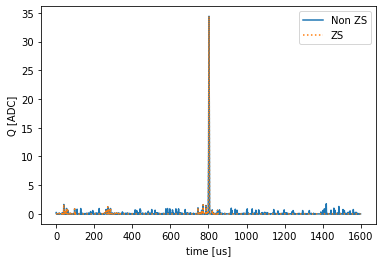

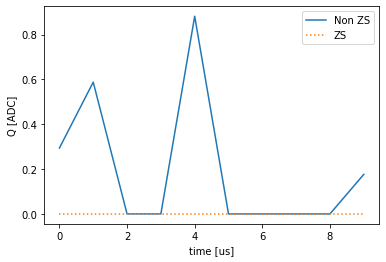

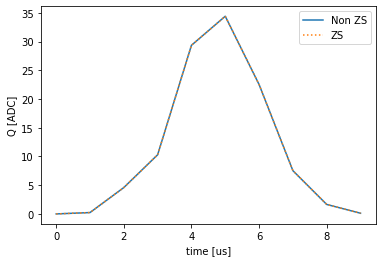

In [18]:
evt = 3
sipm = 1496
plt.plot(nzs_calibrated_sipms[evt,sipm], label='Non ZS')
plt.plot(calibrated_sipms[evt,sipm], linestyle='dotted', label='ZS')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()

plt.plot(nzs_calibrated_sipms[evt,sipm][1000:1010], label='Non ZS')
plt.plot(calibrated_sipms[evt,sipm][1000:1010], linestyle='dotted', label='ZS')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()

plt.plot(nzs_calibrated_sipms[evt,sipm][798:808], label='Non ZS')
plt.plot(calibrated_sipms[evt,sipm][798:808], linestyle='dotted', label='ZS')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()

In [25]:
test_file

'/Users/taylorcontreras/Development/Research/nz_studies/data/trigger1/8088/test_nz/run_8088_0000_trigger1_waveforms.h5'

In [29]:
nzs_file

'../../data/trigger1/8088/waveforms/run_8088_0000_trigger1_waveforms.h5'

In [19]:
i = 0
events = []
wfs = cp.wf_from_files([test_file], cp.WfType.rwf)
try:
    while wfs:
        thisdata = next(wfs)
        events.append(thisdata['sipm'])
        i += 1
except StopIteration:
    pass
finally:
    del wfs
events = np.array(events)
print('Number of Events: '+str(len(events)))

Number of Events: 156


In [30]:
i = 0
nzs_events = []
wfs = cp.wf_from_files([nzs_file], cp.WfType.rwf)
try:
    while wfs:
        thisdata = next(wfs)
        nzs_events.append(thisdata['sipm'])
        i += 1
except StopIteration:
    pass
finally:
    del wfs
nzs_events = np.array(nzs_events)
print('Number of Events: '+str(len(nzs_events)))

Number of Events: 156


In [21]:
np.shape(events)

(156, 1792, 1600)

In [22]:
np.argsort(np.sum(events[evt,:,798:808], axis=1))

array([   0, 1110, 1109, ..., 1504, 1497, 1496])

In [23]:
np.array_equal(events, nzs_events)

True

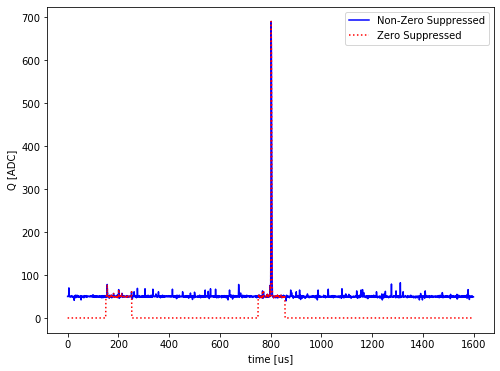

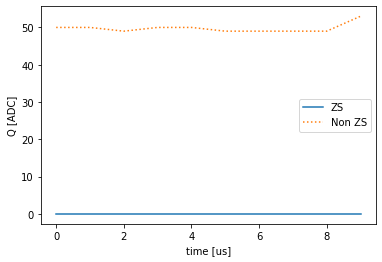

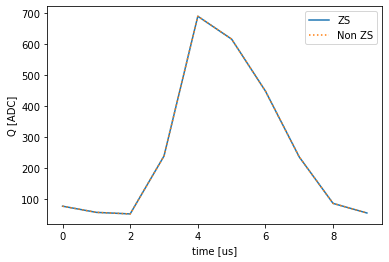

In [41]:
evt = 3
sipm = 1496
plt.figure(figsize=(8, 6))
plt.plot(nzs_events[evt,sipm], color='blue', label='Non-Zero Suppressed')
plt.plot(events[evt,sipm], color='red', linestyle='dotted', label='Zero Suppressed')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.savefig('/Users/taylorcontreras/Desktop/zs_waveform.png')
plt.show()

plt.plot(events[evt,sipm][1000:1010], label='ZS')
plt.plot(nzs_events[evt,sipm][1000:1010], linestyle='dotted', label='Non ZS')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()

plt.plot(events[evt,sipm][798:808], label='ZS')
plt.plot(nzs_events[evt,sipm][798:808], linestyle='dotted', label='Non ZS')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()

In [63]:
evt = 3
sipm = 1496
thresh = 10
n_presamples = 50
zs_test = zero_suppress(nzs_events[evt,sipm], thresh, n_presamples)
np.array_equal(nzs_events[evt,sipm], test)

[0. 0. 0. ... 0. 0. 0.]
51.66625


False

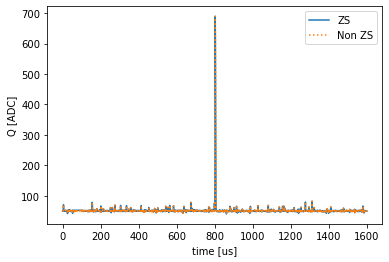

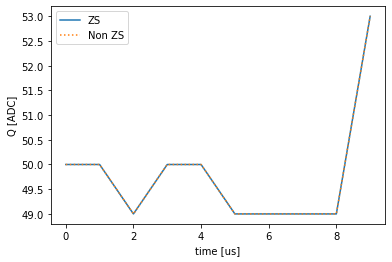

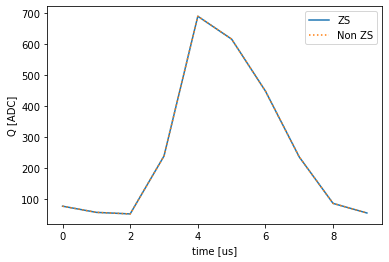

In [64]:
evt = 3
sipm = 1496
plt.plot(zs_test, label='ZS')
plt.plot(nzs_events[evt,sipm], linestyle='dotted', label='Non ZS')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()

plt.plot(zs_test[1000:1010], label='ZS')
plt.plot(nzs_events[evt,sipm][1000:1010], linestyle='dotted', label='Non ZS')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()

plt.plot(zs_test[798:808], label='ZS')
plt.plot(nzs_events[evt,sipm][798:808], linestyle='dotted', label='Non ZS')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()

In [66]:
np.sum(np.equal(nzs_events[evt,sipm], test))

1557

In [ ]:
def zero_suppress(A, thresh, n_presamples):
    
    baseline = np.mean(A)
    thresh += baseline
    B = np.zeros(np.shape(A))
    print('Baseline = '+str(baseline))
    above_thresh = False
    this_j = None
    this_k = None
    prev_peak = -999
    for i in range(len(A)-1):
        
        if A[i] >= thresh and A[i+1] >= thresh:
            
            if above_thresh:
                this_k = i+1
            else:
                this_j = i
                this_k = i+1
                above_thresh = True
                
        elif above_thresh:
            this_j = max([0,this_j-n_presamples, prev_peak])
            this_k = min(this_k+n_presamples+1, len(A))
            B[this_j:this_k] = A[this_j:this_k]
            print('Added samples '+str(this_j)+':'+str(this_k))
            prev_peak = this_k
            above_thresh = False
            
    if above_thresh and this_j!=None and this_k!=None:
        this_j = max([0,this_j-n_presamples, prev_peak])
        B[this_j:] = A[this_j:]
        print('Added samples '+str(this_j)+':')
    
    B = (np.rint(B)).astype(int) # convert to integers
    return B

In [118]:
thresh = 1
n_presamples = 2
A = np.array([0,1,0,0,2,2,0,1,1])
zero_suppress(A, thresh, n_presamples)

Baseline = 0.7777777777777778
Added samples 2:8


array([0, 0, 0, 0, 2, 2, 0, 1, 0])

In [ ]:
evt = 3
sipm = 1496
thresh = 10
n_presamples = 50
zs_test = zero_suppress(nzs_events[evt,sipm], thresh, n_presamples)
np.array_equal(nzs_events[evt,sipm], zs_test)
np.sum(np.equal(nzs_events[evt,sipm], zs_test))
zs2_test = zero_suppress(zs_test, thresh, n_presamples)

In [ ]:
plt.plot(nzs_events[evt,sipm], label='Non ZS')
plt.plot(zs_test, linestyle='dotted', label='ZS')
plt.legend()
plt.show()

plt.plot(nzs_events[evt,sipm][100:150], label='Non ZS')
plt.plot(zs_test[100:151], linestyle='dotted', label='ZS')
plt.legend()
plt.show()

plt.plot(nzs_events[evt,sipm][135:270], label='Non ZS')
plt.plot(zs_test[135:270], linestyle='dotted', label='ZS')
plt.legend()
plt.show()

plt.plot(nzs_events[evt,sipm], label='Non ZS')
plt.plot(zs_test, linestyle='dotted', label='ZS')
plt.ylim(0,100)
plt.legend()
plt.show()

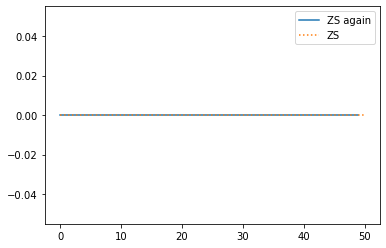

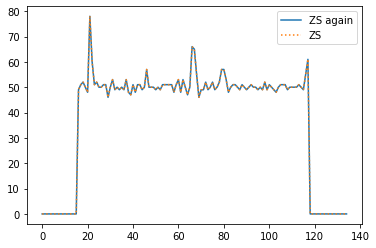

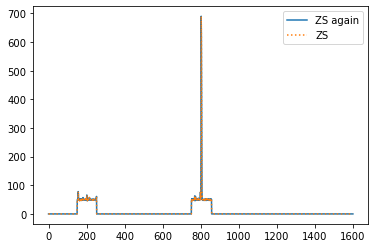

In [122]:
plt.plot(zs2_test[100:150], label='ZS again')
plt.plot(zs_test[100:151], linestyle='dotted', label='ZS')
plt.legend()
plt.show()

plt.plot(zs2_test[135:270], label='ZS again')
plt.plot(zs_test[135:270], linestyle='dotted', label='ZS')
plt.legend()
plt.show()

plt.plot(zs2_test, label='ZS again')
plt.plot(zs_test, linestyle='dotted', label='ZS')
plt.legend()
plt.show()


# Testing with ZS data

In [6]:
zs_file = '/Users/taylorcontreras/Development/Research/nz_studies/data/trigger1/7746/waveforms/run_7746_0000_trigger2_waveforms.h5'
run_number = 7746

In [7]:
events = GetRawWaveforms(run_number, zs_file)

Number of Events: 70


In [10]:
evt = 0
np.argsort(np.sum(events[evt,:,798:808], axis=1))

array([1791, 1385, 1382, ...,  746,  755,  747])

In [12]:
sipm = 747
thresh = 10
n_presamples = 50
test = zero_suppress(events[evt,sipm], thresh, n_presamples)

Baseline = 12.506875
Added samples 697:913
Added samples 1246:1448


In [18]:
np.array_equal(events[evt][sipm], test)

True

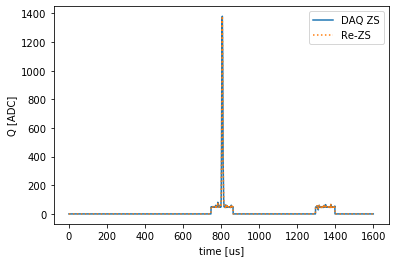

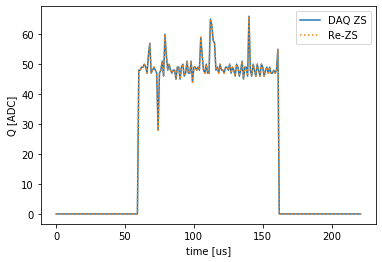

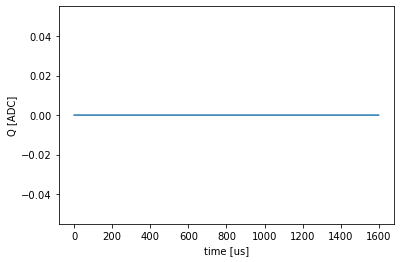

In [17]:
plt.plot(events[evt][sipm], label='DAQ ZS')
plt.plot(test, linestyle='dotted', label='Re-ZS')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()

plt.plot(events[evt][sipm][1236:1458], label='DAQ ZS')
plt.plot(test[1236:1458], linestyle='dotted', label='Re-ZS')
plt.legend()
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()

plt.plot(test - events[evt][sipm])
plt.xlabel('time [us]')
plt.ylabel('Q [ADC]')
plt.show()